In [15]:
!pip install future

In [16]:
#!pip install pymongo

In [17]:
#!pip install jupyter-themer

In [1]:
from __future__ import print_function
from pymongo import MongoClient
import matplotlib.pyplot as plt
import pandas as pd 
import datetime as dt
import pickle

In [2]:
with open("reddit_posts_2022_04_12-03_12_51_PM.pkl", "rb") as fp:
    b = pickle.load(fp)

In [3]:
b

[{'_id': ObjectId('625413df1cf1750023943ed2'),
  'subreddit': 'covidlonghaulers',
  'author': 'sleepy55555',
  'date': nan,
  'post': nan,
  'title': 'what are your safe food?',
  'upvote_ratio': 1.0,
  'all_awardings': [],
  'allow_live_comments': 0.0,
  'author_flair_css_class': None,
  'author_flair_richtext': [],
  'author_flair_text': None,
  'author_flair_type': 'text',
  'author_fullname': 't2_dlp84k9n',
  'author_is_blocked': 0.0,
  'author_patreon_flair': 0.0,
  'author_premium': 0.0,
  'awarders': [],
  'can_mod_post': 0.0,
  'contest_mode': 0.0,
  'created_utc': 1631395587.0,
  'domain': 'self.covidlonghaulers',
  'full_link': 'https://www.reddit.com/r/covidlonghaulers/comments/pmfrwr/what_are_your_safe_food/',
  'gildings': {},
  'id': 'pmfrwr',
  'is_created_from_ads_ui': 0.0,
  'is_crosspostable': 1.0,
  'is_meta': 0.0,
  'is_original_content': 0.0,
  'is_reddit_media_domain': 0.0,
  'is_robot_indexable': 1.0,
  'is_self': 1.0,
  'is_video': 0.0,
  'link_flair_background_

In [4]:
import pandas as pd
df = pd.DataFrame.from_dict(b)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20888 entries, 0 to 20887
Data columns (total 84 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   _id                            20888 non-null  object 
 1   subreddit                      20888 non-null  object 
 2   author                         20888 non-null  object 
 3   date                           0 non-null      float64
 4   post                           0 non-null      float64
 5   title                          20888 non-null  object 
 6   upvote_ratio                   20888 non-null  float64
 7   all_awardings                  20888 non-null  object 
 8   allow_live_comments            20888 non-null  float64
 9   author_flair_css_class         0 non-null      object 
 10  author_flair_richtext          20884 non-null  object 
 11  author_flair_text              1015 non-null   object 
 12  author_flair_type              20884 non-null 

In [5]:
df['selftext']

0                         what foods do you best tolerate?
1        I'm currently on month 7.5 of my LH voyage. Br...
2        Someone suggested I posted this, which I’ve al...
3        For context, I got covid back in late July 202...
4        I have read a lot of posts on this sub. I don'...
                               ...                        
20883    The topic of a 7 y/o picky eater came up in a ...
20884    I have a 7 and 5 year old who since February h...
20885    A place for members of r/LongHaulerKids to cha...
20886    My family (partner, kid and I) caught Covid in...
20887    A place for members of r/covidlonga to chat wi...
Name: selftext, Length: 20888, dtype: object

In [6]:
import datetime as dt
x0 = dt.datetime.fromtimestamp(df['created_utc'][0])

In [7]:
print(x0.strftime("%Y_%m_%d"))

2021_09_11


In [8]:
import datetime 
x = datetime.datetime(2018, 9, 15)
print(x.strftime("%b %d %Y %H:%M:%S"))

Sep 15 2018 00:00:00


In [9]:
df['created_at_ymd'] = df['created_utc'].apply(lambda x: dt.datetime.fromtimestamp(x).strftime("%Y_%m_%d"))

In [10]:
df['created_at_ymd']

0        2021_09_11
1        2021_09_11
2        2021_09_11
3        2021_09_11
4        2021_09_11
            ...    
20883    2021_12_19
20884    2021_01_24
20885    2021_01_24
20886    2021_12_11
20887    2022_01_17
Name: created_at_ymd, Length: 20888, dtype: object

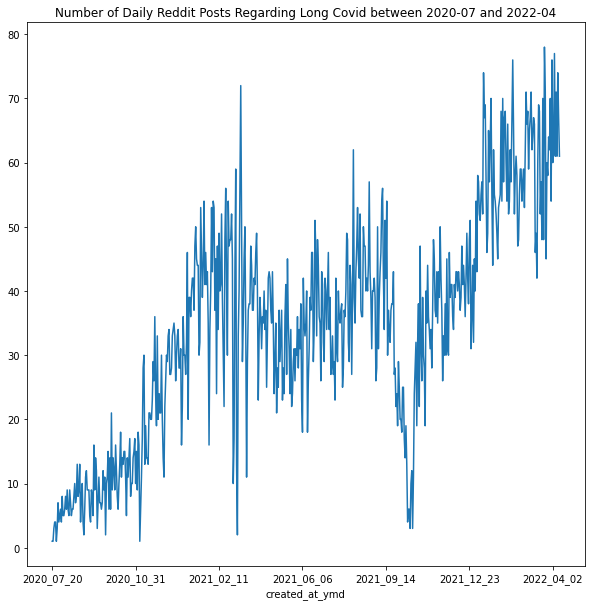

In [11]:
df.groupby(by = ['created_at_ymd']).count()['id'].plot(title="Number of Daily Reddit Posts Regarding Long Covid between 2020-07 and 2022-04", figsize=(10,10))
plt.show()

### Initial Data Visualization

### Data Preprocessing

In [12]:
import re, string, unicodedata
import nltk
import contractions # expanding contractions
import inflect # natural language related tasks of generating plurals, singular nouns, etc.
from nltk import word_tokenize, sent_tokenize
from nltk.corpus import stopwords
from nltk.stem import LancasterStemmer, WordNetLemmatizer
from nltk.tokenize import TweetTokenizer
import string


#nltk.download('punkt')
#nltk.download('stopwords')
#nltk.download('wordnet')

In [13]:
import nltk
#nltk.download('omw-1.4')
nltk.download('averaged_perceptron_tagger')
nltk.download('omw-1.4')

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\hayadi\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\hayadi\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

In [14]:
import sys
sys.path.append("../utils/preprocess")

In [15]:
from preprocess import Preprocess
prep = Preprocess()

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\hayadi\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\hayadi\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\hayadi\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [16]:
def preprocess_tweet(tweet):
    
    tweet = prep.replace_contractions(tweet)
    tweet = prep.replace_special_words(tweet)
    tweet = prep.replace_hashtags_URL_USER(tweet, mode_URL="delete", mode_Mentions="delete", mode_Hashtag="replace")
    tweet = prep.tokenize(tweet)
    tweet = prep.remove_punctuation(tweet)
    tweet = prep.preprocess_emojis(tweet)
    tweet = prep.preprocess_emoticons(tweet)
    tweet = prep.remove_non_ascii(tweet)
    tweet = prep.to_lowercase(tweet)
    tweet = prep.replace_numbers(tweet)
    tweet = prep.lemmatize_verbs(tweet)
    print("tweet before stopwords removal: ")
    print(tweet)
    tweet = prep.remove_stopwords(tweet)
    print("tweet after stopwords removal: ")
    print(tweet)
    #tweet= multiple_replace(" ".join(tweet), *replacements)
    #tweet = prep.stem_words(tweet)
    
    return tweet

def preprocess_tweets(tweets):
    return [preprocess_tweet(tweet) for tweet in tweets if tweet]

In [17]:
posts_to_process = df['selftext']

In [18]:
preprocessed_reddit_posts = preprocess_tweets(posts_to_process.to_list())

tweet before stopwords removal: 
['what', 'foods', 'do', 'you', 'best', 'tolerate']
tweet after stopwords removal: 
['foods', 'best', 'tolerate']
tweet before stopwords removal: 
['i', 'be', 'currently', 'on', 'month', '7.5', 'of', 'my', 'lh', 'voyage', 'breathe', 'issue', 'we', 'be', 'only', 'a', 'thing', 'for', 'me', 'briefly', 'at', 'the', 'start', 'of', 'all', 'this', 'but', 'i', 'have', 'be', 'deal', 'with', 'tachycardia', 'palpitation', 'pot', 'fatigue', 'and', 'general', 'orthostatic', 'intolerance', 'for', 'the', 'better', 'part', 'of', 'this', 'year', 'like', 'almost', 'all', 'of', 'you', 'any', 'and', 'all', 'test', 'that', 'i', 'have', 'be', 'subject', 'to', 'tell', 'the', 'same', 'story', 'accord', 'to', 'modern', 'medical', 'science', 'i', 'be', 'the', 'pinnacle', 'of', 'good', 'health', 'despite', 'be', 'somewhat', 'overweight', 'nothing', 'structural', 'be', 'wrong', 'with', 'me', 'my', 'cardiologist', 'have', 'recently', 'recommend', 'to', 'me', 'to', 'exercise', 'a', '

tweet before stopwords removal: 
['i', 'have', 'read', 'a', 'lot', 'of', 'post', 'on', 'this', 'sub', 'i', 'do', 'not', 'want', 'to', 'pretend', 'that', 'i', 'be', 'have', 'it', 'anywhere', 'near', 'a', 'worse', 'a', 'a', 'lot', 'of', 'other', 'people', 'my', 'fatigue', 'be', 'at', 'it', 'be', 'peak', 'for', 'about', 'one', 'month', 'after', 'my', 'infection', 'and', 'then', 'vanish', 'right', 'now', 'my', 'symptom', 'be', 'one', 'palpitation', 'if', 'i', 'put', 'my', 'hand', 'on', 'my', 'chest', 'i', 'can', 'feel', 'my', 'heart', 'beat', 'if', 'sometimes', 'i', 'press', 'some', 'part', 'of', 'my', 'body', 'against', 'another', 'part', 'of', 'my', 'body', 'i', 'can', 'feel', 'my', 'pulse', 'two', 'increase', 'heart', 'rate', 'my', 'heart', 'rate', 'be', 'very', 'confuse', 'it', 'will', 'most', 'definitely', 'increase', 'when', 'i', 'stand', 'up', 'go', 'upto', 'one hundred and fifteen', 'randomly', 'on', 'stand', 'almost', 'immediately', 'however', 'at', 'time', 'it', 'reach', 'one hun

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'be', 'a', 'physical', 'therapist', 'strength', 'coach', 'and', 'long', 'hauler', 'of', 'eleven', 'month', 'now', 'i', 'spend', 'a', 'lot', 'of', 'time', 'read', 'post', 'on', 'here', 'facebook', 'elsewhere', 'talk', 'to', 'medical', 'professional', 'and', 'scour', 'research', 'relate', 'to', 'covid', 'post-viral', 'syndrome', 'cf', 'and', 'the', 'autonomic', 'nervous', 'system', 'disclaimer', 'my', 'scope', 'of', 'practice', 'be', 'limit', 'and', 'do', 'not', 'cover', 'everything', 'that', 'i', 'have', 'research', 'this', 'be', 'mean', 'for', 'educational', 'purpose', 'and', 'be', 'not', 'medical', 'advice', 'i', 'have', 'be', 'answer', 'question', 'and', 'provide', 'support', 'here', 'for', 'a', 'little', 'while', 'i', 'want', 'to', 'organize', 'all', 'the', 'information', 'and', 'my', 'thought', 'i', 'have', 'give', 'to', 'you', 'all', 'into', 'one', 'place', 'so', 'others', 'have', 'a', 'chance', 'to', 'benefit', 'from', 'thi

tweet before stopwords removal: 
['hello', 'soon', 'i', 'will', 'be', 'four', 'month', 'long', 'haul', 'from', 'vax', 'my', 'main', 'symptom', 'be', 'pot', 'syndrome', 'i', 'be', 'a', 'healthy', 'pro', 'marathon', 'runner', 'i', 'just', 'need', 'some', 'hope', 'when', 'this', 'nightmare', 'will', 'finish', 'i', 'live', 'in', 'greece', 'and', 'vaccination', 'be', 'mandatory', 'to', 'sit', 'in', 'a', 'restaurant', 'or', 'bar', 'i', 'can', 'not', 'run', 'and', 'go', 'to', 'gym', 'due', 'to', 'pot', 'i', 'be', 'half', 'vaxxed', 'i', 'can', 'not', 'go', 'anywhere', 'to', 'go', 'to', 'my', 'university', 'i', 'need', 'to', 'test', 'twice', 'per', 'week', 'with', 'my', 'own', 'money', 'since', 'i', 'be', 'a', 'runner', 'and', 'stop', 'my', 'income', 'be', 'limited', 'right', 'now', 'guy', 'just', 'give', 'me', 'hope', 'i', 'can', 'not', 'see', 'the', 'light', 'i', 'do', 'not', 'have', 'anxiety', 'i', 'be', 'just', 'drain', 'thank', 'you', 'guy']
tweet after stopwords removal: 
['hello', 'soon'

tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'join', 'a', 'bunch', 'of', 'support', 'group', 'since', 'my', 'first', 'and', 'only', 'jab', 'on', '3/30', 'moderna', 'but', 'what', 'i', 'just', 'find', 'out', 'land', 'me', 'here', 'just', 'want', 'to', 'share', 'my', 'story', 'and', 'see', 'if', 'there', 'be', 'others', 'with', 'a', 'similar', 'experience', 'i', 'have', 'my', 'first', 'dose', 'on', '3/30', 'and', 'have', 'not', 'be', 'the', 'same', 'since', 'i', 'experience', 'the', 'usual', 'symptom', 'at', 'first', 'but', 'thirty-six', 'hour', 'later', 'i', 'develop', 'tinnitus', 'hyperacusis', 'and', 'aural', 'fullness', 'a', 'few', 'day', 'after', 'that', 'my', 'leg', 'start', 'tingle', 'i', 'have', 'an', 'achey', 'back', 'and', 'sore', 'lymph', 'node', 'for', 'a', 'couple', 'of', 'week', 'it', 'be', 'be', 'a', 'roller', 'coaster', 'ride', 'ever', 'since', 'and', 'i', 'be', 'five', 'month', 'out', 'i', 'have', 'see', 'a', 'lot', 'of', 'improvement', 'this', 'past', 'mo

tweet before stopwords removal: 
['do', 'anyone', 'know', 'what', 'this', 'could', 'be', 'start', 'in', 'july', 'when', 'i', 'test', 'positive', 'chest', 'hurt', 'when', 'i', 'breathe', 'also', 'my', 'back', 'it', 'hurt', 'to', 'cry', 'and', 'yawn', 'and', 'with', 'movement', 'the', 'pain', 'be', 'sometimes', 'in', 'the', 'center', 'of', 'my', 'chest', 'and', 'also', 'the', 'pain', 'be', 'under', 'my', 'left', 'breast', 'and', 'my', 'back', 'i', 'be', 'so', 'tired', 'of', 'this', 'pain', 'i', 'have', 'have', 'x-ray', 'do', 'i', 'have', 'ct', 'scan', 'and', 'a', 'echo', 'test', 'anyone', 'know', 'what', 'it', 'could', 'be']
tweet after stopwords removal: 
['anyone', 'know', 'could', 'start', 'july', 'test', 'positive', 'chest', 'hurt', 'breathe', 'back', 'hurt', 'cry', 'yawn', 'movement', 'pain', 'sometimes', 'center', 'chest', 'pain', 'left', 'breast', 'back', 'tired', 'pain', 'x-ray', 'ct', 'scan', 'echo', 'test', 'anyone', 'know', 'could']
tweet before stopwords removal: 
['there', '

tweet before stopwords removal: 
['i', 'be', 'a', 'twenty-five', 'year', 'old', 'male', 'i', 'be', 'not', 'even', 'sure', 'if', 'i', 'get', 'covid', 'and', 'that', 'be', 'what', 'be', 'cause', 'everything', 'i', 'be', 'feel', 'but', 'i', 'have', 'not', 'a', 'clue', 'i', 'have', 'felt', 'sick', 'multiple', 'time', 'and', 'never', 'test', 'positive', 'for', 'covid', 'nineteen', 'however', 'i', 'start', 'to', 'loss', 'my', 'hair', 'and', 'devoloped', 'anxiety', 'i', 'have', 'very', 'minimal', 'heart', 'palpitation', 'while', 'work', 'out', 'and', 'felt', 'like', 'i', 'do', 'not', 'have', 'a', 'much', 'energy', 'a', 'i', 'use', 'to', 'so', 'i', 'just', 'work', 'out', 'harder', 'think', 'that', 'be', 'the', 'solution', 'i', 'just', 'could', 'not', 'figure', 'out', 'what', 'be', 'go', 'on', 'about', 'four', 'month', 'later', 'i', 'get', 'sick', 'with', 'a', 'soar', 'throat', 'and', 'fatigue', 'after', 'see', 'a', 'friend', 'she', 'have', 'a', 'slight', 'cough', 'i', 'get', 'test', 'for', 'co

tweet before stopwords removal: 
['hey', 'all', 'twenty-six', 'f', 'lh', 'for', 'about', 'ten', 'month', 'now', 'sorry', 'for', 'the', 'long', 'read', 'if', 'you', 'have', 'read', 'any', 'of', 'my', 'previous', 'post', 'you', 'will', 'know', 'that', 'i', 'get', 'my', 'first', 'dose', 'of', 'moderna', 'on', 'april', '9th', 'i', 'have', 'a', 'few', 'bad', 'side', 'effect', 'that', 'last', 'about', 'a', 'month', 'increase', 'heartrate', 'depression', 'anxiety', 'inflammation', 'and', 'scariest', 'of', 'all', 'tinnitus', 'which', 'i', 'discover', 'two', 'week', 'after', 'my', 'first', 'shot', 'in', 'my', 'right', 'ear', 'the', 'depression', 'and', 'anxiety', 'ebb', 'away', 'with', 'time', 'tinnitus', 'and', 'heartrate', 'be', 'here', 'to', 'stay', 'since', 'then', 'i', 'have', 'decide', 'to', 'visit', 'an', 'ent', 'to', 'get', 'my', 'ear', 'check', 'out', 'i', 'start', 'to', 'feel', 'fullness', 'in', 'both', 'ear', 'and', 'pain', 'that', 'would', 'come', 'and', 'go', 'after', 'an', 'examin

tweet before stopwords removal: 
['be', 'immediately', 'tire', 'after', 'my', 'first', 'shot', 'and', 'that', 'be', 'about', 'it', 'a', 'week', 'later', 'i', 'slept', 'for', 'three', 'day', 'straight', 'and', 'it', 'be', 'like', 'a', 'truck', 'hit', 'me', 'it', 'be', 'virtually', 'impossible', 'to', 'get', 'up', 'or', 'move', 'i', 'have', 'severe', 'pain', 'in', 'my', 'lower', 'belly', 'and', 'lower', 'back', 'i', 'end', 'up', 'have', 'a', 'gnarly', 'kidney', 'infection', 'so', 'i', 'figure', 'the', 'symptom', 'must', 'be', 'due', 'to', 'this', 'take', 'my', 'weekly', 'course', 'of', 'antibiotic', 'and', 'felt', 'better', 'a', 'week', 'after', 'my', 'second', 'shot', 'last', 'thursday', 'i', 'start', 'feel', 'terrible', 'once', 'again', 'this', 'time', 'my', 'face', 'have', 'break', 'out', 'in', 'hive', 'along', 'with', 'my', 'chest', 'and', 'arm', 'the', 'itchiness', 'be', 'out', 'of', 'control', 'i', 'consume', 'every', 'sort', 'of', 'antihistamine', 'that', 'i', 'have', 'in', 'my', 

tweet before stopwords removal: 
['have', 'anyone', 'have', 'these', 'symptom', 'and', 'see', 'an', 'improvement', 'i', 'be', 'concern', 'it', 'could', 'be', 'fibromyalgia', 'nearly', 'six', 'month', 'in', 'and', 'this', 'start', 'at', 'three', 'month']
tweet after stopwords removal: 
['anyone', 'symptom', 'improvement', 'concern', 'could', 'fibromyalgia', 'nearly', 'six', 'month', 'start', 'month']
tweet before stopwords removal: 
['do', 'anyone', 'else', 'experience', 'pain', 'in', 'the', 'cheekbone', 'my', 'story', 'i', 'have', 'mild', 'covid', 'in', 'december', 'two', 'week', 'after', 'recovery', 'start', 'have', 'fatigue', 'heart', 'palpitation', 'unable', 'to', 'focus', 'eye', 'on', 'far', 'remove', 'object', 'a', 'one', 'and', 'half', 'month', 'later', 'get', 'uveitis', 'eye', 'inflammation', 'in', 'my', 'left', 'eye', 'together', 'with', 'stiff', 'knee', 'and', 'gi', 'upset', 'now', 'cure', 'my', 'uveitis', 'but', 'still', 'experience', 'pain', 'when', 'move', 'the', 'eye', 'ey

tweet before stopwords removal: 
['i', 'feel', 'like', 'i', 'be', 'post', 'the', 'same', 'thing', 'over', 'and', 'over', 'but', 'whatever', 'i', 'be', 'try', 'not', 'to', 'stress', 'but', 'today', 'be', 'one', 'of', 'those', 'day', 'i', 'cannot', 'stop', 'worrying', 'and', 'i', 'be', 'read', 'everything', 'about', 'longcovid', 'my', 'pem', 'be', 'the', 'most', 'annoying', 'thing', 'i', 'can', 'handle', 'fatigue', 'i', 'can', 'handle', 'pot', 'but', 'the', 'pem', 'be', 'drive', 'me', 'nut', 'and', 'it', 'scar', 'me', 'that', 'it', 'be', 'a', 'symptom', 'of', 'cf', 'le', 'than', 'two', 'month', 'since', 'i', 'start', 'notice', 'pem', 'but', 'still', 'please', 'give', 'me', 'happy', 'story', 'of', 'get', 'over', 'it']
tweet after stopwords removal: 
['feel', 'like', 'post', 'whatever', 'try', 'stress', 'today', 'day', 'cannot', 'stop', 'worrying', 'read', 'everything', 'longcovid', 'pem', 'annoying', 'handle', 'fatigue', 'handle', 'pot', 'pem', 'drive', 'nut', 'scar', 'symptom', 'cf', 'mo

tweet before stopwords removal: 
['be', 'it', 'better', 'to', 'use', 'an', 'online', 'portal', 'to', 'write', 'message', 'to', 'a', 'doctor', 'or', 'to', 'call', 'the', 'office', 'and', 'leave', 'a', 'voice', 'mail', 'when', 'you', 'be', 'upset', 'with', 'treatment', 'i', 'have', 'write', 'message', 'to', 'my', 'doctor', 'on', 'the', 'portal', 'already', 'she', 'change', 'my', 'course', 'of', 'treatment', 'and', 'she', 'have', 'keep', 'on', 'that', 'course', 'after', 'i', 'complain', 'at', 'this', 'point', 'i', 'have', 'have', 'to', 'pay', 'out', 'of', 'pocket', 'for', 'medicine', 'that', 'do', 'not', 'work', 'and', 'go', 'back', 'to', 'be', 'in', 'pain', 'i', 'have', 'a', 'previous', 'medication', 'that', 'be', 'help', 'me', 'feel', 'normal', 'again', 'the', 'doctor', 'be', 'try', 'to', 'fit', 'me', 'into', 'a', 'medical', 'category', 'that', 'i', 'do', 'not', 'fit', 'i', 'have', 'already', 'give', 'her', 'my', 'covid', 'long', 'hauler', 'blood', 'workup', 'that', 'indicate', 'massive

tweet before stopwords removal: 
['for', 'those', 'with', 'long', 'haul', 'covid', 'or', 'post', 'vaccine', 'headache', 'have', 'anyone', 'find', 'the', 'because', 'any', 'test', 'recommendation', 'i', 'have', 'do', 'blood', 'work', 'ct', 'scan', 'check', 'ent', 'and', 'eye', 'wait', 'for', 'mri', 'currently']
tweet after stopwords removal: 
['long', 'haul', 'covid', 'post', 'vaccine', 'headache', 'anyone', 'find', 'test', 'recommendation', 'blood', 'work', 'ct', 'scan', 'check', 'ent', 'eye', 'wait', 'mri', 'currently']
tweet before stopwords removal: 
['i', 'be', 'get', 'to', 'the', 'point', 'where', 'i', 'be', 'scar', 'to', 'do', 'thing', 'mainly', 'any', 'kind', 'of', 'physical', 'exertion', 'for', 'fear', 'that', 'i', 'get', 'a', 'relapse', 'or', 'develop', 'cf', 'me', 'i', 'be', 'the', 'heaviest', 'i', 'have', 'ever', 'be', 'in', 'my', 'whole', 'life', 'previously', 'extremely', 'fit', 'but', 'there', 'be', 'a', 'barrier', 'that', 'be', 'not', 'allow', 'me', 'to', 'get', 'back', 

tweet before stopwords removal: 
['i', 'just', 'check', 'my', 'blood', 'test', 'for', 'the', 'first', 'time', 'and', 'notice', 'that', 'it', 'say', 'that', 'my', 'cpk', 'be', 'high', 'it', 'be', 'in', 'the', '1000', 'when', 'it', 'be', 'suppose', 'to', 'be', 'below', 'three hundred', 'this', 'be', 'after', 'i', 'go', 'to', 'the', 'er', 'because', 'of', 'the', 'personalization', 'my', 'alt', 'sqpt', 'be', 'low', 'and', 'i', 'come', 'across', 'a', 'article', 'on', 'nih', 'that', 'low', 'alt', 'may', 'increase', 'all', 'because', 'mortality', 'in', 'relation', 'to', 'the', 'heart', 'this', 'be', 'after', 'i', 'go', 'to', 'the', 'er', 'for', 'chest', 'pain', 'be', 'anybody', "else's", 'alt', 'low', 'i', 'be', 'wonder', 'if', 'that', 'be', 'why', 'the', 'chest', 'pain', 'be', 'so', 'persistent', 'i', 'be', 'still', 'try', 'to', 'figure', 'out', 'how', 'we', 'be', 'all', 'connect', 'why', 'do', 'all', 'of', 'u', 'catch', 'longcovid', 'there', 'have', 'to', 'be', 'a', 'reason']
tweet after st

tweet before stopwords removal: 
['i', 'be', 'kind', 'of', 'confuse', 'by', 'the', 'result', 'since', 'i', 'expect', 'to', 'be', 'high', 'in', 'many', 'area', 'due', 'to', 'be', 'a', 'long', 'hauler', 'but', 'most', 'thing', 'seem', 'ok', 'the', 'test', 'result', 'show', 'sars', 'neutralization', 'antibody', 'be', 'positive', 'at', 'ninety-seven', 'scd', '40l', 'be', 'high', 'thirty-four thousand, six hundred and fifty-three', 'pg', 'ml', 'ccl', 'five', 'rantes', 'be', 'high', 'fifteen thousand, three hundred and seventy-two', 'pg', 'ml', 'everything', 'else', 'seem', 'to', 'be', 'in', 'range', 'any', 'help', 'understand', 'what', 'this', 'mean', 'would', 'be', 'greatly', 'appreciated', 'thanks']
tweet after stopwords removal: 
['kind', 'confuse', 'result', 'since', 'expect', 'high', 'many', 'area', 'due', 'long', 'hauler', 'ok', 'test', 'result', 'show', 'sars', 'neutralization', 'antibody', 'positive', 'ninety-seven', 'scd', '40l', 'high', 'thirty-four thousand, six hundred and fifty

tweet before stopwords removal: 
['i', 'read', 'a', 'lot', 'of', 'post', 'here', 'about', 'exercise', 'intolerance', 'i', 'be', 'one', 'of', 'those', 'people', 'who', 'be', 'extremely', 'active', 'prior', 'to', 'covid', 'and', 'could', 'do', 'a', 'lot', 'of', 'cardio', 'with', 'no', 'issue', 'i', 'fell', 'victim', 'to', 'covid', 'in', 'december', 'and', 'can', 'no', 'longer', 'workout', 'i', 'see', 'a', 'lot', 'of', 'comment', 'say', 'do', 'not', 'push', 'yourself', 'you', 'will', 'make', 'it', 'worse', 'rest', 'for', 'a', 'long', 'time', 'just', 'do', 'not', 'workout', 'watch', 'funny', 'video', 'and', 'i', 'totally', 'agree', 'with', 'these', 'comment', 'they', 'be', 'right', 'we', 'need', 'to', 'fully', 'heal', 'some', 'of', 'these', 'people', 'may', 'have', 'even', 'have', 'the', 'experience', 'and', 'be', 'try', 'to', 'warn', 'u', 'how', 'important', 'it', 'be', 'to', 'rest', 'and', 'i', 'appreciate', 'those', 'people', 'help', 'but', 'my', 'real', 'question', 'be', 'how', 'do', '

tweet before stopwords removal: 
['preface', 'i', 'be', 'a', 'thirty-three', 'year', 'old', 'male', 'who', 'have', 'covid', 'back', 'in', 'november', 'my', 'symptom', 'we', 'be', 'generally', 'mild', 'along', 'with', 'a', 'mild', 'pneumonia', 'i', 'have', 'be', 'long', 'hauling', 'for', 'about', 'four', 'month', 'now', 'come', 'on', 'to', 'five', 'with', 'symptom', 'such', 'a', 'fatigue', 'joint', 'pain', 'headache', 'pem', 'i', 'develop', 'tinnitus', 'red', 'ear', 'flush', 'hot', 'and', 'red', 'not', 'swell', 'about', '2.5', 'month', 'post', 'covid', 'i', 'recently', 'run', 'a', 'liver', 'panel', 'for', 'abdominal', 'pain', 'and', 'diarrhea', 'that', 'i', 'have', 'have', 'for', 'one', 'month', 'start', 'february', 'my', 'alt', 'be', 'elevate', 'at', 'sixty-five', 'and', 'esr', 'at', 'twenty', 'they', 'we', 'be', 'borderline', 'so', 'my', 'doctor', 'and', 'i', 'decide', 'to', 'watch', 'it', 'and', 'retest', 'in', 'two', 'week', 'the', 'retest', 'show', 'that', 'my', 'alt', 'and', 'esr'

tweet before stopwords removal: 
['also', 'when', 'do', 'it', 'set', 'up', 'view', 'poll']
tweet after stopwords removal: 
['set', 'view', 'poll']
tweet before stopwords removal: 
['hope', 'you', 'all', 'be', 'feel', 'better', 'do', 'anyone', 'get', 'like', 'a', 'weakness', 'in', 'arm', 'and', 'torso', 'chest', 'between', '4am', 'and', 'nine', 'be', 'when', 'sleep', 'that', 'wake', 'you', 'up', 'with', 'like', 'some', 'head', 'pain', 'every', 'day', 'i', 'have', 'have', 'it', 'from', 'month', 'four', 'to', 'eight', 'now', 'it', 'be', 'get', 'a', 'tad', 'better', 'but', 'not', 'much', 'do', 'not', 'know', 'what', 'it', 'be', 'but', 'it', 'be', 'uncomfortable', 'it', 'cause', 'alittle', 'tremble', 'but', 'pretty', 'much', 'go', 'away', 'a', 'i', 'get', 'up']
tweet after stopwords removal: 
['hope', 'feel', 'better', 'anyone', 'like', 'weakness', 'arm', 'torso', 'chest', '4am', 'nine', 'sleep', 'wake', 'like', 'head', 'pain', 'every', 'day', 'month', 'four', 'eight', 'tad', 'better', 'muc

tweet before stopwords removal: 
['twenty-eight', 'm', 'australia', 'infect', '11/07', 'two thousand and twenty', 'after', 'a', 'long', 'break', 'i', 'have', 'come', 'back', 'to', 'lurk', 'on', 'this', 'sub', 'a', 'little', 'a', 'my', 'ptsd', 'have', 'slowly', 'heal', 'and', 'i', 'do', 'not', 'go', 'down', 'the', 'spiral', 'over', 'every', 'article', 'and', 'post', 'like', 'i', 'use', 'to', 'but', 'i', 'really', 'wanted', 'to', 'make', 'a', 'post', 'let', 'a', 'lot', 'of', 'you', 'all', 'feel', 'the', 'same', 'know', 'not', 'to', 'believe', 'everything', 'on', 'here', 'we', 'do', 'not', 'actually', 'know', 'anybody', 'on', 'here', 'a', 'supportive', 'a', 'it', 'can', 'be', 'for', 'some', 'i', 'have', 'see', 'people', 'comment', 'on', 'multiple', 'hope-seeking', 'post', 'we', 'will', 'not', 'get', 'better', 'i', 'have', 'be', 'long', 'hauling', 'for', 'fifteen', 'month', 'and', 'their', 'earliest', 'long', 'hauler', 'post', 'will', 'only', 'be', 'a', 'few', 'month', 'ago', 'i', 'have', 

tweet before stopwords removal: 
['pre', 'covid', 'health', 'i', 'be', 'thirty-two', 'year', 'old', 'six', 'five', 'and', 'at', 'the', 'time', 'of', 'believed', 'infection', 'three hundred and fifty-five', 'pound', 'in', 'two thousand and fourteen', 'i', 'get', 'diagnose', 'with', 'crohn', 'disease', 'and', 'in', 'two thousand and fifteen', 'i', 'start', 'take', 'an', 'immuno', 'suppressant', 'drug', 'call', 'remicade', 'since', 'then', 'my', 'life', 'have', 'be', 'back', 'to', 'normal', 'with', 'my', 'crohn', 'in', 'remission', 'i', 'have', 'be', 'severely', 'overweight', 'most', 'of', 'my', 'adult', 'life', 'and', 'for', 'the', 'last', 'eight', 'year', 'i', 'have', 'have', 'issue', 'with', 'high', 'blood', 'pressure', 'and', 'do', 'nothing', 'to', 'control', 'it', 'i', 'smoke', 'a', 'pack', 'of', 'cigarette', 'a', 'day', 'and', 'drank', 'only', 'when', 'at', 'a', 'social', 'event', 'with', 'friend', 'besides', 'those', 'issue', 'felt', 'like', 'i', 'could', 'wrestle', 'a', 'bear', 'a

tweet before stopwords removal: 
['if', 'i', 'ever', 'recover', 'from', 'this', 'i', 'be', 'become', 'a', 'doctor', 'i', 'have', 'read', 'so', 'many', 'story', 'of', 'people', 'not', 'be', 'believe', 'and', 'be', 'treat', 'horribly', 'i', 'be', 'lucky', 'and', 'believe', 'and', 'treat', 'well', 'and', 'swiftly', 'but', 'you', 'should', 'not', 'have', 'to', 'be', 'lucky', 'to', 'receive', 'proper', 'treatment', 'i', 'be', 'twenty-six', 'so', 'it', 'will', 'take', 'awhile', 'with', 'recovery', 'but', 'i', 'be', 'hop', 'that', 'in', 'about', '10-14', 'year', 'provide', 'i', 'heal', 'swiftly', 'it', 'be', 'be', 'about', 'eight', 'month', 'there', 'will', 'be', 'one', 'more', 'doctor', 'provide', 'quality', 'treatment', 'for', 'people', 'like', 'u']
tweet after stopwords removal: 
['ever', 'recover', 'become', 'doctor', 'read', 'many', 'story', 'people', 'believe', 'treat', 'horribly', 'lucky', 'believe', 'treat', 'well', 'swiftly', 'lucky', 'receive', 'proper', 'treatment', 'twenty-six', '

tweet before stopwords removal: 
['hello', 'twenty-three', 'year', 'old', 'male', 'here', 'have', 'be', 'weight', 'lift', 'since', 'sixteen', 'year', 'old', 'extremely', 'active', 'individual', 'who', 'be', 'now', 'battle', 'longcovid', 'i', 'have', 'be', 'lurk', 'this', 'board', 'since', 'i', 'have', 'covidvirus', 'on', 'august', '31st', 'i', 'have', 'a', 'very', 'minor', 'case', 'with', 'a', 'fever', 'body', 'ache', 'and', 'chill', 'i', 'get', 'over', 'the', 'virus', 'rather', 'quickly', 'and', 'get', 'back', 'to', 'my', 'workout', 'routine', 'which', 'felt', 'a', 'little', 'harder', 'than', 'usual', 'but', 'i', 'push', 'through', 'it', 'fast', 'forward', 'a', 'month', 'or', 'two', 'out', 'i', 'be', 'still', 'work', 'out', 'and', 'run', 'start', 'to', 'develop', 'weird', 'heart', 'beat', 'very', 'rapid', 'at', 'random', 'occasion', 'and', 'would', 'wake', 'up', 'during', 'the', 'middle', 'of', 'the', 'night', 'feeling', 'a', 'if', 'my', 'heart', 'slow', 'down', 'to', 'the', 'point', 

tweet before stopwords removal: 
['nineteen', 'm', 'currently', 'ten', 'month', 'into', 'longcovid', 'i', 'be', 'finally', 'start', 'to', 'feel', 'normal', 'again', 'and', 'do', 'not', 'want', 'all', 'of', 'this', 'progress', 'to', 'go', 'in', 'vain', 'please', 'share', 'your', 'vaccine', 'experience', 'i', 'will', 'be', 'get', 'pfizer']
tweet after stopwords removal: 
['nineteen', 'currently', 'ten', 'month', 'longcovid', 'finally', 'start', 'feel', 'normal', 'want', 'progress', 'vain', 'please', 'share', 'vaccine', 'experience', 'pfizer']
tweet before stopwords removal: 
['i', 'come', 'across', 'this', 'vid', 'where', 'they', 'speak', 'fondly', 'of', 'it', 'have', 'anyone', 'have', 'any', 'luck', 'with', 'this']
tweet after stopwords removal: 
['across', 'vid', 'speak', 'fondly', 'anyone', 'luck']
tweet before stopwords removal: 
['have', 'anyone', 'try', 'go', 'on', 'a', 'detox', 'cleanse', 'to', 'help', 'with', 'any', 'of', 'your', 'longcovid', 'symptom']
tweet after stopwords remo

tweet before stopwords removal: 
['we', 'all', 'know', 'at', 'some', 'point', 'there', 'we', 'be', 'go', 'to', 'be', 'individual', 'who', 'we', 'be', 'willing', 'to', 'ignore', 'the', 'large', 'amount', 'of', 'longcovid', 's', 'quantifiable', 'evidence', 'show', 'the', 'presence', 'of', 'severe', 'dystautonomia', 'autoantibody', 'alter', 'gas', 'exchange', 'in', 'lung', 'impaired', 'cerebral', 'blood', 'flow', 'heighten', 'inflammatory', 'marker', 'sustain', 'organ', 'damage', 'new', 'onset', 'diabetes', 'and', 'nafld', 'in', 'otherwise', 'healthy', 'people', 'pasc', 'whatever', 'dismissive', 'name', 'it', 'have', 'be', 'label', 'that', 'detract', 'from', 'the', 'pure', 'physiological', 'torment', 'it', 'bring', 'it', 'seem', 'there', 'have', 'be', 'a', 'small', 'amount', 'of', 'op-eds', 'be', 'release', 'over', 'the', 'last', 'few', 'month', 'of', 'predominantly', 'cunty', 'performative', 'psychiatrist', 'who', 'willingly', 'choose', 'to', 'ignore', 'any', 'scientific', 'and', 'medica

tweet before stopwords removal: 
['month', 'eight', 'neuropathy', 'be', 'so', 'bad', 'that', 'my', 'hand', 'be', 'drop', 'thing', 'and', 'my', 'depth', 'perception', 'be', 'terrible', 'my', 'finger', 'and', 'toe', 'shake', 'uncontrollably', 'my', 'foot', 'sometimes', 'trip', 'on', 'themselves', 'my', 'brain', 'fog', 'be', 'turn', 'into', 'serious', 'cognitive', 'dysfunction', 'i', 'use', 'to', 'feel', 'better', 'in', 'the', 'beginning', 'of', 'the', 'day', 'and', 'worse', 'at', 'night', 'but', 'now', 'it', 'be', 'reverse', 'i', 'feel', 'good', 'until', 'two', 'hour', 'after', 'i', 'wake', 'up', 'the', 'neuropathy', 'be', 'everywhere', 'all', 'my', 'extremity', 'shake', 'my', 'head', 'my', 'leg', 'and', 'arm', 'be', 'shake', 'very', 'subtly', 'i', 'feel', 'so', 'helpless', 'and', 'tomorrow', 'i', 'start', 'a', 'desk', 'job', 'thanks', 'to', 'ada', 'american', 's', 'disability', 'act', 'the', 'only', 'thing', 'that', 'help', 'be', 'my', 'ivermectin', 'dose', 'whenever', 'i', 'take', 'it'

tweet before stopwords removal: 
['my', 'bp', 'get', 'higher', 'mainly', 'diastolic', 'when', 'stand', 'up', 'heart', 'rate', 'go', 'to', '130-140']
tweet after stopwords removal: 
['bp', 'higher', 'mainly', 'diastolic', 'stand', 'heart', 'rate', '130-140']
tweet before stopwords removal: 
['so', 'what', 'be', 'the', 'chance', 'of', 'a', 'second', 'infection', 'for', 'me', 'i', 'feel', 'like', 'my', 'body', 'will', 'not', 'be', 'able', 'to', 'handle', 'it', 'again', 'honestly', 'i', 'still', 'have', 'antibody', 'and', 'have', 'be', 'in', 'super', 'close', 'contact', 'with', 'her', 'this', 'entire', 'time', 'seeing', 'a', 'she', 'be', 'only', 'five', 'year', 'old', 'any', 'of', 'you', 'all', 'have', 'similar', 'experience']
tweet after stopwords removal: 
['chance', 'second', 'infection', 'feel', 'like', 'body', 'able', 'handle', 'honestly', 'still', 'antibody', 'super', 'close', 'contact', 'entire', 'time', 'seeing', 'five', 'year', 'old', 'similar', 'experience']
tweet before stopword

tweet before stopwords removal: 
['i', 'have', 'be', 'long', 'hauling', 'for', 'around', 'nine', 'month', 'now', 'and', 'recently', 'my', 'symptom', 'have', 'get', 'a', 'lot', 'worse', 'i', 'have', 'decide', 'to', 'try', 'some', 'antihistamine', 'i', 'be', 'specifically', 'look', 'at', 'loratadine', 'and', 'famotidine', 'however', 'i', 'live', 'in', 'south', 'africa', 'and', 'i', 'have', 'not', 'be', 'able', 'to', 'find', 'famotidine', 'anywhere', 'i', 'have', 'come', 'to', 'believe', 'that', 'it', 'be', 'not', 'sell', 'in', 'south', 'africa', 'i', 'want', 'to', 'ask', 'for', 'advice', 'on', 'what', 'to', 'do', 'be', 'there', 'any', 'other', 'h2', 'blocker', 'that', 'i', 'should', 'try', 'instead', 'or', 'some', 'other', 'alternative', 'that', 'i', 'can', 'try', 'in', 'place', 'of', 'famotidine', 'i', 'be', 'consider', 'order', 'famotidine', 'online', 'from', 'amazon', 'or', 'something', 'but', 'i', 'be', 'a', 'bit', 'concerned', 'about', 'order', 'medication', 'online', 'any', 'advice

tweet before stopwords removal: 
['if', 'lh', 'be', 'the', 'viral', 'protein', 'remain', 'in', 'u', 'then', 'the', 'same', 'logic', 'in', 'this', 'article', 'could', 'be', 'apply', 'to', 'u', 'maybe', 'our', 'ace', 'two', 'have', 'be', 'out', 'of', 'commission', 'too', 'long', 'from', 'the', 'protein', 'constantly', 'bind', 'to', 'what', 'we', 'have', 'available']
tweet after stopwords removal: 
['lh', 'viral', 'protein', 'remain', 'logic', 'article', 'could', 'apply', 'maybe', 'ace', 'commission', 'long', 'protein', 'constantly', 'bind', 'available']
tweet before stopwords removal: 
['so', 'really', 'hopeful', 'that', 'vip', 'be', 'approve', 'for', 'acute', 'covid', 'if', 'it', 'be', 'really', 'think', 'there', 'be', 'a', 'good', 'chance', 'it', 'will', 'be', 'useful', 'for', 'longhaulers', 'too', 'it', 'a', 'naturally', 'find', 'in', 'the', 'body', 'and', 'do', 'not', 'seem', 'to', 'have', 'side', 'effect']
tweet after stopwords removal: 
['really', 'hopeful', 'vip', 'approve', 'acut

tweet before stopwords removal: 
['i', 'have', 'be', 'a', 'covid', 'long', 'hauler', 'for', 'one', 'year', 'and', 'four', 'month', 'initially', 'infect', 'in', 'march', 'of', 'two thousand and twenty', 'i', 'have', 'be', 'go', 'through', 'so', 'many', 'ups', 'and', 'down', 'with', 'sooooo', 'many', 'relapse', 'but', 'finally', 'in', 'the', 'last', 'three', 'month', 'or', 'so', 'thing', 'we', 'be', 'get', 'a', 'lot', 'better', 'i', 'be', 'finally', 'able', 'to', 'work', 'out', 'i', 'be', 'feel', 'stronger', 'and', 'my', 'energy', 'be', 'come', 'back', 'no', 'more', 'chest', 'pain', 'my', 'heart', 'rate', 'normalize', 'no', 'more', 'gi', 'issue', 'i', 'be', 'feel', 'like', 'i', 'be', 'finally', 'truly', 'recover', 'a', 'few', 'day', 'ago', 'after', 'a', 'trip', 'to', 'the', 'museum', 'double', 'mask', 'use', 'hand', 'sanitizer', 'constantly', 'i', 'start', 'experience', 'symptom', 'of', 'the', 'initial', 'infection', 'i', 'go', 'today', 'to', 'take', 'both', 'a', 'rapid', 'test', 'and', 

tweet before stopwords removal: 
['hello', 'fellow', 'long', 'hauler', 'tricky', 'and', 'hard', 'question', 'to', 'ask', 'here', 'but', 'be', 'we', 'get', 'better', 'do', 'you', 'feel', 'that', 'the', 'symptom', 'be', 'go', 'away', 'or', 'get', 'worse', 'for', 'me', 'it', 'be', 'hard', 'to', 'tell', 'i', 'be', 'afraid', 'of', 'new', 'symptom', 'or', 'old', 'one', 'get', 'worse', 'in', 'my', 'case', 'the', 'vision', 'that', 'i', 'will', 'have', 'check', 'soon', 'and', 'chest', 'pain', 'that', 'appear', 'after', 'go', 'for', 'a', 'walk', 'there', 'be', 'no', 'explanation', 'for', 'it', 'yet', 'i', 'have', 'have', 'two', 'big', 'relapse', 'what', 'mean', 'that', 'i', 'actually', 'think', 'that', 'i', 'be', 'improve', 'twice', 'and', 'then', 'bang', 'covid-like', 'symptom', 'come', 'back', 'in', 'may', 'i', 'have', 'have', 'three', 'week', 'we', 'be', 'i', 'be', 'sure', 'i', 'be', 'cure', 'after', 'several', 'blood', 'test', 'x-ray', 'mri', 'you', 'name', 'it', 'nothing', 'show', 'up', 'my

tweet before stopwords removal: 
['hi', 'all', 'my', 'covid', 'fever', 'break', 'four', 'week', 'ago', 'and', 'i', 'have', 'return', 'to', 'work', 'since', 'then', 'however', 'i', 'be', 'constantly', 'in', 'a', 'state', 'of', 'be', 'sweaty', 'at', 'work', 'and', 'never', 'have', 'this', 'problem', 'before', 'it', 'be', 'indoor', 'manufacturing', 'and', 'be', 'climate', 'control', 'but', 'even', 'the', 'most', 'minor', 'exertion', 'cause', 'me', 'to', 'sweat', 'particularly', 'under', 'the', 'arm', 'and', 'top', 'of', 'head', 'and', 'it', 'be', 'abnormally', 'heavy', 'compare', 'to', 'what', 'i', 'be', 'like', 'pre-covid', 'if', 'i', 'continue', 'too', 'long', 'the', 'fatigue', 'set', 'in', 'instantly', 'and', 'i', 'have', 'to', 'go', 'sit', 'down', 'for', 'a', 'bit', 'even', 'sometimes', 'at', 'home', 'just', 'sit', 'and', 'talk', 'to', 'people', 'i', 'will', 'feel', 'myself', 'break', 'out', 'into', 'a', 'sweat', 'i', 'have', 'take', 'my', 'temperature', 'during', 'these', 'time', 'an

tweet before stopwords removal: 
['hi', 'all', 'i', 'be', 'on', 'day', 'six', 'of', 'test', 'positive', 'for', 'covid', 'my', 'eyeball', 'be', 'really', 'tender', 'my', 'head', 'feel', 'like', 'i', 'have', 'have', 'an', 'head', 'injury', 'really', 'dizzy', 'and', 'like', 'there', 'be', 'load', 'of', 'pressure', 'inside', 'it', 'i', 'cannot', 'eat', 'i', 'can', 'hardly', 'sleep', 'when', 'i', 'do', 'it', 'be', 'for', 'half', 'hour', 'i', 'get', 'strange', 'feeling', 'in', 'my', 'stomach', 'wake', 'me', 'up', 'almost', 'bite', 'my', 'tongue', 'and', 'numbness', 'in', 'face', 'bad', 'headache', 'i', 'be', 'cough', 'gunk', 'up', 'this', 'be', 'terrify', 'me', 'i', 'have', 'lose', 'my', 'taste', 'and', 'sense', 'of', 'smell', 'my', 'first', 'symptom', 'be', 'a', 'really', 'severe', 'headache', 'and', 'fatigue', 'which', 'prompt', 'me', 'to', 'get', 'test', 'have', 'anyone', 'else', 'have', 'the', 'same', 'please', 'thanks', 'in', 'advance', 'for', 'any', 'reply', 'or', 'any', 'idea', 'on', 

tweet before stopwords removal: 
['ten', 'month', 'in', 'and', 'the', 'fatigue', 'be', 'crush', 'me', 'i', 'spend', 'a', 'lot', 'of', 'the', 'day', 'research', 'this', 'to', 'try', 'and', 'find', 'an', 'answer', 'but', 'it', 'be', 'infinitely', 'complex', 'worry', 'about', 'the', 'future', 'consider', 'the', 'length', 'of', 'time', 'previous', 'sars', 'patient', 'we', 'be', 'sick', 'for', 'would', 'really', 'appreciate', 'a', 'little', 'boost', 'from', 'anyone', 'can', 'we', 'recover', 'with', 'careful', 'lifestyle', 'adjustment', 'and', 'therapy', 'will', 'there', 'be', 'any', 'giant', 'leap', 'forward', 'in', 'research', 'and', 'treatment']
tweet after stopwords removal: 
['ten', 'month', 'fatigue', 'crush', 'spend', 'lot', 'day', 'research', 'try', 'find', 'answer', 'infinitely', 'complex', 'worry', 'future', 'consider', 'length', 'time', 'previous', 'sars', 'patient', 'sick', 'would', 'really', 'appreciate', 'little', 'boost', 'anyone', 'recover', 'careful', 'lifestyle', 'adjustmen

tweet before stopwords removal: 
['come', 'up', 'on', 'eleven', 'month', 'now', 'smell', 'and', 'taste', 'be', 'both', 'barely', 'there', 'i', 'try', 'smell', 'training', 'but', 'it', 'do', 'not', 'seem', 'to', 'help', 'at', 'all', 'be', 'this', 'it', 'for', 'me', 'be', 'i', 'really', 'go', 'to', 'loose', 'my', 'fucking', 'smell', 'and', 'taste', 'at', 'twenty', 'year', 'old', 'i', 'already', 'have', 'pelvic', 'floor', 'dysfunction', 'before', 'covid', 'so', 'sex', 'and', 'sit', 'be', 'impossibly', 'painful', 'for', 'the', 'last', 'three', 'year', 'but', 'hey', 'why', 'not', 'fuck', 'this', 'this', 'kid', 'over', 'more', 'right', 'chronic', 'fatigue', 'sure', 'why', 'not', 'hes', 'only', 'in', 'his', '20', 'and', 'already', 'have', 'a', 'shitty', 'quality', 'of', 'life', 'beforehand', 'really', 'get', 'close', 'to', 'give', 'up', 'here', 'every', 'day', 'i', 'feel', 'like', 'fuck', 'shit', 'i', 'do', 'not', 'have', 'good', 'day', 'i', 'have', 'good', '10-15', 'minute', 'randomly', 'the

tweet before stopwords removal: 
['my', 'last', 'post', 'here', 'be', 'about', 'how', 'i', 'be', 'ninety', 'recover', 'and', 'be', 'train', 'for', 'a', 'marathon', 'month', 'after', 'that', 'post', 'i', 'relapse', 'i', 'could', 'not', 'run', 'much', 'my', 'brain', 'fog', 'be', 'back', 'and', 'i', 'be', 'twitch', 'and', 'spasming', 'quite', 'a', 'bit', 'from', 'what', 'i', 'could', 'tell', 'this', 'be', 'because', 'i', 'get', 'sick', 'again', 'but', 'i', 'do', 'not', 'know', 'if', 'it', 'be', 'a', 'covid', 'reinfection', 'or', 'not', 'all', 'i', 'know', 'be', 'i', 'think', 'a', 'cold', 'or', 'virus', 'trigger', 'my', 'crappy', 'post-covid', 'immune', 'response', 'and', 'send', 'me', 'back', 'to', 'square', 'one', 'well', 'i', 'be', 'not', 'go', 'to', 'give', 'up', 'on', 'run', 'so', 'i', 'look', 'into', 'viable', 'treatment', 'that', 'have', 'more', 'than', 'a', '50/50', 'chance', 'of', 'work', 'like', 'the', 'vaccine', 'do', 'i', 'end', 'up', 'look', 'at', 'ivermectin', 'i', 'know', 's

tweet before stopwords removal: 
['hello', '30m', 'about', 'to', 'celebrate', 'two', 'year', 'of', 'long', 'covid', 'diagnose', 'with', 'very', 'mild', 'me', 'cfs', 'i', 'have', 'be', 'inform', 'through', 'a', 'nasa', 'lean', 'test', 'by', 'a', 'cardiologist', 'that', 'i', 'do', 'not', 'have', 'pot', 'i', 'be', 'just', 'wonder', 'if', 'anyone', 'else', 'who', 'be', 'have', 'heart', 'rate', 'issue', 'but', 'be', 'in', 'a', 'similar', 'boat', 'a', 'i', 'be', 'have', 'learn', 'about', 'what', 'be', 'cause', 'their', 'heart', 'rate', 'issue', 'i', 'have', 'have', 'multiple', 'blood', 'test', 'to', 'check', 'for', 'heart', 'problem', 'at', 'least', 'twelve', 'ekg', 'two', 'echo', 'one', 'stress', 'echo', 'one', 'mri', 'and', 'two', 'occasion', 'of', 'wear', 'a', 'holter', 'monitor', 'once', 'for', 'forty-eight', 'hour', 'and', 'then', 'once', 'again', 'for', 'two', 'week', 'everything', 'be', 'absolutely', 'fine', 'per', 'every', 'test', 'i', 'have', 'have', 'but', 'my', 'doctor', 'do', 'ag

tweet before stopwords removal: 
['i', 'have', 'covid', 'double', 'pneumonia', 'in', 'october', 'two thousand and twenty-one', 'it', 'take', 'me', 'three', 'week', 'to', 'recover', 'then', 'in', 'december', 'two thousand and twenty-one', 'a', 'random', 'weekday', 'even', 'finish', 'read', 'a', 'book', 'in', 'bed', 'and', 'i', 'be', 'hit', 'with', 'the', 'most', 'intense', 'panic', 'attack', 'race', 'heart', 'cold', 'sweat', 'race', 'mind', 'shortness', 'of', 'breath', 'every', 'single', 'night', 'around', '6-8', 'pm', 'i', 'would', 'be', 'slam', 'with', 'a', 'severe', 'long', 'lasting', 'attack', 'long', 'story', 'short', 'i', 'check', 'myself', 'into', 'a', 'psych', 'hospital', 'three', 'time', 'go', 'on', 'an', 'antidepressant', 'that', 'stop', 'these', 'attack', 'late', 'march', 'be', 'when', 'i', 'start', 'feel', 'like', 'myself', 'so', 'essential', 'i', 'spend', 'oct', 'twenty-one', 'march', 'twenty-two', 'very', 'sick', 'and', 'debilitate', 'it', 'be', 'come', 'out', 'now', 'that

tweet before stopwords removal: 
['not', 'far', 'off', 'two', 'year', 'now', 'start', 'with', 'fatigue', 'headache', 'and', 'acid', 'reflux', 'then', 'come', 'chest', 'pain', 'limb', 'pain', 'and', 'palpitation', 'once', 'i', 'would', 'stop', 'be', 'in', 'denial', 'and', 'look', 'closely', 'at', 'what', 'be', 'happen', 'i', 'notice', 'tachycardia', 'and', 'begin', 'to', 'link', 'my', 'extreme', 'fatigue', 'to', 'exertion', 'a', 'host', 'of', 'other', 'daily', 'symptom', 'i', 'have', 'be', 'treat', 'for', 'the', 'gerd', 'and', 'anxiety', 'both', 'we', 'be', 'unsuccessful', 'the', 'gerd', 'be', 'chronic', 'and', 'the', 'anxiety', 'usually', 'relate', 'to', 'the', 'frustration', 'i', 'be', 'feel', 'currently', 'i', 'be', 'wait', 'to', 'be', 'see', 'by', 'autonomic', 'dysfunction', 'specialist', 'this', 'could', 'take', 'a', 'year', 'i', 'be', 'put', 'on', 'a', 'brave', 'face', 'every', 'day', 'there', 'be', 'this', 'huge', 'expectation', 'to', 'feel', 'better', 'it', 'be', 'great', 'hear'

tweet before stopwords removal: 
['so', 'my', 'wife', 'want', 'to', 'get', 'me', 'out', 'of', 'the', 'house', 'she', 'look', 'me', 'to', 'a', 'shooting', 'range', 'i', 'feel', 'so', 'horrible', 'about', 'what', 'happen', 'she', 'pay', 'all', 'this', 'money', 'for', 'range', 'rental', 'fee', 'and', 'ammunition', 'it', 'be', 'over', 'one hundred and fifty', 'that', 'could', 'have', 'be', 'use', 'elsewhere', 'consider', 'i', 'no', 'longer', 'have', 'any', 'income', 'to', 'contribute', 'a', 'soon', 'a', 'we', 'get', 'out', 'to', 'the', 'range', 'my', 'pain', 'be', 'already', 'bad', 'and', 'my', 'head', 'like', 'it', 'usually', 'be', 'so', 'i', 'go', 'to', 'pick', 'up', 'one', 'of', 'the', 'weapon', 'we', 'bring', 'this', 'thing', 'be', 'literally', 'only', 'eight', 'pound', 'literally', 'le', 'than', 'alot', 'of', 'newborn', 'baby', 'normally', 'this', 'would', 'not', 'be', 'an', 'issue', 'i', 'literally', 'just', 'start', 'shake', 'i', 'start', 'to', 'pass', 'out', 'my', 'wife', 'have', '

tweet before stopwords removal: 
['i', 'be', 'lh', 'for', 'just', 'over', 'eight', 'month', 'do', 'the', 'brain', 'fog', 'get', 'any', 'better']
tweet after stopwords removal: 
['lh', 'eight', 'month', 'brain', 'fog', 'better']
tweet before stopwords removal: 
['so', 'idk', 'how', 'to', 'best', 'describe', 'this', 'but', 'have', 'anyone', 'else', 'felt', 'where', 'you', 'be', 'just', 'chill', 'do', 'whatever', 'and', 'then', 'suddenly', 'get', 'super', 'dizzy', 'follow', 'by', 'a', 'weird', 'out', 'of', 'body', 'feeling', 'i', 'be', 'read', 'something', 'on', 'my', 'phone', 'and', 'i', 'would', 'be', 'a', 'lil', 'dizzy', 'all', 'day', 'to', 'begin', 'with', 'but', 'it', 'kinda', 'get', 'really', 'bad', 'all', 'of', 'a', 'sudden', 'where', 'it', 'felt', 'like', 'the', 'room', 'be', 'spin', 'and', 'it', 'be', 'become', 'a', 'little', 'difficult', 'to', 'read', 'because', 'of', 'it', 'after', 'that', 'it', 'kind', 'of', 'felt', 'like', 'i', 'be', 'look', 'at', 'my', 'hand', 'through', 'so

tweet before stopwords removal: 
['i', 'just', 'recount', 'my', 'entire', 'record', 'of', 'my', 'illness', 'i', 'fix', 'miss', 'data', 'entry', 'so', 'now', 'with', 'no', 'gap', 'from', 'may', 'seventeen', 'i', 'have', 'eleven', 'day', 'out', 'of', 'ninety-six', 'day', 'i', 'do', 'not', 'report', 'symptom', 'either', 'i', 'do', 'not', 'experience', 'any', 'or', 'they', 'we', 'be', 'to', 'mild', 'to', 'bother', 'most', 'likely', 'the', 'later', 'nine', 'day', 'from', 'think', 'i', 'recover', 'with', 'barely', 'a', 'symptom', 'to', 'report', 'to', 'begin', 'to', 'get', 'new', 'symptom', 'symptom', 'if', 'say', 'that', 'we', 'be', 'worse', 'and', 'more', 'scary', 'but', 'it', 'be', 'hard', 'to', 'quantify', 'because', 'so', 'much', 'be', 'just', 'terrible', 'all', 'together', 'day', 'sixty-seven', 'to', 'day', 'seventy-six', 'day', 'sixty-five', 'sixty-seven', 'symptom', 'begin', 'subside', 'so', 'from', 'day', 'seventy-six', 'twenty-one', 'day', 'more', 'of', 'symptom', 'from', 'my', 're

tweet before stopwords removal: 
['hey', 'all', 'hope', 'all', 'be', 'well', 'sure', 'there', 'be', 'a', 'high', 'chance', 'it', 'be', 'not', 'if', 'you', 'have', 'find', 'yourself', 'here', 'on', 'our', 'little', 'big', 'forum', 'of', 'forgotten', 'covid', 'survivor', 'on', 'week', 'twenty-one', 'here', 'in', 'the', 'post', 'covid', 'nyc', 'and', 'not', 'much', 'have', 'change', 'for', 'me', 'since', 'the', 'beginning', 'of', 'the', 'summer', 'though', 'i', 'have', 'see', 'slight', 'improvement', 'i', 'believe', 'the', 'last', 'time', 'i', 'post', 'i', 'be', 'just', 'come', 'off', 'of', 'a', 'week', 'long', 'treatment', 'of', 'high', 'dose', 'intravenous', 'steroid', 'to', 'be', 'follow', 'by', 'a', 'month', 'and', 'a', 'half', 'taper', 'to', 'resolve', 'inflammation', 'on', 'my', 'spine', 'and', 'brain', 'my', 'neuro', 'doctor', 'be', 'pretty', 'confident', 'that', 'such', 'a', 'high', 'dose', 'would', 'resolve', 'all', 'of', 'my', 'issue', 'unfortunately', 'that', 'be', 'not', 'the'

tweet before stopwords removal: 
['be', 'long', 'hauling', 'for', 'six', 'week', 'now', 'and', 'last', 'week', 'i', 'start', 'to', 'get', 'mild', 'tingle', 'all', 'throughout', 'my', 'left', 'side', 'little', 'bit', 'in', 'my', 'face', 'little', 'bit', 'in', 'my', 'hand', 'little', 'bit', 'in', 'my', 'leg', 'occasionally', 'feel', 'it', 'in', 'the', 'right', 'side', 'but', 'ninety-five', 'on', 'the', 'left', 'it', 'have', 'not', 'get', 'any', 'worse', 'over', 'the', 'course', 'of', 'a', 'week', 'and', 'it', 'seem', 'like', 'the', 'usual', 'nerve', 'inflammation', 'that', 'many', 'say', 'go', 'away', 'but', 'i', 'be', 'wonder', 'if', 'i', 'should', 'be', 'worry', 'it', 'something', 'more', 'serious', 'since', 'it', 'be', 'so', 'spread', 'out', 'but', 'almost', 'one hundred', 'on', 'one', 'side']
tweet after stopwords removal: 
['long', 'hauling', 'six', 'week', 'last', 'week', 'start', 'mild', 'tingle', 'throughout', 'left', 'side', 'little', 'bit', 'face', 'little', 'bit', 'hand', 'lit

tweet before stopwords removal: 
['please', 'pick', 'an', 'option', 'after', 'careful', 'deliberation', 'view', 'poll']
tweet after stopwords removal: 
['please', 'pick', 'option', 'careful', 'deliberation', 'view', 'poll']
tweet before stopwords removal: 
['well', 'since', 'covid', 'can', 'because', 'mitral', 'valve', 'damage', 'while', 'i', 'be', 'not', 'sure', 'if', 'that', 'have', 'anything', 'to', 'do', 'with', 'dysautonomia', 'though', 'it', 'very', 'well', 'may', 'the', 'symptom', 'be', 'fairly', 'similar', 'to', 'those', 'of', 'u', 'have', 'extreme', 'difficulty', 'sleep', 'pem', 'etc', 'etc', 'x200b', 'x200b', 'be', 'there', 'anyone', 'here', 'that', 'can', 'give', 'me', 'a', 'really', 'long', 'list', 'of', 'what', 'mitral', 'valve', 'issue', 'be', 'like']
tweet after stopwords removal: 
['well', 'since', 'covid', 'mitral', 'valve', 'damage', 'sure', 'anything', 'dysautonomia', 'though', 'well', 'may', 'symptom', 'fairly', 'similar', 'extreme', 'difficulty', 'sleep', 'pem', 'e

tweet before stopwords removal: 
['any', 'information', 'on', 'test', 'that', 'can', 'be', 'run']
tweet after stopwords removal: 
['information', 'test', 'run']
tweet before stopwords removal: 
['anyone', 'else', 'have', 'an', 'abnormal', 'echo', 'after', 'two', 'year', 'i', 'now', 'have', 'trace', 'regurgitation', 'in', 'pulmonic', 'and', 'tricuspid', 'valve', 'and', 'mild', 'dilation', 'in', 'left', 'atrium', 'this', 'be', 'all', 'normal', 'in', 'two thousand and twenty', 'quite', 'concern', 'i', 'be', 'get', 'worse', 'over', 'time', 'anyone', 'have', 'these', 'finding', 'that', 'resolve']
tweet after stopwords removal: 
['anyone', 'else', 'abnormal', 'echo', 'year', 'trace', 'regurgitation', 'pulmonic', 'tricuspid', 'valve', 'mild', 'dilation', 'left', 'atrium', 'normal', 'two thousand and twenty', 'quite', 'concern', 'worse', 'time', 'anyone', 'finding', 'resolve']
tweet before stopwords removal: 
['have', 'any', 'of', 'the', 'woman', 'here', 'try', 'oestriol', 'it', 'one', 'of', '

tweet before stopwords removal: 
['i', 'test', 'positive', 'on', '12/23', 'twenty-one', 'overall', 'have', 'a', 'very', 'mild', 'infection', 'kind', 'of', 'just', 'felt', 'like', 'a', 'prolonged', 'cold', 'a', 'few', 'week', 'after', 'my', 'ten', 'day', 'quarantine', 'i', 'start', 'to', 'feel', 'extremely', 'exhaust', 'all', 'the', 'time', 'more', 'so', 'than', 'i', 'have', 'ever', 'felt', 'in', 'my', 'entire', 'life', 'i', 'could', 'barely', 'get', 'through', 'the', 'work', 'day', 'and', 'a', 'soon', 'a', 'i', 'get', 'home', 'i', 'want', 'to', 'go', 'to', 'sleep', 'i', 'could', 'not', 'muster', 'the', 'energy', 'to', 'do', 'my', 'normal', 'workout', 'and', 'when', 'i', 'could', 'work', 'out', 'afterwards', 'i', 'would', 'be', 'throw', 'into', 'a', 'pit', 'of', 'exhaustion', 'on', 'top', 'of', 'all', 'this', 'my', 'menstrual', 'cycle', 'be', 'all', 'mess', 'up', 'finally', 'get', 'my', 'first', 'true', 'period', 'a', 'few', 'day', 'ago', 'since', 'over', 'two', 'month', 'ago', 'but', '

tweet before stopwords removal: 
['go', 'from', 'healthy', 'and', 'fit', 'finally', 'progress', 'in', 'my', 'life', 'where', 'i', 'be', 'get', 'to', 'where', 'i', 'want', 'to', 'be', 'be', 'still', 'on', 'the', 'lease', 'with', 'an', 'ex', 'who', 'be', 'to', 'some', 'extent', 'very', 'emotionally', 'abusive', 'which', 'be', 'why', 'it', 'take', 'a', 'year', 'to', 'finally', 'move', 'out', 'on', 'my', 'own', 'then', 'i', 'start', 'to', 'get', 'sick', 'day', 'before', 'i', 'be', 'suppose', 'to', 'move', 'dec', 'two', 'still', 'move', 'get', 'better', 'while', 'on', 'prednisone', 'then', 'get', 'hospitalize', 'for', 'a', 'fever', 'then', 'continue', 'to', 'get', 'worse', 'until', 'i', 'pleatued', 'which', 'be', 'where', 'i', 'currently', 'be', 'anyways', 'i', 'be', 'ninety', 'certain', 'i', 'get', 'sick', 'from', 'him', 'he', 'be', 'an', 'uber', 'driver', 'and', 'he', 'be', 'sick', 'right', 'before', 'me', 'even', 'tho', 'he', 'originally', 'test', 'neg', 'for', 'covid', 'then', 'i', 'get

tweet before stopwords removal: 
['if', 'anyone', 'could', 'reach', 'out', 'i', 'need', 'someone', 'nobody', 'will', 'talk', 'to', 'me', 'anymore', 'i', 'do', 'not', 'sleep', 'and', 'it', 'be', 'destroy', 'me', 'and', 'nobody', 'believe', 'what', 'i', 'be', 'go', 'through', 'all', 'i', 'need', 'be', 'to', 'sleep', 'and', 'it', 'just', 'will', 'not', 'happen', 'nothing', 'have', 'change', 'for', 'me', 'i', 'be', 'try', 'so', 'hard', 'to', 'maintain', 'my', 'diet', 'but', 'it', 'feel', 'pointless', 'i', 'be', 'scar']
tweet after stopwords removal: 
['anyone', 'could', 'reach', 'need', 'someone', 'nobody', 'talk', 'anymore', 'sleep', 'destroy', 'nobody', 'believe', 'need', 'sleep', 'happen', 'nothing', 'change', 'try', 'hard', 'maintain', 'diet', 'feel', 'pointless', 'scar']
tweet before stopwords removal: 
['in', 'most', 'eu', 'country', 'h2', 'inhibitor', 'need', 'a', 'prescription', 'if', 'for', 'whatever', 'reason', 'your', 'doctor', 'be', 'be', 'difficult', 'or', 'you', 'do', 'not', 

tweet before stopwords removal: 
['one', 'huge', 'portion', 'of', 'long', 'hauler', 'never', 'produce', 'antibody', 'two', 'antibody', 'treatment', 'exist', 'why', 'be', 'not', 'anybody', 'put', 'monoclonal', 'antibody', 'into', 'a', 'long', 'hauler', 'and', 'see', 'what', 'happen']
tweet after stopwords removal: 
['huge', 'portion', 'long', 'hauler', 'never', 'produce', 'antibody', 'antibody', 'treatment', 'exist', 'anybody', 'put', 'monoclonal', 'antibody', 'long', 'hauler', 'happen']
tweet before stopwords removal: 
['12:30', 'before', 'vaccine', 'nervous', 'excite']
tweet after stopwords removal: 
['12:30', 'vaccine', 'nervous', 'excite']
tweet before stopwords removal: 
['i', 'do', 'not', 'usually', 'have', 'pity', 'party', 'but', 'today', 'be', 'just', 'too', 'much', 'EMOT_SADNESS', 'fourteen', 'month', 'of', 'one', 'step', 'forward', 'and', 'two', 'step', 'back', 'today', 'be', 'my', 'own', 'fault', 'i', 'stubbornly', 'over-exerted', 'myself', 'yesterday', 'go', 'to', 'see', 'my

tweet before stopwords removal: 
['i', 'keep', 'get', 'the', 'perception', 'that', 'our', 'pot', 'be', 'due', 'to', 'a', 'vascular', 'issue', 'i', 'keep', 'see', 'post', 'of', 'people', 'display', 'bulge', 'vein', 'blood', 'pressure', 'issue', 'poor', 'circulation', 'high', 'heart', 'rate', 'brain', 'fog', 'and', 'i', 'be', 'sure', 'everyone', 'feel', 'every', 'inch', 'of', 'your', 'body', 'pulsate', 'just', 'by', 'touch', 'any', 'part', 'of', 'your', 'skin', 'some', 'day', 'even', 'area', 'that', 'do', 'have', 'a', 'strong', 'vein', 'or', 'artery', 'presence', 'i', 'feel', 'like', 'our', 'blood', 'and', 'vascular', 'system', 'be', 'lose', 'it', 'efficiency', 'any', 'type', 'of', 'drug', 'or', 'stress', 'sends', 'be', 'heart', 'rate', 'sky', 'high', 'what', 'be', 'your', 'opinion', 'or', 'article', 'on', 'this', 'matter', 'do', 'anyone', 'have', 'experience', 'in', 'this', 'matter']
tweet after stopwords removal: 
['keep', 'perception', 'pot', 'due', 'vascular', 'issue', 'keep', 'post'

tweet before stopwords removal: 
['i', 'pray', 'everything', 'be', 'alright', 'with', 'my', 'eye', 'i', 'hope', 'you', 'all', 'be', 'do', 'alright', 'a', 'well']
tweet after stopwords removal: 
['pray', 'everything', 'alright', 'eye', 'hope', 'alright', 'well']
tweet before stopwords removal: 
['i', 'be', 'on', 'day', 'two', 'right', 'now', 'after', 'get', 'pfeizer', 'on', 'sunday', 'i', 'orginally', 'catch', 'covid', 'back', 'in', 'december', 'and', 'have', 'be', 'long', 'haul', 'since', 'i', 'can', 'definitely', 'say', 'overall', 'i', 'feel', 'better', 'prior', 'to', 'the', 'vaccine', 'i', 'have', 'major', 'issue', 'of', 'pvc', 'and', 'general', 'malaise', 'now', 'pvc', 'have', 'get', 'better', 'but', 'be', 'still', 'present', 'my', 'only', 'issue', 'i', 'be', 'deal', 'with', 'be', 'trap', 'gas', 'in', 'the', 'stomach', 'and', 'this', 'brain', 'fog', 'that', 'have', 'because', 'me', 'problem', 'what', 'be', 'weird', 'be', 'that', 'when', 'i', 'sit', 'down', 'to', 'perform', 'task', '

tweet before stopwords removal: 
['hello', 'everyone', 'i', 'have', '25m', 'obese', 'by', 'bmi', 'but', 'i', 'have', 'always', 'be', 'pretty', 'fit', 'ex', 'football', 'player', 'use', 'to', 'work', 'out', 'consistently', 'i', 'would', 'bet', 'i', 'be', 'around', '22-25', 'bf', 'before', 'it', 'all', 'i', 'have', 'be', 'lurk', 'for', 'about', '1.5', 'month', 'now', 'have', 'get', 'positive', 'result', 'on', 'christmas', 'eve', 'mild', 'acute', 'phase', 'fever', 'hit', '100.3', 'once', 'mostly', 'exhaustion', 'and', 'gi', 'issue', 'then', 'mid', 'january', 'i', 'be', 'feel', 'probably', 'ninety', 'with', 'no', 'real', 'long', 'haul', 'symptom', 'yet', 'play', 'a', 'new', 'video', 'game', 'a', 'lot', 'and', 'not', 'get', 'great', 'sleep', 'for', 'a', 'couple', 'week', 'and', 'then', 'come', 'the', 'last', 'week', 'of', 'jan', 'i', 'simply', 'could', 'not', 'do', 'anything', 'could', 'not', 'work', 'could', 'not', 'really', 'get', 'out', 'of', 'bed', 'i', 'just', 'could', 'not', 'focus', 

tweet before stopwords removal: 
['test', 'positive', 'early', 'february', 'two thousand and twenty-one', 'and', 'have', 'a', 'very', 'mild', 'case', 'two', 'day', 'of', 'low', 'grade', 'fever', 'that', 'be', 'about', 'it', 'about', 'a', 'week', 'after', 'my', 'quarantine', 'i', 'wake', 'up', 'to', 'the', 'pinky', 'and', 'ring', 'finger', 'on', 'my', 'left', 'hand', 'be', 'numb', 'with', 'a', 'warm', 'burning', 'sensation', 'like', 'pin', 'and', 'needle', 'even', 'though', 'i', 'be', 'not', 'lay', 'on', 'top', 'of', 'my', 'hand', 'or', 'anything', 'i', 'do', 'not', 'think', 'much', 'of', 'it', 'and', 'go', 'back', 'to', 'sleep', 'this', 'happen', 'the', 'next', 'four', 'night', 'in', 'a', 'row', 'except', 'now', 'i', 'cannot', 'fall', 'back', 'asleep', 'sometimes', 'my', 'entire', 'hand', 'feel', 'this', 'way', 'but', 'it', 'definitely', 'start', 'in', 'my', 'pinky', 'and', 'then', 'gravitate', 'up', 'the', 'longer', 'i', 'be', 'asleep', 'now', 'every', 'night', 'i', 'either', 'fall', 

tweet before stopwords removal: 
['do', 'anyone', 'else', 'get', 'a', 'inhale', 'spasm', 'tic', 'sometimes', 'i', 'randomly', 'take', 'a', 'deep', 'forceful', 'inhale', 'and', 'it', 'feel', 'like', 'my', 'chest', 'muscle', 'shake', 'trigger', 'it', 'be', 'kinda', 'like', 'when', 'someone', 's', 'cry', 'uncontrollably', 'and', 'try', 'to', 'talk', 'take', 'a', 'deep', 'breath', 'with', 'each', 'word', 'anyone', 'else', 'have', 'this']
tweet after stopwords removal: 
['anyone', 'else', 'inhale', 'spasm', 'tic', 'sometimes', 'randomly', 'deep', 'forceful', 'inhale', 'feel', 'like', 'chest', 'muscle', 'shake', 'trigger', 'kinda', 'like', 'someone', 'cry', 'uncontrollably', 'try', 'talk', 'deep', 'breath', 'word', 'anyone', 'else']
tweet before stopwords removal: 
['hey', 'all', 'so', 'i', 'have', 'a', 'severe', 'reaction', 'to', 'the', 'vax', 'paralysis', 'of', 'right', 'arm', 'for', 'three', 'month', 'right', 'leg', 'numbness', 'and', 'tingle', 'for', 'six', 'month', 'i', 'start', 'take',

tweet before stopwords removal: 
['i', 'disagree', 'that', 'all', 'long', 'covid', 'be', 'mcas', 'but', 'he', 'be', 'right', 'that', 'mcas', 'be', 'cause', 'some', 'of', 'my', 'symptom', 'i', 'meet', 'with', 'an', 'immunologist', 'who', 'be', 'well', 'inform', 'about', 'long', 'covid', 'he', 'do', 'not', 'bring', 'up', 'the', 'micro-clot', 'theory', 'unfortunately', 'but', 'he', 'believe', 'me', 'when', 'i', 'list', 'all', 'my', 'symptom', 'and', 'even', 'bring', 'up', 'brain', 'fog', 'himself', 'he', 'say', 'he', 'be', 'see', 'many', 'patient', 'with', 'mcas', 'after', 'covid', 'and', 'some', 'be', 'even', 'develop', 'mcas', 'after', 'the', 'vaccine', 'his', 'belief', 'be', 'that', 'long', 'covid', 'be', 'mcas', 'he', 'have', 'start', 'me', 'on', 'medication', 'and', 'believe', 'i', 'will', 'feel', 'better', 'in', 'a', 'matter', 'of', 'week', 'i', 'hope', 'he', 'be', 'right', 'a', 'couple', 'of', 'week', 'ago', 'i', 'try', 'a', 'supplement', 'regime', 'that', 'include', 'natto-serra',

tweet before stopwords removal: 
['i', 'imagine', 'you', 'guy', 'be', 'probably', 'sick', 'of', 'this', 'kind', 'of', 'post', 'by', 'now', 'but', 'i', 'want', 'to', 'get', 'my', 'account', 'into', 'the', 'ring', 'for', 'posterity', 'so', 'here', 'go', 'early', 'last', 'year', 'maybe', 'march', 'i', 'come', 'down', 'with', 'a', 'mystery', 'illness', 'that', 'in', 'hindsight', 'be', 'probably', 'covid', 'i', 'be', 'work', 'from', 'home', 'at', 'the', 'time', 'and', 'seldom', 'venture', 'out', 'certainly', 'not', 'after', 'get', 'sick', 'so', 'i', 'elect', 'not', 'to', 'test', 'and', 'to', 'just', 'wait', 'it', 'out', 'month', 'pass', 'and', 'symptom', 'linger', 'tightness', 'in', 'the', 'chest', 'feverishness', 'brain', 'fog', 'dp', 'dr-like', 'symptom', 'heighten', 'anxiety', 'possibly', 'in', 'response', 'to', 'worry', 'about', 'have', 'physical', 'symptom', 'that', 'seem', 'to', 'be', 'go', 'nowhere', 'fast', 'and', 'a', 'weird', 'sore', 'throat', 'not', 'constantly', 'sore', 'but', '

tweet before stopwords removal: 
['perhaps', 'long', 'hauler', 'could', 'be', 'deal', 'with', 'persistent', 'infection', 'with', 'viral', 'reservoir', 'in', 'immune', 'privilege', 'sit', 'perhaps', 'this', 'be', 'what', 'be', 'drive', 'autoimmunity', 'symptom', 'maybe', 'a', 'good', 'antiviral', 'could', 'stomp', 'this', 'out']
tweet after stopwords removal: 
['perhaps', 'long', 'hauler', 'could', 'deal', 'persistent', 'infection', 'viral', 'reservoir', 'immune', 'privilege', 'sit', 'perhaps', 'drive', 'autoimmunity', 'symptom', 'maybe', 'good', 'antiviral', 'could', 'stomp']
tweet before stopwords removal: 
['paper', 'objective', 'the', 'gut', 'microbiota', 'play', 'a', 'key', 'role', 'in', 'modulate', 'host', 'immune', 'response', 'we', 'conduct', 'a', 'prospective', 'observational', 'study', 'to', 'examine', 'gut', 'microbiota', 'composition', 'in', 'association', 'with', 'immune', 'response', 'and', 'adverse', 'event', 'in', 'adult', 'who', 'have', 'receive', 'the', 'inactivated', 

tweet before stopwords removal: 
['no', 'idea', 'why', 'no', 'reinfection', 'since', 'my', 'test', 'be', 'negative', 'do', 'not', 'feel', 'like', 'just', 'a', 'cold', 'i', 'have', 'be', 'feel', 'sick', 'for', 'a', 'week', 'and', 'today', 'i', 'have', 'intense', 'lung', 'pain', 'cough', 'fit', 'and', 'extreme', 'fatigue', 'i', 'be', 'feel', 'better', 'than', 'i', 'be', 'a', 'few', 'hour', 'ago', 'which', 'give', 'me', 'hope', 'but', 'damn', 'this', 'be', 'exhaust']
tweet after stopwords removal: 
['idea', 'reinfection', 'since', 'test', 'negative', 'feel', 'like', 'cold', 'feel', 'sick', 'week', 'today', 'intense', 'lung', 'pain', 'cough', 'fit', 'extreme', 'fatigue', 'feel', 'better', 'hour', 'ago', 'give', 'hope', 'damn', 'exhaust']
tweet before stopwords removal: 
['have', 'be', 'a', 'long', 'hauler', 'for', 'four', 'month', 'now', 'my', 'main', 'sympthoms', 'have', 'be', 'brain', 'fog', 'and', 'fatigue', 'some', 'day', 'be', 'better', 'than', 'others', 'be', 'there', 'anyone', 'that

tweet before stopwords removal: 
['thirty-five', 'male', 'here', 'super', 'sedentary', 'spend', 'most', 'of', 'my', 'time', 'star', 'at', 'a', 'computer', 'screen', 'my', 'first', 'covid', 'leave', 'me', 'with', 'acidity', 'issue', 'for', 'six', 'month', 'do', 'all', 'kind', 'of', 'blood', 'image', 'endoscopy', 'with', 'biopsy', 'colonoscopy', 'and', 'what', 'not', 'doctor', 'have', 'no', 'answer', 'the', 'only', 'thing', 'they', 'agree', 'on', 'be', 'that', 'it', 'would', 'get', 'better', 'and', 'it', 'do', 'but', 'take', 'a', 'long', 'time', 'get', 'of', 'grain', 'help', 'a', 'lot', 'i', 'enjoy', 'a', 'month', 'of', 'no', 'symptom', 'when', 'covid', 'happen', 'again', 'the', 'omicron', 'infection', 'be', 'much', 'milder', 'and', 'within', 'a', 'week', 'i', 'be', 'completely', 'fine', 'or', 'so', 'it', 'seem', 'all', 'of', 'a', 'sudden', 'i', 'start', 'have', 'lower', 'back', 'pain', 'after', 'a', 'long', 'work', 'from', 'home', 'day', 'i', 'do', 'strain', 'my', 'back', 'try', 'to', '

tweet before stopwords removal: 
['tldr', 'overcame', 'me', 'cfs', 'to', 'gain', 'back', 'eighty-five', 'of', 'baseline', 'take', '2-3', 'year', 'recover', 'from', 'covid', 'four', 'month', 'ago', 'at', 'home', 'long', 'haul', 'symptom', 'just', 'now', 'appear', 'over', 'the', 'last', 'two', 'month', 'over-extended', 'myself', 'one', 'weekend', 'crash', 'hit', 'me', 'like', 'a', 'truck', 'along', 'with', 'head', 'cold', 'symptom', 'and', 'lose', 'taste', 'and', 'smell', 'be', 'distort', 'just', 'like', 'with', 'the', 'acute', 'infection', 'no', 'fever', 'be', 'not', 'able', 'to', 'post', 'this', 'in', 'my', 'hour', 'of', 'desperation', 'because', 'of', 'the', 'forty-five', 'day', 'update', 'i', 'seem', 'to', 'be', 'continue', 'to', 'get', 'worse', 'even', 'the', 'slightest', 'thing', 'can', 'make', 'me', 'crash', 'i', 'be', 'basically', 'bedbound', 'but', 'i', 'have', 'my', 'better', 'day', 'i', 'have', 'be', 'deal', 'with', 'serious', 'long', 'haul', 'symptom', 'for', 'the', 'last', '

tweet before stopwords removal: 
['i', 'be', 'try', 'to', 'narrow', 'down', 'where', 'my', 'issue', 'be', 'come', 'from', 'and', 'i', 'be', 'lean', 'towards', 'longcovid', 'have', 'it', 'very', 'mildly', 'last', 'september', 'it', 'be', 'the', 'only', 'thing', 'that', 'make', 'sense', 'long', 'story', 'short', 'i', 'have', 'have', 'all', 'the', 'test', 'you', 'can', 'think', 'of', 'and', 'everything', 'come', 'back', 'clean', 'i', 'be', 'experience', 'the', 'following', 'tinnitus', 'visual', 'snow', 'after', 'image', 'daily', 'headache', 'head', 'pressure', 'feel', 'super', 'derealized', 'out', 'of', 'it', 'dizzy', 'lightheaded', 'want', 'to', 'pass', 'out', '24/7', 'random', 'panic', 'attack', 'always', 'in', 'a', 'state', 'of', 'anxiety', 'cannot', 'concentrate', 'basically', 'just', 'cannot', 'do', 'anything', 'feel', 'like', 'my', 'brain', 'be', 'literally', 'break', 'there', 'be', 'more', 'but', 'these', 'be', 'the', 'main', 'one', 'just', 'literally', 'do', 'not', 'feel', 'like',

tweet before stopwords removal: 
['i', 'have', 'post', 'on', 'here', 'before', 'about', 'my', 'struggle', 'with', 'this', 'but', 'just', 'need', 'to', 'rant', 'got', 'covid', 'in', 'nov', 'two thousand and twenty', 'and', 'have', 'a', 'pretty', 'bad', 'go', 'with', 'it', 'i', 'have', 'have', 'a', 'slew', 'of', 'lh', 'symptom', 'since', 'then', 'get', 'the', 'vax', 'in', 'hope', 'of', 'it', 'maybe', 'help', 'and', 'never', 'want', 'this', 'illness', 'again', 'or', 'infect', 'others', 'but', 'the', 'worst', 'of', 'all', 'my', 'lh', 'symptom', 'at', 'least', 'mentally', 'be', 'my', 'taste', 'and', 'smell', 'i', 'hate', 'it', 'i', 'think', 'it', 'would', 'just', 'be', 'a', 'couple', 'of', 'month', 'i', 'saw', 'improvement', 'early', 'on', 'and', 'felt', 'a', 'little', 'bit', 'of', 'hope', 'then', 'i', 'get', 'the', 'terrible', 'covid', 'smell', 'and', 'it', 'seem', 'like', 'it', 'be', 'get', 'worse', 'i', 'have', 'try', 'all', 'the', 'vitamin', 'supplement', 'smell', 'cinnamon', 'and', 'he

tweet before stopwords removal: 
['my', 'ten', 'year', 'old', 'have', 'have', 'long', 'covid', 'since', 'last', 'march', 'my', 'eight', 'year', 'old', 'catch', 'it', 'soon', 'afterwards', 'but', 'come', 'through', 'the', 'other', 'side', 'on', 'schedule', 'so', 'to', 'speak', 'i', 'have', 'no', 'idea', 'that', 'something', 'like', 'this', 'be', 'even', 'possible', 'at', 'that', 'time', 'the', 'most', 'terrifying', 'aspect', 'of', 'it', 'and', 'it', 'genuinely', 'have', 'be', 'for', 'the', 'child', 'a', 'well', 'a', 'myself', 'in', 'try', 'to', 'pull', 'him', 'through', 'it', 'all', 'be', 'the', 'indeterminate', 'nature', 'of', 'it', 'all', 'particularly', 'in', 'those', 'first', 'several', 'month', 'not', 'just', 'in', 'deal', 'with', 'the', 'symptom', 'themselves', 'but', 'in', 'be', 'fully', 'acknowledge', 'for', 'something', 'at', 'the', 'hospital', 'at', 'school', 'in', 'society', 'in', 'general', 'politics', 'aside', 'that', 'at', 'the', 'end', 'of', 'the', 'day', 'people', 'seem'

tweet before stopwords removal: 
['please', 'consider', 'sign', 'the', 'link', 'petition', 'to', 'publish', 'the', 'new', 'nice', 'guideline', 'for', 'me', 'cfs', 'the', 'niceguidelines', 'for', 'me', 'cfs', 'we', 'be', 'set', 'to', 'bring', 'clinical', 'practice', 'up', 'to', 'date', 'with', 'current', 'scientific', 'knowledge', 'regard', 'me', 'cfs', 'the', 'new', 'guideline', 'have', 'be', 'work', 'at', 'for', 'over', 'three', 'year', 'and', 'we', 'be', 'set', 'to', 'remove', 'cbt', 'and', 'get', 'a', 'curative', 'treatment', 'for', 'me', 'cfs', 'a', 'most', 'of', 'you', 'might', 'know', 'get', 'be', 'detrimential', 'for', 'the', 'health', 'of', 'patient', 'experience', 'pem', 'the', 'guideline', 'we', 'be', 'first', 'delay', 'this', 'spring', 'then', 'pause', '17th', 'of', 'august', 'a', 'day', 'before', 'it', 'be', 'set', 'to', 'be', 'publish', 'on', '18th', 'of', 'august', 'the', 'guideline', 'have', 'already', 'be', 'finalise', 'and', 'approve', 'but', 'because', 'professional',

tweet before stopwords removal: 
['i', 'come', 'down', 'with', 'covid', 'new', 'year', 'two thousand and twenty', 'a', 'month', 'before', 'i', 'come', 'down', 'with', 'covid', 'i', 'have', 'pneumonia', 'in', 'both', 'my', 'lung', 'i', 'do', 'not', 'smoke', 'anything', 'have', 'not', 'for', 'at', 'least', 'a', 'year', 'i', 'be', 'a', 'twenty', 'year', 'old', 'male', 'i', 'have', 'be', 'off', 'and', 'on', 'work', 'for', 'month', 'i', 'work', 'in', 'floor', 'installation', 'or', 'various', 'construction', 'work', 'but', 'i', 'have', 'be', 'scar', 'to', 'return', 'for', 'the', 'past', 'two', 'month', 'because', 'i', 'be', 'worry', 'about', 'restart', 'my', 'symptom', 'my', 'last', 'doctor', 'think', 'this', 'be', 'all', 'in', 'my', 'head', 'and', 'keep', 'push', 'anxiety', 'med', 'on', 'me', 'make', 'me', 'think', 'i', 'be', 'crazy', 'i', 'be', 'not', 'right', 'the', 'new', 'doctor', 'currently', 'prescribe', 'me', 'a', 'albuterol', 'inhaler', 'along', 'with', 'a', 'steroid', 'inhaler', 'i

tweet before stopwords removal: 
['hey', 'all', 'i', 'have', 'post', 'here', 'a', 'few', 'time', 'about', 'my', 'experience', 'and', 'what', 'not', 'like', 'many', 'of', 'u', 'have', 'it', 'seem', 'like', 'i', 'have', 'fail', 'to', 'mention', 'probably', 'my', 'most', 'debilitating', 'symptom', 'i', 'think', 'i', 'have', 'touch', 'on', 'it', 'here', 'and', 'there', 'but', 'i', 'guess', 'it', 'start', 'to', 'drive', 'me', 'up', 'a', 'wall', 'can', 'anyone', 'explain', 'what', 'this', 'be', 'for', 'awhile', 'now', 'my', 'anxiety', 'have', 'be', 'on', 'high', 'alert', 'do', 'certain', 'thing', 'cause', 'my', 'body', 'to', 'twig', 'out', 'even', 'more', 'for', 'example', 'i', 'use', 'to', 'love', 'horror', 'movie', 'now', 'i', 'cannot', 'even', 'watch', 'them', 'whenever', 'i', 'watch', 'or', 'do', 'thing', 'that', 'normally', 'increase', 'anxiety', 'just', 'a', 'little', 'my', 'body', 'seem', 'to', 'go', 'into', 'some', 'kind', 'of', 'panic', 'mode', 'i', 'would', 'not', 'say', 'panic', '

tweet before stopwords removal: 
['do', 'anyone', 'know', 'of', 'someone', 'who', 'test', 'positive', 'for', 'covid', 'who', 'already', 'have', 'covid', '_and_', 'have', 'the', 'covid', 'shot']
tweet after stopwords removal: 
['anyone', 'know', 'someone', 'test', 'positive', 'covid', 'already', 'covid', '_and_', 'covid', 'shot']
tweet before stopwords removal: 
['could', 'this', 'be', 'lyme', 'disease', 'for', 'some', 'of', 'u', 'can', 'someone', 'explain', 'any', 'key', 'difference', 'that', 'can', 'help', 'me', 'determine', 'it', 'i', 'have', 'a', 'normal', 'antibody', 'test', 'that', 'show', 'up', 'negative', 'so', 'idk']
tweet after stopwords removal: 
['could', 'lyme', 'disease', 'someone', 'explain', 'key', 'difference', 'help', 'determine', 'normal', 'antibody', 'test', 'show', 'negative', 'idk']
tweet before stopwords removal: 
['hi', 'all', 'i', 'be', 'look', 'to', 'get', 'this', 'mayoclinic', 'hotline', 'panel', 'run', 'for', 'myself', 'i', 'want', 'to', 'see', 'if', 'i', 'ha

tweet before stopwords removal: 
['hi', 'all', 'x200b', '36m', 'vaccinate', 'j', 'j', 'have', 'a', 'breakthrough', 'case', 'about', 'a', 'month', 'ago', 'mostly', 'asymptomatic', 'aside', 'from', 'loss', 'of', 'smell', 'prior', 'to', 'that', 'be', 'a', 'diligent', 'athlete', 'work', 'out', 'about', '4-5', 'x', 'per', 'week', 'do', 'intense', 'crossfit', 'return', 'to', 'crossfit', 'for', 'the', 'first', 'time', 'last', 'week', 'first', 'workout', 'be', 'ok', 'but', 'second', 'workout', 'land', 'me', 'in', 'the', 'hospital', 'my', 'heartrate', 'become', 'extremely', 'elevate', 'and', 'remain', 'elevate', 'for', 'a', 'long', 'time', 'after', 'the', 'workout', 'and', 'i', 'nearly', 'black', 'out', 'fear', 'myocarditis', 'or', 'something', 'more', 'severe', 'i', 'have', 'someone', 'in', 'the', 'gym', 'call', 'nine hundred and eleven', 'and', 'spend', 'the', 'day', 'in', 'the', 'er', 'a', 'battery', 'of', 'test', 'ekg', 'ultrasound', 'xray', 'bloodwork', 'show', 'nothing', 'abnormal', 'my',

tweet before stopwords removal: 
['brain', 'fog', 'be', 'my', 'first', 'and', 'only', 'constant', 'symptom', 'it', 'be', 'by', 'no', 'mean', 'my', 'only', 'symptom', 'but', 'i', 'have', 'brain', 'fog', 'more', 'than', 'a', 'week', 'prior', 'to', 'the', 'standard', 'fever', 'and', 'lung', 'infection', 'of', 'covid', 'my', 'biggest', 'concern', 'have', 'always', 'be', 'what', 'have', 'this', 'do', 'to', 'my', 'brain', 'and', 'mind', 'i', 'be', 'at', 'fourteen', 'month', 'since', 'infection', 'testing', 'be', 'do', 'at', 'twelve', 'month', 'my', 'lowest', 'point', 'be', 'around', 'seven', 'nine', 'month', 'i', 'have', 'continue', 'to', 'improve', 'since', 'bottom', 'out', 'the', 'test', 'show', 'that', 'my', 'cognition', 'be', 'still', 'very', 'high', 'my', 'memory', 'overall', 'be', 'average', 'but', 'i', 'be', 'weak', 'remembering', 'verbal', 'thing', 'and', 'strong', 'remembering', 'image', 'and', 'my', 'attention', 'be', 'rock', 'bottom', 'immediately', 'after', 'the', 'testing', 'be'

tweet before stopwords removal: 
['edit', 'i', 'just', 'want', 'to', 'provide', 'an', 'update', 'to', 'my', 'original', 'post', 'i', 'finally', 'surrender', 'and', 'give', 'into', 'see', 'my', 'mom', 'after', 'week', 'of', 'avoid', 'her', 'due', 'to', 'the', 'comment', 'she', 'make', 'about', 'me', 'a', 'state', 'down', 'below', 'i', 'agree', 'to', 'allow', 'my', 'parent', 'to', 'see', 'my', 'child', 'a', 'i', 'do', 'not', 'want', 'to', 'keep', 'my', 'child', 'from', 'them', 'the', 'waiter', 'take', 'a', 'picture', 'of', 'all', 'of', 'u', 'together', 'i', 'want', 'to', 'provide', 'you', 'with', 'a', 'picture', 'of', 'me', 'a', 'i', 'be', 'complety', 'harass', 'and', 'ridicule', 'the', 'entire', 'night', 'and', 'i', 'wake', 'up', 'today', 'cry', 'hysterically', 'from', 'the', 'self-hatred', 'i', 'have', 'for', 'myself', 'and', 'my', 'body', 'i', 'be', 'completely', 'and', 'utterly', 'embarrass', 'in', 'front', 'of', 'my', 'husband', 'it', 'make', 'me', 'embarrass', 'to', 'be', 'sit', 'n

tweet before stopwords removal: 
['i', 'be', 'just', 'diagnose', 'with', 'fibromyalgia', 'several', 'week', 'ago', 'after', 'be', 'refer', 'to', 'a', 'rheumatologist', 'for', 'possible', 'autoimmune', 'issue', 'before', 'covid', 'i', 'have', 'some', 'reoccuring', 'pain', 'in', 'my', 'lower', 'and', 'upper', 'back', 'but', 'it', 'be', 'manageable', 'and', 'i', 'always', 'assume', 'it', 'be', 'from', 'do', 'too', 'much', 'at', 'work', 'about', 'two', 'week', 'after', 'covid', 'this', 'pain', 'get', 'one hundred', 'time', 'worse', 'i', 'also', 'start', 'have', 'horrid', 'stabbing', 'and', 'or', 'burn', 'nerve', 'pain', 'in', 'my', 'right', 'and', 'leave', 'buttock', 'only', 'thing', 'i', 'could', 'figure', 'be', 'come', 'from', 'the', 'nerve', 'that', 'run', 'under', 'the', 'pirformis', 'muscle', 'my', 'leg', 'muscle', 'start', 'ache', 'pretty', 'bad', 'my', 'leg', 'also', 'felt', 'unsteady', 'and', 'i', 'felt', 'like', 'i', 'could', 'not', 'walk', 'right', 'for', 'month', 'sometimes', 'i

tweet before stopwords removal: 
['i', 'be', 'about', 'three', 'month', 'post-covid', 'and', 'i', 'have', 'be', 'have', 'worrisome', 'symptom', 'for', 'about', 'two', 'week', 'straight', 'such', 'a', 'persistent', 'light', 'headedness', 'that', 'seem', 'to', 'not', 'go', 'away', 'a', 'well', 'a', 'vision', 'issue', 'with', 'blurriness', 'and', 'focus', 'a', 'constant', 'pressure', 'in', 'my', 'head', 'but', 'do', 'not', 'hurt', 'like', 'a', 'headache', 'just', 'really', 'disconnect', 'with', 'my', 'body', 'in', 'term', 'of', 'coordination', 'and', 'balance', 'my', 'lightheadedness', 'seem', 'to', 'really', 'be', 'bad', 'when', 'i', 'be', 'in', 'a', 'vehicle', 'i', 'also', 'feel', 'too', 'much', 'pressure', 'on', 'the', 'back', 'of', 'my', 'head', 'when', 'i', 'be', 'lay', 'down', 'flat', 'which', 'also', 'make', 'me', 'lightheaded', 'have', 'anyone', 'have', 'these', 'type', 'of', 'symptom', 'and', 'see', 'a', 'neurologist', 'i', 'have', 'already', 'see', 'an', 'ent', 'specialist', 'bu

tweet before stopwords removal: 
['if', 'you', 'have', 'a', 'low', 'grade', 'fever', 'how', 'long', 'do', 'it', 'last', 'for', 'mine', 'have', 'be', 'since', 'august', '99-99', 'two', 'ish']
tweet after stopwords removal: 
['low', 'grade', 'fever', 'long', 'last', 'mine', 'since', 'august', '99-99', 'ish']
tweet before stopwords removal: 
['gross', 'i', 'know', 'anyone', 'else', 'experience', 'this', 'all', 'of', 'the', 'time', 'sometimes', 'feel', 'like', 'it', 'be', 'difficult', 'to', 'swallow', 'but', 'i', 'do', 'not', 'actually', 'have', 'a', 'sore', 'throat', 'anyone', 'else']
tweet after stopwords removal: 
['gross', 'know', 'anyone', 'else', 'experience', 'time', 'sometimes', 'feel', 'like', 'difficult', 'swallow', 'actually', 'sore', 'throat', 'anyone', 'else']
tweet before stopwords removal: 
['i', 'be', 'in', 'my', 'late', '30', 'in', 'july', 'i', 'develop', 'a', 'mild', 'case', 'i', 'have', 'a', 'couple', 'day', 'of', 'mild', 'shortness', 'of', 'breath', 'follow', 'by', 'a',

tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'a', 'mild', 'case', 'of', 'covid', 'in', 'july', 'seem', 'to', 'recover', 'i', 'be', 'now', 'a', 'few', 'month', 'out', 'experience', 'some', 'weird', 'symptom', 'again', 'and', 'i', 'be', 'not', 'sure', 'what', 'to', 'do', 'my', 'throat', 'feel', 'tight', 'sometimes', 'like', 'it', 'be', 'not', 'a', 'easy', 'to', 'breathe', 'i', 'can', 'still', 'breathe', 'obviously', 'but', 'it', 'just', 'feel', 'strange', 'i', 'also', 'have', 'be', 'wake', 'up', 'pretty', 'much', 'every', 'morning', 'with', 'chest', 'pressure', 'and', 'chest', 'congestion', 'feel', 'like', 'i', 'have', 'to', 'cough', 'occasionally', 'throughout', 'the', 'day', 'sometimes', 'when', 'i', 'cough', 'i', 'can', 'hear', 'it', 'catch', 'something', 'in', 'my', 'chest', 'but', 'i', 'do', 'not', 'ever', 'cough', 'anything', 'up', 'i', 'be', 'feel', 'especially', 'bad', 'last', 'week', 'go', 'to', 'an', 'urgent', 'care', 'find', 'out', 'i', 'have', 'strep', 'do', 'a

tweet before stopwords removal: 
['do', 'any', 'of', 'you', 'feel', 'you', 'have', 'lose', 'trust', 'in', 'the', 'medical', 'profession', 'because', 'of', 'your', 'experience', 'with', 'covid', 'nineteen', 'a', 'much', 'a', 'my', 'case', 'be', 'mild', 'and', 'i', 'could', 'convalescence', 'at', 'home', 'with', 'care', 'from', 'some', 'specialist', 'i', 'receive', 'very', 'little', 'understanding', 'from', 'my', 'primary', 'doctor', 'or', 'clinic', 'nurse', 'they', 'attribute', 'my', 'symptom', 'to', 'gerd', 'or', 'menopause', 'or', 'anything', 'else', 'not', 'covid', 'nineteen', 'since', 'i', 'test', 'negative', 'i', 'do', 'not', 'even', 'want', 'to', 'bring', 'it', 'up', 'in', 'the', 'future', 'i', 'get', 'shut', 'down']
tweet after stopwords removal: 
['feel', 'lose', 'trust', 'medical', 'profession', 'experience', 'covid', 'nineteen', 'much', 'case', 'mild', 'could', 'convalescence', 'home', 'care', 'specialist', 'receive', 'little', 'understanding', 'primary', 'doctor', 'clinic', '

tweet before stopwords removal: 
['any', 'body', 'else', 'a', 'long', 'hauler', 'who', 'have', 'also', 'be', 'grant', 'immunity', 'to', 'the', 'virus', 'long', 'story', 'short', 'my', 'girlfriend', 'and', 'i', 'have', 'be', 'battle', 'the', 'repercussion', 'from', 'longcovid', 'haul', 'for', 'the', 'past', 'eight', 'month', 'my', 'symptom', 'have', 'be', 'way', 'worse', 'than', 'hers', 'i', 'know', 'i', 'be', 'battle', 'this', 'virus', 'every', 'day', 'and', 'i', 'have', 'come', 'into', 'contact', 'with', 'about', 'five', 'different', 'people', 'who', 'have', 'test', 'positive', 'a', 'day', 'or', 'two', 'after', 'be', 'in', 'the', 'same', 'vicinity', 'a', 'my', 'girlfriend', 'and', 'i', 'i', 'know', 'it', 'be', 'not', 'our', 'fault', 'they', 'come', 'up', 'positivity', 'with', 'covid', 'a', 'we', 'be', 'not', 'contagious', 'but', 'the', 'question', 'rise', 'why', 'be', 'we', 'not', 'get', 'reinfected', 'again', 'be', 'it', 'because', 'we', 'be', 'still', 'battle', 'the', 'virus', 'be',

tweet before stopwords removal: 
['after', 'nine', 'month', 'from', 'the', 'first', 'symptom', 'i', 'be', 'already', 'live', 'a', 'normal', 'life', 'although', 'some', 'symptom', 'remain', 'x200b', 'some', 'itching', 'and', 'prickle', 'all', 'over', 'my', 'body', 'anosmia', 'especially', 'in', 'the', 'case', 'of', 'foul', 'odor', 'some', 'diarrhea', 'episode', 'some', 'feeling', 'of', 'a', 'cold', 'in', 'the', 'nose']
tweet after stopwords removal: 
['nine', 'month', 'first', 'symptom', 'already', 'live', 'normal', 'life', 'although', 'symptom', 'remain', 'x200b', 'itching', 'prickle', 'body', 'anosmia', 'especially', 'case', 'foul', 'odor', 'diarrhea', 'episode', 'feeling', 'cold', 'nose']
tweet before stopwords removal: 
['hey', 'all', 'i', 'recently', 'post', 'about', 'my', 'experience', 'with', 'longcovid', 'and', 'receive', 'very', 'warm', 'message', 'and', 'reply', 'i', 'be', 'very', 'grateful', 'i', 'be', 'in', 'my', 'early', '20', 'one', 'of', 'my', 'parent', 'get', 'expose', '

tweet before stopwords removal: 
['after', 'nine', 'fucking', 'month', 'i', 'can', 'do', 'some', 'pushup', 'and', 'my', 'chest', 'do', 'not', 'start', 'hurt', 'immediately', 'my', 'head', 'do', 'not', 'feel', 'like', 'it', 'be', 'crush', 'by', 'hulk', 'himself', 'i', 'do', 'not', 'feel', 'like', 'i', 'be', 'instantly', 'die', 'i', 'be', 'so', 'happy', 'right', 'now', 'it', 'only', 'be', 'two', 'good', 'day', 'but', 'regardless', 'get', 'to', 'celebrate', 'all', 'the', 'little', 'victory', 'i', 'be', 'far', 'from', 'one hundred', 'imo', 'give', 'how', 'athletic', 'i', 'use', 'to', 'be', 'but', 'just', 'want', 'to', 'give', 'everyone', 'some', 'hope', 'since', 'it', 'feel', 'so', 'hopeless', 'sometimes', 'go', 'month', 'with', 'little', 'to', 'no', 'improvement', 'i', 'not', 'sure', 'what', 'help', 'me', 'out', 'recently', 'tbh', 'but', 'it', 'forsure', 'could', 'be', 'a', 'combination', 'if', 'thing', 'one', 'start', 'a', 'strict', 'vitamin', 'regimen', 'the', 'one', 'run-dmc', 'recomme

tweet before stopwords removal: 
['disclaimer', 'i', 'know', 'one', 'of', 'the', 'rule', 'of', 'this', 'sub', 'be', 'do', 'not', 'advocate', 'or', 'advertise', 'for', 'treatment', 'medicine', 'herb', 'etc', 'i', 'be', 'not', 'advocate', 'or', 'advertise', 'any', 'treatment', 'just', 'review', 'already', 'establish', 'medical', 'knowledge', 'and', 'post', 'it', 'here', 'in', 'a', 'more', 'accessible', 'readable', 'form', 'the', 'basic', 'water', 'intake', 'should', 'be', 'increase', 'especially', 'after', 'wake', '(8', 'ten', 'cup', 'of', 'water', 'a', 'day', 'increase', 'salt', 'intake', 'add', 'salt', 'to', 'food', 'take', 'salt', 'tablet', 'drink', 'sport', 'drink', 'drink', 'electrolyte', 'solution', 'gradual', 'physical', 'training', 'caveat', 'if', 'your', 'main', 'symptom', 'of', 'long', 'covid', 'be', 'fatigue', 'make', 'worse', 'by', 'exertion', 'do', 'not', 'i', 'repeat', 'do', 'not', 'do', 'gradual', 'physical', 'training', 'if', 'you', 'be', 'not', 'experience', 'post-exerti

tweet before stopwords removal: 
['i', 'have', 'covid', 'in', 'december', 'two thousand and nineteen', 'while', 'seven', 'month', 'pregnant', 'i', 'be', 'so', 'thankful', 'it', 'be', 'not', 'severe', 'and', 'that', 'i', 'be', 'able', 'to', 'carry', 'my', 'baby', 'full', 'term', 'and', 'we', 'both', 'survive', 'i', 'give', 'birth', 'via', 'cesarean', 'in', 'february', 'two thousand and twenty', 'and', 'that', 'be', 'when', 'my', 'longhauler', 'symptom', 'begin', 'about', 'a', 'week', 'after', 'my', 'daughter', 'be', 'bear', 'while', 'still', 'in', 'pain', 'from', 'my', 'surgery', 'i', 'be', 'hit', 'with', 'a', 'host', 'of', 'seemingly', 'random', 'symptom', 'neurological', 'severe', 'fatigue', 'brain', 'fog', 'memory', 'problem', 'headaches', 'numbness', 'in', 'my', 'face', 'scalp', 'arm', 'legs', 'hand', 'foot', 'nerve', 'pain', 'depression', 'anxiety', 'dissociation', 'and', 'intrusive', 'thought', 'back', 'pain', 'and', 'neck', 'pain', 'bloating', 'and', 'gi', 'issue', 'dizziness', '

tweet before stopwords removal: 
['hey', 'i', 'just', 'want', 'to', 'post', 'some', 'info', 'on', 'persistant', 'stomach', 'issue', 'i', 'have', 'covid', 'with', 'stomach', 'issue', 'before', 'that', 'i', 'would', 'notice', 'for', 'a', 'while', 'that', 'i', 'would', 'get', 'queasy', 'when', 'i', 'eat', 'too', 'much', 'greasy', 'food', 'i', 'think', 'it', 'be', 'just', 'part', 'of', 'grow', 'older', 'but', 'it', 'turn', 'out', 'that', 'those', 'who', 'have', 'stomach', 'symptom', 'with', 'covid', 'have', 'a', 'very', 'high', 'chance', 'of', 'have', 'a', 'stomach', 'infection', 'h', 'pylorus', 'there', 'be', 'research', 'to', 'back', 'this', 'up', 'but', 'i', 'be', 'too', 'lazy', 'to', 'post', 'it', 'right', 'now', 'my', 'stomach', 'recover', 'after', 'covid', 'but', 'a', 'few', 'month', 'later', 'i', 'have', 'what', 'felt', 'like', 'a', 'stomach', 'bug', 'that', 'just', 'would', 'not', 'go', 'away', 'it', 'be', 'bad', 'enough', 'that', 'i', 'could', 'not', 'really', 'eat', 'much', 'of',

tweet before stopwords removal: 
['about', 'four', 'year', 'ago', 'i', 'move', 'to', 'tennessee', 'to', 'get', 'away', 'from', 'it', 'all', 'i', 'give', 'up', 'my', 'smartphone', 'netflix', 'and', 'other', 'streaming', 'service', 'and', 'transition', 'to', 'a', 'simpler', 'life', 'where', 'i', 'read', 'book', 'and', 'listen', 'to', 'the', 'radio', 'i', 'find', 'myself', 'listen', 'to', 'conservative', 'radio', 'and', 'some', 'guy', 'name', 'phil', 'valentine', 'suddenly', 'become', 'a', 'part', 'of', 'my', 'life', 'while', 'he', 'be', 'not', 'the', 'sole', 'reason', 'for', 'my', 'fall', 'into', 'the', 'depth', 'of', 'anti-maskdom', 'and', 'covid', 'conspiracy', 'he', 'have', 'definitely', 'influence', 'me', 'towards', 'that', 'path', 'the', 'path', 'where', 'i', 'get', 'covid', 'myocarditis', 'give', 'covid', 'to', 'my', 'dad', 'who', 'almost', 'die', 'after', 'be', 'on', 'a', 'ventilator', 'for', 'five', 'month', 'and', 'be', 'now', 'deal', 'with', 'all', 'of', 'the', 'guilt', 'from',

tweet before stopwords removal: 
['here', 'be', 'a', 'clinical', 'description', 'of', 'a', 'patient', 'with', 'iron', 'overload', 'do', 'it', 'look', 'familiar', 'physical', 'exam', 'be', 'remarkable', 'for', 'labile', 'blood', 'pressure', 'with', 'intermittent', 'hypotension', 'and', 'tachycardia', 'mild', 'rest', 'tremor', 'tilt-table', 'test', 'suggest', 'dysautonomia', 'with', 'orthostatic', 'hypotension', 'versus', 'postural', 'orthostatic', 'tachycardia', 'syndrome', 'pot', 'from', 'a', 'survey', 'paper', 'here', 'be', 'common', 'symptom', 'which', 'i', 'believe', 'be', 'due', 'to', 'iron', 'overload', 'in', 'the', 'tissue', 'bradycardia', 'palpitation', 'visibly', 'inflame', 'bulge', 'vein', 'dermatographia', 'other', 'skin', 'and', 'allergy', 'peeling', 'skin', 'petechia', 'skin', 'rash', 'constipation', 'gastroesophageal', 'reflux', 'hearing', 'loss', 'other', 'ear', 'hearing', 'symptom', 'tinnitus', 'vision', 'symptom', 'new', 'allergy', 'new', 'anaphylaxis', 'reaction', 'joi

tweet before stopwords removal: 
['i', 'delete', 'a', 'lot', 'of', 'my', 'post', 'but', 'i', 'wish', 'i', 'keep', 'it', 'up', 'so', 'you', 'could', 'see', 'on', 'my', 'profile', 'the', 'amount', 'of', 'freak', 'out', 'i', 'be', 'post', 'on', 'here', 'constantly', 'i', 'be', 'a', 'wreck', 'post', 'more', 'than', 'weekly', 'it', 'be', 'all', 'just', 'be', 'very', 'upset', 'at', 'how', 'i', 'be', 'feel', 'share', 'any', 'concern', 'news', 'article', 'ask', 'question', 'my', 'doctor', 'even', 'diagnose', 'me', 'with', 'cf', 'my', 'timeline', 'with', 'symptom', 'for', 'perspective', 'infect', 'mid', 'november', 'light', 'head', 'cold', 'back', 'ache', 'lose', 'taste', 'in', 'smell', 'list', 'of', 'longcovid', 'symptom', 'i', 'have', 'have', 'pot', 'pem', 'mcas', 'legitimately', 'can', 'eat', 'stuff', 'i', 'could', 'not', 'for', 'month', 'insomnia', 'twitch', 'fatigue', 'be', 'better', 'depression', 'much', 'better', 'tinnitus', 'be', 'back', 'and', 'forth', 'always', 'present', 'but', 'do',

tweet before stopwords removal: 
['i', 'be', 'twenty-eight', 'my', 'birthday', 'be', 'a', 'week', 'and', 'a', 'half', 'ago', 'i', 'be', 'vaccinate', 'with', 'moderna', '12/30', 'and', '1/27', 'i', 'get', 'covid', 'on', '2/21', 'and', 'i', 'have', 'be', 'long', 'haul', 'ever', 'since', 'anxiety', 'attack', 'palpitation', 'shortness', 'of', 'breath', 'fatigue', 'brain', 'fog', 'just', 'weak', 'i', 'be', 'tire', 'go', 'up', 'the', 'stair', 'i', 'have', 'be', 'try', 'to', 'power', 'through', 'and', 'not', 'let', 'this', 'ruin', 'my', 'life', 'so', 'i', 'go', 'to', 'new', 'orleans', 'and', 'then', 'to', 'denver', 'for', 'my', 'birthday', 'i', 'think', 'i', 'could', 'not', 'get', 'covid', 'again', 'bc', 'i', 'have', 'antibody', 'from', 'the', 'first', 'vaccine', 'and', 'i', 'just', 'have', 'it', 'i', 'have', 'the', 'same', 'symptom', 'at', 'home', 'test', 'be', 'negative', 'in', 'denver', 'return', 'home', 'to', 'houston', 'and', 'take', 'another', 'test', 'and', 'i', 'be', 'positive', 'agai

tweet before stopwords removal: 
['it', 'might', 'not', 'even', 'be', 'that', 'long', 'or', 'it', 'might', 'be', 'month', 'and', 'month', 'but', 'be', 'you', 'ever', 'surprise', 'when', 'you', 'think', 'about', 'how', 'long', 'our', 'body', 'have', 'be', 'in', 'flight', 'or', 'fight', 'mode', 'for', 'i', 'be', 'currently', 'at', 'month', 'six', 'and', 'i', 'remember', 'think', 'a', 'few', 'month', 'ago', 'that', 'i', 'be', 'die', 'and', 'would', 'not', 'live', 'to', 'see', 'this', 'day', 'right', 'here', 'and', 'right', 'now', 'true', 'story', 'when', 'my', 'anxiety', 'and', 'mental', 'health', 'we', 'be', 'at', 'it', 'lowest', 'i', 'remember', 'look', 'at', 'the', 'expiry', 'date', 'on', 'a', 'juice', 'bottle', 'and', 'think', 'welp', 'look', 'like', 'this', 'juice', 'will', 'last', 'longer', 'than', 'me', 'with', 'no', 'hint', 'of', 'sarcasm', 'or', 'irony', 'i', 'live', 'on', 'a', 'day', 'to', 'day', 'basis', 'and', 'i', 'have', 'only', 'recently', 'start', 'thinking', 'of', 'long',

tweet before stopwords removal: 
['anyone', 'else', 'get', 'tinnitus', 'head', 'pressure', 'insomnia', 'and', 'static', 'vision', 'after', 'covid']
tweet after stopwords removal: 
['anyone', 'else', 'tinnitus', 'head', 'pressure', 'insomnia', 'static', 'vision', 'covid']
tweet before stopwords removal: 
['omg', 'covid', 'toe', 'be', 'awful', 'i', 'think', 'i', 'have', 'them', 'before', 'but', 'i', 'be', 'wrong', 'the', 'burn', 'the', 'restlessness', 'hurt', 'to', 'the', 'touch', 'tingling', 'blah', 'blah', 'blah', 'do', 'anyone', 'know', 'what', 'could', 'possibly', 'help', 'this', 'pain', 'be', 'awful', 'it', 'really', 'be', 'my', 'poor', 'organ', 'be', 'probably', 'tire', 'of', 'advil', 'and', 'tylenol', 'currently', 'on', 'neurontin', 'at', '300mg', 'twice', 'a', 'day', 'but', 'rather', 'not', 'increase', 'it', 'anymore', 'because', 'i', 'know', 'it', 'can', 'be', 'tough', 'to', 'get', 'off', 'of', 'i', 'read', 'antihistamine', 'and', 'steroid', 'cream', 'can', 'help', 'on', 'a', 'g

tweet before stopwords removal: 
['do', 'not', 'we', 'all', 'fit', 'the', 'description', 'have', 'a', 'viral', 'infection', 'rapid', 'heart', 'rate', 'arrhythmia', 'chest', 'pain', 'fatigue', 'shortness', 'of', 'breath', 'etc']
tweet after stopwords removal: 
['fit', 'description', 'viral', 'infection', 'rapid', 'heart', 'rate', 'arrhythmia', 'chest', 'pain', 'fatigue', 'shortness', 'breath', 'etc']
tweet before stopwords removal: 
['i', 'be', '20f', 'and', 'have', 'covid', 'back', 'in', 'late', 'october', 'early', 'november', 'two thousand and twenty', 'and', 'have', 'be', 'long', 'haul', 'since', 'i', 'be', 'mostly', 'feel', 'better', 'besides', 'some', 'taste', 'smell', 'problem', 'still', 'and', 'cardiac', 'issue', 'i', 'have', 'wear', 'a', 'heart', 'monitor', 'for', 'two', 'week', 'go', 'through', 'a', 'stress', 'test', 'and', 'have', 'an', 'echo', 'do', 'to', 'see', 'what', 'the', 'because', 'of', 'my', 'chest', 'pain', 'be', 'a', 'my', 'lung', 'we', 'be', 'clear', 'my', 'cardiol

tweet before stopwords removal: 
['i', 'have', 'see', 'a', 'bunch', 'of', 'post', 'between', 'a', 'few', 'subreddits', 'relate', 'to', 'long-covid', 'like', 'symptom', 'a', 'a', 'result', 'of', 'the', 'booster', 'i', 'have', 'never', 'have', 'covid', 'that', 'i', 'be', 'aware', 'of', 'but', 'do', 'have', 'a', 'brief', 'flu-like', 'illness', 'in', 'october', 'i', 'already', 'be', 'double', 'jabbed', 'by', 'that', 'time', 'i', 'then', 'get', 'both', 'my', 'booster', 'and', 'flu', 'vaccine', 'at', 'the', 'same', 'time', 'in', 'the', 'same', 'arm', 'at', 'the', 'end', 'of', 'october', 'roughly', 'two', 'week', 'after', 'the', 'flu', 'booster', 'so', 'many', 'symptom', 'but', 'the', 'biggest', 'one', 'be', 'brain', 'fog', 'palpitation', 'muscle', 'twitch', 'internal', 'tremor', 'fatigue', 'and', 'headache', 'my', 'question', 'do', 'anyone', 'have', 'any', 'study', 'they', 'can', 'show', 'what', 'have', 'too', 'many', 'antibody', 'can', 'do', 'to', 'the', 'body', 'my', 'gut', 'say', 'get', '

tweet before stopwords removal: 
['it', 'be', 'be', 'four', 'month', 'for', 'me', 'and', 'the', 'world', 'still', 'feel', 'scary', 'and', 'surreal', 'the', 'brain', 'fog', 'varies', 'in', 'intensity', 'but', 'it', 'tend', 'to', 'show', 'face', 'at', 'least', 'slightly', 'everyday', 'or', 'horribly', 'on', 'bad', 'day', 'i', 'just', 'do', 'not', 'feel', 'like', 'myself', 'when', 'i', 'look', 'at', 'myself', 'i', 'do', 'not', 'feel', 'connect', 'i', 'do', 'not', 'feel', 'motivate', 'or', 'engage', 'by', 'the', 'system', 'that', 'be', 'society', 'i', 'use', 'to', 'have', 'a', 'passion', 'to', 'be', 'successful', 'and', 'make', 'money', 'but', 'now', 'i', 'be', 'just', 'scrap', 'by', 'everyday', 'pray', 'that', 'these', 'feeling', 'will', 'go', 'away', 'even', 'when', 'i', 'feel', 'mentally', 'stable', 'i', 'go', 'outside', 'to', 'the', 'beach', 'or', 'something', 'and', 'it', 'literally', 'feel', 'like', 'a', 'dream', 'it', 'feel', 'like', 'my', 'eye', 'be', 'work', 'differently', 'and', 

tweet before stopwords removal: 
['honestly', 'in', 'the', 'beginning', 'i', 'be', 'super', 'skeptical', 'because', 'of', 'the', 'time', 'frame', 'of', 'development', 'even', 'after', 'my', 'bout', 'of', 'covid', 'three', 'to', 'four', 'month', 'ago', 'i', 'be', 'even', 'more', 'skeptical', 'since', 'i', 'be', 'deal', 'with', 'long', 'hauler', 'and', 'all', 'the', 'bad', 'side', 'effect', 'i', 'have', 'see', 'with', 'people', 'i', 'know', 'and', 'or', 'research', 'i', 'have', 'come', 'across', 'or', 'healthy', 'people', 'i', 'have', 'see', 'online', 'deal', 'with', 'bad', 'side', 'no', 'bias', 'or', 'judgment', 'to', 'each', 'there', 'own', 'i', 'be', 'not', 'anti', 'vaccine', 'i', 'be', 'anti', 'mandate', 'but', 'i', 'be', 'also', 'not', 'try', 'to', 'endore', 'anymore', 'worst', 'symptom', 'maybe', 'it', 'be', 'too', 'soon', 'still', 'on', 'the', 'fence', 'but', 'of', 'course', 'a', 'with', 'anyone', 'even', 'the', 'most', 'stubborn', 'of', 'mind', 'it', 'in', 'the', 'back', 'of', "e

tweet before stopwords removal: 
['have', 'anyone', 'investigate', 'consider', 'the', 'hiv', 'gp120', 'angle', 'regard', 'covid', 'and', 'form', 'any', 'conclusion', 'essentially', 'the', 'gp120', 'protein', 'in', 'hiv', 'allow', 'it', 'to', 'bind', 'to', 'the', 'cd4', 'cell', 'and', 'go', 'dormant', 'until', 'the', 'immune', 'system', 'be', 'activate', 'from', 'what', 'i', 'understand', 'the', 'sars-cov', 'two', 'spike', 'protein', 'share', 'very', 'similar', 'property', 'to', 'this', 'protein', 'in', 'hiv', 'and', 'may', 'allow', 'it', 'to', 'stay', 'resident', 'in', 'the', 'system', 'unless', 'the', 'immune', 'system', 'be', 'activate', 'against', 'another', 'attacker', 'this', 'would', 'also', 'explain', 'why', 'i', 'respond', 'so', 'well', 'to', 'ivermectin', 'and', 'why', 'i', 'get', 'long', 'haul', 'flare', 'curious', 'if', 'anyone', 'else', 'have', 'work', 'this', 'angle', 'and', 'if', 'it', 'have', 'materialize', 'in', 'any', 'n', 'of', 'one', 'self', 'test', 'EMOT_JOY']
tweet

tweet before stopwords removal: 
['new', 'to', 'this', 'group', 'but', 'have', 'be', 'a', 'long', 'hauler', 'go', 'on', 'nine', 'month', 'next', 'month', 'i', 'have', 'a', 'lot', 'of', 'question', 'but', 'one', 'that', 'have', 'not', 'be', 'successfully', 'answer', 'be', 'in', 'regard', 'to', 'make', 'art', 'i', 'have', 'be', 'an', 'artist', 'all', 'my', 'life', 'and', 'i', 'focus', 'on', 'realism', 'painting', 'and', 'drawing', 'but', 'after', 'covid', 'i', 'develop', 'overwhelming', 'tremor', 'in', 'my', 'hand', 'and', 'pain', 'that', 'shoot', 'up', 'throughout', 'my', 'upper', 'body', 'just', 'by', 'hold', 'a', 'pencil', 'and', 'drawimg', 'or', 'a', 'paintbrush', 'and', 'do', 'brush', 'i', 'have', 'try', 'to', 'switch', 'up', 'my', 'artistic', 'style', 'which', 'kinda', 'make', 'me', 'upset', 'and', 'currently', 'in', 'neuro', 'occupational', 'therapy', 'and', 'neuro', 'physical', 'therapy', 'along', 'with', 'other', 'thing', 'and', 'have', 'try', 'various', 'nerve', 'excercises', '

tweet before stopwords removal: 
['i', 'be', 'currently', 'only', 'able', 'to', 'manage', '15-20', 'minute', 'walk', 'lately', 'i', 'think', 'i', 'would', 'be', 'able', 'to', 'have', 'sex', 'if', 'it', 'be', 'not', 'too', 'vigorous', 'i', 'stop', 'date', 'ten', 'month', 'ago', 'when', 'i', 'start', 'have', 'longcovid', 'issue', 'because', 'i', 'could', 'not', 'imagine', 'anyone', 'want', 'to', 'date', 'someone', 'in', 'my', 'state', 'i', 'be', 'a', 'bit', 'better', 'now', 'but', 'so', 'far', 'from', 'a', 'healthy', 'normal', 'person', 'that', 'i', 'still', 'do', 'not', 'know', 'if', 'anyone', 'would', 'want', 'to', 'date', 'me', 'at', 'the', 'moment', 'what', 'be', 'happen', 'on', 'that', 'front', 'for', 'you', 'guy']
tweet after stopwords removal: 
['currently', 'able', 'manage', '15-20', 'minute', 'walk', 'lately', 'think', 'would', 'able', 'sex', 'vigorous', 'stop', 'date', 'ten', 'month', 'ago', 'start', 'longcovid', 'issue', 'could', 'imagine', 'anyone', 'want', 'date', 'someone',

tweet before stopwords removal: 
['have', 'it', 'stop', 'for', 'anyone', 'i', 'have', 'be', 'like', 'this', 'for', 'four', 'month', 'now', 'think', 'it', 'be', 'get', 'better', 'but', 'it', 'be', 'worse', 'now']
tweet after stopwords removal: 
['stop', 'anyone', 'like', 'four', 'month', 'think', 'better', 'worse']
tweet before stopwords removal: 
['so', 'anavar', 'be', 'use', 'mainly', 'now', 'for', 'burn', 'victim', 'and', 'hiv', 'aid', 'patient', 'to', 'prevent', 'muscle', 'waste', 'but', 'anavar', 'have', 'also', 'be', 'prescribe', 'for', 'viral', 'infection', 'too', 'a', 'lot', 'of', 'u', 'be', 'waste', 'by', 'cut', 'down', 'our', 'activity', 'which', 'would', 'make', 'it', 'harder', 'to', 'come', 'back', 'from', 'i', 'personally', 'use', 'to', 'take', 'anavar', 'a', 'part', 'of', 'steroid', 'cycle', 'year', 'ago', 'and', 'take', 'it', 'after', 'i', 'have', 'a', 'hip', 'and', 'leg', 'surgery', 'to', 'keep', 'my', 'muscle', 'and', 'bone', 'strong', 'while', 'i', 'be', 'not', 'able',

tweet before stopwords removal: 
['will', 'not', 'be', 'do', 'that', 'again', 'anytime', 'soon', 'i', 'usually', 'take', 'shower', 'felt', 'like', 'take', 'a', 'bath', 'start', 'get', 'light', 'head', 'and', 'sob', 'get', 'out', 'of', 'there', 'and', 'my', 'leg', 'we', 'be', 'so', 'weak', 'grab', 'some', 'bread', 'for', 'energy', 'and', 'sat', 'on', 'my', 'chair', 'little', 'bit', 'baffle', 'i', 'could', 'get', 'such', 'a', 'scary', 'wave', 'of', 'symptom', 'after', 'feel', 'pretty', 'decent', 'for', 'month', 'definitely', 'not', 'ready', 'to', 'start', 'exercise', 'again']
tweet after stopwords removal: 
['anytime', 'soon', 'usually', 'shower', 'felt', 'like', 'bath', 'start', 'light', 'head', 'sob', 'leg', 'weak', 'grab', 'bread', 'energy', 'sat', 'chair', 'little', 'bit', 'baffle', 'could', 'scary', 'wave', 'symptom', 'feel', 'pretty', 'decent', 'month', 'definitely', 'ready', 'start', 'exercise']
tweet before stopwords removal: 
['so', 'this', 'be', 'a', 'very', 'specific', 'questi

tweet before stopwords removal: 
['i', 'fifty-one', 'know', 'menstrual', 'irregularity', 'can', 'be', 'part', 'of', 'longcovid', 'but', 'i', 'have', 'not', 'see', 'much', 'on', 'here', 'about', 'postmenopausal', 'bleed', 'it', 'be', 'talk', 'about', 'on', 'the', 'facebook', 'group', 'i', 'be', 'in', 'i', 'be', 'at', 'twenty', 'month', 'with', 'longcovid', 'feb', 'fifteen', 'twenty', 'in', 'june', 'two thousand and twenty', 'i', 'have', 'a', 'couple', 'of', 'day', 'of', 'very', 'light', 'spot', 'one', 'full', 'year', 'after', 'my', 'last', 'period', 'and', 'that', 'one', 'be', 'eight', 'month', 'after', 'the', 'one', 'before', 'my', 'doctor', 'have', 'agree', 'i', 'be', 'in', 'menopause', 'but', 'we', 'do', 'not', 'test', 'hormone', 'another', 'fourteen', 'month', 'pass', 'with', 'no', 'bleed', 'spot', 'cramp', 'but', 'last', 'month', 'i', 'bleed', 'for', 'nine', 'day', 'with', 'a', 'little', 'cramping', 'have', 'an', 'endometrial', 'biopsy', 'ultrasound', 'which', 'we', 'be', 'negative

tweet before stopwords removal: 
['my', 'brain', 'fog', 'and', 'breathlessness', 'be', 'very', 'intermittent', 'however', 'when', 'i', 'get', 'them', 'my', 'fatigue', 'which', 'be', 'mainly', 'the', 'mental', 'kind', 'sleepiness', 'almost', 'disappear', 'anyone', 'know', 'why', 'this', 'might', 'be']
tweet after stopwords removal: 
['brain', 'fog', 'breathlessness', 'intermittent', 'however', 'fatigue', 'mainly', 'mental', 'kind', 'sleepiness', 'almost', 'disappear', 'anyone', 'know', 'might']
tweet before stopwords removal: 
['i', 'be', 'on', 'month', 'ten', 'and', 'i', 'have', 'recently', 'develop', 'vasculitis', 'in', 'my', 'hand', 'and', 'foot', 'have', 'anyone', 'else', 'develop', 'this', 'and', 'have', 'your', 'vasculitis', 'improve', 'over', 'time']
tweet after stopwords removal: 
['month', 'ten', 'recently', 'develop', 'vasculitis', 'hand', 'foot', 'anyone', 'else', 'develop', 'vasculitis', 'improve', 'time']
tweet before stopwords removal: 
['it', 'be', 'three', 'month', 'sinc

tweet before stopwords removal: 
['give', 'birth', 'during', 'a', 'pandemic', 'and', 'with', 'a', 'high', 'risk', 'pregnancy', 'i', 'be', 'still', 'here', 'get', 'covid', 'a', 'few', 'week', 'after', 'give', 'birth', 'i', 'be', 'still', 'here', 'watch', 'my', 'newborn', 'of', 'three', 'week', 'age', 'suffer', 'through', 'covid', 'i', 'be', 'still', 'here', 'admit', 'myself', 'to', 'the', 'hospital', 'three', 'time', 'labor', 'and', 'delivery', 'for', 'depression', 'psychiatric', 'hospital', 'for', 'depression', 'and', 'zulresso', 'iv', 'treatment', 'for', 'depression', 'which', 'fail', 'i', 'be', 'still', 'here', 'nurse', 'myself', 'back', 'to', 'semi', 'functional', 'only', 'to', 'regress', 'upon', 'return', 'to', 'work', 'and', 'have', 'to', 'resign', 'i', 'be', 'still', 'here', 'take', 'my', 'baby', 'to', 'the', 'er', 'three', 'time', 'after', 'her', 'second', 'covid', 'infection', 'challenge', 'her', 'little', 'immune', 'system', 'sleepless', 'night', 'two', 'be', 'call', 'to', 'pe

tweet before stopwords removal: 
['i', 'find', 'a', 'really', 'helpful', 'blog', 'post', 'with', 'many', 'practical', 'tip', 'for', 'recover', 'from', 'certain', 'longcovid', 'symptom', 'especially', 'heart', 'symptoms', 'the', 'blog', 'post', 'be', 'in', 'finnish', 'but', 'you', 'can', 'easily', 'read', 'it', 'with', 'google', 'chrome', 'just', 'right', 'click', 'the', 'page', 'and', 'choose', 'translate', 'the', 'author', 'be', 'a', 'licensed', 'physiotherapist', 'who', 'get', 'sick', 'with', 'covid', 'and', 'longcovid', 'about', 'a', 'year', 'ago', 'i', 'find', 'it', 'really', 'helpful', 'and', 'she', 'link', 'to', 'lot', 'of', 'other', 'useful', 'resource', 'in', 'english']
tweet after stopwords removal: 
['find', 'really', 'helpful', 'blog', 'post', 'many', 'practical', 'tip', 'recover', 'certain', 'longcovid', 'symptom', 'especially', 'heart', 'symptoms', 'blog', 'post', 'finnish', 'easily', 'read', 'google', 'chrome', 'right', 'click', 'page', 'choose', 'translate', 'author', 'l

tweet before stopwords removal: 
['what', 'be', 'up', 'everyone', 'i', 'have', 'covid', 'back', 'in', 'may', 'once', 'recover', 'i', 'have', 'a', 'good', 'june', 'and', 'july', 'then', 'late', 'august', 'i', 'start', 'develop', 'symptom', 'joint', 'pain', 'tremor', 'muscle', 'twitch', 'etc', 'could', 'long', 'haul', 'pop', 'up', 'like', 'this', 'month', 'after']
tweet after stopwords removal: 
['everyone', 'covid', 'back', 'may', 'recover', 'good', 'june', 'july', 'late', 'august', 'start', 'develop', 'symptom', 'joint', 'pain', 'tremor', 'muscle', 'twitch', 'etc', 'could', 'long', 'haul', 'pop', 'like', 'month']
tweet before stopwords removal: 
['i', 'have', 'be', 'on', 'it', 'a', 'couple', 'week', 'due', 'to', 'allergic', 'reaction', 'to', 'certain', 'food', 'while', 'it', 'be', 'be', 'good', 'when', 'i', 'follow', 'it', 'today', 'i', 'have', 'a', 'scary', 'reaction', 'to', 'a', 'histamine', 'food', 'i', 'ate', 'by', 'accident', 'and', 'now', 'i', 'be', 'worried', 'this', 'will', 'ul

tweet before stopwords removal: 
['i', 'have', 'spend', 'countless', 'hour', 'like', 'many', 'study', 'and', 'research', 'covid', 'a', 'i', 'go', 'through', 'this', 'hell', 'i', 'be', 'on', 'a', 'large', 'arsenal', 'of', 'supplement', 'metabolic', 'support', 'herbal', 'antivrials', 'immune', 'and', 'digestive', 'tract', 'stuff', 'and', 'a', 'few', 'medication', 'statin', 'and', 'fluvoxamine', 'i', 'be', 'do', 'hbot', 'dive', 'daily', 'and', 'red', 'light', 'therapy', 'a', 'well', 'some', 'or', 'all', 'of', 'this', 'may', 'already', 'be', 'know', 'to', 'people', 'disclaimer', 'i', 'be', 'not', 'a', 'doctor', 'and', 'this', 'be', 'not', 'medical', 'advice', 'always', 'seek', 'medical', 'advice', 'prior', 'to', 'start', 'any', 'treatment', 'here', 'be', 'a', 'summary', 'of', 'what', 'be', 'the', 'because', 'of', 'long', 'covid', 'and', 'it', 'treatment', 'base', 'on', 'my', 'research', 'a', 'of', 'november', 'two thousand and twenty-one', 'there', 'be', 'multiple', 'component', 'that', 'p

tweet before stopwords removal: 
['so', 'i', 'test', 'positive', 'for', 'covid', 'in', 'august', 'it', 'be', 'annoy', 'to', 'say', 'the', 'least', 'first', 'day', 'i', 'notice', 'symptom', 'i', 'have', 'a', 'low', 'grade', 'fever', 'and', 'sweat', 'for', 'about', 'two', 'day', 'after', 'that', 'i', 'felt', 'normal', 'for', 'a', 'few', 'day', 'then', 'i', 'start', 'feel', 'shortness', 'of', 'breath', 'and', 'lose', 'my', 'sense', 'of', 'smell', 'for', 'a', 'good', 'three', 'week', 'i', 'could', 'not', 'smell', 'and', 'my', 'sense', 'of', 'taste', 'be', 'off', 'it', 'come', 'back', 'slowly', 'but', 'i', 'feel', 'it', 'be', 'never', 'like', 'it', 'use', 'to', 'be', 'fast', 'forward', 'to', 'now', 'i', 'be', 'go', 'on', 'two', 'week', 'where', 'most', 'thing', 'smell', 'and', 'taste', 'terrible', 'i', 'have', 'lose', 'almost', 'ten', 'pound', 'due', 'to', 'this', 'and', 'i', 'be', 'already', 'thin', 'the', 'best', 'i', 'can', 'explain', 'it', 'be', 'that', 'most', 'cook', 'food', 'smell', 

tweet before stopwords removal: 
['if', 'anyone', 'live', 'near', 'berlin', 'city', 'in', 'germany', 'please', 'contact', 'me', 'to', 'get', 'this', 'project', 'start', 'hyperbaric', 'oxygen', 'therapy', 'seem', 'to', 'be', 'very', 'effective', 'in', 'alleviate', 'cure', 'cognitive', 'impairment', 'brain', 'fog', 'due', 'to', 'proliferation', 'of', 'endothelium', 'cell', 'and', 'stem', 'cell', 'via', 'vegf', 'normal', 'cost', 'of', 'this', 'procedure', 'be', 'about', '7000-8000', 'i', 'm', 'try', 'to', 'build', 'it', 'for', 'four thousand', 'and', 'afterwards', 'anyone', 'who', 'like', 'can', 'use', 'it', 'please', 'help', 'out', 'and', 'participate']
tweet after stopwords removal: 
['anyone', 'live', 'near', 'berlin', 'city', 'germany', 'please', 'contact', 'project', 'start', 'hyperbaric', 'oxygen', 'therapy', 'effective', 'alleviate', 'cure', 'cognitive', 'impairment', 'brain', 'fog', 'due', 'proliferation', 'endothelium', 'cell', 'stem', 'cell', 'via', 'vegf', 'normal', 'cost', 'pr

tweet before stopwords removal: 
['i', 'walk', 'around', 'feel', 'disorient', 'like', 'nothing', 'quite', 'right', 'in', 'my', 'head', 'there', 'be', 'like', 'this', 'underlie', 'dull', 'pressure', 'that', 'make', 'it', 'feel', 'like', 'something', 'be', 'sit', 'on', 'my', 'brain', 'i', 'have', 'trouble', 'with', 'memory', 'explain', 'thing', 'get', 'motivate', 'to', 'do', 'anything', 'just', 'general', 'life', 'i', 'be', 'back', 'in', 'college', 'now', 'and', 'have', 'a', 'routine', 'help', 'a', 'tad', 'but', 'my', 'quality', 'of', 'life', 'kind', 'of', 'suck']
tweet after stopwords removal: 
['walk', 'around', 'feel', 'disorient', 'like', 'nothing', 'quite', 'right', 'head', 'like', 'underlie', 'dull', 'pressure', 'make', 'feel', 'like', 'something', 'sit', 'brain', 'trouble', 'memory', 'explain', 'motivate', 'anything', 'general', 'life', 'back', 'college', 'routine', 'help', 'tad', 'quality', 'life', 'kind', 'suck']
tweet before stopwords removal: 
['do', 'your', 'partner', 'spouse

tweet before stopwords removal: 
['this', 'be', 'an', 'intriguing', 'option', 'that', 'could', 'boost', 'immunity', 'and', 'decrease', 'inflammation', 'it', 'may', 'be', 'use', 'to', 'help', 'asthma', 'reduce', 'anxiety', 'and', 'be', 'an', 'antioxidant', 'it', 'could', 'also', 'be', 'beneficial', 'for', 'recovery', 'from', 'illness', 'by', 'increase', 'white', 'blood', 'cell', 'i', 'find', 'it', 'to', 'produce', 'a', 'greater', 'sense', 'of', 'calm', 'and', 'well-being']
tweet after stopwords removal: 
['intriguing', 'option', 'could', 'boost', 'immunity', 'decrease', 'inflammation', 'may', 'use', 'help', 'asthma', 'reduce', 'anxiety', 'antioxidant', 'could', 'beneficial', 'recovery', 'illness', 'increase', 'white', 'blood', 'cell', 'find', 'produce', 'greater', 'sense', 'calm', 'well-being']
tweet before stopwords removal: 
['massive', 'pem', 'neuro', 'issue', 'and', 'leg', 'still', 'achy', 'have', 'anyone', 'get', 'rid', 'of', 'there', 'pem', 'or', 'be', 'this', 'forever', 'housebou

tweet before stopwords removal: 
['i', 'have', 'covid', 'three', 'month', 'ago', 'and', 'now', 'i', 'feel', 'like', 'i', 'have', 'get', 'sinusitis', 'my', 'smell', 'and', 'taste', 'have', 'diminish', 'significantly', 'and', 'be', 'there', 'around', '5-10', 'in', 'the', 'morning', 'and', 'at', 'one', 'at', 'night', 'it', 'be', 'be', 'like', 'this', 'for', 'over', 'a', 'week', 'after', 'covid', 'i', 'recover', 'my', 'sense', 'of', 'smell', 'around', '50-60', 'but', 'now', 'i', 'do', 'not', 'feel', 'like', 'it', 'will', 'ever', 'come', 'back', 'i', 'be', 'really', 'stress', 'out', 'if', 'someone', 'else', 'have', 'go', 'through', 'another', 'infection', 'after', 'covid', 'like', 'sinusitis', 'or', 'a', 'common', 'cold', 'and', 'loss', 'their', 'sens', 'please', 'let', 'me', 'know', 'below', 'if', 'you', 'have', 'recover', 'or', 'how', 'you', 'be', 'feel']
tweet after stopwords removal: 
['covid', 'month', 'ago', 'feel', 'like', 'sinusitis', 'smell', 'taste', 'diminish', 'significantly', '

tweet before stopwords removal: 
['20m', 'i', 'do', 'not', 'know', 'if', 'anyone', 'else', 'be', 'feel', 'this', 'but', 'i', 'have', 'be', 'have', 'back', 'pain', 'in', 'the', 'upper', 'back', 'and', 'lower', 'back', 'it', 'come', 'and', 'go', 'my', 'left', 'leg', 'feel', 'num', 'a', 'well', 'also', 'my', 'left', 'testicle', 'which', 'be', 'weird', 'it', 'do', 'not', 'hurt', 'and', 'there', 'be', 'not', 'any', 'lump', 'it', 'be', 'healthy', 'but', 'sometimes', 'i', 'feel', 'like', 'a', 'tingly', 'sensation', 'in', 'my', 'left', 'testicle', 'all', 'of', 'this', 'just', 'recently', 'start', 'and', 'before', 'i', 'have', 'covid', 'which', 'be', 'a', 'month', 'ago', 'i', 'be', 'feel', 'good', 'and', 'be', 'healthy', 'my', 'blood', 'result', 'we', 'be', 'good', 'my', 'chest', 'x', 'ray', 'be', 'good', 'and', 'my', 'abdominal', 'ultra', 'sound', 'be', 'good', 'too', 'be', 'anyone', 'else', 'have', 'these', 'weird', 'discomfort']
tweet after stopwords removal: 
['20m', 'know', 'anyone', 'else

tweet before stopwords removal: 
['hey', 'everyone', 'shocker', 'not', 'after', 'feel', 'almost', 'better', 'for', 'about', 'five', 'day', 'i', 'be', 'now', 'feel', 'like', 'i', 'be', 'in', 'the', 'midst', 'of', 'another', 'relapse', 'when', 'i', 'go', 'to', 'get', 'into', 'the', 'shower', 'today', 'my', 'leg', 'get', 'really', 'weak', 'and', 'i', 'start', 'to', 'feel', 'faint', 'i', 'go', 'over', 'and', 'lay', 'in', 'bed', 'in', 'hope', 'it', 'would', 'pass', 'i', 'get', 'very', 'flush', 'warm', 'and', 'felt', 'super', 'weak', 'all', 'over', 'with', 'some', 'dizziness', 'i', 'have', 'also', 'be', 'get', 'heart', 'palpitation', 'which', 'seem', 'to', 'be', 'happen', 'more', 'frequently', 'now', 'anyone', 'else', 'get', 'near', 'faint', 'spell', 'w', 'this', 'i', 'now', 'have', 'a', 'little', 'bit', 'of', 'a', 'headache', 'and', 'be', 'just', 'take', 'it', 'easy', 'have', 'this', 'be', 'a', 'normal', 'occurrence', 'for', 'anyone', 'else', 'i', 'do', 'not', 'over', 'exert', 'myself', 'or

INFO: No category set for emoji 🍁 -> delete emoji :maple_leaf:
tweet before stopwords removal: 
['back', 'in', 'late', 'february', 'early', 'march', 'i', 'have', 'the', 'classic', 'covid', 'symptom', 'body', 'ache', 'low', 'grade', 'fever', 'no', 'appetite', 'respiratory', 'syndrome', 'abdominal', 'pain', 'i', 'never', 'get', 'test', 'because', 'my', 'doctor', 'say', 'it', 'might', 'be', 'covid', 'but', 'they', 'we', 'be', 'not', 'test', 'folk', 'unless', 'they', 'we', 'be', 'really', 'sick', 'after', 'the', 'acute', 'phase', 'i', 'have', 'an', 'episode', 'of', 'high', 'blood', 'pressure', 'with', 'a', 'terrible', 'headache', 'that', 'send', 'me', 'to', 'the', 'er', 'no', 'one', 'know', 'what', 'cause', 'it', 'they', 'put', 'me', 'on', 'a', 'bp', 'med', 'and', 'in', 'a', 'couple', 'of', 'day', 'i', 'do', 'not', 'need', 'it', 'anymore', 'i', 'have', 'pain', 'that', 'continue', 'in', 'the', 'kidney', 'area', 'so', 'my', 'doc', 'give', 'me', 'a', 'pulse', 'dose', 'of', 'prednisone', 'whic

tweet before stopwords removal: 
['hi', 'guy', 'i', 'be', 'a', 'long-time', 'lurker', 'on', 'reddit', 'but', 'this', 'be', 'my', 'first', 'time', 'ever', 'post', 'so', 'i', 'be', 'sorry', 'if', 'i', 'do', 'anything', 'incorrectly', 'i', 'just', 'really', 'need', 'to', 'share', 'my', 'story', 'with', 'people', 'who', 'be', 'go', 'to', 'through', 'similar', 'thing', 'i', 'be', 'week', 'three', 'into', 'my', 'positive', 'test', 'i', 'assume', 'i', 'have', 'a', 'pretty', 'mild', 'case', 'cough', 'congestion', 'loss', 'of', 'smell', 'however', 'i', 'be', 'struggle', 'with', 'shortness', 'of', 'breath', 'and', 'pretty', 'bad', 'heart', 'palpitation', 'i', 'do', 'an', 'online', 'appointment', 'with', 'my', 'doctor', 'and', 'they', 'give', 'me', 'an', 'inhaler', 'and', 'antibiotic', 'and', 'tell', 'me', 'to', 'monitor', 'my', 'heart', 'rate', 'and', 'let', 'them', 'know', 'the', 'next', 'time', 'i', 'see', 'them', 'i', 'have', 'continue', 'to', 'have', 'a', 'high', 'heart', 'rate', 'the', 'ent

tweet before stopwords removal: 
['i', 'post', 'yesterday', 'so', 'i', 'apologize', 'for', 'the', 'repeat', 'i', 'feel', 'so', 'utterly', 'completely', 'trap', 'i', 'know', 'this', 'be', 'not', 'particularly', 'new', 'amongst', 'long', 'hauler', 'but', 'i', 'do', 'not', 'know', 'how', 'i', 'be', 'go', 'to', 'deal', 'with', 'this', 'if', 'it', 'be', 'for', 'the', 'rest', 'of', 'my', 'life', 'i', 'be', 'trap', 'in', 'my', 'body', 'trap', 'in', 'this', 'house', 'i', 'be', 'so', 'sedentary', 'and', 'i', 'have', 'gain', 'weight', 'my', 'fatigue', 'be', 'only', 'gotten', 'worse', 'i', 'be', 'so', 'so', 'fit', 'and', 'active', 'right', 'before', 'this', 'horrible', 'virus', 'there', 'be', 'so', 'much', 'i', 'want', 'to', 'do', 'and', 'i', 'cannot', 'do', 'any', 'of', 'it', 'i', 'be', 'sure', 'i', 'be', 'make', 'my', 'husband', 'miserable', 'because', 'there', 'be', 'stuff', 'he', 'want', 'to', 'do', 'and', 'cannot', 'because', 'i', 'cannot', 'again', 'i', 'know', 'i', 'be', 'not', 'the', 'onl

tweet before stopwords removal: 
['ever', 'since', 'i', 'recover', 'from', 'covid', 'in', 'late', 'january', 'there', 'time', 'where', 'i', 'have', 'a', 'mild', 'fever', 'for', 'like', 'half', 'a', 'day', 'and', 'then', 'it', 'be', 'go', 'the', 'next', 'day', 'or', 'a', 'few', 'hour', 'later', 'have', 'one', 'yesterday', 'afternoon', 'after', 'i', 'get', 'home', 'from', 'work', 'and', 'it', 'go', 'away', 'toward', 'the', 'time', 'to', 'i', 'go', 'to', 'sleep', 'anybody', 'have', 'the', 'same', 'issue']
tweet after stopwords removal: 
['ever', 'since', 'recover', 'covid', 'late', 'january', 'time', 'mild', 'fever', 'like', 'half', 'day', 'next', 'day', 'hour', 'later', 'yesterday', 'afternoon', 'home', 'work', 'away', 'toward', 'time', 'sleep', 'anybody', 'issue']
tweet before stopwords removal: 
['be', 'these', 'two', 'thing', 'link', 'i', 'be', 'constantly', 'disassociate', 'but', 'have', 'notice', 'a', 'nearly', 'complete', 'loss', 'of', 'sex', 'drive', 'not', 'really', 'erectile', '

tweet before stopwords removal: 
['so', 'grateful', 'for', 'this', 'group', 'i', 'be', 'wonder', 'if', 'anyone', 'here', 'know', 'of', 'any', 'in', 'person', 'support', 'group', 'in', 'the', 'uk']
tweet after stopwords removal: 
['grateful', 'group', 'wonder', 'anyone', 'know', 'person', 'support', 'group']
tweet before stopwords removal: 
['i', 'just', 'need', 'to', 'know', 'that', 'at', 'least', 'one', 'person', 'here', 'have', 'successfully', 'recover', 'from', 'persistent', 'low', 'grade', 'fever', 'i', 'have', 'covid', 'back', 'in', 'june', 'july', 'last', 'year', 'have', 'it', 'really', 'bad', 'but', 'recover', 'dec', 'jan', 'i', 'get', 'low', 'grade', 'fever', 'and', 'breathe', 'issue', 'blood', 'test', 'perfect', 'lung', 'perfect', 'go', 'to', 'the', 'best', 'pulmonologist', 'in', 'my', 'city', 'heart', 'perfect', 'it', 'go', 'away', 'after', '6,7', 'week', 'march', 'low', 'grade', 'fever', 'and', 'nothing', 'else', 'for', 'two', 'week', 'in', 'may', 'i', 'be', 'vaccinate', 'an

tweet before stopwords removal: 
['this', 'be', 'post', 'in', 'a', 'covid', 'longhaul', 'support', 'group', 'i', 'want', 'to', 'let', 'all', 'of', 'you', 'know', 'that', 'i', 'recently', 'have', 'an', 'appointment', 'with', 'a', 'neurologist', 'he', 'suggest', 'drink', 'a', 'can', 'of', 'tonic', 'water', 'every', 'day', 'because', 'quinine', 'have', 'be', 'use', 'to', 'treat', 'peripheral', 'neuropathy', 'before', 'i', 'start', 'i', 'be', 'twitch', 'and', 'cramp', 'significantly', 'and', 'i', 'be', 'seriously', 'worried', 'my', 'condition', 'be', 'worsen', 'i', 'have', 'be', 'through', 'cycle', 'before', 'but', 'this', 'felt', 'like', 'a', 'serious', 'backsliding', 'after', 'a', 'week', 'of', 'drinking', 'tonic', 'water', 'i', 'feel', 'significantly', 'better', 'no', 'twitch', 'cramping', 'and', 'stiffness', 'much', 'reduce', 'perhaps', 'it', 'be', 'chance', 'but', 'give', 'it', 'a', 'shot', 'and', 'let', 'u', 'know', 'how', 'it', 'go']
tweet after stopwords removal: 
['post', 'covid',

tweet before stopwords removal: 
['hi', 'doctor', 'be', 'tell', 'me', 'to', 'get', 'a', 'negative', 'result', 'before', 'i', 'can', 'come', 'in', 'so', 'i', 'call', 'a', 'testing', 'place', 'and', 'they', 'say', 'the', 'cdc', 'recently', 'tell', 'test', 'site', 'not', 'to', 'encourage', 'retesting', 'after', 'infection', 'because', 'the', 'virus', 'be', 'dormant', 'for', 'three', 'month', 'accord', 'to', 'the', 'receptionist', 'understand', 'regardless', 'of', 'whether', 'her', 'phrasing', 'be', 'accurate', 'the', 'cdc', 'do', 'just', 'send', 'this', 'out', 'to', 'test', 'site', 'google', 'search', 'do', 'not', 'get', 'u', 'anywhere', 'but', 'i', 'believe', 'they', 'change', 'their', 'approach', 'to', 'test', 'at', 'the', 'cdc', 'help', 'me', 'connect', 'this', 'to', 'data', 'online', 'please', 'thanks']
tweet after stopwords removal: 
['hi', 'doctor', 'tell', 'negative', 'result', 'call', 'testing', 'place', 'say', 'cdc', 'recently', 'tell', 'test', 'site', 'encourage', 'retesting', '

tweet before stopwords removal: 
['i', 'have', 'deal', 'with', 'depression', 'my', 'whole', 'life', 'and', 'still', 'find', 'myself', 'frequently', 'have', 'good', 'hardy', 'laugh', 'since', 'i', 'get', 'covid', 'nine', 'month', 'ago', 'i', 'have', 'notice', 'my', 'emotion', 'be', 'low', 'but', 'not', 'depression', 'low', 'result', 'in', 'le', 'laughing', 'and', 'no', 'good', 'belly', 'laugh', 'at', 'all', 'something', 'quite', 'new', 'to', 'me', 'and', 'make', 'me', 'sad', 'and', 'nervous', 'when', 'my', 'partner', 'be', 'have', 'a', 'good', 'laugh', 'and', 'i', 'realize', 'i', 'be', 'not', 'and', 'have', 'not', 'for', 'awhile']
tweet after stopwords removal: 
['deal', 'depression', 'whole', 'life', 'still', 'find', 'frequently', 'good', 'hardy', 'laugh', 'since', 'covid', 'nine', 'month', 'ago', 'notice', 'emotion', 'low', 'depression', 'low', 'result', 'laughing', 'good', 'belly', 'laugh', 'something', 'quite', 'new', 'make', 'sad', 'nervous', 'partner', 'good', 'laugh', 'realize', 

tweet before stopwords removal: 
['i', 'join', 'this', 'subreddit', 'after', 'read', 'the', 'news', 'about', 'the', 'long', 'hauler', 'of', 'those', 'infect', 'i', 'have', 'lurk', 'for', 'some', 'time', 'but', 'want', 'to', 'share', 'my', 'story', 'four', 'year', 'ago', 'i', 'come', 'down', 'with', 'a', 'mystery', 'illness', 'that', 'include', 'flu', 'like', 'symptom', 'at', 'first', 'i', 'felt', 'i', 'come', 'through', 'it', 'with', 'have', 'a', 'good', 'two', 'week', 'post', 'illness', 'but', 'one', 'morning', 'my', 'life', 'seem', 'to', 'change', 'instantly', 'i', 'wake', 'up', 'with', 'immense', 'fear', 'panic', 'and', 'inability', 'to', 'remember', 'very', 'basic', 'thing', 'i', 'describe', 'it', 'at', 'the', 'time', 'a', 'it', 'felt', 'like', 'someone', 'scoop', 'a', 'part', 'of', 'my', 'brain', 'out', 'with', 'a', 'nice', 'cream', 'scooper', 'i', 'have', 'go', 'to', 'the', 'va', 'hospital', 'i', 'be', 'a', 'veteran', 'a', 'well', 'and', 'they', 'send', 'me', 'home', 'with', 'a',

tweet before stopwords removal: 
['i', 'have', 'a', 'history', 'of', 'sfn', 'and', 'be', 'hesitant', 'to', 'get', 'vaccinate', 'but', 'go', 'ahead', 'due', 'to', 'mandate', 'and', 'the', 'risk', 'of', 'lose', 'my', 'job', 'on', '8/', 'twenty-two', 'i', 'get', 'the', 'moderna', 'shot', 'and', 'develop', 'mild', 'tinnitus', 'ear', 'pressure', 'congestion', 'brain', 'fog', 'and', 'tingling', 'in', 'the', 'tip', 'of', 'finger', 'and', 'toe', 'everything', 'improve', 'over', 'three', 'week', 'and', 'then', 'i', 'test', 'positive', 'for', 'covid', 'on', '9/22', 'i', 'have', 'a', 'bad', 'head', 'cold', 'congestion', 'and', 'wet', 'cough', 'partial', 'loss', 'of', 'taste', 'and', 'smell', 'brain', 'fog', 'a', 'well', 'a', 'mild', 'tinnitus', 'this', 'be', 'improve', 'and', 'i', 'receive', 'the', 'second', 'moderna', 'shot', 'fourteen', 'day', 'after', 'test', 'positive', 'for', 'covid', 'a', 'require', 'by', 'my', 'employer', 'to', 'avoid', 'get', 'fire', 'i', 'then', 'develop', 'severe', 'bra

tweet before stopwords removal: 
['hi', 'so', 'i', 'be', 'not', 'a', 'longcovidhauler', 'but', 'my', 'sister', 'be', 'so', 'i', 'hope', 'you', 'all', 'do', 'not', 'mind', 'the', 'post', 'she', 'get', 'covid', 'at', 'christmas', 'last', 'year', 'and', 'be', 'still', 'struggle', 'especially', 'with', 'parosmia', 'it', 'be', 'have', 'completely', 'ruin', 'her', 'relationship', 'with', 'food', 'it', 'have', 'be', 'a', 'really', 'rough', 'year', 'on', 'her', 'in', 'general', 'but', 'the', 'parosmia', 'have', 'make', 'it', 'extra', 'difficult', 'now', 'she', 'be', 'look', 'to', 'get', 'pregnant', 'and', 'i', 'worry', 'about', 'the', 'parosmia', 'with', 'morning', 'sickness', 'will', 'just', 'make', 'it', 'even', 'harder', 'for', 'her', 'i', 'want', 'to', 'help', 'her', 'so', 'bad', 'so', 'i', 'have', 'be', 'experiment', 'with', 'some', 'recipe', 'to', 'see', 'if', 'we', 'can', 'find', 'thing', 'that', 'work', 'for', 'her', 'especially', 'with', 'the', 'holiday', 'come', 'up', 'i', 'want', 'h

tweet before stopwords removal: 
['i', 'be', 'three', 'month', 'in', 'really', 'struggle', 'with', 'the', 'anxiety', 'and', 'depression', 'from', 'my', 'life', 'be', 'rip', 'from', 'me', 'three', 'month', 'ago', 'i', 'go', 'on', 'zoloft', 'a', 'month', 'ago', 'and', 'take', 'for', 'two', 'week', 'and', 'then', 'stop', 'a', 'i', 'change', "dr's", 'and', 'the', 'new', 'dr', 'say', 'i', 'do', 'not', 'need', 'it', 'new', 'dr', 'say', 'it', 'just', 'inflammation', 'cause', 'the', 'depression', 'and', 'oxidation', 'in', 'my', 'brain', 'cause', 'the', 'anxiety', 'she', 'say', 'i', 'can', 'fix', 'the', 'damage', 'with', 'antioxidant', 'like', 'glutathione', 'and', 'time', 'and', 'meditation', 'regardless', 'my', 'brain', 'be', 'pretty', 'scrambled', 'and', 'it', 'be', 'pretty', 'debilitate', 'most', 'day', 'some', 'day', 'bad', 'insomnia', 'the', 'stay', 'calm', 'motto', 'be', 'easier', 'say', 'than', 'do', 'two', 'week', 'from', 'when', 'i', 'start', 'the', 'zoloft', 'i', 'start', 'improve', 

tweet before stopwords removal: 
['i', 'm', 'so', 'fuck', 'tire', 'every', 'neurological', 'i', 'have', 'an', 'appointment', 'with', 'keep', 'say', 'i', 'have', 'anxiety', 'and', 'depression', 'i', 'can', 't', 'resist', 'anymore', 'i', 'd', 'like', 'to', 'hang', 'myself', 'i', 'm', 'tire', 'of', 'this', 'terrible', 'brain', 'fog', 'and', 'loss', 'of', 'memory', 'i', 'm', 'so', 'damn', 'tire', 'this', 'week', 'i', 'have', 'be', 'hospitalize', 'in', 'a', 'stupid', 'hospital', 'here', 'in', 'milan', 'i', 'have', 'a', 'trip', 'of', '200km', 'because', 'they', 'promise', 'me', 'when', 'i', 'talk', 'to', 'this', 'stupid', 'neurological', 'they', 'want', 'to', 'study', 'my', 'case', 'do', 'a', 'spinal', 'tap', 'to', 'me', 'i', 'lose', 'a', 'week', 'of', 'life', 'for', 'nothing', 'they', 'keep', 'give', 'me', 'pill', 'i', 'have', 'a', 'fucking', 'normal', 'life', 'before', 'and', 'a', 'depressed', 'person', 'can', 't', 'see', 'reality', 'in', 'a', 'confused', 'way', 'it', 's', 'like', 'my', 'b

tweet before stopwords removal: 
['if', 'so', 'do', 'you', 'have', 'your', 'eat', 'disorder', 'before', 'you', 'get', 'sick', 'or', 'do', 'you', 'start', 'have', 'it', 'during', 'or', 'because', 'you', 'get', 'sick', 'how', 'have', 'it', 'effect', 'your', 'recovery', 'or', 'the', 'other', 'way', 'around', 'i', 'have', 'an', 'ed', 'call', 'arfid', 'avoidant', 'restrictive', 'food', 'intake', 'disorder', 'and', 'i', 'have', 'just', 'graduate', 'from', 'an', 'eat', 'disorder', 'clinic', 'finally', 'get', 'to', 'a', 'healthy', 'weight', 'when', 'suddenly', 'i', 'get', 'covid', 'fair', 'to', 'say', 'i', 'relapse', 'immediately', 'because', 'i', 'could', 'not', 'eat', 'much', 'of', 'anything', 'while', 'i', 'be', 'sick', 'i', 'have', 'not', 'recover', 'start', 'eat', 'normal', 'again', 'and', 'tbh', 'i', 'feel', 'like', 'longcovid', 'and', 'my', 'ed', 'make', 'the', 'other', 'worse', 'thankfully', 'my', 'taste', 'bud', 'be', 'normal', 'again', 'but', 'i', 'know', 'many', 'other', 'people', '

tweet before stopwords removal: 
['not', 'sure', 'if', 'i', 'will', 'get', 'a', 'response', 'to', 'this', 'one', 'but', 'be', 'there', 'anyone', 'that', 'be', 'unfortunately', 'end', 'up', 'with', 'long', 'covid', 'that', 'do', 'not', 'really', 'believe', 'it', 'exist', 'before', 'have', 'these', 'symptom']
tweet after stopwords removal: 
['sure', 'response', 'anyone', 'unfortunately', 'end', 'long', 'covid', 'really', 'believe', 'exist', 'symptom']
tweet before stopwords removal: 
['hi', 'everyone', 'i', 'hope', 'this', 'be', 'an', 'okay', 'thing', 'to', 'post', 'here', 'i', 'sincerely', 'apologize', 'in', 'advance', 'if', 'it', 'be', 'not', 'i', 'have', 'be', 'in', 'my', 'house', 'for', 'well', 'over', 'a', 'year', 'try', 'to', 'avoid', 'covid', 'due', 'to', 'my', 'health', 'issue', 'and', 'be', 'also', 'very', 'worried', 'about', 'get', 'vaccinate', 'i', 'have', 'a', 'history', 'of', 'neurological', 'issue', 'widespread', 'chronic', 'pain', 'peripheral', 'neuropathy', 'vertigo', 'an

tweet before stopwords removal: 
['be', 'go', 'to', 'wait', 'till', 'i', 'hit', '3months', 'but', 'i', 'will', 'save', 'that', 'benchmark', 'for', 'update', 'be', 'a', 'fit', 'and', 'healthy', 'twenty-eight', 'yo', 'man', 'get', 'severe', 'delta', 'covid', 'september', 'two thousand and twenty-one', 'have', 'pneumonia', 'and', 'oxygen', 'drop', 'to', 'ninety', 'and', 'have', 'almost', 'every', 'common', 'symptom', 'get', 'a', 'mild', 'but', 'stable', 'pericardial', 'effusion', 'to', 'boot', 'symptom', 'persist', 'and', 'new', 'one', 'appear', 'after', 'the', 'initial', 'infection', 'like', 'severe', 'brain', 'fog', 'shortness', 'of', 'breath', 'stab', 'chest', 'body', 'pain', 'numb', 'limb', 'high', 'bpm', 'hair', 'loss', 'hypoxemia', 'crack', 'bone', 'dry', 'mouth', 'cough', 'food', 'intolerance', 'diet', 'ptsd', 'balance', 'issue', 'muscle', 'fatigue', 'general', 'fatigue', 'insomnia', 'and', 'other', 'minor', 'issue', 'what', 'i', 'can', 'tell', 'you', 'be', 'almost', 'all', 'of', '

tweet before stopwords removal: 
['a', 'friend', 'of', 'mine', 'one', 'day', 'after', 'her', 'second', 'shot', 'have', 'be', 'experience', 'body', 'ache', 'and', 'severe', 'flu', '3,5', 'week', 'after', 'the', 'vaccine']
tweet after stopwords removal: 
['friend', 'mine', 'day', 'second', 'shot', 'experience', 'body', 'ache', 'severe', 'flu', '3,5', 'week', 'vaccine']
tweet before stopwords removal: 
['i', 'hate', 'doctor', 'say', 'i', 'be', 'hypochondria', 'and', 'have', 'high', 'anxiety', 'like', 'naw', 'shit', 'i', 'know', 'i', 'have', 'anxiety', 'but', 'something', 'be', 'wrong']
tweet after stopwords removal: 
['hate', 'doctor', 'say', 'hypochondria', 'high', 'anxiety', 'like', 'naw', 'shit', 'know', 'anxiety', 'something', 'wrong']
tweet before stopwords removal: 
['i', 'pop', 'positive', 'on', 'm', 'type', 'isoprotein', 'recently', 'of', 'type', 'igg', 'kappa', 'light', 'chain', 'curious', 'if', 'others', 'have', 'see', 'this', 'in', 'their', 'blood', 'work', 'i', 'be', 'curious'

tweet before stopwords removal: 
['i', 'be', 'six', 'month', 'post', 'infection', 'and', 'finally', 'take', 'myself', 'in', 'to', 'see', 'the', 'doctor', 'for', 'persistent', 'shortness', 'of', 'breath', 'before', 'my', 'pulse', 'rate', 'be', '60-80', 'a', 'minute', 'now', 'it', 'be', 'forty-eight', 'we', 'be', 'go', 'to', 'monitor', 'it']
tweet after stopwords removal: 
['six', 'month', 'post', 'infection', 'finally', 'doctor', 'persistent', 'shortness', 'breath', 'pulse', 'rate', '60-80', 'minute', 'forty-eight', 'monitor']
tweet before stopwords removal: 
['just', 'want', 'to', 'do', 'a', 'quick', 'post', 'here', 'i', 'be', 'approach', 'six', 'month', 'still', 'struggle', 'on', 'this', 'covid', 'coaster', 'shortness', 'of', 'breath', 'on', 'exertion', 'tachycardia', 'muscle', 'pain', 'nerve', 'pain', 'still', 'exist', 'although', 'it', 'be', 'better', 'that', 'it', 'be', 'but', 'i', 'be', 'still', 'nowhere', 'near', 'normal', 'just', 'yet', 'i', 'just', 'want', 'to', 'post', 'this',

tweet before stopwords removal: 
['so', 'keep', 'in', 'mind', 'this', 'be', 'speculative', 'i', 'be', 'male', 'twenty-eight', 'i', 'do', 'yearly', 'examination', 'at', 'my', 'internist', 'specialist', 'since', 'i', 'have', 'a', 'light', 'heart', 'valve', 'defect', 'since', 'birth', 'it', 'cause', 'no', 'problem', 'ever', 'and', 'be', 'only', 'minimal', 'my', 'heart', 'function', 'be', 'always', 'good', 'or', 'average', 'i', 'notice', 'that', 'my', 'rest', 'pulse', 'seem', 'to', 'get', 'higher', 'and', 'higher', 'each', 'year', 'in', 'two thousand and twenty', 'it', 'be', 'at', 'sixty-six', 'quite', 'normal', 'autumn', 'two thousand and twenty-one', 'it', 'be', 'at', 'seventy-eight', 'and', 'now', 'in', 'two thousand and twenty-two', 'when', 'i', 'be', 'at', 'hospital', 'it', 'be', 'at', 'ninety-nine', 'beat', 'they', 'do', 'ekg', 'bloodtests', 'and', 'xray', 'but', 'nothing', 'be', 'find', 'everything', 'seem', 'normal', 'aside', 'from', 'the', 'minimal', 'heart', 'valve', 'defect', 'b

tweet before stopwords removal: 
['good', 'day', 'to', 'all', 'new', 'here', 'be', 'do', 'a', 'bit', 'of', 'research', 'on', 'longcovid', 'and', 'find', 'this', 'page', 'i', 'would', 'like', 'to', 'share', 'my', 'story', 'i', 'be', 'a', 'twenty-nine', 'y', 'o', 'male', 'from', 'texas', 'with', 'two', 'dos', 'of', 'the', 'moderna', 'vax', 'and', 'recently', 'go', 'to', 'the', 'hospital', 'due', 'to', 'a', 'heart', 'attack', 'i', 'have', 'previously', 'have', 'a', 'bout', 'with', 'covid', 'in', 'july', 'two thousand and twenty', 'but', 'i', 'recover', 'well', 'and', 'felt', 'no', 'long', 'lasting', 'effect', 'at', 'all', 'in', 'january', 'of', 'this', 'year', 'my', 'roommate', 'test', 'positive', 'for', 'covid', 'and', 'about', 'three', 'day', 'later', 'i', 'also', 'start', 'get', 'the', 'symptom', 'i', 'make', 'a', 'recovery', 'of', 'the', 'inital', 'symptom', 'in', 'about', 'the', 'last', 'week', 'of', 'january', 'after', 'i', 'think', 'i', 'have', 'beat', 'once', 'again', 'i', 'also',

tweet before stopwords removal: 
['i', 'have', 'what', 'i', 'think', 'be', 'a', 'cold', 'or', 'stomach', 'bug', 'of', 'some', 'sort', 'have', 'the', 'whole', 'sore', 'head', 'felt', 'sick', 'and', 'my', 'appetite', 'disappear', 'recently', 'my', 'appetite', 'have', 'be', 'ravenous', 'and', 'i', 'have', 'be', 'eat', 'so', 'much', 'so', 'often', 'and', 'it', 'help', 'my', 'symptom', 'normally', 'it', 'keep', 'the', 'weakness', 'fatigue', 'away', 'and', 'i', 'can', 'function', 'a', 'bit', 'more', 'have', 'anyone', 'else', 'have', 'a', 'cold', 'or', 'other', 'virus', 'and', 'it', 'help', 'their', 'symptom', 'i', 'test', 'negative', 'for', 'covid', 'over', 'this', 'period', 'a', 'well', 'also', 'do', 'this', 'point', 'to', 'what', 'kind', 'of', 'longcovid', 'i', 'have', 'if', 'another', 'virus', 'help', 'me']
tweet after stopwords removal: 
['think', 'cold', 'stomach', 'bug', 'sort', 'whole', 'sore', 'head', 'felt', 'sick', 'appetite', 'disappear', 'recently', 'appetite', 'ravenous', 'eat',

tweet before stopwords removal: 
['here', 'be', 'the', 'symptom', 'that', 'have', 'be', 'observe', 'in', 'acute', 'and', 'chronic', 'hyperventilation', 'note', 'that', 'chronic', 'hyperventilation', 'typically', 'go', 'unnoticed', 'neither', 'the', 'patient', 'nor', 'the', 'doctor', 'be', 'aware', 'of', 'it', 'go', 'on', 'from', 'cardiovascular', 'palpitation', 'tachycardia', 'precordial', 'pain', 'raynauds', 'phenomenon', 'neurological', 'central', 'dizziness', 'disturbance', 'of', 'consciousness', 'vision', 'peripheral', 'paraesthesiae', 'tetany', 'rare', 'respiratory', 'shortness', 'of', 'breath', 'asthma', 'chest', 'pain', 'gastrointestinal', 'globus', 'dysphagia', 'epigastric', 'pain', 'aerophagy', 'musculoskeletal', 'muscle', 'pain', 'tremor', 'tetany', 'psychic', 'tension', 'anxiety', 'general', 'fatiguability', 'weakness', 'exhaustion', 'sleep', 'disturbance', 'nightmare', 'x200b', 'these', 'be', 'real', 'symptom', 'anxiety', 'can', 'be', 'present', 'but', 'it', 'be', 'not', 't

tweet before stopwords removal: 
['hello', 'i', 'have', 'be', 'a', 'lurker', 'and', 'sometimes', 'poster', 'in', 'this', 'sub', 'for', 'five', 'month', 'or', 'so', 'now', 'my', 'lh', 'symptom', 'state', 'summer', 'two thousand and twenty-one', 'with', 'brain', 'fog', 'i', 'be', 'young', '20m', 'so', 'it', 'go', 'from', 'be', 'unable', 'to', 'leave', 'my', 'room', 'or', 'hold', 'a', 'conversation', 'to', 'be', 'able', 'to', 'do', 'schoolwork', 'within', 'month', 'however', 'i', 'then', 'hit', 'a', 'wall', 'where', 'i', 'have', 'the', 'same', 'symptom', 'for', 'five', 'or', 'six', 'month', 'wan', 'and', 'wax', 'brain', 'fog', 'fatigue', 'and', 'the', 'occasional', 'heart', 'palpitation', 'while', 'supplement', 'eat', 'healthy', 'and', 'work', 'out', 'in', 'the', 'end', 'of', 'january', 'two thousand and twenty-two', 'i', 'take', 'a', 'large', 'dose', 'of', 'psilocybin', 'because', 'i', 'think', 'the', 'neruogentive', 'property', 'would', 'help', 'the', 'brain', 'to', 'develop', 'new', 'n

tweet before stopwords removal: 
['so', 'i', 'be', 'over', 'a', 'year', 'in', 'now', 'i', 'be', 'start', 'to', 'feel', 'better', 'overall', 'but', 'get', 'reinfected', 'in', 'january', 'and', 'it', 'set', 'me', 'back', 'bigggg', 'time', 'like', 'back', 'to', 'square', 'one', 'since', 'then', 'i', 'have', 'be', 'take', 'it', 'extremely', 'easy', 'like', 'i', 'go', 'from', '6,000', 'step', 'a', 'day', 'which', 'take', 'me', 'forever', 'to', 'work', 'up', 'to', 'to', 'like', 'maybe', '2,000', 'step', 'a', 'day', 'pot', 'stuff', 'be', 'back', 'full', 'force', 'etc', 'well', 'a', 'little', 'over', 'a', 'week', 'ago', 'i', 'test', 'positive', 'for', 'strep', 'i', 'be', 'so', 'upset', 'like', 'fuck', 'cannot', 'catch', 'a', 'break', 'start', 'antibiotic', 'felt', 'like', 'shit', 'etc', 'well', 'three', 'or', 'four', 'day', 'ago', 'my', 'throat', 'be', 'not', 'hurt', 'anymore', 'and', 'the', 'strep', 'have', 'get', 'better', 'and', 'i', 'have', 'just', 'felt', 'generally', 'great', 'since', 'm

tweet before stopwords removal: 
['i', 'have', 'have', 'long', 'haul', 'symptom', 'since', 'september', 'two thousand and twenty', 'after', 'work', 'in', 'healthcare', 'that', 'say', 'my', 'wife', 'discover', 'alpha', 'lipoic', 'acid', 'to', 'help', 'alleviate', 'symptom', 'of', 'loss', 'or', 'diminish', 'sens', 'of', 'smell', 'and', 'taste', 'of', 'which', 'i', 'have', 'have', 'be', 'stick', 'with', 'for', 'a', 'year', 'and', 'some', 'change', 'alpha', 'lipoic', 'acid', 'be', 'a', 'vitamin', 'supplement', 'find', 'over', 'the', 'counter', 'it', 'be', 'suggest', 'that', 'take', 'it', 'for', 'two', 'week', 'would', 'greatly', 'increase', 'or', 'cure', 'these', 'particular', 'issue', 'my', 'break', 'up', 'second', 'week', 'now', 'have', 'yield', 'the', 'ability', 'to', 'smell', 'the', 'rain', 'on', 'the', 'pavement', 'again', 'my', 'symptom', 'we', 'be', 'alternate', 'between', 'no', 'smell', 'and', 'taste', 'to', 'greatly', 'distort', 'hope', 'this', 'help']
tweet after stopwords remova

tweet before stopwords removal: 
['i', 'have', 'never', 'have', 'a', 'covid', 'test', 'but', 'i', 'definitely', 'believe', 'i', 'would', 'have', 'have', 'mild', 'covid', 'around', 'march', 'end', 'the', 'symptom', 'come', 'in', 'wave', 'and', 'disappear', 'for', 'the', 'past', 'few', 'day', 'the', 'twitching', 'be', 'back', 'i', 'have', 'be', 'experience', 'twitch', 'more', 'like', 'tremor', 'below', 'my', 'lip', 'and', 'my', 'right', 'eyelid', 'have', 'be', 'twitch', 'like', 'crazy', 'for', 'the', 'past', 'three', 'day', 'be', 'this', 'relatable', 'to', 'anyone', 'what', 'have', 'help', 'you']
tweet after stopwords removal: 
['never', 'covid', 'test', 'definitely', 'believe', 'would', 'mild', 'covid', 'around', 'march', 'end', 'symptom', 'wave', 'disappear', 'past', 'day', 'twitching', 'back', 'experience', 'twitch', 'like', 'tremor', 'lip', 'right', 'eyelid', 'twitch', 'like', 'crazy', 'past', 'day', 'relatable', 'anyone', 'help']
tweet before stopwords removal: 
['i', 'be', 'have', 

tweet before stopwords removal: 
['infect', 'in', 'late', 'july', 'spend', 'a', 'week', 'in', 'the', 'hospital', 'suffer', 'for', 'another', 'month', 'with', 'the', 'whole', 'run', 'of', 'symptom', 'i', 'live', 'in', 'louisiana', 'i', 'spend', 'a', 'week', 'and', 'two', 'day', 'travel', 'to', 'and', 'then', 'stay', 'in', 'indiana', 'for', 'the', 'first', 'three', 'day', 'we', 'we', 'be', 'travel', 'north', 'after', 'we', 'get', 'above', 'sea', 'level', 'i', 'get', 'dizzy', 'spell', 'and', 'weakness', 'my', 'leg', 'would', 'just', 'give', 'out', 'on', 'me', 'this', 'time', 'be', 'mostly', 'spend', 'in', 'm', 'and', 'tn', 'my', 'first', 'day', 'in', 'indiana', 'i', 'deal', 'with', 'these', 'symptom', 'and', 'that', 'be', 'it', 'nothing', 'by', 'day', 'four', 'i', 'walk', 'an', 'apple', 'orchard', 'and', 'never', 'felt', 'wind', 'i', 'go', 'camp', 'i', 'be', 'cure', 'two', 'day', 'before', 'we', 'leave', 'i', 'start', 'have', 'kidney', 'issue', 'but', 'my', 'respiratory', 'and', 'heart', 

tweet before stopwords removal: 
['have', 'covid', 'last', 'december', 'two thousand and twenty', 'i', 'be', 'fix', 'to', 'turn', 'nineteen', 'have', 'to', 'give', 'up', 'school', 'and', 'the', 'army', 'because', 'of', 'everything', 'happen', 'to', 'me', 'at', 'first', 'i', 'just', 'could', 'not', 'taste', 'or', 'smell', 'and', 'have', 'sinus', 'issue', 'the', 'first', 'few', 'month', 'then', 'it', 'turn', 'to', 'gi', 'issue', 'i', 'be', 'think', 'after', 'the', 'vaccine', 'then', 'chest', 'resistance', 'like', 'when', 'i', 'take', 'a', 'full', 'breath', 'it', 'will', 'not', 'expand', 'even', 'tho', 'doctor', 'say', 'it', 'do', 'heart', 'palpitation', 'chest', 'pain', 'and', 'tightness', 'stomach', 'pain', 'headache', 'tingling', 'in', 'arm', 'and', 'head', 'sore', 'throat', 'white', 'patch', 'on', 'throat', 'i', 'can', 'workout', 'without', 'any', 'negative', 'effect', 'a', 'far', 'a', 'i', 'know', 'alcohol', 'make', 'it', 'worse', 'and', 'so', 'do', 'anxiety', 'and', 'stress', 'i', '

tweet before stopwords removal: 
['i', 'have', 'be', 'try', 'to', 'put', 'my', 'symptom', 'into', 'word', 'and', 'it', 'hard', 'to', 'describe', 'it', 'not', 'exactly', 'full', 'on', 'depression', 'because', 'i', 'can', 'feel', 'joy', 'and', 'laugh', 'at', 'some', 'moment', 'it', 'not', 'just', 'anxiety', 'because', 'i', 'can', 'get', 'adrenaline', 'rush', 'at', 'random', 'time', 'even', 'tho', 'yes', 'there', 'be', 'a', 'general', 'sense', 'of', 'anxiety', 'over', 'almost', 'everything', 'the', 'best', 'way', 'i', 'can', 'frame', 'it', 'be', 'you', 'know', 'when', 'you', 'be', 'in', 'a', 'dream', 'and', 'you', 'be', 'try', 'to', 'run', 'but', 'your', 'body', 'will', 'go', 'at', 'super', 'low', 'speed', 'it', 'feel', 'like', 'you', 'push', 'and', 'push', 'and', 'yet', 'all', 'you', 'can', 'do', 'be', 'walk', 'on', 'slow', 'motion', 'that', 'be', 'how', 'i', 'feel', 'around', 'every', 'task', 'in', 'my', 'life', 'i', 'feel', 'uneasy', 'before', 'any', 'task', 'that', 'need', 'to', 'be',

tweet before stopwords removal: 
['hi', 'm18', 'here', 'get', 'covid', 'may', 'two thousand and twenty-one', 'may', 'it', 'be', 'be', 'four', 'month', 'now', 'and', 'have', 'headache', 'joint', 'pain', 'brain', 'fog', 'head', 'pressure', 'lightheadedness', 'confusion', 'derelization', 'dizziness', 'and', 'vertigo', 'for', 'me', 'covid', 'nineteen', 'itself', 'have', 'not', 'be', 'very', 'severe', 'just', 'lose', 'sense', 'of', 'taste', 'and', 'smell', 'for', 'a', 'week', 'and', 'that', 'be', 'all', 'and', 'i', 'felt', 'completely', 'normal', 'for', 'couple', 'of', 'week', 'then', 'at', 'the', 'end', 'of', 'may', 'thing', 'start', 'to', 'get', 'fishy', 'felt', 'random', 'dizziness', 'and', 'vertigo', 'out', 'of', 'nowhere', 'i', 'be', 'scar', 'shitless', 'be', 'to', 'doctor', 'told', 'my', 'parent', 'about', 'my', 'condition', 'but', 'no', 'one', 'believe', 'me', 'cuz', 'scan', 'report', 'and', 'test', 'result', 'we', 'be', 'normal', 'they', 'prescribe', 'medication', 'for', 'balance', 

tweet before stopwords removal: 
['21f', 'i', 'likely', 'have', 'covid', 'last', 'november', 'two', 'negative', 'test', 'but', 'both', 'roommate', 'test', 'positive', 'and', 'i', 'end', 'up', 'with', 'pneumonia', 'and', 'a', 'tiny', 'pulmonary', 'embolism', 'i', 'felt', 'pretty', 'much', 'back', 'to', 'normal', 'after', 'about', 'six', 'week', 'mid-january', 'get', 'both', 'pfizer', 'dose', 'in', 'jan', 'feb', 'because', 'i', 'work', 'in', 'a', 'hospital', 'and', 'do', 'not', 'have', 'any', 'crazy', 'side', 'effect', 'around', 'april', 'i', 'notice', 'a', 'lump', 'on', 'my', 'neck', 'go', 'to', 'my', 'doctor', 'have', 'an', 'ultrasound', 'find', 'out', 'it', 'be', 'a', 'lymph', 'node', 'since', 'the', 'end', 'of', 'may', 'i', 'have', 'be', 'deal', 'with', 'a', 'couple', 'swollen', 'node', 'in', 'my', 'neck', 'enlarge', 'spleen', 'borderline', 'enlarge', 'lymph', 'node', 'in', 'my', 'chest', 'extreme', 'fatigue', 'and', 'persistent', 'low', 'grade', 'fever', 'over', 'the', 'last', 'mont

tweet before stopwords removal: 
['i', 'have', 'two', 'clinically', 'mild', 'confirmed', 'case', 'of', 'pericarditis', 'pericardial', 'effusion', 'originally', 'start', 'a', 'year', 'ago', 'when', 'i', 'try', 'to', 'resume', 'run', 'a', 'couple', 'month', 'after', 'the', 'virus', 'the', 'first', 'time', 'it', 'take', 'about', '2.5', 'month', 'until', 'i', 'felt', 'recovered', 'and', 'could', 'go', 'for', 'walk', 'again', 'without', 'get', 'wind', 'the', 'second', 'time', 'about', 'three', 'week', 'my', 'cardiologist', 'prescribe', 'med', 'on', 'refill', 'and', 'say', 'to', 'take', 'at', 'the', 'first', 'sign', 'of', 'it', 'happen', 'and', 'to', 'come', 'in', 'if', 'it', 'get', 'worse', 'i', 'have', 'need', 'to', 'take', 'the', 'med', 'two', 'more', 'time', 'since', 'then', 'for', 'about', 'a', 'week', 'be', 'recur', 'cardiac', 'issue', 'a', 'longterm', 'issue', 'for', 'anyone', 'else', 'be', 'this', 'my', 'life', 'now', 'aside', 'from', 'the', 'anti-inflammatory', 'what', 'have', 'help

tweet before stopwords removal: 
['so', 'i', 'improve', 'a', 'lot', 'over', 'the', 'last', 'five', 'month', 'with', 'my', 'post-exertional', 'malaise', 'completely', 'go', 'for', 'three', 'or', 'four', 'month', 'now', 'however', 'i', 'still', 'have', 'an', 'exercise', 'intolerance', 'but', 'in', 'a', 'way', 'that', 'i', 'have', 'not', 'see', 'anyone', 'really', 'describe', 'before', 'when', 'i', 'play', 'golf', 'go', 'on', 'long', 'walk', 'i', 'eventually', 'feel', 'constant', 'hot', 'flash', 'that', 'go', 'on', 'and', 'off', 'a', 'weird', 'head', 'pressure', 'to', 'go', 'with', 'it', 'they', 'get', 'better', 'when', 'i', 'stop', 'and', 'do', 'not', 'because', 'any', 'relapse', 'problem', 'in', 'later', 'hour', 'day', 'do', 'anyone', 'relate', 'to', 'this', 'it', 'be', 'the', 'one', 'symptom', 'i', 'have', 'leave', 'and', 'i', 'be', 'hop', 'it', 'would', 'get', 'better', 'but', 'it', 'just', 'do', 'not', 'seem', 'to', 'it', 'inhibit', 'my', 'ability', 'to', 'exercise', 'completely']
tw

tweet before stopwords removal: 
['hi', 'all', 'i', 'be', 'in', 'a', 'unique', 'position', 'a', 'the', 'partner', 'of', 'someone', 'who', 'be', 'struggle', 'with', 'what', 'we', 'believe', 'be', 'the', 'effect', 'of', 'long-covid', 'and', 'i', 'be', 'try', 'to', 'do', 'everything', 'i', 'can', 'to', 'help', 'her', 'the', 'backstory', 'she', 'test', 'positive', 'for', 'covid', 'back', 'in', 'october', 'suffer', 'through', 'the', 'initial', 'infection', 'for', 'about', 'three', 'week', 'with', 'many', 'of', 'the', 'symptom', 'fatigue', 'burn', 'sensation', 'in', 'the', 'nostril', 'loss', 'of', 'taste', 'and', 'smell', 'brain', 'fog', 'body', 'ache', 'from', 'then', 'she', 'start', 'recover', 'and', 'by', 'about', 'december', 'be', 'mostly', 'back', 'to', 'normal', 'with', 'the', 'exception', 'of', 'occasional', 'brain', 'fog', 'that', 'change', 'about', 'a', 'month', 'ago', 'she', 'develop', 'this', 'persistent', 'daily', 'headache', 'that', 'also', 'come', 'with', 'intense', 'pressure',

tweet before stopwords removal: 
['hi', 'there', 'i', 'be', 'a', 'thirty', 'year', 'old', 'male', 'from', 'bangladesh', 'and', 'i', 'have', 'not', 'take', 'the', 'vaccine', 'yet', 'because', 'i', 'be', 'not', 'eligible', 'so', 'twenty', 'day', 'ago', 'i', 'have', 'this', 'weakness', 'muscleache', 'feverish', 'feeling', 'for', '2-3', 'day', 'with', 'no', 'fever', 'the', 'temp', 'only', 'get', 'to', 'be', '98.5', 'f', 'for', 'a', 'couple', 'of', 'hour', 'for', 'two', 'day', 'i', 'go', 'to', 'a', 'cardiologist', 'and', 'they', 'say', 'everythign', 'be', 'fine', 'and', 'no', 'covid', 'test', 'be', 'need', 'they', 'do', 'a', 'chest', 'x-ray', 'and', 'bloodworks', 'and', 'all', 'come', 'out', 'fine', 'with', 'the', 'chest', 'x-ray', 'say', 'it', 'might', 'be', 'pneumonitis', 'or', 'shadow', 'due', 'to', 'blood', 'vessel', 'the', 'doctor', 'say', 'that', 'it', 'just', 'a', 'shadow', 'due', 'to', 'large', 'blood', 'vessel', 'which', 'be', 'just', 'how', 'your', 'body', 'be', 'bear', 'we', 'the

tweet before stopwords removal: 
['hey', 'guy', 'i', 'be', 'one', 'of', 'the', 'lucky', 'people', 'who', 'saw', 'a', 'drastic', 'improvement', 'after', 'my', 'first', 'vaccine', 'shot', 'and', 'i', 'just', 'get', 'my', 'second', 'one', 'this', 'friday', 'first', 'shot', 'be', 'worse', 'than', 'the', 'second', 'for', 'me', 'anyway', 'i', 'felt', 'confident', 'enough', 'in', 'my', 'health', 'to', 'register', 'for', 'an', 'in', 'person', 'summer', 'class', 'and', 'online', 'summer', 'class', 'for', 'this', 'summer', 'while', 'work', 'full', 'time', 'it', 'feel', 'like', 'this', 'nightmare', 'be', 'come', 'to', 'a', 'close', 'i', 'want', 'to', 'give', 'encouragement', 'to', 'anyone', 'who', 'need', 'it', 'and', 'let', 'you', 'know', 'that', 'although', 'thing', 'might', 'seem', 'dark', 'right', 'now', 'they', 'will', 'get', 'better', 'you', 'only', 'have', 'to', 'get', 'through', 'the', 'next', 'hour', 'the', 'next', 'day', 'and', 'do', 'the', 'best', 'you', 'can', 'do', 'while', 'you', 'f

tweet before stopwords removal: 
['anyone', 'post', 'covid', 'have', 'lung', 'pain', 'a', 'month', 'later', 'off', 'and', 'on', 'in', 'your', 'back', 'sometimes', 'rib', 'sometimes', 'upper', 'back', 'sometimes', 'lower', 'back', 'where', 'the', 'lung', 'end', 'ugh']
tweet after stopwords removal: 
['anyone', 'post', 'covid', 'lung', 'pain', 'month', 'later', 'back', 'sometimes', 'rib', 'sometimes', 'upper', 'back', 'sometimes', 'lower', 'back', 'lung', 'end', 'ugh']
tweet before stopwords removal: 
['i', 'be', 'a', 'twenty-three', 'yr', 'old', 'male', 'infect', 'december', '8th', 'two thousand and twenty', 'for', 'all', 'the', 'lovely', 'recovered', 'recover', 'people', 'that', 'have', 'chronic', 'fatigue', 'what', 'month', 'you', 'felt', 'it', 'go', 'away', 'i', 'know', 'it', 'be', 'all', 'different', 'for', 'everyone', 'i', 'be', 'stick', 'right', 'now', 'in', 'this', 'fatigue', 'feeling', 'that', 'be', 'on', 'and', 'off', 'and', 'a', 'exhaustion', 'feeling', 'i', 'know', 'i', 'be',

tweet before stopwords removal: 
['i', 'be', 'twenty-two', 'month', 'in', 'now', 'and', 'i', 'still', 'have', 'not', 'have', 'a', 'day', 'without', 'brainfog', 'since', 'i', 'become', 'sick', 'i', 'manage', 'to', 'continue', 'my', 'study', 'full', 'time', 'at', 'college', 'but', 'i', 'need', 'to', 'put', 'way', 'too', 'much', 'effort', 'compare', 'to', 'what', 'i', 'would', 'if', 'i', 'be', 'fine', 'i', 'obviously', 'have', 'no', 'free', 'time', 'because', 'it', 'take', 'me', 'forever', 'to', 'read', 'and', 'study', 'x200b', 'have', 'some', 'people', 'with', 'constant', 'brainfog', 'fully', 'recover', 'after', 'one', 'year', 'or', 'be', 'we', 'all', 'in', 'the', 'same', 'boat', 'not', 'know', 'if', 'we', 'will', 'even', 'get', 'better', 'one', 'day']
tweet after stopwords removal: 
['twenty-two', 'month', 'still', 'day', 'without', 'brainfog', 'since', 'become', 'sick', 'manage', 'continue', 'study', 'full', 'time', 'college', 'need', 'put', 'way', 'much', 'effort', 'compare', 'would',

tweet before stopwords removal: 
['i', 'have', 'be', 'deal', 'with', 'post', 'covid', 'syndrome', 'for', 'the', 'last', 'three', 'month', 'now', 'and', 'alls', 'i', 'be', 'tell', 'by', 'doctor', 'be', 'that', 'it', 'take', 'time', 'but', 'i', 'be', 'so', 'fucking', 'sick', 'of', 'be', 'out', 'of', 'breath', 'constantly', 'be', 'fatigue', 'and', 'constantly', 'barely', 'be', 'able', 'to', 'function', 'i', 'start', 'a', 'new', 'job', 'last', 'week', 'and', 'already', 'have', 'to', 'call', 'in', 'twice', 'and', 'be', 'currently', 'out', 'until', 'wednesday', 'and', 'i', 'be', 'worried', 'that', 'i', 'be', 'go', 'to', 'be', 'fire', 'but', 'i', 'have', 'absolutely', 'no', 'fuck', 'idea', 'what', 'i', 'be', 'suppose', 'to', 'do', 'i', 'apply', 'for', 'temporary', 'disability', 'because', 'post', 'covid', 'be', 'suppose', 'to', 'qualify', 'but', 'i', 'get', 'fuck', 'deny', 'and', 'when', 'i', 'ask', 'what', 'i', 'should', 'do', 'the', 'fucking', 'lady', 'tell', 'me', 'to', 'consider', 'charit

tweet before stopwords removal: 
['these', 'seem', 'to', 'come', 'in', 'phase', 'every', 'couple', 'of', 'month', 'with', 'little', 'warn', 'this', 'one', 'start', 'yesterday', 'and', 'still', 'be', 'progressive', 'today', 'i', 'remember', 'about', 'two', 'other', 'time', 'this', 'happen', 'to', 'me', 'and', 'i', 'freak', 'out', 'and', 'go', 'to', 'the', 'er', 'but', 'they', 'do', 'not', 'find', 'anything', 'significantly', 'wrong', 'with', 'me', 'this', 'time', 'tho', 'i', 'be', 'just', 'jade', 'to', 'the', 'feeling', 'and', 'stress', 'that', 'i', 'do', 'not', 'even', 'bother', 'to', 'check', 'up', 'on', 'it', 'last', 'time', 'it', 'last', 'about', '1-2', 'week', 'and', 'then', 'i', 'be', 'fine', 'i', 'start', 'lose', 'some', 'my', 'hair', 'and', 'felt', 'shiver', 'after', 'that', 'for', 'another', 'week', 'i', 'assume', 'this', 'time', 'will', 'be', 'okay', 'since', 'i', 'know', 'whatbto', 'expect', 'also', 'i', 'feel', 'like', 'eat', 'lot', 'of', 'food', 'but', 'i', 'feel', 'like', 

tweet before stopwords removal: 
['i', 'go', 'to', 'see', 'my', 'dr', 'about', 'two', 'month', 'ago', 'for', 'bad', 'stomach', 'issue', 'when', 'i', 'ask', 'if', 'it', 'could', 'be', 'covid-related', 'she', 'give', 'the', 'generic', 'we', 'just', 'do', 'not', 'know', 'answer', 'and', 'send', 'me', 'away', 'with', 'a', 'ppi', 'the', 'ppi', 'diet', 'change', 'resolve', 'the', 'stomach', 'pain', 'but', 'i', 'still', 'have', 'lot', 'of', 'other', 'digestive', 'issue', 'and', 'other', 'symptom', 'have', 'be', 'emerge', 'that', 'sound', 'like', 'classic', 'long-haul', 'symptom', 'shortness', 'of', 'breath', 'cough', 'up', 'some', 'phlegm', 'brain', 'fog', 'race', 'heart', 'when', 'stand', 'up', 'fatigue', 'dry', 'eye', 'tremor', 'in', 'chest', 'at', 'night', 'hear', 'sensitivity', 'maybe', 'tinnitus', 'and', 'of', 'course', 'depression', 'anxiety', 'me', 'december', 'two thousand and twenty', 'covid', 'diagnosis', 'jan-march', 'felt', 'fully', 'heal', 'mid-april', 'get', 'the', '2nd', 'dose'

tweet before stopwords removal: 
['i', 'think', 'my', 'end', 'be', 'near', 'everything', 'that', 'surround', 'me', 'be', 'not', 'make', 'any', 'sense', 'anymore', 'all', 'be', 'so', 'unreal', 'who', 'i', 'be', 'and', 'i', 'have', 'be', 'my', 'person', 'be', 'vanish', 'along', 'my', 'consciousness', 'who', 'know', 'maybe', 'it', 'be', 'what', 'i', 'deserve', 'i', 'cannot', 't', 'even', 'cry', 'anymore', 'i', 'start', 'be', 'positive', 'for', 'covid', 'in', 'the', 'end', 'of', 'october', 'i', 'be', 'positive', 'for', 'a', 'month', 'after', 'that', 'in', 'december', 'a', 'nightmare', 'start', 'i', 'start', 'suffer', 'from', 'depersonalization', 'memory', 'loss', 'anxiety', 'severe', 'headache', 'and', 'brain', 'fog', 'tachycardia', 'diarrhea', 'vomit', 'i', 'be', 'bed', 'ridden', 'untill', 'the', 'mid', 'of', 'january', 'when', 'i', 'restart', 'work', 'at', 'that', 'time', 'i', 'be', 'a', 'little', 'better', 'my', 'employer', 'keep', 'on', 'urge', 'me', 'for', 'come', 'back', 'at', 'work'

tweet before stopwords removal: 
['hello', 'i', 'come', 'to', 'share', 'my', 'story', 'a', 'i', 'have', 'be', 'deal', 'with', 'this', 'for', 'a', 'long', 'time', 'and', 'want', 'see', 'if', 'anyone', 'can', 'relate', 'or', 'offer', 'suggestion', 'similarity', 'it', 'start', 'may', '13th', 'two thousand and twenty', 'i', 'wake', 'up', 'and', 'my', 'left', 'arm', 'felt', 'numb', 'and', 'cold', 'along', 'with', 'a', 'race', 'heart', 'i', 'go', 'to', 'countless', 'doctor', 'specialist', "mri's", "emg's", 'blood', 'work', 'etc', 'all', 'come', 'back', 'ok', 'no', 'one', 'would', 'covid', 'test', 'me', 'because', 'i', 'do', 'not', 'present', 'with', 'a', 'fever', 'or', 'shortness', 'of', 'breath', 'i', 'finally', 'be', 'covid', 'test', 'six', 'week', 'and', 'come', 'back', 'negative', 'below', 'be', 'a', 'list', 'of', 'symptom', 'i', 'have', 'have', 'over', 'the', 'last', 'thirteen', 'month', 'thing', 'have', 'seem', 'to', 'calm', 'down', 'over', 'the', 'last', 'couple', 'month', 'since', 'i

tweet before stopwords removal: 
['my', 'silly', 'research', 'to', 'understand', 'possible', 'brain', 'fog', 'and', 'it', 'associate', 'symptom', 'a', 'lot', 'of', 'you', 'may', 'know', 'all', 'this', 'already', 'so', 'do', 'not', 'mind', 'this', 'post', 'if', 'you', 'think', 'it', 'pointless', 'i', 'be', 'not', 'a', 'expert', 'at', 'anything', 'medical', 'i', 'could', 'be', 'completely', 'wrong', 'in', 'my', 'finding', 'so', 'please', 'keep', 'this', 'in', 'mind', 'before', 'you', 'read', 'further', 'also', 'i', 'would', 'highly', 'recommend', 'everyone', 'who', 'be', 'read', 'this', 'to', 'open', 'the', 'link', 'of', 'all', 'the', 'study', 'link', 'below', 'and', 'atleast', 'read', 'the', 'abstract', 'of', 'all', 'the', 'study', 'link', 'below', 'one', 'inflammation', 'persistent', 'inflammation', 'in', 'long', 'hauler', 'so', 'far', 'the', 'list', 'of', 'factor', 'i', 'learn', 'about', 'that', 'can', 'because', 'persistent', 'inflammation', 'be', 'the', 'follow', 'a', 'lot', 'of', '

tweet before stopwords removal: 
['hi', 'friend', 'i', 'be', 'both', 'relieve', 'to', 'have', 'find', 'this', 'subreddit', 'and', 'angry', 'that', 'this', 'virus', 'have', 'mess', 'up', 'so', 'many', 'people', 's', 'live', 'i', 'have', 'covid', 'from', 'the', 'start', 'of', 'may', 'till', 'mid', 'may', 'i', 'have', 'like', 'every', 'symptom', 'and', 'be', 'hospitalize', 'since', 'then', 'i', 'have', 'go', 'through', 'period', 'of', 'feel', 'better', 'then', 'feel', 'worse', 'lately', 'i', 'have', 'be', 'deal', 'with', 'shortness', 'of', 'breath', 'fast', 'heart', 'rate', 'sensitivity', 'to', 'light', 'joint', 'pain', 'insomnia', 'and', 'more', 'honestly', 'i', 'think', 'i', 'be', 'go', 'crazy', 'and', 'imagine', 'all', 'of', 'that', 'but', 'then', 'i', 'find', 'out', 'about', 'how', 'long', 'the', 'virus', 'can', 'effect', 'people', 'i', 'be', 'scar', 'and', 'frustrate', 'but', 'at', 'least', 'i', 'be', 'not', 'deal', 'with', 'it', 'alone', 'anymore']
tweet after stopwords removal: 
['

tweet before stopwords removal: 
['my', 'mother', 'be', 'in', 'her', 'early', '60', 'and', 'in', 'pretty', 'good', 'physical', 'health', 'she', 'believe', 'she', 'have', 'covid', 'in', 'apr', 'two thousand and twenty', 'after', 'three', 'negative', 'covid', 'test', 'multiple', 'doctor', 'declare', 'she', 'have', 'covid', 'anyway', 'she', 'be', 'never', 'hospitalize', 'but', 'become', 'seriously', 'confuse', 'after', 'she', 'have', 'recover', 'from', 'the', 'physical', 'symptom', 'of', 'covid', 'or', 'whatever', 'she', 'have', 'a', 'few', 'example', 'she', 'believe', 'a', 'trip', 'we', 'take', 'together', 'about', 'two', 'year', 'ago', 'be', 'last', 'week', 'she', 'have', 'a', 'protract', 'several-days-long', 'head', 'trip', 'during', 'which', 'she', 'lose', 'track', 'of', 'reality', 'and', 'be', 'live', 'through', 'some', 'kind', 'of', 'a', 'dream', 'laid', 'over', 'the', 'top', 'of', 'reality', 'her', 'short', 'term', 'memory', 'be', 'basically', 'non-existent', 'she', 'drive', 'acros

tweet before stopwords removal: 
['hello', 'all', 'attempt', 'to', 'not', 'go', 'into', 'an', 'entire', 'saga', 'here', 'a', 'my', 'long-covid', 'experience', 'have', 'be', 'nothing', 'short', 'of', 'a', 'long', 'haul', 'i', 'be', 'look', 'for', 'some', 'advice', 'on', 'diet', 'recommendation', 'and', 'supplement', 'for', 'treat', 'a', 'parasite', 'call', 'blastocystis', 'i', 'be', 'diagnose', 'with', 'covid', 'in', 'september', 'of', 'two thousand and twenty', 'recover', 'and', 'be', 'symptom-free', 'for', 'about', 'a', 'month', 'and', 'then', 'relapse', 'since', 'that', 'time', 'i', 'have', 'suffer', 'from', 'an', 'array', 'of', 'symptom', 'similar', 'to', 'that', 'of', 'someone', 'with', 'me', 'cfs', 'or', 'pot', 'debilitate', 'fatigue', 'insomnia', 'joint', 'pain', 'light', 'sensitivity', 'head', 'ache', 'dizziness', 'exercise', 'intolerance', 'fast', 'hr', 'joint', 'pain', 'hot', 'flash', 'excessive', 'seat', 'the', 'list', 'go', 'on', 'i', 'have', 'to', 'say', 'to', 'fellow', 'lo

tweet before stopwords removal: 
['hi', 'everyone', 'little', 'while', 'lurk', 'here', 'and', 'finally', 'have', 'the', 'courage', 'to', 'post', 'something', 'i', 'will', 'be', 'honest', 'when', 'i', 'first', 'find', 'this', 'sub', 'i', 'avoid', 'it', 'like', 'the', 'plague', 'after', 'i', 'find', 'out', 'it', 'probably', 'be', 'not', 'do', 'anything', 'good', 'for', 'my', 'mental', 'however', 'more', 'recently', 'after', 'let', 'my', 'anxiety', 'calm', 'down', 'a', 'bit', 'i', 'realize', 'i', 'start', 'come', 'here', 'more', 'often', 'for', 'comfort', 'and', 'read', 'thing', 'from', 'others', 'that', 'fell', 'in', 'line', 'with', 'what', 'i', 'be', 'feel', 'so', 'here', 'i', 'be', 'little', 'backstory', 'i', 'test', 'post', 'for', 'covid', 'back', 'on', 'august', '16th', 'two thousand and twenty-one', 'i', 'be', 'unvaccinated', 'at', 'the', 'time', 'i', 'have', 'all', 'the', 'traditional', 'symptom', 'fever', 'brain', 'fog', 'cough', 'burning', 'sinus', 'night', 'sweat', 'sleep', 'dis

tweet before stopwords removal: 
['discuss', 'what', 'the', 'best', 'medication', 'and', 'supplement', 'be', 'to', 'repair', 'a', 'damage', 'vascular', 'system', 'and', 'to', 'maintain', 'it', 'particularly', 'what', 'the', 'best', 'combination', 'could', 'be', 'to', 'breakdown', 'and', 'dissolve', 'microclots', 'background', 'work', 'off', 'the', 'theory', 'of', 'clot', 'in', 'covid', 'long', 'the', 'most', 'commonly', 'used', 'medication', 'to', 'treat', 'blood', 'clot', 'be', 'anticoagulant', 'also', 'refer', 'to', 'a', 'blood', 'thinner', 'but', 'there', 'be', 'also', 'clot', 'bust', 'medication', 'call', 'thrombolytic', 'which', 'quickly', 'dissolve', 'or', 'get', 'rid', 'of', 'clot', 'list', 'of', 'some', 'main', 'supplement', 'serrapeptase', 'be', 'a', 'proteolytic', 'enzyme', 'it', 'break', 'down', 'protein', 'into', 'smaller', 'component', 'call', 'amino', 'acid', 'it', 'be', 'think', 'to', 'act', 'by', 'break', 'down', 'dead', 'or', 'damage', 'tissue', 'and', 'fibrin', 'a', '

tweet before stopwords removal: 
['i', 'have', 'covid', 'three', 'time', 'test', 'because', 'two', 'of', 'three', 'time', 'but', 'the', 'last', 'bout', 'i', 'test', 'positive', '27sep21', 'oh', 'i', 'be', 'a', '41m', 'and', 'i', 'start', 'covid', 'lh', 'symptom', 'march', 'twenty', 'cough', 'headache', 'muscle', 'spasm', 'joint', 'pain', 'and', 'intermittent', 'tiredness', 'when', 'i', 'test', 'positive', '27sep', 'though', 'everything', 'be', 'different', 'i', 'be', 'guess', 'because', 'it', 'be', 'the', 'delta', 'variant', 'although', 'they', 'say', 'in', 'my', 'test', 'that', 'they', 'could', 'not', 'verify', 'what', 'barry', 'i', 'have', 'anyways', 'this', 'time', 'around', 'i', 'be', 'hot', 'and', 'cold', 'on', 'and', 'off', 'and', 'have', 'a', 'fever', 'for', 'the', 'first', 'time', 'this', 'all', 'last', 'for', 'several', 'day', 'but', 'now', 'on', 'october', '23rd', 'i', 'feel', 'like', 'i', 'do', 'before', 'march', 'two thousand and twenty', 'fyi', 'not', 'vaccinate', 'at', 'a

tweet before stopwords removal: 
['raving', 'be', 'incredibly', 'important', 'to', 'my', 'life', 'it', 'be', 'my', 'fantasy', 'heaven', 'where', 'i', 'could', 'let', 'go', 'of', 'all', 'my', 'worry', 'and', 'just', 'have', 'pure', 'fun', 'like', 'when', 'you', 'be', 'a', 'kid', 'meeting', 'awesome', 'new', 'people', 'travel', 'all', 'over', 'get', 'lose', 'in', 'the', 'music', 'just', 'everything', 'about', 'it', 'make', 'me', 'feel', 'alive', 'and', 'thankful', 'to', 'be', 'live', 'the', 'life', 'i', 'be', 'give', 'now', 'a', 'a', 'longcovid', 'hauler', 'that', 'develop', 'cf', 'and', 'most', 'likely', 'mcas', 'i', 'have', 'to', 'sell', 'all', 'my', 'ticket', 'and', 'have', 'have', 'this', 'aspect', 'of', 'my', 'life', 'rob', 'from', 'me', 'watch', 'the', 'stream', 'and', 'all', 'my', "friend's", 'social', 'medium', 'post', 'tear', 'me', 'apart', 'and', 'it', 'be', 'hard', 'to', 'not', 'be', 'mad', 'at', 'this', 'i', 'be', 'young', 'and', 'have', 'my', 'whole', 'life', 'ahead', 'of', 

tweet before stopwords removal: 
['i', 'know', 'everyone', 'in', 'the', 'world', 'can', 'agree', 'that', 'this', 'all', 'can', 'end', 'soon', 'i', 'feel', 'like', 'today', 'be', 'almost', 'a', 'breaking', 'point', 'ever', 'since', 'i', 'have', 'recover', 'from', 'covid', 'pneumonia', 'july', 'twenty-eight', 'aug', 'eight', 'my', 'mental', 'health', 'have', 'decline', 'life', 'just', 'feel', 'like', 'a', 'terrible', 'dream', 'happiness', 'and', 'joy', 'seem', 'to', 'have', 'be', 'take', 'out', 'of', 'me', 'entirely', 'there', 'be', 'constant', 'fear', 'that', 'i', 'cannot', 'seem', 'the', 'shake', 'off', 'and', 'my', 'body', 'will', 'randomly', 'decide', 'to', 'feel', 'like', 'i', 'be', 'try', 'to', 'run', 'with', 'weight', 'tie', 'to', 'me', 'i', 'be', 'barely', 'function', 'at', 'time', 'i', 'be', 'twenty-three', 'and', 'desperate', 'to', 'get', 'out', 'into', 'the', 'world', 'and', 'reclaim', 'lose', 'time', 'to', 'enjoy', 'thing', "y'know", 'before', 'i', 'get', 'sick', 'i', 'go', '

tweet before stopwords removal: 
['not', 'a', 'long', 'post', 'becuase', 'i', 'be', 'lazy', 'lol', 'i', 'promise', 'i', 'would', 'come', 'back', 'and', 'post', 'if', 'i', 'recover', 'and', 'i', 'have', 'in', 'short', 'i', 'have', 'longcovid', 'for', 'thirteen', 'month', 'at', 'my', 'worst', 'i', 'could', 'not', 'sit', 'at', 'a', 'chair', 'and', 'work', 'for', 'more', 'than', 'ninety', 'min', 'and', 'could', 'not', 'walk', 'for', 'more', 'than', 'ten', 'minute', 'now', 'i', 'can', 'work', 'ten', 'hour', 'a', 'day', 'and', 'go', 'for', 'six', 'hour', 'walk', 'never', 'give', 'up']
tweet after stopwords removal: 
['long', 'post', 'becuase', 'lazy', 'lol', 'promise', 'would', 'back', 'post', 'recover', 'short', 'longcovid', 'thirteen', 'month', 'worst', 'could', 'sit', 'chair', 'work', 'ninety', 'min', 'could', 'walk', 'ten', 'minute', 'work', 'ten', 'hour', 'day', 'six', 'hour', 'walk', 'never', 'give']
tweet before stopwords removal: 
['so', 'it', 'be', 'two', 'or', 'three', 'out', 'of',

tweet before stopwords removal: 
['hello', 'all', 'while', 'i', 'know', 'a', 'lot', 'of', 'you', 'be', 'probably', 'sick', 'of', 'see', 'vaccine', 'post', 'on', 'here', 'i', 'felt', 'it', 'be', 'important', 'to', 'share', 'my', 'story', 'a', 'it', 'be', 'a', 'bit', 'different', 'than', 'most', 'i', 'have', 'be', 'a', 'long', 'hauler', 'since', 'july', 'of', 'two thousand and twenty', 'about', 'ten', 'month', 'my', 'lasting', 'symptom', 'we', 'be', 'almost', 'solely', 'gastrointestinal', 'greenish', 'diarrhea', 'loose', 'stool', 'with', 'associate', 'intense', 'lower', 'abdominal', 'pain', 'and', 'strong', 'acid', 'reflux', 'the', 'only', 'non-gi', 'symptom', 'i', 'have', 'experience', 'we', 'be', 'all', 'skin', 'relate', 'hive', 'itch', 'rash', 'i', 'have', 'have', 'a', 'colonoscopy', 'and', 'an', 'endoscopy', 'with', 'no', 'issue', 'find', 'and', 'uc', 'and', 'crohn', 's', 'have', 'be', 'rule', 'out', 'since', 'skin', 'issue', 'we', 'be', 'also', 'present', 'i', 'go', 'to', 'an', 'all

tweet before stopwords removal: 
['30f', 'i', 'test', 'positive', 'this', 'year', 'on', 'march', '3rd', 'and', 'be', 'recover', 'by', 'march', 'thirteen', 'classic', 'symptom', 'low', 'fever', 'for', 'a', 'couple', 'of', 'day', 'follow', 'by', 'loss', 'of', 'taste', 'and', 'smell', 'that', 'return', 'on', 'about', 'the', '8th', 'day', 'but', 'i', 'have', 'shortness', 'of', 'breath', 'for', 'a', 'week', 'or', 'so', 'after', 'but', 'i', 'be', 'do', 'well', 'be', 'just', 'grateful', 'to', 'be', 'alive', 'i', 'also', 'get', 'the', 'first', 'dose', 'if', 'pfizer', 'on', 'march', 'thirty-one', 'no', 'reaction', 'really', 'just', 'a', 'headache', 'i', 'get', 'my', 'next', 'dose', 'next', 'week', 'i', 'be', 'already', 'try', 'to', 'bounce', 'back', 'from', 'a', 'stressful', 'life', 'event', 'at', 'the', 'end', 'of', 'january', 'where', 'i', 'basically', 'stop', 'eat', 'no', 'appetite', 'for', 'a', 'while', 'that', 'be', 'aways', 'my', 'stress', 'response', 'be', 'do', 'well', 'until', 'covid',

tweet before stopwords removal: 
['hey', 'all', 'i', 'be', 'try', 'to', 'figure', 'out', 'what', 'be', 'go', 'on', 'with', 'me', 'and', 'after', 'read', 'through', 'this', 'sub', 'i', 'suspect', 'that', 'i', 'might', 'have', 'have', 'covid', 'at', 'some', 'point', 'and', 'do', 'not', 'know', 'it', 'i', 'have', 'be', 'feel', 'off', 'for', 'a', 'couple', 'month', 'tire', 'dizzy', 'brain', 'fog', 'heart', 'race', 'suddenly', 'a', 'few', 'week', 'ago', 'i', 'have', 'a', 'really', 'bizarre', 'episode', 'of', 'intense', 'chest', 'pain', 'that', 'radiate', 'to', 'my', 'jaw', 'shoulder', 'and', 'arm', 'short', 'of', 'breath', 'etc', 'i', 'talk', 'myself', 'out', 'of', 'go', 'to', 'the', 'hospital', 'for', 'it', 'bc', 'i', 'be', 'generally', 'healthy', 'and', 'thought', 'maybe', 'it', 'be', 'anxiety', 'or', 'indigestion', 'but', 'then', 'my', 'left', 'leg', 'swell', 'up', 'like', 'a', 'balloon', 'with', 'pit', 'edema', 'in', 'my', 'foot', 'so', 'i', 'make', 'an', 'appt', 'to', 'get', 'check', '

tweet before stopwords removal: 
['curious', 'if', 'anyone', 'else', 'have', 'experience', 'this', 'it', 'stick', 'out', 'to', 'me', 'so', 'much', 'because', 'the', 'difference', 'pre-covid', 'v', 'post-covid', 'be', 'so', 'drastic', 'get', 'covid', 'april', 'two thousand and twenty', 'it', 'take', 'three', 'month', 'to', 'get', 'some', 'semblance', 'of', 'life', 'back', 'but', 'i', 'have', 'never', 'be', 'the', 'same', 'before', 'the', 'pandemic', 'i', 'travel', 'a', 'lot', 'and', 'spent', 'ton', 'of', 'time', 'in', 'the', 'mountain', 'the', 'higher', 'the', 'better', 'never', 'have', 'an', 'issue', 'with', 'altitude', 'never', 'have', 'to', 'acclimate', 'despite', 'living', 'at', 'sea', 'level', 'the', 'only', 'time', 'i', 'felt', 'the', 'altitude', 'be', 'at', '14k', 'foot', 'and', 'it', 'be', 'more', 'of', 'a', 'the', 'air', 'be', 'thin', 'feel', 'instead', 'of', 'my', 'lung', 'be', 'not', 'work', 'i', 'go', 'on', 'my', 'first', 'road', 'trip', 'since', 'the', 'pandemic', 'and', 'w

tweet before stopwords removal: 
['i', 'have', 'be', 'have', 'some', 'crazy', 'longcovid', 'neurological', 'symptom', 'they', 'start', 'one', 'month', 'after', 'infection', 'and', 'to', 'summarize', 'in', 'order', 'annoyance', 'they', 'be', 'constant', 'dizziness', 'feel', 'like', 'i', 'be', 'on', 'a', 'boat', 'or', 'in', 'motion', 'or', 'my', 'leg', 'be', 'walk', 'on', 'a', 'jumping', 'castle', 'visual', 'disturbance', 'and', 'static', 'tinnitus', 'tight', 'chest', 'which', 'come', 'and', 'go', 'and', 'headaches', 'i', 'know', 'i', 'have', 'covid', 'because', 'i', 'test', 'positive', 'when', 'i', 'come', 'out', 'of', 'isolation', 'i', 'do', 'a', 'full', 'blood', 'test', 'and', 'my', 'ferritin', 'be', 'off', 'the', 'chart', 'at', 'over', 'nine hundred', 'three', 'month', 'later', 'and', 'my', 'ferritin', 'be', 'still', 'clock', 'at', 'nine hundred', 'someone', 'the', 'other', 'day', 'who', 'be', 'a', 'health', 'coach', 'tell', 'me', 'high', 'ferritin', 'level', 'have', 'be', 'consisten

tweet before stopwords removal: 
['this', 'be', 'my', 'first', 'time', 'post', 'here', 'so', 'i', 'll', 'just', 'summarize', 'my', 'experience', 'so', 'far', 'if', 'it', 'any', 'help', 'to', 'anyone', 'summary', 'of', 'my', 'persisting', 'symptom', 'first', 'contract', 'covid', 'september', 'two thousand and twenty', 'persist', 'symptom', 'brain', 'fog', 'fatigue', 'shortness', 'of', 'breath', 'shortness', 'of', 'breath', 'i', 'be', 'prescribe', 'an', 'inhaler', 'by', 'my', 'doctor', 'and', 'i', 'stop', 'drink', 'milk', 'a', 'well', 'a', 'become', 'vegetarian', 'to', 'reduce', 'inflammation', 'it', 'come', 'and', 'go', 'now', 'and', 'the', 'not', 'drink', 'any', 'milk', 'have', 'be', 'a', 'big', 'deal', 'however', 'currently', 'i', 'm', 'have', 'a', 'bit', 'of', 'a', 'relapse', 'in', 'my', 'breathing', 'issue', 'for', 'some', 'reason', 'brain', 'fog', 'my', 'concentration', 'be', 'a', 'little', 'better', 'but', 'i', 've', 'still', 'be', 'fail', 'all', 'of', 'my', 'college', 'class', 'i

tweet before stopwords removal: 
['i', 'suppose', 'these', 'be', 'really', 'risky', 'or', 'something', 'because', 'you', 'can', 'infect', 'your', 'brain', 'with', 'the', 'procedure', 'but', 'i', 'want', 'one', 'ever', 'since', 'read', 'that', 'five', 'out', 'of', 'seven', 'covid', 'patient', 'with', 'neuro', 'issue', 'have', 'anti-neural', 'antibody', 'in', 'csf', 'and', 'that', 'one', 'guy', 'with', 'flat', 'affect', 'hypersomnia', 'and', 'psychosis', 'have', 'anti-neural', 'antibody', 'in', 'his', 'cf', 'too', 'and', 'i', 'have', 'all', 'of', 'that', 'but', 'the', 'psychosis', 'i', 'want', 'to', 'uncover', 'it', 'find', 'it', 'my', 'neurologist', 'show', 'me', 'how', 'healthy', 'my', 'mri', 'scan', 'be', 'yesterday', 'and', 'the', 'guy', 'with', 'covid', 'induce', 'induced', 'psychosis', 'also', 'have', 'a', 'clean', 'mri', 'but', 'his', 'lumbar', 'puncture', 'tell', 'another', 'story', 'the', 'challenge', 'be', 'the', 'doc', 'would', 'have', 'to', 'know', 'which', 'antibody', 'to', 

tweet before stopwords removal: 
['hi', 'everyone', 'have', 'anyone', 'have', 'elevate', 'tpo', 'antibody', 'measure', 'and', 'think', 'it', 'could', 'be', 'link', 'to', 'covid', 'i', 'have', 'be', 'intermittently', 'unwell', 'for', 'well', 'over', 'a', 'year', 'after', 'a', 'suspected', 'never', 'confirm', 'covid', 'infection', 'symptom', 'fatigue', 'brain', 'fog', 'irritability', 'headache', 'sore', 'joint', 'hand', 'wrist', 'and', 'ankle', 'i', 'have', 'have', 'so', 'many', 'blood', 'test', 'that', 'do', 'not', 'show', 'anything', 'and', 'now', 'while', 'look', 'into', 'something', 'else', 'this', 'elevate', 'tpo', 'antibody', 'result', 'come', 'back', 'should', 'i', 'pursue', 'this', 'and', 'press', 'for', 'more', 'test', 'my', 'doc', 'be', 'only', 'consider', 'whether', 'or', 'not', 'to', 'put', 'me', 'on', 'thyroid', 'medication', 'and', 'not', 'any', 'link', 'to', 'longterm', 'covid', 'issue', 'thanks', 'everyone', 'take', 'care']
tweet after stopwords removal: 
['hi', 'everyone

tweet before stopwords removal: 
['i', 'have', 'my', 'first', 'neurology', 'appointment', 'today', 'and', 'finally', 'feel', 'like', 'i', 'have', 'a', 'dr', 'who', 'believe', 'me', 'he', 'take', 'this', 'metal', 'tool', 'and', 'tell', 'me', 'to', 'let', 'him', 'know', 'if', 'it', 'be', 'hot', 'cool', 'or', 'room', 'temperature', 'he', 'touch', 'my', 'left', 'foot', 'it', 'felt', 'room', 'temp', 'to', 'me', 'which', 'my', 'foot', 'be', 'already', 'freeze', 'because', 'they', 'stay', 'cold', 'unless', 'i', 'be', 'wear', 'tennis', 'shoe', 'then', 'they', 'burn', 'so', 'i', 'wear', 'flip', 'flop', 'because', 'the', 'cold', 'be', 'easier', 'to', 'deal', 'with', 'then', 'the', 'burning', 'so', 'anyways', 'he', 'touch', 'my', 'other', 'foot', 'room', 'temp', 'a', 'well', 'he', 'proceed', 'to', 'touch', 'various', 'part', 'of', 'my', 'leg', 'and', 'all', 'felt', 'room', 'temp', 'until', 'he', 'get', 'above', 'my', 'knee', 'around', 'the', 'thigh', 'then', 'the', 'tool', 'felt', 'really', 'cold

tweet before stopwords removal: 
['i', 'do', 'not', 'know', 'where', 'else', 'to', 'turn', 'so', 'please', 'forgive', 'me', 'if', 'this', 'sound', 'desperate', 'it', 'be', 'because', 'i', 'be', 'i', 'be', 'test', 'positive', 'in', 'april', 'thirty-four', 'female', 'with', 'no', 'previous', 'issue', 'before', 'covid', 'since', 'then', 'i', 'have', 'breathe', 'issue', 'severe', 'brain', 'fog', 'and', 'really', 'bad', 'fatigue', 'i', 'have', 'see', 'a', 'pulmonary', 'doctor', 'who', 'say', 'my', 'lung', 'function', 'be', 'fine', 'and', 'it', 'be', 'a', 'normal', 'covid', 'reaction', 'i', 'have', 'see', 'the', 'neurologist', 'who', 'have', 'do', 'a', 'neuro', 'trax', 'test', 'on', 'me', 'show', 'that', 'my', 'memory', 'function', 'be', 'really', 'really', 'bad', 'i', 'have', 'also', 'have', 'bloodwork', 'do', 'that', 'show', 'my', 'ana', 'be', 'positive', 'but', 'further', 'follow', 'up', 'with', 'a', 'rheumatologist', 'show', 'no', 'autoimmune', 'disorder', 'no', 'official', 'diagnosis', 

tweet before stopwords removal: 
['i', 'go', 'to', 'a', 'store', 'in', 'around', 'early', 'june', 'where', 'they', 'ban', 'mask', 'there', 'we', 'be', 'lot', 'of', 'people', 'of', 'a', 'certain', 'political', 'persuasion', 'who', 'typically', 'have', 'be', 'see', 'ignore', 'distance', 'guideline', 'and', 'not', 'wear', 'mask', 'i', 'start', 'feel', 'sick', 'a', 'week', 'after', 'and', 'be', 'sick', 'for', 'about', 'three', 'week', 'with', 'covidlike', 'symptom', 'but', 'be', 'tell', 'by', 'my', 'dr', 'that', 'it', 'be', 'a', 'sinus', 'infection', 'i', 'do', 'two', 'different', 'course', 'twenty', 'day', 'total', 'of', 'antibiotic', 'and', 'still', 'do', 'not', 'feel', 'any', 'better', 'i', 'go', 'to', 'the', 'best', 'ent', 'in', 'my', 'area', 'who', 'say', 'she', 'do', 'not', 'see', 'anthing', 'wrong', 'with', 'me', 'and', 'i', 'go', 'to', 'a', 'highly', 'review', 'pulmonologist', 'in', 'my', 'area', 'he', 'say', 'he', 'do', 'not', 'know', 'but', 'diagnose', 'me', 'with', 'mild', 'adul

tweet before stopwords removal: 
['hi', 'everyone', 'first', 'post', 'here', 'but', 'i', 'be', 'look', 'for', 'answer', 'and', 'it', 'may', 'be', 'a', 'long', 'shot', 'but', 'i', 'want', 'to', 'share', 'how', 'i', 'have', 'be', 'feel', 'since', 'the', 'first', 'quarter', 'of', 'the', 'year', 'i', 'have', 'be', 'sick', 'more', 'time', 'than', 'i', 'can', 'count', 'this', 'year', 'i', 'be', 'thirty-six', 'and', 'live', 'a', 'decently', 'healthy', 'life', 'i', 'exercise', 'i', 'eat', 'well', 'and', 'i', 'have', 'a', 'decent', 'social', 'life', 'so', 'i', 'never', 'have', 'it', 'confirm', 'but', 'be', 'pretty', 'sure', 'i', 'have', 'covid', 'early', 'when', 'this', 'thing', 'start', 'i', 'have', 'mild', 'symptom', 'and', 'it', 'be', 'impossible', 'to', 'get', 'test', 'at', 'that', 'time', 'i', 'have', 'be', 'test', 'two', 'time', 'since', 'once', 'in', 'june', 'and', 'once', 'in', 'august', 'both', 'we', 'be', 'negative', 'so', 'since', 'the', 'time', 'i', 'think', 'i', 'have', 'it', 'i', 

tweet before stopwords removal: 
['hey', 'again', 'i', 'be', 'a', '29m', '5.5', 'month', 'long', 'hauler', 'here', 'the', 'leftover', 'i', 'be', 'deal', 'with', 'be', 'blur', 'vision', 'fatigue', 'heavy', 'sweat', 'mild', 'insomnia', 'tinnitus', 'exercise', 'intolerance', 'and', 'heart', 'rate', 'issue', 'present', 'day', 'diagnosis', 'be', 'some', 'form', 'of', 'dysautonomia', 'but', 'i', 'be', 'try', 'to', 'get', 'in', 'with', 'a', 'cardiologist', 'to', 'confirm', 'thing', 'when', 'i', 'test', 'positive', 'in', 'july', 'i', 'end', 'up', 'in', 'the', 'emergency', 'room', 'twice', 'that', 'month', 'once', 'because', 'i', 'wake', 'up', 'in', 'the', 'middle', 'of', 'the', 'night', 'with', 'my', 'heart', 'racing', 'and', 'i', 'could', 'not', 'feel', 'my', 'arm', 'or', 'leg', 'and', 'then', 'a', 'second', 'time', 'because', 'i', 'go', 'through', 'several', 'day', 'of', 'a', 'pounding', 'heart', 'sensation', 'still', 'happen', 'every', 'day', 'now', 'but', 'be', 'very', 'light', 'that', 'wo

tweet before stopwords removal: 
['since', 'march', 'but', 'this', 'be', 'a', 'new', 'symptom', 'i', 'guess']
tweet after stopwords removal: 
['since', 'march', 'new', 'symptom', 'guess']
tweet before stopwords removal: 
['hi', 'so', 'inflammation', 'seem', 'to', 'be', 'what', 'cause', 'long', 'haul', 'symptom', 'whether', 'it', 'be', 'coz', 'the', 'the', 'virus', 'reactivate', 'or', 'have', 'do', 'long', 'term', 'damage', 'to', 'organ', 'or', 'be', 'it', 'that', 'inflammation', 'be', 'cause', 'by', 'immune', 'system', 'kick', 'back', 'in', 'when', 'not', 'need', 'keep', 'read', 'about', 'this', 'turmeric', 'how', 'should', 'i', 'take', 'it', 'and', 'how', 'much', 'some', 'say', 'it', 'will', 'not', 'work', 'without', 'black', 'pepper', 'please', 'advise']
tweet after stopwords removal: 
['hi', 'inflammation', 'cause', 'long', 'haul', 'symptom', 'whether', 'coz', 'virus', 'reactivate', 'long', 'term', 'damage', 'organ', 'inflammation', 'cause', 'immune', 'system', 'kick', 'back', 'need

tweet before stopwords removal: 
['please', 'advice', 'on', 'remedy', 'for', 'sob', 'and', 'panic', 'four', 'week', 'in', 'and', 'no', 'better']
tweet after stopwords removal: 
['please', 'advice', 'remedy', 'sob', 'panic', 'four', 'week', 'better']
tweet before stopwords removal: 
['get', 'covid', 'back', 'in', 'march', 'symptom', 'we', 'be', 'mostly', 'muscle', 'back', 'ache', 'headache', 'loss', 'if', 'taste', 'smell', 'no', 'shortness', 'of', 'breathe', 'pretty', 'standard', 'intake', 'of', 'the', 'above', 'mention', 'medium', 'to', 'large', 'cup', 'of', 'coffee', 'in', 'the', 'morning', 'weekend', 'social', 'drinker', 'and', 'wind', 'down', 'the', 'day', 'with', 'a', 'good', 'toke', 'ironically', 'for', 'most', 'of', 'this', 'year', 'i', 'decide', 'not', 'to', 'drink', 'it', 'be', 'a', 'new', 'year', 's', 'resolution', 'and', 'to', 'lose', 'weight', 'just', 'want', 'to', 'see', 'how', 'long', 'i', 'could', 'keep', 'it', 'go', 'for', 'make', 'it', 'to', 'end', 'of', 'september', 'a

tweet before stopwords removal: 
['hi', 'just', 'need', 'to', 'safely', 'off', 'load', 'this', 'somewhere', 'i', 'be', 'seriously', 'contemplate', 'cut', 'people', 'out', 'of', 'my', 'life', 'because', 'they', 'have', 'show', 'they', 'be', 'true', 'colour', 'to', 'me', 'and', 'i', 'see', 'them', 'so', 'differently', 'now', 'i', 'will', 'add', 'that', 'i', 'be', 'feel', 'particularly', 'low', 'so', 'i', 'acknowledge', 'that', 'some', 'of', 'this', 'may', 'be', 'an', 'overreaction', 'but', 'it', 'how', 'i', 'feel', 'right', 'now', 'i', 'have', 'have', 'some', 'very', 'scary', 'time', 'since', 'have', 'covid', 'have', 'inflammation', 'of', 'the', 'heart', 'and', 'my', 'gp', 'tell', 'me', 'i', 'have', 'to', 'rest', 'completely', 'a', 'i', 'be', 'at', 'risk', 'of', 'a', 'heart', 'attack', 'i', 'be', 'thirty-seven', 'i', 'also', 'have', 'have', 'a', 'tia', 'recently', 'along', 'with', 'all', 'the', 'common', 'symptom', 'we', 'all', 'pretty', 'much', 'content', 'with', 'like', 'sob', 'chest',

tweet before stopwords removal: 
['do', 'anyone', 'else', 'feel', 'like', 'this', 'watch', 'it', 'it', 'be', 'bizarre', 'watch', 'something', 'when', 'you', 'already', 'know', 'all', 'the', 'information', 'and', 'it', 'be', 'completely', 'brand', 'new', 'to', 'someone', 'else', 'so', 'weird']
tweet after stopwords removal: 
['anyone', 'else', 'feel', 'like', 'watch', 'bizarre', 'watch', 'something', 'already', 'know', 'information', 'completely', 'brand', 'new', 'someone', 'else', 'weird']
tweet before stopwords removal: 
['i', 'originally', 'post', 'this', 'on', 'r', 'covid', '19positive', 'and', 'be', 'direct', 'by', 'someone', 'in', 'that', 'group', 'to', 'post', 'this', 'here', 'a', 'well', 'so', 'here', 'go', 'it', 'have', 'be', 'well', 'over', 'two', 'month', 'since', 'i', 'caught', 'and', 'recover', 'from', 'a', 'minor', 'case', 'from', 'covid', 'i', 'catch', 'it', 'from', 'my', 'mom', 'and', 'her', 'boyfriend', 'i', 'have', 'really', 'uncomfortable', 'but', 'manageable', 'sympt

tweet before stopwords removal: 
['anyone', 'else', 'watch', 'this', 'and', 'feel', 'some', 'sort', 'of', 'hope', 'seem', 'to', 'be', 'get', 'bigger', 'and', 'bigger', 'in', 'the', 'news', 'with', 'more', 'clinic', 'pop', 'up', 'with', 'that', 'come', 'more', 'research', 'and', 'more', 'option', 'not', 'that', 'i', 'think', 'it', 'do', 'u', 'much', 'good', 'by', 'the', 'time', 'a', 'solution', 'if', 'any', 'be', 'find', 'but', 'can', 'always', 'hope', 'sadly', 'the', 'person', 'be', 'interview', 'straight', 'up', 'say', 'they', 'still', 'have', 'no', 'idea', 'even', 'after', 'do', 'test', 'on', 'all', 'their', 'long', 'haul', 'patient', 'in', 'their', 'program', 'scan', 'inspection', 'etc']
tweet after stopwords removal: 
['anyone', 'else', 'watch', 'feel', 'sort', 'hope', 'bigger', 'bigger', 'news', 'clinic', 'pop', 'research', 'option', 'think', 'much', 'good', 'time', 'solution', 'find', 'always', 'hope', 'sadly', 'person', 'interview', 'straight', 'say', 'still', 'idea', 'test', 'l

tweet before stopwords removal: 
['hey', 'all', 'i', 'want', 'to', 'share', 'this', 'in', 'the', 'case', 'that', 'some', 'of', 'you', 'may', 'have', 'access', 'to', 'one', 'of', 'these', 'i', 'just', 'start', 'do', 'the', 'treatment', 'this', 'week', 'i', 'have', 'do', 'three', 'and', 'i', 'truly', 'can', 'feel', 'a', 'difference', 'it', 'be', 'like', 'a', 'giant', 'tanning', 'bed', 'but', 'it', 'use', 'red', 'infrared', 'light', 'it', 'be', 'suppose', 'to', 'help', 'blood', 'circulation', 'lymphatic', 'system', 'mitochondrial', 'repair', 'pain', 'inflammation', 'and', 'tissue', 'regeneration', 'i', 'know', 'it', 'be', 'currently', 'be', 'study', 'for', 'heal', 'stroke', 'symptom', 'and', 'nerve', 'damage', 'my', 'main', 'symptom', 'be', 'bad', 'fatigue', 'brain', 'fog', 'and', 'never', 'end', 'sinus', 'pain', 'congestion', 'both', 'day', 'i', 'do', 'the', 'treatment', 'i', 'go', 'in', 'feel', 'not', 'that', 'great', 'felt', 'better', 'after', 'slept', 'better', 'and', 'have', 'a', 'mu

tweet before stopwords removal: 
['ct', 'scan', 'of', 'my', 'sinus', 'about', 'nine', 'month', 'after', 'initial', 'sickness', 'show', 'mild', 'chronic', 'sinusitis', 'when', 'i', 'first', 'felt', 'sick', 'i', 'have', 'mucus', 'that', 'be', 'essentially', 'like', 'water', 'and', 'i', 'would', 'have', 'blood', 'show', 'in', 'it', 'sometimes', 'it', 'eventually', 'go', 'away', 'and', 'my', 'mucus', 'be', 'more', 'normal', 'now', 'be', 'that', 'an', 'uncommon', 'symptom']
tweet after stopwords removal: 
['ct', 'scan', 'sinus', 'nine', 'month', 'initial', 'sickness', 'show', 'mild', 'chronic', 'sinusitis', 'first', 'felt', 'sick', 'mucus', 'essentially', 'like', 'water', 'would', 'blood', 'show', 'sometimes', 'eventually', 'away', 'mucus', 'normal', 'uncommon', 'symptom']
tweet before stopwords removal: 
['i', 'have', 'a', 'bad', 'reaction', 'to', 'the', 'vax', 'sob', 'and', 'gi', 'problem', 'for', 'month', 'and', 'now', 'i', 'be', 'deal', 'with', 'new', 'symptom', 'after', 'i', 'have', 'c

tweet before stopwords removal: 
['have', 'covid', 'in', 'april', 'two thousand and twenty-one', 'and', 'have', 'have', 'weird', 'intermittent', 'blood', 'pressure', 'regulation', 'issue', 'since', 'then', 'intermittently', 'lower', 'bp', 'with', 'fatigue', 'light-headedness', 'for', 'some', 'reason', 'it', 'feel', 'a', 'though', 'this', 'past', 'month', 'it', 'just', 'get', 'way', 'worse', 'specifically', 'i', 'have', 'be', 'get', 'muscle', 'twitch', 'all', 'over', 'my', 'body', 'and', 'more', 'frequent', 'muscle', 'fatigue', 'for', 'example', 'this', 'past', 'week', 'i', 'go', 'for', 'a', '2-3', 'km', 'walk', 'just', 'like', 'i', 'usually', 'do', 'at', 'least', 'once', 'or', 'twice', 'a', 'week', 'and', 'all', 'the', 'muscle', 'in', 'my', 'lower', 'leg', 'we', 'be', 'stiff', 'and', 'sore', 'for', 'day', 'afterwards', 'i', 'think', 'perhaps', 'i', 'be', 'experience', 'some', 'kind', 'of', 'magnesium', 'deficiency', 'so', 'i', 'start', 'take', 'magnesium', 'glycinate', '90mg', '2-3', '

tweet before stopwords removal: 
['disclaimer', 'i', 'have', 'not', 'sleep', 'in', 'about', 'three', 'day', 'this', 'might', 'not', 'be', 'coherent', 'so', 'here', 'i', 'be', 'go', 'back', 'through', 'my', 'mri', 'result', 'from', 'late', 'last', 'year', 'and', 'notice', 'some', 'interesting', 'thing', 'that', 'the', 'interpreter', 'seem', 'to', 'have', 'overlook', 'i', 'be', 'wonder', 'if', 'anyone', 'else', 'will', 'find', 'discrepancy', 'of', 'their', 'own', 'if', 'they', 'go', 'back', 'and', 'comb', 'through', 'imaging', 'at', 'the', 'time', 'my', 'brain', 'fog', 'be', 'a', 'solid', 'ninety', 'of', 'my', 'day', 'now', 'it', 'be', 'about', '50/50', 'i', 'have', 'be', 'make', 'note', 'for', 'my', 'first', 'appointment', 'with', 'my', 'new', 'provider', 'next', 'month', 'new', 'state', 'so', 'have', 'be', 'comb', 'result', 'for', 'thing', 'i', 'would', 'like', 'to', 'discuss', 'and', 'labwork', 'i', 'would', 'like', 'to', 'update', 'on', 'my', 'mri', 'they', 'note', 'a', 't2', 'hyperi

tweet before stopwords removal: 
['be', 'have', 'chest', 'pain', 'that', 'recently', 'emerge', 'after', 'week', 'of', 'not', 'have', 'them', 'i', 'be', 'two', '1/2', 'month', 'in', 'now', 'it', 'feel', 'more', 'stinging', 'and', 'tighten', 'almost', 'a', 'ripping', 'sensation', 'that', 'spread', 'around', 'different', 'spot', 'from', 'under', 'my', 'rib', 'to', 'my', 'chest', 'to', 'back', 'of', 'chest', 'and', 'side', 'just', 'wonder', 'if', 'anyone', 'have', 'recover', 'from', 'this', 'and', 'how', 'they', 'do', 'it', 'this', 'be', 'the', 'only', 'symptom', 'i', 'need', 'to', 'get', 'rid', 'of', 'fully', 'bc', 'it', 'so', 'uncomfortable']
tweet after stopwords removal: 
['chest', 'pain', 'recently', 'emerge', 'week', '1/2', 'month', 'feel', 'stinging', 'tighten', 'almost', 'ripping', 'sensation', 'spread', 'around', 'different', 'spot', 'rib', 'chest', 'back', 'chest', 'side', 'wonder', 'anyone', 'recover', 'symptom', 'need', 'rid', 'fully', 'bc', 'uncomfortable']
tweet before stopwo

tweet before stopwords removal: 
['i', 'could', 'deal', 'with', 'this', 'if', 'my', 'throat', 'do', 'not', 'feel', 'tight', 'i', 'could', 'deal', 'with', 'the', 'fatigue', 'and', 'the', 'muscle', 'spasm', 'and', 'brain', 'fog', 'i', 'be', 'pretty', 'sure', 'that', 'be', 'my', 'natural', 'state', 'of', 'existence', 'anyway', 'but', 'the', 'throat', 'tightness', 'be', 'insane', 'it', 'be', 'be', 'four', 'month', 'and', 'still', 'every', 'day', 'it', 'be', 'a', 'pain', 'i', 'sleep', 'so', 'much', 'just', 'because', 'i', 'do', 'not', 'like', 'be', 'awake', 'if', 'i', 'be', 'awake', 'it', 'feel', 'like', 'there', 'be', 'giant', 'air', 'pocket', 'in', 'my', 'neck', 'under', 'my', 'ear', 'right', 'behind', 'the', 'corner', 'of', 'my', 'jaw', 'the', 'opening', 'where', 'my', 'mouth', 'and', 'throat', 'attach', 'feel', 'so', 'tight', 'it', 'feel', 'like', 'there', 'be', 'sharp', 'skewer', 'insert', 'through', 'my', 'ear', 'into', 'my', 'throat', 'anything', 'deal', 'with', 'the', 'throat', 'be'

INFO: No category set for emoji 💔 -> delete emoji :broken_heart:
tweet before stopwords removal: 
['i', 'catch', 'covid', 'back', 'in', 'april', 'after', 'attend', 'a', 'family', 'gathering', 'so', 'since', 'then', 'i', 'have', 'not', 'be', 'around', 'family', 'to', 'avoid', 'get', 'sick', 'again', 'well', 'my', 'husband', 'recently', 'go', 'hunt', 'with', 'his', 'family', 'and', 'they', 'camp', 'right', 'next', 'to', 'where', 'a', 'few', 'of', 'my', 'family', 'member', 'camp', 'at', 'while', 'hunt', 'when', 'aunt', 'come', 'back', 'home', 'last', 'tuesday', 'she', 'test', 'postive', 'for', 'covid', 'another', 'person', 'in', 'their', 'camp', 'also', 'test', 'postive', 'my', 'husband', 'be', 'around', 'them', 'for', 'a', 'certain', 'amount', 'of', 'time', 'and', 'now', 'i', 'be', 'terrify', 'that', 'i', 'be', 'go', 'to', 'get', 'reinfected', 'i', 'be', 'so', 'sick', 'of', 'all', 'this', 'i', 'stay', 'away', 'from', 'my', 'family', 'for', 'this', 'reason', 'and', 'the', 'only', 'time', 

tweet before stopwords removal: 
['test', 'positive', 'again', 'today', 'two', 'year', 'old', 'have', 'it', 'too', 'i', 'catch', 'covid', 'september', '19th', 'ever', 'since', 'then', 'i', 'have', 'deal', 'with', 'a', 'fever', '24/7', 'seven', 'day', 'a', 'week', 'i', 'test', 'negative', 'two', 'week', 'ago', 'despite', 'have', 'the', 'fever', 'and', 'now', 'here', 'we', 'be', 'this', 'time', 'it', 'be', 'worse', 'i', 'cannot', 'smell', 'or', 'taste', 'anything', 'and', 'i', 'have', 'the', 'cough', 'my', 'oxygen', 'will', 'drop', 'to', 'ninety-four', 'at', 'time', 'i', 'be', 'scared', 'primary', 'doctor', 'say', 'i', 'do', 'not', 'qualify', 'for', 'the', 'antibody', 'treatment', 'because', 'of', 'how', 'small', 'i', 'be', 'will', 'not', 'prescribe', 'me', 'anything', 'i', 'be', 'scar', 'i', 'be', 'go', 'to', 'die', 'this', 'time', 'god', 'help', 'me', 'it', 'be', 'so', 'hard', 'take', 'care', 'of', 'my', 'two', 'year', 'old', 'i', 'have', 'no', 'help', 'i', 'be', 'so', 'scared', 'so', 

tweet before stopwords removal: 
['i', 'catch', 'covid', 'in', 'september', 'i', 'be', 'or', 'be', 'a', 'healthy', 'and', 'thin', 'twenty-four', 'year', 'old', 'male', 'but', 'since', 'then', 'i', 'have', 'be', 'have', 'tinnitus', 'migraine', 'sometimes', 'my', 'smell', 'go', 'away', 'and', 'i', 'feel', 'very', 'tire', 'but', 'since', 'the', 'last', 'month', 'i', 'start', 'notice', 'a', 'lot', 'of', 'white', 'bubble', 'every', 'time', 'i', 'pee', 'if', 'i', 'do', 'not', 'flush', 'the', 'toilet', 'they', 'remain', 'float', 'there', 'for', 'like', 'two', 'minute', 'some', 'day', 'there', 'be', 'le', 'and', 'other', 'day', 'it', 'be', 'like', 'if', 'i', 'have', 'throw', 'soap', 'inside', 'the', 'toilet', 'i', 'have', 'already', 'try', 'urinate', 'in', 'different', 'toilet', 'to', 'discard', 'there', 'could', 'be', 'some', 'kind', 'of', 'clean', 'product', 'or', 'something', 'in', 'the', 'water', 'but', 'everywhere', 'i', 'pee', 'there', 'be', 'foam', 'i', 'think', 'something', 'could', 'b

tweet before stopwords removal: 
['i', 'have', 'neurological', 'symptom', 'that', 'occur', 'during', 'the', 'pandemic', 'about', 'a', 'year', 'ago', 'my', 'symptom', 'we', 'be', 'just', 'absolutely', 'unbearable', 'so', 'for', 'the', 'next', 'several', 'month', 'i', 'be', 'just', 'home', 'bound', 'or', 'bedridden', 'for', 'majority', 'of', 'the', 'year', 'a', 'year', 'later', 'my', 'symptom', 'continue', 'to', 'flare', 'up', 'here', 'and', 'there', 'during', 'that', 'time', 'my', 'ex', 'of', 'five', 'year', 'leave', 'me', 'because', 'he', 'could', 'not', 'handle', 'my', 'symptom', 'he', 'be', 'only', 'my', 'primary', 'supporter', 'and', 'say', 'i', 'lose', 'him', 'due', 'to', 'difference', 'and', 'value', 'but', 'i', 'think', 'that', 'be', 'just', 'bs', 'these', 'symptom', 'that', 'i', 'have', 'take', 'a', 'huge', 'toll', 'on', 'me', 'and', 'my', 'overall', 'health', 'my', 'parent', 'also', 'leave', 'me', 'because', 'they', 'cannot', 'handle', 'me', 'so', 'they', 'move', 'out', 'my', '

tweet before stopwords removal: 
['i', 'catch', 'covid', 'from', 'a', 'family', 'member', 'back', 'in', 'nov', 'two thousand and twenty', 'it', 'be', 'basically', 'asymptomatic', 'slight', 'fever', 'fatigue', 'and', 'lost', 'of', 'smell', 'taste', 'for', 'a', 'month', 'i', 'be', 'vaccinate', 'with', 'pfizer', 'in', 'feb', 'mar', 'two thousand and twenty-one', 'without', 'any', 'issue', 'my', 'only', 'symptom', 'after', 'recovery', 'we', 'be', 'an', 'occasional', 'palpitation', 'a', 'few', 'time', 'per', 'week', 'and', 'chest', 'tightness', 'that', 'felt', 'like', 'asthma', 'or', 'allergy', 'just', 'last', 'month', 'sep', '21-22', 'i', 'be', 'still', 'lift', 'and', 'run', 'a', 'few', 'mile', 'per', 'week', 'time', 'permit', 'i', 'wake', 'up', 'on', 'sep', '23rd', 'to', 'what', 'i', 'thought', 'be', 'a', 'heart', 'attack', 'or', 'a', 'covid', 'reinfection', 'i', 'wake', 'up', 'at', 'three', 'be', 'gasp', 'for', 'air', 'and', 'stand', 'up', 'to', 'go', 'grab', 'a', 'glass', 'of', 'water',

tweet before stopwords removal: 
['so', 'i', 'be', 'a', 'longcovid', 'patient', 'i', 'have', 'be', 'double', 'vaxxed', 'for', 'about', 'two', 'month', 'now', 'pfizer', 'long', 'story', 'short', 'my', 'partner', "mum's", 'partner', 'have', 'test', 'positive', 'seven', 'day', 'ago', 'now', 'i', 'be', 'around', 'him', 'nine', 'day', 'ago', 'a', 'couple', 'of', 'his', 'other', 'family', 'member', 'be', 'also', 'positive', 'and', 'double', 'vaxxed', 'myself', 'and', 'him', 'be', 'both', 'negative', 'on', 'the', 'lateral', 'and', 'pcr', 'however', 'for', 'about', 'a', 'week', 'now', 'i', 'have', 'felt', 'absolutely', 'shock', 'i', 'feel', 'a', 'bad', 'a', 'i', 'do', 'when', 'i', 'have', 'covid', 'october', 'two thousand and twenty', 'i', 'have', 'a', 'constant', 'pressure', 'in', 'my', 'head', 'chill', 'swollen', 'throat', 'slightly', 'upset', 'stomach', 'and', 'i', 'be', 'so', 'tired', 'i', 'work', 'in', 'hospitality', 'so', 'it', 'be', 'be', 'a', 'struggle', 'to', 'fully', 'rest', 'up', 'b

tweet before stopwords removal: 
['thirty-seven', 'm', 'go', 'on', 'eighteen', 'month', 'since', 'infection', 'whole', 'host', 'of', 'issue', 'but', 'i', 'have', 'make', 'a', 'little', 'bit', 'of', 'improvement', 'in', 'one', 'more', 'symptom', 'the', 'other', 'be', 'brain', 'fog', 'still', 'do', 'better', 'with', 'duloxetine', 'for', 'the', 'past', 'year', 'and', 'a', 'half', 'my', 'skin', 'have', 'hurt', 'a', 'little', 'all', 'the', 'time', 'if', 'i', 'do', 'too', 'much', 'in', 'a', 'day', 'it', 'hurt', 'more', 'while', 'i', 'have', 'multiple', 'kind', 'of', 'skin', 'discomfort', 'include', 'burn', 'tingle', 'etc', 'this', 'be', 'the', 'chaff', 'sensation', 'i', 'imagine', 'it', 'like', 'if', 'someone', 'sandpaper', 'your', 'skin', 'yesterday', 'and', 'now', 'today', 'every', 'movement', 'aggravate', 'that', 'just', 'a', 'little', 'bit', 'so', 'more', 'movement', 'more', 'pain', 'i', 'tend', 'to', 'wake', 'up', 'a', 'little', 'uncomfortable', 'and', 'it', 'would', 'just', 'grow', 'th

tweet before stopwords removal: 
['i', 'have', 'be', 'largely', 'spar', 'of', 'the', 'neuro', 'symptom', 'for', 'the', 'longest', 'time', 'i', 'think', 'this', 'be', 'and', 'it', 'may', 'well', 'be', 'just', 'dumb', 'luck', 'however', 'i', 'have', 'also', 'be', 'eat', 'a', 'carnivore', 'diet', 'for', 'the', 'last', 'three', 'month', 'a', 'few', 'day', 'ago', 'i', 'begin', 'introduce', 'new', 'food', 'hot', 'sauce', 'in', 'particular', 'and', 'blam', 'be', 'hit', 'with', 'a', 'lot', 'of', 'the', 'neuro', 'symptom', 'people', 'here', 'describe', 'could', 'it', 'be', 'that', 'extreme', 'anti-inflammatory', 'diet', 'which', 'the', 'proponent', 'of', 'carnivore', 'claim', 'it', 'to', 'be', 'might', 'be', 'a', 'strong', 'basis', 'for', 'relieve', 'people', 'of', 'neuro', 'symptom', 'obviously', 'all', 'anecdotal', 'and', 'obviously', 'the', 'carnivore', 'diet', 'be', 'controversial', 'and', 'highly', 'counter-intuitive', 'do', 'not', 'do', 'anything', 'just', 'because', 'some', 'jackass', 'o

tweet before stopwords removal: 
['where', 'be', 'the', 'fucking', 'doctor', 'it', 'take', 'you', 'way', 'to', 'long', 'to', 'acknowledge', 'longcovid', 'and', 'it', 'be', 'disastrous', 'effect', 'you', 'gas', 'light', 'u', 'for', 'too', 'long', 'you', 'say', 'it', 'be', 'anxiety', 'psychosomatic', 'bull', 'fucking', 'shit', 'over', 'six', 'month', 'ago', 'over', 'one', 'billion', 'of', 'my', 'fucking', 'tax', 'dollar', 'be', 'allocate', 'to', 'study', 'longcovid', 'i', 'want', 'a', 'fucking', 'progress', 'report', 'of', 'where', 'we', 'be', 'at', 'i', 'do', 'not', 'see', 'any', 'promising', 'news', 'come', 'out', 'dr', 'yo', 'and', 'patterson', 'seem', 'to', 'be', 'do', 'something', 'on', 'a', 'shoe', 'string', 'budget', 'of', 'course', 'no', "one's", 'insurance', 'pay', 'for', 'it', 'and', 'most', "people's", 'primary', 'care', 'doctor', 'will', 'not', 'follow', 'their', 'recommendation', 'also', 'they', 'be', 'a', 'bit', 'cryptic', 'and', 'that', 'shit', 'bother', 'me', 'do', 'they'

tweet before stopwords removal: 
['i', 'be', 'eight', 'month', 'in', 'i', 'can', 'smell', 'and', 'taste', 'most', 'thing', 'but', 'they', 'be', 'usually', '20-40', 'a', 'strong', 'a', 'they', 'use', 'to', 'be', 'recovery', 'seem', 'like', 'it', 'be', 'reach', 'a', 'plateau', 'these', 'last', 'few', 'month', 'i', 'have', 'be', 'do', 'smell', 'train', 'with', 'essential', 'oil', 'since', 'month', 'two', 'or', 'so', 'and', 'eat', 'raw', 'onion', 'to', 'try', 'to', 'get', 'it', 'to', 'come', 'back', 'fully', 'but', 'nope', 'i', 'be', 'on', 'this', 'low', 'histamine', 'anti', 'inflammatory', 'diet', 'the', 'last', 'four', 'month', 'and', 'it', 'be', 'make', 'food', 'into', 'a', 'chore', 'now', 'so', 'anyways', 'anyone', 'have', 'any', 'improvement', 'this', 'far', 'our', 'or', 'later', 'any', 'advice', 'thanks']
tweet after stopwords removal: 
['eight', 'month', 'smell', 'taste', 'usually', '20-40', 'strong', 'use', 'recovery', 'like', 'reach', 'plateau', 'last', 'month', 'smell', 'train', 

tweet before stopwords removal: 
['i', 'have', 'hemochromatosis', 'which', 'be', 'a', 'disorder', 'that', 'prevent', 'my', 'body', 'from', 'metabolize', 'iron', 'i', 'be', 'sick', 'in', 'late', 'february', 'of', 'two thousand and twenty', 'about', 'a', 'week', 'or', 'two', 'pre', 'pandemic', 'so', 'not', 'confirm', 'covid', 'but', 'convince', 'it', 'be', 'start', 'have', 'fatigue', 'nausea', 'and', 'other', 'symptom', 'in', 'the', 'summer', 'of', 'twenty', 'and', 'by', 'autumn', 'i', 'be', 'have', 'severe', 'pot', 'episode', 'my', 'iron', 'level', 'start', 'mysteriously', 'drop', 'at', 'the', 'beginning', 'of', 'this', 'year', 'and', 'soon', 'put', 'me', 'into', 'anemia', 'add', 'to', 'the', 'fatigue', 'and', 'now', 'i', 'be', 'at', 'a', 'point', 'where', 'i', 'barely', 'can', 'do', 'anything', 'i', 'have', 'have', 'all', 'kind', 'of', 'test', 'to', 'rule', 'out', 'any', 'kind', 'of', 'bleeding', 'or', 'cancer', 'which', 'bring', 'me', 'to', 'the', 'conclusion', 'that', 'i', 'must', 'o

tweet before stopwords removal: 
['37f', 'sick', 'mar', 'two thousand and twenty', 'with', 'pneumonia-like', 'symptom', 'major', 'relapse', 'three', 'month', 'later', 'that', 'i', 'never', 'work', 'my', 'way', 'out', 'of', 'my', 'lung', 'we', 'be', 'hit', 'hard', 'july', 'two thousand and twenty', 'pft', 'show', 'moderate', 'obstructive', 'lung', 'disease', 'with', 'significant', 'gas', 'trap', 'hyperinflation', 'my', 'breathing', 'be', 'terrible', 'then', 'super', 'shallow', 'fatigue', 'from', 'everything', 'sob', 'go', 'between', 'room', 'of', 'my', 'house', 'i', 'could', 'barely', 'do', 'the', 'test', 'pulmonologist', 'think', 'i', 'have', 'have', 'asthma', 'my', 'whole', 'life', 'for', 'it', 'to', 'get', 'this', 'bad', 'for', 'someone', 'my', 'age', 'non-smoker', 'never', 'have', 'any', 'breathe', 'issue', 'in', 'my', 'life', 'hear', 'copd', 'be', 'pretty', 'shocking', 'thing', 'that', 'help', 'me', 'daily', 'breo', 'steroid', 'inhaler', 'basic', 'breathing', 'exercise', 'manually'

tweet after stopwords removal: 
['hello', 'new', 'sub', 'figure', 'would', 'post', 'hence', 'concern', 'symptom', 'information', 'sixteen', 'year', 'old', 'pretty', 'healthy', 'accord', 'doc', 'struggle', 'severe', 'neurological', 'symptom', 'formally', 'diagnose', 'covid', 'remember', 'couple', 'year', 'ago', 'semi-i', 'like', 'common', 'cold', 'start', 'really', 'strange', 'symptom', 'numbness', 'tingle', 'head', 'muscle', 'spasm', 'radiate', 'nerve', 'pain', 'everywhere', 'body', 'fast', 'light', 'pulse', 'ache', 'pain', 'wrist', 'leg', 'popping', 'twitch', 'feeling', 'body', 'symptom', 'really', 'concern', 'blue', 'randomly', 'sick', 'know', 'possible', 'covid', 'deal', 'long', 'haul', 'symptom', 'doctor', 'around', '3-4', 'month', 'ago', 'give', 'exam', 'back', 'perfectly', 'healthy', 'feel', 'right', 'symptom', 'notice', 'really', 'bad', 'flair', 'ups', 'everything', 'numb', 'head', 'achy', 'pop', 'muscle', 'spasm', 'everywhere', 'anybody', 'idea', 'symptom', 'resemble', 'anythin

tweet before stopwords removal: 
['my', 'ent', 'prescribe', 'this', 'and', 'be', 'wonder', 'if', 'anyone', 'have', 'success', 'or', 'reaction', 'to', 'this']
tweet after stopwords removal: 
['ent', 'prescribe', 'wonder', 'anyone', 'success', 'reaction']
tweet before stopwords removal: 
['start', 'get', 'heart', 'palpitation', 'in', 'november', 'two thousand and twenty', 'at', 'first', 'they', 'we', 'be', 'fairly', 'mild', 'and', 'i', 'only', 'ever', 'get', 'them', 'a', 'the', 'evening', 'wore', 'on', 'it', 'be', 'also', 'accompany', 'with', 'a', 'dry', 'cough', 'and', 'also', 'notice', 'a', 'kink', 'in', 'my', 'back', 'neck', 'area', 'but', 'a', 'week', 'turn', 'into', 'month', 'the', 'palpitation', 'start', 'show', 'up', 'throughout', 'the', 'day', 'then', 'they', 'start', 'wake', 'me', 'up', 'at', 'night', 'i', 'think', 'i', 'get', 'every', 'vitamin', 'and', 'drug', 'possible', 'to', 'try', 'and', 'give', 'me', 'any', 'sort', 'of', 'reprieve', 'my', 'blood', 'pressure', 'also', 'skyr

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'be', 'a', 'twenty-six', 'year', 'old', 'female', 'and', 'i', 'test', 'positive', 'on', 'february', '25th', 'i', 'contract', 'covid', 'in', 'february', 'and', 'have', 'a', 'range', 'of', 'symptom', 'initially', 'the', 'main', 'symptom', 'i', 'notice', 'be', 'a', 'severe', 'headache', 'and', 'a', 'mild', 'fever', 'but', 'i', 'test', 'negative', 'twice', 'four', 'day', 'apart', 'when', 'i', 'start', 'have', 'a', 'headache', 'i', 'randomly', 'measure', 'my', 'blood', 'pressure', 'and', 'it', 'be', '180/110', 'with', 'a', 'heart', 'rate', 'of', 'one hundred and thirty-four', 'while', 'relaxed', 'i', 'think', 'the', 'machine', 'be', 'faulty', 'but', 'go', 'to', 'the', 'doctor', 'the', 'very', 'next', 'day', 'my', 'blood', 'pressure', 'be', 'still', 'high', 'and', 'i', 'be', 'put', 'on', 'blood', 'pressure', 'meds', 'i', 'test', 'positive', 'for', 'covid', 'a', 'couple', 'of', 'day', 'later', 'a', 'couple', 'of', 'day', 'after', 'test'

tweet before stopwords removal: 
['hi', 'everyone', 'for', 'any', 'of', 'you', 'that', 'have', 'gi', 'issue', 'stomach', 'diarrhea', 'etc', 'i', 'recommend', 'take', 'a', 'probiotic', 'everyday', 'with', 'food', 'i', 'be', 'no', 'doctor', 'but', 'it', 'have', 'help', 'me', 'a', 'lot', 'before', 'i', 'be', 'take', 'a', 'pill', 'version', 'and', 'they', 'we', 'be', 'pretty', 'big', 'however', 'i', 'stumble', 'upon', 'an', 'extra', 'strength', 'chewable', 'that', 'not', 'only', 'taste', 'way', 'better', 'taste', 'like', 'an', 'apple', 'candy', 'but', 'also', 'work', 'much', 'better', 'i', 'have', 'start', 'to', 'see', 'more', 'solid', 'stool', 'after', 'a', 'few', 'week', 'of', 'take', 'it', 'just', 'be', 'aware', 'if', 'you', 'use', 'the', 'extra', 'strength', 'one', 'you', 'might', 'need', 'to', 'go', 'a', 'little', 'more', 'the', 'first', 'few', 'day', 'here', 'be', 'a', 'link', 'to', 'the', 'new', 'probiotic', 'i', 'be', 'use', 'it', 'be', 'from', 'target', 'might', 'be', 'able', 'to'

tweet before stopwords removal: 
['with', 'so', 'much', 'time', 'on', 'my', 'hand', 'and', 'a', 'profound', 'lack', 'of', 'purpose', 'i', 'want', 'to', 'try', 'to', 'help', 'u', 'my', 'hope', 'be', 'that', 'this', 'post', 'will', 'gain', 'some', 'traction', 'and', 'the', 'sheet', 'will', 'become', 'a', 'viable', 'easier', 'to', 'access', 'source', 'for', 'people', 'to', 'look', 'and', 'get', 'help', 'i', 'will', 'be', 'go', 'through', 'old', 'post', 'for', 'info', 'a', 'well', 'first', 'row', 'will', 'be', 'symptom', 'where', 'i', 'will', 'list', 'the', 'symptom', 'second', 'will', 'be', 'treatment', 'trigger', 'where', 'i', 'will', 'list', 'the', 'treatment', 'i', 'be', 'present', 'and', 'trigger', 'that', 'may', 'make', 'it', 'worse', 'i', 'be', 'group', 'these', 'together', 'for', 'the', 'instance', 'such', 'a', 'caffeine', 'may', 'be', 'a', 'help', 'for', 'some', 'trigger', 'for', 'others', 'in', 'the', 'next', 'three', 'i', 'will', 'list', 'improved', 'no', 'change', 'and', 'worse

tweet before stopwords removal: 
['23f', 'eight', 'week', 'out', 'since', 'covid', 'i', 'have', 'felt', 'alright', 'for', 'the', 'most', 'part', 'i', 'would', 'say', 'eighty-five', 'back', 'to', 'my', 'pre-covid', 'self', 'but', 'this', 'week', 'i', 'have', 'develop', 'leg', 'heaviness', 'and', 'just', 'feel', 'le', 'energize', 'than', 'usual', 'i', 'be', 'scar', 'do', 'anyone', 'else', 'have', 'this', 'do', 'it', 'go', 'away', 'what', 'should', 'i', 'do', 'or', 'avoid', 'i', 'work', 'fulltime', 'and', 'my', 'job', 'be', 'physical', 'i', 'do', 'light', 'exercise', 'but', 'nowhere', 'near', 'what', 'i', 'use', 'to', 'do', 'just', 'slow-flow', 'yoga', 'and', 'some', 'bike', 'rid', 'outside', 'but', 'nothing', 'cardio', 'heavy', 'i', 'be', 'terrify', 'of', 'this', 'get', 'worse']
tweet after stopwords removal: 
['23f', 'eight', 'week', 'since', 'covid', 'felt', 'alright', 'part', 'would', 'say', 'eighty-five', 'back', 'pre-covid', 'self', 'week', 'develop', 'leg', 'heaviness', 'feel', 'en

tweet before stopwords removal: 
['i', 'have', 'covid', 'back', 'in', 'april', 'two thousand and twenty', 'i', 'have', 'a', 'persistent', 'cough', 'follow', 'with', 'what', 'appear', 'at', 'first', 'a', 'stroke', 'like', 'symptom', 'have', 'tingling', 'and', 'numbness', 'in', 'my', 'leg', 'and', 'foot', 'i', 'be', 'leave', 'with', 'severe', 'nerve', 'pain', 'in', 'my', 'leg', 'and', 'foot', 'these', 'only', 'ease', 'a', 'little', 'when', 'i', 'have', 'a', 'very', 'warm', 'bath', 'this', 'help', 'me', 'to', 'get', 'to', 'sleep', 'but', 'sleep', 'be', 'generally', 'difficult', 'due', 'to', 'the', 'pain', 'i', 'also', 'could', 'not', 'sit', 'down', 'for', 'long', 'a', 'this', 'worsen', 'the', 'pain', 'after', 'around', 'three', 'month', 'of', 'acute', 'pain', 'this', 'start', 'to', 'gradually', 'ease', 'but', 'it', 'take', 'over', 'a', 'year', 'for', 'the', 'pain', 'to', 'go', 'away', 'although', 'i', 'still', 'have', 'discomfort', 'in', 'my', 'right', 'calf', 'and', 'ankle', 'at', 'time'

tweet before stopwords removal: 
['hi', 'guy', 'i', 'be', '24m', 'and', 'i', 'have', 'covid', 'back', 'in', 'november', 'two thousand and twenty-one', 'not', 'a', 'single', 'health', 'problem', 'before', 'that', 'some', 'symptom', 'be', 'go', 'but', 'here', 'be', 'my', 'new', 'one', 'here', 'be', 'some', 'new', 'symptom', 'my', 'doc', 'say', 'i', 'probably', 'have', 'lpr', 'because', 'of', 'the', 'cough', 'i', 'have', 'the', 'cough', 'be', 'mostly', 'go', 'but', 'i', 'be', 'stick', 'with', 'this', 'throat', 'clearing', 'and', 'muccusy', 'throat', 'especially', 'after', 'eat', 'sometimes', 'i', 'feel', 'like', 'there', 'be', 'a', 'tiny', 'piece', 'of', 'food', 'stick', 'at', 'the', 'end', 'of', 'my', 'tongue', 'after', 'swallow', 'it', 'do', 'not', 'make', 'me', 'cough', 'or', 'gag', 'it', 'feel', 'more', 'like', 'it', 'be', 'stick', 'there', 'because', 'of', 'all', 'the', 'muccus', 'in', 'my', 'throat', 'for', 'two', 'month', 'now', 'i', 'have', 'have', 'this', 'strange', 'gurgle', 'so

tweet before stopwords removal: 
['lh', 'since', 'jan', 'twenty-one', 'dysautonomia', 'pot', 'out', 'of', 'balance', 'no', 'sweat', 'it', 'be', 'not', 'news', 'but', 'i', 'would', 'like', 'to', 'highlight', 'that', 'breathe', 'exercise', 'can', 'make', 'a', 'difference', 'i', 'try', 'them', 'last', 'year', 'and', 'i', 'do', 'not', 'feel', 'a', 'significant', 'difference', 'so', 'i', 'stop', 'out', 'of', 'desperation', 'i', 'get', 'back', 'to', 'them', 'two', 'week', 'ago', 'and', 'the', 'last', 'week', 'be', 'much', 'better', 'for', 'me', 'in', 'term', 'of', 'dizziness', 'out-of-balance', 'feeling', 'i', 'would', 'say', 'it', 'be', 'better', 'by', '30-40', 'my', 'heart', 'rate', 'also', 'drop', 'by', 'five', 'beat', 'i', 'also', 'take', 'nebivolol', 'and', 'my', 'average', 'walking', 'pulse', 'drop', 'from', 'one hundred and ten', 'to', 'one hundred and five', 'i', 'do', 'lot', 'of', 'other', 'stuff', 'supplement', 'drug', 'etc', 'but', 'i', 'think', 'that', 'breathe', 'make', 'the', '

tweet before stopwords removal: 
['hey', 'everyone', 'this', 'be', 'my', 'first', 'post', 'on', 'reddit', 'i', 'do', 'not', 'normally', 'go', 'to', 'the', 'internet', 'for', 'medical', 'insight', 'suggestion', 'advice', 'but', 'here', 'i', 'be', 'now', 'a', 'little', 'bit', 'of', 'background', 'i', 'be', 'a', 'twenty-five', 'year', 'old', 'female', 'have', 'covid', 'in', 'late', 'december', 'twenty', 'no', 'prior', 'history', 'of', 'any', 'serious', 'medical', 'condition', 'i', 'be', 'the', 'happiest', 'healthiest', 'i', 'have', 'ever', 'be', 'before', 'covid', 'i', 'have', 'a', 'really', 'bad', 'case', 'of', 'covid', 'that', 'i', 'never', 'recover', 'from', 'obviously', 'i', 'be', 'here', 'lol', 'from', 'january', 'to', 'may', 'two thousand and twenty-one', 'i', 'felt', 'pretty', 'mild', 'symptom', 'like', 'the', 'occasional', 'ache', 'in', 'my', 'chest', 'and', 'constantly', 'cough', 'up', 'thick', 'white', 'mucous', 'i', 'be', 'not', 'a', 'smoker', 'no', 'prior', 'asthma', 'etc', 'o

tweet before stopwords removal: 
['what', 'be', 'up', 'everyone', 'i', 'be', 'about', 'seven', 'month', 'into', 'my', 'long', 'haul', 'and', 'a', 'lot', 'of', 'weird', 'stuff', 'happen', 'recently', 'i', 'end', 'up', 'have', 'some', 'qdoba', 'which', 'be', 'a', 'mexican', 'theme', 'fast', 'food', 'place', 'similar', 'to', 'chipotle', 'i', 'have', 'one', 'burrito', 'a', 'piece', 'of', 'a', 'quesadilla', 'and', 'half', 'of', 'a', 'bowl', 'after', 'i', 'eat', 'i', 'kinda', 'rest', 'for', 'a', 'bit', 'and', 'realize', 'i', 'have', 'a', 'lot', 'of', 'high', 'histamine', 'food', 'so', 'i', 'decide', 'to', 'take', '10mg', 'of', 'hydroxyzine', 'i', 'also', 'take', 'a', 'vitamin', 'd', '5000iu', 'supplement', 'in', 'the', 'morning', 'along', 'with', '1mg', 'folic', 'acid', 'before', 'i', 'go', 'to', 'sleep', 'like', 'thirty', 'minute', 'later', 'i', 'be', 'leave', 'with', 'some', 'weird', 'burn', 'feeling', 'in', 'my', 'upper', 'pectoral', 'and', 'it', 'trigger', 'immense', 'anxiety', 'i', 'cou

tweet before stopwords removal: 
['my', 'pcp', 'suck', 'or', 'maybe', 'it', 'my', 'insurance', 'any', 'help', 'find', 'drs', 'preferably', 'one', 'i', 'can', 'telehealth', 'with', 'thank', 'you']
tweet after stopwords removal: 
['pcp', 'suck', 'maybe', 'insurance', 'help', 'find', 'drs', 'preferably', 'telehealth', 'thank']
tweet before stopwords removal: 
['i', 'want', 'to', 'sign', 'up', 'it', 'be', 'over', 'a', 'year', 'for', 'me', 'now', 'with', 'severe', 'symptom', 'i', 'be', 'not', 'certain', 'about', 'if', 'i', 'have', 'the', 'micro', 'clot', 'be', 'it', 'for', 'all', 'long', 'hauler', 'or', 'just', 'part', 'of', 'u', 'thank', 'you']
tweet after stopwords removal: 
['want', 'sign', 'year', 'severe', 'symptom', 'certain', 'micro', 'clot', 'long', 'hauler', 'part', 'thank']
tweet before stopwords removal: 
['mine', 'be', 'morse', 'code', 'like', 'right', 'ear', 'eleven', 'month', 'now', 'start', 'with', 'second', 'pfizer', 'shoot', 'occasionally', 'siren']
tweet after stopwords re

tweet before stopwords removal: 
['symptom', 'start', 'friday', 'test', 'positive', 'on', 'monday', 'this', 'morning', 'have', 'covid', 'back', 'in', 'july', 'two thousand and twenty-one', 'delta', 'and', 'be', 'long', 'haul', 'since', 'august', 'any', 'advice', 'for', 'just', 'have', 'covid', 'atm', 'i', 'do', 'not', 'get', 'much', 'apart', 'from', 'rest', 'and', 'hydrate', 'during', 'my', 'initial', 'infection', 'but', 'with', 'my', 'now', '2nd', 'time', 'catch', 'it', 'i', 'want', 'help', 'with', 'symptom', 'be', 'there', 'anything', 'i', 'should', 'expect', 'to', 'change', 'with', 'my', 'longcovid', 'after', 'omicron', 'my', 'symptom', 'with', 'covid', 'rn', 'be', 'dry', 'cough', 'block', 'nose', 'a', 'head', 'cold', 'essentially', 'my', 'head', 'throb', 'and', 'i', 'have', 'asthma', 'so', 'that', 'be', 'be', 'toy', 'with', 'atm', 'any', 'help', 'with', 'symptom', 'would', 'be', 'so', 'great']
tweet after stopwords removal: 
['symptom', 'start', 'friday', 'test', 'positive', 'monda

tweet before stopwords removal: 
['so', 'i', 'be', 'feel', 'mostly', 'recover', 'these', 'day', 'besides', 'work', 'through', 'some', 'cognitive', 'deficit', 'process', 'difficulty', 'in', 'group', 'or', 'stressful', 'situation', 'mostly', 'potential', 'pem', 'still', 'take', 'thing', 'slow', 'no', 'chance', 'and', 'some', 'minor', 'brain', 'fog', 'after', 'an', 'intense', 'argument', 'some', 'gi', 'stuff', 'and', 'pot', 'flare', 'it', 'seem', 'when', 'i', 'drink', 'le', 'than', 'eight', 'glass', 'of', 'water', 'a', 'day', 'i', 'be', 'think', 'about', 'try', 'my', 'ten', 'unit', 'on', 'my', 'leg', 'to', 'improve', 'circulation', 'and', 'blood', 'flow', 'theorize', 'outcome', 'from', 'non-reputable', 'site', 'i', 'lift', 'up', 'my', 'pant', 'leg', 'and', 'notice', 'all', 'these', 'bruise', 'when', 'i', 'felt', 'all', 'of', 'them', 'it', 'felt', 'like', 'a', 'little', 'pebble', 'underneath', 'all', 'of', 'them', 'i', 'decide', 'to', 'check', 'both', 'leg', 'my', 'right', 'leg', 'have', '

tweet before stopwords removal: 
['have', 'any', 'of', 'you', 'get', 'labyrinthitis', 'or', 'other', 'vestibular', 'problem', 'post', 'covid', 'if', 'so', 'how', 'be', 'it', 'treat', 'thanks']
tweet after stopwords removal: 
['labyrinthitis', 'vestibular', 'problem', 'post', 'covid', 'treat', 'thanks']
tweet before stopwords removal: 
['about', 'four', 'month', 'ago', 'i', 'start', 'experience', 'a', 'tingle', 'sensation', 'below', 'my', 'right', 'eyebrow', 'this', 'quickly', 'spread', 'to', 'the', 'whole', 'right', 'side', 'of', 'my', 'forehead', 'and', 'cheek', 'this', 'carry', 'on', 'for', 'about', 'three', 'week', 'i', 'then', 'start', 'to', 'get', 'a', 'contraction', 'like', 'feel', 'down', 'my', 'forehead', 'and', 'down', 'the', 'bridge', 'of', 'my', 'nose', 'shortly', 'after', 'my', 'sinus', 'area', 'tighten', 'up', 'like', 'i', 'have', 'a', 'sinus', 'infection', 'i', 'now', 'get', 'quite', 'a', 'lot', 'of', 'pressure', 'in', 'my', 'head', 'almost', 'like', 'my', 'head', 'be', '

tweet before stopwords removal: 
['hi', 'i', 'have', 'covid', 'in', 'jan', 'two thousand and twenty-one', 'vaxxed', 'summer', 'two thousand and twenty-one', 'covid', 'again', 'jan', 'two thousand and twenty-two', 'prior', 'to', 'jan', 'two thousand and twenty-two', 'i', 'be', 'exercise', 'run', 'lift', 'swimming', 'start', 'with', 'back', 'pain', 'that', 'radiate', 'through', 'my', 'entire', 'spine', 'also', 'neck', 'be', 'affect', 'and', 'sometimes', 'still', 'be', 'also', 'heart', 'palpitation', 'come', 'and', 'go', 'currently', 'experience', 'dizziness', 'a', 'if', 'my', 'leg', 'be', 'wobbly', 'rock', 'arm', 'pain', 'at', 'injection', 'sit', 'a', 'constant', 'tremor', 'upon', 'every', 'muscle', 'in', 'my', 'body', 'for', 'example', 'if', 'i', 'turn', 'my', 'head', 'all', 'the', 'way', 'it', 'will', 'shake', 'or', 'if', 'i', 'be', 'put', 'downward', 'pressure', 'onto', 'a', 'table', 'with', 'my', 'arm', 'they', 'will', 'shake', 'also', 'can', 'hear', 'nerve', 'upon', 'neck', 'movemen

tweet before stopwords removal: 
['hi', 'all', 'not', 'long', 'after', 'get', 'covid', 'last', 'year', 'in', 'may', 'nearly', 'every', 'joint', 'tendon', 'ligament', 'or', 'whatever', 'make', 'a', 'ton', 'of', 'noise', 'my', 'neck', 'in', 'particular', 'crack', 'crunch', 'and', 'grind', 'all', 'the', 'time', 'also', 'maybe', 'more', 'alarming', 'be', 'when', 'i', 'extend', 'my', 'arm', 'out', 'rapidly', 'there', 'be', 'an', 'awful', 'tearing', 'sound', 'that', 'be', 'not', 'painful', 'but', 'extremely', 'scary', 'have', 'anyone', 'experience', 'anything', 'like', 'this', 'i', 'think', 'i', 'may', 'have', 'develop', 'some', 'other', 'type', 'of', 'disease', 'possibly', 'idk', 'EMOT_SADNESS']
tweet after stopwords removal: 
['hi', 'long', 'covid', 'last', 'year', 'may', 'nearly', 'every', 'joint', 'tendon', 'ligament', 'whatever', 'make', 'ton', 'noise', 'neck', 'particular', 'crack', 'crunch', 'grind', 'time', 'maybe', 'alarming', 'extend', 'arm', 'rapidly', 'awful', 'tearing', 'sound',

tweet before stopwords removal: 
['hi', 'for', 'those', 'that', 'have', 'the', 'neurological', 'symptom', 'especially', 'dizziness', 'what', 'kind', 'of', 'supplement', 'will', 'work', 'for', 'that', 'i', 'be', 'try', 'to', 'avoid', 'the', 'excitatory', 'supplement', 'i', 'think', 'it', 'make', 'me', 'feel', 'worse', 'or', 'make', 'my', 'heart', 'beat', 'fast', 'not', 'sure', 'x200b', 'for', 'those', 'that', 'have', 'dizziness', 'can', 'you', 'please', 'describe', 'what', 'kind', 'of', 'dizziness', 'it', 'feel', 'like', 'be', 'it', 'balance', 'be', 'it', 'room', 'spin', 'be', 'thing', 'vibrate', 'on', 'the', 'wall', 'be', 'the', 'furniture', 'move', 'x200b', 'i', 'have', 'have', 'vision', 'change', 'and', 'eyeball', 'spam', 'and', 'eyelid', 'spasm', 'and', 'i', 'think', 'that', 'also', 'contribute', 'or', 'prevent', 'me', 'from', 'heal', 'my', 'dizziness', 'x200b', 'i', 'notice', 'on', 'very', 'good', 'moment', 'i', 'can', 'walk', 'straight.but', 'i', 'still', 'get', 'that', 'weird', '

tweet before stopwords removal: 
['sorry', 'this', 'may', 'be', 'a', 'long', 'rant', 'tldr', 'at', 'bottom', 'i', 'be', 'not', 'even', 'sure', 'if', 'i', 'be', 'long', 'hauling', 'i', 'never', 'have', 'a', 'positive', 'covid', 'test', 'and', 'if', 'i', 'have', 'covid', 'then', 'it', 'be', 'asymptomatic', 'all', 'i', 'know', 'be', 'that', 'two', 'month', 'after', 'my', 'second', 'vaccine', 'dose', 'i', 'start', 'have', 'what', 'i', 'guess', 'be', 'panic', 'attack', 'and', 'anxiety', 'i', 'say', 'i', 'guess', 'because', 'they', 'do', 'not', 'seem', 'like', 'your', 'traditional', 'panic', 'attack', 'i', 'do', 'not', 'hyperventilate', 'or', 'think', 'i', 'be', 'have', 'a', 'heart', 'attack', 'it', 'honestly', 'just', 'feel', 'like', 'someone', 'dose', 'me', 'with', 'some', 'unpleasant', 'drug', 'everything', 'get', 'very', 'surreal', 'i', 'have', 'some', 'vertigo', 'i', 'get', 'hot', 'and', 'i', 'just', 'feel', 'weird', 'i', 'do', 'not', 'know', 'how', 'else', 'to', 'describe', 'it', 'the'

tweet before stopwords removal: 
['on', 'december', '24th', 'two thousand and twenty', 'i', 'receive', 'a', 'positive', 'covid', 'test', 'what', 'a', 'way', 'to', 'spend', 'christmas', 'right', 'luckily', 'for', 'me', 'my', 'experience', 'be', 'not', 'a', 'extreme', 'a', 'many', 'others', 'during', 'those', 'early', 'day', 'i', 'be', 'the', 'first', 'in', 'my', 'household', 'to', 'become', 'infected', 'no', 'taste', 'terrible', 'headache', 'low', 'grade', 'fever', 'sore', 'throat', 'it', 'be', 'tolerable', 'then', 'my', 'husband', 'be', 'next', 'to', 'become', 'i', 'will', 'now', 'he', 'be', 'much', 'worse', 'than', 'i', 'be', 'loss', 'of', 'taste', 'fever', 'lung', 'hurt', 'ultimately', 'end', 'up', 'with', 'pneumonia', 'then', 'our', 'teen', 'boy', 'thirteen', 'and', 'eighteen', 'at', 'the', 'time', 'get', 'it', 'much', 'more', 'kilder', 'than', 'even', 'i', 'have', 'it', 'thankfully', 'now', 'this', 'all', 'occur', 'without', 'a', "month's", 'time', 'start', 'christmas', 'eve', 'i',

tweet before stopwords removal: 
['i', 'believe', 'you', 'sleepy', 'fifty-five thousand, five hundred and fifty-five', 'originally', 'post', 'a', 'medical', 'research', 'paper', 'about', 'endothelial', 'dysfunction', 'cause', 'chest', 'pain', 'and', 'vascular', 'problem', 'well', 'i', 'can', 'personally', 'confirm', 'that', 'i', 'have', 'it', 'after', 'fight', 'tooth', 'and', 'nail', 'alongside', 'my', 'cardio', 'to', 'finally', 'get', 'a', 'cardiac', 'pet', 'ct', 'it', 'show', 'that', 'i', 'have', 'major', 'reduce', 'blood', 'flow', 'function', 'in', 'the', 'smaller', 'endothelial', 'vessel', 'around', 'my', 'heart', 'my', 'cardio', 'say', 'that', 'this', 'be', 'something', 'their', 'starting', 'to', 'discover', 'in', 'long', 'hauler', 'but', 'the', 'exact', 'because', 'have', 'not', 'be', 'determine', 'theory', 'range', 'from', 'the', 'obvious', 'micro', 'clot', 'to', 'inflammation', 'of', 'the', 'endothelial', 'vessel', 'themselves', 'a', 'far', 'a', 'treatment', 'my', 'cardio', 'sa

tweet before stopwords removal: 
['i', 'have', 'my', 'bad', 'day', 'and', 'good', 'day', 'last', 'week', 'no', 'issue', 'at', 'all', 'sleep', 'like', 'a', 'rock', 'this', 'week', 'one', 'good', 'day', 'at', '6/7', 'hour', 'last', 'night', 'i', 'have', 'it', 'a', 'this', 'be', 'my', 'second', 'day', 'i', 'awake', 'after', '2/3', 'hour', 'of', 'sleep', 'and', 'be', 'not', 'about', 'to', 'stay', 'up', 'until', 'three', 'or', 'four', 'be', 'i', 'have', 'a', 'prescription', 'for', 'gabapentin', 'laying', 'around', 'for', 'an', 'nerve', 'injury', 'from', 'last', 'year', 'i', 'never', 'take', 'it', 'seem', 'gabapentin', 'be', 'prescribe', 'for', 'insomnia', 'i', 'take', '2,100', 'mg', 'pill', 'and', 'i', 'never', 'felt', 'better', 'i', 'have', 'a', 'prescription', 'for', 'these', 'i', 'think', 'this', 'will', 'help', 'but', 'i', 'do', 'not', 'like', 'take', 'drug', 'and', 'heard', 'about', 'it', 'be', 'hard', 'to', 'come', 'off', 'this', 'drug', 'but', 'my', 'sanity', 'and', 'sleep', 'be', 'g

tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'be', 'suffer', 'from', 'air', 'hunger', 'ever', 'since', 'a', 'mild', 'case', 'of', 'covis', 'accord', 'to', 'this', 'study', 'it', 'have', 'to', 'do', 'with', 'sodium', 'quote', 'hyperventilation', 'aggravate', 'the', 'skeletal', 'muscle', 'metabolic', 'situation', 'via', 'respiratory', 'alkalosis', 'and', 'the', 'buffering', 'mechanism', 'that', 'it', 'entail', 'with', 'serious', 'consequence', 'for', 'both', 'the', 'acute', 'metabolic', 'or', 'energetic', 'situation', 'and', 'the', 'chronification', 'of', 'the', 'disease', 'one', 'of', 'those', 'buffer', 'mechanism', 'be', 'a', 'shift', 'of', 'proton', 'from', 'the', 'intracellular', 'to', 'the', 'extracellular', 'space', 'cause', 'cellular', 'sodium', 'loading', 'by', 'the', 'activity', 'of', 'the', 'nhe', 'one', '22,23', 'we', 'consider', 'sodium', 'overload', 'in', 'skeletal', 'muscle', 'a', 'key', 'in', 'the', 'pathophysiology', 'of', 'me', 'cfs', 'we', 'assume', 'insu

tweet before stopwords removal: 
['among', 'those', 'who', 'have', 'try', 'antihistamine', 'how', 'long', 'after', 'take', 'them', 'do', 'they', 'start', 'to', 'help', 'how', 'often', 'do', 'you', 'take', 'them', 'what', 'do', 'your', 'regimen', 'look', 'like', 'what', 'kind', 'of', 'antihistamine', 'do', 'you', 'take', 'this', 'be', 'the', 'first', 'treatment', 'plan', 'i', 'intend', 'to', 'try', 'follow', 'by', 'a', 'chiropractor', 'and-or', 'acupuncturist', 'i', 'intend', 'to', 'follow', 'the', 'auto-immune', 'dysfunction', 'route', 'first', 'follow', 'by', 'the', 'nerve', 'dysautonomia', 'route', 'second', 'i', 'hope', 'pursue', 'answer', 'relentlessly', 'help', 'bring', 'some', 'hope', 'to', 'others', 'a', 'well', 'stay', 'strong']
tweet after stopwords removal: 
['among', 'try', 'antihistamine', 'long', 'start', 'help', 'often', 'regimen', 'look', 'like', 'kind', 'antihistamine', 'first', 'treatment', 'plan', 'intend', 'try', 'follow', 'chiropractor', 'and-or', 'acupuncturist', '

tweet before stopwords removal: 
['i', 'be', 'curious', 'to', 'know', 'how', 'many', 'people', 'we', 'be', 'take', 'anticoagulant', 'before', 'they', 'catch', 'covid', 'and', 'start', 'long', 'haul', 'a', 'relative', 'of', 'mine', 'take', 'anticoagulant', 'for', 'year', 'and', 'covid', 'last', 'a', 'week', 'for', 'him', 'i', 'would', 'be', 'interested', 'in', 'see', 'actual', 'research', 'relate', 'to', 'this', 'and', 'microclots', 'theory', 'etc', 'view', 'poll']
tweet after stopwords removal: 
['curious', 'know', 'many', 'people', 'anticoagulant', 'catch', 'covid', 'start', 'long', 'haul', 'relative', 'mine', 'anticoagulant', 'year', 'covid', 'last', 'week', 'would', 'interested', 'actual', 'research', 'relate', 'microclots', 'theory', 'etc', 'view', 'poll']
tweet before stopwords removal: 
['do', 'anyone', 'else', 'have', 'random', 'heart', 'palpitation', 'spinal', 'pain', 'back', 'pain', 'and', 'nerve', 'issue', 'in', 'the', 'neck', 'after', 'the', 'covid', 'from', 'this', 'year', 

tweet before stopwords removal: 
['hello', 'i', 'be', 'a', '25f', 'who', 'test', 'positive', 'for', 'covid', 'on', 'january', 'twenty-three', 'two thousand and twenty-two', 'and', 'immediately', 'start', 'experience', 'long', 'haul', 'symptom', 'for', 'the', 'first', 'few', 'week', 'my', 'heart', 'rate', 'be', 'skyrocket', 'which', 'lead', 'to', 'frequent', 'panic', 'attack', 'that', 'land', 'me', 'in', 'the', 'er', 'i', 'could', 'barely', 'walk', 'without', 'become', 'out', 'of', 'breath', 'and', 'have', 'intense', 'joint', 'pain', 'and', 'pin', 'and', 'needle', 'i', 'also', 'have', 'extreme', 'brain', 'fog', 'and', 'depersonalization', 'a', 'well', 'a', 'blur', 'vision', 'and', 'be', 'essentially', 'house', 'bound', 'for', 'the', 'first', 'month', 'a', 'of', 'mid', 'march', 'about', 'seventy', 'of', 'my', 'physical', 'symptom', 'have', 'resolve', 'i', 'be', 'no', 'longer', 'experience', 'any', 'joint', 'pain', 'and', 'the', 'pin', 'and', 'needle', 'feeling', 'have', 'go', 'away', 'co

tweet before stopwords removal: 
['hi', 'my', 'story', 'start', 'two', 'year', 'ago', 'when', 'i', 'believe', 'i', 'have', 'covid', 'nineteen', 'not', 'able', 'to', 'get', 'test', 'at', 'the', 'time', 'but', 'suffer', 'for', 'month', 'after', 'with', 'upper', 'leave', 'abdominal', 'pain', 'bloat', 'burp', 'acid', 'reflux', 'dry', 'mouth', 'plus', 'random', 'joint', 'and', 'muscle', 'pain', 'i', 'have', 'lot', 'of', 'test', 'at', 'the', 'time', 'abdominal', 'ct', 'endoscopy', 'blood', 'test', 'stool', 'test', 'celiac', 'screen', 'and', 'so', 'on', 'all', 'negative', 'symptom', 'eventually', 'subside', 'but', 'with', 'short', 'random', 'episode', 'of', 'upper', 'leave', 'abdominal', 'pain', 'periodically', 'then', 'come', 'january', 'two thousand and twenty-two', 'when', 'all', 'the', 'original', 'symptom', 'have', 'return', 'my', 'gp', 'have', 'prescribe', 'omeprazole', 'which', 'have', 'help', 'with', 'the', 'acid', 'reflux', 'but', 'the', 'upper', 'leave', 'abdominal', 'pain', 'and', 

tweet before stopwords removal: 
['i', 'be', 'someone', 'who', 'get', 'extremely', 'anxious', 'at', 'the', 'thought', 'of', 'be', 'i', 'will', 'i', 'be', 'look', 'for', 'some', 'perspective', 'on', 'what', 'i', 'have', 'be', 'go', 'through', 'and', 'perhaps', 'what', 'my', 'outlook', 'look', 'like', 'my', 'story', 'so', 'far', 'i', 'come', 'down', 'with', 'covid', 'in', 'oct', 'two thousand and twenty-one', 'the', 'first', 'day', 'be', 'rough', 'but', 'after', 'that', 'i', 'manage', 'just', 'fine', 'have', 'a', 'cough', 'awful', 'sinus', 'pain', 'and', 'loss', 'of', 'smell', 'but', 'that', 'be', 'it', 'the', 'week', 'after', 'the', 'infection', 'i', 'be', 'extremely', 'fatigue', 'once', 'late', 'oct', 'hit', 'i', 'seem', 'to', 'be', 'able', 'to', 'function', 'normally', 'though', 'i', 'could', 'not', 'exercise', 'without', 'run', 'out', 'of', 'breath', 'around', 'mid', 'november', 'i', 'slowly', 'start', 'to', 'reintroduce', 'exercise', 'to', 'which', 'i', 'find', 'out', 'my', 'capacit

tweet before stopwords removal: 
['i', 'be', 'fuck', 'terrify', 'it', 'be', 'be', 'one', 'year', 'and', 'i', 'have', 'not', 'get', 'better', 'if', 'anything', 'my', 'cognition', 'have', 'be', 'get', 'worse', 'i', 'find', 'these', 'study', 'today', 'which', 'suggest', 'longcovid', 'be', 'a', 'form', 'of', 'a-typical', 'alzheimer', 's', 'or', 'a', 'neuro', 'degenerative', 'disease', 'i', 'struggle', 'to', 'see', 'purpose', 'in', 'anything', 'these', 'day', 'i', 'question', 'what', 'be', 'the', 'point', 'in', 'planning', 'or', 'do', 'anything', 'in', 'life', 'if', 'i', 'be', 'just', 'go', 'to', 'keep', 'get', 'progressively', 'worse', 'sorry', 'for', 'the', 'negative', 'post', 'i', 'have', 'no', 'one', 'to', 'talk', 'to', 'about', 'this', 'and', 'i', 'wake', 'up', 'in', 'fear', 'every', 'day']
tweet after stopwords removal: 
['fuck', 'terrify', 'year', 'better', 'anything', 'cognition', 'worse', 'find', 'study', 'today', 'suggest', 'longcovid', 'form', 'a-typical', 'alzheimer', 'neuro', '

tweet before stopwords removal: 
['for', 'six', 'month', 'since', 'i', 'get', 'post', 'covid', 'have', 'constant', 'problem', 'with', 'my', 'ear', 'my', 'ear', 'be', 'constantly', 'block', 'and', 'i', 'feel', 'pressure', 'on', 'the', 'head', 'it', 'be', 'at', 'it', 'be', 'worst', 'in', 'the', 'morning', 'and', 'evening', 'i', 'get', 'cortisone', 'nasal', 'spray', 'which', 'help', 'a', 'little', 'of', 'course', 'i', 'have', 'more', 'symptom', 'such', 'a', 'brain', 'fog', 'insomnia', 'and', 'extreme', 'fatigue', 'but', 'the', 'ear', 'be', 'one', 'of', 'the', 'worst', 'have', 'anyone', 'have', 'the', 'same', 'problem', 'and', 'how', 'long', 'do', 'it', 'take', 'before', 'it', 'get', 'better']
tweet after stopwords removal: 
['six', 'month', 'since', 'post', 'covid', 'constant', 'problem', 'ear', 'ear', 'constantly', 'block', 'feel', 'pressure', 'head', 'worst', 'morning', 'evening', 'cortisone', 'nasal', 'spray', 'help', 'little', 'course', 'symptom', 'brain', 'fog', 'insomnia', 'extreme'

tweet before stopwords removal: 
['hey', 'everyone', 'i', 'feel', 'like', 'i', 'be', 'now', 'enter', 'the', 'more', 'cognitive', 'state', 'of', 'recover', 'where', 'i', 'have', 'spend', 'the', 'last', 'six', 'month', 'really', 'hone', 'in', 'on', 'the', 'physical', 'element', 'of', 'recovery', 'and', 'i', 'need', 'to', 'now', 'focus', 'most', 'of', 'my', 'attention', 'on', 'the', 'mental', 'aspect', 'of', 'it', 'all', 'i', 'feel', 'like', 'a', 'lot', 'of', 'trust', 'be', 'break', 'with', 'have', 'this', 'illness', 'because', 'up', 'until', 'now', 'i', 'have', 'no', 'reason', 'to', 'doubt', 'my', 'capability', 'and', 'once', 'you', 'crash', 'so', 'hard', 'especially', 'from', 'a', 'relapse', 'where', 'all', 'your', 'energy', 'dissipates', 'and', 'you', 'be', 'leave', 'at', 'zero', 'you', 'have', 'this', 'fear', 'that', 'be', 'indescribable', 'someone', 'once', 'say', 'that', 'symptomatic', 'pain', 'cause', 'anxiety', 'and', 'anxiety', 'cause', 'symptomatic', 'pain', 'anyways', 'i', 'dea

tweet before stopwords removal: 
['i', 'want', 'to', 'gather', 'information', 'from', 'all', 'of', 'you', 'on', 'what', 'be', 'the', 'best', 'theory', 'cause', 'neurological', 'symptom', 'in', 'long', 'hauler', 'i', 'have', 'be', 'on', 'facebook', 'group', 'reddit', 'etc', 'talk', 'to', 'several', 'people', 'i', 'have', 'come', 'to', 'the', 'conclusion', 'that', 'it', 'be', 'either', 'one', 'of', 'three', 'thing', 'vascular', 'damage', 'in', 'the', 'brain', 'vasculitis', 'inflame', 'blood', 'vessel', 'some', 'sort', 'of', 'wide', 'spread', 'inflammation', 'affect', 'the', 'brain', 'mild', 'encephalitis', 'pot', 'it', 'take', 'three', 'neurologist', 'to', 'diagnose', 'me', 'with', 'vasculitis', 'of', 'the', 'brain', 'cause', 'migraine', 'like', 'symptom', 'headache', 'head', 'pressure', 'blurry', 'vision', 'dizziness', 'light', 'and', 'noise', 'sensitivity', 'off', 'balance', 'brain', 'fog', 'i', 'have', 'do', 'my', 'research', 'and', 'agree', 'with', 'my', 'neurologist', 'that', 'it', 

tweet before stopwords removal: 
['a', 'lot', 'of', 'my', 'symptom', 'have', 'subside', 'over', 'the', 'last', 'three', 'week', 'enough', 'for', 'me', 'to', 'walk', '18,000', 'step', 'three', 'day', 'in', 'a', 'row', 'which', 'i', 'be', 'amaze', 'about', 'after', 'come', 'from', 'only', 'do', '3000-4000', 'a', 'day', 'max', 'but', 'one', 'thing', 'that', 'remain', 'be', 'my', 'muscle', 'fatigue', 'also', 'parosmia', 'i', 'think', 'i', 'probably', 'overdo', 'it', 'and', 'now', 'i', 'be', 'in', 'a', 'crash', 'and', 'the', 'first', 'thing', 'i', 'notice', 'be', 'tingle', 'pain', 'weakness', 'in', 'hand', 'and', 'foot', 'it', 'be', 'more', 'constant', 'now', 'and', 'sometimes', 'a', 'headache', 'come', 'with', 'it', 'i', 'really', 'do', 'not', 'want', 'to', 'see', 'a', 'doctor', 'but', 'i', 'be', 'thinking', 'of', 'see', 'a', 'neurologist', 'i', 'be', 'pretty', 'sure', 'i', 'have', 'some', 'minor', 'muscle', 'wasting', 'in', 'my', 'arm', 'and', 'legs', 'anyone', 'else', 'experience', 'this

tweet before stopwords removal: 
['what', 'would', 'you', 'do', 'i', 'be', 'diagnose', 'with', 'longcovid', 'in', 'june', 'two thousand and twenty-one', 'have', 'have', 'covid', 'in', 'december', 'two thousand and twenty', 'and', 'get', 'symptom', 'of', 'longcovid', 'in', 'march', 'two thousand and twenty-one', 'i', 'read', 'around', 'and', 'discover', 'that', 'what', 'i', 'have', 'be', 'most', 'likely', 'mcas', 'relate', 'i', 'recognise', 'lot', 'of', 'mild', 'mcas', 'flare', 'from', 'pre-covid', 'i', 'treat', 'myself', 'with', 'a', 'protocol', 'along', 'the', 'line', 'of', 'that', 'suggest', 'by', 'dr', 'tina', 'peer', 'my', 'main', 'symptom', 'be', 'tiredness', 'palpitation', 'and', 'chest', 'pain', 'and', 'some', 'pot', 'symptoms', 'it', 'be', 'really', 'successful', 'in', 'the', 'last', 'month', 'or', 'so', 'i', 'decide', 'to', 'wean', 'off', 'the', 'natural', 'antihistamine', 'but', 'carry', 'on', 'with', 'a', 'restrict', 'diet', 'no', 'caffeine', 'alcohol', 'or', 'gluten', 'and'

tweet before stopwords removal: 
['well', 'i', 'do', 'it', 'take', 'a', 'high', 'dose', 'of', 'psilocybin', 'mushroom', 'yesterday', 'be', 'hold', 'off', 'on', 'a', 'big', 'dose', 'because', 'honestly', 'i', 'be', 'scar', 'to', 'confront', 'all', 'the', 'negativity', 'that', 'be', 'be', 'eat', 'me', 'alive', 'the', 'past', 'four', 'month', 'because', 'of', 'covid', 'and', 'a', 'painful', 'break', 'up', 'i', 'must', 'say', 'it', 'be', 'beautifully', 'weird', 'and', 'although', 'dark', 'at', 'time', 'it', 'really', 'help', 'me', 'to', 'break', 'free', 'of', 'my', 'ego', 'for', 'a', 'day', 'i', 'just', 'play', 'in', 'the', 'sun', 'for', 'hour', 'with', 'my', 'dog', 'focus', 'everything', 'on', 'heal', 'my', 'mind', 'and', 'body', 'i', 'laugh', 'like', 'i', 'be', 'an', 'innocent', 'kid', 'uncontrollably', 'and', 'for', 'no', 'reason', 'take', 'this', 'all', 'with', 'a', 'grain', 'of', 'salt', 'because', 'mushroom', 'can', 'be', 'very', 'intense', 'and', 'tax', 'on', 'the', 'body', 'if', 'y

tweet before stopwords removal: 
['what', 'else', 'do', 'you', 'experience', 'with', 'pot', 'besides', 'heart', 'rate']
tweet after stopwords removal: 
['else', 'experience', 'pot', 'besides', 'heart', 'rate']
tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'be', 'active', 'in', 'this', 'community', 'for', 'a', 'while', 'i', 'recently', 'post', 'a', 'recovery', 'post', 'about', 'my', 'fourteen', 'month', 'journey', 'with', 'longcovid', 'i', 'love', 'this', 'community', 'and', 'be', 'so', 'thankful', 'for', 'it', 'i', 'work', 'for', 'a', 'medium', 'outlet', 'and', 'be', 'base', 'in', 'north', 'carolina', 'i', 'would', 'love', 'to', 'get', 'in', 'contact', 'with', 'more', 'people', 'my', 'age', 'in', 'their', 'early', '20', 'who', 'be', 'experience', 'or', 'have', 'experience', 'longcovid', 'and', 'be', 'base', 'in', 'the', 'state', 'please', 'let', 'me', 'know', 'if', 'you', 'want', 'to', 'share', 'your', 'story', 'with', 'me', 'or', 'if', 'you', 'know', 'someone', 'who', 'w

tweet before stopwords removal: 
['while', 'the', 'single', 'covid', 'test', 'i', 'take', 'in', 'may', 'two thousand and twenty', 'come', 'back', 'negative', 'follow', 'a', 'period', 'of', 'time', 'where', 'i', 'felt', 'i', 'will', 'no', 'fever', 'but', 'body', 'ache', 'and', 'pain', 'along', 'with', 'chill', 'and', 'some', 'chest', 'pain', 'i', 'slowly', 'start', 'to', 'notice', 'some', 'continue', 'issue', 'so', 'far', 'no', 'medical', 'professional', 'pcp', 'ent', 'specialist', 'and', 'an', 'audiologist', 'nor', 'specific', 'test', 'x-ray', 'of', 'neck', 'and', 'ct', 'of', 'sinus', 'have', 'be', 'able', 'to', 'give', 'me', 'a', 'firm', 'answer', 'so', 'i', 'thought', 'i', 'would', 'see', 'if', 'any', 'long', 'hauler', 'might', 'have', 'experience', 'similar', 'issue', 'since', 'i', 'be', 'run', 'out', 'of', 'idea', 'the', 'most', 'noticeable', 'issue', 'emerge', 'around', 'around', 'august', 'two thousand and twenty', 'when', 'i', 'start', 'experience', 'some', 'odd', 'pain', 'on', 

tweet before stopwords removal: 
['i', 'be', 'into', 'seven', 'month', 'long', 'haul', 'and', 'feel', 'stuck', 'i', 'try', 'a', 'zillion', 'thing', 'over', 'time', 'i', 'felt', 'improvement', 'in', 'some', 'symptom', 'just', 'to', 'have', 'them', 'come', 'back', 'later', 'or', 'have', 'other', 'pop', 'in', 'i', 'be', 'get', 'nowhere', 'and', 'i', 'feel', 'discouranged', 'i', 'have', 'be', 'cautious', 'of', 'the', 'vaccine', 'but', 'now', 'i', 'be', 'wonder', 'do', 'it', 'help', 'you', 'do', 'it', 'make', 'you', 'worse', 'what', 'symptoms', 'do', 'you', 'have', 'i', 'know', 'some', 'people', 'get', 'better', 'and', 'some', 'worse', 'and', 'i', 'think', 'it', 'should', 'be', 'a', 'reason', 'there', 'for', 'it', 'we', 'just', 'do', 'not', 'decode', 'yet', 'my', 'debilitating', 'symptom', 'be', 'mostly', 'post', 'concussion', 'like', 'terrible', 'headache', 'dizziness', 'ear', 'pressure', 'tinnitus', 'sound', 'sensitivity', 'etd', 'insomnia', 'rarely', 'compare', 'to', 'other', 'people', '

tweet before stopwords removal: 
['i', 'share', 'this', 'on', 'cf', 'me', 'sub', 'too', 'my', 'husband', 'have', 'cfs', 'me', 'and', 'go', 'recently', 'to', 'stanford', 'after', 'thirteen', 'year', 'my', 'husband', 'be', 'improve', 'i', 'be', 'just', 'hop', 'this', 'be', 'real', 'i', 'be', 'curious', 'if', 'anyone', 'have', 'try', 'lifevantage', 'product', 'if', 'anyone', 'want', 'to', 'skype', 'zoom', 'i', 'be', 'willing', 'to', 'along', 'with', 'my', 'husband', 'you', 'can', 'see', 'my', 'blog', 'journey', 'i', 'just', 'start', 'too', 'i', 'get', 'him', 'start', 'on', 'this', 'specific', 'product', 'he', 'have', 'terrible', 'chronic', 'fatigue', 'syndrome', 'and', 'bed', 'ridden', 'most', 'day', 'but', 'this', 'have', 'be', 'reduce', 'it', 'month', 'by', 'month', 'i', 'be', 'in', 'shock', 'i', 'start', 'to', 'take', 'it', 'on', 'my', 'recovery', 'because', 'i', 'have', 'zero', 'energy', 'and', 'then', 'i', 'think', 'i', 'should', 'try', 'it', 'on', 'him', 'i', 'be', 'try', 'all', 'ki

tweet before stopwords removal: 
['disclaimer', 'that', 'this', 'medication', 'probably', 'will', 'not', 'work', 'for', 'everyone', 'i', 'have', 'see', 'a', 'few', 'other', 'post', 'about', 'it', 'and', 'they', 'do', 'not', 'say', 'it', 'be', 'game', 'change', 'but', 'it', 'be', 'for', 'me', 'and', 'maybe', 'it', 'will', 'work', 'for', 'a', 'few', 'other', 'people', 'the', 'same', 'way', 'you', 'might', 'want', 'to', 'give', 'it', 'a', 'try', 'if', 'your', 'doctor', 'offer', 'it', 'to', 'you', 'i', 'start', 'low', 'dose', 'naltrexone', 'at', '0.5', 'mg', 'a', 'day', 'taper', 'up', 'to', '1mg', 'and', 'then', '1.5', 'mg', 'it', 'be', 'make', 'a', 'huge', 'difference', 'for', 'me', 'i', 'be', 'already', 'relatively', 'functional', 'but', 'still', 'have', 'brain', 'fog', 'be', 'quick', 'to', 'fatigue', 'especially', 'mentally', 'have', 'trouble', 'focusing', 'and', 'be', 'much', 'lower', 'energy', 'overall', 'maybe', 'fifty', 'energy', 'level', 'compare', 'to', 'before', 'i', 'also', 'sti

tweet before stopwords removal: 
['i', 'know', 'i', 'could', 'should', 'get', 'the', 'vaccine', 'but', 'i', 'would', 'really', 'like', 'to', 'wait', 'until', 'it', 'be', 'fda', 'approved', 'see', 'too', 'many', 'long', 'hauler', 'post', 'that', 'they', 'feel', 'even', 'worse', 'after', 'they', 'get', 'vaccinate', 'plus', 'if', 'anything', 'bad', 'happen', 'from', 'the', 'vaccine', 'i', 'have', 'no', 'legal', 'recourse', 'since', 'they', 'be', 'still', 'say', 'it', 'be', 'experimental', 'i', 'do', 'not', 'even', 'know', 'if', 'my', 'life', 'insurance', 'would', 'pay', 'out', 'if', 'i', 'end', 'up', 'drop', 'dead', 'minute', 'after', 'get', 'the', 'shot', 'under', 'current', 'circumstance', 'i', 'would', 'rather', 'skip', 'it', 'for', 'now', 'i', 'rarely', 'see', 'people', 'i', 'wear', 'a', 'mask', 'everywhere', 'i', 'be', 'tire', 'of', 'have', 'to', 'guess', 'if', 'i', 'be', 'have', 'a', 'relapse', 'or', 'a', 're-exposure', 'i', 'be', 'tire', 'of', 'have', 'shortness', 'of', 'breath', '

tweet before stopwords removal: 
['29m', '7months', 'lh', 'here', 'i', 'have', 'a', 'base', 'hmo', 'through', 'work', 'the', 'fact', 'that', 'i', 'have', 'be', 'able', 'to', 'keep', 'a', 'job', 'this', 'long', 'be', 'a', 'feat', 'in', 'itself', 'and', 'a', 'you', 'all', 'know', 'it', 'be', 'notoriously', 'slow', 'to', 'get', 'to', 'see', 'specialist', 'and', 'what', 'not', 'with', 'hmo', 's', 'v', 'ppo', 's', 'american', 'healthcare', 'ftw', 'so', 'needle', 'to', 'say', 'i', 'be', 'pretty', 'relieve', 'when', 'i', 'get', 'into', 'a', 'local', 'longcovid', 'clinic', 'run', 'by', 'one', 'of', 'the', 'most', 'well', 'know', 'university', 'hospital', 'in', 'the', 'country', 'finally', 'i', 'be', 'not', 'go', 'around', 'in', 'circle', 'anymore', 'i', 'will', 'not', 'say', 'which', 'one', 'it', 'be', 'just', 'yet', 'after', 'i', 'go', 'in', 'to', 'discuss', 'my', 'brain', 'fog', 'fatigue', 'etc', 'i', 'be', 'unfortunately', 'tell', 'that', 'my', 'symptom', 'resemble', 'cf', 'though', 'my', '

tweet before stopwords removal: 
['i', 'know', 'these', 'post', 'be', 'not', 'the', 'most', 'welcomed', 'here', 'but', 'after', 'five', 'day', 'of', 'do', 'so', 'bad', 'i', 'feel', 'like', 'i', 'could', 'have', 'die', 'at', 'any', 'give', 'time', 'i', 'need', 'to', 'make', 'it', 'i', 'have', 'no', 'clue', 'why', 'this', 'hardcore', 'relapse', 'have', 'hit', 'me', 'consider', 'i', 'be', 'eleven', 'month', 'in', 'have', 'have', 'both', 'vaccine', 'for', 'one', 'month', 'now', 'and', 'have', 'not', 'be', 'do', 'anything', 'else', 'than', 'stay', 'home', 'and', 'walk', 'from', 'out', 'of', 'nowhere', 'four', 'day', 'ago', 'almost', 'everything', 'just', 'flare', 'up', 'for', 'me', 'tremor', 'and', 'twitch', 'go', 'crazy', 'burn', 'brain', 'and', 'muscle', 'palpitation', 'stiff', 'neck', 'and', 'back', 'weak', 'bad', 'circulation', 'in', 'all', 'of', 'my', 'body', 'pain', 'in', 'my', 'ear', 'and', 'throat', 'cough', 'gi', 'issue', 'feel', 'like', 'my', 'stomach', 'or', 'organ', 'be', 'cramp

tweet before stopwords removal: 
['forty-five', 'm', 'feb', 'twenty-one', 'po', 'i', 'can', 'speak', 'only', 'for', 'myself', 'i', 'have', 'have', 'several', 'acute', 'manic', 'episode', 'in', 'my', 'life', 'i', 'be', 'a', 'very', 'outgoing', 'person', 'unfortunately', 'when', 'thing', 'do', 'not', 'go', 'my', 'way', 'or', 'i', 'be', 'fear', 'something', 'my', 'anxiety', 'go', 'to', 'the', 'moon', 'i', 'mean', 'to', 'the', 'moon', 'there', 'we', 'be', 'several', 'others', 'that', 'get', 'sick', 'from', 'my', 'cluster', 'of', 'positive', 'we', 'we', 'be', 'not', 'be', 'safe', 'with', 'the', 'exception', 'of', 'one', 'who', 'be', 'get', 'some', 'minor', 'lc', 'the', 'others', 'be', 'back', 'to', 'normal', 'and', 'at', 'least', 'ten', 'others', 'friend', 'family', 'have', 'symptom', 'for', 'two', 'week', 'and', 'that', 'be', 'it', 'anyway', 'i', 'have', 'a', 'fever', 'for', 'a', 'few', 'day', 'and', 'go', 'about', 'my', 'business', 'which', 'be', 'stupid', 'know', 'what', 'we', 'know', 'b

tweet before stopwords removal: 
['i', 'know', 'that', 'three', 'of', 'the', 'main', 'theory', 'right', 'now', 'for', 'longhauling', 'be', 'the', 'follow', 'one', 'viral', 'persistence', 'two', 'autoimmune', 'overractive', 'immune', 'system', 'three', 'cf', 'me', 'relate', 'the', 'thing', 'be', 'i', 'do', 'not', 'think', 'either', 'of', 'these', 'applies', 'to', 'me', 'and', 'let', 'me', 'explain', 'why', 'il', 'start', 'with', 'cf', 'my', 'symptom', 'be', 'not', 'very', 'cf', 'like', 'at', 'all', 'to', 'begin', 'with', 'i', 'have', 'have', 'fatigue', 'but', 'it', 'more', 'of', 'a', 'hit', 'really', 'hard', 'once', 'or', 'twice', 'for', 'a', 'day', 'a', 'month', 'than', 'something', 'constant', 'or', 'trigger', 'neither', 'suffer', 'from', 'pem', 'my', 'symptom', 'come', 'and', 'go', 'very', 'random', 'i', 'have', 'have', 'month', 'with', 'some', 'physical', 'activity', 'and', 'some', 'with', 'almost', 'none', 'and', 'i', 'relapse', 'and', 'gather', 'new', 'symptom', 'regardless', 'i',

tweet before stopwords removal: 
['hi', 'new', 'mod', 'here', 'this', 'community', 'now', 'have', 'user', 'flair', 'which', 'correspond', 'to', 'the', 'number', 'of', 'month', 'since', 'your', 'initial', 'infection', 'if', 'you', 'need', 'help', 'set', 'your', 'flair', 'click', 'here', 'for', 'instruction']
tweet after stopwords removal: 
['hi', 'new', 'mod', 'community', 'user', 'flair', 'correspond', 'number', 'month', 'since', 'initial', 'infection', 'need', 'help', 'set', 'flair', 'click', 'instruction']
tweet before stopwords removal: 
['go', 'to', 'try', 'the', 'carnivore', 'diet', 'i', 'know', 'it', 'be', 'very', 'controversial', 'but', 'along', 'with', 'an', 'all', 'meat', 'diet', 'i', 'will', 'continue', 'take', 'all', 'my', 'vitamin', 'mineral', 'and', 'supplement', 'have', 'read', 'report', 'of', 'people', 'experience', 'amazing', 'm', 'remission', 'and', 'a', 'we', 'know', 'longhauling', 'have', 'alot', 'of', 'm', 'similarity', 'i', 'be', 'aware', 'that', 'longhauling', 'be

tweet before stopwords removal: 
['have', 'anyone', 'notice', 'that', 'alcohol', 'do', 'not', 'affect', 'them', 'in', 'the', 'same', 'way', 'drunk-wise', 'i', 'seem', 'to', 'get', 'a', 'bit', 'drunk', 'after', 'one', 'beer', 'but', 'then', '7-8', 'later', 'and', 'i', 'feel', 'no', 'different', 'it', 'be', 'very', 'weird']
tweet after stopwords removal: 
['anyone', 'notice', 'alcohol', 'affect', 'way', 'drunk-wise', 'bit', 'drunk', 'beer', '7-8', 'later', 'feel', 'different', 'weird']
tweet before stopwords removal: 
['hey', 'folk', 'i', 'have', 'be', 'lurk', 'for', 'awhile', 'and', 'comment', 'a', 'bit', 'finally', 'decide', 'to', 'share', 'my', 'story', 'a', 'it', 'might', 'help', 'others', 'we', 'be', 'not', 'alone', 'in', 'this', 'thing', 'i', 'be', 'a', 'thirty-five', 'male', 'and', 'new', 'father', 'pre-covid', 'have', 'not', 'be', 'seriously', 'i', 'will', 'in', 'many', 'year', 'very', 'fit', 'very', 'robust', 'be', 'train', 'for', 'my', 'first', 'marathon', 'before', 'i', 'have'

tweet before stopwords removal: 
['there', 'have', 'be', 'entirely', 'too', 'many', 'post', 'here', 'lately', 'that', 'be', 'extremely', 'fatalistic', 'and', 'doom', 'and', 'gloom', 'i', 'get', 'it', 'this', 'condition', 'suck', 'and', 'during', 'a', 'bad', 'day', 'thing', 'feel', 'like', 'they', 'will', 'never', 'get', 'better', 'but', 'do', 'not', 'forget', 'how', 'much', 'crappier', 'you', 'felt', 'a', 'few', 'month', 'ago', 'how', 'many', 'people', 'have', 'push', 'through', 'this', 'thing', 'and', 'how', 'few', 'case', 'there', 'be', 'of', 'serious', 'injury', 'or', 'death', 'i', 'work', 'for', 'a', 'cancer', 'hospital', 'and', 'see', 'the', 'importance', 'of', 'stay', 'positive', 'and', 'believe', 'in', 'the', 'science', 'on', 'a', 'regular', 'basis', 'and', 'from', 'people', 'who', 'have', 'a', 'way', 'worse', 'outlook', 'than', 'we', 'do', 'and', 'often', 'with', 'much', 'worse', 'symptom', 'mental', 'health', 'be', 'a', 'huge', 'aspect', 'of', 'this', 'journey', 'and', 'feelin

tweet before stopwords removal: 
['thought', 'i', 'would', 'share', 'some', 'of', 'my', 'journey', 'with', 'covid', 'i', 'may', 'share', 'some', 'more', 'controversial', 'stuff', 'at', 'a', 'later', 'point', 'but', 'it', 'seem', 'good', 'to', 'start', 'here', 'during', 'the', 'last', 'week', 'of', 'february', 'two thousand and twenty', 'my', 'daughter', 'come', 'home', 'from', 'day', 'care', 'sick', 'she', 'develop', 'some', 'respiratory', 'symptom', 'that', 'turn', 'into', 'pneumonia', 'covid', 'be', 'not', 'officially', 'here', 'in', 'the', 'u', 'yet', 'but', 'when', 'my', 'wife', 'take', 'my', 'daughter', 'in', 'i', 'believe', 'it', 'be', 'already', 'here', 'and', 'we', 'we', 'be', 'miss', 'it', 'so', 'i', 'suggest', 'she', 'get', 'test', 'well', 'the', 'hospital', 'freak', 'the', 'fuck', 'out', 'and', 'essentially', 'sham', 'my', 'wife', 'for', 'even', 'suggest', 'it', 'and', 'talk', 'her', 'out', 'of', 'the', 'test', 'i', 'really', 'wish', 'i', 'have', 'be', 'there', 'for', 'this'

tweet before stopwords removal: 
['so', 'i', 'want', 'to', 'preface', 'this', 'by', 'say', 'you', 'definitely', 'do', 'get', 'better', 'for', 'a', 'time', 'i', 'believe', 'you', 'cop', 'and', 'do', 'not', 'get', 'better', 'that', 'be', 'not', 'the', 'case', 'here', 'i', 'promise', 'you', 'lol', 'catch', 'delta', 'in', 'oct', 'two', 'two thousand and twenty-one', 'moderate', 'case', 'recover', 'in', 'about', '11-14', 'day', 'long', 'haul', 'symptom', 'trigger', 'oct', 'twenty-two', 'two thousand and twenty-one', 'anxiety', 'attack', 'that', 'felt', 'like', 'death', 'breathing', 'problem', 'tinnitus', 'pot', 'pin', 'and', 'needle', 'palpitation', 'fatigue', 'de', 'realization', 'brain', 'fog', 'extreme', 'nausea', 'diarrhea', 'muscle', 'weakness', 'fast', 'forward', '4-5', 'month', 'of', 'complete', 'hell', 'and', 'i', 'have', 'knock', 'some', 'of', 'my', 'symptom', 'out', 'occasional', 'attack', 'breathe', 'problem', 'be', 'lessen', 'tinnitus', 'be', 'rare', 'pot', 'be', 'go', 'pin', 'a

tweet before stopwords removal: 
['hey', 'folk', 'this', 'sub', 'give', 'me', 'a', 'ton', 'of', 'hope', 'and', 'fear', 'during', 'my', 'lh', 'experience', 'and', 'i', 'promise', 'that', 'i', 'would', 'come', 'back', 'and', 'post', 'something', 'positive', 'about', 'my', 'recovery', 'timeline', 'to', 'give', 'folk', 'that', 'similar', 'feeling', 'of', 'hope', 'i', 'find', 'it', 'necessary', 'to', 'give', 'you', 'all', 'the', 'requisite', 'disclaimer', 'about', 'my', 'experience', 'i', 'be', 'in', 'no', 'way', 'shape', 'or', 'form', 'a', 'doctor', 'and', 'just', 'because', 'something', 'work', 'for', 'me', 'do', 'not', 'mean', 'it', 'will', 'work', 'for', 'you', 'many', 'of', 'you', 'be', 'deal', 'with', 'much', 'worse', 'symptom', 'than', 'i', 'do', 'most', 'if', 'not', 'all', 'of', 'my', 'symptom', 'we', 'be', 'neuro-related', 'and', 'i', 'understand', 'that', 'some', 'of', 'you', 'have', 'extremely', 'debilitating', 'physical', 'ailment', 'i', 'do', 'not', 'consider', 'myself', 'fully

tweet before stopwords removal: 
['hi', 'there', 'have', 'covid', 'last', 'september', 'be', 'tough', 'hard', 'to', 'breathe', 'before', 'i', 'have', 'covid', 'i', 'have', 'some', 'reflux', 'and', 'a', 'tiny', 'bit', 'of', 'shortness', 'of', 'breath', 'randomly', 'and', 'a', 'cough', 'that', 'last', 'about', 'six', 'week', 'after', 'have', 'covid', 'be', 'out', 'of', 'breath', 'constantly', 'for', 'two', 'week', 'then', 'slowly', 'go', 'to', 'once', 'an', 'hour', 'then', 'twice', 'a', 'week', 'then', 'once', 'every', 'two', 'week', 'it', 'be', 'worse', 'when', 'weather', 'be', 'hot', 'or', 'muggy', 'i', 'have', 'my', 'first', 'vaccine', 'last', 'week', 'and', 'feel', 'like', 'it', 'set', 'me', 'back', 'a', 'bit', 'lot', 'of', 'burping', 'and', 'nausea', 'and', 'first', 'few', 'day', 'hard', 'to', 'breathe', 'not', 'sure', 'the', 'hard', 'to', 'breathe', 'be', 'co', 'of', 'the', 'weather', 'or', 'the', 'vax', 'i', 'feel', 'because', 'i', 'have', 'some', 'reflux', 'issue', 'beforehand', 

tweet before stopwords removal: 
['here', 'be', 'the', 'link', 'to', 'join', 'the', 'covid', 'long', 'hauler', 'discord', 'i', 'hope', 'this', 'can', 'help', 'someone']
tweet after stopwords removal: 
['link', 'join', 'covid', 'long', 'hauler', 'discord', 'hope', 'help', 'someone']
tweet before stopwords removal: 
['i', 'go', 'down', 'the', 'symptom', 'rabbit', 'hole', 'again', 'i', 'have', 'a', 'pap', 'smear', 'with', 'routine', 'test', 'recently', 'and', 'my', 'result', 'be', 'not', 'back', 'yet', 'which', 'always', 'make', 'me', 'think', 'something', 'be', 'wrong', 'doctor', 'do', 'not', 'usually', 'hold', 'lab', 'result', 'unless', 'there', 'be', 'something', 'wrong', 'apparently', 'hpv', 'can', 'because', 'oropharyngeal', 'cancer', 'and', 'i', 'look', 'up', 'the', 'early', 'symptom', 'of', 'it', 'and', 'it', 'be', 'all', 'of', 'my', 'symptom', 'so', 'i', 'be', 'freak', 'out', 'my', 'covid', 'test', 'be', 'a', 'false', 'negative', 'when', 'this', 'all', 'start', 'but', 'my', 'atypi

tweet before stopwords removal: 
['hi', 'i', 'have', 'be', 'search', 'since', 'january', 'for', 'a', 'place', 'to', 'discuss', 'my', 'lcs', 'not', 'sure', 'how', 'this', 'subreddit', 'have', 'escape', 'me', 'for', 'so', 'long', 'but', 'i', 'be', 'so', 'happy', 'to', 'find', 'a', 'place', 'where', 'i', 'can', 'talk', 'to', 'others', 'live', 'through', 'this', 'hell', 'i', 'get', 'covid', 'around', 'christmas', 'twenty-one', 'like', 'most', 'of', 'the', 'world', 'however', 'i', 'never', 'stop', 'have', 'symptom', 'almost', 'every', 'day', 'i', 'get', 'flare-up', 'they', 'consist', 'of', 'sweaty', 'hand', 'and', 'foot', 'high', 'heart', 'rate', 'palpitation', 'dizziness', 'fatigue', 'an', 'overall', 'feeling', 'to', 'keep', 'my', 'body', 'tense', 'headache', 'range', 'from', 'mild', 'cloudy', 'to', 'migraine', 'i', 'be', 'currently', 'on', 'a', 'twelve', 'week', 'medical', 'leave', 'from', 'work', 'which', 'be', 'a', 'relief', 'but', 'this', 'be', 'just', 'absolutely', 'ruin', 'my', 'life

tweet before stopwords removal: 
['i', 'just', 'want', 'to', 'know', 'i', 'be', 'not', 'go', 'crazy', 'that', 'none', 'of', 'my', 'organ', 'be', 'fail', 'over', 'the', 'last', 'week', 'i', 'have', 'have', 'mild', 'chest', 'discomfort', 'headache', 'breathe', 'issue', 'intense', 'dizziness', 'cold', 'limb', 'body', 'no', 'fever', 'difficulty', 'concentrate', 'and', 'walk', 'straight', 'it', 'feel', 'like', 'i', 'be', 'four', 'beer', 'in', 'all', 'the', 'time', 'ecg', 'and', 'chest', 'x', 'ray', 'rule', 'out', 'heart', 'lung', 'issue', 'general', 'blood', 'test', 'rule', 'out', 'blood', 'sugar', 'kidney', 'issue', 'say', 'all', 'of', 'my', 'blood', 'cell', 'count', 'we', 'be', 'fine', 'i', 'be', 'tell', 'to', 'get', 'check', 'for', 'a', 'pulmonary', 'embolism', 'and', 'i', 'have', 'result', 'wait', 'on', 'iron', 'count', 'but', 'i', 'just', 'really', 'want', 'to', 'know', 'if', 'other', 'people', 'be', 'experience', 'this', 'and', 'whether', 'or', 'not', 'it', 'turn', 'out', 'to', 'be', 

tweet before stopwords removal: 
['my', 'mom', 'suffer', 'from', 'severe', 'lung', 'damage', 'after', 'be', 'in', 'the', 'icu', 'for', 'two', 'week', 'in', 'early', 'aug', 'she', 'have', 'be', 'stick', 'on', 'oxygen', 'level', 'five', 'since', 'she', 'get', 'out', 'of', 'the', 'hospital', 'and', 'have', 'not', 'see', 'any', 'improvement', 'she', 'be', 'just', 'now', 'see', 'the', 'doctor', 'bc', 'of', 'long', 'wait', 'and', 'they', 'basically', 'tell', 'her', 'today', 'her', 'lung', 'have', 'not', 'recover', 'and', 'they', 'think', 'this', 'be', 'it', 'for', 'her', 'she', 'be', 'go', 'to', 'start', 'to', 'look', 'into', 'other', 'treatment', 'but', 'i', 'be', 'just', 'wonder', 'if', 'anyone', 'have', 'any', 'success', 'story', 'or', 'anything', 'that', 'have', 'help', 'them']
tweet after stopwords removal: 
['mom', 'suffer', 'severe', 'lung', 'damage', 'icu', 'week', 'early', 'aug', 'stick', 'oxygen', 'level', 'five', 'since', 'hospital', 'improvement', 'doctor', 'bc', 'long', 'wait', 

tweet before stopwords removal: 
['before', 'covid', 'i', 'do', 'a', 'challenge', 'for', 'charity', 'and', 'i', 'have', 'never', 'be', 'so', 'motivated', 'for', 'anything', 'in', 'my', 'life', 'i', 'train', 'everyday', 'come', 'home', 'from', 'work', 'do', 'nine', 'hour', 'shift', 'and', 'run', 'a', 'half', 'marathon', 'when', 'i', 'get', 'home', 'i', 'never', 'pick', 'up', 'any', 'injury', 'no', 'knock', 'no', 'ache', 'no', 'pain', 'ever', 'i', 'do', 'the', 'charity', 'challenge', 'and', 'do', 'it', 'easily', 'then', 'i', 'get', 'covid', 'ever', 'since', 'i', 'have', 'have', 'covid', 'i', 'have', 'be', 'lazy', 'fatigue', 'sore', 'i', 'just', 'do', 'not', 'feel', 'like', 'myself', 'at', 'all', 'no', 'motivation', 'to', 'do', 'anything', 'even', 'mentally', 'i', 'have', 'become', 'weak', 'i', 'have', 'so', 'much', 'goal', 'in', 'life', 'and', 'i', 'just', 'hold', 'myself', 'back', 'because', 'i', 'be', 'lazy', 'all', 'of', 'a', 'sudden', 'the', 'worst', 'part', 'be', 'the', 'ache', 'and

tweet before stopwords removal: 
['hey', 'all', 'just', 'recently', 'hit', 'month', 'three', 'of', 'my', 'long', 'haul', 'journey', 'and', 'be', 'wonder', 'what', 'you', 'guy', 'think', 'of', 'this', 'about', 'two', 'day', 'ago', 'i', 'be', 'finally', 'able', 'to', 'be', 'see', 'for', 'a', 'barium', 'swallow', 'test', 'due', 'to', 'some', 'dysphagia', 'symptom', 'and', 'lump', 'in', 'throat', 'sensation', 'want', 'to', 'make', 'sure', 'everything', 'be', 'good', 'in', 'there', 'go', 'and', 'do', 'the', 'test', 'and', 'they', 'tell', 'me', 'then', 'and', 'there', 'they', 'do', 'not', 'see', 'anything', 'put', 'of', 'the', 'norm', 'the', 'most', 'they', 'say', 'they', 'saw', 'be', 'a', 'super', 'minor', 'perforation', 'in', 'my', 'esophagus', 'and', 'be', 'common', 'in', 'people', 'and', 'nothing', 'to', 'worry', 'about', 'will', 'follow', 'up', 'with', 'my', 'doctor', 'about', 'that', 'anyway', 'after', 'the', 'test', 'they', 'inform', 'me', 'to', 'drink', 'lot', 'of', 'water', 'and', '

tweet before stopwords removal: 
['infect', 'march', 'two thousand and twenty', 'before', 'anybody', 'wear', 'mask', 'fully', 'recover', 'feb', 'two thousand and twenty-one', 'reinfected', 'oct', 'two thousand and twenty-one', 'covid', 'be', 'now', 'endemic', 'and', 'will', 'never', 'go', 'away', 'immunity', 'do', 'not', 'last', 'forever', 'a', 'i', 'be', 'reinfected', 'nineteen', 'month', 'after', 'my', 'initial', 'infection', 'the', 'science', 'say', 'about', 'sixteen', 'month', 'which', 'be', 'pretty', 'close', 'to', 'my', 'timeline', 'so', 'if', 'you', 'be', 'a', 'long', 'hauler', 'phenotype', 'you', 'be', 'destine', 'to', 'get', 'extremely', 'sick', 'every', 'sixteen', 'month', 'or', 'so', 'best', 'case', 'scenario', 'every', 'episode', 'of', 'illness', 'will', 'leave', 'you', 'disable', 'for', 'at', 'least', 'a', 'month', 'or', 'much', 'longer', 'each', 'time', 'you', 'get', 'sick', 'take', 'a', 'toll', 'on', 'your', 'body', 'i', 'would', 'assume', 'that', 'if', 'you', 'keep', 'c

tweet before stopwords removal: 
['basic', '28f', 'first', 'dose', 'of', 'pfizer', 'april', 'two thousand and twenty-one', 'contract', 'covid', 'may', 'two thousand and twenty-one', 'cue', 'in', 'long', 'haul', 'hell', 'you', 'can', 'see', 'my', 'symptom', 'in', 'other', 'post', 'but', 'basically', 'deal', 'with', 'residual', 'mcas', 'pot', 'cfs', 'brainfog', 'i', 'be', 'so', 'afraid', 'to', 'the', 'get', 'the', 'vaccine', 'but', 'the', 'fear', 'of', 'contract', 'covid', 'again', 'have', 'officially', 'outweigh', 'my', 'fear', 'of', 'the', 'vaccine', 'set', 'me', 'back', 'i', 'know', 'the', 'vaccine', 'have', 'set', 'some', 'people', 'back', 'and', 'i', 'know', 'it', 'have', 'help', 'some', 'people', 'if', 'you', 'be', 'someone', 'who', 'the', 'vaccine', 'set', 'back', 'please', 'refrain', 'from', 'comment', 'i', 'have', 'see', 'the', 'post', 'i', 'have', 'read', 'the', 'thread', 'i', 'know', 'it', 'happen', 'and', 'shit', 'it', 'could', 'happen', 'to', 'me', 'but', 'this', 'be', 'a', 

tweet before stopwords removal: 
['i', 'be', 'a', 'twenty', 'month', 'longhauler', 'and', 'about', 'six', 'month', 'ago', 'i', 'start', 'feel', 'pvc', 'if', 'i', 'ever', 'have', 'them', 'in', 'the', 'past', 'i', 'never', 'felt', 'them', 'yet', 'now', 'i', 'do', 'and', 'they', 'be', 'scary', 'and', 'annoy', 'last', 'night', 'i', 'play', 'arcade', 'basketball', 'with', 'friend', 'mask', 'on', 'make', 'it', 'hard', 'to', 'breathe', 'really', 'and', 'my', 'heart', 'rate', 'shot', 'all', 'the', 'way', 'up', 'to', '201bpm', 'for', 'about', 'three', 'min', 'for', 'the', 'rest', 'of', 'the', 'night', 'be', 'out', 'for', 'approximately', 'two', 'hour', 'it', 'average', 'at', '150bpm', 'only', 'go', 'a', 'low', 'a', 'one hundred and fifteen', 'a', 'few', 'time', 'when', 'sit', 'down', 'grant', 'i', 'be', 'pretty', 'anxious', 'the', 'entire', 'night', 'because', 'it', 'be', 'be', 'awhile', 'since', 'i', 'have', 'allow', 'myself', 'to', 'go', 'out', 'out', 'of', 'fear', 'of', 'reinfection', 'i', '

tweet before stopwords removal: 
['i', 'be', 'five', 'month', 'into', 'my', 'haul', 'and', 'a', 'many', 'of', 'you', 'probably', 'know', 'progress', 'be', 'not', 'linear', 'and', 'sometimes', 'it', 'seem', 'like', 'it', 'may', 'not', 'even', 'be', 'happen', 'at', 'all', 'i', 'just', 'saw', 'a', 'psychiatrist', 'for', 'the', 'first', 'time', 'and', 'he', 'tell', 'me', 'to', 'start', 'log', 'my', 'mood', 'on', 'this', 'app', 'call', 'imood', 'journal', 'it', 'be', 'not', 'free', 'but', 'cheap', '2.99', 'the', 'basic', 'idea', 'be', 'that', 'the', 'app', 'will', 'randomly', 'ask', 'you', 'how', 'you', 'be', 'feel', 'on', 'a', 'scale', 'of', '1-10', 'it', 'allow', 'you', 'to', 'write', 'a', 'little', 'note', 'and', 'you', 'can', 'also', 'use', 'hashtags', 'to', 'help', 'yourself', 'identify', 'trigger', 'or', 'thing', 'that', 'help', 'over', 'time', 'you', 'will', 'be', 'able', 'to', 'look', 'at', 'chart', 'that', 'it', 'create', 'of', 'your', 'ups', 'and', 'down', 'i', 'have', 'only', 'do

INFO: Could not replace emoticon: ;d of the word: ;d (<class 'KeyError'>, KeyError(';d'), <traceback object at 0x000001CD824F3780>)
tweet before stopwords removal: 
['hi', 'so', 'i', 'have', 'be', 'sick', 'for', 'over', 'a', 'month', 'and', 'have', 'go', 'thru', 'treatment', 'for', 'asthma', 'bronchitis', 'and', 'pneumonia', 'i', 'have', 'test', 'negative', 'for', 'the', 'flu', 'too', 'the', 'reason', 'be', 'be', 'that', 'over', 'the', 'course', 'of', 'this', 'month', 'i', 'have', 'be', 'test', 'four', 'different', 'time', 'by', 'four', 'different', 'place', 'and', 'have', 'come', 'up', 'with', 'no', 'positive', 'covid', 'result', 'i', 'have', 'see', 'three', 'different', 'doctor', 'who', 'all', 'think', 'it', 'be', 'covid', 'but', 'they', 'cannot', 'say', 'it', 'be', 'covid', 'due', 'to', 'my', 'negative', 'result', 'my', 'symptom', 'be', 'the', 'standard', 'but', 'i', 'be', 'start', 'to', 'get', 'cognitive', 'impairment', 'that', 'feel', 'on', 'par', 'with', 'my', 'concussion', 'from

tweet before stopwords removal: 
['genuinely', 'i', 'really', 'do', 'i', 'be', 'fifteen', 'month', 'in', 'and', 'be', 'just', 'now', 'start', 'to', 'see', 'some', 'slow', 'but', 'steady', 'improvement', 'in', 'my', 'recovery', 'time', 'from', 'pem', 'fatigue', 'i', 'be', 'finally', 'able', 'to', 'function', 'a', 'bit', 'better', 'than', 'i', 'use', 'to', 'i', 'be', 'still', 'far', 'from', 'the', 'finishing', 'line', 'but', 'it', 'something', 'please', 'hold', 'on', 'do', 'not', 'give', 'up', 'every', 'last', 'one', 'of', 'you', 'be', 'so', 'brave', 'and', 'even', 'though', 'i', 'leave', 'this', 'sub', 'for', 'mental', 'health', 'reason', 'i', 'respect', 'the', 'absolute', 'fuck', 'out', 'of', 'every', 'one', 'of', 'you', 'i', 'genuinely', 'love', 'you', 'all', 'and', 'wish', 'the', 'best', 'for', 'you']
tweet after stopwords removal: 
['genuinely', 'really', 'fifteen', 'month', 'start', 'slow', 'steady', 'improvement', 'recovery', 'time', 'pem', 'fatigue', 'finally', 'able', 'function'

tweet before stopwords removal: 
['i', 'survive', 'my', 'first', 'day', 'of', 'work', 'after', 'two', 'year', 'of', 'not', 'work', 'and', 'without', 'have', 'to', 'take', 'any', 'medicine', 'i', 'love', 'my', 'new', 'job', 'and', 'i', 'know', 'it', 'might', 'be', 'temporary', 'but', 'this', 'be', 'a', 'huge', 'step', 'for', 'me', 'i', 'hope', 'this', 'encourage', 'others', 'to', 'try', 'and', 'go', 'back', 'to', 'work', 'if', 'that', 'be', 'what', 'you', 'really', 'want', 'to', 'do', 'even', 'if', 'you', 'fail', 'it', 'be', 'still', 'such', 'an', 'accomplishment', 'that', 'you', 'try', 'and', 'maybe', 'one', 'day', 'you', 'will', 'succeed', 'a', 'year', 'ago', 'i', 'would', 'have', 'never', 'see', 'myself', 'do', 'this', 'i', 'just', 'cannot', 'believe', 'it']
tweet after stopwords removal: 
['survive', 'first', 'day', 'work', 'year', 'work', 'without', 'medicine', 'love', 'new', 'job', 'know', 'might', 'temporary', 'huge', 'step', 'hope', 'encourage', 'others', 'try', 'back', 'work', 

tweet before stopwords removal: 
['that', 'be', 'it', 'that', 'be', 'the', 'post']
tweet after stopwords removal: 
['post']
tweet before stopwords removal: 
['hi', 'i', 'be', 'an', 'eighteen', 'year', 'old', 'female', 'struggle', 'with', 'long', 'haul', 'covid', 'for', 'over', 'a', 'year', 'now', 'i', 'never', 'test', 'positive', 'for', 'covid', 'because', 'where', 'i', 'live', 'since', 'i', 'do', 'not', 'have', 'the', 'common', 'symptom', 'at', 'the', 'time', 'fever', 'soar', 'throat', 'i', 'be', 'unable', 'to', 'get', 'test', 'i', 'have', 'see', 'multiple', 'doctor', 'on', 'multiple', 'occasion', 'and', 'nobody', 'seem', 'to', 'be', 'able', 'to', 'help', 'me', 'at', 'all', 'they', 'do', 'blood', 'test', 'and', 'discover', 'i', 'have', 'low', 'vitamin', 'd', 'level', 'but', 'that', 'be', 'about', 'it', 'they', 'tell', 'me', 'not', 'to', 'do', 'an', 'antibody', 'test', 'a', 'they', 'be', 'only', 'sixty-five', 'accurate', 'or', 'we', 'be', 'at', 'the', 'time', 'i', 'have', 'be', 'do', '

tweet before stopwords removal: 
['long-hauling', 'for', 'thirteen', 'month', 'now', 'i', 'be', 'feel', 'really', 'good', 'physically', 'all', 'thing', 'consider', 'with', 'minimum', 'symptom', 'brain', 'fog', 'and', 'fatigue', 'leave', 'decide', 'to', 'commit', 'to', 'my', 'best', 'friend', 'wed', 'party', 'that', 'be', '9h', 'drive', 'from', 'me', 'drive', 'the', 'day', 'before', 'the', 'event', 'and', 'felt', 'fine', 'once', 'i', 'arrive', 'wed', 'rehearsal', 'go', 'well', 'we', 'move', 'on', 'to', 'rehearsal', 'dinner', 'right', 'after', 'at', 'the', 'dinner', 'i', 'have', '4-5', 'sip', 'of', 'beer', 'then', 'it', 'happen', 'it', 'be', 'a', 'if', 'i', 'be', 'on', 'a', 'swing', 'come', 'down', 'that', 'swoop', 'sensation', 'i', 'start', 'have', 'pinprick', 'all', 'over', 'my', 'leg', 'and', 'my', 'heart', 'rate', 'shoot', 'up', 'fatigue', 'quickly', 'set', 'in', 'with', 'hand', 'and', 'knee', 'tremor', 'i', 'realize', 'i', 'be', 'sit', 'there', 'and', 'relapse', 'that', 'be', 'when'

tweet before stopwords removal: 
['i', '19m', 'recover', 'completely', 'from', 'covid', 'after', 'my', 'initial', 'infection', 'in', 'february', 'and', 'i', 'seem', 'in', 'the', 'clear', 'during', 'my', 'infection', 'i', 'have', 'a', 'fever', 'for', 'a', 'few', 'day', 'with', 'some', 'body', 'ache', 'but', 'my', 'main', 'symptom', 'be', 'gastrointestinal', 'i', 'felt', 'completely', 'fine', 'back', 'to', 'my', 'active', 'life', 'lift', 'weight', '6-7', 'time', 'a', 'week', 'once', 'i', 'be', 'fully', 'recover', 'i', 'be', 'able', 'to', 'gain', 'all', 'the', 'weight', 'that', 'i', 'lose', 'back', 'and', 'saw', 'myself', 'do', 'way', 'better', 'than', 'i', 'have', 'be', 'before', 'then', 'out', 'of', 'nowhere', 'i', 'get', 'hit', 'with', 'these', 'long', 'haul', 'symptom', 'in', 'mid', 'april', 'it', 'start', 'with', 'pretty', 'severe', 'nausea', 'but', 'that', 'have', 'since', 'go', 'away', 'besides', 'long', 'car', 'ride', 'i', 'cannot', 'eat', 'anything', 'besides', 'refine', 'grain',

tweet before stopwords removal: 
['just', 'want', 'to', 'post', 'my', 'success', 'story', 'on', 'here', 'a', 'the', 'amount', 'of', 'pain', 'i', 'go', 'through', 'for', 'fourteen', 'month', 'i', 'feel', 'it', 'necessary', 'to', 'prove', 'to', 'others', 'you', 'can', 'beat', 'this', 'and', 'it', 'just', 'take', 'time', 'x200b', 'i', 'get', 'covid', 'june', 'two thousand and twenty', 'and', 'have', 'a', 'pretty', 'bad', 'case', 'consider', 'my', 'age', 'twenty-eight', 'it', 'last', 'fifteen', 'day', 'heavy', 'breathe', 'difficulty', 'severe', 'stomach', 'pain', 'gi', 'issue', 'chest', 'pain', 'brain', 'fog', 'the', 'whole', 'enchilada.shortyl', 'thereafter', 'during', 'recovery', 'i', 'have', 'mainly', 'breathe', 'trouble', 'but', 'slowly', 'and', 'surely', 'i', 'begin', 'have', 'stomach', 'pain', 'epigastric', 'and', 'for', 'an', 'entire', 'month', 'i', 'could', 'barely', 'eat', 'protein', 'or', 'fat', 'it', 'hurt', 'too', 'much', 'i', 'think', 'i', 'be', 'die', 'i', 'be', 'pretty', 'su

tweet before stopwords removal: 
['i', 'be', 'twenty-six', 'm', 'lh', 'since', 'august', 'two thousand and twenty', 'mostly', 'the', 'neuro', 'kind', 'of', 'lh', 'but', 'i', 'do', 'not', 'really', 'feel', 'like', 'go', 'into', 'too', 'much', 'detail', 'here', 'this', 'post', 'from', 'you', 'grutmac', 'from', 'ten', 'day', 'ago', 'summarizes', 'my', 'symptom', 'pretty', 'well', 'anyways', 'i', 'want', 'to', 'briefly', 'share', 'a', 'small', 'personal', 'success', 'with', 'you', 'i', 'manage', 'to', 'do', 'something', 'productive', 'at', 'work', 'this', 'month', 'before', 'you', 'get', 'too', 'excited', 'i', 'certainly', 'feel', 'a', 'long', 'way', 'from', 'a', 'full', 'or', 'even', 'partial', 'recovery', 'however', 'this', 'still', 'mean', 'a', 'lot', 'to', 'me', 'since', 'i', 'felt', 'for', 'a', 'long', 'time', 'that', 'i', 'will', 'never', 'be', 'able', 'to', 'use', 'my', 'brain', 'again', 'a', 'i', 'use', 'to', 'the', 'brain', 'fog', 'be', 'just', 'outright', 'awful', 'i', 'be', 'sur

tweet before stopwords removal: 
['it', 'be', 'all', 'start', 'with', 'severe', 'head', 'pain', 'for', 'month', 'and', 'tingle', 'suicidal', 'thought', 'because', 'of', 'the', 'head', 'pain', 'then', 'try', 'to', 'resume', 'normal', 'life', 'and', 'the', 'tingling', 'that', 'be', 'intense', 'in', 'body', 'be', 'there', 'for', 'four', 'month', 'then', 'head', 'pain', 'return', 'when', 'suddenly', 'i', 'could', 'not', 'do', 'anything', 'i', 'use', 'to', 'be', 'able', 'to', 'do', 'around', '6-7', 'month', 'now', 'at', 'twelve', 'month', 'food', 'will', 'make', 'my', 'brain', 'go', 'crazy', 'and', 'my', 'leg', 'be', 'fatigue', 'alcohol', 'will', 'put', 'me', 'down', 'for', 'count', 'with', 'severe', 'head', 'pain', 'a', 'd', 'body', 'ache', 'my', 'penis', 'even', 'do', 'not', 'make', 'any', 'where', 'close', 'to', 'a', 'much', 'cum', 'a', 'it', 'use', 'to', 'i', 'have', 'weird', 'vision', 'in', 'my', 'eye', 'and', 'do', 'not', 'really', 'relapse', 'anymore', 'with', 'body', 'ache', 'becaus

tweet before stopwords removal: 
['can', 'covid', 'affect', 'the', 'eye', 'and', 'vision', 'experience', 'this', 'condition', 'in', 'march', 'two thousand and twenty', 'an', 'issue', 'that', 'have', 'not', 'receive', 'a', 'lot', 'of', 'attention', 'in', 'covid', 'nineteen', 'and', 'long', 'covid', 'discussion', 'be', 'that', 'the', 'virus', 'can', 'because', 'minor', 'or', 'major', 'vision', 'change', 'that', 'may', 'be', 'temporary', 'or', 'permanent', 'in', 'the', 'acute', 'phase', 'covid', 'infection', 'can', 'be', 'transmit', 'through', 'the', 'eye', 'keep', 'wash', 'your', 'hand', 'avoid', 'touch', 'your', 'face', 'and', 'steer', 'clear', 'of', 'people', 'who', 'be', 'cough', 'or', 'sneeze', 'but', 'more', 'commonly', 'hypoxia', 'blood', 'oxygen', 'level', 'under', 'ninety-five', 'and', 'optic', 'nerve', 'inflammation', 'be', 'cause', 'nerve', 'demyelination', 'damage', 'it', 'be', 'really', 'important', 'to', 'get', 'you', 'eye', 'check', 'by', 'an', 'optometrist', 'opthalmologis

tweet before stopwords removal: 
['hello', 'today', 'i', 'would', 'like', 'to', 'share', 'with', 'you', 'my', 'experience', 'with', 'plasma', 'dilution', 'i', 'be', 'do', 'so', 'because', 'so', 'far', 'i', 'have', 'have', 'positive', 'result', 'yet', 'not', 'extraordinary', 'though', 'after', 'two', 'donation', 'and', 'plasma', 'dilution', 'be', 'accessible', 'for', 'free', 'to', 'a', 'lot', 'of', 'people', 'via', 'plasma', 'donation', 'center', 'i', 'be', 'also', 'wonder', 'if', 'my', 'experience', 'could', 'benefit', 'people', 'deal', 'with', 'long', 'covid', 'my', 'story', 'i', 'have', 'receive', 'the', 'first', 'dose', 'of', 'the', 'pfizer', 'vaccine', 'in', 'mid-may', 'after', 'the', 'shot', 'i', 'develop', 'fatigue', 'and', 'significant', 'brain', 'fog', 'that', 'i', 'be', 'still', 'deal', 'with', 'the', 'last', 'two', 'month', 'have', 'be', 'particularly', 'difficult', 'and', 'i', 'have', 'be', 'read', 'and', 'think', 'about', 'how', 'to', 'address', 'these', 'issue', 'a', 'few'

tweet before stopwords removal: 
['hope', 'everyone', 'be', 'do', 'well', '22yo', 'male', 'here', 'just', 'curious', 'about', 'how', 'others', 'be', 'experience', 'exercise', 'intolerance', 'it', 'seem', 'that', 'some', 'folk', 'on', 'here', 'simply', 'cannot', 'exercise', 'due', 'to', 'sob', 'and', 'heart', 'rate', 'issue', 'i', 'do', 'not', 'seem', 'to', 'be', 'in', 'the', 'same', 'boat', 'it', 'seem', 'that', 'when', 'i', 'try', 'anything', 'that', 'be', 'more', 'strenuous', 'than', 'about', 'a', 'one', 'mile', 'walk', 'such', 'a', 'a', 'short', 'bike', 'ride', 'i', 'feel', 'fine', 'right', 'afterward', 'but', 'hour', 'later', 'or', 'sometimes', 'even', 'a', 'day', 'or', 'two', 'later', 'i', 'feel', 'what', 'i', 'think', 'some', 'people', 'be', 'describe', 'a', 'pem', 'i', 'get', 'very', 'sore', 'and', 'brain', 'fog', 'set', 'in', 'anybody', 'else', 'experience', 'this', 'my', 'doctor', 'have', 'tell', 'me', 'i', 'need', 'to', 'start', 'exercise', 'again', 'in', 'order', 'to', 'star

tweet before stopwords removal: 
['hello', 'i', 'test', 'positive', 'for', 'covid', 'on', '11/08', 'please', 'delete', 'this', 'if', 'it', 'be', 'not', 'allow', 'i', 'know', 'it', 'have', 'not', 'be', 'quite', 'a', 'long', 'haul', 'for', 'me', 'yet', 'but', 'be', 'hop', 'to', 'see', 'if', 'anyone', 'also', 'have', 'my', 'experience', 'my', 'symptom', 'we', 'be', 'mostly', 'mild', 'gi', 'issue', 'headache', 'fatigue', 'chest', 'pain', 'weird', 'leave', 'arm', 'pain', 'tingle', 'sore', 'throat', 'loss', 'of', 'taste', 'smell', 'around', 'day', 'six', 'etc', 'i', 'be', 'feel', 'fine', 'around', '11/18', 'then', 'have', 'a', 'resurgence', 'of', 'complete', 'fatigue', 'and', 'a', 'headache', 'this', 'past', 'sunday', '11/22', 'on', 'sunday', 'i', 'also', 'notice', 'my', 'rest', 'hr', 'be', 'in', 'the', '120', 'i', 'chalk', 'it', 'up', 'to', 'my', 'anxiety', 'take', 'one', 'of', 'my', 'prescribed', 'friend', 'and', 'go', 'to', 'bed', 'now', 'throughout', 'the', 'time', 'i', 'have', 'be', 'si

tweet before stopwords removal: 
['i', 'just', 'want', 'to', 'say', 'that', 'anyone', 'who', 'be', 'depress', 'in', 'a', 'hole', 'or', 'just', 'not', 'in', 'the', 'right', 'frame', 'of', 'mind', 'find', 'something', 'that', 'make', 'you', 'happy', 'find', 'something', 'to', 'think', 'about', 'that', 'be', 'not', 'health', 'or', 'covid', 'relate', 'i', 'be', 'at', 'my', 'worst', 'when', 'i', 'be', 'depress', 'scared', 'and', 'nervous', 'that', 'i', 'will', 'never', 'recover', 'i', 'be', 'constantly', 'look', 'for', 'the', 'next', 'video', 'the', 'next', 'reddit', 'post', 'the', 'next', 'article', 'about', 'longcovid', 'and', 'it', 'consume', 'me', 'once', 'i', 'accept', 'this', 'be', 'how', 'i', 'be', 'currently', 'my', 'head', 'clear', 'and', 'the', 'sky', 'open', 'up', 'acceptance', 'of', 'whatever', 'it', 'be', 'in', 'life', 'that', 'you', 'be', 'afraid', 'of', 'be', 'one', 'step', 'closer', 'to', 'beat', 'it', 'i', 'know', 'it', 'be', 'hard', 'when', 'you', 'be', 'suffer', 'the', 'm

tweet before stopwords removal: 
['perspective', 'of', 'a', 'scientist', 'how', 'i', 'get', 'rid', 'of', 'brain', 'fog', 'headache', 'post', 'exertional', 'fatigue', 'and', 'by', 'induce', 'my', "body's", 'natural', 'program', 'for', 'cellular', 'repair', 'first', 'i', 'be', 'not', 'a', 'm', 'd', 'rather', 'i', 'have', 'b', 's', 'in', 'cellular', 'biology', 'and', 'a', 'ph', 'd', 'in', 'immunology', 'i', 'have', 'be', 'avidly', 'read', 'the', 'scientific', 'literature', 'a', 'it', 'pertain', 'to', 'sars-cov', 'two', 'and', 'covid', 'nineteen', 'note', 'while', 'i', 'be', 'not', 'an', 'active', 'researcher', 'i', 'be', 'fluent', 'in', 'the', 'language', 'of', 'cell', 'biology', 'immunology', 'and', 'biochemistry', 'i', 'have', 'see', 'many', 'long', 'hauler', 'state', 'that', 'they', 'have', 'linger', 'shortness', 'of', 'breath', 'yet', 'have', 'have', 'negative', 'result', 'on', 'lung', 'scan', 'also', 'almost', 'everyone', 'be', 'deal', 'with', 'brain', 'fog', 'headache', 'and', 'fati

tweet before stopwords removal: 
['hi', 'guy', 'first', 'time', 'post', 'here', 'but', 'look', 'for', 'solidarity', 'and', 'support', 'i', 'have', 'my', 'second', 'pfizer', 'vaccine', 'tomorrow', 'and', 'so', 'it', 'feel', 'like', 'a', 'good', 'moment', 'to', 'document', 'what', 'be', 'happen', 'over', 'the', 'past', 'year', 'or', 'so', 'i', 'be', '27f', 'in', 'the', 'uk', 'get', 'covid', 'in', 'early', 'march', 'two thousand and twenty', 'i', 'be', 'send', 'to', 'a', 'e', 'by', 'nh', 'one hundred and eleven', 'but', 'they', 'refuse', 'to', 'test', 'me', 'a', 'i', 'have', 'not', 'be', 'abroad', 'i', 'be', 'i', 'will', 'for', 'a', 'week', 'then', 'have', 'a', 'lingering', 'cough', 'for', 'another', 'couple', 'of', 'week', 'it', 'be', 'not', 'pleasant', 'but', 'just', 'stay', 'in', 'bed', 'and', 'watch', 'tv', 'while', 'everyone', 'else', 'carry', 'on', 'with', 'their', 'life', 'a', 'normal', 'and', 'then', 'eventually', 'lock', 'down', 'just', 'after', 'i', 'get', 'better', 'the', 'only

tweet before stopwords removal: 
['i', 'have', 'eye', 'flash', 'and', 'floater', 'and', 'other', 'thing', 'and', 'it', 'look', 'like', 'it', 'might', 'be', 'more', 'related', 'to', 'brain', 'inflammation', 'than', 'the', 'eye', 'blood', 'vessel', 'blood', 'flow', 'issue', 'could', 'be', 'the', 'issue', 'but', 'i', 'be', 'not', 'one hundred', 'sure', 'anyone', 'have', 'these', 'thing', 'solve', 'itself', 'over', 'time']
tweet after stopwords removal: 
['eye', 'flash', 'floater', 'look', 'like', 'might', 'related', 'brain', 'inflammation', 'eye', 'blood', 'vessel', 'blood', 'flow', 'issue', 'could', 'issue', 'one hundred', 'sure', 'anyone', 'solve', 'time']
tweet before stopwords removal: 
['i', 'have', 'be', 'have', 'a', 'hard', 'time', 'find', 'recipe', 'eat', 'an', 'anti', 'inflammatory', 'breakfast', 'that', 'also', 'fill', 'me', 'up', 'something', 'substantial', 'enough', 'so', 'i', 'can', 'take', 'all', 'the', 'vitamin', 'and', 'supplement', 'i', 'need', 'without', 'further', 'upse

INFO: No category set for emoji 🙈 -> delete emoji :see-no-evil_monkey:
tweet before stopwords removal: 
['backstory', 'for', 'context', 'i', 'get', 'covid', 'in', 'march', 'i', 'be', 'pretty', 'sick', 'for', 'about', 'three', 'week', 'and', 'then', 'about', 'two', 'month', 'post', 'covid', 'i', 'get', 'back', 'into', 'excercise', 'it', 'be', 'hard', 'but', 'not', 'impossible', 'fast', 'foward', 'to', 'june', 'and', 'i', 'get', 'covid', 'again', 'much', 'worse', 'i', 'be', 'sick', 'for', 'seven', 'week', 'it', 'be', 'rough', 'i', 'be', 'much', 'better', 'now', 'i', 'only', 'get', 'tire', 'after', 'do', 'a', 'lot', 'and', 'my', 'lung', 'will', 'ocassionally', 'hurt', 'if', 'i', 'do', 'too', 'much', 'i', 'want', 'to', 'start', 'gym', 'tomorrow', 'again', 'loght', 'weight', 'lift', 'no', 'cardio', 'currently', 'but', 'my', 'question', 'be', 'be', 'this', 'safe', 'any', 'tip', 'i', 'will', 'obviously', 'listen', 'to', 'my', 'body', 'and', 'stop', 'if', 'it', 'be', 'too', 'bad', 'but', 'i', 

tweet before stopwords removal: 
['i', 'have', 'be', 'experience', 'weird', 'symptoms', 'the', 'past', '7/8', 'month', 'muscle', 'twitch', 'develop', 'constant', 'tinnitus', 'i', 'get', 'occasional', 'but', 'not', 'regular', 'brain', 'fog', 'and', 'i', 'definitely', 'get', 'more', 'tired', 'than', 'i', 'usually', 'would', 'i', 'have', 'never', 'get', 'a', 'covid', 'test', 'i', 'be', 'never', 'sick', 'nor', 'have', 'i', 'be', 'a', 'close', 'contact', 'thankfully', 'however', 'these', 'symptom', 'do', 'start', 'at', 'the', 'peak', 'of', 'the', 'pandemic', 'when', 'covid', 'be', 'rampant', 'in', 'my', 'community', 'i', 'read', 'that', 'it', 'be', 'possible', 'to', 'be', 'a', 'symptomatic', 'and', 'not', 'pass', 'covid', 'on', 'to', 'anybody', 'else', 'which', 'would', 'be', 'my', 'case', 'so', 'would', 'it', 'be', 'possible', 'that', 'i', 'may', 'have', 'get', 'covid', 'do', 'not', 'have', 'symptom', 'do', 'not', 'pass', 'it', 'onto', 'my', 'family', 'and', 'now', 'be', 'suffer', 'from', 

tweet after stopwords removal: 
['hi', 'everyone', 'sure', 'long', 'hauler', 'thus', 'far', 'try', 'explain', 'best', 'f27', 'fully', 'vaxxed', 'pfizer', 'since', 'march', 'test', 'positive', 'delta', 'variant', '17th', 'july', 'case', 'pretty', 'mild', 'able', 'work', 'home', 'smell', 'test', 'back', 'normal', 'issue', 'breathing', 'sob', 'sick', 'felt', 'generally', 'fine', 'since', 'covid', 'maybe', 'slight', 'fatigue', 'figure', 'body', 'heal', 'however', 'past', 'week', 'start', 'experience', 'tight', 'chest', 'feeling', 'feeling', 'like', 'lung', 'hold', 'much', 'air', 'use', 'trouble', 'physically', 'breathe', 'nothing', 'obstruct', 'lung', 'feel', 'like', 'breathe', 'deeper', 'general', 'actually', 'think', 'breath', 'intake', 'make', 'sense', 'little', 'winded', 'today', 'zest', 'lemon', 'bake', 'instance', 'lung', 'heart', 'rate', 'oxygen', 'one hundred', 'bp', 'hr', 'totally', 'normal', 'steady', 'heart', 'lung', 'totally', 'clear', 'xray', 'd-dimer', 'test', 'pulmonary', 'e

tweet before stopwords removal: 
['hi', 'everybody', 'little', 'story', 'time', 'here', 'but', 'hop', 'for', 'some', 'help', 'i', 'get', 'my', 'first', 'jab', 'back', 'in', 'may', 'everything', 'be', 'cool', 'for', 'the', 'first', 'few', 'week', 'but', 'then', 'i', 'have', 'this', 'awful', 'incident', 'where', 'after', 'smoke', 'a', 'kief', 'joint', 'after', 'a', 'long', 'day', 'of', 'work', 'out', 'golf', 'i', 'start', 'to', 'feel', 'like', 'i', 'be', 'go', 'to', 'pass', 'out', 'i', 'have', 'an', 'incident', 'three', 'year', 'ago', 'where', 'i', 'pass', 'out', 'after', 'a', 'morning', 'workout', 'follow', 'a', 'long', 'night', 'of', 'drinking', 'drug', 'i', 'wake', 'up', 'to', 'the', 'paramedic', 'with', 'a', 'blue', 'face', 'yeesh', 'basically', 'i', 'have', 'similar', 'symptom', 'that', 'night', 'of', 'what', 'i', 'experience', 'then', 'i', 'do', 'not', 'pass', 'out', 'but', 'i', 'have', 'a', 'full', 'blown', 'panic', 'attack', 'where', 'i', 'could', 'not', 'stop', 'shake', 'for', '

tweet before stopwords removal: 
['i', 'have', 'covid', '2.5', 'month', 'ago', 'and', 'still', 'have', 'awful', 'fatigue', 'can', 'barely', 'get', 'out', 'of', 'bed', 'my', 'friend', 'and', 'family', 'do', 'not', 'believe', 'this', 'be', 'even', 'possible', 'and', 'be', 'say', 'i', 'be', 'exaggerate', 'or', 'make', 'it', 'up', 'because', 'i', 'be', 'lazy', 'and', 'depressed', 'and', 'it', 'extremely', 'frustrating', 'and', 'upset', 'for', 'me', 'be', 'there', 'any', 'way', 'i', 'can', 'convince', 'my', 'family', 'and', 'friends', 'that', 'i', 'be', 'not', 'lie', 'about', 'the', 'severity', 'of', 'the', 'fatigue']
tweet after stopwords removal: 
['covid', '2.5', 'month', 'ago', 'still', 'awful', 'fatigue', 'barely', 'bed', 'friend', 'family', 'believe', 'possible', 'say', 'exaggerate', 'make', 'lazy', 'depressed', 'extremely', 'frustrating', 'upset', 'way', 'convince', 'family', 'friends', 'lie', 'severity', 'fatigue']
tweet before stopwords removal: 
['tw', 'suicide', 'i', 'have', 'not

tweet before stopwords removal: 
['i', 'test', 'positive', 'for', 'covid', 'at', 'the', 'start', 'of', 'january', 'ever', 'since', 'then', 'everything', 'have', 'be', 'a', 'complete', 'mess', 'i', 'go', 'from', 'be', 'a', 'calm', 'collect', 'fit', '21m', 'who', 'go', 'to', 'the', 'gym', 'six', 'day', 'a', 'week', 'cardio', 'to', 'only', 'be', 'able', 'to', 'walk', 'about', '2-3', 'mile', 'at', 'a', 'slow', 'pace', 'and', 'have', 'regular', 'panic', 'attack', 'and', 'heighten', 'anxiety', 'i', 'have', 'be', 'have', 'problem', 'with', 'my', 'heart', 'i', 'have', 'a', 'nervous', 'sensation', 'in', 'my', 'heart', 'area', 'accompany', 'by', 'mild', 'chest', 'tightness', 'pressure', 'occasionally', 'i', 'will', 'get', 'heart', 'palpitation', 'that', 'feel', 'like', 'my', 'heart', 'be', 'beat', 'extra', 'hard', 'and', 'fast', 'this', 'be', 'especially', 'prominent', 'at', 'night', 'due', 'to', 'this', 'i', 'have', 'be', 'unable', 'to', 'sleep', 'for', 'forty-eight', 'hour', 'at', 'one', 'poin

tweet before stopwords removal: 
['it', 'have', 'be', 'over', 'half', 'a', 'year', 'without', 'symptom', 'start', 'get', 'some', 'small', 'symptom', 'a', 'month', 'ago', 'but', 'i', 'think', 'i', 'be', 'make', 'it', 'up', 'denial', 'probably', 'decide', 'to', 'do', 'use', 'my', 'crosstrainer', 'twice', 'one', 'week', 'later', 'i', 'be', 'sick', 'i', 'think', 'i', 'have', 'covid', 'again', 'be', 'not', 'sure', 'what', 'i', 'think', 'be', 'worse', 'have', 'covid', 'and', 'risk', 'this', 'to', 'start', 'again', 'or', 'that', 'this', 'shit', 'could', 'be', 'go', 'for', 'more', 'than', 'a', 'half', 'year', 'only', 'to', 'resurface', 'got', 'my', 'test', 'back', 'today', 'negative', 'my', 'forearm', 'be', 'sore', 'before', 'it', 'be', 'just', 'my', 'finger', 'and', 'toe', 'pain', 'in', 'my', 'chest', 'if', 'i', 'bend', 'or', 'move', 'a', 'certain', 'way', 'cough', 'too', 'i', 'guess', 'i', 'should', 'be', 'thankful', 'it', 'be', 'doable', 'this', 'time', 'out', 'of', 'breath', 'easily', 'diz

tweet before stopwords removal: 
['do', 'anyone', 'notice', 'that', 'their', 'pillow', 'be', 'cause', 'head', 'pressure', 'and', 'tightness', 'at', 'night', 'when', 'i', 'lay', 'down', 'on', 'my', 'pillow', 'i', 'wake', 'up', 'in', 'the', 'middle', 'of', 'the', 'night', 'with', 'head', 'pressure', 'and', 'tightness', 'a', 'if', 'circulation', 'in', 'my', 'head', 'be', 'restrict', 'i', 'normally', 'have', 'to', 'sit', 'up', 'for', 'a', 'few', 'minute', 'to', 'feel', 'better', 'anyone', 'else']
tweet after stopwords removal: 
['anyone', 'notice', 'pillow', 'cause', 'head', 'pressure', 'tightness', 'night', 'lay', 'pillow', 'wake', 'middle', 'night', 'head', 'pressure', 'tightness', 'circulation', 'head', 'restrict', 'normally', 'sit', 'minute', 'feel', 'better', 'anyone', 'else']
tweet before stopwords removal: 
['do', 'anyone', 'experience', 'head', 'tingle', 'shake', 'or', 'throb', 'at', 'first', 'my', 'head', 'be', 'so', 'congested', 'i', 'could', 'not', 'even', 'walk', 'or', 'have', 

tweet before stopwords removal: 
['i', 'have', 'covid', 'in', 'november', 'two thousand and twenty', 'and', 'have', 'a', 'rough', 'long', 'haul', 'for', 'about', 'six', 'month', 'the', 'hardest', 'part', 'for', 'me', 'be', 'the', 'anxiety', 'and', 'panic', 'attack', 'and', 'also', 'pot', 'symptoms', 'other', 'symptom', 'i', 'have', 'we', 'be', 'headache', 'joint', 'pain', 'muscle', 'pain', 'numbness', 'and', 'tingle', 'shake', 'diarrhea', 'no', 'appetite', 'weight', 'loss', 'and', 'probably', 'more', 'that', 'i', 'cannot', 'think', 'of', 'right', 'now', 'luckily', 'i', 'have', 'almost', 'make', 'a', 'full', 'recovery', 'although', 'i', 'do', 'still', 'deal', 'with', 'anxiety', 'and', 'heart', 'racing', 'at', 'time', 'now', 'i', 'be', 'pregnant', 'and', 'terrified', 'of', 'get', 'reinfected', 'my', 'daughter', 'be', 'back', 'in', 'school', 'and', 'omicron', 'be', 'go', 'around', 'bad', 'where', 'i', 'live', 'and', 'i', 'be', 'always', 'get', 'message', 'say', 'student', 'and', 'staff', 

tweet before stopwords removal: 
['test', 'positive', 'for', 'covid', 'a', 'little', 'le', 'than', 'a', 'month', 'ago', 'be', 'pretty', 'much', 'over', 'it', 'in', 'a', 'few', 'day', 'and', 'it', 'be', 'probably', 'a', 'mild', 'a', 'mild', 'could', 'get', 'headache', 'body', 'ache', 'fever', 'sinus', 'infection', 'like', 'head', 'cold', 'nothing', 'major', 'never', 'even', 'cough', 'or', 'have', 'difficulty', 'breathe', 'however', 'i', 'be', 'notice', 'that', 'my', 'equilibrium', 'seem', 'to', 'be', 'off', 'i', 'do', 'not', 'necessarily', 'feel', 'dizzy', 'and', 'i', 'be', 'not', 'fall', 'over', 'by', 'any', 'mean', 'but', 'i', 'almost', 'feel', 'like', 'i', 'be', 'rock', 'on', 'a', 'boat', 'a', 'very', 'calm', 'boat', 'but', 'it', 'be', 'just', 'a', 'weird', 'feeling', 'i', 'feel', 'like', 'it', 'heighten', 'especially', 'when', 'i', 'be', 'tire', 'anyone', 'else', 'feel', 'like', 'this']
tweet after stopwords removal: 
['test', 'positive', 'covid', 'little', 'month', 'ago', 'pretty',

tweet before stopwords removal: 
['i', 'have', 'see', 'a', 'lot', 'of', 'different', 'thing', 'throw', 'out', 'there', 'and', 'i', 'be', 'wonder', 'what', 'people', 'have', 'find', 'give', 'them', 'the', 'most', 'relief', 'i', 'see', 'people', 'talk', 'about', 'otc', 'h1', 'antihistamine', 'zyrtec', 'claritin', 'h2', 'antihistamine', 'pepcid', 'nsaid', 'aspirin', 'ibuprofen', 'nasal', 'spray', 'flonase', 'proton', 'pump', 'inhibitor', 'omeprazole', 'expectorant', 'mucinex', 'others', 'prescription', 'steroid', 'via', 'inhaler', 'oral', 'steroid', 'albuterol', 'inhaler', 'ssri', 'others']
tweet after stopwords removal: 
['lot', 'different', 'throw', 'wonder', 'people', 'find', 'give', 'relief', 'people', 'talk', 'otc', 'h1', 'antihistamine', 'zyrtec', 'claritin', 'h2', 'antihistamine', 'pepcid', 'nsaid', 'aspirin', 'ibuprofen', 'nasal', 'spray', 'flonase', 'proton', 'pump', 'inhibitor', 'omeprazole', 'expectorant', 'mucinex', 'others', 'prescription', 'steroid', 'via', 'inhaler', 'oral'

tweet before stopwords removal: 
['hello', 'i', 'have', 'be', 'post', 'for', 'nearly', 'seven', 'month', 'about', 'the', 'same', 'ongoing', 'symptom', 'and', 'after', 'all', 'my', 'doctor', 'visit', 'scan', 'hospital', 'visit', 'i', 'still', 'do', 'not', 'have', 'an', 'answer', 'the', 'symptom', 'i', 'have', 'be', '24/7', 'and', 'start', 'in', 'october', 'of', 'two thousand and twenty', 'after', 'i', 'get', 'my', 'top', 'wisdom', 'teeth', 'remove', 'i', 'be', 'not', 'sedate', 'or', 'put', 'to', 'sleep', 'a', 'they', 'we', 'be', 'not', 'impact', 'since', 'this', 'time', 'i', 'have', 'have', '24/7', 'head', 'pressure', 'felt', 'mainly', 'in', 'the', 'top', 'back', 'of', 'my', 'head', 'if', 'i', 'wiggle', 'lift', 'my', 'ear', 'or', 'raise', 'my', 'eyebrow', 'i', 'feel', 'the', 'pressure', 'originate', 'from', 'this', 'top', 'back', 'crown', 'area', 'but', 'my', 'whole', 'head', 'feel', 'heavy', 'all', 'the', 'time', 'nothing', 'make', 'it', 'worse', 'better', 'along', 'with', 'this', 'com

tweet before stopwords removal: 
['i', 'be', 'on', 'month', 'five', 'never', 'have', 'any', 'respiratory', 'symptom', 'my', 'kid', 'have', 'a', 'cold', 'runny', 'nose', 'sneeze', 'cough', 'and', 'i', 'have', 'sob', 'for', 'the', 'first', 'time', 'really', 'hop', 'this', 'be', 'not', 'reinfection', 'i', 'be', 'asymptomatic', 'the', 'first', 'time']
tweet after stopwords removal: 
['month', 'five', 'never', 'respiratory', 'symptom', 'kid', 'cold', 'runny', 'nose', 'sneeze', 'cough', 'sob', 'first', 'time', 'really', 'hop', 'reinfection', 'asymptomatic', 'first', 'time']
tweet before stopwords removal: 
['i', 'be', 'curious', 'about', 'something', 'i', 'know', 'i', 'drink', 'a', 'monster', 'rehab', 'like', 'once', 'a', 'day', 'like', 'maybe', 'it', 'do', 'something', 'to', 'the', 'blood', 'brain', 'barrier', 'view', 'poll']
tweet after stopwords removal: 
['curious', 'something', 'know', 'drink', 'monster', 'rehab', 'like', 'day', 'like', 'maybe', 'something', 'blood', 'brain', 'barrier',

tweet before stopwords removal: 
['i', 'have', 'a', 'question', 'i', 'be', '4-5', 'month', 'post', 'catch', 'covid', 'since', 'catch', 'it', 'my', 'body', 'feel', 'like', 'it', 'belong', 'to', 'someone', 'else', 'someone', 'a', 'lot', 'older', 'i', 'might', 'add', 'some', 'day', 'i', 'have', 'so', 'much', 'fatigue', 'and', 'body', 'ache', 'that', 'i', 'physically', 'cannot', 'do', 'anything', 'and', 'often', 'go', 'to', 'bed', 'by', '7pm', 'today', 'i', 'wake', 'up', 'feeling', 'exhaust', 'but', 'have', 'tell', 'myself', 'to', 'ignore', 'what', 'my', 'body', 'be', 'say', 'and', 'try', 'to', 'wouldo', 'more', 'i', 'feel', 'like', 'i', 'be', 'walk', 'through', 'wet', 'sand', 'my', 'leg', 'be', 'heavy', 'but', 'i', 'be', 'fight', 'it', 'and', 'push', 'myself', 'to', 'do', 'more', 'i', 'be', 'only', 'a', 'couple', 'hour', 'into', 'my', 'day', 'here', 'so', 'i', 'be', 'not', 'sure', 'how', 'long', 'i', 'will', 'last', 'tbh', 'do', 'these', 'basic', 'chore', 'but', 'what', 'i', 'be', 'try', 

tweet before stopwords removal: 
['today', 'i', 'get', 'my', 'first', 'dose', 'of', 'the', 'pfizer', 'vaccine', 'one', 'of', 'the', 'volunteer', 'ask', 'me', 'if', 'i', 'have', 'covid', 'before', 'yes', 'march', 'two thousand and twenty', 'she', 'have', 'get', 'ready', 'to', 'go', 'to', 'her', 'prepared', 'check', 'list', 'two thousand and twenty', 'she', 'look', 'at', 'me', 'at', 'the', 'beginning', 'for', 'our', 'area', 'i', 'nod', 'be', 'you', 'also', 'long', 'haul', 'it', 'be', 'the', 'first', 'time', 'anyone', 'outside', 'of', 'the', 'help', 'group', 'ask', 'me', 'i', 'know', 'i', 'look', 'very', 'surprised', 'a', 'lot', 'of', 'people', 'from', 'the', 'beginning', 'of', 'two thousand and twenty', 'be', 'also', 'still', 'feel', 'it', 'i', 'hope', 'the', 'vaccine', 'help', 'you', 'i', 'know', 'it', 'be', 'be', 'a', 'while', 'but', 'to', 'have', 'someone', 'not', 'family', 'or', 'also', 'long', 'haul', 'recognize', 'the', 'issue', 'it', 'be', 'validate', 'to', 'hear', 'that', 'i', 'h

tweet before stopwords removal: 
['graphic', 'detail', 'let', 'me', 'start', 'the', 'story', 'from', 'the', 'very', 'begin', 'in', 'february', 'two thousand and twenty', 'week', 'before', 'the', 'covid', 'be', 'declare', 'a', 'pandemic', 'by', 'the', 'who', 'i', 'be', 'teach', 'chess', 'class', 'a', 'part', 'of', 'my', 'college', 'community', 'hour', 'one', 'day', 'i', 'be', 'play', 'chess', 'with', 'this', 'kid', 'probably', 'like', 'eleven', 'year', 'old', 'at', 'the', 'time', 'this', 'kid', 'be', 'be', 'pretty', 'sick', 'and', 'i', 'ask', 'him', 'where', 'he', 'come', 'from', 'after', 'our', 'chess', 'match', 'end', 'and', 'he', 'say', 'he', 'come', 'from', 'vacation', 'from', 'china', 'that', 'week', 'the', 'kid', 'have', 'a', 'cough', 'fever', 'and', 'be', 'sweat', 'during', 'the', 'chess', 'match', 'he', 'cough', 'at', 'me', 'one', 'point', 'without', 'a', 'mask', 'this', 'be', 'when', 'nobody', 'know', 'what', 'be', 'covid', 'nineteen', 'and', 'nobody', 'have', 'mask', 'my', 'mo

tweet before stopwords removal: 
['i', 'do', 'not', 'have', 'health', 'insurance', 'so', 'i', 'have', 'not', 'go', 'to', 'a', 'doctor', 'i', 'have', 'covid', 'last', 'year', 'and', 'i', 'be', 'pretty', 'sure', 'i', 'have', 'longcovid', 'but', 'i', 'also', 'cannot', 'tell', 'if', 'maybe', 'i', 'be', 'just', 'overthinking', 'it', 'i', 'do', 'not', 'get', 'my', 'insurance', 'back', 'for', 'another', 'two', 'month', 'so', 'i', 'be', 'hop', 'to', 'see', 'a', 'doctor', 'then', 'but', 'i', 'be', 'just', 'curious', 'about', 'other', "people's", 'experience', 'with', 'it']
tweet after stopwords removal: 
['health', 'insurance', 'doctor', 'covid', 'last', 'year', 'pretty', 'sure', 'longcovid', 'cannot', 'tell', 'maybe', 'overthinking', 'insurance', 'back', 'another', 'month', 'hop', 'doctor', 'curious', "people's", 'experience']
tweet before stopwords removal: 
['i', 'have', 'be', 'long', 'hauling', 'for', 'eleven', 'month', 'and', 'have', 'be', 'get', 'a', 'lot', 'better', 'ninety', 'at', 'this

tweet before stopwords removal: 
['i', 'be', 'sixteen', 'month', 'from', 'original', 'infection', 'and', 'experience', 'extreme', 'fatigue', 'memory', 'issue', 'and', 'brain', 'fog', 'regularly', 'i', 'be', 'hire', 'at', 'my', 'job', 'the', 'day', 'before', 'i', 'go', 'covid', 'and', 'have', 'to', 'start', 'a', 'month', 'later', 'a', 'i', 'get', 'very', 'sick', 'cut', 'to', 'now', 'i', 'have', 'an', 'accommodation', 'at', 'work', 'to', 'be', 'remote', 'and', 'also', 'to', 'be', 'allow', 'to', 'take', 'break', 'my', 'manager', 'just', 'give', 'me', 'a', 'performance', 'improvement', 'plan', 'with', 'a', 'ninety', 'day', 'timeline', 'i', 'be', 'struggle', 'super', 'hard', 'to', 'work', 'a', 'well', 'a', 'i', 'can', 'but', 'i', 'be', 'not', 'the', 'same', 'person', 'they', 'hire', 'i', 'be', 'just', 'not', 'i', 'be', 'search', 'for', 'new', 'job', 'that', 'be', 'le', 'of', 'a', 'mental', 'burden', 'but', 'my', 'manager', 'be', 'constantly', 'up', 'my', 'as', 'about', 'every', 'tiny', 'mis

tweet before stopwords removal: 
['hello', 'so', 'i', 'be', 'on', 'day', 'fifty', 'since', 'i', 'test', 'positive', 'for', 'covid', 'i', 'have', 'end', 'up', 'on', 'this', 'subreddit', 'from', 'experience', 'symptom', 'that', 'i', 'tell', 'could', 'be', 'longcovid', 'at', 'about', 'week', 'three', 'i', 'be', 'get', 'these', 'massive', 'adrenaline', 'surge', 'elevate', 'heart', 'rate', 'which', 'scar', 'the', 'shit', 'out', 'of', 'me', 'fight', 'or', 'flight', 'that', 'last', 'for', 'more', 'than', 'twenty-four', 'hour', 'at', 'a', 'time', 'these', 'we', 'be', 'happen', 'for', 'about', 'a', 'two', 'week', 'span', 'where', 'i', 'be', 'barely', 'sleep', 'and', 'if', 'i', 'do', 'sleep', 'would', 'get', 'jolted', 'awake', 'every', 'hour', 'or', 'so', 'other', 'issue', 'include', 'anhedonia', 'extreme', 'fatigue', 'soreness', 'brain', 'fog', 'burn', 'lung', 'exercise', 'intolerance', 'and', 'some', 'other', 'weird', 'shit', 'now', 'into', 'week', 'seven', 'the', 'adrenaline', 'surge', 'have'

tweet before stopwords removal: 
['hi', 'everyone', 'so', 'i', 'be', 'about', '3.5', 'week', 'from', 'my', 'initial', 'symptom', 'which', 'start', 'on', 'may', '17th', 'it', 'have', 'be', 'a', 'real', 'shit', 'year', 'for', 'me', 'feb', 'have', 'a', 'ski', 'accident', 'rupture', 'my', 'mcl', 'have', 'to', 'have', 'an', 'operation', 'and', 'have', 'be', 'nurse', 'that', 'and', 'be', 'lay', 'up', 'for', 'like', 'two', 'month', 'then', 'start', 'to', 'work', 'on', 'rehab', 'may', 'three', 'have', 'a', 'major', 'dental', 'operation', 'be', 'lay', 'up', 'for', 'a', 'week', 'then', 'a', 'soon', 'i', 'start', 'to', 'train', 'my', 'knee', 'to', 'get', 'the', 'muscle', 'build', 'back', 'i', 'catch', 'covid', 'presumably', 'in', 'the', 'gym', 'the', 'day', 'before', 'my', 'birthday', 'i', 'just', 'want', 'to', 'outline', 'the', 'symptom', 'here', 'that', 'i', 'experience', 'week', 'by', 'week', 'so', 'far', 'and', 'get', "everyone's", 'feedback', 'week', 'one', 'generally', 'felt', 'chill', 'mus

tweet before stopwords removal: 
['hi', 'fellow', 'longhaulers', 'i', 'have', 'contract', 'covid', 'in', 'march', 'two thousand and twenty', 'have', 'make', 'some', 'big', 'improvement', 'after', 'adopt', 'a', 'low', 'histamine', 'diet', 'in', 'december', 'and', 'have', 'be', 'steadily', 'improve', 'ever', 'since', 'to', 'a', 'point', 'where', 'i', 'can', 'work', 'more', 'or', 'le', 'full', 'time', 'again', 'and', 'follow', 'intermediate', 'level', 'yoga', 'class', 'symptoms', 'that', 'be', 'we', 'be', 'still', 'bother', 'me', 'include', 'fatigue', 'pot', 'and', 'occasional', 'sob', 'since', 'last', 'week', 'i', 'seem', 'have', 'make', 'a', 'step', 'improvement', 'my', 'average', 'hrv', 'be', 'about', 'twenty-five', 'higher', 'i', 'can', 'do', 'short', 'walk', 'without', 'my', 'hr', 'jumping', 'to', 'one hundred and eighty', 'bpm', 'and', 'my', 'stool', 'have', 'finally', 'return', 'to', 'a', 'normal', 'dark', 'brown', 'color', 'at', 'the', 'same', 'time', 'my', 'annual', 'hay', 'fever

tweet before stopwords removal: 
['i', 'have', 'do', 'two', 'session', 'so', 'far', 'do', 'not', 'see', 'much', 'improvement', 'planning', 'on', 'do', 'maybe', 'one', 'or', 'two', 'more', 'anyone', 'see', 'improvement', 'from', 'acupuncture']
tweet after stopwords removal: 
['session', 'far', 'much', 'improvement', 'planning', 'maybe', 'anyone', 'improvement', 'acupuncture']
tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'be', 'feel', 'especially', 'lethargic', 'and', 'zombie-like', 'the', 'past', 'three', 'week', 'so', 'my', 'doctor', 'have', 'prescribe', 'me', 'wellbutrin', 'to', 'take', 'in', 'the', 'be', 'seem', 'more', 'to', 'treat', 'depression', 'than', 'cf', 'type', 'symptom', 'anyone', 'have', 'any', 'experience', 'with', 'this', 'i', 'search', 'through', 'the', 'post', 'history', 'of', 'the', 'subreddit', 'but', 'could', 'not', 'find', 'much', 'i', 'really', 'do', 'not', 'want', 'to', 'load', 'myself', 'up', 'with', 'med', 'but', 'i', 'be', 'spend', 'so', 'much',

tweet before stopwords removal: 
['my', 'sister', 'in', 'law', 'will', 'not', 'stop', 'about', 'the', 'hydrooxychloroqin', 'sp', 'have', 'any', 'long', 'hauler', 'try', 'it', 'do', 'it', 'help']
tweet after stopwords removal: 
['sister', 'law', 'stop', 'hydrooxychloroqin', 'sp', 'long', 'hauler', 'try', 'help']
tweet before stopwords removal: 
['do', 'your', 'pot', 'symptom', 'ever', 'go', 'away', 'if', 'so', 'how', 'long', 'until', 'recovery', 'view', 'poll']
tweet after stopwords removal: 
['pot', 'symptom', 'ever', 'away', 'long', 'recovery', 'view', 'poll']
tweet before stopwords removal: 
['i', 'really', 'just', 'want', 'to', 'have', 'a', 'friend', 'here', 'that', 'get', 'it', 'i', 'have', 'join', 'multiple', 'group', 'on', 'campus', 'for', 'student', 'with', 'health', 'issue', 'and', 'have', 'not', 'find', 'one', 'single', 'long', 'hauler', 'i', 'have', 'ask', 'the', 'university', 'health', 'service', 'if', 'they', 'be', 'get', 'any', 'long', 'hauler', 'besides', 'me', 'and', 'th

tweet before stopwords removal: 
['just', 'wonder', 'if', 'anyone', 'have', 'manage', 'it', 'because', 'i', 'be', 'put', 'on', 'esomeprazole', 'a', 'while', 'ago', 'to', 'combat', 'the', 'intense', 'heartburn', 'that', 'i', 'have', 'at', 'the', 'start', 'of', 'it', 'all', 'and', 'have', 'be', 'leave', 'on', 'the', 'essentially', 'but', 'i', 'really', 'want', 'to', 'come', 'off', 'them', 'but', 'i', 'keep', 'hearing', 'of', 'rebound', 'reflux', 'that', 'can', 'be', 'worse', 'than', 'it', 'be', 'before', 'so', 'anyone', 'manage', 'or', 'do', 'you', 'cut', 'down', 'dos']
tweet after stopwords removal: 
['wonder', 'anyone', 'manage', 'put', 'esomeprazole', 'ago', 'combat', 'intense', 'heartburn', 'start', 'leave', 'essentially', 'really', 'want', 'keep', 'hearing', 'rebound', 'reflux', 'worse', 'anyone', 'manage', 'cut', 'dos']
tweet before stopwords removal: 
['who', 'be', 'be', 'to', 'the', 'doctor', 'or', 'long', 'haul', 'program', 'what', 'have', 'they', 'say', 'or', 'do', 'do', 'you',

tweet before stopwords removal: 
['hey', 'you', 'all', 'i', 'be', 'a', 'healthy', '18yr', 'old', 'male', 'that', 'have', 'have', 'longcovid', 'for', 'eight', 'month', 'i', 'have', 'have', 'brain', 'fog', 'and', 'shortness', 'of', 'breath', 'a', 'well', 'a', 'fatigue', 'i', 'recently', 'have', 'start', 'take', 'cold', 'shower', 'and', 'eat', 'a', 'bowl', 'of', 'spinach', 'salad', 'everyday', 'the', 'result', 'be', 'real', 'i', 'be', 'guess', 'that', 'the', 'spinach', 'and', 'the', 'cold', 'shower', 'reduces', 'inflammation', 'and', 'overall', 'make', 'me', 'feel', 'more', 'normal', 'anyone', 'else', 'experience', 'this', 'be', 'this', 'scientifically', 'back']
tweet after stopwords removal: 
['hey', 'healthy', '18yr', 'old', 'male', 'longcovid', 'eight', 'month', 'brain', 'fog', 'shortness', 'breath', 'well', 'fatigue', 'recently', 'start', 'cold', 'shower', 'eat', 'bowl', 'spinach', 'salad', 'everyday', 'result', 'real', 'guess', 'spinach', 'cold', 'shower', 'reduces', 'inflammation', 

tweet before stopwords removal: 
['what', 'do', 'it', 'show']
tweet after stopwords removal: 
['show']
tweet before stopwords removal: 
['so', 'for', 'month', 'my', 'heart', 'have', 'be', 'go', 'through', 'it', 'evry', 'day', 'my', 'heart', 'struggle', 'to', 'circulate', 'my', 'blood', 'like', 'it', 'should', 'normally', 'i', 'be', 'wonder', 'how', 'bad', 'this', 'be', 'for', 'my', 'actual', 'heart', 'a', 'long', 'time', 'ago', 'i', 'read', 'something', 'about', 'heart', 'stress', 'shorten', 'lifespan', 'also', 'do', 'anyone', 'have', 'any', 'remedy', 'for', 'chest', 'pain', 'and', 'high', 'heart', 'rate']
tweet after stopwords removal: 
['month', 'heart', 'evry', 'day', 'heart', 'struggle', 'circulate', 'blood', 'like', 'normally', 'wonder', 'bad', 'actual', 'heart', 'long', 'time', 'ago', 'read', 'something', 'heart', 'stress', 'shorten', 'lifespan', 'anyone', 'remedy', 'chest', 'pain', 'high', 'heart', 'rate']
tweet before stopwords removal: 
['people', 'with', 'trauma', 'background

tweet before stopwords removal: 
['hello', 'covidlonghaulers', 'first', 'of', 'all', 'i', 'would', 'like', 'to', 'thank', 'this', 'subreddit', 'for', 'the', 'help', 'it', 'have', 'give', 'me', 'not', 'only', 'from', 'answer', 'to', 'my', 'thread', 'but', 'also', 'read', 'other', 'people', 'who', 'be', 'in', 'the', 'same', 'situation', 'post', 'i', 'be', 'now', '8.5', 'month', 'into', 'long', 'hauling', 'and', 'i', 'can', 'finally', 'say', 'i', 'feel', 'almost', 'entirely', 'recovered', 'i', 'just', 'like', 'many', 'of', 'you', 'probably', 'though', 'i', 'be', 'doom', 'and', 'that', 'i', 'would', 'never', 'recover', 'fully', 'but', 'i', 'be', 'finally', 'almost', 'there', 'if', 'you', 'would', 'like', 'to', 'know', 'what', 'my', 'symtoms', 'we', 'be', 'check', 'my', 'profile', 'i', 'have', 'a', 'earlier', 'thread', 'in', 'this', 'exact', 'subreddit', 'where', 'i', 'thoroughly', 'describe', 'all', 'of', 'the', 'symtoms', 'i', 'exprienced', 'a', 'couple', 'month', 'into', 'my', 'long', 'h

tweet before stopwords removal: 
['do', 'anyone', 'have', 'specific', 'doctor', 'you', 'recommend', 'in', 'the', 'california', 'bay', 'area', 'i', 'know', 'stanford', 'have', 'a', 'clinic', 'but', 'it', 'do', 'not', 'look', 'easy', 'to', 'get', 'into', 'and', 'i', 'have', 'not', 'find', 'how', 'even', 'to', 'attempt', 'i', 'recently', 'move', 'here', 'and', 'would', 'love', 'any', 'recommendation']
tweet after stopwords removal: 
['anyone', 'specific', 'doctor', 'recommend', 'california', 'bay', 'area', 'know', 'stanford', 'clinic', 'look', 'easy', 'find', 'attempt', 'recently', 'move', 'would', 'love', 'recommendation']
tweet before stopwords removal: 
['hi', 'everyone', 'this', 'be', 'my', 'first', 'time', 'post', 'on', 'any', 'reddit', 'channel', 'but', 'this', 'group', 'have', 'become', 'quite', 'important', 'to', 'me', 'a', 'i', 'recover', 'from', 'long', 'covid', 'reading', "everyone's", 'advice', 'and', 'post', 'make', 'me', 'feel', 'le', 'alone', 'in', 'some', 'way', 'and', 'fe

tweet before stopwords removal: 
['i', 'know', 'a', 'lot', 'of', 'people', 'be', 'go', 'to', 'check', 'out', 'the', 'fantastic', 'fungi', 'film', 'on', 'netflix', 'this', 'be', 'rundown', 'of', 'how', 'psilocybin', 'can', 'work']
tweet after stopwords removal: 
['know', 'lot', 'people', 'check', 'fantastic', 'fungi', 'film', 'netflix', 'rundown', 'psilocybin', 'work']
tweet before stopwords removal: 
['i', 'have', 'be', 'wait', 'for', 'my', 'appointment', 'for', 'almost', 'a', 'year', 'be', 'i', 'will', 'since', 'march', 'two thousand and twenty', 'i', 'be', 'honestly', 'so', 'upset', 'my', 'lung', 'be', 'perfect', 'nothing', 'wrong', 'with', 'me', 'so', 'why', 'be', 'i', 'permanently', 'cough', 'cannot', 'breathe', 'and', 'have', 'chest', 'pain', 'what', 'the', 'hell', 'be', 'go', 'on', 'i', 'give', 'up']
tweet after stopwords removal: 
['wait', 'appointment', 'almost', 'year', 'since', 'march', 'two thousand and twenty', 'honestly', 'upset', 'lung', 'perfect', 'nothing', 'wrong', 'pe

tweet before stopwords removal: 
['i', 'have', 'not', 'post', 'in', 'the', 'sub', 'before', 'but', 'i', 'have', 'be', 'lurk', 'for', 'a', 'while', 'now', 'sympathize', 'with', 'each', 'and', 'every', 'one', 'do', 'you', 'suffer', 'right', 'now', 'i', 'be', 'a', 'little', 'different', 'from', 'the', 'rest', 'of', 'you', 'since', 'my', 'long', 'haul', 'type', 'symptom', 'and', 'on', 'post', 'vaccination', 'after', 'my', 'first', 'pfizer', 'shot', 'i', 'be', 'good', 'the', 'day', 'after', 'i', 'have', 'no', 'side', 'effect', 'besides', 'some', 'very', 'slight', 'fatigue', 'that', 'be', 'barely', 'noticeable', 'but', 'five', 'day', 'post', 'shot', 'be', 'when', 'everything', 'go', 'down', 'hill', 'for', 'me', 'it', 'start', 'off', 'with', 'just', 'shortness', 'of', 'breath', 'chest', 'pain', 'palpitation', 'and', 'paresthesia', 'for', 'the', 'first', 'month', 'but', 'recently', 'about', 'a', 'week', 'ago', 'my', 'symptom', 'seem', 'to', 'have', 'migrate', 'to', 'my', 'brain', 'i', 'no', 'l

tweet before stopwords removal: 
['hello', 'everyone', 'first', 'post', 'here', 'i', 'be', 'sort', 'of', 'lose', 'a', 'to', 'what', 'i', 'should', 'do', 'or', 'what', 'question', 'to', 'ask', 'my', 'doctor', 'here', 's', 'my', 'story', 'i', 'be', 'a', 'six', 'foot', 'tall', '195lb', 'twenty-seven', 'year', 'old', 'male', 'i', 'exercise', 'four', 'time', 'weekly', 'weight', 'and', 'very', 'light', 'cardio', 'and', 'eat', 'clean', 'eighty', 'of', 'my', 'meal', 'i', 'take', 'daily', 'multi', 'vitamin', 'in', 'addition', 'to', 'my', 'diet', 'all', 'this', 'to', 'say', 'on', 'paper', 'i', 'be', 'young', 'and', 'healthy', 'in', 'december', 'i', 'test', 'positive', 'for', 'covid', 'i', 'be', 'extremely', 'sick', 'for', 'about', 'two', 'week', 'i', 'develop', 'some', 'wheezing', 'and', 'horrible', 'shortness', 'of', 'breath', 'during', 'this', 'time', 'and', 'be', 'use', 'an', 'inhaler', 'prescribe', 'by', 'my', 'doctor', 'i', 'be', 'tell', 'if', 'the', 'wheezing', 'get', 'worse', 'to', 'check

tweet before stopwords removal: 
['43f', 'lc', 'here', 'in', 'month', 'seven', 'living', 'in', 'nw-europe', 'normally', 'i', 'have', 'hayfever', 'every', 'year', 'but', 'this', 'year', 'i', 'have', 'notice', 'almost', 'nothing', 'i', 'have', 'have', 'my', '1st', 'pfizer', 'mid-june', 'still', 'contemplate', 'the', '2nd', 'one', 'you', 'would', 'expect', 'that', 'with', 'an', 'immune', 'system', 'go', 'haywire', 'it', 'would', 'actually', 'be', 'worse', 'but', 'for', 'whatever', 'reason', 'it', 'just', 'do', 'not', 'happen', 'have', 'anyone', 'have', 'the', 'same', 'experience', 'the', 'second', 'change', 'be', 'mosquito', 'bite', 'all', 'my', 'life', 'when', 'see', 'me', 'mosquito', 'know', 'all', 'their', 'xmas', 'have', 'come', 'at', 'once', 'my', 'blood', 'be', 'apparently', 'the', 'tastiest', 'they', 'would', 'ever', 'have', 'and', 'if', 'i', 'be', 'not', 'careful', 'i', 'would', 'easily', 'end', 'up', 'with', 'forty', 'bite', 'on', 'each', 'leg', 'this', 'year', 'there', 'be', 'st

tweet before stopwords removal: 
['hey', 'everyone', 'i', 'be', 'post', 'an', 'update', 'on', 'progress', 'somewhere', 'around', 'the', 'six', 'month', 'mark', 'i', 'realize', 'that', 'i', 'be', 'feel', 'pretty', 'good', 'not', 'every', 'day', 'be', 'perfect', 'but', 'i', 'have', 'not', 'think', 'about', 'how', 'my', 'breathing', 'be', 'affect', 'me', 'i', 'suppose', 'there', 'be', 'around', 'a', 'two', 'week', 'streak', 'where', 'i', 'do', 'not', 'really', 'feel', 'many', 'symptom', 'part', 'of', 'my', 'journey', 'before', 'covid', 'be', 'weight', 'loss', 'i', 'have', 'lose', 'quite', 'a', 'bit', 'but', 'covid', 'stall', 'me', 'out', 'i', 'have', 'try', 'so', 'many', 'approach', 'to', 'kick', 'start', 'my', 'weight', 'loss', 'again', 'but', 'i', 'be', 'still', 'not', 'lose', 'anymore', 'i', 'decide', 'to', 'work', 'out', 'and', 'felt', 'great', 'while', 'i', 'be', 'i', 'may', 'have', 'push', 'it', 'too', 'hard', 'because', 'the', 'next', 'day', 'i', 'felt', 'awful', 'i', 'be', 'wonder

tweet before stopwords removal: 
['covid', 'november', 'two thousand and twenty', 'for', 'two', 'week', 'be', 'one hundred', 'until', 'end', 'of', 'december', 'then', 'severe', 'neruo', 'problem', 'derealization', 'drunk', 'high', 'cognitive', 'dysfunction', 'bad', 'enough', 'to', 'quit', 'job', 'tinnitus', 'that', 'pulse', 'with', 'heartbeat', 'worse', 'when', 'lie', 'down', 'tachycardia', 'hypertensive', 'pot', 'zero', 'fatigue', 'zero', 'pem', 'for', 'the', 'first', 'four', 'month', 'occasional', 'light', '30m', 'indoor', 'walk', 'first', 'vax', 'april', 'two thousand and twenty-one', 'no', 'exercise', 'occasional', 'fatigue', 'that', 'cause', 'me', 'to', 'sleep', 'the', 'most', 'of', 'some', 'day', 'notice', 'about', '2-3', 'day', 'out', 'of', 'the', 'month', 'heavy', 'leg', 'only', 'immediately', 'upon', 'waken', 'that', 'go', 'away', 'with', 'movement', 'neuro', 'symptom', 'improve', 'linearly', 'to', 'about', 'fifty', 'reduce', 'walk', 'duration', 'second', 'vax', 'may', 'two th

tweet before stopwords removal: 
['a', 'the', 'regular', 'here', 'know', 'my', 'biggest', 'disability', 'be', 'the', 'complete', 'inability', 'to', 'experience', 'emotion', 'other', 'than', 'frustration', 'emptiness', 'and', 'anxiety', 'the', 'fog', 'that', 'descend', 'on', 'me', 'be', 'not', 'just', 'cognitive', 'impairment', 'but', 'the', 'heaviest', 'taste', 'of', 'constant', 'death', 'depression', 'and', 'anhedonia', 'it', 'felt', 'like', 'someone', 'be', 'turn', 'my', 'soul', 'inside', 'out', 'non', 'stop', 'every', 'second', 'of', 'every', 'day', 'it', 'felt', 'like', 'circuit', 'of', 'my', 'brain', 'go', 'silent', 'this', 'start', 'on', 'the', '7th', 'or', 'so', 'day', 'of', 'my', 'acute', 'infection', 'and', 'have', 'be', 'a', 'constant', 'since', 'then', 'i', 'be', 'diagnose', 'with', 'postpartum', 'depression', 'a', 'well', 'but', 'relate', 'mostly', 'with', 'long', 'hauler', 'on', 'the', 'neurological', 'issue', 'and', 'anhedonia', 'blunt', 'emotion', 'tw', 'talk', 'of', 's'

tweet before stopwords removal: 
['hi', 'all', 'sorry', 'i', 'have', 'be', 'post', 'again', 'i', 'be', 'pretty', 'sure', 'this', 'be', 'not', 'earlier', 'wherein', 'i', 'go', 'out', 'but', '2/3', 'day', 'ago', 'i', 'be', 'feel', 'sore', 'throat', 'and', 'shortness', 'of', 'breath', 'again', 'also', 'the', 'muscle', 'weakness', 'get', 'worse', 'i', 'feel', 'like', 'i', 'be', 'in', 'a', 'downward', 'spiral', 'right', 'now', 'someone', 'please', 'help']
tweet after stopwords removal: 
['hi', 'sorry', 'post', 'pretty', 'sure', 'earlier', 'wherein', '2/3', 'day', 'ago', 'feel', 'sore', 'throat', 'shortness', 'breath', 'muscle', 'weakness', 'worse', 'feel', 'like', 'downward', 'spiral', 'right', 'someone', 'please', 'help']
tweet before stopwords removal: 
['i', 'have', 'all', 'the', 'classic', 'long', 'haul', 'symptom', 'have', 'covid', '7/20', 'they', 'we', 'be', 'so', 'up', 'and', 'down', 'every', 'day', 'i', 'felt', 'good', 'i', 'felt', '2x', 'worse', 'the', 'following', 'day', 'i', 'sta

tweet before stopwords removal: 
['i', 'have', 'have', 'covid', 'in', 'mid', 'november', 'two thousand and twenty', 'i', 'feel', 'ninety-nine', 'myself', 'now', 'i', 'have', 'a', 'panic', 'attack', 'three', 'week', 'ago', 'and', 'end', 'up', 'in', 'in', 'er', 'and', 'that', 'be', 'when', 'i', 'decide', 'to', 'see', 'a', 'psychiatrist', 'since', 'all', 'my', 'test', 'we', 'be', 'okay', 'he', 'advise', 'i', 'meditate', 'eight', 'minute', 'per', 'day', 'believe', 'it', 'or', 'not', 'or', 'take', 'a', 'medicine', 'that', 'be', 'supposedly', 'non', 'addictive', 'and', 'it', 'a', 'faster', 'route', 'i', 'decide', 'to', 'meditate', 'ten', 'minute', 'per', 'day', 'five', 'minute', 'in', 'the', 'morning', 'and', 'five', 'before', 'i', 'sleep', 'use', 'and', 'app', 'call', 'petite', 'bambou', 'oh', 'wow', 'i', 'remember', 'the', 'endless', 'day', 'i', 'cannot', 'breath', 'my', 'chest', 'burning', 'my', 'back', 'hurt', 'feel', 'hot', 'and', 'cold', 'get', 'chill', 'and', 'think', 'and', 'believe'

tweet before stopwords removal: 
['i', 'be', 'be', 'so', 'confused', 'how', 'be', 'it', 'that', 'the', 'test', 'keep', 'come', 'back', 'normal', 'yet', 'i', 'be', 'have', 'such', 'an', 'odd', 'beat', 'in', 'my', 'chest', 'this', 'begin', 'to', 'happen', 'before', 'i', 'have', 'covid', 'but', 'it', 'be', 'very', 'rare', 'after', 'get', 'covid', 'this', 'begin', 'occur', '3-4', 'time', 'a', 'week', 'i', 'suspect', 'it', 'be', 'pvc', 's', 'or', 'pac', 's', 'but', 'i', 'be', 'not', 'sure', 'it', 'usually', 'just', '1-2', 'beat', 'kinda', 'feel', 'like', 'a', 'twitch', 'or', 'a', 'hard', 'beat', 'i', 'hate', 'it', 'so', 'much', 'it', 'bring', 'me', 'so', 'much', 'anxiety', 'why', 'do', 'this', 'keep', 'happen', 'i', 'have', 'have', 'an', 'ekg', 'and', 'a', 'twenty-four', 'hr', 'holter', 'test', 'and', 'they', 'both', 'come', 'back', 'normal', 'be', 'anybody', 'else', 'experience', 'this', 'other', 'than', 'that', 'i', 'still', 'get', 'muscle', 'twitch', 'all', 'over', 'brain', 'fog', 'dizzi

tweet before stopwords removal: 
['i', 'be', '36m', 'think', 'i', 'come', 'down', 'with', 'covid', 'last', 'march', 'but', 'never', 'officially', 'diagnose', 'symptom', 'mild', 'dry', 'cough', 'resolve', 'after', 'four', 'week', 'or', 'so', 'constant', 'phlegm', 'post', 'nasal', 'drip', 'whenever', 'i', 'take', 'a', 'sip', 'of', 'liquid', 'start', 'after', 'cough', 'subside', 'and', 'still', 'ongoing', 'sleep', 'jerk', 'body', 'twitch', 'or', 'jaw', 'clamp', 'that', 'occur', 'at', 'the', 'onset', 'of', 'sleep', 'worst', 'of', 'all', 'sharp', 'momentary', 'pain', 'in', 'chest', 'rib', 'and', 'groin', 'area', 'feel', 'like', 'a', 'needle', 'jab', 'in', 'the', 'bone', 'and', 'often', 'radiate', 'to', 'other', 'point', 'of', 'the', 'body', 'luckily', 'remain', 'active', 'runner', 'which', 'alleviate', 'since', 'of', 'the', 'pain', 'i', 'start', 'take', 'bovine', 'collegen', 'peptide', 'powder', 'last', 'week', 'take', 'daily', 'with', 'coffee', 'and', 'notice', 'an', 'immediate', 'and', 'm

tweet before stopwords removal: 
['hello', 'everyone', 'i', 'know', 'how', 'much', 'low', 'effort', 'post', 'be', 'hat', 'so', 'i', 'will', 'try', 'my', 'best', 'i', 'be', 'confirm', 'high', 'risk', 'for', 'covid', 'with', 'long', 'covid', 'i', 'have', 'have', 'very', 'severe', 'health', 'complication', 'follow', 'my', 'infection', 'very', 'recently', 'within', 'the', 'last', 'forty-five', 'day', 'i', 'have', 'recover', 'from', 'a', 'delta', 'infection', 'over', 'the', 'last', 'thirty', 'or', 'so', 'day', 'i', 'have', 'lose', 'over', '35lb', '15kg', 'which', 'be', 'far', 'outside', 'the', 'range', 'of', 'normal', 'especially', 'while', 'be', 'quarantine', 'with', 'no', 'activity', 'i', 'have', 'very', 'little', 'fat', 'left', 'and', 'i', 'see', 'my', 'muscle', 'be', 'catabolize', 'and', 'shrink', 'by', 'the', 'week', 'i', 'genuinely', 'do', 'not', 'have', 'another', '35lbs', 'to', 'lose', 'i', 'barely', 'have', 'another', 'ten', 'to', 'lose', 'this', 'lead', 'me', 'to', 'believe', 'i',

tweet before stopwords removal: 
['i', 'be', 'eight', 'month', 'in', 'and', 'every', 'time', 'i', 'think', 'i', 'be', 'get', 'better', 'i', 'just', 'feel', 'worse', 'so', 'i', 'wonder', 'if', 'there', 'be', 'anyone', 'who', 'have', 'get', 'completely', 'normal', 'i', 'have', 'see', 'many', 'people', 'say', 'they', 'feel', 'a', 'little', 'better', 'but', 'most', 'of', 'them', 'feel', 'worse', 'during', 'relapse', 'i', 'just', 'want', 'to', 'know', 'if', 'there', 'be', 'anyone', 'who', 'have', 'felt', 'completely', 'normal', 'at', 'this', 'point', 'i', 'just', 'need', 'some', 'hope', 'that', 'this', 'be', 'go', 'to', 'get', 'better', 'so', 'if', 'there', 'be', 'anyone', 'who', 'have', 'felt', 'completely', 'normal', 'reply']
tweet after stopwords removal: 
['eight', 'month', 'every', 'time', 'think', 'better', 'feel', 'worse', 'wonder', 'anyone', 'completely', 'normal', 'many', 'people', 'say', 'feel', 'little', 'better', 'feel', 'worse', 'relapse', 'want', 'know', 'anyone', 'felt', 'com

tweet before stopwords removal: 
['it', 'start', 'from', 'november', 'two thousand and twenty', 'when', 'i', 'get', 'covid', 'i', 'be', '25yo', 'it', 'be', 'a', 'mild', 'covid', 'at', 'home', 'i', 'start', 'cough', 'on', 'day', 'three', 'after', 'all', 'the', 'other', 'symptom', 'we', 'be', 'go', 'since', 'then', 'i', 'obviously', 'visited', 'doctor', 'two', 'gps', 'four', 'different', 'pulmonologists', 'an', 'ent', 'and', 'a', 'gastroenterologist', 'none', 'of', 'them', 'could', 'help', 'me', 'i', 'have', 'be', 'use', 'an', 'inhaler', 'symbicort', 'and', 'singulair', 'for', 'month', 'it', 'reduce', 'the', 'cough', 'a', 'bit', 'but', 'the', 'effect', 'be', 'weak', 'i', 'spend', 'a', 'lot', 'of', 'money', 'on', 'the', 'doc', 'visit', 'two', 'gps', 'four', 'different', 'pulmonologists', 'an', 'ent', 'doc', 'and', 'a', 'gastroenterologist', 'the', 'first', 'pulmonologist', 'say', 'it', 'be', 'cough', 'variant', 'asthma', 'the', 'second', 'one', 'say', 'it', 'be', 'not', 'asthma', 'it', 'b

tweet before stopwords removal: 
['those', 'of', 'you', 'on', 'high', 'dose', 'c', 'how', 'long', 'have', 'you', 'be', 'on', 'it', 'and', 'how', 'much', 'be', 'you', 'take']
tweet after stopwords removal: 
['high', 'dose', 'long', 'much']
tweet before stopwords removal: 
['i', 'have', 'a', 'presumed', 'case', 'in', 'april', 'be', 'ninety', 'better', 'by', 'june', 'aside', 'from', "raynaud's", 'and', 'some', 'heat', 'regulation', 'issue', 'in', 'october', 'i', 'start', 'smell', 'rot', 'animal', 'in', 'my', 'room', 'and', 'no', 'one', 'else', 'could', 'it', 'be', 'really', 'strong', 'and', 'i', 'could', 'smell', 'it', 'on', 'my', 'clothes', 'in', 'my', 'closet', 'my', 'mom', 'turn', 'on', 'the', 'ceiling', 'fan', 'in', 'the', 'room', 'below', 'mine', 'and', 'it', 'go', 'away', 'then', 'i', 'start', 'smell', 'when', 'the', 'heat', 'be', 'on', 'a', 'refrigerant', 'smell', 'twice', 'my', 'mom', 'or', 'i', 'turn', 'the', 'heat', 'off', 'and', 'the', 'smell', 'would', 'disappear', 'within', '

tweet before stopwords removal: 
['view', 'poll']
tweet after stopwords removal: 
['view', 'poll']
tweet before stopwords removal: 
['view', 'poll']
tweet after stopwords removal: 
['view', 'poll']
tweet before stopwords removal: 
['i', 'have', 'be', 'have', 'some', 'mild', 'to', 'moderate', 'discomfort', 'with', 'the', 'niacin', 'nicotinic', 'acid', 'flush', 'and', 'thought', 'i', 'would', 'ask', 'advice', 'i', 'start', 'with', '100mg', 'twice', 'daily', 'but', 'my', 'flush', 'while', 'mild', 'seem', 'to', 'last', 'hour', 'i', 'still', 'feel', 'a', 'little', 'hot', 'itchy', 'four', 'or', 'so', 'hour', 'after', 'ingest', 'so', 'i', 'have', 'switch', 'to', 'two hundred', 'once', 'daily', 'so', 'i', 'be', 'at', 'least', 'not', 'feel', 'it', 'all', 'day', 'try', 'to', 'work', 'up', 'to', 'a', 'higher', 'dosage', 'my', 'brain', 'and', 'body', 'actually', 'do', 'start', 'feeling', 'better', 'three', 'day', 'in', 'though', 'although', 'my', 'lung', 'issue', 'be', 'not', 'go', 'anywhere', 'so

tweet before stopwords removal: 
['i', 'be', 'four', 'week', 'post', 'covid', 'so', 'not', 'too', 'long', 'since', 'initial', 'infection', 'overall', 'my', 'acute', 'be', 'pretty', 'light', 'i', 'have', 'since', 'develop', 'pots-like', 'symptom', 'which', 'i', 'have', 'be', 'deal', 'with', 'for', 'about', 'two', 'week', 'now', 'some', 'day', 'my', 'symptom', 'be', 'better', 'some', 'day', 'they', 'be', 'worse', 'i', 'have', 'also', 'have', 'random', 'migraine', 'this', 'weekend', 'though', 'i', 'feel', 'like', 'my', 'lung', 'cough', 'have', 'be', 'get', 'worse', 'my', 'two', 'have', 'be', '96-100', 'both', 'with', 'covid', 'and', 'since', 'get', 'past', 'the', 'initial', 'infection', 'these', 'new', 'lung', 'symptom', 'suck', 'though', 'they', 'just', 'burn', 'i', 'be', 'a', 'heavy', 'cannabis', 'smoker', 'before', 'covid', 'have', 'not', 'smoke', 'since', 'do', 'not', 'think', 'i', 'will', 'ever', 'smoke', 'again', 'tbh', 'so', 'i', 'be', 'always', 'a', 'little', 'paranoid', 'about', 

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'recently', 'saw', 'an', 'immunologist', 'who', 'attribute', 'my', 'very', 'strange', 'symptom', 'to', 'long', 'covid', 'i', 'previously', 'post', 'on', 'a', 'vaccinelonghauler', 'subreddit', 'a', 'the', 'timing', 'of', 'my', 'most', 'severe', 'symptom', 'line', 'up', 'with', 'my', 'two', 'dos', 'of', 'moderna', 'but', 'it', 'be', 'possible', 'that', 'i', 'previously', 'have', 'an', 'asymptomatic', 'case', 'that', 'then', 'trigger', 'the', 'symptom', 'i', 'have', 'be', 'experience', 'i', 'want', 'to', 'ask', 'if', 'anyone', 'else', 'have', 'go', 'through', 'something', 'similar', 'my', 'experience', 'be', 'not', 'at', 'all', 'traditional', 'for', 'lc', 'there', 'seem', 'to', 'be', 'a', 'trend', 'that', 'covid', 'attack', 'different', 'organ', 'in', 'different', 'people', 'and', 'in', 'my', 'case', 'it', 'seem', 'to', 'be', 'the', 'brain', 'what', 'be', 'strike', 'be', 'that', 'while', 'i', 'have', 'certain', 'neurological', 'dist

tweet before stopwords removal: 
['the', 'consistent', 'leg', 'ache', 'for', 'over', 'two', 'week', 'have', 'destroy', 'my', 'anxiety', 'i', 'worry', 'everyday', 'about', 'dvt', 'fully', 'know', 'i', 'have', 'no', 'risk', 'factor', 'at', 'all', 'and', 'no', 'obvious', 'sign', 'of', 'dvt', 'but', 'still', 'i', 'have', 'that', 'think', 'what', 'if', 'can', 'anyone', 'relate']
tweet after stopwords removal: 
['consistent', 'leg', 'ache', 'week', 'destroy', 'anxiety', 'worry', 'everyday', 'dvt', 'fully', 'know', 'risk', 'factor', 'obvious', 'sign', 'dvt', 'still', 'think', 'anyone', 'relate']
tweet before stopwords removal: 
['have', 'you', 'guy', 'get', 'these', 'lab', 'result', 'during', 'long-haul', 'and', 'if', 'so', 'do', 'you', 'think', 'they', 'correspond', 'well', 'to', 'the', 'severity', 'of', 'your', 'lh', 'symptom']
tweet after stopwords removal: 
['guy', 'lab', 'result', 'long-haul', 'think', 'correspond', 'well', 'severity', 'lh', 'symptom']
tweet before stopwords removal: 
['

tweet before stopwords removal: 
['five', 'week', 'in', 'tried', 'to', 'work', 'from', 'home', 'a', 'few', 'week', 'ago', 'but', 'it', 'be', 'just', 'extremely', 'difficult', 'it', 'be', 'like', 'my', 'brain', 's', 'too', 'overload', 'to', 'do', 'anything', 'or', 'think', 'critically', 'at', 'the', 'pace', 'i', 'usually', 'do', 'drive', 'to', 'the', 'office', 'be', 'not', 'even', 'an', 'option', 'because', 'my', 'symptom', 'flare', 'up', 'brain', 'fog', 'fatigue', 'shortness', 'of', 'breath', 'now', 'i', 'may', 'have', 'to', 'go', 'on', 'disability', 'it', 'be', 'weird', 'because', 'be', 'on', 'my', 'phone', 'or', 'watch', 'television', 'be', 'tolerable', 'at', 'time']
tweet after stopwords removal: 
['five', 'week', 'tried', 'work', 'home', 'week', 'ago', 'extremely', 'difficult', 'like', 'brain', 'overload', 'anything', 'think', 'critically', 'pace', 'usually', 'drive', 'office', 'option', 'symptom', 'flare', 'brain', 'fog', 'fatigue', 'shortness', 'breath', 'may', 'disability', 'wei

tweet before stopwords removal: 
['hello', 'all', 'i', 'apologize', 'if', 'this', 'have', 'be', 'post', 'about', 'recently', 'i', 'be', 'newish', 'to', 'reddit', 'and', 'struggle', 'with', 'vision', 'issue', 'on', 'top', 'of', 'a', 'little', 'panic', 'read', 'what', "everyone's", 'go', 'through', 'i', 'be', 'just', 'diagnose', 'a', 'maybe', 'longcovid', 'after', 'two', 'stay', 'in', 'the', 'er', 'and', 'everything', 'come', 'up', 'negative', 'i', 'be', 'try', 'to', 'make', 'plan', 'to', 'stay', 'at', 'home', 'with', 'family', 'if', 'thing', 'get', 'worse', 'for', 'me', 'my', 'family', 'member', 'say', 'today', 'that', 'anyone', 'else', 'could', 'easily', 'handle', 'all', 'this', 'it', 'be', 'infuriate', 'that', 'they', 'do', 'not', 'comprehend', 'what', 'brain', 'fog', 'consist', 'of', 'or', 'how', 'terrifying', 'sudden', 'loss', 'of', 'vision', 'be', 'everyone', 'act', 'like', 'i', 'just', 'make', 'up', 'all', 'this', 'and', 'really', 'want', 'to', 'blow', 'all', 'my', 'money', 'on', 

tweet before stopwords removal: 
['18m', 'four', 'week', 'from', 'omicron', 'have', 'neuro', 'symptom', 'currently', 'fatigue', 'vibration', 'dizziness', 'tinnitus', 'low', 'libido', 'muscle', 'twitch', 'hr', 'problem', 'that', 'bring', 'me', 'to', 'er', 'once', 'etc', 'tldr', 'struggle', 'try', 'to', 'cope', 'with', 'how', 'i', 'feel', 'and', 'these', 'symptom', 'have', 'make', 'me', 'worried', 'about', 'my', 'future', 'scar', 'of', 'uncertainty', 'get', 'covid', 'from', 'my', 'older', 'sister', 'who', 'be', 'do', 'very', 'well', 'now', 'and', 'tell', 'me', 'that', 'i', 'need', 'to', 'move', 'on', 'EMOT_JOY', 'not', 'sure', 'where', 'to', 'start', 'too', 'many', 'layer', 'to', 'this', 'i', 'feel', 'so', 'lifeless', 'and', 'i', 'be', 'struggle', 'try', 'to', 'do', 'any', 'schoolwork', 'i', 'be', 'in', 'university', 'and', 'my', 'motivation', 'be', 'nonexistent', 'i', 'be', 'so', 'behind', 'already', 'and', 'everything', 'continue', 'to', 'pile', 'up', 'it', 'be', 'like', 'why', 'even',

tweet before stopwords removal: 
['i', 'take', 'nattokinase', 'yesterday', 'and', 'it', 'seem', 'to', 'help', 'me', 'quite', 'a', 'bit', 'the', 'day', 'before', 'that', 'i', 'be', 'also', 'in', 'the', 'er', 'where', 'they', 'do', 'a', 'd', 'dimer', 'that', 'come', 'back', 'negative', 'be', 'it', 'safe', 'to', 'assume', 'i', 'can', 'continue', 'nattokinase', 'and', 'not', 'fear', 'about', 'a', 'clot', 'dislodging', 'and', 'have', 'dangerous', 'effect', 'obviously', 'i', 'will', 'stop', 'take', 'it', 'if', 'i', 'experience', 'new', 'pain']
tweet after stopwords removal: 
['nattokinase', 'yesterday', 'help', 'quite', 'bit', 'day', 'er', 'dimer', 'back', 'negative', 'safe', 'assume', 'continue', 'nattokinase', 'fear', 'clot', 'dislodging', 'dangerous', 'effect', 'obviously', 'stop', 'experience', 'new', 'pain']
tweet before stopwords removal: 
['i', 'already', 'saw', 'my', 'gp', 'and', 'she', 'essentially', 'wave', 'this', 'off', 'a', 'ibs', 'i', 'be', 'not', 'sure', 'if', 'i', 'qualify', 

tweet before stopwords removal: 
['a', 'longhauler', 'from', 'march', 'say', 'this', 'help', 'their', 'respiratory', 'issue', 'chest', 'inflammation', 'have', 'go', 'away', 'by', 'take', 'mast', 'cell', 'stabilizer', 'h1', 'blocker', 'claritin', 'and', 'low', 'dose', 'naltrexone', 'five', 'mg', 'ldn', 'it', 'be', 'give', 'to', 'them', 'by', 'a', 'me', 'cf', 'specialist', 'have', 'anyone', 'here', 'try', 'a', 'mast', 'cell', 'stabilizer', 'and', 'what', 'we', 'be', 'your', 'result']
tweet after stopwords removal: 
['longhauler', 'march', 'say', 'help', 'respiratory', 'issue', 'chest', 'inflammation', 'away', 'mast', 'cell', 'stabilizer', 'h1', 'blocker', 'claritin', 'low', 'dose', 'naltrexone', 'five', 'mg', 'ldn', 'give', 'cf', 'specialist', 'anyone', 'try', 'mast', 'cell', 'stabilizer', 'result']
tweet before stopwords removal: 
['today', 'i', 'be', 'extremely', 'emotional', 'i', 'cannot', 'sleep', 'much', 'because', 'of', 'apnea', 'i', 'be', 'suppose', 'to', 'take', 'my', 'asthma', '

tweet before stopwords removal: 
['i', 'be', 'in', 'month', 'four', 'of', 'my', 'long', 'symptom', 'and', 'about', 'a', 'week', 'ago', 'i', 'randomly', 'start', 'get', 'what', 'felt', 'like', 'nerve', 'pain', 'they', 'be', 'like', 'shoot', 'pain', 'and', 'occur', 'literally', 'anywhere', 'in', 'my', 'body', 'legs', 'back', 'neck', 'ankle', 'wrist', 'etc', 'they', 'come', 'and', 'go', 'all', 'day', 'i', 'have', 'be', 'have', 'sharp', 'chest', 'pain', 'too', 'so', 'i', 'be', 'see', 'a', 'cardiologist', 'this', 'week', 'i', 'be', 'not', 'sure', 'if', 'the', 'two', 'be', 'relate', 'tho', 'anyone', 'else', 'have', 'this']
tweet after stopwords removal: 
['month', 'four', 'long', 'symptom', 'week', 'ago', 'randomly', 'start', 'felt', 'like', 'nerve', 'pain', 'like', 'shoot', 'pain', 'occur', 'literally', 'anywhere', 'body', 'legs', 'back', 'neck', 'ankle', 'wrist', 'etc', 'day', 'sharp', 'chest', 'pain', 'cardiologist', 'week', 'sure', 'relate', 'tho', 'anyone', 'else']
tweet before stopword

tweet before stopwords removal: 
['i', 'post', 'this', 'in', 'the', 'anxiety', 'subreddit', 'yesterday', 'but', 'would', 'like', 'your', 'opinion', 'a', 'well', 'x200b', 'i', 'get', 'covid', 'in', 'early', 'november', 'i', 'be', 'a', 'healthy', 'young', 'man', 'and', 'brush', 'it', 'off', 'i', 'would', 'get', 'over', 'it', 'in', 'two', 'week', 'i', 'tell', 'myself', 'i', 'be', 'dead', 'wrong', 'i', 'become', 'a', 'classic', 'long', 'hauler', 'shortness', 'of', 'breath', 'in', 'week', '1-2', 'morph', 'into', 'tension', 'headache', 'weak', 'limb', 'tingle', 'blurry', 'vision', 'gi', 'issue', 'heart', 'palpitation', 'and', 'so', 'forth', 'the', 'stress', 'anxiety', 'this', 'brought', 'on', 'be', 'indescribable', 'symptom', 'would', 'dissipate', 'then', 'relapse', 'i', 'felt', 'great', 'by', 'early', 'january', 'with', 'most', 'of', 'my', 'symptom', 'go', 'then', 'start', 'mid', 'january', 'my', 'health', 'anxiety', 'pop', 'back', 'up', 'really', 'bad', 'and', 'i', 'be', 'unable', 'to', 's

tweet before stopwords removal: 
['how', 'long', 'have', 'your', 'brain', 'fog', 'last', 'do', 'it', 'come', 'and', 'go', 'lessen', 'over', 'time', 'or', 'feel', 'dare', 'i', 'say', 'permanent', 'mine', 'do', 'not', 'start', 'until', 'five', 'six', 'week', 'post', 'infection']
tweet after stopwords removal: 
['long', 'brain', 'fog', 'last', 'lessen', 'time', 'feel', 'dare', 'say', 'permanent', 'mine', 'start', 'five', 'six', 'week', 'post', 'infection']
tweet before stopwords removal: 
['i', 'find', 'my', 'own', 'link', 'curious', 'if', 'it', 'across', 'the', 'board', 'view', 'poll']
tweet after stopwords removal: 
['find', 'link', 'curious', 'across', 'board', 'view', 'poll']
tweet before stopwords removal: 
['i', 'have', 'sleep', 'apnea', 'and', 'i', 'can', 'actually', 'get', 'away', 'with', 'not', 'wear', 'a', 'cpap', 'it', 'not', 'severe', 'but', 'two', 'week', 'ago', 'i', 'cannot', 'my', 'throat', 'be', 'so', 'swollen', 'i', 'start', 'drift', 'to', 'sleep', 'a', 'i', 'be', 'awake'

tweet before stopwords removal: 
['i', 'never', 'like', 'to', 'have', 'pity', 'party', 'for', 'myself', 'but', 'here', 'i', 'be', 'i', 'be', 'extremely', 'depressed', 'because', 'i', 'have', 'not', 'be', 'the', 'same', 'since', 'i', 'catch', 'this', 'god-forsaken', 'virus', 'i', 'do', 'not', 'see', 'the', 'world', 'the', 'same', 'way', 'a', 'i', 'do', 'before', 'i', 'do', 'not', 'enjoy', 'thing', 'because', 'the', 'pressure', 'in', 'my', 'eye', 'be', 'so', 'prevalent', 'and', 'have', 'not', 'go', 'away', 'for', 'eight', 'month', 'it', 'be', 'not', 'even', 'a', 'derealization', 'thing', 'i', 'just', 'physically', 'cannot', 'look', 'at', 'something', 'and', 'feel', 'in', 'the', 'moment', 'i', 'be', 'such', 'a', 'happy', 'person', 'before', 'this', 'whole', 'virus', 'hit', 'and', 'it', 'be', 'extremely', 'debilitate', 'i', 'still', 'have', 'not', 'get', 'my', 'smell', 'back', 'either', 'and', 'i', 'even', 'saw', 'an', 'ent', 'who', 'say', 'nothing', 'be', 'on', 'my', 'ct', 'scan', 'so', '

tweet before stopwords removal: 
['i', 'be', 'curious', 'a', 'to', 'what', 'people', 's', 'experience', 'have', 'be', 'with', 'different', 'form', 'of', 'exercise', 'post-covid', 'pre-covid', 'i', 'practice', 'bikram', 'vinyasa', 'but', 'primarily', 'bikram', 'yoga', 'and', 'or', 'do', 'hiit', 'workout', 'every', 'day', 'i', 'absolutely', 'love', 'yoga', 'and', 'despite', 'the', 'intensity', 'of', 'bikram', 'i', 'think', 'i', 'would', 'be', 'okay', 'launch', 'myself', 'back', 'into', 'it', 'after', 'my', 'two', 'week', 'quarantine', 'particularly', 'because', 'it', 'feature', 'deep', 'breathing', 'exercise', 'and', 'be', 'very', 'alignment-focused', 'and', 'have', 'a', 'slow-burn', 'intensity', 'however', 'i', 'find', 'myself', 'at', 'week', 'three', 'since', 'contract', 'covid', 'which', 'i', 'recognize', 'barely', 'even', 'qualify', 'a', 'a', 'long', 'haul', 'and', 'pale', 'in', 'comparison', 'to', 'the', 'difficulty', 'of', 'the', 'experience', 'describe', 'on', 'this', 'sub', 'and'

tweet before stopwords removal: 
['i', 'be', 'lucky', 'enough', 'to', 'get', 'my', 'first', 'dose', 'of', 'the', 'pfizer', 'vaccine', 'three', 'day', 'ago', 'and', 'i', 'be', 'do', 'just', 'fine', 'i', 'be', 'nervous', 'because', 'my', 'body', 'overreact', 'to', 'everything', 'now', 'and', 'because', 'i', 'get', 'sick', 'from', 'the', 'flu', 'shot', 'for', 'the', 'first', 'time', 'this', 'year', 'the', 'day', 'i', 'get', 'the', 'shot', 'be', 'absurd', 'my', 'body', 'flip', 'through', 'every', 'neurological', 'symptom', 'i', 'have', 'ever', 'have', 'over', 'the', 'course', 'of', 'the', 'day', 'numb', 'rubbery', 'face', 'sure', 'why', 'not', 'tingly', 'limb', 'check', 'odd', 'smell', 'check', 'crawl', 'scalp', 'have', 'not', 'see', 'that', 'in', 'awhile', 'electric', 'zap', 'great', 'let', 'u', 'give', 'that', 'a', 'go', 'and', 'some', 'tinnitus', 'i', 'reach', 'the', 'point', 'where', 'i', 'be', 'genuinely', 'laugh', 'none', 'of', 'the', 'symptom', 'we', 'be', 'all', 'that', 'bad', 'and

tweet before stopwords removal: 
['if', 'you', 'be', 'experience', 'derealization', 'and', 'depersonalization', 'it', 'might', 'be', 'because', 'you', 'be', 'traumatize', 'you', 'read', 'into', 'too', 'much', 'you', 'shock', 'yourself', 'and', 'the', 'feeling', 'of', 'be', 'ruin', 'will', 'continue', 'i', 'have', 'be', 'through', 'this', 'before', 'after', 'see', 'a', 'psychiatrist', 'i', 'shock', 'myself', 'by', 'read', 'too', 'much', 'about', 'what', 'he', 'give', 'me', 'i', 'do', 'not', 'realize', 'until', 'recently', 'all', 'my', 'brain', 'fog', 'and', 'well', 'a', 'large', 'majority', 'of', 'my', 'symptom', 'be', 'from', 'the', 'health', 'anxiety', 'i', 'create', 'in', 'my', 'head', 'which', 'be', 'one hundred', 'real', 'anxiety', 'and', 'it', 'be', 'get', 'better', 'but', 'rationalize', 'my', 'situation', 'and', 'accept', 'the', 'situation', 'have', 'make', 'me', 'feel', 'better', 'like', 'i', 'find', 'the', 'meaning', 'of', 'the', 'universe', 'type', 'feeling', 'lol', 'i', 'be',

tweet before stopwords removal: 
['i', 'have', 'have', 'symptom', 'since', 'i', 'first', 'get', 'sick', 'the', '19th', 'of', 'july', 'ever', 'since', 'then', 'it', 'be', 'brain', 'fog', 'gi', 'symptom', 'and', 'tachycardia', 'it', 'change', 'every', 'week', 'recently', 'i', 'have', 'realize', 'that', 'i', 'keep', 'yawn', 'even', 'when', 'i', 'be', 'sit', 'and', 'my', 'heart', 'rate', 'stats', 'at', '90-105', 'i', 'be', 'wonder', 'if', 'this', 'be', 'my', 'body', 's', 'nervous', 'system', 'try', 'to', 'regulate', 'itself', 'but', 'it', 'cannot', 'yawn', 'be', 'a', 'known', 'parasympathetic', 'response', 'and', 'the', 'tachycardia', 'be', 'definitely', 'sympathetic', 'and', 'probably', 'because', 'of', 'excess', 'adrenaline', 'anyone', 'have', 'thoughts', 'on', 'this', 'thought', 'this', 'be', 'interest']
tweet after stopwords removal: 
['symptom', 'since', 'first', 'sick', '19th', 'july', 'ever', 'since', 'brain', 'fog', 'gi', 'symptom', 'tachycardia', 'change', 'every', 'week', 'recent

tweet before stopwords removal: 
['have', 'anyone', 'find', 'cbd', 'make', 'your', 'symptom', 'worse', 'like', 'elevated', 'heart', 'rate', 'and', 'dizziness', 'try', 'to', 'see', 'if', 'the', 'two', 'correlate', 'at', 'all']
tweet after stopwords removal: 
['anyone', 'find', 'cbd', 'make', 'symptom', 'worse', 'like', 'elevated', 'heart', 'rate', 'dizziness', 'try', 'correlate']
tweet before stopwords removal: 
['anybody', 'find', 'a', 'reason', 'or', 'relief', 'for', 'head', 'pressure', 'symptom', 'i', 'have', 'it', 'sometimes', 'for', 'day', 'range', 'from', 'simple', 'but', 'weird', 'pressure', 'like', 'i', 'have', 'smth', 'sit', 'on', 'my', 'head', 'till', 'really', 'painfull', 'pressure', 'it', 'be', 'on', 'smaller', 'or', 'larger', 'area', 'like', 'it', 'be', 'grow', 'or', 'shrink', 'from', 'frontal', 'lobe', 'till', 'middle', 'of', 'the', 'head', 'it', 'feel', 'painfull', 'if', 'i', 'touch', 'my', 'skull', 'too', 'and', 'when', 'it', 'be', 'exacerbate', 'i', 'can', 'feel', 'in',

tweet before stopwords removal: 
['get', 'the', 'virus', 'from', 'my', 'sister', 'in', 'early', 'august', 'be', 'unvaccinated', 'for', 'about', 'four', 'day', 'max', 'temperature', 'be', '38.5', 'then', 'it', 'drop', 'my', 'temp', 'be', 'low', 'instead', 'after', 'sweat', 'a', 'low', 'a', '34.5', 'i', 'be', 'cough', 'a', 'little', 'and', 'lose', 'smell', 'in', 'hospital', 'after', 'i', 'have', 'test', 'positive', 'i', 'get', 'two', 'pack', 'of', 'antiviral', 'call', 'areplivir', 'for', 'free', 'cost', 'about', '11k', 'ruble', 'or', 'one hundred and fifty', 'dollar', 'paracetamol', 'and', 'be', 'send', 'home', 'for', 'ten', 'day', 'until', 'the', 'next', 'test', 'the', 'test', 'show', 'negative', 'but', 'i', 'be', 'still', 'not', 'feel', 'well', 'for', 'about', 'ten', 'day', 'get', 'official', 'notice', 'from', 'government', 'that', 'i', 'cannot', 'leave', 'home', 'but', 'i', 'have', 'to', 'get', 'medicine', 'and', 'get', 'test', 'every', 'time', 'i', 'go', 'there', 'be', 'big', 'line',

tweet before stopwords removal: 
['abstract', 'myalgic', 'encephalomyelitis', 'chronic', 'fatigue', 'syndrome', 'me', 'cf', 'be', 'a', 'disease', 'characterize', 'by', 'intense', 'and', 'debilitate', 'fatigue', 'not', 'due', 'to', 'physical', 'activity', 'that', 'have', 'persist', 'for', 'at', 'least', 'six', 'month', 'post-exertional', 'malaise', 'unrefreshing', 'sleep', 'and', 'accompany', 'by', 'a', 'number', 'of', 'secondary', 'symptom', 'include', 'sore', 'throat', 'memory', 'and', 'concentration', 'impairment', 'headache', 'and', 'muscle', 'joint', 'pain', 'in', 'patient', 'with', 'post-exertional', 'malaise', 'significant', 'worsening', 'of', 'symptom', 'occurs', 'follow', 'physical', 'exertion', 'and', 'exercise', 'challenge', 'serve', 'a', 'a', 'useful', 'method', 'for', 'identify', 'biomarkers', 'for', 'exertion', 'intolerance', 'evidence', 'suggest', 'that', 'intestinal', 'dysbiosis', 'and', 'systemic', 'response', 'to', 'gut', 'microorganism', 'may', 'play', 'a', 'role', 'i

tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'covid', 'in', 'august', 'two thousand and twenty', 'very', 'mild', 'lose', 'taste', 'and', 'smell', 'but', 'both', 'come', 'back', 'fairly', 'quickly', 'over', 'a', 'couple', 'month', 'later', 'i', 'start', 'notice', 'smell', 'we', 'be', 'change', 'i', 'could', 'smell', 'but', 'the', 'smell', 'we', 'be', 'different', 'no', 'worry', 'i', 'chalk', 'it', 'up', 'to', 'long', 'term', 'effect', 'get', 'my', 'moderna', 'vaccine', 'in', 'january', 'two thousand and twenty-one', 'mostly', 'uneventful', 'smell', 'still', 'distort', 'but', 'no', 'other', 'linger', 'covid', 'issue', 'in', 'april', 'my', 'whole', 'family', 'get', 'the', 'most', 'awful', 'stomach', 'virus', 'and', 'my', 'weight', 'have', 'steadily', 'trend', 'down', 'since', 'then', 'nearly', 'twenty-five', 'pound', 'in', 'the', 'last', 'six', 'month', 'i', 'do', 'not', 'know', 'if', 'i', 'should', 'attribute', 'it', 'to', 'covid', 'the', 'vaccine', 'or', 'the', 'stomach',

tweet after stopwords removal: 
['hi', 'new', 'super', 'familiar', 'rule', 'reddit', 'post', 'something', 'similar', 'askdocs', 'hop', 'validation', 'input', 'well', '27f', '5ft', 'approx', 'one hundred and thirty', 'lb', 'prior', 'health', 'history', 'grade', 'benign', 'juvenile', 'pilocytic', 'astrocytoma', 'cerebellum', 'brain', 'stem', 'remove', 'one thousand, nine hundred and ninety-nine', 'bilateral', 'achilles', 'tendon', 'lengthen', 'due', 'idiopathic', 'tip', 'toe', 'syndrome', 'two thousand and five', 'tonsil', 'adenoid', 'remove', 'two thousand and three', 'pilonidal', 'cyst', 'remove', 'tailbone', 'two thousand and nine', 'bartholin', 'gland', 'abscess', 'remove', 'vaginal', 'opening', 'two thousand and sixteen', 'pelvic', 'floor', 'dysfunction', 'levator', 'ani', 'spasm', 'irregular', 'heavy', 'period', 'ibs', 'untreated', 'anxiety', 'consistent', 'elevate', 'bilirubin', 'last', 'six', 'year', 'despite', 'pretty', 'high', 'functioning', 'never', 'debilitate', 'april', '25t

tweet before stopwords removal: 
['i', 'be', 'diagnose', 'with', 'strep', 'which', 'i', 'expect', 'and', 'covid', 'big', 'surprise', 'the', 'day', 'after', 'easter', 'and', 'by', 'friday', 'be', 'at', 'the', 'er', 'with', 'pneumonia', 'i', 'be', 'already', 'on', 'antibiotic', 'but', 'get', 'even', 'stronger', 'one', 'and', 'go', 'home', 'on', 'an', 'oxygen', 'tank', 'i', 'be', 'also', 'give', 'ivermectin', 'with', 'a', 'warning', 'to', 'do', 'my', 'research', 'and', 'make', 'a', 'decision', 'about', 'it', 'myself', 'i', 'sleep', 'sit', 'up', 'on', 'the', 'couch', 'hook', 'up', 'to', 'oxygen', 'and', 'sleep', 'twenty-two', 'hour', 'a', 'day', 'for', 'three', 'day', 'so', 'i', 'never', 'look', 'it', 'up', 'so', 'never', 'take', 'it', 'i', 'get', 'my', 'first', 'maderna', 'vaccine', 'on', 'may', '29th', 'and', 'the', 'second', 'shot', 'five', 'week', 'later', 'two', 'week', 'ago', 'a', 'chunk', 'of', 'the', 'back', 'of', 'my', 'tooth', 'chip', 'off', 'from', 'the', 'side', 'i', 'get', 'to

tweet before stopwords removal: 
['figure', 'i', 'would', 'share', 'my', 'story', 'to', 'help', 'encourage', 'some', 'people', 'i', 'be', 'a', 'twenty-seven', 'year', 'old', 'male', 'always', 'be', 'an', 'athlete', 'run', 'a', 'marathon', 'in', 'march', 'two thousand and twenty', 'so', 'be', 'in', 'great', 'shape', 'then', 'i', 'be', 'diagnose', 'with', 'covid', 'on', 'june', '17th', 'two thousand and twenty', 'sick', 'for', 'about', 'two', 'week', 'no', 'hospital', 'but', 'felt', 'terrible', 'get', 'better', 'and', 'then', 'my', 'long-haul', 'symptom', 'hit', 'hard', 'out', 'of', 'nowhere', 'in', 'late', 'august', 'a', 'full', 'two', 'month', 'later', 'long', 'story', 'short', 'here', 'i', 'be', 'over', 'a', 'full', 'year', 'later', 'and', 'i', 'can', 'finally', 'say', 'with', 'a', 'solid', 'degree', 'of', 'confidence', 'that', 'i', 'be', 'heal', 'almost', 'all', 'the', 'way', 'back', 'to', 'what', 'i', 'be', 'and', 'i', 'do', 'believe', 'with', 'more', 'time', 'i', 'will', 'eventuall

tweet before stopwords removal: 
['my', 'gf', 'and', 'her', 'family', 'be', 'sick', 'since', 'last', 'saturday', 'they', 'just', 'test', 'yesterday', 'i', 'have', 'not', 'be', 'around', 'them', 'at', 'all', 'my', 'gf', 'birthday', 'be', 'come', 'up', 'this', 'wednsday', 'and', 'we', 'have', 'plan', 'to', 'have', 'dinner', 'a', 'a', 'family', 'at', 'the', 'house', 'but', 'i', 'be', 'worried', 'about', 'get', 'sick', 'even', 'if', 'they', 'do', 'not', 'have', 'covid', 'i', 'do', 'not', 'even', 'wanna', 'catch', 'a', 'flu', 'like', 'this', 'so', 'if', 'they', 'be', 'positive', 'i', 'be', 'definetely', 'not', 'go', 'but', 'if', 'they', 'be', 'negative', 'should', 'i', 'go', 'she', 'be', 'already', 'say', 'you', 'will', 'not', 'come', 'if', 'we', 'be', 'cough', 'and', 'i', 'do', 'not', 'want', 'to', 'say', 'no', 'but', 'nobody', 'know', 'how', 'bad', 'i', 'feel', 'already', 'what', 'would', 'you', 'guy', 'do', 'any', 'advice', 'would', 'help', 'thank', 'oh', 'and', 'i', 'have', 'have', 'one

tweet before stopwords removal: 
['i', 'so', 'feed', 'up', 'living', 'my', 'life', 'in', 'a', 'drugged-dreamy', 'land', 'with', 'headache', 'and', 'disability', 'to', 'enjoy', 'anything', 'i', 'be', 'feel', 'so', 'good', 'a', 'week', 'ago', 'and', 'again', 'like', 'always', 'out', 'of', 'nowhere', 'i', 'have', 'this', 'terrible', 'brain', 'fog', 'and', 'anxiety', 'which', 'be', 'make', 'me', 'unable', 'to', 'live', 'my', 'normal', 'life', 'two', 'day', 'before', 'i', 'want', 'to', 'have', 'some', 'cash', 'from', 'atm', 'i', 'take', 'the', 'card', 'after', 'operation', 'and', 'only', 'home', 'i', 'realize', 'that', 'i', 'forget', 'the', 'cash', 'of', 'course', 'someone', 'stoled', 'it', 'i', 'can', 'drive', 'my', 'car', 'and', 'forget', 'where', 'i', 'be', 'head', 'i', 'lose', 'my', 'appetite', 'again', 'food', 'make', 'me', 'feel', 'sick', 'usually', 'i', 'enjoy', 'food', 'it', 'be', 'just', 'unbearable', 'i', 'really', 'broken', 'apart', 'so', 'high', 'that', 'i', 'twenty-eight', 'yea

tweet before stopwords removal: 
['my', 'entire', 'family', 'be', 'one hundred', 'sure', 'we', 'get', 'covid', 'in', 'january', 'two thousand and twenty', 'before', 'the', 'lockdown', 'there', 'be', 'no', 'test', 'for', 'it', 'back', 'then', 'but', 'we', 'get', 'serious', 'flu', 'symptom', 'that', 'we', 'be', 'so', 'bad', 'we', 'have', 'to', 'watch', 'other', 'and', 'be', 'there', 'to', 'intervene', 'in', 'case', 'hospitalization', 'be', 'need', 'we', 'fear', 'greatly', 'for', 'my', 'eighty', 'year', 'old', 'grandmother', 'but', 'thankfully', 'she', 'pull', 'through', 'there', 'be', 'be', 'no', 'sickness', 'whatsoever', 'since', 'then', 'but', 'i', 'go', 'through', 'a', 'crisis', 'for', 'many', 'month', 'up', 'to', 'year', 'even', 'and', 'i', 'have', 'no', 'idea', 'about', 'longterm', 'covid', 'symptom', 'until', 'just', 'recently', 'i', 'be', 'now', 'convince', 'this', 'be', 'what', 'be', 'wrong', 'with', 'me', 'and', 'i', 'want', 'to', 'share', 'my', 'experience', 'simply', 'put', 'i

tweet before stopwords removal: 
['i', 'be', 'about', '4.5', 'week', 'out', 'of', 'my', 'initial', 'covid', 'infection', 'i', 'have', 'be', 'struggle', 'with', 'some', 'symptom', 'that', 'lead', 'me', 'to', 'believe', 'i', 'may', 'be', 'a', 'long', 'hauler', 'one', 'weird', 'sensation', 'that', 'i', 'have', 'be', 'have', 'be', 'a', 'lump', 'in', 'my', 'throat', 'i', 'go', 'to', 'my', 'primary', 'care', 'doctor', 'and', 'they', 'be', 'refer', 'me', 'to', 'an', 'ent', 'for', 'further', 'evaluation', 'however', 'everything', 'appear', 'to', 'be', 'normal', 'when', 'my', 'primary', 'care', 'doctor', 'examine', 'me', 'say', 'it', 'be', 'probably', 'anxiety', 'or', 'acid', 'reflux', 'and', 'prescribe', 'me', 'medication', 'for', 'reflux', 'i', 'have', 'not', 'start', 'the', 'medication', 'but', 'i', 'plan', 'to', 'start', 'tomorrow', 'to', 'see', 'if', 'help', 'i', 'have', 'also', 'experience', 'difficulty', 'swallow', 'i', 'be', 'not', 'sure', 'if', 'it', 'be', 'psychological', 'because', '

tweet before stopwords removal: 
['male', 'twenty-two', 'now', 'that', 'be', 'have', 'be', 'a', 'year', 'of', 'feel', 'fatigue', 'i', 'find', 'myself', 'mentally', 'exhaust', 'and', 'overthinking', 'wildly', 'about', 'my', 'future', 'my', 'mom', 'keep', 'tell', 'me', 'to', 'push', 'myself', 'but', 'every', 'time', 'i', 'do', 'i', 'flare', 'up', 'and', 'get', 'more', 'tired', 'for', 'hour', 'or', 'day', 'maybe', 'a', 'week', 'for', 'context', 'i', 'have', 'mild', 'cf', 'and', 'can', 'walk', 'long', 'distance', 'even', 'jog', 'some', 'day', 'drive', 'study', 'school', 'material', 'for', 'hour', 'and', 'do', 'not', 'need', 'to', 'lay', 'down', 'most', 'day', 'if', 'i', 'feel', 'tired', 'however', 'i', 'still', 'feel', 'limit', 'on', 'what', 'i', 'can', 'do', 'i', 'use', 'to', 'play', 'tennis', 'activity', 'for', 'hour', 'and', 'do', 'exercise', 'program', 'like', 'insanity', 'i', 'do', 'admit', 'i', 'have', 'get', 'better', 'but', 'it', 'be', 'be', 'very', 'slow', 'and', 'i', 'try', 'to',

tweet before stopwords removal: 
['i', 'be', 'scour', 'this', 'sub', 'but', 'have', 'a', 'hard', 'time', 'find', 'anyone', 'who', 'have', 'symptom', 'similar', 'to', 'my', 'own', 'and', 'be', 'hop', 'to', 'relate', 'i', 'be', 'exactly', 'two', 'month', 'post', 'infection', 'and', 'two', 'week', 'post', 'second', 'dose', 'be', 'infect', 'with', 'the', 'delta', 'variant', 'confirm', 'a', 'month', 'post', 'positive', 'test', 'by', 'my', 'local', 'health', 'department', 'and', 'have', 'a', 'mild', 'case', 'that', 'mostly', 'resolve', 'within', 'two', 'week', 'have', 'an', 'episode', 'of', 'feel', 'bad', 'after', 'lay', 'out', 'in', 'the', 'sun', 'but', 'have', 'do', 'so', 'several', 'time', 'prior', 'with', 'no', 'issue', 'i', 'return', 'to', 'work', 'out', 'normally', 'and', 'be', 'vaccinate', 'with', 'pfizer', 'a', 'week', 'and', 'a', 'half', 'after', 'my', 'isolation', 'period', 'end', 'and', 'have', 'normal', 'twenty-four', 'hr', 'symptoms', 'the', 'following', 'weekend', 'my', 'dad', 

tweet before stopwords removal: 
['researcher', 'at', 'beth', 'israel', 'deaconess', 'medical', 'center', 'be', 'conduct', 'a', 'research', 'study', 'on', 'opinion', 'of', 'the', 'public', 'about', 'placebo', 'pill', 'for', 'long', 'covid', 'nineteen', 'this', 'study', 'may', 'be', 'a', 'good', 'fit', 'for', 'you', 'if', 'you', 'be', 'a', 'u', 'citizen', 'age', 'over', 'eighteen', 'year', 'old', 'have', 'have', 'covid', 'nineteen', 'diagnosis', 'and', 'have', 'experience', 'symptom', 'of', 'covid', 'nineteen', 'last', 'longer', 'than', 'four', 'week', 'if', 'you', 'decide', 'to', 'take', 'part', 'in', 'the', 'research', 'study', 'you', 'would', 'answer', 'a', 'survey', 'that', 'should', 'take', 'no', 'more', 'than', 'five', 'minute', 'to', 'complete', 'the', 'survey', 'will', 'begin', 'with', 'brief', 'question', 'e', 'g', 'your', 'age', 'gender', 'health', 'insurance', 'status', 'follow', 'by', 'a', 'description', 'of', 'a', 'doctor', 'prescribe', 'placebo', 'pill', 'or', 'sugar', 'pi

tweet before stopwords removal: 
['tl', 'r', 'conifer', 'extract', 'force', 'the', 'virus', 'out', 'of', 'the', 'gut', 'cause', 'two', 'week', 'of', 'fever', 'and', 'significantly', 'improve', 'digestion', 'not', 'back', 'to', 'full', 'health', 'though', 'background', 'three', 'month', 'of', 'covid', 'diarrhea', 'this', 'be', 'the', 'second', 'time', 'i', 'have', 'have', 'covid', 'first', 'round', 'last', 'fall', 'take', 'five', 'week', 'of', 'which', 'three', 'we', 'be', 'diarrhea', 'other', 'symptom', 'occasional', 'low', 'fever', 'occasional', 'inflame', 'nub', 'on', 'tongue', 'nothing', 'else', 'on', 'round', 'one', 'when', 'the', 'diarrhea', 'end', 'it', 'progress', 'to', 'fever', 'cough', 'and', 'breathlessness', 'this', 'time', 'the', 'diarrhea', 'have', 'not', 'end', 'secondary', 'symptom', 'the', 'worsened', 'nutrient', 'absorption', 'be', 'visible', 'in', 'leg', 'cramp', 'and', 'sensitive', 'teeth', 'other', 'stuff', 'try', 'ab', 'yoghurt', 'various', 'vitamin', 'zinc', 'noth

INFO: No category set for emoji 🤔 -> delete emoji :thinking_face:
tweet before stopwords removal: 
['i', 'be', 'confuse', 'there', 'must', 'be', 'something', 'wrong', 'i', 'feel', 'like', 'the', 'cdc', 'do', 'not', 'give', 'a', 'shit', 'about', 'u', 'lower', 'end', 'of', 'the', 'estimate', 'long', 'hauler', 'in', 'the', 'u', 'three', 'million', 'ten', 'of', 'all', 'covid', 'infection', 'no', 'guidance', 'issue', 'for', 'almost', 'a', 'year', 'since', 'the', 'cdc', 'acknowledge', 'that', 'a', 'many', 'a', '1/3', 'non-hospitalized', 'covid', 'patient', 'be', 'long', 'hauler', 'no', 'approved', 'treatment', 'two hundred and twenty-six', 'confirm', 'case', 'of', 'myocarditis', 'or', 'pericarditis', 'in', 'people', 'age', 'thirty', 'or', 'under', 'after', 'the', 'vaccine', 'about', '0.00015', 'of', 'the', 'one hundred and forty-one', 'million', 'fully', 'vaccinate', 'an', 'emergency', 'hearing', 'be', 'schedule', 'for', 'eight', 'day', 'after', 'the', 'new', 'report', 'one', 'july', 'twenty

tweet before stopwords removal: 
['i', 'get', 'covid', 'january', 'two thousand and twenty-one', 'and', 'it', 'suck', 'lot', 'of', 'diarrhea', 'and', 'sweat', 'for', 'week', 'but', 'i', 'never', 'develop', 'any', 'respiratory', 'symptom', 'so', 'i', 'thought', 'i', 'get', 'off', 'lucky', 'i', 'do', 'notice', 'that', 'the', 'very', 'first', 'change', 'be', 'me', 'wake', 'up', 'earlier', 'because', 'i', 'be', 'super', 'hungry', 'this', 'start', 'a', 'couple', 'day', 'before', 'i', 'test', 'positive', 'ever', 'since', 'it', 'be', 'be', 'the', 'most', 'intense', 'and', 'frequent', 'hunger', 'of', 'my', 'life', 'my', 'blood', 'sugar', 'crash', 'every', 'two', 'hour', 'and', 'trigger', 'a', 'racing', 'heart', 'and', 'excruciate', 'hunger', 'i', 'cannot', 'sleep', 'more', 'than', 'four', 'hour', 'without', 'wake', 'up', 'to', 'a', 'pounding', 'heart', 'and', 'feeling', 'like', 'i', 'be', 'go', 'to', 'throw', 'up', 'if', 'i', 'do', 'not', 'eat', 'right', 'away', 'my', 'naturopath', 'check', 'm

tweet before stopwords removal: 
['pretty', 'much', 'the', 'title', 'anyone', 'else', 'experience', 'the', 'same', 'thing', 'be', 'this', 'way', 'for', 'a', 'few', 'week', 'and', 'i', 'be', 'not', 'sure', 'why', 'or', 'what', 'to', 'do', 'about', 'it', 'my', 'neurologist', 'be', 'so', 'book', 'up', 'that', 'they', 'be', 'not', 'even', 'sure', 'when', 'i', 'can', 'make', 'an', 'appointment']
tweet after stopwords removal: 
['pretty', 'much', 'title', 'anyone', 'else', 'experience', 'way', 'week', 'sure', 'neurologist', 'book', 'sure', 'make', 'appointment']
tweet before stopwords removal: 
['i', 'smoke', 'when', 'i', 'be', 'sick', 'i', 'do', 'not', 'know', 'i', 'have', 'covid', 'could', 'this', 'have', 'cause', 'the', 'long', 'hauling']
tweet after stopwords removal: 
['smoke', 'sick', 'know', 'covid', 'could', 'cause', 'long', 'hauling']
tweet before stopwords removal: 
['be', 'antibody', 'test', 'accurate', 'what', 'do', 'you', 'guy', 'think']
tweet after stopwords removal: 
['antibod

tweet before stopwords removal: 
['i', 'want', 'to', 'follow', 'up', 'with', 'an', 'earlier', 'post', 'if', 'you', 'miss', 'it', 'basically', 'the', 'title', 'be', 'what', 'be', 'up', 'some', 'of', 'u', 'who', 'have', 'be', 'to', 'the', 'er', 'have', 'be', 'screen', 'for', 'hiv', 'routine', 'in', 'big', 'er', 'in', 'u', 'and', 'be', 'test', 'false', 'positive', 'for', 'hiv', 'what', 'this', 'mean', 'be', 'the', 'screen', 'test', 'which', 'be', 'usually', 'an', 'hiv', 'one', 'and', 'two', 'antigen', 'antibody', 'screen', 'be', 'come', 'back', 'repeatedly', 'positive', 'but', 'then', 'when', 'test', 'on', 'a', 'confirmatory', 'assay', 'be', 'negative', 'so', 'this', 'be', 'me', 'and', 'that', 'be', 'november', 'i', 'have', 'a', 'follow', 'up', 'pcr', 'hiv', 'viral', 'load', 'test', 'which', 'show', 'no', 'hiv', 'in', 'my', 'blood', 'so', 'doc', 'assume', 'it', 'be', 'covid', 'antibody', 'that', 'we', 'be', 'come', 'up', 'on', 'the', 'hiv', 'screen', 'now', 'i', 'have', 'be', 'flag', 'by'

tweet before stopwords removal: 
['for', 'some', 'reason', 'throughout', 'the', 'day', 'my', 'hand', 'and', 'foot', 'get', 'super', 'numb', 'and', 'tingly', 'this', 'have', 'never', 'happen', 'before', 'i', 'initially', 'test', 'positive', 'in', 'december', 'and', 'have', 'have', 'horrible', 'long-covid', 'symptom', 'since', 'the', 'beginning', 'of', 'january']
tweet after stopwords removal: 
['reason', 'throughout', 'day', 'hand', 'foot', 'super', 'numb', 'tingly', 'never', 'happen', 'initially', 'test', 'positive', 'december', 'horrible', 'long-covid', 'symptom', 'since', 'beginning', 'january']
tweet before stopwords removal: 
['hi', 'a', 'state', 'above', 'i', 'be', 'a', 'healthy', '22f', 'before', 'get', 'covid', 'on', '1/15', 'i', 'live', 'a', 'very', 'busy', 'lifestyle', 'my', 'life', 'be', 'work', 'drink', 'and', 'then', 'go', 'back', 'to', 'work', 'like', 'majority', 'of', 'people', 'in', 'their', 'early', 'twenty', 's', 'hang', 'out', 'with', 'my', 'friend', 'travel', 'enjoy'

tweet before stopwords removal: 
['elaborate', 'if', 'you', 'would', 'like', 'view', 'poll']
tweet after stopwords removal: 
['elaborate', 'would', 'like', 'view', 'poll']
tweet before stopwords removal: 
['i', 'f21', 'test', 'positive', 'mid', 'october', 'and', 'start', 'mid', 'january', 'i', 'begin', 'to', 'feel', 'left', 'side', 'abdominal', 'pelvic', 'pain', 'along', 'with', 'ibs', 'issue', 'doctor', 'suggest', 'that', 'i', 'have', 'an', 'ovarian', 'cyst', 'i', 'then', 'have', 'an', 'pelvic', 'ultrasound', 'do', 'and', 'they', 'say', 'that', 'my', 'uterus', 'be', 'unremarkable', 'and', 'they', 'could', 'not', 'visualize', 'my', 'left', 'ovary', 'due', 'to', 'gas', 'i', 'also', 'have', 'be', 'have', 'lymph', 'node', 'consistently', 'swell', 'in', 'my', 'neck', 'and', 'groin', 'area', 'along', 'with', 'tenderness', 'in', 'the', 'back', 'of', 'my', 'head', 'i', 'really', 'cannot', 'handle', 'this', 'random', 'side', 'pain', 'have', 'anyone', 'else', 'experience', 'this']
tweet after s

tweet before stopwords removal: 
['all', 'my', 'test', 'have', 'essentially', 'come', 'back', 'normal', 'my', 'lung', 'be', 'clear', 'and', 'function', 'yet', 'i', 'still', 'get', 'random', 'bout', 'of', 'sob']
tweet after stopwords removal: 
['test', 'essentially', 'back', 'normal', 'lung', 'clear', 'function', 'yet', 'still', 'random', 'bout', 'sob']
tweet before stopwords removal: 
['simple', 'question', 'right', 'well', 'not', 'so', 'much', 'because', 'i', 'still', 'have', 'yet', 'to', 'find', 'the', 'answer', 'i', 'currently', 'have', 'pretty', 'much', 'all', 'of', 'the', 'long', 'haul', 'symptom', 'and', 'i', 'be', 'use', 'an', 'inhaler', 'throughout', 'the', 'day', 'for', 'my', 'breathing', 'issue', 'i', 'want', 'to', 'do', 'yoga', 'but', 'i', 'be', 'physically', 'too', 'weak', 'to', 'do', 'any', 'floor', 'work', 'and', 'i', 'feel', 'too', 'dizzy', 'and', 'exhaust', 'to', 'do', 'stand', 'flow', 'i', 'be', 'start', 'class', 'again', 'this', 'week', 'and', 'my', 'mental', 'state',

tweet before stopwords removal: 
['because', 'i', 'work', 'with', 'a', 'vulnerable', 'population', 'i', 'be', 'able', 'to', 'get', 'vaccinate', 'on', 'saturday', 'it', 'be', 'now', 'monday', 'it', 'be', 'my', 'first', 'shot', 'two', 'be', 'require', 'i', 'be', 'have', 'quite', 'a', 'reaction', 'i', 'be', 'fine', 'for', 'about', 'ten', 'hour', 'i', 'have', 'some', 'brain', 'fog', 'and', 'disorientation', 'but', 'that', 'happen', 'all', 'the', 'time', 'anyway', 'so', 'make', 'of', 'it', 'what', 'you', 'will', 'by', 'last', 'night', 'i', 'have', 'chill', 'body', 'ache', 'stab', 'abdominal', 'pain', 'and', 'crush', 'fatigue', 'occasional', 'round', 'of', 'full-body', 'shaking', 'i', 'think', 'about', 'chew', 'my', 'arm', 'off', 'before', 'bed', 'so', 'roll', 'over', 'on', 'it', 'would', 'not', 'wake', 'me', 'because', 'the', 'injection', 'site', 'be', 'agony', 'incarnate', 'i', 'have', 'trouble', 'use', 'my', 'left', 'arm', 'the', 'swell', 'look', 'like', 'a', 'new', 'muscle', 'a', 'finger

tweet before stopwords removal: 
['hello', 'just', 'come', 'here', 'to', 'share', 'my', 'story', 'and', 'give', 'some', 'hope', 'to', 'others', 'tldr', 'have', 'bunch', 'of', 'symptom', 'like', 'brain', 'fog', 'since', 'november', 'two thousand and twenty', 'and', 'it', 'be', 'all', 'go', 'i', 'feel', 'like', 'a', 'normal', 'mostly', 'healthy', 'person', 'again', 'so', 'i', 'be', 'male', 'thirty-three', 'have', 'covid', 'in', 'november', 'two thousand and twenty', 'it', 'be', 'quite', 'mild', 'diarrhea', 'for', 'one', 'day', 'thirty-nine', 'fever', 'for', 'another', 'day', 'lose', 'smell', 'and', 'that', 'be', 'it', 'so', 'no', 'cough', 'no', 'shortness', 'of', 'breath', 'do', 'not', 'take', 'any', 'pill', 'just', 'be', 'stay', 'at', 'home', 'after', 'i', 'recover', 'i', 'notice', 'that', 'my', 'sense', 'of', 'smell', 'do', 'not', 'really', 'return', 'so', 'it', 'be', 'maybe', '20-30', 'effective', 'but', 'i', 'be', 'feel', 'ok', 'a', 'little', 'bit', 'more', 'tired', 'and', 'that', 'b

tweet before stopwords removal: 
['feel', 'like', 'i', 'have', 'a', 'fucking', 'insane', 'concussion', 'that', 'never', 'let', 'u', 'up', 'at', 'all', 'head', 'pressure', 'tension', 'blurry', 'vision', 'brain', 'fog', 'feel', 'like', 'i', 'be', 'walk', 'in', 'a', 'damn', 'fun', 'house', 'all', 'the', 'time', 'i', 'have', 'no', 'idea', 'what', 'be', 'cause', 'this', 'and', 'it', 'incredibly', 'frustrating']
tweet after stopwords removal: 
['feel', 'like', 'fucking', 'insane', 'concussion', 'never', 'let', 'head', 'pressure', 'tension', 'blurry', 'vision', 'brain', 'fog', 'feel', 'like', 'walk', 'damn', 'fun', 'house', 'time', 'idea', 'cause', 'incredibly', 'frustrating']
tweet before stopwords removal: 
['if', 'so', 'which', 'part', 'of', 'the', 'protocol', 'do', 'you', 'feel', 'help', 'you', 'the', 'most', 'be', 'your', 'heart', 'rate', 'rhythm', 'and', 'symptom', 'normal', 'now']
tweet after stopwords removal: 
['part', 'protocol', 'feel', 'help', 'heart', 'rate', 'rhythm', 'symptom',

tweet before stopwords removal: 
['hi', 'this', 'will', 'be', 'a', 'long', 'post', 'but', 'i', 'need', 'to', 'talk', 'i', 'be', 'seventeen', 'and', 'get', 'covid', 'the', 'second', 'week', 'in', 'january', 'two thousand and twenty-one', 'it', 'be', 'the', 'worst', 'experience', 'of', 'my', 'life', 'and', 'would', 'not', 'wish', 'it', 'upon', 'anyone', 'i', 'have', 'a', 'collapsed', 'lung', 'and', 'combine', 'with', 'my', 'already', 'severe', 'asthma', 'make', 'me', 'want', 'to', 'die', 'during', 'this', 'time', 'i', 'also', 'fell', 'into', 'a', 'deep', 'depression', 'and', 'my', 'anxiety', 'soar', 'it', 'now', 'be', 'seven', 'month', 'and', 'even', 'though', 'my', 'lung', 'have', 'recover', 'a', 'much', 'a', 'it', 'can', 'my', 'mind', 'have', 'be', 'crush', 'into', 'more', 'piece', 'and', 'i', 'be', 'still', 'experience', 'most', 'of', 'my', 'covid', 'symptom', 'ever', 'since', 'covid', 'i', 'have', 'have', 'zero', 'motivation', 'to', 'do', 'anything', 'and', 'get', 'exhaust', 'by', 't

tweet before stopwords removal: 
['not', 'sure', 'if', 'i', 'be', 'start', 'to', 'get', 'pneumonia', 'i', 'think', 'i', 'get', 'covid', 'a', 'week', 'or', 'two', 'ago', 'i', 'seened', 'to', 'be', 'do', 'a', 'lot', 'better', 'these', 'past', 'couple', 'day', 'after', 'insane', 'nausea', 'but', 'i', 'get', 'a', 'allergy', 'like', 'cough', 'last', 'night', 'that', 'i', 'soothe', 'instead', 'of', 'cough', 'and', 'wake', 'up', 'with', 'a', 'tight', 'chest', 'and', 'i', 'cough', 'up', 'a', 'little', 'bit', 'of', 'blood', 'but', 'i', 'have', 'be', 'clear', 'my', 'throat', 'a', 'lot', 'so', 'maybe', 'i', 'just', 'over', 'irritated', 'my', 'throat', 'i', 'be', 'not', 'sure', 'if', 'it', 'get', 'worse', 'i', 'will', 'go', 'get', 'check', 'out']
tweet after stopwords removal: 
['sure', 'start', 'pneumonia', 'think', 'covid', 'week', 'ago', 'seened', 'lot', 'better', 'past', 'couple', 'day', 'insane', 'nausea', 'allergy', 'like', 'cough', 'last', 'night', 'soothe', 'instead', 'cough', 'wake', 'tig

tweet before stopwords removal: 
['soo', 'these', 'picture', 'have', 'be', 'catfishing', 'a', 'crazy', 'covid', 'journey', 'where', 'this', 'girl', 'end', 'up', 'die', 'and', 'gain', 'sympathy', 'from', 'all', 'around', 'the', 'world', 'through', 'long', 'haul', 'covid', 'community', 'this', 'be', 'soooo', 'damage', 'for', 'everyone', 'a', 'many', 'long', 'hauler', 'think', 'they', 'would', 'be', 'next', 'to', 'die', 'people', 'spent', 'time', 'and', 'money', 'to', 'help', 'this', 'catfish', 'account', 'there', 'be', 'a', 'known', 'scammer', 'than', 'run', 'these', 'account', 'that', 'we', 'know', 'of', 'but', 'we', 'cannot', 'find', 'the', 'girl', 'in', 'the', 'picture', 'on', 'any', 'reverse', 'search', 'engine', 'i', 'would', 'be', 'pretty', 'piss', 'if', 'my', 'face', 'be', 'be', 'use', 'to', 'manipulate', 'people', 'and', 'then', 'kill', 'me', 'off', 'these', 'girl', 'deserve', 'to', 'know', 'how', 'someone', 's', 'be', 'use', 'their', 'face', 'on', 'the', 'internet', 'the', 'acco

tweet before stopwords removal: 
['i', 'be', 'older', '50ish', 'male', 'have', 'covid', 'exactly', 'a', 'year', 'ago', 'long', 'haul', 'symptom', 'begin', 'to', 'appear', 'a', 'month', 'later', 'get', 'really', 'worse', 'over', 'the', 'summer', 'and', 'into', 'the', 'fall', 'lose', 'my', 'job', 'in', 'oct', 'from', 'it', 'and', 'i', 'be', 'work', 'from', 'home', 'it', 'seem', 'to', 'ease', 'slightly', 'in', 'december', 'symptom', 'include', 'physical', 'fatigue', 'mental', 'fatigue', 'screw', 'and', 'shift', 'taste', 'and', 'burn', 'sensation', 'in', 'my', 'foot', 'hand', 'and', 'face', 'when', 'i', 'wake', 'up', 'i', 'recently', 'decide', 'to', 'give', 'cbd', 'a', 'shot', 'i', 'have', 'take', 'it', 'in', 'the', 'past', 'before', 'covid', 'but', 'never', 'really', 'gain', 'any', 'benefit', 'from', 'it', 'except', 'maybe', 'to', 'ease', 'stiff', 'muscle', 'after', 'a', 'workout', 'i', 'have', 'some', 'cbd', 'in', 'pill', 'form', 'it', 'be', 'twenty', 'cbd', 'and', 'ten', 'thc', 'i', 'al

tweet before stopwords removal: 
['mine', 'be', 'defintly', 'the', 'fatigue', 'and', 'low', 'grade', 'fever', 'that', 'i', 'constantly', 'suffer', 'from', 'view', 'poll']
tweet after stopwords removal: 
['mine', 'defintly', 'fatigue', 'low', 'grade', 'fever', 'constantly', 'suffer', 'view', 'poll']
INFO: No category set for emoji 🙏 -> delete emoji :folded_hands:
tweet before stopwords removal: 
['hi', 'all', 'come', 'here', 'a', 'few', 'day', 'ago', 'since', 'come', 'down', 'with', 'what', 'i', 'can', 'only', 'describe', 'a', 'pots-like', 'symptom', 'since', 'monday', 'i', 'go', 'for', 'a', '5k', 'walk', 'on', 'sunday', 'since', 'my', 'isolation', 'have', 'finish', 'and', 'ever', 'since', 'then', 'not', 'be', 'right', 'i', 'be', 'wonder', 'if', 'anyone', 'have', 'any', 'solution', 'remedy', 'or', 'tip', 'for', 'manage', 'palpitation', 'specifically', 'everything', 'else', 'i', 'can', 'deal', 'with', 'sob', 'insomnia', 'etc', 'but', 'the', 'palpitation', 'be', 'really', 'affect', 'my', 

tweet before stopwords removal: 
['thought', 'this', 'be', 'a', 'good', 'read', 'with', 'a', 'few', 'thing', 'to', 'think', 'about', 'for', 'those', 'of', 'u', 'tryng', 'to', 'tackle', 'the', 'microclotting']
tweet after stopwords removal: 
['thought', 'good', 'read', 'think', 'tryng', 'tackle', 'microclotting']
tweet before stopwords removal: 
['so', 'a', 'like', 'most', 'people', 'even', 'play', 'it', 'safe', 'can', 'only', 'go', 'so', 'far', 'unless', 'your', 'an', 'absolute', 'hermit', 'and', 'cut', 'off', 'your', 'family', 'which', 'for', 'me', 'be', 'beyond', 'impossible', 'especially', 'during', 'the', 'holiday', 'have', 'some', 'mediate', 'family', 'over', 'and', 'a', 'few', 'we', 'be', 'show', 'the', 'cold', 'symptom', 'try', 'to', 'blame', 'it', 'on', 'allergy', 'lol', 'which', 'i', 'know', 'the', 'difference', 'anyhow', 'too', 'late', 'to', 'turn', 'back', 'type', 'deal', 'it', 'be', 'what', 'it', 'be', 'unfortunately', 'you', 'cannot', 'kick', 'your', 'family', 'out', 'on',

tweet before stopwords removal: 
['i', 'want', 'to', 'give', 'an', 'update', 'in', 'the', 'event', 'that', 'something', 'i', 'post', 'here', 'will', 'help', 'someone', 'else', 'a', 'post', 'by', 'others', 'have', 'be', 'helpful', 'to', 'me', 'when', 'i', 'have', 'have', 'the', 'capacity', 'to', 'be', 'on', 'reddit', 'which', 'be', 'not', 'much', 'since', 'get', 'sick', 'i', 'be', 'go', 'to', 'focus', 'on', 'the', 'cognitive', 'issue', 'a', 'they', 'be', 'the', 'one', 'that', 'concern', 'me', 'the', 'most', 'and', 'be', 'the', 'one', 'that', 'have', 'have', 'a', 'negative', 'impact', 'on', 'my', 'employment', 'and', 'life', 'in', 'general', 'issue', 'memory', 'loss', 'head', 'pain', 'after', 'do', 'anything', 'analytical', 'extreme', 'fatigue', 'inability', 'to', 'focus', 'impaired', 'word', 'finding', 'i', 'start', 'take', 'every', 'supplement', 'anyone', 'suggest', 'here', 'after', 'get', 'sick', 'twenty', 'while', 'some', 'we', 'be', 'probably', 'help', 'it', 'be', 'expensive', 'and'

tweet before stopwords removal: 
['hi', 'all', 'my', 'husband', 'twenty-seven', 'm', 'be', 'five', 'seven', 'and', 'about', 'two hundred and forty-five', 'lb', 'he', 'have', 'smoke', 'cigarette', 'and', 'marijuana', 'on', 'and', 'off', 'since', 'he', 'be', 'about', 'twelve', 'have', 'moderate', 'to', 'severe', 'asthma', 'have', 'vaped', 'on', 'and', 'off', 'for', 'a', 'few', 'year', 'a', 'well', 'he', 'have', 'covid', 'back', 'in', 'january', 'two thousand and twenty-one', 'seem', 'to', 'recover', 'well', 'we', 'adopt', 'cat', 'in', 'august', 'two thousand and twenty-one', 'and', 'they', 'initially', 'appear', 'to', 'trigger', 'some', 'lung', 'issue', 'i', 'have', 'be', 'track', 'his', 'albuterol', 'inhaler', 'use', 'and', 'it', 'be', 'close', 'to', 'every', 'day', 'from', 'the', 'end', 'of', 'august', 'to', 'about', 'october', 'once', 'he', 'start', 'take', 'singulair', 'he', 'have', 'have', 'some', 'flare', 'ups', 'since', 'then', 'he', 'smoke', 'marijuana', 'and', 'vaped', 'on', 'ny

tweet before stopwords removal: 
['this', 'be', 'from', 'october', 'we', 'be', 'not', 'her', 'study', 'do', 'last', 'june']
tweet after stopwords removal: 
['october', 'study', 'last', 'june']
tweet before stopwords removal: 
['find', 'this', 'older', 'article', 'with', 'a', 'pretty', 'deep', 'vitamin', 'and', 'supplement', 'protocol', 'anyone', 'know', 'about', 'it']
tweet after stopwords removal: 
['find', 'older', 'article', 'pretty', 'deep', 'vitamin', 'supplement', 'protocol', 'anyone', 'know']
tweet before stopwords removal: 
['although', 'i', 'have', 'be', 'make', 'some', 'progress', 'with', 'manage', 'my', 'illness', 'i', 'still', 'have', 'bout', 'of', 'illness', 'that', 'be', 'similar', 'to', 'food', 'poisoning', 'or', 'asthma', 'attack', 'i', 'can', 'barely', 'be', 'around', 'group', 'of', 'people', 'last', 'night', 'i', 'be', 'cough', 'severely', 'for', 'an', 'hour', 'in', 'addition', 'to', 'vomit', 'and', 'dizziness', 'i', 'have', 'be', 'chronically', 'i', 'will', 'for', 'o

tweet before stopwords removal: 
['do', 'any', 'also', 'feel', 'like', 'their', 'hear', 'be', 'bleed', 'inside', 'do', 'not', 'know', 'what', 'i', 'say', 'about', 'this', 'symptom', 'or', 'some', 'different', 'i', 'do', 'not', 'know', 'how', 'to', 'describe', 'my', 'heart', 'echo', 'and', 'ecg', 'have', 'be', 'and', 'report', 'have', 'come', 'nornal']
tweet after stopwords removal: 
['feel', 'like', 'hear', 'bleed', 'inside', 'know', 'say', 'symptom', 'different', 'know', 'describe', 'heart', 'echo', 'ecg', 'report', 'nornal']
tweet before stopwords removal: 
['i', 'just', 'join', 'and', 'post', 'in', 'the', 'fibromyalgia', 'subreddit', 'try', 'to', 'stay', 'away', 'from', 'the', 'idea', 'but', 'here', 'i', 'be', 'begin', 'to', 'prepare', 'for', 'the', 'possibility', 'that', 'this', 'may', 'be', 'forever']
tweet after stopwords removal: 
['join', 'post', 'fibromyalgia', 'subreddit', 'try', 'stay', 'away', 'idea', 'begin', 'prepare', 'possibility', 'may', 'forever']
tweet before stopwor

tweet before stopwords removal: 
['make', 'an', 'earlier', 'post', 'about', 'malaise', 'but', 'not', 'sure', 'if', 'this', 'be', 'malaise', 'i', 'be', 'four', 'month', 'into', 'my', 'long', 'haul', 'and', 'recently', 'i', 'start', 'get', 'a', 'tingle', 'sensation', 'a', 'bit', 'of', 'a', 'lethargic', 'feeling', 'a', 'sometimes', 'cold', 'hot', 'flash', 'mostly', 'cold', 'after', 'move', 'around', 'this', 'be', 'new', 'to', 'me', 'and', 'i', 'think', 'it', 'may', 'be', 'malaise', 'but', 'i', 'be', 'not', 'have', 'a', 'crash', 'accompany', 'it', 'yet', 'at', 'least', 'a', 'it', 'be', 'very', 'new', 'have', 'anyone', 'have', 'something', 'like', 'this', 'be', 'it', 'malaise', 'do', 'people', 'have', 'malaise', 'without', 'a', 'crash', 'so', 'confused', 'a', 'to', 'what', 'it', 'be', 'or', 'what', 'to', 'do', 'for', 'it', 'i', 'be', 'rest', 'more', 'obviously', 'but', 'if', 'anyone', 'have', 'experience', 'with', 'this', 'i', 'would', 'love', 'to', 'hear', 'it']
tweet after stopwords remov

tweet before stopwords removal: 
['because', 'i', 'have', 'be', 'experience', 'extremely', 'distort', 'smell', 'that', 'be', 'be', 'affect', 'my', 'mental', 'health', 'put', 'me', 'into', 'a', 'depression', 'with', 'what', 'i', 'can', 'eat', 'without', 'want', 'to', 'throw', 'up', 'offend', 'food', 'include', 'garlic', 'onion', 'meat', 'chicken', 'beef', 'tomato', 'sauce', 'herb', 'especially', 'thyme', 'grilled', 'anything', 'fruit', 'apple', 'smell', 'ferment', 'berry', 'smell', 'like', 'perfume', 'and', 'banana', 'smell', 'rotten', 'but', 'round', 'out', 'the', 'list', 'a', 'the', 'worst', 'be', 'coffee', 'and', 'cocoa', 'chocolate', 'and', 'peanut', 'butter', 'burn', 'fecal', 'petroleum', 'smell', 'food', 'have', 'take', 'on', 'similar', 'scent', 'to', 'my', 'toiletry', 'like', 'shower', 'soap', 'and', 'shampoo', 'which', 'make', 'them', 'hard', 'to', 'eat', 'raspberry', 'smell', 'exactly', 'like', 'my', 'shampoo', 'which', 'smell', 'like', 'my', 'perfume', 'which', 'now', 'smell',

tweet before stopwords removal: 
['i', 'be', 'positive', 'back', 'at', 'the', 'end', 'of', 'october', 'into', 'the', 'beginning', 'of', 'november', 'over', 'the', 'last', 'week', 'just', 'start', 'get', 'dizzy', 'when', 'stand', 'up', 'especially', 'after', 'sleep', 'headache', 'and', 'now', 'i', 'be', 'find', 'my', 'blood', 'pressure', 'be', 'elevate', 'anyone', 'else', 'with', 'these', 'symptom', 'generally', 'i', 'be', 'an', 'ok', 'healthy', 'guy', 'hell', 'i', 'run', 'a', 'marathon', 'two', 'year', 'ago']
tweet after stopwords removal: 
['positive', 'back', 'end', 'october', 'beginning', 'november', 'last', 'week', 'start', 'dizzy', 'stand', 'especially', 'sleep', 'headache', 'find', 'blood', 'pressure', 'elevate', 'anyone', 'else', 'symptom', 'generally', 'ok', 'healthy', 'guy', 'hell', 'run', 'marathon', 'year', 'ago']
tweet before stopwords removal: 
['title']
tweet after stopwords removal: 
['title']
tweet before stopwords removal: 
['hey', 'everyone', 'i', 'get', 'my', 'first'

tweet before stopwords removal: 
['i', 'have', 'notice', 'after', 'sweat', 'in', 'a', 'sauna', 'i', 'feel', 'fantastic', 'why', 'be', 'this', 'it', 'feel', 'like', 'i', 'cleanse', 'my', 'self', 'of', 'something']
tweet after stopwords removal: 
['notice', 'sweat', 'sauna', 'feel', 'fantastic', 'feel', 'like', 'cleanse', 'self', 'something']
tweet before stopwords removal: 
['i', 'come', 'down', 'with', 'something', 'at', 'the', 'end', 'of', 'march', 'it', 'still', 'on', 'go', 'i', 'be', 'pretty', 'sure', 'it', 'be', 'covid', 'but', 'not', 'the', 'main', 'symptom', 'that', 'people', 'get', 'like', 'loss', 'of', 'taste', 'smell', 'cough', 'or', 'fever', 'i', 'have', 'have', 'all', 'test', 'possible', 'other', 'than', 'a', 'antibody', 'it', 'show', 'nothing', 'else', 'other', 'than', 'slightly', 'low', 'iron', 'and', 'a', 'unknown', 'alleregy', 'but', 'my', 'symptom', 'to', 'begin', 'with', 'be', 'a', 'string', 'of', 'bloody', 'mucus', 'headache', 'and', 'blood', 'in', 'my', 'nose', 'for'

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'have', 'covid', 'in', 'march', 'take', 'three', 'month', 'to', 'feel', 'human', 'again', 'then', 'until', 'august', 'to', 'really', 'get', 'back', 'to', 'myself', 'the', 'only', 'weird', 'thing', 'be', 'my', 'temperature', 'be', '96/97', 'before', 'and', 'now', 'it', 'be', '99.2-', '99.8', 'every', 'day', 'i', 'check', 'but', 'i', 'do', 'not', 'check', 'regularly', 'and', 'just', 'whatever', 'this', 'be', 'the', 'new', 'normal', 'no', 'a', 'real', 'fever', 'still', 'down', 'a', 'ton', 'of', 'weight', 'too', 'but', 'stop', 'lose', 'in', 'the', 'summer', 'the', 'only', 'other', 'thing', 'be', 'ton', 'of', 'random', 'infectious', 'what', 'seem', 'like', 'permanent', 'oral', 'thrush', 'some', 'other', 'stuff', 'do', 'not', 'feel', 'like', 'go', 'into', 'detail', 'about', 'otherwise', 'i', 'be', 'pretty', 'well', 'in', 'mid-september', 'i', 'be', 'in', 'a', 'motor', 'bicycle', 'accident', 'bad', 'concussion', 'foot', 'leg', 'and', 'h

tweet before stopwords removal: 
['quick', 'background', 'infect', 'tested', 'positive', 'in', 'march', 'in', 'and', 'out', 'of', 'er', 'for', 'shortness', 'of', 'breath', 'tachycardia', 'faint', 'mild', 'pneumonia', 'long-haul', 'symptom', 'have', 'be', 'pretty', 'typical', 'fatigue', 'shortness', 'of', 'breath', 'pot', 'i', 'have', 'have', 'every', 'test', 'you', 'can', 'imagine', 'ekg', 'echo', 'pft', 'ct', 'cpet', 'pet', 'mr', 'i', 'be', 'the', 'acronym', 'king', 'lol', 'never', 'really', 'get', 'any', 'satisfying', 'result', 'from', 'the', 'doctor', 'and', 'specialist', 'i', 'saw', 'except', 'to', 'rule', 'out', 'thing', 'like', 'heart', 'damage', 'recovery', 'have', 'be', 'a', 'rollercoaster', 'where', 'i', 'would', 'feel', 'better', 'for', 'a', 'few', 'week', 'then', 'slide', 'backwards', 'again', 'what', 'i', 'be', 'notice', 'though', 'be', 'that', 'every', 'relapse', 'be', 'milder', 'than', 'the', 'last', 'for', 'the', 'past', 'month', 'or', 'so', 'i', 'have', 'be', 'close', '

tweet before stopwords removal: 
['alright', 'so', 'i', 'have', 'almost', 'fix', 'my', 'shortness', 'of', 'breath', 'problem', 'after', 'two', 'month', 'of', 'infection', 'with', 'supplement', 'i', 'be', 'currently', 'ninety-five', 'better', 'coughing', 'and', 'mucus', 'be', 'almost', 'go', 'first', 'phase', 'be', 'sob', 'and', 'then', 'the', 'mucus', 'start', 'to', 'come', 'out', 'which', 'lower', 'the', 'sob', 'cough', 'my', 'lung', 'out', 'in', 'the', 'beginning', 'it', 'even', 'make', 'me', 'throw', 'up', 'supplement', 'list', 'that', 'help', 'me', 'in', 'order', 'of', 'effectiveness', 'leave', 'to', 'right', 'EMOT_SADNESS', 'nac', 'niacin', 'houttuynia', 'cordata', 'quercetin', 'zinc', 'astragalus', 'kudzu', 'root', 'ashwagandha', 'vitamin', 'c', 'and', 'd', 'now', 'that', 'the', 'mucus', 'and', 'coughing', 'be', 'over', 'i', 'still', 'have', 'some', 'light', 'sob', 'flare', 'up', 'randomly', 'above', 'stack', 'definitely', 'help', 'to', 'reduce', 'it', 'but', 'now', 'that', 'the'

tweet before stopwords removal: 
['hi', 'guy', 'i', 'be', 'a', 'twenty-one', 'year', 'old', 'long', 'hauler', 'male', 'test', 'positive', 'in', 'the', 'first', 'week', 'of', 'november', 'with', 'a', 'pretty', 'mild', 'initial', 'illness', 'slight', 'temperature', 'sore', 'throat', 'and', 'slight', 'body', 'ache', 'but', 'nothing', 'too', 'bad', 'at', 'all', 'i', 'also', 'never', 'develop', 'any', 'respiratory', 'symptom', 'like', 'cough', 'or', 'congestion', 'have', 'some', 'chest', 'discomfort', 'for', 'maybe', 'a', 'couple', 'of', 'day', 'or', 'so', 'however', 'after', 'the', 'illness', 'be', 'when', 'i', 'start', 'face', 'long', 'haul', 'issue', 'like', 'tiredness', 'fatigue', 'cognitive', 'change', 'which', 'be', 'very', 'strange', 'i', 'be', 'definitely', 'not', 'face', 'brain', 'fog', 'in', 'the', 'way', 'that', 'many', 'people', 'here', 'be', 'describe', 'it', 'a', 'in', 'that', 'i', 'be', 'not', 'losing', 'word', 'or', 'have', 'trouble', 'recall', 'everyday', 'thing', 'and', 'o

tweet before stopwords removal: 
['for', 'the', 'last', 'two', 'month', 'i', 'have', 'be', 'sneeze', 'like', 'a', 'mad', 'man', '2-3', 'sneeze', 'a', 'time', 'up', 'to', 'five', 'time', 'a', 'day', 'a', 't', 'the', 'worst', 'the', 'sneezing', 'have', 'stop', 'but', 'be', 'very', 'weird', 'and', 'seem', 'to', 'start', 'shortly', 'after', 'long', 'haul', 'symptom', 'show', 'up', 'six', 'month', 'ago', 'really', 'pick', 'up', 'in', 'november', 'it', 'not', 'a', 'covid', 'symptom', 'but', 'nothing', 'in', 'my', 'house', 'have', 'change', 'i', 'think', 'it', 'be', 'due', 'to', 'mold', 'at', 'first', 'but', 'test', 'we', 'be', 'negative']
tweet after stopwords removal: 
['last', 'month', 'sneeze', 'like', 'mad', 'man', '2-3', 'sneeze', 'time', 'five', 'time', 'day', 'worst', 'sneezing', 'stop', 'weird', 'start', 'shortly', 'long', 'haul', 'symptom', 'show', 'six', 'month', 'ago', 'really', 'pick', 'november', 'covid', 'symptom', 'nothing', 'house', 'change', 'think', 'due', 'mold', 'first', 

tweet before stopwords removal: 
['i', 'be', 'eight', 'month', 'in', 'i', 'have', 'recover', 'physically', 'i', 'be', 'at', 'ninety-nine', 'i', 'understand', 'that', 'many', 'would', 'love', 'to', 'be', 'in', 'my', 'position', 'but', 'my', 'nervous', 'system', 'be', 'still', 'on', 'freak', 'overdrive', 'and', 'it', 'be', 'affect', 'my', 'life', 'i', 'be', 'still', 'stick', 'in', 'a', 'very', 'peculiar', 'situation', 'where', 'i', 'feel', 'my', 'body', 'will', 'not', 'turn', 'off', 'this', 'alarm', 'i', 'be', 'feel', 'i', 'have', 'felt', 'this', 'since', 'day', 'one', 'and', 'have', 'not', 'stop', 'since', 'i', 'cannot', 'relax', 'or', 'meditate', 'although', 'i', 'could', 'before', 'covid', 'nineteen', 'i', 'be', 'become', 'an', 'ape', 'all', 'i', 'want', 'to', 'do', 'be', 'pull-up', 'or', 'lift', 'until', 'i', 'be', 'exhaust', 'then', 'i', 'go', 'sit', 'on', 'the', 'bed', 'because', 'depression', 'but', 'this', 'do', 'not', 'relax', 'my', 'nerve', 'neither', 'do', 'rest', 'or', 'sleep

tweet before stopwords removal: 
['i', 'be', 'very', 'positive', 'about', 'get', 'better', 'but', 'it', 'have', 'be', 'nine', 'month', 'my', 'cough', 'and', 'chest', 'pain', 'be', 'come', 'i', 'have', 'be', 'deal', 'with', 'this', 'nonstop', 'this', 'whole', 'time', 'i', 'feel', 'tire', 'so', 'easily', 'and', 'have', 'to', 'take', 'an', 'infinity', 'amount', 'of', 'small', 'nap', 'to', 'make', 'it', 'through', 'day', 'my', 'hair', 'will', 'not', 'stop', 'fall', 'out', 'and', 'the', 'major', 'migraine', 'be', 'just', 'make', 'me', 'feel', 'a', 'if', 'i', 'can', 'keep', 'up', 'with', 'this', 'long', 'the', 'nausea', 'vomiting', 'and', 'temporary', 'hearing', 'loss', 'maybe', '2-3', 'minute', 'i', 'actually', 'have', 'all', 'the', 'symptom', 'except', 'the', 'lack', 'of', 'smell', 'and', 'or', 'taste', 'i', 'keep', 'read', 'about', 'how', 'everyone', 'seem', 'to', 'be', 'recover', 'five', 'month', 'be', 'le', 'i', 'see', 'no', 'end', 'in', 'sight', 'after', 'nine', 'month', 'it', 'be', 'j

tweet before stopwords removal: 
['hey', 'everyone', 'i', 'need', 'some', 'advice', 'for', 'context', 'infect', 'october', 'two thousand and twenty', 'double', 'vaxxed', 'march', 'april', 'two thousand and twenty-one', 'mild', 'response', 'to', 'the', 'vaccine', 'pfizer', 'i', 'take', 'a', 'semester', 'off', 'from', 'college', 'and', 'be', 'plan', 'on', 'go', 'back', 'early', 'january', 'big', 'school', 'seven', 'roommate', 'basically', 'a', 'ninety-nine', 'of', 'be', 'expose', 'to', 'omicron', 'my', 'plan', 'be', 'to', 'get', 'the', 'booster', 'around', 'now', 'but', 'i', 'have', 'hear', 'so', 'many', 'horror', 'story', 'waver', 'opinion', 'in', 'this', 'sub', 'that', 'i', 'be', 'completely', 'turn', 'off', 'to', 'the', 'idea', 'the', 'last', 'thing', 'i', 'need', 'be', 'to', 'go', 'through', 'a', 'nasty', 'relapse', 'after', 'finally', 'feel', 'better', 'right', 'when', 'i', 'plan', 'on', 'go', 'back', 'to', 'school', 'live', 'away', 'from', 'home', 'but', 'at', 'the', 'same', 'time'

tweet before stopwords removal: 
['hi', 'all', 'long', 'time', 'lurker', 'first', 'time', 'to', 'post', 'bit', 'of', 'a', 'long', 'read', 'so', 'my', 'apology', 'original', 'infection', 'march', 'twenty', 'first', 'wave', 'lh', 'for', 'about', 'fifteen', 'month', 'with', 'mostly', 'neuro', 'and', 'gi', 'symptom', 'complete', 'hell', 'off', 'work', 'and', 'incapacitate', 'the', 'usual', 'story', 'for', 'many', 'of', 'u', 'over', 'time', 'it', 'begin', 'to', 'ease', 'and', 'by', 'summer', 'twenty-one', 'i', 'consider', 'myself', 'mostly', 'recover', 'i', 'be', 'about', '80-90', 'which', 'be', 'good', 'enough', 'to', 'function', 'i', 'get', 'back', 'to', 'work', 'and', 'start', 'to', 'slowly', 'build', 'up', 'exercise', 'tolerance', 'after', 'about', 'fifteen', 'month', 'of', 'be', 'sedentary', 'pem', 'pfizer', 'vax', 'june', 'july', 'two thousand and twenty-one', 'each', 'jab', 'generate', 'a', 'massive', 'immune', 'response', 'floor', 'me', 'with', 'severe', 'fatigue', 'which', 'be', 'n

tweet before stopwords removal: 
['i', 'recover', 'from', 'very', 'bad', 'covid', 'in', 'april', 'two thousand and twenty-one', 'still', 'deal', 'with', 'lot', 'of', 'issue', 'some', 'seem', 'be', 'pretty', 'standard', 'others', 'be', 'not', 'sure', 'curious', 'to', 'hear', 'if', 'anyone', 'can', 'relate', 'be', 'currently', 'not', 'work', 'lose', 'my', 'job', 'during', 'illness', 'and', 'have', 'not', 'have', 'the', 'energy', 'to', 'start', 'look', 'for', 'an', 'online', 'job', 'yet', 'so', 'my', 'day', 'be', 'very', 'easy', 'go', 'nevertheless', 'these', 'be', 'my', 'long', 'symptom', 'panick', 'attack', 'during', 'sleep', 'with', 'nightmare', 'wake', 'up', 'with', 'completely', 'stiff', 'neck', 'shoulder', 'upper', 'back', 'this', 'be', 'every', 'night', 'i', 'normally', 'wake', 'up', 'feel', 'panicky', 'and', 'it', 'take', 'me', 'a', 'while', 'until', 'i', 'can', 'get', 'go', 'sometimes', 'i', 'fall', 'asleep', 'again', 'and', 'then', 'wake', 'up', 'calm', 'this', 'happen', 'even',

tweet before stopwords removal: 
['i', 'get', 'covid', 'in', 'april', 'two thousand and twenty', 'and', 'my', 'main', 'long', 'haul', 'covid', 'symptom', 'have', 'be', 'shortness', 'of', 'breath', 'with', 'walk', 'hill', 'stairs', 'fatigue', 'and', 'some', 'short', 'term', 'memory', 'issue', 'i', 'will', 'specifically', 'mention', 'that', 'i', 'be', 'not', 'one', 'of', 'those', 'people', 'with', 'exercise', 'tolerance', 'so', 'i', 'would', 'be', 'very', 'tired', 'after', 'exercise', 'but', 'never', 'have', 'like', 'a', 'big', 'relapse', 'or', 'severe', 'symptom', 'i', 'have', 'try', 'supplement', 'inhaler', 'steroid', 'long', 'period', 'of', 'rest', 'and', 'many', 'doctor', 'visit', 'without', 'more', 'than', 'five', 'improvement', 'in', 'my', 'symptom', 'so', 'i', 'be', 'give', 'up', 'hope', 'on', 'improve', 'so', 'over', 'the', 'summer', 'i', 'sign', 'up', 'for', 'a', 'longcovid', 'recovery', 'research', 'study', 'that', 'look', 'at', 'the', 'effect', 'of', 'exercise', 'grade', 'trea

tweet before stopwords removal: 
['i', 'be', 'pretty', 'confident', 'that', 'i', 'have', 'long', 'covid', 'base', 'on', 'the', 'symptom', 'and', 'a', 'positive', 'antibody', 'test', 'i', 'have', 'have', 'lot', 'of', 'blood', 'test', 'scan', 'even', 'sleep', 'study', 'and', "everything's", 'fine', 'but', 'i', 'have', 'have', 'month', 'of', 'fatigue', 'sleepiness', 'terrible', 'cognitive', 'issue', 'dizziness', 'headache', 'etc', 'symptom', 'start', 'at', 'least', 'the', 'first', 'week', 'of', 'january', 'but', 'i', 'think', 'probably', 'several', 'month', 'earlier', 'and', 'have', 'really', 'start', 'worsen', 'to', 'the', 'point', 'where', 'i', 'be', 'take', 'partial', 'leave', 'from', 'work', 'look', 'into', 'pot', 'but', 'recently', 'have', 'a', 'first', 'consult', 'with', 'a', 'neurologist', 'who', 'say', 'objectively', 'inaccurate', 'thing', 'about', 'both', 'long', 'covid', 'and', 'pot', 'and', 'be', 'skeptical', 'it', 'could', 'be', 'either', 'i', 'be', 'just', 'find', 'this', 'al

tweet before stopwords removal: 
['hi', 'i', 'have', 'have', 'nasal', 'congestion', 'during', 'my', 'acute', 'infection', 'april', 'i', 'still', 'have', 'mild', 'congestion', 'after', 'the', 'two', 'week', 'quarantine', 'two', 'month', 'after', 'june', 'i', 'start', 'to', 'really', 'do', 'exercise', 'congestion', 'come', 'back', 'worse', 'and', 'worse', 'i', 'get', 'a', 'fluticasone', 'propionate', 'nasal', 'spray', 'prescription', 'and', 'it', 'do', 'not', 'help', 'so', 'in', 'june', 'i', 'call', 'the', 'nurse', 'nurse', 'ask', 'me', 'to', 'try', 'antihistamine', 'which', 'give', 'me', 'dry', 'mouth', 'and', 'sore', 'throat', 'for', 'a', 'week', 'then', 'i', 'go', 'to', 'see', 'doctor', 'again', 'he', 'give', 'me', 'prednisone', 'for', 'sinusitis', 'which', 'give', 'me', 'heart', 'rate', 'spike', 'and', 'dizziness', 'so', 'i', 'stop', 'take', 'them', 'two', 'week', 'late', 'i', 'still', 'have', 'congestion', 'and', 'worse', 'dizziness', 'pressure', 'on', 'my', 'head', 'so', 'i', 'go',

tweet before stopwords removal: 
['almost', 'twenty', 'year', 'ago', 'i', 'come', 'down', 'with', 'glandular', 'fever', 'in', 'my', 'final', 'year', 'uni', 'before', 'that', 'i', 'be', 'a', 'healthy', 'enough', 'guy', 'but', 'after', 'i', 'recover', 'from', 'the', 'glandular', 'fever', 'i', 'start', 'get', 'fatigue', 'which', 'slowly', 'get', 'worse', 'and', 'worse', 'it', 'become', 'chronic', 'and', 'over', 'a', 'decade', 'of', 'my', 'life', 'become', 'pure', 'misery', 'that', 'be', 'until', 'i', 'stumble', 'on', 'low', 'carb', 'and', 'keto', 'and', 'the', 'last', 'nine', 'of', 'those', 'twenty', 'year', 'we', 'be', 'pretty', 'ok', 'i', 'find', 'a', 'decent', 'amount', 'of', 'energy', 'lose', 'a', 'lot', 'of', 'weight', 'and', 'become', 'something', 'of', 'an', 'athlete', 'i', 'think', 'i', 'have', 'beat', 'it', 'then', 'in', 'april', 'of', 'two thousand and twenty', 'i', 'get', 'a', 'little', 'bit', 'sick', 'i', 'hardly', 'think', 'anything', 'of', 'it', 'at', 'the', 'time', 'but', '

tweet before stopwords removal: 
['hey', 'my', 'lh', 'peep', 'just', 'want', 'to', 'update', 'you', 'all', 'on', 'my', 'experience', 'with', 'my', 'neurologist', 'i', 'post', 'earlier', 'you', 'can', 'find', 'that', 'here', 'currently', 'i', 'be', 'work', 'with', 'an', 'ot', 'pt', 'and', 'a', 'rumatologist', 'all', 'of', 'them', 'have', 'state', 'they', 'be', 'greatful', 'i', 'be', 'work', 'with', 'a', 'neurologist', 'because', 'they', 'be', 'the', 'specialist', 'that', 'will', 'have', 'the', 'most', 'answer', 'ninety-five', 'of', 'my', 'lh', 'symptom', 'be', 'neurological', 'my', 'appointment', 'be', 'disappoint', 'to', 'say', 'the', 'least', 'i', 'currently', 'recieve', 'government', 'sponsor', 'health', 'insurance', 'so', 'get', 'approve', 'for', 'test', 'and', 'treatment', 'can', 'be', 'a', 'hassle', 'which', 'my', 'neurologist', 'do', 'not', 'want', 'to', 'deal', 'with', 'long', 'and', 'short', 'of', 'it', 'she', 'be', 'very', 'discourage', 'basiclly', 'say', 'she', 'have', 'no', 

tweet before stopwords removal: 
['find', 'out', 'today', 'i', 'have', 'develop', 'ulnar', 'nerve', 'neuropathy', 'out', 'of', 'nowhere', 'never', 'have', 'any', 'problem', 'before', 'my', 'brain', 'fog', 'have', 'be', 'bad', 'here', 'lately', 'it', 'feel', 'like', 'someone', 's', 'sit', 'on', 'my', 'head', 'and', 'it', 'muddle', 'up', 'all', 'my', 'thinking', 'it', 'be', 'annoy', 'the', 'bright', 'side', 'be', 'i', 'be', 'start', 'physical', 'therapy', 'next', 'week', 'along', 'with', 'some', 'occupational', 'therapy', 'and', 'i', 'be', 'fiddle', 'around', 'with', 'supplement', 'for', 'my', 'brain', 'fog', 'any', 'thought', 'would', 'be', 'appreciate', 'i', 'be', 'already', 'on', 'omeprazole', 'and', 'i', 'be', 'take', 'mirtazapine', 'along', 'with', 'lexapro', 'i', 'be', 'also', 'work', 'on', 'align', 'my', 'diet', 'a', 'little', 'better', 'sorry', 'this', 'be', 'all', 'over', 'the', 'place', 'just', 'like', 'my', 'thought']
tweet after stopwords removal: 
['find', 'today', 'develop'

tweet before stopwords removal: 
['i', 'be', 'first', 'positive', 'august', 'twelve', 'two thousand and twenty-one', 'now', 'i', 'be', 'positive', 'again', 'i', 'be', 'ready', 'for', 'two thousand and twenty-one', 'to', 'end']
tweet after stopwords removal: 
['first', 'positive', 'august', 'twelve', 'two thousand and twenty-one', 'positive', 'ready', 'two thousand and twenty-one', 'end']
tweet before stopwords removal: 
['hi', 'everyone', 'so', 'i', 'caught', 'and', 'recover', 'from', 'covid', 'back', 'in', 'july', 'but', 'have', 'be', 'deem', 'a', 'long', 'hauler', 'from', 'my', 'dr', 'and', 'be', 'wonder', 'if', 'anyone', 'else', 'feel', 'like', 'it', 'difficult', 'for', 'them', 'to', 'breathe', 'after', 'wear', 'a', 'mask', 'i', 'have', 'notice', 'if', 'i', 'wear', 'a', 'regular', 'cloth', 'mask', 'for', 'anywhere', 'over', 'maybe', 'ten', 'minute', 'the', 'following', 'day', 'i', 'will', 'feel', 'like', 'i', 'just', 'cannot', 'get', 'a', 'good', 'breath', 'in', 'it', 'very', 'upset

tweet before stopwords removal: 
['just', 'curious', 'what', 'people', 'level', 'be', 'who', 'have', 'shortness', 'of', 'breath', 'symptom', 'i', 'have', 'a', 'bad', 'case', 'of', 'pneumonia', 'so', 'go', 'from', 'ninety-nine', 'to', 'the', 'new', 'norm', 'of', 'ninety-five', 'and', 'the', 'shortness', 'of', 'breath', 'add', 'up', 'but', 'i', 'be', 'wonder', 'if', 'people', 'have', 'shortness', 'of', 'breath', 'and', 'or', 'low', 'oxygen', 'level', 'who', 'do', 'not', 'have', 'pneumonia', 'or', 'perhaps', 'have', 'a', 'mild', 'asymptomatic', 'case', 'and', 'now', 'have', 'sob', 'and', 'or', 'low', 'oxygen']
tweet after stopwords removal: 
['curious', 'people', 'level', 'shortness', 'breath', 'symptom', 'bad', 'case', 'pneumonia', 'ninety-nine', 'new', 'norm', 'ninety-five', 'shortness', 'breath', 'add', 'wonder', 'people', 'shortness', 'breath', 'low', 'oxygen', 'level', 'pneumonia', 'perhaps', 'mild', 'asymptomatic', 'case', 'sob', 'low', 'oxygen']
tweet before stopwords removal: 
['h

tweet before stopwords removal: 
['have', 'anybody', 'write', 'article', 'on', 'this', 'theory']
tweet after stopwords removal: 
['anybody', 'write', 'article', 'theory']
tweet before stopwords removal: 
['fuck', 'me', 'the', 'third', 'test', 'my', 'dr', 'take', 'to', 'see', 'what', 'i', 'have', 'come', 'back', 'positive', 'for', 'covid']
tweet after stopwords removal: 
['fuck', 'third', 'test', 'back', 'positive', 'covid']
tweet before stopwords removal: 
['completely', 'different', 'symptom', 'than', 'when', 'i', 'first', 'get', 'sick', 'in', 'march', 'two thousand and twenty', 'the', 'most', 'glaring', 'one', 'be', 'one', 'of', 'the', 'worst', 'sore', 'throat', 'i', 'have', 'ever', 'have', 'in', 'my', 'life', 'incredibly', 'painful', 'to', 'swallow', 'and', 'almost', 'feel', 'like', 'my', 'throat', 'be', 'close', 'up', 'er', 'doc', 'say', 'it', 'not', 'start', 'on', 'sunday', 'i', 'be', 'a', 'bit', 'concerned', 'since', 'it', 'seem', 'to', 'be', 'get', 'worse', 'that', 'maybe', 'thi

tweet before stopwords removal: 
['hey', 'so', 'if', 'any', 'of', 'you', 'have', 'see', 'my', 'other', 'post', 'you', 'know', 'that', 'my', 'long', 'haul', 'symptom', 'be', 'elbow', 'pain', 'right', 'so', 'i', 'have', 'get', 'and', 'x-ray', 'do', 'ultra', 'sound', 'physical', 'therapist', 'evaluation', 'mri', 'soon', 'and', 'a', 'test', 'to', 'see', 'if', 'i', 'have', 'arthritis', 'and', 'all', 'come', 'out', 'normal', 'every', 'professional', 'i', 'saw', 'tell', 'me', 'that', 'if', 'i', 'have', 'a', 'test', 'in', 'my', 'tendon', 'it', 'would', 'hurt', 'a', 'lot', 'even', 'if', 'it', 'be', 'a', 'tiny', 'one', 'and', 'that', 'there', 'would', 'be', 'bruise', 'and', 'that', 'i', 'have', 'good', 'strength', 'in', 'my', 'elbow', 'and', 'mobility', 'and', 'i', 'can', 'do', 'thing', 'that', 'most', 'people', 'cannot', 'if', 'they', 'have', 'tennis', 'or', 'golfer', 'elbow', 'so', 'i', 'be', 'think', 'that', 'you', 'know', 'since', 'i', 'do', 'not', 'have', 'arthritis', 'and', 'i', 'have', 'n

tweet before stopwords removal: 
['i', 'hope', 'this', 'be', 'the', 'right', 'sub', 'for', 'this', 'if', 'not', 'delete', 'it', 'this', 'suck', 'i', 'test', 'positive', 'at', 'the', 'beginning', 'of', 'the', 'month', 'along', 'with', 'my', 'husband', 'both', 'fully', 'vaccinate', 'he', 'be', 'sick', 'for', 'a', 'couple', 'of', 'day', 'and', 'be', 'fine', 'now', 'i', 'on', 'the', 'hand', 'get', 'my', 'butt', 'kick', 'for', 'a', 'solid', 'week', 'and', 'now', 'i', 'be', 'just', 'so', 'tired', 'all', 'the', 'time', 'my', 'sense', 'of', 'smell', 'and', 'stomach', 'be', 'still', 'mess', 'up', 'i', 'never', 'know', 'if', 'i', 'will', 'wake', 'up', 'feel', 'ok-ish', 'and', 'if', 'i', 'do', 'then', 'i', 'try', 'to', 'get', 'simple', 'thing', 'accomplish', 'laundry', 'light', 'housework', 'grocery', 'ya', 'know', 'daily', 'life', 'thing', 'then', 'i', 'pay', 'for', 'it', 'for', 'the', 'next', 'couple', 'of', 'day', 'and', 'can', 'only', 'manage', 'very', 'basic', 'stuff', 'that', 'absolutely', 

tweet before stopwords removal: 
['i', 'post', 'about', 'this', 'on', 'another', 'thread', 'a', 'while', 'ago', 'but', 'at', 'this', 'point', 'in', 'my', 'journey', 'i', 'feel', 'like', 'i', 'be', 'live', 'my', 'own', 'personal', 'mashup', 'of', "lorenzo's", 'oil', 'and', 'mulholland', 'drive', 'one', 'late', 'night', 'google', 'if', 'you', 'could', 'die', 'from', 'heart', 'palpitation', 'i', 'stumble', 'across', 'a', 'bunch', 'of', 'herbal', 'religious', 'site', 'tout', 'black', 'seed', 'oil', 'a', 'the', 'cure', 'for', 'all', 'disease', 'except', 'death', 'there', 'be', 'claim', 'that', 'this', 'have', 'cure', 'people', 'of', 'autoimmune', 'disease', 'include', 'hiv', 'whether', 'that', 'be', 'true', 'or', 'not', 'i', 'have', 'no', 'idea', 'but', 'i', 'find', 'this', 'article', 'interest', 'on', 'top', 'of', 'that', 'it', 'be', 'use', 'for', 'pink', 'eye', 'abscesses', 'digestive', 'tract', 'condition', 'and', 'parasites', 'ivermectin', 'i', 'have', 'be', 'take', 'it', 'for', 'about'

tweet before stopwords removal: 
['get', 'covid', 'in', 'jan', 'regain', 'my', 'smell', 'after', 'a', 'bit', 'but', 'now', 'i', 'have', 'lose', 'a', 'lot', 'of', 'it', 'again', 'i', 'do', 'not', 'smell', 'certain', 'thing', 'be', 'there', 'anything', 'that', 'help', 'this', 'any', 'drug', 'or', 'supplement', 'thanks']
tweet after stopwords removal: 
['covid', 'jan', 'regain', 'smell', 'bit', 'lose', 'lot', 'smell', 'certain', 'anything', 'help', 'drug', 'supplement', 'thanks']
tweet before stopwords removal: 
['kinda', 'similar', 'to', 'u', 'one', 'shot', 'might', 'be', 'all', 'we', 'need']
tweet after stopwords removal: 
['kinda', 'similar', 'shot', 'might', 'need']
tweet before stopwords removal: 
['do', 'anybody', 'have', 'tip', 'for', 'work', 'out', 'get', 'back', 'to', 'gym', 'give', 'by', 'doctor', 'or', 'experiment', 'on', 'themself', 'after', 'be', 'okayish']
tweet after stopwords removal: 
['anybody', 'tip', 'work', 'back', 'gym', 'give', 'doctor', 'experiment', 'themself', 'o

tweet before stopwords removal: 
['hi', 'all', 'a', 'little', 'information', 'about', 'me', 'm', 'thirty-five', 'i', 'catch', 'covid', 'in', 'september', 'two thousand and twenty', 'in', 'january', 'two thousand and twenty-one', 'i', 'develop', 'quite', 'severe', 'neuropathy', 'i', 'suffer', 'electric', 'shock-like', 'jolt', 'through', 'my', 'limb', 'combine', 'with', 'muscle', 'twitch', 'all', 'over', 'my', 'body', 'like', 'those', 'annoy', 'eye', 'twitch', 'we', 'all', 'get', 'but', 'non-stop', 'i', 'be', 'seven', 'month', 'on', 'and', 'it', 'be', 'still', 'go', 'strong', 'now', 'i', 'know', 'that', 'ton', 'of', 'people', 'on', 'this', 'sub', 'be', 'suffer', 'from', 'neuropathy', 'too', 'so', 'let', 'u', 'chat', 'about', 'it', 'more', 'my', 'doctor', 'put', 'me', 'on', 'an', 'antidepressant', 'escitalopram', 'a', 'it', 'be', 'know', 'to', 'dull', 'the', 'nervous', 'system', 'it', 'help', 'slightly', 'but', 'not', 'by', 'much', 'the', 'only', 'thing', 'that', 'have', 'actually', 'dull

tweet before stopwords removal: 
['i', 'be', 'hop', 'for', 'some', 'help', 'here', 'i', 'be', 'a', 'forty-eight', 'year', 'old', 'rn', 'so', 'i', 'do', 'have', 'medical', 'knowledge', 'i', 'work', 'primarily', 'in', 'psychiatry', 'with', 'a', 'med-surg', 'background', 'i', 'be', 'currently', 'not', 'work', 'i', 'take', 'a', 'pause', 'after', 'work', 'and', 'change', 'state', 'during', 'covid', 'and', 'now', 'i', 'be', 'not', 'sure', 'i', 'can', 'go', 'back', 'right', 'now', 'do', 'to', 'forgetfulness', 'and', 'brain', 'fog', 'i', 'get', 'covid', 'from', 'my', 'husband', 'a', 'retail', 'worker', 'in', 'april', 'two thousand and twenty-one', 'we', 'have', 'totally', 'different', 'experience', 'i', 'be', 'sick', 'four', 'day', 'after', 'him', 'and', 'test', 'positive', 'seven', 'day', 'after', 'our', 'ten', 'year', 'old', 'have', 'it', 'last', 'october', 'and', 'i', 'have', 'the', 'headache', 'and', 'some', 'other', 'issue', 'that', 'i', 'believe', 'we', 'be', 'from', 'catch', 'covid', 't

tweet before stopwords removal: 
['it', 'be', 'get', 'a', 'lot', 'of', 'press', 'right', 'now', 'and', 'be', 'fda', 'approve', 'for', 'emergency', 'use', 'for', 'treatment', 'in', 'non-hospitalized', 'acute', 'patient', 'and', 'prophylaxis', 'in', 'certain', 'case', 'i', 'have', 'be', 'vaccinate', 'but', 'at', 'this', 'point', 'have', 'no', 'idea', 'what', 'sort', 'of', 'antibody', 'response', 'my', 'body', 'produce', 'wonder', 'if', 'something', 'like', 'this', 'be', 'be', 'trialed', 'in', 'long', 'hauler', 'anywhere']
tweet after stopwords removal: 
['lot', 'press', 'right', 'fda', 'approve', 'emergency', 'use', 'treatment', 'non-hospitalized', 'acute', 'patient', 'prophylaxis', 'certain', 'case', 'vaccinate', 'point', 'idea', 'sort', 'antibody', 'response', 'body', 'produce', 'wonder', 'something', 'like', 'trialed', 'long', 'hauler', 'anywhere']
tweet before stopwords removal: 
['have', 'any', 'other', 'longcovid-haulers', 'develop', 'an', 'eczema', 'like', 'rash', 'two', 'of', 'my

tweet before stopwords removal: 
['background', 'test', 'positive', 'for', 'covid', 'late', 'dec', 'two thousand and twenty', 'have', 'have', 'lingering', 'covid', 'symptom', 'ever', 'since', 'mainly', 'fatigue', 'and', 'anxiety', 'with', 'periodic', 'frighten', 'bout', 'of', 'chest', 'pain', 'and', 'rigor', 'be', 'back', 'at', 'work', 'for', 'month', 'now', 'incident', 'occur', 'last', 'night', 'around', 'ten', 'p', 'm', 'have', 'doze', 'off', 'be', 'awaken', 'by', 'discomfort', 'in', 'my', 'throat', 'it', 'felt', 'ticklish', 'and', 'tender', 'and', 'i', 'have', 'the', 'urge', 'to', 'cough', 'noticed', 'i', 'also', 'have', 'a', 'wheeze', 'which', 'present', 'a', 'a', 'tick', 'clicking', 'with', 'each', 'breath', 'let', 'me', 'know', 'there', 'be', 'some', 'action', 'go', 'on', 'somewhere', 'inside', 'me', 'lung', 'we', 'be', 'uncomfortable', 'if', 'i', 'move', 'suddenly', 'felt', 'swollen', 'heavy', 'maybe', 'water-logged', 'just', 'felt', 'a', 'lot', 'of', 'vague', 'pressure', 'hard'

tweet before stopwords removal: 
['please', 'do', 'not', 'read', 'if', 'you', 'be', 'not', 'handle', 'this', 'virus', 'well', 'i', 'be', 'most', 'certainly', 'not', 'anymore', 'and', 'this', 'will', 'not', 'be', 'a', 'good', 'read', 'for', 'you', 'i', 'have', 'be', 'post', 'in', 'here', 'for', 'a', 'while', 'now', 'i', 'have', 'be', 'positive', 'about', 'the', 'future', 'know', 'we', 'could', 'beat', 'this', 'eventually', 'i', 'get', 'my', 'first', 'moderna', 'shot', 'a', 'week', 'ago', 'today', 'it', 'be', 'like', 'start', 'the', 'whole', 'damn', 'virus', 'over', 'again', 'on', 'x10', 'speed', 'i', 'be', 'so', 'depressed', 'i', 'literally', 'feel', 'hopeless', 'at', 'this', 'point', 'i', 'be', 'terrify', 'of', 'the', 'booster', 'i', 'have', 'be', 'not', 'able', 'to', 'stop', 'plan', 'on', 'sell', 'my', 'house', 'and', 'business', 'put', 'it', 'into', 'a', 'cannot', 'think', 'of', 'the', 'thing', 'for', 'my', 'kid', 'to', 'inherit', 'i', 'get', 'sick', 'feeling', 'like', 'not', 'be', '

tweet before stopwords removal: 
['my', 'brain', 'be', 'foggy', '24/7', 'and', 'i', 'cannot', 'handle', 'it', 'anymore', 'i', 'wake', 'up', 'in', 'the', 'morning', 'foggy', 'drift', 'through', 'the', 'fog', 'all', 'day', 'and', 'crash', 'at', 'night', 'in', 'the', 'same', 'fog', 'nothing', 'i', 'have', 'try', 'have', 'bring', 'any', 'lasting', 'improvement', 'and', 'i', 'have', 'try', 'a', 'lot', 'pepcid', 'multivitamin', 'vitamin', 'd', 'coq', 'ten', 'zyrtec', 'nsaid', 'steroid', 'antidepressant', 'muscle', 'relaxer', 'extra', 'sleep', 'little', 'sleep', 'exercise', 'be', 'a', 'couch', 'potato', 'i', 'have', 'be', 'in', 'a', '24/7', 'fog', 'for', 'over', 'a', 'year', 'now', 'my', 'head', 'feel', 'floaty', 'it', 'be', 'very', 'difficult', 'to', 'concentrate', 'my', 'short', 'term', 'memory', 'suck', 'and', 'i', 'be', 'space', 'out', 'sometimes', 'it', 'get', 'worse', 'then', 'it', 'fall', 'back', 'to', 'it', 'base', 'level', 'but', 'almost', 'never', 'feel', 'really', 'better', 'over',

tweet before stopwords removal: 
['example', 'i', 'would', 'rather', 'swim', 'through', 'a', 'river', 'of', 'liquid', 'magma', 'and', 'broken', 'glass', 'while', 'listen', 'to', 'friday', 'by', 'rebecca', 'black', 'than', 'have', 'long', 'covid', 'i', 'would', 'rather', 'eat', 'nothing', 'but', 'candy', 'corn', 'for', 'the', 'rest', 'of', 'my', 'life', 'than', 'have', 'long', 'covid']
tweet after stopwords removal: 
['example', 'would', 'rather', 'swim', 'river', 'liquid', 'magma', 'broken', 'glass', 'listen', 'friday', 'rebecca', 'black', 'long', 'covid', 'would', 'rather', 'eat', 'nothing', 'candy', 'corn', 'rest', 'life', 'long', 'covid']
tweet before stopwords removal: 
['get', 'the', '2nd', 'dose', 'of', 'my', 'vaccine', 'today', 'pfizer', 'so', 'far', 'just', 'some', 'arm', 'pain', 'and', 'feeling', 'very', 'very', 'tired', 'hoping', 'this', 'be', 'all', 'the', 'side', 'effect', 'but', 'will', 'update', 'here']
tweet after stopwords removal: 
['2nd', 'dose', 'vaccine', 'today', '

tweet before stopwords removal: 
['i', 'hope', 'everyone', 'be', 'do', 'a', 'well', 'a', 'they', 'can', 'be', 'i', 'have', 'suspect', 'covid', 'in', 'august', 'that', 'come', 'on', 'suddenly', 'i', 'never', 'have', 'a', 'positive', 'test', 'so', 'i', 'still', 'cannot', 'wrap', 'my', 'head', 'around', 'it', 'but', 'the', 'onset', 'and', 'persistence', 'just', 'seem', 'suspect', 'i', 'have', 'have', 'fatigue', 'for', 'year', 'and', 'anxiety', 'but', 'what', 'i', 'have', 'be', 'experience', 'be', 'nothing', 'short', 'of', 'bewilder', 'now', 'in', 'august', 'i', 'suddenly', 'could', 'not', 'sleep', 'and', 'develop', 'sinus', 'pressure', 'intense', 'pain', 'behind', 'my', 'eye', 'an', 'extreme', 'headache', 'and', 'burn', 'leg', 'chest', 'tightness', 'high', 'heart', 'rate', 'and', 'blood', 'pressure', 'at', 'the', 'time', 'i', 'be', 'suspect', 'covid', 'but', 'no', 'one', 'believe', 'me', 'and', 'i', 'keep', 'test', 'negative', 'the', 'symptom', 'we', 'be', 'new', 'and', 'unusual', 'to', '

tweet before stopwords removal: 
['i', 'have', 'hear', 'that', 'they', 'vaccine', 'do', 'not', 'prevent', 'infection', 'only', 'lessen', 'the', 'symptom', 'if', 'people', 'still', 'get', 'symptom', 'then', 'will', 'not', 'they', 'also', 'go', 'long', 'covid', 'since', 'their', 'immune', 'system', 'be', 'still', 'react', 'to', 'the', 'virus', 'most', 'longhaulers', 'either', 'have', 'mild', 'symptom', 'or', 'we', 'be', 'asymptomatic', 'i', 'have', 'not', 'read', 'anything', 'on', 'this', 'yet']
tweet after stopwords removal: 
['hear', 'vaccine', 'prevent', 'infection', 'lessen', 'symptom', 'people', 'still', 'symptom', 'long', 'covid', 'since', 'immune', 'system', 'still', 'react', 'virus', 'longhaulers', 'either', 'mild', 'symptom', 'asymptomatic', 'read', 'anything', 'yet']
tweet before stopwords removal: 
['hi', 'you', 'all', 'hope', 'you', 'be', 'all', 'have', 'nice', 'night', 'afternoon', 'morning', 'EMOT_JOY', 'just', 'check', 'myself', 'in', 'a', 'someone', 'that', 'be', 'also', 

tweet before stopwords removal: 
['anyone', 'have', 'experience', 'with', 'blood', 'clot', 'during', 'the', 'long', 'haul', 'where', 'we', 'be', 'the', 'blood', 'clot', 'and', 'do', 'you', 'have', 'to', 'go', 'to', 'a', 'hospital', 'i', 'be', 'prescribe', 'tranexamic', 'acid', 'which', 'may', 'because', 'blood', 'clotting', 'and', 'be', 'wonder', 'if', 'i', 'may', 'be', 'at', 'more', 'risk', 'if', 'i', 'take', 'this', 'medicine', 'too', 'thank', 'you']
tweet after stopwords removal: 
['anyone', 'experience', 'blood', 'clot', 'long', 'haul', 'blood', 'clot', 'hospital', 'prescribe', 'tranexamic', 'acid', 'may', 'blood', 'clotting', 'wonder', 'may', 'risk', 'medicine', 'thank']
tweet before stopwords removal: 
['so', 'i', 'have', 'covid', 'at', 'the', 'beginning', 'of', 'april', 'i', 'be', 'over', 'everything', 'else', 'after', 'three', 'long', 'week', 'of', 'sickness', 'but', 'lingering', 'be', 'heart', 'issue', 'i', 'be', 'now', 'on', 'beta', 'blocker', 'and', 'wait', 'to', 'see', 'a',

tweet before stopwords removal: 
['where', 'i', 'be', 'now', 'at', 'one hundred and eight', 'day', 'out', 'this', 'week', 'be', 'a', 'mixed', 'bag', 'i', 'have', 'have', 'some', 'remarkably', 'normal', 'day', 's', 'then', 'a', 'sore', 'throat', 'the', 'next', 'feeling', 'crappy', 'low', 'energy', 'ect', 'or', 'a', 'sudden', 'dizzy', 'spell', 'that', 'come', 'and', 'go', 'a', 'moment', 'of', 'feeling', 'disconnect', 'and', 'high', 'energy', 'be', 'up', 'and', 'down', 'there', 'be', 'a', 'couple', 'day', 'this', 'week', 'where', 'i', 'just', 'decide', 'sit', 'and', 'do', 'nothing', 'be', 'the', 'smartest', 'thing', 'i', 'could', 'do', 'i', 'often', 'have', 'the', 'feeling', 'of', 'something', 'come', 'on', 'it', 'be', 'happen', 'a', 'i', 'write', 'this', 'update', 'i', 'feel', 'minor', 'palpitation', 'in', 'my', 'heart', 'my', 'heart', 'rate', 'be', 'in', 'the', 'high', 'rest', 'zone', 'just', 'below', 'tachycardia', 'my', 'chest', 'feel', 'tight', 'my', 'eye', 'feel', 'like', 'cotton', 

tweet before stopwords removal: 
['there', 'must', 'be', 'a', 'reason', 'why', 'people', 'with', 'obvious', 'symptom', 'be', 'test', 'negative', 'not', 'a', 'scientist', 'but', 'my', 'guess', 'be', 'people', 'with', 'different', 'type', 'of', 'infection', 'have', 'a', 'different', 'signature', 'be', 'there', 'any', 'evidence', 'of', 'mutation']
tweet after stopwords removal: 
['must', 'reason', 'people', 'obvious', 'symptom', 'test', 'negative', 'scientist', 'guess', 'people', 'different', 'type', 'infection', 'different', 'signature', 'evidence', 'mutation']
tweet before stopwords removal: 
['seriously', 'i', 'miss', 'my', 'weekend', 'fun']
tweet after stopwords removal: 
['seriously', 'miss', 'weekend', 'fun']
tweet before stopwords removal: 
['my', 'diarrhea', 'come', 'back', 'today', 'after', 'about', 'two', 'week', 'and', 'after', 'my', 'body', 'run', 'out', 'of', 'feces', 'i', 'will', 'have', 'to', 'go', 'back', 'to', 'the', 'bathroom', 'after', 'about', 'a', 'half', 'hour', 'or'

tweet before stopwords removal: 
['so', 'i', 'have', 'realize', 'lately', 'that', 'i', 'do', 'have', 'relapse', 'but', 'in', 'the', 'form', 'of', 'the', 'bedtime', 'attack', 'that', 'lead', 'to', 'insomnia', 'for', 'day', 'to', 'week', 'i', 'also', 'figure', 'out', 'that', 'if', 'i', 'do', 'not', 'eat', 'enough', 'or', 'drink', 'enough', 'water', 'or', 'get', 'enough', 'electrolyte', 'then', 'i', 'will', 'get', 'an', 'insomnia', 'attack', 'it', 'also', 'seem', 'to', 'happen', 'somewhat', 'at', 'random', 'too', 'even', 'if', 'i', 'do', 'everything', 'right', 'i', 'have', 'be', 'rest', 'a', 'lot', 'more', 'lately', 'but', 'i', 'still', 'seem', 'to', 'be', 'progress', 'at', 'the', 'same', 'rate', 'last', 'week', 'i', 'have', 'an', 'insomnia', 'attack', 'from', 'not', 'eat', 'breakfast', 'carry', 'a', 'huge', 'bag', 'of', 'concrete', 'from', 'one', 'end', 'of', 'a', 'store', 'to', 'the', 'other', 'and', 'i', 'know', 'it', 'be', 'come', 'because', 'i', 'get', 'the', 'low', 'blood', 'sugar',

tweet before stopwords removal: 
['29f', 'i', 'be', 'diagnose', 'with', 'covid', 'nineteen', 'july', 'six', 'i', 'have', 'always', 'be', 'a', 'very', 'healthy', 'person', 'eat', 'clean', 'and', 'consider', 'myself', 'a', 'pretty', 'mentally', 'healthy', 'person', 'for', 'the', 'most', 'part', 'the', 'day', 'that', 'i', 'start', 'show', 'symptom', 'like', 'loss', 'of', 'taste', 'and', 'smell', 'however', 'it', 'be', 'like', 'someone', 'else', 'take', 'over', 'my', 'brain', 'and', 'very', 'real', 'symptom', 'of', 'intense', 'depression', 'and', 'anxiety', 'come', 'in', 'full', 'force', 'this', 'be', 'before', 'my', 'positive', 'test', 'result', 'btw', 'i', 'be', 'still', 'struggle', 'with', 'it', 'nearly', 'six', 'month', 'later', 'i', 'have', 'never', 'experience', 'a', 'major', 'depressive', 'episode', 'like', 'this', 'but', 'it', 'have', 'be', 'pretty', 'scary', 'to', 'say', 'the', 'least', 'i', 'have', 'be', 'read', 'study', 'and', 'it', 'seem', 'like', 'this', 'may', 'be', 'relate',

tweet before stopwords removal: 
['sorry', 'for', 'yet', 'another', 'do', 'i', 'sound', 'like', 'a', 'long-hauler', 'post', 'but', 'i', 'have', 'be', 'deal', 'with', 'this', 'for', 'the', 'better', 'part', 'of', 'a', 'year', 'now', 'and', 'it', 'be', 'drive', 'me', 'insane', 'not', 'know', 'what', 'be', 'cause', 'it', 'back', 'in', 'april', 'i', 'begin', 'experience', 'some', 'worrisome', 'neurological', 'symptom', 'that', 'include', 'pressure', 'inside', 'my', 'head', 'not', 'pain', 'but', 'more', 'like', 'a', 'sense', 'of', 'expansion', 'from', 'within', 'extreme', 'fatigue', 'brain', 'fog', 'vertigo', 'and', 'an', 'occasional', 'weird', 'sensation', 'in', 'my', 'face', 'that', 'be', 'difficult', 'to', 'describe', 'i', 'guess', 'it', 'be', 'the', 'feeling', 'of', 'some', 'facial', 'nerve', 'be', 'irritate', 'because', 'it', 'force', 'me', 'to', 'involuntarily', 'squint', 'scrunch', 'my', 'face', 'much', 'the', 'way', 'you', 'do', 'right', 'before', 'sneeze', 'i', 'saw', 'my', 'doctor

tweet before stopwords removal: 
['i', 'hope', 'this', 'reach', 'people', 'and', 'give', 'them', 'light', 'at', 'the', 'end', 'of', 'the', 'tunnel', 'i', 'be', 'currently', 'at', 'sixteen', 'month', 'long', 'haul', 'but', 'feel', 'stronger', 'a', 'each', 'month', 'go', 'by', 'i', 'start', 'pace', 'back', 'in', 'july', 'eat', 'healthier', 'take', 'vitamin', 'yoga', 'meditating', 'and', 'tell', 'myself', 'everything', 'will', 'be', 'okay', 'i', 'be', 'able', 'to', 'walk', 'longer', 'distance', 'now', 'w', 'o', 'experience', 'pem', 'i', 'still', 'get', 'fatigue', 'but', 'my', 'recovery', 'time', 'be', 'a', 'lot', 'faster', 'now', 'usually', 'i', 'just', 'take', 'a', 'nap', 'sit', 'down', 'or', 'lay', 'down', 'for', '10-30', 'min', 'and', 'i', 'be', 'back', 'at', 'it', 'i', 'have', 'wait', 'for', 'this', 'for', 'many', 'month', 'every', 'now', 'and', 'then', 'i', 'check', 'up', 'on', 'this', 'reddit', 'to', 'learn', 'any', 'new', 'information', 'or', 'to', 'see', 'recovered', 'recover', 'u

tweet before stopwords removal: 
['i', 'like', 'many', 'others', 'be', 'turn', 'to', 'a', 'community', 'to', 'see', 'if', 'there', 'be', 'someone', 'out', 'there', 'with', 'symptom', 'similar', 'to', 'mine', 'in', 'a', 'frame', 'of', 'time', 'similar', 'to', 'mine', 'bear', 'with', 'me', 'a', 'this', 'story', 'may', 'be', 'long', 'x200b', 'february', 'two thousand and twenty', 'i', 'have', 'or', 'be', 'presume', 'to', 'have', 'have', 'covid', 'february', 'two thousand and twenty', 'this', 'be', 'before', 'test', 'be', 'commonly', 'available', 'and', 'i', 'develop', 'nasty', 'bronchitis', 'with', 'no', 'other', 'major', 'symptom', 'the', 'rest', 'of', 'my', 'family', 'end', 'up', 'catch', 'covid', 'again', 'presumably', 'at', 'around', 'the', 'same', 'time', 'frame', 'with', 'vary', 'degree', 'of', 'fever', 'and', 'pneumonia', 'we', 'have', 'all', 'be', 'vaccinate', 'since', 'x200b', 'summer', 'two thousand and twenty', 'winter', 'two thousand and twenty', 'fast', 'forward', 'several', 

tweet before stopwords removal: 
['i', 'have', 'have', 'covid', 'twice', 'once', 'in', 'nov', 'two thousand and nineteen', 'and', 'again', 'in', 'december', 'two thousand and twenty', 'both', 'time', 'i', 'have', 'long', 'haul', 'system', 'for', 'about', 'eight', 'month', 'after', 'my', 'initial', 'infection', 'and', 'be', 'lucky', 'enough', 'to', 'have', 'them', 'taper', 'off', 'since', 'then', 'i', 'get', 'vaccinate', 'in', 'april', 'may', 'and', 'have', 'not', 'get', 'covid', 'relate', 'symptom', 'once', 'until', 'recently', 'the', 'last', 'few', 'week', 'i', 'would', 'just', 'have', 'blood', 'in', 'my', 'throat', 'and', 'some', 'lightheadedness', 'with', 'slight', 'warmth', 'in', 'my', 'chest', 'i', 'never', 'cough', 'up', 'the', 'blood', 'but', 'it', 'would', 'be', 'in', 'my', 'spit', 'or', 'i', 'could', 'taste', 'blood', 'in', 'my', 'mouth', 'at', 'random', 'time', 'happen', 'at', 'least', 'once', 'a', 'week', 'for', 'three', 'week', 'there', 'be', 'some', 'discomfort', 'in', 'my

tweet before stopwords removal: 
['i', 'be', 'genuinely', 'curious', 'if', 'anyone', 'who', 'have', 'covid', 'and', 'then', 'get', 'vaccinate', 'have', 'be', 'reinfected', 'i', 'be', 'mostly', 'wonder', 'how', 'it', 'be', 'for', 'them', 'the', 'second', 'time', 'i', 'have', 'covid', 'in', 'spring', 'of', 'this', 'year', 'and', 'be', 'hospitalize', 'for', 'covid', 'pneumonia', 'i', 'get', 'vaccinate', 'in', 'may', 'second', 'dose', 'in', 'june', 'i', 'have', 'be', 'deal', 'with', 'long', 'haul', 'symptom', 'since', 'my', 'daughter', 'test', 'positive', 'today', 'which', 'mean', 'i', 'be', 'expose', 'and', 'i', 'be', 'worry', 'about', 'a', 'reinfection', 'i', 'be', 'just', 'wonder', 'what', 'others', 'experience', 'be', 'like']
tweet after stopwords removal: 
['genuinely', 'curious', 'anyone', 'covid', 'vaccinate', 'reinfected', 'mostly', 'wonder', 'second', 'time', 'covid', 'spring', 'year', 'hospitalize', 'covid', 'pneumonia', 'vaccinate', 'may', 'second', 'dose', 'june', 'deal', 'long

tweet before stopwords removal: 
['view', 'poll']
tweet after stopwords removal: 
['view', 'poll']
tweet before stopwords removal: 
['i', 'be', 'wonder', 'if', 'anyone', 'have', 'have', 'a', 'breakthrough', 'case', 'and', 'how', 'be', 'it']
tweet after stopwords removal: 
['wonder', 'anyone', 'breakthrough', 'case']
tweet before stopwords removal: 
['it', 'be', 'really', 'kick', 'my', 'as', 'half', 'of', 'my', 'family', 'have', 'catch', 'it', 'too', 'but', 'they', 'be', 'mostly', 'fine', 'and', 'dandy', 'EMOT_SADNESS']
tweet after stopwords removal: 
['really', 'kick', 'half', 'family', 'catch', 'mostly', 'fine', 'dandy', 'EMOT_SADNESS']
tweet before stopwords removal: 
['it', 'be', 'sad', 'and', 'i', 'think', 'those', 'suffer', 'should', 'know', 'true', 'solution', 'will', 'be', 'find', 'outside', 'this', 'subreddit']
tweet after stopwords removal: 
['sad', 'think', 'suffer', 'know', 'true', 'solution', 'find', 'outside', 'subreddit']
tweet before stopwords removal: 
['hi', 'i', '32f'

tweet before stopwords removal: 
['so', 'it', 'have', 'be', '1.5', 'month', 'since', 'my', 'first', 'moderna', 'shot', 'i', 'be', 'floor', 'with', 'a', 'fever', 'the', 'first', 'two', 'day', 'then', 'i', 'notice', 'somethings', 'start', 'to', 'improve', 'breathe', 'slowly', 'start', 'to', 'improve', 'even', 'though', 'i', 'have', 'some', 'day', 'of', 'chest', 'pain', 'a', 'of', 'today', 'five', 'month', 'out', 'with', 'breathing', 'exercise', 'it', 'be', 'mostly', 'go', 'i', 'have', 'and', 'still', 'have', 'cognition', 'problem', 'memory', 'problem', 'from', 'only', 'one', 'month', 'out', 'of', 'infection', 'the', 'first', 'vaccine', 'do', 'help', 'remove', 'the', 'derealization', 'a', 'well', 'a', 'stabilise', 'my', 'smell', 'and', 'taste', 'however', 'i', 'have', 'notice', 'i', 'now', 'have', 'more', 'fatigue', 'not', 'so', 'much', 'physical', 'but', 'mental', 'fatigue', 'like', 'sleepy', 'all', 'the', 'time', 'no', 'mental', 'energy', 'for', 'the', 'past', 'two', 'day', 'i', 'go', '

tweet before stopwords removal: 
['i', 'decide', 'to', 'make', 'a', 'list', 'of', 'all', 'my', 'current', 'symptom', 'i', 'be', 'hop', 'this', 'end', 'soon', 'because', 'wake', 'up', 'be', 'become', 'a', 'challenge', 'i', 'guess', 'i', 'just', 'need', 'reassurance', 'that', 'this', 'will', 'not', 'haunt', 'me', 'for', 'the', 'rest', 'of', 'my', 'life', 'and', 'will', 'heal', 'with', 'time', 'my', 'long', 'haul', 'covid', 'symptom', 'sleep', 'issue', 'trouble', 'fall', 'asleep', 'wake', 'up', 'startle', 'in', 'the', 'middle', 'of', 'the', 'night', 'with', 'my', 'heart', 'racing', 'or', 'i', 'wake', 'up', 'at', 'irregular', 'time', 'like', '4-6', 'be', 'constant', 'anxiety', 'mind', 'race', 'frequently', 'think', 'about', 'unrealistic', 'scenario', 'light', 'and', 'noise', 'sensitivity', 'constantly', 'confuse', 'car', 'for', 'have', 'high', 'beam', 'on', 'and', 'regular', 'light', 'strain', 'my', 'eye', 'normal', 'sound', 'startle', 'me', 'like', 'car', 'horn', 'someone', 'talk', 'or', 

tweet before stopwords removal: 
['i', 'feel', 'like', 'a', 'failure', 'after', 'my', 'first', 'infection', 'i', 'have', 'to', 'withdrawal', 'from', 'school', 'i', 'work', 'really', 'hard', 'to', 'get', 'better', 'and', 'spent', 'month', 'research', 'resting', 'and', 'see', 'any', 'doctor', 'who', 'would', 'see', 'me', 'until', 'i', 'find', 'one', 'who', 'put', 'me', 'on', 'ivig', 'which', 'help', 'tremendously', 'i', 'be', 'able', 'to', 'go', 'back', 'to', 'school', 'and', 'be', 'start', 'to', 'feel', 'optimistic', 'about', 'life', 'again', 'test', 'positive', 'again', 'on', 'my', 'first', 'day', 'of', 'the', 'semester', 'in', 'january', 'miss', 'the', 'first', 'week', 'due', 'to', 'isolation', 'and', 'the', 'second', 'third', 'week', 'for', 'be', 'in', 'the', 'hospital', 'i', 'think', 'everything', 'would', 'be', 'ok', 'once', 'i', 'get', 'my', 'ivig', 'well', 'i', 'get', 'the', 'ivig', 'and', 'it', 'be', 'not', 'help', 'at', 'all', 'this', 'time', 'six', 'week', 'into', 'the', 'seme

tweet before stopwords removal: 
['anyone', 'else', 'unable', 'to', 'read', 'letter', 'play', 'videogames', 'or', 'just', 'do', 'task', 'which', 'require', 'alot', 'of', 'concentrate', 'give', 'me', 'blurry', 'vision', 'head', 'pressure', 'and', 'feeling', 'unwell', 'i', 'be', 'almost', 'at', 'eight', 'month', 'and', 'some', 'stuff', 'have', 'go', 'away', 'or', 'become', 'le', 'severe', 'but', 'this', 'have', 'be', 'pretty', 'constant', 'for', 'all', 'these', 'month', 'i', 'be', 'really', 'scared', 'i', 'might', 'have', 'brain', 'damage', 'and', 'this', 'will', 'not', 'go', 'away']
tweet after stopwords removal: 
['anyone', 'else', 'unable', 'read', 'letter', 'play', 'videogames', 'task', 'require', 'alot', 'concentrate', 'give', 'blurry', 'vision', 'head', 'pressure', 'feeling', 'unwell', 'almost', 'eight', 'month', 'stuff', 'away', 'become', 'severe', 'pretty', 'constant', 'month', 'really', 'scared', 'might', 'brain', 'damage', 'away']
tweet before stopwords removal: 
['have', 'have

tweet before stopwords removal: 
['for', 'those', 'of', 'you', 'that', 'felt', 'normal', 'again', 'after', 'covid', 'only', 'for', 'your', 'symptom', 'to', 'return', 'do', 'you', 'remember', 'that', 'moment', 'what', 'you', 'we', 'be', 'do', 'etc', 'i', 'do', 'just', 'park', 'at', 'mcdonald', 's', 'parking', 'lot', 'after', 'order', 'a', 'chicken', 'biscuit']
tweet after stopwords removal: 
['felt', 'normal', 'covid', 'symptom', 'return', 'remember', 'moment', 'etc', 'park', 'mcdonald', 'parking', 'lot', 'order', 'chicken', 'biscuit']
tweet before stopwords removal: 
['i', 'be', 'a', 'sixteen', 'year', 'old', 'male', 'i', 'be', 'a', 'relatively', 'healthy', 'person', 'with', 'a', 'fast', 'metabolism', 'and', 'occasional', 'stomach', 'issue', 'grow', 'up', 'in', 'sep', 'of', 'two thousand and twenty-one', 'i', 'get', 'covid', 'and', 'two', 'week', 'later', 'i', 'develop', 'what', 'i', 'have', 'be', 'tell', 'be', 'longcovid', 'i', 'have', 'ct', 'scan', 'for', 'pulmonary', 'embolism', 'i'

tweet before stopwords removal: 
['on', 'my', 'way', 'home', 'from', 'work', 'today', 'i', 'start', 'feel', 'my', 'diaphragm', 'lock', 'up', 'on', 'me', 'and', 'get', 'that', 'pin', 'and', 'needle', 'feel', 'in', 'my', 'arm', 'i', 'could', 'not', 'catch', 'my', 'breath', 'at', 'all', 'i', 'have', 'to', 'do', 'manual', 'breathing', 'until', 'i', 'get', 'to', 'my', 'apartment', 'but', 'when', 'i', 'be', 'almost', 'home', 'i', 'start', 'lose', 'control', 'of', 'my', 'hand', 'and', 'arm', 'i', 'could', 'barely', 'grip', 'the', 'steering', 'wheel', 'this', 'make', 'me', 'call', 'nine hundred and eleven', 'a', 'soon', 'a', 'possible', 'bc', 'i', 'do', 'not', 'know', 'if', 'i', 'would', 'even', 'make', 'it', 'home', 'on', 'the', 'call', 'i', 'have', 'to', 'focus', 'on', 'what', 'i', 'be', 'say', 'and', 'i', 'be', 'slur', 'my', 'speech', 'because', 'of', 'the', 'lack', 'of', 'oxygen', 'i', 'be', 'talk', 'to', 'one', 'dispatcher', 'and', 'then', 'they', 'transfer', 'me', 'to', 'another', 'dispa

tweet before stopwords removal: 
['i', 'just', 'want', 'to', 'write', 'a', 'post', 'that', 'i', 'think', 'be', 'necessary', 'and', 'the', 'reason', 'i', 'think', 'it', 'be', 'necessary', 'be', 'because', 'the', 'majority', 'of', 'the', 'people', 'in', 'here', 'have', 'not', 'recover', 'and', 'when', 'people', 'do', 'recover', 'they', 'just', 'get', 'on', 'with', 'their', 'normal', 'life', 'i', 'think', 'we', 'all', 'need', 'hope', 'sometimes', 'that', 'we', 'will', 'get', 'better', 'and', 'from', 'my', 'experience', 'and', 'research', 'i', 'think', 'every', 'one', 'of', 'u', 'will', 'make', 'a', 'recovery', 'from', 'this', 'i', 'catch', 'covid', 'in', 'march', 'two thousand and twenty', 'i', 'felt', 'like', 'i', 'be', 'in', 'the', 'acute', 'phase', 'for', 'more', 'than', 'month', 'could', 'not', 'get', 'out', 'of', 'bed', 'felt', 'like', 'i', 'could', 'not', 'breathe', 'properly', 'persistent', 'cough', 'and', 'lose', 'my', 'sense', 'of', 'smell', 'after', 'the', 'acute', 'phase', 'i',

tweet before stopwords removal: 
['i', 'never', 'have', 'any', 'covid', 'symptom', 'but', 'around', 'december', 'of', 'two thousand and twenty', 'i', 'randomly', 'begin', 'experience', 'panic', 'attack', 'shortness', 'of', 'breath', 'heart', 'palpitation', 'that', 'would', 'never', 'go', 'away', 'night', 'chill', 'sweat', 'it', 'be', 'really', 'scary', 'every', 'day', 'i', 'felt', 'like', 'my', 'body', 'be', 'give', 'up', 'i', 'have', 'very', 'strange', 'reaction', 'to', 'food', 'and', 'vitamin', 'anything', 'i', 'ate', 'would', 'because', 'panic', 'attack', 'i', 'be', 'pretty', 'much', 'back', 'to', 'normal', 'no', 'issue', 'since', 'march', 'however', 'i', 'do', 'not', 'know', 'what', 'to', 'do', 'about', 'the', 'vaccine', 'i', 'be', 'feel', 'pressure', 'by', 'friend', 'my', 'job', 'will', 'not', 'let', 'me', 'return', 'until', 'i', 'be', 'vaxxed', 'but', 'i', 'keep', 'read', 'about', 'strange', 'reaction', 'to', 'the', 'vaccine', 'how', 'can', 'i', 'be', 'sure', 'i', 'will', 'not', 

tweet before stopwords removal: 
['i', 'share', 'here', 'about', 'a', 'month', 'ago', 'when', 'i', 'felt', 'like', 'recovery', 'be', 'in', 'reach', 'you', 'can', 'read', 'that', 'and', 'my', 'symptom', 'here', 'unfortunately', 'since', 'then', 'after', 'my', 'second', 'vax', 'i', 'have', 'a', 'major', 'setback', 'include', 'new', 'heart', 'symptoms', 'that', 'i', 'do', 'not', 'have', 'for', 'the', 'past', 'six', 'month', 'i', 'be', 'lucky', 'enough', 'to', 'score', 'an', 'in-person', 'appointment', 'today', 'at', 'one', 'of', 'my', "state's", 'major', 'hospital', 'long', 'haul', 'clinic', 'specifically', 'within', 'their', 'neuro', 'department', 'since', 'the', 'majority', 'of', 'my', 'symptom', 'be', 'neuro', 'relate', 'the', 'dr', 'do', 'do', 'a', 'thorough', 'dive', 'into', 'my', 'medical', 'history', 'which', 'be', 'basically', 'clean', 'no', 'medical', 'issue', 'incredibly', 'fit', 'and', 'active', 'family', 'life', 'etc', 'the', 'dr', 'do', 'spend', 'an', 'hour', 'with', 'me', 'a

tweet before stopwords removal: 
['i', 'have', 'covid', 'back', 'in', 'december', 'i', 'be', 'not', 'that', 'sick', 'but', 'i', 'now', 'still', 'have', 'heart', 'palpitation', 'thankfully', 'the', 'high', 'heart', 'rate', 'race', 'heart', 'do', 'finally', 'stop', 'not', 'long', 'ago', 'i', 'have', 'a', 'lot', 'of', 'nerve', 'issue', 'now', 'i', 'just', 'get', 'a', 'referral', 'to', 'see', 'a', 'neurologist', 'i', 'have', 'see', 'a', 'cardiologist', 'due', 'to', 'the', 'post', 'covid', 'heart', 'stuff', 'my', 'echo', 'show', 'no', 'sign', 'of', 'anything', 'wrong', 'with', 'my', 'heart', 'the', 'heart', 'monitor', 'show', 'sinus', 'arrhythmia', 'and', 'my', 'heart', 'rate', 'fluctuation', 'we', 'be', 'between', '73-147', 'but', 'again', 'the', 'race', 'heart', 'have', 'finally', 'stop', 'they', 'also', 'saw', 'the', 'palpitation', 'but', 'say', 'they', 'be', 'annoy', 'but', 'nothing', 'to', 'worry', 'about', 'they', 'may', 'go', 'away', 'i', 'be', 'suppose', 'to', 'do', 'a', 'stress', '

tweet before stopwords removal: 
['honestly', 'not', 'go', 'to', 'lie', 'since', 'covid', 'my', 'voice', 'have', 'not', 'be', 'the', 'same', 'neither', 'have', 'my', 'speech', 'i', 'miss', 'be', 'able', 'to', 'sing', 'i', 'be', 'tell', 'i', 'be', 'pretty', 'decent', 'at', 'it', 'and', 'i', 'be', 'really', 'consider', 'a', 'music', 'minor', 'here', 'recently', 'it', 'be', 'be', 'get', 'weaker', 'at', 'time', 'i', 'miss', 'be', 'able', 'to', 'sing', 'some', 'stevie', 'nick', 'without', 'it', 'tire', 'out', 'my', 'voice', 'and', 'i', 'just', 'sound', 'like', 'a', 'gravely', 'mess']
tweet after stopwords removal: 
['honestly', 'lie', 'since', 'covid', 'voice', 'neither', 'speech', 'miss', 'able', 'sing', 'tell', 'pretty', 'decent', 'really', 'consider', 'music', 'minor', 'recently', 'weaker', 'time', 'miss', 'able', 'sing', 'stevie', 'nick', 'without', 'tire', 'voice', 'sound', 'like', 'gravely', 'mess']
tweet before stopwords removal: 
['title', 'be', 'self', 'explanatory', 'it', 'be', 'n

tweet before stopwords removal: 
['a', 'we', 'all', 'know', 'build', 'back', 'cardio', 'and', 'any', 'sort', 'of', 'fitness', 'be', 'key', 'to', 'get', 'better', 'but', 'at', 'the', 'same', 'time', 'you', 'do', 'not', 'want', 'to', 'push', 'yourself', 'too', 'much', 'i', 'have', 'build', 'up', 'a', 'pretty', 'solid', 'base', 'of', 'walking', 'and', 'be', 'use', 'it', 'to', 'slowly', 'get', 'back', 'in', 'to', 'biking', 'and', 'run', 'what', 'help', 'me', 'be', 'walk', 'on', 'a', 'treadmill', 'so', 'i', 'could', 'check', 'my', 'hr', 'every', 'now', 'and', 'then', 'while', 'walk', 'fortunately', 'i', 'have', 'be', 'able', 'to', 'walk', 'for', 'an', 'hour', 'now', 'no', 'problem', 'from', 'there', 'i', 'slowly', 'start', 'increase', 'the', 'speed', 'and', 'slope', 'of', 'the', 'treadmill', 'i', 'set', 'a', 'ceiling', 'of', 'one hundred and thirty', 'on', 'my', 'hr', 'slowly', 'add', 'more', 'and', 'more', 'time', 'where', 'i', 'would', 'have', 'my', 'hr', 'get', 'to', 'that', 'level', 'on

tweet before stopwords removal: 
['i', 'be', 'a', 'thirty-nine', 'year', 'old', 'female', 'i', 'have', 'fairly', 'asymptomatic', 'covid', 'in', 'august', 'i', 'have', 'a', 'little', 'bit', 'if', 'sinus', 'pain', 'and', 'then', 'a', 'few', 'day', 'later', 'have', 'a', 'headache', 'and', 'lose', 'my', 'smell', 'that', 'be', 'it', 'i', 'joke', 'with', 'hubby', 'that', 'i', 'must', 'have', 'covid', 'and', 'he', 'tell', 'me', 'that', 'not', 'every', 'little', 'thing', 'be', 'covid', 'lol', 'and', 'not', 'to', 'worry', 'since', 'i', 'be', 'not', 'sick', 'well', 'he', 'felt', 'awful', 'the', 'following', 'night', 'and', 'then', 'that', 'morning', 'he', 'be', 'sick', 'a', 'a', 'dog', 'we', 'go', 'and', 'get', 'test', 'and', 'get', 'a', 'positive', 'diagnosis', 'aug', 'twenty-six', 'my', 'hubby', 'be', 'pretty', 'sick', 'little', 'sicker', 'than', 'with', 'the', 'flu', 'but', 'not', 'terrible', 'he', 'do', 'not', 'need', 'to', 'go', 'to', 'hospital', 'at', 'all', 'last', 'a', 'few', 'day', 'our

tweet before stopwords removal: 
['i', 'know', 'how', 'helpful', 'these', 'post', 'we', 'be', 'when', 'i', 'be', 'in', 'the', 'depth', 'of', 'my', 'suffering', 'so', "here's", 'a', 'hopeful', 'story', 'to', 'share', 'i', 'be', 'back', 'to', 'be', 'able', 'to', 'hike', 'short', 'distance', 'again', 'with', 'no', 'pem', 'i', 'be', 'able', 'to', 'drink', 'alcohol', 'i', 'can', 'go', 'to', 'party', 'and', 'dance', 'and', 'i', 'can', 'comfortably', 'work', 'around', 'six', 'hour', 'a', 'day', 'i', 'experience', 'a', 'major', 'turn', 'point', 'a', 'few', 'week', 'ago', 'when', 'i', 'suddenly', 'notice', 'i', 'be', 'able', 'to', 'do', 'multiple', 'activity', 'in', 'a', 'day', 'and', 'not', 'feel', 'like', 'i', 'be', 'die', 'i', 'spontaneously', 'start', 'say', 'thing', 'like', 'back', 'when', 'i', 'be', 'sick', 'and', 'no', 'longer', 'jokingly', 'refer', 'to', 'myself', 'a', 'the', 'corpse', 'i', 'still', 'have', 'nasty', 'insomnia', 'mild', 'physical', 'fatigue', 'cognitive', 'fatigue', 'my'

tweet before stopwords removal: 
['i', '31m', '160lbs', 'be', 'one', 'of', 'those', 'people', 'just', 'just', 'do', 'not', 'get', 'sick', 'like', 'ever', 'i', 'have', 'not', 'get', 'the', 'vaccination', 'and', 'i', 'have', 'never', 'felt', 'any', 'covid-like', 'symptom', 'despite', 'living', 'with', 'someone', 'who', 'have', 'covid', 'for', 'a', 'week', 'about', 'a', 'year', 'ago', 'however', 'back', 'in', 'june', 'i', 'start', 'get', 'some', 'kinda', 'disturb', 'symptom', 'mostly', 'a', 'i', 'be', 'fall', 'asleep', 'heart', 'palpitation', 'feel', 'like', 'it', 'skip', 'a', 'beat', 'or', 'two', 'then', 'thud', 'back', 'into', 'rhythm', 'randomly', 'throughout', 'the', 'day', 'but', 'definitely', 'worse', 'a', 'i', 'be', 'fall', 'asleep', 'forget', 'to', 'breathe', 'a', 'i', 'be', 'fall', 'asleep', 'then', 'wake', 'up', 'gasp', 'for', 'air', 'fall', 'asleep', 'only', 'all', 'fairness', 'i', 'have', 'a', 'four', 'year', 'binge', 'drinking', 'habit', 'sneak', 'up', 'on', 'me', 'and', 'tho

tweet before stopwords removal: 
['be', 'it', 'just', 'me', 'or', 'be', 'this', 'normal', 'to', 'experience', 'like', 'everyday', 'when', 'i', 'wake', 'up', 'i', 'will', 'feel', 'this', 'kind', 'of', 'episode', 'do', 'not', 'know', 'how', 'to', 'describe', 'it', 'but', 'it', 'feel', 'like', 'my', 'anxiety', 'depression', 'like', 'symptom', 'will', 'automatically', 'flare', 'up', 'even', 'though', 'i', 'do', 'not', 'have', 'anything', 'to', 'actually', 'worry', 'about', 'this', 'will', 'start', 'in', 'the', 'morning', 'and', 'kinda', 'peak', 'in', 'the', 'afternoon', 'i', 'will', 'feel', 'kinda', 'better', 'thru', 'out', 'the', 'day', 'will', 'have', 'occasional', 'anxiety', 'but', 'nothing', 'i', 'cannot', 'just', 'easily', 'brush', 'off', 'be', 'this', 'a', 'the', 'fight', 'or', 'flight', 'response', 'ps', 'what', 'supplement', 'to', 'take', 'to', 'clear', 'out', 'the', 'derealization', 'kinda', 'feeling', 'or', 'brain', 'fog', 'or', 'covid', 'brain', 'what', 'others', 'call', 'it', '

tweet before stopwords removal: 
['hi', 'guy', 'so', 'it', 'be', 'about', 'ten', 'month', 'since', 'i', 'have', 'covid', 'and', 'honestly', 'i', 'be', 'so', 'demotivated', 'feel', 'like', 'my', 'brain', 'be', 'numb', 'and', 'i', 'be', 'so', 'forgetful', 'do', 'not', 'remember', 'much', 'at', 'all', 'i', 'take', 'a', 'memory', 'quiz', 'online', 'and', 'could', 'not', 'even', 'remember', 'some', 'of', 'the', 'picture', 'i', 'just', 'see', 'a', 'second', 'ago', 'when', 'they', 'flash', 'back', 'up', 'again', 'memory', 'suck', 'bigtime', 'what', 'help', 'with', 'the', 'memory', 'i', 'easily', 'get', 'mad', 'at', 'people', 'just', 'do', 'not', 'want', 'to', 'be', 'around', 'people', 'and', 'could', 'lay', 'alone', 'for', 'hour', 'but', 'this', 'be', 'not', 'who', 'i', 'be', 'i', 'be', 'a', 'fun', 'outgo', 'person', 'normally', 'my', 'memory', 'be', 'my', 'biggest', 'issue', 'right', 'now', 'i', 'do', 'not', 'want', 'to', 'have', 'dementia', 'and', 'if', 'there', 'be', 'any', 'damage', 'to',

tweet before stopwords removal: 
['so', 'i', 'have', 'covid', 'for', 'around', 'a', 'month', 'last', 'november', 'and', 'have', 'be', 'deal', 'with', 'issue', 'that', 'seem', 'relate', 'to', 'it', 'ever', 'since', 'for', 'a', 'while', 'brain', 'fog', 'be', 'bad', 'but', 'that', 'have', 'not', 'be', 'a', 'much', 'of', 'an', 'issue', 'lately', 'lately', 'i', 'have', 'have', 'entire', 'day', 'where', 'i', 'be', 'so', 'acutely', 'exhausted', 'just', 'move', 'my', 'body', 'or', 'play', 'a', 'video', 'game', 'seem', 'to', 'take', 'way', 'too', 'much', 'effort', 'usually', 'the', 'day', 'after', 'a', 'difficult', 'day', 'at', 'work', 'and', 'those', 'have', 'be', 'more', 'frequent', 'lately', 'i', 'do', 'not', 'know', 'for', 'sure', 'if', 'this', 'be', 'from', 'longcovid', 'or', 'not', 'since', 'i', 'also', 'have', 'crohn', 's', 'disease', 'which', 'also', 'cause', 'fatigue', 'but', 'this', 'be', 'not', 'happen', 'at', 'the', 'same', 'time', 'a', 'my', 'other', 'crohn', 's', 'symptom', 'which

tweet before stopwords removal: 
['hey', 'everyone', 'so', 'i', 'be', 'curious', 'a', 'to', 'if', 'anyone', 'who', 'be', 'experience', 'pot', 'symptom', 'know', 'what', 'their', 'prior', 'standing', 'hr', 'be', 'i', 'be', 'very', 'intimately', 'aware', 'of', 'my', 'resting', 'a', 'i', 'would', 'often', 'check', 'my', 'pulse', 'due', 'to', 'habit', 'and', 'curiosity', 'through', 'an', 'app', 'on', 'my', 'phone', 'but', 'i', 'do', 'not', 'ever', 'do', 'this', 'for', 'my', 'standing', 'hr', 'so', 'i', 'have', 'no', 'reference', 'nor', 'idea', 'a', 'to', 'what', 'an', 'average', 'standing', 'hr', 'be', 'what', 'be', 'everyone', 's', 'before', 'and', 'after', 'stand', 'hr', 'if', 'you', 'you', 'would', 'be', 'happy', 'to', 'share', 'i', 'would', 'love', 'to', 'see', 'how', 'they', 'compare', 'feel', 'free', 'to', 'leave', 'your', 'before', 'and', 'after', 'rest', 'a', 'well']
tweet after stopwords removal: 
['hey', 'everyone', 'curious', 'anyone', 'experience', 'pot', 'symptom', 'know', 'pr

tweet after stopwords removal: 
['hi', 'everyone', 'hope', 'ok', 'time', 'know', 'sort', 'rough', 'least', 'good', 'community', 'reddit', 'first', 'moderna', 'shot', 'today', 'want', 'want', 'keep', 'update', 'next', 'day', '24yo', 'long', 'haul', '4.5', 'month', 'shortly', 'recover', 'time', 'diarrhea', 'much', 'better', 'stuff', 'around', 'house', 'without', 'feel', 'would', 'longer', 'walk', 'outside', '11:06', 'shot', 'super', 'easy', 'literally', 'feel', 'anything', 'glad', 'nurse', 'gentle', 'second', 'later', 'give', 'card', 'tell', 'wait', 'fifteen', 'minute', '11:15', 'ok', 'past', 'minute', 'however', 'begin', 'become', 'hot', 'sweaty', 'faint', 'feeling', 'let', 'nurse', 'know', 'right', 'away', 'ice', 'pack', 'neck', 'water', 'orange', 'juice', 'help', '11:35', 'stay', 'little', 'longer', 'everyone', 'else', 'since', 'small', 'non-alergic', 'reaction', 'feel', 'lot', 'better', 'though', 'felt', 'little', 'embarrassed', 'hey', 'care', '11:40', 'back', 'car', 'drive', 'home',

tweet before stopwords removal: 
['hi', 'i', 'be', 'three', 'month', 'from', 'initial', 'infection', 'in', 'the', 'beginning', 'i', 'lose', 'smell', 'and', 'taste', 'but', 'it', 'come', 'back', 'in', 'a', 'few', 'week', 'but', 'yesterday', 'i', 'start', 'to', 'loose', 'taste', 'again', 'smell', 'be', 'so', 'far', 'good', 'today', 'be', 'my', 'taste', 'at', 'ten', 'percent', 'be', 'this', 'reinfection', 'or', 'what', 'relapse', 'my', 'wife', 'do', 'me', 'home', 'test', 'for', 'covid', 'and', 'it', 'be', 'negative', 'other', 'symptom', 'be', 'high', 'hr', 'low', 'bp', 'insomnia', 'nausea', 'headache', 'depression']
tweet after stopwords removal: 
['hi', 'month', 'initial', 'infection', 'beginning', 'lose', 'smell', 'taste', 'back', 'week', 'yesterday', 'start', 'loose', 'taste', 'smell', 'far', 'good', 'today', 'taste', 'ten', 'percent', 'reinfection', 'relapse', 'wife', 'home', 'test', 'covid', 'negative', 'symptom', 'high', 'hr', 'low', 'bp', 'insomnia', 'nausea', 'headache', 'depressi

tweet before stopwords removal: 
['i', 'get', 'a', 'vq', 'scan', 'after', 'eight', 'month', 'of', 'long', 'haul', 'it', 'show', 'an', 'abnormality', 'in', 'my', 'right', 'lung', 'that', 'be', 'not', 'show', 'up', 'on', 'x-ray', 'and', 'ct', 'scan', 'pulmonologist', 'seem', 'irritated', 'that', 'cardiologist', 'order', 'this', 'test', 'that', 'he', 'would', 'not', 'have', 'order', 'because', 'it', 'confirm', 'something', 'be', 'be', 'wrong', 'accord', 'to', 'him', 'if', 'it', 'do', 'not', 'show', 'up', 'on', 'previous', 'x-ray', 'ultrasound', 'or', 'ct', 'scan', 'i', 'do', 'not', 'do', 'not', 'have', 'anything', 'wrong', 'i', 'be', 'still', 'out', 'of', 'breath', 'because', 'i', 'gain', 'weight', 'EMOT_ANGER', 'while', 'be', 'sick', 'i', 'have', 'gain', 'weight', 'toggle', 'between', 'lie', 'on', 'the', 'couch', 'sick', 'or', 'be', 'a', 'active', 'a', 'i', 'can', 'for', 'the', 'few', 'hour', 'i', 'feel', 'well', 'enough', 'and', 'not', 'follow', 'a', 'strict', 'diet', 'while', 'sick', '

tweet before stopwords removal: 
['just', 'join', 'to', 'post', 'this', 'great', 'news', 'hopefully', 'ivermectin', 'work', 'for', 'these', 'difficult', 'case', 'be', 'not', 'new', 'news', 'and', 'people', 'be', 'already', 'try', 'it', 'one', 'woman', 'tell', 'her', 'story']
tweet after stopwords removal: 
['join', 'post', 'great', 'news', 'hopefully', 'ivermectin', 'work', 'difficult', 'case', 'new', 'news', 'people', 'already', 'try', 'woman', 'tell', 'story']
tweet before stopwords removal: 
['along', 'with', 'head', 'fog', 'and', 'pretty', 'slight', 'breathe', 'problem', 'anybody', 'else', 'in', 'my', 'boat', 'and', 'have', 'any', 'good', 'idea', 'for', 'healthy', 'sinus', 'and', 'or', 'can', 'help', 'me', 'get', 'taste', 'back', 'i', 'miss', 'cook', 'and', 'eat', 'my', 'own', 'food', ';(']
tweet after stopwords removal: 
['along', 'head', 'fog', 'pretty', 'slight', 'breathe', 'problem', 'anybody', 'else', 'boat', 'good', 'idea', 'healthy', 'sinus', 'help', 'taste', 'back', 'miss',

tweet before stopwords removal: 
['let', 'me', 'just', 'start', 'of', 'by', 'say', 'none', 'of', 'u', 'deserve', 'any', 'of', 'this', 'bullshit', 'that', 'be', 'happen', 'to', 'u', 'and', 'i', 'really', 'hope', 'we', 'all', 'find', 'our', 'individual', 'answer', 'but', 'i', 'have', 'be', 'i', 'will', 'from', 'this', 'from', 'april', 'two thousand and twenty', 'that', 'you', 'start', 'to', 'loose', 'hope', 'my', 'top', 'three', 'issue', 'at', 'this', 'moment', 'in', 'time', 'be', 'one', 'left', 'side', 'constant', 'chest', 'pain', 'that', 'will', 'not', 'fuck', 'off', 'and', 'it', 'be', 'be', 'ruin', 'my', 'life', 'for', 'over', 'a', 'year', 'every', 'time', 'i', 'feel', 'like', 'i', 'be', 'get', 'some', 'sort', 'of', 'relief', 'boom', 'it', 'come', 'back', 'two', 'shortness', 'of', 'breath', 'if', 'the', 'chest', 'pain', 'ever', 'go', 'away', 'which', 'do', 'not', 'happen', 'a', 'lot', 'but', 'it', 'can', 'happen', 'this', 'also', 'happen', 'to', 'me', 'while', 'lie', 'down', 'three', 

tweet before stopwords removal: 
['hi', 'everyone', 'my', 'partner', 'have', 'covid', 'since', 'the', 'beginning', 'of', 'october', 'two thousand and twenty-one', 'still', 'deal', 'with', 'side', 'effect', 'now', 'extreme', 'fatigue', 'and', 'brain', 'fog', 'with', 'memory', 'however', 'since', 'the', 'beginning', 'of', 'january', 'this', 'year', 'he', 'have', 'start', 'lose', 'all', 'of', 'his', 'hair', 'it', 'be', 'really', 'thick', 'and', 'now', 'sparse', 'and', 'thin', 'be', 'this', 'a', 'common', 'symptom', 'or', 'something', 'someone', 'else', 'have', 'experience', 'if', 'so', 'any', 'tip', 'helpful', 'way', 'to', 'help', 'hair', 'thickness', 'return', 'it', 'be', 'affect', 'his', 'self', 'esteem', 'the', 'greatest', 'i', 'would', 'say']
tweet after stopwords removal: 
['hi', 'everyone', 'partner', 'covid', 'since', 'beginning', 'october', 'two thousand and twenty-one', 'still', 'deal', 'side', 'effect', 'extreme', 'fatigue', 'brain', 'fog', 'memory', 'however', 'since', 'beginni

tweet before stopwords removal: 
['hi', 'friend', 'i', 'be', 'infect', 'in', 'december', 'of', 'two thousand and nineteen', 'in', 'colorado', 'be', 'super', 'sick', 'by', 'early', 'january', 'and', 'have', 'lung', 'x-ray', 'and', 'kidney', 'lab', 'from', 'early', 'onset', 'i', 'have', 'never', 'speak', 'to', 'anyone', 'in', 'research', 'about', 'the', 'early', 'inception', 'but', 'would', 'like', 'to', 'offer', 'some', 'info', 'exactly', 'two', 'year', 'out', 'i', 'be', 'just', 'about', 'back', 'to', 'previous', 'wellness', 'the', 'brain', 'fog', 'and', 'latent', 'response', 'to', 'exposure', 'take', 'the', 'longest', 'to', 'clear', 'do', 'anyone', 'know', 'of', 'a', 'researcher', 'who', 'would', 'want', 'my', 'info', 'from', 'dec', 'jan', 'when', 'covid', 'obviously', 'be', 'here', 'and', 'traceable', 'hang', 'in', 'there', 'i', 'truly', 'think', 'this', 'be', 'go', 'to', 'be', 'a', 'permanent', 'disability', 'but', 'for', 'me', 'it', 'be', 'ease', 'it', 'take', 'a', 'long', 'long', '

tweet before stopwords removal: 
['have', 'covid', 'in', 'april', 'two thousand and twenty-one', 'mild', 'recover', 'at', 'home', 'my', 'blood', 'pressure', 'drop', 'about', 'fifteen', 'point', 'on', 'average', 'since', 'before', 'covid', 'pre-covid', 'be', '120/80', 'now', 'twenty-four', 'hour', 'bp', 'monitoring', 'show', 'it', 'be', '105/68', 'cause', 'frequent', 'light-headedness', 'dizziness', 'etc', 'have', 'to', 'drink', 'load', 'of', 'extra', 'water', 'and', 'electrolyte', 'to', 'not', 'feel', 'like', 'i', 'be', 'go', 'to', 'faint', 'most', 'day', 'have', 'a', 'whole', 'battery', 'of', 'test', 'since', 'ecg', 'exercise', 'echocardiogram', 'holter', 'monitor', 'pulmonary', 'function', 'test', 'urine', 'test', 'abdominal', 'ultrasound', 'so', 'many', 'blood', 'test', 'i', 'be', 'surprise', 'the', 'vein', 'in', 'my', 'arm', 'still', 'work', 'all', 'normal', 'just', 'the', 'bp', 'drop', 'that', 'nobody', 'can', 'explain', 'now', 'i', 'be', 'also', 'vaccinate', 'pfizer', 'two', 'sho

tweet before stopwords removal: 
['so', 'i', 'post', 'several', 'month', 'ago', 'about', 'my', 'recovery', 'and', 'i', 'be', 'still', 'do', 'great', 'EMOT_JOY', 'i', 'have', 'be', 'read', 'a', 'lot', 'of', 'people', 's', 'story', 'and', 'the', 'struggle', 'this', 'have', 'be', 'for', 'everyone', 'i', 'wish', 'all', 'the', 'best', 'for', 'the', 'people', 'still', 'go', 'through', 'it', 'the', 'sad', 'thing', 'be', 'still', 'go', 'to', 'the', 'doctor', 'have', 'be', 'a', 'dead', 'for', 'most', 'but', 'i', 'have', 'do', 'more', 'research', 'and', 'base', 'on', 'what', 'i', 'have', 'try', 'and', 'what', 'others', 'close', 'to', 'me', 'have', 'do', 'i', 'believe', 'i', 'may', 'know', 'the', 'because', 'and', 'remedy', 'of', 'the', 'major', 'symptom', 'diet', 'be', 'a', 'major', 'thing', 'the', 'average', 'american', 'diet', 'will', 'not', 'get', 'you', 'all', 'the', 'nutrient', 'you', 'need', 'on', 'a', 'daily', 'basis', 'so', 'if', 'you', 'already', 'be', 'slightly', 'deficient', 'in', 'so

tweet before stopwords removal: 
['so', 'i', 'post', 'several', 'month', 'ago', 'about', 'my', 'recovery', 'and', 'i', 'be', 'still', 'do', 'great', 'EMOT_JOY', 'i', 'have', 'be', 'read', 'a', 'lot', 'of', 'people', 's', 'story', 'and', 'the', 'struggle', 'this', 'have', 'be', 'for', 'everyone', 'i', 'wish', 'all', 'the', 'best', 'for', 'the', 'people', 'still', 'go', 'through', 'it', 'the', 'sad', 'thing', 'be', 'still', 'go', 'to', 'the', 'doctor', 'have', 'be', 'a', 'dead', 'for', 'most', 'but', 'i', 'have', 'do', 'more', 'research', 'and', 'base', 'on', 'what', 'i', 'have', 'try', 'on', 'others', 'close', 'to', 'me', 'have', 'do', 'i', 'believe', 'i', 'may', 'know', 'the', 'because', 'and', 'remedy', 'of', 'the', 'major', 'symptom', 'diet', 'be', 'a', 'major', 'thing', 'the', 'average', 'american', 'diet', 'will', 'not', 'get', 'you', 'all', 'the', 'nutrient', 'you', 'need', 'on', 'a', 'daily', 'basis', 'so', 'if', 'you', 'already', 'be', 'slightly', 'deficient', 'in', 'some', 'vit

tweet before stopwords removal: 
['at', 'three', 'month', 'since', 'i', 'first', 'contract', 'the', 'virus', 'i', 'felt', 'like', 'i', 'be', 'finally', 'out', 'of', 'the', 'wood', 'like', 'i', 'be', 'close', 'to', 'recovery', 'a', 'lot', 'of', 'the', 'symptom', 'have', 'dissipate', 'but', 'by', 'the', 'end', 'of', 'last', 'week', 'the', 'major', 'fatigue', 'and', 'ache', 'come', 'back', 'i', 'think', 'it', 'might', 'have', 'be', 'job', 'stress', 'or', 'viral', 'cold', 'relate', 'be', 'this', 'normal', 'i', 'feel', 'so', 'frustrated', 'suggestion']
tweet after stopwords removal: 
['month', 'since', 'first', 'contract', 'virus', 'felt', 'like', 'finally', 'wood', 'like', 'close', 'recovery', 'lot', 'symptom', 'dissipate', 'end', 'last', 'week', 'major', 'fatigue', 'ache', 'back', 'think', 'might', 'job', 'stress', 'viral', 'cold', 'relate', 'normal', 'feel', 'frustrated', 'suggestion']
tweet before stopwords removal: 
['it', 'would', 'benefit', 'me', 'and', 'more', 'than', 'likely', 'oth

tweet before stopwords removal: 
['just', 'a', 'short', 'rant', 'i', 'have', 'talk', 'multiple', 'doctor', 'from', 'my', 'primary', 'to', 'er', 'doctor', 'and', 'i', 'be', 'shock', 'at', 'how', 'little', 'they', 'know', 'about', 'covid', 'when', 'the', 'outbreak', 'first', 'start', 'i', 'would', 'go', 'on', 'the', 'internet', 'and', 'read', 'the', 'study', 'come', 'out', 'of', 'china', 'and', 'other', 'country', 'just', 'out', 'of', 'curiosity', 'so', 'then', 'when', 'i', 'get', 'sick', 'myself', 'i', 'would', 'ask', 'the', 'question', 'that', 'they', 'we', 'be', 'completely', 'clueless', 'on', 'i', 'assummed', 'that', 'with', 'all', 'the', 'free', 'time', 'with', 'a', 'country', 'shutdown', 'due', 'to', 'a', 'global', 'pandemic', 'that', 'doctor', 'might', 'spend', 'some', 'of', 'their', 'time', 'pour', 'over', 'existing', 'literature', 'come', 'from', 'other', 'country', 'concern', 'the', 'virus', 'you', 'know', 'study', 'up', 'to', 'prepare', 'for', 'the', 'come', 'sick', 'patient',

tweet before stopwords removal: 
['i', 'be', 'very', 'fortunate', 'to', 'start', 'recover', 'from', 'long-covid', 'after', 'the', 'vaccine', 'my', 'lung', 'do', 'not', 'hurt', 'a', 'much', 'i', 'could', 'sleep', 'more', 'go', 'on', 'some', 'walk', 'and', 'brain', 'fog', 'be', 'get', 'better', 'i', 'start', 'date', 'someone', 'new', 'and', 'be', 'stay', 'up', 'way', 'too', 'late', 'for', 'them', 'push', 'myself', 'to', 'exercise', 'and', 'also', 'attend', 'a', 'yoga', 'class', 'while', 'work', 'full', 'time', 'i', 'felt', 'okay', 'for', 'maybe', 'a', 'week', 'or', 'two', 'and', 'then', 'thing', 'go', 'down', 'hill', 'again', 'with', 'fatigue', 'ten', 'day', 'later', 'i', 'wind', 'up', 'in', 'urgent', 'care', 'because', 'my', 'throat', 'be', 'so', 'swollen', 'that', 'it', 'be', 'start', 'to', 'block', 'my', 'airway', 'and', 'i', 'come', 'up', 'positive', 'for', 'mono', 'i', 'want', 'to', 'share', 'my', 'experience', 'in', 'case', 'it', 'help', 'someone', 'else', 'it', 'be', 'important', 

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'have', 'be', 'long-hauling', 'for', 'about', '1.5', 'month', 'now', 'and', 'have', 'a', 'question', 'to', 'ask', 'tldr', 'a', 'anyone', 'receive', 'their', 'second', 'shot', 'and', 'felt', 'worse', 'afterwards', 'and', 'what', 'do', 'you', 'do', 'about', 'it', 'do', 'thing', 'improve', 'it', 'be', 'be', 'two', 'week', 'since', 'and', 'i', 'definitely', 'feel', 'worse', 'than', 'i', 'do', 'before', 'it', 'i', 'get', 'covid', 'the', 'day', 'of', 'my', 'first', 'shot', 'believe', 'it', 'or', 'not', 'so', 'base', 'on', 'recommendation', 'from', 'my', 'doctor', 'i', 'decide', 'to', 'still', 'get', 'my', '2nd', 'shot', 'on', 'time', 'four', 'week', 'later', 'for', 'moderna', 'even', 'though', 'i', 'have', 'develop', 'pericarditis', 'and', 'persistent', 'fatigue', 'joint', 'ache', 'brain', 'fog', 'and', 'headache', 'i', 'have', 'a', 'lot', 'of', 'hope', 'that', 'the', '2nd', 'shot', 'be', 'go', 'to', 'improve', 'thing', 'for', 'me', 'b

tweet before stopwords removal: 
['own', 'a', 'very', 'labor', 'intensive', 'blue', 'collar', 'business', 'push', 'through', 'from', 'when', 'i', 'have', 'covid', 'in', 'july', 'to', 'finish', 'off', 'the', 'season', 'luckily', 'in', 'the', 'off', 'season', 'now', 'pray', 'i', 'be', 'better', 'for', 'when', 'the', 'busy', 'season', 'kick', 'off', 'otherwise', 'i', 'will', 'have', 'to', 'find', 'an', 'office', 'or', 'remote', 'job', 'which', 'i', 'never', 'like', 'brutal', 'this', 'shit']
tweet after stopwords removal: 
['labor', 'intensive', 'blue', 'collar', 'business', 'push', 'covid', 'july', 'finish', 'season', 'luckily', 'season', 'pray', 'better', 'busy', 'season', 'kick', 'otherwise', 'find', 'office', 'remote', 'job', 'never', 'like', 'brutal', 'shit']
tweet before stopwords removal: 
['even', 'once', 'i', 'feel', 'better', 'if', 'i', 'ever', 'do', 'i', 'will', 'be', 'scar', 'to', 'ease', 'back', 'into', 'normal', 'life', 'afraid', 'of', 'what', 'be', 'ahead', 'and', 'what', 'c

tweet before stopwords removal: 
['i', 'put', 'trigger', 'warn', 'up', 'because', 'my', 'story', 'be', 'very', 'very', 'weird', 'and', 'i', 'be', 'not', 'wish', 'to', 'freak', 'people', 'out', 'that', 'be', 'already', 'have', 'neuro', 'issue', 'share', 'here', 'because', 'i', 'cannot', 'tell', 'doctor', 'or', 'family', 'it', 'start', 'with', 'numb', 'and', 'tingly', 'arm', 'and', 'leg', 'then', 'it', 'become', 'brain', 'fog', 'then', 'i', 'could', 'feel', 'whatever', 'be', 'cause', 'the', 'inflammation', 'move', 'around', 'my', 'organ', 'when', 'it', 'be', 'in', 'my', 'head', 'brain', 'fog', 'when', 'it', 'be', 'in', 'my', 'heart', 'palpitation', 'when', 'it', 'be', 'in', 'my', 'gut', 'gi', 'issue', 'it', 'have', 'settle', 'in', 'my', 'gut', 'for', 'a', 'couple', 'week', 'now', 'one', 'doc', 'say', 'i', 'have', 'pneumonia', 'other', 'doc', 'say', 'i', 'do', 'not', 'now', 'i', 'have', 'a', 'fever', 'chill', 'diarrhea', 'vomit', 'go', 'to', 'urgent', 'treatment', 'this', 'morning', 'and'

tweet before stopwords removal: 
['i', 'be', 'have', 'the', 'bitter', 'taste', 'in', 'my', 'mouth', 'again', 'the', 'first', 'time', 'in', 'a', 'several', 'month', 'it', 'smell', 'like', 'burnt', 'coffee', 'ground', 'while', 'i', 'sip', 'on', 'a', 'coffee', 'but', 'i', 'know', 'it', 'be', 'not', 'that', 'because', 'this', 'taste', 'have', 'that', 'acidic', 'smell', 'to', 'it', 'almost', 'burn', 'plastic', 'or', 'some', 'other', 'chemical', 'that', 'cause', 'my', 'sens', 'to', 'flinch', 'at', 'it', 'rancid', 'presence', 'i', 'have', 'be', 'sick', 'for', 'the', 'first', 'time', 'in', 'jan', 'two thousand and twenty', 'and', 'since', 'then', 'i', 'have', 'have', 'multiple', 'episode', 'of', 'symptom', 'that', 'start', 'off', 'with', 'smell', 'or', 'derealization', 'i', 'cannot', 'really', 'pinpoint', 'what', 'come', 'first', 'or', 'if', 'each', 'illness', 'have', 'it', 'own', 'timed', 'schedule', 'because', 'it', 'just', 'seem', 'that', 'they', 'rotate', 'in', 'timely', 'manner', 'i', 'do

tweet before stopwords removal: 
['my', 'next', 'question', 'be', 'what', 'do', 'you', 'guy', 'do', 'for', 'income', 'i', 'know', 'some', 'people', 'have', 'this', 'while', 'the', 'government', 'be', 'pay', 'more', 'for', 'unemployment', 'in', 'two thousand and twenty', 'i', 'be', 'not', 'sure', 'what', 'i', 'be', 'go', 'to', 'do', 'if', 'i', 'can', 'just', 'tough', 'it', 'out', 'and', 'work', 'or', 'i', 'will', 'have', 'to', 'go', 'on', 'short', 'term', 'disability', 'for', 'awhile', 'let', 'me', 'know']
tweet after stopwords removal: 
['next', 'question', 'guy', 'income', 'know', 'people', 'government', 'pay', 'unemployment', 'two thousand and twenty', 'sure', 'tough', 'work', 'short', 'term', 'disability', 'awhile', 'let', 'know']
tweet before stopwords removal: 
['be', 'experience', 'consistent', 'pot', 'symptom', 'now', 'i', 'be', 'get', 'bradycardia', 'while', 'sit', 'and', 'lay', 'down', 'see', 'my', 'hr', 'go', 'a', 'low', 'a', 'fifty', 'bpm', 'feel', 'tire', 'random', 'bit', '

tweet before stopwords removal: 
['hi', 'i', 'have', 'covid', 'last', 'december', 'and', 'struggle', 'with', 'intense', 'fatigue', 'ever', 'since', 'now', 'last', 'monday', 'i', 'get', 'a', 'sore', 'throat', 'and', 'from', 'tuesday', 'onwards', 'feel', 'terribly', 'sick', 'the', 'weird', 'thing', 'be', 'the', 'symptom', 'and', 'order', 'of', 'progression', 'be', 'exactly', 'one hundred', 'the', 'same', 'a', 'when', 'i', 'have', 'covid', '2,5', 'month', 'ago', 'cough', 'chill', 'fatigue', 'intense', 'headache', 'worse', 'cough', 'sneezing', 'and', 'runny', 'nose', 'loss', 'of', 'appetite', 'weakness', 'but', 'i', 'antigen-test', 'negative', 'every', 'day', 'now', 'cannot', 'find', 'any', 'useful', 'information', 'online', 'and', 'my', 'doctor', 'be', 'no', 'help', 'i', 'feel', 'horrible', 'and', 'wonder', 'if', 'this', 'be', 'a', 'relapse', 'reactivation', 'of', 'some', 'kind', 'and', 'if', 'there', 'be', 'anything', 'i', 'can', 'do', 'about', 'it', 'please', 'tell', 'me', 'what', 'you'

tweet before stopwords removal: 
['have', 'covid', 'back', 'in', 'late', 'december', 'fever', 'sweat', 'body', 'ache', 'trouble', 'sleep', 'shooting', 'pain', 'so', 'on', 'for', 'about', 'a', 'week', 'since', 'muscle', 'pain', 'all', 'over', 'the', 'body', 'can', 'radiate', 'all', 'over', 'the', "calf's", 'upper', 'legs', 'back', 'of', 'leg', 'and', 'back', 'of', 'upper', 'arm', 'the', 'pain', 'have', 'be', 'get', 'deeper', 'and', 'more', 'intense', 'especially', 'in', 'the', 'back', 'of', 'the', 'leg', 'shoot', 'from', 'the', 'top', 'to', 'bottom', 'upper', 'arm', 'pain', 'can', 'feel', 'a', 'if', 'it', 'be', 'be', 'grip', 'also', 'have', 'face', 'and', 'chest', 'flushing', 'which', 'be', 'blotchy', 'red', 'skin', 'that', 'will', 'flare', 'up', 'all', 'over', 'last', 'about', 'thirty', 'min', 'and', 'then', 'die', 'down', 'go', 'on', 'for', 'about', 'a', 'month', 'but', 'seem', 'to', 'have', 'calm', 'down', 'now', 'but', 'still', 'get', 'it', 'on', 'knee', 'and', 'forehead', 'now', 'a

tweet after stopwords removal: 
['covid', 'week', 'holiday', 'symptoms', 'fatigue', 'cold', 'sore', 'throat', 'chest', 'pain', 'fever', 'chill', 'body', 'ache', 'nausea', 'name', 'couple', 'week', 'fully', 'heal', 'month', 'later', 'notice', 'persistent', 'chest', 'pain', 'impact', 'ability', 'day', 'make', 'extra', 'effort', 'deep', 'breath', 'wake', 'night', 'sweat', 'frequently', 'sometimes', 'sore', 'throat', 'couple', 'day', 'incredibly', 'exhaust', 'late', 'sick', 'sick', 'curious', 'anyone', 'notice', 'symptom', 'covid', 'kinda', 'sad', 'light', 'tunnel', 'nothing']
tweet before stopwords removal: 
['let', 'me', 'try', 'and', 'summarize', 'thirty-one', 'y', 'o', 'average', 'healthy', 'mom', 'of', 'four', 'half', 'way', 'vaxxed', 'with', 'pfizer', 'jan', '8th', 'go', 'to', 'the', 'er', 'with', 'shortness', 'of', 'breath', 'and', 'chest', 'pain', 'o2', 'sat', 'great', 'lung', 'clear', 'never', 'test', 'for', 'covid', 'a', 'the', 'dr', 'put', 'it', 'you', 'will', 'be', 'fine', 'in'

tweet before stopwords removal: 
['i', 'be', 'take', 'prednisone', 'right', 'now', 'and', 'have', 'a', 'feeling', 'my', 'rheumatologist', 'be', 'go', 'to', 'either', 'put', 'me', 'back', 'on', 'plaquenil', 'or', 'try', 'another', 'medicine', 'i', 'be', 'hesitant', 'at', 'first', 'because', 'i', 'do', 'not', 'want', 'to', 'mess', 'with', 'my', 'long', 'haul', 'but', 'my', 'auto', 'immune', 'type', 'symptom', 'be', 'get', 'quite', 'bad', 'i', 'have', 'notice', 'that', 'whenever', 'i', 'get', 'sick', 'with', 'something', 'like', 'a', 'cold', 'or', 'a', 'stomach', 'bug', 'a', 'lot', 'of', 'my', 'long', 'haul', 'symptom', 'go', 'away', 'so', 'i', 'be', 'hop', 'that', 'suppress', 'it', 'may', 'help', 'my', 'long', 'haul', 'too', 'but', 'i', 'do', 'not', 'know']
tweet after stopwords removal: 
['prednisone', 'right', 'feeling', 'rheumatologist', 'either', 'put', 'back', 'plaquenil', 'try', 'another', 'medicine', 'hesitant', 'first', 'want', 'mess', 'long', 'haul', 'auto', 'immune', 'type', 's

tweet before stopwords removal: 
['i', 'post', 'this', 'on', 'the', 'main', 'covid', 'nineteen', 'positive', 'sub', 'but', 'then', 'someone', 'pmed', 'me', 'to', 'post', 'it', 'here', 'a', 'well', 'my', 'entire', 'family', 'four', 'of', 'u', 'test', 'positive', 'two', 'week', 'ago', 'and', 'have', 'all', 'recover', 'from', 'it', 'in', 'one', 'way', 'or', 'the', 'other', 'i', 'be', 'thirty-six', 'male', 'diagnose', 'two', 'week', 'ago', 'along', 'with', 'my', 'wife', 'mother', 'and', 'father', 'start', 'off', 'same', 'symptom', 'a', 'my', 'wife', 'and', 'mother', 'but', 'their', 'recovery', 'be', 'a', 'lot', 'different', 'than', 'mine', 'wife', 'and', 'mom', 'both', 'get', 'her', 'sense', 'of', 'smell', 'back', 'and', 'be', 'not', 'experience', 'any', 'brain', 'fog', 'my', 'breathing', 'have', 'get', 'better', 'no', 'longer', 'have', 'a', 'runny', 'rise', 'and', 'only', 'ten', 'of', 'the', 'cough', 'leave', 'but', 'the', 'brain', 'fog', 'be', 'horrible', 'complete', 'loss', 'of', 'sense

tweet before stopwords removal: 
['i', 'just', 'get', 'my', 'blood', 'back', 'it', 'seem', 'i', 'have', 'both', 'high', 'covid', 'antibody', 'and', 'epv', 'epv', 'igg', 'be', 'thirty-four', 'and', 'get', 'infect', 'in', 'march', 'for', 'reference', 'i', 'have', 'confirm', 'epv', 'when', 'i', 'be', 'a', 'baby', 'and', 'then', 'again', 'when', 'i', 'be', 'sixteen', 'i', 'be', 'twenty-four', 'now', 'what', 'could', 'this', 'mean', 'be', 'this', 'behind', 'my', 'chronic', 'fatigue', 'syndrome', 'me', 'cf', 'diagnosis', 'do', 'covid', 'activate', 'my', 'epv', 'again', 'just', 'book', 'my', 'appt', 'with', 'my', 'neurologist', 'rheumatologist', 'but', 'i', 'be', 'a', 'bit', 'nervous', 'so', 'i', 'would', 'like', 'to', 'hear', 'if', 'anyone', 'else', 'have', 'have', 'the', 'same', 'thing', 'or', 'something', 'similar']
tweet after stopwords removal: 
['blood', 'back', 'high', 'covid', 'antibody', 'epv', 'epv', 'igg', 'thirty-four', 'infect', 'march', 'reference', 'confirm', 'epv', 'baby', 'si

tweet after stopwords removal: 
['heart', 'rate', 'spike', 'randomly', 'regardless', 'month', 'normally', 'sit', 'around', 'one hundred', 'maybe', 'thirty', 'min', 'calm', 'utterly', 'random', 'happen', 'stand', 'sitting', 'lie', 'toady', 'one hundred and twenty-eight', 'sit', 'still', 'reason', 'figgure', 'point', 'post', 'want', 'know', 'feel', 'durring', 'episode', 'really', 'weird', 'start', 'feel', 'like', 'utter', 'crap', 'sudden', 'utter', 'wear', 'exhausted', 'nausea', 'possible', 'really', 'bad', 'heart', 'burn', 'possible', 'chedt', 'pain', 'possible', 'rarer', 'common', 'sence', 'weakness', 'general', 'bleck', 'really', 'odd', 'part', 'feel', 'heart', 'rate', 'elevate', 'reason', 'aware', 'tracker', 'smart', 'watch', 'totally', 'shocked', 'find', 'hr', 'jump', 'durring', 'bad', 'spell', 'sick', 'work', 'fairly', 'regularly', 'know', 'heart', 'rate', 'triple', 'digit', 'feel', 'like', 'least', 'cause', 'excersize', 'physically', 'feel', 'beat', 'chest', 'spike', 'sensation', 

tweet before stopwords removal: 
['this', 'will', 'not', 'be', 'a', 'duration', 'a', 'long', 'a', 'some', 'of', 'you', 'have', 'but', 'wonder', 'if', 'anyone', 'have', 'felt', 'anything', 'similar', 'would', 'appreciate', 'any', 'advice', 'i', 'have', 'what', 'i', 'consider', 'a', 'mild', 'covid', 'case', 'back', 'in', 'mid', 'october', 'still', 'have', 'not', 'regain', 'taste', 'or', 'smell', 'but', 'what', 'be', 'concern', 'to', 'me', 'be', 'the', 'feeling', 'in', 'what', 'i', 'can', 'only', 'think', 'of', 'a', 'my', 'right', 'lung', 'i', 'have', 'phlegm', 'that', 'keep', 'rise', 'on', 'the', 'right', 'side', 'of', 'my', 'throat', 'it', 'use', 'to', 'be', 'decently', 'green', 'but', 'it', 'more', 'white', 'now', 'so', 'maybe', 'it', 'be', 'go', 'away', 'but', 'it', 'feel', 'like', 'there', 'be', 'a', 'tickle', 'on', 'that', 'side', 'of', 'my', 'throat', 'very', 'frequently', 'when', 'i', 'run', 'walk', 'up', 'stair', 'etc', 'my', 'right', 'lung', 'feel', 'much', 'more', 'uncomfortabl

INFO: No category set for emoji 🤔 -> delete emoji :thinking_face:
tweet before stopwords removal: 
['idk', 'seem', 'they', 'we', 'be', 'push', 'past', 'limit', 'and', 'die', 'of', 'an', 'unknown', 'disease']
tweet after stopwords removal: 
['idk', 'push', 'past', 'limit', 'die', 'unknown', 'disease']
tweet before stopwords removal: 
['hey', 'everyone', 'i', 'hope', 'this', 'be', 'the', 'right', 'place', 'to', 'look', 'for', 'some', 'support', 'i', 'get', 'covid', 'at', 'the', 'end', 'of', 'december', 'two thousand and twenty-one', 'and', 'the', 'very', 'day', 'after', 'my', 'two', 'negative', 'test', 'when', 'i', 'go', 'back', 'to', 'work', 'i', 'start', 'suffer', 'from', 'unbearable', 'leg', 'pain', 'base', 'in', 'my', 'knee', 'and', 'downwards', 'to', 'my', 'foot', 'over', 'time', 'this', 'have', 'lead', 'to', 'my', 'foot', 'always', 'have', 'pin', 'and', 'needle', 'too', 'the', 'easiest', 'way', 'i', 'can', 'describe', 'it', 'be', 'that', 'there', 'feel', 'like', 'rubber', 'band', '

tweet before stopwords removal: 
['i', 'see', 'the', 'word', 'throw', 'around', 'this', 'sub', 'a', 'lot', 'and', 'my', 'symptom', 'match', 'but', 'i', 'have', 'be', 'tell', 'by', 'multiple', 'doctor', 'that', 'i', 'do', 'not', 'have', 'pot', 'my', 'symptom', 'do', 'not', 'increase', 'with', 'stand', 'or', 'move', 'they', 'just', 'remain', 'the', 'same', 'pretty', 'much', 'the', 'other', 'form', 'of', 'dysautonomia', 'i', 'have', 'read', 'about', 'be', 'either', 'hereditary', 'or', 'seem', 'like', 'pretty', 'serious', 'form', 'that', 'would', 'have', 'be', 'pick', 'up', 'by', 'test', 'be', 'the', 'theory', 'then', 'that', 'covid', 'be', 'cause', 'a', 'new', 'form', 'of', 'dysautonomia', 'that', 'have', 'not', 'be', 'discover', 'yet', 'it', 'seem', 'more', 'like', 'a', 'blanket', 'term', 'than', 'a', 'diagnosis', 'to', 'me']
tweet after stopwords removal: 
['word', 'throw', 'around', 'sub', 'lot', 'symptom', 'match', 'tell', 'multiple', 'doctor', 'pot', 'symptom', 'increase', 'stand', '

tweet before stopwords removal: 
['i', 'have', 'be', 'have', 'tingle', 'burning', 'and', 'what', 'feel', 'like', 'electricity', 'in', 'my', 'body', 'for', 'over', 'a', 'year', 'now', 'what', 'the', 'hell', 'be', 'go', 'on']
tweet after stopwords removal: 
['tingle', 'burning', 'feel', 'like', 'electricity', 'body', 'year', 'hell']
tweet before stopwords removal: 
['have', 'anyone', 'try', 'this', 'and', 'have', 'success', 'i', 'hav', 'an', 'appointment', 'next', 'monday', 'i', 'be', 'try', 'to', 'set', 'realistic', 'expectation', 'but', 'i', 'be', 'very', 'excited', 'to', 'try', 'this']
tweet after stopwords removal: 
['anyone', 'try', 'success', 'hav', 'appointment', 'next', 'monday', 'try', 'set', 'realistic', 'expectation', 'excited', 'try']
tweet before stopwords removal: 
['i', 'just', 'want', 'to', 'put', 'this', 'out', 'there', 'for', 'anyone', 'who', 'might', 'be', 'in', 'a', 'similar', 'situation', 'march', 'two thousand and twenty', 'initial', 'covid', 'infection', 'long', 'h

tweet before stopwords removal: 
['i', 'be', 'on', 'day', 'sixteen', 'and', 'this', 'pain', 'begin', 'around', 'day', 'five', 'it', 'have', 'wax', 'and', 'wan', 'but', 'be', 'pretty', 'steady', 'now', 'if', 'my', 'back', 'touch', 'anything', 'like', 'sit', 'the', 'pain', 'be', 'around', 'the', 'lower', 'rib', 'in', 'the', 'back', 'about', 'three', 'inch', 'from', 'the', 'spine', 'and', 'a', 'few', 'inch', 'down', 'on', 'both', 'side', 'it', 'feel', 'like', 'a', 'dull', 'ache', 'gnawing', 'and', 'can', 'radiate', 'anyone', 'experience', 'this']
tweet after stopwords removal: 
['day', 'sixteen', 'pain', 'begin', 'around', 'day', 'five', 'wax', 'wan', 'pretty', 'steady', 'back', 'touch', 'anything', 'like', 'sit', 'pain', 'around', 'lower', 'rib', 'back', 'inch', 'spine', 'inch', 'side', 'feel', 'like', 'dull', 'ache', 'gnawing', 'radiate', 'anyone', 'experience']
tweet before stopwords removal: 
['i', 'take', '1st', 'moderna', 'shot', 'i', 'cannot', 'tell', 'if', 'the', 'vaccine', 'or', 

tweet before stopwords removal: 
['timidly', 'we', 'look', 'around', 'and', 'glance', 'at', 'each', 'other', 'questioningly', 'then', 'we', 'venture', 'a', 'few', 'step', 'out', 'of', 'camp', 'this', 'time', 'no', 'order', 'we', 'be', 'shout', 'at', 'u', 'nor', 'be', 'there', 'any', 'need', 'to', 'duck', 'quickly', 'to', 'avoid', 'a', 'blow', 'or', 'kick', 'oh', 'no', 'this', 'time', 'the', 'guard', 'offer', 'u', 'cigarettes', 'we', 'hardly', 'recognize', 'them', 'at', 'first', 'they', 'have', 'hurriedly', 'change', 'into', 'civilian', 'clothes', 'we', 'walk', 'slowly', 'along', 'the', 'road', 'lead', 'from', 'the', 'camp', 'soon', 'our', 'leg', 'hurt', 'and', 'threaten', 'to', 'buckle', 'but', 'we', 'limp', 'on', 'we', 'want', 'to', 'see', 'the', 'camp', 's', 'surroundings', 'for', 'the', 'first', 'time', 'with', 'the', 'eye', 'of', 'free', 'men', 'freedom', 'we', 'repeat', 'to', 'ourselves', 'and', 'yet', 'we', 'could', 'not', 'grasp', 'it', 'we', 'have', 'say', 'this', 'word', 'so',

tweet before stopwords removal: 
['i', '29f', 'be', 'probably', 'go', 'to', 'say', 'goodbye', 'to', 'my', 'hair', 'in', 'a', 'few', 'day', 'what', 'be', 'not', 'fall', 'out', 'at', 'the', 'root', 'be', 'break', 'with', 'any', 'handle', 'i', 'guess', 'hair', 'loss', 'be', 'now', 'a', 'symptom', 'be', 'anyone', 'else', 'deal', 'with', 'this', 'i', 'be', 'not', 'completely', 'surprised', 'because', 'i', 'have', 'have', 'a', 'fever', 'for', 'over', 'a', 'month', 'but', 'i', 'be', 'not', 'exactly', 'expect', 'to', 'have', 'to', 'shave', 'my', 'head']
tweet after stopwords removal: 
['29f', 'probably', 'say', 'goodbye', 'hair', 'day', 'fall', 'root', 'break', 'handle', 'guess', 'hair', 'loss', 'symptom', 'anyone', 'else', 'deal', 'completely', 'surprised', 'fever', 'month', 'exactly', 'expect', 'shave', 'head']
tweet before stopwords removal: 
['i', 'be', 'not', 'anti', 'vax', 'at', 'all', 'i', 'just', 'want', 'to', 'share', 'my', 'experience', 'and', 'how', 'it', 'change', 'my', 'long', 'ha

tweet before stopwords removal: 
['tw', 'sexual', 'assult', 'fifteen', 'month', 'in', 'long', 'hauling', 'i', 'be', 'have', 'realistic', 'dream', 'and', 'nightmare', 'again', 'to', 'the', 'point', 'where', 'i', 'cannot', 'differentiate', 'between', 'them', 'and', 'reality', 'sometimes', 'last', 'night', 'i', 'have', 'the', 'worst', 'one', 'to', 'date', 'i', 'encounter', 'both', 'the', 'person', 'who', 'rap', 'me', 'and', 'my', 'stalker', 'in', 'one', 'dream', 'i', 'will', 'not', 'go', 'into', 'what', 'happen', 'during', 'the', 'nightmare', 'but', 'it', 'felt', 'so', 'real', 'and', 'traumatic', 'i', 'be', 'really', 'tire', 'of', 'whatever', 'shit', 'be', 'go', 'on', 'in', 'my', 'brain', 'thanks', 'to', 'covid', 'i', 'do', 'not', 'need', 'to', 'be', 'remind', 'of', 'certain', 'thing', 'and', 'people']
tweet after stopwords removal: 
['tw', 'sexual', 'assult', 'fifteen', 'month', 'long', 'hauling', 'realistic', 'dream', 'nightmare', 'point', 'cannot', 'differentiate', 'reality', 'sometime

tweet before stopwords removal: 
['age', 'fifty-eight', 'gender', 'male', 'race', 'bangladeshi', 'geographic', 'location', 'bangladesh', 'pre-existing', 'medical', 'issue', 'hypertension', 'stroke-like', 'episode', 'some', 'angina', 'angiogram', 'be', 'do', 'a', 'few', 'year', 'back', 'and', 'it', 'be', 'say', 'that', 'only', 'the', 'small', 'artery', 'be', 'narrow', 'which', 'cannot', 'be', 'stented', 'and', 'medication', 'we', 'be', 'the', 'only', 'suggest', 'treatment', 'current', 'medication', 'nebivolol', 'hydrochloride', '5mg', 'in', 'the', 'morning', 'and', '2.5', 'mg', 'at', 'night', 'telmisartan', '40mg', 'in', 'the', 'morning', 'and', '20mg', 'at', 'night', 'duration', 'of', 'complaint', 'one', 'episode', 'on', 'the', 'early', 'morning', 'of', '26th', 'august', 'symptom', 'loss', 'of', 'consciousness', 'foaming', 'at', 'the', 'mouth', 'my', 'father', 'fifty-eight', 'take', 'the', '2nd', 'dose', 'of', 'moderna', 'vaccine', 'on', 'the', 'morning', 'of', '25th', 'august', 'two t

tweet before stopwords removal: 
['i', 'have', 'notice', 'i', 'have', 'be', 'feel', 'anxious', 'most', 'day', 'or', 'almost', 'everyday', 'it', 'be', 'a', 'battle', 'yesterday', 'i', 'have', 'trouble', 'swallowing', 'or', 'clear', 'my', 'throat', 'for', '1-2', 'minute', 'i', 'think', 'i', 'have', 'a', 'stroke', 'this', 'be', 'not', 'the', 'only', 'case', 'i', 'have', 'have', 'i', 'sometimes', 'struggle', 'to', 'swallow', 'or', 'clear', 'throat', 'it', 'feel', 'like', 'a', 'tight', 'or', 'anxious', 'feeling', 'in', 'my', 'throat', 'to', 'chest', 'mainly', 'throat', 'it', 'feel', 'uncomfortable', 'sometimes', 'it', 'feel', 'tight', 'or', 'uncomfortable', 'in', 'my', 'throat', 'after', 'covid', 'i', 'have', 'also', 'deal', 'with', 'a', 'series', 'of', 'panic', 'attack', 'everyday', 'for', 'a', 'week', 'or', 'two', 'until', 'i', 'try', 'to', 'walk', 'outside', 'everyday', 'to', 'try', 'to', 'calm', 'down', 'before', 'then', 'i', 'have', 'never', 'felt', 'so', 'anxious', 'or', 'would', 'ove

tweet before stopwords removal: 
['long', 'long', 'story', 'i', 'get', 'covid', 'in', 'late', 'march', 'two thousand and twenty', 'have', 'all', 'the', 'symptom', 'dry', 'cough', 'could', 'not', 'breathe', 'chill', 'fatigue', 'etc', 'take', 'a', 'month', 'to', 'feel', 'okay', 'again', 'so', 'i', 'then', 'go', 'on', 'my', 'way', 'fast', 'forward', 'to', 'june', 'i', 'get', 'c.diff', 'out', 'of', 'nowhere', 'i', 'be', '21m', 'and', 'have', 'not', 'take', 'antibiotic', 'so', 'it', 'be', 'bizarre', 'take', 'vanco', 'and', 'after', 'a', 'long', 'while', 'i', 'felt', 'normal', 'now', 'in', 'january', 'two thousand and twenty-one', 'i', 'get', 'a', 'peritonsilar', 'abscess', 'take', 'antibiotic', 'it', 'heal', 'only', 'to', 'come', 'back', 'a', 'week', 'later', 'take', 'more', 'antibiotic', 'and', 'it', 'go', 'away', 'but', 'now', 'i', 'have', 'constant', 'bedridden', 'fatigue', 'and', 'chill', 'get', 'blood', 'do', 'they', 'say', 'i', 'have', 'two', 'positive', 'band', 'of', 'lyme', 'i', 'tr

tweet before stopwords removal: 
['i', 'be', 'really', 'scared', 'that', 'i', 'be', 'go', 'to', 'be', 'more', 'mess', 'up', 'in', 'my', 'long', 'haul', 'due', 'to', 'the', 'tetanus', 'shot', 'i', 'have', 'a', 'couple', 'of', 'day', 'before', 'my', 'covid', 'infection', 'something', 'be', 'tell', 'me', 'that', 'maybe', 'get', 'the', 'tetanus', 'shot', 'make', 'my', 'longcovid', 'worse', 'a', 'my', 'body', 'have', 'to', 'fight', 'off', 'two', 'thing', 'at', 'once', 'my', 'immune', 'system', 'must', 'have', 'get', 'so', 'mixed', 'up', 'with', 'the', 'two', 'together', 'do', 'anyone', 'else', 'on', 'here', 'have', 'a', 'vaccine', 'whilst', 'have', 'covid', 'obviously', 'i', 'be', 'unaware', 'i', 'have', 'covid', 'when', 'i', 'get', 'the', 'tetanus', 'shot', 'i', 'just', 'cannot', 'stop', 'worrying', 'i', 'have', 'get', 'pot', 'mcas', 'severe', 'fatigue', 'and', 'brain', 'fog', 'muscle', 'pain', 'dysautonomia', 'stop', 'sweat', 'pain', 'burning', 'in', 'hand', 'and', 'foot', 'i', 'just', 'f

tweet before stopwords removal: 
['hi', 'all', 'come', 'up', 'on', 'a', 'year', 'yay', 'but', 'not', 'so', 'yay', 'for', 'those', 'that', 'be', 'not', 'familiar', 'with', 'moi', 'i', 'have', 'a', 'very', 'mild', 'infection', 'have', 'no', 'taste', 'or', 'smell', 'and', 'some', 'mild', 'congestion', 'fourteen', 'day', 'later', 'my', 'taste', 'and', 'smell', 'come', 'back', 'ninety', 'percent', 'with', 'some', 'small', 'change', 'to', 'smell', 'twas', 'nothing', 'i', 'think', 'start', 'run', 'again', '5-10', 'km', 'and', 'weight', 'be', 'crush', 'run', 'up', 'to', '10km', 'wow', 'i', 'be', 'a', 'super', 'hero', 'two', 'month', 'all', 'be', 'good', '3rd', 'month', 'hey', 'i', 'be', 'start', 'to', 'feel', 'a', 'little', 'more', 'tired', 'and', 'my', 'stamen', 'be', 'tank', 'and', 'then', 'pow', 'a', 'the', 'day', 'go', 'on', 'i', 'slept', 'longer', 'and', 'longer', 'and', 'felt', 'more', 'and', 'more', 'tired', 'lump', 'in', 'my', 'throat', 'beginning', 'of', 'a', 'soar', 'throat', 'stuffy

tweet before stopwords removal: 
['i', 'be', 'slur', 'like', 'i', 'have', 'be', 'drink', 'cannot', 'walk', 'straight', 'and', 'when', 'i', 'get', 'to', 'where', 'i', 'be', 'go', 'i', 'have', 'to', 'kinda', 'figure', 'out', 'my', 'surroundings', 'like', 'kitchen', 'cabinet', 'placement', 'drawer', 'placement', 'etc', 'have', 'vision', 'issue', 'extreme', 'light', 'sensitivity', 'what', 'happen', 'to', 'me', 'who', 'should', 'i', 'call', 'come', 'off', 'prednisone', 'friday', 'start', 'mobic', 'for', 'pleurisy', 'on', 'monday', 'advise', 'to', 'stop', 'that', 'yesterday']
tweet after stopwords removal: 
['slur', 'like', 'drink', 'cannot', 'walk', 'straight', 'kinda', 'figure', 'surroundings', 'like', 'kitchen', 'cabinet', 'placement', 'drawer', 'placement', 'etc', 'vision', 'issue', 'extreme', 'light', 'sensitivity', 'happen', 'call', 'prednisone', 'friday', 'start', 'mobic', 'pleurisy', 'monday', 'advise', 'stop', 'yesterday']
tweet before stopwords removal: 
['the', 'pillar', 'one', 'e

tweet before stopwords removal: 
['hello', 'i', 'get', 'covid', 'back', 'in', 'novembre', 'worst', 'experience', 'of', 'my', 'life', 'since', 'a', 'month', 'ago', 'i', 'start', 'work', 'again', 'full', 'time', 'even', 'if', 'most', 'of', 'this', 'time', 'i', 'have', 'this', 'dizziness', 'that', 'now', 'it', 'seem', 'to', 'leave', 'for', 'good', 'on', 'my', 'job', 'i', 'do', 'not', 'think', 'my', 'boss', 'or', 'some', 'coworkers', 'take', 'this', 'illness', 'seriously', 'i', 'have', 'be', 'move', 'around', 'work', 'to', 'avoid', 'people', 'who', 'do', 'not', 'wear', 'a', 'mask', 'so', 'i', 'do', 'not', 'even', 'have', 'my', 'own', 'space', 'not', 'even', 'a', 'pen', 'i', 'tell', 'my', 'superior', 'but', 'nothing', 'have', 'change', 'they', 'see', 'me', 'look', 'good', 'and', 'since', 'some', 'day', 'ago', 'i', 'be', 'start', 'too', 'feel', 'like', 'my', 'old', 'self', 'do', 'any', 'of', 'you', 'get', 'covid', 'twice', 'be', 'i', 'too', 'paranoid', 'about', 'rule', 'too', 'scar', 'they',

tweet before stopwords removal: 
['hey', 'i', 'will', 'try', 'to', 'make', 'this', 'a', 'short', 'a', 'possible', 'but', 'wonder', 'if', 'anyone', 'at', 'all', 'have', 'have', 'my', 'current', 'symptom', 'since', 'they', 'be', 'very', 'bizarre', 'healthy', 'mid', 'twenty', 's', 'male', 'test', 'positive', 'march', 'eleven', 'have', 'cough', 'stuffy', 'nose', 'fatigue', 'loss', 'of', 'smell', 'some', 'shortness', 'of', 'breath', 'these', 'have', 'all', 'since', 'resolve', 'i', 'have', 'blood', 'work', 'an', 'ekg', 'echo', 'chest', 'x', 'ray', 'with', 'no', 'issue', 'now', 'for', 'the', 'weird', 'one', 'i', 'be', 'an', 'active', 'person', 'i', 'be', 'frequently', 'active', 'before', 'covid', 'last', 'monday', 'be', 'feeling', 'fine', 'so', 'i', 'decide', 'to', 'try', 'a', 'short', 'work', 'out', 'pull', 'ups', 'and', 'leg', 'raise', 'be', 'able', 'to', 'complete', 'a', 'short', 'workout', 'with', 'no', 'issue', 'except', 'a', 'mild', 'headache', 'next', 'day', 'try', 'the', 'same', 'work

tweet before stopwords removal: 
['i', 'suspect', 'that', 'i', 'have', 'covid', 'but', 'at', 'this', 'point', 'i', 'think', 'it', 'be', 'hard', 'to', 'know', 'for', 'sure', 'ever', 'since', 'march', 'two thousand and twenty', 'i', 'have', 'not', 'leave', 'the', 'house', 'other', 'than', 'to', 'pick', 'up', 'my', 'diploma', 'from', 'high', 'school', 'and', 'in', 'june', 'go', 'to', 'a', 'friend', 'graduation', 'party', 'no', 'mask', 'which', 'be', 'a', 'huge', 'mistake', 'but', 'even', 'then', 'i', 'do', 'not', 'suspect', 'covid', 'every', 'once', 'in', 'a', 'while', 'i', 'would', 'go', 'to', 'my', 'dad', 's', 'house', 'over', 'the', 'summer', 'but', 'again', 'nobody', 'be', 'suspect', 'to', 'have', 'it', 'obviously', 'asymptomatic', 'infection', 'exist', 'so', 'definitely', 'possible', 'then', 'in', 'i', 'want', 'to', 'say', 'october', 'i', 'develop', 'a', 'chronic', 'cough', 'and', 'throat', 'irritation', 'that', 'i', 'be', 'still', 'somewhat', 'deal', 'with', 'today', 'it', 'peak', '

tweet before stopwords removal: 
['i', 'be', 'provide', 'a', 'link', 'below', 'because', 'so', 'many', 'people', 'say', 'ivermectin', 'do', 'not', 'work', 'there', 'be', 'a', 'mechanism', 'that', 'it', 'do', 'the', 'spike', 'protein', 'be', 'constantly', 'be', 'replicate', 'in', 'our', 'blood', 'and', 'ivermectin', 'help', 'kill', 'it', 'the', 'spike', 'protein', 'will', 'keep', 'replicating', 'until', 'it', 'eventually', 'die', 'long', 'haul', 'be', 'not', 'permanent', 'check', 'out', 'this', 'video']
tweet after stopwords removal: 
['provide', 'link', 'many', 'people', 'say', 'ivermectin', 'work', 'mechanism', 'spike', 'protein', 'constantly', 'replicate', 'blood', 'ivermectin', 'help', 'kill', 'spike', 'protein', 'keep', 'replicating', 'eventually', 'die', 'long', 'haul', 'permanent', 'check', 'video']
tweet before stopwords removal: 
['so', 'i', 'be', 'fifteen', 'month', 'out', 'from', 'the', 'first', 'infection', 'just', 'wonder', 'if', 'anyone', 'else', 'have', 'the', 'same', 'is

tweet before stopwords removal: 
['first', 'off', 'sorry', 'i', 'post', 'so', 'much', 'in', 'here', 'he', 'say', 'that', 'our', 'best', 'chance', 'at', 'recovery', 'be', 'to', 'harness', 'the', 'power', 'of', 'our', 'mind', 'and', 'break', 'the', 'negative', 'feedback', 'loop', 'he', 'also', 'acknowledge', 'that', 'it', 'in', 'fact', 'an', 'organic', 'etiology', 'but', 'for', 'the', 'best', 'chance', 'at', 'recovery', 'we', 'need', 'to', 'essentially', 'be', 'more', 'positive', 'about', 'it', 'this', 'point', 'do', 'resonate', 'with', 'me', 'i', 'have', 'always', 'understand', 'that', 'the', 'brain', 'be', 'a', 'powerful', 'thing', 'that', 'can', 'manifest', 'life', 'base', 'on', 'your', 'perception', 'of', 'reality', 'i', 'feel', 'a', 'if', 'this', 'longcovid', 'journey', 'manifest', 'because', 'for', 'the', 'past', 'couple', 'year', 'even', 'before', 'covid', 'i', 'be', 'wonder', 'why', 'do', 'i', 'have', 'it', 'so', 'rough', 'so', 'many', 'people', 'around', 'me', 'seem', 'to', 'hav

tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'be', 'here', 'for', 'a', 'while', 'i', 'want', 'to', 'share', 'my', 'story', 'for', 'me', 'this', 'all', 'start', 'on', 'jan', '18th', 'two thousand and twenty-one', 'with', 'a', 'slight', 'sore', 'throat', 'then', 'resurface', 'on', 'feb', '9th', 'a', 'a', 'full', 'blown', 'flu', 'when', 'i', 'catch', 'covid', 'i', 'be', 'a', 'nineteen', 'year', 'old', 'male', 'and', 'i', 'have', 'be', 'suffer', 'with', 'severe', 'neuro', 'covid', 'since', 'then', 'mine', 'initially', 'start', 'a', 'a', 'bad', 'flu', 'with', 'symptom', 'such', 'a', 'severe', 'sore', 'throat', 'like', 'swallow', 'nail', 'chill', 'diahorrea', 'fever', 'cough', 'chest', 'infection', 'with', 'cough', 'up', 'yellow', 'flem', 'runny', 'nose', 'and', 'head', 'cold', 'feeling', 'brainfog', 'and', 'insomnia', 'vertigo', 'ear', 'pain', 'and', 'ear', 'fullness', 'just', 'to', 'name', 'a', 'few', 'then', 'i', 'begin', 'to', 'feel', 'better', 'from', 'the', 'initial', 'c

tweet before stopwords removal: 
['just', 'a', 'the', 'title', 'say', 'be', 'any', 'other', 'lh', 'like', 'myself', 'deal', 'with', 'this', 'if', 'so', 'any', 'detail', 'and', 'any', 'remedy', 'that', 'can', 'be', 'use', 'to', 'help', 'for', 'me', 'personally', 'in', 'january', 'of', 'two thousand and twenty-one', 'i', 'weight', 'two hundred and twenty-one', 'pound', 'one hundred', 'kg', 'and', 'get', 'the', 'first', 'moderna', 'shot', 'on', '3/9', 'twenty-one', 'after', 'that', 'test', 'positive', 'for', 'covid', 'on', '3/23', 'twenty-one', 'cause', 'me', 'to', 'miss', 'my', 'second', 'shot', 'and', 'i', 'have', 'not', 'get', 'it', 'since', 'i', 'then', 'test', 'negative', 'on', '4/4', 'twenty-one', 'and', 'all', 'be', 'ok', 'on', '5/10', 'twenty-one', 'i', 'have', 'symptom', 'of', 'a', 'tia', 'transient', 'ischemic', 'attack', 'or', 'mini', 'stroke', 'and', 'felt', 'horrible', 'i', 'recover', 'but', 'then', 'on', '5/14', 'twenty-one', 'be', 'hospitalize', 'for', 'severe', 'body', 'ac

tweet before stopwords removal: 
['hello', 'everyone', 'i', 'will', 'briefly', 'talk', 'about', 'some', 'of', 'what', 'i', 'have', 'to', 'deal', 'with', 'on', 'an', 'almost', 'daily', 'basis', 'with', 'regard', 'to', 'anxiety', 'and', 'panic', 'attack', 'or', 'so', 'i', 'assume', 'that', 'be', 'what', 'they', 'be', 'to', 'preface', 'here', 'be', 'some', 'basic', 'detail', 'about', 'my', 'health', 'that', 'can', 'give', 'context', 'to', 'my', 'situation', 'before', 'covid', 'perfectly', 'healthy', 'initial', 'infection', 'date', '2/14', 'symptom', 'start', 'to', 'show', '2/1', 'age', 'eighteen', 'normal', 'bmi', 'diagnose', 'in', 'er', 'due', 'to', 'tachycardia', 'and', 'palpitation', 'main', 'symptom', 'pvc', 'premature', 'ventricular', 'contraction', 'gi', 'symptom', 'covid', 'link', 'be', 'ambiguous', 'if', 'you', 'ask', 'me', 'if', 'i', 'be', 'recover', 'from', 'long', 'covid', 'about', 'three', 'week', 'ago', 'then', 'i', 'would', 'have', 'say', 'yes', 'i', 'felt', 'a', 'lot', 'bet

tweet before stopwords removal: 
['23y', 'o', 'm', 'rather', 'healthy', 'usually', 'workout', '3-4', 'x', 'week', 'no', 'health', 'issue', 'well', 'until', 'now', 'catch', 'covid', 'on', 'the', '22nd', 'of', 'december', 'vaccinate', 'with', 'pfizer', 'dos', '3rd', 'booster', 'have', 'a', 'dry', 'cough', 'chill', 'fever', 'and', 'congestion', 'for', 'about', 'a', 'week', 'and', 'eventually', 'start', 'to', 'feel', 'better', 'the', 'only', 'lingering', 's', 's', 'now', 'be', 'a', 'dry', 'cough', 'it', 'be', 'mostly', 'aggravate', 'during', 'the', 'morning', 'a', 'soon', 'a', 'i', 'wake', 'up', 'and', 'especially', 'around', 'bedtime', 'it', 'be', 'now', 'february', 'and', 'still', 'the', 'same', 'thing', 'now', 'with', 'some', 'wheeze', 'too', 'i', 'pick', 'up', 'some', 'primatene', 'mist', 'three', 'day', 'ago', 'and', 'have', 'use', 'it', 'twice', 'it', 'do', 'relieve', 'the', 'coughing', 'fit', 'although', 'i', 'know', 'to', 'limit', 'my', 'use', 'of', 'this', 'i', 'think', 'i', 'have

tweet before stopwords removal: 
['i', 'have', 'be', 'refer', 'here', 'to', 'the', 'longcovid', 'clinic', 'in', 'austin', 'and', 'have', 'be', 'wait', 'for', 'a', 'while', 'for', 'them', 'to', 'call', 'me', 'be', 'anyone', 'from', 'around', 'here', 'or', 'nearby', 'and', 'have', 'success', 'find', 'a', 'longcovid-knowledgeable', 'primary', 'care', 'doctor']
tweet after stopwords removal: 
['refer', 'longcovid', 'clinic', 'austin', 'wait', 'call', 'anyone', 'around', 'nearby', 'success', 'find', 'longcovid-knowledgeable', 'primary', 'care', 'doctor']
tweet before stopwords removal: 
['i', 'have', 'covid', 'april', 'two thousand and twenty-one', 'and', 'go', 'through', 'panic', 'attack', 'job', 'loss', 'well', 'now', 'december', 'come', 'around', 'i', 'be', 'have', 'night', 'sweat', 'and', 'chill', 'for', 'a', 'week', 'wake', 'up', 'soaked', 'end', 'up', 'have', 'a', 'dizzy', 'spell', 'at', 'work', 'and', 'then', 'be', 'give', 'an', 'antibiotic', 'and', 'have', 'not', 'be', 'the', 'same'

tweet before stopwords removal: 
['i', 'do', 'not', 'have', 'longcovid', 'i', 'actually', 'have', 'mono', 'but', 'have', 'very', 'similar', 'symptom', 'of', 'long', 'haul', 'covid', 'i', 'have', 'have', 'brain', 'fog', 'extreme', 'mental', 'fatigue', 'derealization', 'lack', 'of', 'motivation', 'lack', 'of', 'interest', 'in', 'everything', 'like', 'you', 'could', 'take', 'me', 'to', 'the', 'coolest', 'place', 'in', 'the', 'world', 'and', 'it', 'would', 'not', 'make', 'me', 'feel', 'any', 'better', 'i', 'be', 'also', 'deal', 'with', 'anhedonia', 'i', 'cannot', 'emotionally', 'connect', 'with', 'anyone', 'anymore', 'and', 'just', 'the', 'thought', 'of', 'live', 'a', 'normal', 'life', 'just', 'feel', 'so', 'exhaust', 'idk', 'how', 'to', 'explain', 'it', 'but', 'just', 'little', 'thing', 'in', 'life', 'like', 'get', 'up', 'to', 'take', 'a', 'shower', 'or', 'like', 'the', 'thought', 'that', 'i', 'be', 'suppose', 'to', 'be', 'in', 'college', 'right', 'now', 'in', 'school', 'seem', 'like', 't

tweet before stopwords removal: 
['i', 'be', 'at', 'fifteen', 'day', 'after', 'test', 'positive', 'and', 'have', 'moderate', 'to', 'severe', 'asthma', 'i', 'be', 'boost', 'my', 'symptom', 'we', 'be', 'not', 'that', 'serious', 'during', 'acute', 'infection', 'headache', 'acute', 'bronchitis', 'couch', 'up', 'yellow', 'mucus', 'actually', 'still', 'do', 'this', 'a', 'vert', 'tiny', 'bit', 'minor', 'fatigue', 'weirdly', 'my', 'breathing', 'have', 'be', 'fine', 'i', 'be', 'on', 'zrytec', 'inhale', 'steroid', 'wilexa', 'aka', 'advair', 'montelukast', 'spireva', 'and', 'xolair', 'i', 'just', 'do', 'not', 'feel', 'better', 'and', 'this', 'fatigue', 'do', 'not', 'change', 'the', 'past', 'week', 'i', 'almost', 'feel', 'worse', 'than', 'during', 'the', 'acute', 'infection', 'i', 'do', 'not', 'have', 'any', 'racing', 'heartbeat', 'i', 'do', 'not', 'think', 'my', 'fatigue', 'be', 'minor', 'i', 'guess', 'i', 'can', 'do', 'everything', 'other', 'than', 'get', 'back', 'into', 'run', 'and', 'biking', 

tweet before stopwords removal: 
['just', 'a', 'post', 'for', 'anyone', 'with', 'long', 'term', 'smell', 'loss', 'i', 'be', 'one', 'of', 'the', 'only', 'people', 'i', 'know', 'to', 'have', 'lose', 'smell', 'and', 'taste', 'for', 'a', 'prolonged', 'period', 'of', 'time', 'i', 'do', 'not', 'have', 'parosmia', 'thing', 'smell', 'wrong', 'i', 'get', 'covid', 'in', 'dec', 'two thousand and twenty', 'complete', 'smell', 'and', 'taste', 'loss', 'for', 'about', 'three', 'day', 'after', 'that', 'i', 'could', 'differentiate', 'between', 'sugar', 'and', 'salt', 'for', 'instance', 'but', 'i', 'could', 'not', 'smell', 'unless', 'the', 'thing', 'be', 'place', 'up', 'my', 'nostril', 'flavor', 'we', 'be', 'null', 'i', 'have', 'my', 'ups', 'and', 'down', 'but', 'it', 'be', 'be', 'over', 'a', 'year', 'now', 'and', 'i', 'be', 'see', 'improvement', 'i', 'still', 'cannot', 'taste', 'smell', 'for', 'about', 'an', 'hour', 'after', 'wake', 'up', 'but', 'when', 'i', 'can', 'smell', 'i', 'can', 'smell', 'thing'

tweet before stopwords removal: 
['hello', 'everyone', 'i', 'have', 'be', 'a', 'lurker', 'for', 'a', 'long', 'time', 'and', 'chime', 'in', 'every', 'now', 'and', 'then', 'i', 'have', 'be', 'a', 'long', 'hauler', 'for', 'nearly', 'a', 'year', 'now', 'with', 'pretty', 'strong', 'recent', 'improvement', 'albeit', 'not', 'one hundred', 'yet', 'a', 'friend', 'ask', 'me', 'to', 'send', 'them', 'some', 'information', 'recently', 'and', 'since', 'i', 'have', 'intend', 'on', 'write', 'my', 'thought', 'down', 'for', 'awhile', 'i', 'go', 'a', 'little', 'more', 'than', 'he', 'ask', 'for', 'i', 'figure', 'i', 'would', 'share', 'with', 'you', 'guy', 'i', 'will', 'be', 'around', 'a', 'always', 'and', 'will', 'be', 'a', 'helpful', 'a', 'i', 'can', 'but', 'no', 'promise', 'i', 'will', 'answer', 'everything', 'have', 'the', 'answer', 'to', 'everything', 'i', 'write', 'this', 'mainly', 'for', 'people', 'who', 'have', 'no', 'idea', 'what', 'they', 'be', 'deal', 'with', 'a', 'i', 'have', 'encounter', 'many

tweet before stopwords removal: 
['question', 'to', 'everyone', 'experience', 'this', 'i', 'have', 'be', 'long', 'hauling', 'for', 'five', 'month', 'i', 'probably', 'weigh', 'one hundred and seventy-seven', 'before', 'i', 'caught', 'covid', 'after', 'the', 'acute', 'phase', 'i', 'go', 'down', 'to', 'one hundred and seventy', 'pound', 'which', 'be', 'normal', 'after', 'an', 'illness', 'but', 'i', 'keep', 'lose', 'weight', 'the', 'month', 'after', 'and', 'i', 'do', 'not', 'feel', 'like', 'i', 'can', 'do', 'anything', 'to', 'keep', 'the', 'weight', 'i', 'be', 'currently', 'one hundred and fifty-four', 'pound', 'i', 'do', 'feel', 'like', 'a', 'lose', 'a', 'lot', 'of', 'muscle', 'but', 'i', 'be', 'not', 'move', 'around', 'at', 'all', 'and', 'still', 'lose', 'weight', 'while', 'try', 'to', 'eat', 'above', 'two thousand', 'calorie', 'be', 'anyone', 'in', 'the', 'same', 'boat']
tweet after stopwords removal: 
['question', 'everyone', 'experience', 'long', 'hauling', 'five', 'month', 'probably'

tweet before stopwords removal: 
['original', 'hi', 'all', 'i', 'think', 'i', 'would', 'update', 'since', 'people', 'seem', 'to', 'be', 'interested', 'in', 'my', 'case', 'i', 'go', 'to', 'a', 'female', 'gp', 'an', 'hour', 'away', 'from', 'me', 'today', 'who', 'have', 'a', 'heart', 'sonar', 'machine', 'she', 'actually', 'listen', 'to', 'me', 'and', 'do', 'not', 'dismiss', 'my', 'condition', 'at', 'all', 'she', 'do', 'a', 'heart', 'sonar', 'and', 'ecg', 'everything', 'look', 'good', 'physically', 'but', 'i', 'have', 'be', 'put', 'on', 'beta', 'blocker', 'and', 'ginsana', 'i', 'also', 'need', 'to', 'go', 'to', 'rehab', 'doctor', 'say', 'i', 'would', 'die', 'if', 'i', 'run', 'a', '5km', 'marathon', 'in', 'my', 'state', 'i', 'have', 'have', 'untreated', 'inappropriate', 'sinus', 'tachycardia', 'for', 'eight', 'month', 'no', 'it', 'be', 'not', 'all', 'in', 'my', 'head', 'no', 'it', 'be', 'not', 'anxiety', 'no', 'it', 'be', 'not', 'my', 'depression', 'no', 'it', 'be', 'not', 'ptsd', 'no', 'it

tweet before stopwords removal: 
['i', 'always', 'feel', 'like', 'crap', 'when', 'i', 'wake', 'up', 'that', 'be', 'pretty', 'expect', 'but', 'on', 'my', 'meh', 'day', 'it', 'seem', 'like', 'i', 'will', 'feel', 'crappy', 'all', 'day', 'long', 'but', 'it', 'just', 'magically', 'will', 'lift', 'around', '8-9', 'pm', 'in', 'general', 'i', 'feel', 'le', 'tire', 'the', 'weird', 'internal', 'shaking', 'mostly', 'stop', 'my', 'face', 'do', 'not', 'feel', 'a', 'hot', 'etc', 'the', 'only', 'thing', 'that', 'really', 'tend', 'to', 'be', 'worse', 'at', 'night', 'be', 'my', 'back', 'neck', 'pain', 'and', 'that', 'make', 'sense', 'if', 'i', 'have', 'be', 'sit', 'or', 'stand', 'quite', 'a', 'bit', 'all', 'day', 'i', 'do', 'not', 'really', 'follow', 'a', 'routine', 'so', 'it', 'be', 'not', 'like', 'i', 'do', 'something', 'at', '3pm', 'each', 'day', 'that', 'make', 'me', 'feel', 'better', 'at', '8p', 'm', 'the', 'only', 'thing', 'i', 'can', 'think', 'of', 'be', 'my', 'morning', 'med', 'which', 'i', 'ta

tweet before stopwords removal: 
['have', 'they', 'figure', 'out', 'whether', 'or', 'not', 'longcovid', 'can', 'because', 'death', 'i', 'be', 'mostly', 'recover', 'but', 'still', 'occasionally', 'have', 'flare', 'ups', 'it', 'should', 'not', 'be', 'an', 'issue', 'anymore', 'but', 'there', 'be', 'so', 'much', 'unknown', 'about', 'all', 'this', 'that', 'i', 'worry', 'it', 'will', 'eventually', 'kill', 'me', 'i', 'have', 'not', 'visit', 'this', 'sub', 'for', 'a', 'few', 'month', 'so', 'have', 'miss', 'any', 'new', 'info', 'sooo', 'what', 'be', 'the', 'latest', 'be', 'the', 'symptom', 'harmless', 'be', 'there', 'any', 'good', 'study', 'you', 'can', 'link', 'me', 'to', 'thank']
tweet after stopwords removal: 
['figure', 'whether', 'longcovid', 'death', 'mostly', 'recover', 'still', 'occasionally', 'flare', 'ups', 'issue', 'anymore', 'much', 'unknown', 'worry', 'eventually', 'kill', 'visit', 'sub', 'month', 'miss', 'new', 'info', 'sooo', 'latest', 'symptom', 'harmless', 'good', 'study', 'lin

tweet before stopwords removal: 
['firstly', 'i', 'would', 'really', 'appreciate', 'it', 'if', 'those', 'of', 'you', 'who', 'have', 'not', 'be', 'fortunate', 'enough', 'to', 'see', 'any', 'improvement', 'could', 'please', 'avoid', 'posting', 'and', 'highlight', 'this', 'i', 'know', 'there', 'be', 'plenty', 'out', 'there', 'who', 'have', 'not', 'and', 'i', 'be', 'really', 'sorry', 'and', 'hope', 'you', 'do', 'soon', 'but', 'i', 'have', 'find', 'that', 'read', 'post', 'from', 'people', 'still', 'stick', 'at', 'square', 'one', 'after', 'extensive', 'period', 'of', 'time', 'incredibly', 'demoralise', 'and', 'damage', 'to', 'my', 'mental', 'health', 'thanks', 'very', 'much', 'for', 'your', 'understanding', 'i', 'be', 'just', 'in', 'a', 'dark', 'place', 'right', 'now', 'and', 'look', 'for', 'light', 'background', '27m', 'previously', 'healthy', 'regular', 'exerciser', 'no', 'pre-conditions', 'i', 'catch', 'covid', 'at', 'the', 'very', 'end', 'of', 'june', 'two thousand and twenty-one', 'i', 

tweet before stopwords removal: 
['i', 'be', '28m', 'and', 'before', 'covid', 'i', 'would', 'run', '5k', 'every', 'morning', 'before', 'go', 'to', 'my', 'job', 'a', 'a', 'civil', 'engineer', 'i', 'have', 'no', 'health', 'condition', 'except', 'adhd', 'which', 'i', 'take', 'concerta', 'ritalin', 'thirty-two', 'mg', 'daily', 'for', 'the', 'med', 'have', 'be', 'a', 'life', 'saver', 'contract', 'covid', 'may', 'two thousand and twenty-one', 'one', 'week', 'before', 'my', 'first', 'vax', 'appointment', 'accute', 'symptom', 'brain', 'fog', 'fatigue', 'insomnia', 'mild', 'fever', 'heart', 'palpatations', 'loss', 'of', 'taste', 'and', 'smell', 'x200b', 'i', 'be', 'three', 'month', 'out', 'and', 'i', 'still', 'have', 'terrible', 'brain', 'fog', 'insomnia', 'fatigue', 'and', 'problem', 'with', 'memory', 'and', 'attention', 'i', 'cannot', 'work', 'at', 'the', 'capacity', 'i', 'use', 'to', 'and', 'i', 'be', 'go', 'to', 'need', 'to', 'go', 'on', 'disability', 'if', 'this', 'dosnt', 'get', 'better',

tweet before stopwords removal: 
['anyone', 'else', 'have', 'this', '3.5', 'month', 'long', 'hauler', 'think', 'it', 'be', 'completely', 'back', 'after', 'a', 'week', 'then', 'it', 'be', 'go', 'again', 'then', 'come', 'back', 'then', 'some', 'day', 'at', 'fifty', 'i', 'heard', 'stories', 'the', 'vaccine', 'actually', 'resolve', 'this', 'for', 'some', 'people', 'anyone', 'else', 'get', 'this', 'resolve', 'with', 'the', 'vaccine']
tweet after stopwords removal: 
['anyone', 'else', '3.5', 'month', 'long', 'hauler', 'think', 'completely', 'back', 'week', 'back', 'day', 'fifty', 'heard', 'stories', 'vaccine', 'actually', 'resolve', 'people', 'anyone', 'else', 'resolve', 'vaccine']
tweet before stopwords removal: 
['hi', 'guy', 'so', 'my', "husband's", 'thirty-five', 'first', 'covid', 'symptom', 'start', 'on', 'july', '31st', 'on', 'august', '4th', 'he', 'test', 'positive', 'and', 'on', 'august', '5th', 'he', 'be', 'admit', 'to', 'hospital', 'due', 'to', 'pneumonia', 'involve', 'twenty', 'of

tweet before stopwords removal: 
['29f', 'twelve', 'month', 'lh', 'i', 'go', 'to', 'my', 'first', 'lh', 'clinic', 'today', 'and', 'want', 'to', 'share', 'we', 'go', 'down', 'the', 'list', 'of', 'my', 'symptom', 'and', 'order', 'them', 'start', 'with', 'most', 'serious', 'first', 'to', 'address', 'to', 'least', 'bothersome', 'lol', 'my', 'appts', 'will', 'be', 'every', 'two', 'week', 'where', 'we', 'will', 'check', 'up', 'and', 'attack', 'the', 'next', 'issue', 'on', 'the', 'list', 'my', 'symptom', 'include', 'in', 'order', 'that', 'we', 'be', 'following-ish', 'pot', 'dysautonomia', 'headache', 'and', 'pressure', 'inflame', 'sinus', 'sinusitis', 'brain', 'fog', 'derealization', 'forget', 'word', 'short', 'term', 'memory', 'problem', 'pem', 'gi', 'issue', 'fatigue', 'heart', 'palpitation', 'fuzzy', 'wonky', 'vision', 'sometimes', 'anxiety', 'cause', 'by', 'all', 'of', 'the', 'above', 'i', 'would', 'put', 'brain', 'fog', '2nd', 'but', 'the', 'doc', 'want', 'to', 'knock', 'the', 'first', '

tweet before stopwords removal: 
['on', 'mobile', 'apology', 'for', 'any', 'typo', 'and', 'format', 'issue', 'history', '33f', 'get', 'sick', 'in', 'may', 'two thousand and twenty', 'initially', 'think', 'it', 'be', 'just', 'allergy', 'and', 'my', 'defective', 'body', 'act', 'up', '2-3', 'week', 'in', 'i', 'realize', 'it', 'be', 'probably', 'more', 'than', 'that', 'and', 'get', 'test', 'but', 'test', 'come', 'back', 'negative', 'at', 'that', 'point', 'initial', 'illness', 'last', 'until', 'august', 'at', 'which', 'i', 'point', 'i', 'finally', 'felt', 'better', 'get', 'sick', 'again', 'in', 'november', 'two thousand and twenty', 'i', 'think', 'it', 'be', 'just', 'a', 'cold', 'but', 'it', 'seem', 'to', 'because', 'a', 'relapse', 'i', 'have', 'have', 'a', 'cough', 'sinus', 'issue', 'and', 'random', 'high', 'heart', 'rate', 'ever', 'since', 'i', 'have', 'be', 'through', 'ton', 'of', 'test', 'for', 'the', 'cough', 'and', 'the', 'last', 'lung', 'specialist', 'i', 'saw', 'recommend', 'i', 'ea

tweet before stopwords removal: 
['do', 'anyone', 'one', 'here', 'know', 'anything', 'about', 'heart', 'failure', 'feel', 'like', 'i', 'be', 'go', 'nut', 'but', 'with', 'swollen', 'leg', 'sob', 'and', 'this', 'new', 'chest', 'pain', 'i', 'be', 'feel', 'concern', 'anyone', 'have', 'any', 'experience', 'or', 'knowledge', 'about', 'this', 'would', 'appreciate', 'it', 'thank', 'you', 'crazy', 'symptom', 'here']
tweet after stopwords removal: 
['anyone', 'know', 'anything', 'heart', 'failure', 'feel', 'like', 'nut', 'swollen', 'leg', 'sob', 'new', 'chest', 'pain', 'feel', 'concern', 'anyone', 'experience', 'knowledge', 'would', 'appreciate', 'thank', 'crazy', 'symptom']
tweet before stopwords removal: 
['it', 'be', 'be', 'three', 'week', 'with', 'loss', 'of', 'smell', 'i', 'cannot', 'taste', 'flavor', 'either', 'but', 'i', 'can', 'tell', 'the', 'difference', 'between', 'salty', 'sweet', 'spicy', 'two', 'day', 'ago', 'my', 'smell', 'come', 'back', 'no', 'where', 'near', 'one hundred', 'but',

tweet before stopwords removal: 
['i', 'have', 'a', 'lung', 'functionality', 'test', 'yesterday', 'which', 'really', 'suck', 'i', 'leave', 'there', 'dizzy', 'and', 'slept', 'for', 'two', 'hour', 'and', 'have', 'spend', 'all', 'day', 'today', 'feel', 'like', 'my', 'lung', 'be', 'short', 'the', 'doc', 'call', 'me', 'back', 'today', 'say', 'that', 'in', 'one', 'of', 'the', 'test', 'a', 'fifteen', 'difference', 'indicate', 'asthma', 'i', 'have', 'eighty', 'he', 'say', 'that', 'it', 'be', 'quite', 'possible', 'my', 'fatigue', 'be', 'make', 'worse', 'by', 'this', 'he', 'say', 'eighty', 'be', 'the', 'largest', 'gap', 'he', 'be', 'see', 'in', 'a', 'patient', 'with', 'both', 'lung', 'intact', 'he', 'be', 'speak', 'with', 'the', 'cardiologist', 'a', 'well', 'because', 'this', 'can', 'affect', 'the', 'weird', 'heart', 'rate', 'spike', 'thing', 'i', 'have', 'also', 'get', 'go', 'on', 'i', 'be', 'start', 'a', 'new', 'course', 'of', 'med', 'and', 'he', 'be', 'optimistic', 'that', 'my', 'lung', 'and'

tweet before stopwords removal: 
['what', 'test', 'be', 'do', 'to', 'check', 'for', 'damage', 'and', 'what-not', 'have', 'anybody', 'have', 'any', 'test', 'do', 'on', 'their', 'blood', 'vessel', 'to', 'check', 'structure', 'and', 'flow', 'thinking', 'sob', 'be', 'cause', 'by', 'vessel', 'damage', 'in', 'the', 'lung', 'and', 'heart', 'palps', 'can', 'be', 'damage', 'vessel', 'also', 'but', 'maybe', 'it', 'neuro', 'just', 'curious']
tweet after stopwords removal: 
['test', 'check', 'damage', 'what-not', 'anybody', 'test', 'blood', 'vessel', 'check', 'structure', 'flow', 'thinking', 'sob', 'cause', 'vessel', 'damage', 'lung', 'heart', 'palps', 'damage', 'vessel', 'maybe', 'neuro', 'curious']
tweet before stopwords removal: 
['have', 'any', 'body', 'have', 'an', 'ace', 'blood', 'test', 'do', 'you', 'read', 'all', 'over', 'the', 'place', 'that', 'covid', 'or', 'autoantibody', 'can', 'attack', 'these', 'so', 'i', 'be', 'wonder', 'if', 'anyone', 'have', 'be', 'test', 'for', 'abnormality']
twe

tweet before stopwords removal: 
['how', 'do', 'you', 'i', 'be', 'about', 'five', 'week', 'out', 'from', 'have', 'covid', 'and', 'wonder', 'if', 'have', 'intermittent', 'sign', 'of', 'pot', 'be', 'possible', 'some', 'day', 'my', 'hr', 'be', 'fine', 'while', 'stand', 'some', 'day', 'i', 'wake', 'up', 'and', 'my', 'hr', 'be', '30-40', 'bpm', 'higher', 'and', 'my', 'systolic', 'pressure', 'drop', 'roughly', 'twenty', 'point', 'while', 'stand', 'this', 'do', 'not', 'seem', 'to', 'be', 'chronic', 'but', 'on', 'the', 'day', 'it', 'be', 'happen', 'i', 'definitely', 'notice', 'to', 'complicate', 'thing', 'a', 'bit', 'i', 'be', 'currently', 'go', 'through', 'some', 'injury', 'relate', 'gastritis', 'which', 'have', 'cause', 'me', 'to', 'lose', 'roughly', '15-20', 'lb', 'in', 'about', 'two', 'week', 'i', 'be', 'currently', 'take', '20mg', 'of', 'nexium', 'for', 'this', 'and', 'i', 'can', 'finally', 'get', 'food', 'in', 'my', 'body', 'for', 'the', 'first', 'nine', 'day', 'or', 'so', 'all', 'i', 'c

tweet before stopwords removal: 
['i', 'have', 'felt', 'exhaust', 'and', 'weak', 'both', 'physically', 'and', 'mentally', 'for', 'nine', 'month', 'coincide', 'with', 'my', 'almost', 'symptomless', 'covid', 'infection', 'this', 'october', 'i', 'be', 'put', 'on', 'sick', 'leave', 'for', 'exhaustion', 'syndrome', 'after', 'vegetate', 'in', 'the', 'office', 'all', 'day', 'and', 'not', 'have', 'any', 'energy', 'leave', 'in', 'the', 'evening', 'and', 'on', 'day', 'off', 'for', 'half', 'a', 'year', 'after', 'a', 'period', 'of', 'feel', 'a', 'lot', 'better', 'once', 'i', 'could', 'rest', 'symptom', 'really', 'have', 'flare', 'up', 'again', 'those', 'last', 'two', 'week', 'my', 'gut', 'say', 'there', 'be', 'more', 'at', 'play', 'here', 'than', 'just', 'exhaustion', 'be', 'there', 'a', 'way', 'of', 'distinguish', 'between', 'exhaustion', 'syndrome', 'and', 'longcovid', 'and', 'do', 'it', 'even', 'matter', 'a', 'i', 'get', 'the', 'feeling', 'there', 'be', 'not', 'much', 'of', 'a', 'therapy', 'bey

tweet before stopwords removal: 
['i', 'be', 'never', 'infect', 'such', 'that', 'i', 'have', 'a', 'fever', 'and', 'a', 'positive', 'test', 'but', 'in', 'feb', 'two thousand and twenty', 'a', 'burning', 'in', 'my', 'sinus', 'begin', 'and', 'really', 'have', 'never', 'leave', 'since', 'along', 'with', 'this', 'there', 'have', 'be', 'time', 'where', 'i', 'be', 'fatigue', 'chest', 'tightening', 'and', 'breathlessness', 'some', 'delirium', 'occasionally', 'the', 'burning', 'in', 'the', 'sinus', 'would', 'let', 'up', 'sometimes', 'i', 'would', 'feel', 'heal', 'there', 'we', 'be', 'other', 'time', 'where', 'the', 'burning', 'would', 'flare', 'up', 'after', 'caffeine', 'or', 'no', 'sleep', 'or', 'right', 'before', 'a', 'few', 'day', 'of', 'fatigue', 'this', 'month', 'the', 'burning', 'pick', 'up', 'noticeably', 'and', 'have', 'not', 'let', 'up', 'it', 'be', 'the', 'sign', 'that', 'something', 'change', 'i', 'also', 'start', 'notice', 'a', 'new', 'burning', 'in', 'my', 'chest', 'and', 'stomach'

tweet before stopwords removal: 
['i', 'test', 'pcr', 'positive', 'in', 'march', 'and', 'after', 'six', 'month', 'of', 'difficulty', 'breathe', 'the', 'shortness', 'of', 'breath', 'go', 'away', 'i', 'have', 'be', 'back', 'to', 'run', 'without', 'any', 'lung', 'issue', 'since', 'i', 'wait', 'to', 'post', 'this', 'in', 'case', 'the', 'shortness', 'of', 'breath', 'come', 'back', 'i', 'still', 'have', 'other', 'symptom', 'but', 'i', 'be', 'glad', 'this', 'shortness', 'of', 'breath', 'symptom', 'have', 'go', 'hang', 'in', 'there', 'for', 'those', 'still', 'experience', 'this', 'symptom', 'i', 'have', 'shortness', 'of', 'breath', 'everyday', 'and', 'would', 'often', 'wake', 'up', 'at', 'night', 'out', 'of', 'breath', 'too', 'it', 'felt', 'like', 'i', 'be', 'almost', 'always', 'swim', 'or', 'run', 'the', 'first', 'two', 'month', 'we', 'be', 'the', 'worst', 'but', 'the', 'next', 'four', 'we', 'be', 'still', 'difficult', 'i', 'could', 'not', 'exercise', 'without', 'put', 'up', 'with', 'even', '

tweet before stopwords removal: 
['find', 'some', 'interesting', 'info', 'about', 'treatment', 'on', 'the', 'vagus', 'nerve', 'after', 'look', 'through', 'the', 'article', 'you', 'crh', 'thirty thousand, four hundred and ninety-eight', 's', 'post', 'for', 'the', "week's", 'roundup', 'of', 'beneficial', 'treatment', 'specifically', 'six', 'if', 'you', 'care', 'to', 'look', 'the', 'vagus', 'nerve', 'tend', 'to', 'inflame', 'in', 'the', 'presence', 'of', 'a', 'virus', 'and', 'can', 'because', 'a', 'whole', 'host', 'of', 'problem', 'nerve', 'stimulation', 'dramatically', 'reduce', 'inflammation', 'if', 'covid', 'inflame', 'the', 'vagus', 'nerve', 'the', 'body', 'be', 'constantly', 'in', 'fight-or-flight', 'mode', 'this', 'condition', 'maintain', 'be', 'extremely', 'exhaustive', 'to', 'the', "body's", 'resource', 'and', 'alters', 'the', 'chemical', 'hormonal', 'makeup', 'the', 'vagus', 'nerve', 'be', 'responsible', 'for', 'that', 'stress', 'feeling', 'and', 'the', 'production', 'of', 'infla

tweet before stopwords removal: 
['i', 'have', 'have', 'swell', 'lymph', 'node', 'in', 'my', 'neck', 'and', 'armpit', 'ever', 'since', 'only', 'the', 'armpit', 'one', 'be', 'painful', 'at', 'time', 'but', 'i', 'be', 'just', 'concern', 'since', 'it', 'be', 'be', 'well', 'over', 'a', 'year', 'i', 'have', 'have', 'mri', 's', 'and', 'ultrasound', 'of', 'many', 'of', 'them', 'with', 'inconclusive', 'result', 'they', 'do', 'not', 'seem', 'to', 'be', 'get', 'bigger', 'but', 'it', 'be', 'just', 'so', 'uncomfortable', 'have', 'anyone', 'else', 'have', 'swell', 'lymph', 'node', 'for', 'a', 'while']
tweet after stopwords removal: 
['swell', 'lymph', 'node', 'neck', 'armpit', 'ever', 'since', 'armpit', 'painful', 'time', 'concern', 'since', 'well', 'year', 'mri', 'ultrasound', 'many', 'inconclusive', 'result', 'bigger', 'uncomfortable', 'anyone', 'else', 'swell', 'lymph', 'node']
tweet before stopwords removal: 
['start', 'get', 'a', 'lump', 'in', 'my', 'breast', 'a', 'week', 'or', 'two', 'before'

tweet before stopwords removal: 
['in', 'the', 'february', 'eight', 'two thousand and twenty-one', 'issue', 'of', 'the', 'journal', 'cancer', 'cell', 'a', 'multidisciplinary', 'team', 'from', 'memorial', 'sloan', 'kettering', 'report', 'an', 'underlying', 'because', 'of', 'covid', 'brain', 'the', 'presence', 'of', 'inflammatory', 'molecule', 'in', 'the', 'liquid', 'surround', 'the', 'brain', 'and', 'spinal', 'cord', 'call', 'the', 'cerebrospinal', 'fluid', 'we', 'find', 'that', 'these', 'patient', 'have', 'persistent', 'inflammation', 'and', 'high', 'level', 'of', 'cytokine', 'in', 'their', 'cerebrospinal', 'fluid', 'which', 'explain', 'the', 'symptom', 'they', 'we', 'be', 'have', 'dr', 'remsik', 'say', 'he', 'add', 'that', 'some', 'smaller', 'case', 'study', 'with', 'only', 'a', 'few', 'patient', 'have', 'report', 'similar', 'finding', 'but', 'this', 'study', 'be', 'the', 'largest', 'one', 'so', 'far', 'to', 'look', 'at', 'this', 'effect']
tweet after stopwords removal: 
['february', 

tweet before stopwords removal: 
['just', 'a', 'question', 'so', 'thing', 'like', "alzheimer's", "parkinson's", 'dementia', 'all', 'type', "huntington's", 'al', 'cjd', 'multiple', 'sclerosis', 'other', 'autoimmune', 'disease', 'eg', "sjogren's", 'rheumatoid', 'arthritis', 'lupus', 'coeliac', 'disease', 'type', 'one', 'diabetes', "hashimoto's", 'graf', 'etc', 'view', 'poll']
tweet after stopwords removal: 
['question', 'like', "alzheimer's", "parkinson's", 'dementia', 'type', "huntington's", 'al', 'cjd', 'multiple', 'sclerosis', 'autoimmune', 'disease', 'eg', "sjogren's", 'rheumatoid', 'arthritis', 'lupus', 'coeliac', 'disease', 'type', 'diabetes', "hashimoto's", 'graf', 'etc', 'view', 'poll']
tweet before stopwords removal: 
['be', 'infect', 'three', 'month', 'ago', 'then', 'have', 'longcovid', 'but', 'be', 'on', 'the', 'recovery', 'and', 'have', 'all', 'new', 'symptom', 'now', 'tonight', 'after', 'eat', 'some', 'spicy', 'food', 'i', 'get', 'the', 'same', 'symptom', 'sinus', 'headache'

tweet before stopwords removal: 
['not', 'sure', 'if', 'anyone', 'else', 'have', 'this', 'but', 'last', 'night', 'when', 'i', 'be', 'in', 'bed', 'try', 'to', 'go', 'to', 'sleep', 'i', 'suddenly', 'start', 'to', 'feel', 'my', 'heart', 'go', 'faster', 'along', 'with', 'a', 'tingle', 'sensation', 'all', 'over', 'then', 'it', 'be', 'like', 'a', 'wave', 'of', 'heat', 'that', 'travel', 'through', 'my', 'whole', 'body', 'and', 'last', 'for', 'around', '5-10', 'second', 'it', 'be', 'a', 'really', 'uncomfortable', 'and', 'scary', 'sensation', 'especially', 'when', 'i', 'be', 'just', 'try', 'to', 'go', 'to', 'bed', 'this', 'happen', 'two', 'more', 'time', 'before', 'i', 'could', 'actually', 'fall', 'asleep', 'so', 'i', 'be', 'up', 'for', 'around', 'two', 'hour', 'and', 'it', 'be', 'honestly', 'really', 'annoy', 'i', 'think', 'this', 'be', 'what', 'some', 'people', 'refer', 'to', 'a', 'an', 'adrenaline', 'surge', 'but', 'i', 'be', 'not', 'really', 'sure']
tweet after stopwords removal: 
['sure', 

tweet before stopwords removal: 
['so', 'i', 'be', 'a', 'year', 'and', 'nine', 'month', 'into', 'this', 'terrible', 'ride', 'we', 'all', 'call', 'long', 'covid', 'or', 'a', 'i', 'like', 'to', 'call', 'it', 'inconsistent', 'hell', 'i', 'be', 'just', 'curious', 'for', 'the', 'long', 'time', 'folk', 'what', 'be', 'you', 'still', 'deal', 'with', 'have', 'you', 'find', 'new', 'thing', 'here', 's', 'what', 'i', 'be', 'run', 'with', 'normal', '65-90', 'heart', 'rate', 'the', 'second', 'i', 'get', 'up', 'and', 'do', 'something', 'active', 'i', 'will', 'get', 'close', 'to', 'one hundred', 'if', 'i', 'go', 'over', 'one hundred', 'my', 'heart', 'rate', 'will', 'not', 'come', 'down', 'for', 'a', 'few', 'hour', 'muscle', 'weakness', 'or', 'something', 'like', 'it', 'i', 'still', 'have', 'a', 'lot', 'of', 'strength', 'but', 'the', 'second', 'my', 'i', 'engage', 'a', 'muscle', 'instant', 'shake', 'when', 'i', 'flex', 'my', 'muscle', 'instant', 'shake', 'if', 'i', 'go', 'for', 'a', 'walk', 'that', 'in

tweet before stopwords removal: 
['decide', 'to', 'post', 'this', 'to', 'give', 'some', 'hope', 'to', 'my', 'fellow', 'long', 'hauler', 'suffer', 'out', 'there', 'i', 'be', 'about', 'three', 'and', 'a', 'half', 'month', 'out', 'from', 'first', 'get', 'sick', 'and', 'i', 'be', 'finally', 'improve', 'i', 'be', 'not', 'back', 'to', 'where', 'i', 'be', 'in', 'the', 'before', 'time', 'but', 'i', 'be', 'finally', 'have', 'day', 'we', 'be', 'i', 'feel', 'about', 'ninety', 'better', 'my', 'lingering', 'symptom', 'be', 'mostly', 'gi', 'relate', 'and', 'they', 'suck', 'but', 'most', 'of', 'my', 'symptom', 'be', 'improve', 'if', 'not', 'completely', 'go', 'my', 'blood', 'pressure', 'be', 'still', 'high', 'i', 'be', 'on', 'a', 'very', 'low', 'dose', 'beta', 'blocker', 'that', 'keep', 'my', 'heart', 'rate', 'consistantly', 'low', 'but', 'it', 'have', 'not', 'do', 'much', 'for', 'my', 'blood', 'pressure', 'so', 'my', 'doctor', 'be', 'have', 'me', 'start', 'a', 'low', 'dose', 'ace', 'inhibitor', 'to'

tweet before stopwords removal: 
['after', 'my', 'visit', 'with', 'the', 'covid', 'recovery', 'clinic', 'at', 'st', "paul's", 'hospital', 'i', 'have', 'learn', 'a', 'few', 'thing', 'that', 'be', 'not', 'necessarily', 'new', 'but', 'have', 'help', 'immensely', 'after', 'do', 'a', 'ton', 'of', 'bloodwork', 'clear', 'and', 'symptom', 'track', 'they', 'ask', 'me', 'wouldo', 'you', 'notice', 'anything', 'about', 'your', 'top', '5-6', 'symptom', 'um', 'they', 'suck', 'they', 'be', 'all', 'the', 'same', 'symptom', 'of', 'a', 'concussion', 'a', 'vast', 'amount', 'of', 'the', 'patient', 'we', 'see', 'be', 'mimic', 'head', 'trauma', 'and', 'we', 'be', 'treat', 'them', 'with', 'a', 'concussion', 'protocol', 'not', 'new', 'in', 'the', 'news', 'or', 'discussion', 'but', 'i', 'do', 'not', 'really', 'identify', 'with', 'it', 'until', 'now', 'concussion', 'confusion', 'headache', 'vision', 'disturbances', 'dizziness', 'or', 'imbalance', 'nausea', 'or', 'vomit', 'memory', 'loss', 'ring', 'ear', 'tinnit

tweet before stopwords removal: 
['hello', 'everyone', 'i', 'have', 'be', 'at', 'home', 'from', 'work', 'since', 'the', 'end', 'of', 'october', 'due', 'to', 'covid', 'i', 'be', 'positive', 'for', 'a', 'month', 'and', 'after', 'my', 'negative', 'test', 'i', 'start', 'suffer', 'from', 'memory', 'loss', 'and', 'brain', 'fog', 'tomorrow', 'i', 'should', 'restart', 'work', 'if', 'not', 'i', 'would', 'lose', 'my', 'job', 'my', 'bos', 'do', 'not', 'believe', 'me', 'she', 'think', 'i', 'be', 'imagine', 'everything', 'that', 'be', 'in', 'my', 'head', 'i', 'just', 'wonder', 'how', 'i', 'will', 'be', 'able', 'to', 'work', 'with', 'all', 'this', 'confusion', 'which', 'be', 'in', 'my', 'mind', 'everytime', 'of', 'the', 'day', 'be', 'a', 'blur', 'i', 'can', 't', 'recognize', 'even', 'my', 'parent', 'i', 'mean', 'when', 'i', 'look', 'at', 'them', 'i', 'know', 'they', 'be', 'my', 'parent', 'but', 'it', 's', 'like', 'there', 's', 'a', 'part', 'of', 'my', 'brain', 'which', 'do', 'not', 'who', 'they', 'b

tweet before stopwords removal: 
['i', 'be', 'm', 'twenty-one', 'yo', 'from', 'france', 'not', 'sure', 'i', 'have', 'have', 'covid', 'or', 'not', 'since', 'the', 'pcr', 'test', 'and', 'the', 'serology', 'i', 'do', 'we', 'be', 'both', 'negative', 'even', 'though', 'i', 'do', 'the', 'pcr', 'three', 'day', 'after', 'i', 'have', 'my', 'first', 'symptom', 'and', 'i', 'do', 'the', 'serology', 'something', 'like', 'two', 'month', 'after', 'i', 'first', 'have', 'symptom', 'however', 'i', 'really', 'feel', 'like', 'a', 'long', 'hauler', 'with', 'few', 'symptom', 'like', 'sob', 'brain', 'fog', 'fatigue', 'chest', 'pain', 'really', 'bad', 'headache', 'what', 'be', 'mostly', 'annoy', 'be', 'when', 'i', 'try', 'to', 'do', 'sport', 'i', 'be', 'not', 'really', 'a', 'sport', 'guy', 'but', 'i', 'never', 'have', 'trouble', 'while', 'do', 'sport', 'last', 'day', 'i', 'cycle', 'for', 'like', 'thirty', 'min', 'after', 'party', 'then', 'ate', 'and', 'felt', 'super', 'bad', 'for', 'like', 'three', 'hour', 'b

tweet before stopwords removal: 
['have', 'anyone', 'experience', 'that', 'jolt', 'awake', 'sensation', 'a', 'they', 'be', 'fall', 'asleep', 'kind', 'of', 'like', 'when', 'you', 'be', 'fall', 'asleep', 'and', 'you', 'suddenly', 'kick', 'your', 'leg', 'but', 'it', 'be', 'just', 'your', 'whole', 'body', 'i', 'be', 'find', 'that', 'i', 'will', 'get', 'this', 'adrenaline', 'rush', 'my', 'brain', 'will', 'zap', 'and', 'my', 'heart', 'rate', 'will', 'skyrocket', 'which', 'leave', 'me', 'think', 'i', 'be', 'about', 'to', 'have', 'a', 'heart', 'attack', 'this', 'feel', 'neurological', 'in', 'nature', 'but', 'i', 'have', 'no', 'idea', 'how', 'to', 'stop', 'it', 'a', 'some', 'back', 'story', 'i', 'catch', 'covid', 'back', 'in', 'march', 'and', 'it', 'take', 'me', 'four', 'month', 'to', 'recover', 'i', 'then', 'get', 'a', 'cold', 'or', 'some', 'other', 'virus', 'in', 'september', 'which', 'kick', 'start', 'longcovid', 'again', 'i', 'be', 'reinfected', 'in', 'late', 'december', 'and', 'catch', 'a'

tweet before stopwords removal: 
['do', 'not', 'read', 'this', 'below', 'if', 'your', 'goal', 'be', 'only', 'positive', 'news', 'story', 'there', 'be', 'dozen', 'of', 'story', 'of', 'people', 'slowly', 'improve', 'so', 'read', 'those', 'if', 'that', 'be', 'what', 'you', 'need', 'at', 'the', 'moment', 'probably', 'many', 'of', 'you', 'already', 'read', 'this', 'at', 'body', 'politic', 'or', 'something', 'but', 'it', 'be', 'new', 'to', 'me', '.\n.\n.\n.\n.', 'i', 'just', 'read', 'an', 'article', 'that', 'say', 'the', 'spike', 'of', 'the', 'virus', 'can', 'enter', 'the', 'brain', 'of', 'poor', 'lab', 'mouse', 'this', 'do', 'not', 'prove', 'it', 'do', 'this', 'in', 'human', 'but', 'it', 'not', 'unlikely', 'it', 'would', 'explain', 'the', 'inflammation', 'right', 'i', 'will', 'not', 'even', 'post', 'the', 'link', 'because', 'it', 'depress', 'people', 'but', 'it', 'at', 'trtworld.com', 'if', 'you', 'wanna', 'search', 'it', 'it', 'be', 'depress', 'but', 'so', 'far', 'these', 'article', 'just'

tweet before stopwords removal: 
['hi', 'all', 'i', 'be', '36f', 'with', 'no', 'prior', 'health', 'condition', 'i', 'be', 'week', 'six', 'of', 'covid', 'day', '4-7', 'felt', 'better', 'but', 'then', 'day', '7-9', 'felt', 'like', 'crap', 'again', 'cough', 'and', 'achy', 'feeling', 'day', 'ten', 'and', 'on', 'be', 'ok', 'again', 'and', 'get', 'better', 'energy', 'level', 'we', 'be', 'slowly', 'start', 'to', 'come', 'back', 'fonally', 'think', 'i', 'be', 'good', 'now', 'all', 'of', 'a', 'sudden', 'week', 'six', 'the', 'same', 'back', 'pain', 'and', 'chest', 'tightness', 'a', 'i', 'do', 'when', 'i', 'first', 'develop', 'symptom', 'start', 'up', 'today', 'this', 'virus', 'be', 'so', 'crazy', 'little', 'bit', 'about', 'me', 'i', 'be', 'an', 'rn', 'get', 'covid', 'from', 'work', 'be', 'one', 'of', 'many', 'rn', 'to', 'get', 'infect', 'by', 'the', 'same', 'patient', 'must', 'have', 'have', 'a', 'higher', 'viral', 'load', 'or', 'something', 'i', 'have', 'the', 'patient', 'two', 'day', 'in', 'a'

tweet before stopwords removal: 
['eleven', 'month', 'long', 'hauler', 'my', 'worst', 'symptom', 'mainly', 'the', 'neuropathy', 'and', 'cf', 'like', 'symptom', 'start', 'four', 'month', 'in', 'i', 'have', 'a', 'pretty', 'extensive', 'post', 'history', 'on', 'here', 'i', 'be', 'in', 'my', 'second', 'year', 'of', 'college', 'i', 'come', 'into', 'this', 'year', 'assume', 'i', 'would', 'be', 'able', 'to', 'handle', 'in', 'person', 'class', 'i', 'be', 'wrong', 'walk', 'to', 'class', 'or', 'even', 'just', 'be', 'in', 'class', 'trigger', 'my', 'post', 'exertional', 'malaise', 'i', 'have', 'to', 'drop', 'the', 'two', 'in', 'person', 'class', 'i', 'have', 'i', 'still', 'have', 'two', 'online', 'class', 'but', 'it', 'not', 'the', 'same', 'my', 'roommate', 'have', 'active', 'social', 'life', 'and', 'always', 'go', 'out', 'i', 'be', 'not', 'necessarily', 'housebound', 'but', 'for', 'fear', 'of', 'get', 'pem', 'i', 'have', 'not', 'leave', 'in', 'day', 'see', 'all', 'my', 'friend', 'do', 'thing', 'w

tweet before stopwords removal: 
['anyone', 'have', 'recommendation', 'for', 'company', 'or', 'test', 'to', 'use', 'before', 'go', 'about', 'try', 'to', 'restore', 'gut', 'flora', 'microbiome', 'i', 'have', 'see', 'a', 'lot', 'mention', 'throughout', 'the', 'forum', 'a', 'they', 'relate', 'to', 'leaky', 'gut', 'many', 'thanks']
tweet after stopwords removal: 
['anyone', 'recommendation', 'company', 'test', 'use', 'try', 'restore', 'gut', 'flora', 'microbiome', 'lot', 'mention', 'throughout', 'forum', 'relate', 'leaky', 'gut', 'many', 'thanks']
tweet before stopwords removal: 
['hi', 'everyone', 'just', 'want', 'to', 'offer', 'some', 'encouragement', 'to', 'everyone', 'that', 'have', 'get', 'dealt', 'a', 'bad', 'hand', 'since', 'get', 'covid', 'i', 'have', 'be', 'lucky', 'enough', 'to', 'avoid', 'covid', 'so', 'far', 'but', 'i', 'do', 'suffer', 'from', 'severe', 'pot', 'and', 'all', 'the', 'horrible', 'symptom', 'fatigue', 'depression', 'horrible', 'concentration', 'etc', 'for', 'thirte

tweet before stopwords removal: 
['like', 'many', 'of', 'you', 'that', 'article', 'have', 'me', 'blind', 'with', 'fury', 'i', 'saw', 'that', 'some', 'of', 'you', 'plan', 'to', 'write', 'to', 'the', 'new', 'yorker', 'to', 'express', 'your', 'outrage', 'which', 'be', 'completely', 'understandable', 'i', 'be', 'motivate', 'to', 'speak', 'up', 'too', 'but', "here's", 'my', 'suggestion', 'do', 'not', 'bother', 'write', 'to', 'the', 'new', 'yorker', 'that', 'be', 'the', "doctor's", 'part', 'time', 'job', 'his', 'full', 'time', 'job', 'be', 'a', 'a', 'physician', 'at', 'cornell', 'weill', 'medicine', 'in', 'nyc', 'do', 'what', 'i', 'do', 'and', 'write', 'a', 'complaint', 'to', 'them', 'instead', "here's", 'my', 'take', 'the', 'new', 'yorker', 'be', 'own', 'by', 'conde', 'nast', 'one', 'of', 'the', 'largest', 'medium', 'conglomerate', 'in', 'the', 'world', 'this', 'be', 'a', 'magazine', 'write', 'by', 'and', 'intend', 'for', 'neoliberal', 'technocrat', 'not', 'anti-elite', 'qanon', 'hillbilly'

tweet before stopwords removal: 
['twenty', 'm', 'about', 'a', 'month', 'and', 'a', 'half', 'in', 'go', 'from', 'have', 'a', 'weak', 'and', 'rapid', 'heart', 'rate', 'chest', 'pain', 'to', 'a', 'slow', 'and', 'overly', 'strong', 'one', 'i', 'be', 'unable', 'to', 'check', 'my', 'blood', 'pressure', 'at', 'home', 'a', 'of', 'now', 'but', 'i', 'be', 'assume', 'it', 'could', 'be', 'high', 'do', 'anyone', 'else', 'have', 'experience', 'with', 'this', 'when', 'it', 'get', 'really', 'bad', 'i', 'have', 'chest', 'pain', 'shortness', 'of', 'breath', 'and', 'be', 'light-headed', 'dizzy', 'even', 'get', 'up', 'and', 'walk', 'around', 'my', 'hr', 'sometimes', 'will', 'not', 'budge', 'at', 'all', 'and', 'be', 'consistently', 'high', '50', 'low', 'sixty', 'when', 'rest', 'it', 'be', 'seventy-five', 'before', 'i', 'have', 'ecg', 'and', 'bloodwork', 'do', 'during', 'the', 'weak', 'and', 'rapid', 'phase', 'which', 'come', 'back', 'clear', 'but', 'an', 'echocardiogram', 'show', 'very', 'minor', 'abnorma

tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'covid', 'back', 'in', 'march', 'and', 'i', 'recently', 'finish', 'the', 'long', 'covid', 'clinical', 'pathway', 'on', 'the', 'nh', 'in', 'the', 'uk', 'the', 'doctor', 'we', 'be', 'acutely', 'aware', 'of', 'the', 'prevalence', 'of', 'long', 'covid', 'sympathetic', 'to', 'the', 'symptom', 'and', 'sensitive', 'to', 'it', 'be', 'overall', 'debilitate', 'effect', 'however', 'like', 'lot', 'of', 'people', 'on', 'here', 'they', 'could', 'not', 'find', 'anything', 'on', 'x-ray', 'blood', 'test', 'ecgs', 'etc', 'they', 'recommend', 'rest', 'very', 'slow', 'build', 'up', 'in', 'exercise', 'and', 'a', 'good', 'diet', 'much', 'a', 'they', 'would', 'with', 'any', 'post', 'viral', 'fatigue', 'and', 'that', 'be', 'that', 'lot', 'of', 'investigation', 'but', 'i', 'get', 'no', 'further', 'along', 'frustrate', 'after', 'seven', 'month', 'of', 'be', 'at', 'sixty', 'of', 'myself', 'now', 'the', 'positive', 'part', 'i', 'be', 'not', 'satisfy', 'w

tweet before stopwords removal: 
['here', 's', 'the', 'thing', 'i', 'be', 'very', 'confident', 'in', 'full', 'recovery', 'for', 'myself', 'seven', 'month', 'in', 'but', 'each', 'month', 'be', 'better', 'than', 'the', 'last', 'and', 'i', 'have', 'see', 'other', 'people', 'with', 'post', 'viral', 'illness', 'get', 'back', 'to', 'one hundred', 'that', 'be', 'not', 'really', 'what', 'i', 'be', 'talk', 'about', 'though', 'assume', 'full', 'recovery', 'what', 'if', '3-5', 'year', 'down', 'the', 'line', 'we', 'get', 'another', 'covid', 'strain', 'and', 'be', 'reinfected', 'if', 'covid', 'become', 'a', 'seasonal', 'virus', 'like', 'the', 'flu', 'that', 'do', 'not', 'go', 'away', 'be', 'we', 'set', 'to', 'long', 'haul', 'every', 'single', 'time', 'what', 'be', 'the', 'theory', 'on', 'this']
tweet after stopwords removal: 
['confident', 'full', 'recovery', 'seven', 'month', 'month', 'better', 'last', 'people', 'post', 'viral', 'illness', 'back', 'one hundred', 'really', 'talk', 'though', 'assume

tweet before stopwords removal: 
['background', 'a', 'per', 'my', 'last', 'post', 'somebody', 'i', 'live', 'with', 'tested', 'positive', 'for', 'covid', 'two', 'day', 'ago', 'and', 'we', 'be', 'symptomatic', 'since', 'four', 'day', 'ago', 'they', 'be', 'do', 'better', 'now', 'and', 'i', 'be', 'hopeful', 'that', 'it', 'will', 'remain', 'that', 'way', 'though', 'i', 'have', 'not', 'be', 'vaccinate', 'and', 'be', 'worry', 'that', 'i', 'would', 'contract', 'it', 'i', 'have', 'be', 'feel', 'slightly', 'congest', 'and', 'a', 'bit', 'short', 'of', 'breath', 'when', 'walk', 'up', 'the', 'stair', 'a', 'well', 'a', 'have', 'a', 'bit', 'of', 'a', 'head', 'cold', 'feeling', 'i', 'will', 'be', 'test', 'later', 'today', 'to', 'see', 'if', 'i', 'be', 'positive', 'the', 'kicker', 'i', 'have', 'be', 'feel', 'great', 'since', 'yesterday', 'in', 'term', 'of', 'energy', 'level', 'and', 'symptom', 'still', 'have', 'symptom', 'but', 'they', 'be', 'noticeably', 'le', 'intense', 'and', 'my', 'pot', 'symptom',

tweet before stopwords removal: 
['thirty', 'year', 'old', 'male', 'i', 'have', 'have', 'pain', 'in', 'my', 'finger', 'for', 'month', 'now', 'i', 'have', 'be', 'to', 'countless', 'physio', 'session', 'i', 'be', 'take', 'supplement', 'i', 'be', 'struggle', 'here', 'i', 'start', 'have', 'joint', 'pain', 'in', 'my', 'thumb', 'recently', 'too', 'since', 'i', 'try', 'game', 'for', 'longer', 'than', 'usual', 'i', 'have', 'never', 'have', 'issue', 'like', 'this', 'before', 'in', 'my', 'life', 'i', 'be', 'a', 'software', 'developer', 'and', 'use', 'a', 'keyboard', 'and', 'mouse', 'be', 'my', 'life', 'every', 'day', 'be', 'pain', 'and', 'struggle', 'now', 'though', 'please', 'recommend', 'me', 'supplement', 'or', 'anything', 'you', 'find', 'alleviate', 'your', 'joint', 'issue']
tweet after stopwords removal: 
['thirty', 'year', 'old', 'male', 'pain', 'finger', 'month', 'countless', 'physio', 'session', 'supplement', 'struggle', 'start', 'joint', 'pain', 'thumb', 'recently', 'since', 'try', 'gam

tweet before stopwords removal: 
['start', 'out', 'very', 'mild', 'but', 'get', 'worse', 'after', 'twenty-four', 'hour', 'anyone', 'get', 'similar', 'side', 'effect']
tweet after stopwords removal: 
['start', 'mild', 'worse', 'twenty-four', 'hour', 'anyone', 'similar', 'side', 'effect']
tweet before stopwords removal: 
['anyone', 'have', 'advise', 'or', 'notice', 'something', 'similar']
tweet after stopwords removal: 
['anyone', 'advise', 'notice', 'something', 'similar']
tweet before stopwords removal: 
['anyone', 'have', 'advise', 'or', 'notice', 'something', 'similar']
tweet after stopwords removal: 
['anyone', 'advise', 'notice', 'something', 'similar']
tweet before stopwords removal: 
['anyone', 'have', 'advise', 'or', 'notice', 'something', 'similar']
tweet after stopwords removal: 
['anyone', 'advise', 'notice', 'something', 'similar']
tweet before stopwords removal: 
['anyone', 'have', 'advise', 'or', 'notice', 'something', 'similar']
tweet after stopwords removal: 
['anyone', 

tweet before stopwords removal: 
['i', 'test', 'positive', 'for', 'covid', 'early', 'january', 'and', 'the', 'biggest', 'downfall', 'too', 'it', 'all', 'be', 'no', 'taste', 'or', 'smell', 'still', 'my', 'only', 'skill', 'that', 'i', 'have', 'on', 'my', 'resume', 'be', 'cook', 'that', 'be', 'the', 'only', 'thing', 'i', 'have', 'ever', 'do', 'and', 'go', 'to', 'school', 'for', 'i', 'have', 'have', 'no', 'motivation', 'to', 'cook', 'on', 'my', 'free', 'time', 'and', 'be', 'a', 'nervous', 'wreck', 'about', 'get', 'back', 'to', 'work', 'because', 'well', 'i', 'kinda', 'need', 'those', 'two', 'sens', 'to', 'be', 'completely', 'aware', 'of', 'everything', 'go', 'on', 'in', 'a', 'kitchen', 'i', 'feel', 'like', 'i', 'be', 'go', 'crazy', 'i', 'never', 'know', 'how', 'much', 'i', 'enjoy', 'smell', 'thing', 'until', 'go', 'outside', 'see', 'a', 'fire', 'and', 'someone', 'mow', 'their', 'lawn', 'do', 'not', 'make', 'me', 'go', 'ahh', 'smell', 'great', 'out', 'i', 'do', 'not', 'know', 'it', 'be', 'd

tweet before stopwords removal: 
['anyone', 'have', 'like', 'weird', 'head', 'pain', 'for', '9-10', 'month', 'with', 'fatigue', 'that', 'be', 'get', 'better', 'they', 'think', 'they', 'have', 'neuro', 'cf', 'and', 'severe', 'brain', 'damage', 'but', 'recovered', 'and', 'be', 'able', 'to', 'be', 'active', 'again', 'i', 'be', 'active', 'first', 'four', 'month', 'then', 'everything', 'hit', 'me', 'at', 'five', 'month', 'now', 'at', 'ten', 'cannot', 'be', 'active', 'i', 'get', 'pem', 'but', 'i', 'be', 'not', 'crash', 'a', 'much', 'anyone', 'think', 'there', 'head', 'pain', 'be', 'cf', 'but', 'get', 'pass', 'it']
tweet after stopwords removal: 
['anyone', 'like', 'weird', 'head', 'pain', '9-10', 'month', 'fatigue', 'better', 'think', 'neuro', 'cf', 'severe', 'brain', 'damage', 'recovered', 'able', 'active', 'active', 'first', 'four', 'month', 'everything', 'hit', 'five', 'month', 'ten', 'cannot', 'active', 'pem', 'crash', 'much', 'anyone', 'think', 'head', 'pain', 'cf', 'pass']
tweet before

tweet before stopwords removal: 
['hi', 'there', 'have', 'you', 'have', 'any', 'unusual', 'tightness', 'or', 'weakness', 'in', 'your', 'leg', 'more', 'specially', 'my', 'calf', 'muscle', 'and', 'right', 'above', 'my', 'knee', 'have', 'be', 'feel', 'weak', 'and', 'tight', 'at', 'the', 'same', 'time', 'i', 'have', 'this', 'weird', 'feeling', 'come', 'and', 'month', 'ago', 'and', 'i', 'think', 'maybe', 'it', 'be', 'just', 'muscle', 'atrophy', 'or', 'something', 'to', 'do', 'with', 'my', 'pot', 'but', 'know', 'i', 'have', 'be', 'move', 'around', 'a', 'lot', 'more', 'these', 'day', 'i', 'try', 'to', 'stretch', 'and', 'use', 'tension', 'band', 'still', 'not', 'much', 'improvement', 'i', 'be', 'wonder', 'if', 'it', 'be', 'some', 'vitamin', 'deficiency', 'type', 'thing', 'or', 'maybe', 'connective', 'tissue', 'problem', 'anyone', 'else', 'solve', 'this', 'issue', 'thanks']
tweet after stopwords removal: 
['hi', 'unusual', 'tightness', 'weakness', 'leg', 'specially', 'calf', 'muscle', 'right', 

tweet before stopwords removal: 
['i', 'still', 'have', 'cough', 'and', 'post', 'nasal', 'drip', 'about', '5-6', 'week', 'after', 'covid', 'the', 'cough', 'be', 'not', 'so', 'bad', 'but', 'it', 'happen', 'because', 'i', 'feel', 'this', 'chest', 'cold', 'sensation', 'it', 'be', 'so', 'difficult', 'to', 'explain', 'my', 'x-ray', 'come', 'out', 'clearly', 'so', 'i', 'have', 'peace', 'of', 'mind', 'there', 'but', 'these', 'chesty', 'sensation', 'do', 'not', 'start', 'more', 'regularly', 'until', 'this', 'past', 'week', 'before', 'it', 'use', 'to', 'have', '2-3', 'time', 'a', 'day', 'now', 'it', 'be', 'be', 'feel', 'like', 'it', 'happen', 'throughout', 'the', 'day', 'this', 'past', 'week', 'i', 'be', 'stress', 'and', 'cry', 'a', 'well', 'a', 'talk', 'much', 'more', 'than', 'usual', 'which', 'typically', 'cause', 'that', 'chesty', 'feeling', 'i', 'also', 'have', 'dust', 'at', 'some', 'point', 'last', 'week', 'tuesday', 'i', 'be', 'allergic', 'to', 'dust', 'so', 'i', 'use', 'a', 'damp', 'clot

tweet before stopwords removal: 
['i', 'have', 'what', 'i', 'think', 'be', 'long', 'haul', 'at', 'first', 'i', 'think', 'it', 'be', 'just', 'the', 'vaccine', 'pfizer', 'but', 'realize', 'i', 'must', 'have', 'have', 'covid', 'a', 'well', 'have', 'be', 'unwell', 'since', 'april', 'bit', 'slowly', 'improve', 'i', 'have', 'pot', 'connective', 'tissue', 'disorder', 'autoimmune', 'hashitmotos', 'asthma', 'etc', 'i', 'be', 'pretty', 'fit', 'and', 'have', 'always', 'work', 'out', 'before', 'all', 'this', 'now', 'i', 'get', 'extreme', 'shortness', 'of', 'breath', 'after', 'workout', 'especially', 'spin', 'i', 'have', 'severe', 'brainfog', 'which', 'make', 'me', 'anxious', 'i', 'have', 'have', 'constant', 'gi', 'issue', 'it', 'be', 'month', 'since', 'i', 'have', 'have', 'normal', 'bowel', 'i', 'be', 'just', 'deplete', 'pale', 'and', 'my', 'anxiety', 'spiral', 'out', 'of', 'control', 'my', 'dr.is', 'actually', 'amaze', 'and', 'totally', 'understand', 'she', 'give', 'me', 'a', 'rx', 'for', 'gabape

tweet before stopwords removal: 
['have', 'covid', 'since', 'november', 'two thousand and twenty', 'really', 'struggle', 'with', 'stomach', 'and', 'diarrhea', 'for', 'a', 'long', 'time', 'have', 'colonoscopy', 'and', 'endoscopy', 'nothing', 'much', 'to', 'report', 'next', 'test', 'gastric', 'empty', 'test', 'he', 'tell', 'me', 'to', 'take', 'fdgard', 'morning', 'and', 'night', 'one', 'hour', 'before', 'eat', 'have', 'not', 'notice', 'much', 'of', 'a', 'difference', 'oh', 'ya', 'headache', 'everyday', 'too', 'anybody', 'heard', 'anything', 'about', 'the', 'vagus', 'nerve', 'be', 'damage', 'with', 'lcovid']
tweet after stopwords removal: 
['covid', 'since', 'november', 'two thousand and twenty', 'really', 'struggle', 'stomach', 'diarrhea', 'long', 'time', 'colonoscopy', 'endoscopy', 'nothing', 'much', 'report', 'next', 'test', 'gastric', 'empty', 'test', 'tell', 'fdgard', 'morning', 'night', 'hour', 'eat', 'notice', 'much', 'difference', 'oh', 'ya', 'headache', 'everyday', 'anybody', 'he

tweet before stopwords removal: 
['twenty-six', 'male', 'personal', 'trainer', 'be', 'my', 'career', 'i', 'workout', 'myself', '6-7', 'x', 'a', 'week', 'low', 'body', 'fat', 'rather', 'clean', 'diet', 'most', 'of', 'the', 'time', 'no', 'health', 'issue', 'besides', 'health', 'anxiety', 'ocd', 'allergy', 'and', 'exercise', 'induce', 'asthma', 'that', 'rarely', 'ever', 'bother', 'me', 'have', 'a', 'rescue', 'inhaler', 'in', 'case', 'but', 'i', 'have', 'never', 'have', 'a', 'asthma', 'attack', 'after', 'my', 'first', 'infection', 'with', 'covid', 'in', '12/2020', 'i', 'only', 'lose', 'my', 'taste', 'and', 'smell', 'and', 'it', 'be', 'still', 'mess', 'up', 'i', 'have', 'parosmia', 'but', 'i', 'have', 'learn', 'to', 'live', 'with', 'it', 'i', 'just', 'cannot', 'eat', 'or', 'drink', 'certain', 'stuff', 'which', 'do', 'not', 'bother', 'me', 'now', 'honestly', 'i', 'be', 'unvaccinated', 'to', 'be', 'honest', 'with', 'you', 'i', 'be', 'scar', 'to', 'get', 'it', 'fast', 'forward', 'to', 'this', 

tweet before stopwords removal: 
['i', 'have', 'read', 'a', 'lot', 'of', 'post', 'here', 'that', 'i', 'be', 'try', 'to', 'be', 'a', 'proactive', 'a', 'possible', 'my', 'diet', 'be', 'perfect', 'and', 'i', 'sleep', 'the', 'best', 'i', 'can', 'i', 'do', 'a', 'pcr', 'yesterday', 'and', 'be', 'positive', 'still', 'never', 'have', 'a', 'fever', 'i', 'take', 'a', 'medrol', 'pack', 'from', 'day', '8-15', 'be', 'on', 'prednisone', 'now', 'for', 'nine', 'day', 'and', 'doxycycline', 'for', 'ten', 'symptom', 'nasal', 'drainage', 'acute', 'bronchitis', 'clear', 'phlegm', 'very', 'little', 'cough', 'now', 'myalgia', 'and', 'fatigue', 'any', 'suggestion', 'that', 'you', 'would', 'do', 'differently', 'i', 'be', 'pray', 'for', 'everyone', 'here', 'for', 'heal']
tweet after stopwords removal: 
['read', 'lot', 'post', 'try', 'proactive', 'possible', 'diet', 'perfect', 'sleep', 'best', 'pcr', 'yesterday', 'positive', 'still', 'never', 'fever', 'medrol', 'pack', 'day', '8-15', 'prednisone', 'nine', 'day',

tweet before stopwords removal: 
['question', 'have', 'covid', 'mar', 'two thousand and twenty', 'so', 'twenty-three', 'month', 'ago', 'my', 'symptom', 'ease', 'in', 'may', 'of', 'two thousand and twenty-one', 'and', 'a', 'couple', 'of', 'week', 'ago', 'some', 'of', 'the', 'many', 'longcovid', 'symptom', 'i', 'have', 'have', 'sort', 'of', 'resurfaced', 'have', 'anyone', 'have', 'a', 'similar', 'experience', 'story', 'symptom', 'a', 'week', 'or', 'two', 'ago', 'i', 'felt', 'like', 'my', 'breathing', 'be', 'more', 'labored', 'not', 'close', 'to', 'two thousand and twenty', 'though', 'and', 'still', 'be', 'trouble', 'get', 'a', 'deep', 'breath', 'i', 'also', 'notice', 'that', 'i', 'have', 'some', 'chest', 'pain', 'last', 'week', 'the', 'fatigue', 'be', 'back', 'the', 'past', 'few', 'day', 'sort', 'of', 'close', 'to', 'what', 'it', 'be', 'start', 'to', 'have', 'some', 'cognitive', 'issue', 'again', 'a', 'well', 'problem', 'with', 'read', 'comprehension', 'spell', 'word', 'etc', 'in', 'the'

tweet before stopwords removal: 
['my', 'neuro', 'vibration', 'be', 'quiet', 'down', 'but', 'my', 'fatigue', 'in', 'my', 'leg', 'have', 'be', 'the', 'same', 'for', 'five', 'month', 'i', 'be', 'eleven', 'month', 'into', 'this', 'the', 'longer', 'i', 'be', 'on', 'my', 'foot', 'th3', 'leg', 'and', 'knee', 'will', 'give', 'out', 'or', 'shake', 'this', 'can', 'because', 'a', 'relapse', 'and', 'body', 'ache', 'and', 'brain', 'fog', 'if', 'i', 'keep', 'go', 'when', 'do', 'your', 'fatigue', 'leave', 'you', 'it', 'will', 'also', 'make', 'my', 'brain', 'dizzy', 'and', 'fuzzy', 'the', 'longer', 'i', 'be', 'on', 'them', 'i', 'be', 'prone', 'to', 'bad', 'cold', 'now', 'i', 'be', 'eleven', 'month', 'in', 'now', 'and', 'do', 'not', 'know', 'if', 'if', 'this', 'be', 'post', 'viral', 'fatigue', 'or', 'cf', 'and', 'i', 'be', 'fuck', 'i', 'cannot', 'do', 'anything', 'i', 'use', 'to', 'do', 'i', 'have', 'a', 'chance', 'of', 'this', 'go', 'away']
tweet after stopwords removal: 
['neuro', 'vibration', 'quie

tweet before stopwords removal: 
['i', 'have', 'be', 'roughly', 'ten', 'time', 'since', 'february', 'be', 'tell', 'anxiety', 'roughly', 'five', 'time']
tweet after stopwords removal: 
['roughly', 'ten', 'time', 'since', 'february', 'tell', 'anxiety', 'roughly', 'five', 'time']
tweet before stopwords removal: 
['hi', 'i', 'have', 'covid', 'in', 'october', 'and', 'recover', 'completely', 'fine', 'it', 'be', 'a', 'fairly', 'mild', 'case', 'a', 'well', 'besides', 'burn', 'lung', 'for', 'like', 'six', 'week', 'fast', 'forward', 'to', 'the', 'vaccine', 'and', 'i', 'get', 'the', 'first', 'dose', 'and', 'experience', 'tachycardia', 'in', 'the', 'middle', 'of', 'the', 'night', 'that', 'last', 'for', 'fourteen', 'day', 'and', 'vanish', 'after', 'i', 'start', 'to', 'take', 'four hundred', 'mg', 'of', 'magnesium', 'i', 'go', 'to', 'the', 'er', 'and', 'be', 'clear', 'it', 'be', 'so', 'bizarre', 'because', 'my', 'heart', 'would', 'just', 'rev', 'in', 'the', 'middle', 'of', 'the', 'day', 'or', 'night

tweet before stopwords removal: 
['i', 'have', 'be', 'do', 'absolutely', 'fantastic', 'lately', 'after', 'my', 'first', 'shot', 'on', 'the', '1st', 'aside', 'from', 'my', 'general', 'dumb', 'feeling', 'no', 'brain', 'fog', 'just', 'feel', 'stupid', 'anyways', 'not', 'sure', 'what', 'trigger', 'this', 'for', 'me', 'i', 'have', 'be', 'gluten', 'free', 'two', 'year', 'and', 'accidentally', 'get', 'glutened', 'the', 'other', 'day', 'so', 'maybe', 'it', 'be', 'that', 'there', 'be', 'also', 'a', 'weather', 'emergency', 'recently', 'and', 'i', 'have', 'to', 'get', 'in', 'my', 'basement', 'i', 'be', 'insanely', 'anxious', 'initially', 'but', 'be', 'able', 'to', 'calm', 'down', 'but', 'yeah', 'i', 'think', 'i', 'be', 'have', 'a', 'flare', 'up', 'hand', 'do', 'that', 'crazy', 'vascular', 'thing', 'stomach', 'feel', 'really', 'full', 'there', 'be', 'a', 'slight', 'protrusion', 'in', 'my', 'abdomen', 'where', 'i', 'can', 'see', 'my', 'stomach', 'the', 'organ', 'kinda', 'poke', 'out', 'when', 'i', 

tweet before stopwords removal: 
['hey', 'everyone', 'i', 'want', 'to', 'wait', 'a', 'few', 'day', 'before', 'make', 'this', 'post', 'just', 'to', 'make', 'sure', 'it', 'be', 'not', 'just', 'one', 'good', 'day', 'but', 'i', 'have', 'make', 'huge', 'improvement', 'over', 'the', 'past', 'week', 'i', 'have', 'be', 'deal', 'with', 'fatigue', 'brain', 'fog', 'malaise', 'joint', 'pain', 'tightness', 'in', 'my', 'chest', 'sore', 'throat', 'and', 'flu', 'like', 'symptom', 'in', 'wave', 'since', 'mid', 'july', 'over', 'the', 'past', 'month', 'i', 'have', 'be', 'able', 'to', 'totally', 'avoid', 'any', 'major', 'relapse', 'by', 'pace', 'well', 'and', 'keep', 'an', 'eye', 'on', 'my', 'heart', 'rate', 'in', 'spite', 'of', 'avoid', 'a', 'relapse', 'i', 'be', 'frustrate', 'by', 'what', 'felt', 'like', 'a', 'slow', 'and', 'plateaued', 'recovery', 'over', 'the', 'past', 'month', 'however', 'i', 'begin', 'take', 'a', 'low', 'dose', 'prescribe', 'beta', 'blocker', 'about', 'a', 'week', 'ago', 'and', 'so'

tweet before stopwords removal: 
['obligatory', 'this', 'be', 'a', 'throwaway', 'originally', 'write', 'this', 'without', 'intend', 'to', 'share', 'it', 'with', 'anyone', 'but', 'decide', 'to', 'post', 'it', 'here', 'to', 'maybe', 'commiserate', 'with', 'you', 'all', 'throwaway', 'because', 'i', 'be', 'honestly', 'not', 'proud', 'of', 'some', 'of', 'the', 'feeling', 'i', 'have', 'have', 'through', 'all', 'this', 'some', 'context', '23m', 'otherwise', 'healthy', 'exercise', 'regularly', 'and', 'have', 'no', 'underlying', 'health', 'condition', 'test', 'positive', 'july', '21st', 'mild', 'case', 'with', 'no', 'hospitalization', 'visit', 'the', 'er', 'once', 'for', 'chest', 'pain', 'in', 'august', 'but', 'no', 'hospital', 'visit', 'outside', 'of', 'that', 'have', 'have', 'reoccurring', 'symptom', 'that', 'seem', 'to', 'wax', 'wane', 'every', '1-2', 'week', 'usual', 'symptom', 'be', 'body', 'ache', 'weakness', 'fatigue', 'chest', 'pain', 'basically', 'feel', 'like', 'catch', 'the', 'flu', 

tweet before stopwords removal: 
['i', 'just', 'start', 'my', 'journey', 'of', 'try', 'to', 'find', 'answer', 'for', 'my', 'chest', 'pain', 'post', 'exercise', 'fatigue', 'and', 'shortness', 'of', 'breath', '37f', 'five', 'three', 'one hundred and fifty-five', 'fairly', 'healthy', 'pre-covid', 'so', 'far', 'i', 'have', 'have', 'an', 'abnormal', 'ekg', 'at', 'urgent', 'care', 'the', 'doctor', 'there', 'say', 'she', 'find', 'some', 'abnormal', 'spike', 'that', 'could', 'be', 'attribute', 'to', 'an', 'electrolyte', 'issue', 'due', 'to', 'potassium', 'prescribed', 'me', 'ibuprofen', '800mg', 'and', 'that', 'be', 'that', 'my', 'blood', 'result', 'come', 'back', 'normal', 'then', 'on', 'to', 'the', 'emergency', 'room', 'where', 'they', 'run', 'a', 'chest', 'xray', 'and', 'more', 'bloodwork', 'all', 'normal', 'now', 'i', 'be', 'see', 'a', 'cardiologist', 'who', 'be', 'run', 'a', 'nuclear', 'stress', 'test', 'lexiscan', 'chest', 'ct', 'with', 'contrast', 'and', 'an', 'echocardiogram', 'i', 'be

tweet before stopwords removal: 
['i', 'be', 'on', 'day', 'eleven', 'of', 'covid', 'my', 'rest', 'heart', 'rate', 'be', 'around', '90-100', 'when', 'i', 'get', 'up', 'and', 'stand', 'and', 'walk', 'around', 'it', 'can', 'shoot', 'up', 'to', 'one hundred and fifty', 'go', 'to', 'hospital', 'and', 'have', 'cardiac', 'work', 'up', 'all', 'blood', 'work', 'be', 'fine', 'ecg', 'show', 'tachycardia', 'have', 'anyone', 'else', 'experience', 'this', 'i', 'be', 'drown', 'from', 'anxiety', 'of', 'this']
tweet after stopwords removal: 
['day', 'eleven', 'covid', 'rest', 'heart', 'rate', 'around', '90-100', 'stand', 'walk', 'around', 'shoot', 'one hundred and fifty', 'hospital', 'cardiac', 'work', 'blood', 'work', 'fine', 'ecg', 'show', 'tachycardia', 'anyone', 'else', 'experience', 'drown', 'anxiety']
tweet before stopwords removal: 
['i', 'know', 'i', 'be', 'in', 'shock', 'too', 'after', 'refuse', 'my', 'to', 'be', 'refer', 'to', 'the', 'cardiologist', 'at', 'my', 'local', 'covid', 'clinic', 'mu

tweet before stopwords removal: 
['so', 'back', 'in', 'july', 'two thousand and twenty-one', 'i', 'travel', 'to', 'costa', 'rica', 'and', 'a', 'few', 'day', 'after', 'my', 'return', 'i', 'begin', 'to', 'come', 'down', 'with', 'something', 'what', 'first', 'felt', 'like', 'a', 'stomach', 'virus', 'then', 'lead', 'to', 'a', 'horrendous', 'hacking', 'dry', 'cough', 'with', 'severe', 'fatigue', 'and', 'the', 'worst', 'chill', 'night', 'sweat', 'i', 'have', 'ever', 'experience', 'i', 'test', 'once', 'for', 'covid', 'a', 'few', 'day', 'into', 'my', 'symptom', 'and', 'to', 'my', 'surprise', 'i', 'actually', 'test', 'negative', 'for', 'covid', 'over', 'the', 'course', 'of', 'the', 'first', 'few', 'month', 'i', 'have', 'linger', 'symptom', 'that', 'would', 'just', 'not', 'go', 'away', 'with', 'new', 'one', 'that', 'felt', 'like', 'a', 'burn', 'almost', 'stinging-like', 'sensation', 'in', 'my', 'chest', 'trachea', 'and', 'beneath', 'my', 'spine', 'in', 'my', 'back', 'i', 'also', 'get', 'a', 'biz

tweet before stopwords removal: 
['i', 'get', 'covid', 'two', 'week', 'before', 'i', 'be', 'to', 'get', 'vaxxed', 'this', 'time', 'last', 'year', 'hit', 'my', 'gut', 'first', 'spar', 'my', 'lung', 'i', 'have', 'another', 'account', 'for', 'a', 'long', 'while', 'delete', 'it', 'i', 'be', 'back', 'inflammation', 'be', 'mainly', 'my', 'point', 'of', 'contention', 'i', 'have', 'a', 'million', 'symptom', 'after', 'have', 'it', 'a', 'lot', 'of', 'have', 'clear', 'up', 'in', 'fact', 'up', 'until', 'two', 'month', 'ago', 'i', 'be', 'do', 'pretty', 'well', 'near', 'full', 'recovery', 'with', 'some', 'caveat', 'but', 'i', 'can', 'accept', 'a', 'new', 'lifestyle', 'if', 'it', 'mean', 'i', 'can', 'live', 'life', 'the', 'best', 'i', 'can', 'these', 'thing', 'take', 'time', 'i', 'have', 'surgery', 'this', 'be', 'an', 'upper', 'endoscopy', 'i', 'have', 'be', 'have', 'dry', 'mouth', 'trouble', 'swallow', 'really', 'full', 'bite', 'and', 'a', 'lump', 'hard', 'feeling', 'in', 'the', 'upper', 'abdomen', 

tweet before stopwords removal: 
['to', 'give', 'you', 'a', 'breakdown', 'i', 'catch', 'covid', 'in', 'two thousand and twenty', 'which', 'i', 'get', 'through', 'relatively', 'okay', 'i', 'get', 'pfizer', 'one', 'dose', 'last', 'year', 'around', 'august', 'since', 'then', 'i', 'have', 'be', 'to', 'er', 'multiple', 'time', 'due', 'to', 'heart', 'palpitation', 'vertigo', 'extreme', 'fatigue', 'and', 'breathing', 'difficulty', 'the', 'first', 'er', 'doctor', 'i', 'visit', 'give', 'me', 'some', 'anti', 'imfllamatory', 'pill', 'a', 'he', 'suspect', 'mild', 'pericarditis', 'but', 'they', 'do', 'not', 'help', 'and', 'since', 'then', 'i', 'have', 'have', 'multiple', 'heart', 'examination', 'do', 'with', 'all', 'result', 'come', 'back', 'clear', 'first', 'three', 'month', 'we', 'be', 'awful', 'a', 'i', 'would', 'get', 'palpitation', 'so', 'often', 'i', 'would', 'fatigue', 'after', 'a', 'light', 'walk', 'follow', 'month', 'i', 'be', 'start', 'to', 'feel', 'seventy', 'okay', 'so', 'i', 'start', '

tweet before stopwords removal: 
['hello', 'my', 'fellow', 'sufferer', 'i', 'be', 'try', 'to', 'find', 'some', 'advice', 'from', 'better', 'educate', 'people', 'in', 'this', 'subreddit', 'regard', 'my', 'symptom', 'i', 'get', 'omicron', 'on', 'the', 'second', 'of', 'february', 'two thousand and twenty-two', 'have', 'a', 'very', 'mild', 'infection', 'with', 'some', 'coughing', 'at', 'the', 'end', 'that', 'disappear', 'in', 'a', 'day', 'after', 'eight', 'day', 'i', 'suddenly', 'wake', 'up', 'in', 'a', 'panic', 'delirium', 'which', 'disappear', 'after', 'go', 'to', 'sleep', 'and', 'wake', 'up', 'again', 'have', 'extreme', 'weakness', 'in', 'my', 'leg', 'that', 'gradually', 'go', 'away', 'and', 'progressed', 'upwards', 'to', 'my', 'chest', 'and', 'then', 'neck', 'both', 'of', 'which', 'feel', 'fine', 'now', 'i', 'have', 'have', 'very', 'peculiar', 'symptom', 'that', 'resolve', 'themselves', 'very', 'quickly', 'like', 'muscle', 'spasm', '1-2', 'week', 'extremity', 'tingle', 'two', 'day', 'f

tweet before stopwords removal: 
['hey', 'everyone', 'glad', 'to', 'see', 'people', 'be', 'support', 'each', 'other', 'when', 'we', 'have', 'be', 'look', 'down', 'on', 'by', 'many', 'to', 'make', 'a', 'really', 'long', 'story', 'short', 'i', 'have', 'covid', 'in', 'dec', 'two thousand and twenty', 'and', 'have', 'my', 'vaccine', 'a', 'month', 'later', 'i', 'have', 'fever', 'body', 'ache', 'for', 'a', 'few', 'day', 'felt', 'like', 'a', 'bad', 'flu', 'recover', 'fine', 'and', 'think', 'nothing', 'of', 'it', 'in', 'april', 'two thousand and twenty-one', 'i', 'have', 'a', 'weird', 'sensation', 'in', 'my', 'chest', 'of', 'not', 'be', 'able', 'to', 'take', 'a', 'deep', 'breathe', 'i', 'get', 'scared', 'and', 'go', 'to', 'the', 'ed', 'they', 'do', 'all', 'the', 'basic', 'and', 'it', 'come', 'back', 'normal', 'i', 'have', 'have', 'two', 'or', 'three', 'panic', 'attack', 'before', 'when', 'i', 'be', 'younger', 'so', 'i', 'do', 'not', 'think', 'anything', 'of', 'it', 'but', 'i', 'go', 'to', 'the

tweet before stopwords removal: 
['i', '31f', 'finally', 'get', 'covid', 'over', 'christmas', 'and', 'have', 'a', 'pretty', 'bad', 'case', 'that', 'knock', 'me', 'off', 'my', 'foot', 'for', 'two', 'week', 'i', 'start', 'feel', 'better', 'and', 'go', 'back', 'to', 'work', 'one', 'week', 'of', 'feel', 'semi', 'like', 'myself', 'and', 'then', 'it', 'be', 'go', 'i', 'have', 'not', 'be', 'myself', 'since', 'perpetual', 'exhaustion', 'shortness', 'of', 'breath', 'and', 'a', 'thick', 'coat', 'of', 'brain', 'fog', 'be', 'my', 'new', 'normal', 'my', 'body', 'ache', 'my', 'vision', 'be', 'a', 'mess', 'my', 'heart', 'rate', 'sky', 'rocket', 'to', 'one hundred and ten', 'bpm', 'while', 'i', 'be', 'rest', 'in', 'bed', 'and', 'my', 'voice', 'be', 'always', 'hoarse', 'i', 'work', 'at', 'a', 'dog', 'day', 'care', 'and', 'get', '15,000', 'step', 'a', 'day', 'i', 'cannot', 'afford', 'to', 'not', 'work', 'but', 'i', 'can', 'barely', 'carry', 'a', 'single', 'thought', 'by', 'the', 'end', 'of', 'each', 'da

tweet before stopwords removal: 
['anyone', 'have', 'insane', 'stiff', 'muscle', 'just', 'from', 'sit', 'still', 'for', 'a', 'few', 'minute', 'neck', 'and', 'shoulder', 'tense', 'constantly', 'and', 'have', 'to', 'constantly', 'mentally', 'force', 'them', 'to', 'relax', 'i', 'be', 'a', 'year', 'into', 'longhauling.alot', 'of', 'symptom', 'have', 'calm', 'over', 'time', 'but', 'now', 'insane', 'stiffness', 'and', 'tension', 'from', 'head', 'to', 'toe', 'any', 'advice', 'already', 'take', 'magnesium', 'vitamin', 'and', 'basically', 'any', 'healthy', 'i', 'can', 'find', 'not', 'consciously', 'anxious', 'or', 'tense', 'but', 'muscle', 'constantly', 'tense']
tweet after stopwords removal: 
['anyone', 'insane', 'stiff', 'muscle', 'sit', 'still', 'minute', 'neck', 'shoulder', 'tense', 'constantly', 'constantly', 'mentally', 'force', 'relax', 'year', 'longhauling.alot', 'symptom', 'calm', 'time', 'insane', 'stiffness', 'tension', 'head', 'toe', 'advice', 'already', 'magnesium', 'vitamin', 'bas

tweet before stopwords removal: 
['so', 'basically', 'i', 'be', 'out', 'all', 'of', 'december', 'with', 'literally', 'every', 'symptom', 'have', 'a', 'very', 'difficult', 'time', 'come', 'back', 'my', 'first', 'two', 'week', 'have', 'to', 'go', 'to', 'the', 'er', 'one', 'day', 'another', 'day', 'have', 'to', 'call', 'out', 'again', 'etc', 'i', 'go', 'from', 'have', 'a', 'great', 'friendly', 'relationship', 'with', 'my', 'manager', 'prior', 'to', 'my', '5/6', 'week', 'off', 'i', 'come', 'back', 'to', 'a', 'different', 'world', 'i', 'cannot', 'even', 'begin', 'to', 'tell', 'you', 'they', 'be', 'so', 'cold', 'and', 'question', 'everything', 'i', 'do', 'want', 'an', 'explanation', 'sometimes', 'whereas', 'before', 'i', 'be', 'never', 'question', 'at', 'all', 'i', 'be', 'very', 'independent', 'i', 'have', 'kind', 'of', 'earn', 'that', 'trust', 'i', 'guess', 'i', 'be', 'a', 'nurse', 'now', 'i', 'have', 'actually', 'have', 'a', 'manager', 'make', 'a', 'comment', 'mention', 'me', 'slur', 'my',

tweet before stopwords removal: 
['i', 'be', 'write', 'this', 'post', 'to', 'share', 'what', 'have', 'help', 'me', 'tremendously', 'throughout', 'recovery', 'to', 'maybe', 'offer', 'some', 'hope', 'a', 'well', 'a', 'word', 'of', 'empowerment', 'i', 'would', 'like', 'to', 'preface', 'this', 'by', 'say', 'that', 'i', 'be', 'not', 'fully', 'recover', 'or', 'close', 'to', 'it', 'but', 'feel', 'a', 'if', 'i', 'have', 'be', 'improve', 'exponentially', 'i', 'have', 'be', 'hold', 'out', 'on', 'this', 'post', 'because', 'i', 'be', 'worried', 'that', 'i', 'would', 'jinx', 'it', 'a', 'bit', 'about', 'my', 'backstory', 'covid', 'positive', 'in', 'march', 'two thousand and twenty', 'acute', 'illness', 'be', 'mild', 'but', 'still', 'the', 'sickest', 'i', 'have', 'ever', 'felt', 'post', 'covid', 'symptom', 'initially', 'consist', 'of', 'mild', 'bout', 'of', 'fatigue', 'and', 'pots-like', 'symptom', 'i', 'be', 'able', 'to', 'work', 'and', 'exercise', 'for', 'the', 'first', 'seven', 'month', 'of', 'rec

tweet before stopwords removal: 
['i', 'be', 'only', 'a', 'covid-hauler', 'for', 'a', 'few', 'month', 'but', 'i', 'have', 'have', 'the', 'me', 'cf', 'etc', 'for', 'year', 'year', 'ago', 'this', 'syndrome', 'use', 'to', 'be', 'dismiss', 'by', 'doctor', 'and', 'have', 'limit', 'research', 'it', 'be', 'often', 'find', 'to', 'be', 'ignite', 'by', 'various', 'infection', 'like', 'epstein', 'barr', 'but', 'still', 'a', 'mystery', 'the', 'world', 'seem', 'to', 'be', 'recognize', 'long-haulers', 'a', 'legitimate', 'and', 'i', 'feel', 'like', 'it', 'may', 'she', 'would', 'light', 'on', 'others', 'that', 'have', 'have', 'these', 'symptom', 'pre-covid', 'hang', 'in', 'there']
tweet after stopwords removal: 
['covid-hauler', 'month', 'cf', 'etc', 'year', 'year', 'ago', 'syndrome', 'use', 'dismiss', 'doctor', 'limit', 'research', 'often', 'find', 'ignite', 'various', 'infection', 'like', 'epstein', 'barr', 'still', 'mystery', 'world', 'recognize', 'long-haulers', 'legitimate', 'feel', 'like', 'may'

tweet after stopwords removal: 
['march', 'two thousand and twenty', 'quite', 'high', 'fever', 'week', 'gi', 'disturbance', 'shortness', 'breath', 'fever', 'gneral', 'stomach', 'bug', 'symptom', 'may', 'two thousand and twenty', 'experience', 'paralysis', 'right', 'forearm', 'think', 'nothing', 'back', 'day', 'august', 'severe', 'anxiety', 'trouble', 'stay', 'awake', 'fall', 'alseep', 'drive', 'air', 'hunger', 'nightmare', 'wake', 'feel', 'like', 'heart', 'attack', 'everynight', 'gerd', 'issue', 'anxiety', 'slowly', 'fade', 'october', 'soon', 'feeling', 'fever', 'inflammtion', 'back', 'heart', 'palpitation', 'persist', 'chest', 'pain', 'shortness', 'breath', 'new', 'symptom', 'nerve', 'pain', 'start', 'nerve', 'pain', 'body', 'hand', 'foot', 'tounge', 'limb', 'inside', 'mouth', 'testicle', 'face', 'begin', 'harder', 'harder', 'move', 'neck', 'become', 'harder', 'move', 'almost', 'like', 'cast', 'muscle', 'begin', 'twitch', 'non', 'stop', 'rightside', 'body', 'weak', 'start', 'lose', 'r

tweet before stopwords removal: 
['i', 'have', 'to', 'quit', 'my', 'job', 'i', 'cannot', 'think', 'anymore', 'it', 'be', 'a', 'struggle', 'to', 'do', 'the', 'basic', 'with', 'my', 'job', 'and', 'i', 'become', 'real', 'slow', 'i', 'would', 'also', 'forget', 'what', 'the', 'call', 'we', 'be', 'about', 'and', 'pull', 'up', 'the', 'wrong', 'account', 'it', 'be', 'a', 'tech', 'support', 'job', 'and', 'i', 'would', 'be', 'troubleshoot', 'system', 'on', 'the', 'wrong', 'account', 'i', 'would', 'even', 'reset', 'business', 'network', 'because', 'i', 'be', 'on', 'the', 'wrong', 'account', 'i', 'could', 'not', 'think', 'of', 'the', 'code', 'or', 'register', 'prior', 'work', 'history', 'that', 'be', 'do', 'on', 'a', 'business', 'network', 'i', 'do', 'not', 'get', 'into', 'trouble', 'or', 'anything', 'the', 'network', 'i', 'reset', 'remotely', 'by', 'accident', 'they', 'never', 'call', 'into', 'to', 'ask', 'wtf', 'or', 'anything', 'i', 'walk', 'in', 'the', 'next', 'day', 'and', 'tell', 'my', 'supe

tweet before stopwords removal: 
['have', 'a', 'relapse', 'two', 'week', 'ago', 'sob', 'and', 'tightness', 'and', 'some', 'weird', 'light', 'head', 'be', 'along', 'with', 'hyper', 'sensitivity', 'to', 'loud', 'noise', 'go', 'to', 'chiro', 'today', 'again', 'and', 'my', 'chest', 'tightness', 'and', 'costco', 'be', 'greatly', 'improve', 'like', 'i', 'do', 'not', 'even', 'notice', 'it']
tweet after stopwords removal: 
['relapse', 'week', 'ago', 'sob', 'tightness', 'weird', 'light', 'head', 'along', 'hyper', 'sensitivity', 'loud', 'noise', 'chiro', 'today', 'chest', 'tightness', 'costco', 'greatly', 'improve', 'like', 'notice']
tweet before stopwords removal: 
['almost', 'feeling', 'like', 'it', 'be', 'another', 'acute', 'covid', 'or', 'flu', 'infection', 'malaise', 'nausea', 'etc', 'just', 'very', 'sick', 'particularly', 'those', 'that', 'be', 'several', 'month', 'or', 'more', 'than', 'a', 'year', 'out', 'this', 'happen', 'to', 'me', 'very', 'frequently', 'and', 'seem', 'to', 'be', 'relat

tweet before stopwords removal: 
['i', 'have', 'a', 'very', 'mild', 'covid', 'infection', 'follow', 'nye', 'two thousand and twenty-two', 'since', 'then', 'i', 'have', 'have', 'crippling', 'post-covid', 'insomnia', 'it', 'be', '2.5', 'month', 'since', 'recovery', 'what', 'be', 'the', 'chance', 'this', 'be', 'not', 'permanent', 'that', 'it', 'will', 'get', 'better', 'in', 'time']
tweet after stopwords removal: 
['mild', 'covid', 'infection', 'follow', 'nye', 'two thousand and twenty-two', 'since', 'crippling', 'post-covid', 'insomnia', '2.5', 'month', 'since', 'recovery', 'chance', 'permanent', 'better', 'time']
tweet before stopwords removal: 
['i', 'have', 'be', 'tell', 'to', 'try', 'one', 'of', 'these', 'two', 'but', 'have', 'it', 'help', 'anyone']
tweet after stopwords removal: 
['tell', 'try', 'help', 'anyone']
tweet before stopwords removal: 
['so', 'i', 'get', 'covid', 'in', 'two thousand and twenty', 'really', 'bad', 'my', 'life', 'have', 'not', 'be', 'the', 'same', 'since', 'ov

tweet before stopwords removal: 
['i', 'have', 'covid', 'mid-january', 'and', 'have', 'a', 'mild', 'infection', 'get', 'better', 'and', 'start', 'long', 'haul', 'about', 'a', 'week', 'later', 'out', 'of', 'all', 'the', 'different', 'symptom', 'i', 'have', 'have', 'which', 'i', 'have', 'have', 'some', 'scary', 'neurological', 'one', 'but', 'have', 'not', 'have', 'any', 'test', 'for', 'those', 'because', 'doctor', 'do', 'not', 'seem', 'to', 'be', 'concern', 'lol', 'but', 'anyways', 'i', 'find', 'out', 'i', 'have', 'a', 'double', 'ear', 'infection', 'about', 'five', 'week', 'after', 'have', 'covid', 'have', 'two', 'week', 'of', 'antibiotic', 'but', 'my', 'ear', 'fullness', 'and', 'pressure', 'do', 'not', 'stop', 'so', 'i', 'go', 'back', 'to', 'the', 'doctor', 'and', 'they', 'say', 'everything', 'look', 'good', 'and', 'the', 'infection', 'be', 'go', 'she', 'say', 'my', 'eustachian', 'tube', 'be', 'probably', 'have', 'issue', 'and', 'my', 'nose', 'be', 'probably', 'the', 'because', 'because

tweet before stopwords removal: 
['hi', 'guy', 'do', 'you', 'experience', 'upper', 'abdomen', 'fatigue', 'weakness', 'like', 'you', 'cannot', 'strain', 'while', 'defecation', 'and', 'sometimes', 'cannot', 'feel', 'your', 'heartbeat', 'together', 'with', 'a', 'heavy', 'feeling', 'when', 'stand', 'up', 'specially', 'after', 'eat']
tweet after stopwords removal: 
['hi', 'guy', 'experience', 'upper', 'abdomen', 'fatigue', 'weakness', 'like', 'cannot', 'strain', 'defecation', 'sometimes', 'cannot', 'feel', 'heartbeat', 'together', 'heavy', 'feeling', 'stand', 'specially', 'eat']
tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'a', 'covid', 'nineteen', 'at', 'start', 'of', 'december', 'of', 'two thousand and twenty-one', 'on', '13th', 'march', 'two thousand and twenty-two', 'i', 'have', 'a', 'heart', 'papilation', 'without', 'reason', 'while', 'i', 'be', 'sit', 'and', 'little', 'bit', 'higher', 'blood', 'pressure', 'tomorrow', 'i', 'have', 'strange', 'feeling', 'like', 'i', 'be',

tweet before stopwords removal: 
['i', 'have', 'key', 'word', 'search', 'this', 'thread', 'and', 'see', 'a', 'few', 'but', 'they', 'be', 'few', 'and', 'between', 'idk', 'if', 'people', 'who', 'do', 'not', 'have', 'it', 'anymore', 'leave', 'the', 'community', 'or', 'do', 'not', 'get', 'on', 'reddit', 'anymore', 'or', 'what', 'but', 'it', 'be', 'be', 'a', 'bad', 'few', 'day', 'and', 'i', 'be', 'lose', 'the', 'positivity', 'i', 'once', 'have', 'for', 'recovery', 'it', 'be', 'be', 'seven', 'week', 'since', 'have', 'pot', 'symptom', 'instead', 'of', 'better', 'i', 'feel', 'like', 'they', 'get', 'worse', 'some', 'day']
tweet after stopwords removal: 
['key', 'word', 'search', 'thread', 'idk', 'people', 'anymore', 'leave', 'community', 'reddit', 'anymore', 'bad', 'day', 'lose', 'positivity', 'recovery', 'seven', 'week', 'since', 'pot', 'symptom', 'instead', 'better', 'feel', 'like', 'worse', 'day']
tweet before stopwords removal: 
['i', 'lose', 'my', 'sense', 'of', 'smell', 'and', 'taste', 'i

tweet before stopwords removal: 
['can', 'anyone', 'relate', 'to', 'this', 'i', 'swear', 'if', 'one', 'more', 'person', 'try', 'to', 'tell', 'me', 'what', 'i', 'be', 'go', 'through', 'be', 'from', 'anxiety', 'depression', 'i', 'be', 'literally', 'go', 'to', 'explode', 'i', 'have', 'get', 'so', 'many', 'different', 'problem', 'go', 'on', 'worse', 'by', 'far', 'of', 'which', 'be', 'debilitate', 'fatigue', 'i', 'be', 'basically', 'always', 'fatigue', 'but', 'i', 'get', 'these', 'absolutely', 'horrible', 'wave', 'that', 'come', 'across', 'me', 'i', 'feel', 'like', 'i', 'be', 'go', 'to', 'just', 'collapse', 'i', 'have', 'a', 'dr', 'a', 'few', 'week', 'ago', 'basically', 'ask', 'me', 'if', 'it', 'be', 'in', 'my', 'head', 'and', 'today', 'a', 'family', 'member', 'tell', 'me', 'this', 'be', 'depression', 'i', 'swear', 'man', 'i', 'have', 'no', 'reason', 'to', 'be', 'depressed', 'absent', 'of', 'these', 'horrible', 'symptom', 'and', 'i', 'have', 'no', 'depression', 'prior', 'to', 'contract', 'c

tweet before stopwords removal: 
['hey', 'guy', '23m', 'here', 'last', 'november', 'i', 'be', 'in', 'the', 'best', 'shape', 'of', 'my', 'life', 'and', 'fit', 'this', 'last', 'november', 'i', 'have', 'be', 'get', 'lot', 'of', 'symptom', 'of', 'covid', 'include', 'major', 'fatigue', 'visual', 'snow', 'which', 'scar', 'the', 'shit', 'out', 'of', 'me', 'but', 'have', 'heavily', 'decrease', 'the', 'notorious', 'covid', 'brain', 'fog', 'emotionless', 'derealization', 'clinical', 'anxiety', 'and', 'perhaps', 'clinical', 'depression', 'i', 'have', 'also', 'heavily', 'notice', 'there', 'be', 'absolute', 'no', 'dopamine', 'rush', 'with', 'anything', 'i', 'do', 'i', 'play', 'music', '24/7', 'think', 'about', 'it', 'everyday', 'and', 'whenever', 'i', 'get', 'these', 'symptom', 'all', 'of', 'a', 'sudden', 'there', 'be', 'massive', 'lack', 'of', 'enjoyment', 'in', 'everything', 'like', 'someone', 'turn', 'off', 'my', 'brain', 'overall', 'most', 'importantly', 'i', 'feel', 'like', 'i', 'have', 'lose'

tweet before stopwords removal: 
['just', 'want', 'to', 'update', 'you', 'all', 'on', 'my', 'experience', 'with', 'the', 'pfizer', 'vaccine', 'since', 'i', 'find', 'it', 'so', 'helpful', 'read', 'other', 'account', 'i', 'get', 'covid', 'march', 'two thousand and twenty', 'and', 'have', 'have', 'the', 'gamut', 'of', 'long', 'haul', 'symptom', 'everything', 'except', 'gastro', 'stuff', 'i', 'get', 'my', 'first', 'shot', 'on', 'march', '27th', 'i', 'have', 'no', 'symptom', 'at', 'all', 'for', 'the', 'two', 'day', 'follow', 'that', 'and', 'think', 'i', 'be', 'in', 'the', 'clear', 'on', 'the', 'third', 'day', 'i', 'felt', 'a', 'little', 'tired', 'but', 'day', '4-10', 'we', 'be', 'one', 'of', 'my', 'worst', 'full', 'on', 'relapse', 'in', 'symptom', 'i', 'have', 'have', 'it', 'mirror', 'my', 'first', 'infection', 'the', 'first', 'couple', 'day', 'we', 'be', 'pain', 'chill', 'anxiety', 'then', 'pain', 'fade', 'a', 'little', 'but', 'chest', 'symptom', 'and', 'sore', 'throat', 'we', 'be', 'bad',

tweet before stopwords removal: 
['last', 'may', 'two thousand and twenty', 'i', 'suddenly', 'felt', 'extremely', 'sick', 'in', 'the', 'strangest', 'way', 'i', 'be', 'weak', 'dizzy', 'lightheaded', 'have', 'neck', 'and', 'jaw', 'pain', 'general', 'malaise', 'disorient', 'confused', 'and', 'develop', 'a', 'pretty', 'bad', 'headache', 'that', 'would', 'bounce', 'back', 'and', 'fourth', 'from', 'all', 'around', 'head', 'pain', 'to', 'a', 'stab', 'pain', 'under', 'my', 'right', 'eye', 'after', 'a', 'week', 'of', 'have', 'the', 'headache', 'nonstop', 'i', 'go', 'to', 'the', 'er', 'where', 'they', 'do', 'not', 'test', 'me', 'for', 'covid', 'because', 'i', 'do', 'not', 'have', 'respiratory', 'symptom', 'and', 'they', 'believe', 'covid', 'symptom', 'we', 'be', 'only', 'respiratory', 'at', 'the', 'time', 'they', 'do', 'an', 'mri', 'and', 'ct', 'which', 'come', 'out', 'normal', 'and', 'then', 'they', 'discharge', 'me', 'a', 'few', 'day', 'later', 'i', 'still', 'have', 'the', 'headache', 'and', '

tweet before stopwords removal: 
['hey', 'everyone', 'i', 'have', 'be', 'here', 'for', 'a', 'while', 'and', 'first', 'i', 'want', 'to', 'say', 'how', 'thankful', 'i', 'be', 'for', 'this', 'community', 'and', 'i', 'want', 'to', 'share', 'my', 'story', 'sorry', 'it', 'so', 'long', 'my', 'life', 'prior', 'to', 'covid', 'i', 'be', 'thirty-four', 'year', 'old', 'female', 'hispanic', 'i', 'be', 'terrify', 'of', 'covid', 'and', 'be', 'super', 'careful', 'but', 'somehow', 'still', 'catch', 'it', 'i', 'work', 'out', '4-5', 'time', 'a', 'week', 'i', 'do', 'not', 'drink', 'alcohol', 'or', 'caffeine', 'or', 'anything', 'but', 'water', 'i', 'be', 'a', 'vegetarian', 'and', 'eat', 'very', 'clean', 'i', 'do', 'not', 'smoke', 'cigs', 'but', 'definitely', 'would', 'take', 'nightly', 'edible', 'for', 'my', 'insomnia', 'i', 'be', 'vitamin', 'd', 'deficient', 'i', 'contract', 'covid', 'saturday', 'july', 'twelve', 'two thousand and twenty', 'it', 'start', 'with', 'back', 'pain', 'which', 'after', 'three', 

tweet before stopwords removal: 
['twenty-two', 'male', 'here', 'pretty', 'active', 'and', 'healthy', 'diet', 'have', 'very', 'mild', 'covid', 'when', 'my', 'family', 'get', 'it', 'around', 'christmas', 'only', 'felt', 'briefly', 'i', 'will', 'for', 'a', 'couple', 'of', 'day', 'however', 'have', 'not', 'be', 'able', 'to', 'sleep', 'normally', 'since', 'never', 'have', 'a', 'problem', 'sleeping', 'just', 'one', 'day', 'seem', 'like', 'my', 'body', 'totally', 'be', 'out', 'of', 'sync', 'in', 'that', 'department', 'anyone', 'else', 'here', 'who', 'have', 'insomnia', 'a', 'a', 'major', 'linger', 'symptom', 'have', 'be', 'deal', 'with', 'this', 'for', 'the', 'better', 'part', 'of', 'two', 'month', 'and', 'do', 'not', 'seem', 'to', 'be', 'noticeably', 'improve', 'some', 'night', 'i', 'be', 'able', 'to', 'get', 'to', 'sleep', 'just', 'fine', 'but', 'wake', 'up', 'after', '3/4', 'hour', 'and', 'unable', 'to', 'fall', 'back', 'asleep', 'for', 'several', 'more', 'hour', 'if', 'i', 'do', 'fall', 

tweet before stopwords removal: 
['hi', 'can', 'i', 'ask', 'you', 'please', 'girlfriend', 'mother', 'be', 'test', 'positive', 'this', 'morning', 'and', 'i', 'be', 'long', 'hauler', 'for', 'eight', 'week', 'now', 'can', 'thing', 'get', 'worse', 'can', 'i', 'her', 'again', 'info', 'worst', 'part']
tweet after stopwords removal: 
['hi', 'ask', 'please', 'girlfriend', 'mother', 'test', 'positive', 'morning', 'long', 'hauler', 'eight', 'week', 'worse', 'info', 'worst', 'part']
tweet before stopwords removal: 
['hi', 'guy', 'can', 'i', 'please', 'asi', 'you', 'i', 'be', 'on', 'my', '7th', 'week', 'od', 'this', 'weird', 'journey', 'and', 'my', 'girlfriend', 'mother', 'get', 'positive', 'test', 'today', 'i', 'have', 'see', 'with', 'my', 'gf', 'do', 'you', 'think', 'thing', 'can', 'her', 'worse', 'again', 'od', 'will', 'it', 'be', 'the', 'same']
tweet after stopwords removal: 
['hi', 'guy', 'please', 'asi', '7th', 'week', 'od', 'weird', 'journey', 'girlfriend', 'mother', 'positive', 'test', 'to

tweet before stopwords removal: 
['so', 'i', 'complete', 'a', 'two', 'day', 'fast', 'this', 'weekend', 'it', 'bring', 'back', 'my', 'taste', 'smell', 'to', 'full', 'normal', 'my', 'brain', 'feel', 'so', 'much', 'clearer', 'during', 'the', '2nd', 'day', 'i', 'could', 'literally', 'feel', 'a', 'if', 'a', 'lot', 'of', 'junk', 'be', 'get', 'remove', 'from', 'around', 'my', 'entire', 'brain', 'a', 'if', 'a', 'layer', 'of', 'dirt', 'be', 'remove', 'all', 'around', 'the', 'brain', 'it', 'be', 'certainly', 'prove', 'the', 'point', 'that', 'stem', 'cell', 'increase', 'after', 'forty-eight', 'hr', 'repair', 'the', 'damage', 'by', 'eat', 'up', 'damage', 'cell', 'use', 'that', 'a', 'fuel', 'for', 'create', 'fresh', 'new', 'cell', 'also', 'bdnf', 'increase', 'dramatically', 'in', 'brain', 'remove', 'any', 'toxic', 'waste', 'material', 'like', 'dead', 'fragment', 'of', 'any', 'virus', 'or', 'bacteria', 'autophagy', 'strengthens', 'connection', 'between', 'neuron', 'also', 'your', 'gut', 'micro', 'bi

tweet before stopwords removal: 
['i', 'be', 'not', 'go', 'to', 'give', 'covid', 'all', 'the', 'credit', 'because', 'i', 'have', 'battle', 'acne', 'most', 'of', 'my', 'life', 'but', 'do', 'anyone', 'have', 'an', 'acute', 'increase', 'in', 'acne', 'and', 'fungal', 'folliculitis', 'post', 'covid', 'or', 'vaccine', 'i', 'even', 'have', 'have', 'a', 'very', 'bizarre', 'goose', 'bump', 'texture', 'in', 'the', 'same', 'area', 'neck', 'chest', 'and', 'back', 'that', 'every', 'doctor', 'i', 'have', 'see', 'be', 'completely', 'perplex', 'at', 'i', 'be', 'not', 'sure', 'how', 'to', 'post', 'picture', 'just', 'yet', 'but', 'it', 'be', 'odd', 'like', 'inflame', 'goose', 'bump', 'mine', 'increase', 'horribly', 'this', 'year', 'due', 'to', 'covid', 'and', 'post', 'vaccination', 'i', 'be', 'currently', 'face', 'go', 'on', 'accutane', 'isotretinoin', 'because', 'no', 'amount', 'of', 'topicals', 'or', 'antifungal', 'keep', 'it', 'at', 'bay', 'in', 'regard', 'to', 'the', 'fungal', 'acne', 'or', 'malasse

tweet before stopwords removal: 
['i', 'be', 'worry', 'that', 'it', 'might', 'never', 'go', 'away', 'and', 'can', 'it', 'damage', 'my', 'heart', 'permanently', 'lead', 'to', 'heart', 'failure', 'or', 'something']
tweet after stopwords removal: 
['worry', 'might', 'never', 'away', 'damage', 'heart', 'permanently', 'lead', 'heart', 'failure', 'something']
tweet before stopwords removal: 
['what', 'be', 'your', 'craziest', 'visual', 'symptom']
tweet after stopwords removal: 
['craziest', 'visual', 'symptom']
tweet before stopwords removal: 
['tldr', 'saw', 'a', 'doc', 'at', 'a', 'post', 'covid', 'clinic', 'say', 'many', 'people', 'have', 'be', 'recover', 'from', 'long', 'haul', 'but', 'it', 'just', 'take', 'a', 'while', 'recommend', 'light', 'activity', 'but', 'stress', 'to', 'avoid', 'overexertion', 'my', 'symptom', 'be', 'common', 'among', 'many', 'of', 'the', 'people', 'she', 'be', 'see', 'and', 'she', 'understand', 'what', 'we', 'be', 'go', 'through', 'also', 'prescribe', 'me', 'an', 

tweet before stopwords removal: 
['hi', 'vaxxed', 'with', 'j', 'j', 'in', 'march', 'test', 'for', 'covid', 'july', 'twenty-two', 'i', 'be', 'pretty', 'damn', 'sick', 'at', 'home', 'for', 'two', 'week', 'and', 'it', 'linger', 'bad', 'for', 'another', 'two', 'week', 'have', 'longcovid', 'symptom', 'since', 'mostly', 'fatigue', 'chest', 'lung', 'pressure', 'sob', 'air', 'hunger', 'lose', 'taste', 'smell', 'and', 'it', 'take', 'a', 'few', 'mo', 'this', 'to', 'somewhat', 'come', 'back', 'not', 'one hundred', 'but', 'i', 'will', 'take', 'it', 'aug', '9th', 'go', 'to', 'doctor', 'for', 'a', 'post', 'covid', 'checkup', 'do', 'blood', 'work', 'high', 'd-dimer', 'have', 'to', 'get', 'rush', 'to', 'get', 'a', 'ct', 'scan', 'with', 'contrast', 'bc', 'they', 'think', 'i', 'may', 'have', 'blood', 'clot', 'pulmonary', 'scan', 'be', 'clear', 'no', 'scarring', 'be', 'put', 'on', 'anti', 'anxiety', 'med', 'and', 'an', 'inhaler', 'still', 'struggle', 'to', 'breathe', 'normally', 'go', 'to', 'pulmonologis

tweet before stopwords removal: 
['long', 'time', 'lurker', 'here', 'i', 'have', 'be', 'see', 'everyone', 's', 'post', 'about', 'their', 'symptom', 'and', 'issue', 'and', 'be', 'just', 'wonder', 'if', 'anyone', 'have', 'similar', 'issue', 'a', 'me', 'my', 'symptom', 'be', 'insomnia', 'feel', 'off', 'suddenly', 'wake', 'up', 'one', 'day', 'and', 'start', 'feel', 'off', 'not', 'sure', 'if', 'it', 'be', 'derealization', 'because', 'i', 'can', 'tell', 'i', 'be', 'here', 'but', 'something', 'just', 'feel', 'off', 'idk', 'crack', 'pop', 'joint', 'can', 'do', 'it', 'on', 'command', 'on', 'my', 'right', 'arm', 'now', 'anxiety', 'intrusive', 'thought', 'and', 'anhedonia', 'never', 'suffer', 'from', 'mental', 'health', 'issue', 'at', 'all', 'before', 'covid', 'tremor', 'shaky', 'these', 'usually', 'come', 'and', 'go', 'when', 'stress', 'or', 'when', 'i', 'use', 'bend', 'my', 'arm', 'or', 'turn', 'my', 'neck', 'or', 'bend', 'my', 'leg', 'stiff', 'neck', 'and', 'lower', 'back', 'pain', 'trouble', 

tweet before stopwords removal: 
['tl', 'r', '37m', 'vaxxed', 'in', 'march', 'and', 'test', 'positive', 'at', 'the', 'end', 'of', 'august', 'be', 'sick', 'with', 'only', 'mild', 'symptom', 'but', 'have', 'to', 'quit', 'my', 'job', 'and', 'be', 'unable', 'to', 'work', 'for', 'about', 'two', 'and', 'a', 'half', 'month', 'due', 'to', 'a', 'mix', 'of', 'cf', 'pem', 'pot', 'issue', 'despite', 'be', 'well-controlled', 'for', 'year', 'before', 'my', 'drinking', 'and', 'my', 'physical', 'mental', 'health', 'go', 'into', 'a', 'nosedive', 'due', 'to', 'lc', 'after', 'quit', 'alcohol', 'four', 'week', 'ago', 'there', 'be', 'a', 'rapid', 'improvement', 'without', 'major', 'crash', 'although', 'lc', 'symptom', 'be', 'still', 'there', 'they', 'be', 'now', 'manageable', 'enough', 'that', 'i', 'be', 'able', 'to', 'return', 'to', 'work', 'happy', 'thanksgiving', 'everyone', 'i', 'want', 'to', 'write', 'about', 'my', 'experience', 'for', 'a', 'while', 'now', 'but', 'i', 'want', 'to', 'give', 'it', 'enou

tweet before stopwords removal: 
['i', 'use', 'to', 'always', 'have', 'a', 'high', 'level', 'of', 'concentration', 'and', 'memory', 'but', 'now', 'it', 'be', 'all', 'different', 'it', 'be', 'hard', 'to', 'read', 'talk', 'or', 'just', 'to', 'think', 'properly', 'some', 'day', 'though', 'it', 'be', 'not', 'that', 'bad', 'and', 'i', 'be', 'even', 'able', 'to', 'read', 'and', 'process', 'all', 'the', 'information', 'today', 'i', 'have', 'four', 'two', 'hour', 'class', 'include', 'an', 'important', 'dissertation', 'but', 'it', 'be', 'so', 'hard', 'the', 'moment', 'i', 'wake', 'up', 'i', 'already', 'know', 'i', 'would', 'barely', 'make', 'it', 'through', 'that', 'day', 'i', 'slept', 'eight', 'twelve', 'hour', 'so', 'i', 'do', 'not', 'think', 'sleep', 'be', 'the', 'problem', 'i', 'take', 'a', 'walk', 'and', 'drink', 'a', 'lot', 'of', 'water', 'hop', 'it', 'could', 'help', 'but', 'nothing', 'do', 'when', 'the', 'brain', 'fog', 'be', 'already', 'there', 'and', 'you', 'be', 'not', 'fully', 'cons

tweet before stopwords removal: 
['do', 'most', "people's", 'symptom', 'level', 'out', 'around', '4-6', 'month', 'i', 'keep', 'see', 'that']
tweet after stopwords removal: 
["people's", 'symptom', 'level', 'around', '4-6', 'month', 'keep']
tweet before stopwords removal: 
['i', 'get', 'covid', 'in', 'december', 'of', 'two thousand and twenty', 'ever', 'since', 'i', 'have', 'have', 'bizarre', 'thing', 'happen', 'with', 'me', 'cardio', 'neuro', 'and', 'respiratory', 'thing', 'i', 'be', 'become', 'increasingly', 'concern', 'about', 'my', 'competency', 'at', 'my', 'job', 'a', 'a', 'nurse', 'the', 'fatigue', 'brain', 'fog', 'and', 'other', 'thing', 'be', 'interfere', 'with', 'my', 'life', 'in', 'a', 'big', 'way', 'now', 'i', 'feel', 'my', 'personality', 'have', 'drastically', 'change', 'over', 'the', 'past', 'several', 'month', 'it', 'be', 'get', 'so', 'much', 'worse', 'i', 'have', 'always', 'be', 'a', 'bit', 'selfish', 'but', 'now', 'i', 'feel', 'like', 'a', 'monster', 'but', 'what', 'conc

tweet before stopwords removal: 
['this', 'article', 'talk', 'about', 'how', 'the', 'spike', 'protein', 'contain', 'many', 'section', 'homologous', 'to', 'human', 'protein', 'i', 'be', 'wonder', 'if', 'anyone', 'know', 'if', 'this', 'be', 'also', 'true', 'for', 'omicron', 'i', 'be', 'worry', 'that', 'the', 'similar', 'protein', 'be', 'the', 'reason', 'for', 'the', 'immune-disorder', 'and', 'that', 'omicron', 'may', 'also', 'have', 'it', 'i', 'do', 'not', 'know', 'how', 'to', 'find', 'information', 'to', 'confirm', 'or', 'deny', 'this', 'though', 'anyone', 'know', 'or', 'have', 'idea', 'i', 'already', 'have', 'a', 'lot', 'of', 'friend', 'sick', 'with', 'long-hauler', 'so', 'i', 'be', 'terrify', 'if', 'anyone', 'else', 'get', 'it', 'from', 'this', 'more', 'virulent', 'disease']
tweet after stopwords removal: 
['article', 'talk', 'spike', 'protein', 'contain', 'many', 'section', 'homologous', 'human', 'protein', 'wonder', 'anyone', 'know', 'true', 'omicron', 'worry', 'similar', 'protein',

tweet after stopwords removal: 
['today', 'bit', 'old', 'life', 'back', 'year', 'post', 'covid', 'year', 'since', 'exercise', 'intolerance', 'knock', 'flat', 'literally', 'breathlessness', 'fast', 'heart', 'rate', 'beyond', 'zero', 'energy', 'unable', 'stand', 'period', 'primary', 'symptom', 'badly', 'flail', 'bed', 'bound', 'damn', 'shitty', 'day', 'discover', 'cat', 'injure', 'emergency', 'vet', 'poor', 'little', 'guy', 'manage', 'injure', 'armpit', 'hide', 'know', 'long', 'drain', 'suture', 'wood', 'yet', 'live', 'name', 'trooper', 'wait', 'knock', 'grocery', 'shopping', 'normally', 'help', 'hey', 'stand', 'length', 'bag', 'day', 'buuuut', 'able', 'passion', 'sew', 'could', 'stand', 'cut', 'fabric', 'without', 'dizziness', 'iron', 'man', 'forget', 'feel', 'like', 'make', 'little', 'couture', 'little', 'detail', 'work', 'sew', 'require', 'crap', 'ton', 'stand', 'able', 'hour', 'cat', 'ready', 'cuddle', 'stand', 'long-ish', 'period', 'may', 'possible']
tweet before stopwords removal: 

tweet before stopwords removal: 
['if', 'so', 'what', 'happen']
tweet after stopwords removal: 
['happen']
tweet before stopwords removal: 
['this', 'be', 'a', 'weird', 'symptom', 'and', 'i', 'do', 'not', 'really', 'know', 'how', 'to', 'explain', 'it', 'but', 'some', 'moment', 'i', 'get', 'an', 'overwhelmed', 'feeling', 'of', 'fatigue', 'and', 'my', 'vision', 'lose', 'focus', 'for', 'a', 'second', 'and', 'my', 'eye', 'shut', 'like', 'i', 'be', 'about', 'to', 'fall', 'asleep', 'and', 'then', 'it', 'stop', 'it', 'sort', 'of', 'similar', 'to', 'what', 'happen', 'when', 'you', 'dose', 'off', 'but', 'i', 'be', 'fully', 'aware', 'and', 'it', 'only', 'last', 'a', 'few', 'second', 'it', 'be', 'like', 'my', 'brain', 'randomly', 'give', 'up', 'for', 'a', 'few', 'second', 'anyone', 'else', 'experience', 'this']
tweet after stopwords removal: 
['weird', 'symptom', 'really', 'know', 'explain', 'moment', 'overwhelmed', 'feeling', 'fatigue', 'vision', 'lose', 'focus', 'second', 'eye', 'shut', 'like',

tweet before stopwords removal: 
['i', 'do', 'not', 'know', 'if', 'it', 'be', 'my', 'body', 'try', 'to', 'protect', 'me', 'and', 'bring', 'me', 'to', 'a', 'happier', 'place', 'mentally', 'because', 'of', 'this', 'traumatic', 'situation', 'but', 'recently', 'when', 'i', 'get', 'head', 'pressure', 'or', 'my', 'neuro', 'symptom', 'act', 'up', 'i', 'start', 'feel', 'nostalgic', 'not', 'for', 'memory', 'that', 'be', 'not', 'mine', 'for', 'anyone', 'wonder', 'nor', 'deja', 'vu', 'feeling', 'or', 'that', 'other', 'vu', 'people', 'with', 'seizure', 'activity', 'get', 'i', 'just', 'feel', 'happy', 'and', 'nostalgic', 'about', 'little', 'normal', 'moment', 'in', 'my', 'life', 'that', 'have', 'a', 'small', 'resemblance', 'of', 'comfort', 'even', 'during', 'the', 'peak', 'of', 'my', 'long', 'haul', 'during', 'this', 'summer', 'i', 'would', 'feel', 'a', 'sense', 'of', 'nostalgia', 'and', 'start', 'cry', 'remember', 'how', 'i', 'be', 'okay', 'when', 'i', 'think', 'i', 'be', 'not', 'and', 'i', 'be', 

tweet before stopwords removal: 
['a', 'some', 'background', 'i', 'be', 'a', 'covid', 'longhauler', 'catch', 'it', 'in', 'june', 'two thousand and twenty', 'and', 'have', 'have', 'various', 'neurological', 'symptom', 'since', 'whenever', 'i', 'be', 'too', 'tired', 'or', 'too', 'stimulated', 'my', 'symptom', 'get', 'much', 'worse', 'my', 'speech', 'slur', 'some', 'symptom', 'include', 'word', 'find', 'issue', 'cognitive', 'skill', 'rapidly', 'decline', 'till', 'the', 'point', 'i', 'act', 'like', 'a', 'drunk', 'child', 'not', 'remember', 'face', 'or', 'where', 'i', 'be', 'not', 'be', 'able', 'to', 'tackle', 'any', 'sort', 'of', 'complex', 'task', 'until', 'i', 'fall', 'asleep', 'which', 'i', 'will', 'do', 'no', 'matter', 'where', 'i', 'be', 'include', 'park', 'lot', 'and', 'numerous', 'wait', 'room', 'i', 'do', 'get', 'a', 'small', 'number', 'of', 'functional', 'hour', 'per', 'day', 'thankfully', 'but', 'what', 'i', 'can', 'tackle', 'be', 'limited', 'and', 'i', 'need', 'a', 'lot', 'of', 

tweet before stopwords removal: 
['i', 'have', 'be', 'deal', 'with', 'lc', 'for', 'awhile', 'i', 'plan', 'on', 'make', 'another', 'post', 'document', 'all', 'that', 'but', 'recently', 'they', 'just', 'prescribe', 'be', 'duloxetine', 'to', 'help', 'with', 'the', 'brain', 'fog', 'i', 'have', 'always', 'be', 'very', 'hesitant', 'on', 'take', 'antidepressant', 'a', 'i', 'have', 'see', 'people', 'have', 'bad', 'reaction', 'in', 'the', 'past', 'this', 'one', 'seem', 'milder', 'than', 'others', 'but', 'have', 'anyone', 'else', 'try', 'it', 'and', 'how', 'do', 'it', 'work', 'for', 'you', 'do', 'you', 'have', 'any', 'issue', 'thanks', 'in', 'advance']
tweet after stopwords removal: 
['deal', 'lc', 'awhile', 'plan', 'make', 'another', 'post', 'document', 'recently', 'prescribe', 'duloxetine', 'help', 'brain', 'fog', 'always', 'hesitant', 'antidepressant', 'people', 'bad', 'reaction', 'past', 'milder', 'others', 'anyone', 'else', 'try', 'work', 'issue', 'thanks', 'advance']
tweet before stopwords

INFO: Could not replace emoticon: :\ of the word: :\ (<class 'KeyError'>, KeyError(':\\'), <traceback object at 0x000001CD8300F840>)
tweet before stopwords removal: 
['about', 'me', 'for', 'reference', 'i', 'be', 'thirty-one', 'male', 'and', 'consider', 'myself', 'healthy', 'i', 'have', 'a', 'skin', 'condition', 'know', 'a', 'pityriasis', 'lichenoides', 'chronica', 'it', 'be', 'relatively', 'well', 'control', 'with', 'uvb', 'therapy', 'i', 'have', 'also', 'never', 'test', 'positive', 'for', 'covid', 'nineteen', 'but', 'i', 'suspect', 'what', 'i', 'be', 'experience', 'be', 'post-viral', 'symptom', 'timeline', 'symptoms', 'i', 'start', 'to', 'have', 'symptom', 'what', 'i', 'suspect', 'be', 'long', 'covid', 'on', '4th', 'february', 'two thousand and twenty-two', 'it', 'be', 'be', 'challenge', 'two', 'month', 'i', 'acknowledge', 'many', 'of', 'you', 'have', 'suffer', 'for', 'year', 'already', 'the', 'gradual', 'change', 'in', 'my', 'symptom', 'be', 'meet', 'with', 'scepticism', 'by', 'my',

tweet before stopwords removal: 
['heya', 'long', 'haul', 'fam', 'i', 'promise', 'you', 'all', 'i', 'would', 'keep', 'post', 'here', 'with', 'progress', 'so', 'here', 'go', 'tldr', 'i', 'have', 'see', 'some', 'improvement', 'but', 'also', 'some', 'degradation', 'hard', 'to', 'tell', 'if', 'i', 'be', 'get', 'better', 'or', 'not', 'some', 'supplement', 'medicine', 'seem', 'to', 'help', 'a', 'a', 'bandaid', 'but', 'relief', 'of', 'symptom', 'be', 'shortlived', 'usually', 'quick', 'fact', 'about', 'me', 'thirty-six', 'm', 'have', 'acute', 'covid', 'in', 'march', 'twenty-one', 'be', 'the', 'sickest', 'i', 'have', 'ever', 'be', 'recover', 'start', 'longhauling', 'about', 'a', 'month', 'after', 'i', 'get', 'back', 'to', 'daily', 'life', 'with', 'work', 'exercise', 'etc', 'i', 'be', 'unvaccinated', 'you', 'can', 'check', 'my', 'post', 'history', 'for', 'my', 'journey', 'thus', 'far', 'but', 'the', 'rub', 'be', 'basically', 'this', 'i', 'have', 'see', 'near-complete', 'resolution', 'of', 'a', '

tweet before stopwords removal: 
['the', 'last', 'few', 'month', 'i', 'have', 'be', 'feel', 'like', 'absolute', 'trash', 'physically', 'i', 'be', 'do', 'okay', 'but', 'mentally', 'i', 'be', 'always', 'exhaust', 'and', 'my', 'mental', 'health', 'be', 'at', 'a', 'low', 'i', 'have', 'not', 'see', 'for', 'year', 'i', 'could', 'not', 'get', 'myself', 'to', 'do', 'anything', 'let', 'alone', 'get', 'food', 'for', 'myself', 'some', 'of', 'the', 'time', 'all', 'that', 'start', 'happen', 'when', 'i', 'be', 'put', 'on', 'a', 'high', 'dose', 'of', 'blood', 'pressure', 'lower', 'medication', 'it', 'be', 'definitely', 'interact', 'with', 'my', 'depression', 'and', 'adhd', 'med', 'i', 'be', 'not', 'live', 'anymore', 'i', 'be', 'exist', 'i', 'have', 'try', 'tell', 'my', 'doc', 'but', 'he', 'dismiss', 'me', 'and', 'leave', 'me', 'on', 'the', 'dose', 'so', 'i', 'have', 'to', 'take', 'thing', 'into', 'my', 'own', 'hand', 'about', 'two', 'week', 'ago', 'i', 'start', 'try', 'out', 'baby', 'aspirin', 'for',

tweet before stopwords removal: 
['hey', 'all', 'sorry', 'to', 'bring', 'it', 'up', 'period', 'i', 'know', 'long', 'covid', 'really', 'mess', 'with', 'cycle', 'but', 'do', 'any', 'of', 'you', 'find', 'that', 'it', 'be', 'specific', 'symptom', 'flare', 'with', 'some', 'consistency', 'on', 'day', 'one', 'it', 'seem', 'like', 'brain', 'fog', 'hit', 'me', 'hard', 'of', 'course', 'i', 'will', 'be', 'keep', 'track', 'but', 'i', 'be', 'hop', 'it', 'will', 'not', 'be', 'a', 'pattern', 'normally', 'when', 'i', 'have', 'a', 'flare', 'trigger', 'remain', 'undetermined', 'it', 'be', 'the', 'dysautonomia', 'neuropathy', 'that', 'flare', 'just', 'wonder', 'what', 'some', 'personal', 'experience', 'be', 'among', 'this', 'group', 'thank', 'EMOT_JOY']
tweet after stopwords removal: 
['hey', 'sorry', 'bring', 'period', 'know', 'long', 'covid', 'really', 'mess', 'cycle', 'find', 'specific', 'symptom', 'flare', 'consistency', 'day', 'like', 'brain', 'fog', 'hit', 'hard', 'course', 'keep', 'track', 'hop', 

tweet before stopwords removal: 
['i', 'be', 'a', 'mom', 'of', 'four', 'and', 'a', 'teacher', 'i', 'test', 'positive', 'dec', 'twenty-eight', 'two thousand and twenty-one', 'i', 'have', 'moderna', 'vaccine', 'nine', 'month', 'prior', 'and', 'do', 'fine', 'with', 'them', 'be', 'never', 'boost', 'covid', 'be', 'like', 'a', 'head', 'cold', 'for', 'me', 'for', 'the', 'first', '4-5', 'day', 'then', 'i', 'felt', 'a', 'band', 'around', 'my', 'chest', 'go', 'to', 'er', 'a', 'i', 'think', 'it', 'be', 'the', 'beginning', 'of', 'the', 'worst', 'part', 'of', 'covid', 'you', 'hear', 'and', 'see', 'about', 'but', 'i', 'be', 'send', 'home', 'lung', 'look', 'good', 'from', 'that', 'moment', 'on', 'i', 'have', 'see', 'more', 'doctor', 'and', 'have', 'have', 'more', 'test', 'do', 'in', 'the', 'past', 'three', 'month', 'then', 'all', 'of', 'my', 'thirty-nine', 'year', 'of', 'life', 'my', 'symptom', 'we', 'be', 'extreme', 'tachycardia', 'shortness', 'of', 'breath', 'and', 'dizziness', 'all', 'out', 'of', 

tweet before stopwords removal: 
['i', 'be', 'in', 'ca', 'and', 'where', 'i', 'work', 'be', 'very', 'high', 'heat', 'environment', 'but', 'it', 'not', 'too', 'bad', 'right', 'now', 'i', 'be', 'dread', 'summer', 'tho', 'because', 'i', 'do', 'not', 'know', 'how', 'imma', 'do', 'in', 'one hundred and fifteen', 'degree', 'heat']
tweet after stopwords removal: 
['ca', 'work', 'high', 'heat', 'environment', 'bad', 'right', 'dread', 'summer', 'tho', 'know', 'imma', 'one hundred and fifteen', 'degree', 'heat']
tweet before stopwords removal: 
['while', 'it', 'be', 'painful', 'to', 'know', 'so', 'many', 'people', 'be', 'go', 'to', 'deal', 'with', 'long', 'term', 'complication', 'it', 'be', 'kind', 'of', 'nice', 'to', 'know', 'i', 'be', 'not', 'alone', 'i', 'get', 'covid', 'nineteen', 'last', 'march', 'from', 'my', 'roommate', 'the', 'week', 'after', 'spring', 'break', 'i', 'be', 'twenty', 'y', 'o', 'i', 'have', 'be', 'live', 'with', 'three', 'other', 'guy', 'at', 'the', 'time', 'and', 'i', 'end

tweet before stopwords removal: 
['i', 'f', 'twenty-eight', 'have', 'an', 'unusual', 'fever', 'and', 'chill', 'in', 'march', 'of', 'last', 'year', 'follow', 'by', 'extreme', 'fatigue', 'and', 'the', 'sudden', 'onset', 'of', 'symptom', 'which', 'point', 'to', 'neurological', 'gastrointestinal', 'and', 'nervous', 'system', 'dysfunction', 'like', 'a', 'lot', 'of', 'you', 'i', 'now', 'have', 'tinnitus', 'hyperacusis', 'eye', 'floater', 'flash', 'bout', 'of', 'orthostatic', 'intolerance', 'tachycardia', 'gi', 'symptom', 'heat', 'intolerance', 'histamine', 'issue', 'slow-healing', 'injury', 'post-exertional', 'malaise', 'weight', 'loss', 'brain', 'fog', 'and', 'worsen', 'depression', 'i', 'could', 'not', 'be', 'make', 'these', 'symptom', 'up', 'if', 'i', 'try', 'and', 'while', 'some', 'be', 'very', 'slowly', 'improve', 'i', 'would', 'not', 'wish', 'them', 'on', 'anyone', 'at', 'the', 'time', 'i', 'do', 'not', 'realize', 'it', 'could', 'be', 'the', 'result', 'of', 'a', 'very', 'mild', 'case',

tweet before stopwords removal: 
['hi', 'all', 'male', 'twenty-six', 'no', 'underlying', 'condition', 'relatively', 'fit', 'and', 'healthy', 'cyclist', 'i', 'have', 'be', 'experience', 'symptom', 'from', 'the', '20th', 'of', 'october', 'and', 'do', 'test', 'positive', 'for', 'covid', 'nineteen', 'i', 'want', 'to', 'share', 'some', 'of', 'my', 'symptom', 'that', 'i', 'have', 'experience', 'so', 'far', 'in', 'the', 'hope', 'others', 'have', 'have', 'something', 'similar', 'in', 'the', 'acute', 'phase', 'i', 'be', 'extremely', 'tired', 'fatigue', 'lose', 'all', 'smell', 'and', 'taste', 'some', 'heart', 'palpitation', 'mild', 'fever', 'also', 'extremely', 'thirsty', 'and', 'wake', 'to', 'a', 'very', 'dry', 'mouth', 'each', 'morning', 'i', 'also', 'experience', 'dizziness', 'and', 'an', 'extreme', 'disconnect', 'feel', 'between', 'body', 'and', 'brain', 'brain', 'fog', 'while', 'not', 'completely', 'debilitate', 'i', 'have', 'be', 'able', 'to', 'go', 'back', 'to', 'work', 'though', 'i', 'be

tweet before stopwords removal: 
['back', 'in', 'late', 'march', 'april', 'i', 'have', 'exposure', 'to', 'someone', 'who', 'i', 'now', 'know', 'most', 'likely', 'have', 'covid', 'they', 'have', 'all', 'the', 'key', 'symptom', 'but', 'be', 'so', 'early', 'on', 'they', 'do', 'not', 'get', 'test', 'a', 'little', 'while', 'later', 'i', 'develop', 'what', 'be', 'now', 'know', 'a', 'covid', 'toe', 'and', 'finger', 'my', 'doctor', 'originally', 'say', 'it', 'be', 'pernio', 'but', 'tell', 'me', 'it', 'could', 'be', 'a', 'symptom', 'of', 'covid', 'see', 'that', 'i', 'never', 'have', 'pernio', 'before', 'it', 'seem', 'more', 'likely', 'from', 'covid', 'my', 'girlfriend', 'who', 'i', 'live', 'with', 'and', 'her', 'sister', 'also', 'develop', 'this', 'a', 'well', 'shortly', 'after', 'after', 'about', 'a', 'month', 'and', 'a', 'half', 'later', 'it', 'finally', 'start', 'to', 'resolve', 'a', 'an', 'aside', 'i', 'also', 'experience', 'a', 'very', 'mild', 'fever', 'for', 'two', 'night', 'about', 'two'

tweet before stopwords removal: 
['female', 'mid', '20', 'asthma', 'active', 'i', 'definitely', 'have', 'covid', 'nineteen', 'back', 'in', 'march', 'but', 'a', 'someone', 'with', 'asthma', 'when', 'i', 'end', 'up', 'in', 'the', 'er', 'the', 'doctor', 'rudely', 'turn', 'me', 'away', 'without', 'even', 'an', 'inhaler', 'say', 'pollen', 'count', 'be', 'high', 'and', 'that', 'be', 'why', 'i', 'could', 'not', 'breathe', 'he', 'refuse', 'to', 'test', 'me', 'or', 'check', 'anything', 'and', 'be', 'extremely', 'dismissive', 'of', 'me', 'when', 'i', 'tell', 'him', 'i', 'do', 'not', 'even', 'have', 'a', 'current', 'inhaler', 'and', 'a', 'nurse', 'offer', 'me', 'one', 'he', 'tell', 'her', 'not', 'to', 'give', 'me', 'one', 'in', 'fact', 'when', 'i', 'tell', 'him', 'i', 'would', 'be', 'diagnose', 'a', 'a', 'baby', 'under', 'one', 'with', 'asthma', 'he', 'tell', 'me', 'that', 'be', 'not', 'possible', 'and', 'that', 'doctor', 'do', 'not', 'diagnose', 'asthma', 'before', 'the', 'age', 'of', 'five', 's

tweet before stopwords removal: 
['hey', 'guy', 'and', 'gal', 'thirty-three', 'm', '4months', 'lh', 'here', 'be', 'anyone', 'else', 'deal', 'with', 'chest', 'and', 'heart', 'pain', 'a', 'often', 'a', 'i', 'be', 'i', 'feel', 'a', 'though', 'whatever', 'i', 'have', 'be', 'try', 'be', 'it', 'my', 'prescribed', 'steroid', 'inhaler', 'to', 'my', 'medicine', 'nothing', 'seem', 'to', 'mitigate', 'the', 'ache', 'and', 'pain', 'that', 'come', 'with', 'a', 'bad', 'day', 'just', 'a', 'quick', 'rundown', 'of', 'what', 'i', 'have', 'be', 'take', 'symbicort', 'twice', 'daily', 'one', 'puff', 'turmeric', 'vitamin', 'c', 'd3', 'b3', 'niacin', 'b12', 'zinc', 'pepcid', 'iron', 'colchicine', 'when', 'i', 'first', 'get', 'covid', 'the', 'head', 'fog', 'and', 'tiredness', 'we', 'be', 'an', 'unbelievably', 'real', 'detriment', 'to', 'my', 'daily', 'routine', 'and', 'my', 'work', 'nyc', 'construction', 'these', 'have', 'both', 'become', 'much', 'more', 'manageable', 'now', 'my', 'biggest', 'issue', 'be', 'th

tweet before stopwords removal: 
['so', 'i', 'get', 'my', 'bloodwork', 'back', 'and', 'everything', 'be', 'fine', 'except', 'my', 'ferritin', 'level', 'be', 'very', 'low', 'like', 'nine', 'the', 'doctor', 'be', 'go', 'to', 'check', 'my', 'bloodwork', 'again', 'to', 'see', 'if', 'they', 'be', 'still', 'low', 'a', 'well', 'a', 'check', 'my', 'rbc', 'count', 'because', 'it', 'possible', 'i', 'could', 'have', 'the', 'beginning', 'of', 'anemia', 'and', 'i', 'be', 'go', 'to', 'have', 'to', 'follow', 'up', 'with', 'my', 'gp', 'about', 'treat', 'that', 'it', 'wild', 'because', 'i', 'have', 'never', 'have', 'iron', 'issue', 'before', 'covid', 'but', 'not', 'surprising', 'because', 'my', 'mom', 'have', 'have', 'issue', 'with', 'low', 'iron', 'also', 'it', 'turn', 'out', 'low', 'iron', 'can', 'mimic', 'a', 'lot', 'of', 'symptom', 'of', 'pot', 'fast', 'heart', 'rate', 'palpitation', 'lightheadedness', 'and', 'fatigue', 'to', 'name', 'a', 'few', 'have', 'anyone', 'successfully', 'treat', 'their', '

tweet before stopwords removal: 
['hi', 'all', 'i', 'test', 'positive', '1/6', 'and', 'have', 'a', 'total', 'loss', 'of', 'smell', 'with', 'fifty', 'reduce', 'taste', 'for', 'about', 'a', 'week', 'other', 'covid', 'symptom', 'aside', 'my', 'smell', 'taste', 'seem', 'recover', 'after', 'that', 'until', 'about', 'two', 'month', 'ago', 'when', 'i', 'start', 'notice', 'a', 'rancid', 'rotten', 'smell', 'i', 'would', 'just', 'move', 'to', 'a', 'new', 'place', 'and', 'think', 'the', 'smell', 'be', 'maybe', 'relate', 'to', 'the', 'plumbing', 'old', 'building', 'unit', 'have', 'not', 'be', 'occupy', 'in', 'a', 'bit', 'however', 'my', 'so', 'do', 'not', 'notice', 'the', 'same', 'smell', 'also', 'covid', 'but', 'no', 'loss', 'of', 'smell', 'over', 'that', 'time', 'the', 'rotten', 'smell', 'come', 'leave', 'at', 'random', 'and', 'over', 'the', 'last', 'week', 'i', 'start', 'piece', 'together', 'that', 'it', 'might', 'be', 'parosmia', 'in', 'the', 'last', 'day', 'or', 'so', 'i', 'notice', 'smell', 

tweet before stopwords removal: 
['so', 'to', 'make', 'this', 'post', 'brief', 'i', 'contract', 'covid', 'back', 'in', 'december', 'right', 'around', 'christmas', 'time', 'my', 'i', 'total', 'recover', 'take', 'about', 'two', 'week', 'and', 'then', 'a', 'week', 'after', 'i', 'recover', 'i', 'begin', 'my', 'long', 'haul', 'symptom', 'these', 'issue', 'include', 'mainly', 'cardio', 'issue', 'and', 'exercise', 'intolerance', 'i', 'begin', 'to', 'develop', 'pot', 'like', 'symptom', 'my', 'heart', 'rate', 'would', 'jump', 'through', 'the', 'roof', 'which', 'would', 'have', 'my', 'body', 'in', 'all', 'different', 'type', 'of', 'way', 'i', 'go', 'to', 'two', 'cardios', 'at', 'the', 'time', 'to', 'get', 'check', 'out', 'one', 'cardio', 'suggest', 'i', 'wait', 'my', 'pvc', 'like', 'symptom', 'out', 'and', 'the', 'other', 'decide', 'to', 'give', 'me', 'low', 'dosage', 'metoprolol', 'the', 'metoprolol', 'begin', 'to', 'affect', 'me', 'mentally', 'bad', 'and', 'i', 'do', 'not', 'like', 'the', 'way

tweet before stopwords removal: 
['go', 'to', 'urgent', 'care', 'because', 'i', 'be', 'paranoid', 'and', 'they', 'put', 'me', 'on', 'it', 'for', 'bronchitis', 'but', 'i', 'be', 'almost', 'positive', 'that', 'be', 'not', 'what', 'it', 'be', 'but', 'they', 'also', 'say', 'it', 'could', 'help', 'out', 'with', 'symptom', 'have', 'anyone', 'else', 'have', 'any', 'experience', 'with', 'it']
tweet after stopwords removal: 
['urgent', 'care', 'paranoid', 'put', 'bronchitis', 'almost', 'positive', 'say', 'could', 'help', 'symptom', 'anyone', 'else', 'experience']
tweet before stopwords removal: 
['have', 'anyone', 'here', 'have', 'their', '3rd', 'dose', 'what', 'be', 'your', 'experience', 'like', 'i', 'be', 'double', 'vaxxed', 'with', 'moderna', 'and', 'have', 'have', 'longcovid', 'since', 'january', 'i', 'be', 'a', 'lot', 'better', 'now', 'but', 'still', 'not', 'recover']
tweet after stopwords removal: 
['anyone', '3rd', 'dose', 'experience', 'like', 'double', 'vaxxed', 'moderna', 'longcovid',

tweet before stopwords removal: 
['have', 'covid', 'early', 'july', 'this', 'year', 'and', 'it', 'hit', 'my', 'lung', 'hard', 'i', 'go', 'to', 'the', 'dr', 'around', 'twenty', 'day', 'after', 'initial', 'sickness', 'and', 'they', 'find', 'that', 'my', 'lung', 'we', 'be', 'damage', 'from', 'pneumonia', 'and', 'i', 'have', 'an', 'abscess', 'that', 'take', 'about', 'a', 'third', 'of', 'my', 'lung', 'space', 'they', 'refuse', 'surgery', 'because', 'my', 'lung', 'we', 'be', 'still', 'damage', 'from', 'pneumonia', 'and', 'send', 'me', 'home', 'with', 'antibiotic', 'currently', 'still', 'wait', 'on', 'my', 'next', 'dr', 'appointment', 'to', 'find', 'out', 'what', 'be', 'happen', 'have', 'anyone', 'experience', 'something', 'like', 'this']
tweet after stopwords removal: 
['covid', 'early', 'july', 'year', 'hit', 'lung', 'hard', 'around', 'twenty', 'day', 'initial', 'sickness', 'find', 'lung', 'damage', 'pneumonia', 'abscess', 'third', 'lung', 'space', 'refuse', 'surgery', 'lung', 'still', 'dam

tweet before stopwords removal: 
['in', 'december', 'of', 'last', 'year', 'i', 'catch', 'covid', 'for', 'two', 'week', 'it', 'be', 'moderate', 'severity', 'bedridden', 'for', 'two', 'week', 'at', 'home', 'it', 'take', 'a', 'few', 'week', 'for', 'taste', 'and', 'smell', 'to', 'come', 'back', 'and', 'headache', 'to', 'go', 'away.then', 'i', 'felt', 'back', 'to', 'normal', 'suddenly', 'nine', 'month', 'later', 'smell', 'and', 'taste', 'be', 'diminish', 'again', 'be', 'i', 'not', 'contagious', 'what', 'else', 'will', 'happen', 'feel', 'a', 'little', 'breathless', 'and', 'tire']
tweet after stopwords removal: 
['december', 'last', 'year', 'catch', 'covid', 'week', 'moderate', 'severity', 'bedridden', 'week', 'home', 'week', 'taste', 'smell', 'back', 'headache', 'away.then', 'felt', 'back', 'normal', 'suddenly', 'nine', 'month', 'later', 'smell', 'taste', 'diminish', 'contagious', 'else', 'happen', 'feel', 'little', 'breathless', 'tire']
tweet before stopwords removal: 
['i', 'do', 'not', 'k

tweet before stopwords removal: 
['when', 'i', 'have', 'brain', 'fog', 'which', 'be', 'already', 'bad', 'i', 'often', 'feel', 'this', 'creep', 'nauseous', 'feeling', 'like', 'be', 'sick', 'from', 'a', 'bus', 'ride', 'or', 'boat', 'i', 'do', 'not', 'really', 'throw', 'up', 'just', 'this', 'constant', 'nausea', 'and', 'burping', 'in', 'my', 'gut', 'burp', 'from', 'my', 'mouth', 'too', 'it', 'be', 'make', 'me', 'more', 'anxious', 'so', 'i', 'really', 'want', 'to', 'deal', 'with', 'it', 'somehow', 'what', 'can', 'i', 'take', 'to', 'get', 'relief']
tweet after stopwords removal: 
['brain', 'fog', 'already', 'bad', 'often', 'feel', 'creep', 'nauseous', 'feeling', 'like', 'sick', 'bus', 'ride', 'boat', 'really', 'throw', 'constant', 'nausea', 'burping', 'gut', 'burp', 'mouth', 'make', 'anxious', 'really', 'want', 'deal', 'somehow', 'relief']
tweet before stopwords removal: 
['anyone', 'get', 'headache', 'after', 'fly']
tweet after stopwords removal: 
['anyone', 'headache', 'fly']
tweet before

tweet before stopwords removal: 
['this', 'post', 'be', 'relate', 'to', 'symptom', 'i', 'experience', 'post', 'first', 'pfizer', 'vaccine', 'but', 'they', 'resemble', 'symptom', 'that', 'many', 'longhaulers', 'have', 'be', 'experience', 'so', 'i', 'want', 'to', 'post', 'it', 'here', 'hi', 'everyone', 'i', 'make', 'a', 'post', 'on', 'r', 'covidvaccinated', 'on', 'the', '10th', 'because', 'six', 'day', 'post', 'first', 'pfizer', 'vaccine', 'i', 'experience', 'a', 'sudden', 'partial', 'paralysis', 'on', 'the', 'right', 'side', 'of', 'my', 'body', 'to', 'the', 'point', 'where', 'i', 'lose', 'all', 'feeling', 'from', 'the', 'waist', 'down', 'could', 'not', 'walk', 'be', 'dizzy', 'vomiting', 'i', 'black', 'out', 'headache', 'weakness', 'tinnitus', 'insomnia', 'etc', 'it', 'be', 'awful', 'one', 'of', 'the', 'scariest', 'experience', 'of', 'my', 'life', 'i', 'never', 'think', 'i', 'be', 'go', 'to', 'get', 'better', 'and', 'even', 'when', 'i', 'do', 'feel', 'better', 'no', 'nausea', 'vomit', 'g

tweet before stopwords removal: 
['wonder', 'if', 'anyone', 'else', 'be', 'have', 'this', 'problem', 'my', 'doctor', 'do', 'not', 'really', 'know', 'anything', 'about', 'long', 'covid', 'or', 'way', 'to', 'help', 'me', 'i', 'get', 'covid', 'august', 'of', 'two thousand and twenty', 'and', 'now', 'a', 'year', 'later', 'i', 'be', 'still', 'deal', 'with', 'the', 'exhaustion', 'and', 'muscle', 'ache', 'aspect', 'of', 'long', 'covid', 'not', 'only', 'do', 'my', 'doctor', 'not', 'really', 'know', 'if', 'long', 'covid', 'be', 'even', 'a', 'thing', 'she', 'have', 'no', 'clue', 'about', 'thing', 'like', 'delta', 'and', 'how', 'it', 'could', 'effect', 'me', 'if', 'i', 'get', 'sick', 'from', 'it', 'anyone', 'else', 'in', 'the', 'same', 'boat']
tweet after stopwords removal: 
['wonder', 'anyone', 'else', 'problem', 'doctor', 'really', 'know', 'anything', 'long', 'covid', 'way', 'help', 'covid', 'august', 'two thousand and twenty', 'year', 'later', 'still', 'deal', 'exhaustion', 'muscle', 'ache', '

tweet before stopwords removal: 
['the', 'bottom', 'when', 'i', 'be', 'accept', 'into', 'millsaps', 'college', 'last', 'fall', 'and', 'they', 'give', 'me', 'a', 'scholarship', 'they', 'tell', 'me', 'that', 'it', 'cover', 'my', 'tuition', 'for', 'four', 'year', 'however', 'what', 'they', 'do', 'not', 'tell', 'me', 'be', 'that', 'when', 'it', 'come', 'to', 'housing', 'and', 'meal', 'thing', 'that', 'i', 'have', 'no', 'choice', 'in', 'i', 'would', 'be', 'on', 'my', 'own', 'to', 'pay', 'for', 'such', 'together', 'it', 'be', 'a', 'little', 'under', '7,000', 'i', 'have', 'be', 'save', 'up', 'money', 'and', 'pay', 'it', 'off', 'for', 'the', 'last', 'three', 'month', 'however', 'my', 'mother', 's', 'heart', 'attack', 'follow', 'by', 'her', 'subsequent', 'brush', 'with', 'covid', 'make', 'save', 'money', 'impossible', 'millsaps', 'ask', 'that', 'student', 'who', 'we', 'be', 'not', 'able', 'to', 'pay', 'it', 'all', 'upfront', 'enroll', 'in', 'a', 'payment', 'plan', 'i', 'do', 'however', 'that', 

tweet before stopwords removal: 
['i', 'highly', 'recommend', 'drinking', 'herb', 'teas', 'specifically', 'tumeric', 'with', 'ginger', 'and', 'lemon', 'might', 'taste', 'a', 'little', 'weird', 'but', 'the', 'concoction', 'be', 'great', 'for', 'detox', 'the', 'body', 'just', 'look', 'up', 'the', 'health', 'benefit', 'of', 'each', 'ingredient', 'not', 'go', 'to', 'go', 'into', 'full', 'detail', 'here', 'i', 'usually', 'drink', 'two', 'cup', 'of', 'this', 'stuff', 'a', 'day', 'and', 'it', 'be', 'be', 'help', 'me', 'by', 'take', 'the', 'edge', 'off', 'of', 'most', 'of', 'my', 'symptom', 'by', 'no', 'mean', 'be', 'this', 'a', 'cure', 'but', 'it', 'could', 'possibly', 'aid', 'in', 'your', 'recovery', 'and', 'help', 'you', 'become', 'somewhat', 'functional', 'for', 'a', 'few', 'hour', 'a', 'day', 'for', 'good', 'herb', 'i', 'usually', 'buy', 'them', 'off', 'of', 'mountain', 'rise', 'herb', 'they', 'seem', 'to', 'have', 'a', 'good', 'track', 'record', 'decent', 'pricing', 'and', 'quality', 'he

tweet before stopwords removal: 
['when', 'i', 'can', 'assure', 'you', 'i', 'will', 'be', 'go', 'neither', 'long', 'nor', 'far', 'from', 'my', 'bed']
tweet after stopwords removal: 
['assure', 'neither', 'long', 'far', 'bed']
tweet before stopwords removal: 
['it', 'be', 'very', 'hard', 'for', 'me', 'to', 'describe', 'this', 'but', 'do', 'anyone', 'else', 'have', 'this', 'like', 'weird', 'hypersensitive', 'feeling', 'in', 'their', 'arm', 'or', 'legs', 'it', 'be', 'almost', 'cringy', 'when', 'it', 'come', 'it', 'be', 'like', 'the', 'nerve', 'in', 'my', 'arm', 'be', 'raw', 'and', 'very', 'sensitive', 'when', 'i', 'move', 'my', 'arm', 'it', 'be', 'almost', 'like', 'nail', 'on', 'a', 'chalk', 'board', 'like', 'something', 'be', 'inside', 'my', 'body', 'tickle', 'my', 'nerve', 'lol', 'like', 'i', 'say', 'it', 'be', 'hard', 'for', 'me', 'to', 'describe']
tweet after stopwords removal: 
['hard', 'describe', 'anyone', 'else', 'like', 'weird', 'hypersensitive', 'feeling', 'arm', 'legs', 'almost

tweet before stopwords removal: 
['i', 'have', 'covid', 'in', 'june', 'two thousand and twenty', 'my', 'symptom', 'we', 'be', 'loss', 'of', 'taste', 'smell', 'cough', 'sob', 'i', 'recover', 'and', 'have', 'not', 'have', 'symptom', 'since', 'then', 'but', 'i', 'get', 'the', 'moderna', 'vaccine', 'this', 'year', 'in', 'january', 'and', 'my', 'last', 'dose', 'be', 'in', 'early', 'february', 'march', 'six', 'i', 'have', 'to', 'go', 'to', 'the', 'hospital', 'and', 'they', 'find', 'nothing', 'wrong', 'with', 'me', 'except', 'low', 'potassium', 'since', 'then', 'i', 'have', 'a', 'ton', 'of', 'symptom', 'daily', 'headache', 'tingle', 'on', 'my', 'forehead', 'tinnitus', 'dizziness', 'mild', 'chest', 'pain', 'back', 'pain', 'fatigue', 'anxiety', 'brain', 'fog', 'that', 'only', 'last', 'a', 'day', 'doctor', 'find', 'nothing', 'i', 'have', 'have', 'all', 'the', 'test', 'do', 'mri', 'of', 'my', 'brian', 'echocardiogram', 'chest', 'x-ray', 'and', 'a', 'ct', 'angiogram', 'everything', 'normal', 'my',

tweet before stopwords removal: 
['have', 'covid', 'back', 'in', 'december', 'during', 'christmas', 'develop', 'ptsd', 'a', 'a', 'result', 'a', 'confirm', 'by', 'several', 'longterm', 'doctor', 'and', 'therapist', 'and', 'my', 'psychiatrist', 'i', 'say', 'this', 'because', 'people', 'always', 'try', 'to', 'claim', 'that', 'i', 'do', 'not', 'actually', 'have', 'trauma', 'regardless', 'of', 'official', 'diagnosis', 'i', 'have', 'be', 'improve', 'with', 'lot', 'of', 'therapy', 'and', 'time', 'dedicate', 'to', 'recovery', 'but', 'when', 'it', 'come', 'time', 'for', 'me', 'to', 'get', 'my', 'vaccine', 'i', 'suddenly', 'find', 'myself', 'badly', 'trigger', 'i', 'hung', 'up', 'after', 'make', 'the', 'appointment', 'feel', 'totally', 'fine', 'and', 'within', 'a', 'few', 'second', 'it', 'be', 'like', 'a', 'switch', 'be', 'flip', 'and', 'i', 'be', 'bawl', 'and', 'shake', 'and', 'gasp', 'for', 'breath', 'i', 'calm', 'down', 'and', 'the', 'next', 'day', 'when', 'i', 'go', 'to', 'get', 'the', 'shot

tweet before stopwords removal: 
['post', 'on', 'behalf', 'of', 'my', 'gf', 'i', 'be', '26f', 'and', 'before', 'all', 'this', 'shit', 'i', 'be', 'study', 'to', 'become', 'a', 'judge', 'i', 'get', 'covid', 'on', 'november', 'and', 'i', 'be', 'still', 'deal', 'with', 'some', 'issue', 'and', 'brain', 'fog', 'brain', 'fog', 'be', 'the', 'worst', 'one', 'and', 'even', 'it', 'have', 'be', 'improve', 'gradually', 'over', 'time', 'i', 'be', 'afraid', 'that', 'it', 'do', 'not', 'get', 'away', 'fully', 'and', 'forever', 'before', 'this', 'shit', 'i', 'use', 'to', 'study', 'twelve', 'hour', 'a', 'day', 'six', 'day', 'a', 'week', 'all', 'year', 'round', 'now', 'it', 'be', 'be', 'six', 'month', 'without', 'be', 'able', 'to', 'study', 'heck', 'i', 'cannot', 'even', 'read', 'a', 'read', 'seem', 'to', 'be', 'a', 'trigger', 'for', 'my', 'brain', 'fog', 'i', 'would', 'like', 'to', 'know', 'if', 'there', 'be', 'someone', 'fully', 'one hundred', 'or', 'one hundred and ten', 'cure', 'someone', 'who', 'have

tweet before stopwords removal: 
['it', 'amaze', 'how', 'much', 'our', 'body', 'regulate', 'stressor', 'of', 'the', 'outside', 'world', 'how', 'it', 'can', 'always', 'go', 'back', 'to', 'homeostasis', 'how', 'it', 'be', 'a', 'system', 'of', 'live', 'organism', 'living', 'in', 'harmony', 'how', 'introduce', 'certain', 'compound', 'can', 'make', 'it', 'have', 'a', 'profound', 'experience', 'how', 'if', 'you', 'break', 'thing', 'tear', 'thing', 'it', 'go', 'to', 'work', 'send', 'protein', 'to', 'fix', 'those', 'thing', 'i', 'read', 'this', 'piece', 'on', 'tinnitus', 'say', 'how', 'amaze', 'the', 'human', 'brain', 'be', 'it', 'can', 'completely', 'tune', 'out', 'a', 'noise', 'that', 'be', 'irrelevant', 'to', 'the', 'task', 'at', 'hand', 'and', 'i', 'have', 'a', 'somewhat', 'funny', 'train', 'of', 'thought', 'stem', 'from', 'that', 'why', 'be', 'not', 'the', 'human', 'brain', 'capable', 'of', 'just', 'not', 'produce', 'a', 'maddenly', 'annoy', 'noise', 'all', 'hour', 'of', 'the', 'day', 'wh

tweet before stopwords removal: 
['so', 'my', 'main', 'lingering', 'symptom', 'be', 'shortness', 'of', 'breath', 'for', 'context', 'i', 'be', 'severely', 'overweight', 'but', 'before', 'covid', 'i', 'could', 'walk', 'a', 'far', 'a', 'i', 'want', 'to', 'without', 'much', 'trouble', 'just', 'a', 'few', 'month', 'before', 'i', 'catch', 'covid', 'i', 'go', 'on', 'holiday', 'with', 'my', 'family', 'and', 'walk', 'all', 'around', 'a', 'zoo', 'spend', 'a', 'day', 'shopping', 'in', 'a', 'park', 'etc', 'with', 'absolutely', 'no', 'trouble', 'now', 'i', 'get', 'breathless', 'walking', 'from', 'the', 'bedroom', 'to', 'the', 'bathroom', 'i', 'have', 'a', 'chest', 'x-ray', 'and', 'it', 'be', 'come', 'back', 'normal', 'no', 'further', 'action', 'require', 'i', 'be', 'conflict', 'happy', 'it', 'be', 'normal', 'but', 'also', 'just', 'think', 'why', 'be', 'i', 'short', 'of', 'breath', 'if', 'my', 'lung', 'look', 'fine', 'my', 'o2', 'at', 'rest', 'be', '98-99', 'but', 'a', 'soon', 'a', 'i', 'move', 'it'

tweet before stopwords removal: 
['it', 'be', 'get', 'annoy', 'at', 'this', 'point', 'i', 'wake', 'up', 'tire', 'and', 'still', 'be', 'tire', 'throughout', 'the', 'day', 'i', 'hear', 'the', 'vaccine', 'can', 'help', 'with', 'fatigue', 'i', 'will', 'be', 'find', 'out', 'real', 'soon', 'EMOT_ANGER']
tweet after stopwords removal: 
['annoy', 'point', 'wake', 'tire', 'still', 'tire', 'throughout', 'day', 'hear', 'vaccine', 'help', 'fatigue', 'find', 'real', 'soon', 'EMOT_ANGER']
tweet before stopwords removal: 
['i', 'just', 'notice', 'a', 'random', 'bruise', 'on', 'my', 'arm', 'which', 'be', 'yellow', 'and', 'be', 'not', 'their', 'yesterday', 'should', 'i', 'be', 'concern']
tweet after stopwords removal: 
['notice', 'random', 'bruise', 'arm', 'yellow', 'yesterday', 'concern']
tweet before stopwords removal: 
['anyone', 'feel', 'like', 'there', 'stomach', 'be', 'inflame', 'bad', 'and', 'cause', 'shortness', 'of', 'breath', 'start', 'mid', 'april', 'now', 'still', 'have', 'it', 'in', 'july'

tweet before stopwords removal: 
['title', 'say', 'it', 'all', 'really', 'i', 'have', 'have', 'about', 'thirteen', 'call', 'with', 'gp', 'now', 'be', 'in', 'twice', 'first', 'time', 'observed', 'balance', 'issue', 'with', 'severe', 'congestion', 'possibility', 'of', 'post', 'viral', 'response', 'be', 'early', 'so', 'not', 'a', 'many', 'symptom', 'just', 'headache', 'and', 'vertigo', 'with', 'a', 'few', 'severe', 'chest', 'spasm', 'ulnar', 'nerve', 'inflammation', 'advise', 'ct', 'scan', 'if', 'it', 'do', 'not', 'clear', 'in', 'four', 'week', 'with', 'beta', 'blocker', 'and', 'nasal', 'spray', 'second', 'diff', 'gp', 'just', 'say', 'anxiety', 'no', 'need', 'for', 'ct', 'nh', 'can', 'be', 'an', 'absolute', 'joke', 'at', 'time', 'i', 'push', 'for', 'the', 'ct', 'which', 'be', 'fine', 'but', 'want', 'it', 'because', 'it', 'be', 'mention', 'and', 'of', 'course', 'another', 'professional', 'say', 'to', 'get', 'it', 'all', 'other', 'time', 'i', 'be', 'get', 'callback', 'fob', 'off', 'last', '

tweet before stopwords removal: 
['i', 'be', 'scar', 'to', 'make', 'these', 'post', 'everytime', 'i', 'say', 'something', 'have', 'improve', 'then', 'something', 'bad', 'happen', 'but', 'i', 'be', 'on', 'day', 'twenty-seven', 'or', 'so', 'of', 'wellbutrin', 'sr', 'one hundred', 'and', 'it', 'be', 'like', 'network', 'of', 'my', 'brain', 'that', 'we', 'be', 'offline', 'be', 'come', 'back', 'online', 'i', 'feel', 'live', 'and', 'present', 'and', 'my', 'apartment', 'just', 'today', 'look', 'like', 'it', 'do', 'before', 'i', 'have', 'my', 'baby', 'and', 'before', 'covid', 'a', 'in', 'a', 'nice', 'place', 'to', 'be', 'even', 'though', 'nothing', 'have', 'change', 'about', 'it', 'only', 'my', 'brain', 'after', 'covid', 'everywhere', 'i', 'be', 'become', 'a', 'torture', 'chamber', 'so', 'much', 'so', 'that', 'the', 'same', 'environment', 'i', 'be', 'in', 'shift', 'like', 'a', 'warped', 'reality', 'a', 'though', 'a', 'prison', 'maybe', 'some', 'of', 'you', 'all', 'know', 'what', 'i', 'be', 'say

tweet before stopwords removal: 
['twenty-one', 'year', 'old', 'and', 'recently', 'pass', 'the', 'one', 'year', 'mark', 'i', 'wish', 'i', 'could', 'say', 'that', 'i', 'be', 'at', 'least', 'better', 'but', 'really', 'i', 'be', 'not', 'probably', 'worse', 'if', 'i', 'be', 'be', 'honest', 'i', 'feel', 'like', 'i', 'be', 'get', 'better', 'up', 'untill', '6-7', 'month', 'in', 'then', 'stall', 'for', 'a', 'minute', 'and', 'then', 'decline', 'when', 'i', 'hit', '9-10', 'month', 'i', 'have', 'both', 'my', 'pfizer', 'vaccine', 'about', '8-9', 'month', 'in', 'and', 'not', 'sure', 'if', 'that', 'be', 'part', 'of', 'why', 'i', 'be', 'worse', 'or', 'if', 'i', 'would', 'be', 'anyway', 'it', 'be', 'not', 'a', 'sudden', 'worsening', 'but', 'just', 'a', 'continous', 'downtrend', 'from', 'there', 'have', 'more', 'symptom', 'all', 'at', 'the', 'same', 'time', 'and', 'more', 'intense', 'for', 'longer', 'period', 'at', 'six', 'month', 'i', 'use', 'to', 'say', 'i', 'have', 'good', 'period', 'where', 'i', 'f

tweet before stopwords removal: 
['one', 'help', 'apheresis', 'two', 'berlin', 'cure', 'bc', 'seven', 'three', 'incell', 'EMOT_FEAR', 'continue', 'research', 'four', 'hope', 'bioscience', 'stem', 'cell', 'treatment', 'five', 'people', 'do', 'recover', 'from', 'these', 'symptom', 'suggest', 'they', 'be', 'reversible', 'six', 'time', 'i', 'hope', 'this', 'give', 'people', 'a', 'little', 'boost', 'and', 'encouragement', 'if', 'you', 'be', 'like', 'me', 'it', 'be', 'easy', 'to', 'get', 'down', 'after', 'read', 'various', 'story', 'on', 'the', 'internet', 'but', 'there', 'be', 'many', 'people', 'and', 'researcher', 'out', 'there', 'try', 'to', 'actively', 'help', 'u', 'the', 'world', 'simply', 'will', 'not', 'work', 'if', 'a', 'significant', 'percentage', 'of', 'the', 'population', 'be', 'too', 'i', 'will', 'to', 'work']
tweet after stopwords removal: 
['help', 'apheresis', 'berlin', 'cure', 'bc', 'seven', 'incell', 'EMOT_FEAR', 'continue', 'research', 'four', 'hope', 'bioscience', 'stem', 

tweet before stopwords removal: 
['have', 'covid', 'in', 'dec', 'two thousand and nineteen', 'abroad', 'cannot', 'visit', 'my', 'eighty-four', 'year', 'old', 'mom', 'canadian', 'govnt', 'only', 'accept', 'vax', 'that', 'be', 'unavailable', 'here', 'i', 'hate', 'to', 'be', 'force', 'to', 'be', 'a', 'guinea', 'pig', 'and', 'it', 'be', 'not', 'necessary', 'best', 'outcome', 'i', 'go', 'there', 'unvaccinated', 'i', 'quarantine', 'for', 'fourteen', 'day', 'i', 'see', 'my', 'mom', 'i', 'go', 'back', 'to', 'where', 'i', 'come', 'from', 'must', 'quarantine', 'there', 'too', 'my', 'question', 'what', 'test', 'can', 'i', 'take', 'that', 'would', 'prove', 'that', 'i', 'have', 'covid', 'sorry', 'if', 'this', 'off-topic', 'but', 'covid', 'sub', 'ban', 'from', 'suggest', 'that', 'the', 'lab', 'leak', 'might', 'have', 'occur']
tweet after stopwords removal: 
['covid', 'dec', 'two thousand and nineteen', 'abroad', 'cannot', 'visit', 'eighty-four', 'year', 'old', 'mom', 'canadian', 'govnt', 'accept', '

tweet before stopwords removal: 
['i', 'have', 'me', 'cf', 'but', 'be', 'reach', 'out', 'here', 'a', 'my', 'doctor', 'say', 'they', 'be', 'notice', 'in', 'her', 'clinic', 'fenofibrate', 'be', 'help', 'some', 'long', 'hauler', 'so', 'i', 'want', 'to', 'reach', 'out', 'to', 'the', 'community', 'to', 'see', 'if', 'anyone', 'have', 'try', 'it', 'and', 'noticed', 'benefit', 'fenofibrate', 'be', 'traditionally', 'use', 'to', 'lower', 'triglyceride', 'and', 'cholesterol', 'my', 'level', 'be', 'normal', 'although', 'i', 'will', 'be', 'take', 'this', 'off', 'label', 'for', 'cf', 'my', 'layman', 'understanding', 'be', 'that', 'fenofibrate', 'may', 'work', 'a', 'an', 'anti', 'inflammatory', 'but', 'i', 'will', 'share', 'some', 'information', 'below', 'to', 'help', 'explain', 'further', 'why', 'it', 'could', 'possibly', 'be', 'beneficial', 'this', 'very', 'recent', 'metabolomics', 'paper', 'touch', 'a', 'bit', 'on', 'the', 'dysregulation', 'in', 'fatty', 'acid', 'pathway', 'find', 'in', 'me', 'cf'

tweet before stopwords removal: 
['hi', 'there', 'so', 'i', 'be', 'at', 'a', 'loss', 'and', 'in', 'absolute', 'panic', 'because', 'i', 'fear', 'i', 'be', 'show', 'symptom', 'of', 'al', 'or', 'something', 'along', 'the', 'line', 'i', 'have', 'be', 'have', 'mental', 'break', 'down', 'and', 'cry', 'think', 'this', 'i', 'be', 'currently', 'see', 'a', 'neurologist', 'and', 'have', 'be', 'to', 'the', 'my', 'primary', 'and', 'run', 'many', 'test', 'so', 'far', 'i', 'have', 'have', 'people', 'mention', 'some', 'of', 'my', 'symptom', 'be', 'similar', 'to', 'theirs', 'so', 'i', 'thought', 'i', 'would', 'make', 'a', 'post', 'i', 'will', 'preface', 'by', 'say', 'i', 'have', 'covid', 'in', 'end', 'of', 'may', 'to', 'early', 'june', 'of', 'this', 'year', 'it', 'be', 'very', 'mild', 'and', 'really', 'only', 'have', 'symptom', 'for', 'like', '5-6', 'day', 'hardly', 'break', 'a', 'fever', 'anyways', 'after', 'have', 'covid', 'i', 'be', 'immediately', 'better', 'no', 'longcovid', 'or', 'anything', 'mayb

tweet before stopwords removal: 
['i', 'have', 'covid', 'on', '9-1-', 'two thousand and twenty', 'and', 'i', 'have', 'come', 'a', 'looong', 'way', 'but', 'still', 'have', 'a', 'left', 'ear', 'that', 'turn', 'splotchy', 'red', 'and', 'get', 'hot', 'connect', 'to', 'my', 'ear', 'i', 'feel', 'a', 'pain', 'and', 'sensation', 'connect', 'my', 'ear', 'to', 'the', 'back', 'of', 'my', 'head', 'the', 'base', 'of', 'my', 'skull', 'feel', 'full', 'my', 'left', 'jaw', 'be', 'tight', 'and', 'sore', 'too', 'it', 'flare', 'up', 'and', 'be', 'not', 'always', 'bad', 'it', 'get', 'worse', 'if', 'i', 'do', 'too', 'much', 'or', 'stress', 'too', 'much', 'other', 'weird', 'stuff', 'heart', 'palpitation', 'sometimes', 'leave', 'hearing', 'loss', 'slightly', 'i', 'completely', 'lose', 'focus', 'on', 'simple', 'thing', 'all', 'of', 'a', 'sudden', 'i', 'have', 'a', 'very', 'professional', 'job', 'and', 'sometimes', 'get', 'really', 'stuck', 'almost', 'like', 'a', 'freeze', 'and', 'i', 'cannot', 'speak', 'or', '

tweet before stopwords removal: 
['i', 'be', 'hospitalize', 'from', 'covid', 'back', 'in', 'nov', 'two thousand and twenty', 'be', 'through', 'heap', 'of', 'symptom', 'since', 'then', 'but', 'the', 'newest', 'most', 'concerning', 'one', 'be', 'my', 'memory', 'loss', 'and', 'migraine', 'i', 'spend', 'a', 'few', 'month', 'wake', 'up', 'with', 'head', 'split', 'migraine', 'that', 'leave', 'me', 'bed', 'ridden', 'and', 'vomit', 'from', 'something', 'a', 'simple', 'a', 'a', 'car', 'horn', 'from', 'the', 'nearby', 'street', 'and', 'although', 'the', 'average', 'migraine', 'do', 'not', 'occur', 'in', 'it', 'be', 'previous', 'frequency', 'i', 'now', 'deal', 'with', 'micro-migraines', 'it', 'be', 'like', 'intense', 'sensory', 'overload', 'and', 'pain', 'all', 'around', 'my', 'head', 'and', 'neck', 'for', '10-60', 'sec', 'multiple', 'time', 'a', 'day', 'a', 'for', 'my', 'memory', 'i', 'haveforgotten', 'where', 'i', 'live', 'and', 'need', 'to', 'be', 'escort', 'home', 'by', 'some', 'friend', 'be'

tweet before stopwords removal: 
['covid', 'run', 'down', 'i', 'be', 'a', 'thirty-four', 'f', 'with', 'zero', 'preexist', 'condition', 'i', 'be', 'very', 'fit', 'ate', 'little', 'processed', 'food', 'a', 'possible', 'and', 'work', 'out', 'three', 'day', 'a', 'week', 'i', 'get', 'covid', 'oct', '25th', 'i', 'have', 'a', 'sinus', 'pain', 'runny', 'nose', 'upset', 'stomach', 'and', 'vomiting', 'i', 'get', 'a', 'cold', 'sore', 'have', 'not', 'have', 'one', 'since', 'i', 'be', 'in', 'high', 'school', 'i', 'get', 'a', 'uti', 'not', 'predispose', 'only', 'have', 'one', 'once', 'in', 'college', 'dry', 'skin', 'some', 'hair', 'loss', 'massive', 'headache', 'foggy', 'brain', 'and', 'exhaustion', 'it', 'felt', 'like', 'covid', 'take', 'all', 'my', 'old', 'dormant', 'file', 'and', 'drudge', 'them', 'up', 'and', 'throw', 'them', 'all', 'over', 'my', 'desk', 'lol', 'never', 'have', 'respiratory', 'symptom', 'fever', 'or', 'lose', 'taste', 'lose', 'smell', 'but', 'my', 'nose', 'be', 'so', 'stuffed', 

tweet before stopwords removal: 
['hey', 'team', 'if', 'you', 'have', 'see', 'any', 'of', 'my', 'other', 'post', 'you', 'will', 'know', 'i', 'be', 'at', 'suspect', 'but', 'not', 'confirm', 'long', 'hauler', 'no', 'stranger', 'to', 'chronic', 'fatigue', 'in', 'the', 'past', 'i', 'get', 'i', 'will', 'last', 'year', 'then', 'get', 'slam', 'with', 'something', 'that', 'make', 'all', 'my', 'past', 'chronic', 'fatigue', 'feel', 'like', 'a', 'walk', 'in', 'the', 'past', 'at', 'the', 'worst', 'a', '100m', 'walk', 'felt', 'like', 'a', 'marathon', 'i', 'could', 'not', 'think', 'my', 'way', 'out', 'of', 'a', 'wet', 'paper', 'bag', 'and', 'any', 'thought', 'i', 'do', 'have', 'we', 'be', 'anxious', 'and', 'bleak', 'i', 'have', 'have', 'some', 'slow', 'gradual', 'improvement', 'over', 'the', 'last', 'nine', 'month', 'but', 'nothing', 'to', 'write', 'home', 'about', 'last', 'week', 'i', 'pick', 'up', 'a', 'cold', 'while', 'my', 'head', 'be', 'pound', 'and', 'leak', 'snot', 'my', 'thought', 'do', 'cle

tweet before stopwords removal: 
['do', 'anyone', 'have', 'any', 'tip', 'to', 'help', 'with', 'hair', 'loss', 'post', 'covid', 'and', 'my', 'hair', 'be', 'fall', 'out', 'like', 'crazy', 'and', 'my', 'nail', 'be', 'just', 'break', 'i', 'have', 'start', 'take', 'biotin', 'to', 'help', 'but', 'i', 'be', 'so', 'worried', 'it', 'be', 'only', 'gnna', 'get', 'worse', 'tip', 'pls']
tweet after stopwords removal: 
['anyone', 'tip', 'help', 'hair', 'loss', 'post', 'covid', 'hair', 'fall', 'like', 'crazy', 'nail', 'break', 'start', 'biotin', 'help', 'worried', 'gnna', 'worse', 'tip', 'pls']
tweet before stopwords removal: 
['i', 'be', 'wonder', 'if', 'anyone', 'here', 'have', 'have', 'any', 'experience', 'try', 'to', 'get', 'test', 'or', 'receive', 'treatment', 'for', 'covid', 'without', 'any', 'insurance', 'i', 'know', 'the', 'situation', 'varies', 'from', 'state', 'to', 'state', 'so', 'i', 'want', 'to', 'know', 'if', 'it', 'be', 'a', 'major', 'issue', 'navigate', 'that', 'for', 'you']
tweet aft

tweet before stopwords removal: 
['and', 'we', 'know', 'what', 'you', 'be', 'go', 'through', 'denial', 'long', 'lasting', 'symptom', 'of', 'an', 'infection', 'no', 'good', 'treatment', 'option', 'and', 'all', 'the', 'frustration', 'that', 'come', 'with', 'the', 'physical', 'pain', 'exhaustion', 'you', 'will', 'be', 'deal', 'with', 'because', 'of', 'rule', 'two', 'i', 'cannot', 'post', 'the', 'lifestyle', 'change', 'that', 'lyme', 'long', 'hauler', 'chronic', 'infection', 'or', 'ptld', 'tend', 'to', 'adapt', 'which', 'do', 'improve', 'thing', 'over', 'time', 'alongside', 'real', 'therapeutic', 'but', 'if', 'anyone', 'want', 'some', 'basic', 'idea', 'i', 'be', 'a', 'scientist', 'and', 'be', 'a', 'clinician', 'pharmacist', 'so', 'i', 'be', 'not', 'entirely', 'unqualified', 'to', 'explain', 'these', 'thing', 'they', 'be', 'simple', 'and', 'non-dangerous', 'approach', 'to', 'reduce', 'inflammation', 'and', 'promote', 'healing', 'which', 'i', 'have', 'minimal', 'direct', 'evidence', 'would',

tweet before stopwords removal: 
['finally', 'fully', 'cure', 'vitamin', 'c', 'i', 'get', 'four', 'vitamin', 'c', 'iv', 'bag', 'in', 'the', 'span', 'of', 'two', 'week', 'twenty-five', 'gram', 'fifty', 'gram', 'sixty', 'gram', 'sixty', 'gram', 'and', 'start', 'oral', 'supplement', 'with', 'ten', 'gram', 'spread', 'throughout', 'the', 'day', 'five', 'dos', 'of', 'two', 'gram', 'i', 'be', 'inspire', 'to', 'do', 'this', 'base', 'on', 'dr', 'thomas', 'levy', 's', 'research', 'look', 'his', 'book', 'youtube', 'good', 'luck']
tweet after stopwords removal: 
['finally', 'fully', 'cure', 'vitamin', 'four', 'vitamin', 'iv', 'bag', 'span', 'week', 'twenty-five', 'gram', 'fifty', 'gram', 'sixty', 'gram', 'sixty', 'gram', 'start', 'oral', 'supplement', 'ten', 'gram', 'spread', 'throughout', 'day', 'five', 'dos', 'gram', 'inspire', 'base', 'thomas', 'levy', 'research', 'look', 'book', 'youtube', 'good', 'luck']
tweet before stopwords removal: 
['i', 'have', 'have', 'long', 'haul', 'symptom', 'since'

tweet before stopwords removal: 
['hi', 'all', 'i', 'be', 'sure', 'you', 'have', 'all', 'see', 'the', 'hype', 'surround', 'niacin', 'vitamin', 'b3', 'i', 'have', 'not', 'try', 'this', 'a', 'such', 'but', 'have', 'a', 'related', 'experience', 'that', 'must', 'be', 'share', 'i', 'get', 'a', 'bottle', 'of', 'vitamin', 'b', 'complex', 'before', 'i', 'would', 'even', 'see', 'the', 'niacin', 'thing', 'most', 'of', 'the', 'b', 'be', 'a', 'good', 'bit', 'over', 'the', 'rda', 'but', 'b12', 'be', 'a', 'megadose', '2,000', 'microgram', 'when', 'i', 'take', 'a', 'drop', 'under', 'my', 'tongue', 'i', 'begin', 'to', 'have', 'the', 'best', 'sleep', 'i', 'would', 'have', 'since', 'the', 'hell', 'begin', 'i', 'begin', 'wake', 'up', 'eight', 'hour', 'after', 'i', 'go', 'to', 'bed', 'one', 'night', 'i', 'stay', 'up', 'quite', 'late', 'and', 'have', 'to', 'get', 'up', 'i', 'get', 'up', 'quite', 'tired', 'and', 'think', 'oh', 'no', 'be', 'this', 'a', 'bad', 'day', 'i', 'take', 'a', 'drop', 'of', 'my', 'pot

tweet before stopwords removal: 
['i', 'have', 'no', 'idea', 'what', 'to', 'make', 'of', 'this', 'result', 'i', 'wish', 'my', 'gp', 'have', 'put', 'this', 'order', 'in', 'sooner', 'so', 'i', 'could', 'see', 'if', 'it', 'would', 'be', 'fluctuate', 'or', 'not', 'i', 'have', 'no', 'other', 'inflammatory', 'marker', 'since', 'last', 'year', 'i', 'fear', 'something', 'like', 'arthritis', 'even', 'though', 'i', 'be', 'young', '27m', 'since', 'my', 'left', 'knee', 'would', 'always', 'pop', 'when', 'i', 'would', 'extend', 'it', 'it', 'would', 'also', 'sometimes', 'have', 'a', 'pounding', 'ache', 'i', 'have', 'an', 'xray', 'do', 'last', 'year', 'on', 'it', 'which', 'come', 'back', 'normal', 'but', 'now', 'i', 'be', 'wonder', 'what', 'could', 'be', 'go', 'on', 'strangely', 'since', 'get', 'sick', 'back', 'in', 'march', 'i', 'do', 'not', 'get', 'the', 'knee', 'pain', 'nearly', 'a', 'often', 'a', 'i', 'use', 'to', 'i', 'do', 'have', 'heel', 'pain', 'that', 'i', 'believe', 'start', 'when', 'i', 'fi

tweet before stopwords removal: 
['27m', 'long', 'hauling', 'since', 'february', 'two thousand and twenty', 'have', 'be', 'through', 'hell', 'since', 'those', 'day', 'basically', 'have', 'all', 'the', 'symptom', 'you', 'could', 'imagine', 'here', 'one', 'month', 'since', 'negative', 'covid', 'test', 'for', 'the', 'second', 'time', 'right', 'now', 'suffer', 'with', 'mcas', 'like', 'symptom', 'which', 'affect', 'my', 'vision', 'and', 'a', 'bit', 'of', 'brain', 'fog', 'break', 'smell', 'and', 'taste', 'throat', 'inflammation', 'and', 'problem', 'with', 'swallow', 'pain', 'and', 'weakness', 'in', 'joint', 'and', 'muscle', 'do', 'vitamin', 'supplementation', 'with', 'antihistamine', 'seem', 'to', 'help', 'do', 'not', 'get', 'me', 'wrong', 'i', 'be', 'somewhat', 'functional', 'can', 'ride', 'a', 'bike', 'for', 'thirty', 'minute', 'or', 'run', 'for', '20-30', 'minute', 'slowly', 'so', 'the', 'question', 'be', 'should', 'i', 'do', 'that', 'pfizer', 'just', 'in', 'case', 'i', 'still', 'do', 'ha

tweet before stopwords removal: 
['boy', 'where', 'do', 'i', 'even', 'start', 'the', 'beginning', 'i', 'guess', 'i', 'want', 'to', 'start', 'by', 'say', 'i', 'truly', 'do', 'not', 'know', 'if', 'i', 'ever', 'have', 'covid', 'i', 'never', 'test', 'positive', 'but', 'i', 'have', 'have', 'many', 'specialist', 'suggest', 'i', 'have', 'it', 'base', 'on', 'my', 'symptom', 'because', 'of', 'this', 'and', 'the', 'way', 'my', 'story', 'be', 'so', 'similar', 'to', 'other', 'long', 'hauler', 'i', 'be', 'presume', 'i', 'get', 'covid', 'at', 'some', 'point', 'i', 'be', 'go', 'to', 'write', 'today', 'what', 'i', 'wish', 'there', 'be', 'more', 'of', 'when', 'i', 'first', 'join', 'this', 'community', 'in', 'january', 'of', 'two thousand and twenty-one', 'i', 'promise', 'this', 'novel', 'end', 'well', 'i', 'join', 'this', 'community', 'when', 'i', 'be', 'so', 'so', 'sick', 'desperate', 'for', 'answer', 'i', 'be', 'have', 'many', 'sleepless', 'night', 'due', 'to', 'cripple', 'insomnia', 'my', 'heart', '

tweet before stopwords removal: 
['do', 'anybody', 'feel', 'agitate', 'sometimes', 'do', 'you', 'think', 'it', 'anxiety', 'or', 'anger', 'because', 'our', 'life', 'be', 'not', 'a', 'use', 'to', 'be', 'also', 'i', 'do', 'my', 'hormonal', 'test', 'and', 'my', 'free', 'testosterone', 'be', 'almost', 'double', 'the', 'upper', 'limmit', 'of', 'ref', 'value', 'could', 'also', 'longcovid', 'do', 'that', 'i', 'cannot', 'really', 'find', 'that', 'much', 'stuff', 'on', 'free', 'testosterone', 'it', 'almost', 'all', 'on', 'low', 't']
tweet after stopwords removal: 
['anybody', 'feel', 'agitate', 'sometimes', 'think', 'anxiety', 'anger', 'life', 'use', 'hormonal', 'test', 'free', 'testosterone', 'almost', 'double', 'upper', 'limmit', 'ref', 'value', 'could', 'longcovid', 'cannot', 'really', 'find', 'much', 'stuff', 'free', 'testosterone', 'almost', 'low']
tweet before stopwords removal: 
['hey', 'guy', '27f', 'here', 'i', 'have', 'be', 'feel', 'especially', 'terrible', 'these', 'past', 'few', 'wee

tweet before stopwords removal: 
['i', 'have', 'have', 'longcovid', 'since', 'march', 'two thousand and twenty', 'and', 'i', 'be', 'pretty', 'much', 'heal', 'now', 'except', 'for', 'the', 'asthma', 'that', 'linger', 'i', 'be', 'still', 'always', 'breathless', 'and', 'wheezy', 'when', 'i', 'get', 'sick', 'i', 'have', 'pneumonia', 'a', 'well', 'and', 'it', 'show', 'on', 'an', 'x-ray', 'where', 'they', 'tell', 'me', 'they', 'saw', 'sign', 'of', 'severe', 'asthma', 'plus', 'inflammation', 'due', 'to', 'the', 'pneumonia', 'i', 'have', 'be', 'on', 'medication', 'for', 'asthma', 'ever', 'since', 'i', 'have', 'asthma', 'mostly', 'a', 'a', 'kid', 'previously', 'my', 'trigger', 'be', 'always', 'viral', 'illness', 'then', 'however', 'i', 'do', 'a', 'feno', 'test', 'recently', 'and', 'the', 'result', 'we', 'be', 'very', 'low', 'twelve', 'which', 'be', 'abnormal', 'a', 'other', 'asthmatic', 'normally', 'mark', 'very', 'high', 'i', 'even', 'rank', 'lower', 'than', 'non', 'asthmatic', 'my', 'gp', 'be

tweet before stopwords removal: 
['i', 'seem', 'to', 'have', 'allergy', 'all', 'of', 'a', 'sudden', 'which', 'i', 'never', 'have', 'in', 'my', 'life', 'i', 'be', 'inside', 'ninety-nine', 'of', 'the', 'time', 'lot', 'of', 'mucus', 'watery', 'eye', 'which', 'be', 'happen', 'to', 'a', 'lot', 'of', 'people', 'but', 'apparently', 'it', 'be', 'not', 'allergy', 'it', 'be', 'histamine', 'overload', 'from', 'inflammation', 'also', 'i', 'be', 'have', 'some', 'shortness', 'of', 'breath', 'have', 'brain', 'fog', 'a', 'well', 'but', 'that', 'go', 'away', 'what', 'we', 'be', 'your', 'symptom', 'from', 'the', 'vaccine', 'if', 'they', 'go', 'away', 'how', 'long', 'do', 'it', 'take', 'and', 'how', 'do', 'you', 'get', 'rid', 'of', 'it']
tweet after stopwords removal: 
['allergy', 'sudden', 'never', 'life', 'inside', 'ninety-nine', 'time', 'lot', 'mucus', 'watery', 'eye', 'happen', 'lot', 'people', 'apparently', 'allergy', 'histamine', 'overload', 'inflammation', 'shortness', 'breath', 'brain', 'fog', 'w

tweet before stopwords removal: 
['first', 'be', 'thankful', 'you', 'be', 'survive', 'this', 'virus', 'the', 'road', 'to', 'recovery', 'be', 'a', 'long', 'one', 'but', 'you', 'will', 'recover', 'no', 'matter', 'how', 'severe', 'the', 'symptom', 'might', 'feel', 'for', 'me', 'i', 'be', 'on', 'the', 'homestretch', 'of', 'what', 'be', 'a', 'very', 'severe', 'case', 'maybe', 'you', 'can', 'relate', 'or', 'maybe', 'you', 'be', 'just', 'start', 'either', 'way', 'i', 'will', 'tell', 'you', 'my', 'story', 'what', 'help', 'what', 'make', 'it', 'worse', 'etc', 'note', 'i', 'be', 'a', 'twenty-five', 'year', 'old', 'male', 'form', 'the', 'southwest', 'i', 'play', 'college', 'baseball', 'work', 'out', 'stayed', 'active', 'and', 'this', 'virus', 'kick', 'my', 'as', 'it', 'be', 'nothing', 'to', 'take', 'lightly', 'wash', 'your', 'hand', 'double', 'mask', 'and', 'stay', 'safe', 'here', 'be', 'my', 'story', 'june', 'i', 'be', 'infect', 'my', 'initial', 'symptom', 'we', 'be', 'nothing', 'bad', 'i', 'be'

tweet before stopwords removal: 
['it', 'finally', 'happen', 'and', 'i', 'be', 'not', 'surprised', 'i', 'be', 'ask', 'in', 'advance', 'to', 'please', 'keep', 'comment', 'civil', 'i', 'be', 'aware', 'of', 'my', 'wrong', 'do', 'and', 'be', 'work', 'together', 'with', 'my', 'partner', 'to', 'work', 'through', 'this', 'situation', 'a', 'little', 'background', 'on', 'me', 'forty-two', 'year', 'old', 'female', 'previously', 'healthy', 'bmi', '26.8', 'work', 'out', '3-5', 'time', 'a', 'week', 'only', 'medical', 'concern', 'hx', 'of', 'mental', 'health', 'disorder', 'depressive', 'anxiety', 'low', 'carb', 'for', 'the', 'last', 'two', 'year', 'become', 'i', 'will', '3/21', 'two thousand and twenty', 'and', 'have', 'not', 'recover', 'all', 'covid', 'test', 'have', 'be', 'negative', 'test', 'six', 'time', 'covid', 'antibody', 'test', 'negative', 'in', 'august', 'x200b', 'i', 'be', 'currently', 'function', 'around', 'eighty-five', 'and', 'do', 'fairly', 'well', 'with', 'that', 'i', 'have', 'be', '

tweet before stopwords removal: 
['i', 'be', 'a', 'she', 'will', 'of', 'my', 'former', 'self', 'it', 'be', 'be', 'three', 'month', 'and', 'the', 'neurological', 'effect', 'do', 'not', 'seem', 'to', 'stop', 'my', 'skin', 'burn', 'literally', 'everywhere', 'it', 'hurt', 'to', 'wear', 'clothes', 'i', 'be', 'pretty', 'sure', 'i', 'have', 'nerve', 'damage', 'everyday', 'i', 'roll', 'out', 'of', 'bed', 'surprise', 'to', 'even', 'be', 'alive', 'i', 'do', 'not', 'even', 'know', 'if', 'it', 'be', 'worth', 'my', 'time', 'or', 'energy', 'to', 'seek', 'additional', 'testing', 'after', 'mri', 'come', 'back', 'normal']
tweet after stopwords removal: 
['former', 'self', 'month', 'neurological', 'effect', 'stop', 'skin', 'burn', 'literally', 'everywhere', 'hurt', 'wear', 'clothes', 'pretty', 'sure', 'nerve', 'damage', 'everyday', 'roll', 'bed', 'surprise', 'alive', 'know', 'worth', 'time', 'energy', 'seek', 'additional', 'testing', 'mri', 'back', 'normal']
tweet before stopwords removal: 
['25m', 'her

tweet before stopwords removal: 
['i', 'keep', 'see', 'doctor', 'recommend', 'use', 'them', 'to', 'restore', 'a', 'normal', 'microbiome', 'particularly', 'align', 'but', 'there', 'be', 'so', 'many', 'type', 'of', 'align', 'idk', 'where', 'to', 'begin', 'view', 'poll']
tweet after stopwords removal: 
['keep', 'doctor', 'recommend', 'use', 'restore', 'normal', 'microbiome', 'particularly', 'align', 'many', 'type', 'align', 'idk', 'begin', 'view', 'poll']
tweet before stopwords removal: 
['i', 'be', 'not', 'sure', 'if', 'i', 'exactly', 'qualify', 'a', 'a', 'covid', 'longhauler', 'however', 'since', 'i', 'be', 'infect', 'in', 'march', 'two thousand and twenty-one', 'around', 'seven', 'month', 'to', 'date', 'i', 'have', 'pretty', 'much', 'fully', 'recover', 'besides', 'light', 'fatigue', 'and', 'an', 'everlasting', 'weird', 'smell', 'taste', 'it', 'be', 'not', 'with', 'everything', 'fruit', 'and', 'most', 'veggie', 'taste', 'normal', 'however', 'thing', 'with', 'garlic', 'and', 'thing', 'sc

tweet before stopwords removal: 
['ok', 'so', 'i', 'have', 'covid', 'but', 'i', 'be', 'only', 'stage', 'two', 'while', 'my', 'parent', 'go', 'up', 'to', 'stage', 'four', 'i', 'still', 'have', 'some', 'symptom', 'up', 'till', 'today', 'like', 'weird', 'smell', 'and', 'frequent', 'headache', 'all', 'that', 'stuff', 'but', 'my', 'mum', 'tell', 'me', 'long', 'hauler', 'be', 'only', 'for', 'stage', 'four', 'five', 'be', 'i', 'normal']
tweet after stopwords removal: 
['ok', 'covid', 'stage', 'parent', 'stage', 'four', 'still', 'symptom', 'till', 'today', 'like', 'weird', 'smell', 'frequent', 'headache', 'stuff', 'mum', 'tell', 'long', 'hauler', 'stage', 'four', 'five', 'normal']
tweet before stopwords removal: 
['f27', 'i', 'receive', 'the', 'j', 'j', 'vaccine', 'back', 'in', 'march', 'of', 'this', 'year', 'i', 'be', 'currently', 'six', 'week', 'out', 'from', 'test', 'positive', 'at', 'first', 'it', 'be', 'just', 'stomach', 'issue', 'never', 'run', 'a', 'fever', 'and', 'only', 'find', 'out',

tweet before stopwords removal: 
['i', 'know', 'this', 'might', 'be', 'old', 'news', 'but', 'i', 'come', 'across', 'this', 'on', 'dr', 'david', 'lee', 's', 'twitter', 'feed', 'it', 'be', 'a', 'presentation', 'about', 'blood', 'purification', 'technology', 'that', 'be', 'use', 'to', 'remove', 'pathogen', 'and', 'cytokine', 'from', 'blood', 'perhaps', 'i', 'be', 'just', 'ignorant', 'here', 'regard', 'biology', 'but', 'be', 'think', 'this', 'could', 'be', 'useful', 'for', 'lhers']
tweet after stopwords removal: 
['know', 'might', 'old', 'news', 'across', 'david', 'lee', 'twitter', 'feed', 'presentation', 'blood', 'purification', 'technology', 'use', 'remove', 'pathogen', 'cytokine', 'blood', 'perhaps', 'ignorant', 'regard', 'biology', 'think', 'could', 'useful', 'lhers']
tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'covid', 'last', 'year', 'and', 'have', 'about', '3months', 'where', 'i', 'be', 'short', 'of', 'breath', 'when', 'this', 'finally', 'clear', 'up', 'in', 'novembe

tweet before stopwords removal: 
['hi', 'i', 'use', 'to', 'be', 'on', 'here', 'every', 'day', '52f', 'i', 'be', 'wonder', 'if', 'there', 'be', 'anybody', 'else', 'on', 'here', 'that', 'would', 'like', 'to', 'chat', 'no', 'i', 'be', 'not', 'look', 'for', 'any', 'naughty', 'stuff', 'only', 'friendship', 'i', 'be', 'sick', 'for', 'nearly', 'a', 'year', 'and', 'i', 'literally', 'close', 'myself', 'off', 'from', 'the', 'world', 'except', 'from', 'my', 'child', 'one', 'be', 'home', 'from', 'school', 'for', 'a', 'year', 'and', 'a', 'half', 'he', 'be', 'back', 'at', 'school', 'and', 'here', 'i', 'be', 'work', 'from', 'home', 'all', 'alone', 'and', 'i', 'just', 'do', 'not', 'feel', 'normal', 'i', 'be', 'sad', 'most', 'of', 'the', 'time', 'but', 'i', 'put', 'on', 'a', 'happy', 'face', 'for', 'my', 'kid', 'i', 'have', 'a', 'fiance', 'but', 'i', 'break', 'up', 'with', 'him', 'long', 'story', 'but', 'i', 'miss', 'the', 'friendship', 'we', 'have', 'i', 'guess', 'nothing', 'else', 'i', 'be', 'an', 'o

tweet before stopwords removal: 
['i', 'do', 'not', 'like', 'post', 'negatively', 'here', 'but', 'i', 'be', 'sure', 'many', 'of', 'you', 'struggle', 'with', 'the', 'same', 'mindset', 'that', 'i', 'have', 'be', 'have', 'these', 'last', 'six', 'month', 'i', 'just', 'graduate', 'college', 'and', 'i', 'be', 'just', 'not', 'healthy', 'enough', 'to', 'start', 'look', 'for', 'a', 'job', 'or', 'career', 'i', 'be', 'twenty-three', 'year', 'old', 'everyone', 'my', 'age', 'be', 'either', 'work', 'still', 'in', 'school', 'or', 'at-least', 'do', 'something', 'on', 'a', 'day', 'to', 'day', 'basis', 'i', 'feel', 'so', 'worthless', 'and', 'like', 'a', 'waste', 'of', 'life', 'sometimes', 'i', 'can', 'barely', 'work', 'i', 'cannot', 'hangout', 'with', 'my', 'friend', 'the', 'same', 'way', 'i', 'use', 'to', 'i', 'cannot', 'go', 'to', 'the', 'gym', 'i', 'wish', 'i', 'can', 'do', 'more', 'but', 'i', 'just', 'cannot', 'i', 'feel', 'like', 'i', 'be', 'try', 'so', 'hard', 'and', 'it', 'be', 'still', 'not', 'e

tweet before stopwords removal: 
['a', 'quick', 'update', 'a', 'the', 'title', 'suggest', 'i', 'be', 'eleven', 'month', 'into', 'this', 'game', 'now', 'i', 'have', 'come', 'a', 'long', 'way', 'i', 'think', 'i', 'be', 'finally', 'down', 'to', 'my', 'last', 'few', 'remain', 'symptom', 'i', 'make', 'a', 'post', 'about', 'a', 'month', 'ago', 'about', 'my', 'worst', 'problem', 'which', 'seem', 'to', 'be', 'what', 'i', 'now', 'know', 'a', 'pot', 'dysautonomia', 'my', 'heart', 'rate', 'seem', 'to', 'be', 'within', 'normal', 'range', 'although', 'just', 'go', 'down', 'my', 'stair', 'or', 'outside', 'cause', 'my', 'heart', 'rate', 'to', 'go', 'from', '60/70', 'to', 'one hundred', 'instantly', 'the', 'strange', 'thing', 'be', 'i', 'can', 'ride', 'my', 'bike', 'again', 'i', 'can', 'actually', 'push', 'myself', 'too', 'a', 'couple', 'short', 'month', 'ago', 'i', 'could', 'not', 'even', 'think', 'of', 'do', 'this', 'my', 'heart', 'rate', 'never', 'go', 'over', 'one hundred and thirty-five', 'which'

tweet before stopwords removal: 
['so', 'i', 'just', 'want', 'to', 'provide', 'my', 'experience', 'of', 'the', 'upenn', 'longcovid', 'clinic', 'that', 'i', 'have', 'today', 'symptom', 'i', 'be', '23m', 'at', 'thirteen', 'month', 'my', 'remain', 'symptom', 'be', 'fatigue', 'pem', 'cannot', 'walk', 'much', 'anymore', 'dysautonomia', 'cannot', 'sweat', 'very', 'mild', 'pot', 'mild', 'gi', 'issue', 'i', 'have', 'have', 'fatigue', 'pem', 'and', 'pot', 'dysautonomia', 'from', 'the', 'beginning', 'and', 'my', 'gi', 'issue', 'start', 'at', 'month', 'four', 'but', 'have', 'get', 'better', 'over', 'time', '(8', '0-90', 'what', 'happen', 'exactly', 'i', 'have', 'a', 'telemedicine', 'consult', 'today', 'the', 'doctor', 'have', 'me', 'answer', 'question', 'about', 'my', 'symptom', 'and', 'feeling', 'there', 'be', 'an', 'emphasis', 'on', 'anxiety', 'depression', 'qol', 'i', 'also', 'take', 'a', 'quick', 'cognitive', 'test', 'where', 'i', 'answer', 'question', 'then', 'i', 'explain', 'my', 'symptom',

tweet before stopwords removal: 
['post', 'head', 'up', 'this', 'post', 'be', 'a', 'personal', 'story', 'a', 'well', 'a', 'a', 'plea', 'for', 'some', 'advice', 'on', 'what', 'i', 'should', 'do', 'from', 'here', 'i', 'have', 'be', 'suffer', 'for', 'three', 'month', 'maybe', 'eight', 'if', 'we', 'count', 'the', 'very', 'beginning', 'and', 'be', 'do', 'way', 'better', 'than', 'i', 'be', 'before', 'i', 'have', 'be', 'fortunate', 'in', 'the', 'sense', 'that', 'i', 'work', 'from', 'home', 'but', 'my', 'performance', 'have', 'definitely', 'plummet', 'everything', 'start', 'with', 'a', 'series', 'of', 'random', 'uncharacteristic', 'panic', 'attack', 'eight', 'month', 'ago', 'after', 'a', 'week', 'of', 'be', 'bed-bound', 'with', 'headache', 'and', 'light', 'sensitivity', 'everything', 'suddenly', 'go', 'away', 'i', 'still', 'do', 'not', 'know', 'if', 'this', 'be', 'my', 'initial', 'encounter', 'with', 'covid', 'or', 'if', 'it', 'be', 'earlier', 'than', 'that', 'i', 'have', 'never', 'test', 'pos

tweet before stopwords removal: 
['i', 'want', 'to', 'try', 'aspirin', 'and', 'my', 'doctor', 'say', 'i', 'should', 'too', 'i', 'have', '325mg', 'i', 'hear', 'most', 'people', 'try', '81mg', 'tho', 'but', 'i', 'have', 'hear', 'people', 'say', 'their', 'tinnitus', 'be', 'worse', 'when', 'take', 'it', 'my', 'tinnitus', 'be', 'not', 'constant', 'it', 'more', 'like', 'moment', 'every', 'other', 'day', 'where', 'i', 'notice', 'it']
tweet after stopwords removal: 
['want', 'try', 'aspirin', 'doctor', 'say', '325mg', 'hear', 'people', 'try', '81mg', 'tho', 'hear', 'people', 'say', 'tinnitus', 'worse', 'tinnitus', 'constant', 'like', 'moment', 'every', 'day', 'notice']
tweet before stopwords removal: 
['i', 'get', 'covid', 'back', 'in', 'april', 'it', 'start', 'with', 'body', 'ache', 'fever', 'and', 'abdominal', 'pain', 'my', 'lung', 'remain', 'clear', 'and', 'remain', 'clear', 'for', 'the', 'duration', 'i', 'do', 'not', 'lose', 'smell', 'or', 'taste', 'and', 'in', 'spite', 'of', 'have', 'stom

tweet before stopwords removal: 
['why', 'would', 'my', 'body', 'inner', 'shake', 'teeth', 'chatter', 'and', 'feel', 'anxiety', 'x20', 'after', 'drink', 'alcohol', 'and', 'my', 'head', 'inflame', 'eleven', 'month', 'in', 'just', 'want', 'to', 'know', 'if', 'this', 'be', 'permanent', 'because', 'something', 'be', 'fuck', 'up', 'in', 'my', 'brain', 'i', 'get', 'brain', 'pain', 'everyday', 'but', 'the', 'inner', 'shake', 'and', 'head', 'inflamed', 'after', 'drinking', 'do', 'not', 'make', 'sense', 'y', 'do', 'that', 'happen', 'cannot', 'ever', 'drink', 'again', 'massive', 'fatigue', 'that', 'cause', 'brain', 'fatigue', 'to']
tweet after stopwords removal: 
['would', 'body', 'inner', 'shake', 'teeth', 'chatter', 'feel', 'anxiety', 'x20', 'drink', 'alcohol', 'head', 'inflame', 'eleven', 'month', 'want', 'know', 'permanent', 'something', 'fuck', 'brain', 'brain', 'pain', 'everyday', 'inner', 'shake', 'head', 'inflamed', 'drinking', 'make', 'sense', 'happen', 'cannot', 'ever', 'drink', 'massi

tweet before stopwords removal: 
['do', 'anyone', 'feel', 'ok', 'and', 'then', 'suddenly', 'get', 'hit', 'with', 'crippling', 'fatigue', 'and', 'muscle', 'ache', 'every', 'time', 'i', 'think', 'i', 'be', 'better', 'this', 'happen']
tweet after stopwords removal: 
['anyone', 'feel', 'ok', 'suddenly', 'hit', 'crippling', 'fatigue', 'muscle', 'ache', 'every', 'time', 'think', 'better', 'happen']
tweet before stopwords removal: 
['look', 'to', 'see', 'if', 'people', 'have', 'have', 'antibody', 'and', 'be', 'tell', 'what', 'be', 'a', 'high', 'response', 'have', 'mine', 'check', 'with', 'the', 'sars', 'cov', 'two', 'ab', 'total', 'spike', 'semi', 'qn', 'at', '14.5', 'with', 'negative', 'be', 'le', 'than', '0.8', 'this', 'be', 'about', 'six', 'month', 'post', 'covid', 'seem', 'high', 'to', 'me', 'but', 'wonder', 'what', 'others', 'have', 'hear', 'from', 'other', 'provider']
tweet after stopwords removal: 
['look', 'people', 'antibody', 'tell', 'high', 'response', 'mine', 'check', 'sars', 'cov

tweet before stopwords removal: 
['ok', 'so', 'currently', 'i', 'be', 'take', 'beta', 'blocker', 'and', 'miralax', 'and', 'i', 'be', 'of', 'course', 'still', 'suffer', 'long', 'haul', 'symptom', 'for', 'about', 'three', 'month', 'now', 'and', 'i', 'be', 'hop', 'that', 'if', 'i', 'put', 'my', 'symptom', 'out', 'there', 'anyone', 'here', 'who', 'be', 'see', 'relief', 'can', 'recommend', 'some', 'supplement', 'for', 'me', 'i', 'be', 'take', 'claritin', 'but', 'maybe', 'i', 'need', 'to', 'do', 'that', 'daily', 'i', 'be', 'also', 'do', 'matcha', 'green', 'tea', 'and', 'adaptogen', 'mushroom', 'powder', 'and', 'collagen', 'i', 'will', 'of', 'course', 'check', 'with', 'the', 'pharmacy', 'to', 'make', 'sure', 'anything', 'you', 'guy', 'suggest', 'do', 'not', 'interfere', 'with', 'what', 'i', 'be', 'already', 'take', 'the', 'symptom', 'i', 'suffer', 'with', 'be', 'horrible', 'bloating', 'that', 'never', 'go', 'away', 'see', 'a', 'doctor', 'soon', 'feel', 'like', 'my', 'electrolyte', 'be', 'off'

tweet before stopwords removal: 
['be', 'battle', 'covid', 'symptom', 'for', 'over', 'a', 'year', 'have', 'confirm', 'case', 'of', 'asymptomatic', 'covid', 'in', 'april', 'in', 'india', 'be', 'there', 'since', 'jan', 'view', 'poll']
tweet after stopwords removal: 
['battle', 'covid', 'symptom', 'year', 'confirm', 'case', 'asymptomatic', 'covid', 'april', 'india', 'since', 'jan', 'view', 'poll']
tweet before stopwords removal: 
['today', 'one', 'of', 'my', 'friend', 'tell', 'me', 'i', 'be', 'the', 'strongest', 'person', 'they', 'know', 'and', 'want', 'to', 'know', 'how', 'i', 'be', 'so', 'disciplined', 'little', 'do', 'they', 'know', 'that', 'everyday', 'i', 'suffer', 'in', 'silence', 'i', 'do', 'not', 'complain', 'i', 'do', 'not', 'cry', 'i', 'do', 'not', 'yell', 'i', 'just', 'keep', 'go', 'because', 'that', 'be', 'all', 'we', 'can', 'do', 'i', 'have', 'to', 'vent', 'because', 'i', 'be', 'come', 'up', 'on', 'the', 'six', 'month', 'mark', 'and', 'i', 'still', 'do', 'not', 'feel', 'like'

tweet before stopwords removal: 
['curious', 'if', 'aspirin', 'help', 'anyones', 'brain', 'fog', 'dizziness']
tweet after stopwords removal: 
['curious', 'aspirin', 'help', 'anyones', 'brain', 'fog', 'dizziness']
tweet before stopwords removal: 
['get', 'my', 'second', 'pfizer', 'may', 'twenty', 'thought', 'i', 'be', 'improve', 'but', 'the', 'last', 'few', 'day', 'have', 'be', 'hard', 'my', 'brain', 'fog', 'feel', 'like', 'i', 'be', 'drug', 'be', 'worse', 'it', 'be', 'my', 'worst', 'and', 'most', 'persistent', 'symptom', 'it', 'be', 'be', 'there', 'six', 'month', 'think', 'i', 'be', 'out', 'of', 'the', 'wood', 'with', 'the', 'vaccine', 'but', 'it', 'scar', 'me', 'bc', 'my', 'brain', 'fog', 'start', 'a', 'few', 'week', 'after', 'acute', 'infection']
tweet after stopwords removal: 
['second', 'pfizer', 'may', 'twenty', 'thought', 'improve', 'last', 'day', 'hard', 'brain', 'fog', 'feel', 'like', 'drug', 'worse', 'worst', 'persistent', 'symptom', 'six', 'month', 'think', 'wood', 'vaccine',

tweet before stopwords removal: 
['have', 'anyone', 'use', 'either', 'of', 'these', 'product', 'i', 'have', 'see', 'a', 'lot', 'of', 'people', 'talk', 'about', 'nac', 'and', 'cytoquel', 'have', 'that', 'my', 'naturopath', 'recommend', 'to', 'start', 'take', 'one', 'of', 'these', 'for', 'inflammation', 'but', 'naturopathy', 'be', 'new', 'to', 'me', 'and', 'i', 'do', 'not', 'know', 'anyone', 'who', 'have', 'try', 'either', 'product', 'if', 'anyone', 'have', 'any', 'experience', 'let', 'me', 'know']
tweet after stopwords removal: 
['anyone', 'use', 'either', 'product', 'lot', 'people', 'talk', 'nac', 'cytoquel', 'naturopath', 'recommend', 'start', 'inflammation', 'naturopathy', 'new', 'know', 'anyone', 'try', 'either', 'product', 'anyone', 'experience', 'let', 'know']
tweet before stopwords removal: 
['my', 'bottle', 'say', 'dissolve', 'one', 'gram', 'tablet', 'in', 'water', 'just', 'want', 'to', 'know', 'what', 'everyone', 'here', 'do']
tweet after stopwords removal: 
['bottle', 'say', '

tweet before stopwords removal: 
['today', 'i', 'saw', 'a', 'study', 'talk', 'about', 'how', 'long', 'haul', 'be', 'because', 'by', 'inflammation', 'i', 'would', 'like', 'to', 'know', 'how', 'exactly', 'inflammation', 'affect', 'brain', 'function', 'do', 'anyone', 'have', 'info', 'on', 'this', 'i', 'know', 'that', 'inflammation', 'reduce', 'monoamine', 'somehow', 'but', 'cannot', 'remember', 'why', 'exactly']
tweet after stopwords removal: 
['today', 'saw', 'study', 'talk', 'long', 'haul', 'inflammation', 'would', 'like', 'know', 'exactly', 'inflammation', 'affect', 'brain', 'function', 'anyone', 'info', 'know', 'inflammation', 'reduce', 'monoamine', 'somehow', 'cannot', 'remember', 'exactly']
tweet before stopwords removal: 
['hey', 'you', 'all', 'i', 'be', 'a', 'researcher', 'at', 'a', 'u', 'university', 'interested', 'in', 'learn', 'more', 'about', 'your', 'experience', 'with', 'long', 'covid', 'i', 'would', 'like', 'to', 'survey', 'this', 'and', 'other', 'community', 'with', 'long'

tweet before stopwords removal: 
['hi', 'everyone', 'long', 'time', 'reddit', 'lurker', 'two', 'cent', 'putter', 'inner', 'but', 'first', 'time', 'actually', 'post', 'i', '38f', 'be', 'diagnose', 'with', 'covid', 'on', 'may', '25th', 'it', 'start', 'on', '5/20', 'with', 'a', 'horrible', 'headache', 'and', 'one hundred and two', 'fever', 'go', 'downhill', 'super', 'fast', 'i', 'be', 'finally', 'able', 'to', 'get', 'my', 'strength', 'back', 'to', 'go', 'to', 'work', 'by', '6/4', 'a', 'far', 'a', 'side', 'effect', 'go', 'i', 'only', 'have', 'a', 'few', 'and', 'continue', 'to', 'have', 'some', 'i', 'do', 'not', 'lose', 'my', 'smell', 'at', 'all', 'but', 'my', 'taste', 'be', 'very', 'much', 'off', 'make', 'poland', 'spring', 'bottle', 'water', 'taste', 'like', 'penny', 'which', 'be', 'horrible', 'i', 'literally', 'slept', 'twenty', 'hour', 'a', 'day', 'because', 'i', 'could', 'not', 'keep', 'my', 'eye', 'open', 'i', 'could', 'not', 'eat', 'or', 'drink', 'because', 'when', 'i', 'do', 'i', 'h

tweet before stopwords removal: 
['so', 'i', 'have', 'me', 'cf', 'fibromyalgia', 'and', 'other', 'chronic', 'stuff', 'since', 'birth', 'my', 'me', 'cf', 'be', 'a', 'direct', 'result', 'of', 'swine', 'flu', 'and', 'let', 'me', 'tell', 'you', 'it', 'suck', 'now', 'we', 'be', 'see', 'longcovid', 'come', 'out', 'a', 'another', 'kick', 'in', 'the', 'teeth', 'to', 'many', 'that', 'survive', 'the', 'acute', 'infection', 'there', 'be', 'a', 'lot', 'of', 'evidence', 'that', 'longcovid', 'be', 'a', 'subset', 'of', 'or', 'similar', 'to', 'me', 'cf', 'we', 'need', 'to', 'do', 'better', 'for', 'so', 'many', 'patient', 'about', 'to', 'have', 'their', 'life', 'change', 'in', 'such', 'a', 'fundamental', 'way', 'let', 'me', 'tell', 'you', 'from', 'experience', 'chronically', 'i', 'will', 'folk', 'be', 'not', 'get', 'the', 'basic', 'level', 'of', 'care', 'we', 'should', 'and', 'sadly', 'you', 'can', 'see', 'the', 'same', 'trend', 'for', 'long', 'hauler', 'we', 'want', 'to', 'change', 'that', 'and', 'wan

tweet before stopwords removal: 
['do', 'you', 'get', 'the', 'shot', 'in', 'the', 'same', 'side', 'where', 'your', 'symptom', 'we', 'be', 'greater', 'or', 'the', 'opposite', 'arm', 'and', 'what', 'vaccine', 'be', 'it', 'also', 'do', 'you', 'improve', 'stay', 'about', 'the', 'same', 'or', 'have', 'a', 'set-back', 'after', 'your', 'shot', 'i', 'doubt', 'it', 'make', 'a', 'difference', 'but', 'maybe', 'a', 'pattern', 'will', 'emerge']
tweet after stopwords removal: 
['shot', 'side', 'symptom', 'greater', 'opposite', 'arm', 'vaccine', 'improve', 'stay', 'set-back', 'shot', 'doubt', 'make', 'difference', 'maybe', 'pattern', 'emerge']
INFO: No category set for emoji 🔴 -> delete emoji :red_circle:
tweet before stopwords removal: 
['i', 'really', 'really', 'cannot', 'go', 'to', 'the', 'hospital', 'so', 'i', 'have', 'covid', 'last', 'year', 'long', 'hauler', 'with', 'heart', 'issue', 'think', 'it', 'be', 'inflammation', 'take', 'the', 'vaccine', '1st', 'jab', 'three', 'week', 'ago', 'one', 'day

tweet before stopwords removal: 
['i', 'know', 'everyone', 'here', 'be', 'different', 'but', 'for', 'me', 'i', 'i', 'never', 'recover', 'from', 'covid', 'i', 'think', 'my', 'severe', 'reaction', 'to', 'steroid', 'dexamethasone', 'spiral', 'me', 'right', 'into', 'longcovid', 'even', 'tho', 'my', 'case', 'be', 'mild', 'some', 'bronchitis', 'infect', 'april', '7th', 'since', 'then', 'i', 'have', 'experience', 'a', 'number', 'of', 'symptom', 'have', 'be', 'housebound', 'and', 'i', 'feel', 'a', 'tho', 'june', 'have', 'be', 'worse', 'than', 'may', 'be', 'some', 'respect', 'other', 'respect', 'improve', 'however', 'i', 'hear', 'about', 'fatigue', 'on', 'here', 'often', 'obviously', 'but', 'most', 'refer', 'to', 'it', 'a', 'an', 'after', 'affect', 'of', 'activity', 'or', 'all', 'they', 'can', 'do', 'be', 'work', 'and', 'nothing', 'else', 'etc', 'what', 'i', 'be', 'experience', 'be', 'everyday', 'i', 'feel', 'zero', 'energy', 'nothing', 'in', 'me', 'to', 'attempt', 'a', 'walk', 'or', 'chore', '

tweet before stopwords removal: 
['i', 'keep', 'hear', 'the', 'vaccine', 'have', 'heart', 'problem', 'side', 'effect', 'and', 'a', 'someone', 'whose', 'long', 'haul', 'symptom', 'we', 'be', 'mostly', 'high', 'heart', 'rate', 'rest', 'go', 'up', 'to', 'one hundred and eighty', 'one', 'time', 'and', 'chest', 'pain', 'have', 'a', 'heart', 'rate', 'monitor', 'an', 'ecg', 'that', 'both', 'come', 'back', 'clear', 'i', 'be', 'scar', 'of', 'take', 'the', 'vaccine', 'but', 'i', 'need', 'to', 'soon']
tweet after stopwords removal: 
['keep', 'hear', 'vaccine', 'heart', 'problem', 'side', 'effect', 'someone', 'whose', 'long', 'haul', 'symptom', 'mostly', 'high', 'heart', 'rate', 'rest', 'one hundred and eighty', 'time', 'chest', 'pain', 'heart', 'rate', 'monitor', 'ecg', 'back', 'clear', 'scar', 'vaccine', 'need', 'soon']
tweet before stopwords removal: 
['get', 'myself', 'a', 'case', 'of', 'influenza', 'now', 'i', 'be', 'have', 'no', 'trouble', 'sleep', 'eyeroll', 'cannot', 'catch', 'a', 'break',

tweet before stopwords removal: 
['have', 'anybody', 'give', 'blood', 'here', 'i', 'believe', 'red', 'blood', 'cell', 'tend', 'to', 'live', 'four', 'month', 'or', 'so', 'this', 'also', 'seem', 'to', 'be', 'a', 'common', 'turning', 'point', 'for', 'many', 'folk', 'on', 'this', 'thread', 'be', 'for', 'me', 'wonder', 'if', 'the', 'body', 's', 'regeneration', 'and', 'removal', 'of', 'blood', 'cell', 'have', 'have', 'any', 'impact', 'on', 'folk', 'fatigue', 'or', 'long', 'covid', 'symptom', 'and', 'if', 'donating', 'blood', 'could', 'expedite', 'that', 'process', 'force', 'the', 'body', 'into', 'regenerate', 'fresh', 'blood', 'cell', 'also', 'curious', 'if', 'anyone', 'on', 'here', 'have', 'try', 'nad', 'in', 'pill', 'form', 'or', 'drip', 'a', 'a', 'form', 'of', 'supplementation']
tweet after stopwords removal: 
['anybody', 'give', 'blood', 'believe', 'red', 'blood', 'cell', 'tend', 'live', 'four', 'month', 'common', 'turning', 'point', 'many', 'folk', 'thread', 'wonder', 'body', 'regenerat

tweet before stopwords removal: 
['anyone', 'get', 'a', 'vax', 'that', 'have', 'clear', 'their', 'brain', 'fog', 'if', 'so', 'what', 'symptoms', 'do', 'you', 'have', 'and', 'which', 'vax', 'do', 'you', 'take', 'and', 'how', 'long', 'after', 'your', 'initial', 'infection']
tweet after stopwords removal: 
['anyone', 'vax', 'clear', 'brain', 'fog', 'symptoms', 'vax', 'long', 'initial', 'infection']
tweet before stopwords removal: 
['i', 'do', 'not', 'realize', 'that', 'what', 'i', 'have', 'be', 'experiancing', 'for', 'the', 'past', 'year', 'we', 'be', 'post', 'covid', 'symptom', 'here', 'be', 'my', 'story', 'in', 'may', 'two thousand and twenty', 'i', 'get', 'covid', 'but', 'do', 'not', 'have', 'many', 'symptom', 'until', 'several', 'week', 'after', 'the', 'fact', 'i', 'then', 'experience', 'extreme', 'fatigue', 'from', 'the', 'end', 'of', 'may', 'until', 'mid', 'july', 'i', 'would', 'sleep', 'all', 'day', 'if', 'i', 'could', 'and', 'rarely', 'leave', 'the', 'bed', 'i', 'also', 'have', 'd

tweet before stopwords removal: 
['i', 'be', 'sure', 'this', 'be', 'a', 'familiar', 'story', 'for', 'those', 'of', 'you', 'who', 'be', 'bounce', 'between', 'specialist', 'have', 'covid', 'in', 'sept', 'two thousand and twenty', 'long', 'haul', 'ever', 'since', 'ninety', 'of', 'my', 'symptom', 'be', 'neurological', 'and', 'i', 'have', 'a', 'very', 'negative', 'reaction', 'the', 'the', 'pfizer', 'vaccine', 'i', 'attribute', 'this', 'to', 'a', 'surge', 'immune', 'system', 'not', 'the', 'vaccine', 'per', 'say', 'i', 'be', 'unable', 'to', 'work', 'i', 'can', 'no', 'longer', 'drive', 'and', 'i', 'really', 'just', 'want', 'answer', 'have', 'mris', 'do', 'of', 'my', 'brain', 'and', 'spine', 'they', 'could', 'not', 'find', 'anything', 'no', 'surprise', 'there', 'today', 'i', 'saw', 'my', 'rumatologist', 'for', 'the', 'first', 'time', 'she', 'be', 'go', 'to', 'run', 'a', 'more', 'in', 'depth', 'panel', 'on', 'my', 'blood', 'work', 'she', 'say', 'she', 'dosent', 'think', 'she', 'would', 'find', '

tweet before stopwords removal: 
['have', 'anyone', 'try', 'this', 'desperate', 'to', 'get', 'past', 'this', 'fatigue', 'have', 'be', 'work', 'with', 'a', 'doctor', 'at', 'mayo', 'clinic', 'and', 'the', 'prescription', 'be', 'exercise', 'a', 'possible', 'use', 'pacing', 'and', 'ramp', 'up', 'a', 'i', 'can', 'this', 'just', 'do', 'not', 'seem', 'like', 'a', 'realistic', 'solution', 'a', 'i', 'have', 'zero', 'energy', 'i', 'buy', 'some', 'supplement', 'suggest', 'here', 'but', 'hate', 'the', 'idea', 'or', 'just', 'throwing', 'thing', 'at', 'my', 'body', 'base', 'on', 'reddit', 'run', 'out', 'of', 'mental', 'positivity', 'it', 'be', 'affect', 'my', 'state', 'of', 'mind', 'greatly']
tweet after stopwords removal: 
['anyone', 'try', 'desperate', 'past', 'fatigue', 'work', 'doctor', 'mayo', 'clinic', 'prescription', 'exercise', 'possible', 'use', 'pacing', 'ramp', 'like', 'realistic', 'solution', 'zero', 'energy', 'buy', 'supplement', 'suggest', 'hate', 'idea', 'throwing', 'body', 'base', 'r

tweet before stopwords removal: 
['so', 'here', 'i', 'be', 'five', 'month', 'in', 'closing', 'in', 'on', 'the', '6month', 'marker', 'and', 'although', 'i', 'be', 'not', 'one hundred', 'i', 'dwell', 'back', 'on', 'the', 'first', 'few', 'month', 'and', 'all', 'i', 'be', 'between', 'where', 'i', 'be', 'today', 'definitely', 'a', 'big', 'improvement', 'there', 'be', 'hope', 'my', 'main', 'remaining', 'issue', 'be', 'shortness', 'of', 'breath', 'and', 'the', 'malaise', 'the', 'sob', 'be', 'on', 'a', 'scale', 'from', '1-10', 'up', 'and', 'down', 'some', 'day', 'it', 'be', 'at', 'a', 'seven', 'some', 'day', 'it', 'be', 'at', 'a', 'nine', 'usually', 'that', 'be', 'a', 'big', 'flare', 'up', 'i', 'have', 'have', 'day', 'where', 'i', 'felt', 'no', 'sob', 'a', 'well', 'the', 'malaise', 'be', 'up', 'and', 'down', 'also', 'flare', 'ups', 'from', 'sob', 'make', 'me', 'feel', 'like', 'shit', 'and', 'i', 'still', 'have', 'my', 'day', 'where', 'i', 'feel', 'like', 'i', 'be', 'die', 'or', 'atleast', 'it'

tweet before stopwords removal: 
['i', 'be', 'diagnose', 'with', 'covid', 'on', 'new', 'year', 's', 'day', 'since', 'then', 'i', 'have', 'have', 'extreme', 'fatigue', 'and', 'extreme', 'brain', 'fog', 'a', 'well', 'a', 'low', 'mood', 'and', 'my', 'lymph', 'node', 'burn', 'like', 'they', 'be', 'on', 'fire', 'and', 'hurt', 'constantly', 'the', 'more', 'they', 'burn', 'the', 'more', 'brain', 'fog', 'and', 'extreme', 'tiredness', 'i', 'have', 'some', 'day', 'be', 'better', 'than', 'others', 'i', 'go', 'to', 'the', 'doctor', 'for', 'help', 'i', 'be', 'take', 'vitamin', 'supplement', 'eat', 'healthy', 'and', 'the', 'doctor', 'recommend', 'exercise', 'and', 'drinking', 'more', 'water', 'to', 'focus', 'on', 'optimize', 'my', 'health', 'all', 'good', 'thing', 'i', 'have', 'blood', 'test', 'and', 'thyroid', 'panel', 'all', 'okay', 'i', 'be', 'prescribe', 'medication', 'to', 'reduce', 'inflammation', 'for', 'a', 'week', 'which', 'do', 'not', 'seem', 'to', 'help', 'much', 'my', 'question', 'be', '

tweet before stopwords removal: 
['sorry', 'this', 'be', 'so', 'long', 'i', 'be', 'not', 'sure', 'if', 'i', 'have', 'longcovid', 'but', 'i', 'be', 'start', 'to', 'consider', 'it', 'i', 'hop', 'you', 'all', 'will', 'tell', 'me', 'if', 'you', 'can', 'relate', 'and', 'make', 'me', 'not', 'feel', 'like', 'i', 'be', 'go', 'to', 'turn', 'into', 'a', 'fucking', 'vegetable', 'i', 'have', 'covid', 'in', 'may', 'of', 'last', 'year', 'i', 'would', 'say', 'it', 'be', 'mild-moderate', 'a', 'i', 'just', 'think', 'i', 'have', 'a', 'bad', 'cold', 'with', 'normal', 'cold', 'symptom', 'and', 'no', 'fever', 'for', 'about', 'six', 'day', 'i', 'get', 'test', 'the', 'next', 'day', 'at', 'the', 'six', 'day', 'mark', 'i', 'lose', 'taste', 'and', 'smell', 'and', 'after', 'all', 'my', 'cold', 'like', 'symptom', 'go', 'away', 'i', 'start', 'have', 'horrible', 'brain', 'fog', 'where', 'i', 'could', 'not', 'focus', 'on', 'anything', 'sentence', 'do', 'not', 'make', 'sense', 'i', 'felt', 'like', 'i', 'have', 'demen

tweet before stopwords removal: 
['just', 'want', 'to', 'share', 'my', 'story', 'and', 'some', 'insight', 'in', 'the', 'off', 'chance', 'that', 'it', 'help', 'someone', 'chapter', 'one', 'acute', 'rona', 'i', 'be', 'a', 'healthy', 'twenty-six', 'year', 'old', 'with', 'three', 'job', 'at', 'the', 'end', 'of', 'my', 'master', 'program', 'never', 'at', 'the', 'doctor', 'that', 'change', 'on', 'november', 'five', 'two thousand and twenty', 'the', 'say', 'remember', 'remember', 'the', '5th', 'of', 'november', 'have', 'new', 'meaning', 'for', 'me', 'EMOT_JOY', 'the', 'follow', 'month', 'be', 'the', 'most', 'horrific', 'month', 'of', 'my', 'life', 'i', 'think', 'i', 'have', 'every', 'single', 'covid', 'symptom', 'imagineable', 'i', 'never', 'know', 'what', 'suffer', 'meant', 'until', 'that', 'experience', 'at', 'the', 'end', 'of', 'november', 'i', 'be', 'cough', 'up', 'globby', 'clot', 'and', 'be', 'diagnose', 'with', 'a', 'pulmonary', 'embolism', 'i', 'will', 'not', 'go', 'into', 'graphic', 

tweet before stopwords removal: 
['get', 'very', 'sick', 'in', 'october', 'two thousand and twenty', 'be', 'not', 'able', 'to', 'get', 'a', 'pcr', 'test', 'due', 'to', 'terminally', 'i', 'will', 'mother', 'antibody', 'test', 'do', 'in', 'october', 'two thousand and twenty-one', 'be', 'negative', 'no', 'proof', 'that', 'covid', 'be', 'the', 'because', 'of', 'my', 'symptom', 'just', 'before', 'i', 'get', 'sick', 'i', 'have', 'be', 'around', 'medical', 'worker', 'and', 'in', 'an', 'er', 'for', 'an', 'intense', 'anxiety', 'attack', 'i', 'try', 'go', 'back', 'on', 'lexapro', 'a', 'medication', 'i', 'have', 'cold', "turkey'ed", 'a', 'few', 'month', 'prior', 'to', 'the', 'er', 'visit', 'three', 'to', 'four', 'week', 'after', 'the', 'er', 'visit', 'i', 'become', 'very', 'sick', 'and', 'stop', 'take', 'lexapro', 'again', 'due', 'to', 'fear', 'that', 'be', 'the', 'because', 'my', 'symptom', 'never', 'stop', 'though', 'sixteen', 'month', 'later', 'i', 'would', 'say', 'i', 'feel', 'maybe', '20-30'

tweet before stopwords removal: 
['i', 'be', 'not', 'write', 'this', 'to', 'scare', 'anyone', 'or', 'want', 'them', 'to', 'think', 'it', 'will', 'happen', 'to', 'them', 'just', 'share', 'my', 'experience', 'thus', 'far', 'grant', 'it', 'be', 'only', 'be', 'six', 'week', 'since', 'my', 'positive', 'test', 'and', 'four', 'week', 'since', 'long', 'covid', 'symptom', 'i', 'have', 'never', 'ever', 'be', 'depress', 'or', 'suicidal', 'i', 'have', 'a', 'history', 'of', 'health', 'anxiety', 'and', 'gad', 'but', 'it', 'never', 'limit', 'my', 'ability', 'to', 'function', 'in', 'everyday', 'life', 'i', 'be', 'not', 'sure', 'if', 'it', 'be', 'the', 'doom', 'gloom', 'i', 'read', 'on', 'here', 'or', 'if', 'it', 'be', 'the', 'i', 'may', 'never', 'get', 'better', 'i', 'be', 'stick', 'this', 'way', 'forever', 'what', 'if', 'i', 'get', 'worse', 'thought', 'in', 'my', 'head', 'what', 'be', 'scar', 'me', 'really', 'badly', 'be', 'the', 'suicidal', 'thought', 'they', 'will', 'not', 'quit', 'i', 'do', 'not',

tweet before stopwords removal: 
['anyone', 'else', 'have', 'depression', 'after', 'infection', 'i', 'be', 'talk', 'about', 'clinical', 'depression', 'not', 'just', 'feel', 'blue', 'a', 'be', 'normal', 'after', 'an', 'illness', 'i', 'be', 'get', 'it', 'every', 'time', 'a', 'wave', 'hit', 'which', 'i', 'have', 'have', 'before', 'with', 'pvfs', 'after', 'glandular', 'fever', 'just', 'try', 'to', 'reach', 'out', 'to', 'offer', 'and', 'get', 'some', 'mutual', 'support']
tweet after stopwords removal: 
['anyone', 'else', 'depression', 'infection', 'talk', 'clinical', 'depression', 'feel', 'blue', 'normal', 'illness', 'every', 'time', 'wave', 'hit', 'pvfs', 'glandular', 'fever', 'try', 'reach', 'offer', 'mutual', 'support']
tweet before stopwords removal: 
['ask', 'again', 'because', 'i', 'feel', 'alone', 'i', 'be', 'on', 'month', 'twenty-two', 'and', 'this', 'year', 'my', 'period', 'have', 'be', 'up', 'and', 'down', 'miss', 'a', 'period', 'in', 'march', 'come', 'back', 'for', 'two', 'month'

tweet before stopwords removal: 
['idk', 'what', 'it', 'be', 'and', 'be', 'try', 'to', 'set', 'up', 'an', 'appointment', 'for', 'the', 'doctor', 'it', 'creep', 'me', 'out', 'because', 'it', 'look', 'kike', 'cancer', 'from', 'what', 'i', 'pick', 'up', 'on', 'google', 'image', 'have', 'anyone', 'notice', 'scab', 'that', 'resemble', 'blood', 'splotch', 'on', 'thier', 'lip', 'area']
tweet after stopwords removal: 
['idk', 'try', 'set', 'appointment', 'doctor', 'creep', 'look', 'kike', 'cancer', 'pick', 'google', 'image', 'anyone', 'notice', 'scab', 'resemble', 'blood', 'splotch', 'thier', 'lip', 'area']
tweet before stopwords removal: 
['hey', 'guy', 'newbie', 'here', 'i', 'be', 'be', 'follow', 'this', 'sub', 'for', 'the', 'past', 'year', 'essentially', 'since', 'covid', 'affect', 'my', 'life', 'i', 'contract', 'the', 'disease', 'early', 'april', 'two thousand and twenty', 'my', 'symptom', 'we', 'be', 'consistent', 'with', 'other', 'report', 'fever', 'muscle', 'pain', 'shortness', 'of', 'b

tweet before stopwords removal: 
['i', 'have', 'have', 'longcovid', 'symptom', 'since', 'summer', 'and', 'i', 'do', 'not', 'want', 'to', 'speak', 'too', 'soon', 'but', 'my', 'neurological', 'symptom', 'be', 'definitely', 'improve', 'i', 'have', 'issue', 'with', 'concentration', 'for', 'more', 'than', 'twenty', 'minute', 'and', 'memory', 'recall', 'issue', 'while', 'it', 'be', 'not', 'perfect', 'i', 'do', 'not', 'have', 'that', 'hazy', 'fog', 'cloud', 'my', 'thought', 'finally', 'and', 'my', 'memory', 'be', 'a', 'lot', 'better', 'with', 'exercise', 'i', 'go', 'from', '3-5', 'workout', 'a', 'week', 'to', 'zero', 'a', 'walk', 'have', 'me', 'bed', 'ridden', 'lifting', 'shopping', 'bag', 'make', 'my', 'heart', 'feel', 'like', 'it', 'thump', 'so', 'hard', 'against', 'my', 'chest', 'that', 'it', 'might', 'burst', 'out', 'if', 'i', 'push', 'myself', 'by', 'walk', 'too', 'quickly', 'or', 'too', 'far', 'the', 'next', 'day', 'i', 'would', 'be', 'punish', 'with', 'fatigue', 'that', 'felt', 'like',

tweet before stopwords removal: 
['41f', 'possible', 'two thousand and twenty', 'covid', 'and', 'long', 'covid', 'for', 'fourteen', 'month', 'covid-positive', 'on', 'dec', 'twelve', 'two thousand and twenty-one', 'and', 'recover', 'after', 'two', 'week', 'start', 'read', 'about', 'long', 'covid', 'on', 'this', 'sub', 'so', 'i', 'could', 'figure', 'out', 'what', 'to', 'do', 'to', 'prevent', 'it', 'while', 'read', 'i', 'realize', 'a', 'lot', 'of', 'the', 'symptom', 'i', 'have', 'be', 'struggle', 'for', 'over', 'a', 'year', 'may', 'sound', 'like', 'long', 'covid', 'my', 'timeline', 'two thousand and twenty', 'intense', 'exercise', 'heavy', 'weight', 'cardio', '3-5', 'x', 'week', 'reduce', 'to', '2-3', 'x', 'week', 'in', 'two thousand and twenty-one', 'due', 'to', 'low', 'motivation', 'aug', 'two thousand and twenty', 'sore', 'throat', 'for', 'two', 'day', 'sep', 'two thousand and twenty', 'night', 'sweat', 'wake', 'up', 'drench', 'in', 'sweat', 'and', 'unable', 'to', 'go', 'back', 'to', '

tweet before stopwords removal: 
['there', 'have', 'be', 'an', 'uptick', 'recently', 'in', 'ban', 'due', 'to', 'talk', 'about', 'conspiracy', 'covid', 'origin', 'and', 'personal', 'belief', 'of', 'the', 'vaccine', 'this', 'be', 'not', 'the', 'place', 'to', 'talk', 'about', 'these', 'thing', 'this', 'sub', 'be', 'for', 'longhaulers', 'to', 'come', 'together', 'and', 'share', 'experience', 'lift', 'each', 'other', 'up', 'and', 'be', 'hear', 'if', 'you', 'have', 'a', 'particular', 'symptom', 'that', 'develop', 'after', 'take', 'the', 'vaccine', 'that', 'be', 'fine', 'to', 'share', 'what', 'be', 'not', 'fine', 'be', 'personal', 'opinion', 'regard', 'the', 'vaccine', 'we', 'will', 'not', 'allow', 'this', 'sub', 'to', 'be', 'quarantine', 'or', 'shut', 'down', 'due', 'to', 'people', 'unable', 'to', 'follow', 'rule', 'if', 'you', 'do', 'not', 'follow', 'the', 'rule', 'expect', 'to', 'swiftly', 'be', 'ban', 'from', 'the', 'group']
tweet after stopwords removal: 
['uptick', 'recently', 'ban', 'd

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'be', 'a', 'twenty-two', 'year', 'old', 'who', 'have', 'suffer', 'from', 'muscle', 'weakness', 'tingle', 'in', 'my', 'leg', 'i', 'believe', 'i', 'have', 'covid', 'have', 'covid', 'symptom', 'and', 'my', 'entire', 'family', 'have', 'covid', 'even', 'though', 'i', 'never', 'have', 'a', 'positive', 'pcr', 'my', 'long-haul', 'symptom', 'start', 'a', 'few', 'week', 'after', 'vaccination', 'have', 'any', 'of', 'you', 'have', 'success', 'with', 'specific', 'supplement', 'i', 'currently', 'just', 'take', 'vitamin', 'c', 'and', 'b12', 'from', 'global', 'healing', 'and', 'cbd', 'from', 'equilibrium', 'these', 'supplement', 'help', 'manage', 'my', 'symptom', 'but', 'have', 'not', 'really', 'fix', 'anything', 'i', 'have', 'hear', 'of', 'other', 'people', 'have', 'success', 'with', 'quercetin', 'nac', 'and', 'magnesium', 'supplement', 'have', 'any', 'of', 'you', 'be', 'take', 'these', 'and', 'have', 'they', 'help', 'also', 'i', 'would', 'real

tweet before stopwords removal: 
['i', 'listen', 'to', 'a', 'podcast', 'of', 'a', 'surfer', 'with', 'a', 'brain', 'injury', 'after', 'he', 'suffer', 'a', 'lot', 'from', 'brain', 'fog', 'trouble', 'speaking', 'and', 'emotional', 'change', 'etc', 'he', 'get', 'a', 'spect', 'scan', 'at', 'amen', 'clinic', 'to', 'show', 'where', 'the', 'injury', 'we', 'be', 'and', 'that', 'he', 'have', 'brain', 'injury', 'then', 'get', 'oxygen', 'in', 'hyperbolic', 'chamber', 'thing', 'he', 'improve', 'some', 'then', 'he', 'go', 'to', 'mexico', 'and', 'get', 'stem', 'cell', 'treatment', 'illegal', 'in', 'u', 'and', 'immediately', 'felt', 'better', 'this', 'be', 'to', 'help', 'his', 'brain', 'heal', 'i', 'guess', 'he', 'recover', 'his', 'brain', 'injury', 'our', 'neurological', 'issue', 'be', 'different', 'in', 'many', 'respect', 'but', 'maybe', 'not', 'others', 'to', 'listen', 'to', 'his', 'podcast', 'listen', 'here', 'it', 'the', 'podcast', 'with', 'shawn', 'shoot', 'my', 'idea', 'down', 'thanks']
tweet a

tweet before stopwords removal: 
['it', 'really', 'do', 'seem', 'like', 'i', 'be', 'get', 'better', 'these', 'day', 'be', 'easier', 'to', 'get', 'through', 'and', 'i', 'have', 'be', 'able', 'to', 'concentrate', 'and', 'complete', 'my', 'work', 'this', 'past', 'week', 'i', 'have', 'be', 'on', 'two', 'short', 'walk', 'and', 'i', 'have', 'not', 'energy', 'crash', 'after', 'all', 'this', 'the', 'amount', 'i', 'have', 'be', 'able', 'to', 'do', 'comfortably', 'have', 'increase', 'every', 'two', 'week', 'and', 'i', 'feel', 'a', 'lot', 'more', 'capable', 'each', 'time', 'slowly', 'i', 'will', 'not', 'be', 'able', 'to', 'do', 'any', 'intense', 'regular', 'excerise', 'for', 'a', 'while', 'and', 'i', 'will', 'not', 'be', 'able', 'to', 'be', 'a', 'busy', 'a', 'i', 'be', 'before', 'for', 'some', 'time', 'and', 'that', 'be', 'mildly', 'frustrating', 'to', 'be', 'okay', 'to', 'do', 'most', 'thing', 'but', 'not', 'over-do', 'it', 'or', 'be', 'able', 'to', 'do', 'a', 'much', 'yet', 'it', 'be', 'improve

tweet before stopwords removal: 
['i', 'be', 'two', 'month', 'post', 'covid', 'and', 'i', 'cannot', 'stop', 'have', 'dry', 'cough', 'and', 'i', 'be', 'also', 'cough', 'up', 'really', 'thick', 'phlegm', 'be', 'pretty', 'bad', 'a', 'month', 'ago', 'when', 'i', 'start', 'see', 'blood', 'but', 'i', 'get', 'on', 'antibiotic', 'within', 'a', 'few', 'day', 'now', 'no', 'more', 'blood', 'but', 'the', 'phlegm', 'be', 'just', 'so', 'thick', 'sometimes', 'and', 'feel', 'suffocate', 'only', 'relief', 'be', 'from', 'salt', 'water', 'gargling', 'and', 'drink', 'lot', 'of', 'fluid', 'but', 'the', 'one', 'thing', 'i', 'have', 'not', 'be', 'able', 'to', 'manage', 'be', 'the', 'sensation', 'that', 'i', 'be', 'breathe', 'or', 'maybe', 'exhale', 'out', 'dust', 'the', 'air', 'feel', 'so', 'dry', 'and', 'the', 'only', 'way', 'i', 'could', 'describe', 'it', 'be', 'like', 'breathe', 'grey', 'i', 'have', 'never', 'ever', 'experience', 'something', 'like', 'this', 'before']
tweet after stopwords removal: 
['mon

tweet before stopwords removal: 
['so', 'i', 'have', 'covid', 'back', 'at', 'the', 'end', 'of', 'june', 'since', 'i', 'have', 'have', 'severe', 'chest', 'pain', 'that', 'have', 'yet', 'to', 'go', 'away', 'idk', 'why', 'my', 'breathing', 'and', 'ability', 'to', 'workout', 'be', 'shoot', 'to', 'hell', 'i', 'be', 'aware', 'i', 'need', 'to', 'see', 'a', 'doctor', 'but', 'my', 'main', 'concern', 'be', 'my', 'dizziness', 'now', 'i', 'have', 'have', 'vertigo', 'before', 'i', 'have', 'have', 'low', 'blood', 'sugar', 'i', 'have', 'be', 'dehydrate', 'before', 'so', 'i', 'know', 'what', 'feel', 'dizzy', 'be', 'like', 'and', 'when', 'it', 'be', 'something', 'i', 'can', 'control', 'it', 'usually', 'last', 'a', 'few', 'second', 'to', 'a', 'few', 'minute', 'i', 'get', 'it', 'under', 'control', 'but', 'i', 'never', 'have', 'any', 'real', 'health', 'issue', 'prior', 'that', 'would', 'lead', 'to', 'constant', 'dizziness', 'this', 'start', 'after', 'covid', 'it', 'can', 'last', 'literally', 'all', 'day',

tweet before stopwords removal: 
['i', 'contract', 'covid', 'at', 'the', 'beginning', 'of', 'november', 'and', 'while', 'i', 'be', 'sick', 'i', 'be', 'hardly', 'feel', 'any', 'effect', 'but', 'the', 'after', 'effect', 'have', 'be', 'completely', 'destroy', 'me', 'while', 'i', 'have', 'covid', 'i', 'felt', 'eye', 'pain', 'slight', 'chest', 'tightness', 'loss', 'of', 'taste', 'smell', 'migraine', 'and', 'a', 'strong', 'soothing', 'sensation', 'when', 'breathe', 'through', 'my', 'nose', 'all', 'of', 'which', 'we', 'be', 'tolerable', 'honestly', 'i', 'struggle', 'with', 'anxiety', 'before', 'but', 'minor', 'and', 'without', 'any', 'sober', 'panic', 'attack', 'fast', 'forward', 'after', 'not', 'have', 'covid', 'i', 'have', 'the', 'terrible', 'scent', 'in', 'my', 'nose', 'brain', 'fog', 'so', 'severe', 'that', 'i', 'feel', 'a', 'if', 'i', 'be', 'constantly', 'disassociate', 'from', 'the', 'world', 'a', 'high', 'heart', 'rate', 'anxiety', 'panic', 'attack', 'random', 'muscle', 'spasm', 'pain'

tweet before stopwords removal: 
['i', 'contract', 'covid', 'november', '5th', 'two thousand and twenty', 'i', 'be', 'seventeen', 'year', 'old', 'and', 'i', 'think', 'i', 'be', 'young', 'and', 'healthy', 'this', 'be', 'not', 'go', 'to', 'effect', 'me', 'much', 'well', 'i', 'be', 'wrong', 'the', 'first', 'five', 'day', 'we', 'be', 'the', 'easiest', 'i', 'just', 'have', 'a', 'bad', 'headache', 'and', 'then', 'i', 'wake', 'up', 'one', 'night', 'gasp', 'for', 'air', 'and', 'i', 'go', 'into', 'a', 'bad', 'panick', 'attack', 'and', 'i', 'never', 'deal', 'with', 'anxiety', 'or', 'any', 'mental', 'issue', 'so', 'i', 'do', 'not', 'know', 'how', 'to', 'cope', 'with', 'it', 'so', 'i', 'genuinely', 'think', 'i', 'be', 'die', 'i', 'end', 'up', 'go', 'to', 'er', 'but', 'they', 'tell', 'me', 'i', 'be', 'healthy', 'and', 'i', 'be', 'just', 'still', 'fight', 'the', 'virus', 'so', 'two', 'week', 'pass', 'by', 'and', 'i', 'start', 'do', 'ok', 'i', 'felt', 'somewhat', 'normal', 'but', 'then', 'i', 'start'

tweet before stopwords removal: 
['and', 'which', 'doctor', 'should', 'i', 'ask', 'mine', 'seem', 'to', 'shoot', 'me', 'down', 'just', 'on', 'principle']
tweet after stopwords removal: 
['doctor', 'ask', 'mine', 'shoot', 'principle']
tweet before stopwords removal: 
['i', 'have', 'never', 'really', 'have', 'gi', 'issue', 'but', 'since', 'have', 'covid', 'i', 'feel', 'like', 'my', 'stomach', 'have', 'be', 'completely', 'out', 'of', 'whack', 'anyone', 'else', 'what', 'be', 'you', 'experience', 'have', 'you', 'find', 'anything', 'that', 'help']
tweet after stopwords removal: 
['never', 'really', 'gi', 'issue', 'since', 'covid', 'feel', 'like', 'stomach', 'completely', 'whack', 'anyone', 'else', 'experience', 'find', 'anything', 'help']
tweet before stopwords removal: 
['in', 'hungary', 'the', 'official', 'need', 'data', 'on', 'that', 'and', 'i', 'be', 'try', 'to', 'help', 'them']
tweet after stopwords removal: 
['hungary', 'official', 'need', 'data', 'try', 'help']
tweet before stopwords 

tweet before stopwords removal: 
['do', 'any', 'of', 'you', 'listen', 'to', 'that', 'podcast', 'i', 'end', 'up', 'buy', 'his', 'supplement', 'the', 'three', 'pack', 'since', 'i', 'be', 'have', 'neuro', 'issue', 'i', 'be', 'on', 'gabapentin', 'and', 'a', 'anti', 'depressant', 'be', 'i', 'allow', 'to', 'take', 'that', 'still', 'while', 'i', 'buy', 'that', 'three', 'pack', 'of', 'supplement', 'for', 'brain', 'health', 'be', 'that', 'what', 'he', 'want', 'people', 'to', 'get', 'also', 'from', 'him', 'or', 'do', 'i', 'need', 'to', 'do', 'blood', 'test', 'and', 'all', 'that', 'with', 'him', 'try', 'to', 'get', 'rid', 'of', 'imflammation', 'in', 'body', 'go', 'on', 'six', 'month', 'here']
tweet after stopwords removal: 
['listen', 'podcast', 'end', 'buy', 'supplement', 'pack', 'since', 'neuro', 'issue', 'gabapentin', 'anti', 'depressant', 'allow', 'still', 'buy', 'pack', 'supplement', 'brain', 'health', 'want', 'people', 'need', 'blood', 'test', 'try', 'rid', 'imflammation', 'body', 'six', 'm

tweet before stopwords removal: 
['i', 'be', 'try', 'to', 'assess', 'what', 'everyone', 'else', 'be', 'feel', 'and', 'if', 'they', 'be', 'similar', 'mine', 'i', 'mainly', 'only', 'notice', 'sit', 'or', 'at', 'rest', 'it', 'be', 'a', 'skipped', 'beat', 'then', 'two', 'harder', 'beat', 'then', 'back', 'to', 'normal', 'they', 'occur', 'daily', 'but', 'i', 'would', 'say', 'i', 'have', '15-20', 'that', 'i', 'notice', 'a', 'day', 'i', 'do', 'not', 'have', 'any', 'symptom', 'with', 'them', 'but', 'they', 'drive', 'me', 'nut', 'i', 'also', 'do', 'not', 'seem', 'to', 'have', 'tachycardia', 'rhr', '70', 'stand', '80', 'walk', 'around', '90', 'i', 'have', 'have', 'ekgs', 'echo', 'holter', 'for', 'seven', 'day', 'cxr', 'and', 'bloodwork', 'all', 'normal', 'the', 'holter', 'do', 'not', 'seem', 'to', 'correlate', 'with', 'my', 'palpitation', 'i', 'only', 'have', 'eleven', 'pvc', 'in', 'a', 'week', 'total', 'anyway', 'i', 'know', 'lot', 'of', 'people', 'have', 'pot', 'and', 'symptom', 'so', 'do', 'no

tweet before stopwords removal: 
['i', 'be', 'diagnose', 'with', 'covid', 'back', 'in', 'may', 'and', 'be', 'still', 'struggle', 'with', 'shortness', 'of', 'breath', 'and', 'overall', 'fatigue', 'on', 'a', 'daily', 'basis', 'the', 'severity', 'varies', 'from', 'day', 'to', 'day', 'of', 'course', 'a', 'few', 'month', 'ago', 'i', 'decide', 'i', 'might', 'try', 'work', 'out', 'again', 'i', 'should', 'preface', 'that', 'i', 'be', 'average', 'weight', 'but', 'be', 'out', 'of', 'shape', 'and', 'be', 'try', 'to', 'get', 'fit', 'my', 'first', 'try', 'with', 'cardio', 'be', 'tough', 'and', 'leave', 'me', 'cough', 'for', 'a', 'few', 'hour', 'post', 'workout', 'and', 'eventually', 'turn', 'into', 'a', 'fever', 'i', 'be', 'back', 'to', 'normal', 'within', 'twenty-four', 'hour', 'but', 'decide', 'to', 'lay', 'off', 'cardio', 'for', 'a', 'bit', 'i', 'can', 'manage', 'yoga', 'just', 'fine', 'but', 'i', 'really', 'want', 'to', 'do', 'something', 'that', 'will', 'get', 'my', 'heart', 'rate', 'up', 'to'

tweet before stopwords removal: 
['the', 'past', 'few', 'day', 'i', 'keep', 'get', 'muscle', 'spasm', 'in', 'my', 'foot', 'and', 'my', 'big', 'toe', 'twitch', 'anyone', 'else', 'have', 'this', 'or', 'know', 'what', 'it', 'be', 'genuinely', 'spook', 'a', 'it', 'be', 'reminiscent', 'of', 'like', 'al', 'and', 'such', 'also', 'be', 'get', 'tightness', 'in', 'my', 'leg']
tweet after stopwords removal: 
['past', 'day', 'keep', 'muscle', 'spasm', 'foot', 'big', 'toe', 'twitch', 'anyone', 'else', 'know', 'genuinely', 'spook', 'reminiscent', 'like', 'al', 'tightness', 'leg']
tweet before stopwords removal: 
['have', 'you', 'all', 'be', 'see', 'all', 'the', 'news', 'article', 'where', 'people', 'be', 'try', 'to', 'catch', 'the', 'omicron', 'virus', 'i', 'mean', 'clearly', 'the', 'cdc', 'and', 'medium', 'be', 'not', 'do', 'enough', 'to', 'warn', 'people', 'about', 'long', 'covid', 'i', 'do', 'not', 'think', 'that', 'even', 'with', 'the', 'medium', 'put', 'out', 'these', 'article', 'they', 'be', '

tweet before stopwords removal: 
['this', 'be', 'more', 'of', 'a', 'vent', 'and', 'i', 'really', 'apologize', 'i', 'look', 'at', 'this', 'community', 'for', 'help', 'regard', 'my', 'worst', 'symptom', 'during', 'the', 'first', 'few', 'month', 'of', 'my', 'vaccine', 'issue', 'it', 'be', 'be', 'nearly', 'ten', 'month', 'and', 'i', 'be', 'almost', 'recover', 'with', 'small', 'issue', 'i', 'have', 'ignore', 'but', 'someone', 'in', 'my', 'family', 'be', 'sick', 'and', 'it', 'be', 'unavoidable', 'i', 'be', 'feel', 'really', 'scar', 'and', 'depress', 'because', 'i', 'know', 'if', 'i', 'go', 'through', 'it', 'once', 'i', 'should', 'be', 'able', 'to', 'do', 'it', 'again', 'but', 'i', 'do', 'not', 'know', 'if', 'i', 'can', 'and', 'i', 'do', 'not', 'know', 'how', 'longcovid', 'haul', 'will', 'relate', 'to', 'my', 'vaccine', 'long', 'haul', 'i', 'have', 'scary', 'neuro', 'issue', 'and', 'neuro', 'inflammation', 'and', 'think', 'i', 'be', 'have', 'a', 'stroke', 'at', 'one', 'point', 'my', 'doctor',

tweet before stopwords removal: 
['hi', 'all', 'post', 'on', 'behalf', 'of', 'my', 'husband', 'who', 'do', 'not', 'have', 'reddit', 'it', 'be', 'be', 'almost', 'two', 'year', 'since', 'he', 'be', 'have', 'covid', 'and', 'his', 'symptom', 'be', 'similar', 'to', 'everyone', 's', 'here', 'shortness', 'of', 'breath', 'chest', 'pain', 'pot', 'high', 'blood', 'pressure', 'fatigue', 'he', 'saw', 'a', 'cardiologist', 'who', 'of', 'course', 'dismiss', 'his', 'symptom', 'and', 'tell', 'him', 'they', 'we', 'be', 'all', 'in', 'his', 'head', 'we', 'push', 'for', 'diagnostics', 'and', 'his', 'c', 'reactive', 'protein', 'bloodwork', 'come', 'back', 'normal', 'his', 'echo', 'be', 'normal', 'it', 'be', 'mention', 'that', 'he', 'have', 'leaky', 'valve', 'but', 'it', 'be', 'minor', 'not', 'sure', 'how', 'serious', 'that', 'be', 'consider', 'the', 'dr', 'be', 'a', 'clown', 'to', 'begin', 'with', 'and', 'his', 'stress', 'test', 'be', 'normal', 'we', 'be', 'go', 'to', 'see', 'another', 'doctor', 'to', 'get'

tweet before stopwords removal: 
['m32', 'lh', 'since', 'jan', 'twenty-one', 'dysautonomia', 'pot', 'dizziness', 'balance', 'issue', 'no', 'sweat', 'tinnitus', 'raynauds', 'one', 'cardiologist', 'give', 'me', 'betablocker', 'nebivolol', 'other', 'one', 'ivabradine', 'what', 'be', 'your', 'take', 'on', 'this', 'issue']
tweet after stopwords removal: 
['m32', 'lh', 'since', 'jan', 'twenty-one', 'dysautonomia', 'pot', 'dizziness', 'balance', 'issue', 'sweat', 'tinnitus', 'raynauds', 'cardiologist', 'give', 'betablocker', 'nebivolol', 'ivabradine', 'issue']
tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'be', 'read', 'this', 'sub', 'for', 'quite', 'some', 'time', 'it', 'be', 'really', 'help', 'me', 'feel', 'le', 'alone', 'i', 'be', 'a', '25w', 'i', 'have', 'be', 'have', 'some', 'neurological', 'symptom', 'for', 'some', 'month', 'now', 'along', 'with', 'various', 'other', 'longcovid', 'symptom', 'i', 'be', 'not', 'sure', 'if', 'the', 'neurological', 'symptom', 'specifically', '

tweet before stopwords removal: 
['be', 'i', 'safe', 'i', 'have', 'have', 'a', 'headache', 'but', 'i', 'be', 'get', 'my', 'period', 'soon', 'and', 'i', 'feel', 'like', 'shit', 'when', 'i', 'be', 'about', 'to', 'get', 'my', 'period', 'so', 'i', 'think', 'these', 'we', 'be', 'symptom', 'my', 'headache', 'be', 'not', 'bad', 'it', 'be', 'mostly', 'beck', 'pain', 'anyways', 'be', 'i', 'safe']
tweet after stopwords removal: 
['safe', 'headache', 'period', 'soon', 'feel', 'like', 'shit', 'period', 'think', 'symptom', 'headache', 'bad', 'mostly', 'beck', 'pain', 'anyways', 'safe']
tweet before stopwords removal: 
['get', 'og', 'covid', 'nov', 'two thousand and twenty', 'and', 'have', 'be', 'struggle', 'with', 'my', 'taste', 'and', 'smell', 'since', 'i', 'have', 'have', 'improvement', 'but', 'food', 'just', 'do', 'not', 'have', 'the', 'same', 'depth', 'that', 'it', 'use', 'to', 'smell', 'be', 'quite', 'hit', 'or', 'miss', 'but', 'for', 'the', 'most', 'part', 'i', 'miss', 'a', 'lot', 'of', 'smel

INFO: No category set for emoji 💔 -> delete emoji :broken_heart:
tweet before stopwords removal: 
['thank', 'you', 'in', 'advance', 'for', 'anyone', 'who', 'take', 'the', 'time', 'to', 'read', 'all', 'this', 'i', 'be', 'in', 'the', 'darkest', 'place', 'imaginable', 'and', 'have', 'no', 'idea', 'where', 'to', 'turn', 'i', 'appreciate', 'any', 'suggestion', 'beyond', 'word', 'can', 'express', 'i', 'be', 'aware', 'there', 'could', 'multiple', 'thing', 'go', 'on', 'a', 'lot', 'of', 'unknown', 'here', 'and', 'it', 'be', 'so', 'much', 'information', 'i', 'just', 'do', 'not', 'know', 'which', 'can', 'be', 'relate', 'or', 'which', 'be', 'helpful', 'so', 'i', 'try', 'to', 'include', 'the', 'best', 'i', 'could', 'i', 'decide', 'to', 'post', 'here', 'once', 'i', 'read', 'about', 'some', 'long', 'covid', 'symptom', 'that', 'seem', 'to', 'overlap', 'with', 'mine', 'a', 'well', 'a', 'the', 'mast', 'cell', 'pot', 'chronic', 'fatigue', 'link', 'to', 'long', 'covid', 'sorry', 'for', 'anything', 'that',

tweet after stopwords removal: 
['thank', 'advance', 'anyone', 'time', 'read', 'darkest', 'place', 'imaginable', 'idea', 'turn', 'appreciate', 'suggestion', 'beyond', 'word', 'express', 'aware', 'could', 'multiple', 'lot', 'unknown', 'much', 'information', 'know', 'relate', 'helpful', 'try', 'include', 'best', 'could', 'decide', 'post', 'read', 'long', 'covid', 'symptom', 'overlap', 'mine', 'well', 'mast', 'cell', 'pot', 'chronic', 'fatigue', 'link', 'long', 'covid', 'sorry', 'anything', 'post', 'exactly', 'relevant', 'post', 'askdocs', 'subreddit', 'receive', 'response', 'curious', 'anyone', 'else', 'experience', 'symptom', 'similar', 'mine', 'symptom', 'begin', 'september', 'two thousand and twenty', 'week', 'new', 'bizarre', 'excruciate', 'addition', 'lot', 'away', 'worsen', 'always', 'new', 'cannot', 'list', 'would', 'forever', 'question', 'please', 'let', 'know', 'probable', 'covid', 'infection', 'april', 'two thousand and twenty', 'nothing', 'confirmed--my', 'dad', 'live', 'diagn

tweet before stopwords removal: 
['this', 'be', 'speculation', 'with', 'no', 'bar', 'if', 'you', 'cannot', 'stomach', 'fear-mongering', 'please', 'do', 'not', 'read', 'further', 'disclaimer', 'i', 'be', 'honestly', 'just', 'bore', 'and', 'want', 'to', 'discuss', 'my', 'theory', 'i', 'be', 'worry', 'about', 'the', 'future', 'i', 'be', 'start', 'to', 'notice', 'a', 'common', 'pattern', 'and', 'relation', 'of', 'issue', 'when', 'it', 'come', 'to', 'symptom', 'and', 'treatment', 'and', 'it', 'seem', 'to', 'be', 'gloss', 'over', 'like', 'it', 'not', 'relate', 'or', 'even', 'apparent', 'for', 'that', 'matter', 'while', 'down', 'the', 'road', 'we', 'could', 'see', 'dementia', 'cancer', 'or', 'god', 'know', 'what', 'i', 'think', 'the', 'most', 'likely', 'candidate', 'be', 'cardiomyopathy', 'aka', 'heart', 'failure', 'an', 'example', 'be', 'this', 'video', 'which', 'they', 'talk', 'about', 'dysautonomia', 'and', 'how', 'treatment', 'like', 'bisoprolol', 'and', 'ivabradine', 'have', 'be', 'succe

tweet before stopwords removal: 
['trigger', 'warn', 'i', 'be', 'sorry', 'this', 'be', 'long', 'thanks', 'if', 'you', 'read', 'all', 'of', 'it', 'i', 'be', 'feel', 'low', 'right', 'now', 'i', 'have', 'what', 'i', 'be', 'sure', 'be', 'covid', 'the', 'beginning', 'of', 'two thousand and twenty', 'it', 'be', 'be', 'a', 'long', 'slow', 'road', 'of', 'recovery', 'i', 'be', 'even', 'hospitalize', 'and', 'finally', 'widespread', 'dysfunction', 'be', 'find', 'in', 'my', 'endocrine', 'system', 'i', 'be', 'get', 'better', 'i', 'recently', 'have', 'a', 'relapse', 'after', 'thanksgiving', 'i', 'have', 'be', 'fatigue', 'muscle', 'weakness', 'sleep', 'issue', 'some', 'low', 'level', 'tachycardia', 'again', 'low', 'potassium', 'symptom', 'i', 'cannot', 'keep', 'the', 'pace', 'i', 'have', 'before', 'covid', 'and', 'it', 'be', 'frustrate', 'but', 'i', 'have', 'be', 'much', 'better', 'the', 'last', 'few', 'month', 'and', 'it', 'be', 'great', 'even', 'if', 'not', 'perfect', 'i', 'be', 'able', 'to', 'comp

tweet before stopwords removal: 
['i', 'want', 'to', 'share', 'this', 'a', 'i', 'know', 'not', 'everyone', 'have', 'the', 'same', 'resource', 'to', 'their', 'disposal', 'i', 'personally', 'have', 'an', 'occupational', 'therapist', 'to', 'help', 'me', 'with', 'longcovid', 'i', 'also', 'have', 'have', 'issue', 'with', 'stimulus', 'processing', 'because', 'of', 'adhd', 'and', 'year', 'of', 'coach', 'for', 'that', 'and', 'many', 'long', 'hauler', 'experience', 'the', 'same', 'thing', 'i', 'think', 'i', 'would', 'share', 'some', 'resource', 'that', 'help', 'me', 'that', 'might', 'help', 'someone', 'here', 'too', 'some', 'might', 'seem', 'silly', 'till', 'you', 'give', 'it', 'a', 'try', 'one', 'for', 'chronic', 'fatigue', 'i', 'manage', 'organize', 'my', 'day', 'by', 'imagine', 'i', 'have', 'eight', 'spoon', 'of', 'energy', 'a', 'day', 'and', 'if', 'i', 'use', 'more', 'than', 'eight', 'i', 'be', 'borrow', 'for', 'tomorrow', 'some', 'activity', 'like', 'go', 'to', 'see', 'family', 'be', 'four

tweet before stopwords removal: 
['disclaimer', 'these', 'be', 'not', 'treatment', 'or', 'cure', 'i', 'be', 'not', 'qualify', 'to', 'give', 'medical', 'advises', 'just', 'thing', 'that', 'i', 'try', 'gather', 'from', 'this', 'sub', 'that', 'have', 'work', 'for', 'me', 'personally', 'one', 'of', 'my', 'major', 'problem', 'be', 'constant', 'tension', 'and', 'trouble', 'fall', 'sleep', 'i', 'try', 'several', 'type', 'of', 'sleep', 'med', 'and', 'otc', 'supplement', 'and', 'almost', 'all', 'have', 'some', 'degree', 'of', 'side', 'effect', "here's", 'a', 'few', 'non-medicinal', 'thing', 'that', 'help', 'me', 'to', 'relax', 'without', 'take', 'pill', 'my', 'first', 'one', 'be', 'a', 'scalp', 'massager', 'i', 'use', 'the', 'handheld', 'type', 'that', 'have', 'long', 'curve', 'metal', 'wire', 'at', 'first', 'i', 'just', 'use', 'it', 'for', 'relaxation', 'then', 'notice', 'when', 'a', 'tip', 'dip', 'in', 'my', 'ear', 'it', 'give', 'me', 'goosebump', 'something', 'i', 'have', 'not', 'felt', 'in'

tweet before stopwords removal: 
['hi', 'guy', 'i', 'literally', 'hate', 'to', 'be', 'make', 'this', 'post', 'because', 'i', '22f', 'wish', 'i', 'never', 'get', 'covid', 'again', 'but', 'i', 'be', 'here', 'to', 'help', 'ease', 'the', 'anxiety', 'in', 'others', 'my', 'first', 'time', 'get', 'covid', 'be', '11/20', 'i', 'be', 'now', 'on', 'day', 'six', 'with', 'second', 'infection', 'notable', 'difference', 'from', 'the', 'first', 'infection', 'and', 'omicron', 'be', 'a', 'follow', 'no', 'breathe', 'difficulty', 'scratchy', 'sore', 'throat', 'no', 'daily', 'migraines', 'no', 'loss', 'of', 'taste', 'or', 'smell', 'my', 'first', 'symptom', 'both', 'time', 'we', 'be', 'sore', 'or', 'painful', 'eye', 'it', 'be', 'how', 'i', 'know', 'i', 'need', 'to', 'go', 'get', 'test', 'i', 'struggle', 'a', 'lot', 'the', 'first', 'time', 'i', 'be', 'infect', 'i', 'be', 'scar', 'and', 'anxiety', 'riddle', 'and', 'still', 'suffer', 'from', 'severe', 'anxiety', 'i', 'have', 'be', 'take', 'omicron', 'day', 'by

tweet before stopwords removal: 
['covid', 'positive', 'with', 'heavy', 'symptom', 'the', 'first', 'three', 'week', 'of', 'november', 'essentially', 'the', 'worst', 'flu', 'like', 'symptom', 'i', 'have', 'ever', 'experience', 'with', 'the', 'added', 'pain', 'in', 'my', 'chest', 'area', 'a', 'well', 'a', 'a', 'blinding', 'headache', 'that', 'worsen', 'with', 'movement', 'but', 'always', 'present', 'the', 'fatigue', 'be', 'very', 'difficult', 'and', 'it', 'take', 'time', 'to', 'build', 'up', 'to', 'simple', 'thing', 'like', 'shower', 'once', 'i', 'be', 'in', 'week', 'four', 'i', 'be', 'able', 'to', 'condition', 'myself', 'back', 'up', 'to', 'normal', 'pace', 'of', 'stay', 'at', 'home', 'mom', 'to', 'a', 'toddler', 'struggle', 'with', 'lasting', 'fatigue', 'focus', 'on', 'eat', 'healthy', 'and', 'take', 'break', 'i', 'seem', 'to', 'hit', 'a', 'wall', 'almost', 'every', 'night', 'where', 'it', 'feel', 'like', 'my', 'body', 'be', 'scream', 'at', 'me', 'to', 'rest', 'i', 'start', 'notice', '

tweet before stopwords removal: 
['hi', 'all', 'write', 'more', 'a', 'a', 'vent', 'than', 'anything', 'great', 'to', 'see', 'there', 'be', 'an', 'active', 'sub', 'for', 'long', 'hauler', 'i', 'have', 'previously', 'post', 'on', 'the', 'covid', '19positive', 'sub', 'i', 'have', 'multi-systemic', 'issue', 'back', 'then', 'but', 'never', 'a', 'cough', 'apology', 'for', 'the', 'longish', 'post', 'tldr', 'at', 'the', 'bottom', 'i', 'test', 'positive', 'in', 'mid', 'april', 'have', 'two', 'month', 'of', 'the', 'usual', 'waxing', 'wan', 'symptom', 'by', 'mid-june', 'i', 'have', 'start', 'exercise', 'again', 'i', 'would', 'say', 'by', 'a', 'month', 'later', 'i', 'be', 'hit', 'really', 'good', 'mark', 'in', 'the', 'gym', 'both', 'weight', 'and', 'cardio', 'a', 'of', 'october', 'i', 'be', 'fitter', 'than', 'i', 'have', 'be', 'since', 'my', '20', '47m', 'lifelong', 'exercise', 'also', 'type', 'one', 'diabetic', 'i', 'say', 'in', 'the', 'title', 'that', 'i', 'be', 'ninety-five', 'recover', 'in', '

tweet before stopwords removal: 
['i', 'have', 'covid', 'around', 'late', 'september', 'do', 'my', 'two', 'week', 'come', 'out', 'negative', 'early', 'october', 'i', 'be', 'still', 'recover', 'from', 'symptom', 'but', 'most', 'of', 'my', 'tiredness', 'and', 'breathing', 'issue', 'which', 'i', 'think', 'i', 'develop', 'asthma', 'have', 'calm', 'down', 'the', 'one', 'that', 'have', 'not', 'be', 'my', 'muscle', 'fatigue', 'ex', 'cannot', 'carry', 'a', 'gallon', 'of', 'milk', 'for', 'long', 'smell', 'my', 'taste', 'be', 'get', 'better', 'but', 'the', 'nose', 'be', 'not', 'follow', 'up', 'a', 'much', 'and', 'terrible', 'brain', 'fog', 'i', 'have', 'go', 'to', 'the', 'doctor', 'to', 'check', 'everything', 'out', 'but', 'be', 'deny', 'any', 'type', 'of', 'scan', 'for', 'my', 'brain', 'since', 'the', 'doctor', 'say', 'it', 'would', 'get', 'better', 'with', 'time', 'this', 'be', 'around', 'mid', 'october', 'have', 'anyone', 'be', 'have', 'bad', 'issue', 'with', 'forgetfulness', 'i', 'have', 'ba

tweet before stopwords removal: 
['hi', 'i', 'be', 'not', 'sure', 'if', 'this', 'be', 'covid', 'relate', 'a', 'i', 'be', 'never', 'test', 'for', 'it', 'i', 'have', 'fever', 'in', 'the', 'beginning', 'of', 'march', 'with', 'no', 'known', 'because', 'i', 'e', 'do', 'not', 'have', 'a', 'cold', 'be', 'test', 'for', 'uti', 'blood', 'culture', 'etc', 'etc', 'i', 'ask', 'for', 'a', 'covid', 'test', 'but', 'be', 'tell', 'you', 'do', 'not', 'meet', 'criterion', 'for', 'it', 'on', 'the', '12th', 'day', 'the', 'gp', 'request', 'a', 'chest', 'x', 'ray', 'and', 'pneumonia', 'be', 'confirm', 'i', 'get', 'the', 'correct', 'antibiotic', 'and', 'the', 'fever', 'go', 'away', 'and', 'you', 'think', 'you', 'will', 'go', 'back', 'to', 'normal', 'the', 'fever', 'do', 'go', 'away', 'but', 'i', 'have', 'this', 'weird', 'sensation', 'at', 'the', 'back', 'of', 'my', 'head', 'not', 'painful', 'go', 'to', 'the', 'gp', 'multiple', 'time', 'and', 'be', 'tell', 'it', 'be', 'weakness', 'every', 'single', 'time', 'aro

tweet before stopwords removal: 
['hi', 'all', 'have', 'a', 'backslide', 'recently', 'after', 'change', 'probiotic', 'weird', 'but', 'it', 'do', 'suggest', 'that', 'i', 'be', 'not', 'truly', 'progress', 'a', 'much', 'a', 'i', 'think', 'i', 'be', 'or', 'that', 'it', 'be', 'much', 'more', 'dependent', 'on', 'my', 'probiotic', 'instead', 'of', 'my', 'actual', 'recovery', 'i', 'be', 'consider', 'set', 'up', 'a', 'telemedicine', 'appointment', 'with', 'one', 'of', 'the', 'bigger', 'specialty', 'clinic', 'i', 'tried', 'northwestern', 'but', 'their', 'neuro', 'specialist', 'be', 'not', 'super', 'helpful', 'i', 'always', 'see', 'the', 'story', 'about', 'people', 'have', 'bad', 'or', 'not', 'helpful', 'experience', 'even', 'with', 'the', 'covid', 'specialist', 'clinic', 'do', 'anyone', 'have', 'a', 'helpful', 'visit', 'with', 'ucla', 'stanford', 'or', 'hopkins', 'i', 'do', 'not', 'have', 'lung', 'damage', 'have', 'an', 'asymptomatic', 'acute', 'case', 'of', 'covid', 'one', 'year', 'ago', 'main'

tweet before stopwords removal: 
['hey', 'guy', 'bit', 'of', 'a', 'long', 'one', 'but', 'i', 'have', 'be', 'debate', 'post', 'on', 'here', 'for', 'a', 'while', 'i', 'be', 'a', '26f', 'and', 'towards', 'the', 'end', 'of', 'two thousand and twenty', 'i', 'start', 'experience', 'symptom', 'similar', 'to', 'what', 'i', 'have', 'read', 'about', 'lh', 'covid', 'it', 'start', 'a', 'pain', 'in', 'my', 'leg', 'that', 'would', 'not', 'go', 'with', 'painkiller', 'to', 'be', 'replace', 'by', 'pin', 'and', 'needle', 'and', 'then', 'once', 'everything', 'go', 'back', 'to', 'normal', 'i', 'start', 'get', 'muscle', 'twitch', 'in', 'my', 'entire', 'body', 'all', 'day', 'every', 'day', 'from', 'my', 'foot', 'leg', 'stomach', 'to', 'my', 'arm', 'hand', 'chest', 'and', 'face', 'twitch', 'like', 'the', 'kind', 'you', 'might', 'get', 'in', 'your', 'eye', 'but', 'everywhere', 'the', 'skin', 'on', 'my', 'finger', 'also', 'felt', 'like', 'it', 'be', 'burn', 'and', 'i', 'develop', 'what', 'felt', 'like', 'arthr

tweet before stopwords removal: 
['so', 'it', 'be', 'an', 'entire', 'year', 'to', 'the', 'date', 'that', 'i', 'be', 'diagnose', 'with', 'covid', 'it', 'crazy', 'it', 'do', 'not', 'even', 'seem', 'real', 'or', 'like', 'it', 'be', 'that', 'long', 'at', 'all', 'at', 'any', 'rate', 'here', 'my', 'update', 'of', 'what', 'be', 'be', 'go', 'on', 'well', 'since', 'the', 'beginning', 'of', 'my', 'journey', 'my', 'breathing', 'have', 'get', 'ninety-five', 'better', 'overall', 'i', 'would', 'say', 'i', 'use', 'to', 'not', 'be', 'able', 'to', 'breathe', 'correctly', 'and', 'it', 'felt', 'like', 'i', 'be', 'breathe', 'through', 'cotton', 'for', 'a', 'very', 'long', 'time', 'this', 'clear', 'up', 'eventually', 'although', 'to', 'this', 'day', 'my', 'lung', 'can', 'be', 'a', 'little', 'funky', 'sometimes', 'not', 'always', 'but', 'i', 'be', 'assume', 'with', 'a', 'bit', 'more', 'time', 'thing', 'may', 'return', 'to', 'normal', 'my', 'symptom', 'seem', 'to', 'fluctuate', 'a', 'lot', 'lately', 'my', 'h

['i', 'be', 'put', 'this', 'out', 'into', 'the', 'universe', 'because', 'i', 'think', 'some', 'of', 'you', 'may', 'relate', 'after', 'be', 'i', 'will', 'i', 'start', 'to', 'critically', 'analyze', 'my', 'pre-covid', 'life', 'to', 'see', 'what', 'i', 'do', 'to', 'because', 'such', 'a', 'severe', 'level', 'of', 'disability', 'i', 'look', 'at', 'my', 'sleep', 'diet', 'exercise', 'rest', 'social', 'life', 'relationship', 'professional', 'life', 'spiritual', 'life', 'health', 'and', 'every', 'decision', 'i', 'make', 'in', 'the', 'year', 'lead', 'up', 'to', 'my', 'illness', 'after', 'month', 'of', 'blame', 'myself', 'i', 'have', 'realize', 'there', 'be', 'nothing', 'i', 'could', 'have', 'do', 'differently', 'to', 'avoid', 'this', 'i', 'do', 'not', 'treat', 'myself', 'poorly', 'before', 'contract', 'this', 'virus', 'i', 'actually', 'incorporate', 'a', 'lot', 'of', 'self-care', 'into', 'my', 'life', 'participate', 'in', 'thing', 'i', 'love', 'and', 'enjoy', 'and', 'be', 'a', 'normal', 'person'

tweet before stopwords removal: 
['i', 'have', 'develop', 'central', 'serous', 'retinopathy', 'three', 'time', 'in', 'the', 'past', 'year', 'i', 'also', 'have', 'a', 'light', 'sensitivity', 'that', 'force', 'me', 'to', 'wear', 'blue', 'light', 'glass', 'all', 'day', 'have', 'anyone', 'find', 'a', 'solution', 'to', 'this', 'issue', 'i', 'have', 'have', '27-28', 'different', 'symptom', 'since', 'oct', 'two thousand and twenty', 'i', 'suspect', 'long', 'hauler', 'but', 'cannot', 'prove', 'it']
tweet after stopwords removal: 
['develop', 'central', 'serous', 'retinopathy', 'time', 'past', 'year', 'light', 'sensitivity', 'force', 'wear', 'blue', 'light', 'glass', 'day', 'anyone', 'find', 'solution', 'issue', '27-28', 'different', 'symptom', 'since', 'oct', 'two thousand and twenty', 'suspect', 'long', 'hauler', 'cannot', 'prove']
tweet before stopwords removal: 
['my', 'head', 'pain', 'have', 'subside', 'for', 'the', 'time', 'be', 'during', 'my', 'period', 'but', 'yesterday', 'i', 'felt', '

tweet before stopwords removal: 
['abstract', 'coronavirus', 'disease', 'two thousand and nineteen', 'covid', 'nineteen', 'patient', 'sometimes', 'experience', 'longterm', 'symptom', 'follow', 'resolution', 'of', 'acute', 'disease', 'include', 'fatigue', 'brain', 'fog', 'and', 'rash', 'collectively', 'these', 'have', 'become', 'know', 'a', 'long', 'covid', 'our', 'aim', 'be', 'to', 'first', 'determine', 'long', 'covid', 'prevalence', 'in', 'one hundred and eighty-five', 'randomly', 'survey', 'covid', 'nineteen', 'patient', 'and', 'subsequently', 'to', 'determine', 'if', 'there', 'be', 'an', 'association', 'between', 'occurrence', 'of', 'long', 'covid', 'symptom', 'and', 'reactivation', 'of', 'epstein', 'barr', 'virus', 'ebv', 'in', 'sixty-eight', 'covid', 'nineteen', 'patient', 'recruit', 'from', 'those', 'survey', 'we', 'find', 'the', 'prevalence', 'of', 'long', 'covid', 'symptom', 'to', 'be', '30.3', '56/185', 'which', 'include', 'four', 'initially', 'asymptomatic', 'covid', 'ninetee

tweet before stopwords removal: 
['it', 'all', 'start', 'about', '6-8', 'month', 'ago', 'the', 'little', 'low-grade', 'fever', 'ie', '99.2', '99.5', 'etc', 'the', 'fatigue', 'the', 'dry', 'cough', 'that', 'be', 'my', 'constant', 'companion', 'for', 'a', 'month', 'i', 'could', 'barely', 'talk', 'or', 'open', 'my', 'mouth', 'without', 'a', 'coughing', 'fit', 'come', 'on', 'i', 'never', 'think', 'it', 'wouid', 'end', 'at', 'the', 'time', 'test', 'be', 'not', 'widely', 'available', 'and', 'i', 'get', 'bounce', 'from', 'a', 'clinic', 'to', 'a', 'hospital', 'none', 'of', 'which', 'have', 'test', 'available', 'although', 'my', 'chest', 'xray', 'come', 'back', 'normal', 'i', 'come', 'home', 'and', 'eventually', 'recover', 'but', 'about', '2-3', 'month', 'ago', 'i', 'begin', 'to', 'have', 'trouble', 'get', 'a', 'full', 'breath', 'from', 'time', 'to', 'time', 'i', 'would', 'do', 'some', 'light', 'work', 'around', 'the', 'house', 'and', 'then', 'have', 'to', 'catch', 'my', 'breath', 'i', 'would',

tweet before stopwords removal: 
['thirty', 'male', 'have', 'covid', 'beginning', 'of', 'december', 'mild', 'illness', 'one hundred', 'degree', 'fever', 'with', 'body', 'ache', 'for', 'twelve', 'hour', 'and', 'mostly', 'sinus', 'congestion', 'around', 'the', 'second', 'week', 'i', 'start', 'get', 'what', 'i', 'assume', 'be', 'hypnic', 'jerk', 'it', 'be', 'this', 'rush', 'feeling', 'in', 'my', 'chest', 'right', 'a', 'i', 'be', 'fall', 'asleep', 'and', 'keep', 'me', 'from', 'fall', 'into', 'deep', 'sleep', 'this', 'last', 'for', 'a', 'month', 'and', 'be', 'prescribe', 'hydroxyzine', 'for', 'sleep', 'and', 'it', 'eventually', 'go', 'away', 'for', 'a', 'few', 'month', 'and', 'i', 'felt', 'fine', 'they', 'start', 'happen', 'again', 'around', 'mid', 'april', 'and', 'i', 'have', 'be', 'pretty', 'much', 'have', 'the', 'every', 'night', 'since', 'it', 'be', 'get', 'to', 'the', 'point', 'where', 'i', 'be', 'anxious', 'for', 'sleep', 'and', 'my', 'sleep', 'be', 'so', 'mess', 'up', 'wonder', 'if',

tweet before stopwords removal: 
['i', 'have', 'a', 'fast', 'heart', 'rate', 'after', 'recover', 'from', 'a', 'mild', 'covid', 'case', 'that', 'have', 'be', 'treat', 'and', 'go', 'away', 'since', 'i', 'have', 'have', 'a', 'ct', 'scan', 'ekg', 'echocardiogram', 'week', 'long', 'holter', 'monitor', 'all', 'clear', 'now', 'i', 'be', 'deal', 'with', 'a', 'new', 'symptom', 'of', 'shortness', 'of', 'breath', 'when', 'i', 'wake', 'up', 'it', 'be', 'the', 'worst', 'when', 'i', 'wake', 'up', 'either', 'in', 'the', 'middle', 'of', 'the', 'night', 'or', 'in', 'the', 'morning', 'feel', 'like', 'pressure', 'in', 'my', 'chest', 'like', 'i', 'cannot', 'take', 'a', 'breath', 'inhaler', 'do', 'not', 'help', 'i', 'be', 'try', 'to', 'get', 'an', 'appointment', 'with', 'a', 'pulmonologist', 'but', 'can', 'only', 'get', 'one', 'with', 'an', 'np', 'because', 'all', 'the', 'pulmonologists', 'be', 'in', 'the', 'hospital', 'or', 'book', 'up', 'for', 'month', 'be', 'there', 'anything', 'that', 'can', 'help', 'm

tweet before stopwords removal: 
['alright', 'i', 'be', 'think', 'to', 'post', 'to', 'this', 'group', 'once', 'i', 'feel', 'that', 'i', 'be', 'fully', 'recover', 'and', 'here', 'i', 'be', 'EMOT_JOY', 'i', 'hope', 'this', 'will', 'inspire', 'you', 'guy', 'to', 'fight', 'until', 'you', 'win', 'i', 'get', 'covid', 'mid', 'november', 'in', 'two thousand and twenty', 'be', 'horribly', 'sick', 'for', 'two', 'week', 'but', 'without', 'cough', 'at', 'all', 'fatigue', 'night', 'sweat', 'brain', 'fog', 'it', 'be', 'really', 'awful', 'after', 'i', 'find', 'out', 'that', 'it', 'might', 'be', 'a', 'long', 'term', 'and', 'on', 'some', 'point', 'a', 'felt', 'frustrate', 'my', 'symptom', 'be', 'relapse', 'and', 'brain', 'fog', 'be', 'just', 'constant', 'for', 'two', 'month', 'with', 'that', 'sleepy', 'feeling', 'and', 'no', 'improvement', 'i', 'be', 'take', 'only', 'vitamin', 'and', 'supplement', 'not', 'sure', 'if', 'they', 'help', 'perhaps', 'they', 'make', 'me', 'feel', 'even', 'worse', 'especially

tweet before stopwords removal: 
['i', 'would', 'love', 'to', 'create', 'a', 'way', 'for', 'longhaulers', 'to', 'come', 'together', 'and', 'find', 'a', 'way', 'to', 'relax', 'and', 'build', 'together', 'if', 'i', 'start', 'a', 'minecraft', 'survival', 'server', 'for', 'longhaulers', 'to', 'create', 'a', 'community', 'would', 'any', 'of', 'you', 'guy', 'be', 'interested', 'in', 'join', 'i', 'would', 'like', 'to', 'host', 'giveaway', 'special', 'game', 'night', 'and', 'i', 'would', 'even', 'be', 'happy', 'to', 'sponsor', "people's", 'build', 'on', 'my', 'youtube', 'channel', 'if', 'interested', 'i', 'be', 'just', 'a', 'pm', 'away', 'or', 'if', 'enough', 'people', 'be', 'interested', 'i', 'will', 'make', 'another', 'future', 'post', 'if', 'it', 'get', 'start', 'view', 'poll']
tweet after stopwords removal: 
['would', 'love', 'create', 'way', 'longhaulers', 'together', 'find', 'way', 'relax', 'build', 'together', 'start', 'minecraft', 'survival', 'server', 'longhaulers', 'create', 'communi

tweet before stopwords removal: 
['hey', 'everyone', 'like', 'all', 'of', 'you', 'i', 'be', 'still', 'experience', 'symptom', 'that', 'i', 'cannot', 'quite', 'shake', 'i', 'test', 'positive', 'for', 'covid', 'on', 'october', 'twenty-three', 'my', 'question', 'be', 'do', 'any', 'of', 'you', 'have', 'linger', 'symptom', 'that', 'come', 'and', 'go', 'this', 'be', 'the', 'fourth', 'time', 'i', 'have', 'be', 'sick', 'since', 'recover', 'but', 'i', 'do', 'not', 'consistently', 'stay', 'sick', 'i', 'will', 'be', 'fine', 'for', '2-4', 'week', 'and', 'then', 'randomly', 'have', 'a', 'day', 'or', 'two', 'where', 'i', 'be', 'back', 'to', 'one hundred', 'degree', 'fever', 'usually', 'only', 'last', 'a', 'day', 'or', 'two', 'and', 'then', 'i', 'be', 'fine', 'for', 'a', 'few', 'week', 'until', 'it', 'come', 'back', 'again', 'help']
tweet after stopwords removal: 
['hey', 'everyone', 'like', 'still', 'experience', 'symptom', 'cannot', 'quite', 'shake', 'test', 'positive', 'covid', 'october', 'twenty-

tweet before stopwords removal: 
['hello', 'all', 'i', 'be', 'a', '29yo', 'male', 'with', 'no', 'underlie', 'health', 'condition', 'i', 'have', 'have', 'fever', 'for', 'five', 'week', 'now', '99-100', 'along', 'with', 'chest', 'pain', 'tightness', 'leave', 'side', 'cough', 'and', 'fatigue', 'i', 'have', 'go', 'to', 'the', 'er', 'three', 'time', 'and', 'each', 'time', 'my', 'blood', 'work', 'and', 'x-ray', 'come', 'back', 'normal', 'i', 'want', 'to', 'see', 'if', 'anyone', 'else', 'have', 'have', 'similar', 'experience', 'because', 'this', 'be', 'start', 'to', 'give', 'me', 'a', 'lot', 'of', 'anxiety', 'i', 'be', 'start', 'to', 'think', 'if', 'my', 'fever', 'will', 'ever', 'go', 'away', 'thank', 'you']
tweet after stopwords removal: 
['hello', '29yo', 'male', 'underlie', 'health', 'condition', 'fever', 'five', 'week', '99-100', 'along', 'chest', 'pain', 'tightness', 'leave', 'side', 'cough', 'fatigue', 'er', 'time', 'time', 'blood', 'work', 'x-ray', 'back', 'normal', 'want', 'anyone', '

tweet before stopwords removal: 
['whether', 'you', 'have', 'pfizer', 'or', 'moderna', 'how', 'long', 'do', 'you', 'wait', 'between', 'your', 'first', 'and', 'second', 'dose', 'it', 'have', 'be', 'state', 'that', 'wait', 'eight', 'week', 'increase', 'efficacy', 'and', 'immune', 'response', 'to', 'the', 'vaccine', 'i', 'be', 'curious', 'if', 'stronger', 'immune', 'response', 'could', 'possibly', 'play', 'a', 'role', 'in', 'negative', 'lingering', 'reaction', 'symptom', 'in', 'long', 'hauler', 'view', 'poll']
tweet after stopwords removal: 
['whether', 'pfizer', 'moderna', 'long', 'wait', 'first', 'second', 'dose', 'state', 'wait', 'eight', 'week', 'increase', 'efficacy', 'immune', 'response', 'vaccine', 'curious', 'stronger', 'immune', 'response', 'could', 'possibly', 'play', 'role', 'negative', 'lingering', 'reaction', 'symptom', 'long', 'hauler', 'view', 'poll']
tweet before stopwords removal: 
['i', 'be', 'not', 'sure', 'if', 'it', 'be', 'depersonalization', 'de', 'realization', 'it'

tweet before stopwords removal: 
['hello', 'people', 'i', 'be', 'a', 'twenty-three', 'year', 'old', 'male', 'living', 'in', 'a', 'very', 'high-risk', 'area', 'for', 'covid', 'i', 'think', 'i', 'either', 'never', 'have', 'get', 'infect', 'or', 'completely', 'asymptomatic', 'until', 'i', 'find', 'this', 'community', 'since', 'i', 'never', 'have', 'any', 'of', 'the', 'conventional', 'symptom', 'of', 'the', 'illness', 'short', 'version', 'last', 'year', 'around', 'july', 'i', 'have', 'an', 'unexplained', 'fever', 'for', 'one', 'morning', 'only', 'forty', 'degree', 'celsius', 'i', 'be', 'feel', 'fine', 'the', 'next', 'day', 'however', 'i', 'start', 'to', 'get', 'all', 'kind', 'of', 'weird', 'symptom', 'line', 'up', 'with', 'pot', 'in', 'the', 'following', 'month', 'the', 'fever', 'be', 'quite', 'unusual', 'because', 'i', 'have', 'not', 'get', 'a', 'fever', 'in', 'the', 'last', '5-6', 'year', 'none', 'of', 'the', 'people', 'i', 'be', 'share', 'my', 'house', 'with', 'exhibited', 'any', 'of', 

tweet before stopwords removal: 
['my', 'work', 'switch', 'me', 'back', 'to', 'full', 'time', 'office', 'work', 'start', 'in', 'june', 'and', 'it', 'seem', 'like', 'all', 'be', 'well', 'until', 'the', 'end', 'of', 'last', 'month', 'now', 'that', 'it', 'be', 'worse', 'than', 'ever', 'the', 'only', 'change', 'they', 'have', 'make', 'be', 'to', 'wear', 'mask', 'in', 'the', 'office', 'i', 'know', 'this', 'be', 'nowhere', 'near', 'efficient', 'enough', 'to', 'stop', 'delta', 'and', 'be', 'terrify', 'of', 'backslide', 'month', 'if', 'i', 'get', 'reinfection', 'be', 'anyone', 'else', 'in', 'this', 'boat', 'i', 'really', 'be', 'tempt', 'to', 'get', 'a', 'doctor', 'note', 'recommend', 'remote', 'work', 'again', 'and', 'pray', 'that', 'hold', 'some', 'sway']
tweet after stopwords removal: 
['work', 'switch', 'back', 'full', 'time', 'office', 'work', 'start', 'june', 'like', 'well', 'end', 'last', 'month', 'worse', 'ever', 'change', 'make', 'wear', 'mask', 'office', 'know', 'nowhere', 'near', 'ef

tweet before stopwords removal: 
['pot', 'have', 'be', 'improve', 'but', 'i', 'still', 'feel', 'like', 'i', 'will', 'always', 'be', 'like', 'this']
tweet after stopwords removal: 
['pot', 'improve', 'still', 'feel', 'like', 'always', 'like']
tweet before stopwords removal: 
['i', 'be', 'a', 'nine', 'month', 'long', 'hauler', 'and', 'i', 'be', 'go', 'for', 'my', 'vaccine', 'tommorrow', 'any', 'help', 'on', 'what', 'i', 'can', 'do', 'to', 'prepare', 'would', 'be', 'appreciate', 'also', 'i', 'be', 'go', 'to', 'take', 'two', 'day', 'off', 'of', 'work', 'whether', 'my', 'job', 'like', 'it', 'or', 'not', 'hope', 'for', 'the', 'best']
tweet after stopwords removal: 
['nine', 'month', 'long', 'hauler', 'vaccine', 'tommorrow', 'help', 'prepare', 'would', 'appreciate', 'day', 'work', 'whether', 'job', 'like', 'hope', 'best']
tweet before stopwords removal: 
['lot', 'of', 'symptom', 'and', 'sensation', 'that', 'be', 'hard', 'to', 'describe', 'and', 'difficult', 'for', 'others', 'to', 'detect', 'w

tweet before stopwords removal: 
['i', 'have', 'be', 'sick', 'for', 'basically', 'a', 'year', 'now', 'get', 'bounce', 'between', 'doctor', 'with', 'no', 'clear', 'answer', 'about', 'what', 'be', 'go', 'on', 'with', 'me', 'but', 'the', 'more', 'i', 'have', 'read', 'recently', 'i', 'be', 'start', 'to', 'suspect', 'long', 'haul', 'covid', 'share', 'my', 'story', 'in', 'hope', 'of', 'get', 'some', 'insight', 'since', 'my', 'doctor', 'seem', 'to', 'only', 'focus', 'on', 'their', 'one', 'specialty', 'and', 'not', 'look', 'at', 'a', 'bigger', 'picture', 'this', 'start', 'in', 'early', 'march', 'last', 'year', 'twenty-seven', 'yo', 'female', 'in', 'the', 'boston', 'area', 'severe', 'asthma', 'that', 'be', 'usually', 'control', 'but', 'do', 'badly', 'with', 'viral', 'infection', 'it', 'start', 'with', 'intermittent', 'nausea', 'diarrhea', 'and', 'need', 'to', 'use', 'my', 'inhaler', 'more', 'on', 'march', 'eleven', 'about', 'a', 'week', 'after', 'that', 'start', 'i', 'wake', 'up', 'with', 'wors

tweet after stopwords removal: 
['troll', 'frequent', 'sub', 'harassing', 'abuse', 'sufferers.more', 'like', 'sick', 'disturbed', 'individual', 'ever', 'loved.either', 'comment', 'cure', 'cf', 'etc.without', 'authority', 'far', 'inbox', 'sufferer', 'inboxed', 'seemingly', 'concerned', 'sufferer', 'want', 'consult', 'later', 'tell', 'kill', 'disable', 'useless', 'would', 'able', 'hang', 'self.stuff', 'doubt', 'project', 'belief', 'treatment', 'receive', 'world.so', 'please', 'answer', "dm's", 'people', 'know', 'moderator', 'know', 'send', 'message', 'point', 'low', 'reading', 'value', 'possible', 'inplications', 'mental', 'state', 'long', 'hauler', 'article', 'post', 'click', 'insinuate', 'long', 'hauler', 'never', 'recover', 'disease', 'cfs', 'disease', 'establish', 'universal', 'pathology', 'guy', 'dm', 'would', 'really', 'sorry', 'sad', 'sick', 'ever', 'love', 'propably', 'recover', 'end', 'year', 'say', 'certain', 'cure', 'long', 'hauler', 'recover', 'large', 'treatment', 'study', '

tweet before stopwords removal: 
['20m', 'three', 'month', 'in', 'i', 'get', 'some', 'blood', 'work', 'do', 'from', 'the', 'doctor', 'show', 'i', 'have', 'very', 'low', 'glucose', 'level', 'honestly', 'i', 'be', 'not', 'even', 'sure', 'if', 'covid', 'cause', 'this', 'i', 'think', 'i', 'have', 'be', 'diabetic', 'for', 'year', 'but', 'just', 'have', 'not', 'be', 'diagnose', 'i', 'have', 'the', 'symptom', 'of', 'frequent', 'urination', 'excessive', 'thirt', 'always', 'have', 'cold', 'hand', 'blood', 'pooling', 'in', 'my', 'foot', 'lightheaded', 'and', 'fatigue', 'especially', 'after', 'eat', 'i', 'have', 'have', 'these', 'symptom', 'for', 'year', 'unexplained', 'the', 'only', 'one', 'that', 'seem', 'to', 'get', 'worse', 'after', 'get', 'covid', 'have', 'be', 'the', 'blood', 'pooling', 'in', 'my', 'foot', 'and', 'lightheadedness', 'and', 'fatigue', 'i', 'guess', 'i', 'be', 'just', 'wonder', 'if', 'anyone', 'else', 'have', 'get', 'blood', 'work', 'show', 'low', 'blood', 'glucose', 'aswell',

tweet before stopwords removal: 
['hi', 'i', 'could', 'not', 'wait', 'for', 'these', 'symptom', 'to', 'slowly', 'be', 'the', 'end', 'of', 'me', 'i', 'be', 'both', 'positive', 'ana', 'and', 'positive', 'rna', 'so', 'i', 'have', 'be', 'live', 'with', 'sunil', 'be', 'symptom', 'for', 'a', 'long', 'time', 'i', 'have', 'to', 'i', 'just', 'have', 'to', 'i', 'get', 'a', 'call', 'from', 'my', 'va', 'to', 'schedule', 'my', 'vaccine', 'and', 'i', 'do', 'it', 'get', 'it', 'last', 'saturday', 'and', 'have', 'not', 'have', 'an', 'adverse', 'reaction', 'i', 'do', 'not', 'feel', 'anything', 'nothing', 'good', 'or', 'bad', 'no', 'joint', 'pain', 'no', 'fatigue', 'no', 'brain', 'fog', 'my', 'injection', 'site', 'be', 'sore', 'for', 'a', 'couple', 'hr', 'but', 'that', 'be', 'it', 'please', 'pray', 'this', 'be', 'a', 'good', 'thing', 'because', 'i', 'have', 'a', 'beautiful', 'family', 'who', 'really', 'need', 'me', 'back', 'EMOT_LOVE']
tweet after stopwords removal: 
['hi', 'could', 'wait', 'symptom', 's

tweet before stopwords removal: 
['i', 'start', 'kick', 'in', 'my', 'sleep', 'and', 'i', 'be', 'so', 'do', 'with', 'this', 'shit']
tweet after stopwords removal: 
['start', 'kick', 'sleep', 'shit']
tweet before stopwords removal: 
['i', 'know', 'this', 'be', 'a', 'very', 'stupid', 'question', 'and', 'i', 'highly', 'regret', 'this', 'but', 'i', 'unknowingly', 'exercise', 'through', 'my', 'covid', 'symptom', 'which', 'we', 'be', 'shakiness', 'accompany', 'by', 'shortness', 'of', 'breath', 'do', 'not', 'know', 'these', 'we', 'be', 'covid', 'relate', 'at', 'the', 'time', 'and', 'think', 'i', 'be', 'have', 'a', 'panic', 'attack', 'however', 'i', 'do', 'not', 'realise', 'it', 'be', 'covid', 'before', 'it', 'be', 'too', 'late', 'a', 'i', 'lose', 'my', 'sense', 'of', 'smell', 'etc', 'a', 'few', 'day', 'after', 'this', 'and', 'i', 'have', 'already', 'do', 'a', 'lot', 'of', 'exercise', 'a', 'i', 'do', 'not', 'feel', 'a', 'loss', 'of', 'energy', 'i', 'have', 'be', 'take', 'it', 'very', 'easy', 'f

tweet before stopwords removal: 
['i', 'get', 'covid', 'last', 'march', 'and', 'be', 'on', 'a', 'ventilator', 'for', 'ten', 'day', 'i', 'get', 'muscle', 'weakness', 'from', 'be', 'on', 'the', 'ventilator', 'and', 'have', 'to', 'walk', 'with', 'a', 'walker', 'and', 'do', 'physical', 'therapy', 'it', 'be', 'now', 'ten', 'month', 'later', 'and', 'i', 'still', 'can', 'barely', 'do', 'a', 'very', 'basic', 'workout', 'i', 'can', 'barely', 'do', 'a', 'squat', 'and', 'i', 'move', 'like', 'i', 'be', 'one hundred', 'year', 'old', 'i', 'be', 'come', 'up', 'on', 'a', 'year', 'since', 'i', 'get', 'sick', 'but', 'my', 'body', 'have', 'so', 'far', 'to', 'go', 'to', 'recover', 'have', 'anyone', 'else', 'experience', 'similar', 'difficulty', 'with', 'rehabilitate', 'themselves', 'after', 'be', 'on', 'the', 'ventilator', 'with', 'covid', 'i', 'be', 'really', 'discourage', 'by', 'how', 'weak', 'i', 'still', 'be', 'and', 'i', 'be', 'wonder', 'if', 'i', 'need', 'to', 'go', 'back', 'to', 'physical', 'therap

tweet before stopwords removal: 
['keep', 'the', 'food', 'journal', 'and', 'removing', 'or', 'reduce', 'consumption', 'of', 'various', 'food', 'that', 'because', 'insomnia', 'have', 'help', 'a', 'lot', 'since', 'my', 'last', 'sleep', 'report', 'i', 'be', 'still', 'take', 'melatonin', 'famotidine', 'calcium', 'antacid', 'at', 'night', 'i', 'be', 'now', 'sleep', 'at', 'least', '4h', 'at', 'a', 'time', 'and', 'get', 'consistent', 'restorative', 'sleep', 'and', 'fall', 'asleep', 'quickly', 'after', 'wake', 'up', 'also', 'have', 'fewer', 'and', 'much', 'le', 'intense', 'bedtime', 'insomnia', 'attack', 'of', 'high', 'hr', 'it', 'definitely', 'seem', 'relate', 'to', 'acid', 'reflux', 'and', 'electrolyte', 'in', 'some', 'way', 'a', 'well', 'insomnia', 'attack', 'result', 'in', 'chest', 'congestion', 'trouble', 'swallowing', 'and', 'be', 'immediately', 'improve', 'or', 'cure', 'by', 'electrolyte', 'intake', 'and', 'calcium', 'antacid', 'use', 'if', 'i', 'eat', 'too', 'late', 'i', 'will', 'almos

tweet before stopwords removal: 
['have', 'anyone', 'be', 'able', 'to', 'return', 'to', 'normal', 'exercise', 'i', 'feel', 'almost', 'one hundred', 'recover', 'but', 'when', 'i', 'try', 'to', 'exercise', 'i', 'start', 'to', 'get', 'those', 'achy', 'feeling', 'again', 'i', 'have', 'very', 'mild', 'covid', 'at', 'the', 'start', 'of', 'october', 'follow', 'by', 'a', 'week', 'of', 'normality', 'then', 'from', 'week', 'three', 'of', 'oct', 'to', 'december', 'i', 'have', 'insane', 'fatigue', 'muscle', 'ache', 'brain', 'fog', 'and', 'headache', 'i', 'start', 'the', 'run-dmc', 'stack', 'on', 'seventeen', 'december', 'and', 'go', 'from', 'sixty', 'to', 'ninety', 'within', 'a', 'few', 'day', 'two', 'day', 'ago', 'i', 'try', 'a', 'fifteen', 'minute', 'shadow', 'kickboxing', 'routine', 'i', 'generally', 'use', 'a', 'an', 'mma', 'warmup', 'felt', 'fine', 'do', 'it', 'felt', 'fine', 'after', 'wake', 'up', 'yesterday', 'with', 'intense', 'back', 'pain', 'after', 'a', 'night', 'of', 'almost', 'no', 's

tweet before stopwords removal: 
['i', 'have', 'a', 'rapid', 'test', 'do', 'that', 'say', 'i', 'be', 'positive', 'i', 'have', 'experience', 'symptom', 'for', 'forty', 'day', 'and', 'now', 'the', 'most', 'recent', 'test', 'say', 'i', 'be', 'negative', 'do', 'that', 'mean', 'i', 'be', 'negative', 'and', 'just', 'have', 'linger', 'symptom', 'have', 'anyone', 'else', 'get', 'a', 'negative', 'result', 'yet', 'still', 'have', 'symptom']
tweet after stopwords removal: 
['rapid', 'test', 'say', 'positive', 'experience', 'symptom', 'forty', 'day', 'recent', 'test', 'say', 'negative', 'mean', 'negative', 'linger', 'symptom', 'anyone', 'else', 'negative', 'result', 'yet', 'still', 'symptom']
tweet before stopwords removal: 
['my', 'cough', 'have', 'come', 'back', 'and', 'i', 'have', 'some', 'ache', 'a', 'month', 'and', 'a', 'bit', 'after', 'have', 'covid', 'i', 'do', 'not', 'know', 'whether', 'it', 'be', 'reinfection', 'or', 'a', 'relapse', 'both', 'of', 'these', 'suck', 'if', 'it', 'be', 'a', 'r

tweet before stopwords removal: 
['i', 'get', 'sick', 'in', 'march', 'and', 'since', 'then', 'i', 'have', 'develop', 'these', 'little', 'red', 'blister', 'type', 'thing', 'on', 'my', 'skin', 'mainly', 'on', 'the', 'outside', 'of', 'my', 'thigh', 'that', 'be', 'small', 'but', 'fill', 'with', 'a', 'clear', 'like', 'fluid', 'i', 'have', 'see', 'a', 'dermatologist', 'who', 'do', 'a', 'skin', 'biopsy', 'on', 'three', 'different', 'one', 'back', 'in', 'july', 'and', 'the', 'pathology', 'report', 'say', 'that', 'it', 'be', 'a', 'folliculitis', 'and', 'a', 'lichen', 'simplex', 'chronicus', 'i', 'do', 'not', 'understand', 'why', 'these', 'thing', 'come', 'and', 'go', 'and', 'if', 'i', 'pop', 'them', 'they', 'bleed', 'i', 'do', 'not', 'know', 'what', 'other', 'kind', 'of', 'doctor', 'to', 'see', 'a', 'i', 'have', 'have', 'literally', 'every', 'test', 'know', 'to', 'man', 'and', 'they', 'always', 'write', 'me', 'off', 'and', 'tell', 'me', 'it', 'be', 'fine', 'and', 'to', 'stop', 'worrying', 'i', 

tweet before stopwords removal: 
['have', 'covid', 'back', 'in', 'february', 'and', 'it', 'hurt', 'like', 'hell', 'with', 'every', 'muscle', 'in', 'my', 'leg', 'feeling', 'a', 'if', 'it', 'be', 'be', 'pull', 'apart', 'after', 'recovery', 'i', 'felt', 'ok', 'other', 'than', 'my', 'lung', 'feel', 'awful', 'for', 'another', 'week', 'or', 'so', 'after', 'get', 'both', 'dos', 'of', 'pfizer', 'in', 'may', 'my', 'heart', 'have', 'be', 'in', 'on', 'and', 'off', 'pain', 'and', 'my', 'brain', 'and', 'mental', 'state', 'have', 'me', 'disassociate', 'and', 'feel', 'out', 'of', 'body', 'constantly', 'every', 'day', 'i', 'just', 'want', 'to', 'scream', 'but', 'it', 'be', 'so', 'much', 'harder', 'to', 'convey', 'emotion', 'or', 'let', 'alone', 'a', 'straight', 'thought', 'anymore', 'on', 'top', 'of', 'it', 'no', 'one', 'really', 'care', 'i', 'would', 'have', 'to', 'have', 'the', 'actual', 'virus', 'again', 'for', 'a', 'professor', 'of', 'mine', 'to', 'take', 'me', 'seriously', 'look', 'i', 'be', 'not

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'be', 'a', '27f', 'who', 'have', 'covid', 'start', 'aug', '4th', 'i', 'be', 'vaccinate', 'with', 'my', 'first', 'dose', 'on', 'july', '13th', 'no', 'bad', 'reaction', 'except', 'a', 'sore', 'arm', 'have', 'the', 'actual', 'virus', 'be', 'not', 'too', 'bad', 'i', 'be', 'super', 'fatigue', 'have', 'a', 'fever', 'for', 'like', 'a', 'day', 'and', 'recover', 'pretty', 'quick', 'my', 'main', 'issue', 'we', 'be', 'extreme', 'anxiety', 'high', 'heart', 'rate', 'and', 'chest', 'pain', 'i', 'have', 'have', 'an', 'echocardiogram', 'do', 'along', 'with', 'four', 'ekg', 'all', 'come', 'back', 'normal', 'i', 'will', 'be', 'wear', 'a', 'holter', 'monitor', 'for', 'the', 'next', 'couple', 'of', 'week', 'because', 'my', 'heart', 'rate', 'go', 'to', 'the', '150s', 'while', 'i', 'be', 'at', 'the', 'cardiologist', 'and', 'she', 'mention', 'possibly', 'have', 'svt', 'she', 'do', 'not', 'notice', 'any', 'abnormal', 'rhythm', 'or', 'anything', 'like', 

tweet before stopwords removal: 
['i', 'seriously', 'be', 'break', 'down', 'eight', 'or', 'nine', 'month', 'in', 'a', 'lot', 'of', 'symptom', 'be', 'go', 'except', 'for', 'dizziness', 'and', 'a', 'few', 'other', 'thing', 'the', 'worst', 'thing', 'that', 'be', 'still', 'happen', 'be', 'these', 'fuck', 'horrible', 'horrible', 'burn', 'stomach', 'ache', 'they', 'feel', 'like', 'a', 'constant', 'burning', 'in', 'my', 'stomach', 'and', 'sometimes', 'last', 'for', 'up', 'to', 'five', 'day', 'at', 'a', 'time', 'before', 'it', 'be', 'so', 'bad', 'i', 'could', 'not', 'even', 'lay', 'down', 'and', 'happen', 'maybe', 'once', 'every', 'two', 'month', 'now', 'it', 'keep', 'happen', 'every', 'two', 'week', 'EMOT_SADNESS', 'EMOT_SADNESS', 'EMOT_SADNESS', 'i', 'do', 'not', 'know', 'what', 'the', 'hell', 'be', 'wrong', 'with', 'my', 'stomach', 'i', 'do', 'not', 'eat', 'spicy', 'food', 'or', 'milk', 'sometimes', 'i', 'cheat', 'and', 'today', 'i', 'go', 'for', 'a', 'jog', 'but', 'i', 'really', 'feel', 'a

tweet before stopwords removal: 
['hello', 'i', 'be', 'a', '27m', 'long', 'hauler', 'start', 'six', 'month', 'my', 'main', 'issue', 'have', 'be', 'pot', 'dysautonomia', 'sob', 'and', 'chest', 'pain', 'i', 'have', 'be', 'get', 'better', 'for', 'the', 'most', 'part', 'where', 'i', 'have', 'be', 'able', 'to', 'walk', 'around', 'more', 'than', 'i', 'do', 'month', 'one', 'i', 'have', 'a', 'ct', 'chest', 'scan', 'and', 'a', 'echo', 'do', 'exactly', 'a', 'month', 'before', 'my', 'vaccine', 'to', 'make', 'sure', 'i', 'have', 'no', 'physical', 'damage', 'they', 'come', 'clear', 'i', 'be', 'not', 'anti', 'vax', 'i', 'want', 'to', 'get', 'the', 'vaccine', 'because', 'i', 'do', 'not', 'trust', 'acquire', 'immunity', 'and', 'the', 'delta', 'be', 'extremely', 'transmissible', 'i', 'wait', 'four', 'week', 'to', 'post', 'this', 'the', 'good', 'news', 'be', 'my', 'fatigue', 'brain', 'fog', 'be', 'better', 'than', 'before', 'the', 'vax', 'they', 'do', 'not', 'happen', 'everyday', 'my', 'shortness', 'of'

tweet before stopwords removal: 
['a', 'few', 'day', 'ago', 'i', 'start', 'have', 'pain', 'in', 'the', 'heart', 'area', 'reasonably', 'sure', 'it', 'be', 'not', 'gerd', 'a', 'i', 'be', 'also', 'experience', 'more', 'pvc', 'a', 'well', 'it', 'be', 'be', 'probably', 'four', 'or', 'five', 'day', 'now', 'pretty', 'much', 'constantly', 'it', 'vary', 'from', 'a', 'dull', 'ache', 'to', 'more', 'of', 'a', 'sharp', 'pain', 'and', 'only', 'in', 'the', 'area', 'of', 'my', 'heart', 'it', 'do', 'seem', 'to', 'be', 'worse', 'if', 'i', 'move', 'around', 'or', 'exert', 'myself', 'or', 'just', 'walk', 'up', 'the', 'stair', 'my', 'question', 'be', 'how', 'do', 'i', 'approach', 'my', 'dr', 'about', 'this', 'i', 'already', 'try', 'once', 'and', 'they', 'just', 'direct', 'me', 'to', 'the', 'walk', 'in', 'clinic', 'which', 'then', 'direct', 'me', 'to', 'the', 'er', 'i', 'do', 'not', 'go', 'to', 'the', 'er', 'because', 'i', 'be', 'sure', 'they', 'will', 'find', 'nothing', 'i', 'assume', 'it', 'be', 'just', '

tweet before stopwords removal: 
['i', 'take', 'a', 'regular', 'amount', 'of', 'low', 'dose', 'aspirin', 'with', 'water', 'tonight', 'and', 'it', 'quickly', 'help', 'with', 'my', 'chest', 'tightness', 'and', 'breathe', 'issue', 'i', 'can', 'breathe', 'more', 'deeply', 'now', 'i', 'just', 'want', 'to', 'share', 'it', 'be', 'an', 'easy', 'way', 'to', 'improve', 'some', 'disturbing', 'symptom']
tweet after stopwords removal: 
['regular', 'amount', 'low', 'dose', 'aspirin', 'water', 'tonight', 'quickly', 'help', 'chest', 'tightness', 'breathe', 'issue', 'breathe', 'deeply', 'want', 'share', 'easy', 'way', 'improve', 'disturbing', 'symptom']
tweet before stopwords removal: 
['hi', 'all', 'hope', 'everyone', 'be', 'stay', 'strong', 'just', 'want', 'to', 'circle', 'back', 'on', 'an', 'old', 'question', 'do', 'anyone', 'ever', 'find', 'out', 'what', 'the', 'mechanism', 'be', 'of', 'talk', 'for', 'a', 'prolonged', 'period', 'trigger', 'chest', 'tightness', 'sob', 'i', 'do', 'get', 'check', 'for

tweet before stopwords removal: 
['i', 'have', 'covid', 'twice', 'one', 'case', 'start', 'on', 'november', 'fifteen', 'two thousand and twenty', 'and', 'another', 'on', 'february', '26th']
tweet after stopwords removal: 
['covid', 'twice', 'case', 'start', 'november', 'fifteen', 'two thousand and twenty', 'another', 'february', '26th']
tweet before stopwords removal: 
['so', 'i', 'have', 'tachycardia', 'but', 'in', 'the', 'following', 'situation', 'after', 'sleep', 'all', 'night', 'wake', 'up', 'and', 'walk', 'to', 'the', 'toilet', 'it', 'will', 'go', 'up', 'from', 'the', '50', 'to', 'about', 'one hundred', 'but', 'go', 'down', 'after', 'some', 'minute', 'throughout', 'the', 'day', 'the', 'heart', 'rate', 'be', 'fine', 'walk', 'around', 'usually', 'in', 'the', '70', '/8', '0', 'sometimes', '90', 'on', 'exertion', 'walk', 'up', 'stair', 'for', 'example', 'one', 'flight', 'it', 'go', 'up', 'to', '120-130', 'but', 'come', 'back', 'down', 'leg', 'get', 'a', 'bit', 'tired', 'a', 'well', 'th

tweet before stopwords removal: 
['hi', 'i', 'be', 'currently', 'experience', 'a', 'boost', 'from', 'my', '2nd', 'dose', 'of', 'pfizer', 'which', 'make', 'me', 'feel', 'better', 'mentally', 'so', 'the', 'depression', 'and', 'anxiety', 'be', 'slowly', 'diminish', 'i', 'also', 'start', 'antidepressant', 'today', 'and', 'i', 'wonder', 'if', 'the', 'antidepressant', 'can', 'affect', 'the', 'vaccine', 'boost', 'do', 'anyone', 'have', 'an', 'answer', 'to', 'this']
tweet after stopwords removal: 
['hi', 'currently', 'experience', 'boost', '2nd', 'dose', 'pfizer', 'make', 'feel', 'better', 'mentally', 'depression', 'anxiety', 'slowly', 'diminish', 'start', 'antidepressant', 'today', 'wonder', 'antidepressant', 'affect', 'vaccine', 'boost', 'anyone', 'answer']
tweet before stopwords removal: 
['hey', 'all', 'i', 'want', 'to', 'ask', 'for', 'some', 'advice', 'i', 'be', 'eight', 'month', 'in', 'and', 'over', 'the', 'last', 'month', 'and', 'a', 'bit', 'my', 'symptom', 'have', 'get', 'worse', 'befo

tweet before stopwords removal: 
['hi', 'everyone', 'about', 'two', 'month', 'ago', 'i', 'post', 'a', 'study', 'be', 'do', 'by', 'my', 'wife', 'a', 'professor', 'at', 'university', 'of', 'central', 'florida', 'where', 'she', 'be', 'collect', 'narrative', 'from', 'longcovid', 'hauler', 'for', 'research', 'her', 'study', 'be', 'recently', 'expand', 'to', 'include', 'people', 'who', 'be', 'sick', 'but', 'who', 'do', 'not', 'have', 'an', 'official', 'diagnosis', 'of', 'longcovid', 'i', 'be', 'reposting', 'the', 'original', 'study', 'with', 'the', 'updated', 'inclusion', 'criterion', "here's", 'also', 'a', 'link', 'to', 'the', 'original', 'post', 'from', 'my', 'wife', 'dr', 'sarah', 'singer', 'i', 'be', 'conduct', 'a', 'research', 'study', 'to', 'learn', 'about', 'how', 'people', 'with', 'pre-existing', 'chronic', 'illness', 'be', 'diagnose', 'with', 'and', 'treat', 'for', 'long', 'covid', 'the', 'study', 'consist', 'of', 'upload', 'an', 'illness', 'story', 'to', 'a', 'secure', 'online', 'p

tweet before stopwords removal: 
['i', 'be', 'four', 'month', 'into', 'my', 'haul', 'and', 'soon', 'in', 'september', 'will', 'mark', 'five', 'month', 'symptom', 'have', 'mostly', 'be', 'majorly', 'neurological', 'though', 'my', 'long', 'haul', 'be', 'trigger', 'by', 'the', 'vaccine', 'and', 'i', 'have', 'have', 'a', 'cluster', 'of', 'symptom', 'on', 'and', 'off', 'these', 'month', 'range', 'from', 'inflammation', 'migraine', 'neuropathy', 'and', 'nerve', 'pain', 'etc', 'my', 'biggest', 'issue', 'right', 'now', 'be', 'pain', 'and', 'inflammation', 'in', 'my', 'joint', 'and', 'potential', 'food', 'intolerance', 'i', 'need', 'to', 'get', 'test', 'for', 'my', 'biggest', 'threat', 'be', 'potential', 'encephalitis', 'but', 'i', 'be', 'really', 'worried', 'month', '5-6', 'or', 'seven', 'will', 'bring', 'up', 'pot', 'symptom', 'i', 'already', 'have', 'weird', 'symptom', 'with', 'my', 'heart', 'back', 'in', 'two thousand and eighteen', 'which', 'test', 'all', 'show', 'we', 'be', 'fine', 'but',

tweet before stopwords removal: 
['i', 'be', 'come', 'up', 'on', 'eighteen', 'month', 'since', 'we', 'think', 'i', 'first', 'get', 'sick', 'feeling', 'mostly', 'back', 'to', 'normal', 'i', 'still', 'have', 'the', 'nighttime', 'insomnia', 'attack', 'rarely', 'but', 'it', 'be', 'very', 'mild', 'they', 'no', 'longer', 'include', 'high', 'hr', 'and', 'my', 'hr', 'be', 'normal', 'the', 'following', 'day', 'where', 'before', 'it', 'would', 'be', 'elevate', 'i', 'do', 'not', 'get', 'any', 'other', 'symptom', 'except', 'this', 'nighttime', 'thing', 'now', 'no', 'brain', 'fog', 'even', 'after', 'drive', 'i', 'think', 'symptom', 'be', 'correlate', 'with', 'allergen', 'specifically', 'wheat', 'i', 'no', 'longer', 'eat', 'bread', 'of', 'any', 'kind', 'pasta', 'cake', 'etc', 'unless', 'gluten', 'free', 'i', 'do', 'not', 'think', 'it', 'be', 'gluten', 'though', 'i', 'have', 'no', 'problem', 'eat', 'muffin', 'cake', 'occasionally', 'if', 'i', 'eat', 'bread', 'i', 'get', 'insomnia', 'now', 'that', 'i'

tweet before stopwords removal: 
['this', 'be', 'go', 'to', 'be', 'lengthy', 'please', 'buckle', 'in', 'and', 'read', 'because', 'i', 'be', 'desperate', 'for', 'answer', 'first', 'off', 'i', 'have', 't1d', 'diagnose', 'when', 'i', 'be', 'a', 'kid', 'february', 'two thousand and twenty', 'i', 'be', 'sick', 'for', 'about', 'a', 'week', 'but', 'i', 'have', 'no', 'idea', 'what', 'be', 'wrong', 'with', 'me', 'sore', 'throat', 'extremely', 'tired', 'lose', 'my', 'voice', 'develop', 'horrible', 'ear', 'infection', 'that', 'leave', 'me', 'sob', 'try', 'to', 'get', 'relief', 'do', 'every', 'home', 'remedy', 'until', 'i', 'go', 'to', 'the', 'drs', 'in', 'the', 'be', 'just', 'overall', 'super', 'sick', 'no', 'loss', 'of', 'taste', 'or', 'smell', 'and', 'no', 'cough', 'do', 'not', 'remember', 'run', 'a', 'fever', 'and', 'it', 'be', 'not', 'bad', 'enough', 'where', 'i', 'need', 'to', 'go', 'to', 'er', 'or', 'anything', 'i', 'felt', 'better', 'in', 'like', 'two', 'week', 'or', 'le', 'than', 'that', 

tweet before stopwords removal: 
['everything', 'be', 'get', 'better', 'stamen', 'endurance', 'sleep', 'i', 'can', 'walk', '1.5', 'two', 'mile', 'a', 'day', 'but', 'jeeeeez', 'a', 'drop', 'of', 'alcohol', 'really', 'put', 'me', 'back', 'it', 'be', 'not', 'even', 'a', 'hangover', 'it', 'be', 'a', 'full', 'crash', 'that', 'take', 'about', '2.5', 'three', 'day', 'to', 'get', 'back', 'to', 'baseline', 'from', 'i', 'read', 'lot', 'of', 'recovery', 'story', 'on', 'here', 'but', 'seem', 'like', 'most', 'still', 'talk', 'about', 'how', 'they', 'cannot', 'handle', 'alcohol', 'anymore', 'i', 'just', 'wish', 'i', 'could', 'unwind', 'with', 'a', 'light', 'drink', 'once', 'in', 'a', 'while', 'have', 'anyone', 'be', 'able', 'to', 'incorporate', 'it', 'back', 'in', 'successfully']
tweet after stopwords removal: 
['everything', 'better', 'stamen', 'endurance', 'sleep', 'walk', '1.5', 'mile', 'day', 'jeeeeez', 'drop', 'alcohol', 'really', 'put', 'back', 'hangover', 'full', 'crash', '2.5', 'day', 'back'

tweet before stopwords removal: 
['hello', 'i', 'be', 'in', 'the', 'process', 'of', 'create', 'an', 'online', 'patient-funded', 'research', 'team', 'that', 'will', 'focus', 'on', 'explore', 'new', 'and', 'under-researched', 'therapy', 'for', 'long', 'covid', 'and', 'potentially', 'also', 'other', 'condition', 'in', 'a', 'nutshell', 'i', 'want', 'to', 'aggregate', 'the', 'clinical', 'data', 'from', 'people', 'who', 'be', 'self-experimenting', 'but', 'use', 'standardized', 'protocol', 'and', 'then', 'share', 'the', 'data', 'with', 'the', 'community', 'at', 'the', 'moment', 'there', 'be', 'many', 'people', 'explore', 'various', 'treatment', 'for', 'long', 'covid', 'diet', 'extend', 'water', 'fast', 'ivermectin', 'fluvoxamine', 'nad', 'etc', 'there', 'be', 'probably', 'many', 'low', 'hang', 'fruit', 'hide', 'in', 'plain', 'sight', 'however', 'the', 'result', 'of', 'these', 'n', 'one', 'experience', 'be', 'often', 'either', 'not', 'share', 'like', 'most', 'negative', 'result', 'or', 'if', '

tweet before stopwords removal: 
['hi', 'i', 'have', 'be', 'here', 'awhile', 'i', 'have', 'what', 'i', 'assume', 'to', 'be', 'have', 'be', 'covid', 'january', 'two thousand and twenty', 'and', 'fully', 'recover', 'the', 'month', 'after', 'i', 'have', 'many', 'tiny', 'relapse', 'usually', 'trigger', 'by', 'stress', 'allergen', 'or', 'medication', 'in', 'december', 'two thousand and twenty', 'i', 'have', 'a', 'major', 'relapse', 'that', 'send', 'me', 'into', 'full', 'on', 'longhaul', 'symptom', 'include', 'brain', 'fog', 'heart', 'pound', '24/7', 'exercise', 'intolerance', 'nausea', 'gi', 'irregularity', 'fatigue', 'anxiety', 'flair', 'ups', 'trouble', 'focus', 'sleep', 'issue', 'muscle', 'twitch', 'headache', 'go', 'to', 'an', 'excessive', 'number', 'of', 'doctor', 'that', 'tell', 'me', 'i', 'have', 'anxiety', 'since', 'every', 'test', 'possible', 'come', 'back', 'normal', 'try', 'most', 'of', 'the', 'supplement', 'aisle', 'at', 'whole', 'food', 'with', 'little', 'improvement', 'over', 

tweet before stopwords removal: 
['hi', 'be', 'just', 'curious', 'if', 'anyone', 'have', 'be', 'recover', 'without', 'prescription', 'like', 'ssri', 'snris', 'statin', 'ldn', 'etc', 'be', 'just', 'rest', 'allow', 'time', 'to', 'heal', 'with', 'proper', 'supplement', 'enough', 'i', 'have', 'kaiser', 'and', 'it', 'so', 'slow', 'i', 'cannot', 'seem', 'to', 'get', 'any', 'doctor', 'to', 'prescribe', 'or', 'even', 'diagnosis', 'this', 'my', 'fear', 'be', 'that', 'if', 'i', 'do', 'not', 'treat', 'it', 'now', 'my', 'lh', 'could', 'get', 'worse', 'i', 'be', 'two', 'month', 'in', 'and', 'my', 'main', 'symptom', 'be', 'pot', 'and', 'a', 'tension', 'headache', 'sometimes', 'sob', 'but', 'it', 'not', 'frequent', 'tie', 'to', 'pot', 'i', 'have', 'mainly', 'be', 'rest', 'i', 'take', 'zrytec', 'pepcid', 'sometimes', 'vitamin', 'c', 'b', 'd', 'magnesium', 'quercetin', 'curcumin', 'and', 'my', 'nd', 'have', 'me', 'start', 'on', 'skull', 'cap', 'nac']
tweet after stopwords removal: 
['hi', 'curious', 'a

tweet before stopwords removal: 
['i', 'have', 'not', 'sleep', 'through', 'the', 'night', 'since', 'october', 'two thousand and twenty-one', 'before', 'this', 'i', 'always', 'sleep', 'eight', 'hour', 'i', 'have', 'try', 'every', 'supplement', 'you', 'can', 'imagine', 'and', 'not', 'one', 'have', 'allow', 'to', 'sleep', 'through', 'an', 'entire', 'night', 'i', 'be', 'recently', 'prescribe', 'trazodone', 'but', 'i', 'be', 'a', 'little', 'scared', 'to', 'become', 'dependent', 'on', 'med', 'and', 'worry', 'about', 'the', 'side', 'effect', 'what', 'do', 'you', 'think', 'i', 'should', 'do']
tweet after stopwords removal: 
['sleep', 'night', 'since', 'october', 'two thousand and twenty-one', 'always', 'sleep', 'eight', 'hour', 'try', 'every', 'supplement', 'imagine', 'allow', 'sleep', 'entire', 'night', 'recently', 'prescribe', 'trazodone', 'little', 'scared', 'become', 'dependent', 'med', 'worry', 'side', 'effect', 'think']
tweet before stopwords removal: 
['while', 'the', 'rapid', 'hr', 'ca

tweet before stopwords removal: 
['i', 'test', 'positive', 'for', 'covid', 'on', '1/19', 'twenty-two', 'it', 'be', 'my', '2nd', 'time', 'have', 'it', 'the', 'first', 'be', '12/06', 'two thousand and twenty', 'first', 'time', 'i', 'only', 'lose', 'my', 'taste', 'smell', 'fast', 'forward', 'to', 'the', 'second', 'time', 'it', 'be', 'more', 'like', 'bronchitis', 'low', 'grade', 'fever', 'productive', 'cough', 'just', 'felt', 'sick', 'for', 'about', '3-4', 'day', 'and', 'get', 'better', 'really', 'quickly', 'i', 'go', 'back', 'to', 'the', 'gym', 'on', 'day', 'ten', 'but', 'it', 'be', 'a', 'very', 'gradual', 'return', 'i', 'do', 'like', 'ten', 'min', 'on', 'a', 'seat', 'bike', 'and', 'some', 'ab', 'just', 'to', 'get', 'a', 'sweat', 'and', 'hr', 'up', 'i', 'then', 'lift', 'probably', '5-6', 'x', 'for', 'the', 'next', 'two', 'week', 'last', 'time', 'i', 'lift', 'be', '2/9', 'something', 'just', 'do', 'not', 'feel', 'right', 'i', 'just', 'felt', 'gassed', 'and', 'i', 'chalk', 'it', 'up', 'to',

tweet before stopwords removal: 
['i', 'have', 'post', 'here', 'multiple', 'time', 'about', 'pre-systemic', 'sclerosis', 'scleroderma', 'type', 'symptom', 'and', 'i', 'have', 'a', 'hypothesis', 'research', 'study', 'have', 'find', 'micro-clotting', 'and', 'abnormality', 'in', 'the', 'way', 'red', 'blood', 'cell', 'move', 'through', 'the', 'blood', 'vessel', 'in', 'long', 'hauler', 'there', 'be', 'also', 'research', 'that', 'show', 'clumping', 'of', 'red', 'blood', 'cell', 'and', 'issue', 'with', 'the', 'way', 'it', 'move', 'through', 'the', 'blood', 'vessel', 'in', 'patient', 'with', 'systemic', 'sclerosis', 'now', 'i', 'have', 'not', 'find', 'anyone', 'on', 'here', 'who', 'be', 'present', 'exactly', 'the', 'way', 'that', 'i', 'be', 'but', 'i', 'do', 'know', 'many', 'of', 'you', 'have', 'notice', 'new', 'vein', 'vascular', 'change', 'issue', 'with', 'blood', 'flow', 'to', 'hand', 'and', 'foot', 'and', 'i', 'have', 'see', 'a', 'few', 'post', 'of', 'people', 'with', 'the', 'pruning', 'an

tweet before stopwords removal: 
['hey', 'everyone', 'i', 'have', 'be', 'long', 'hauling', 'for', 'around', 'eight', 'month', 'or', 'so', 'and', 'i', 'have', 'relapse', 'several', 'time', 'how', 'do', 'you', 'guy', 'judge', 'if', 'you', 'be', 'push', 'it', 'too', 'hard', 'how', 'do', 'you', 'get', 'out', 'of', 'a', 'rut', 'after', 'a', 'relapse']
tweet after stopwords removal: 
['hey', 'everyone', 'long', 'hauling', 'around', 'eight', 'month', 'relapse', 'several', 'time', 'guy', 'judge', 'push', 'hard', 'rut', 'relapse']
tweet before stopwords removal: 
['i', 'be', 'someone', 'who', 'have', 'lyme', 'disease', 'for', 'a', 'year', 'before', 'treatment', 'just', 'now', 'start', 'to', 'get', 'better', 'the', 'other', 'day', 'my', 'friend', 'tell', 'me', 'sound', 'like', 'i', 'have', 'longcovid', 'so', 'i', 'look', 'it', 'up', 'and', 'what', 'you', 'all', 'be', 'go', 'through', 'with', 'pem', 'and', 'pot', 'be', 'exactly', 'what', 'people', 'with', 'lyme', 'go', 'through', 'for', 'month', 

tweet before stopwords removal: 
['this', 'be', 'the', 'dumbest', 'thing', 'i', 'have', 'ever', 'deal', 'with', 'in', 'my', 'life', 'i', 'be', 'tire', 'of', 'just', 'have', 'random', 'nerve', 'pain', 'flare', 'up', 'for', 'no', 'reason', 'i', 'be', 'tire', 'of', 'always', 'feel', 'fatigue', 'i', 'be', 'tire', 'of', 'the', 'mood', 'swing', 'i', 'be', 'tire', 'of', 'the', 'poor', 'sleep', 'i', 'be', 'tire', 'of', 'randomly', 'become', 'absurdly', 'dizzy', 'and', 'feel', 'like', 'i', 'will', 'fall', 'off', 'the', 'planet', 'but', 'more', 'than', 'all', 'of', 'that', 'i', 'be', 'so', 'tired', 'of', 'the', 'fucking', 'heart', 'palpitation', 'i', 'would', 'go', 'almost', 'a', 'full', 'month', 'without', 'any', 'and', 'have', 'have', 'a', 'ton', 'in', 'the', 'past', 'three', 'day', 'all', 'of', 'the', 'sudden', 'i', 'be', 'so', 'sick', 'of', 'this', 'shit', 'i', 'be', 'about', 'to', 'just', 'start', 'ignore', 'them', 'and', 'just', 'accept', 'that', 'if', 'i', 'die', 'i', 'die', 'this', 'have

tweet before stopwords removal: 
['everyone', 'think', 'i', 'have', 'become', 'a', 'weak', 'person', 'or', 'paranoid', 'because', 'i', 'will', 'not', 'eat', 'certain', 'food', 'or', 'cannot', 'lift', 'too', 'heavy', 'or', 'i', 'try', 'to', 'rest', 'alot', 'it', 'mess', 'up', 'this', 'be', 'not', 'me', 'whenever', 'someone', 'ask', 'why', 'i', 'be', 'like', 'this', 'i', 'just', 'say', 'i', 'do', 'not', 'know', 'because', 'i', 'do', 'not', 'my', 'whole', 'life', 'have', 'change', 'and', 'it', 'seem', 'like', 'i', 'have', 'to', 'give', 'an', 'explanation', 'when', 'i', 'do', 'not', 'even', 'know', 'what', 'be', 'go', 'on', 'it', 'seem', 'like', 'it', 'will', 'never', 'end', 'it', 'suck', 'because', 'i', 'be', 'start', 'to', 'let', 'people', 'make', 'me', 'feel', 'bad', 'about', 'this', 'and', 'i', 'do', 'not', 'need', 'that', 'at', 'the', 'moment', 'sorry', 'i', 'have', 'to', 'vent', 'i', 'be', 'almost', 'a', 'year', 'in', 'this', 'hell', 'hole']
tweet after stopwords removal: 
['everyone

tweet before stopwords removal: 
['be', 'this', 'cf', 'long', 'covid', 'okay', 'so', 'i', 'have', 'be', 'scar', 'to', 'ask', 'this', 'for', 'a', 'while', 'but', 'forget', 'it', 'i', 'will', 'bite', 'the', 'bullet', 'and', 'go', 'for', 'it', 'i', 'be', 'an', 'eighteen', 'y', 'o', 'black', 'and', 'hispanic', 'american', 'male', 'i', 'have', 'and', 'asthma', 'and', 'epilepsy', 'up', 'until', 'the', 'age', 'of', 'five', 'or', 'so', 'from', 'six', 'to', 'seventeen', 'year', 'of', 'age', 'i', 'have', 'no', 'physical', 'health', 'issue', 'i', 'be', 'a', 'football', 'player', 'before', 'this', 'who', 'take', 'a', 'burnout', 'break', 'unfortunately', 'early', 'on', 'in', 'covid', 'there', 'we', 'be', 'no', 'game', 'and', 'or', 'practice', 'so', 'i', 'be', 'stick', 'at', 'home', 'on', 'my', 'father', 's', 'side', 'of', 'the', 'family', 'there', 'be', 'asthma', 'epilepsy', 'and', 'heart', 'issue', 'on', 'my', 'mother', 's', 'side', 'there', 'be', 'blood', 'pressure', 'issue', 'diabetes', 'and', '

tweet before stopwords removal: 
['hi', '34f', 'battling', 'this', 'crap', 'for', 'ten', 'month', 'i', 'have', 'be', 'through', 'zillion', 'symptom', 'with', 'ups', 'down', 'i', 'identify', 'myself', 'a', 'mostly', 'the', 'mcas', 'type', 'since', 'antihistamine', 'and', 'diet', 'do', 'work', 'and', 'i', 'do', 'see', 'slow', 'improvement', 'over', 'time', 'eg', 'i', 'be', 'much', 'better', 'than', '6mo', 'ago', 'so', 'to', 'speak', 'my', 'question', 'today', 'be', 'about', 'pem', 'do', 'anybody', 'recover', 'from', 'it', 'what', 'strategy', 'do', 'you', 'use', 'i', 'be', 'talk', 'about', 'cardio', 'and', 'weight', 'i', 'can', 'walk', 'comfortably', 'up', 'to', 'seven', 'km', 'in', 'a', 'good', 'day', 'and', 'i', 'do', 'daily', 'gentle', 'yoga', 'i', 'be', 'run', '10km', 'once', 'a', 'week', 'before', 'lc', 'plus', 'gym', 'three', 'week', 'like', 'lot', 'of', 'u', 'here', 'be', 'very', 'fit', 'i', 'have', 'be', 'in', 'denial', 'of', 'pem', '4-5', 'month', 'ago', 'and', 'try', 'very', 'sl

tweet before stopwords removal: 
['tell', 'me', 'about', 'the', 'good', 'bad', 'and', 'ugly', 'do', 'it', 'help', 'how', 'long', 'until', 'you', 'saw', 'a', 'difference']
tweet after stopwords removal: 
['tell', 'good', 'bad', 'ugly', 'help', 'long', 'saw', 'difference']
tweet before stopwords removal: 
['i', 'be', 'just', 'feed', 'up']
tweet after stopwords removal: 
['feed']
tweet before stopwords removal: 
['hey', 'everyone', 'so', 'be', 'deal', 'with', 'long', 'hauler', 'since', 'early', 'two thousand and twenty', 'i', 'be', 'pretty', 'sure', 'i', 'get', 'covid', 'before', 'there', 'be', 'even', 'test', 'for', 'it', 'get', 'it', 'again', 'in', 'august', 'of', 'this', 'year', 'which', 'worsen', 'my', 'symptom', 'my', 'symptom', 'be', 'headache', 'insomnia', 'visual', 'snow', 'high', 'blood', 'pressure', 'tinnitus', 'gerd', 'tingle', 'on', 'my', 'left', 'side', 'of', 'body', 'a', 'well', 'a', 'fatigue', 'that', 'come', 'go', 'be', 'to', 'the', 'doctor', 'multiple', 'time', 'with', 'n

tweet before stopwords removal: 
['tl', 'r', 'if', 'you', 'think', 'you', 'have', 'a', 'kind', 'of', 'post', 'exertional', 'malaise', 'and', 'a', 'user', 'on', 'this', 'forum', 'say', 'you', 'cannot', 'and', 'do', 'not', 'have', 'it', 'ignore', 'them', 'admittedly', 'i', 'be', 'make', 'this', 'post', 'out', 'of', 'a', 'sense', 'of', 'frustration', 'and', 'regret', 'mostly', 'with', 'with', 'myself', 'if', 'you', 'have', 'a', 'gut', 'instinct', 'about', 'what', 'be', 'or', 'be', 'go', 'on', 'with', 'you', 'trust', 'yourself', 'there', 'be', 'a', 'user', 'here', 'who', 'be', 'very', 'quick', 'to', 'dismiss', 'my', 'experience', 'have', 'trouble', 'go', 'on', 'a', 'walk', 'early', 'in', 'my', 'illness', 'a', 'be', 'relate', 'to', 'cfs', 'or', 'pem', 'i', 'have', 'be', 'discuss', 'how', 'my', 'post', 'exertional', 'malaise', 'improve', 'over', 'time', 'to', 'the', 'point', 'i', 'could', 'not', 'even', 'notice', 'it', 'i', 'describe', 'how', 'i', 'have', 'go', 'on', 'a', 'walk', 'a', 'few',

tweet before stopwords removal: 
['i', 'be', 'an', 'american', 'who', 'live', 'in', 'the', 'uk', 'i', 'have', 'have', 'a', 'referral', 'put', 'in', 'to', 'one', 'of', 'the', 'nh', 'long', 'covid', 'centre', 'but', 'my', 'appointment', 'be', 'not', 'until', 'late', 'february', 'of', 'next', 'year', 'i', 'have', 'get', 'private', 'insurance', 'and', 'therefore', 'be', 'look', 'into', 'the', 'many', 'long', 'covid', 'clinic', 'i', 'be', 'see', 'on', 'google', 'but', 'i', 'do', 'not', 'know', 'if', 'any', 'of', 'them', 'be', 'actually', 'helpful', 'i', 'would', 'even', 'be', 'willing', 'to', 'fly', 'to', 'the', 'u', 'if', 'there', 'be', 'somewhere', 'there', 'worth', 'a', 'visit', 'i', 'be', '7.5', 'month', 'in', 'with', 'no', 'improvement', 'and', 'i', 'be', 'get', 'more', 'and', 'more', 'concerned', 'about', 'this', 'become', 'a', 'permanent', 'situation']
tweet after stopwords removal: 
['american', 'live', 'referral', 'put', 'nh', 'long', 'covid', 'centre', 'appointment', 'late', 'febr

tweet before stopwords removal: 
['hey', 'everyone', 'i', 'be', 'new', 'to', 'group', 'but', 'just', 'want', 'to', 'share', 'what', 'i', 'have', 'be', 'go', 'through', 'and', 'see', 'if', 'others', 'share', 'the', 'same', 'symptom', 'or', 'can', 'give', 'any', 'advice', 'so', 'i', 'think', 'i', 'have', 'covid', 'very', 'early', 'on', 'in', 'the', 'pandemic', 'sometime', 'in', 'february', 'two thousand and twenty', 'before', 'test', 'for', 'it', 'be', 'a', 'regular', 'thing', 'my', 'symptom', 'we', 'be', 'pretty', 'moderate', 'to', 'high', 'fever', '102-103', 'for', 'a', 'few', 'day', 'and', 'mostly', 'gi', 'symptom', 'i', 'felt', 'back', 'to', 'my', 'normal', 'self', 'within', 'a', 'week', 'or', 'so', 'but', 'then', 'in', 'april', 'two thousand and twenty', 'be', 'when', 'i', 'think', 'i', 'begin', 'to', 'experience', 'my', 'longcovid', 'symptom', 'it', 'start', 'with', 'severe', 'panic', 'attack', 'out', 'of', 'nowhere', 'and', 'i', 'would', 'get', 'these', 'really', 'strange', 'sensa

tweet before stopwords removal: 
['i', 'have', 'be', 'have', 'massive', 'adrenaline', 'surge', 'along', 'with', 'anxiety', 'after', 'recover', 'from', 'covid', 'almost', 'two', 'week', 'ago', '34yr', 'male', 'no', 'prior', 'issue', 'with', 'anxiety', 'or', 'panic', 'attack', 'one', 'trip', 'to', 'er', 'at', 'the', 'start', 'and', 'only', 'sleep', '2hrs', 'a', 'night', 'wake', 'up', 'in', 'full', 'adrenaline', 'and', 'out', 'of', 'breathe', 'hardly', 'any', 'drug', 'do', 'anything', 'for', 'the', 'adrenaline', 'surge', 'they', 'happen', 'in', 'my', 'chest', 'and', 'well', 'up', 'over', 'the', 'day', 'then', 'my', 'hand', 'and', 'face', 'tingle', 'and', 'my', 'breathing', 'become', 'uncontrollable', 'today', 'something', 'different', 'happen', 'i', 'do', 'not', 'want', 'to', 'take', 'a', 'xanax', 'or', 'some', 'of', 'the', 'other', 'med', 'i', 'have', 'be', 'prescribe', 'and', 'randomly', 'decide', 'to', 'try', 'breathing', 'in', 'a', 'paper', 'bag', 'six', 'breathes', 'for', 'three', 's

tweet before stopwords removal: 
['27f', 'i', 'have', 'not', 'have', 'a', 'uti', 'in', 'seven', 'to', 'eight', 'year', 'i', 'know', 'how', 'to', 'prevent', 'them', 'and', 'avoid', 'it', 'so', 'i', 'have', 'never', 'have', 'any', 'issue', 'when', 'i', 'feel', 'a', 'uti', 'come', 'on', 'i', 'drink', 'a', 'ton', 'of', 'fluid', 'and', 'a', 'few', 'hour', 'later', 'i', 'be', 'fine', 'about', 'three', 'week', 'after', 'have', 'covid', 'i', 'get', 'a', 'uti', 'there', 'be', 'no', 'warn', 'the', 'pain', 'and', 'burning', 'slam', 'into', 'me', 'all', 'at', 'once', 'i', 'have', 'be', 'on', 'two', 'different', 'antibiotic', 'and', 'it', 'be', 'about', 'two', 'week', 'now', 'with', 'this', 'uti', 'on', 'top', 'of', 'the', 'side', 'effect', 'i', 'be', 'still', 'get', 'from', 'covid', 'the', 'last', 'few', 'day', 'since', 'get', 'do', 'with', 'antibiotic', 'i', 'finally', 'felt', 'better', 'and', 'figure', 'i', 'be', 'do', 'with', 'the', 'uti', 'nope', 'today', 'it', 'come', 'back', 'full', 'force',

tweet before stopwords removal: 
['i', 'do', 'not', 'know', 'whether', 'to', 'put', 'this', 'under', 'personal', 'story', 'or', 'update', 'so', 'i', 'thought', 'i', 'would', 'just', 'tell', 'you', 'how', 'it', 'start', 'and', 'how', 'i', 'be', 'do', 'now', 'seven', 'month', 'later', 'i', 'would', 'link', 'my', 'other', 'post', 'but', 'i', 'do', 'not', 'know', 'how', 'to', 'do', 'that', 'EMOT_JOY', 'f', 'twenty-three', 'my', 'symptom', 'first', 'start', 'back', 'in', 'may', 'when', 'i', 'wake', 'up', 'feel', 'fine', 'however', 'this', 'change', 'about', 'an', 'hour', 'later', 'when', 'i', 'start', 'with', 'breathlessness', 'which', 'get', 'worse', 'throughout', 'the', 'rest', 'of', 'the', 'day', 'i', 'have', 'no', 'other', 'symptom', 'for', 'the', 'first', 'couple', 'of', 'day', 'the', 'first', 'week', 'be', 'awful', 'and', 'it', 'get', 'to', 'a', 'point', 'of', 'where', 'i', 'could', 'not', 'speak', 'because', 'my', 'breathlessness', 'chest', 'pain', 'we', 'be', 'so', 'bad', 'i', 'suff

tweet before stopwords removal: 
['i', 'have', 'not', 'fully', 'recover', 'yet', 'but', 'i', 'have', 'be', 'around', '80-90', 'the', 'last', 'month', 'in', 'april', 'i', 'could', 'barely', 'walk', '2min', 'outside', 'now', 'i', 'can', 'run', 'for', '15minutes', 'walk', 'ninety', 'minute', 'close', 'to', 'full', 'time', 'work', 'and', 'enjoy', 'an', 'occasional', 'beer', 'so', 'it', 'do', 'get', 'better', 'and', 'i', 'want', 'to', 'share', 'some', 'of', 'the', 'thing', 'that', 'work', 'for', 'me', 'english', 'be', 'not', 'my', 'native', 'language', 'so', 'please', 'do', 'not', 'mind', 'the', 'spelling', 'mistake', 'EMOT_JOY', 'my', 'main', 'symptom', 'we', 'be', 'sob', 'high', 'heart', 'rate', 'stomach', 'issue', 'brain', 'fog', 'fatigue', 'insomnia', 'and', 'muscle', 'ache', 'the', 'brain', 'fog', 'fatigue', 'stomach', 'issue', 'insomnia', 'and', 'sob', 'be', 'ninety', 'go', 'the', 'heart', 'rate', 'be', 'slowly', 'improving', 'and', 'muscle', 'ache', 'on', 'and', 'off', 'recovery', 'r

tweet before stopwords removal: 
['this', 'will', 'be', 'a', 'long', 'post', 'more', 'of', 'a', 'vent', 'i', 'do', 'not', 'know', 'if', 'there', 'be', 'anyone', 'like', 'me', 'out', 'there', 'today', 'i', 'read', 'the', 'result', 'in', 'disbelief', 'positive', 'again', 'how', 'could', 'this', 'be', 'i', 'get', 'sick', 'in', 'early', 'march', 'very', 'sick', 'before', 'this', 'i', 'be', 'a', 'healthy', 'energetic', '26f', 'who', 'teach', 'for', 'a', 'living', 'and', 'go', 'on', 'a', 'four', 'mile', 'hike', 'a', 'couple', 'day', 'before', 'get', 'sick', 'in', 'the', 'day', 'between', 'my', 'first', 'infection', 'in', 'march', 'and', 'november', 'i', 'go', 'nearly', 'three', 'month', 'without', 'leave', 'my', 'bed', 'my', 'husband', 'carry', 'me', 'to', 'the', 'bathroom', 'have', 'one', 'ambulance', 'ride', 'eight', 'er', 'visit', 'three', 'ct', 'scan', 'two', 'mri', 'a', 'lumbar', 'puncture', 'numerous', 'visit', 'to', 'specialist', 'spend', 'sixteen', 'day', 'in', 'two', 'different', 'h

tweet before stopwords removal: 
['back', 'in', 'december', 'of', 'two thousand and nineteen', 'i', 'be', 'live', 'in', 'miami', 'shore', 'fl', 'one', 'night', 'while', 'sleep', 'i', 'felt', 'a', 'strong', 'pinch', 'in', 'my', 'heart', 'i', 'wake', 'up', 'and', 'remember', 'be', 'very', 'suprised', 'to', 'be', 'alive', 'whatever', 'have', 'happen', 'be', 'quite', 'profound', 'i', 'cannot', 'really', 'explain', 'the', 'feeling', 'other', 'than', 'it', 'felt', 'like', 'a', 'pinch', 'from', 'this', 'day', 'forward', 'i', 'have', 'what', 'i', 'expect', 'to', 'be', 'covid', 'i', 'wake', 'up', 'every', 'single', 'day', 'with', 'what', 'felt', 'like', 'a', 'fever', 'but', 'my', 'temperature', 'be', 'never', 'high', 'enough', 'to', 'because', 'any', 'red', 'flag', 'this', 'go', 'on', 'for', 'month', 'every', 'day', 'until', 'about', 'may', 'where', 'i', 'get', 'really', 'hit', 'by', 'covid', 'in', 'term', 'of', 'sob', 'and', 'all', 'the', 'other', 'stuff', 'have', 'anybody', 'experience', 'thi

tweet before stopwords removal: 
['hi', 'guy', 'forgive', 'me', 'for', 'any', 'spelling', 'error', 'and', 'stuff', 'i', 'be', 'kind', 'of', 'hammered', 'right', 'now', 'anyways', 'it', 'be', 'be', 'a', 'while', 'since', 'i', 'have', 'be', 'battle', 'with', 'this', 'to', 'be', 'precise', 'it', 'all', 'begin', 'in', 'april', 'one', 'day', 'i', 'wake', 'up', 'and', 'i', 'could', 'not', 'breath', 'other', 'people', 'in', 'the', 'house', 'we', 'be', 'sick', 'one', 'have', 'a', 'cough', 'a', 'horrible', 'one', 'that', 'persist', 'for', 'eight', 'week', 'but', 'eventually', 'get', 'better', 'but', 'it', 'be', 'just', 'me', 'like', 'i', 'say', 'i', 'awoke', 'and', 'could', 'not', 'breath', 'in', 'deep', 'still', 'till', 'today', 'i', 'cannot', 'breath', 'in', 'properly', 'my', 'nail', 'turn', 'a', 'funny', 'color', 'like', 'a', 'pale', 'whitish', 'color', 'mixed', 'with', 'pink', 'i', 'have', 'pin', 'and', 'needle', 'in', 'my', 'right', 'leg', 'it', 'come', 'and', 'go', 'do', 'not', 'happen', 

tweet before stopwords removal: 
['have', 'start', 'researching', 'and', 'would', 'like', 'this', "group's", 'feedback', 'before', 'start']
tweet after stopwords removal: 
['start', 'researching', 'would', 'like', "group's", 'feedback', 'start']
tweet before stopwords removal: 
['hi', 'i', 'will', 'be', 'speak', 'to', 'my', 'doctor', 'next', 'week', 'but', 'just', 'want', 'to', 'hear', 'from', 'others', 'i', 'catch', 'covid', '31/10', 'symptom', 'die', 'off', '11/11', 'i', 'have', 'felt', 'okay', 'since', 'just', 'run', 'down', 'and', 'super', 'fatigue', 'every', 'couple', 'of', 'day', 'my', 'heart', 'start', 'beat', 'rapidly', 'for', 'a', 'few', 'hour', 'which', 'make', 'me', 'feel', 'a', 'little', 'breathless', 'do', 'anyone', 'else', 'get', 'this', 'or', 'know', 'about', 'any', 'research', 'that', 'be', 'be', 'do', 'into', 'this', 'symptom', 'so', 'far', 'i', 'be', 'try', 'to', 'decide', 'whether', 'to', 'treat', 'it', 'a', 'something', 'urgent', 'or', 'wait', 'it', 'out', 'to', 'se

tweet before stopwords removal: 
['slight', 'rant', 'but', 'have', 'question', 'for', 'anyone', 'who', 'may', 'be', 'experience', 'a', 'similar', 'experience', 'i', 'be', 'a', 'long', 'hauler', 'it', 'just', 'suck', 'i', 'be', 'diagnose', 'in', 'july', 'be', 'pretty', 'sick', 'and', 'have', 'to', 'have', 'hospital', 'intervention', 'for', 'supplemental', 'oxygen', 'and', 'some', 'other', 'thing', 'to', 'help', 'with', 'breathing', 'and', 'also', 'land', 'in', 'the', 'hospital', 'with', 'the', 'worst', 'migraine', 'i', 'have', 'ever', 'have', 'and', 'there', 'literally', 'be', 'not', 'word', 'to', 'describe', 'the', 'pain', 'they', 'do', 'scan', 'of', 'my', 'head', 'and', 'they', 'we', 'be', 'normal', 'they', 'offer', 'to', 'do', 'a', 'spinal', 'tap', 'but', 'i', 'opt', 'out', 'i', 'figure', 'if', 'the', 'scan', 'do', 'not', 'show', 'anything', 'that', 'it', 'would', 'not', 'be', 'wise', 'to', 'take', 'the', 'risk', 'of', 'spinal', 'tap', 'since', 'i', 'have', 'hear', 'so', 'many', 'hor

tweet before stopwords removal: 
['hey', 'guy', 'i', 'have', 'be', 'a', 'long', 'hauler', 'for', 'over', 'a', 'year', 'and', 'i', 'just', 'notice', 'another', 'symptom', 'i', 'be', 'have', 'for', 'month', 'when', 'i', 'suddenly', 'wake', 'up', 'all', 'my', 'body', 'be', 'shiver', 'not', 'from', 'be', 'cold', 'and', 'i', 'also', 'feel', 'weak', 'and', 'have', 'a', 'headache', 'i', 'do', 'not', 'know', 'the', 'best', 'way', 'to', 'describe', 'it', 'do', 'you', 'think', 'this', 'be', 'part', 'of', 'the', 'lh', 'or', 'do', 'it', 'sound', 'like', 'something', 'else']
tweet after stopwords removal: 
['hey', 'guy', 'long', 'hauler', 'year', 'notice', 'another', 'symptom', 'month', 'suddenly', 'wake', 'body', 'shiver', 'cold', 'feel', 'weak', 'headache', 'know', 'best', 'way', 'describe', 'think', 'part', 'lh', 'sound', 'like', 'something', 'else']
tweet before stopwords removal: 
['my', 'husband', 'be', 'out', 'of', 'town', 'and', 'most', 'likely', 'have', 'covid', 'he', 'get', 'test', 'today

tweet before stopwords removal: 
['so', 'back', 'at', 'the', 'end', 'of', 'february', 'two thousand and twenty', 'i', 'come', 'down', 'with', 'a', 'small', 'illness', 'i', 'just', 'felt', 'kinda', 'crummy', 'and', 'my', 'throat', 'be', 'kinda', 'sore', 'i', 'also', 'have', 'lot', 'of', 'drainage', 'and', 'be', 'cough', 'up', 'phlegm', 'i', 'do', 'not', 'think', 'too', 'much', 'about', 'it', 'because', 'typically', 'i', 'have', 'allergy', 'around', 'that', 'time', 'not', 'consider', 'any', 'actual', 'illness', 'i', 'spend', 'the', 'night', 'at', 'a', "friend's", 'house', 'with', 'two', 'other', 'friend', 'for', 'a', 'birthday', 'party', 'come', 'back', 'home', 'i', 'felt', 'even', 'more', 'like', 'garbage', 'and', 'i', 'chalk', 'it', 'up', 'to', 'pull', 'an', 'allnighter', 'there', 'about', 'midday', 'i', 'take', 'my', 'temperature', 'just', 'because', 'i', 'be', 'curious', 'and', 'it', 'turn', 'out', 'i', 'be', 'run', 'a', 'fever', 'so', 'i', 'go', 'to', 'the', 'doctor', 'and', 'he', '

tweet before stopwords removal: 
['since', 'the', 'beginning', 'of', 'february', 'i', 'get', 'covid', 'and', 'i', 'have', 'be', 'battle', 'stomach', 'and', 'gut', 'problem', 'i', 'be', 'a', 'twenty-seven', 'year', 'old', 'female', 'healthy', 'never', 'have', 'any', 'history', 'of', 'ibs', 'stomach', 'acid', 'gut', 'problem', 'etc', 'since', 'that', 'day', 'i', 'have', 'be', 'experience', 'stomach', 'acid', 'reflux', 'burn', 'sensation', 'in', 'my', 'abdominal', 'diarrhea', 'with', 'light', 'brown', 'mucus', 'white', 'tongue', 'and', 'food', 'sensitivity', 'specially', 'to', 'spice', 'and', 'fatty', 'food', 'i', 'could', 'not', 'digest', 'pastry', 'a', 'i', 'normally', 'could', 'i', 'throw', 'up', 'a', 'cinnamon', 'bun', 'once', 'and', 'after', 'a', 'while', 'try', 'again', 'i', 'get', 'heartburn', 'after', 'eat', 'cake', 'then', 'one', 'week', 'ago', 'it', 'get', 'worst', 'my', 'stomach', 'get', 'lot', 'of', 'gas', 'have', 'like', 'an', 'infection', 'it', 'felt', 'sore', 'stomach', 'mu

tweet before stopwords removal: 
['so', 'i', 'be', 'on', 'the', 'fence', 'about', 'the', 'vaccine', 'and', 'be', 'hop', 'to', 'get', 'other', 'opinion', 'of', 'your', 'experience', 'if', 'you', 'be', 'in', 'the', 'same', 'boat', 'and', 'go', 'through', 'with', 'it', 'i', 'catch', 'covid', 'back', 'in', 'december', 'right', 'after', 'thanksgiving', 'and', 'have', 'the', 'usual', 'longcovid', 'issue', 'chest', 'inflammation', 'and', 'pot', 'symptom', 'be', 'the', 'worse', 'of', 'them', 'brain', 'fog', 'fatigue', 'and', 'constant', 'mucus', 'build', 'up', 'have', 'to', 'spit', 'after', 'every', 'time', 'i', 'eat', 'etc', 'dr', 'say', 'it', 'just', 'take', 'time', 'to', 'heal', 'and', 'cardiologist', 'will', 'not', 'do', 'a', 'tilt', 'table', 'test', 'but', 'put', 'me', 'on', 'half', 'a', 'beta', 'blocker', 'and', 'cardizem', 'which', 'give', 'me', 'full', 'body', 'chill', 'and', 'headache', 'but', 'help', 'somewhat', 'i', 'have', 'read', 'a', 'lot', 'be', 'bed', 'bound', 'and', 'it', 'see

tweet before stopwords removal: 
['total', 'recovery', 'from', 'long', 'covid', 'i', 'think', 'it', 'be', 'time', 'for', 'me', 'to', 'write', 'my', 'recovery', 'story', 'from', 'long', 'covid', 'in', 'the', 'hope', 'it', 'help', 'you', 'guy', 'who', 'be', 'currently', 'struggle', 'feel', 'better', 'i', 'will', 'do', 'a', 'outline', 'of', 'my', 'symptom', 'and', 'tell', 'you', 'what', 'i', 'find', 'help', 'the', 'take', 'home', 'message', 'be', 'that', 'total', 'recovery', 'be', 'perfectly', 'possible', 'i', 'really', 'need', 'to', 'write', 'this', 'a', 'i', 'have', 'covid', 'again', 'right', 'now', 'and', 'i', 'be', 'very', 'worried', 'i', 'will', 'long', 'haul', 'again', 'so', 'this', 'be', 'for', 'me', 'and', 'you', 'i', 'be', 'in', 'the', 'uk', 'btw', 'female', 'age', 'thirty-five', 'pre-covid', 'i', 'be', 'healthy', 'ish', 'overwork', 'and', 'undernourished', 'no', 'chronic', 'illness', 'infect', 'november', 'two thousand and twenty', 'before', 'the', 'vaccine', 'initial', 'illness

tweet before stopwords removal: 
['i', 'be', 'relatively', 'new', 'to', 'this', 'sub', 'and', 'have', 'only', 'post', 'once', 'before', 'here', 'i', 'would', 'be', 'suffer', 'for', 'the', 'past', 'eight', 'month', 'from', 'heart', 'palpitation', 'sob', 'hair', 'loss', 'severe', 'fatigue', 'and', 'up', 'until', 'a', 'couple', 'day', 'ago', 'severe', 'nerve', 'pain', 'and', 'muscle', 'spasm', 'to', 'the', 'point', 'where', 'i', 'start', 'wear', 'compression', 'sock', 'all', 'day', 'i', 'be', 'still', 'not', 'able', 'to', 'smell', 'much', 'but', 'i', 'be', 'get', 'my', 'sense', 'of', 'taste', 'back', 'like', 'many', 'of', 'you', 'i', 'be', 'also', 'unable', 'to', 'exercise', 'which', 'really', 'make', 'me', 'depress', 'so', 'let', 'me', 'just', 'say', 'i', 'be', 'not', 'a', 'doctor', 'and', 'i', 'encourage', 'everyone', 'to', 'do', 'their', 'own', 'research', 'before', 'do', 'what', 'i', 'do', 'i', 'knew', 'i', 'could', 'not', 'afford', 'to', 'continue', 'buy', 'expensive', 'supplement', 

tweet before stopwords removal: 
['the', 'current', 'advocacy', 'group', 'our', 'community', 'have', 'at', 'our', 'disposal', 'be', 'so', 'weak', 'and', 'ineffectual', 'that', 'part', 'of', 'me', 'wonder', 'if', 'this', 'be', 'something', 'that', 'people', 'in', 'the', 'long', 'hauler', 'community', 'should', 'do']
tweet after stopwords removal: 
['current', 'advocacy', 'group', 'community', 'disposal', 'weak', 'ineffectual', 'part', 'wonder', 'something', 'people', 'long', 'hauler', 'community']
tweet before stopwords removal: 
['i', 'be', 'on', 'the', 'verge', 'of', 'snort', 'ton', 'of', 'cocaine', 'and', 'do', 'molly', 'i', 'have', 'never', 'do', 'drug', 'or', 'plan', 'on', 'do', 'drug', 'but', 'i', 'literally', 'feel', 'like', 'have', 'no', 'dopamine', 'in', 'my', 'brain']
tweet after stopwords removal: 
['verge', 'snort', 'ton', 'cocaine', 'molly', 'never', 'drug', 'plan', 'drug', 'literally', 'feel', 'like', 'dopamine', 'brain']
tweet before stopwords removal: 
['for', 'those', '

tweet before stopwords removal: 
['i', 'get', 'covid', 'january', 'ten', 'this', 'year', 'have', 'a', 'ton', 'of', 'crazy', 'symptom', 'while', 'i', 'have', 'it', 'once', 'the', 'fever', 'and', 'everything', 'start', 'go', 'away', 'i', 'seem', 'to', 'have', 'better', 'energy', 'and', 'be', 'get', 'better', 'after', 'about', 'two', 'week', 'then', 'a', 'week', 'later', 'i', 'get', 'nauseous', 'felt', 'not', 'good', 'in', 'general', 'and', 'spike', 'a', 'fever', 'i', 'figure', 'i', 'get', 'sick', 'with', 'something', 'else', 'but', 'then', 'after', 'like', 'three', 'day', 'i', 'start', 'feel', 'better', 'again', 'i', 'do', 'think', 'what', 'i', 'be', 'experience', 'be', 'more', 'mild', 'than', 'others', 'but', 'i', 'just', 'wanna', 'hear', 'from', 'some', 'people', 'sometimes', 'i', 'will', 'feel', 'fine', 'for', 'a', 'couple', 'day', 'or', 'at', 'least', 'i', 'should', 'say', 'pretty', 'good', 'then', 'i', 'will', 'have', 'a', 'flare', 'or', 'wave', 'of', 'symptom', 'that', 'be', 'usual

tweet before stopwords removal: 
['hi', 'lovely', 'i', 'know', 'there', 'be', 'lot', 'of', 'vent', 'post', 'on', 'the', 'forum', 'today', 'and', 'i', 'be', 'sorry', 'to', 'add', 'another', 'i', 'know', 'i', 'keep', 'repeat', 'myself', 'so', 'sorry', 'for', 'the', 'redundancy', 'i', 'post', 'that', 'my', 'baby', 'have', 'a', 'horrible', 'time', 'with', 'covid', 'early', 'october', 'that', 'trigger', 'a', 'horrible', 'hsv', 'one', 'and', 'hand', 'foot', 'mouth', 'look', 'rash', 'that', 'get', 'worse', 'for', 'nine', 'day', 'and', 'respond', 'to', 'acyclovir', 'her', 'fever', 'go', 'away', 'with', 'the', 'med', 'and', 'so', 'do', 'her', 'rash', 'but', 'her', 'cough', 'linger', 'doctor', 'be', 'not', 'too', 'concerned', 'she', 'return', 'to', 'daycare', 'because', 'i', 'be', 'too', 'i', 'will', 'to', 'care', 'for', 'her', 'all', 'day', 'now', 'she', 'have', 'cold', 'like', 'symptom', 'new', 'which', 'could', 'be', 'a', 'new', 'illness', 'pick', 'up', 'at', 'daycare', 'but', 'her', 'herpes'

tweet before stopwords removal: 
['i', 'be', 'twenty-eight', 'year', 'old', 'eight', 'month', 'long', 'hauler', 'i', 'be', 'do', 'nothing', 'just', 'feel', 'rusty', 'pain', 'down', 'there', 'apparently', 'a', 'blood', 'vessel', 'in', 'my', 'penis', 'have', 'rupture', 'i', 'saw', 'blood', 'spill', 'out', 'of', 'it', 'under', 'my', 'skin', 'it', 'hurt', 'a', 'lot', 'and', 'my', 'thigh', 'hurt', 'at', 'about', 'the', 'same', 'level', 'cannot', 'it', 'be', 'a', 'clot', 'it', 'happen', 'to', 'me', 'four', 'hour', 'after', 'i', 'take', 'serrapeptase', 'for', 'the', 'first', 'time', 'before', 'i', 'have', 'ashwagandha', 'tea', 'month', 'before', 'i', 'be', 'take', 'nattokinase', 'no', 'other', 'blood', 'thin', 'drug', 'have', 'it', 'happen', 'to', 'anyone', 'yet', 'probably', 'i', 'will', 'see', 'my', 'doctor', 'soon']
tweet after stopwords removal: 
['twenty-eight', 'year', 'old', 'eight', 'month', 'long', 'hauler', 'nothing', 'feel', 'rusty', 'pain', 'apparently', 'blood', 'vessel', 'penis'

INFO: No category set for emoji 😑 -> delete emoji :expressionless_face:
tweet before stopwords removal: 
['go', 'in', 'today', 'and', 'tell', 'him', 'the', 'same', 'symptom', 'i', 'have', 'be', 'experience', 'for', 'more', 'than', 'a', 'year', 'brain', 'fog', 'short', 'term', 'memory', 'loss', 'derealization', 'nerve', 'pain', 'one', 'last', 'year', 'first', 'neurologist', 'visit', 'i', 'get', 'an', 'mri', 'do', 'lesion', 'we', 'be', 'find', 'two', 'second', 'time', 'i', 'get', 'brain', 'and', 'spine', 'with', 'contrast', 'do', 'to', 'rule', 'out', 'm', 'no', 'active', 'lesion', 'we', 'be', 'find', 'three', 'today', 's', 'visit', 'and', 'explain', 'the', 'issue', 'i', 'be', 'still', 'have', 'and', 'he', 'say', 'well', 'let', 'u', 'get', 'a', 'brain', 'mri', 'with', 'contrast', 'do', 'to', 'rule', 'out', 'm', 'uhh', 'do', 'not', 'i', 'do', 'this', 'before', 'to', 'rule', 'it', 'out', 'but', 'whatever', 'i', 'will', 'get', 'it', 'again', 'to', 'see', 'if', 'anything', 'new', 'pop', 'up',

tweet before stopwords removal: 
['i', 'be', 'only', 'in', 'month', 'two', 'but', 'already', 'i', 'give', 'up', 'i', 'cannot', 'leave', 'my', 'house', 'i', 'live', 'alone', 'and', 'do', 'not', 'have', 'a', 'good', 'network', 'of', 'friend', 'and', 'family', 'where', 'i', 'live', 'every', 'day', 'all', 'i', 'can', 'think', 'about', 'it', 'my', 'symptom', 'and', 'if', 'i', 'will', 'need', 'to', 'go', 'to', 'the', 'er', 'or', 'if', 'i', 'will', 'die', 'i', 'be', 'start', 'my', 'career', 'and', 'in', 'an', 'important', 'part', 'of', 'my', 'career', 'but', 'my', 'symptom', 'have', 'make', 'it', 'impossible', 'for', 'me', 'to', 'function', 'and', 'my', 'performance', 'and', 'hence', 'career', 'have', 'tank', 'which', 'i', 'work', 'so', 'hard', 'to', 'build', 'i', 'be', 'older', 'and', 'also', 'in', 'critical', 'year', 'of', 'get', 'marry', 'and', 'my', 'entire', 'love', 'life', 'be', 'destroy', 'i', 'be', 'see', 'someone', 'but', 'this', 'have', 'put', 'a', 'rift', 'between', 'u', 'my', 'lif

tweet before stopwords removal: 
['i', 'have', 'be', 'sick', 'since', 'april', 'two thousand and twenty', 'the', 'first', 'year', 'be', 'absolute', 'hell', 'but', 'a', 'of', 'now', 'my', 'symptom', 'be', 'much', 'more', 'manageable', 'despite', 'the', 'occasional', 'panic', 'attack', 'or', 'brain', 'fog', 'however', 'while', 'i', 'still', 'have', 'some', 'weird', 'symptom', 'my', 'main', 'issue', 'now', 'be', 'this', 'sort', 'of', 'weird', 'sexual', 'dysfunction', 'i', 'do', 'not', 'feel', 'arouse', 'a', 'much', 'anymore', 'and', 'i', 'be', 'have', 'erectile', 'issue', 'i', 'be', 'also', 'have', 'a', 'dull', 'ache', 'in', 'my', 'back', 'and', 'testicle', 'i', 'definitely', 'have', 'symptom', 'of', 'depression', 'but', 'i', 'have', 'moment', 'fleet', 'one', 'where', 'i', 'will', 'feel', 'happy', 'libido', 'go', 'up', 'etc', 'but', 'they', 'be', 'very', 'fleeting', 'i', 'have', 'be', 'want', 'to', 'get', 'my', 'hormone', 'check', 'but', 'my', 'dr', 'be', 'not', 'take', 'me', 'serious', '

tweet before stopwords removal: 
['excessive', 'fart', 'anyone']
tweet after stopwords removal: 
['excessive', 'fart', 'anyone']
tweet before stopwords removal: 
['i', 'test', 'positive', 'for', 'covid', 'in', 'december', 'two thousand and twenty', 'i', 'be', 'in', 'a', 'lot', 'of', 'muscle', 'and', 'joint', 'pain', 'sore', 'throat', 'etc', 'many', 'of', 'my', 'symptom', 'we', 'be', 'similar', 'to', 'others', 'however', 'i', 'have', 'a', 'very', 'odd', 'gi', 'issue', 'i', 'apologize', 'for', 'the', 'description', 'for', 'about', 'four', 'day', 'i', 'have', 'severe', 'anal', 'pressure', 'and', 'bleeding', 'i', 'have', 'only', 'hear', 'something', 'similar', 'with', 'one', 'other', 'person', 'have', 'anyone', 'else', 'have', 'anything', 'similar']
tweet after stopwords removal: 
['test', 'positive', 'covid', 'december', 'two thousand and twenty', 'lot', 'muscle', 'joint', 'pain', 'sore', 'throat', 'etc', 'many', 'symptom', 'similar', 'others', 'however', 'odd', 'gi', 'issue', 'apologize'

tweet before stopwords removal: 
['hey', 'guy', 'i', 'think', 'i', 'have', 'some', 'longcovid', 'symptom', 'although', 'i', 'have', 'no', 'test', 'to', 'prove', 'it', 'i', 'have', 'the', 'highest', 'fever', 'i', 'have', 'ever', 'have', 'in', 'my', 'life', 'in', 'april', 'it', 'only', 'last', 'about', 'twenty-four', 'hour', 'after', 'that', 'i', 'start', 'to', 'get', 'bad', 'gi', 'issue', 'which', 'i', 'already', 'have', 'to', 'some', 'extent', 'but', 'it', 'get', 'worse', 'lot', 'of', 'headache', 'everyday', 'soar', 'and', 'swell', 'throat', 'swell', 'in', 'the', 'armpit', 'and', 'an', 'indescribable', 'pressure', 'in', 'the', 'chest', 'but', 'no', 'sob', 'no', 'cough', 'only', 'a', 'constant', 'tickle', 'in', 'the', 'chest', 'that', 'last', 'about', 'three', 'week', 'after', 'be', 'sick', 'no', 'nose', 'symptom', 'a', 'few', 'month', 'later', 'i', 'have', 'more', 'heart', 'area', 'pain', 'that', 'sum', 'up', 'most', 'of', 'my', 'symptom', 'in', 'term', 'of', 'fatigue', 'i', 'do', 'not

tweet before stopwords removal: 
['i', 'f', 'twenty-six', 'contract', 'covid', 'in', 'march', 'my', 'symptom', 'we', 'be', 'mild', 'but', 'it', 'take', 'me', 'three', 'month', 'to', 'recover', 'completely', 'i', 'wonder', 'if', 'anyone', 'else', 'be', 'experience', 'skin', 'hypersensitivity', 'of', 'the', 'hand', 'and', 'if', 'it', 'could', 'a', 'post', 'viral', 'symptom', 'of', 'covid', 'it', 'start', 'while', 'i', 'be', 'sick', 'in', 'march', 'my', 'hand', 'become', 'suddenly', 'extremely', 'sensitive', 'to', 'touch', 'and', 'now', 'four', 'month', 'later', 'i', 'still', 'have', 'these', 'strange', 'feeling', 'my', 'cervical', 'mri', 'be', 'normal', 'and', 'the', 'neurologist', 'could', 'not', 'find', 'any', 'because', 'for', 'these', 'strange', 'feeling', 'there', 'be', 'study', 'with', 'covidvirus', 'and', 'other', 'virus', 'that', 'show', 'virus', 'can', 'because', 'post', 'viral', 'neuronopathy', 'and', 'hyperaesthesia', 'still', 'little', 'be', 'know', 'about', 'how', 'the', 'co

tweet before stopwords removal: 
['i', 'be', 'thirty-eight', 'day', 'into', 'my', 'covid', 'journey', 'i', 'be', 'a', '31y', 'female', 'my', 'initial', 'covid', 'infection', 'be', 'extreme', 'head', 'ache', 'and', 'sinus', 'pressure', 'follow', 'by', 'random', 'symptom', 'no', 'fever', 'not', 'ever', 'really', 'a', 'cough', 'two', 'week', 'later', 'still', 'not', 'better', 'and', 'i', 'be', 'put', 'on', 'sixty', 'mg', 'of', 'prednisone', 'for', 'five', 'day', 'and', 'give', 'antibiotic', 'i', 'be', 'manage', 'with', 'good', 'day', 'and', 'bad', 'i', 'since', 'have', 'to', 'visit', 'the', 'er', 'for', 'pass', 'out', 'or', 'almost', 'pass', 'out', 'tachycardia', 'elevated', 'bp', 'i', 'could', 'not', 'move', 'my', 'body', 'and', 'respond', 'to', 'my', 'husband', 'i', 'felt', 'like', 'i', 'be', 'about', 'to', 'lose', 'control', 'of', 'my', 'body', 'and', 'pas', 'out', 'i', 'get', 'nauseous', 'and', 'think', 'i', 'be', 'go', 'to', 'lose', 'control', 'of', 'my', 'bowel', 'it', 'be', 'like',

tweet before stopwords removal: 
['part', 'one', 'of', 'my', 'journey', 'be', 'here', 'but', 'i', 'will', 'summarise', 'below', 'nearly', 'three', 'week', 'ago', 'i', 'post', 'on', 'here', 'about', 'a', 'persistent', 'aura', 'in', 'my', 'eye', 'and', 'my', 'issue', 'be', 'take', 'seriously', 'my', 'symptom', 'we', 'be', 'dismiss', 'by', 'a', 'doctor', 'at', 'my', 'gp', 'practice', 'so', 'i', 'go', 'to', 'a', 'e', 'and', 'be', 'prescribe', 'migraine', 'medication', 'for', 'two', 'week', 'amitriptyline', 'before', 'bed', 'naproxen', 'three', 'time', 'a', 'day', 'with', 'food', 'and', 'sumatripan', 'during', 'or', 'after', 'a', 'migraine', 'after', 'the', 'two', 'week', 'i', 'be', 'feel', 'no', 'better', 'possibly', 'slightly', 'worse', 'since', 'my', 'aura', 'have', 'change', 'from', 'a', 'vibrate', 'image', 'in', 'the', 'middle', 'of', 'my', 'vision', 'to', 'a', 'full-on', 'static', 'across', 'my', 'whole', 'vision', 'so', 'last', 'week', 'i', 'book', 'an', 'appointment', 'with', 'my', 

tweet before stopwords removal: 
['a', 'full', 'recovery', 'story', 'my', 'symptom', 'start', 'around', 'the', '1st', 'week', 'of', 'april', 'two thousand and twenty', 'on', 'day', 'zero', 'i', 'be', 'perfectly', 'normal', 'on', 'day', 'one', 'everything', 'go', 'upside', 'down', 'the', 'symptom', 'we', 'be', 'abrupt', 'and', 'so', 'atypical', 'no', 'fever', 'no', 'sore', 'throat', 'no', 'loss', 'of', 'taste', 'or', 'smell', 'just', 'diarrhea', 'with', 'profuse', 'blood', 'in', 'the', 'beginning', 'follow', 'by', 'ceaseless', 'cough', 'crippling', 'fatigue', 'and', 'barely', 'function', 'cognition', 'that', 'i', 'legitimately', 'think', 'i', 'might', 'have', 'have', 'a', 'more', 'serious', 'condition', 'than', 'covid', 'despite', 'have', 'test', 'positive', 'for', 'covid', 'i', 'entertain', 'the', 'possibility', 'of', 'colon', 'cancer', 'and', 'tb', 'at', 'some', 'point', 'i', 'still', 'be', 'not', 'convince', 'that', 'this', 'be', 'all', "covid's", 'do', 'i', 'search', 'high', 'and', 

tweet before stopwords removal: 
['i', 'originally', 'test', 'positive', 'in', 'begin', 'of', 'january', 'with', 'mild', 'illness', 'get', 'better', 'not', 'one hundred', 'but', 'functional', 'then', 'a', 'few', 'week', 'later', 'the', 'symptom', 'worsen', 'and', 'the', 'long', 'haul', 'start', 'i', 'be', 'a', 'female', 'in', 'her', 'early', '20', 'i', 'have', 'never', 'before', 'have', 'health', 'problem', 'x200b', 'the', 'long', 'haul', 'symptom', 'be', 'different', 'than', 'the', 'acute', 'disease', 'symptom', 'originally', 'my', 'sinus', 'we', 'be', 'shut', 'i', 'have', 'awful', 'headache', 'loss', 'of', 'taste', 'and', 'smell', 'and', 'extreme', 'fatigue', 'the', 'fatigue', 'and', 'headache', 'be', 'still', 'around', 'i', 'be', 'a', 'grad', 'student', 'that', 'now', 'have', 'to', 'find', 'time', 'to', 'nap', 'in', 'the', 'middle', 'of', 'the', 'day', 'because', 'otherwise', 'i', 'cannot', 'function', 'now', 'i', 'be', 'short', 'of', 'breath', 'have', 'a', 'cough', 'have', 'fatigue

tweet before stopwords removal: 
['weirdly', 'specific', 'but', 'can', 'perhaps', 'tell', 'u', 'about', 'the', 'nature', 'of', 'long', 'covid', 'perform', "jacobson's", 'muscle', 'relaxation', 'to', 'fully', 'relax', 'my', 'muscle', 'still', 'work', 'pretty', 'much', 'though', 'although', 'some', 'muscle', 'seem', 'to', 'be', 'a', 'bit', 'tense', 'anyway']
tweet after stopwords removal: 
['weirdly', 'specific', 'perhaps', 'tell', 'nature', 'long', 'covid', 'perform', "jacobson's", 'muscle', 'relaxation', 'fully', 'relax', 'muscle', 'still', 'work', 'pretty', 'much', 'though', 'although', 'muscle', 'bit', 'tense', 'anyway']
tweet before stopwords removal: 
['i', 'just', 'want', 'to', 'say', 'this', 'be', 'not', 'an', 'advertisement', 'of', 'any', 'kind', 'i', 'be', 'just', 'share', 'something', 'that', 'i', 'buy', 'that', 'could', 'be', 'helpful', 'to', 'someone', 'it', 'might', 'not', 'work', 'for', 'everyone', 'i', 'be', 'watch', 'a', 'documentary', 'call', 'heal', 'for', 'free', 'and

tweet before stopwords removal: 
['busy', 'get', 'over', 'covid', 'have', 'it', 'for', 'two', 'week', 'i', 'be', 'over', 'the', 'worst', 'and', 'it', 'be', 'the', 'first', 'time', 'i', 'have', 'go', 'out', 'today', 'most', 'of', 'my', 'symptom', 'be', 'go', 'i', 'do', 'not', 'feel', 'normal', 'yet', 'but', 'way', 'better', 'one', 'thing', 'i', 'be', 'find', 'odd', 'be', 'i', 'be', 'get', 'dizzy', 'so', 'easily', 'ajd', 'i', 'feel', 'like', 'i', 'be', 'float', 'just', 'feel', 'so', 'odd', 'do', 'anyone', 'else', 'experience', 'tbis']
tweet after stopwords removal: 
['busy', 'covid', 'week', 'worst', 'first', 'time', 'today', 'symptom', 'feel', 'normal', 'yet', 'way', 'better', 'find', 'odd', 'dizzy', 'easily', 'ajd', 'feel', 'like', 'float', 'feel', 'odd', 'anyone', 'else', 'experience', 'tbis']
tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'a', 'mild', 'form', 'of', 'longcovid', 'mostly', 'physical', 'fatigue', 'and', 'brain', 'fog', 'follow', 'my', 'acute', 'covid', 'ove

tweet before stopwords removal: 
['hey', 'you', 'all', 'i', 'be', 'around', 'month', 'six', 'now', 'of', 'long', 'haul', 'symptom', 'while', 'i', 'have', 'have', 'mild', 'chest', 'pain', 'here', 'and', 'there', 'in', 'the', 'last', 'day', 'or', 'so', 'my', 'rib', 'have', 'hurt', 'a', 'lot', 'more', 'than', 'usual', 'grant', 'we', 'have', 'be', 'move', 'have', 'two', 'kid', 'etc', 'however', 'i', 'cannot', 'remember', 'it', 'ever', 'hurt', 'this', 'bad', 'anyone', 'else', 'experience', 'this', 'could', 'this', 'be', 'nerve', 'damage', 'relate', 'saw', 'someone', 'be', 'take', 'gabapentin', 'and', 'do', 'not', 'know', 'if', 'it', 'be', 'relate', 'to', 'this', 'at', 'all']
tweet after stopwords removal: 
['hey', 'around', 'month', 'six', 'long', 'haul', 'symptom', 'mild', 'chest', 'pain', 'last', 'day', 'rib', 'hurt', 'lot', 'usual', 'grant', 'move', 'kid', 'etc', 'however', 'cannot', 'remember', 'ever', 'hurt', 'bad', 'anyone', 'else', 'experience', 'could', 'nerve', 'damage', 'relate', 

tweet before stopwords removal: 
['february', 'two thousand and twenty', 'be', 'when', 'i', 'first', 'get', 'sick', 'dealt', 'with', 'all', 'kind', 'of', 'crap', 'until', 'roughly', 'october', 'and', 'that', 'be', 'when', 'it', 'start', 'to', 'really', 'mellow', 'out', 'come', 'two', 'week', 'ago', 'and', 'i', 'feel', 'like', 'the', 'nightmare', 'have', 'start', 'over', 'i', 'have', 'nerve', 'pain', 'in', 'my', 'neck', 'that', 'go', 'down', 'my', 'arm', 'i', 'get', 'headache', 'and', 'migraine', 'more', 'now', 'and', 'i', 'be', 'have', 'sob', 'again', 'i', 'play', 'lot', 'of', 'tetri', 'and', 'tonight', 'i', 'could', 'not', 'play', 'it', 'because', 'i', 'be', 'get', 'extremely', 'fatigue', 'just', 'use', 'my', 'brain', 'that', 'much', 'sometimes', 'the', 'top', 'of', 'my', 'lung', 'feel', 'raw', 'and', 'my', 'throat', 'will', 'tingle', 'sometimes', 'this', 'be', 'all', 'on', 'my', 'right', 'side', 'of', 'my', 'body', 'what', 'be', 'weird', 'be', 'on', 'the', 'left', 'side', 'my', 'back

tweet before stopwords removal: 
['today', 'be', 'my', 'three', 'month', 'anniversary', 'of', 'longhauler', 'symptom', 'five', 'month', 'since', 'test', 'positive', 'i', 'be', 'considerably', 'worst', 'then', 'i', 'be', 'three', 'month', 'ago', 'tachycardia', 'from', 'any', 'exertion', 'terrible', 'brain', 'fog', 'and', 'dizziness', 'i', 'feel', 'weak', 'and', 'sickly', 'everyday', 'i', 'rarely', 'leave', 'the', 'house', 'anymore', 'because', 'of', 'the', 'tachycardia', 'and', 'dizziness', 'i', 'just', 'want', 'to', 'wake', 'up', 'and', 'feel', 'normal', 'again', 'i', 'just', 'do', 'not', 'have', 'high', 'hope', 'though', 'fuck']
tweet after stopwords removal: 
['today', 'month', 'anniversary', 'longhauler', 'symptom', 'five', 'month', 'since', 'test', 'positive', 'considerably', 'worst', 'month', 'ago', 'tachycardia', 'exertion', 'terrible', 'brain', 'fog', 'dizziness', 'feel', 'weak', 'sickly', 'everyday', 'rarely', 'leave', 'house', 'anymore', 'tachycardia', 'dizziness', 'want', 'wa

tweet before stopwords removal: 
['how', 'safe', 'it', 'be', 'to', 'take', 'antihistamine', 'for', 'longncovid', 'with', 'all', 'this', 'other', 'symptom', 'we', 'have', 'breathe', 'problem', 'tavhycardia', 'etc']
tweet after stopwords removal: 
['safe', 'antihistamine', 'longncovid', 'symptom', 'breathe', 'problem', 'tavhycardia', 'etc']
INFO: No category set for emoji 💪 -> delete emoji :flexed_biceps:
tweet before stopwords removal: 
['hi', 'all', 'it', 'be', 'now', 'be', 'about', 'four', 'to', 'five', 'month', 'of', 'long', 'haul', 'since', 'late', 'december', 'main', 'symptom', 'include', 'terrible', 'brain', 'fog', 'confusion', 'derilization', 'parasomia', 'fatigue', 'lightheaded', 'and', 'vison', 'disturbance', 'go', 'to', 'the', 'doctor', 'for', 'the', '4th', 'month', 'and', 'be', 'test', 'for', 'lyme', 'disease', 'just', 'to', 'be', 'sure', 'a', 'i', 'be', 'expose', 'to', 'a', 'tick', 'five', 'day', 'before', 'long', 'hauling', 'start', 'just', 'to', 'have', 'peace', 'of', 'min

tweet before stopwords removal: 
['test', 'positive', '1/4', 'twenty-one', 'end', 'up', 'in', 'the', 'hospital', 'for', 'a', 'day', 'because', 'i', 'be', 'so', 'weak', 'feel', 'better', 'now', 'except', 'for', 'some', 'gi', 'issue', 'but', 'i', 'have', 'a', 'high', 'heart', 'rate', 'that', 'be', 'soooo', 'annoy', 'take', 'propaponlol', 'which', 'help', 'but', 'i', 'be', 'wonder', 'how', 'long', 'this', 'will', 'last', 'and', 'if', 'anyone', 'have', 'advice', 'on', 'how', 'to', 'treat', 'this', 'besides', 'more', 'propaponlol', 'tia']
tweet after stopwords removal: 
['test', 'positive', '1/4', 'twenty-one', 'end', 'hospital', 'day', 'weak', 'feel', 'better', 'except', 'gi', 'issue', 'high', 'heart', 'rate', 'soooo', 'annoy', 'propaponlol', 'help', 'wonder', 'long', 'last', 'anyone', 'advice', 'treat', 'besides', 'propaponlol', 'tia']
tweet before stopwords removal: 
['blood', 'type', 'concern', 'rhesus', 'factor', 'i', 'e', 'a', 'or', 'a', 'the', 'plus', 'or', 'minus', 'indicate', 'rhes

tweet before stopwords removal: 
['hey', 'long', 'hauler', 'i', 'first', 'become', 'i', 'will', 'march', 'twenty-one', 'two thousand and twenty', 'forty-two', 'year', 'old', 'female', 'prior', 'diagnosis', 'include', 'depressive', 'd', 'o', 'anxiety', 'd', 'o', 'and', 'hypothyroidism', 'all', 'of', 'my', 'previous', 'condition', 'we', 'be', 'manage', 'with', 'medication', 'since', 'then', 'i', 'have', 'be', 'diagnose', 'with', 'iron', 'deficiency', 'anemia', 'i', 'believe', 'due', 'to', 'covid', 'one', 'huge', 'concern', 'i', 'have', 'notice', 'in', 'this', 'community', 'be', 'medical', 'professional', 'be', 'dismissive', 'well', 'i', 'finally', 'manage', 'to', 'snag', 'a', 'good', 'doc', 'i', 'be', 'able', 'to', 'lose', 'my', 'sh', 't', 'basically', 'sob', 'during', 'our', 'appointment', 'because', 'his', 'response', 'to', 'me', 'be', 'one', 'of', 'understanding', 'and', 'empathy', 'i', 'saw', 'him', 'yesterday', 'prior', 'to', 'our', 'monthly', 'check', 'in', 'due', 'to', 'have', 'an

tweet before stopwords removal: 
['literally', 'all', 'the', 'symptom', 'check', 'out', 'mcas', 'protocol', 'reduce', 'my', 'symptom', 'flare', 'and', 'relapse', 'timeline', 'checkout', 'heart', 'palpitation', 'and', 'chest', 'pain', 'check', 'random', 'fuck', 'red', 'hand', 'and', 'foot', 'check', 'puffy', 'lip', 'when', 'eat', 'an', 'apple', 'too', 'wheeze', 'and', 'close', 'throat', 'when', 'cook', 'egg', 'check', 'diarrhea', 'and', 'abdominal', 'cramp', 'at', 'night', 'check', 'migraine', 'check', 'feel', 'braindead', 'check', 'mcas', 'protocol', 'immediately', 'improve', 'my', 'symptom', 'check']
tweet after stopwords removal: 
['literally', 'symptom', 'check', 'mcas', 'protocol', 'reduce', 'symptom', 'flare', 'relapse', 'timeline', 'checkout', 'heart', 'palpitation', 'chest', 'pain', 'check', 'random', 'fuck', 'red', 'hand', 'foot', 'check', 'puffy', 'lip', 'eat', 'apple', 'wheeze', 'close', 'throat', 'cook', 'egg', 'check', 'diarrhea', 'abdominal', 'cramp', 'night', 'check', 'mi

tweet before stopwords removal: 
['so', 'i', 'think', 'one', 'of', 'my', 'long', 'term', 'effect', 'symptom', 'of', 'covid', 'be', 'that', 'it', 'be', 'mess', 'with', 'my', 'monthly', 'cycle', 'and', 'my', 'ability', 'inability', 'to', 'bleed', 'monthly', 'anyone', 'else', 'a', 'little', 'background', 'info', 'i', 'be', 'a', 'twenty-six', 'year', 'old', 'female', 'who', 'have', 'be', 'on', 'birth', 'control', 'for', 'nearly', 'six', 'year', 'now', 'my', 'period', 'use', 'to', 'be', 'very', 'painful', 'but', 'that', 'be', 'not', 'always', 'the', 'case', 'i', 'start', 'mine', 'around', 'fifteen', 'or', 'sixteen', 'and', 'once', 'i', 'be', 'eighteen', 'or', 'so', 'be', 'when', 'my', 'period', 'become', 'unbearable', 'so', 'i', 'decide', 'to', 'inquire', 'about', 'birth', 'control', 'at', 'my', 'university', 's', 'clinic', 'and', 'be', 'able', 'to', 'get', 'an', 'oral', 'prescription', 'when', 'i', 'be', 'twenty', 'i', 'be', 'advise', 'that', 'i', 'could', 'take', 'the', 'route', 'of', 'co

tweet before stopwords removal: 
['hey', 'guy', 'f', 'twenty-two', 'i', 'have', 'covid', 'in', 'early', 'december', 'i', 'have', 'the', 'usual', 'symptom', 'sob', 'heart', 'palpitation', 'still', 'experience', 'this', 'loss', 'of', 'taste', 'and', 'smell', 'etc', 'i', 'be', 'sick', 'for', 'about', 'ten', 'day', 'and', 'slowly', 'recover', 'taste', 'and', 'smell', 'the', 'month', 'of', 'january', 'felt', 'normal', 'just', 'slight', 'fatigue', 'but', 'i', 'felt', 'like', 'i', 'be', 'about', 'ninety-five', 'recover', 'i', 'be', 'even', 'exercise', 'regularly', 'with', 'no', 'issue', 'i', 'also', 'have', 'both', 'my', 'smell', 'and', 'taste', 'back', 'and', 'i', 'felt', 'normal', 'then', 'february', 'come', 'along', 'in', 'early', 'february', 'i', 'notice', 'that', 'i', 'be', 'very', 'fatigue', 'all', 'of', 'the', 'time', 'i', 'just', 'want', 'to', 'sleep', 'when', 'i', 'be', 'awake', 'and', 'do', 'daily', 'activity', 'particularly', 'one', 'where', 'i', 'be', 'stand', 'or', 'walk', 'aroun

tweet before stopwords removal: 
['when', 'i', 'sit', 'down', 'to', 'eat', 'today', 'i', 'suddenly', 'realize', 'that', 'i', 'be', 'about', 'to', 'fall', 'off', 'the', 'chair', 'it', 'be', 'like', 'everything', 'be', 'tilt', 'or', 'turn', 'around', 'somehow', 'and', 'my', 'head', 'especially', 'the', 'right', 'side', 'felt', 'heavy', 'have', 'to', 'run', 'out', 'to', 'breathe', 'some', 'fresh', 'air', 'but', 'even', 'then', 'the', 'whole', 'world', 'look', 'like', 'it', 'be', 'spin', 'slowly', 'have', 'anyone', 'experience', 'this', 'i', 'be', 'wonder', 'if', 'it', 'be', 'a', 'long', 'haul', 'symptom', 'or', 'something', 'else', 'it', 'go', 'away', 'and', 'i', 'be', 'fine', 'now', 'but', 'that', 'be', 'a', 'first', 'for', 'me']
tweet after stopwords removal: 
['sit', 'eat', 'today', 'suddenly', 'realize', 'fall', 'chair', 'like', 'everything', 'tilt', 'turn', 'around', 'somehow', 'head', 'especially', 'right', 'side', 'felt', 'heavy', 'run', 'breathe', 'fresh', 'air', 'whole', 'world',

tweet before stopwords removal: 
['hi', 'i', 'have', 'long', 'covid', 'for', 'eleven', 'month', 'now', 'and', 'i', 'have', 'like', 'almost', 'one hundred and fifty', 'symptom', 'all', 'different', 'type', 'of', 'pain', 'feel', 'bad', 'from', 'fatigue', 'to', 'neurological', 'problem', 'and', 'cougjing', 'and', 'etc', 'but', 'last', 'month', 'the', 'longcovid', 'be', 'sometimes', 'much', 'better', 'than', 'it', 'be', 'so', 'it', 'sometimes', 'managable', 'at', 'school', 'btw', 'i', 'be', 'eighteen', 'yr', 'male', 'but', 'now', 'i', 'almost', 'every', 'week', 'wake', 'up', 'with', 'lot', 'of', 'mucus', 'in', 'my', 'throat', 'and', 'it', 'smell', 'really', 'bad', 'the', 'mucus', 'and', 'totally', 'full', 'sinus', 'second', 'day', 'body', 'pain', 'fatigue', 'feeling', 'sick', 'and', '3rd', 'day', 'usually', 'cougjing', 'and', 'than', 'productive', 'coughing', 'i', 'be', 'eat', 'super', 'healthy', 'try', 'to', 'sleep', 'a', 'much', 'a', 'i', 'can', 'but', 'it', 'also', 'problem', 'because',

tweet before stopwords removal: 
['anyone', 'get', 'lightheaded', 'after', 'talk', 'for', 'awhile', 'eighteen', 'month', 'in', 'and', 'this', 'happen', 'sometimes']
tweet after stopwords removal: 
['anyone', 'lightheaded', 'talk', 'awhile', 'eighteen', 'month', 'happen', 'sometimes']
tweet before stopwords removal: 
['this', 'be', 'an', 'update', 'on', 'this', 'post', 'i', 'be', 'not', 'a', 'doctor', 'nor', 'medical', 'professional', 'in', 'any', 'way', 'but', 'i', 'do', 'have', 'an', 'educational', 'background', 'in', 'psychology', 'and', 'biology', 'seek', 'out', 'a', 'medical', "professional's", 'advice', 'before', 'attempt', 'any', 'sort', 'of', 'treatment', 'i', 'have', 'be', 'take', 'seventy-five', 'mg', 'of', 'fluvoxamine', 'for', 'just', 'over', 'a', 'week', 'now', 'and', 'while', 'the', 'changeover', 'from', 'my', 'previous', 'medication', 'be', 'a', 'bit', 'rough', 'i', 'be', 'feel', 'really', 'good', 'recently', 'i', 'go', 'through', 'a', 'few', 'day', 'of', 'feel', 'like', 

tweet before stopwords removal: 
['never', 'get', 'test', 'for', 'covid', 'nineteen', 'but', 'get', 'sick', 'through', 'the', 'whole', 'month', 'of', 'february', 'two thousand and twenty', 'with', 'covid-esque', 'symptom', 'get', 'better', 'afterwards', 'but', 'have', 'be', 'struggle', 'with', 'health', 'problem', 'since', 'the', 'start', 'of', 'january', 'two thousand and twenty-one', 'start', 'out', 'with', 'gi', 'issue', 'like', 'nausea', 'and', 'weight', 'loss', 'doctor', 'could', 'not', 'figure', 'out', 'what', 'cause', 'this', 'some', 'say', 'anxiety', 'and', 'the', 'whole', 'process', 'of', 'blood', 'drawing', 'and', 'medical', 'testing', 'stress', 'me', 'out', 'so', 'much', 'i', 'decide', 'to', 'deal', 'with', 'it', 'myself', 'nausea', 'have', 'improve', 'and', 'i', 'have', 'gain', 'some', 'weight', 'but', 'since', 'the', 'beginning', 'of', 'november', 'two thousand and twenty-one', 'my', 'anxiety', 'have', 'skyrocket', 'and', 'i', 'be', 'have', 'borderline', 'panic', 'attack',

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'be', 'use', 'an', 'alt', 'account', 'but', 'i', 'have', 'post', 'on', 'this', 'sub', 'before', 'basically', 'i', 'be', 'twenty-five', 'long-hauler', 'since', 'march', 'two thousand and twenty', 'right', 'now', 'i', 'be', 'a', 'bit', 'bummed', 'because', 'a', 'close', 'friend', 'answer', 'me', 'what', 'if', 'it', 'be', 'nervous', 'when', 'i', 'tell', 'her', 'i', 'plan', 'to', 'travel', 'to', 'the', 'beach', 'in', 'a', 'few', 'month', 'but', 'that', 'i', 'would', 'probably', 'not', 'do', 'it', 'because', 'my', 'stomach', 'gut', 'hurt', 'all', 'the', 'time', 'it', 'be', 'translate', 'from', 'spanish', 'but', 'she', 'mean', 'stress-induced', 'or', 'psychiatric', 'not', 'come', 'from', 'the', 'nervous', 'system', 'she', 'always', 'say', 'she', 'be', 'careful', 'with', 'covid', 'but', 'she', 'never', 'be', 'except', 'during', 'the', 'spring', 'two thousand and twenty', 'lockdown', 'although', 'i', 'think', 'she', 'think', 'she', 'be',

tweet before stopwords removal: 
['wonder', 'if', 'i', 'be', 'actually', 'go', 'into', 'organ', 'failure', 'emergency', 'visit', 'after', 'emergency', 'visit', 'and', 'nothing', 'have', 'the', 'time', 'they', 'do', 'not', 'care', 'my', 'leg', 'be', 'get', 'worse', 'try', 'to', 'stay', 'home', 'and', 'follow', 'up', 'with', 'these', 'specialist', 'but', 'i', 'be', 'terrify', 'anyone', 'have', 'issue', 'with', 'they', 'kidneys', 'or', 'liver', 'that', 'can', 'tell', 'me', 'their', 'experience', 'much', 'appreciate', 'thank', 'you']
tweet after stopwords removal: 
['wonder', 'actually', 'organ', 'failure', 'emergency', 'visit', 'emergency', 'visit', 'nothing', 'time', 'care', 'leg', 'worse', 'try', 'stay', 'home', 'follow', 'specialist', 'terrify', 'anyone', 'issue', 'kidneys', 'liver', 'tell', 'experience', 'much', 'appreciate', 'thank']
tweet before stopwords removal: 
['anyone', 'else', 'have', 'crazy', 'heart', 'palpitation', 'i', 'be', 'sat', 'down', 'do', 'nothing', 'and', 'my', 'ch

tweet before stopwords removal: 
['have', 'anyone', 'else', 'develop', 'these', 'neurological', 'issue', 'post', 'virus', 'i', 'be', 'at', 'month', 'two', 'get', 'this', 'thing', 'in', 'late', 'july', 'and', 'have', 'notice', 'some', 'weird', 'neurological', 'problem', 'that', 'will', 'not', 'go', 'away', 'the', 'main', 'one', 'be', 'twitch', 'i', 'will', 'get', 'them', 'stand', 'still', 'and', 'my', 'body', 'just', 'force', 'itself', 'to', 'move', 'also', 'temperature', 'intolerance', 'i', 'start', 'to', 'shake', 'and', 'feel', 'very', 'cold', 'if', 'the', 'temperature', 'dip', 'below', 'seventy', 'i', 'cannot', 'stand', 'the', 'heat', 'and', 'feel', 'symptom', 'of', 'heat', 'stroke', 'with', 'any', 'temperature', 'over', 'eighty', 'also', 'the', 'back', 'of', 'my', 'neck', 'always', 'feel', 'like', 'i', 'have', 'a', 'sunburn', 'there', 'even', 'though', 'i', 'be', 'rarely', 'outside', 'and', 'there', 'be', 'no', 'rash', 'sunburn', 'actually', 'there', 'anyone', 'have', 'any', 'idea',

tweet before stopwords removal: 
['can', 'someone', 'please', 'share', 'the', 'dosage', 'and', 'what', 'other', 'vitamin', 'go', 'along', 'i', 'be', '188lb', 'male', '30y', 'thanks', 'in', 'advance']
tweet after stopwords removal: 
['someone', 'please', 'share', 'dosage', 'vitamin', 'along', '188lb', 'male', '30y', 'thanks', 'advance']
tweet before stopwords removal: 
['hey', 'all', 'i', 'be', 'three', 'month', 'in', 'and', 'have', 'not', 'see', 'a', 'dr', 'because', 'i', 'mostly', 'think', 'it', 'pointless', 'and', 'it', 'will', 'be', 'very', 'expensive', 'for', 'me', 'but', 'i', 'be', 'get', 'a', 'bit', 'desperate', 'and', 'wonder', 'if', 'there', 'be', 'any', 'resource', 'you', 'can', 'point', 'me', 'to', 'for', 'look', 'up', 'post', 'covid', 'clinic', 'near', 'me', 'usa', 'x200b', 'thanks']
tweet after stopwords removal: 
['hey', 'month', 'mostly', 'think', 'pointless', 'expensive', 'bit', 'desperate', 'wonder', 'resource', 'point', 'look', 'post', 'covid', 'clinic', 'near', 'usa',

tweet before stopwords removal: 
['hi', 'all', 'i', 'test', 'positive', 'for', 'covid', 'on', 'dec', '7th', 'two thousand and twenty', 'symptom', 'we', 'be', 'pretty', 'mild', 'just', 'runny', 'nose', 'and', 'headache', 'exhaustion', 'and', 'some', 'vomit', 'never', 'really', 'felt', 'chest', 'pain', 'or', 'shortness', 'of', 'breath', 'until', 'late', 'december', 'when', 'i', 'start', 'feel', 'random', 'chest', 'pain', 'no', 'shortness', 'of', 'breath', 'associate', 'with', 'this', 'the', 'pain', 'itself', 'be', 'mild', 'but', 'move', 'around', 'a', 'lot', 'center', 'of', 'chest', 'down', 'toward', 'abdomen', 'both', 'side', 'of', 'chest', 'and', 'even', 'sometimes', 'down', 'my', 'arm', 'i', 'have', 'go', 'in', 'for', 'a', 'chest', 'x-ray', 'and', 'ekg', 'both', 'come', 'back', 'normal', 'doctor', 'say', 'it', 'be', 'probably', 'covid', 'relate', 'but', 'not', 'anything', 'serious', 'i', 'cannot', 'figure', 'out', 'what', 'trigger', 'this', 'at', 'all', 'but', 'do', 'not', 'seem', 'li

tweet before stopwords removal: 
['do', 'any', 'of', 'you', 'experience', 'leg', 'pain', 'soreness', 'right', 'leg', 'because', 'press', 'acceleration', 'pedal', 'after', 'drive', 'for', 'longer', 'period', 'of', 'time', 'twenty', 'min', 'i', 'try', 'drive', 'with', 'the', 'cruise', 'control', 'but', 'sometimes', 'be', 'impossible', 'i', 'have', 'not', 'see', 'anyone', 'post', 'something', 'similar', 'i', 'be', 'also', 'experience', 'right', 'hand', 'and', 'arm', 'pain', 'soreness', 'after', 'use', 'the', 'computer', 'mouse', 'for', 'long', 'period', 'two', 'hour', 'this', 'new', 'symptom', 'just', 'appear', 'last', 'week', 'any', 'advice', 'to', 'mitigate', 'pain']
tweet after stopwords removal: 
['experience', 'leg', 'pain', 'soreness', 'right', 'leg', 'press', 'acceleration', 'pedal', 'drive', 'longer', 'period', 'time', 'twenty', 'min', 'try', 'drive', 'cruise', 'control', 'sometimes', 'impossible', 'anyone', 'post', 'something', 'similar', 'experience', 'right', 'hand', 'arm', 'pa

tweet before stopwords removal: 
['just', 'do', 'some', 'research', 'and', 'longcovid', 'share', 'some', 'obvious', 'similarity', 'with', 'certain', 'condition', 'and', 'syndrome', 'and', 'be', 'wonder', 'which', 'one', 'of', 'the', 'following', 'yours', 'most', 'line', 'up', 'with', 'cf', 'me', 'persistent', 'daily', 'fatigue', 'six', 'month', 'cognitive', 'problem', 'and', 'fatigue', 'brain', 'fog', 'usually', 'present', 'with', 'pot', 'dizziness', 'in', 'upright', 'position', 'elevate', 'hr', 'when', 'stand', 'absolutely', 'require', 'pem', '12-48', 'hour', 'after', 'exertion', 'usually', 'have', 'some', 'pain', 'involve', 'unrefreshing', 'sleep', 'fibromyalgia', 'pain', 'be', 'a', 'prime', 'symptom', 'and', 'usually', 'present', 'with', 'pain', 'sensitive', 'to', 'the', 'touch', 'a', 'd', 'be', 'usually', 'widespread', 'chronic', 'fatigue', 'be', 'a', 'prime', 'symptom', 'unrefreshing', 'sleep', 'ibs', 'be', 'common', 'with', 'it', 'tender', 'point', 'on', 'body', 'sensitive', 'to'

tweet before stopwords removal: 
['i', 'test', 'positive', 'on', '12/31', 'and', 'have', 'a', 'very', 'mild', 'case', 'i', 'be', 'one hundred', 'back', 'to', 'myself', 'by', 'day', 'eight', 'two', 'week', 'after', 'i', 'pretty', 'much', 'get', 'my', 'sense', 'of', 'taste', 'and', 'smell', 'back', 'to', 'at', 'least', 'seventy', 'some', 'we', 'be', 'more', 'prominent', 'than', 'others', 'but', 'i', 'could', 'taste', 'and', 'smell', 'something', 'two', 'day', 'ago', 'i', 'lose', 'it', 'all', 'again', 'also', 'get', 'a', 'cold', 'i', 'be', 'negative', 'on', 'both', 'pcr', 'and', 'rapid', 'test', 'i', 'think', 'i', 'just', 'have', 'a', 'minor', 'cold', 'since', 'i', 'be', 'just', 'fatigue', 'and', 'have', 'a', 'sore', 'throat', 'daughter', 'bring', 'it', 'from', 'daycare', 'but', 'i', 'do', 'not', 'understand', 'the', 'loss', 'of', 'taste', 'and', 'smell', 'again', 'after', 'five', 'week', 'have', 'this', 'happen', 'to', 'anyone', 'else', 'do', 'you', 'get', 'it', 'back', 'after', 'lose', 

tweet before stopwords removal: 
['i', 'be', 'three', 'month', 'long', 'haul', 'and', 'have', 'this', 'today', 'a', 'a', 'brand', 'new', 'symptom', 'anyone', 'else', 'get', 'this', 'at', 'what', 'point', 'in', 'long', 'hauling', 'do', 'you', 'get', 'it']
tweet after stopwords removal: 
['month', 'long', 'haul', 'today', 'brand', 'new', 'symptom', 'anyone', 'else', 'point', 'long', 'hauling']
tweet before stopwords removal: 
['i', 'be', 'two', 'month', 'in', 'and', 'feel', 'real', 'bad', 'thing', 'be', 'slightly', 'improve', 'but', 'not', 'much', 'my', 'biggest', 'symptom', 'be', 'no', 'appetite', 'for', 'roughly', 'a', 'month', 'and', 'a', 'half', 'i', 'could', 'not', 'eat', 'one', 'piece', 'of', 'food', 'so', 'my', 'doctor', 'give', 'me', 'till', 'march', '1st', 'off', 'of', 'work', 'but', 'i', 'make', 'an', 'appointment', 'to', 'get', 'blood', 'test', 'do', 'to', 'see', 'if', 'there', 'be', 'any', 'nutrient', 'i', 'be', 'miss', 'like', 'what', 'if', 'i', 'be', 'short', 'on', 'vitamin

tweet before stopwords removal: 
['i', 'take', '500mg', 'of', 'niacin', 'this', 'afternoon', 'after', 'have', 'some', 'improvement', 'with', 'b', 'complex', 'for', 'the', 'past', 'month', 'or', 'so', 'however', 'relapse', 'last', 'week', 'after', 'about', 'a', 'month', 'of', 'peace', 'with', 'minimal', 'symptom', 'but', 'my', 'entire', 'body', 'be', 'very', 'tingly', 'which', 'i', 'expect', 'with', 'niacin', 'but', 'it', 'feel', 'very', 'good', 'almost', 'euphoric', 'and', 'i', 'be', 'feel', 'strong', 'for', 'the', 'first', 'time', 'in', 'a', 'week', 'and', 'a', 'half', 'i', 'be', 'just', 'curious', 'if', 'anybody', 'else', 'have', 'this', 'experience', 'with', 'niacin', 'and', 'recommend', 'it', 'to', 'anyone', 'out', 'there', 'consider', 'it', 'stay', 'strong', 'folk']
tweet after stopwords removal: 
['500mg', 'niacin', 'afternoon', 'improvement', 'complex', 'past', 'month', 'however', 'relapse', 'last', 'week', 'month', 'peace', 'minimal', 'symptom', 'entire', 'body', 'tingly', 'exp

tweet before stopwords removal: 
['hi', 'all', 'like', 'others', 'i', 'think', 'we', 'need', 'more', 'recovery', 'post', 'here', 'here', 'to', 'share', 'hopefully', 'not', 'jinx', 'myself', 'a', 'some', 'of', 'you', 'know', 'i', 'have', 'covid', 'in', 'april', 'lose', 'my', 'taste', 'and', 'smell', 'recover', 'and', 'have', 'a', 'very', 'normal', 'life', 'up', 'until', 'august', 'i', 'become', 'slowly', 'wear', 'down', 'more', 'and', 'more', 'everyday', 'stamen', 'for', 'my', 'excersis', 'and', 'run', 'dissapeared', 'and', 'i', 'would', 'become', 'very', 'tired', 'and', 'weak', 'the', 'next', 'few', 'day', 'iv', 'have', 'on', 'and', 'off', 'headache', 'sore', 'throat', 'congestion', 'but', 'mainly', 'muscle', 'ache', 'sore', 'knee', 'and', 'forearm', 'dull', 'chest', 'pain', 'brain', 'fog', 'and', 'fatigue', 'my', 'hr', 'be', 'inconsistent', 'jump', 'up', 'to', 'one hundred and thirty', 'from', 'ninety', 'on', 'slow', 'walk', 'and', 'then', 'drop', 'to', 'sixty', 'i', 'have', 'blood', 

tweet before stopwords removal: 
['check', 'in', 'with', 'some', 'positivity', 'i', 'have', 'be', 'deal', 'with', 'longcovid', 'symptom', 'for', 'a', 'couple', 'month', 'after', 'initially', 'be', 'covid', 'toward', 'the', 'end', 'of', 'june', 'i', 'be', 'just', 'start', 'to', 'mentally', 'accept', 'this', 'may', 'be', 'life', 'now', 'and', 'that', 'i', 'could', 'be', 'live', 'with', 'this', 'disease', 'disorder', 'for', 'the', 'unforseeable', 'future', 'but', 'i', 'have', 'to', 'figure', 'out', 'how', 'to', 'manage', 'my', 'time', 'and', 'energy', 'the', 'post', 'exertional', 'malaise', 'be', 'so', 'terrible', 'it', 'begin', 'to', 'depress', 'me', 'so', 'i', 'know', 'i', 'have', 'to', 're', 'organize', 'my', 'thinking', 'and', 'empower', 'myself', 'with', 'the', 'capability', 'i', 'do', 'have', 'not', 'many', 'tbh', 'well', 'i', 'have', 'no', 'idea', 'what', 'happen', 'but', 'on', 'the', 'night', 'of', 'september', 'the', '6th', 'i', 'begin', 'to', 'feel', 'normal', 'again', 'the', 'm

tweet before stopwords removal: 
['i', 'never', 'get', 'better', 'six', 'week', 'now', 'i', 'know', 'alot', 'of', 'you', 'have', 'suffer', 'a', 'very', 'long', 'time', 'so', 'my', 'six', 'week', 'be', 'irrelevant', 'i', 'get', 'brain', 'fog', 'fatigue', 'shortness', 'of', 'breath', 'and', 'muscle', 'pain', 'in', 'back', 'i', 'read', 'alot', 'on', 'here', 'how', 'many', 'folk', 'symptom', 'come', 'week', 'or', 'month', 'after', 'infection', 'so', 'i', 'wonder', 'if', 'that', 'be', 'the', 'case', 'dose', 'lh', 'last', 'longer', 'oppose', 'to', 'someone', 'who', 'never', 'get', 'better', 'from', 'day', 'one', 'i', 'truly', 'mean', 'no', 'disrespect', 'to', 'anyone', 'and', 'i', 'hope', 'i', 'do', 'not', 'come', 'across', 'a', 'flagrant', 'i', 'be', 'merely', 'curious']
tweet after stopwords removal: 
['never', 'better', 'six', 'week', 'know', 'alot', 'suffer', 'long', 'time', 'six', 'week', 'irrelevant', 'brain', 'fog', 'fatigue', 'shortness', 'breath', 'muscle', 'pain', 'back', 'read', '

tweet before stopwords removal: 
['first', 'off', 'every', 'covid', 'test', 'i', 'have', 'ever', 'have', 'be', 'negative', 'however', 'there', 'be', 'no', 'possible', 'way', 'i', 'do', 'not', 'have', 'it', 'base', 'on', 'symptom', 'at', 'the', 'time', 'after', 'these', 'symptom', 'clear', 'up', 'cough', 'fever', 'no', 'smell', 'the', 'neuro', 'symptom', 'hit', 'me', 'head', 'on', 'and', 'i', 'get', 'diagnose', 'with', 'optic', 'migraine', 'then', 'the', 'cardiac', 'symptom', 'hit', 'and', 'i', 'be', 'diagnose', 'with', 'svt', 'and', 'possible', 'pot', 'after', 'three', 'month', 'everything', 'disappear', 'and', 'i', 'felt', 'brand', 'new', 'after', 'the', 'second', 'pfizer', 'vaccine', 'everything', 'come', 'back', 'about', 'three', 'month', 'later', 'only', 'terribly', 'magnify', 'this', 'time', 'after', 'the', 'booster', 'i', 'end', 'up', 'in', 'the', 'er', 'the', 'next', 'day', 'due', 'to', 'my', 'heart', 'rate', 'be', 'out', 'of', 'control', 'now', 'heart', 'rate', 'be', 'out', 'of

tweet before stopwords removal: 
['follow', 'a', 'twitter', 'discussion', 'which', 'have', 'anecdotal', 'evidence', 'of', 'these', 'help', 'with', 'lh', 'i', 'remember', 'watch', 'a', 'video', 'post', 'on', 'here', 'about', 'a', 'gal', 'promoting', 'peptide', 'anyone', 'with', 'any', 'experience']
tweet after stopwords removal: 
['follow', 'twitter', 'discussion', 'anecdotal', 'evidence', 'help', 'lh', 'remember', 'watch', 'video', 'post', 'gal', 'promoting', 'peptide', 'anyone', 'experience']
tweet before stopwords removal: 
['it', 'be', 'absolutely', 'unbelievable', 'how', 'little', 'they', 'care', 'the', 'gps', 'and', 'so-called', 'specialist', 'take', 'month', 'of', 'convince', 'before', 'they', 'even', 'start', 'to', 'consider', 'that', 'the', 'symptom', 'be', 'not', 'only', 'psychological', 'it', 'feel', 'a', 'if', 'they', 'totally', 'underestimate', 'the', 'symptom', 'we', 'be', 'deal', 'with', 'in', 'my', 'specific', 'case', 'i', 'have', 'not', 'be', 'able', 'to', 'work', 'for'

tweet before stopwords removal: 
['a', 'in', 'the', 'title', 'do', 'anyone', 'try', 'to', 'use', 'lateral-flow', 'antigen', 'test', 'use', 'stool', 'sample', 'instead', 'of', 'nose', 'swab', 'or', 'sputum', 'there', 'be', 'no', 'lab', 'that', 'test', 'stool', 'for', 'covid', 'in', 'my', 'area', 'unfortunately', 'i', 'think', 'stool', 'test', 'be', 'a', 'better', 'indicator', 'for', 'many', 'of', 'u', 'who', 'mostly', 'have', 'gi', 'symptom', 'with', 'covid', 'it', 'would', 'also', 'help', 'rule', 'out', 'viral', 'persistence', 'theory', 'since', 'the', 'gut', 'be', 'say', 'to', 'be', 'among', 'the', 'primary', 'reservoir', 'that', 'ma', 'harbor', 'the', 'virus']
tweet after stopwords removal: 
['title', 'anyone', 'try', 'use', 'lateral-flow', 'antigen', 'test', 'use', 'stool', 'sample', 'instead', 'nose', 'swab', 'sputum', 'lab', 'test', 'stool', 'covid', 'area', 'unfortunately', 'think', 'stool', 'test', 'better', 'indicator', 'many', 'mostly', 'gi', 'symptom', 'covid', 'would', 'help

tweet before stopwords removal: 
['i', 'be', 'seven', 'month', 'in', 'and', 'it', 'have', 'be', 'hell', 'idek', 'for', 'certain', 'if', 'i', 'have', 'lc', 'and', 'i', 'have', 'make', 'a', 'thousand', 'post', 'on', 'reddit', 'freak', 'out', 'about', 'what', 'be', 'wrong', 'with', 'me', 'but', 'i', 'still', 'keep', 'come', 'back', 'to', 'lc', 'and', 'believe', 'that', 'be', 'it', 'i', 'just', 'catch', 'omicron', 'yesterday', 'a', 'well', 'so', 'yay', 'current', 'infection', 'feel', 'like', 'your', 'average', 'cold', 'just', 'sneezing', 'and', 'the', 'occasional', 'cough', 'my', 'main', 'issue', 'the', 'last', 'month', 'be', 'brain', 'fog', 'and', 'digestive', 'issue', 'gi', 'issue', 'be', 'better', 'and', 'with', 'magnesium', 'i', 'can', 'poop', 'consistently', 'again', 'so', 'my', 'main', 'issue', 'be', 'brain', 'fog', 'i', 'be', 'under', 'so', 'much', 'psychological', 'stress', 'before', 'this', 'and', 'have', 'be', 'during', 'which', 'do', 'not', 'help', 'the', 'fog', 'especially', 'b

tweet before stopwords removal: 
['i', 'have', 'join', 'the', 'club', 'that', 'no', 'one', 'want', 'to', 'be', 'a', 'part', 'of', 'lol', 'i', 'start', 'long', 'haul', '1-2', 'month', 'after', 'infection', 'i', 'have', 'be', 'long', 'hauling', 'for', 'about', 'six', 'month', 'now', 'i', 'have', 'be', 'to', 'so', 'many', 'doctor', 'and', 'i', 'be', 'struggle', 'here', 's', 'what', 'i', 'be', 'feel', 'shortness', 'of', 'breath', 'pot', 'come', 'and', 'go', 'in', 'severity', 'horrendous', 'costochondritis', 'fatigue', 'no', 'exercise', 'tolerance', 'chronic', 'congestion', 'gerd', 'body', 'weakness', 'ache', 'insane', 'anxiety', 'my', 'doctor', 'also', 'think', 'i', 'have', 'heds', 'hyper', 'mobile', 'ehlers', 'danlos', 'but', 'i', 'have', 'no', 'symptom', 'until', 'covid', 'so', 'far', 'i', 'do', 'try', 'metroprolol', 'for', 'the', 'high', 'heart', 'rate', 'and', 'adrenaline', 'surge', 'it', 'totally', 'take', 'the', 'adrenaline', 'surge', 'away', 'but', 'ultimately', 'i', 'do', 'not', 't

tweet before stopwords removal: 
['some', 'of', 'you', 'all', 'be', 'hopeless', 'i', 'swear', 'this', 'be', 'the', 'most', 'anxiety', 'despair', 'toxic', 'echo', 'chamber', 'of', 'a', 'subreddit', 'i', 'have', 'ever', 'see', 'no', 'one', 'should', 'be', 'on', 'here', 'get', 'downvoted', 'because', 'i', 'post', 'that', 'i', 'go', 'to', 'my', 'doctor', 'and', 'they', 'think', 'it', 'be', 'anxiety', 'like', 'many', 'people', 'here', 's', 'story', 'but', 'i', 'actually', 'give', 'them', 'a', 'chance', 'and', 'take', 'the', 'med', 'lo', 'and', 'behold', 'after', 'i', 'get', 'the', 'best', 'night', 'of', 'sleep', 'in', 'two', 'month', 'many', 'symptom', 'have', 'improve', 'dramatically', 'fuck', 'you', 'all', 'who', 'downvoted', 'me', 'for', 'share', 'a', 'success', 'story', 'i', 'think', 'some', 'of', 'you', 'would', 'rather', 'hide', 'around', 'do', 'nothing', 'with', 'your', 'life', 'while', 'judge', 'people', 'who', 'have', 'different', 'opinion', 'than', 'you', 'do', 'regard', 'covid', 

tweet before stopwords removal: 
['i', 'do', 'it', 'twice', 'first', 'time', 'work', 'out', 'gym', 'rat', 'style', 'again', 'just', 'three', 'week', 'after', 'initial', 'infection', 'before', 'realize', 'what', 'lh', 'be', 'and', 'not', 'to', 'take', 'this', 'recovery', 'lightly', 'the', '2nd', 'well', 'read', 'on', 'if', 'you', 'like', 'five', 'month', 'in', 'on', '2/20', 'twenty-two', 'and', 'that', 'be', 'the', 'day', 'of', 'the', 'first', 'sign', 'of', 'symptom', 'that', 'i', 'base', 'my', 'time', 'frame', 'on', '9/25', 'twenty-one', 'be', 'when', 'i', 'be', 'officially', 'positive', 'first', 'two', 'month', 'hellish', 'ride', 'but', 'month', 'three', 'after', 'adjustment', 'and', 'learn', 'what', 'lh', 'actually', 'be', 'diet', 'more', 'supps', 'fasting', 'etc', 'reddit', 'life', 'start', 'to', 'see', 'some', 'light', 'past', 'month', 'i', 'be', 'at', 'ninety', 'i', 'can', 'say', 'i', 'be', 'still', 'have', 'lighter', 'peak', 'and', 'valley', 'at', 'that', 'ninety', 'but', 'so', '

tweet before stopwords removal: 
['hello', 'all', 'thirty-eight', 'year', 'old', 'female', 'i', 'test', 'positive', 'for', 'covid', 'back', 'and', 'march', 'two thousand and twenty-one', 'it', 'take', 'me', 'about', 'three', 'week', 'to', 'recover', 'a', 'i', 'have', 'mild', 'pneumonia', 'in', 'both', 'of', 'my', 'lung', 'be', 'never', 'hospitalize', 'on', 'oxygen', 'etc', 'be', 'able', 'to', 'recoup', 'on', 'my', 'own', 'i', 'do', 'have', 'slight', 'elevate', 'heart', 'rate', 'for', 'a', 'while', 'which', 'come', 'back', 'with', 'my', '1st', 'vaccine', 'a', 'well', 'what', 'i', 'have', 'leave', 'with', 'be', 'a', 'hard', 'heartbeat', 'normal', 'range', 'tho', 'a', 'well', 'a', 'this', 'odd', 'sensation', 'in', 'my', 'espohagues', 'lungs', 'it', 'almost', 'feel', 'like', 'you', 'be', 'run', 'outside', 'in', 'the', 'winter', 'it', 'be', 'only', 'on', 'my', 'left', 'side', 'i', 'find', 'that', 'when', 'i', 'rest', 'it', 'feel', 'better', 'but', 'if', 'i', 'do', 'not', 'get', 'enough', 's

tweet before stopwords removal: 
['have', 'omnicron', 'test', 'negative', 'six', 'day', 'after', 'symptom', 'start', 'felt', 'better', 'expect', 'for', 'the', 'congestion', 'i', 'be', 'now', 'a', 'little', 'over', 'a', 'month', 'post', 'infection', 'and', 'i', 'be', 'still', 'deal', 'with', 'constant', 'congestion', 'problem', 'my', 'nose', 'be', 'either', 'so', 'runny', 'i', 'go', 'through', 'a', 'box', 'of', 'tissue', 'in', 'three', 'day', 'or', 'i', 'be', 'so', 'congested', 'that', 'i', 'cannot', 'breathe', 'from', 'my', 'nose', 'anymore', 'i', 'be', 'at', 'a', 'loss', 'of', 'what', 'to', 'do', 'i', 'have', 'try', 'mucinex', 'and', 'it', 'do', 'not', 'help', 'much', 'do', 'you', 'guy', 'have', 'any', 'suggestion', 'EMOT_SADNESS']
tweet after stopwords removal: 
['omnicron', 'test', 'negative', 'six', 'day', 'symptom', 'start', 'felt', 'better', 'expect', 'congestion', 'little', 'month', 'post', 'infection', 'still', 'deal', 'constant', 'congestion', 'problem', 'nose', 'either', 'run

tweet before stopwords removal: 
['a', 'a', 'male', 'i', 'have', 'always', 'avoid', 'anti', 'histamine', 'in', 'the', 'past', 'a', 'i', 'find', 'they', 'give', 'me', 'symptom', 'of', 'low', 't', 'like', 'depression', 'fatigue', 'brain', 'fog', 'even', 'a', 'day', 'or', 'two', 'after', 'i', 'also', 'worry', 'about', 'nerve', 'health', 'a', 'i', 'have', 'neuropathy', 'i', 'have', 'only', 'ever', 'try', 'zyrtec', 'and', 'claritin', 'i', 'want', 'to', 'try', 'again', 'give', 'be', 'a', 'long', 'hauler', 'who', 'cannot', 'really', 'do', 'a', 'low', 'histamine', 'diet', 'but', 'not', 'sure', 'how', 'to', 'mitigate', 'these', 'symptom', 'just', 'get', 'a', 'testosterone', 'prescription', 'any', 'tip']
tweet after stopwords removal: 
['male', 'always', 'avoid', 'anti', 'histamine', 'past', 'find', 'give', 'symptom', 'low', 'like', 'depression', 'fatigue', 'brain', 'fog', 'day', 'worry', 'nerve', 'health', 'neuropathy', 'ever', 'try', 'zyrtec', 'claritin', 'want', 'try', 'give', 'long', 'hauler

tweet before stopwords removal: 
['hey', 'guy', 'i', 'be', 'new', 'to', 'the', 'group', 'and', 'i', 'have', 'actually', 'be', 'struggle', 'with', 'long', 'covid', 'symptom', 'for', 'a', 'while', 'now', 'and', 'i', 'be', 'so', 'happy', 'i', 'find', 'this', 'group', 'because', 'it', 'let', 'u', 'me', 'know', 'that', 'i', 'be', 'not', 'crazy', 'and', 'not', 'alone', 'anyways', 'my', 'question', 'be', 'i', 'be', 'see', 'a', 'doctor', 'and', 'i', 'be', 'wonder', 'on', 'what', 'lab', 'and', 'test', 'i', 'should', 'request', 'if', 'any', 'for', 'longcovid', 'some', 'of', 'my', 'symptom', 'be', 'facial', 'pressure', 'head', 'pressure', 'like', 'in', 'the', 'roof', 'of', 'my', 'mouth', 'leave', 'side', 'facial', 'numbness', 'with', 'pin', 'and', 'needle', 'feel', 'insane', 'brain', 'fog', 'frontal', 'lobe', 'pain', 'pressure', 'get', 'worse', 'with', 'stress', 'and', 'simple', 'daily', 'task', 'feel', 'best', 'when', 'i', 'be', 'lay', 'in', 'bed', 'kidney', 'pain', 'chest', 'pain', 'weakness', 

tweet before stopwords removal: 
['yesterday', 'i', 'be', 'eat', 'dinner', 'and', 'i', 'felt', 'like', 'i', 'could', 'not', 'swallow', 'it', 'i', 'keep', 'have', 'that', 'wrong', 'pipe', 'feel', 'then', 'i', 'start', 'get', 'hot', 'and', 'felt', 'like', 'i', 'be', 'go', 'to', 'vomit', 'and', 'diarrhea', 'simultaneously', 'also', 'i', 'could', 'not', 'breathe', 'deeply', 'enough', 'my', 'chest', 'be', 'do', 'the', 'breathing', 'motion', 'but', 'no', 'air', 'and', 'i', 'almost', 'faint', 'this', 'happen', 'on', 'day', 'eight', 'covid', 'of', 'infection', 'this', 'reaction', 'be', 'strange', 'because', 'two', 'day', 'before', 'that', 'i', 'felt', 'like', 'i', 'be', 'get', 'better', 'run', 'errand', 'and', 'return', 'to', 'work', 'have', 'this', 'happen', 'to', 'any', 'of', 'you']
tweet after stopwords removal: 
['yesterday', 'eat', 'dinner', 'felt', 'like', 'could', 'swallow', 'keep', 'wrong', 'pipe', 'feel', 'start', 'hot', 'felt', 'like', 'vomit', 'diarrhea', 'simultaneously', 'could', 

tweet after stopwords removal: 
['disclaimer', 'receive', 'formal', 'diagnosis', 'long', 'haul', 'covid', 'yet', 'medical', 'team', 'focus', 'rule', 'fatigue', 'brain', 'fog', 'shortness', 'breath', 'symptom', 'fairly', 'consistent', 'however', 'last', 'week', 'stressful', 'episode', 'constipation', 'time', 'end', 'manage', 'pass', 'stool', 'large', 'hard', 'making', 'painful', 'experience', 'start', 'finish', 'never', 'issue', 'constipation', 'life', 'diet', 'change', 'cannot', 'help', 'wonder', 'yet', 'another', 'weird', 'symptom', 'long', 'covid', 'anyone', 'else', 'experience', 'anyone', 'know']
tweet before stopwords removal: 
['visual', 'snow', 'syndrome', 'eye', 'floater', 'brainfog', 'feel', 'drunk', 'high', 'head', 'be', 'fill', 'with', 'cotton', 'wool', 'like', 'you', 'have', 'mild', 'head', 'cold', '24/7', 'loss', 'of', 'sense', 'of', 'time', 'two', 'hour', 'feel', 'like', 'ten', 'min', 'time', 'just', 'fly', 'blank', 'mind', 'mind', 'just', 'feel', 'blank', 'and', 'empty', 

tweet before stopwords removal: 
['what', 'be', 'your', 'ejection', 'fraction', 'measurement', 'during', 'the', 'echo', 'do', 'you', 'have', 'a', 'pre-covid', 'echo', 'to', 'compare', 'that', 'number', 'to', 'also', 'any', 'new', 'valve', 'regurgitation', 'post', 'covid', 'would', 'obviously', 'need', 'a', 'pre-covid', 'echo', 'to', 'determine', 'if', 'it', 'be', 'new']
tweet after stopwords removal: 
['ejection', 'fraction', 'measurement', 'echo', 'pre-covid', 'echo', 'compare', 'number', 'new', 'valve', 'regurgitation', 'post', 'covid', 'would', 'obviously', 'need', 'pre-covid', 'echo', 'determine', 'new']
tweet before stopwords removal: 
['i', 'feel', 'like', 'i', 'cannot', 'trust', 'myself', 'my', 'symptom', 'always', 'feel', 'all', 'over', 'the', 'place', 'and', 'i', 'keep', 'question', 'if', 'i', 'really', 'feel', 'this', 'way', 'some', 'day', 'be', 'easy', 'but', 'others', 'be', 'brutall']
tweet after stopwords removal: 
['feel', 'like', 'cannot', 'trust', 'symptom', 'always', '

tweet before stopwords removal: 
['tldr', 'i', 'be', 'do', 'magnitude', 'better', 'than', 'i', 'be', 'a', 'year', 'ago', 'there', 'be', 'a', 'path', 'to', 'full', 'health', 'time', 'and', 'rest', 'be', 'your', 'friend', 'take', 'care', 'of', 'your', 'mental', 'health', 'to', 'ease', 'the', 'process', 'hi', 'everyone', 'first', 'of', 'all', 'i', 'would', 'like', 'to', 'state', 'that', 'i', 'be', 'not', 'one hundred', 'back', 'to', 'normal', 'there', 'be', 'small', 'thing', 'here', 'and', 'there', 'that', 'still', 'affect', 'my', 'life', 'will', 'get', 'into', 'the', 'detail', 'but', 'the', 'general', 'trend', 'of', 'my', 'health', 'and', 'overall', 'state', 'that', 'i', 'be', 'in', 'right', 'now', 'be', 'very', 'positive', 'consider', 'where', 'i', 'be', 'a', 'year', 'ago', 'background', 'prior', 'to', 'all', 'this', 'i', 'be', 'twenty-one', 'extremely', 'fit', 'and', 'active', 'healthy', 'care', 'about', 'my', 'nutrition', 'and', 'everything', 'else', 'i', 'be', 'a', 'division', '1aa',

tweet before stopwords removal: 
['hello', 'everyone', 'i', 'recently', 'find', 'some', 'information', 'that', 'might', 'help', 'others', 'in', 'figure', 'out', 'what', 'could', 'be', 'happen', 'chs', 'cannabinoid', 'hyperemesis', 'syndrome', 'this', 'be', 'cause', 'by', 'consume', 'enough', 'marijuana', 'where', 'your', 'body', 'get', 'dehydrate', 'and', 'enters', 'into', 'an', 'estate', 'of', 'what', 'seem', 'like', 'cardiac', 'arrest', 'basically', 'you', 'overload', 'the', 'body', 'with', 'cannabinoid', 'and', 'then', 'your', 'cannabinoid', 'receptor', 'create', 'a', 'bounce-back', 'effect', 'this', 'mean', 'that', 'instead', 'of', 'improve', 'anxiety', 'depression', 'appetite', 'and', 'nausea', 'it', 'have', 'the', 'complete', 'opposite', 'effect', 'which', 'be', 'very', 'dangerous', 'main', 'symptom', 'nausea', 'sudden', 'depression', 'cyclical', 'vomit', 'trouble', 'breathe', 'chill', 'heartburn', 'anxiety', 'pin', 'and', 'needle', 'on', 'skin', 'fatigue', 'fast', 'heartbeat', '

tweet before stopwords removal: 
['do', 'anyone', 'else', 'notice', 'their', 'symptom', 'worsen', 'if', 'you', 'get', 'over', 'heat', 'we', 'have', 'have', 'some', 'good', 'weather', 'low', '70', 'the', 'past', 'few', 'day', 'and', 'i', 'have', 'be', 'out', 'work', 'in', 'the', 'yard', 'the', 'morning', 'i', 'be', 'okay', 'but', 'when', 'the', 'afternoon', 'roll', 'around', 'and', 'it', 'get', 'hotter', 'it', 'seem', 'like', 'my', 'fatigue', 'and', 'brain', 'fog', 'get', 'worse', 'i', 'hate', 'it', 'because', 'this', 'be', 'my', 'favorite', 'weather', 'and', 'i', 'absolutely', 'love', 'be', 'outside', 'but', 'do', 'not', 'want', 'to', 'set', 'myself', 'back', 'with', 'the', 'progress', 'i', 'have', 'make', 'this', 'far']
tweet after stopwords removal: 
['anyone', 'else', 'notice', 'symptom', 'worsen', 'heat', 'good', 'weather', 'low', '70', 'past', 'day', 'work', 'yard', 'morning', 'okay', 'afternoon', 'roll', 'around', 'hotter', 'like', 'fatigue', 'brain', 'fog', 'worse', 'hate', 'fav

tweet before stopwords removal: 
['hi', 'everyone', 'post', 'on', 'here', 'because', 'i', 'be', 'feel', 'much', 'better', 'i', 'be', 'not', 'at', 'a', 'point', 'that', 'anyone', 'would', 'consider', 'recovered', 'but', 'i', 'feel', 'alot', 'better', 'myself', 'and', 'be', 'not', 'go', 'to', 'be', 'on', 'here', 'much', 'anymore', 'due', 'to', 'hateful', 'comment', 'i', 'have', 'receive', 'lately', 'that', 'be', 'not', 'helpful', 'for', 'me', 'right', 'now', 'which', 'be', 'really', 'sad', 'because', 'this', 'use', 'to', 'be', 'a', 'place', 'i', 'felt', 'comfortable', 'go', 'to', 'for', 'help', 'and', 'support', 'i', 'feel', 'eighty-five', 'recover', 'the', 'last', 'two', 'week', 'just', 'work', 'through', 'gut', 'stuff', 'some', 'drainage', 'which', 'might', 'just', 'be', 'allergy', 'and', 'my', 'vision', 'i', 'be', 'back', 'to', 'work', 'full', 'time', 'do', 'minor', 'exercise', 'and', 'slowly', 'meet', 'up', 'with', 'people', '1on1', 'again', 'i', 'go', 'to', 'a', 'restaurant', 'yeste

tweet before stopwords removal: 
['so', 'i', 'start', 'last', 'friday', 'with', 'a', 'bizarre', 'sporadic', 'sharp', 'pain', 'in', 'the', 'head', 'it', 'would', 'only', 'happen', 'a', 'few', 'time', 'a', 'day', 'but', 'since', 'yesterday', 'it', 'feel', 'like', 'it', 'be', 'just', 'a', 'constant', 'feeling', 'while', 'it', 'do', 'not', 'feel', 'that', 'sharp', 'anymore', 'i', 'can', 'feel', 'it', 'there', 'get', 'covid', 'dec', 'twenty-two', 'two thousand and twenty-one', 'recover', 'dec', 'twenty-seven', 'and', 'i', 'start', 'with', 'longcovid', 'symptom', 'on', 'jan', 'five', 'two thousand and twenty-two', 'and', 'since', 'then', 'have', 'go', 'through', 'week', 'where', 'i', 'feel', 'completely', 'fine', 'and', 'others', 'where', 'i', 'have', 'a', 'relapse', 'of', 'symptom', 'currently', 'go', 'through', 'one', 'of', 'those', 'relapse', 'but', 'this', 'be', 'the', 'first', 'time', 'experience', 'something', 'like', 'this', 'i', 'should', 'also', 'mention', 'most', 'of', 'the', 'time

tweet before stopwords removal: 
['it', 'be', 'so', 'crazy', 'i', 'catch', 'covid', 'the', 'first', 'time', 'on', 'new', 'year', 's', 'eve', 'it', 'take', 'me', 'two', 'week', 'to', 'be', 'negative', 'but', 'i', 'really', 'have', 'problem', 'until', 'now', 'like', 'fatigue', 'etc', 'it', 'be', 'not', 'so', 'bad', 'to', 'say', 'that', 'i', 'be', 'a', 'long', 'hauler', 'but', 'compare', 'to', 'others', 'i', 'really', 'have', 'to', 'fight', 'but', 'to', 'be', 'honest', 'i', 'be', 'not', 'vaccinate', 'now', 'i', 'go', 'for', 'a', 'weekend', 'in', 'kopenhagen', 'no', 'mask', 'no', 'rule', 'no', 'corona', 'and', 'just', 'catch', 'it', 'again', 'at', 'first', 'i', 'think', 'i', 'have', 'a', 'cold', 'because', 'it', 'do', 'not', 'hit', 'me', 'a', 'hard', 'and', 'heavy', 'a', 'the', 'first', 'time', 'but', 'i', 'test', 'myself', 'twice', 'yesterday', 'it', 'be', 'positive', 'i', 'actually', 'do', 'not', 'think', 'this', 'be', 'even', 'possible', 'so', 'soon', 'i', 'be', 'so', 'annoyed']
tweet a

tweet before stopwords removal: 
['hi', 'everyone', 'just', 'want', 'to', 'post', 'about', 'my', 'experience', 'longcovid', 'i', 'be', 'a', 'twenty-seven', 'year', 'old', 'male', 'be', 'relatively', 'healthy', 'besides', 'be', 'a', 'tad', 'overweight', 'so', 'my', 'first', 'experience', 'with', 'covid', 'which', 'now', 'make', 'somewhat', 'sense', 'be', 'i', 'have', 'a', 'run', 'in', 'with', 'it', 'december', 'two thousand and twenty', 'i', 'work', 'a', 'pretty', 'grueling', 'schedule', 'twelve', 'hour', 'day', 'three', 'hour', 'commute', 'i', 'get', 'maybe', '4-6', 'hour', 'of', 'sleep', 'at', 'the', 'time', 'my', 'gf', 'be', 'pregnant', 'with', 'my', 'baby', 'girl', 'so', 'everyone', 'in', 'my', 'workplace', 'get', 'sick', 'and', 'i', 'be', 'expose', 'to', 'it', 'unknowingly', 'at', 'the', 'time', 'everyone', 'in', 'my', 'house', 'get', 'sick', 'which', 'i', 'assume', 'i', 'brought', 'from', 'work', 'funny', 'thing', 'be', 'i', 'never', 'get', 'sick', 'i', 'quarantine', 'because', 't

tweet before stopwords removal: 
['i', 'have', 'about', 'two', 'hour', 'of', 'neuropsych', 'test', 'recently', 'and', 'the', 'result', 'we', 'be', 'average', 'to', 'above', 'average', 'i', 'have', 'a', 'rather', 'patronize', 'conversation', 'with', 'the', 'test', 'psychologist', 'afterwards', 'who', 'tell', 'me', 'i', 'should', 'consider', 'therapy', 'meditation', 'and', 'mindfulness', 'because', 'i', 'be', 'fine', 'or', 'that', 'maybe', 'my', 'standard', 'be', 'too', 'high', 'and', 'i', 'be', 'fine', 'and', 'my', 'depression', 'assessment', 'come', 'back', 'a', 'moderate', 'but', 'she', 'could', 'not', 'grasp', 'the', 'idea', 'that', 'the', 'question', 'do', 'not', 'distinguish', 'between', 'issue', 'directly', 'cause', 'by', 'be', 'i', 'will', 'like', 'loss', 'of', 'appetite', 'v', 'depression', 'i', 'know', 'myself', 'and', 'i', 'be', 'not', 'depressed', 'my', 'cognitive', 'issue', 'be', 'cause', 'by', 'illness', 'not', 'by', 'depression', 'if', 'anything', 'i', 'feel', 'like', 'kin

tweet before stopwords removal: 
['do', 'anyone', 'else', 'feel', 'sorta', 'like', 'dizzy', 'but', 'not', 'exactly', 'dizzy', 'in', 'the', 'traditional', 'sense', 'of', 'the', 'word', 'like', 'the', 'room', 'be', 'spin', 'and', 'stuff', 'it', 'be', 'a', 'weird', 'feeling', 'in', 'my', 'head', 'that', 'come', 'and', 'go', 'it', 'also', 'might', 'actually', 'be', 'a', 'lighter', 'version', 'of', 'the', 'severe', 'fatigue', 'i', 'be', 'get', 'a', 'few', 'month', 'ago', 'that', 'be', 'not', 'a', 'severe']
tweet after stopwords removal: 
['anyone', 'else', 'feel', 'sorta', 'like', 'dizzy', 'exactly', 'dizzy', 'traditional', 'sense', 'word', 'like', 'room', 'spin', 'stuff', 'weird', 'feeling', 'head', 'might', 'actually', 'lighter', 'version', 'severe', 'fatigue', 'month', 'ago', 'severe']
tweet before stopwords removal: 
['long', 'covid', 'report', 'at', 'twelve', 'week', 'by', 'two hundred and ninety-four', 'double-vaccinated', 'participant', 'prevalence', '9.5', 'compare', 'with', 'four h

tweet before stopwords removal: 
['i', 'spend', 'about', 'one', 'and', 'a', 'half', 'week', 'in', 'bed', 'bc', 'pot', 'scar', 'me', 'so', 'bad', 'i', 'be', 'afraid', 'to', 'walk', 'around', 'go', 'shower', 'go', 'anywhere', 'besides', 'lay', 'down', 'in', 'my', 'bed', 'and', 'do', 'some', 'light', 'stretch', 'on', 'the', 'floor', 'spending', 'that', 'week', 'and', 'a', 'half', 'on', 'this', 'thread', 'really', 'do', 'mess', 'my', 'mental', 'up', 'i', 'be', 'expect', 'the', 'worst', 'i', 'be', 'have', 'a', 'ton', 'of', 'symptom', 'all', 'relate', 'to', 'dysautonmia', 'pot', 'i', 'be', 'scar', 'a', 'hell', 'and', 'still', 'be', 'bc', 'i', 'do', 'not', 'know', 'what', 'tomorrow', 'next', 'month', 'six', 'month', 'from', 'now', 'will', 'bring', 'but', 'after', 'meet', 'with', 'a', 'pot', 'specialist', 'who', 'give', 'me', 'thing', 'to', 'do', 'to', 'help', 'myself', 'i', 'decide', 'to', 'do', 'them', 'here', 'be', 'what', 'i', 'be', 'do', 'currently', 'last', 'week', 'i', 'do', 'seat', 'bi

tweet before stopwords removal: 
['thanks']
tweet after stopwords removal: 
['thanks']
tweet before stopwords removal: 
['more', 'will', 'come', 'on', 'this']
tweet after stopwords removal: 
[]
tweet before stopwords removal: 
['and', 'i', 'do', 'not', 'mean', 'only', 'for', 'longhaulers', 'but', 'actually', 'everyone', 'who', 'have', 'contract', 'the', 'virus', 'will', 'we', 'see', 'a', 'future', 'pandemic', 'of', 'disabled', 'debilitated', 'people', 'who', 'get', 'infect', 'before', 'vax']
tweet after stopwords removal: 
['mean', 'longhaulers', 'actually', 'everyone', 'contract', 'virus', 'future', 'pandemic', 'disabled', 'debilitated', 'people', 'infect', 'vax']
tweet before stopwords removal: 
['you', 'do', 'not', 'have', 'long', 'covid', 'you', 'be', 'just', 'fake', 'it', 'to', 'get', 'disability']
tweet after stopwords removal: 
['long', 'covid', 'fake', 'disability']
tweet before stopwords removal: 
['hey', 'there', 'everyone', '29y', 'o', 'female', 'here', 'with', 'a', 'history

tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'be', 'lurk', 'on', 'this', 'sub', 'for', 'many', 'month', 'it', 'have', 'be', 'helpful', 'for', 'me', 'to', 'read', 'your', 'post', 'give', 'that', 'so', 'few', 'people', 'can', 'relate', 'i', 'get', 'covid', 'back', 'in', 'may', 'two thousand and twenty', 'and', 'have', 'longcovid', 'symptom', 'from', 'about', 'a', 'month', 'later', 'until', 'three', 'week', 'ago', 'i', 'have', 'the', 'typical', 'exercise', 'intolerance', 'brain', 'fog', 'fatigue', 'chest', 'tightness', 'sob', 'it', 'be', 'not', 'until', 'after', 'i', 'get', 'the', 'vaccine', 'pfizer', '2nd', 'dose', 'that', 'i', 'notice', 'the', 'improvement', 'i', 'be', 'currently', 'three', 'week', 'out', 'from', 'my', 'second', 'vaccine', 'and', 'i', 'have', 'return', 'to', 'run', 'swim', 'biking', 'i', 'be', 'a', 'bit', 'deconditioned', 'but', 'able', 'to', 'push', 'myself', 'again', 'i', 'be', 'so', 'relieved', 'i', 'want', 'to', 'wait', 'a', 'substantial', 'amount', '

tweet before stopwords removal: 
['my', 'lung', 'appear', 'to', 'be', 'fuck', 'finding', 'lung', 'pleural', 'space', 'there', 'be', 'linear', 'atelectasis', 'scarring', 'and', 'mild', 'architectural', 'distortion', 'in', 'the', 'lower', 'lung', 'grossly', 'similar', 'to', 'the', 'prior', 'ct', 'i', 'will-defined', 'groundglass', 'opacity', 'appear', 'predominantly', 'dependent', 'between', 'the', 'supine', 'and', 'prone', 'exam', 'in', 'keep', 'with', 'atelectasis', 'this', 'be', 'two', 'year', 'post', 'covid', 'for', 'me', 'do', 'other', 'test', 'my', 'lung', 'capacity', 'be', 'about', 'eighty', 'of', 'what', 'it', 'should', 'be', 'anyone', 'else', 'deal', 'with', 'similar', 'post-covid', 'issue']
tweet after stopwords removal: 
['lung', 'appear', 'fuck', 'finding', 'lung', 'pleural', 'space', 'linear', 'atelectasis', 'scarring', 'mild', 'architectural', 'distortion', 'lower', 'lung', 'grossly', 'similar', 'prior', 'ct', 'will-defined', 'groundglass', 'opacity', 'appear', 'predominant

tweet before stopwords removal: 
['i', 'do', 'not', 'want', 'to', 'make', 'too', 'long', 'of', 'a', 'post', 'here', 'so', 'please', 'allow', 'me', 'to', 'defer', 'explain', 'the', 'reason', 'why', 'i', 'be', 'ask', 'these', 'question', 'to', 'another', 'time', 'i', 'may', 'sharpen', 'the', 'questionnaire', 'or', 'ask', 'follow-up', 'question', 'depend', 'on', 'the', 'response', 'if', 'you', 'be', 'someone', 'with', 'no', 'comorbidities', 'i', 'e', 'you', 'we', 'be', 'perfectly', 'healthy', 'or', 'almost', 'perfectly', 'healthy', 'e', 'g', 'benign', 'issue', 'such', 'a', 'bph', 'or', 'asymptomatic', 'a-fib', 'with', 'no', 'chronic', 'condition', 'or', 'panic', 'anxiety', 'disorder', 'before', 'develop', 'pasc', 'long', 'covid', 'i', 'humbly', 'ask', 'that', 'you', 'respond', 'to', 'a', 'many', 'of', 'the', 'follow', 'ten', 'question', 'a', 'you', 'care', 'to', 'one', 'be', 'you', 'take', 'or', 'do', 'you', 'start', 'an', 'alpha', 'blocker', 'either', 'a', 'a', 'result', 'of', 'pasc', 'o

tweet before stopwords removal: 
['a', 'few', 'have', 'now', 'despite', 'no', 'psych', 'history', 'from', 'me', 'and', 'i', 'do', 'not', 'rlly', 'see', 'any', 'indication', 'i', 'do', 'not', 'think', 'talkint', 'about', 'be', 'disorient', 'and', 'have', 'lesion', 'on', 'my', 'mri', 'or', 'raise', 'intracranial', 'pressure', 'or', 'monocyte', 'per', 'an', 'lp', 'and', 'differential', 'or', 'my', 'cough', 'and', 'dyspnea', 'be', 'go', 'to', 'be', 'relevant', 'with', 'someone', 'from', 'the', 'soft', 'science', 'i', 'have', 'also', 'already', 'infected', 'others', 'with', 'whatever', 'i', 'have', 'so', 'far', 'i', 'just', 'shrug', 'and', 'say', 'i', 'hope', 'i', 'do', 'not', 'infect', 'more', 'people', 'with', 'my', 'anxiety', 'because', 'it', 'seem', 'to', 'mainly', 'affect', 'the', 'lung', 'and', 'brain', 'strange', 'pulmonary', 'and', 'neuro', 'anxiety', 'and', 'multiple', 'ppl', 'around', 'me', 'have', 'already', 'succumb', 'to', 'it', 'and', 'be', 'disorient', 'or', 'have', 'collapse

tweet before stopwords removal: 
['donation', 'i', 'have', 'have', 'my', '1st', 'platelet', 'plasma', 'donation', 'back', 'on', '1st', 'january', 'two thousand and twenty-two', 'and', 'yesterday', 'i', 'go', 'for', 'round', 'two', 'the', 'session', 'last', 'about', '65minutes', 'in', 'which', 'they', 'take', '150ml', 'of', 'platelet', 'and', '500ml', 'of', 'plasma', 'i', 'notice', 'the', 'machine', 'do', 'not', 'sound', 'the', 'alarm', 'a', 'often', 'a', 'the', '1st', 'time', 'which', 'the', 'orderly', 'say', 'be', 'a', 'good', 'sign', 'that', 'blood', 'flow', 'be', 'better', 'this', 'time', 'around', 'that', 'be', 'say', 'my', 'platelet', 'we', 'be', 'on', 'the', 'lowish', 'side', 'one hundred and ninety-five', 'compare', 'to', 'my', 'pre-covid', 'level', 'two hundred and thirty', 'i', 'will', 'observe', 'my', 'lh', 'symptom', 'for', 'the', 'next', 'two', 'week', 'and', 'see', 'if', 'i', 'feel', 'any', 'better', 'my', 'long', 'haul', 'symptom', 'include', 'rock', 'dizziness', 'and', '

tweet before stopwords removal: 
['i', 'be', 'request', 'her', 'doc', 'run', 'a', 'metabolic', 'panel', 'check', 'liver', 'pancreas', 'gallbladder', 'kidney', 'etc', 'be', 'there', 'anything', 'else', 'i', 'need', 'to', 'look', 'out', 'for', 'i', 'have', 'her', 'on', 'a', 'diet', 'follow', 'most', 'peer', 'review', 'article', 'protocol', 'i', 'can', 'concentrate', 'on', 'probiotic', 'easily', 'digestible', 'nutrition', 'and', 'try', 'to', 'combat', 'any', 'nutritional', 'loss', 'due', 'to', 'possible', 'malabsorption', 'from', 'affected', 'gi', 'any', 'recommendation', 'or', 'any', 'tip', 'she', 'be', 'a', 'seventy-nine', 'year-old', 'weigh', 'one hundred and twenty-four', 'lb', 'seventy', 'yr', 'smoker', 'copd', 'currently', 'on', 'two', 'to', 'three', 'l', 'oxygen', 'regain', 'her', 'lung', 'capacity', 'and', 'stamen', 'slowly', 'main', 'concern', 'be', 'continue', 'gi', 'issue', 'never', 'experience', 'any', 'g', 'i', 'illness', 'or', 'issue', 'in', 'the', 'past', 'lack', 'of', 'app

tweet before stopwords removal: 
['so', 'i', 'get', 'diagnose', 'about', 'a', 'month', 'ago', 'and', 'almost', 'all', 'of', 'my', 'symptom', 'be', 'go', 'besides', 'the', 'shortness', 'of', 'breath', 'and', 'not', 'be', 'able', 'to', 'smell', 'taste', 'properly', 'what', 'i', 'have', 'be', 'notice', 'be', 'that', 'the', 'small', 'sense', 'of', 'smell', 'that', 'have', 'return', 'be', 'be', 'overpower', 'by', 'the', 'smell', 'of', 'one', 'spoil', 'chicken', 'two', 'humid', 'basement', 'these', 'smell', 'can', 'go', 'on', 'for', 'the', 'whole', 'day', 'and', 'i', 'try', 'to', 'just', 'distract', 'myself', 'a', 'there', 'be', 'nothing', 'that', 'will', 'relieve', 'it', 'i', 'know', 'i', 'be', 'not', 'really', 'smell', 'these', 'thing', 'since', 'i', 'have', 'ask', 'people', 'around', 'me', 'but', 'i', 'do', 'not', 'know', 'if', 'it', 'be', 'my', 'smell', 'signal', 'be', 'mixed', 'up', 'or', 'what', 'have', 'anyone', 'else', 'experience', 'this']
tweet after stopwords removal: 
['diagnose'

tweet before stopwords removal: 
['i', 'have', 'notice', 'this', 'for', 'several', 'month', 'now', 'have', 'anyone', 'else', 'experience', 'this', 'i', 'will', 'have', 'maybe', 'a', 'month', 'where', 'i', 'sleep', 'twelve', 'hour', 'a', 'night', 'and', 'then', 'i', 'will', 'have', 'to', 'sleep', 'another', 'two', 'hour', 'sometime', 'between', 'breakfast', 'and', 'lunch', 'and', 'then', 'i', 'be', 'in', 'bed', 'again', 'a', 'soon', 'a', 'my', 'partner', 'get', 'home', 'for', 'the', 'evening', 'after', 'a', 'month', 'or', 'so', 'of', 'this', 'i', 'will', 'suddenly', 'find', 'myself', 'wide', 'awake', 'at', 'one', 'be', 'for', 'no', 'reason', 'try', 'to', 'fall', 'asleep', 'and', 'when', 'i', 'finally', 'do', 'i', 'can', 'only', 'sleep', 'for', '3-4', 'hour', 'max', 'i', 'be', 'super', 'exhaust', 'during', 'this', 'time', 'and', 'i', 'feel', 'like', 'i', 'wanna', 'sleep', 'so', 'bad', 'but', 'my', 'body', 'be', 'just', 'suddenly', 'completely', 'against', 'it', 'i', 'be', 'in', 'the', 'i

tweet before stopwords removal: 
["here's", 'my', 'eight', 'month', 'update', 'i', 'will', 'be', 'back', 'in', 'about', 'six', 'month', 'with', 'another', 'one', 'my', 'last', 'update', 'be', 'in', 'april', 'and', 'thing', 'we', 'be', 'steadily', 'improve', 'but', 'the', 'first', 'shot', 'have', 'set', 'me', 'back', 'physically', 'i', 'have', 'have', 'a', 'lot', 'of', 'blood', 'work', 'do', 'over', 'the', 'past', 'four', 'month', 'the', 'most', 'important', 'have', 'show', 'some', 'sign', 'of', 'gluten', 'intolerance', 'and', 'some', 'intolerance', 'of', 'common', 'food', 'that', 'i', 'use', 'to', 'eat', 'a', 'lot', 'of', 'also', 'i', 'have', 'high', 'titer', 'of', 'cmv', 'and', 'ebv', 'igg', 'doctor', 'suspect', 'leaky', 'gut', 'disrupt', 'immune', 'system', 'by', 'covid', 'and', 'vaccine', 'and', 'potential', 'persistent', 'infection', 'that', 'have', 'flare', 'up', 'doctor', 'think', 'that', 'we', 'have', 'get', 'a', 'good', 'plan', 'and', 'overall', 'thing', 'be', 'head', 'in', 'th

tweet before stopwords removal: 
['some', 'of', 'this', 'be', 'copy', 'from', 'previous', 'post', 'too', 'brain', 'dead', 'to', 'rewrite', 'it', 'all', 'especially', 'when', 'so', 'little', 'have', 'change', 'older', 'text', 'in', 'italic', 'i', 'be', 'at', 'eighteen', 'month', 'first', 'symptoms', '2/15', 'twenty', 'and', 'still', 'pretty', 'debilitate', 'though', 'i', 'have', 'have', 'a', 'little', 'improvement', 'recently', 'compare', 'to', 'a', 'year', 'ago', 'i', 'be', 'more', 'able', 'to', 'do', 'thing', 'but', 'i', 'be', 'still', 'probably', 'at', 'about', 'thirty', 'of', 'my', 'normal', 'pre-covid', 'baseline', 'maybe', 'fifty', 'on', 'a', 'good', 'day', 'i', 'start', 'write', 'this', 'last', 'week', 'because', 'i', 'be', 'feel', 'a', 'little', 'better', 'then', 'do', 'way', 'too', 'much', 'and', 'have', 'a', 'bad', 'surge', 'of', 'symptom', 'so', 'fuck', 'i', 'have', 'not', 'have', 'one', 'day', 'of', 'feel', 'well', 'in', 'that', 'time', 'eighteen', 'month', 'some', 'day', 'b

tweet before stopwords removal: 
['if', 'you', 'have', 'be', 'on', 'this', 'sub', 'for', 'a', 'while', 'you', 'may', 'have', 'see', 'my', 'many', 'many', 'post', 'you', 'can', 'read', 'my', 'first', 'post', 'about', 'the', 'mayo', 'clinic', 'here', 'and', 'my', 'second', 'post', 'about', 'mayo', 'clinic', 'here', 'and', 'you', 'can', 'read', 'my', 'post', 'from', 'a', 'couple', 'day', 'ago', 'where', 'i', 'ask', 'you', 'all', 'what', 'question', 'you', 'would', 'like', 'me', 'to', 'ask', 'while', 'i', 'be', 'at', 'my', 'appointment', 'here', 'i', 'will', 'say', 'i', 'be', 'not', 'able', 'to', 'ask', 'all', 'of', 'your', 'question', 'especially', 'the', 'one', 'that', 'do', 'not', 'apply', 'to', 'me', 'a', 'that', 'would', 'not', 'be', 'fair', 'to', 'the', 'doctor', 'but', 'i', 'get', 'a', 'lot', 'of', 'extremely', 'helpful', 'information', 'and', 'i', 'hope', 'it', 'will', 'help', 'a', 'lot', 'of', 'you', 'of', 'course', 'disclaimer', 'that', 'i', 'be', 'not', 'a', 'doctor', 'and', 'my

tweet before stopwords removal: 
['have', 'once', 'be', 'a', 'long', 'hauler', 'i', 'know', 'how', 'hopeless', 'it', 'can', 'seem', 'when', 'it', 'be', 'just', 'month', 'after', 'month', 'of', 'shit', 'a', 'someone', 'who', 'have', 'recently', 'make', 'great', 'stride', 'in', 'my', 'recovery', 'to', 'my', 'full', 'pre-covid', 'fitness', 'level', 'i', 'want', 'to', 'quickly', 'share', 'some', 'insight', 'of', 'how', 'i', 'go', 'from', 'not', 'be', 'able', 'to', 'jog', 'around', 'the', 'block', 'to', 'be', 'able', 'to', 'run', 'three', 'mile', 'per', 'day', 'with', 'no', 'symptom', 'this', 'be', 'not', 'medical', 'advice', 'but', 'be', 'simply', 'me', 'share', 'my', 'story', 'of', 'how', 'regained', 'my', 'fitness', 'level', 'in', 'the', 'hope', 'that', 'it', 'help', 'someone', 'out', 'bit', 'of', 'background', 'i', 'be', 'a', 'twenty-one', 'year', 'old', 'male', 'who', 'get', 'sick', 'in', 'april', 'two thousand and twenty', 'i', 'have', 'bad', 'fatigue', 'for', 'many', 'month', 'and', 

tweet before stopwords removal: 
['so', 'i', 'recently', 'have', 'covid', 'in', 'november', 'right', 'around', 'thanksgiving', 'week', 'i', 'have', 'lose', 'my', 'sense', 'of', 'taste', 'and', 'smell', 'for', 'about', 'a', 'month', 'and', 'ever', 'since', 'it', 'be', 'come', 'back', 'well', 'partly', 'come', 'back', 'since', 'my', 'taste', 'and', 'smell', 'be', 'at', 'about', 'fifty', 'of', 'what', 'they', 'use', 'to', 'be', 'i', 'have', 'start', 'to', 'hate', 'the', 'smell', 'and', 'taste', 'of', 'food', 'that', 'i', 'absolutely', 'love', 'pre-covid', 'anything', 'with', 'gluten', 'such', 'a', 'sandwich', 'pizza', 'tortilla', 'etc', 'smell', 'horrible', 'i', 'can', 'bear', 'to', 'eat', 'them', 'but', 'the', 'smell', 'i', 'cannot', 'get', 'over', 'chip', 'also', 'taste', 'terrible', 'it', 'do', 'not', 'seem', 'to', 'matter', 'what', 'kind', 'of', 'chip', 'or', 'what', 'they', 'be', 'coat', 'in', 'they', 'taste', 'bad', 'recently', 'i', 'have', 'notice', 'that', 'any', 'kind', 'of', 'po

tweet before stopwords removal: 
['i', 'be', 'a', 'twenty', 'year-old', 'college', 'student', 'study', 'computer', 'science', 'i', 'catch', 'covid', 'last', 'april', 'and', 'develop', 'an', 'intolerance', 'to', 'lot', 'of', 'thing', 'and', 'twitch', 'muscle', 'brain', 'fog', 'insomnia', 'before', 'covid', 'i', 'would', 'lift', 'weight', 'fairly', 'often', 'i', 'love', 'it', 'it', 'be', 'my', 'drug', 'i', 'felt', 'so', 'good', 'after', 'get', 'a', 'good', 'pump', 'in', 'if', 'i', 'felt', 'down', 'or', 'i', 'fuck', 'up', 'in', 'class', 'i', 'would', 'take', 'out', 'my', 'frustration', 'in', 'the', 'gym', 'and', 'it', 'just', 'work', 'so', 'well', 'it', 'be', 'really', 'important', 'to', 'my', 'personal', 'self-esteem', 'actually', 'that', 'i', 'could', 'tell', 'myself', 'that', 'i', 'be', 'so', 'strong', 'i', 'could', 'benchpress', 'above', 'my', 'bodyweight', 'and', 'squat', 'slightly', 'under', 'my', 'bodyweight', 'whatever', 'long', 'haul', 'be', 'take', 'that', 'all', 'away', 'my', '

tweet before stopwords removal: 
['me', 'hi', 'doc', 'i', 'be', 'here', 'because', 'i', 'be', 'deal', 'with', 'alot', 'of', 'memory', 'issue', 'i', 'struggle', 'to', 'remember', 'even', 'basic', 'thing', 'dr', 'hmm', 'i', 'see', 'well', 'what', 'kind', 'of', 'thing', 'be', 'you', 'forget', 'i', 'get', 'up', 'and', 'walk', 'out']
tweet after stopwords removal: 
['hi', 'doc', 'deal', 'alot', 'memory', 'issue', 'struggle', 'remember', 'basic', 'hmm', 'well', 'kind', 'forget', 'walk']
tweet before stopwords removal: 
['i', 'have', 'obviously', 'thank', 'her', 'many', 'time', 'but', 'i', 'would', 'like', 'to', 'give', 'her', 'a', 'shout', 'out', 'here', 'she', 'be', 'pretty', 'much', 'the', 'only', 'one', 'who', 'believe', 'me', 'one hundred', 'and', 'have', 'do', 'so', 'much', 'to', 'help', 'me', 'from', 'get', 'me', 'food', 'schedule', 'massage', 'and', 'dr', 'appointment', 'let', 'me', 'complain', 'i', 'honestly', 'think', 'we', 'all', 'need', 'someone', 'who', 'believe', 'u', 'to', 'hel

tweet before stopwords removal: 
['hi', 'i', 'be', 'post', 'because', 'i', 'have', 'a', 'work', 'exposure', 'and', 'be', 'test', 'for', 'hiv', 'with', 'the', '4th', 'generation', 'hiv', 'antigen', 'antibody', 'test', 'it', 'come', 'up', 'a', 'reactive', 'but', 'just', 'an', 'antibody', 'test', 'come', 'up', 'a', 'not', 'reactive', 'have', 'anyone', 'else', 'experience', 'false', 'positive', 'hiv', 'test', 'after', 'either', 'have', 'covid', 'or', 'get', 'the', 'covid', 'vaccine', 'they', 'have', 'send', 'my', 'blood', 'work', 'for', 'an', 'hiv', 'rna', 'test', 'hopefully', 'hear', 'back', 'soon', 'it', 'be', 'a', 'fluke']
tweet after stopwords removal: 
['hi', 'post', 'work', 'exposure', 'test', 'hiv', '4th', 'generation', 'hiv', 'antigen', 'antibody', 'test', 'reactive', 'antibody', 'test', 'reactive', 'anyone', 'else', 'experience', 'false', 'positive', 'hiv', 'test', 'either', 'covid', 'covid', 'vaccine', 'send', 'blood', 'work', 'hiv', 'rna', 'test', 'hopefully', 'hear', 'back', 's

tweet after stopwords removal: 
['anyone', 'want', 'covid', 'buddy', 'good', 'morning', 'long', 'hauler', 'think', 'think', 'find', 'fellow', 'long', 'hauler', 'old', 'school', 'pen', 'pal', 'type', 'buddy', 'would', 'fun', 'helpful', 'think', 'someone', 'send', 'care', 'package', 'maybe', 'speak', 'personally', 'phone', 'zoom', 'live', 'massachusetts', 'someone', 'nearby', 'might', 'workout', 'could', 'together', 'another', 'person', 'know', 'exactly', 'experience', 'like', 'know', 'sketchy', 'meet', 'people', 'social', 'medium', 'never', 'really', 'place', 'read', 'post', 'maybe', 'live', 'near', 'together', 'periodically', 'cheer', 'EMOT_JOY', 'feel', 'free', 'send', 'message', 'live', 'hampshire', 'county', 'town', 'ware', 'mom', 'kiddos', 'seventeen', 'fourteen', 'twelve', 'year', 'old', 'similar', 'interest', 'potter', 'love', 'cook', 'garden', 'herd', 'breed', 'dog', 'cat', 'rabbit', 'outdoors', 'nature', 'solace', 'maybe', 'closer', 'relationship', 'long', 'hauler', 'aide', 're

tweet before stopwords removal: 
['i', 'be', 'two', 'month', 'post', 'infection', 'which', 'i', 'know', 'be', 'relatively', 'short', 'compare', 'to', 'some', 'of', 'you', 'but', 'it', 'be', 'still', 'absolutely', 'wreck', 'me', 'i', 'be', 'so', 'dizzy', 'all', 'the', 'time', 'and', 'i', 'cannot', 'focus', 'on', 'anything', 'i', 'feel', 'useless', 'at', 'work', 'and', 'i', 'have', 'be', 'move', 'to', 'half', 'day', 'and', 'everyone', 'keep', 'ask', 'if', 'it', 'be', 'help', 'and', 'i', 'do', 'not', 'know', 'i', 'still', 'feel', 'like', 'crap', 'all', 'the', 'time', 'a', 'few', 'week', 'ago', 'i', 'speak', 'to', 'a', 'pcp', 'and', 'they', 'prescribe', 'me', 'prochlorperazine', 'to', 'see', 'if', 'it', 'would', 'ease', 'the', 'dizziness', 'i', 'give', 'it', 'a', 'go', 'but', 'it', 'do', 'not', 'work', 'so', 'i', 'ring', 'back', 'two', 'day', 'ago', 'to', 'ask', 'if', 'there', 'be', 'anything', 'else', 'i', 'could', 'try', 'i', 'know', 'that', 'the', 'mental', 'confusion', 'and', 'fatigue'

tweet before stopwords removal: 
['i', 'search', 'the', 'board', 'but', 'do', 'not', 'find', 'anyone', 'who', 'have', 'report', 'an', 'actual', 'diagnosed', 'stroke', 'and', 'i', 'have', 'only', 'find', 'incidental', 'literature', 'mention', 'of', 'stroke', 'after', 'the', 'initial', 'cytokine', 'storm', 'infection', 'i', 'be', '42f', 'have', 'confirm', 'covid', 'last', 'may', 'never', 'regain', 'my', 'sense', 'of', 'smell', 'or', 'taste', 'and', 'have', 'have', 'some', 'intermittent', 'shortness', 'of', 'breath', 'but', 'be', 'in', 'overall', 'good', 'health', 'i', 'recently', 'have', 'a', 'stroke', 'i', 'have', 'essentially', 'no', 'risk', 'factor', 'other', 'than', 'the', 'covid', 'and', 'the', 'only', 'doctor', 'who', 'have', 'show', 'an', 'interest', 'in', 'that', 'thought', 'be', 'my', 'hematologist', 'i', 'be', 'refer', 'to', 'him', 'to', 'rule', 'out', 'clot', 'disorder', 'or', 'cancer', 'the', 'only', 'odd', 'thing', 'be', 'that', 'i', 'receive', 'my', '2nd', 'covid', 'vaccine

tweet before stopwords removal: 
['just', 'a', 'title', 'say', 'stupid', 'f', 'ing', 'kaiser', 'i', 'have', 'be', 'try', 'to', 'get', 'my', 'doctor', 'to', 'refer', 'me', 'to', 'the', 'long', 'haul', 'clinic', 'near', 'me', 'cuz', 'she', 'kaiser', 'have', 'not', 'help', 'me', 'at', 'all', 'but', 'i', 'just', 'receive', 'this', 'dishearten', 'email', 'today', 'in', 'short', 'not', 'refer', 'me', 'or', 'really', 'help', 'me', 'feel', 'so', 'angry', 'bc', 'they', 'will', 'not', 'take', 'the', 'time', 'to', 'help', 'me', 'but', 'then', 'will', 'not', 'refer', 'me', 'to', 'a', 'clinic', 'that', 'could', 'help', 'me', 'ugh', 'also', 'it', 'take', 'kaiser', 'a', 'year', 'to', 'say', 'acknowledge', 'what', 'i', 'have', 'be', 'tell', 'my', 'doctor', 'for', 'the', 'past', 'six', 'month', 'with', 'her', 'to', 'only', 'dismiss', 'me', 'every', 'time', 'EMOT_ANGER', 'a', 'for', 'post-covid', 'syndrome', 'we', 'have', 'a', 'big', 'meeting', 'about', 'this', 'last', 'week', 'there', 'currently', 'be'

tweet before stopwords removal: 
['good', 'day', 'long', 'hauler', 'if', 'you', 'do', 'not', 'know', 'what', 'a', 'long', 'hauler', 'be', 'it', 'be', 'a', 'person', 'who', 'have', 'linger', 'post', 'covid', 'symptom', 'first', 'i', 'want', 'to', 'disclose', 'i', 'be', 'not', 'a', 'md', 'and', 'please', 'contact', 'your', 'doctor', 'for', 'his', 'advice', 'i', 'be', 'one', 'of', 'the', 'coauthor', 'on', 'this', 'paper', 'scroll', 'down', 'and', 'read', 'the', 'pdf', 'while', 'this', 'paper', 'be', 'gear', 'towards', 'acute', 'treatment', 'i', 'have', 'be', 'help', 'over', 'four', 'dozen', 'long', 'hauler', 'and', 'nearly', 'two hundred', 'acute', 'case', 'of', 'covid', 'this', 'be', 'the', 'rule', 'how', 'to', 'get', 'better', 'for', 'long', 'hauler', 'one', 'search', 'these', 'word', 'with', 'your', 'supplement', 'that', 'you', 'be', 'use', 'supplement', 'nitric', 'oxide', 'supplement', 'coagulation', 'if', 'you', 'find', 'that', 'your', 'supplement', 'either', 'increase', 'nitric', 'o

tweet before stopwords removal: 
['i', 'have', 'suspect', 'that', 'we', 'might', 'have', 'mold', 'for', 'a', 'while', 'we', 'live', 'in', 'an', 'old', 'house', 'under', 'a', 'lot', 'of', 'shade', 'and', 'i', 'be', 'wonder', 'if', 'mold', 'be', 'possibly', 'exacerbate', 'my', 'symptom', 'i', 'get', 'sick', 'in', 'june', 'and', 'have', 'have', 'off', 'and', 'on', 'but', 'mostly', 'on', 'miserable', 'kidney', 'adrenal', 'pain', 'sob', 'fatigue', 'blood', 'sugar', 'issue', 'and', 'joint', 'pain', 'we', 'happen', 'to', 'own', 'a', 'camper', 'and', 'after', 'i', 'emerge', 'from', 'my', 'first', 'relapse', 'we', 'decide', 'to', 'take', 'a', 'trip', 'i', 'fully', 'expect', 'to', 'feel', 'awful', 'our', 'camper', 'be', 'a', 'trailer', 'and', 'require', 'little', 'set', 'up', 'but', 'still', 'there', 'be', 'work', 'involve', 'and', 'just', 'be', 'on', 'the', 'road', 'can', 'be', 'tire', 'plus', 'i', 'do', 'not', 'feel', 'great', 'when', 'we', 'leave', 'despite', 'my', 'fear', 'i', 'have', 'an', 

tweet before stopwords removal: 
['i', 'get', 'breakthrough', 'delta', 'in', 'july', 'it', 'be', 'a', 'mild', 'case', 'on', 'the', 'whole', 'but', 'with', 'a', 'very', 'slow', 'recovery', 'most', 'thing', 'have', 'improve', 'with', 'time', 'but', 'i', 'be', 'slowly', 'accept', 'that', 'i', 'may', 'have', 'a', 'very', 'very', 'reduced', 'sense', 'of', 'smell', 'move', 'forward', 'i', 'guess', 'it', 'be', 'ok', 'in', 'some', 'way', 'i', 'have', 'not', 'smell', 'a', 'fart', 'in', 'month', 'but', 'on', 'the', 'whole', 'a', 'mild', 'bummer', 'be', 'there', 'study', 'option', 'for', 'those', 'of', 'u', 'with', 'reduce', 'altered', 'sense', 'of', 'smell', 'long', 'term']
tweet after stopwords removal: 
['breakthrough', 'delta', 'july', 'mild', 'case', 'whole', 'slow', 'recovery', 'improve', 'time', 'slowly', 'accept', 'may', 'reduced', 'sense', 'smell', 'move', 'forward', 'guess', 'ok', 'way', 'smell', 'fart', 'month', 'whole', 'mild', 'bummer', 'study', 'option', 'reduce', 'altered', 'sense'

tweet before stopwords removal: 
['so', 'get', 'sick', 'originally', 'feb', 'two thousand and twenty', 'there', 'we', 'be', 'no', 'test', 'at', 'the', 'time', 'to', 'get', 'doc', 'say', 'we', 'do', 'not', 'think', 'you', 'have', 'it', 'but', 'you', 'cannot', 'come', 'to', 'our', 'office', 'haaaaaa', 'so', 'rude', 'i', 'go', 'to', 'a', 'doc', 'in', 'the', 'box', 'they', 'take', 'my', 'blood', 'pressure', 'and', 'say', 'whoa', 'and', 'i', 'be', 'like', 'so', 'low', 'right', 'it', 'always', 'crazy', 'low', 'and', 'they', 'we', 'be', 'like', 'no', 'it', 'really', 'high', 'my', 'first', 'symptom', 'we', 'be', 'crazy', 'sore', 'throat', 'negative', 'strep', 'and', 'flu', 'test', 'little', 'bit', 'of', 'runny', 'nose', 'loss', 'of', 'taste', 'and', 'smell', 'heart', 'pain', 'lung', 'pain', 'ache', 'all', 'over', 'fever', '103.7', 'chill', 'dizziness', 'could', 'not', 'look', 'at', 'a', 'screen', 'headache', 'dryness', 'have', 'to', 'be', 'next', 'to', 'a', 'humidifier', 'at', 'all', 'time', '

tweet before stopwords removal: 
['i', 'be', 'not', 'a', 'doctor', 'i', 'be', 'a', 'biochemist', 'who', 'work', 'in', 'medical', 'testing', 'i', 'test', 'for', 'covid', 'antibody', 'i', 'have', 'read', 'too', 'many', 'primary', 'source', 'on', 'covid', 'and', 'i', 'have', 'be', 'since', 'january', 'when', 'i', 'learn', 'there', 'be', 'uncontrolled', 'spread', 'about', 'three', 'mile', 'from', 'me', 'before', 'i', 'begin', 'you', 'have', 'survive', 'you', 'be', 'heal', 'keep', 'go', 'we', 'be', 'with', 'you', 'x200b', 'ok', 'a', 'few', 'basic', 'to', 'start', 'virus', 'be', 'not', 'live', 'they', 'be', 'complex', 'machine', 'of', 'biochemistry', 'all', 'the', 'data', 'need', 'to', 'make', 'more', 'in', 'an', 'envelope', 'virus', 'replicate', 'by', 'hijack', 'your', 'cell', 'own', 'production', 'machinery', 'virus', 'do', 'not', 'eat', 'do', 'not', 'grow', 'do', 'not', 'self-replicate', 'they', 'rely', 'entirely', 'on', 'your', 'body', 'do', 'the', 'work', 'and', 'provide', 'the', 'raw',

tweet before stopwords removal: 
['hey', 'guy', 'new', 'to', 'the', 'group', 'here', 'and', 'i', 'want', 'to', 'tell', 'my', 'story', 'and', 'want', 'your', 'thought', 'on', 'it', 'i', 'be', 'a', 'ed', 'icu', 'pharmacist', 'and', 'work', 'at', 'a', 'nyc', 'hospital', 'when', 'covid', 'come', 'barrel', 'through', 'now', 'i', 'do', 'not', 'know', 'if', 'i', 'ever', 'get', 'covid', 'or', 'not', 'i', 'do', 'remember', 'cough', 'for', 'like', 'three', 'day', 'during', 'the', 'march', 'two thousand and twenty', 'peak', 'but', 'unsure', 'if', 'that', 'be', 'it', 'a', 'i', 'never', 'test', 'myself', 'fast', 'forward', 'when', 'gym', 'open', 'back', 'up', 'i', 'start', 'work', 'out', 'i', 'powerlift', 'and', 'i', 'notice', 'when', 'i', 'deadlift', 'or', 'do', 'any', 'weight', 'i', 'be', 'feel', 'alot', 'more', 'dizzy', 'i', 'see', 'color', 'change', 'and', 'i', 'know', 'if', 'i', 'go', 'any', 'further', 'i', 'might', 'faint', 'keep', 'in', 'mind', 'i', 'be', 'a', 'twenty-six', 'y', 'on', 'healt

tweet before stopwords removal: 
['24m', 'march', 'two thousand and twenty', 'previously', 'very', 'active', 'no', 'prior', 'health', 'condition', 'i', 'be', 'not', 'a', 'licensed', 'physician', 'and', 'this', 'be', 'not', 'medical', 'advice', 'please', 'see', 'my', 'other', 'post', 'for', 'the', 'full', 'story', 'and', 'background', 'on', 'my', 'personal', 'situation', 'hello', 'all', 'i', 'be', 'thrill', 'to', 'be', 'able', 'to', 'share', 'that', 'my', 'condition', 'start', 'to', 'improve', 'after', 'a', 'two', 'week', 'course', 'of', 'plasmapheresis', 'i', 'be', 'disappoint', 'to', 'feel', 'exactly', 'the', 'same', 'but', 'over', 'the', 'past', 'week', 'or', 'so', 'i', 'have', 'have', 'increase', 'energy', 'and', 'my', 'heart', 'rate', 'have', 'be', 'much', 'closer', 'to', 'a', 'normal', 'range', 'now', 'this', 'treatment', 'may', 'not', 'be', 'good', 'for', 'you', 'there', 'be', 'a', 'very', 'specific', 'autoantibody', 'achr', 'that', 'they', 'we', 'be', 'target', 'to', 'remove', '

tweet before stopwords removal: 
['hey', 'there', 'i', 'will', 'make', 'this', 'post', 'short', 'it', 'have', 'be', 'eight', 'month', 'since', 'my', 'first', 'infection', 'sadly', 'i', 'get', 'infect', 'again', 'two', 'month', 'ago', 'probably', 'the', 'delta', 'variant', 'i', 'have', 'have', 'the', 'random', 'heart', 'palpitation', 'with', 'sudden', 'shortness', 'of', 'breath', 'gi', 'issue', 'brain', 'fog', 'fatigue', 'dizziness', 'and', 'a', 'lof', 'of', 'other', 'stuff', 'but', 'the', 'most', 'rare', 'one', 'i', 'have', 'get', 'be', 'that', 'i', 'have', 'mouth', 'numbness', 'when', 'one', 'episode', 'hit', 'randomly', 'my', 'mouth', 'suddenly', 'feel', 'dry', 'and', 'i', 'can', 'feel', 'the', 'numbness', 'even', 'on', 'my', 'lip', 'there', 'be', 'some', 'time', 'that', 'it', 'be', 'hard', 'for', 'me', 'to', 'swallow', 'but', 'it', 'go', 'away', 'after', 'the', 'heart', 'palpitations', 'calm', 'down', 'i', 'have', 'do', 'a', 'lot', 'of', 'test', 'almost', 'all', 'of', 'my', 'cardiol

tweet before stopwords removal: 
['female', 'thirty', 'overweight', 'but', 'healthyish', 'fully', 'vaccinate', 'with', 'pfizer', 'back', 'in', 'april', 'and', 'test', 'positive', 'for', 'covid', 'at', 'the', 'end', 'of', 'august', 'mild', 'case', 'mainly', 'body', 'ache', 'and', 'have', 'a', 'runny', 'nose', 'for', 'two', 'day', 'almost', 'two', 'week', 'after', 'infection', 'i', 'start', 'notice', 'blue', 'vein', 'everywhere', 'on', 'my', 'leg', 'chest', 'arm', 'and', 'hand', 'i', 'be', 'fair-skinned', 'so', 'usually', 'i', 'notice', 'them', 'but', 'they', 'seem', 'to', 'be', 'a', 'lot', 'more', 'blue', 'usual', 'especially', 'on', 'my', 'left', 'side', 'also', 'i', 'have', 'a', 'vein', 'on', 'my', 'left', 'thigh', 'that', 'be', 'borderline', 'varicose', 'not', 'super', 'noticeable', 'but', 'burn', 'and', 'ache', 'at', 'random', 'i', 'be', 'also', 'have', 'random', 'behind', 'the', 'knee', 'pain', 'on', 'that', 'same', 'leg', 'my', 'doctor', 'be', 'ninety-nine', 'it', 'be', 'not', 'dv

tweet before stopwords removal: 
['the', 'eye', 'doctor', 'be', 'really', 'nice', 'and', 'she', 'immediately', 'pull', 'up', 'the', 'study', 'and', 'read', 'it', 'and', 'even', 'compare', 'my', 'scan', 'to', 'the', 'picture', 'of', 'the', 'one', 'from', 'the', 'study', 'in', 'the', 'study', 'the', 'oct', 'scan', 'show', 'that', 'the', 'patient', 'have', 'almost', 'white', 'spot', 'where', 'the', 'eye', 'be', 'not', 'get', 'enough', 'blood', 'flow', 'mine', 'be', 'absolutely', 'perfect', 'perfect', 'blood', 'flow', 'they', 'do', 'two', 'other', 'scan', 'a', 'well', 'that', 'we', 'be', 'also', 'perfect', 'and', 'a', 'routine', 'eye', 'exam', 'all', 'perfect', 'so', 'i', 'do', 'not', 'really', 'know', 'what', 'to', 'think', 'but', 'i', 'be', 'happy', 'that', 'my', 'eye', 'be', 'good', 'if', 'any', 'of', 'you', 'be', 'interested', 'in', 'get', 'the', 'scan', 'the', 'entire', 'thing', 'only', 'cost', 'me', 'like', 'one hundred and thirty', 'without', 'use', 'my', 'insurance', 'worth', 'get'

tweet before stopwords removal: 
['hi', 'you', 'all', 'i', 'be', 'at', 'a', 'restaurant', 'today', 'and', 'there', 'we', 'be', 'three', 'people', 'two', 'table', 'away', 'from', 'u', 'definitely', 'more', 'than', 'six', 'foot', 'away', 'and', 'one', 'of', 'the', 'girl', 'keep', 'cough', 'she', 'would', 'not', 'cough', 'continuously', 'but', 'she', 'would', 'just', 'cough', 'once', 'like', 'every', 'five', 'ish', 'minute', 'or', 'so', 'none', 'of', 'them', 'we', 'be', 'wear', 'mask', 'they', 'we', 'be', 'there', 'for', 'about', 'an', 'hour', 'i', 'be', 'wear', 'my', 'mask', 'the', 'majority', 'of', 'the', 'time', 'i', 'would', 'put', 'it', 'back', 'on', 'even', 'after', 'take', 'a', 'bite', 'from', 'my', 'food', 'who', 'know', 'if', 'she', 'be', 'infect', 'with', 'covid', 'would', 'that', 'be', 'a', 'way', 'to', 'catch', 'covid', 'even', 'though', 'i', 'have', 'my', 'mask', 'on', 'and', 'they', 'we', 'be', 'pretty', 'far', 'from', 'u', 'they', 'we', 'be', 'on', 'my', 'left', 'side', 'th

tweet before stopwords removal: 
['i', 'have', 'find', 'this', 'very', 'interesting', 'there', 'be', 'a', 'study', 'that', 'show', 'when', 'take', 'alone', 'it', 'can', 'increase', 'ldl', 'cholesterol', 'but', 'be', 'negate', 'when', 'take', 'with', 'grape', 'seed', 'extract', 'which', 'i', 'happen', 'to', 'already', 'have', 'and', 'be', 'cheap', 'it', 'be', 'suppose', 'to', 'help', 'your', 'brain', 'reduce', 'inflammation', 'stabilize', 'mast', 'cell', 'and', 'function', 'a', 'an', 'antihistamine', 'pterostilbene', 'inhibits', 'fcri', 'signal', 'through', 'activation', 'of', 'the', 'lkb', 'one', 'ampk', 'pathway', 'in', 'allergic', 'response', 'antihistamine', 'anti-inflammatory', 'mast', 'cell', 'stabilizer', 'in', 'mouse', 'pterostilbene', 'why', 'this', 'potent', 'antioxidant', 'might', 'be', 'better', 'than', 'resveratrol', 'talk', 'about', 'brain', 'benefit', 'there', 'other', 'article', 'and', 'some', 'study', 'at', 'least', 'in', 'animal', 'on', 'this', 'it', 'be', 'sometimes',

tweet before stopwords removal: 
['flccc', 'front', 'line', 'covid', 'nineteen', 'critical', 'care', 'alliance', 'apr', 'one', 'two thousand and twenty-two', 'this', 'week', 'we', 'be', 'celebrate', 'healthcareheroes', 'like', 'mobeen', 'syed', 'be', 'a', 'pioneer', 'of', 'online', 'medical', 'education', 'with', 'an', 'encyclopedic', 'knowledge', 'of', 'medicine', 'dr', 'be', 'believe', 'well-informed', 'patient', 'make', 'the', 'best', 'healthcare', 'decision', 'nbsp', 'flccc', 'front', 'line', 'covid', 'nineteen', 'critical', 'care', 'alliance', 'apr', 'one', 'two thousand and twenty-two', 'the', 'inimitable', 'dr', 'be', 'be', 'now', 'share', 'his', 'expertise', 'with', 'flccc', 'our', 'new', 'series', 'long', 'story', 'short', 'explore', 'emerge', 'research', 'and', 'critical', 'issue', 'relate', 'to', 'long', 'covid', 'and', 'other', 'topic', 'episode', 'one', 'look', 'at', 'a', 'study', 'on', 'covid', 'and', 'brain', 'structure', 'nbsp', 'see', 'the', 'video', 'at', 'long', 'sto

tweet before stopwords removal: 
['with', 'the', 'chronic', 'fatigue', 'it', 'get', 'very', 'hard', 'to', 'make', 'healthy', 'food', 'even', 'do', 'a', 'few', 'dish', 'can', 'tire', 'me', 'out', 'and', 'it', 'hard', 'to', 'stand', 'because', 'of', 'the', 'pot', 'but', 'i', 'think', 'i', 'have', 'find', 'the', 'quickest', 'easiest', 'and', 'healthiest', 'meal', 'you', 'can', 'make', 'that', 'can', 'fee', 'you', 'for', 'an', 'entire', 'day', 'or', 'longer', 'i', 'do', 'not', 'really', 'know', 'how', 'it', 'taste', 'because', 'i', 'still', 'cannot', 'taste', 'or', 'smell', 'the', 'soup', 'basically', 'just', 'buy', 'chicken', 'stock', 'can', 'chicken', 'and', 'frozen', 'vegetable', 'then', 'combine', 'them', 'all', 'into', 'a', 'pot', 'and', 'bring', 'it', 'to', 'a', 'boil', 'for', 'a', 'few', 'minute', 'to', 'really', 'cook', 'it', 'all', 'so', 'it', 'easy', 'to', 'chew', 'and', 'stuff', 'i', 'usually', 'just', 'go', 'with', 'frozen', 'broccoli', 'carrot', 'cauliflower', 'spinach', 'and'

tweet before stopwords removal: 
['initial', 'infection', 'june', 'two thousand and two', 'long', 'haul', 'since', 'august', 'two thousand and twenty', 'could', 'barely', 'walk', 'a', 'year', 'ago', 'but', 'do', 'a', 'better', 'nowadays', 'and', 'i', 'be', 'generally', 'functional', 'but', 'still', 'cannot', 'exercise', 'much', 'more', 'than', 'fast', 'walk', 'or', 'overexert', 'i', 'mention', 'in', 'a', 'previous', 'comment', 'that', 'i', 'go', 'to', 'get', 'my', 'blood', 'test', 'for', 'microclots', 'here', 'in', 'stellenbosch', 'south', 'africa', 'i', 'get', 'the', 'image', 'in', 'and', 'i', 'will', 'not', 'pretend', 'to', 'understand', 'it', 'but', 'look', 'like', 'i', 'have', 'get', 'the', 'microclots', 'i', 'be', 'a', 'bit', 'hesitant', 'to', 'share', 'the', 'image', 'online', 'since', 'it', 'be', 'part', 'of', 'a', 'research', 'project', 'and', 'i', 'do', 'not', 'want', 'to', 'potentially', 'get', 'into', 'trouble', 'so', 'apologies', 'for', 'that', 'i', 'be', 'see', 'my', 'phys

tweet before stopwords removal: 
['i', 'have', 'lose', 'twenty-five', 'lb', 'and', 'scar', 'of', 'become', 'even', 'smaller', 'what', 'type', 'of', 'shake', 'or', 'protein', 'powder', 'whatever', 'everyone', 'be', 'use', 'need', 'to', 'keep', 'muscle', 'fat', 'and', 'build', 'more', 'of', 'it', 'since', 'we', 'cannot', 'really', 'workout']
tweet after stopwords removal: 
['lose', 'twenty-five', 'lb', 'scar', 'become', 'smaller', 'type', 'shake', 'protein', 'powder', 'whatever', 'everyone', 'use', 'need', 'keep', 'muscle', 'fat', 'build', 'since', 'cannot', 'really', 'workout']
tweet before stopwords removal: 
['what', 'the', 'hell', 'be', 'go', 'on', 'with', 'my', 'brain', 'i', 'take', 'magnesium', 'glycinate', '85mg', 'pill', 'once', 'at', '2pm', 'when', 'feel', 'like', 'crap', 'then', 'one', 'before', 'bed', 'but', 'a', 'lot', 'of', 'anxiety', 'lack', 'of', 'concentration', 'and', 'depression', 'between', '1pm', '6pm', 'it', 'weird']
tweet after stopwords removal: 
['hell', 'brain', 

tweet before stopwords removal: 
['i', 'have', 'post', 'here', 'with', 'similar', 'question', 'but', 'i', 'be', 'recently', 'diagnose', 'by', 'an', 'slp', 'with', 'dysarthria', 'which', 'confirm', 'what', 'i', 'have', 'experience', 'for', 'a', 'while', 'now', 'a', 'little', 'back', 'story', 'i', 'contract', 'covid', 'nineteen', 'in', 'may', 'of', 'two thousand and twenty', 'and', 'be', 'virtually', 'asymptomatic', 'during', 'the', 'acute', 'phase', 'i', 'would', 'not', 'have', 'even', 'know', 'i', 'have', 'it', 'and', 'only', 'get', 'test', 'for', 'it', 'because', 'i', 'have', 'be', 'expose', 'to', 'people', 'that', 'have', 'test', 'positive', 'i', 'do', 'my', 'two', 'week', 'of', 'quarantine', 'and', 'do', 'not', 'think', 'twice', 'about', 'it', 'anyways', 'fast', 'forward', 'about', 'eight', 'week', 'post', 'infection', 'and', 'i', 'begin', 'notice', 'that', 'my', 'word', 'just', 'we', 'be', 'not', 'always', 'come', 'out', 'right', 'i', 'do', 'a', 'lot', 'of', 'public', 'speaking', '

tweet before stopwords removal: 
['i', 'have', 'covid', 'in', 'early', 'january', 'and', 'be', 'finally', 'see', 'a', 'good', 'day', 'here', 'and', 'there', 'last', 'night', 'be', 'a', 'good', 'day', 'and', 'my', 'partner', 'and', 'i', 'we', 'be', 'cuddle', 'and', 'they', 'decide', 'to', 'try', 'and', 'tickle', 'me', 'i', 'have', 'be', 'severely', 'uncontrollably', 'kick', 'people', 'in', 'the', 'face', 'on', 'accident', 'ticklish', 'my', 'entire', 'life', 'they', 'tickle', 'me', 'and', 'nothing', 'happen', 'it', 'just', 'felt', 'like', 'they', 'we', 'be', 'lightly', 'pick', 'at', 'me', 'i', 'do', 'not', 'jerk', 'or', 'twitch', 'or', 'kick', 'or', 'scream', 'turn', 'out', 'that', 'my', 'rib', 'be', 'still', 'sort', 'of', 'ticklish', 'but', 'you', 'really', 'have', 'to', 'dig', 'your', 'finger', 'in', 'and', 'it', 'be', 'not', 'the', 'same', 'a', 'it', 'use', 'to', 'be', 'it', 'just', 'make', 'me', 'laugh', 'now', 'but', 'i', 'do', 'not', 'jerk', 'and', 'kick', 'uncontrollably', 'have',

tweet before stopwords removal: 
['i', 'have', 'a', 'mild', '7mm', 'pericardial', 'effusion', 'near', 'the', 'right', 'ventricle', 'from', 'covid', 'it', 'be', 'three', 'month', 'and', 'it', 'have', 'not', 'go', 'away', 'my', 'mother', 'have', 'live', 'with', 'a', 'full', '15mm', 'one', 'most', 'of', 'her', 'life', 'i', 'read', 'woman', 'have', 'thin', 'heart', 'skin', 'muscle', 'so', 'it', 'do', 'not', 'bother', 'her', 'but', 'mine', 'feel', 'like', '24/7', 'heartburn', 'i', 'also', 'have', 'high', 'bpm', 'tachycardia', 'chest', 'pain', 'and', 'palpitation', 'like', 'many', 'on', 'this', 'sub', 'but', 'maybe', 'that', 'be', 'a', 'nerve', 'issue', 'or', 'dead', 'tissue', 'or', 'inflammation', 'or', 'blood', 'vessel', 'idk', 'my', 'brother', 'also', 'get', 'acute', 'myocarditis', 'from', 'his', '2nd', 'jab', 'of', 'the', 'vax', 'and', 'occasionally', 'have', 'chest', 'pain', 'i', 'be', 'just', 'curious', 'to', 'see', 'if', 'anyone', 'else', 'have', 'a', 'heart', 'issue', 'specifically',

tweet before stopwords removal: 
['a', 'many', 'of', 'you', 'i', 'be', 'deal', 'with', 'dysautonomia', 'after', 'contract', 'covid', 'in', 'march', 'twenty', 'most', 'of', 'my', 'other', 'symptom', 'be', 'go', 'fortunately', 'i', 'think', 'most', 'people', 'be', 'have', 'problem', 'with', 'their', 'sympathetic', 'nervous', 'system', 'a', 'in', 'tachycardia', 'high', 'bp', 'etc', 'for', 'me', 'it', 'be', 'actually', 'the', 'other', 'way', 'round', 'bradycardia', 'sometimes', 'a', 'low', 'a', 'thirty-nine', 'at', 'night', 'low', 'bp', 'so', 'my', 'parasympathetic', 'nervous', 'system', 'be', 'in', 'overdrive', 'it', 'seem', 'be', 'there', 'other', 'people', 'suffer', 'from', 'this', 'anyone', 'with', 'advice', 'what', 'could', 'help', 'i', 'highly', 'suspect', 'my', 'vagus', 'nerve', 'to', 'be', 'inflame', 'there', 'be', 'lot', 'of', 'tip', 'out', 'there', 'on', 'how', 'to', 'stimulate', 'the', 'vagus', 'nerve', 'but', 'a', 'i', 'understand', 'it', 'this', 'only', 'help', 'if', 'the', 's

tweet before stopwords removal: 
['hey', 'so', 'i', 'have', 'get', 'lot', 'of', 'other', 'neurological', 'issue', 'visual', 'snow', 'syndrome', 'tingle', 'insomnia', 'nightmare', 'but', 'honestly', 'i', 'could', 'learn', 'to', 'live', 'with', 'them', 'at', 'this', 'point', 'if', 'i', 'felt', 'like', 'i', 'be', 'fight', 'this', 'in', 'the', 'world', 'not', 'my', 'own', 'world', 'have', 'anyone', 'have', 'any', 'luck', 'in', 'reduce', 'the', 'depersonalization', 'willing', 'to', 'try', 'anything', 'currently', 'do', 'supplement', 'intermittent', 'fasting', 'start', 'five', 'day', 'ago', 'not', 'eat', 'drink', 'dairy', 'yeast', 'citric', 'fruit', 'alcohol', 'caffeine', 'i', 'use', 'to', 'be', 'an', 'aerospace', 'engineer', 'and', 'a', 'music', 'producer', 'dj', 'now', 'i', 'be', 'scar', 'of', 'walk', 'my', 'dog', 'please', 'help']
tweet after stopwords removal: 
['hey', 'lot', 'neurological', 'issue', 'visual', 'snow', 'syndrome', 'tingle', 'insomnia', 'nightmare', 'honestly', 'could', 'l

tweet before stopwords removal: 
['how', 'be', 'you', 'guy', 'deal', 'with', 'the', 'holiday', 'this', 'year', 'i', 'be', 'plan', 'on', 'go', 'to', 'my', 'parent', 'for', 'christmas', 'it', 'be', 'about', 'a', 'seven', 'hour', 'drive', 'to', 'my', 'parent', 'i', 'be', 'go', 'to', 'spend', 'a', 'week', 'there', 'i', 'be', 'not', 'able', 'to', 'drive', 'myself', 'home', 'but', 'my', 'brother', 'live', 'in', 'the', 'same', 'city', 'a', 'me', 'so', 'he', 'be', 'go', 'to', 'drive', 'me', 'we', 'be', 'suppose', 'to', 'leave', 'this', 'sunday', 'well', 'today', 'i', 'find', 'out', 'no', 'one', 'in', 'my', 'family', 'have', 'get', 'their', 'booster', 'vaccine', 'all', 'double', 'vaccinate', 'with', 'moderna', 'or', 'pfizer', 'but', 'none', 'of', 'them', 'have', 'get', 'their', 'booster', 'yet', 'despite', 'be', 'eligible', 'so', 'it', 'would', 'be', 'my', 'parent', 'and', 'my', 'four', 'sibling', 'all', 'stay', 'in', 'the', 'same', 'house', 'two', 'of', 'my', 'sibling', 'be', 'in', 'college', 

tweet before stopwords removal: 
['just', 'want', 'to', 'hear', 'about', 'some', 'personal', 'experience', 'the', 'main', 'advice', 'on', 'here', 'seem', 'to', 'be', 'no', 'alcohol', 'no', 'caffeine', 'take', 'zinc', 'and', 'take', 'niacin', 'can', 'i', 'hear', 'from', 'those', 'of', 'you', 'who', 'saw', 'improvement', 'after', 'start', 'them']
tweet after stopwords removal: 
['want', 'hear', 'personal', 'experience', 'main', 'advice', 'alcohol', 'caffeine', 'zinc', 'niacin', 'hear', 'saw', 'improvement', 'start']
tweet before stopwords removal: 
['so', 'from', 'what', 'i', 'have', 'gather', 'from', 'dr', 'google', 'it', 'be', 'obvious', 'the', 'burn', 'pain', 'we', 'be', 'all', 'feeling', 'in', 'our', 'hand', 'and', 'foot', 'be', 'neuropothy', 'and', 'with', 'all', 'the', 'digestive', 'issue', 'and', 'other', 'thing', 'we', 'be', 'have', 'it', 'definitely', 'seem', 'like', 'some', 'sort', 'of', 'autonomic', 'dysfunction', 'apparently', 'in', 'most', 'case', 'that', 'be', 'not', 'curab

tweet before stopwords removal: 
['hello', 'everyone', 'i', 'have', 'get', 'this', 'weird', 'on', 'and', 'off', 'for', 'about', 'a', 'month', 'now', 'it', 'happen', 'when', 'i', 'be', 'just', 'about', 'to', 'fall', 'asleep', 'i', 'get', 'this', 'weird', 'full', 'body', 'sensation', 'tingle', 'electric', 'that', 'jolt', 'me', 'awake', 'i', 'make', 'the', 'mistake', 'of', 'eat', 'a', 'spicy', 'dinner', 'last', 'night', 'be', 'addict', 'to', 'spicy', 'food', 'before', 'covid', 'now', 'i', 'cannot', 'tolerate', 'it', 'without', 'bring', 'back', 'some', 'gi', 'issue', 'and', 'be', 'wake', 'up', 'at', 'like', '3am', 'with', 'stomach', 'pain', 'when', 'try', 'to', 'fall', 'back', 'asleep', 'i', 'have', 'this', 'weird', 'anxiety', 'come', 'over', 'me', 'and', 'this', 'full', 'body', 'sensation', 'every', 'frickin', 'time', 'i', 'be', 'about', 'to', 'fall', 'back', 'asleep', 'happen', 'like', 'three', 'time', 'before', 'i', 'actually', 'fell', 'back', 'asleep', 'idk', 'what', 'it', 'be', 'and',

tweet before stopwords removal: 
['i', 'have', 'what', 'be', 'my', 'most', 'frightening', 'moment', 'yet', 'on', 'monday', 'night', 'i', 'receive', 'a', 'positive', 'diagnosis', 'of', 'covid', 'on', '12/8', 'twenty', 'symptom', 'for', 'me', 'start', 'on', '12/6', 'twenty', 'i', 'have', 'be', 'deal', 'with', 'the', 'typical', 'rigamarole', 'since', 'i', 'have', 'have', 'a', 'terrible', 'cough', 'after', 'two', 'round', 'of', 'prescription', 'cough', 'suppressant', 'two', 'round', 'of', 'steroid', 'and', 'an', 'albuterol', 'inhaler', 'it', 'be', 'mostly', 'contain', 'i', 'still', 'cough', 'sometimes', 'but', 'rarely', 'have', 'an', 'intense', 'fit', 'of', 'cough', 'now', 'i', 'have', 'have', 'chest', 'x-ray', 'all', 'normal', 'i', 'lose', 'my', 'sense', 'of', 'smell', 'for', 'a', 'while', 'but', 'it', 'return', 'i', 'have', 'have', 'digestive', 'issue', 'on', 'and', 'off', 'low-grade', 'fever', 'in', 'the', 'beginning', 'shortness', 'of', 'breath', 'which', 'still', 'continue', 'and', 't

tweet before stopwords removal: 
['it', 'will', 'be', 'almost', 'one', 'year', 'now', 'since', 'i', 'first', 'show', 'symptom', 'and', 'it', 'be', 'only', 'since', 'three', 'or', 'four', 'month', 'ago', 'i', 'begin', 'to', 'feel', 'normal', 'again', 'however', 'now', 'i', 'be', 'have', 'weird', 'issue', 'with', 'my', 'stomach', 'again', 'range', 'from', 'the', 'occasional', 'sharp', 'pain', 'in', 'stomach', 'indigestion', 'reflux', 'and', 'diarrhea', 'it', 'definitely', 'not', 'a', 'bad', 'a', 'before', 'but', 'i', 'be', 'just', 'wonder', 'if', 'anyone', 'be', 'go', 'through', 'something', 'similar']
tweet after stopwords removal: 
['almost', 'year', 'since', 'first', 'show', 'symptom', 'since', 'four', 'month', 'ago', 'begin', 'feel', 'normal', 'however', 'weird', 'issue', 'stomach', 'range', 'occasional', 'sharp', 'pain', 'stomach', 'indigestion', 'reflux', 'diarrhea', 'definitely', 'bad', 'wonder', 'anyone', 'something', 'similar']
tweet before stopwords removal: 
['view', 'poll']
t

tweet before stopwords removal: 
['there', 'be', 'a', 'group', 'of', 'long', 'hauler', 'who', 'start', 'do', 'their', 'own', 'research', 'and', 'they', 'have', 'put', 'out', 'a', 'second', 'survey', 'for', 'people', 'to', 'fill', 'out', 'so', 'they', 'can', 'get', 'more', 'response', 'and', 'more', 'diverse', 'response', 'here', 's', 'the', 'link']
tweet after stopwords removal: 
['group', 'long', 'hauler', 'start', 'research', 'put', 'second', 'survey', 'people', 'fill', 'response', 'diverse', 'response', 'link']
tweet before stopwords removal: 
['study', 'be', 'begin', 'to', 'link', 'some', 'post', 'covid', 'symptom', 'with', 'autoimmune', 'disorder', 'like', 'chronic', 'fatigue', 'orthostatic', 'dizziness', 'and', 'brain', 'fog', 'consistent', 'with', 'orthostatic', 'hypoperfusion', 'syndrome', 'ochos', 'and', 'small', 'fiber', 'neuropathy', 'sfn', 'this', 'report', 'provide', 'an', 'additional', 'evidence', 'that', 'covid', 'nineteen', 'disease', 'can', 'trigger', 'autoimmunity', '

tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'be', 'deal', 'with', 'some', 'chest', 'pressure', 'by', 'my', 'heart', 'for', 'a', 'couple', 'month', 'now', 'and', 'some', 'tick', 'sound', 'in', 'my', 'nose', 'every', 'now', 'and', 'then', 'i', 'go', 'for', 'an', 'ekg', 'echocardiogram', 'and', 'do', 'the', 'heart', 'monitor', 'for', 'a', 'weekend', 'the', 'pressure', 'by', 'my', 'heart', 'stop', 'for', 'awhile', 'but', 'come', 'back', 'after', 'my', 'uncle', 'be', 'in', 'the', 'hospital', 'and', 'i', 'think', 'the', 'stress', 'have', 'something', 'to', 'do', 'with', 'it', 'i', 'saw', 'the', 'cardiologist', 'on', 'friday', 'and', 'he', 'say', 'everything', 'be', 'normal', 'he', 'book', 'me', 'for', 'a', 'ct', 'cardiac', 'scan', 'the', 'end', 'of', 'october', 'i', 'do', 'not', 'know', 'if', 'i', 'should', 'wait', 'or', 'get', 'a', 'second', 'opinion', 'any', 'thought', 'or', 'help', 'would', 'be', 'appreciate', 'ohh', 'a', 'for', 'the', 'nose', 'thing', 'the', 'cardiologist

tweet before stopwords removal: 
['first', 'i', 'would', 'like', 'to', 'mention', 'i', 'be', 'in', 'the', 'metal', 'health', 'field', 'over', 'eighteen', 'year', 'experience', 'i', 'be', 'not', 'a', 'medical', 'doctor', 'i', 'have', 'spend', 'the', 'last', 'few', 'day', 'look', 'at', 'testimonial', 'online', 'of', 'people', 'whom', 'have', 'contract', 'covid', 'nineteen', 'establish', 'pattern', 'and', 'compile', 'similar', 'symptom', 'what', 'i', 'have', 'find', 'be', 'symptom', 'of', 'covid', 'nineteen', 'be', 'similar', 'to', 'symptom', 'of', 'bipolar', 'disorder', 'fuel', 'by', 'sugar', 'i', 'be', 'not', 'take', 'account', 'shortness', 'of', 'breath', 'due', 'to', 'be', 'cause', 'by', 'advanced', 'covid', 'nineteen', 'and', 'affect', 'a', 'vital', 'organ', 'individual', 'have', 'mention', 'alternate', 'from', 'high', 'feeling', 'normal', 'manic', 'to', 'low', 'wave', 'of', 'excessive', 'symptom', 'at', 'once', 'depression', 'of', 'course', 'make', 'such', 'a', 'statement', 'will', 

tweet before stopwords removal: 
['i', 'post', 'on', 'here', 'the', 'other', 'day', 'about', 'my', 'adrenaline', 'rush', 'accompany', 'by', 'race', 'heart', '170-180', 'that', 'last', 'for', 'a', 'minute', 'or', 'two', 'well', 'they', 'have', 'be', 'happen', 'for', 'the', 'past', 'three', 'day', 'right', 'around', 'midnight', 'exactly', 'it', 'be', 'get', 'to', 'the', 'point', 'where', 'it', 'happen', 'so', 'consistently', 'that', 'it', 'be', 'always', 'happen', 'around', '12:20', 'be', 'plus', 'or', 'minus', 'five', 'minute', 'during', 'the', 'day', 'or', 'i', 'get', 'out', 'of', 'my', 'room', 'and', 'spend', 'most', 'of', 'my', 'time', 'downstairs', 'or', 'in', 'another', 'room', 'but', 'around', 'nine', 'pm', 'i', 'go', 'back', 'to', 'my', 'room', 'and', 'i', 'prepare', 'for', 'bed', 'i', 'be', 'think', 'there', 'might', 'be', 'something', 'in', 'my', 'room', 'cause', 'it', 'because', 'within', 'an', 'hour', 'of', 'be', 'in', 'my', 'room', 'my', 'eye', 'start', 'burn', 'and', 'i', '

tweet before stopwords removal: 
['hello', 'i', 'think', 'i', 'be', 'have', 'longcovid', 'i', 'test', 'positive', 'on', 'jan', 'twenty-four', 'but', 'i', 'think', 'i', 'have', 'it', 'long', 'before', 'like', 'since', 'nov', 'i', 'be', 'the', 'type', 'that', 'feel', 'help', 'from', 'others', 'go', 'through', 'the', 'same', 'be', 'powerful', 'the', 'post', 'here', 'have', 'help', 'me', 'so', 'much', 'i', 'be', 'just', 'want', 'to', 'see', 'if', 'anyone', 'in', 'houston', 'would', 'like', 'to', 'meet', 'somewhere', 'public', 'for', 'a', 'monthly', 'gathering', 'to', 'offer', 'support', 'guidance', 'and', 'idea', 'of', 'what', 'can', 'help', 'u', 'just', 'a', 'thought', 'i', 'think', 'in', 'these', 'worry', 'time', 'some', 'gathering', 'with', 'compassion', 'would', 'help', 'of', 'course', 'with', 'precaution', 'wear', 'mask', 'and', 'such', 'i', 'be', 'now', 'so', 'terrified', 'of', 'covid', 'and', 'any', 'variant', 'or', 'new', 'mutation', 'that', 'might', 'arise', 'thank', 'you']
tweet 

tweet before stopwords removal: 
['so', 'i', 'have', 'be', 'have', 'a', 'weird', 'variation', 'in', 'my', 'heart', 'rate', 'for', 'the', 'past', 'three', 'day', 'or', 'so', 'first', 'off', 'my', 'rest', 'heart', 'rate', 'just', 'lie', 'down', 'calmy', 'have', 'be', 'way', 'higher', 'i', 'have', 'be', 'average', '90-110', 'bpm', 'just', 'while', 'lie', 'in', 'bed', 'a', 'if', 'that', 'we', 'be', 'not', 'enough', 'this', 'heart', 'rate', 'be', 'not', 'fix', 'it', 'randomly', 'go', 'up', 'and', 'down', 'like', 'a', 'rollercoaster', 'in', 'mere', 'second', 'i', 'have', 'use', 'my', 'pulse', 'oximeter', 'to', 'analyse', 'these', 'episode', 'and', 'i', 'notice', 'that', 'the', 'pattern', 'to', 'my', 'rest', 'heart', 'rate', 'be', 'something', 'extremely', 'erratic', 'like', 'ninety', 'ninety-seven', 'one hundred and two', 'one hundred and five', 'ninety-six', 'eighty-nine', 'eighty-five', 'eighty-two', 'ninety', 'ninety-four', 'one hundred and three', 'etc', 'these', 'fluctuation', 'happen',

tweet before stopwords removal: 
['feel', 'really', 'discourage', 'and', 'after', 'cheer', 'on', 'my', 'patient', 'and', 'help', 'them', 'feel', 'stronger', 'every', 'day', 'i', 'come', 'home', 'find', 'myself', 'in', 'worse', 'and', 'worse', 'pain', 'a', 'the', 'day', 'move', 'forward', 'pain', 'in', 'my', 'ribcage', 'every', 'day', 'since', 'february', '2nd', 'and', 'i', 'be', 'start', 'to', 'lose', 'my', 'spirit', 'anybody', 'else', 'experience', 'prolong', 'pain', 'due', 'to', 'post', 'covid', 'symptom', 'i', 'hope', 'this', 'go', 'away', 'soon', 'and', 'to', 'everyone', 'on', 'this', 'subreddit', 'i', 'believe', 'your', 'symptom', 'and', 'feeling', 'be', 'valid', 'whatever', 'doctor', 'or', 'colleague', 'or', 'employer', 'that', 'try', 'to', 'make', 'you', 'feel', 'invalidate', 'and', 'that', 'your', 'health', 'problem', 'be', 'in', 'your', 'head', 'forget', 'them', 'i', 'believe', 'you', 'EMOT_LOVE']
tweet after stopwords removal: 
['feel', 'really', 'discourage', 'cheer', 'patie

tweet before stopwords removal: 
['hey', 'everyone', 'i', 'want', 'to', 'say', 'thank', 'you', 'to', 'everyone', 'for', 'your', 'support', 'over', 'the', 'last', 'few', 'month', 'while', 'i', 'try', 'to', 'figure', 'what', 'have', 'happen', 'to', 'the', 'body', 'i', 'once', 'knew', 'and', 'we', 'all', 'try', 'to', 'sort', 'out', 'our', 'own', 'mutual', 'challenge', 'together', 'especially', 'those', 'that', 'have', 'take', 'the', 'time', 'to', 'chat', 'with', 'me', 'via', 'message', 'i', 'be', 'so', 'confused', 'a', 'to', 'what', 'be', 'be', 'happen', 'to', 'me', 'and', 'be', 'hopeful', 'there', 'we', 'be', 'any', 'additional', 'people', 'out', 'there', 'that', 'have', 'have', 'my', 'symptom', 'that', 'really', 'only', 'seem', 'to', 'come', 'on', 'several', 'week', 'after', 'i', 'get', 'the', 'vaccine', 'or', 'month', 'after', 'my', 'acute', 'infection', 'a', 'i', 'cannot', 'find', 'any', 'other', 'explanation', 'for', 'what', 'i', 'be', 'deal', 'with', 'i', 'be', 'a', 'thirty-four', '

tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'be', 'lurk', 'around', 'here', 'a', 'lot', 'but', 'finally', 'feel', 'compel', 'to', 'post', 'something', '28f', 'healthy', 'weight', 'prev', 'cardio', '3x', 'week', 'i', 'be', 'expose', 'covid', '11/28', 'symptom', '12/2', 'my', 'symptom', 'we', 'be', 'very', 'mild', 'i', 'have', 'a', 'sore', 'throat', 'and', 'congestion', 'that', 'last', 'a', 'few', 'day', 'a', 'fever', 'for', 'one', 'day', 'lose', 'my', 'smell', 'for', 'two', 'day', 'and', 'felt', 'chest', 'pain', 'the', 'whole', 'time', 'ninety-nine', 'sure', 'anxiety', 'my', 'work', 'put', 'me', 'in', 'a', 'bad', 'situation', 'i', 'felt', 'well', 'i', 'walk', 'abound', 'my', 'isolation', 'room', 'every', 'day', 'and', 'do', 'yoga', 'every', 'night', 'i', 'be', 'clear', 'to', 'leave', 'my', 'quarantine', 'and', 'return', 'to', 'work', 'and', 'since', 'i', 'felt', 'fine', 'i', 'be', 'actually', 'kinda', 'excite', 'about', 'that', 'come', 'back', 'in', 'just', 'majorly', 't

tweet before stopwords removal: 
['i', 'have', 'be', 'do', 'some', 'research', 'and', 'i', 'have', 'find', 'a', 'few', 'study', 'say', 'that', 'people', 'with', 'severe', 'covid', 'symptom', 'we', 'be', 'feel', 'better', 'way', 'faster', 'than', 'people', 'who', 'we', 'be', 'not', 'black', 'seed', 'oil', 'apparently', 'have', 'anti', 'inflammatory', 'and', 'anti', 'coagulation', 'property', 'i', 'be', 'wonder', 'if', 'anyone', 'have', 'try', 'it']
tweet after stopwords removal: 
['research', 'find', 'study', 'say', 'people', 'severe', 'covid', 'symptom', 'feel', 'better', 'way', 'faster', 'people', 'black', 'seed', 'oil', 'apparently', 'anti', 'inflammatory', 'anti', 'coagulation', 'property', 'wonder', 'anyone', 'try']
tweet before stopwords removal: 
['so', 'i', 'have', 'what', 'i', 'thought', 'be', 'a', 'cold', 'back', 'beginning', 'of', 'march', 'and', 'i', 'remember', 'think', 'to', 'myself', 'that', 'this', 'be', 'the', 'weirdest', 'cold', 'i', 'have', 'ever', 'have', 'take', 'a'

tweet before stopwords removal: 
['hi', 'all', 'i', 'be', 'plead', 'for', 'your', 'help', 'my', 'health', 'have', 'do', 'a', 'complete', 'one hundred and eighty', 'in', 'a', 'matter', 'of', 'day', 'and', 'i', 'be', 'so', 'desperate', 'to', 'find', 'answer', 'i', 'want', 'to', 'tell', 'my', 'story', 'from', 'the', 'begin', 'june', 'two thousand and twenty', 'get', 'sick', 'with', 'something', 'i', 'remember', 'diarrhea', 'and', 'vomiting', 'but', 'it', 'be', 'over', 'in', 'a', 'few', 'day', 'take', 'a', 'self', 'administer', 'pcr', 'covid', 'test', 'and', 'antibody', 'test', 'just', 'to', 'be', 'safe', 'negative', 'july', 'september', 'i', 'feel', 'normal', 'go', 'for', 'jog', 'rock', 'climb', 'etc', 'also', 'take', 'another', 'self', 'administer', 'pcr', 'covid', 'test', 'a', 'a', 'precaution', 'during', 'this', 'time', 'negative', 'start', 'back', 'early', 'october', 'two thousand and twenty', 'i', 'have', 'a', 'couple', 'episode', 'i', 'do', 'not', 'know', 'what', 'else', 'to', 'call

tweet before stopwords removal: 
['how', 'long', 'do', 'your', 'insomnia', 'last']
tweet after stopwords removal: 
['long', 'insomnia', 'last']
tweet before stopwords removal: 
['just', 'get', 'a', 'reminder', 'that', 'i', 'be', 'not', 'one hundred', 'after', 'finally', 'feel', 'up', 'for', 'some', 'light', 'cleaning', 'and', 'without', 'be', 'able', 'to', 'smell', 'bleach', 'start', 'a', 'coughing', 'fit', 'that', 'trigger', 'an', 'asthma', 'attack', 'a', 'i', 'be', 'rest', 'for', 'a', 'few', 'minute', 'realize', 'i', 'be', 'lucky', 'it', 'be', 'bleach', 'and', 'not', 'smoke', 'and', 'then', 'immediately', 'think', 'of', 'my', 'detector', 'test', 'it', 'to', 'make', 'sure', 'it', 'be', 'work', 'so', 'that', 'you', 'do', 'not', 'have', 'to', 'rely', 'on', 'your', 'smell', 'which', 'let', 'u', 'face', 'it', 'for', 'most', 'of', 'u', 'be', 'hit', 'and', 'miss', 'it', 'will', 'get', 'better', 'positive', 'test', 'dec', '4th', 'pneumonia', 'extreme', 'exhaustion', 'and', 'worsen', 'my', 'd

tweet before stopwords removal: 
['i', 'have', 'stop', 'take', 'zinc', 'for', 'three', 'daus', 'and', 'i', 'do', 'feel', 'my', 'energy', 'level', 'be', 'way', 'better', 'and', 'i', 'be', 'le', 'short', 'of', 'breath', 'this', 'be', 'only', 'me', 'personally', 'but', 'i', 'also', 'find', 'this', 'accord', 'to', 'mayo', 'clinic', 'and', 'webmd', 'which', 'state', 'not', 'to', 'take', 'zinc', 'supplement', 'more', 'than', 'five', 'day', 'EMOT_SADNESS', 'safety', 'and', 'side', 'effect', 'oral', 'zinc', 'can', 'because', 'indigestion', 'diarrhea', 'headache', 'nausea', 'vomit', 'when', 'oral', 'zinc', 'be', 'take', 'long', 'term', 'and', 'in', 'high', 'dos', 'it', 'can', 'because', 'copper', 'deficiency', 'people', 'with', 'low', 'copper', 'level', 'might', 'experience', 'neurological', 'issue', 'such', 'a', 'numbness', 'and', 'weakness', 'in', 'the', 'arm', 'and', 'leg', 'do', 'not', 'use', 'intranasal', 'zinc', 'this', 'form', 'of', 'zinc', 'have', 'be', 'link', 'with', 'the', 'loss', 'o

tweet before stopwords removal: 
['i', 'be', 'a', 'female', 'thirty', 'year', 'old', 'overweight', 'but', 'not', 'obese', 'no', 'preexisting', 'condition', 'accept', 'slight', 'anemia', 'i', 'believe', 'i', 'have', 'covid', 'in', 'late', 'february', 'of', 'last', 'year', 'at', 'the', 'time', 'i', 'though', 'it', 'be', 'just', 'a', 'bad', 'cold', 'flu', 'look', 'back', 'i', 'have', 'all', 'of', 'the', 'covid', 'symptom', 'i', 'recover', 'but', 'start', 'get', 'pretty', 'severe', 'heart', 'palpitation', 'about', 'a', 'month', 'later', 'to', 'the', 'point', 'where', 'a', 'couple', 'of', 'time', 'i', 'think', 'i', 'might', 'need', 'to', 'go', 'to', 'the', 'er', 'eventually', 'saw', 'a', 'cardiologist', 'have', 'an', 'ekg', 'wear', 'a', 'holter', 'monitor', 'and', 'get', 'an', 'ultrasound', 'do', 'on', 'my', 'heart', 'nothing', 'abnormal', 'find', 'after', '3-4', 'month', 'the', 'palpitation', 'slowly', 'dissipate', 'i', 'be', 'feel', 'better', 'until', 'early', 'september', 'when', 'i', 's

tweet before stopwords removal: 
['other', 'researcher', 'be', 'productively', 'explore', 'biomarkers', 'which', 'be', 'a', 'measure', 'of', 'the', 'concentration', 'of', 'specific', 'molecule', 'that', 'may', 'be', 'link', 'to', 'various', 'disease', 'mechanism', 'this', 'approach', 'however', 'do', 'not', 'always', 'measure', 'the', 'overall', 'combined', 'impact', 'of', 'these', 'biomarker', 'molecule', 'on', 'your', 'body', 'it', 'be', 'also', 'not', 'yet', 'clear', 'if', 'an', 'additional', 'single', 'blood', 'test', 'to', 'rule', 'in', 'or', 'out', 'prior', 'covid', 'nineteen', 'when', 'standard', 'test', 'be', 'negative', 'and', 'or', 'multiple', 'sclerosis', 'lyme', 'disease', 'brain', 'inflammation', 'vascular', 'disease', 'and', 'or', 'the', 'body', 'site', 'of', 'organ', 'dysfunction', 'in', 'real', 'time', 'would', 'be', 'helpful', 'i', 'be', 'ask', 'you', 'a', 'a', 'community', 'if', 'you', 'think', 'such', 'a', 'test', 'would', 'have', 'help', 'guide', 'your', 'medical', 

tweet before stopwords removal: 
['hi', 'beyond', 'glad', 'to', 'find', 'this', 'sub', 'i', 'wish', 'i', 'would', 'find', 'it', 'sooner', 'because', 'i', 'have', 'be', 'so', 'down', 'in', 'the', 'dump', 'about', 'this', 'all', 'a', 'i', 'be', 'sure', 'everyone', 'here', 'can', 'relate', 'so', 'i', 'be', 'a', 'fit', 'healthy', 'twenty-five', 'year', 'old', 'woman', 'and', 'i', 'have', 'c19', 'way', 'back', 'in', 'march', 'classic', 'case', 'loss', 'of', 'smell', 'chest', 'pain', 'fever', 'and', 'have', 'skin', 'sensitivity', 'from', 'the', 'fever', 'then', 'have', 'another', 'bout', 'of', 'symptom', 'in', 'april', 'chest', 'pain', 'again', 'etc', 'then', 'again', 'in', 'may', 'which', 'last', 'a', 'long', 'time', 'i', 'have', 'a', 'fever', 'for', 'six', 'week', 'the', 'doctor', 'do', 'not', 'believe', 'me', 'until', 'they', 'take', 'the', 'reading', 'themselves', 'sigh', 'and', 'end', 'up', 'in', 'hospital', 'i', 'have', 'stop', 'take', 'my', 'temperature', 'because', 'i', 'get', 'so', 

tweet before stopwords removal: 
['i', 'be', 'curious', 'a', 'a', 'recently', 'recover', 'covid', 'survivor', 'i', 'call', 'my', 'insurance', 'company', 'to', 'ask', 'what', 'will', 'happen', 'when', 'the', 'care', 'act', 'end', 'if', 'i', 'get', 'sick', 'again', 'they', 'say', 'they', 'do', 'not', 'have', 'that', 'information', 'yet', 'keep', 'in', 'mind', 'this', 'be', 'blue', 'cross', 'blue', 'shield', 'anthem', 'insurance', 'one', 'of', 'the', 'best', 'insurance', 'in', 'my', 'state', 'i', 'also', 're-registered', 'again', 'for', 'them', 'add', '30k', 'critical', 'illness', 'to', 'my', 'plan', 'i', 'also', 'ask', 'them', 'do', 'covid', 'count', 'a', 'a', 'critical', 'illness', 'they', 'explain', 'yes', 'it', 'do', 'because', 'there', 'be', 'no', 'vaccine', 'so', 'my', 'concern', 'be', 'when', 'the', 'care', 'act', 'end', 'jan', '1st', 'and', 'people', 'recover', 'from', 'this', 'critical', 'illness', 'who', 'will', 'pay', 'for', 'the', 'long', 'hauler', 'who', 'have', 'flare', 'ups

tweet before stopwords removal: 
['i', 'have', 'notice', 'that', 'if', 'i', 'take', 'a', 'nap', 'during', 'the', 'day', 'i', 'wake', 'up', 'with', 'tachycardia', 'palpitation', 'and', 'then', 'get', 'hit', 'by', 'a', 'wave', 'of', 'fatigue', 'extreme', 'muscle', 'weakness', 'and', 'soreness', 'and', 'cough', 'fit', 'have', 'anyone', 'notice', 'anything', 'similar', 'or', 'other', 'symptom', 'come', 'after', 'nap', 'just', 'try', 'to', 'figure', 'out', 'trigger']
tweet after stopwords removal: 
['notice', 'nap', 'day', 'wake', 'tachycardia', 'palpitation', 'hit', 'wave', 'fatigue', 'extreme', 'muscle', 'weakness', 'soreness', 'cough', 'fit', 'anyone', 'notice', 'anything', 'similar', 'symptom', 'nap', 'try', 'figure', 'trigger']
tweet before stopwords removal: 
['hello', 'all', 'first', 'time', 'post', 'here', 'but', 'i', 'be', '27male', 'physically', 'fit', 'prior', 'to', 'my', 'positive', 'test', 'result', 'six', 'month', 'ago', 'like', 'everyone', 'here', 'my', 'symtoms', 'seem', 'to

tweet before stopwords removal: 
['i', 'always', 'have', 'have', 'major', 'health', 'anxiety', 'recently', 'i', 'catch', 'covid', 'i', 'get', 'it', 'on', '1st', 'september', 'and', 'be', 'negative', 'on', 'the', '9th', 'my', 'symptom', 'we', 'be', 'not', 'too', 'bad', 'i', 'have', 'only', 'be', 'vaccinate', 'once', 'be', 'mean', 'to', 'have', 'the', '2nd', 'one', 'on', 'the', 'week', 'i', 'have', 'covid', 'ergh', 'i', 'have', 'a', 'slight', 'sore', 'throat', 'a', 'slight', 'cough', 'and', 'lose', 'my', 'taste', 'and', 'smell', 'about', 'five', 'day', 'in', 'it', 'back', 'now', 'but', 'the', 'thing', 'that', 'be', 'concern', 'me', 'right', 'now', 'be', 'i', 'be', 'very', 'scared', 'i', 'have', 'longcovid', 'i', 'have', 'be', 'do', 'google', 'worse', 'idea', 'ever', 'and', 'i', 'read', 'up', 'that', 'longcovid', 'can', 'because', 'seziures', 'stroke', 'in', 'some', 'people', 'i', 'have', 'be', 'obsess', 'over', 'this', 'thought', 'for', 'over', 'a', 'week', 'i', 'have', 'be', 'in', 'a', 

tweet before stopwords removal: 
['first', 'post', 'here', 'thank', 'you', 'for', 'read', 'a', 'lot', 'of', 'doctor', 'seem', 'to', 'be', 'write', 'off', 'what', 'we', 'be', 'go', 'through', 'a', 'anxiety', 'and', 'or', 'depression', 'my', 'doctor', 'want', 'me', 'to', 'take', 'sertraline', 'zoloft', 'and', 'another', 'doctor', 'second', 'opinion', 'want', 'me', 'to', 'take', 'wellbutrin', 'and', 'get', 'a', 'bunch', 'of', 'bloodwork', 'xrays', 'and', 'an', 'ekg', 'i', 'be', 'worry', 'about', 'side', 'effect', 'and', 'wellbutrin', 'sound', 'not', 'a', 'bad', 'thought', 'advice', 'experience', 'i', 'have', 'be', 'deal', 'with', 'chronic', 'fatigue', 'brain', 'fog', 'dizziness', 'difficulty', 'focus', 'or', 'concentrate', 'headache', 'body', 'ache', 'etc', 'i', 'think', 'that', 'not', 'feel', 'like', 'myself', 'after', 'six', 'month', 'be', 'depress', 'cause', 'depression', 'and', 'not', 'the', 'other', 'way', 'around']
tweet after stopwords removal: 
['first', 'post', 'thank', 'read', '

tweet before stopwords removal: 
['throughout', 'my', 'illness', 'i', 'have', 'be', 'rely', 'on', 'both', 'thc', 'and', 'cbd', 'oil', 'for', 'pain', 'relief', 'mental', 'state', 'anti-inflammation', 'etc', 'i', 'honestly', 'do', 'not', 'like', 'ingest', 'thc', 'tho', 'at', 'least', 'not', 'on', 'the', 'regular', 'even', 'on', 'low', 'dos', 'of', 'like', '10mg', 'i', 'find', 'that', 'there', 'be', 'this', 'weird', 'taper', 'where', 'my', 'symptom', 'start', 'to', 'come', 'back', 'but', 'i', 'be', 'still', 'high', 'and', 'it', 'be', 'just', 'uncomfortable', 'i', 'be', 'very', 'sensitive', 'to', 'thc', 'when', 'i', 'ingest', 'it', 'and', 'tend', 'to', 'come', 'up', 'very', 'quickly', 'so', 'have', 'anyone', 'try', 'smoke', 'weed', 'with', 'this', 'it', 'have', 'not', 'even', 'enter', 'my', 'mind', 'because', 'i', 'still', 'get', 'episode', 'of', 'sob', 'every', 'couple', 'day', 'but', 'hit', 'me', 'up', 'with', 'any', 'success', 'story']
tweet after stopwords removal: 
['throughout', 'ill

tweet before stopwords removal: 
['this', 'be', 'regard', 'my', 'girlfriend', 'not', 'me', 'i', 'know', 'i', 'be', 'a', 'long', 'hauler', 'my', 'girlfriend', 'have', 'her', 'first', 'day', 'of', 'covid', 'symptom', 'on', 'the', '19th', 'of', 'november', 'she', 'have', 'mild', 'symptom', 'during', 'except', 'a', 'cough', 'that', 'go', 'away', 'last', 'about', 'twenty-one', 'day', 'after', 'symptom', 'onset', 'she', 'have', 'a', 'slight', 'relapse', 'about', 'a', 'week', 'and', 'a', 'half', 'ago', 'with', 'a', 'fever', 'because', 'she', 'over-exercised', 'body', 'ache', 'weakness', 'headache', 'etc', 'the', 'fever', 'go', 'away', 'after', 'a', 'day', 'but', 'the', 'other', 'symptom', 'linger', 'the', 'cough', 'come', 'back', 'though', 'all', 'her', 'symptom', 'go', 'away', 'though', 'the', 'cough', 'just', 'become', 'very', 'infrequent', 'and', 'milder', 'about', 'five', 'day', 'ago', 'now', 'today', 'she', 'have', 'apparently', 'relapse', 'again', 'without', 'no', 'indication', 'of', 'o

tweet before stopwords removal: 
['so', 'i', 'be', 'hit', 'the', 'six', 'month', 'mark', 'in', 'a', 'couple', 'of', 'day', 'and', 'i', 'have', 'currently', 'also', 'be', 'almost', 'a', 'full', 'month', 'on', 'niacin', 'acid', 'vit-d', 'quercetin', 'zinc', 'and', 'thought', 'i', 'would', 'update', 'you', 'guy', 'worth', 'mention', 'i', 'have', 'also', 'completely', 'cut', 'all', 'alcohol', 'and', 'sugar', 'and', 'try', 'to', 'do', 'the', 'histamine', 'diet', 'sadly', 'i', 'will', 'have', 'to', 'tell', 'you', 'do', 'not', 'seem', 'to', 'quite', 'do', 'it', 'for', 'me', 'my', 'symptom', 'might', 'have', 'become', 'a', 'bit', 'milder', 'hitting', 'but', 'at', 'the', 'same', 'time', 'i', 'feel', 'like', 'they', 'have', 'become', 'more', 'frequent', 'in', 'the', 'start', 'i', 'get', 'hit', 'with', 'some', 'really', 'bad', 'relapse', 'but', 'could', 'mainly', 'work', 'fine', 'for', 'a', 'couple', 'of', 'day', 'in', 'between', 'each', 'one', 'now', 'it', 'seem', 'like', 'i', 'have', 'a', 'mino

tweet before stopwords removal: 
['hello', 'everyone', 'so', 'i', 'get', 'infect', 'with', 'covid', 'nineteen', 'about', 'three', 'week', 'ago', 'around', 'july', 'six', 'i', 'test', 'negative', 'july', 'seventeen', 'when', 'i', 'first', 'get', 'the', 'virus', 'i', 'have', 'bunch', 'of', 'symptom', 'which', 'include', 'a', 'cough', 'and', 'i', 'usually', 'take', 'cough', 'medicine', 'to', 'care', 'for', 'that', 'well', 'that', 'cough', 'keep', 'persist', 'through', 'the', 'next', 'week', 'and', 'then', 'this', 'week', 'so', 'i', 'go', 'to', 'the', 'doctor', 'on', 'the', 'twenty-seven', 'and', 'he', 'tell', 'me', 'it', 'seem', 'like', 'i', 'have', 'acute', 'bronchitis', 'i', 'ask', 'him', 'about', 'pneumonia', 'and', 'he', 'say', 'i', 'do', 'not', 'have', 'it', 'due', 'to', 'my', 'cough', 'and', 'my', 'lung', 'also', 'i', 'do', 'not', 'have', 'a', 'fever', 'or', 'my', 'chest', 'do', 'not', 'hurt', 'nothing', 'like', 'that', 'he', 'give', 'me', 'some', 'med', 'like', 'mucinex', 'which', 

tweet before stopwords removal: 
['hey', 'everyone.ike', 'the', 'title', 'say', 'i', 'have', 'covid', 'before', 'it', 'blow', 'up', 'in', 'the', 'u', 'i', 'be', 'a', 'thirty-five', 'year', 'old', 'female', 'a', 'little', 'back', 'story', 'i', 'be', 'right', 'outside', 'nyc', 'and', 'catch', 'it', 'after', 'spend', 'a', 'night', 'in', 'the', 'hospital', 'in', 'queen', 'with', 'my', 'daughter', 'the', 'place', 'be', 'pack', 'everyone', 'have', 'fever', 'it', 'be', 'a', 'child', 's', 'hospital', 'and', 'we', 'we', 'be', 'in', 'the', 'wait', 'area', 'for', 'twelve', 'hour', 'i', 'end', 'up', 'get', 'sick', 'about', 'ten', 'day', 'after', 'i', 'have', 'the', 'worst', 'body', 'ache', 'imaginable', 'my', 'hip', 'hurt', 'all', 'my', 'toe', 'and', 'finger', 'joint', 'i', 'have', 'a', 'low-grade', 'fever', 'but', 'be', 'sweat', 'constantly', 'like', 'drip', 'sweat', 'in', 'february', 'i', 'lose', 'my', 'sense', 'of', 'taste', 'and', 'smell', 'my', 'lip', 'we', 'be', 'so', 'cracked', 'and', 'red'

tweet before stopwords removal: 
['what', 'do', 'healthcare', 'mean', 'to', 'you', 'be', 'healthcare', 'a', 'process', 'by', 'which', 'people', 'be', 'exclude', 'from', 'desperately', 'need', 'support', 'who', 'decide', 'on', 'the', 'criterion', 'why', 'such', 'threadbare', 'resource', 'and', 'lack', 'of', 'a', 'place', 'where', 'people', 'can', 'be', 'for', 'their', 'autoimmune', 'condition', 'base', 'on', 'the', 'nature', 'of', 'the', 'illness', 'often', 'the', 'choice', 'of', 'medication', 'be', 'limited', 'public', 'policy', 'lack', 'the', 'healthcare', 'industry', 'be', 'a', 'behemoth', 'yet', 'autoimmune', 'condition', 'be', 'still', 'poorly', 'tend', 'to', 'lot', 'of', 'confusion', 'and', 'power', 'struggle', 'where', 'one', 'might', 'be', 'deny', 'needed', 'medication', 'or', 'a', 'bed', 'if', 'they', 'cannot', 'find', 'obvious', 'proof', 'via', 'x-ray', 'or', 'labwork', 'that', 'those', 'symptom', 'exist', 'if', 'one', 'cannot', 'detect', 'it', 'i', 'guess', 'it', 'be', 'chalk

tweet before stopwords removal: 
['the', 'edge', 'between', 'life', 'and', 'where', 'life', 'travel', 'when', 'it', 'be', 'not', 'here', 'on', 'earth', 'any', 'more', 'pressured', 'asthmatic', 'breathe', 'daily', 'it', 'come', 'and', 'go', 'i', 'just', 'want', 'to', 'do', 'the', 'basic', 'not', 'have', 'such', 'painful', 'headache', 'and', 'burn', 'skin', 'every', 'day', 'be', 'that', 'much', 'more', 'important', 'i', 'go', 'on', 'a', 'slow', 'easy', 'hike', 'yesterday', 'somewhat', 'defiantly', 'i', 'be', 'feel', 'up', 'to', 'it', 'i', 'bring', 'my', 'medication', 'with', 'me', 'in', 'case', 'my', 'symptom', 'become', 'more', 'severe', 'i', 'find', 'the', 'privacy', 'and', 'solitude', 'of', 'the', 'forest', 'to', 'be', 'a', 'welcome', 'change', 'compare', 'to', 'my', 'bed', 'i', 'crawl', 'through', 'the', 'branch', 'the', 'leaf', 'to', 'splash', 'river', 'water', 'on', 'my', 'foot', 'it', 'be', 'a', 'small', 'shallow', 'river', 'but', 'a', 'welcome', 'gentle', 'flow', 'i', 'lay', 'dow

tweet before stopwords removal: 
['question', 'for', 'people', 'with', 'neurological', 'symptom', 'and', 'fatigue', 'that', 'come', 'on', 'after', 'month', 'six', 'it', 'be', 'still', 'hard', 'to', 'stand', 'long', 'without', 'leg', 'tingle', 'and', 'brain', 'hurting', 'do', 'anyone', 'with', 'vibration', 'wake', 'up', 'every', 'morning', 'and', 'you', 'get', 'a', 'hole', 'in', 'the', 'top', 'of', 'the', 'head', 'type', 'headache', 'and', 'little', 'vibration', 'and', 'for', 'sure', 'mine', 'be', 'le', 'severe', 'i', 'really', 'cannot', 'do', 'much', 'like', 'work', 'or', 'exercise', 'even', 'a', 'walk', 'can', 'make', 'me', 'foggy', 'and', 'alittle', 'achy', 'obviously', 'a', 'you', 'know', 'i', 'be', 'petrify', 'of', 'cf', 'i', 'do', 'not', 'get', 'fatigue', 'till', 'month', '6-7', 'on', 'a', 'golf', 'course', 'when', 'body', 'finally', 'give', 'out', 'my', 'brain', 'have', 'never', 'felt', 'the', 'same', 'since', 'infection', 'month', '1-6', 'it', 'be', 'just', 'severe', 'head', 'pa

tweet before stopwords removal: 
['i', 'just', 'want', 'to', 'say', 'that', 'it', 'be', 'terrible', 'how', 'abusive', 'long', 'covid', 'nineteen', 'be', 'it', 'be', 'like', 'an', 'insanely', 'abusive', 'partner', 'that', 'wreak', 'havoc', 'on', 'someone', 's', 'life', 'one', 'think', 'it', 'will', 'never', 'happen', 'to', 'them', 'then', 'all', 'of', 'a', 'sudden', 'it', 'become', 'a', 'trap', 'the', 'virus', 'have', 'control', 'over', 'every', 'aspect', 'of', 'my', 'life', 'and', 'it', 'be', 'easy', 'to', 'blame', 'myself', 'for', 'such', 'misery', 'it', 'be', 'relentless', 'everyday', 'my', 'life', 'revolve', 'around', 'the', 'virus', 'and', 'me', 'try', 'to', 'appease', 'it', 'so', 'that', 'it', 'do', 'not', 'hurt', 'me', 'more', 'meanwhile', 'when', 'i', 'have', 'try', 'to', 'explain', 'my', 'long', 'term', 'covid', 'illness', 'to', 'others', 'but', 'they', 'do', 'not', 'even', 'believe', 'me', 'it', 'be', 'invisible', 'i', 'be', 'batter', 'emotionally', 'mentally', 'and', 'physica

tweet before stopwords removal: 
['i', 'be', 'watch', 'an', 'interview', 'the', 'other', 'day', 'of', 'some', 'guy', 'who', 'have', 'recover', 'from', 'most', 'of', 'his', 'cf', 'symptom', 'he', 'link', 'this', 'website', 'which', 'he', 'say', 'that', 'help', 'him', 'realize', 'how', 'much', 'stress', 'and', 'anxiety', 'be', 'impact', 'his', 'physical', 'state', 'i', 'find', 'so', 'many', 'of', 'my', 'symptom', 'on', 'this', 'list', 'my', 'main', 'symptom', 'seem', 'to', 'be', 'high', 'heart', 'rate', 'gi', 'issue', 'on', 'and', 'off', 'and', 'the', 'feeling', 'of', 'be', 'constantly', 'on', 'edge', 'all', 'of', 'my', 'test', 'have', 'come', 'back', 'normal', 'and', 'i', 'have', 'be', 'to', 'the', 'er', 'plenty', 'of', 'time', 'so', 'i', 'be', 'just', 'curious']
tweet after stopwords removal: 
['watch', 'interview', 'day', 'guy', 'recover', 'cf', 'symptom', 'link', 'website', 'say', 'help', 'realize', 'much', 'stress', 'anxiety', 'impact', 'physical', 'state', 'find', 'many', 'symptom'

tweet before stopwords removal: 
['hey', 'friend', 'long', 'post', 'but', 'hopefully', 'some', 'find', 'it', 'helpful', 'a', 'promise', 'i', 'have', 'update', 'on', 'my', 'previous', 'post', 'please', 'keep', 'in', 'mind', 'all', 'of', 'this', 'be', 'specific', 'to', 'my', 'personal', 'condition', 'and', 'case', 'i', 'have', 'try', 'a', 'lot', 'of', 'thing', 'that', 'have', 'help', 'and', 'a', 'lot', 'that', 'have', 'not', 'i', 'be', 'happy', 'to', 'answer', 'question', 'a', 'best', 'a', 'i', 'can', 'but', 'this', 'be', 'not', 'medical', 'advice', 'it', 'be', 'mean', 'to', 'be', 'educational', 'to', 'help', 'others', 'know', 'what', 'to', 'discuss', 'with', 'their', 'medical', 'practitioner', 'or', 'what', 'strategy', 'to', 'research', 'more', 'before', 'make', 'their', 'own', 'decision', 'previous', 'post', 'here', 'tldr', 'i', 'have', 'igg', 'viral', 'antibody', 'test', 'for', 'hhv', 'six', 'and', 'cmv', 'come', 'back', 'positive', 'and', 'be', 'go', 'to', 'get', 'igm', 'test', 'so',

tweet before stopwords removal: 
['i', 'have', 'be', 'read', 'into', 'this', 'specific', 'probiotic', 'for', 'it', 'be', 'capability', 'to', 'boost', 'immune', 'system', 'against', 'viruses', 'we', 'know', 'some', 'of', 'u', 'have', 'weaken', 'immune', 'system', 'and', 'have', 'low', 'lymphocyte', 'cd4', 'cd8', 't', 'cell', 'this', 'could', 'be', 'drive', 'longcovid', 'there', 'be', 'one', 'probotic', 'that', 'seem', 'of', 'interest', 'bacillus', 'coagulans', 'gbi', 'thirty', 'six thousand and eighty-six', 'it', 'have', 'be', 'study', 'in', 'hiv', 'and', 'h1n1', 'patient', 'a', 'it', 'stimulate', 'immune', 'system', 'against', 'virus', 'medscape.com', 'trial', 'launch', 'to', 'assess', 'effect', 'of', 'probiotic', 'on', 'cd4', 'cell', 'count', 'in', 'hiv-positive', 'patient', 'august', 'eleven', 'two thousand and ten', 'a', 'first-in-kind', 'clinical', 'trial', 'of', 'a', 'patented', 'strain', 'of', 'the', 'probiotic', 'bacillus', 'coagulans', 'have', 'be', 'launch', 'to', 'assess', 'i

tweet before stopwords removal: 
['hey', 'long', 'haul', 'fam', 'today', 'be', 'my', 'covidversary', 'and', 'decide', 'to', 'give', 'you', 'a', 'quick', 'update', 'the', 'good', 'news', 'i', 'be', 'a', 'lot', 'better', 'than', 'in', 'the', 'begin', 'the', 'bad', 'news', 'i', 'be', 'still', 'very', 'sick', 'overall', 'i', 'would', 'say', 'i', 'be', 'hover', 'around', 'eighty', 'most', 'of', 'the', 'day', 'and', 'i', 'be', 'light', 'year', 'better', 'compare', 'to', 'the', 'initial', 'stage', 'which', 'we', 'be', 'severe', 'to', 'put', 'it', 'mildly', 'and', 'it', 'felt', 'like', 'die', 'every', 'single', 'say', 'i', 'even', 'do', 'not', 'lock', 'my', 'apartment', 'door', 'so', 'people', 'do', 'not', 'need', 'to', 'break', 'in', 'if', 'i', 'actually', 'die', 'fast', 'forward', 'to', 'today', 'i', 'be', 'functional', 'i', 'can', 'work', 'overall', 'walk', 'the', 'dog', 'take', 'care', 'of', 'myself', 'drive', 'cook', 'and', 'even', 'ride', 'my', 'longboard', 'but', 'still', 'feeling', 've

tweet before stopwords removal: 
['since', 'three', 'day', 'back', 'i', 'have', 'start', 'to', 'get', 'wave', 'of', '_really_', 'extreme', 'abdominal', 'pain', 'it', 'be', 'from', 'far', 'left', 'side', 'to', 'the', 'far', 'right', 'side', 'from', 'just', 'below', 'the', 'belly', 'button', 'there', 'have', 'to', 'be', 'an', 'better', 'word', 'for', 'it', 'right', 'but', 'that', 'be', 'the', 'only', 'translation', 'i', 'know', 'of', 'to', 'kind', 'of', 'right', 'beneath', 'the', 'manboobs', 'yea', 'i', 'be', 'win', 'at', 'translation', 'tonight', 'on', 'and', 'off', 'for', 'a', 'while', 'i', 'have', 'not', 'be', 'able', 'to', 'feel', 'hunger', 'now', 'i', 'do', 'and', 'the', 'only', 'vague', 'thin', 'line', 'i', 'have', 'manage', 'to', 'get', 'out', 'of', 'this', 'be', 'that', 'it', 'might', 'be', 'relate', 'to', 'hunger', 'it', 'occur', 'almost', 'always', 'approximately', 'six', 'hour', 'after', 'a', 'meal', 'when', 'a', 'wave', 'hit', 'it', 'last', 'for', 'a', 'couple', 'minute', 'an

tweet before stopwords removal: 
['i', 'have', 'be', 'diagnose', 'a', 'a', 'long', 'hauler', 'for', 'a', 'little', 'over', 'a', 'year', 'now', 'go', 'to', 'see', 'my', 'chiropractor', 'because', 'my', 'hip', 'start', 'hurt', 'have', 'me', 'get', 'test', 'for', 'lyme', 'disease', 'come', 'back', 'that', 'i', 'have', 'antibody', 'for', 'it', 'but', 'not', 'show', 'a', 'current', 'infection', 'these', 'test', 'be', 'wrong', 'fifty', 'of', 'the', 'time', 'clinical', 'diagnosis', 'fit', 'with', 'lyme', 'disease', 'i', 'start', 'doxycycline', 'eight', 'day', 'ago', 'my', 'fatigue', 'be', 'go', 'my', 'chest', 'pain', 'tightness', 'go', 'sleep', 'better', 'heart', 'not', 'race', 'anymore', 'not', 'out', 'of', 'breath', 'go', 'up', 'a', 'flight', 'of', 'stair', 'hip', 'pain', 'be', 'slowly', 'get', 'better', 'anxiety', 'go', 'depression', 'go', 'brain', 'fog', 'be', 'get', 'better', 'i', 'feel', 'like', 'i', 'could', 'go', 'off', 'the', 'beta', 'blocker', 'now', 'but', 'i', 'be', 'go', 'to', 'w

tweet before stopwords removal: 
['symptom', 'mostly', 'cure', 'tachycardia', 'pem', 'fatigue', 'chest', 'pain', 'derealization', 'brain', 'fog', 'the', 'above', 'symptom', 'be', 'still', 'there', 'but', 'to', 'a', 'much', 'lesser', 'degree', 'than', 'in', 'the', 'first', 'few', 'month', 'i', 'feel', 'like', 'i', 'can', 'start', 'do', 'thing', 'like', 'i', 'use', 'to', 'symptom', 'that', 'still', 'annoy', 'me', 'alcohol', 'intolerance', 'gi', 'tract', 'issue', 'low', 'libido', 'i', 'would', 'love', 'to', 'hear', 'from', 'people', 'who', 'have', 'get', 'over', 'the', 'above', 'symptom', 'and', 'particularly', 'the', 'low', 'libido', 'thing', 'i', 'have', 'use', 'that', 'help', 'loratadine', 'vitamin', 'c', 'multivitamin', 'vitamin', 'd', 'be', 'able', 'to', 'get', 'away', 'and', 'relax', 'for', 'extended', 'amount', 'of', 'time', 'i', 'have', 'felt', 'the', 'clearest', 'on', 'vacation', 'and', 'after', 'take', 'h1', 'antihistamine', 'some', 'additional', 'context', 'i', 'be', 'diagnose'

tweet before stopwords removal: 
['not', 'try', 'to', 'fear', 'monger', 'at', 'all', 'just', 'would', 'like', 'to', 'get', 'this', 'think', 'out', 'of', 'my', 'head', 'be', 'all', 'i', 'have', 'mono', 'in', 'my', 'late', 'teen', 'i', 'be', '57f', 'have', 'mild', 'bladder', 'control', 'issue', 'before', 'covid', 'and', 'that', 'be', 'the', 'same', 'long', 'covid', 'issue', 'eyesight', 'have', 'get', 'worse', 'in', 'one', 'or', 'both', 'eye', 'my', 'left', 'hip', 'joint', 'where', 'the', 'hip', 'meet', 'the', 'torso', 'come', 'and', 'go', 'with', 'pain', 'almost', 'like', 'arthritis', 'but', 'i', 'can', 'walk', 'fine', 'dehydrate', 'quickly', 'mildly', 'and', 'deeply', 'fatigue', 'everyday', 'i', 'have', 'to', 'take', 'a', 'nap', 'every', 'afternoon', 'i', 'do', 'not', 'have', 'the', 'tingling', 'or', 'numbness', 'in', 'my', 'hand', 'foot', 'or', 'leg', 'but', 'my', 'toe', 'wiggle', 'back', 'and', 'forth', 'in', 'my', 'sleep', 'sometimes', 'be', 'it', 'just', 'longcovid', 'be', 'it', 'so

tweet before stopwords removal: 
['i', 'have', 'pericarditis', 'and', 'cardiac', 'edema', 'on', 'a', 'cmri', 'at', 'ten', 'month', 'i', 'be', 'nineteen', 'month', 'out', 'now', 'and', 'still', 'struggle', 'with', 'pericarditis', 'symptom', 'they', 'remit', 'but', 'the', 'hot', 'minute', 'i', 'lift', 'something', 'heavy', 'or', 'slowly', 'try', 'one', 'or', 'two', 'pushup', 'i', 'have', 'flare', 'that', 'leave', 'me', 'bed', 'bound', 'for', 'day', 'tachycardia', 'come', 'and', 'go', 'a', 'few', 'month', 'off', 'and', 'then', 'a', 'few', 'week', 'on', 'i', 'know', 'the', 'heart', 'take', 'a', 'long', 'time', 'to', 'heal', 'i', 'just', 'wonder', 'sometimes', 'if', 'it', 'be', 'go', 'to', 'heal', 'completely', 'or', 'if', 'this', 'will', 'kill', 'me', 'in', 'a', 'few', 'year', 'it', 'freak', 'me', 'out', 'honestly', 'i', 'be', 'back', 'to', 'work', 'part', 'time', 'but', 'not', 'well', 'enough', 'to', 'go', 'full', 'time', 'because', 'i', 'be', 'limit', 'by', 'my', 'heart', 'pain', 'be', '

tweet before stopwords removal: 
['anyone', 'deal', 'with', 'light', 'sensitivity', 'light', 'ghost', 'or', 'vision', 'distortion', 'look', 'thru', 'the', 'windshield', 'while', 'drive', 'cause', 'it', 'a', 'lot', 'to', 'happen', 'stuff', 'on', 'the', 'side', 'of', 'my', 'vision', 'get', 'wavy', 'depend', 'how', 'i', 'move', 'and', 'such', 'not', 'a', 'bad', 'when', 'i', 'be', 'not', 'drive', 'but', 'still', 'my', 'vision', 'be', 'not', 'the', 'same', 'the', 'light', 'sensitivity', 'do', 'not', 'help', 'me', 'either', 'anyone', 'have', 'this', 'before', 'already', 'see', 'so', 'many', 'doctor', 'say', 'corneal', 'look', 'great', 'and', 'no', 'eye', 'problem', 'i', 'do', 'not', 'think', 'why', 'this', 'suddenly', 'happen', 'once', 'i', 'get', 'the', 'head', 'pressure', 'have', 'not', 'be', 'the', 'same', 'since']
tweet after stopwords removal: 
['anyone', 'deal', 'light', 'sensitivity', 'light', 'ghost', 'vision', 'distortion', 'look', 'thru', 'windshield', 'drive', 'cause', 'lot', 'hap

tweet before stopwords removal: 
['if', 'so', 'what', 'do', 'you', 'do', 'to', 'help', 'recover']
tweet after stopwords removal: 
['help', 'recover']
tweet before stopwords removal: 
['i', 'be', 'suffer', 'again', 'in', 'mid', 'january', 'i', 'think', 'i', 'be', 'recover', 'because', 'i', 'have', 'notice', 'a', 'big', 'improvement', 'of', 'my', 'health', 'now', 'again', 'i', 'be', 'live', 'in', 'hell', 'i', 'cannot', 'see', 'and', 'end', 'for', 'this', 'nightmare', 'i', 'be', 'positive', 'in', 'the', 'end', 'of', 'october', 'untill', 'the', 'end', 'of', 'november', 'in', 'december', 'start', 'a', 'series', 'of', 'neuro', 'issue', 'anxiety', 'lack', 'of', 'perception', 'of', 'time', 'space', 'and', 'myself', 'loss', 'of', 'short', 'term', 'memory', 'huge', 'migraine', 'i', 'really', 'go', 'through', 'the', 'day', 'be', 'bedridden', 'in', 'mid', 'january', 'i', 'restart', 'work', 'because', 'a', 'i', 'say', 'i', 'be', 'improve', 'but', 'i', 'have', 'a', 'big', 'relapse', 'in', 'mid', 'ma

tweet before stopwords removal: 
['do', 'anyone', 'have', 'food', 'intolerance', 'like', 'mine', 'be', 'with', 'sugar', 'and', 'even', 'hot', 'sauce', 'i', 'put', 'on', 'chicken', 'and', 'my', 'body', 'start', 'vibrate', 'head', 'be', 'vibrate', 'and', 'start', 'feel', 'shocky', 'anxious', 'to', 'anyone', 'have', 'this', 'if', 'they', 'eat', 'one', 'thing', 'bad', 'it', 'set', 'off', 'i', 'do', 'not', 'have', 'this', 'first', '6-7', 'month', 'but', 'now', 'in', 'month', 'nine', 'i', 'have', 'have', 'it', 'passed', 'couple', 'month', 'anyone', 'here', 'have', 'there', 'be', 'go', 'back', 'to', 'normal', 'where', 'they', 'can', 'eat', 'anything']
tweet after stopwords removal: 
['anyone', 'food', 'intolerance', 'like', 'mine', 'sugar', 'hot', 'sauce', 'put', 'chicken', 'body', 'start', 'vibrate', 'head', 'vibrate', 'start', 'feel', 'shocky', 'anxious', 'anyone', 'eat', 'bad', 'set', 'first', '6-7', 'month', 'month', 'nine', 'passed', 'couple', 'month', 'anyone', 'back', 'normal', 'eat', 

tweet before stopwords removal: 
['i', 'have', 'see', 'report', 'of', 'people', 'feel', 'better', 'after', 'blood', 'draw', 'and', 'especially', 'after', 'have', 'a', 'lot', 'of', 'blood', 'drawn', 'i', 'be', 'thinking', 'of', 'donate', 'blood', 'for', 'exactly', 'that', 'reason', 'but', 'would', 'it', 'be', 'safe', 'for', 'the', 'recipient', 'to', 'get', 'blood', 'from', 'a', 'long', 'hauler', 'if', 'not', 'maybe', 'i', 'should', 'look', 'for', 'someone', 'who', 'will', 'draw', 'my', 'blood', 'and', 'destroy', 'it']
tweet after stopwords removal: 
['report', 'people', 'feel', 'better', 'blood', 'draw', 'especially', 'lot', 'blood', 'drawn', 'thinking', 'donate', 'blood', 'exactly', 'reason', 'would', 'safe', 'recipient', 'blood', 'long', 'hauler', 'maybe', 'look', 'someone', 'draw', 'blood', 'destroy']
tweet before stopwords removal: 
['false', 'positive', 'hiv', 'test', 'anyone']
tweet after stopwords removal: 
['false', 'positive', 'hiv', 'test', 'anyone']
tweet before stopwords rem

tweet before stopwords removal: 
['with', 'all', 'the', 'talk', 'about', 'help', 'apheresis', 'i', 'decide', 'to', 'meet', 'with', 'a', 'clinic', 'that', 'specialize', 'in', 'it', 'here', 'in', 'the', 'u', 'it', 'take', 'several', 'attempt', 'by', 'myself', 'and', 'my', 'doctor', 'to', 'even', 'get', 'in', 'front', 'of', 'this', 'doctor', 'i', 'know', 'this', 'be', 'still', 'an', 'unproven', 'treatment', 'but', 'the', 'claim', 'be', 'make', 'be', 'promise', 'if', 'true', 'first', 'i', 'be', 'greet', 'warmly', 'by', 'a', 'wonderful', 'doctor', 'who', 'believe', 'everything', 'i', 'say', 'and', 'write', 'down', 'all', 'my', 'symptom', 'and', 'even', 'probe', 'for', 'more', 'information', 'she', 'have', 'heard', 'of', 'long', 'haul', 'covid', 'but', 'she', 'keep', 'make', 'it', 'clear', 'that', 'apheresis', 'treatment', 'be', 'not', 'indicate', 'for', 'it', 'i', 'feel', 'like', 'this', 'doctor', 'really', 'want', 'to', 'help', 'so', 'that', 'be', 'nice', 'we', 'talk', 'about', 'clot', 'au

INFO: No category set for emoji 🤔 -> delete emoji :thinking_face:
tweet before stopwords removal: 
['long', 'covid', 'be', 'trigger', 'by', 'a', 'virus', 'sometimes', 'right', 'away', 'sometimes', 'delayed', 'cf', 'too', 'the', 'symptom', 'vary', 'and', 'overlap', 'but', 'a', 'big', 'component', 'across', 'the', 'board', 'be', 'due', 'to', 'cognitive', 'issue', 'fatigue', 'or', 'pem', 'there', 'be', 'some', 'longcovid', 'exception', 'jen', 'brea', 'who', 'make', 'the', 'documentary', 'unrest', 'whose', 'cf', 'be', 'trigger', 'by', 'a', 'virus', 'and', 'fever', 'get', 'better', 'follow', 'craniocervical', 'surgery', 'to', 'stabilize', 'and', 'correct', 'something', 'out', 'of', 'whack', 'at', 'the', 'base', 'of', 'her', 'skull', 'brain', 'and', 'in', 'her', 'spine', 'prior', 'to', 'her', 'surgery', 'she', 'could', 'feel', 'her', 'symptom', 'improve', 'immediately', 'from', 'pull', 'the', 'weight', 'of', 'her', 'head', 'off', 'of', 'her', 'spine', 'brainstem', 'immediately', 'after', 'he

tweet before stopwords removal: 
['there', 'be', 'a', 'limited', 'amount', 'of', 'suffer', 'that', 'a', 'human', 'be', 'can', 'tollerate', 'during', 'month', 'and', 'month', 'with', 'no', 'end', 'in', 'sight', 'i', 'have', 'a', 'couple', 'more', 'thing', 'to', 'try', 'before', 'i', 'call', 'it', 'quit', 'because', 'honestly', 'a', 'life', 'like', 'this', 'be', 'just', 'not', 'worth', 'live', 'i', 'can', 'live', 'with', 'the', 'constant', 'feeling', 'of', 'have', 'the', 'flu', 'only', 'ten', 'time', 'worse', 'i', 'can', 'accept', 'live', 'with', 'a', 'torture', 'sound', 'in', 'my', 'head', 'that', 'do', 'not', 'stop', 'for', 'one', 'single', 'second', 'day', 'and', 'night', 'i', 'can', 'endure', 'my', 'body', 'give', 'me', 'cold', 'hand', 'and', 'foot', 'when', 'it', 'be', 'thirty', 'degree', 'celsius', 'outside', 'make', 'my', 'heart', 'race', 'sixty', 'bpm', 'by', 'just', 'put', 'my', 'shoe', 'on', 'i', 'can', 'live', 'eat', 'bland', 'food', 'and', 'not', 'enjoy', 'a', 'single', 'drin

tweet before stopwords removal: 
['hi', 'all', 'i', 'be', 'covid', 'positive', 'in', 'feb', 'two thousand and twenty-one', 'recover', 'and', 'be', 'basically', 'back', 'to', 'one hundred', 'or', 'close', 'to', 'walk', 'around', 'and', 'go', 'about', 'my', 'day', 'like', 'normal', 'in', 'mid', 'march', 'i', 'go', 'to', 'check', 'if', 'everything', 'if', 'back', 'to', 'normal', 'blood', 'work', 'and', 'general', 'check', 'up', 'lung', 'x-ray', 'ekg', 'etc', 'everything', 'come', 'back', 'normal', 'except', 'for', 'a', 'slightly', 'elevate', 'd-dimer', '0.5', 'my', 'doctor', 'say', 'because', 'covid', 'be', 'a', 'disease', 'of', 'the', 'vasculature', 'it', 'actually', 'not', 'out', 'of', 'the', 'ordinary', 'she', 'rule', 'out', 'dvt', 'and', 'pe', 'base', 'on', 'a', 'clinical', 'probability', 'assessment', 'i', 'be', 'not', 'too', 'worry', 'at', 'that', 'time', 'i', 'know', 'that', 'a', 'slightly', 'elevate', 'd-dimer', 'can', 'present', 'itself', 'after', 'a', 'disease', 'like', 'covid',

tweet before stopwords removal: 
['i', 'have', 'be', 'think', 'about', 'this', 'since', 'yesterday', 'and', 'it', 'kinda', 'make', 'me', 'anxious', 'another', 'question', 'be', 'can', 'it', 'leave', 'permanent', 'damage', 'i', 'already', 'regret', 'ask', 'this', 'in', 'advance', 'but', 'hey', 'that', 'be', 'curiosity']
tweet after stopwords removal: 
['think', 'since', 'yesterday', 'kinda', 'make', 'anxious', 'another', 'question', 'leave', 'permanent', 'damage', 'already', 'regret', 'ask', 'advance', 'hey', 'curiosity']
tweet before stopwords removal: 
['have', 'anyone', 'notice', 'slight', 'hair', 'loss', 'i', 'have', 'my', 'hair', 'cut', 'for', 'the', '2nd', 'time', 'since', 'diagnosis', 'and', 'my', 'stylist', 'whom', 'i', 'have', 'know', 'and', 'go', 'to', 'for', 'year', 'point', 'blank', 'ask', 'if', 'i', 'be', 'do', 'something', 'new', 'because', 'this', 'be', 'the', 'second', 'time', 'in', 'a', 'row', 'she', 'be', 'see', 'my', 'hairline', 'receding', 'note', 'my', 'hair', 'have

tweet before stopwords removal: 
['hey', 'guy', 'i', 'be', 'around', 'a', 'year', 'into', 'longcovid', 'and', 'a', 'lot', 'of', 'my', 'really', 'bad', 'symptom', 'like', 'tachycardia', 'have', 'get', 'better', 'thank', 'god', 'however', 'some', 'thing', 'that', 'continue', 'to', 'linger', 'be', 'a', 'continual', 'decline', 'in', 'eyesight', 'and', 'general', 'dryness', 'pressure', 'i', 'be', 'worried', 'i', 'may', 'eventually', 'go', 'blind', 'my', 'leg', 'have', 'also', 'be', 'get', 'weaker', 'and', 'weaker', 'and', 'my', 'brain', 'fog', 'make', 'me', 'feel', 'stupid', 'and', 'i', 'forget', 'a', 'bunch', 'of', 'shit', 'not', 'really', 'seek', 'any', 'help', 'or', 'anything', 'just', 'want', 'to', 'rant', 'and', 'be', 'wonder', 'if', 'anyone', 'relate', 'with', 'my', 'symptom']
tweet after stopwords removal: 
['hey', 'guy', 'around', 'year', 'longcovid', 'lot', 'really', 'bad', 'symptom', 'like', 'tachycardia', 'better', 'thank', 'god', 'however', 'continue', 'linger', 'continual', 'de

tweet before stopwords removal: 
['have', 'anyone', 'notice', 'this', 'since', 'july', 'i', 'have', 'drink', 'three', 'time', 'and', 'two', 'time', 'in', 'september', 'i', 'have', 'a', 'severe', 'headache', 'when', 'wake', 'up', 'the', 'next', 'day', 'like', 'there', 'be', 'a', 'hole', 'in', 'the', 'top', 'of', 'your', 'head', 'now', 'month', '10-11', 'i', 'try', 'to', 'drink', 'an', 'body', 'still', 'shake', 'the', 'next', 'day', 'and', 'insane', 'head', 'pain', 'so', 'go', 'to', 'hold', 'off', '4-5', 'more', 'month', 'i', 'still', 'have', 'symtoms', 'mostly', 'fatigue', 'dizziness', 'on', 'activity', 'and', 'still', 'home', 'bound', 'but', 'head', 'pain', 'still', 'and', 'if', 'i', 'eat', 'wrong', 'thing', 'head', 'vibrates', 'and', 'go', 'alittle', 'crazy', 'same', 'with', 'alcohol', 'anyone', 'know', 'what', 'i', 'be', 'talk', 'about', 'do', 'this', 'go', 'away', 'or', 'be', 'i', 'deal', 'with', 'cf']
tweet after stopwords removal: 
['anyone', 'notice', 'since', 'july', 'drink', 't

tweet before stopwords removal: 
['i', 'suddenly', 'have', 'so', 'much', 'more', 'trouble', 'with', 'my', 'brain', 'than', 'before', 'it', 'seem', 'that', 'my', 'body', 'have', 'improve', 'a', 'lot', 'i', 'be', 'le', 'tired', 'and', 'i', 'also', 'feel', 'a', 'bit', 'fitter', 'only', 'now', 'i', 'cannot', 'think', 'concentrate', 'for', 'a', 'long', 'time', 'cannot', 'walk', 'a', 'long', 'a', 'a', 'few', 'week', 'ago', 'because', 'it', 'give', 'too', 'many', 'stimulus', 'and', 'if', 'i', 'do', 'too', 'much', 'with', 'my', 'brain', 'immediately', 'headache', 'do', 'more', 'people', 'relate', 'to', 'this', 'problem']
tweet after stopwords removal: 
['suddenly', 'much', 'trouble', 'brain', 'body', 'improve', 'lot', 'tired', 'feel', 'bit', 'fitter', 'cannot', 'think', 'concentrate', 'long', 'time', 'cannot', 'walk', 'long', 'week', 'ago', 'give', 'many', 'stimulus', 'much', 'brain', 'immediately', 'headache', 'people', 'relate', 'problem']
tweet before stopwords removal: 
['i', 'suddenly', '

tweet before stopwords removal: 
['i', 'catch', 'covid', 'six', 'month', 'ago', 'but', 'my', 'sense', 'of', 'taste', 'be', 'still', 'distort', 'food', 'sometimes', 'taste', 'bland', 'or', 'different', 'certain', 'drink', 'taste', 'like', 'disgust', 'familiar', 'smell', 'for', 'example', 'diet', 'coke', 'now', 'taste', 'the', 'way', 'spray', 'paint', 'or', 'gasoline', 'smell', 'which', 'be', 'smell', 'i', 'be', 'expose', 'to', 'regularly', 'just', 'recently', 'my', 'favorite', 'coffee', 'start', 'smell', 'like', 'pigeon', 'or', 'farm', 'animal', 'for', 'context', 'i', 'recently', 'rescue', 'a', 'pet', 'pigeon', 'that', 'i', 'be', 'currently', 'foster', 'it', 'be', 'interest', 'how', 'all', 'these', 'food', 'and', 'drink', 'taste', 'only', 'like', 'unpleasant', 'smell', 'i', 'be', 'expose', 'to', 'frequently', 'i', 'suppose', 'the', 'plus', 'side', 'to', 'this', 'be', 'it', 'get', 'me', 'off', 'my', 'favorite', 'caffeinated', 'and', 'sugary', 'drink', 'but', 'it', 'be', 'certainly', 'ann

tweet before stopwords removal: 
['i', 'have', 'covid', 'back', 'in', 'october', 'and', 'for', 'month', 'i', 'be', 'really', 'unwell', 'with', 'constant', 'tachycardia', 'severe', 'fatigue', 'way', 'worse', 'than', 'the', 'cf', 'i', 'already', 'have', 'brain', 'fog', 'anxiety', 'breathlessness', 'headache', 'but', 'i', 'do', 'not', 'remember', 'if', 'i', 'have', 'any', 'symptom', 'of', 'gerd', 'i', 'do', 'not', 'think', 'i', 'do', 'but', 'i', 'may', 'have', 'just', 'not', 'notice', 'it', 'with', 'everything', 'else', 'go', 'on', 'at', 'the', 'time', 'i', 'get', 'the', 'first', 'pfizer', 'vaccine', 'at', 'the', 'end', 'of', 'january', 'and', 'one', 'of', 'the', 'side', 'effect', 'from', 'it', 'seem', 'to', 'be', 'really', 'severe', 'silent', 'reflux', 'since', 'then', 'i', 'seem', 'to', 'experience', 'it', 'most', 'day', 'and', 'when', 'the', 'second', 'dose', 'of', 'pfizer', 'in', 'april', 'seem', 'to', 'almost', 'completely', 'cure', 'my', 'long', 'haul', 'symptoms', 'the', 'gerd', 'r

tweet before stopwords removal: 
['hello', 'so', 'basically', 'my', 'mother', 'catch', 'covid', 'in', 'late', 'july', 'and', 'after', 'a', 'brief', 'infectious', 'period', 'everything', 'seem', 'to', 'be', 'go', 'swimmingly', 'back', 'at', 'work', 'slowly', 'back', 'to', 'her', 'social', 'life', 'etc', 'i', 'live', 'abroad', 'so', 'be', 'just', 'try', 'to', 'get', 'through', 'to', 'xmas', 'to', 'see', 'her', 'again', 'work', 'holiday', 'be', 'limit', 'and', 'other', 'life', 'stuff', 'fast', 'forward', 'to', 'today', 'she', 'be', 'be', 'off', 'work', 'for', '3.5', 'month', 'she', 'be', 'basically', 'housebound', 'and', 'cannot', 'walk', 'for', 'extend', 'period', 'of', 'time', 'she', 'be', 'isolated', 'show', 'sign', 'of', 'brain', 'fog', 'and', 'i', 'personally', 'think', 'she', 'have', 'lose', 'confidence', 'and', 'be', 'a', 'bit', 'depressed', 'she', 'will', 'not', 'admit', 'or', 'say', 'this', 'i', 'be', 'her', 'only', 'son', 'and', 'i', 'live', 'abroad', 'our', 'other', 'family', '

tweet before stopwords removal: 
['tonight', 'i', 'wake', 'up', 'suddenly', 'feel', 'like', 'i', 'literally', "coudn't", 'breathe', 'and', 'have', 'to', 'gasp', 'for', 'breath', 'for', 'several', 'second', 'before', 'i', 'start', 'breathe', 'normally', 'again', 'my', 'right', 'hand', 'and', 'foot', 'we', 'be', 'also', 'slightly', 'numb', 'and', 'go', 'back', 'to', 'normal', 'a', 'few', 'second', 'after', 'awaken', 'this', 'have', 'be', 'happen', 'a', 'lot', 'i', 'constantly', 'wake', 'up', 'during', 'the', 'night', 'feel', 'like', 'i', 'stop', 'breathe', 'in', 'my', 'sleep', 'like', 'i', 'have', 'be', 'hold', 'my', 'breath', 'and', 'then', 'i', 'wake', 'up', 'hyperventilating', 'and', 'gasp', 'for', 'breath', 'something', 'similar', 'also', 'happen', 'while', 'i', 'be', 'awake', 'where', 'i', 'have', 'several', 'hour', 'long', 'episode', 'where', 'i', 'feel', 'like', 'i', 'have', 'to', 'force', 'myself', 'to', 'breathe', 'if', 'that', 'make', 'any', 'sense', 'it', 'feel', 'like', 'my',

tweet before stopwords removal: 
['i', 'have', 'read', 'both', 'the', 'microclots', 'and', 'the', 'autoantibody', 'hang', 'around', 'until', 'they', 'be', 'remove', 'if', 'that', 'be', 'the', 'case', 'why', 'do', 'some', 'people', 'improve', 'with', 'time', 'and', 'without', 'treatment']
tweet after stopwords removal: 
['read', 'microclots', 'autoantibody', 'hang', 'around', 'remove', 'case', 'people', 'improve', 'time', 'without', 'treatment']
tweet before stopwords removal: 
['so', 'these', 'last', 'two', 'year', 'i', 'have', 'be', 'go', 'back', 'and', 'forth', 'on', 'the', 'vaccine', '1st', 'before', 'anything', 'i', 'be', 'not', 'anti', 'vax', 'i', 'know', 'what', 'the', 'vaccine', 'be', 'design', 'to', 'do', 'to', 'prevent', 'you', 'from', 'have', 'severe', 'symptom', 'if', 'you', 'do', 'happen', 'to', 'catch', 'the', 'virus', 'but', 'i', 'be', 'also', 'not', 'blind', 'to', 'see', 'the', 'reaction', 'people', 'have', 'have', 'to', 'the', 'virus', 'there', 'be', 'so', 'many', 'thin

tweet before stopwords removal: 
['i', 'genuinely', 'felt', 'like', 'i', 'be', 'lose', 'my', 'sense', 'of', 'self', 'today', 'i', 'just', 'have', 'my', 'hardest', 'crash', 'yet', 'with', 'fatigue', 'so', 'bad', 'that', 'for', 'four', 'straight', 'day', 'i', 'have', 'barely', 'manage', 'to', 'get', 'out', 'of', 'bed', 'i', 'have', 'be', 'crawl', 'to', 'my', 'bathroom', 'my', 'entire', 'body', 'have', 'be', 'ache', 'and', 'beg', 'for', 'help', 'and', 'all', 'i', 'have', 'be', 'able', 'to', 'do', 'be', 'lay', 'here', 'wallow', 'in', 'the', 'misery', 'and', 'play', 'scientist', 'with', 'vitamin', 'i', 'felt', 'like', 'my', 'sense', 'of', 'identity', 'be', 'get', 'shatter', 'like', 'my', 'depersonalization', 'be', 'kick', 'into', 'high', 'gear', 'and', 'i', 'be', 'lose', 'myself', 'the', 'only', 'emotion', 'i', 'felt', 'we', 'be', 'a', 'deep', 'sense', 'of', 'pain', 'and', 'existential', 'terror', 'then', 'i', 'decide', 'that', 'the', 'only', 'thing', 'leave', 'i', 'could', 'do', 'that', 'd

tweet before stopwords removal: 
['so', 'i', 'have', 'ten', 'year', 'experience', 'in', 'the', 'restaurant', 'industry-before', 'catch', 'covid', 'in', 'march', 'two thousand and twenty', 'i', 'be', 'a', 'chef', 'now', 'however', 'i', 'cannot', 'handle', 'stand', 'for', 'more', 'than', 'an', 'hour', 'at', 'a', 'time', 'and', 'can', 'crash', 'when', 'i', 'overdo', 'it', 'i', 'be', 'currently', 'look', 'for', 'part-time', 'work', 'but', 'my', 'question', 'be', 'this', 'do', 'i', 'address', 'have', 'longcovid', 'on', 'my', 'resume', 'how', 'do', 'i', 'justify', 'my', 'situation', 'in', 'an', 'interview', 'i', 'be', 'really', 'at', 'a', 'loss', 'for', 'how', 'to', 'proceed']
tweet after stopwords removal: 
['ten', 'year', 'experience', 'restaurant', 'industry-before', 'catch', 'covid', 'march', 'two thousand and twenty', 'chef', 'however', 'cannot', 'handle', 'stand', 'hour', 'time', 'crash', 'overdo', 'currently', 'look', 'part-time', 'work', 'question', 'address', 'longcovid', 'resume', 

tweet before stopwords removal: 
['i', 'recently', 'leave', 'a', 'long', 'hauler', 'recovery', 'group', 'because', 'of', 'what', 'i', 'be', 'see', 'one', 'of', 'the', 'group', 'rule', 'clearly', 'state', 'no', 'spam', 'promotion', 'of', 'business', 'yet', 'the', 'group', 'admins', 'themselves', 'be', 'promote', 'webinars', 'from', 'from', 'a', 'private', 'lab', 'that', 'be', 'apparently', 'equip', 'to', 'run', 'specialized', 'test', 'that', 'would', 'validate', 'long', 'hauler', 'and', 'potentially', 'heal', 'them', 'to', 'me', 'this', 'promotion', 'be', 'highly', 'unethical', 'everyone', 'be', 'thrill', 'get', 'their', 'hope', 'up', 'yearn', 'for', 'validation', 'and', 'hop', 'to', 'recover', 'but', 'i', 'see', 'snake', 'oil', 'salesman', 'in', 'lab', 'coat', 'thought']
tweet after stopwords removal: 
['recently', 'leave', 'long', 'hauler', 'recovery', 'group', 'group', 'rule', 'clearly', 'state', 'spam', 'promotion', 'business', 'yet', 'group', 'admins', 'promote', 'webinars', 'priva

tweet before stopwords removal: 
['i', 'have', 'hear', 'a', 'theory', 'from', 'an', 'obgyn', 'that', 'low', 'estrogen', 'be', 'contribute', 'to', 'her', 'patient', 'long', 'haul', 'symptom', 'and', 'after', 'fix', 'estrogen', 'level', 'their', 'symptom', 'start', 'to', 'get', 'better', 'this', 'theory', 'also', 'work', 'with', 'the', 'fact', 'that', 'post', 'covid', 'symptom', 'get', 'worse', 'on', 'your', 'period', 'i', 'have', 'personal', 'suspicion', 'that', 'my', 'estrogen', 'level', 'be', 'low', 'and', 'have', 'be', 'low', 'precovid', 'if', 'you', 'have', 'get', 'your', 'estrogen', 'level', 'check', 'we', 'be', 'they', 'low', 'and', 'have', 'anyone', 'do', 'hormone', 'replacement', 'therapy']
tweet after stopwords removal: 
['hear', 'theory', 'obgyn', 'low', 'estrogen', 'contribute', 'patient', 'long', 'haul', 'symptom', 'fix', 'estrogen', 'level', 'symptom', 'start', 'better', 'theory', 'work', 'fact', 'post', 'covid', 'symptom', 'worse', 'period', 'personal', 'suspicion', 'estro

tweet before stopwords removal: 
['have', 'three', 'friend', 'that', 'all', 'get', 'covid', 'last', 'year', 'two', 'get', 'it', 'eight', 'month', 'ago', 'and', 'the', 'other', 'one', 'get', 'it', 'seven', 'month', 'ago', 'we', 'all', 'have', 'lunch', 'yesterday', 'and', 'all', 'three', 'have', 'recently', 'get', 'to', 'where', 'they', 'feel', 'one hundred', 'two', 'use', 'to', 'be', 'smoker', 'but', 'quit', 'after', 'get', 'covid', 'the', 'other', 'never', 'smoke', 'one', 'have', 'type', 'two', 'diabetes', 'but', 'be', 'still', 'active', 'they', 'all', 'we', 'be', 'pretty', 'active', 'and', 'have', 'pretty', 'moderate', 'case', 'that', 'zap', 'them', 'for', 'month', 'fatigue', 'some', 'breathing', 'issue', 'and', 'wind', 'easier', 'brain', 'fog', 'lack', 'of', 'taste', 'and', 'smell', 'higher', 'heart', 'rate', 'etc', 'last', 'for', 'month', 'all', 'three', 'be', 'say', 'they', 'now', 'feel', 'one hundred', 'which', 'they', 'never', 'think', 'they', 'would', 'be', 'oh', 'and', 'all', '

tweet before stopwords removal: 
['since', 'i', 'first', 'have', 'covid', 'i', 'have', 'be', 'experience', 'this', 'weird', 'symptom', 'and', 'i', 'have', 'not', 'really', 'see', 'anyone', 'talk', 'about', 'it', 'at', 'first', 'it', 'be', 'mild', 'but', 'i', 'could', 'tell', 'something', 'be', 'off', 'when', 'i', 'touch', 'anything', 'it', 'felt', 'le', 'detail', 'than', 'before', 'it', 'then', 'get', 'worse', 'after', 'a', 'week', 'or', 'two', 'where', 'if', 'i', 'touch', 'my', 'own', 'arm', 'and', 'face', 'it', 'do', 'not', 'even', 'feel', 'like', 'mine', 'just', 'like', 'play', 'doh', 'and', 'i', 'could', 'walk', 'out', 'in', 'windy', 'five', 'c', 'weather', 'without', 'feel', 'the', 'cold', 'on', 'top', 'of', 'this', 'i', 'could', 'not', 'feel', 'pain', 'recently', 'i', 'have', 'notice', 'it', 'be', 'improve', 'slightly', 'i', 'felt', 'cold', 'yesterday', 'when', 'go', 'out', 'for', 'a', 'walk', 'and', 'when', 'i', 'touch', 'my', 'skin', 'it', 'feel', 'a', 'bit', 'more', 'like', 'u

tweet before stopwords removal: 
['i', 'be', 'diagnose', 'with', 'covid', 'in', 'january', '23rd', 'two thousand and twenty-one', 'i', 'make', 'it', 'through', 'the', 'initial', 'acute', 'phase', 'of', 'the', 'virus', 'with', 'only', 'a', 'small', 'amount', 'of', 'shortness', 'of', 'breath', 'pneumonia', 'chest', 'pain', 'dry', 'cough', 'and', 'body', 'ache', 'i', 'never', 'have', 'a', 'fever', 'day', 'nine', 'i', 'fell', 'back', 'to', 'normal', 'i', 'have', 'energy', 'i', 'be', 'able', 'to', 'do', 'stuff', 'again', 'and', 'i', 'felt', 'like', 'i', 'right', 'i', 'have', 'beat', 'it', 'i', 'be', 'over', 'it', 'but', 'on', 'february', '3rd', 'i', 'be', 'work', 'out', 'do', 'jump', 'rope', 'for', 'about', 'ten', 'minute', 'and', 'i', 'felt', 'a', 'sharp', 'pain', 'in', 'my', 'chest', 'i', 'felt', 'extremely', 'cold', 'my', 'heart', 'rate', 'go', 'all', 'out', 'of', 'whack', 'up', 'and', 'down', 'very', 'rapidly', 'i', 'have', 'sweat', 'on', 'my', 'forehead', 'i', 'felt', 'extremely', 'wea

tweet before stopwords removal: 
['what', 'other', 'virus', 'could', 'c', 'nineteen', 'be', 'compare', 'to', 'it', 'honestly', 'feel', 'like', 'it', 'in', 'a', 'class', 'of', 'it', 'own', 'long', 'haul', 'symptom', 'inflammation', 'of', 'organ', 'last', 'nerve', 'damage', 'make', 'the', 'immune', 'system', 'attack', 'the', 'body', 'and', 'plenty', 'more', 'long', 'lasting', 'symptom', 'it', 'a', 'virus', 'that', 'no', 'dr', 'can', 'pinpoint', 'and', 'mutates', 'like', 'crazy', 'from', 'uk', 'to', 'brazil', 'to', 'denmark', 'and', 'it', 'mink', 'it', 'start', 'off', 'a', 'a', 'flu', 'like', 'virus', 'in', 'wuhan', 'to', 'feel', 'like', 'it', 'a', 'damn', 'global', 'disease', 'what', 'be', 'this', 'virus', 'be', 'it', 'like', 'sars', 'or', 'hiv', 'or', 'be', 'it', 'another', 'black', 'plague', 'that', 'pop', 'up', 'every', 'so', 'often', 'hell', 'i', 'might', 'be', 'spend', 'too', 'much', 'time', 'on', 'the', 'conspiracy', 'sub', 'reddit', 'but', 'could', 'it', 'even', 'be', 'a', 'manufa

tweet before stopwords removal: 
['my', 'story', 'infect', 'in', 'march', 'one', 'of', 'the', 'very', 'first', 'few', 'kidney', 'transplant', 'recipient', 'in', 'chicago', 'who', 'get', 'it', 'beyond', 'feel', 'like', 'i', 'be', 'go', 'to', 'die', 'what', 'trigger', 'me', 'to', 'go', 'to', 'the', 'er', 'thinking', 'i', 'be', 'drive', 'to', 'my', 'deathbed', 'be', 'pressure', 'behind', 'my', 'eye', 'a', 'if', 'my', 'leave', 'eye', 'be', 'go', 'to', 'pop', 'out', 'no', 'fever', 'but', 'chill', 'and', 'everything', 'that', 'be', 'not', 'on', 'cdc', 'criterion', 'i', 'come', 'back', 'two', 'day', 'later', 'because', 'it', 'get', 'worse', 'again', 'oxygen', 'level', 'we', 'be', 'fall', 'to', 'eighty-five', 'i', 'keep', 'tell', 'them', 'it', 'felt', 'like', 'i', 'be', 'not', 'get', 'oxygen', 'to', 'my', 'brain', 'and', 'i', 'tell', 'them', 'the', 'blood', 'oxygen', 'sensor', 'do', 'not', 'really', 'identify', 'that', 'problem', 'i', 'get', 'hydroxchloriquin', 'and', 'three', 'day', 'later', 

tweet before stopwords removal: 
['any', 'breathing', 'exercise', 'that', 'anyone', 'can', 'recommend', 'i', 'be', 'have', 'some', 'sob', 'do', 'not', 'know', 'if', 'it', 'be', 'just', 'my', 'anxiety', 'cause', 'it', 'my', 'o2', 'level', 'have', 'be', 'read', 'fine', '96-99', 'but', 'i', 'have', 'felt', 'out', 'of', 'breath', 'since', 'like', 'midday', 'i', 'just', 'get', 'start', 'on', 'sertraline', 'for', 'anxiety', 'today', 'be', 'my', '5th', 'day', 'on', 'it', 'i', 'have', 'read', 'that', 'your', 'anxiety', 'get', 'worse', 'the', '1st', 'week', 'of', 'start', 'treatment', 'maybe', 'that', 'be', 'cause', 'it', 'my', 'sob', 'have', 'mostly', 'be', 'go', 'since', 'last', 'week', 'but', 'today', 'it', 'come', 'back', 'a', 'i', 'be', 'work', 'probably', 'push', 'myself', 'too', 'much']
tweet after stopwords removal: 
['breathing', 'exercise', 'anyone', 'recommend', 'sob', 'know', 'anxiety', 'cause', 'o2', 'level', 'read', 'fine', '96-99', 'felt', 'breath', 'since', 'like', 'midday', 'st

tweet before stopwords removal: 
['in', 'no', 'particular', 'order', 'even', 'if', 'you', 'only', 'felt', 'it', 'once', 'or', 'very', 'briefly', 'this', 'can', 'include', 'even', 'your', 'weirdest', 'symptom', 'it', 'need', 'not', 'be', 'scientific', 'just', 'a', 'simple', 'list', 'if', 'you', 'know', 'the', 'official', 'name', 'of', 'a', 'symptom', 'that', 'be', 'great', 'but', 'not', 'require', 'the', 'list', 'will', 'probably', 'be', 'very', 'long', 'i', 'will', 'be', 'write', 'my', 'list', 'down', 'below', 'too', 'i', 'be', 'sure', 'i', 'will', 'forget', 'thing', 'and', 'edit', 'them', 'in', 'later']
tweet after stopwords removal: 
['particular', 'order', 'felt', 'briefly', 'include', 'weirdest', 'symptom', 'need', 'scientific', 'simple', 'list', 'know', 'official', 'name', 'symptom', 'great', 'require', 'list', 'probably', 'long', 'write', 'list', 'sure', 'forget', 'edit', 'later']
tweet before stopwords removal: 
['hi', 'l-h', 'family', 'i', 'be', 'so', 'excited', 'to', 'be', 'ab

tweet before stopwords removal: 
['i', 'have', 'be', 'to', 'the', 'er', 'twice', 'first', 'for', 'diagnosis', 'second', 'time', 'because', 'rash', 'be', 'on', 'mouth', 'and', 'hand', 'and', 'she', 'be', 'not', 'eat', 'or', 'take', 'the', 'bottle', 'much', 'thankfully', 'her', 'bloodwork', 'be', 'negative', 'for', 'misc', 'her', 'rash', 'look', 'like', 'herpes-ish', 'it', 'all', 'over', 'her', 'lip', 'chin', 'neck', 'and', 'even', 'finger', 'she', 'be', 'congest', 'and', 'feel', 'like', 'crap', 'i', 'call', 'the', 'pediatrician', 'daily', 'ask', 'should', 'i', 'go', 'back', 'to', 'er', 'because', 'there', 'be', 'always', 'some', 'new', 'development', 'her', 'rash', 'be', 'not', 'improve', 'it', 'like', 'spread', 'pediatrician', 'today', 'say', 'do', 'not', 'go', 'to', 'er', 'a', '3rd', 'time', 'but', 'do', 'curbside', 'appointment', 'with', 'them', 'tomorrow', 'to', 'look', 'at', 'the', 'blister', 'i', 'be', 'try', 'to', 'be', 'strong', 'but', 'i', 'do', 'not', 'feel', 'strong', 'i', 'b

tweet before stopwords removal: 
['everyone', 'have', 'a', 'different', 'experience', 'i', 'be', 'have', 'this', 'derealization', 'feeling', 'and', 'not', 'be', 'connect', 'to', 'my', 'own', 'body', 'few', 'week', 'ago', 'it', 'be', 'constant', 'but', 'now', 'it', 'become', 'intermittent', 'which', 'i', 'see', 'a', 'something', 'positive', 'and', 'hopefully', 'it', 'will', 'go', 'away', 'eventually', 'but', 'still', 'potato', 'brain', 'how', 'do', 'you', 'guy', 'feel']
tweet after stopwords removal: 
['everyone', 'different', 'experience', 'derealization', 'feeling', 'connect', 'body', 'week', 'ago', 'constant', 'become', 'intermittent', 'something', 'positive', 'hopefully', 'away', 'eventually', 'still', 'potato', 'brain', 'guy', 'feel']
tweet before stopwords removal: 
['the', 'post', 'covid', 'clinic', 'only', 'accept', 'long', 'hauler', 'who', 'have', 'proof', 'of', 'a', 'positive', 'test', 'i', 'have', 'a', 'false', 'negative', 'still', 'have', 'all', 'the', 'long', 'hauler', 'sym

tweet before stopwords removal: 
['when', 'i', 'have', 'covid', 'the', '2nd', 'week', 'of', 'december', 'i', 'really', 'do', 'not', 'have', 'any', 'symptom', 'besides', 'congestion', 'lose', 'my', 'taste', 'and', 'smell', 'which', 'have', 'still', 'yet', 'to', 'return', 'now', 'post', 'covid', 'i', 'have', 'have', 'an', 'x', 'ray', 'of', 'lung', 'clear', 'blood', 'work', 'clear', 'have', 'a', 'cardiologist', 'appointment', 'tomorrow', 'which', 'i', 'assume', 'everything', 'will', 'be', 'normal', 'that', 'be', 'just', 'out', 'of', 'an', 'abundance', 'of', 'caution', 'to', 'return', 'to', 'gym', 'sport', 'but', 'my', 'main', 'problem', 'be', 'i', 'be', 'tire', 'for', 'absolutely', 'no', 'reason', 'i', 'have', 'never', 'ever', 'felt', 'like', 'this', 'it', 'be', 'like', 'i', 'be', 'lazy', 'i', 'be', 'never', 'a', 'lazy', 'person', 'i', 'be', 'not', 'even', 'interested', 'in', 'work', 'out', 'i', 'just', 'want', 'to', 'lay', 'around', 'and', 'sleep', 'it', 'be', 'like', 'my', 'body', 'need

tweet before stopwords removal: 
['first', 'i', 'would', 'like', 'to', 'start', 'off', 'and', 'say', 'i', 'know', 'everyone', 'be', 'different', 'but', 'i', 'just', 'want', 'to', 'gather', 'some', 'info', 'on', 'average', 'for', 'each', 'symptom', 'so', 'i', 'can', 'get', 'somewhat', 'of', 'an', 'idea', 'of', 'what', 'be', 'ahead', 'one', 'if', 'anyone', 'have', 'have', 'their', 'vision', 'alter', 'blurry', 'double', 'vision', 'unable', 'to', 'focus', 'properly', 'etc', 'how', 'long', 'do', 'it', 'take', 'for', 'that', 'to', 'fix', 'itself', 'do', 'you', 'do', 'anything', 'to', 'help', 'fix', 'this', 'two', 'there', 'be', 'a', 'nasty', 'smell', 'in', 'my', 'nose', 'about', 'how', 'long', 'have', 'anyone', 'suffer', 'with', 'that', 'do', 'you', 'do', 'anything', 'that', 'be', 'able', 'to', 'make', 'it', 'go', 'away', 'three', 'dizziness', 'have', 'any', 'of', 'you', 'suffer', 'with', 'dizziness', 'lightheadedness', 'it', 'be', 'also', 'sometimes', 'accompany', 'with', 'brain', 'fog', 'h

tweet before stopwords removal: 
['i', 'be', 'two', 'month', 'out', 'and', 'the', 'past', 'couple', 'day', 'i', 'have', 'have', 'bout', 'of', 'shortness', 'of', 'breath', 'i', 'almost', 'pass', 'out', 'at', 'work', 'it', 'be', 'accompany', 'by', 'heart', 'palpitation', 'have', 'anyone', 'experience', 'this', 'how', 'do', 'you', 'keep', 'yourself', 'from', 'run', 'out', 'and', 'go', 'to', 'the', 'hospital', 'during', 'these', 'moment']
tweet after stopwords removal: 
['month', 'past', 'couple', 'day', 'bout', 'shortness', 'breath', 'almost', 'pass', 'work', 'accompany', 'heart', 'palpitation', 'anyone', 'experience', 'keep', 'run', 'hospital', 'moment']
tweet before stopwords removal: 
['hi', 'all', 'not', 'sure', 'if', 'this', 'be', 'the', 'right', 'sub', 'to', 'post', 'in', 'but', 'any', 'help', 'at', 'all', 'would', 'be', 'so', 'appreciate', 'a', 'close', 'friend', 'suddenly', 'develop', 'tic', 'which', 'have', 'be', 'progressively', 'get', 'worse', 'over', 'the', 'last', 'four', 'da

tweet before stopwords removal: 
['i', 'be', 'just', 'a', 'normal', 'eighteen', 'year', 'old', 'dude', 'until', 'two', 'month', 'ago', 'i', 'somehow', 'contract', 'covid', 'at', 'first', 'i', 'think', 'it', 'be', 'just', 'a', 'normal', 'cold', 'but', 'after', 'like', '3-4', 'day', 'it', 'do', 'not', 'end', 'and', 'i', 'cannot', 'smell', 'or', 'taste', 'anything', 'so', 'i', 'decide', 'to', 'go', 'to', 'the', 'covid', 'test', 'place', 'and', 'i', 'get', 'positive', 'so', 'after', 'that', 'i', 'get', 'isolate', 'in', 'my', 'home', 'for', 'like', 'two', 'week', 'and', 'after', 'that', 'i', 'get', 'test', 'again', 'and', 'get', 'negative', 'so', 'i', 'think', 'it', 'be', 'over', 'but', 'now', 'suddenly', 'my', 'right', 'side', 'of', 'head', 'sometimes', 'suddenly', 'hurt', 'everytime', 'i', 'try', 'to', 'sleep', 'i', 'just', 'wake', 'up', 'in', 'dizzy', 'spinney', 'head', 'and', 'i', 'have', 'fuzzy', 'thinking', 'and', 'forget', 'alot', 'i', 'be', 'freak', 'out', 'alot', 'since', 'i', 'jus

tweet before stopwords removal: 
['i', 'be', 'like', 'ninety-nine', 'certain', 'i', 'have', 'it', 'in', 'the', 'very', 'early', 'day', 'when', 'they', 'we', 'be', 'only', 'test', 'people', 'who', 'have', 'travel', 'i', 'be', 'in', 'healthcare', 'and', 'have', 'already', 'have', 'exposure', 'in', 'the', 'hospital', 'though', 'anyway', 'when', 'the', 'acute', 'infection', 'resolve', 'i', 'start', 'have', 'these', 'very', 'strange', 'headache', 'almost', 'like', 'electricity', 'shoot', 'through', 'just', 'the', 'left', 'side', 'of', 'my', 'head', 'like', 'if', 'the', 'white', 'static', 'on', 'old', 'tv', 'we', 'be', 'in', 'my', 'head', 'it', 'take', 'almost', 'a', 'year', 'for', 'those', 'to', 'calm', 'down', 'during', 'that', 'period', 'i', 'also', 'begin', 'to', 'experience', 'brain', 'fog', 'memory', 'issue', 'dizziness', 'balance', 'problem', 'issue', 'find', 'word', 'and', 'occasionally', 'even', 'slur', 'of', 'word', 'this', 'be', 'still', 'present', 'to', 'this', 'day', 'and', 'be'

tweet before stopwords removal: 
['it', 'take', 'eleven', 'month', 'but', 'thing', 'get', 'better', 'not', 'perfect', 'but', 'better', 'i', 'be', 'at', 'fourteen', 'month', 'now', 'this', 'be', 'my', 'story', 'so', 'far', 'i', 'get', 'sick', 'at', 'the', 'beginning', 'of', 'august', 'two thousand and twenty', 'my', 'long', 'haul', 'symptom', 'start', 'in', 'september', 'in', 'early', 'october', 'email', 'my', 'gp', 'to', 'say', 'i', 'be', 'not', 'recover', 'right', 'this', 'be', 'part', 'of', 'that', 'email', 'i', 'be', 'still', 'so', 'weak', 'and', 'exhaust', 'i', 'spend', 'most', 'of', 'every', 'day', 'in', 'bed', 'my', 'sense', 'of', 'smell', 'be', 'unpredictable', 'i', 'have', 'lose', 'a', 'visible', 'amount', 'of', 'muscle', 'mass', 'in', 'my', 'leg', 'hip', 'and', 'arm', 'my', 'arm', 'and', 'leg', 'shake', 'frequently', 'but', 'not', 'constantly', 'i', 'have', 'have', 'what', 'seem', 'to', 'be', 'violent', 'muscle', 'spasm', 'that', 'affect', 'my', 'whole', 'body', 'i', 'get', 'd

tweet before stopwords removal: 
['anyone', 'heard', 'of', 'covid', 'cause', 'pudendal', 'nerve', 'entrapment', 'or', 'neuralgia']
tweet after stopwords removal: 
['anyone', 'heard', 'covid', 'cause', 'pudendal', 'nerve', 'entrapment', 'neuralgia']
tweet before stopwords removal: 
['after', 'heal', 'from', 'a', 'mild', 'case', 'anybody', 'experience', 'a', 'illness', 'month', 'later', 'not', 'know', 'whether', 'it', 'be', 'a', 'relapse', 'or', 'a', 'reinfection', 'that', 'because', 'a', 'whole', 'new', 'round', 'of', 'symptom']
tweet after stopwords removal: 
['heal', 'mild', 'case', 'anybody', 'experience', 'illness', 'month', 'later', 'know', 'whether', 'relapse', 'reinfection', 'whole', 'new', 'round', 'symptom']
tweet before stopwords removal: 
['how', 'be', 'your', 're', 'infection', 'i', 'think', 'i', 'get', 're', 'infect', 'and', 'i', 'be', 'lose', 'my', 'mind', 'right', 'now', 'i', 'get', 'covid', '9th', 'july', 'two thousand and twenty-one', 'and', 'get', 'vaxxed', 'last', 'mo

tweet before stopwords removal: 
['have', 'anyone', 'try', 'i', 'be', 'get', 'one', 'at', 'the', 'moment']
tweet after stopwords removal: 
['anyone', 'try', 'moment']
tweet before stopwords removal: 
['first', 'of', 'all', 'what', 'i', 'have', 'experience', 'over', 'the', 'last', 'few', 'week', 'be', 'terrify', 'to', 'think', 'about', 'happen', 'to', 'me', 'the', 'next', 'few', 'month', 'potentially', 'year', 'my', 'heart', 'go', 'out', 'to', 'all', 'of', 'you', 'long', 'hauler', 'who', 'have', 'be', 'deal', 'with', 'this', 'for', 'so', 'long', 'i', 'test', 'positive', 'for', 'covid', 'nineteen', 'after', 'start', 'symptom', 'january', '2nd', 'two thousand and twenty-two', 'i', 'be', 'a', '28m', 'no', 'previous', 'health', 'condition', 'besides', 'be', 'slightly', 'overweight', 'lead', 'a', 'generally', 'healthy', 'and', 'active', 'lifestyle', 'i', 'be', 'double', 'vaxxed', 'pfizer', 'and', 'generally', 'do', 'everything', 'right', 'to', 'avoid', 'covid', 'i', 'get', 'it', 'go', 'out',

tweet before stopwords removal: 
['i', 'be', 'hit', 'my', 'one', 'year', 'covid', 'anniversary', 'on', 'feb', '3rd', 'i', 'have', 'have', 'chronic', 'daily', 'difficult', 'lung', 'problem', 'exhaustion', 'and', 'terrible', 'exertion', 'problem', 'for', 'almost', 'one', 'year', 'nothing', 'help', 'and', 'i', 'need', 'multiple', 'multiple', 'round', 'of', 'prednisone', 'and', 'basically', 'have', 'be', 'bedridden', 'i', 'be', 'extremely', 'fortunate', 'we', 'go', 'remote', 'at', 'my', 'company', 'but', 'that', 'be', 'even', 'difficult', 'for', 'many', 'many', 'month', 'i', 'be', 'tell', 'by', 'a', 'longcovid', 'clinic', 'doctor', 'it', 'could', 'take', 'up', 'to', 'a', 'year', 'to', 'recover', 'at', 'this', 'point', 'i', 'can', 'do', 'some', 'errand', 'like', 'grocery', 'shopping', 'and', 'pick', 'up', 'other', 'thing', 'i', 'can', 'do', 'more', 'chore', 'in', 'the', 'house', 'although', 'it', 'be', 'difficult', 'at', 'time', 'today', 'i', 'deep', 'clean', 'one', 'bathroom', 'out', 'of',

tweet before stopwords removal: 
['just', 'curious', 'be', 'we', 'all', 'get', 'similar', 'headache', 'or', 'all', 'they', 'all', 'over', 'the', 'map', 'for', 'example', 'yesterday', 'my', 'left', 'temple', 'ache', 'it', 'be', 'not', 'painful', 'just', 'all', 'day', 'i', 'be', 'widely', 'aware', 'of', 'an', 'ache', 'in', 'my', 'temple', 'no', 'otc', 'painkiller', 'help', 'it', 'stay', 'regardless', 'today', 'from', 'the', 'moment', 'i', 'wake', 'up', 'my', 'head', 'felt', 'off', 'again', 'nothing', 'painful', 'just', 'aware', 'of', 'tension', 'on', 'the', 'left', 'side', 'but', 'instead', 'of', 'my', 'temple', 'it', 'move', 'to', 'the', 'top', 'of', 'my', 'head', 'consistently', 'these', 'headache', 'have', 'be', 'on', 'the', 'left', 'side', 'for', 'me', 'what', 'have', 'you', 'all', 'be', 'experience']
tweet after stopwords removal: 
['curious', 'similar', 'headache', 'map', 'example', 'yesterday', 'left', 'temple', 'ache', 'painful', 'day', 'widely', 'aware', 'ache', 'temple', 'otc',

tweet before stopwords removal: 
['just', 'what', 'the', 'title', 'say', 'any', 'theory', 'or', 'factual', 'science', 'yet', 'i', 'be', 'just', 'really', 'curious', 'to', 'understand', 'why', 'people', 'recover', 'in', 'two', 'day', 'while', 'others', 'be', 'in', 'for', 'the', 'long', 'haul', 'weaken', 'immune', 'system', 'viral', 'load', 'panic', 'and', 'anxiety', 'due', 'to', 'acute', 'symptom', 'make', 'long', 'covid', 'possible', 'weaken', 'body', 'it', 'make', 'obvious', 'sense', 'to', 'me', 'that', 'the', 'virus', 'be', 'not', 'clear', 'fast', 'enough', 'from', 'our', 'system', 'before', 'it', 'start', 'to', 'invade', 'and', 'settle', 'in', 'the', 'organ', 'take', 'much', 'more', 'time', 'clear', 'out', 'my', 'personal', 'story', 'be', 'that', 'the', 'first', 'week', 'of', 'covid', 'be', 'just', 'mild', 'moderate', 'i', 'catch', 'covid', 'at', 'the', 'worst', 'time', 'ever', 'have', 'a', 'knee', 'operation', 'in', 'feb', 'two thousand and twenty-one', 'then', 'have', 'a', 'dental

tweet before stopwords removal: 
['if', 'it', 'be', 'from', 'brain', 'inflammation', 'once', 'the', 'inflammation', 'go', 'away', 'would', 'not', 'the', 'signal', 'in', 'the', 'mri', 'also', 'slowly', 'start', 'to', 'fade', 'away', 'a', 'well', 'not', 'sure', 'how', 'it', 'work', 'for', 'different', 'type', 'of', 'hyperintensities', 'aside', 'from', 'that', 'i', 'be', 'have', 'a', 'qeeg', 'tomorrow', 'i', 'be', 'pay', 'out', 'of', 'pocket', 'for', 'it', 'my', 'second', 'mri', 'last', 'year', 'have', 'multiple', 'nonspecific', 'flair', 'hyperintensities', 'my', 'first', 'mri', 'last', 'year', 'do', 'not', 'and', 'both', 'we', 'be', 'do', 'month', 'after', 'i', 'begin', 'to', 'feel', 'sick', 'which', 'be', 'a', 'bit', 'odd', 'which', 'we', 'be', 'nonspecific', 'but', 'commonly', 'see', 'in', 'chronic', 'microvascular', 'change', 'my', 'neurologist', 'say', 'it', 'be', 'not', 'brain', 'damage', 'lesion', 'but', 'a', 'sign', 'of', 'metabolic', 'change', 'in', 'my', 'brain', 'i', 'do', 'not

tweet before stopwords removal: 
['well', 'i', 'do', 'not', 'want', 'to', 'jinx', 'anything', 'but', 'after', 'four', 'week', 'after', 'have', 'covid', 'i', 'feel', 'like', 'i', 'can', 'walk', 'without', 'feel', 'fear', 'i', 'be', 'still', 'have', 'tinnitus', 'and', 'internal', 'vibrating', 'which', 'be', 'odd', 'a', 'hell', 'my', 'heart', 'still', 'seem', 'high', 'i', 'use', 'to', 'hit', 'round', '15,000', 'step', 'day', 'be', 'it', 'too', 'soon']
tweet after stopwords removal: 
['well', 'want', 'jinx', 'anything', 'four', 'week', 'covid', 'feel', 'like', 'walk', 'without', 'feel', 'fear', 'still', 'tinnitus', 'internal', 'vibrating', 'odd', 'hell', 'heart', 'still', 'high', 'use', 'hit', 'round', '15,000', 'step', 'day', 'soon']
tweet before stopwords removal: 
['have', 'covid', 'december', 'two thousand and twenty', 'over', 'the', 'past', 'few', 'week', 'i', 'have', 'just', 'start', 'feel', 'better', 'but', 'just', 'test', 'positive', 'again', 'wife', 'test', 'positive', 'two', 'day

tweet before stopwords removal: 
['every', 'single', 'day', 'i', 'have', 'to', 'live', 'with', 'extreme', 'mental', 'fatigue', 'and', 'zone', 'out', 'every', 'five', 'second', 'i', 'have', 'anhedonia', 'i', 'do', 'not', 'feel', 'emotion', 'anymore', 'and', 'i', 'do', 'not', 'feel', 'life', 'at', 'all', 'everything', 'be', 'so', 'dull', 'and', 'nothing', 'seem', 'cool', 'or', 'fun', 'the', 'derealization', 'leave', 'me', 'feel', 'disconnect', 'from', 'life', 'and', 'i', 'do', 'not', 'see', 'a', 'point', 'anymore', 'just', 'be', 'alive', 'be', 'so', 'exhausting', 'i', 'always', 'feel', 'bloated', 'and', 'full', 'constantly', 'and', 'that', 'just', 'make', 'me', 'even', 'more', 'tired', 'no', 'doctor', 'have', 'be', 'able', 'to', 'find', 'out', 'what', 'be', 'wrong', 'i', 'just', 'really', 'hate', 'life', 'i', 'want', 'it', 'all', 'to', 'end', 'so', 'bad', 'so', 'i', 'do', 'not', 'have', 'to', 'worry', 'about', 'anything', 'anymore', 'i', 'be', 'so', 'sick', 'of', 'worry', 'about', 'what'

tweet before stopwords removal: 
['hello', 'i', 'get', 'covid', 'in', 'early', 'november', 'of', 'two thousand and twenty-one', 'since', 'contract', 'the', 'virus', 'i', 'have', 'start', 'have', 'the', 'follow', 'symptom', 'brain', 'fog', 'vertigo', 'panic', 'attack', 'rapid', 'heart', 'beat', 'fatigue', 'these', 'be', 'the', 'major', 'symptom', 'my', 'panic', 'attack', 'have', 'get', 'better', 'after', 'take', 'anxiety', 'med', 'and', 'the', 'vertigo', 'be', 'improve', 'some', 'however', 'there', 'be', 'one', 'week', 'recently', 'that', 'i', 'be', 'so', 'dizzy', 'i', 'could', 'not', 'get', 'out', 'of', 'bed', 'i', 'live', 'with', 'it', 'daily', 'now', 'but', 'most', 'day', 'i', 'can', 'drive', 'and', 'get', 'work', 'do', 'i', 'work', 'from', 'home', 'in', 'it', 'i', 'be', 'prone', 'to', 'anxiety', 'before', 'but', 'never', 'have', 'a', 'full', 'blown', 'panic', 'attack', 'until', 'after', 'get', 'covid', 'and', 'tbh', 'i', 'be', 'never', 'too', 'worried', 'during', 'the', 'pandemic', 

tweet before stopwords removal: 
['wonder', 'if', 'someone', 'could', 'explain', 'this', 'one', 'i', 'get', 'the', 'first', 'and', 'only', 'pfizer', 'shot', 'in', 'march', 'of', 'two thousand and twenty-one', 'seven', 'day', 'later', 'i', 'develop', 'tinnitus', 'and', 'ear', 'fullness', 'in', 'my', 'right', 'ear', 'tinnitus', 'be', 'still', 'there', 'get', 'an', 'anti-bodies', 'test', 'do', 'through', 'quest', 'and', 'get', 'a', '2.57', 'on', 'their', 'scale', 'fast', 'forward', 'to', 'january', 'of', 'two thousand and twenty-two', 'and', 'my', 'son', 'catch', 'covid', 'and', 'bring', 'it', 'home', 'he', 'be', 'completely', 'asymptomatic', 'i', 'test', 'every', 'other', 'day', 'for', 'ten', 'day', 'after', 'his', 'first', 'positive', 'and', 'i', 'never', 'test', 'positive', 'however', 'my', 'left', 'ear', 'start', 'get', 'full', 'and', 'very', 'mild', 'tinnitus', 'right', 'ear', 'never', 'change', 'in', 'the', 'same', '7ish', 'day', 'after', 'it', 'be', 'confirm', 'in', 'the', 'house',

tweet before stopwords removal: 
['have', 'any', 'of', 'you', 'recover', 'from', 'or', 'felt', 'your', 'brain', 'shake', 'twitch', 'vibrate', 'or', 'jerk', 'when', 'you', 'close', 'your', 'eye', 'do', 'it', 'eventually', 'stop', 'this', 'make', 'it', 'hard', 'to', 'sleep', 'and', 'hard', 'to', 'live', 'with', 'it', 'use', 'to', 'be', 'my', 'whole', 'head', 'now', 'it', 'mainly', 'throb', 'near', 'temple', 'behind', 'my', 'ear', 'at', 'time', 'it', 'feel', 'like', 'i', 'be', 'swallow', 'small', 'amount', 'of', 'mucus', 'after', 'the', 'shake']
tweet after stopwords removal: 
['recover', 'felt', 'brain', 'shake', 'twitch', 'vibrate', 'jerk', 'close', 'eye', 'eventually', 'stop', 'make', 'hard', 'sleep', 'hard', 'live', 'use', 'whole', 'head', 'mainly', 'throb', 'near', 'temple', 'behind', 'ear', 'time', 'feel', 'like', 'swallow', 'small', 'amount', 'mucus', 'shake']
tweet before stopwords removal: 
['i', 'start', 'zoloft', 'yesterday', 'for', 'the', '24/7', 'anxiety', 'and', 'depression'

tweet before stopwords removal: 
['hi', 'guy', 'i', 'need', 'some', 'advice', 'jan', 'nine', 'seventeen', 'covid', 'symptons', 'cough', 'fatigue', 'fever', 'and', 'sore', 'throat', 'double', 'vaxxed', 'last', 'dose', 'august', 'jan', 'fourteen', 'today', 'leave', 'and', 'right', 'thigh', 'pain', 'if', 'i', 'sit', 'without', 'my', 'leg', 'be', 'elevate', 'it', 'get', 'worse', 'and', 'my', 'calf', 'and', 'foot', 'start', 'hurt', 'more', 'time', 'sit', 'equal', 'my', 'foot', 'get', 'bluer', 'they', 'recover', 'natural', 'color', 'fast', 'if', 'i', 'just', 'move', 'around', 'a', 'bit', 'jan', 'twenty-eight', 'today', 'right', 'rib', 'pain', 'it', 'come', 'and', 'go', 'it', 'kind', 'of', 'a', 'burn', 'sensation', 'jan', 'twenty-nine', 'feb', 'four', 'frequent', 'urination', 'high', 'volume', 'and', 'frequency', 'wake', 'up', '2/3', 'time', 'a', 'night', 'to', 'pee', 'light', 'yellow', 'almost', 'clear', 'my', 'general', 'praticioner', 'ask', 'a', 'hemogram', 'coagulation', 'evaluation', 'an

tweet before stopwords removal: 
['i', 'can', 'taste', 'some', 'stuff', 'not', 'everything', 'be', 'bland', 'but', 'most', 'flavor', 'be', 'i', 'wake', 'up', 'with', 'a', 'sick', 'taste', 'in', 'my', 'mouth', 'everyday', 'i', 'be', 'sure', 'i', 'still', 'make', 'the', 'room', 'smell', 'sick', 'every', 'morning', 'but', 'i', 'cannot', 'smell', 'it', 'i', 'notice', 'i', 'lose', 'my', 'ability', 'to', 'smell', 'a', 'few', 'day', 'after', 'get', 'a', 'fever', 'and', 'then', 'i', 'know', 'i', 'have', 'covid', 'i', 'can', 'mostly', 'just', 'smell', 'the', 'inside', 'of', 'my', 'mucus', 'and', 'breath', 'but', 'recently', 'i', 'start', 'to', 'smell', 'a', 'little', 'here', 'and', 'there', 'but', 'it', 'be', 'very', 'vague', 'if', 'someone', 'smoke', 'i', 'get', 'a', 'second', 'of', 'smoke', 'scent', 'hit', 'my', 'nostril', 'then', 'vanish', 'immediately', 'upon', 'detection', 'similar', 'with', 'my', 'candle', 'which', 'if', 'how', 'i', 'realize', 'i', 'could', 'not', 'smell', 'when', 'i', 'b

tweet before stopwords removal: 
['tldr', 'i', 'have', 'never', 'see', 'improvement', 'only', 'decline', 'health', 'over', '3-4', 'month', 'no', 'matter', 'how', 'much', 'i', 'rest', 'one', 'do', 'the', 'bottom', 'ever', 'come', 'before', 'i', 'can', 'start', 'heal', 'any', 'similar', 'experience', 'recently', 'something', 'different', 'be', 'happen', 'at', 'night', 'usually', 'at', '3:30', 'pm', 'it', 'feel', 'heart', 'related', 'wake', 'me', 'up', 'and', 'i', 'feel', 'some', 'strange', 'movement', 'throughout', 'my', 'body', 'follow', 'by', 'a', 'warm', 'rush', 'the', 'first', 'time', 'it', 'freak', 'me', 'out', 'and', 'i', 'be', 'about', 'to', 'go', 'to', 'er', 'it', 'be', 'happen', 'more', 'now', 'i', 'get', 'a', 'sense', 'of', 'impend', 'doom', 'every', 'time', 'it', 'happen', 'two', 'do', 'anyone', 'know', 'what', 'i', 'be', 'experience', 'it', 'be', 'not', 'a', 'hypnic', 'jerk', 'i', 'have', 'have', 'those', 'it', 'would', 'be', 'great', 'to', 'know', 'late', 'september', 'two t

tweet before stopwords removal: 
['for', 'the', 'sake', 'of', 'personal', 'curiosity', 'i', 'wonder', 'if', 'a', 'significant', 'proportion', 'of', 'people', 'with', 'longcovid', 'we', 'be', 'also', 'bear', 'prematurely', 'it', 'you', 'be', 'comfortable', 'share', 'please', 'let', 'me', 'know']
tweet after stopwords removal: 
['sake', 'personal', 'curiosity', 'wonder', 'significant', 'proportion', 'people', 'longcovid', 'bear', 'prematurely', 'comfortable', 'share', 'please', 'let', 'know']
tweet before stopwords removal: 
['hey', 'all', 'i', '21m', 'test', 'positive', 'for', 'covid', '12/14', 'and', 'it', 'be', 'super', 'mild', 'finish', 'up', 'quarantine', 'and', 'felt', 'one hundred', 'afterwards', 'problem', 'start', 'come', 'up', 'after', 'last', 'tuesday', 'i', 'have', 'be', 'work', 'out', 'squat', 'and', 'try', 'to', 'hit', 'a', 'pr', 'i', 'can', 'remember', 'my', 'heart', 'beat', 'abnormally', 'fast', 'and', 'have', 'some', 'issue', 'hold', 'in', 'food', 'from', 'my', 'stomach'

tweet before stopwords removal: 
['i', 'get', 'covid', 'in', 'september', 'two thousand and twenty-one', 'i', 'do', 'know', 'what', 'it', 'be', 'because', 'i', 'do', 'not', 'cough', 'or', 'sneeze', 'and', 'i', 'think', 'covid', 'only', 'affect', 'the', 'upper', 'respitory', 'tract', 'my', 'heart', 'keep', 'get', 'pain', 'but', 'i', 'dismiss', 'it', 'after', 'about', 'two', 'or', 'three', 'week', 'my', 'chest', 'be', 'fill', 'with', 'mucus', 'near', 'my', 'heart', 'i', 'have', 'to', 'spit', 'all', 'of', 'the', 'mucus', 'up', 'slowly', 'but', 'still', 'have', 'no', 'idea', 'it', 'be', 'covid', 'then', 'suddenly', 'my', 'brain', 'be', 'inflame', 'and', 'i', 'felt', 'like', 'i', 'be', 'die', 'for', 'about', 'two', 'more', 'month', 'i', 'lose', 'my', 'ability', 'to', 'walk', 'because', 'of', 'lack', 'of', 'oxygen', 'to', 'my', 'head', 'and', 'lose', 'my', 'ability', 'to', 'sleep', 'because', 'of', 'herb', 'tea', 'alkaline', 'diet', 'and', 'determination', 'i', 'get', 'myself', 'walk', 'jogg

tweet before stopwords removal: 
['get', 'covid', 'on', 'the', '25th', 'of', 'december', 'test', 'negative', 'on', 'the', '5th', 'get', 'dose', 'one', 'of', 'moderna', 'on', 'the', '7th', 'probably', 'cancel', 'dose', 'two', 'until', 'below', 'resolve', 'do', 'anyone', 'have', 'shortness', 'of', 'breath', 'or', 'have', 'get', 'over', 'it', 'it', 'be', 'pretty', 'much', 'my', 'only', 'symptom', 'besides', 'some', 'mild', 'mild', 'brain', 'fog', 'my', 'o2', 'level', 'be', 'good', 'and', 'normal', 'at', '97-100', 'but', 'i', 'feel', 'like', 'breathing', 'be', 'a', 'bit', 'of', 'a', 'chore', 'just', 'seem', 'a', 'bit', 'more', 'restricted', 'then', 'normal', 'forsure', 'go', 'to', 'the', 'doctor', 'have', 'do', 'every', 'test', 'pneumonia', 'wise', 'and', 'heart', 'wise', 'and', 'all', 'be', 'normal', 'be', 'wonder', 'if', 'anyone', 'have', 'anything', 'similar', 'symptom', 'how', 'long', 'do', 'it', 'last', 'and', 'what', 'help', 'with', 'it', 'or', 'treat', 'it', 'it', 'could', 'also', '

tweet before stopwords removal: 
['i', 'one', 'of', 'those', 'unlucky', 'one', 'i', 'get', 'covid', 'from', 'my', 'close', 'friend', 'in', 'june', 'out', 'of', 'nowhere', 'again', 'in', 'september', 'and', 'finally', 'a', 'third', 'time', 'after', 'a', 'christmas', 'retreat', 'in', 'december', 'each', 'time', 'i', 'have', 'get', 'it', 'the', 'end', 'result', 'be', 'a', 'list', 'of', 'impair', 'symptom', 'such', 'a', 'severe', 'insomnia', 'panic', 'attack', 'and', 'brain', 'fog', 'a', 'of', 'my', 'third', 'experience', 'it', 'be', 'be', 'about', 'three', 'week', 'since', 'i', 'contract', 'it', 'that', 'time', 'i', 'do', 'not', 'get', 'it', 'diagnose', 'officially', 'since', 'i', 'work', 'at', 'home', 'and', 'in', 'the', 'last', 'week', 'or', 'so', 'symptom', 'rev', 'up', 'higher', 'and', 'harder', 'to', 'the', 'point', 'where', 'i', 'have', 'question', 'if', 'i', 'be', 'in', 'serious', 'need', 'of', 'a', 'medical', 'intervention', 'the', 'majority', 'of', 'them', 'be', 'neurological', '

tweet before stopwords removal: 
['just', 'add', 'another', 'long', 'covid', 'experience', 'long', 'story', 'short', 'mine', 'have', 'result', 'in', 'terrible', 'skin', 'issue', 'at', 'time', 'it', 'seem', 'like', 'candida', 'fungal', 'acne', 'and', 'after', 'over', 'a', 'year', 'and', 'two', 'vaccine', 'shot', 'now', 'i', 'have', 'blood', 'clot', 'and', 'swell', 'in', 'my', 'hand', 'and', 'foot', 'the', 'skin', 'turn', 'purple', 'with', 'temperature', 'change', 'i', 'get', 'hard', 'bump', 'under', 'the', 'skin', 'and', 'nothing', 'will', 'heal', 'i', 'have', 'have', 'random', 'lesion', 'on', 'my', 'skin', 'that', 'have', 'leave', 'scarring', 'i', 'have', 'have', 'a', 'myriad', 'of', 'other', 'symptom', 'tinnitis', 'muscle', 'twitching', 'and', 'pain', 'hypopigmented', 'spot', 'depression', 'low', 'energy', 'hopelessness', 'lack', 'of', 'drive', 'massive', 'exhaustion', 'but', 'cannot', 'fall', 'asleep', 'at', 'night', 'white', 'streak', 'and', 'cloudy', 'look', 'shape', 'under', 'skin

tweet before stopwords removal: 
['just', 'curious', 'if', 'anyone', 'have', 'reach', 'out', 'to', 'someone', 'like', 'this', 'for', 'help', 'and', 'if', 'they', 'gain', 'any', 'ground']
tweet after stopwords removal: 
['curious', 'anyone', 'reach', 'someone', 'like', 'help', 'gain', 'ground']
tweet before stopwords removal: 
['like', 'the', 'title', 'say', 'i', 'have', 'be', 'a', 'longhauler', 'since', 'july', 'two thousand and twenty', 'two', 'week', 'ago', 'i', 'test', 'positive', 'caught', 'it', 'from', 'work', 'stupid', 'omicron', 'it', 'reset', 'all', 'my', 'progress', 'and', 'recovery', 'and', 'my', 'longhaul', 'symptom', 'be', 'much', 'worse', 'i', 'live', 'on', 'my', 'own', 'and', 'in', 'two', 'week', 'will', 'be', 'move', 'thousand', 'of', 'mile', 'away', 'across', 'the', 'country', 'i', 'be', 'try', 'to', 'pack', 'up', 'a', 'much', 'a', 'i', 'can', 'and', 'keep', 'my', 'apartment', 'orderly', 'but', 'it', 'be', 'so', 'much', 'but', 'i', 'have', 'be', 'able', 'to', 'check', '

tweet before stopwords removal: 
['21y', 'male', 'i', 'have', 'have', 'covid', 'in', 'january', 'and', 'my', 'gut', 'have', 'not', 'be', 'the', 'same', 'since', 'my', 'symptom', 'be', 'bloat', 'cramp', 'and', 'abdominal', 'discomfort', 'in', 'my', 'belly', 'button', 'recently', 'last', 'night', 'and', 'this', 'morning', 'i', 'saw', 'red', 'on', 'my', 'stool', 'two', 'night', 'ago', 'i', 'eat', 'red', 'spicy', 'wing', 'so', 'it', 'could', 'be', 'that', 'but', 'i', 'have', 'read', 'that', 'covid', 'could', 'lead', 'to', 'gi', 'bleeding', 'because', 'the', 'cytokine', 'could', 'make', 'you', 'inflammatory', 'which', 'lead', 'to', 'gi', 'bleed', 'anyone', 'else', 'go', 'through', 'this', 'i', 'have', 'see', 'that', 'this', 'be', 'somewhat', 'normal', 'and', 'to', 'be', 'fair', 'i', 'have', 'not', 'be', 'take', 'care', 'of', 'my', 'body', 'i', 'would', 'eat', 'junk', 'food', 'every', 'day', 'and', 'recently', 'i', 'go', 'on', 'vacation', 'and', 'drink', 'hard', 'liquor', 'for', 'nine', 'day

tweet before stopwords removal: 
['or', 'i', 'would', 'scream', 'if', 'my', 'lung', 'we', 'be', 'healthy', 'enough', 'to', 'allow', 'for', 'a', 'scream', 'fifteen', 'month', 'long', 'haul', 'catch', 'covid', 'three', 'time', 'the', 'pfizer', 'vaccine', 'i', 'get', 'in', 'april', 'trigger', 'such', 'a', 'severe', 'autoimmune', 'reaction', 'i', 'have', 'to', 'stop', 'work', 'and', 'two', 'month', 'post', 'full', 'vaccination', 'i', 'be', 'still', 'unable', 'to', 'sleep', 'unless', 'exhaust', 'to', 'the', 'point', 'of', 'nod', 'off', 'while', 'actively', 'do', 'something', 'my', 'short', 'term', 'memory', 'have', 'major', 'issue', 'since', 'the', 'vaccine', 'to', 'the', 'point', 'that', 'my', 'friend', 'notice', 'it', 'on', 'a', 'daily', 'basis', 'my', 'pulmonologist', 'confirm', 'inflammation', 'in', 'the', 'center', 'of', 'my', 'lung', 'in', 'october', 'and', 'now', 'report', 'i', 'have', 'scar', 'in', 'my', 'lung', 'calcify', 'granuloma', 'that', 'do', 'not', 'exist', 'in', 'october', 

tweet before stopwords removal: 
['this', 'be', 'a', 'type', 'of', 'mental', 'and', 'cognitive', 'slowing', 'that', 'affect', 'speech', 'thinking', 'and', 'or', 'motivation', 'it', 'be', 'see', 'after', 'the', 'pandemic', 'of', 'the', '1920s', 'in', 'many', 'survivor', 'of', 'great', 'interest', 'famotidine', 'pepcid', 'help', 'bradyphrenia', 'a', 'see', 'in', 'the', 'explanation', 'in', 'the', 'link', 'this', 'be', 'my', 'tentative', 'theory', 'neuroinflammation', 'and', 'immune', 'response', 'in', 'nervous', 'system', 'lead', 'to', 'low', 'dopamine', 'and', 'other', 'neurochemical', 'imbalance', 'which', 'produce', 'bradyphrenia', 'h2', 'blocker', 'help', 'correct', 'this', 'imbalance', 'to', 'some', 'degree', 'although', 'it', 'may', 'not', 'cure', 'it']
tweet after stopwords removal: 
['type', 'mental', 'cognitive', 'slowing', 'affect', 'speech', 'thinking', 'motivation', 'pandemic', '1920s', 'many', 'survivor', 'great', 'interest', 'famotidine', 'pepcid', 'help', 'bradyphrenia', '

tweet before stopwords removal: 
['not', 'just', 'chilly', 'my', 'hand', 'and', 'foot', 'be', 'literal', 'ice', 'sickle', 'i', 'would', 'love', 'to', 'get', 'an', 'accurate', 'thermometer', 'gun', 'on', 'these', 'bad', 'boy', 'because', 'i', 'be', 'sure', 'they', 'would', 'clock', 'like', 'forty', 'degree', 'they', 'have', 'be', 'this', 'way', 'probably', 'the', 'last', 'month', 'or', 'so', 'when', 'i', 'be', 'outside', 'they', 'return', 'to', 'normal', 'but', 'inside', 'or', 'in', 'a', 'car', 'they', 'be', 'like', 'the', 'hand', 'and', 'foot', 'of', 'a', 'dead', 'person', 'who', 'just', 'thaw', 'right', 'now', 'my', 'hand', 'be', 'almost', 'in', 'literal', 'pain', 'they', 'be', 'so', 'cold', 'i', 'bring', 'it', 'up', 'to', 'my', 'doctor', 'she', 'say', 'it', 'be', 'interest', 'and', 'say', 'to', 'let', 'her', 'know', 'if', 'any', 'other', 'weird', 'issue', 'happen', 'with', 'them', 'like', 'lose', 'feeling', 'i', 'do', 'not', 'like', 'this', 'not', 'at', 'all']
tweet after stopwords r

tweet before stopwords removal: 
['i', 'have', 'not', 'be', 'deal', 'with', 'my', 'symptom', 'nearly', 'a', 'long', 'a', 'a', 'lot', 'of', 'people', 'here', 'have', 'but', 'this', 'be', 'extremely', 'miserable', 'i', 'already', 'struggle', 'with', 'my', 'mental', 'health', 'and', 'this', 'be', 'just', 'weigh', 'me', 'down', 'so', 'much', 'further', 'wake', 'up', 'everyday', 'and', 'not', 'feel', 'real', 'feeling', 'like', 'everything', 'around', 'me', 'be', 'a', 'dream', 'be', 'so', 'draining', 'i', 'feel', 'disconnect', 'from', 'everyone', 'i', 'have', 'conversation', 'and', 'they', 'feel', 'fake', 'i', 'look', 'at', 'people', 'and', 'feel', 'like', 'they', 'be', 'not', 'even', 'there', 'i', 'look', 'around', 'me', 'and', 'the', 'world', 'feel', 'alter', 'drive', 'like', 'this', 'be', 'a', 'terrible', 'experience', 'try', 'to', 'keep', 'my', 'concentration', 'on', 'what', 'i', 'be', 'do', 'be', 'so', 'hard', 'not', 'be', 'able', 'to', 'concentrate', 'when', 'i', 'use', 'to', 'be', 'qu

tweet before stopwords removal: 
['i', 'recently', 'have', 'covid', 'and', 'have', 'mostly', 'recover', 'since', 'test', 'positive', 'on', '1/3', 'twenty-two', 'the', 'one', 'annoying', 'symptom', 'i', 'have', 'be', 'that', 'i', 'randomly', 'keep', 'spike', 'low', 'grade', 'fever', 'of', 'around', '99.8', 'degree', 'be', 'this', 'a', 'long', 'hauler', 'symptom', 'or', 'just', 'my', 'body', 'still', 'fight', 'off', 'the', 'remain', 'virus', 'i', 'notice', 'i', 'get', 'it', 'more', 'whenever', 'i', 'be', 'move', 'around', 'for', 'context', 'i', 'also', 'have', 'an', 'adverse', 'reaction', 'to', 'my', 'second', 'dose', 'of', 'pfizer', 'back', 'in', 'april', 'two thousand and twenty-one', 'and', 'end', 'up', 'with', 'many', 'horrible', 'long', 'hauler', 'type', 'symptom', 'from', 'it', 'but', 'never', 'have', 'the', 'low', 'grade', 'fever']
tweet after stopwords removal: 
['recently', 'covid', 'mostly', 'recover', 'since', 'test', 'positive', '1/3', 'twenty-two', 'annoying', 'symptom', 'ra

tweet before stopwords removal: 
['my', 'pcp', 'continually', 'tell', 'me', 'that', 'it', 'be', 'just', 'long', 'haul', 'covid', 'symptoms', 'no', 'test', 'no', 'blood', 'work', 'nothing', 'this', 'have', 'happen', 'twice', 'now']
tweet after stopwords removal: 
['pcp', 'continually', 'tell', 'long', 'haul', 'covid', 'symptoms', 'test', 'blood', 'work', 'nothing', 'happen', 'twice']
tweet before stopwords removal: 
['i', 'get', 'that', 'vaccination', 'could', 'possibly', 'help', 'but', 'not', 'always', 'they', 'have', 'spend', 'so', 'much', 'time', 'on', 'push', 'the', 'vaccine', 'that', 'either', 'a', 'i', 'be', 'not', 'allow', 'to', 'see', 'the', 'potential', 'prevention', 'method', 'or', 'b', 'they', 'have', 'not', 'even', 'take', 'the', 'time', 'to', 'study', 'it', 'because', 'of', 'the', 'vaccine', 'be', 'available', 'really', 'just', 'upsetting', 'tbh']
tweet after stopwords removal: 
['vaccination', 'could', 'possibly', 'help', 'always', 'spend', 'much', 'time', 'push', 'vaccine

tweet before stopwords removal: 
['want', 'to', 'leave', 'this', 'here', 'hopefully', 'it', 'will', 'be', 'helpful', 'to', 'someone', 'www.howcovidalmostkilledme.com', 'p', 's', 'he', 'be', 'not', 'a', 'fan', 'of', 'vax', 'so', 'do', 'your', 'own', 'research']
tweet after stopwords removal: 
['want', 'leave', 'hopefully', 'helpful', 'someone', 'www.howcovidalmostkilledme.com', 'fan', 'vax', 'research']
tweet before stopwords removal: 
['here', 'be', 'mine', 'cannot', 'say', 'yet', 'whether', 'they', 'be', 'help', 'vitamin', 'd3', 'b12', 'drop', 'electrolyte', 'drink', 'and', 'hydration', 'coq', 'ten', 'supplement']
tweet after stopwords removal: 
['mine', 'cannot', 'say', 'yet', 'whether', 'help', 'vitamin', 'd3', 'b12', 'drop', 'electrolyte', 'drink', 'hydration', 'coq', 'ten', 'supplement']
tweet before stopwords removal: 
['dude', 'why', 'cannot', 'i', 'get', 'out', 'of', 'bed', 'i', 'have', 'never', 'felt', 'this', 'tiered', 'before', 'what', 'the', 'fuck', 'depression', 'make', 'i

tweet after stopwords removal: 
['hey', 'friend', 'follow', 'group', 'long', 'time', 'feel', 'like', 'time', 'chime', 'ask', 'advice', 'anecdotes', 'thirty', 'female', 'long-distance', 'runner', 'healthy', 'except', 'covid', 'march', 'two thousand and twenty', 'july', 'two thousand and twenty', 'ever', 'since', 'first', 'bout', 'covid', 'struggle', 'long', 'haul', 'symptom', 'almost', 'year', 'moderna', 'vaccine', 'march', 'two thousand and twenty-one', 'symptom', 'include', 'fatigue', 'brain', 'fog', 'headache', 'dissociation', 'dizziness', 'tingle', 'hand', 'arm', 'worsen', 'tinnitus', 'would', 'already', 'ringing', 'ear', 'covid', 'worse', ');', 'occasional', 'loss', 'appetite', 'chill', 'spotty', 'vision', 'occasional', 'sob', 'vaccine', 'help', 'lot', 'first', 'summer', 'two thousand and twenty-one', 'fatigue', 'brain', 'fog', 'headache', 'creep', 'back', 'main', 'symptom', 'deal', 'moderna', 'booster', 'november', 'help', 'completely', 'stop', 'run', 'point', 'think', 'help', 'tu

tweet before stopwords removal: 
['pretty', 'sure', 'i', 'be', 'reinfected', 'but', 'i', 'could', 'not', 'get', 'in', 'to', 'get', 'test', 'until', 'wednesday', 'first', 'felt', 'symptom', 'yesterday', 'just', 'a', 'scratchy', 'throat', 'and', 'a', 'little', 'fatigue', 'but', 'nothing', 'too', 'bad', 'wake', 'up', 'this', 'morning', 'with', 'body', 'ache', 'chill', 'sore', 'throat', 'and', 'coughing', 'and', 'now', 'tonight', 'i', 'notice', 'my', 'resting', 'heart', 'rate', 'be', 'increase', 'i', 'be', 'so', 'scared', 'to', 'long', 'haul', 'again', 'the', 'worst', 'symptom', 'for', 'me', 'last', 'time', 'we', 'be', 'neurological', 'psychiatric', 'and', 'i', 'have', 'really', 'bad', 'pot', 'symptom', 'for', 'about', 'five', 'month', 'luckily', 'i', 'have', 'fully', 'recover', 'since', 'then', 'initial', 'infection', 'nov', 'two thousand and twenty', 'those', 'of', 'you', 'that', 'we', 'be', 'reinfected', 'and', 'also', 'vaccinate', 'how', 'bad', 'we', 'be', 'your', 'symptom', 'and', 'ho

tweet before stopwords removal: 
['test', 'positive', 'last', 'monday', 'after', 'exhibit', 'symptom', 'last', 'saturday', 'it', 'be', 'be', 'ten', 'day', 'begin', 'feel', 'better', 'back', 'to', 'normal', 'completely', 'on', 'day', 'seven', 'through', 'the', 'weekend', 'but', 'today', 'it', 'hit', 'me', 'like', 'a', 'freight', 'train', 'again', 'uncontrollable', 'coughing', 'and', 'sharp', 'pain', 'in', 'my', 'lung', 'along', 'with', 'some', 'mucus', 'spit', 'up', 'and', 'general', 'feeling', 'of', 'malaise', 'other', 'symptom', 'last', 'week', 'severe', 'headache', 'sore', 'throat', 'felt', 'like', 'i', 'inhale', 'saltwater', 'through', 'my', 'nose', 'fatigue', 'brain', 'fog', 'interestingly', 'enough', 'tested', 'negative', 'for', 'covid', 'on', 'my', 'pcr', 'but', 'do', 'two', 'at', 'home', 'test', 'immediately', 'after', 'and', 'test', 'positive', 'on', 'both', 'of', 'those']
tweet after stopwords removal: 
['test', 'positive', 'last', 'monday', 'exhibit', 'symptom', 'last', 'satu

tweet before stopwords removal: 
['hi', 'i', 'kinda', 'have', 'an', 'unusual', 'medical', 'history', 'i', 'have', 'always', 'have', 'bad', 'migranes', 'and', 'headache', 'they', 'definitely', 'we', 'be', 'worse', 'recently', 'but', 'i', 'brush', 'it', 'off', 'bc', 'i', 'get', 'brace', 'and', 'be', 'do', 'online', 'school', 'so', 'think', 'that', 'be', 'why', 'i', 'have', 'them', 'more', 'frequently', 'anyways', 'i', 'go', 'skydive', 'late', 'summer', 'then', 'get', 'covid', 'the', 'same', 'week', 'after', 'skydive', 'my', 'head', 'felt', 'so', 'pressurized', 'my', 'friend', 'that', 'i', 'go', 'with', 'have', 'a', 'bad', 'headache', 'too', 'but', 'theirs', 'go', 'away', 'after', 'a', 'day', 'or', 'two', 'i', 'kinda', 'star', 'feel', 'better', 'then', 'get', 'covid', 'i', 'have', 'a', 'bad', 'headache', 'again', 'lose', 'sense', 'of', 'smell', 'and', 'taste', 'anyways', 'once', 'i', 'be', 'better', 'and', 'clear', 'to', 'go', 'back', 'out', 'to', 'the', 'public', 'my', 'headache', 'we', 

tweet before stopwords removal: 
['heya', 'everyone', 'how', 'be', 'everyone', 'deal', 'with', 'lc', 'while', 'draw', 'paint', 'do', 'music', 'etc', 'i', 'have', 'be', 'deal', 'primarily', 'with', 'brain', 'fog', 'for', 'eight', 'month', 'and', 'i', 'can', 'draw', 'sort', 'of', 'i', 'have', 'find', 'other', 'way', 'to', 'draw', 'than', 'by', 'a', 'pure', 'imagination', 'that', 'be', 'kind', 'of', 'cripple', 'still', 'but', 'get', 'better', 'i', 'mostly', 'use', 'the', 'power', 'of', 'improvisation', 'the', 'stuff', 'i', 'have', 'learn', 'after', 'the', 'year', 'and', 'of', 'course', 'reference', 'sometimes', 'it', 'be', 'kinda', 'hard', 'because', 'the', 'fog', 'hit', 'harder', 'at', 'time', 'for', 'example', 'now', 'i', 'be', 'completely', 'stuck', 'thanks', 'to', 'this', 'debilitate', 'derealization', 'but', 'i', 'have', 'be', 'wonder', 'how', 'be', 'ya', 'will', 'cop', 'with', 'lc']
tweet after stopwords removal: 
['heya', 'everyone', 'everyone', 'deal', 'lc', 'draw', 'paint', 'musi

tweet before stopwords removal: 
['hi', 'everyone', 'm', 'twenty-six', 'i', 'be', 'post', 'today', 'because', 'after', 'alomst', '2y', 'of', 'longhauling', 'catch', 'covid', 'in', 'feb', 'two thousand and twenty', 'i', 'can', 'now', 'safely', 'say', 'that', 'i', 'feel', 'much', 'better', 'and', 'that', 'i', 'feel', 'almost', 'cure', 'i', 'never', 'try', 'any', 'med', 'exept', 'get', 'double', 'vaxed', 'after', 'sixteen', 'month', 'mostly', 'because', 'after', 'do', 'numerous', 'test', 'that', 'always', 'come', 'back', 'fine', 'my', 'doctor', 'france', 'basically', 'shrug', 'and', 'say', 'there', 'be', 'nothing', 'to', 'be', 'do', 'my', 'symptom', 'include', 'shortness', 'of', 'breath', 'caughing', 'chest', 'pain', 'heart', 'pain', 'tiredness', 'and', 'a', 'weird', 'abdominal', 'thing', 'i', 'will', 'talk', 'about', 'in', 'a', 'bit', 'be', 'help', 'me', 'the', 'most', 'be', 'quit', 'smoking', 'a', 'i', 'be', 'a', 'relatively', 'heavy', 'smoker', 'abd', 'take', 'it', 'easy', 'which', 'sl

tweet before stopwords removal: 
['hi', 'all', 'i', 'be', 'a', 'forty-two', 'y', 'o', 'male', 'with', 'no', 'pre-existing', 'condition', 'fully', 'vaccinate', 'with', 'moderna', 'last', 'dose', 'september', 'one', 'two thousand and twenty-one', 'i', 'get', 'sick', 'from', 'thanksgiving', 'twenty-one', 'to', 'just', 'after', 'christmas', 'twenty-one', 'i', 'now', 'have', 'a', 'variety', 'of', 'health', 'effect', 'some', 'of', 'which', 'be', 'pretty', 'scary', 'i', 'be', 'hop', 'that', 'some', 'of', 'these', 'will', 'diminish', 'specifically', 'the', 'one', 'that', 'will', 'shorten', 'my', 'lifespan', 'doctor', 'think', 'i', 'be', 'crazy', 'so', 'i', 'have', 'to', 'fight', 'to', 'see', 'any', 'specialist', 'can', 'anyone', 'give', 'advice', 'hyperglycemia', 'memory', 'concentration', 'focus', 'issue', 'i', 'use', 'to', 'be', 'able', 'to', 'shuffle', 'multiple', 'task', 'simultaneously', 'now', 'i', 'lose', 'track', 'forget', 'word', 'lose', 'my', 'key', 'etc', 'protein', 'in', 'urine', '

tweet after stopwords removal: 
['primary', 'really', 'help', 'want', 'ask', 'anyone', 'weird', 'symptom', 'catch', 'june', 'chest', 'pain', 'start', 'second', 'vaccination', 'fatigue', 'extreme', 'day', 'headache', 'bulge', 'vein', 'ice', 'pick', 'type', 'pain', 'shoulder', 'gut', 'weirdest', 'upper', 'leg', 'freeze', 'sensation', 'move', 'lower', 'half', 'abdomen', 'freeze', 'fairly', 'consistent', 'cannot', 'fifteen', 'specialist', 'want', 'hospital', 'urgent', 'care', 'able', 'help', 'test', 'find', 'nothing', 'say', 'bill', 'gazillion', 'dollar', 'try', 'medical', 'mj', 'next', 'think']
tweet before stopwords removal: 
['anyone', 'else', 'here', 'get', 'chronic', 'body', 'ache', 'that', 'will', 'not', 'go', 'away']
tweet after stopwords removal: 
['anyone', 'else', 'chronic', 'body', 'ache', 'away']
INFO: No category set for emoji 💀 -> delete emoji :skull:
tweet before stopwords removal: 
['the', 'old', 'saying', 'go', 'what', 'do', 'not', 'kill', 'you', 'only', 'make', 'you', 'wi

tweet before stopwords removal: 
['i', 'want', 'to', 'post', 'this', 'next', 'month', 'to', 'have', 'more', 'time', 'be', 'cure', 'but', 'since', 'i', 'have', 'make', 'so', 'fast', 'daily', 'progress', 'and', 'already', 'consider', 'myself', 'cure', 'and', 'still', 'feel', 'better', 'everyday', 'i', 'owe', 'it', 'to', 'people', 'to', 'know', 'how', 'to', 'get', 'better', 'i', 'be', 'twenty', 'four', 'week', 'ago', 'now', 'i', 'be', 'eighty', 'and', 'at', 'this', 'pace', 'i', 'will', 'go', 'over', 'my', 'pre-covid', 'self', 'in', 'just', 'a', 'few', 'week', 'please', 'read', 'this', 'whole', 'post', 'a', 'there', 'be', 'important', 'info', 'how', 'to', 'improve', 'your', 'success', 'rate', 'i', 'will', 'post', 'my', 'diet', 'supplement', 'regime', 'in', 'the', 'end', 'twenty-seven', 'year', 'old', 'male', 'i', 'be', 'not', 'sell', 'anything', 'i', 'be', 'not', 'affiliate', 'with', 'anything', 'this', 'be', 'just', 'my', 'story', 'and', 'how', 'i', 'get', 'better', 'and', 'it', 'do', 'no

tweet after stopwords removal: 
['long', 'story', 'short', 'flare', 'longcovid', 'cause', 'work', 'feel', 'unbearable', 'mainly', 'cna', 'feel', 'unbearable', 'general', 'manage', 'stay', 'home', 'kid', 'keep', 'house', 'decently', 'clean', 'money', 'always', 'issue', 'husband', 'already', 'bad', 'term', 'situation', 'believe', 'expect', 'work', 'really', 'well', 'work', 'vax', 'hill', 'work', 'crazy', 'chest', 'pain', 'dizziness', 'severe', 'fatigue', 'brain', 'fog', 'know', 'much', 'longer', 'bad', 'panic', 'attack', 'try', 'look', 'work', 'home', 'job', 'pay', 'cut', 'much', 'really', 'daycare', 'feel', 'extremely', 'depressed', 'doctor', 'seriously', 'act', 'like', 'crazy', 'EMOT_SADNESS']
tweet before stopwords removal: 
['i', 'teach', 'college', 'class', 'and', 'today', 'be', 'our', 'first', 'day', 'back', 'at', 'school', 'i', 'do', 'two', 'lecture', 'trip', 'over', 'my', 'tongue', 'and', 'lose', 'my', 'train', 'of', 'thought', 'then', 'come', 'home', 'and', 'slept', 'for', 'four

tweet before stopwords removal: 
['i', 'do', 'not', 'know', 'how', 'to', 'call', 'it', 'exactly', 'but', 'i', 'will', 'try', 'i', 'use', 'to', 'have', 'a', 'very', 'high', 'heart', 'rate', 'variability', 'due', 'to', 'be', 'very', 'athletic', 'and', 'although', 'it', 'be', 'not', 'bad', 'now', 'it', 'be', 'not', 'a', 'good', 'a', 'it', 'use', 'to', 'be', 'i', 'usually', 'have', 'a', 'slow', 'heart', 'rate', 'because', 'of', 'a', 'sinus', 'bradycardia', 'due', 'to', 'be', 'athletic', 'at', 'night', 'it', 'would', 'dip', 'to', 'forty', 'sometimes', 'right', 'after', 'my', 'infection', 'in', 'mid', 'march', 'i', 'struggle', 'with', 'a', 'higher', 'heart', 'rate', 'around', 'seventy', 'at', 'night', 'and', 'several', 'other', 'symptom', 'still', 'happen', 'i', 'know', 'it', 'be', 'not', 'consider', 'pathological', 'because', 'it', 'be', 'in', 'the', 'normal', 'range', 'but', 'i', 'still', 'know', 'something', 'be', 'off', 'because', 'between', 'forty', 'and', 'seventy', 'be', 'a', 'huge', 

tweet before stopwords removal: 
['longhaulers', 'sleep', 'issue', 'hi', 'longhaulers', 'how', 'have', 'your', 'sleep', 'be', 'since', 'contract', 'covid', 'i', 'have', 'be', 'read', 'about', 'sleep', 'problem', 'but', 'i', 'wonder', 'if', 'they', 'be', 'directly', 'cause', 'by', 'the', 'virus', 'or', 'if', 'they', 'be', 'more', 'of', 'an', 'indirect', 'psycho-somatic', 'effect', 'or', 'connect', 'to', 'chronic', 'pain', 'overall', 'i', 'have', 'make', 'progress', 'in', 'term', 'of', 'how', 'i', 'sleep', 'since', 'contract', 'the', 'virus', 'month', 'ago', 'big', 'time', 'longhauler', 'i', 'use', 'the', 'downtime', 'to', 'wind', 'down', 'on', 'the', 'sleep', 'pill', 'i', 'have', 'take', 'for', 'many', 'year', 'and', 'now', 'take', '1/3', 'rd', 'of', 'the', 'dose', 'i', 'take', 'before', 'get', 'i', 'will', 'now', 'one', 'thing', 'i', 'have', 'about', 'one', 'per', 'week', 'and', 'i', 'be', 'try', 'to', 'understand', 'if', 'it', 'be', 'relate', 'to', 'the', 'virus', 'or', 'maybe', 'it',

tweet before stopwords removal: 
['at', 'the', 'beginning', 'of', 'february', 'my', 'mom', 'thirty-nine', 'who', 'i', 'live', 'with', 'got', 'very', 'sick', 'very', 'suddenly', 'she', 'have', 'a', 'dry', 'cough', 'fever', 'vomit', 'diarrhea', 'uncontrollable', 'bowel', 'no', 'energy', 'not', 'eat', 'she', 'get', 'up', 'all', 'through', 'the', 'night', 'at', 'least', 'once', 'every', '5-15', 'min', 'to', 'throw', 'up', 'the', 'major', 'part', 'of', 'her', 'sickness', 'last', 'about', 'a', 'week', 'a', 'few', 'day', 'later', 'my', 'dad', 'also', 'get', 'what', 'seem', 'like', 'a', 'milder', 'version', 'of', 'the', 'bug', 'she', 'have', 'throw', 'up', 'a', 'few', 'time', 'felt', 'very', 'fatigue', 'no', 'energy', 'not', 'sure', 'if', 'he', 'have', 'a', 'fever', 'or', 'not', 'no', 'cough', 'he', 'go', 'to', 'work', 'one', 'night', 'and', 'the', 'next', 'day', 'his', 'bos', 'texted', 'him', 'say', 'he', 'be', 'now', 'also', 'extremely', 'sick', 'i', 'seventeen', 'at', 'the', 'time', 'health

tweet before stopwords removal: 
['i', 'saw', 'an', 'article', 'a', 'week', 'ago', 'about', 'bradykinin', 'possibly', 'be', 'a', 'because', 'of', 'problem', 'in', 'covid', 'instead', 'of', 'cytokine', 'i', 'saw', 'bromelain', 'be', 'an', 'otc', 'thing', 'to', 'lower', 'bradykinin', 'and', 'start', 'it', 'about', 'five', 'day', 'ago', 'it', 'be', 'help', 'a', 'ton', 'with', 'inflammation', 'and', 'body', 'wide', 'muscle', 'ache', 'and', 'pain', 'it', 'be', 'helped', 'way', 'more', 'than', 'a', 'combo', 'of', 'tylenol', 'and', 'ibuprofen', 'for', 'pain', 'i', 'do', 'wonder', 'if', 'it', 'be', 'give', 'me', 'a', 'weird', 'dumb', 'down', 'effect', 'that', 'be', 'not', 'quite', 'sedation', 'or', 'brain', 'fog', 'but', 'i', 'just', 'feel', 'slightly', 'stupid', 'regardless', 'it', 'be', 'be', 'amaze', 'to', 'have', 'my', 'pain', 'level', 'at', 'about', 'a', 'two', 'instead', 'of', 'week', 'at', 'a', '4-6', 'i', 'feel', 'better', 'mentally', 'with', 'le', 'anxiety', 'and', 'improved', 'mood',

tweet before stopwords removal: 
['not', 'much', 'to', 'say', 'in', 'this', 'update', 'but', 'i', 'be', 'do', 'way', 'better', 'after', 'the', 'low', 'histamine', 'diet', 'i', 'be', 'now', 'get', 'deep', 'restorative', 'sleep', 'for', 'at', 'least', 'four', 'hour', 'at', 'a', 'time', 'consistently', 'every', 'night', 'and', 'get', 'to', 'sleep', 'fast', 'after', 'wake', 'i', 'have', 'not', 'have', 'any', 'nighttime', 'attack', 'of', 'high', 'hr', 'and', 'insomnia', 'etc', 'since', 'go', 'low', 'histamine', 'when', 'i', 'eat', 'food', 'i', 'should', 'not', 'be', 'eat', 'or', 'high', 'sugar', 'food', 'my', 'sleep', 'be', 'worse', 'i', 'also', 'feel', 'like', 'acid', 'reflux', 'symptom', 'be', 'improve', 'very', 'slowly', 'other', 'gi', 'issue', 'have', 'be', 'entirely', 'back', 'to', 'normal', 'for', 'a', 'month', 'now', 'just', 'be', 'rest', 'lately', 'though', 'i', 'have', 'be', 'to', 'the', 'farmer', 'market', 'a', 'couple', 'time', 'with', 'no', 'increase', 'in', 'symptom', 'i', 'eve

tweet before stopwords removal: 
['i', 'have', 'not', 'see', 'anyone', 'yet', 'who', 'have', 'speak', 'about', 'it', 'could', 'give', 'long', 'hauler', 'some', 'important', 'attention', 'if', 'they', 'do']
tweet after stopwords removal: 
['anyone', 'yet', 'speak', 'could', 'give', 'long', 'hauler', 'important', 'attention']
tweet before stopwords removal: 
['have', 'anyone', 'else', 'be', 'prescribe', 'ritalin', 'for', 'the', 'brain', 'fog', 'and', 'general', 'sense', 'of', 'unfocus', 'spoke', 'to', 'my', 'doctor', 'about', 'this', 'today', 'and', 'i', 'be', 'wonder', 'if', 'it', 'could', 'help', 'he', 'assure', 'me', 'in', 'the', 'low', 'dose', 'he', 'have', 'in', 'mind', 'that', 'it', 'will', 'not', 'spike', 'my', 'adrenaline', 'the', 'way', 'coffee', 'do', 'etc', 'interested', 'to', 'know', 'if', 'anyone', 'else', 'have', 'try', 'this', 'i', 'be', 'not', 'get', 'anything', 'do', 'and', 'i', 'would', 'sure', 'love', 'some', 'help', 'with', 'that']
tweet after stopwords removal: 
['an

tweet before stopwords removal: 
['maybe', 'some', 'of', 'you', 'have', 'see', 'me', 'here', 'before', 'i', 'have', 'be', 'post', 'quite', 'a', 'lot', 'here', 'because', 'i', 'be', 'pretty', 'sure', 'i', 'have', 'have', 'covid', 'the', 'issue', 'be', 'i', 'have', 'never', 'have', 'a', 'positive', 'test', 'i', 'get', 'one', 'of', 'the', 'quick', 'antibody', 'test', 'four', 'month', 'after', 'i', 'initially', 'get', 'sick', 'the', 'one', 'with', 'the', 'small', 'blood', 'sample', 'from', 'the', 'finger', 'which', 'i', 'have', 'hear', 'be', 'not', 'very', 'accurate', 'and', 'therefor', 'i', 'would', 'not', 'exclude', 'possibly', 'have', 'have', 'covid', 'when', 'it', 'be', 'so', 'long', 'after', 'today', 'i', 'go', 'to', 'the', 'doctor', 'who', 'finally', 'after', 'two', 'month', 'of', 'battle', 'the', 'system', 'would', 'give', 'me', 'a', 'real', 'blood', 'test', 'for', 'covid', 'but', 'say', 'she', 'do', 'not', 'think', 'this', 'be', 'longcovid', 'haul', 'base', 'on', 'my', 'story', 'ri

tweet before stopwords removal: 
['this', 'be', 'ongoing', 'and', 'i', 'will', 'update', 'it', 'in', 'the', 'future', 'about', 'eleven', 'page', 'please', 'let', 'me', 'know', 'if', 'there', 'be', 'any', 'error', 'or', 'misunderstanding', 'microsoft', 'word', 'online']
tweet after stopwords removal: 
['ongoing', 'update', 'future', 'eleven', 'page', 'please', 'let', 'know', 'error', 'misunderstanding', 'microsoft', 'word', 'online']
tweet before stopwords removal: 
['it', 'be', 'not', 'a', 'thing', 'i', 'have', 'see', 'any', 'connection', 'about', 'online', 'or', 'anything', 'but', 'be', 'just', 'talk', 'about', 'the', 'last', 'vaccine', 'i', 'get', 'be', 'gardasil', 'which', 'turn', 'out', 'to', 'be', 'pretty', 'useless', 'and', 'have', 'turn', 'into', 'a', 'big', 'lawsuit', 'about', 'wrongful', 'death', 'and', 'autoimmune', 'disorder', 'include', 'pot', 'i', 'know', 'a', 'lot', 'more', 'young', 'lady', 'be', 'longhaulers', 'and', 'want', 'to', 'know', 'if', 'any', 'of', 'you', 'guy',

tweet before stopwords removal: 
['twenty-one', 'm', 'here', 'who', 'be', 'be', 'have', 'some', 'tachycardia', 'and', 'a', 'little', 'chest', 'pain', 'that', 'come', 'and', 'go', 'get', 'sick', 'in', 'may', 'i', 'recently', 'go', 'to', 'the', 'er', 'because', 'i', 'have', 'a', 'dizzy', 'spell', 'and', 'flutter', 'heart', 'they', 'run', 'test', 'and', 'note', 'that', 'my', 'd-dimer', 'be', 'really', 'elevate', 'but', 'everything', 'else', 'look', 'fine', 'they', 'do', 'a', 'covid', 'test', 'that', 'be', 'negative', 'a', 'ct', 'scan', 'that', 'show', 'no', 'clot', 'and', 'an', 'ekg', 'that', 'be', 'normal', 'a', 'well', 'my', 'heart', 'rate', 'be', 'slightly', 'elevate', 'due', 'to', 'nerve', 'but', 'be', 'this', 'far', 'out', 'from', 'may', 'i', 'be', 'so', 'scared', 'of', 'permanent', 'heart', 'damage', 'or', 'myocarditis']
tweet after stopwords removal: 
['twenty-one', 'tachycardia', 'little', 'chest', 'pain', 'sick', 'may', 'recently', 'er', 'dizzy', 'spell', 'flutter', 'heart', 'run

tweet before stopwords removal: 
['this', 'be', 'go', 'to', 'be', 'a', 'long', 'one', 'so', 'i', 'will', 'warn', 'you', 'and', 'after', 'this', 'post', 'i', 'be', 'get', 'off', 'these', 'board', 'and', 'will', 'just', 'live', 'my', 'life', 'what', 'ever', 'form', 'that', 'may', 'take', 'thirty-five', 'm', 'no', 'precondition', 'this', 'last', 'year', 'have', 'teach', 'me', 'so', 'much', 'about', 'value', 'in', 'life', 'not', 'the', 'value', 'of', 'money', 'or', 'stuff', 'but', 'the', 'value', 'of', 'time', 'the', 'value', 'of', 'health', 'the', 'value', 'of', 'family', 'and', 'friends', 'what', 'start', 'out', 'for', 'me', 'a', 'the', 'worst', 'personal', 'year', 'i', 'have', 'ever', 'have', 'end', 'up', 'be', 'the', 'best', 'year', 'of', 'my', 'life', 'even', 'with', 'all', 'my', 'health', 'issue', 'so', 'let', 'u', 'start', 'at', 'the', 'beginning', 'last', 'april', 'we', 'we', 'be', 'help', 'my', 'aunt', 'and', 'uncle', 'move', 'she', 'get', 'pneumonia', 'every', 'year', 'and', 'whe

tweet before stopwords removal: 
['i', 'have', 'be', 'take', 'vit', 'd3', 'since', 'i', 'first', 'become', 'a', 'long', 'hauler', 'after', 'finally', 'recover', 'i', 'have', 'continue', 'to', 'take', 'it', 'and', 'recently', 'i', 'run', 'out', 'and', 'it', 'take', 'me', 'a', 'few', 'day', 'to', 'get', 'a', 'new', 'bottle', 'within', 'those', 'few', 'day', 'of', 'not', 'take', 'vit', 'd3', 'some', 'of', 'my', 'long', 'hauler', 'symptom', 'start', 'to', 'come', 'back', 'but', 'once', 'i', 'get', 'back', 'on', 'vit', 'd3', 'they', 'start', 'to', 'go', 'back', 'away', 'pretty', 'quick', 'moral', 'of', 'the', 'story', 'never', 'stop', 'take', 'vit', 'd3', 'i', 'know', 'this', 'be', 'obvious', 'to', 'most', 'but', 'just', 'a', 'reminder']
tweet after stopwords removal: 
['vit', 'd3', 'since', 'first', 'become', 'long', 'hauler', 'finally', 'recover', 'continue', 'recently', 'run', 'day', 'new', 'bottle', 'within', 'day', 'vit', 'd3', 'long', 'hauler', 'symptom', 'start', 'back', 'back', 'vit

tweet before stopwords removal: 
['i', 'get', 'covid', 'last', 'july', 'the', 'initial', 'symptom', 'we', 'be', 'mild', 'but', 'many', 'lose', 'taste', 'smell', 'fatigue', 'sob', 'stuffy', 'sinus', 'right', 'calf', 'muscle', 'be', 'like', 'it', 'have', 'a', 'full', 'time', 'charley', 'horse', 'headache', 'off', 'and', 'on', 'burning', 'and', 'red', 'eye', 'and', 'low', 'grade', 'fever', 'mild', 'gi', 'issue', 'a', 'well', 'the', 'lasting', 'symptom', 'we', 'be', 'constant', 'low', 'grade', 'fever', 'never', 'go', 'away', 'for', 'the', 'first', 'six', 'month', 'for', 'the', 'most', 'part', '99-99', 'five', 'my', 'norm', 'be', 'always', '98.2', 'sob', 'off', 'and', 'on', 'heart', 'palpitation', 'off', 'and', 'on', 'fatigue', 'red', 'burning', 'eye', 'past', 'few', 'month', 'my', 'tongue', 'feel', 'numb', 'or', 'like', 'i', 'just', 'burn', 'it', 'by', 'eat', 'super', 'hot', 'food', 'or', 'something', 'and', 'also', 'get', 'canker', 'sore', 'constantly', 'in', 'my', 'mouth', 'one', 'will',

tweet before stopwords removal: 
['for', 'the', 'people', 'that', 'develop', 'pot', 'after', 'covid', 'how', 'long', 'have', 'it', 'be', 'go', 'on', 'for', 'do', 'it', 'get', 'better', 'or', 'worse', 'with', 'time', 'how', 'long', 'do', 'it', 'take', 'to', 'develop', 'the', 'pot', 'symptom', 'after', 'your', 'acute', 'infection', 'what', 'be', 'your', 'heart', 'rate', 'difference', 'from', 'sit', 'to', 'stand', 'to', 'do', 'activity', 'do', 'you', 'get', 'blood', 'pool', 'in', 'your', 'leg', 'foot', 'have', 'you', 'have', 'any', 'test', 'such', 'a', 'tilt', 'table', 'echo', 'holter', 'monitor', 'x-ray', 'or', 'mri']
tweet after stopwords removal: 
['people', 'develop', 'pot', 'covid', 'long', 'better', 'worse', 'time', 'long', 'develop', 'pot', 'symptom', 'acute', 'infection', 'heart', 'rate', 'difference', 'sit', 'stand', 'activity', 'blood', 'pool', 'leg', 'foot', 'test', 'tilt', 'table', 'echo', 'holter', 'monitor', 'x-ray', 'mri']
tweet before stopwords removal: 
['hi', 'everyone',

tweet before stopwords removal: 
['question', 'i', 'have', 'have', 'crazy', 'neuro', 'symptom', 'these', 'past', 'eight', 'month', 'i', 'be', 'out', 'on', 'zoloft', 'for', 'crazy', 'thought', 'and', 'head', 'pain', 'really', 'bad', 'after', 'severe', 'headache', 'symptom', 'start', 'a', 'month', 'after', 'covid', 'it', 'do', 'quiet', 'the', 'headache', 'and', 'thought', 'down', 'a', 'lot', 'i', 'decide', 'to', 'get', 'off', 'it', 'after', 'two', 'month', 'on', 'it', 'after', 'a', 'month', 'i', 'start', 'get', 'crazy', 'fatigue', 'and', 'neuro', 'symptom', 'become', 'severe', 'just', 'keep', 'get', 'worse', 'and', 'worse', 'a', 'i', 'do', 'taper', 'off', 'the', 'zoloft', 'before', 'all', 'this', 'so', 'it', 'be', 'not', 'withdraw', 'well', 'all', 'these', 'neuro', 'and', 'fatigue', 'symptom', 'get', 'worse', 'now', 'a', 'tad', 'better', 'in', 'some', 'aspect', 'after', 'eight', 'month', 'i', 'have', 'to', 'get', 'back', 'on', 'a', 'anti', 'depressant', 'after', 'just', 'be', 'off', 'it'

tweet after stopwords removal: 
['covid', 'feb', 'two thousand and twenty-one', 'severe', 'long', 'haul', 'symptom', 'start', 'march', 'two thousand and twenty-one', 'resolve', 'almost', 'everything', 'ninety-five', 'recovered', 'pretty', 'sure', 'omicron', 'symptom', 'start', '30th', 'december', 'currently', 'wait', 'test', 'result', 'feel', 'like', 'first', 'acute', 'infection', 'maybe', 'half', 'intense', 'still', 'feel', 'death', 'bed', 'anyone', 'know', 'would', 'long', 'haul', 'start', 'think', 'mentally', 'handle', 'sick', 'year', 'EMOT_SADNESS']
tweet before stopwords removal: 
['any', 'lh', 'swimmer', 'out', 'there', 'have', 'you', 'start', 'back', 'swimming', 'be', 'it', 'helpful']
tweet after stopwords removal: 
['lh', 'swimmer', 'start', 'back', 'swimming', 'helpful']
tweet before stopwords removal: 
['have', 'anyone', 'here', 'get', 'their', 'anti-ace', 'two', 'antibody', 'score', 'test', 'via', 'for', 'example', 'a', 'celltrend', 'panel', 'if', 'so', 'what', 'do', 'the', 

tweet before stopwords removal: 
['dear', 'fellow', 'longhaulers', 'a', 'almost', 'everyone', 'here', 'fatigue', 'and', 'cognitive', 'dysfunction', 'be', 'my', 'main', 'symptom', 'i', 'be', 'also', 'notice', 'muscle', 'weakness', 'primarily', 'on', 'my', 'right', 'side', 'i', 'be', 'feel', 'a', 'if', 'my', 'veign', 'in', 'my', 'hip', 'be', 'block', 'which', 'cause', 'my', 'right', 'leg', 'to', 'give', 'the', 'sleepy', 'feel', 'result', 'in', 'leg', 'weakness', 'similarly', 'the', 'weakness', 'in', 'my', 'right', 'arm', 'start', 'from', 'the', 'shoulder', 'all', 'the', 'way', 'down', 'to', 'my', 'hand', 'sometimes', 'it', 'cause', 'tremor', 'but', 'not', 'in', 'rest', 'i', 'notice', 'the', 'weakness', 'be', 'more', 'severe', 'in', 'the', 'evening', 'i', 'be', 'scar', 'it', 'might', 'be', 'something', 'a', 'parkinson', 'disease', 'tremor', 'be', 'not', 'always', 'present', 'in', 'pd', 'i', 'be', 'wonder', 'be', 'anyone', 'have', 'similar', 'experience', 'with', 'muscle', 'weakness', 'or'

tweet before stopwords removal: 
['tl', 'r', 'really', 'bad', 'lh', 'issue', 'but', 'recover', 'mid', 'two thousand and twenty-one', 'i', 'get', 'all', 'three', 'pfizer', 'dos', 'a', 'soon', 'a', 'it', 'be', 'available', 'i', 'be', 're', 'infected', 'three', 'week', 'ago', 'test', 'positive', 'and', 'the', 'only', 'symptom', 'i', 'have', 'be', 'a', 'headache', 'detail', 'search', 'my', 'post', 'comment', 'in', 'this', 'sub', 'recap', 'when', 'i', 'covid', 'the', 'first', 'time', 'i', 'develop', 'a', 'ton', 'of', 'issue', 'massive', 'and', 'debilitate', 'food', 'allergy', 'problem', 'with', 'my', 'digestive', 'track', 'debilitate', 'brain', 'fog', 'and', 'recall', 'issue', 'even', 'trouble', 'turn', 'thought', 'into', 'coherent', 'word', 'if', 'that', 'make', 'sense', 'massive', 'nutritional', 'deficiency', 'that', 'be', 'verify', 'with', 'blood', 'work', 'my', 'head', 'hair', 'be', 'fall', 'out', 'in', 'handful', 'and', 'body', 'hair', 'be', 'fall', 'off', 'in', 'patch', 'electrolyte',

tweet before stopwords removal: 
['but', 'today', 'i', 'be', 'in', 'a', 'poor', 'state', 'of', 'affair', 'walk', 'sideways', 'new', 'onset', 'vertigo', 'tingle', 'scalp', 'and', 'hand', 'can', 'barely', 'read', 'more', 'than', 'ten', 'sentence', 'without', 'trigger', 'pem', 'try', 'to', 'find', 'the', 'will', 'to', 'stay', 'here', 'and', 'not', 'escape', 'the', 'pain', 'i', 'be', 'sentence', 'to', 'endure', 'stay', 'here', 'for', 'my', 'baby', 'i', 'be', 'glad', 'they', 'know', 'about', 'the', 'microclots', 'but', 'the', 'idea', 'of', 'my', 'brain', 'not', 'receive', 'enough', 'oxygen', 'stink', 'it', 'be', 'depress', 'anyway', 'for', 'those', 'of', 'you', 'that', 'cannot', 'handle', 'watch', 'tv', 'i', 'find', 'that', 'watch', 'people', 'tell', 'personal', 'story', 'on', 'the', 'moth', 'be', 'a', 'very', 'comforting', 'way', 'to', 'pass', 'time', 'and', 'not', 'too', 'brain', 'energy', 'rob', 'i', 'be', 'go', 'to', 'post', 'maybe', 'two', 'or', 'three', 'that', 'i', 'really', 'like', 

tweet before stopwords removal: 
['i', 'get', 'covid', 'in', 'march', 'two thousand and twenty-one', 'the', 'sickness', 'itself', 'be', 'quite', 'mild', 'for', 'me', 'mild', 'mean', 'i', 'do', 'not', 'end', 'up', 'in', 'the', 'hospital', 'i', 'count', 'my', 'blessing', 'and', 'eagerly', 'wait', 'for', 'my', 'two', 'week', 'of', 'sickness', 'to', 'be', 'over', 'lol', 'two', 'week', 'turn', 'into', 'three', 'week', 'which', 'turn', 'into', 'month', 'and', 'almost', 'come', 'up', 'on', 'my', 'one', 'year', 'mark', 'now', 'i', 'never', 'get', 'my', 'taste', 'and', 'smell', 'back', 'fully', 'i', 'actually', 'develop', 'parosmia', 'instead', 'if', 'you', 'do', 'not', 'know', 'what', 'that', 'be', 'count', 'yourself', 'lucky', 'haha', 'i', 'have', 'have', 'a', 'wide', 'range', 'of', 'last', 'symptom', 'gi', 'issue', 'headache', 'fatigue', 'brain', 'fog', 'the', 'worst', 'depression', 'i', 'have', 'ever', 'experience', 'in', 'my', 'life', 'but', 'the', 'one', 'that', 'be', 'the', 'hardest', 'f

tweet before stopwords removal: 
['i', 'have', 'be', 'notice', 'a', 'bigger', 'amount', 'of', 'talk', 'about', 'the', 'gut', 'health', 'for', 'longcovid', 'on', 'here', 'and', 'on', 'article', 'a', 'well', 'i', 'do', 'not', 'know', 'what', 'a', 'microbiome', 'be', 'before', 'longcovid', 'so', 'since', 'i', 'have', 'have', 'longcovid', 'which', 'have', 'be', 'fourteen', 'month', 'now', 'i', 'have', 'be', 'drink', 'kefir', 'which', 'have', 'help', 'be', 'careful', 'of', 'histamine', 'but', 'i', 'need', 'help', 'improve', 'my', 'gut', 'health', 'all', 'the', 'way', 'i', 'have', 'no', 'clue', 'what', 'some', 'of', 'you', 'talk', 'about', 'when', 'you', 'say', 'we', 'need', 'to', 'improve', 'certain', 'organism', 'in', 'our', 'microbiome', 'because', 'of', 'my', 'brain', 'fog', 'can', 'someone', 'dumb', 'it', 'down', 'for', 'me', 'like', 'to', 'help', 'me', 'eat', 'better', 'and', 'overall', 'fix', 'my', 'gut', 'it', 'will', 'probably', 'help', 'other', 'people', 'too', 'please', 'EMOT_SADN

tweet before stopwords removal: 
['get', 'covid', 'a', 'month', 'ago', 'pretty', 'mild', 'a', 'thing', 'go', 'recently', 'though', 'i', 'have', 'be', 'have', 'a', 'really', 'annoying', 'issue', 'where', 'my', 'nose', 'drip', 'a', 'lot', 'when', 'i', 'eat', 'do', 'not', 'really', 'seem', 'to', 'matter', 'what', 'i', 'be', 'eat', 'and', 'i', 'be', 'not', 'eat', 'anything', 'spicy', 'that', 'lead', 'to', 'occasional', 'post', 'nasal', 'drip', 'which', 'lead', 'to', 'weird', 'chest', 'congestion', 'after', 'i', 'eat', 'i', 'worry', 'and', 'still', 'do', 'that', 'it', 'be', 'a', 'food', 'allergy', 'but', 'it', 'be', 'be', 'happen', 'with', 'food', 'i', 'have', 'be', 'test', 'for', 'recently', 'that', 'come', 'up', 'negative', 'the', 'congestion', 'be', 'not', 'always', 'seem', 'to', 'happen', 'more', 'with', 'le', 'solid', 'food', 'like', 'oatmeal', 'and', 'mash', 'potato', 'it', 'be', 'weird', 'it', 'feel', 'like', 'a', 'weird', 'crackling', 'when', 'i', 'breathe', 'in', 'what', 'be', 'eve

tweet before stopwords removal: 
['i', 'be', 'start', 'to', 'notice', 'a', 'connection', 'between', 'pain', 'and', 'talk', 'just', 'recently', 'i', 'start', 'experience', 'chest', 'pain', 'specifically', 'around', 'the', 'heart', 'i', 'find', 'that', 'the', 'more', 'i', 'talk', 'the', 'more', 'uncomfortable', 'the', 'pain', 'become', 'wonder', 'if', 'this', 'be', 'just', 'me', 'or', 'if', 'others', 'have', 'felt', 'this', 'too']
tweet after stopwords removal: 
['start', 'notice', 'connection', 'pain', 'talk', 'recently', 'start', 'experience', 'chest', 'pain', 'specifically', 'around', 'heart', 'find', 'talk', 'uncomfortable', 'pain', 'become', 'wonder', 'others', 'felt']
tweet before stopwords removal: 
['why', 'cannot', 'we', 'just', 'build', 'a', 'swat', 'team', 'steal', 'the', 'recipe', 'of', 'berlin', 'cure', 'bc007', 'from', 'their', 'headquarter', 'kidnap', 'the', 'pfizer', 'ceo', 'and', 'demand', 'him', 'to', 'produce', 'ton', 'of', 'bc007', 'that', 'he', 'should', 'vaporize', 

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'have', 'twenty-three', 'm', 'be', 'struggle', 'since', 'covid', 'since', 'january', '6th', 'two thousand and twenty-two', 'i', 'be', 'double', 'vaxxed', 'but', 'not', 'boost', 'a', 'i', 'could', 'not', 'receive', 'it', 'get', 'prior', 'to', 'my', 'infection', 'i', 'do', 'not', 'have', 'any', 'prior', 'health', 'issue', 'aside', 'from', 'be', 'overweight', 'my', 'shortness', 'of', 'breath', 'start', 'around', 'day', 'six', 'of', 'infection', 'and', 'have', 'stick', 'with', 'me', 'for', 'four', 'week', 'now', 'it', 'be', 'really', 'the', 'only', 'symptom', 'i', 'be', 'deal', 'with', 'at', 'this', 'stage', 'it', 'always', 'feel', 'like', 'i', 'have', 'get', 'something', 'in', 'my', 'throat', 'but', 'cannot', 'get', 'it', 'out', 'pair', 'with', 'the', 'feeling', 'of', 'not', 'be', 'able', 'to', 'get', 'a', 'satisfying', 'breath', 'at', 'any', 'time', 'even', 'at', 'rest', 'i', 'have', 'phlegm', 'in', 'my', 'throat', 'but', 'it', 'be

tweet before stopwords removal: 
['i', 'have', 'have', 'bad', 'nose', 'congestion', 'since', 'the', 'start', 'of', 'covid', 'anyone', 'else', 'i', 'wear', 'a', 'breathe', 'right', 'strip', '24/7', 'go', 'to', 'a', 'ent', 'and', 'i', 'have', 'a', 'deviate', 'septum', 'never', 'have', 'any', 'issue', 'before', 'covid', 'though', 'smell', 'be', 'very', 'faint', 'and', 'taste', 'be', 'almost', 'normal', 'infected', 'april', 'two thousand and twenty-one']
tweet after stopwords removal: 
['bad', 'nose', 'congestion', 'since', 'start', 'covid', 'anyone', 'else', 'wear', 'breathe', 'right', 'strip', '24/7', 'ent', 'deviate', 'septum', 'never', 'issue', 'covid', 'though', 'smell', 'faint', 'taste', 'almost', 'normal', 'infected', 'april', 'two thousand and twenty-one']
tweet before stopwords removal: 
['i', 'have', 'hear', 'a', 'lot', 'of', 'story', 'about', 'long', 'hauler', 'have', 'high', 'bp', 'but', 'i', 'be', 'really', 'curious', 'if', 'anyone', 'else', 'be', 'have', 'to', 'be', 'put', 'o

tweet before stopwords removal: 
['covid', 'dec', 'two thousand and twenty', 'have', 'lot', 'of', 'long', 'haul', 'be', 'feel', 'ninety-eight', 'better', 'and', 'now', 'out', 'of', 'nowhere', 'smoke', 'smell', 'be', 'back', 'anyone', 'have', 'this', 'happen']
tweet after stopwords removal: 
['covid', 'dec', 'two thousand and twenty', 'lot', 'long', 'haul', 'feel', 'ninety-eight', 'better', 'nowhere', 'smoke', 'smell', 'back', 'anyone', 'happen']
tweet before stopwords removal: 
['hey', 'all', 'i', 'get', 'sick', 'with', 'covid', 'a', 'month', 'ago', 'and', 'have', 'be', 'struggle', 'with', 'neurological', 'symptom', 'since', 'recover', 'my', 'persistent', 'symptom', 'be', 'brain', 'fog', 'memory', 'issue', 'alter', 'sense', 'of', 'taste', 'that', 'come', 'and', 'go', 'wave', 'of', 'fatigue', 'etc', 'what', 'be', 'really', 'be', 'get', 'to', 'me', 'though', 'be', 'that', 'ever', 'since', 'i', 'get', 'covid', 'my', 'dream', 'have', 'be', 'incredibly', 'vivid', 'but', 'very', 'strange', '

INFO: No category set for emoji 😑 -> delete emoji :expressionless_face:
INFO: No category set for emoji 😑 -> delete emoji :expressionless_face:
INFO: No category set for emoji 😑 -> delete emoji :expressionless_face:
INFO: No category set for emoji 😑 -> delete emoji :expressionless_face:
tweet before stopwords removal: 
['i', 'get', 'vaccinate', 'with', 'both', 'dos', 'of', 'moderna', 'despite', 'my', 'history', 'of', 'myocarditis', 'earlier', 'this', 'year', 'i', 'be', 'note', 'that', 'to', 'emphasize', 'that', 'i', 'be', 'pretty', 'rational', 'and', 'calm', 'about', 'it', 'two', 'week', 'after', 'my', 'second', 'dose', 'in', 'early', 'july', 'i', 'be', 'on', 'a', 'weekend', 'trip', 'and', 'wake', 'up', 'in', 'a', 'hotel', 'room', 'in', 'the', 'middle', 'of', 'the', 'night', 'feel', 'really', 'sick', 'and', 'overwhelmed', 'have', 'to', 'keep', 'run', 'to', 'the', 'toilet', 'i', 'felt', 'extremely', 'nauseate', 'and', 'i', 'be', 'have', 'wave', 'after', 'wave', 'of', 'heat', 'hit', 'me'

tweet before stopwords removal: 
['this', 'be', 'for', 'those', 'who', 'be', 'curious', 'i', 'get', 'refer', 'to', 'a', 'covid', 'clinic', 'where', 'they', 'try', 'to', 'help', 'people', 'with', 'longcovid', 'it', 'be', 'a', 'virtual', 'appointment', 'where', 'i', 'get', 'to', 'stay', 'in', 'bed', 'for', 'the', 'call', 'but', 'the', 'call', 'be', 'only', 'thirty', 'minute', 'long', 'consider', 'that', 'i', 'have', 'have', 'longcovid', 'since', 'almost', 'two', 'year', 'ago', 'there', 'be', 'a', 'lot', 'to', 'go', 'over', 'in', 'a', 'short', 'amount', 'of', 'time', 'highlight', 'while', 'i', 'have', 'covid', 'i', 'get', 'tested', 'negative', 'for', 'it', 'so', 'my', "doctor's", 'never', 'treat', 'me', 'seriously', 'about', 'it', 'before', 'this', 'be', 'because', 'i', 'get', 'it', 'so', 'early', 'that', 'you', 'have', 'to', 'ask', 'but', 'confirm', 'you', 'have', 'it', 'via', 'a', 'one hundred', 'question', 'before', 'they', 'would', 'give', 'you', 'the', 'test', 'then', 'they', 'send',

tweet before stopwords removal: 
['i', 'have', 'be', 'read', 'this', 'sub', 'for', 'week', 'and', 'i', 'can', 'see', 'why', 'my', 'doctor', 'ask', 'me', 'about', 'covid', 'now', "here's", 'my', 'long-winded', 'introduction', 'i', 'welcome', 'any', 'of', 'your', 'thought', 'comment', '37m', 'february', 'two thousand and twenty', 'i', 'get', 'sick', 'while', 'my', 'wife', 'and', 'i', 'have', 'we', 'be', 'travel', 'symptom', 'we', 'be', 'pretty', 'mild', 'be', 'mostly', 'just', 'a', 'very', 'sore', 'sting', 'throat', 'post-nasal', 'drip', 'and', 'general', 'weakness', 'i', 'pop', 'some', 'cough', 'drop', 'and', 'carried-on', 'i', 'do', 'notice', 'something', 'odd', 'while', 'swim', 'when', 'i', 'would', 'go', 'under', 'water', 'my', 'chest', 'felt', 'like', 'it', 'be', 'be', 'crush', 'it', 'felt', 'really', 'uncomfortable', 'to', 'hold', 'my', 'breath', 'we', 'just', 'notice', 'covid', 'hit', 'the', 'news', 'while', 'we', 'we', 'be', 'at', 'the', 'airport', 'leave', 'for', 'our', 'trip', 

tweet before stopwords removal: 
['i', 'have', 'have', 'nasal', 'inflammation', 'since', 'august', 'september', 'two thousand and twenty', 'it', 'be', 'not', 'diagnose', 'until', 'may', 'two thousand and twenty-one', 'because', 'of', 'not', 'be', 'able', 'to', 'see', 'a', 'doctor', 'face', 'to', 'face', 'in', 'those', 'month', 'of', 'not', 'be', 'able', 'to', 'see', 'a', 'doctor', 'only', 'over', 'the', 'phone', 'i', 'be', 'experience', 'sob', 'and', 'chest', 'pain', 'i', 'have', 'try', 'a', 'couple', 'of', 'antihistamine', 'and', 'i', 'have', 'try', 'a', 'couple', 'of', 'steroid', 'nasal', 'spray', 'be', 'on', 'fluticasone', 'since', 'the', 'summer', 'which', 'help', 'relieve', 'it', 'but', 'not', 'clear', 'it', 'and', 'now', 'because', 'of', 'the', 'season', 'change', 'it', 'get', 'worse', 'again', 'have', 'anyone', 'else', 'have', 'this', 'issue', 'have', 'it', 'clear', 'up', 'for', 'any', 'of', 'you']
tweet after stopwords removal: 
['nasal', 'inflammation', 'since', 'august', 'sep

tweet before stopwords removal: 
['go', 'our', 'for', 'a', 'friend', 's', 'birthday', 'two', 'night', 'ago', 'turn', 'out', 'the', 'friend', 's', 'gf', 'have', 'covid', 'and', 'test', 'positive', 'today', 'luckily', 'she', 'be', 'vaccinate', 'so', 'i', 'be', 'hop', 'that', 'her', 'viral', 'load', 'be', 'low', 'when', 'we', 'we', 'be', 'out', 'together', 'i', 'test', 'positive', 'roughly', 'four', 'month', 'ago', 'ironically', 'expose', 'by', 'another', 'couple', 'who', 'we', 'be', 'both', 'fully', 'vaccinate', 'finger', 'cross', 'that', 'my', 'antibody', 'kick', 'in', 'i', 'be', 'unvaccinated', 'and', 'make', 'the', 'choice', 'to', 'wait', 'until', 'lh', 'symptom', 'subside', 'before', 'introduce', 'the', 'shot', 'to', 'my', 'body', 'anyway', 'my', 'anxiety', 'be', 'peak', 'tonight', 'and', 'it', 'be', 'hard', 'to', 'stay', 'positive', 'and', 'wait', 'this', 'out', 'again', 'my', 'heart', 'go', 'through', 'so', 'much', 'the', 'first', 'couple', 'week', 'the', 'thought', 'of', 'catch', 

tweet before stopwords removal: 
['i', 'have', 'have', 'brain', 'fog', 'memory', 'issue', 'and', 'some', 'vision', 'problem', 'i', 'get', 'infect', 'in', 'september', 'two thousand and twenty', 'and', 'be', 'still', 'experience', 'symptom', 'so', 'i', 'go', 'to', 'the', 'doctor', 'to', 'see', 'if', 'anything', 'else', 'be', 'go', 'on', 'i', 'have', 'mild', 'case', 'so', 'this', 'seem', 'prolonged', 'even', 'for', 'longcovid', 'i', 'get', 'an', 'mri', 'and', 'a', 'bunch', 'of', 'other', 'test', 'do', 'just', 'to', 'make', 'sure', 'it', 'be', 'not', 'like', 'a', 'brain', 'tumor', 'or', 'something', 'it', 'turn', 'out', 'i', 'have', 'a', 'b12', 'deficiency', 'b12', 'be', 'essential', 'for', 'brain', 'function', 'and', 'take', 'the', 'vitamin', 'have', 'help', 'improve', 'it', 'i', 'eat', 'diet', 'high', 'in', 'b12', 'so', 'it', 'be', 'an', 'absorption', 'issue', 'i', 'do', 'not', 'know', 'if', 'there', 'be', 'any', 'correlation', 'between', 'longcovid', 'and', 'absorption', 'of', 'b12', '

tweet before stopwords removal: 
['can', 'people', 'share', 'any', 'experience', 'they', 'have', 'have', 'take', 'this', 'currently', 'suppose', 'to', 'start', 'a', 'round', 'of', 'it', 'and', 'kinda', 'on', 'the', 'edge', 'about', 'it', 'be', 'it', 'helpful', 'or', 'harmful']
tweet after stopwords removal: 
['people', 'share', 'experience', 'currently', 'suppose', 'start', 'round', 'kinda', 'edge', 'helpful', 'harmful']
tweet before stopwords removal: 
['hey', 'guy', 'have', 'not', 'find', 'anything', 'on', 'this', 'subreddit', 'about', 'zofin', 'and', 'i', 'just', 'read', 'about', 'it', 'guy', 'this', 'sound', 'like', 'we', 'can', 'get', 'the', 'cure', 'we', 'deserve', 'what', 'be', 'your', 'thought', 'cheer', 'and', 'hang', 'on', 'there']
tweet after stopwords removal: 
['hey', 'guy', 'find', 'anything', 'subreddit', 'zofin', 'read', 'guy', 'sound', 'like', 'cure', 'deserve', 'thought', 'cheer', 'hang']
tweet before stopwords removal: 
['well', 'after', 'my', 'second', 'dose', 'almo

tweet before stopwords removal: 
['i', 'would', 'not', 'felt', 'dizzy', 'for', 'quite', 'some', 'time', 'maybe', 'ten', 'week', 'then', 'last', 'thursday', 'i', 'be', 'sit', 'at', 'the', 'table', 'with', 'friend', 'felt', 'my', 'face', 'drain', 'randomly', 'and', 'my', 'sweat', 'pore', 'start', 'it', 'quickly', 'stop', 'and', 'i', 'have', 'about', 'five', 'second', 'of', 'dizzyness', 'feeling', 'like', 'i', 'be', 'about', 'to', 'drop', 'i', 'fight', 'it', 'off', 'in', 'spite', 'of', 'not', 'suppose', 'to', 'then', 'another', 'dizzy', 'spell', 'about', 'five', 'min', 'later', 'felt', 'a', 'bit', 'rough', 'since', 'but', 'a', 'little', 'better', 'the', 'ache', 'die', 'down', 'but', 'get', 'shivvers', 'weakness', 'etc', 'four', 'day', 'later', 'i', 'have', 'read', 'a', 'lot', 'about', 'pot', 'but', 'accord', 'to', 'nh', 'they', 'expect', 'you', 'be', 'spike', 'in', 'hr', 'upon', 'stand', 'to', 'last', 'more', 'than', 'thirty', 'second', 'be', 'this', 'true', 'a', 'i', 'have', 'do', 'a', '

tweet before stopwords removal: 
['i', 'first', 'get', 'covid', 'at', 'the', 'beginning', 'of', 'november', 'i', 'be', 'thirty-two', 'male', 'and', 'i', 'have', 'preexist', 'condition', 'before', 'covid', 'but', 'nothing', 'that', 'require', 'monitoring', 'by', 'a', 'specialist', 'other', 'than', 'my', 'psychiatrist', 'since', 'then', 'i', 'have', 'have', 'minor', 'issue', 'of', 'peripheral', 'neuropathy', 'and', 'tremor', 'which', 'have', 'finally', 'have', 'show', 'some', 'progress', 'of', 'go', 'away', 'but', 'i', 'be', 'still', 'work', 'on', 'build', 'back', 'fine', 'motor', 'skill', 'i', 'only', 'noticed', 'when', 'i', 'play', 'the', 'piano', 'or', 'drive', 'longer', 'than', 'forty-five', 'minute', 'a', 'little', 'le', 'minor', 'have', 'be', 'diminish', 'lung', 'capacity', 'still', 'very', 'noticeable', 'during', 'moderate', 'physical', 'exertion', 'the', 'big', 'issue', 'i', 'have', 'have', 'and', 'that', 'have', 'be', 'literally', 'daily', 'migraine', 'with', 'neuropathic', 'nec

tweet before stopwords removal: 
['contract', 'a', 'mutant', 'strain', 'eight', 'week', 'ago', 'my', 'persistent', 'symptom', 'in', 'brief', 'brain', 'fog', 'cognitive', 'deficit', 'muscle', 'weakness', 'in', 'arm', 'and', 'leg', 'intolerance', 'to', 'exertion', 'tiredness', 'weaken', 'and', 'distort', 'sense', 'of', 'smell', 'and', 'taste', 'i', 'be', 'consider', 'get', 'moderna', 'but', 'i', 'do', 'not', 'want', 'to', 'jump', 'out', 'of', 'the', 'frying', 'pan', 'into', 'the', 'fire', 'by', 'make', 'my', 'symptom', 'even', 'worse']
tweet after stopwords removal: 
['contract', 'mutant', 'strain', 'eight', 'week', 'ago', 'persistent', 'symptom', 'brief', 'brain', 'fog', 'cognitive', 'deficit', 'muscle', 'weakness', 'arm', 'leg', 'intolerance', 'exertion', 'tiredness', 'weaken', 'distort', 'sense', 'smell', 'taste', 'consider', 'moderna', 'want', 'jump', 'frying', 'pan', 'fire', 'make', 'symptom', 'worse']
tweet before stopwords removal: 
['i', 'be', 'at', 'five', 'month', 'now', 'and',

tweet before stopwords removal: 
['more', 'than', 'three', 'month', 'into', 'long', 'hauling', 'use', 'to', 'have', 'no', 'smell', 'now', 'everything', 'just', 'smell', 'burnt', 'and', 'chemically', 'taste', 'come', 'and', 'go', 'can', 'only', 'taste', 'certain', 'thing', 'and', 'not', 'others', 'brain', 'fog', 'be', 'largely', 'go', 'but', 'still', 'deal', 'with', 'it', 'randomly', 'and', 'still', 'deal', 'with', 'some', 'attention', 'adhd', 'and', 'memory', 'concern', 'i', 'get', 'the', 'monoclonal', 'antibody', 'on', '9/3', 'ten', 'day', 'after', 'the', 'onset', 'of', 'my', 'symptom', 'today', 'be', 'my', 'first', 'day', 'eligible', 'to', 'get', 'the', 'vaccine', 'and', 'just', 'get', 'moderna', 'dose', 'one', 'here', 's', 'to', 'hop', 'this', 'and', 'the', 'second', 'dose', 'get', 'me', 'over', 'the', 'finish', 'line', 'this', 'have', 'be', 'the', 'worst', 'and', 'most', 'scary', 'experience', 'of', 'my', 'life', 'thank', 'you', 'to', 'all', 'who', 'have', 'share', 'their', 'experi

tweet before stopwords removal: 
['onion', 'smell', 'horrible', 'it', 'be', 'like', 'there', 'be', 'some', 'foul', 'smelling', 'gas', 'emanate', 'from', 'them', 'but', 'hidden', 'behind', 'it', 'i', 'can', 'still', 'smell', 'the', 'onion', 'a', 'they', 'be', 'suppose', 'to', 'smell', 'even', 'my', 'sweat', 'smell', 'exactly', 'like', 'this', 'however', 'they', 'taste', 'fine', 'everything', 'else', 'taste', 'and', 'smell', 'fine', 'such', 'selective', 'parosmia', 'and', 'palpitation', 'they', 'just', 'do', 'not', 'stop', 'although', 'not', 'a', 'noticeable', 'they', 'be', 'make', 'my', 'body', 'rock', 'yes', 'i', 'can', 'feel', 'myself', 'rock', 'with', 'my', 'heartbeat', 'also', 'sometimes', 'i', 'have', 'chest', 'tightness', 'but', 'no', 'pain', 'and', 'just', 'below', 'my', 'chest', 'between', 'the', 'ribcage', 'there', 'be', 'a', 'wee', 'bit', 'of', 'swell', 'doctor', 'say', 'it', 'be', 'nothing', 'but', 'i', 'definitely', 'feel', 'it', 'and', 'can', 'even', 'notice', 'it', 'that',

tweet before stopwords removal: 
['i', 'just', 'finish', 'up', 'harvest', 'my', 'basil', 'today', 'dehydrate', 'most', 'of', 'it', 'four', 'quart', 'jar', 'full', 'the', 'rest', 'go', 'into', 'the', 'four', 'cup', 'of', 'pesto', 'i', 'just', 'finish', 'which', 'i', 'have', 'to', 'wait', 'for', 'my', 'gf', 'to', 'get', 'home', 'to', 'try', 'and', 'see', 'if', 'it', 'need', 'any', 'adjustment', 'because', 'it', 'taste', 'like', 'dish', 'soap', 'to', 'me', 'fml']
tweet after stopwords removal: 
['finish', 'harvest', 'basil', 'today', 'dehydrate', 'four', 'quart', 'jar', 'full', 'rest', 'four', 'cup', 'pesto', 'finish', 'wait', 'gf', 'home', 'try', 'need', 'adjustment', 'taste', 'like', 'dish', 'soap', 'fml']
tweet before stopwords removal: 
['so', 'i', 'be', '6-7', 'month', 'from', 'the', 'onset', 'of', 'this', 'and', 'i', 'be', 'finally', 'get', 'some', 'progress', 'i', 'can', 'get', 'up', 'make', 'food', 'clean', 'up', 'after', 'myself', 'and', 'walk', 'outside', 'and', 'sit', 'in', 'th

tweet before stopwords removal: 
['hi', 'i', 'be', 'twenty-four', 'i', 'get', 'covid', 'in', 'june', '31st', 'and', 'i', 'be', 'about', 'to', 'give', 'up', 'i', 'be', 'an', 'anxious', 'person', 'back', 'in', 'two thousand and eighteen', 'i', 'have', 'a', 'period', 'of', 'my', 'life', 'it', 'happen', 'after', 'my', 'mom', 'die', 'where', 'i', 'though', 'i', 'be', 'develop', 'a', 'serious', 'dissease', 'do', 'not', 'want', 'to', 'say', 'the', 'name', 'it', 'be', 'rough', 'but', 'i', 'get', 'out', 'of', 'it', 'tbh', 'i', 'do', 'not', 'know', 'when', 'it', 'happen', 'i', 'be', 'happy', 'again', 'work', 'study', 'exercise', 'etc', 'my', 'body', 'felt', 'normal', 'again', 'and', 'then', 'this', 'virus', 'hit', 'me', 'despite', 'the', 'fact', 'that', 'i', 'stay', 'at', 'home', 'all', 'the', 'time', 'first', 'day', 'we', 'be', 'panic', 'attack', 'fever', 'shortness', 'of', 'breath', 'high', 'heart', 'rate', 'i', 'be', 'scar', 'but', 'my', 'anxiety', 'be', 'under', 'control', 'i', 'just', 'need

tweet before stopwords removal: 
['to', 'perform', 'a', 'stress', 'test', 'but', 'if', 'i', 'be', 'show', 'these', 'chronic', 'fatigue', 'symptom', 'be', 'not', 'that', 'a', 'terrible', 'idea', 'i', 'keep', 'read', 'about', 'how', 'important', 'it', 'be', 'not', 'to', 'push', 'myself', 'lest', 'i', 'make', 'this', 'a', 'permanent', 'condition']
tweet after stopwords removal: 
['perform', 'stress', 'test', 'show', 'chronic', 'fatigue', 'symptom', 'terrible', 'idea', 'keep', 'read', 'important', 'push', 'lest', 'make', 'permanent', 'condition']
tweet before stopwords removal: 
['i', 'have', 'covid', 'in', 'march', 'and', 'the', 'tachycardia', 'start', 'three', 'week', 'after', 'my', 'symptom', 'begin', 'since', 'then', 'i', 'have', 'have', 'several', 'ekg', 'do', 'a', 'chest', 'ct', 'scan', 'and', 'an', 'echocardiogram', 'oh', 'and', 'a', 'holter', 'monitor', 'nothing', 'be', 'pick', 'up', 'any', 'major', 'problem', 'and', 'the', 'cardiologist', 'i', 'go', 'to', 'really', 'do', 'not', 'b

tweet before stopwords removal: 
['twenty-five', 'f', 'here', 'and', 'definitely', 'not', 'pregnant', 'have', 'anyone', 'else', 'experience', 'period', 'like', 'symptom', 'a', 'week', 'or', 'so', 'before', 'their', 'period', 'starting', 'and', 'still', 'be', 'late', 'prior', 'to', 'covid', 'my', 'cycle', 'be', 'twenty-eight', 'day', 'like', 'clockwork', 'give', 'or', 'take', 'a', 'day', 'strangely', 'enough', 'i', 'start', 'my', 'period', 'on', 'the', 'same', 'day', 'i', 'first', 'show', 'covid', 'symptom', 'back', 'in', 'december', 'two thousand and twenty', 'and', 'i', 'remember', 'hop', 'it', 'would', 'not', 'affect', 'my', 'cycle', 'which', 'lo', 'and', 'behold', 'it', 'do', 'january', 'roll', 'around', 'and', 'i', 'be', 'a', 'week', 'late', 'and', 'i', 'be', 'late', 'this', 'month', 'a', 'well', 'long', 'hauling', 'be', 'tough', 'without', 'also', 'stress', 'about', 'period', 'any', 'advice', 'anecdote']
tweet after stopwords removal: 
['twenty-five', 'definitely', 'pregnant', 'an

tweet before stopwords removal: 
['there', 'be', 'a', 'tldr', 'at', 'the', 'bottom', 'if', 'you', 'do', 'not', 'have', 'the', 'time', 'or', 'interest', 'to', 'hear', 'the', 'full', 'story', 'to', 'preface', 'this', 'i', 'begin', 'have', 'symptom', 'of', 'covid', 'nineteen', 'on', 'oct', 'twenty-seven', 'test', 'positive', 'on', 'oct', '30th', 'go', 'into', 'the', 'e', 'r', 'on', 'nov', '4th', 'get', 'fluid', 'chest', 'x-ray', 'bilateral', 'pneumonia', 'get', 'rxd', 'an', 'antibiotic', 'and', 'inhaler', 'get', 'sent', 'home', 'be', 'tell', 'to', 'return', 'if', 'symptom', 'progress', 'return', 'on', 'the', '7th', 'get', 'admit', 'and', 'place', 'on', 'high', 'flow', 'oxygen', 'two', 'be', 'consistently', 'below', 'eighty', 'and', 'i', 'have', 'be', 'run', 'a', 'fever', 'of', 'one hundred and four', 'for', 'the', 'last', 'five', 'day', 'while', 'in', 'the', 'hospital', 'i', 'be', 'tell', 'my', 'potassium', 'be', 'low', 'this', 'be', 'already', 'know', 'to', 'me', 'and', 'be', 'treat', 'b

tweet before stopwords removal: 
['we', 'be', 'all', 'look', 'for', 'real-world', 'answer', 'to', 'alleviate', 'symptom', 'and', 'accelerate', 'heal', 'some', 'lifestyle', 'change', 'be', 'no-brainer', 'kick', 'sugar', 'kick', 'booze', 'boost', 'nutrient-density', 'and', 'whole', 'food', 'this', 'be', 'good', 'for', 'health', 'regardless', 'i', 'have', 'see', 'many', 'diet', 'propose', 'for', 'long-covid', 'anti-inflammatory', 'keto', 'low-histamine', 'but', 'when', 'you', 'start', 'dig', 'into', 'the', 'these', 'approach', 'they', 'do', 'not', 'all', 'jive', 'together', 'for', 'example', 'a', 'lot', 'of', 'anti-inflammatory', 'food', 'be', 'also', 'high', 'in', 'histamine', 'so', 'i', 'guess', 'the', 'goal', 'of', 'this', 'post', 'be', 'to', 'ask', 'all', 'of', 'you', 'nice', 'people', 'what', 'specifically', 'seem', 'to', 'be', 'work', 'for', 'you', 'have', 'you', 'be', 'avoid', 'high-histamine', 'food', 'like', 'banana', 'and', 'tomato', 'or', 'do', 'you', 'eat', 'them', 'for', 'the

INFO: Could not replace emoticon: ;d of the word: ;d (<class 'KeyError'>, KeyError(';d'), <traceback object at 0x000001CD83FDD200>)
tweet before stopwords removal: 
['mcas', 'diagnosis', 'update', 'tl', 'r', 'get', 'an', 'mcas', 'diagnosis', 'after', 'long', 'hauling', 'for', 'eleven', 'month', 'and', 'be', 'put', 'in', 'four', 'med', 'they', 'make', 'a', 'big', 'difference', 'and', 'be', 'basically', 'able', 'to', 'resume', 'normal', 'life', 'within', 'reason', 'feel', 'good', 'to', 'have', 'some', 'semblance', 'of', 'normalcy', 'i', 'post', 'about', 'a', 'week', 'and', 'a', 'half', 'ago', 'about', 'see', 'a', 'pulmonologist', 'who', 'give', 'me', 'an', 'mcas', 'diagnosis', 'for', 'heart', 'rate', 'and', 'lung', 'relate', 'symptom', 'only', 'symptoms', 'i', 'have', 'leave', 'despite', 'lh', 'symptom', 'when', 'i', 'have', 'le', 'symptom', 'i', 'try', 'to', 'at', 'least', 'workout', 'some', 'but', 'the', 'symptom', 'always', 'come', 'back', 'and', 'i', 'have', 'to', 'go', 'back', 'to',

tweet before stopwords removal: 
['i', 'have', 'covid', 'in', 'january', 'not', 'hospitalize', 'and', 'have', 'since', 'test', 'negative', 'my', 'primary', 'doctor', 'have', 'decide', 'that', 'since', 'all', 'of', 'my', 'test', 'mri', 'with', 'contrast', 'balance', 'test', 'ocular', 'testing', 'have', 'come', 'back', 'clear', 'and', 'no', 'because', 'can', 'be', 'find', 'for', 'my', 'dizziness', 'that', 'i', 'should', 'get', 'a', 'psych', 'evaluation', 'and', 'move', 'on', 'with', 'my', 'life', 'just', 'wonder', 'if', 'anyone', 'else', 'be', 'deal', 'with', 'this', 'and', 'that', 'if', 'it', 'be', 'worth', 'it', 'to', 'try', 'to', 'either', 'find', 'a', 'new', 'doctor', 'or', 'fight', 'mine', 'on', 'this', 'i', 'never', 'have', 'any', 'cardiovascular', 'testing', 'and', 'someone', 'point', 'out', 'that', 'dizziness', 'could', 'be', 'low', 'oxygen', 'and', 'heart', 'relate', 'i', 'do', 'not', 'even', 'know', 'if', 'i', 'can', 'just', 'schedule', 'an', 'appointment', 'without', 'a', 'ref

tweet before stopwords removal: 
['hello', 'i', 'be', 'twenty-four', 'f', 'get', 'infected', 'december', 'twenty-four', 'two thousand and twenty', 'i', 'have', 'have', 'a', 'slew', 'of', 'health', 'issue', 'since', 'the', 'only', 'remain', 'long', 'haul', 'symptom', 'be', 'smell', 'and', 'taste', 'be', 'off', 'everything', 'especially', 'meat', 'taste', 'rotten', 'i', 'get', 'my', 'first', 'moderna', 'shot', 'at', 'the', 'beginning', 'of', 'may', 'it', 'flare', 'up', 'my', 'anxiety', 'heart', 'palpitation', 'and', 'sob', 'my', 'smell', 'and', 'taste', 'grow', 'worse', 'especially', 'taste', 'i', 'need', 'to', 'know', 'what', 'to', 'expect', 'with', 'the', 'second', 'shot', 'it', 'take', 'me', 'a', 'week', 'to', 'feel', 'back', 'to', 'normal', 'i', 'will', 'be', 'update', 'this', 'throughout', 'the', 'day', 'to', 'monitor', 'symptom', 'for', 'those', 'that', 'have', 'not', 'get', 'the', 'vaccine', 'yet', 'and', 'be', 'curious']
tweet after stopwords removal: 
['hello', 'twenty-four', 'i

tweet before stopwords removal: 
['have', 'covid', 'december', '20th', 'develop', 'lh', 'symptom', 'february', '14th', 'and', 'have', 'not', 'be', 'the', 'same', 'person', 'since', 'i', 'have', 'dizziness', 'and', 'brain', 'fog', 'every', 'single', 'day', 'my', 'memory', 'have', 'go', 'to', 'absolute', 'shit', 'i', 'be', 'slow', 'now', 'because', 'if', 'i', 'do', 'anything', 'strenuous', 'or', 'to', 'fast', 'my', 'hr', 'go', 'crazy', 'and', 'i', 'feel', 'like', 'i', 'be', 'about', 'to', 'die', 'i', 'be', 'out', 'of', 'work', 'rarely', 'drive', 'i', 'have', 'not', 'have', 'any', 'breathe', 'problem', 'or', 'headache', 'problem', 'but', 'these', 'other', 'problem', 'have', 'ruin', 'me', 'and', 'i', 'just', 'want', 'to', 'hear', 'that', 'it', 'will', 'get', 'better', 'because', 'every', 'single', 'day', 'i', 'feel', 'like', 'i', 'be', 'close', 'to', 'death', 'like', 'i', 'be', 'slowly', 'expire', 'i', 'be', 'only', 'twenty-seven', 'and', 'have', 'always', 'be', 'super', 'energetic', 'and'

tweet before stopwords removal: 
['i', 'be', 'not', 'sure', 'if', 'this', 'be', 'an', 'ok', 'thing', 'to', 'post', 'but', 'it', 'be', 'a', 'huge', 'deal', 'for', 'me', 'so', 'i', 'want', 'to', 'share', 'i', 'start', 'my', 'lh', 'symptom', 'after', 'my', 'first', 'pfizer', 'shot', 'in', 'feb', 'and', 'have', 'a', 'massive', 'relapse', 'after', 'my', 'second', 'six', 'week', 'ago', 'for', 'the', 'past', 'month', 'my', 'pem', 'have', 'be', 'terrible', 'if', 'i', 'walk', 'for', 'five', 'minute', 'i', 'would', 'feel', 'like', 'i', 'be', 'go', 'to', 'die', 'and', 'would', 'need', 'to', 'lay', 'down', 'for', 'an', 'hour', 'last', 'week', 'i', 'have', 'to', 'take', 'the', 'bus', 'to', 'an', 'appt', 'i', 'walk', 'home', 'about', 'five', 'minute', 'then', 'have', 'to', 'walk', 'about', 'five', 'minute', 'each', 'way', 'to', 'an', 'appt', 'i', 'could', 'barely', 'get', 'out', 'of', 'bed', 'for', 'day', 'i', 'have', 'be', 'limit', 'to', 'work', '1-2', '4hr', 'day', 'week', 'and', 'that', 'be', 'st

tweet before stopwords removal: 
['hello', 'i', 'be', 'a', 'twenty-six', 'yo', 'woman', 'and', 'i', 'have', 'covid', 'in', 'january', 'two thousand and twenty-one', 'the', 'first', 'symptom', 'be', 'shortness', 'of', 'breath', 'and', 'then', 'i', 'have', 'two', 'rough', 'week', 'in', 'february', 'when', 'i', 'think', 'i', 'be', 'go', 'to', 'die', 'fever', 'that', 'fuck', 'chest', 'pain', 'a', 'if', 'an', 'elephant', 'be', 'sit', 'on', 'my', 'thorax', 'night', 'sweat', 'exhaustion', 'faint', 'body', 'ache', 'then', 'in', 'april', 'it', 'be', 'better', 'i', 'think', 'i', 'be', 'on', 'the', 'way', 'of', 'recovery', 'and', 'then', 'may', 'big', 'relapse', 'with', 'new', 'symptom', 'nausea', 'gastric', 'reflux', 'but', 'now', 'i', 'have', 'the', 'worst', 'relapse', 'since', 'end', 'of', 'may', 'i', 'cannot', 'eat', 'i', 'have', 'trouble', 'swallow', 'all', 'the', 'food', 'be', 'stick', 'in', 'my', 'throat', 'and', 'my', 'digestive', 'transit', 'be', 'terrible', 'and', 'i', 'have', 'a', 'new

tweet before stopwords removal: 
['most', 'of', 'my', 'symptom', 'have', 'decrease', 'substantially', 'in', 'the', 'last', 'few', 'month', 'and', 'i', 'seem', 'to', 'be', 'le', 'fatigue', 'and', 'reduce', 'visual', 'issue', 'since', 'my', 'first', 'pfizer', 'dose', 'however', 'i', 'cannot', 'seem', 'to', 'shake', 'the', 'last', 'of', 'these', 'weird', 'neurological', 'symptom', 'feel', 'like', 'i', 'have', 'something', 'lie', 'on', 'my', 'scalp', 'and', 'at', 'time', 'my', 'face', 'like', 'pressure', 'fizz', 'bubbling', 'have', 'anyone', 'find', 'anything', 'that', 'help', 'with', 'this', 'particular', 'symptom', 'set']
tweet after stopwords removal: 
['symptom', 'decrease', 'substantially', 'last', 'month', 'fatigue', 'reduce', 'visual', 'issue', 'since', 'first', 'pfizer', 'dose', 'however', 'cannot', 'shake', 'last', 'weird', 'neurological', 'symptom', 'feel', 'like', 'something', 'lie', 'scalp', 'time', 'face', 'like', 'pressure', 'fizz', 'bubbling', 'anyone', 'find', 'anything', '

tweet before stopwords removal: 
['basically', 'i', 'have', 'be', 'suffer', 'from', 'long', 'haul', 'covid', 'since', 'mid-november', 'after', 'i', 'test', 'positive', 'with', 'my', 'husband', 'he', 'do', 'not', 'really', 'feel', 'any', 'after', 'effect', 'but', 'covid', 'hospitalize', 'me', 'along', 'with', 'have', 'to', 'cancel', 'our', 'wedding', 'in', 'two thousand and twenty', 'i', 'have', 'to', 'quit', 'my', 'job', 'because', 'it', 'be', 'too', 'tax', 'on', 'my', 'body', 'i', 'be', 'post', 'here', 'because', 'i', 'do', 'not', 'have', 'enough', 'comment', 'karma', 'for', 'r', 'assistance', 'or', 'r', 'gofundme', 'and', 'i', 'have', 'exhaust', 'all', 'other', 'possibility', 'i', 'do', 'have', 'a', 'gofundme', 'account', 'but', 'no', 'one', 'be', 'donate', 'really', 'and', 'i', 'do', 'not', 'have', 'facebook', 'so', 'word', 'be', 'hard', 'to', 'get', 'out', 'i', 'need', 'idea', 'on', 'how', 'to', 'make', 'money', 'from', 'home', 'with', 'little', 'to', 'no', 'physical', 'exertion', 

tweet before stopwords removal: 
['have', 'covid', 'in', 'november', 'i', 'be', '28f', 'and', 'it', 'put', 'me', 'on', 'my', 'as', 'for', 'about', 'two', 'week', 'but', 'have', 'some', 'weird', 'symtoms', 'constantly', 'pop', 'up', 'over', 'the', 'last', 'six', 'month', 'i', 'have', 'only', 'have', 'maybe', 'one', 'or', 'two', 'white', 'hair', 'a', 'year', 'i', 'would', 'find', 'on', 'my', 'head', 'before', 'covid', 'and', 'two', 'month', 'after', 'i', 'notice', 'maybe', 'thirty-five', 'to', 'forty', 'percent', 'of', 'my', 'hair', 'be', 'grow', 'in', 'pure', 'white', 'and', 'it', 'still', 'continue', 'to', 'grow', 'in', 'like', 'that', 'i', 'know', 'i', 'be', 'get', 'to', 'my', '30', 'and', 'get', 'older', 'it', 'happen', 'blah', 'blah', 'but', 'such', 'a', 'significant', 'change', 'in', 'a', 'short', 'amount', 'of', 'time', 'after', 'covid', 'make', 'me', 'think', 'it', 'be', 'definitely', 'covid', 'all', 'meat', 'about', 'every', 'other', 'day', 'taste', 'like', 'straight', 'up', 'na

tweet before stopwords removal: 
['lh', 'covid', 'sufferer', 'catch', 'covid', 'in', 'march', 'two thousand and twenty', 'see', 'more', 'detail', 'below', 'if', 'you', 'want', 'to', 'read', 'more', 'of', 'my', 'experience', 'i', 'be', 'put', 'the', 'ivermectin', 'information', 'up', 'top', 'i', 'just', 'finish', 'a', 'five', 'day', 'course', 'of', 'ivermectin', '2.2', 'mg', 'pound', 'of', 'bodyweight', 'follow', 'guideline', 'from', 'the', 'i-mask', 'protocol', 'it', 'have', 'so', 'far', 'be', 'extremely', 'helpful', 'with', 'my', 'respiratory', 'symptom', 'i', 'felt', 'improvement', 'in', 'lung', 'function', 'a', 'few', 'hour', 'after', 'the', 'very', 'first', 'dose', 'along', 'with', 'a', 'sensation', 'of', 'general', 'calm', 'and', 'wellbeing', 'for', 'lack', 'of', 'a', 'better', 'description', 'it', 'have', 'definitely', 'be', 'do', 'something', 'positive', 'for', 'me', 'i', 'be', 'try', 'not', 'to', 'get', 'my', 'hope', 'up', 'for', 'a', 'letdown', 'after', 'over', 'a', 'year', 'o

tweet before stopwords removal: 
['30f', 'sick', 'since', 'march', '4th', 'two thousand and twenty', 'so', 'tomorrow', 'would', 'actually', 'be', 'a', 'year', 'but', 'i', 'plan', 'on', 'do', 'my', 'best', 'to', 'sleep', 'the', 'whole', 'day', 'to', 'celebrate', 'a', 'in', 'treat', 'myself', 'to', 'a', 'day', 'of', 'solid', 'rest', 'instead', 'of', 'try', 'to', 'do', 'stuff', 'like', 'sit', 'on', 'a', 'sofa', 'or', 'walk', 'twenty', 'ft', 'to', 'the', 'bathroom', 'instead', 'i', 'will', 'be', '5ft', 'from', 'the', 'bathroom', 'and', 'lounge', 'horizontally', 'i', 'still', 'feel', 'like', 'shit', 'i', 'have', 'not', 'recover', 'no', 'real', 'physical', 'improvement', 'the', 'person', 'that', 'help', 'me', 'out', 'have', 'say', 'they', 'have', 'notice', 'i', 'might', 'be', 'get', 'worse', 'but', 'i', 'remain', 'willfully', 'ignorant', 'to', 'that', 'information', 'and', 'keep', 'go', 'on', 'about', 'my', 'day', 'i', 'keep', 'myself', 'somewhat', 'active', 'so', 'sofa', 'sitting', 'be', 'n

tweet before stopwords removal: 
['it', 'be', 'be', 'a', 'year', 'now', 'so', 'have', 'anyone', 'ever', 'recover', 'one hundred', 'not', 'ninety-seven', 'or', '99.99', 'and', 'be', 'infect', 'covid', 'in', 'march', 'two thousand and twenty', 'seem', 'like', 'we', 'the', 'people', 'who', 'get', 'it', 'in', 'march', 'be', 'the', 'most', 'affected']
tweet after stopwords removal: 
['year', 'anyone', 'ever', 'recover', 'one hundred', 'ninety-seven', '99.99', 'infect', 'covid', 'march', 'two thousand and twenty', 'like', 'people', 'march', 'affected']
tweet before stopwords removal: 
['hello', 'all', 'my', 'mother', 'have', 'get', 'over', 'covid', 'although', 'she', 'still', 'have', 'some', 'lingering', 'symptom', 'she', 'be', 'sick', 'feb', '5th', 'for', 'about', 'two', 'week', 'she', 'be', 'now', 'pretty', 'much', 'back', 'to', 'normal', 'except', 'within', 'the', 'last', 'few', 'day', 'have', 'develop', 'a', 'lightheaded', 'feeling', 'that', 'last', 'all', 'day', 'until', 'she', 'fall', 

tweet before stopwords removal: 
['hi', 'all', 'i', 'be', 'forty-six', 'f', 'and', 'get', 'covid', 'in', 'may', 'and', 'be', 'still', 'suffer', 'almost', 'ten', 'month', 'later', 'my', 'symptom', 'be', 'improve', 'i', 'no', 'longer', 'feel', 'like', 'i', 'have', 'bad', 'flu', 'all', 'the', 'time', 'it', 'feel', 'like', 'mild', 'flu', 'i', 'still', 'have', 'relapse', 'with', 'gi', 'headache', 'shakey', 'weakness', 'but', 'most', 'of', 'the', 'time', 'i', 'just', 'feel', 'rough', 'with', 'the', 'same', 'if', 'slightly', 'improve', 'raise', 'gland', 'lymph', 'node', 'in', 'my', 'neck', 'that', 'i', 'have', 'have', 'since', 'october', 'and', 'the', 'and', 'urinary', 'tract', 'soreness', 'that', 'come', 'and', 'go', 'also', 'since', 'october', 'if', 'i', 'eat', 'tomato', 'my', 'bladder', 'become', 'painful', 'lead', 'me', 'to', 'believe', 'i', 'have', 'histamine', 'intollerance', 'and', 'massive', 'inflammation', 'post', 'covid', 'i', 'take', 'quercetin', 'b3', 'etc', 'stack', 'which', 'hav

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'have', 'just', 'discover', 'this', 'sub', 'and', 'after', 'look', 'at', 'some', 'post', 'i', 'be', 'relieve', 'and', 'scar', 'at', 'the', 'same', 'time', 'relieve', 'a', 'i', 'be', 'not', 'the', 'only', 'one', 'go', 'through', 'these', 'issue', 'and', 'scar', 'for', 'know', 'that', 'this', 'be', 'quite', 'new', 'to', 'everyone', 'and', 'we', 'do', 'not', 'have', 'a', 'concrete', 'understanding', 'to', 'deal', 'with', 'these', 'issue', 'i', 'be', 'a', 'twenty-seven', 'year', 'old', 'guy', 'never', 'be', 'to', 'doctor', 'much', 'throughout', 'my', 'life', 'until', 'september', 'two thousand and twenty', 'i', 'have', 'throat', 'tickle', 'and', 'very', 'weird', 'feeling', 'in', 'throat', 'covid', 'test', 'come', 'negative', 'however', 'i', 'be', 'diagnose', 'with', 'hypothyroidism', 'my', 'tsh', 'level', 'we', 'be', 'very', 'high', 'one hundred and eleven', 'and', 'i', 'guess', 'that', 'affect', 'other', 'function', 'of', 'my', 'bod

tweet before stopwords removal: 
['besides', 'the', 'obvious', 'symtpoms', 'such', 'a', 'thinking', 'that', 'my', 'shortness', 'of', 'breath', 'be', 'so', 'severe', 'that', 'i', 'might', 'die', 'in', 'my', 'sleep', 'my', 'scariest', 'symptom', 'over', 'the', 'past', 'year', 'be', 'an', 'experience', 'of', 'a', 'temporary', 'dissociative', 'feel', 'a', 'problem', 'with', 'sense', 'understand', 'my', 'own', 'identity', 'even', 'myself', 'a', 'be', 'a', 'human', 'be', 'with', 'derealization', 'thing', 'not', 'seem', 'real', 'i', 'do', 'not', 'know', 'the', 'term', 'for', 'it', 'but', 'here', 'be', 'some', 'mayo', 'clinic', 'info', 'that', 'i', 'think', 'at', 'least', 'approach', 'what', 'i', 'experience', 'i', 'would', 'be', 'interested', 'if', 'over', 'long-haulers', 'be', 'experience', 'anything', 'simliar', 'i', 'be', 'mark', 'in', 'italic', 'the', 'one', 'that', 'apply', 'to', 'me', 'symptoms', 'sign', 'and', 'symptom', 'depend', 'on', 'the', 'type', 'of', 'dissociative', 'disorder', 

tweet before stopwords removal: 
['come', 'across', 'this', 'awesome', 'site', 'of', 'interview', 'with', 'covid', 'doctor', 'by', 'the', 'pulmonary', 'wellness', 'foundation', 'in', 'ny', 'one hundred and fifty', 'day', 'long-hauler', 'here', 'be', 'make', 'the', 'round', 'to', 'get', 'my', 'lung', 'heart', 'check', 'after', 'my', 'last', 'dramatic', 'relapse', 'these', 'have', 'help', 'me', 'overlay', 'a', 'covid', 'perspective', 'onto', 'my', 'test', 'result', 'dr', 'discussion', 'because', 'my', 'drs', 'have', 'such', 'minimal', 'covid', 'knowledge', 'i', 'have', 'watch', 'the', 'pulmonologists', 'cardiologist', 'videos', 'but', 'there', 'be', 'neurologist', 'gastroenterologist', 'other', 'specialist', 'too', 'they', 'also', 'have', 'covid', 'rehab', 'video', 'that', 'start', 'out', 'really', 'gentle', 'with', 'breathe', 'exercise', 'they', 'understand', 'the', 'shortness', 'of', 'breath', 'activity-based', 'flare', 'dysautonomia', 'inflammation', 'how', 'breathing', 'can', 'help',

tweet before stopwords removal: 
['test', 'positive', 'for', 'covid', 'on', '1/3', 'and', 'be', 'sick', 'for', 'around', '7-8', 'day', 'total', 'extremely', 'mild', 'i', 'have', 'have', 'cold', 'that', 'felt', 'worse', 'start', 'with', 'a', 'wet', 'cough', 'that', 'turn', 'into', 'congestion', 'and', 'then', 'some', 'minor', 'body', 'ache', 'with', 'a', 'dulled', 'sense', 'of', 'taste', 'felt', 'foggy', 'for', 'a', 'few', 'day', 'after', 'leave', 'my', 'ten', 'day', 'quarantine', 'but', 'eventually', 'return', 'to', 'my', 'normal', 'routine', 'the', 'only', 'real', 'linger', 'symptom', 'be', 'a', 'bit', 'more', 'fatigue', 'after', 'work', 'and', 'maybe', 'my', 'mid-day', 'crash', 'felt', 'a', 'bit', 'strong', 'nothing', 'that', 'a', 'cup', 'of', 'coffee', 'and', 'go', 'to', 'bed', 'at', 'a', 'reasonable', 'hour', 'could', 'not', 'fix', 'anyways', 'i', 'end', 'up', 'go', 'out', 'a', 'few', 'time', 'after', 'recover', 'drink', 'a', 'bit', 'more', 'than', 'i', 'usually', 'would', 'and', '

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'have', 'write', 'in', 'here', 'before', 'but', 'basically', 'my', 'story', 'be', 'a', 'go', 'my', 'boyfriend', 'be', 'in', 'wuhan', 'early', 'december', 'two thousand and nineteen', 'and', 'within', 'two', 'week', 'of', 'him', 'be', 'home', 'i', 'be', 'sick', 'and', 'in', 'the', 'hospital', 'with', 'an', 'unknown', 'because', 'i', 'spent', 'month', 'and', 'month', 'go', 'back', 'and', 'forth', 'between', 'my', 'bed', 'and', 'a', 'hospital', 'bed', 'look', 'for', 'any', 'answer', 'and', 'finally', 'in', 'june', 'two thousand and twenty', 'find', 'a', 'neurologist', 'who', 'believe', 'i', 'have', 'covid', 'and', 'these', 'we', 'be', 'last', 'effect', 'november', 'two thousand and twenty', 'i', 'start', 'high', 'dose', 'steroid', 'and', 'ivig', 'infusion', 'which', 'immediately', 'help', 'enough', 'that', 'i', 'be', 'able', 'to', 'return', 'back', 'to', 'school', 'almost', 'immediately', 'my', 'doctor', 'could', 'not', 'decide', 'w

tweet before stopwords removal: 
['i', 'talk', 'to', 'my', 'doc', 'about', 'this', 'ongoing', 'chest', 'pain', 'and', 'he', 'reluctantly', 'set', 'up', 'an', 'echo', 'for', 'my', 'peace', 'of', 'mind', 'but', 'recently', 'i', 'have', 'be', 'find', 'that', 'echo', 'be', 'not', 'show', 'any', 'of', 'the', 'complication', 'from', 'lc', 'such', 'a', 'peri', 'myocarditis', 'it', 'seem', 'that', 'mri', 'be', 'the', 'only', 'reasonable', 'way', 'to', 'assess', 'damage', 'to', 'the', 'heart', 'after', 'covid', 'i', 'just', 'do', 'not', 'wanna', 'pay', 'for', 'this', 'test', 'to', 'have', 'no', 'reassurance', 'and', 'end', 'up', 'have', 'to', 'get', 'the', 'mri', 'later', 'down', 'the', 'line', 'anyways']
tweet after stopwords removal: 
['talk', 'doc', 'ongoing', 'chest', 'pain', 'reluctantly', 'set', 'echo', 'peace', 'mind', 'recently', 'find', 'echo', 'show', 'complication', 'lc', 'peri', 'myocarditis', 'mri', 'reasonable', 'way', 'assess', 'damage', 'heart', 'covid', 'wanna', 'pay', 'test', 

tweet before stopwords removal: 
['i', 'have', 'hear', 'the', 'medium', 'throw', 'around', 'nice', 'fluffy', 'sound', 'term', 'but', 'what', 'be', 'really', 'go', 'on', 'in', 'our', 'brain', 'give', 'this', 'may', 'effect', 'up', 'to', 'thirty', 'of', 'people', 'surely', 'there', 'should', 'be', 'more', 'urgency', 'and', 'clarity', 'over', 'how', 'this', 'it', 'be', 'only', 'the', 'most', 'important', 'organ']
tweet after stopwords removal: 
['hear', 'medium', 'throw', 'around', 'nice', 'fluffy', 'sound', 'term', 'really', 'brain', 'give', 'may', 'effect', 'thirty', 'people', 'surely', 'urgency', 'clarity', 'important', 'organ']
tweet before stopwords removal: 
['if', 'anyone', 'be', 'nearly', 'recover', 'in', 'remission', 'to', 'a', 'baseline', 'where', 'you', 'could', 'function', 'if', 'you', 'get', 'infect', 'again', 'do', 'you', 'develop', 'new', 'symptom', 'you', 'never', 'even', 'have', 'before', 'or', 'do', 'you', 'go', 'back', 'to', 'your', 'regular', 'symptom', 'set', 'i', 'be

tweet before stopwords removal: 
['when', 'i', 'have', 'covid', 'last', 'year', 'i', 'have', 'a', 'weird', 'poking', 'sensation', 'on', 'the', 'right', 'side', 'of', 'my', 'torso', 'initially', 'i', 'think', 'it', 'be', 'just', 'me', 'eat', 'poorly', 'and', 'my', 'digestive', 'tract', 'tell', 'me', 'to', 'get', 'it', 'together', 'and', 'i', 'start', 'to', 'ignore', 'it', 'a', 'bit', 'a', 'it', 'be', 'not', 'a', 'frequent', 'then', 'three', 'month', 'later', 'i', 'go', 'to', 'the', 'er', 'for', 'a', 'kidney', 'infection', 'since', 'then', 'i', 'have', 'have', 'chronic', 'utis', 'and', 'flank', 'back', 'pain', 'with', 'only', 'a', 'few', 'urine', 'culture', 'come', 'back', 'positive', 'for', 'bacteria', 'i', 'have', 'have', 'ultrasound', 'show', 'my', 'kidney', 'be', 'swell', 'and', 'then', 'some', 'show', 'it', 'heal', 'and', 'then', 'swell', 'again', 'i', 'have', 'have', 'day', 'where', 'i', 'think', 'it', 'be', 'over', 'only', 'for', 'it', 'rear', 'it', 'be', 'ugly', 'head', 'again', 

tweet before stopwords removal: 
['hi', 'i', 'have', 'insomnia', 'brain', 'fog', 'chronic', 'fatighue', 'exhaustion', 'have', 'too', 'give', 'up', 'all', 'job', 'and', 'hobby', 'disable', 'for', 'five', 'month', 'with', 'this', 'hell', 'muscle', 'weakness', 'aswell', 'and', 'g', 'i', 'issue', 'tinnitus', 'it', 'hit', 'me', 'bad', 'be', 'sooo', 'fit', 'and', 'healthy', 'before', 'anyone', 'share', 'recover', 'story', 'a', 'in', 'be', 'able', 'to', 'get', 'to', '80percent', 'plus', 'bk', 'or', 'do', 'what', 'they', 'could', 'do', 'before']
tweet after stopwords removal: 
['hi', 'insomnia', 'brain', 'fog', 'chronic', 'fatighue', 'exhaustion', 'give', 'job', 'hobby', 'disable', 'five', 'month', 'hell', 'muscle', 'weakness', 'aswell', 'issue', 'tinnitus', 'hit', 'bad', 'sooo', 'fit', 'healthy', 'anyone', 'share', 'recover', 'story', 'able', '80percent', 'plus', 'bk', 'could']
tweet before stopwords removal: 
['please', 'limit', 'your', 'list', 'to', 'five', 'supps', 'meds', 'i', 'take', 'so

tweet before stopwords removal: 
['thank', 'you', 'to', 'everyone', 'for', 'help', 'run', 'and', 'contribute', 'to', 'this', 'subreddit', 'it', 'be', 'be', 'a', 'wild', 'past', 'several', 'month', 'but', 'i', 'feel', 'well', 'enough', 'to', 'not', 'be', 'study', 'this', 'subreddit', 'at', 'least', 'haha', 'and', 'i', 'be', 'back', 'at', 'university', 'and', 'do', 'well', 'too', 'c', 'feel', 'free', 'to', 'ask', 'any', 'question', 'or', 'check', 'my', 'post', 'history', 'for', 'what', 'i', 'have', 'experience', 'for', 'those', 'of', 'you', 'who', 'be', 'curious', 'i', 'be', 'currently', 'still', 'take', 'biloba', 'genkgo', 'cyruta', 'plus', 'black', 'seed', 'forte', 'remember', 'if', 'possible', 'to', 'check', 'in', 'with', 'your', 'pcp', 'about', 'medication', 'change', 'good', 'luck', 'stay', 'safe', 'and', 'may', 'you', 'all', 'become', 'healthy', 'again']
tweet after stopwords removal: 
['thank', 'everyone', 'help', 'run', 'contribute', 'subreddit', 'wild', 'past', 'several', 'month

tweet before stopwords removal: 
['unique', 'experience', 'of', 'relapse', 'i', 'first', 'get', 'sick', 'with', 'suspect', 'covid', 'last', 'week', 'late', 'march', 'two thousand and twenty', 'with', 'two', 'er', 'visit', 'in', 'april', 'and', 'one', 'clinic', 'visit', 'no', 'test', 'administer', 'my', 'last', 'week', 'er', 'visit', 'render', 'a', 'neg', 'test', 'a', 'well', 'now', 'for', 'the', 'meat', 'hello', 'all', 'i', 'be', 'at', 'eleven', 'month', 'and', 'be', 'do', 'pretty', 'well', 'for', 'the', 'past', 'three', 'month', 'all', 'thing', 'consider', 'until', 'the', 'last', 'week', 'or', 'so', 'i', 'start', 'to', 'have', 'a', 'strange', 'shortness', 'of', 'breath', 'accompany', 'with', 'a', 'very', 'heavy', 'feeling', 'around', 'my', 'sternum', 'and', 'midline', 'i', 'have', 'a', 'few', 'episode', 'that', 'just', 'pass', 'until', 'last', 'tues', 'while', 'i', 'be', 'on', 'a', 'tele-doc', 'appt', 'with', 'my', 'new', 'physician', 'for', 'the', 'first', 'time', 'he', 'order', 'me'

tweet before stopwords removal: 
['hi', 'i', 'get', 'started', 'showing', 'symptom', 'for', 'covid', 'on', '1/4', 'and', 'test', 'positive', 'on', '1/6', 'i', 'be', 'nineteen', 'and', 'i', 'have', 'never', 'really', 'have', 'physical', 'health', 'issue', 'previous', 'to', 'covid', 'just', 'mental', 'health', 'issue', 'i', 'be', 'autistic', 'and', 'have', 'adhd', 'my', 'anxiety', 'and', 'depression', 'we', 'be', 'manageable', 'before', 'all', 'of', 'this', 'i', 'be', 'cry', 'pretty', 'much', 'every', 'single', 'day', 'because', 'i', 'be', 'so', 'sad', 'and', 'overwhelm', 'by', 'all', 'of', 'this', 'i', 'be', 'so', 'convinced', 'i', 'be', 'go', 'to', 'die', 'from', 'this', 'that', 'there', 'be', 'morning', 'where', 'i', 'will', 'wake', 'up', 'so', 'overwhelmed', 'because', 'i', 'fully', 'think', 'i', 'would', 'not', 'make', 'it', 'through', 'the', 'night', 'i', 'be', 'worried', 'i', 'be', 'slow', 'down', 'my', 'recovery', 'because', 'cry', 'can', 'take', 'a', 'lot', 'out', 'of', 'you', '

tweet before stopwords removal: 
['hi', 'all', 'thirty-five', 'm', 'i', 'have', 'post', 'this', 'situation', 'in', 'many', 'channel', 'and', 'be', 'recommend', 'here', 'read', 'through', 'other', 'post', 'i', 'feel', 'i', 'be', 'have', 'the', 'same', 'symptom', 'i', 'have', 'take', 'every', 'test', 'imaginable', 'and', 'doctor', 'still', 'do', 'not', 'know', 'what', 'be', 'wrong', 'a', 'bit', 'of', 'a', 'long', 'read', 'i', 'will', 'try', 'to', 'keep', 'it', 'a', 'brief', 'a', 'possible', 'late', 'december', 'two thousand and twenty', 'i', 'go', 'out', 'drank', 'and', 'eat', 'a', 'lot', 'fell', 'asleep', 'around', '3am', 'wake', 'up', 'with', 'my', 'heart', 'race', 'faster', 'than', 'i', 'have', 'ever', 'felt', 'it', 'race', 'before', 'i', 'know', 'this', 'can', 'happen', 'with', 'hangover', 'but', 'it', 'felt', 'like', 'i', 'be', 'have', 'a', 'heart', 'attack', 'this', 'may', 'have', 'cause', 'me', 'to', 'have', 'a', 'panic', 'attack', 'lose', 'feeling', 'in', 'both', 'arm', 'mainly',

tweet before stopwords removal: 
['hey', 'twenty-five', 'year', 'old', 'male', 'two', 'month', 'out', 'of', 'covid', 'still', 'have', 'chest', 'pain', 'mild', 'cough', 'and', 'yellowish', 'stool', 'my', 'doctor', 'have', 'me', 'take', 'antibiotic', 'and', 'i', 'do', 'not', 'finish', 'the', 'dose', 'because', 'apparently', 'i', 'do', 'not', 'have', 'pneumonia', 'so', 'now', 'i', 'be', 'take', 'probiotic', 'to', 'help', 'my', 'stomach', 'out', 'be', 'follow', 'a', 'strict', 'low', 'histamine', 'diet', 'question', 'most', 'of', 'my', 'stool', 'have', 'a', 'lot', 'of', 'undigested', 'food', 'in', 'it', 'and', 'mucus', 'and', 'the', 'past', 'two', 'time', 'i', 'have', 'notice', 'a', 'very', 'small', 'amount', 'of', 'blood', 'on', 'that', 'mucus', 'anyone', 'have', 'anything', 'similar', 'scar', 'they', 'be', 'go', 'to', 'want', 'me', 'to', 'get', 'a', 'colonoscopy', 'not', 'sure', 'how', 'my', 'body', 'will', 'handle', 'it', 'with', 'how', 'bad', 'my', 'breathing', 'have', 'be']
tweet after

tweet before stopwords removal: 
['amylase', 'trypsin', 'inhibitor', 'ati', 'be', 'think', 'to', 'be', 'a', 'because', 'for', 'gluten', 'insensitivity', 'for', 'people', 'with', 'gluten', 'insensitivity', 'ati', 's', 'be', 'think', 'to', 'incite', 'unwanted', 'immune', 'response', 'which', 'may', 'because', 'long', 'recovery', 'after', 'a', 'viral', 'infection', 'ati', 's', 'be', 'not', 'only', 'present', 'in', 'gluten', 'but', 'also', 'in', 'rice', 'potato', 's', 'and', 'some', 'vegetable', 'if', 'you', 'want', 'to', 'know', 'what', 'a', 'diet', 'without', 'ati', 's', 'look', 'like', 'you', 'can', 'look', 'up', 'the', 'paleo', 'diet', 'and', 'add', 'sugar', 'paleo', 'diet', 'be', 'ati', 'free', 'but', 'an', 'ati', 'free', 'diet', 'be', 'not', 'paleo', 'some', 'anekdote', 'someone', 'in', 'my', 'family', 'be', 'suffer', 'from', 'this', 'four', 'year', 'ago', 'after', 'a', 'viral', 'infection', 'his', 'energy', 'level', 'we', 'be', 'too', 'low', 'for', 'him', 'to', 'be', 'able', 'to', '

tweet before stopwords removal: 
['long', 'story', 'short', 'thirty-two', 'm', 'not', 'receive', 'the', 'vaccine', 'yet', 'minor', 'covid', 'symptom', 'loss', 'of', 'smell', 'taste', 'and', 'headache', 'originally', 'catch', 'in', 'april', 'two thousand and twenty', 'symptom', 'improve', 'many', 'month', 'later', 'although', 'smell', 'be', 'not', 'perfect', 'recently', 'i', 'have', 'be', 'have', 'a', 'reoccurrence', 'of', 'symptom', 'mainly', 'feel', 'extremely', 'tire', 'upon', 'wake', 'up', 'in', 'the', 'morning', 'which', 'be', 'affect', 'my', 'focus', 'on', 'work', 'i', 'seem', 'to', 'feel', 'more', 'energised', 'later', 'in', 'the', 'day', 'anyone', 'experience', 'or', 'have', 'experience', 'the', 'same', 'my', 'worry', 'be', 'that', 'this', 'have', 'be', 'go', 'on', 'for', 'almost', 'a', 'year', 'now', 'and', 'i', 'be', 'struggle', 'and', 'dread', 'go', 'to', 'sleep', 'know', 'i', 'will', 'feel', 'like', 'rubbish', 'the', 'next', 'morning', 'my', 'other', 'symptom', 'that', 'i', 

tweet before stopwords removal: 
['i', 'be', 'a', 'thirty', 'year', 'old', 'female', 'one hundred and twenty', 'lb', 'with', 'no', 'underlying', 'condition', 'who', 'test', 'positive', 'for', 'covid', 'in', 'late', 'january', 'i', 'have', 'nearly', 'all', 'of', 'the', 'symptom', 'include', 'loss', 'of', 'smell', 'and', 'taste', 'which', 'i', 'have', 'recently', 'regain', 'thought', 'i', 'be', 'get', 'better', 'i', 'be', 'on', 'week', 'four', 'of', 'recovery', 'now', 'and', 'just', 'start', 'get', 'chest', 'pain', 'and', 'shortness', 'of', 'breath', 'i', 'go', 'to', 'urgent', 'care', 'and', 'the', 'doctor', 'say', 'my', 'vitals', 'we', 'be', 'fine', 'even', 'though', 'my', 'rest', 'heart', 'rate', 'be', 'one hundred and twenty', 'he', 'suggest', 'it', 'be', 'just', 'anxiety', 'it', 'be', 'not', 'oxygen', 'level', 'we', 'be', 'fine', 'though', 'and', 'heart', 'rate', 'be', 'back', 'to', 'normal', 'the', 'next', 'day', 'however', 'i', 'be', 'still', 'have', 'chest', 'pain', 'and', 'minima

tweet before stopwords removal: 
['conclusion', 'there', 'have', 'be', 'concern', 'about', 'possible', 'longterm', 'sequela', 'resemble', 'me', 'cf', 'in', 'covid', 'nineteen', 'patient', 'clarify', 'the', 'mechanism', 'underlie', 'such', 'a', 'post-covid', 'nineteen', 'fatigue', 'syndrome', 'be', 'essential', 'for', 'the', 'development', 'of', 'preventive', 'and', 'early', 'treatment', 'method', 'for', 'this', 'syndrome', 'in', 'the', 'present', 'paper', 'by', 'integrate', 'insight', 'pertain', 'to', 'the', 'glymphatic', 'system', 'and', 'the', 'cribriform', 'plate', 'csf', 'outflow', 'pathway', 'with', 'finding', 'in', 'patient', 'with', 'cf', 'iih', 'and', 'covid', 'nineteen', 'i', 'provide', 'a', 'coherent', 'conceptual', 'framework', 'for', 'understand', 'the', 'pathophysiology', 'of', 'post-covid', 'nineteen', 'fatigue', 'syndrome', 'accord', 'to', 'this', 'hypothesis', 'this', 'syndrome', 'may', 'result', 'from', 'damage', 'to', 'olfactory', 'sensory', 'neuron', 'cause', 'reduce

tweet before stopwords removal: 
['go', 'up', 'a', 'flight', 'of', 'stair', 'take', 'out', 'the', 'trash', 'or', 'recycle', 'shower', 'cook', 'walk', 'to', 'the', 'store', 'clean', 'up', 'after', 'myself', 'buy', 'my', 'own', 'grocery', 'these', 'be', 'all', 'thing', 'i', 'cannot', 'do', 'anymore', 'without', 'break', 'out', 'into', 'a', 'sweat', 'become', 'short', 'of', 'breath', 'and', 'feel', 'entirely', 'wear', 'out', 'i', 'probably', 'get', 'it', 'from', 'a', 'coworker', 'at', 'work', 'we', 'we', 'be', 'theoretically', 'suppose', 'to', 'wear', 'mask', 'at', 'all', 'time', 'unless', 'eating', 'or', 'drinking', 'but', 'our', 'supervisor', 'be', 'an', 'anti-masker', 'covid', 'be', 'not', 'an', 'airborne', 'disease', 'and', 'do', 'not', 'enforce', 'it', 'i', 'would', 'often', 'be', 'one', 'of', 'the', 'only', 'one', 'in', 'the', 'room', 'comply', 'wear', 'a', 'mask', 'wash', 'your', 'hand', 'keep', 'your', 'distance', 'i', 'be', 'insistent', 'upon', 'all', 'of', 'these', 'thing', 'and

tweet before stopwords removal: 
['hello', 'i', 'know', 'my', 'question', 'may', 'scare', 'some', 'people', 'but', 'how', 'likely', 'be', 'chf', 'like', 'it', 'be', 'be', 'a', 'year', 'and', 'a', 'couple', 'of', 'month', 'and', 'there', 'still', 'tachycardia', 'palpitation', 'beta', 'blocker', 'lower', 'my', 'bp', 'so', 'much', 'have', 'anyone', 'hear', 'some', 'young', 'people', '20-30', 'get', 'heart', 'failure', 'due', 'to', 'tachycardia', 'i', 'be', 'tire', 'of', 'living', 'in', 'anxiety', 'like', 'do', 'i', 'need', 'echo', 'every', 'three', 'five', 'month', 'it', 'be', 'tire', 'EMOT_SADNESS']
tweet after stopwords removal: 
['hello', 'know', 'question', 'may', 'scare', 'people', 'likely', 'chf', 'like', 'year', 'couple', 'month', 'still', 'tachycardia', 'palpitation', 'beta', 'blocker', 'lower', 'bp', 'much', 'anyone', 'hear', 'young', 'people', '20-30', 'heart', 'failure', 'due', 'tachycardia', 'tire', 'living', 'anxiety', 'like', 'need', 'echo', 'every', 'five', 'month', 'tire',

tweet before stopwords removal: 
['these', 'rumor', 'begin', 'on', 'the', 'other', 'sub', 'the', 'one', 'about', 'the', 'woman', 'who', 'have', 'sars', 'for', 'fifteen', 'month', 'and', 'then', 'run', 'a', 'marathon', 'and', 'the', 'someone', 'who', 'have', 'mers', 'thing', 'i', 'think', 'i', 'have', 'do', 'a', 'pretty', 'exhaustive', 'search', 'so', 'i', 'be', 'make', 'the', 'conclusion', 'that', 'these', 'tweet', 'either', 'never', 'exist', 'or', 'we', 'be', 'permanently', 'delete', 'there', 'be', 'numerous', 'reference', 'to', 'sars', 'on', 'twitter', 'though', 'mostly', 'joke', 'like', 'lol', 'i', 'get', 'sars', 'also', 'something', 'in', 'nigeria', 'be', 'call', 'sars', 'that', 'be', 'what', 'endsars', 'be', 'anyways', 'the', 'only', 'notable', 'example', 'be', 'this', 'sickly', 'person', 'who', 'mention', 'sars', 'and', 'a', 'relapsing', 'like', 'disease', 'and', 'also', 'numerous', 'illness', 'but', 'who', 'i', 'think', 'be', 'just', 'sick', 'a', 'lot', 'also', 'this', 'youtube'

tweet before stopwords removal: 
['hey', 'guy', 'so', 'i', 'have', 'spend', 'hour', 'upon', 'hour', 'researchung', 'way', 'to', 'get', 'out', 'of', 'this', 'mess', 'the', 'after', 'effect', 'of', 'this', 'virus', 'have', 'leave', 'me', 'completely', 'fuck', 'especially', 'cognitively', 'and', 'i', 'think', 'i', 'may', 'have', 'stumble', 'upon', 'something', 'useful', 'for', 'everyone', "here's", 'the', 'one', 'thing', 'that', 'bring', 'all', 'our', 'symptom', 'together', 'the', 'great', 'unifier', 'of', 'this', 'disease', 'be', 'this', 'vascular', 'endothelial', 'you', 'have', 'the', 'people', 'who', 'say', 'of', 'the', 'virus', 'be', 'still', 'here', 'and', 'i', 'have', 'a', 'current', 'infection', 'and', 'yes', 'that', 'may', 'be', 'true', 'then', 'you', 'have', 'the', 'immune', 'system', 'overdrive', 'folk', 'and', 'yes', 'that', 'may', 'be', 'true', 'a', 'well', 'but', 'the', 'one', 'thing', 'they', 'have', 'in', 'common', 'be', 'the', 'vascular', 'endothelial', 'here', 'be', 'a', 

tweet before stopwords removal: 
['i', 'live', 'in', 'orlando', 'fl', 'and', 'a', 'i', 'be', 'sure', 'you', 'be', 'all', 'aware', 'florida', 'be', 'probably', 'the', 'most', 'relaxed', 'place', 'in', 'the', 'country', 'for', 'covid', 'nineteen', 'prevention', 'since', 'inception', 'my', 'girlfriend', 'who', 'work', 'a', 'a', 'hostess', 'at', 'a', 'restaurant', 'get', 'a', 'call', 'from', 'her', 'work', 'that', 'someone', 'test', 'positive', 'and', 'that', 'staff', 'member', 'be', 'continually', 'to', 'call', 'out', 'on', 'a', 'routine', 'basis', 'due', 'to', 'illness', 'we', 'go', 'and', 'get', 'test', 'that', 'same', 'day', 'upon', 'arrive', 'home', 'we', 'humor', 'ourselves', 'with', 'a', 'taste', 'smell', 'test', 'both', 'we', 'be', 'go', 'two', 'day', 'later', 'we', 'get', 'the', 'confirm', 'result', 'that', 'we', 'test', 'positive', 'for', 'the', 'first', 'three', 'day', 'i', 'felt', 'near', 'death', 'body', 'ache', 'head', 'to', 'toe', 'which', 'resonate', 'in', 'my', 'lower', 'b

tweet before stopwords removal: 
['hey', 'all', 'i', 'have', 'never', 'use', 'reddit', 'before', 'but', 'a', 'friend', 'suggest', 'i', 'check', 'this', 'page', 'out', 'i', 'be', 'diagnose', 'with', 'covid', 'on', 'thanksgiving', 'and', 'cannot', 'seem', 'to', 'shake', 'the', 'symptom', 'i', 'be', 'constantly', 'fatigue', 'and', 'have', 'brain', 'fog', 'so', 'bad', 'i', 'be', 'forget', 'word', 'in', 'the', 'middle', 'of', 'a', 'sentence', 'the', 'biggest', 'issue', 'i', 'be', 'have', 'be', 'cluster', 'headache', 'it', 'be', 'an', 'isolated', 'pain', 'in', 'my', 'right', 'temple', 'that', 'come', 'on', 'without', 'warning', 'and', 'be', 'sharp', 'sear', 'pain', 'that', 'literally', 'drop', 'me', 'to', 'my', 'knee', 'the', 'pain', 'last', 'up', 'to', 'ten', 'second', 'and', 'then', 'disappear', 'completely', 'until', 'my', 'next', 'attack', 'anywhere', 'from', 'five', 'second', 'to', 'five', 'minute', 'later', 'have', 'anyone', 'experience', 'this', 'and', 'have', 'anything', 'help', 'i',

tweet before stopwords removal: 
['link', 'to', 'my', 'eighteen', 'month', 'update', 'when', 'i', 'be', 'think', 'about', 'what', 'i', 'would', 'write', 'for', 'my', 'two', 'year', 'feb', 'fifteen', 'two thousand and twenty', 'update', 'until', 'a', 'month', 'ago', 'i', 'be', 'figure', 'i', 'would', 'just', 'copy', 'and', 'paste', 'my', 'last', 'update', 'because', 'nothing', 'have', 'really', 'change', 'that', 'much', 'however', 'about', 'a', 'month', 'ago', 'my', 'daughter', 'get', 'covid', 'again', 'assume', 'it', 'be', 'omicron', 'most', 'of', 'the', 'people', 'in', 'her', 'household', 'we', 'be', 'not', 'too', 'sick', 'and', 'i', 'be', 'expose', 'we', 'tend', 'to', 'stay', 'pretty', 'distant', 'though', 'i', 'do', 'sit', 'next', 'to', 'her', 'for', 'a', 'few', 'minute', 'and', 'it', 'be', 'about', 'a', 'two', 'hour', 'visit', 'with', 'no', 'mask', 'a', 'couple', 'of', 'day', 'later', 'i', 'start', 'smell', 'a', 'really', 'strong', 'car', 'exhaust', 'smell', 'constantly', 'and', 'l

tweet before stopwords removal: 
['this', 'be', 'a', 'long', 'sad', 'post', 'do', 'not', 'read', 'it', 'if', 'you', 'be', 'in', 'a', 'bad', 'mood', 'or', 'search', 'for', 'a', 'positive', 'story', 'about', 'how', 'wonderful', 'life', 'be', 'when', 'i', 'first', 'get', 'sick', 'i', 'be', 'tell', 'i', 'would', 'recover', 'in', 'two', 'week', 'when', 'i', 'do', 'not', 'they', 'say', 'i', 'would', 'recover', 'at', 'four', 'week', 'and', 'then', 'at', 'six', 'week', 'and', 'then', 'at', 'twelve', 'week', 'and', 'then', 'at', 'six', 'month', 'and', 'then', 'at', 'one', 'year', 'you', 'get', 'the', 'point', 'despite', 'the', 'severity', 'of', 'my', 'illness', 'and', 'my', 'gradual', 'decline', 'i', 'be', 'not', 'prepare', 'for', 'the', 'possibility', 'that', 'i', 'may', 'not', 'recover', 'quite', 'the', 'opposite', 'actually', 'i', 'be', 'continuously', 'prescribe', 'different', 'medication', 'diet', 'exercise', 'therapy', 'which', 'we', 'be', 'suppose', 'to', 'make', 'me', 'a', 'functional',

tweet after stopwords removal: 
['hi', 'read', 'covid', "council's", 'sage', 'prediction', 'forward', 'terrible', 'best', 'case', 'scenario', 'omicron', 'type', 'disease', 'give', 'rise', 'long', 'haul', 'danger', 'repeat', 'infection', 'sound', 'like', 'disaster', 'quite', 'literally', 'bad', 'really', 'bad', 'really', 'really', 'bad', 'really', 'really', 'really', 'bad', 'scenario', 'reasonable', 'best-case', 'variant', 'emerge', 'major', 'antigenic', 'evolution', 'gain', 'transmissibility', 'return', 'delta-level', 'intrinsic', 'severity', 'minimal', 'escape', 'current', 'vaccine', 'infection-induced', 'immunity', 'minor', 'seasonal', 'regional', 'outbreak', 'wan', 'immunity', 'minor', 'antigenic', 'change', 'exist', 'vaccine', 'use', 'annually', 'boost', 'vulnerable', 'antiviral', 'significant', 'impact', 'mortality', 'morbidity', 'remain', 'effective', 'year', 'higher', 'sars-cov', 'wave', 'tend', 'fewer', 'influenza', 'case', 'next', '12-18', 'month', 'relatively', 'small', 'resu

tweet before stopwords removal: 
['i', 'test', 'positive', 'on', 'jan', 'one', 'two thousand and twenty-two', 'and', 'have', 'a', 'two-week', 'recovery', 'from', 'the', 'virus', 'on', 'jan', 'twenty-nine', 'the', 'normal', 'lh', 'symptom', 'begin', 'extreme', 'fatigue', 'dizziness', 'muscle', 'cramp', 'numbness', 'in', 'limb', 'gi', 'issue', 'migraine', 'etc', 'after', 'change', 'my', 'diet', 'add', 'vitamin', 'and', 'prioritize', 'rest', 'i', 'be', 'start', 'to', 'see', 'some', 'progress', 'i', 'have', 'have', 'a', 'vacation', 'plan', 'to', 'tulum', 'for', 'month', 'and', 'i', 'be', 'suppose', 'to', 'leave', 'march', 'nine', 'i', 'be', 'try', 'to', 'gauge', 'when', 'others', 'we', 'be', 'able', 'to', 'start', 'drink', 'alcohol', 'and', 'even', 'coffee', 'a', 'i', 'would', 'like', 'to', 'have', 'a', 'tropical', 'drink', 'or', 'two', 'on', 'my', 'vacation', 'without', 'severe', 'side', 'effect', 'lol']
tweet after stopwords removal: 
['test', 'positive', 'jan', 'two thousand and twenty-

tweet before stopwords removal: 
['i', 'feel', 'like', 'rest', 'early', 'on', 'really', 'help', 'me', 'but', 'now', 'i', 'feel', 'like', 'it', 'be', 'just', 'a', 'painful', 'to', 'be', 'lay', 'down', 'but', 'if', 'i', 'get', 'up', 'and', 'move', 'too', 'much', 'i', 'be', 'in', 'too', 'much', 'pain', 'so', 'it', 'be', 'a', 'giant', 'circle', 'lol']
tweet after stopwords removal: 
['feel', 'like', 'rest', 'early', 'really', 'help', 'feel', 'like', 'painful', 'lay', 'move', 'much', 'much', 'pain', 'giant', 'circle', 'lol']
INFO: No category set for emoji 🙏 -> delete emoji :folded_hands:
INFO: No category set for emoji 🙏 -> delete emoji :folded_hands:
INFO: No category set for emoji 🙏 -> delete emoji :folded_hands:
tweet before stopwords removal: 
['to', 'be', 'clear', 'i', 'do', 'not', 'think', 'i', 'ever', 'have', 'covid', 'but', 'vaccine', 'screw', 'me', 'for', '8-9', 'month', 'fasciculation', 'panic', 'attack', 'pem', 'etc', 'prior', 'to', 'that', 'my', 'wife', 'and', 'i', 'we', 'be', 

tweet before stopwords removal: 
['i', 'be', 'go', 'crazy', 'with', 'this', 'it', 'be', 'be', 'a', 'month', 'any', 'supplement', 'exercise', 'anything', 'i', 'have', 'be', 'to', 'er', 'gp', 'and', 'ent', 'get', 'a', 'hearing', 'test', 'next', 'month', 'but', 'everyone', 'basically', 'throw', 'up', 'their', 'hand', 'and', 'say', 'i', 'dunno']
tweet after stopwords removal: 
['crazy', 'month', 'supplement', 'exercise', 'anything', 'er', 'gp', 'ent', 'hearing', 'test', 'next', 'month', 'everyone', 'basically', 'throw', 'hand', 'say', 'dunno']
tweet before stopwords removal: 
['the', 'walking', 'have', 'be', 'help', 'me', 'alot', 'with', 'the', 'weird', 'pressure', 'on', 'my', 'chest', 'when', 'i', 'lay', 'on', 'my', 'back', 'be', 'still', 'there', 'but', 'be', 'more', 'easy', 'to', 'endure', 'that', 'annoy', 'feel', 'since', 'i', 'start', 'to', 'walk', 'more', 'and', 'do', 'exercise', 'at', 'home', 'it', 'be', 'almost', 'two', 'week', 'since', 'i', 'start', 'to', 'walk', 'more', 'go', 'fr

tweet before stopwords removal: 
['i', 'get', 'sick', 'with', 'a', 'cough', 'fatigue', 'and', 'migraine', 'in', 'april', 'two thousand and twenty', 'i', 'be', 'sure', 'i', 'have', 'covid', 'but', 'a', 'few', 'month', 'later', 'multiple', 'blood', 'test', 'for', 'antibody', 'all', 'come', 'back', 'negative', 'i', 'have', 'persistent', 'migraine', 'and', 'fatigue', 'for', 'that', 'whole', 'summer', 'but', 'it', 'be', 'not', 'too', 'bad', 'and', 'i', 'soon', 'recover', 'or', 'so', 'i', 'thought', 'this', 'summer', 'a', 'little', 'over', 'a', 'year', 'after', 'i', 'initially', 'get', 'sick', 'with', 'what', 'i', 'think', 'be', 'covid', 'the', 'fatigue', 'come', 'back', 'and', 'worsen', 'the', 'migraine', 'come', 'back', 'too', 'they', 'become', 'a', 'lot', 'worse', 'i', 'develop', 'pem', 'and', 'have', 'crash', 'so', 'bad', 'that', 'i', 'could', 'not', 'walk', 'by', 'the', 'fall', 'i', 'realize', 'i', 'have', 'cf', 'and', 'stop', 'all', 'exercise', 'and', 'start', 'pace', 'despite', 'that'

tweet before stopwords removal: 
['so', 'i', 'complain', 'about', 'dull', 'ache', 'all', 'over', 'my', 'body', 'when', 'i', 'stretch', 'i', 'believe', 'the', 'one', 'on', 'my', 'right', 'side', 'be', 'subside', 'a', 'it', 'do', 'not', 'feel', 'a', 'achy', 'a', 'before', 'hopefully', 'the', 'rest', 'go', 'away']
tweet after stopwords removal: 
['complain', 'dull', 'ache', 'body', 'stretch', 'believe', 'right', 'side', 'subside', 'feel', 'achy', 'hopefully', 'rest', 'away']
tweet before stopwords removal: 
['idk', 'if', 'i', 'have', 'mild', 'oral', 'thrush', 'or', 'just', 'bacteria', 'that', 'keep', 'build', 'up', 'in', 'my', 'mouth', 'anyone', 'experience', 'this']
tweet after stopwords removal: 
['idk', 'mild', 'oral', 'thrush', 'bacteria', 'keep', 'build', 'mouth', 'anyone', 'experience']
tweet before stopwords removal: 
['this', 'one', 'be', 'a', 'little', 'science-y', 'if', "someone's", 'body', 'relies', 'on', 't-cell', 'immune', 'response', 'kill', 'infected', 'cell', 'instead', 'o

tweet before stopwords removal: 
['have', 'you', 'find', 'any', 'treatment', 'or', 'remedy', 'that', 'work', 'for', 'you', 'what', 'be', 'your', 'worst', 'symptom', 'be', 'there', 'hope', 'make', 'it', 'better']
tweet after stopwords removal: 
['find', 'treatment', 'remedy', 'work', 'worst', 'symptom', 'hope', 'make', 'better']
tweet before stopwords removal: 
['29m', 'relatively', 'healthy', 'non-obese', 'and', 'about', 'a', 'month', 'after', 'covid', 'i', 'develop', 'chest', 'cardiac', 'related', 'issue', 'chest', 'pain', 'discomfort', 'palpitation', 'chest', 'tightness', 'burn', 'tingle', 'sensation', 'all', 'over', 'chest', 'costal', 'joint', 'enflamed', 'shortness', 'of', 'breath', 'they', 'peak', 'around', 'month', 'three', 'where', 'i', 'have', 'unbearable', 'chest', 'tightness', 'squeezing', 'and', 'shortness', 'of', 'breath', 'could', 'not', 'get', 'that', 'last', 'twenty', 'of', 'breath', 'in', 'and', 'yes', 'i', 'have', 'have', 'the', 'full', 'cardiac', 'workup', 'echo', 'to

tweet before stopwords removal: 
['so', 'i', 'be', 'vaccine', 'injure', 'long', 'haul', 'for', 'nine', 'month', 'now', 'for', 'the', 'past', 'six', 'month', 'i', 'have', 'be', 'treat', 'for', 'mcas', 'with', 'really', 'good', 'success', 'for', 'the', 'past', '2-3', 'month', 'i', 'have', 'be', 'mostly', 'recover', 'and', 'very', 'stable', 'however', 'yesterday', 'i', 'get', 'hit', 'with', 'debilitate', 'nerve', 'pain', 'in', 'my', 'scalp', 'it', 'be', 'a', 'singular', 'spot', 'about', 'the', 'size', 'of', 'a', 'quarter', 'on', 'the', 'top', 'side', 'back', 'of', 'my', 'head', 'it', 'be', 'an', 'incredibly', 'sharp', 'pain', 'similar', 'to', 'the', 'joint', 'pain', 'i', 'experience', 'earlier', 'on', 'or', 'when', 'i', 'be', 'sick', 'except', 'it', 'be', 'in', 'my', 'scalp', 'if', 'i', 'cough', 'sneeze', 'laugh', 'swallow', 'touch', 'or', 'even', 'do', 'nothing', 'i', 'get', 'hit', 'with', 'this', 'pain', 'it', 'be', 'enough', 'to', 'stop', 'me', 'in', 'my', 'track', 'stop', 'my', 'speec

tweet before stopwords removal: 
['test', 'positive', 'for', 'covid', 'three', 'time', 'aug', 'two thousand and twenty', 'nov', 'two thousand and twenty', 'and', 'jan', 'two thousand and twenty-one', 'my', 'symptom', 'we', 'be', 'extreme', 'joint', 'pain', 'very', 'low', 'bp', '(8', '0/50', 'palpitation', 'and', 'arrythmia', 'exercise', 'intolerance', 'gi', 'discomfort', 'to', 'a', 'point', 'that', 'i', 'could', 'eat', 'nothing', 'but', 'plain', 'rice', 'burn', 'hand', 'and', 'foot', 'extreme', 'brain', 'fog', 'i', 'could', 'not', 'keep', 'up', 'a', 'conversation', 'or', 'sometimes', 'follow', 'a', 'thirty', 'min', 'sitcom', 'neck', 'and', 'shoulder', 'spasm', 'constantly', 'and', 'often', 'wake', 'up', 'with', 'puffy', 'face', 'and', 'eye', 'i', 'become', 'completely', 'bed', 'bound', 'and', 'also', 'leave', 'my', 'job', 'in', 'july', 'two thousand and twenty-one', 'for', 'the', 'last', 'three', 'day', 'i', 'feel', 'so', 'much', 'better', 'so', 'i', 'thought', 'i', 'would', 'give', 'e

tweet before stopwords removal: 
['my', 'partner', 'be', 'about', 'to', 'be', 'discharge', 'from', 'hospital', 'this', 'time', 'they', 'convince', 'him', 'to', 'go', 'to', 'a', 'nursing', 'home', 'him', 'be', 'at', 'home', 'have', 'be', 'an', 'infection', 'nightmare', 'but', 'then', 'he', 'be', 'always', 'be', 'on', 'antibiotic', 'while', 'in', 'hospital', 'and', 'the', 'infection', 're-appears', 'a', 'soon', 'a', 'he', 'be', 'off', 'of', 'it', 'every', 'time', 'anyway', 'the', 'doctor', 'at', 'the', 'current', 'hospital', 'want', 'to', 'blame', 'me', 'but', 'it', 'be', 'the', 'health', 'care', 'worker', 'who', 'have', 'fail', 'him', 'most', 'recently', 'there', 'be', 'the', 'nurse', 'pratictioner', 'who', 'miss', 'his', 'pneumonia', 'because', 'do', 'the', 'bare', 'minimum', 'while', 'visit', 'him', 'i', 'tell', 'her', 'twice', 'that', 'he', 'be', 'have', 'trouble', 'cough', 'she', 'would', 'listen', 'to', 'his', 'lung', 'announce', 'nothing', 'be', 'wrong', 'and', 'quickly', 'flee', 

tweet before stopwords removal: 
['feel', 'very', 'depressed', 'read', 'how', 'long', 'people', 'have', 'be', 'long', 'hauling', 'i', 'know', 'everyone', 'be', 'different', 'but', 'do', 'a', 'good', 'portion', 'of', 'people', 'recover', 'within', 'two', 'month', 'maybe', 'those', 'people', 'do', 'not', 'even', 'make', 'it', 'to', 'this', 'group', 'i', 'have', 'see', 'one', 'study', 'that', 'say', 'five', 'month', 'be', 'average', 'but', 'i', 'do', 'not', 'even', 'know', 'how', 'they', 'measure', 'that', 'accurately', 'if', 'many', 'be', 'still', 'long', 'haul', 'over', 'a', 'year', 'later', 'anything', 'i', 'should', 'be', 'do', 'at', '6.5', 'week', 'that', 'you', 'wish', 'you', 'have', 'do', 'i', 'be', 'eat', 'healthy', 'low', 'histamine', 'no', 'alcohol', 'coffee', 'meditating', 'and', 'supplementing', 'exercise', 'even', 'the', 'lightest', 'bit', 'make', 'me', 'worse', 'so', 'definitely', 'not', 'push', 'it', 'physically', 'i', 'be', 'rest', 'a', 'lot', 'symptom', 'seem', 'to', 'be'

tweet before stopwords removal: 
['quick', 'break', 'down', '21m', 'no', 'pre', 'exist', 'condition', 'mild', 'delta', 'in', 'august', 'two thousand and twenty-one', 'get', 'my', 'second', 'dose', 'on', 'september', '10th', 'big', 'mistake', 'because', 'i', 'should', 'have', 'wait', 'the', 'month', 'of', 'september', 'be', 'awful', 'brain', 'fog', 'chest', 'pain', 'and', 'shortness', 'of', 'breath', 'here', 's', 'what', 'be', 'go', 'on', 'now', 'assume', 'omicron', 'dad', 'have', 'flu', 'like', 'symptom', 'and', 'he', 'test', 'positive', 'me', 'and', 'my', 'step', 'mom', 'fell', 'in', 'a', 'few', 'day', 'after', 'with', 'the', 'same', 'symptom', 'we', 'be', 'all', 'do', 'much', 'better', 'now', 'my', 'brain', 'fog', 'have', 'be', 'pretty', 'rough', 'today', 'and', 'a', 'little', 'bit', 'of', 'chest', 'pain', 'i', 'be', 'double', 'vaccinate', 'since', 'my', 'first', 'infection', 'my', 'long', 'haul', 'be', 'start', 'to', 'get', 'just', 'a', 'tad', 'bit', 'better', 'before', 'my', 'reinf

tweet before stopwords removal: 
['i', 'come', 'across', 'a', 'couple', 'article', 'and', 'want', 'to', 'share', 'to', 'see', 'other', 's', 'opinion', 'above', 'article', 'mention', 'that', 'sixty', 'day', 'after', 'covid', 'thirty', 'of', 'subject', 'still', 'present', 'with', 'iron', 'deficiency', 'and', 'nine', 'have', 'anemia', 'mostly', 'categorize', 'a', 'anemia', 'of', 'inflammation', 'hyperferritinemia', 'be', 'also', 'present', 'in', 'thirty-eight', 'of', 'all', 'individual', 'apparently', 'hyperferritinemia', 's', 'symptom', 'include', 'heart', 'palpitation', 'unexplained', 'weakness', 'joint', 'pain', 'and', 'unexplained', 'fatigue', 'while', 'look', 'into', 'management', 'of', 'elevated', 'serum', 'ferritin', 'level', 'i', 'be', 'surprise', 'to', 'see', 'that', 'blood', 'donation', 'be', 'one', 'way', 'to', 'manage', 'hyperferritinemia', 'this', 'make', 'me', 'wonder', 'whether', 'this', 'be', 'why', 'there', 'have', 'be', 'some', 'people', 'on', 'this', 'sub', 'who', 'have

tweet before stopwords removal: 
['i', 'get', 'covid', 'back', 'in', 'mid', 'november', 'two thousand and twenty', 'two', 'week', 'after', 'my', 'initial', 'symptom', 'i', 'get', 'brain', 'fog', 'fatigue', 'anxiety', 'and', 'elevated', 'heart', 'rate', 'i', 'be', 'feel', 'worse', 'those', 'two', 'week', 'than', 'the', 'initial', 'two', 'week', 'i', 'be', 'feel', 'better', 'now', 'but', 'i', 'have', 'be', 'begin', 'to', 'notice', 'that', 'i', 'have', 'a', 'new', 'perspective', 'on', 'life', 'i', 'have', 'be', 'think', 'more', 'clearly', 'than', 'ever', 'before', 'in', 'my', 'life', 'i', 'feel', 'like', 'my', 'emotional', 'intelligence', 'have', 'be', 'better', 'i', 'have', 'be', 'more', 'engaged', 'in', 'conversation', 'and', 'i', 'be', 'read', 'body', 'language', 'better', 'than', 'ever', 'i', 'have', 'an', 'incredible', 'desire', 'to', 'meet', 'my', 'elderly', 'parent', 'much', 'more', 'than', 'ever', 'i', 'want', 'to', 'get', 'out', 'of', 'my', 'city', 'and', 'travel', 'more', 'i', '

tweet before stopwords removal: 
['my', 'supervisor', 'inform', 'me', 'today', 'either', 'this', 'saterday', 'or', 'next', 'one', 'i', 'will', 'receive', 'my', 'first', 'dose', 'this', 'long', 'haul', 'have', 'be', 'my', '1st', 'chronic', 'health', 'issue', 'to', 'ruin', 'my', 'life', 'hopefully', 'the', 'only', 'one', 'until', 'i', 'be', 'grandpa', 'old', 'and', 'it', 'have', 'single', 'handlely', 'be', 'one', 'of', 'the', 'hardest', 'moment', 'in', 'my', 'life', 'this', 'vaccine', 'mean', 'so', 'much', 'to', 'me', 'give', 'all', 'the', 'suffering', 'i', 'have', 'be', 'through', 'i', 'be', 'honestly', 'super', 'scar', 'i', 'will', 'react', 'badly', 'give', 'how', 'bad', 'covid', 'leave', 'my', 'immune', 'system', 'but', 'i', 'trust', 'the', 'science', 'and', 'will', 'go', 'through', 'with', 'it', 'life', 'have', 'be', 'so', 'difficult', 'this', 'year', 'with', 'so', 'much', 'shit', 'all', 'pile', 'up', 'all', 'at', 'the', 'same', 'time', 'and', 'beat', 'me', 'up', 'left', 'and', 'righ

tweet before stopwords removal: 
['i', 'do', 'not', 'know', 'if', 'anyone', 'will', 'end', 'up', 'read', 'this', 'but', 'i', 'just', 'want', 'to', 'rant', 'i', 'be', 'now', 'four', 'week', 'post', 'covid', 'and', 'the', 'headache', 'have', 'get', 'so', 'bad', 'someone', 'on', 'here', 'mention', 'that', 'it', 'feel', 'like', 'you', 'have', 'be', 'hang', 'upside', 'down', 'for', 'hour', 'and', 'it', 'feel', 'exactly', 'like', 'that', 'it', 'feel', 'like', 'a', 'sinus', 'headache', 'tension', 'headache', 'and', 'migraine', 'in', 'one', 'tylenol', 'will', 'not', 'help', 'and', 'i', 'do', 'not', 'take', 'ibuprofen', 'because', 'i', 'have', 'a', 'sensitive', 'stomach', 'the', 'headache', 'sometimes', 'give', 'me', 'blurry', 'vision', 'and', 'will', 'also', 'make', 'me', 'nauseous', 'at', 'time', 'sense', 'of', 'smell', 'be', 'so', 'distorted', 'i', 'can', 'only', 'smell', 'select', 'thing', 'and', 'i', 'have', 'this', 'awful', 'smell', 'in', 'my', 'nose', 'that', 'will', 'not', 'go', 'away',

tweet before stopwords removal: 
['i', 'be', 'chronically', 'i', 'will', 'pre-covid', 'pot', 'dysautonomia', 'migraine', 'ehlers', 'danlos', 'i', 'be', 'recover', 'from', 'covid', 'diagnose', 'two', 'wks', 'ago', 'and', 'be', 'have', 'insane', 'brain', 'fog', 'and', 'fatigue', 'it', 'be', 'still', 'early', 'yet', 'but', 'i', 'have', 'find', 'a', 'lot', 'of', 'success', 'in', 'experiment', 'with', 'supplement', 'over', 'the', 'year', 'do', 'anyone', 'have', 'a', 'list', 'of', 'supplement', 'they', 'think', 'be', 'effective', 'for', 'longcovid', 'so', 'far', 'i', 'have', 'hear', 'and', 'read', 'about', 'beta', 'glucan', 'and', 'niacin', 'curious', 'about', 'others']
tweet after stopwords removal: 
['chronically', 'pre-covid', 'pot', 'dysautonomia', 'migraine', 'ehlers', 'danlos', 'recover', 'covid', 'diagnose', 'wks', 'ago', 'insane', 'brain', 'fog', 'fatigue', 'still', 'early', 'yet', 'find', 'lot', 'success', 'experiment', 'supplement', 'year', 'anyone', 'list', 'supplement', 'think', 

tweet before stopwords removal: 
['i', 'first', 'test', 'positive', 'on', 'june', '18th', 'by', 'day', 'six', 'i', 'have', 'lose', 'my', 'sense', 'of', 'smell', 'with', 'serious', 'headache', 'and', 'a', 'one hundred and three', 'degree', 'fever', 'in', 'july', 'my', 'symptom', 'persist', 'and', 'i', 'be', 'still', 'test', 'positive', 'i', 'be', 'also', 'have', 'trouble', 'breathing', 'and', 'spend', 'three', 'day', 'in', 'the', 'hospital', 'i', 'test', 'positive', 'again', 'in', 'august', 'and', 'my', 'headache', 'loss', 'of', 'taste', 'and', 'smell', 'and', 'headache', 'continue', 'with', 'on', 'and', 'off', 'again', 'breathe', 'problem', 'this', 'have', 'continue', 'i', 'test', 'positive', 'again', 'in', 'october', 'december', 'and', 'again', 'this', 'week', 'i', 'still', 'cannot', 'do', 'much', 'without', 'get', 'dizzy', 'and', 'i', 'have', 'zero', 'sense', 'of', 'smell', 'or', 'taste', 'i', 'have', 'lose', 'seventy-five', 'pound', 'and', 'i', 'be', 'very', 'week', 'i', 'seriously'

tweet before stopwords removal: 
['just', 'over', 'a', 'month', 'ago', 'i', 'be', 'at', 'my', 'home', 'computer', 'and', 'start', 'feel', 'dizzy', 'i', 'continue', 'what', 'i', 'be', 'do', 'and', 'it', 'just', 'get', 'worse', 'quickly', 'before', 'this', 'instance', 'i', 'have', 'never', 'experience', 'anything', 'like', 'it', 'at', 'the', 'time', 'i', 'have', 'only', 'be', 'up', 'for', 'several', 'hour', 'and', 'after', 'my', 'anxiety', 'from', 'it', 'wear', 'down', 'i', 'go', 'to', 'bed', 'and', 'sleep', 'several', 'hour', 'tonight', 'it', 'be', 'the', 'same', 'situation', 'at', 'my', 'computer', 'and', 'hit', 'me', 'like', 'a', 'tonne', 'of', 'brick', 'i', 'be', 'lie', 'down', 'now', 'and', 'a', 'long', 'a', 'i', 'be', 'still', 'i', 'do', 'not', 'feel', 'too', 'bad', 'besides', 'that', 'i', 'be', 'fairly', 'recover', 'i', 'do', 'not', 'think', 'my', 'sense', 'of', 'smell', 'have', 'fully', 'return', 'and', 'i', 'only', 'stop', 'smell', 'cigarette', 'smoke', 'constantly', 'about', 'a

tweet before stopwords removal: 
['i', 'test', 'positive', 'on', 'christmas', 'and', 'since', 'then', 'have', 'test', 'negative', 'when', 'i', 'have', 'covid', 'my', 'symptom', 'we', 'be', 'mild', 'i', 'only', 'have', 'congestion', 'and', 'loss', 'of', 'smell', 'earlier', 'this', 'month', 'i', 'experience', 'my', 'first', 'panic', 'attack', 'part', 'of', 'my', 'face', 'felt', 'numb', 'heart', 'beat', 'fast', 'and', 'intense', 'fear', 'because', 'i', 'think', 'i', 'be', 'go', 'to', 'die', 'last', 'night', 'out', 'of', 'nowhere', 'i', 'also', 'get', 'a', 'panic', 'attack', 'this', 'one', 'felt', 'different', 'i', 'be', 'lay', 'down', 'because', 'i', 'be', 'get', 'ready', 'to', 'sleep', 'and', 'watch', 'a', 'video', 'on', 'my', 'phone', 'when', 'suddenly', 'i', 'felt', 'like', 'i', 'be', 'go', 'to', 'faint', 'i', 'get', 'scar', 'so', 'i', 'get', 'up', 'and', 'still', 'felt', 'lightheaded', 'all', 'while', 'my', 'heart', 'start', 'beat', 'fast', 'i', 'start', 'cry', 'shaking', 'and', 'even

tweet before stopwords removal: 
['my', 'whole', 'family', 'have', 'covid', 'at', 'this', 'time', 'and', 'figure', 'i', 'do', 'too', 'even', 'though', 'no', 'symptom', 'however', 'i', 'randomly', 'felt', 'dizzy', 'and', 'have', 'a', 'massive', 'panic', 'attack', 'about', 'a', 'month', 'ago', 'i', 'have', 'always', 'have', 'anxiety', 'but', 'nothing', 'like', 'this', 'felt', 'like', 'constant', 'adrenaline', 'with', 'massive', 'heart', 'rate', 'and', 'would', 'not', 'go', 'away', 'ever', 'since', 'on', 'edge', 'anxiety', 'with', 'frequent', 'panic', 'attack', 'even', 'have', 'to', 'call', 'an', 'ambulance', 'and', 'go', 'to', 'the', 'er', 'one', 'day', 'and', 'they', 'put', 'me', 'on', 'propranolol', 'for', 'heart', 'rate', 'still', 'have', 'bad', 'anxiety', 'and', 'deep', 'depression', 'ever', 'since', 'anyone', 'else', 'can', 'covid', 'do', 'this']
tweet after stopwords removal: 
['whole', 'family', 'covid', 'time', 'figure', 'though', 'symptom', 'however', 'randomly', 'felt', 'dizzy'

tweet before stopwords removal: 
['i', 'hope', 'it', 'will', 'not', 'trigger', 'anyone', 'just', 'a', 'thought', 'i', 'just', 'get', 'that', 'i', 'think', 'we', 'be', 'kinda', 'funny', 'i', 'be', 'a', 'long', 'hauler', 'myself', 'since', 'eighteen', 'month', 'back', 'my', 'life', 'have', 'be', 'turn', 'completely', 'upside', 'down', 'so', 'i', 'very', 'well', 'know', 'the', 'true', 'struggle', 'in', 'here']
tweet after stopwords removal: 
['hope', 'trigger', 'anyone', 'thought', 'think', 'kinda', 'funny', 'long', 'hauler', 'since', 'eighteen', 'month', 'back', 'life', 'turn', 'completely', 'upside', 'well', 'know', 'true', 'struggle']
tweet before stopwords removal: 
['note', 'this', 'post', 'be', 'remove', 'i', 'have', 'since', 'update', 'it', 'to', 'remove', 'what', 'i', 'believe', 'to', 'be', 'the', 'reason', 'it', 'be', 'mostly', 'the', 'same', 'a', 'the', 'original', 'post', 'from', 'last', 'week', 'that', 'be', 'remove', 'by', 'the', 'moderator', 'i', 'have', 'spend', 'countless'

tweet before stopwords removal: 
['i', 'be', 'feel', 'frustrate', 'because', 'i', 'feel', 'increasingly', 'brain', 'damage', 'a', 'time', 'go', 'on', 'but', 'it', 'be', 'in', 'way', 'people', 'around', 'me', 'have', 'not', 'notice', 'so', 'i', 'be', 'generally', 'treat', 'like', 'it', 'be', 'not', 'a', 'severe', 'a', 'it', 'feel', 'to', 'me', 'i', 'cannot', 'have', 'sex', 'my', 'sex', 'drive', 'be', 'go', 'when', 'i', 'do', 'i', 'feel', 'no', 'pleasure', 'i', 'can', 'feel', 'little', 'to', 'no', 'emotion', 'about', 'anything', 'right', 'now', 'i', 'be', 'on', 'vacation', 'in', 'the', 'netherlands', 'which', 'the', 'old', 'me', 'would', 'have', 'be', 'ecstatic', 'about', 'but', 'i', 'feel', 'nothing', 'on', 'the', 'outside', 'a', 'lot', 'of', 'my', 'behavior', 'have', 'remain', 'the', 'same', 'to', 'others', 'i', 'act', 'like', 'the', 'same', 'old', 'me', 'with', 'the', 'exception', 'of', 'not', 'give', 'a', 'fuck', 'about', 'a', 'lot', 'of', 'thing', 'that', 'use', 'to', 'give', 'me', 

tweet before stopwords removal: 
['lh', 'since', 'may', 'two thousand and twenty', 'thirty-seven', 'male', 'be', 'fit', 'a', 'a', 'fiddle', 'from', 'shovel', 'asphalt', 'leg', 'swell', 'and', 'then', 'loss', 'muscle', 'mostly', 'from', 'leg', 'over', 'ten', 'lb', 'and', 'strength', 'mainly', 'in', 'the', 'leg', 'but', 'i', 'be', 'on', 'them', 'constantly', 'unless', 'i', 'be', 'move', 'or', 'operate', 'heavy', 'equipment', 'and', 'also', 'personnel', 'and', 'tool', 'via', 'pick-up', 'but', 'when', 'i', 'have', 'these', 'first', 'symptom', 'that', 'we', 'be', 'not', 'even', 'on', 'the', 'board', 'i', 'be', 'like', 'huh', 'oh', 'no', 'now', 'sometimes', 'my', 'skin', 'leg', 'look', 'shiny', 'and', 'like', 'beef', 'jerky', 'and', 'i', 'feel', 'cramped', 'muscle', 'pain', 'right', 'leg', 'all', 'the', 'time', 'hair', 'be', 'fall', 'out', 'of', 'right', 'leg', 'more', 'than', 'other', 'and', 'my', 'toe', 'go', 'red', 'and', 'numb', 'some', 'day', 'my', 'sense', 'of', 'smell', 'disappears', 

tweet before stopwords removal: 
['hi', 'i', 'test', 'positive', 'for', 'covid', 'nineteen', '12/23', 'twenty', 'i', 'have', 'mild', 'symptom', 'at', 'that', 'time', 'include', 'multiple', 'day', 'of', 'trouble', 'breathe', 'no', 'cough', 'no', 'congestion', 'just', 'super', 'intense', 'headache', 'nausea', 'fatigue', 'and', 'no', 'smell', 'taste', 'for', 'week', 'i', 'be', 'thirty', 'year', 'old', 'fast', 'forward', 'to', 'today', 'and', 'while', 'my', 'lung', 'function', 'have', 'not', 'felt', 'normal', 'since', '12/2020', 'i', 'can', 'get', 'by', 'usually', 'it', 'be', 'upset', 'by', 'cold', 'air', 'dryness', 'and', 'exercise', 'the', 'past', 'week', 'the', 'cold', 'dry', 'air', 'be', 'really', 'bother', 'me', 'i', 'sit', 'at', 'my', 'work', 'desk', 'feel', 'like', 'a', 'fish', 'out', 'of', 'water', 'gasp', 'breath', 'i', 'see', 'a', 'primary', 'doctor', 'next', 'week', 'and', 'i', 'would', 'love', 'any', 'pre-appointment', 'advice', 'i', 'be', 'think', 'i', 'will', 'discuss', 'inha

tweet before stopwords removal: 
['these', 'last', 'couple', 'of', 'month', 'i', 'have', 'be', 'experience', 'the', 'worst', 'fucking', 'brain', 'fog', 'of', 'my', 'life', 'i', 'have', 'be', 'experience', 'derealization', 'feel', 'like', 'i', 'be', 'in', 'a', 'fog', 'and', 'disconnect', 'from', 'my', 'surroundings', 'and', 'people', 'around', 'me', 'headache', 'and', 'head', 'pressure', 'that', 'seem', 'to', 'come', 'and', 'go', 'whenever', 'they', 'feel', 'like', 'i', 'sometimes', 'feel', 'it', 'in', 'my', 'forehead', 'and', 'other', 'time', 'at', 'the', 'back', 'of', 'my', 'head', 'there', 'be', 'no', 'pattern', 'to', 'it', 'my', 'cognitive', 'function', 'have', 'tank', 'i', 'struggle', 'with', 'concentrating', 'and', 'processing', 'thing', 'go', 'on', 'it', 'be', 'become', 'difficult', 'to', 'have', 'conversation', 'with', 'other', 'people', 'and', 'focus', 'on', 'my', 'work', 'i', 'be', 'even', 'struggle', 'to', 'pay', 'attention', 'to', 'thing', 'like', 'video', 'game', 'like', 'i

tweet before stopwords removal: 
['i', 'find', 'this', 'sub', 'while', 'search', 'for', 'hair', 'loss', 'and', 'after', 'read', 'some', 'of', 'the', 'post', 'here', 'i', 'think', 'i', 'be', 'convince', 'i', 'be', '33f', 'my', 'husband', 'and', 'i', 'both', 'have', 'the', 'virus', 'at', 'the', 'beginning', 'of', 'september', 'his', 'symptom', 'we', 'be', 'more', 'severe', 'than', 'mine', 'but', 'we', 'both', 'recover', 'at', 'home', 'i', 'do', 'get', 'the', 'antibody', 'infusion', 'on', 'day', 'nine', 'he', 'be', 'treat', 'with', 'an', 'antibiotic', 'hydroxychloroquine', 'and', 'breathing', 'treatment', 'fast', 'forward', 'a', 'few', 'week', 'he', 'be', 'fully', 'recover', 'no', 'residual', 'symptom', 'i', 'on', 'the', 'other', 'hand', 'catch', 'a', 'cold', 'a', 'couple', 'week', 'later', 'another', 'cold', 'i', 'think', 'every', '2-3', 'week', 'i', 'be', 'get', 'nasal', 'congestion', 'and', 'a', 'cough', 'i', 'have', 'also', 'notice', 'i', 'have', 'be', 'lose', 'more', 'hair', 'in', 't

tweet before stopwords removal: 
['how', 'be', 'the', 'niacin', 'flush', 'when', 'you', 'already', 'have', 'fast', 'pounding', 'heart', 'i', 'have', 'do', 'a', 'bit', 'of', 'research', 'on', 'the', 'flush', 'and', 'it', 'seem', 'it', 'make', 'your', 'heart', 'beat', 'harder', 'i', 'be', 'shy', 'away', 'from', 'take', 'it', 'because', 'my', 'heart', 'already', 'feel', 'so', 'overworked']
tweet after stopwords removal: 
['niacin', 'flush', 'already', 'fast', 'pounding', 'heart', 'bit', 'research', 'flush', 'make', 'heart', 'beat', 'harder', 'shy', 'away', 'heart', 'already', 'feel', 'overworked']
tweet before stopwords removal: 
['diagnose', '10/3', 'with', 'only', 'symptom', 'be', 'nerve', 'pain', 'in', 'back', 'fatigue', 'loss', 'of', 'taste', 'smell', 'have', 'not', 'go', 'away', 'light', 'sore', 'throat', '10/15', 'start', 'have', 'pre', 'heart', 'attack', 'symptom', 'felt', 'like', 'the', 'devil', 's', 'asshole', 'with', 'fatigue', 'chest', 'pain', 'palpitation', 'anxiety', 'attack'

tweet before stopwords removal: 
['question', 'for', 'you', 'all', 'first', 'and', 'then', 'info', 'under', 'for', 'anyone', 'interested', 'in', 'learn', 'more', 'if', 'they', 'have', 'not', 'hear', 'of', 'this', 'one', 'how', 'long', 'have', 'you', 'have', 'long', 'haul', 'symptom', 'two', 'which', 'symptom', 'have', 'be', 'the', 'most', 'debilitating', 'three', 'how', 'long', 'have', 'you', 'be', 'do', 'the', 'nad', 'stack', 'four', 'how', 'have', 'it', 'affect', 'your', 'symptom', 'information', 'for', 'those', 'new', 'to', 'this', 'theory', 'note', 'i', 'be', 'not', 'a', 'medical', 'professional', 'and', 'i', 'be', 'not', 'encourage', 'anyone', 'to', 'start', 'on', 'these', 'supplement', 'blindly', 'talk', 'to', 'your', 'doctor', 'to', 'make', 'sure', 'it', 'be', 'safe', 'for', 'you', 'at', 'the', 'very', 'least', 'try', 'to', 'inform', 'them', 'of', 'this', 'theory', 'and', 'see', 'if', 'they', 'have', 'issue', 'with', 'you', 'take', 'the', 'below', 'i', 'first', 'saw', 'this', 'o

tweet before stopwords removal: 
['i', 'be', 'so', 'tired', 'of', 'this', 'the', 'anxiety', 'the', 'neurological', 'symptom', 'fatigue', 'sob', 'tachycardia', 'all', 'of', 'it', 'i', 'miss', 'be', 'able', 'to', 'do', 'thing', 'i', 'love', 'like', 'work', 'out', 'and', 'play', 'sport', 'i', 'have', 'show', 'no', 'sign', 'of', 'get', 'worse', 'at', 'any', 'point', 'in', 'this', 'but', 'i', 'be', 'just', 'scar', 'i', 'be', 'go', 'to', 'take', 'a', 'turn', 'for', 'the', 'worse', 'and', 'develop', 'mental', 'illness', 'and', 'go', 'insane', 'or', 'end', 'up', 'with', 'cf', 'or', 'something', 'and', 'be', 'bedridden', 'for', 'the', 'rest', 'of', 'my', 'life', 'just', 'have', 'to', 'rant', 'a', 'bit', 'it', 'be', 'all', 'just', 'so', 'frustrating']
tweet after stopwords removal: 
['tired', 'anxiety', 'neurological', 'symptom', 'fatigue', 'sob', 'tachycardia', 'miss', 'able', 'love', 'like', 'work', 'play', 'sport', 'show', 'sign', 'worse', 'point', 'scar', 'turn', 'worse', 'develop', 'mental'

tweet before stopwords removal: 
['i', 'get', 'sick', 'with', 'covid', 'beginning', 'of', 'november', 'get', 'pneumonia', 'a', 'flare', 'up', 'of', 'my', 'costochondritis', 'even', 'though', 'i', 'barely', 'even', 'cough', 'be', 'tachycardic', 'for', 'about', 'six', 'week', 'and', 'still', 'have', 'a', 'low', 'grade', 'fever', 'so', 'i', 'guess', 'i', 'be', 'a', 'bit', 'of', 'a', 'long', 'hauler', 'but', 'for', 'the', 'most', 'part', 'i', 'have', 'be', 'improve', 'what', 'i', 'be', 'worry', 'about', 'at', 'this', 'point', 'be', 'hearing', 'loss', 'at', 'week', 'five', 'i', 'wake', 'up', 'in', 'the', 'middle', 'of', 'the', 'night', 'and', 'when', 'i', 'move', 'my', 'head', 'i', 'get', 'extreme', 'vertigo', 'wait', 'a', 'minute', 'try', 'move', 'my', 'head', 'in', 'another', 'direction', 'same', 'thing', 'i', 'take', 'betahistine', 'and', 'another', 'one', 'in', 'the', 'morning', 'and', 'it', 'work', 'to', 'some', 'extent', 'that', 'afternoon', 'i', 'start', 'feel', 'a', 'weird', 'pressu

tweet before stopwords removal: 
['i', 'be', 'diagnose', 'with', 'covid', 'three', 'week', 'ago', 'and', 'while', 'a', 'few', 'of', 'my', 'symptom', 'have', 'resolve', 'i', 'still', 'seem', 'to', 'be', 'suffer', 'from', 'headache', 'fatigue', 'brain', 'fog', 'rib', 'back', 'pain', 'an', 'ache', 'at', 'the', 'base', 'of', 'my', 'skull', 'above', 'my', 'neck', 'and', 'most', 'notably', 'shortness', 'of', 'breath', 'along', 'with', 'a', 'lack', 'of', 'smell', 'and', 'taste', 'before', 'all', 'of', 'this', 'transpired', 'i', 'be', 'an', 'otherwise', 'healthy', 'eighteen', 'year', 'old', 'but', 'every', 'morning', 'i', 'wake', 'up', 'i', 'feel', 'a', 'if', 'i', 'be', 'be', 'water', 'board', 'my', 'pulse', 'oximeter', 'reading', 'stay', 'between', '95-100', 'and', 'while', 'i', 'have', 'be', 'experience', 'other', 'symptom', 'along', 'with', 'this', 'feeling', 'like', 'i', 'cannot', 'probably', 'talk', 'or', 'even', 'draw', 'a', 'deep', 'breath', 'be', 'nothing', 'short', 'of', 'dishearten',

tweet before stopwords removal: 
['i', 'hope', 'someone', 'can', 'help', 'this', 'freaking', 'suck', 'i', 'test', 'positive', 'in', 'january', 'two thousand and twenty-one', 'and', 'spend', 'two', 'week', 'feel', 'like', 'hell', 'could', 'not', 'breathe', 'no', 'smell', 'or', 'taste', 'lethargic', 'etc', 'it', 'take', 'about', 'four', 'month', 'for', 'my', 'smell', 'and', 'taste', 'to', 'start', 'to', 'return', 'and', 'even', 'now', 'my', 'sense', 'of', 'smell', 'be', 'still', 'mute', 'there', 'be', 'a', 'lot', 'of', 'smell', 'i', 'cannot', 'pick', 'up', 'but', 'what', 'i', 'be', 'run', 'into', 'now', 'be', 'i', 'have', 'almost', 'no', 'tolerance', 'for', 'spicy', 'food', 'anymore', 'and', 'i', 'make', 'my', 'own', 'hot', 'sauce', 'i', 'love', 'spicy', 'stuff', 'but', 'now', 'my', 'tongue', 'burn', 'my', 'eye', 'water', 'my', 'nose', 'run', 'my', 'chest', 'get', 'tight', 'i', 'have', 'toss', 'more', 'bowl', 'of', 'ramen', 'than', 'i', 'care', 'to', 'admit', 'because', 'i', 'just', 'can

tweet before stopwords removal: 
['i', 'get', 'infect', 'with', 'delta', 'in', 'april', 'two thousand and twenty-one', 'asymptomatic', 'get', 'the', '1st', 'dose', '1.5', 'month', 'later', 'astra', 'zeneca', 'and', 'the', 'second', 'dose', 'three', 'month', 'later', 'in', 'september', 'two thousand and twenty-one', 'the', 'required', 'gap', 'between', 'the', 'dos', 'in', 'my', 'country', 'then', 'two', 'month', 'later', 'nov', 'two thousand and twenty-one', 'i', 'get', 'inflammation', 'in', 'both', 'knee', 'cannot', 'walk', 'or', 'stand', 'for', 'long', 'period', 'the', 'doc', 'say', 'it', 'be', 'tendonitis', 'which', 'i', 'believe', 'but', 'even', 'after', '3.5', 'month', 'it', 'have', 'not', 'be', 'cure', 'it', 'be', 'definitely', 'covid', 'vaccine', 'relate', 'inflammation', 'it', 'feel', 'like', 'a', 'burning', 'sensation', 'and', 'my', 'knee', 'start', 'give', 'out', 'if', 'i', 'stand', 'for', 'longer', 'than', 'fifteen', 'minute', 'when', 'the', 'pain', 'start', 'the', 'doc', 'pr

tweet before stopwords removal: 
['hi', 'apology', 'first', 'of', 'all', 'if', 'this', 'post', 'be', 'not', 'properly', 'flare', 'i', 'have', 'never', 'actually', 'post', 'to', 'a', 'subreddit', 'before', 'i', 'have', 'notice', 'something', 'that', 'be', 'be', 'happen', 'to', 'me', 'that', 'i', 'cannot', 'find', 'any', 'information', 'about', 'online', 'and', 'i', 'just', 'want', 'to', 'know', 'if', 'anyone', 'else', 'have', 'incite', 'on', 'this', 'or', 'if', 'you', 'have', 'experience', 'this', 'a', 'well', 'ever', 'since', 'i', 'get', 'covid', 'and', 'be', 'subsequently', 'diagnose', 'with', 'long', 'covid', 'after', 'a', 'month', 'with', 'no', 'improvement', 'i', 'have', 'notice', 'that', 'i', 'keep', 'have', 'strange', 'and', 'honestly', 'kind', 'of', 'distress', 'moment', 'of', 'what', 'i', 'can', 'only', 'describe', 'a', 'deja', 'vu', 'something', 'will', 'happen', 'or', 'i', 'will', 'hear', 'about', 'something', 'that', 'i', 'would', 'never', 'hear', 'about', 'before', 'and', '

tweet before stopwords removal: 
['i', 'have', 'be', 'struggle', 'with', 'long', 'covid', 'for', 'a', 'few', 'month', 'now', 'my', 'main', 'symptom', 'initially', 'be', 'just', 'that', 'extreme', 'fatigue', 'that', 'make', 'me', 'feel', 'like', 'i', 'be', 'tire', 'in', 'my', 'dna', 'i', 'be', 'sure', 'many', 'of', 'you', 'understand', 'this', 'but', 'i', 'have', 'manage', 'to', 'get', 'up', 'the', 'energy', 'to', 'do', 'some', 'exercise', 'but', 'in', 'the', 'second', 'day', 'after', 'i', 'train', 'i', 'be', 'so', 'sick', 'i', 'cannot', 'even', 'get', 'off', 'the', 'couch', 'fatigue', 'ache', 'heaviness', 'lightheadedness', 'i', 'be', 'wonder', 'if', 'anyone', 'else', 'have', 'notice', 'this', 'and', 'how', 'they', 'be', 'deal', 'with', 'it', 'be', 'there', 'supplement', 'that', 'help', 'any', 'advice', 'commiserating', 'will', 'help', 'thanks']
tweet after stopwords removal: 
['struggle', 'long', 'covid', 'month', 'main', 'symptom', 'initially', 'extreme', 'fatigue', 'make', 'feel', '

tweet before stopwords removal: 
['a', 'someone', 'who', 'have', 'long', 'suffer', 'from', 'health', 'anxiety', 'yeah', 'we', 'be', 'in', 'for', 'it', 'be', 'not', 'we', 'catch', 'a', 'new', 'virus', 'that', 'the', 'medical', 'community', 'know', 'nothing', 'about', 'in', 'the', 'past', 'i', 'go', 'to', 'doctor', 'for', 'their', 'knowledge', 'and', 'for', 'reassurance', 'that', 'i', 'be', 'not', 'go', 'to', 'die', 'but', 'now', 'no', 'one', 'can', 'give', 'that', 'with', 'this', 'i', 'feel', 'like', 'i', 'be', 'at', 'the', 'end', 'of', 'a', 'noose', 'twisting', 'in', 'the', 'wind']
tweet after stopwords removal: 
['someone', 'long', 'suffer', 'health', 'anxiety', 'yeah', 'catch', 'new', 'virus', 'medical', 'community', 'know', 'nothing', 'past', 'doctor', 'knowledge', 'reassurance', 'die', 'give', 'feel', 'like', 'end', 'noose', 'twisting', 'wind']
tweet before stopwords removal: 
['i', 'be', 'go', 'to', 'my', 'pcp', 'to', 'see', 'if', 'she', 'can', 'run', 'test', 'on', 'what', 'could'

tweet before stopwords removal: 
['dxed', '7/13', 'symptomatic', 'since', '7/10', 'i', 'have', 'be', 'improve', 'my', 'brain', 'fog', 'be', 'intermittent', 'and', 'very', 'seldom', 'it', 'be', 'my', 'most', 'concern', 'linger', 'symptom', 'still', 'have', 'tingly', 'arm', 'and', 'leg', 'but', 'it', 'be', 'okay', 'random', 'body', 'ache', 'and', 'i', 'need', 'an', 'immense', 'amount', 'of', 'sleep', 'my', 'main', 'issue', 'currently', 'be', 'tachycardia', 'i', 'wear', 'a', 'heart', 'monitor', 'which', 'show', 'svt', 'i', 'nearly', 'pass', 'out', 'if', 'i', 'stand', 'too', 'quickly', 'my', 'hr', 'spike', 'if', 'i', 'stand', 'too', 'long', 'pretty', 'sure', 'it', 'be', 'a', 'form', 'of', 'dysautonomia', 'i', 'be', 'be', 'rn', 'and', 'terrify', 'i', 'be', 'do', 'with', 'pt', 'care', 'i', 'see', 'a', 'cardiologist', 'tomorrow', 'anyway', 'now', 'my', 'issue', 'despite', 'thing', 'drastically', 'improve', 'i', 'get', 'knock', 'on', 'my', 'as', 'saturday', 'i', 'be', 'new', 'to', 'crochet', '

tweet before stopwords removal: 
['hey', 'guy', 'today', 'be', 'my', '14th', 'day', 'since', 'initial', 'symptom', 'and', 'i', 'worry', 'to', 'death', 'if', 'i', 'can', 'ever', 'get', 'back', 'to', 'my', 'pre-covid', 'life', 'could', 'anyone', 'please', 'advise', 'me', 'to', 'see', 'if', 'i', 'can', 'get', 'better', 'one', 'when', 'i', 'lie', 'straight', 'nervous', 'or', 'get', 'stress', 'my', 'right', 'upper', 'chest', 'get', 'soar', 'it', 'be', 'like', 'mild', 'burn', 'sensation', 'but', 'do', 'not', 'hurt', 'too', 'much', 'sometimes', 'my', 'hand', 'feel', 'tingle', 'even', 'mild', 'numbness', 'when', 'i', 'lie', 'straight', 'also', 'my', 'throat', 'feel', 'like', 'it', 'airway', 's', 'a', 'bit', 'close', 'when', 'i', 'lie', 'straight', 'oximeter', 'show', '96-98', 'o2', 'with', 'vary', 'bpm', '70-85', 'average', 'at', 'rest', 'mild', 'action', 'will', 'because', 'me', 'up', 'to', 'one hundred and twenty', 'temporarily', '60', 'in', 'bed', 'two', 'i', 'do', 'not', 'feel', 'like', 'i

tweet before stopwords removal: 
['i', 'need', 'to', 'let', 'this', 'allll', 'out', 'because', 'carry', 'this', 'be', 'just', 'baggage', 'i', 'need', 'some', 'advice', 'honestly', 'it', 'be', 'hard', 'to', 'find', 'out', 'any', 'people', 'who', 'have', 'have', 'or', 'still', 'have', 'the', 'virus', 'these', 'past', 'few', 'month', 'have', 'be', 'the', 'worst', 'month', 'ever', 'in', 'my', 'life', 'like', 'actually', 'the', 'run-down', 'i', 'be', 'on', 'a', 'scholarship', 'at', 'a', 'local', 'community', 'college', 'i', 'transfer', 'out', 'of', 'a', 'university', 'because', 'they', 'we', 'be', 'just', 'horrible', 'at', 'handle', 'covid', 'nineteen', 'and', 'i', 'do', 'not', 'have', 'the', 'fund', 'to', 'pay', 'for', 'the', 'tuition', 'also', 'to', 'stay', 'home', 'close', 'with', 'my', 'family', 'because', 'i', 'take', 'care', 'of', 'them', 'i', 'be', 'expose', 'to', 'covid', 'nineteen', 'on', 'september', 'thirteen', 'ish', 'because', 'my', 'dad', 'get', 'it', 'from', 'his', 'job', 'ev

INFO: Could not replace emoticon: =\ of the word: =\ (<class 'KeyError'>, KeyError('=\\'), <traceback object at 0x000001CD8428F780>)
tweet before stopwords removal: 
['hello', 'this', 'be', 'my', 'first', 'time', 'post', 'here', 'to', 'start', 'i', 'be', 'a', 'thirty-one', 'year', 'old', 'woman', 'pre-covid', 'i', 'be', 'mostly', 'healthy', 'i', 'have', 'pcos', 'ibs', 'mild', 'depression', 'and', 'moderate', 'asthma', 'but', 'all', 'of', 'them', 'we', 'be', 'well', 'control', 'with', 'medication', 'routine', 'doctor', 'visit', 'diet', 'occasional', 'therapy', 'before', 'i', 'get', 'sick', 'my', 'bmi', 'be', 'normal', 'but', 'i', 'have', 'get', 'le', 'exercise', 'since', 'i', 'start', 'work', 'remotely', 'in', 'march', 'my', 'symptom', 'start', 'mid-september', 'and', 'i', 'test', 'positive', 'on', 'september', '23rd', 'the', 'first', 'four', 'week', 'we', 'be', 'physical', 'hell', 'i', 'be', 'extremely', 'sick', 'and', 'end', 'up', 'have', 'some', 'serious', 'asthma', 'attack', 'but', 

tweet before stopwords removal: 
['i', 'have', 'go', 'to', 'many', 'more', 'doctor', 'than', 'i', 'would', 'otherwise', 'to', 'try', 'to', 'appease', 'my', 'employer', 'general', 'doctor', 'doctor', 'specifically', 'handle', 'of', 'covid', 'pulmonary', 'test', 'heart', 'test', 'ct', 'and', 'x-ray', 'scan', 'the', 'result', 'be', 'always', 'the', 'same', 'maybe', 'a', 'few', 'abnormality', 'but', 'nothing', 'that', 'would', 'explain', 'what', 'i', 'be', 'experience', 'the', 'doctor', 'be', 'not', 'surprise', 'by', 'my', 'symptom', 'they', 'just', 'do', 'not', 'have', 'any', 'additional', 'answer', 'besides', 'post-covid', 'syndrome', 'however', 'my', 'work', 'really', 'want', 'me', 'to', 'either', 'show', 'them', 'proof', 'of', 'a', 'physical', 'illness', 'or', 'come', 'back', 'to', 'work', 'alternatively', 'they', 'think', 'i', 'be', 'just', 'depress', 'and', 'want', 'me', 'to', 'get', 'diagnosed', 'and', 'treat', 'for', 'that', 'and', 'come', 'back', 'to', 'work', 'i', 'be', 'not', 'd

tweet before stopwords removal: 
['i', 'be', 'a', 'patient', 'at', 'mt', 'sinai', 's', 'post', 'covid', 'clinic', 'and', 'have', 'my', 'cardiologist', 'and', 'rheumatologist', 'appointment', 'today', 'twenty-six', 'f', 'no', 'preexist', 'condition', 'healthy', 'before', 'covid', 'my', 'inflammation', 'sed', 'rate', 'and', 'crp', 'market', 'be', 'still', 'increase', 'after', 'six', 'month', 'i', 'have', 'covid', 'in', 'early', 'march', 'my', 'antibody', 'count', 'be', 'remarkably', 'high', 'two thousand, eight hundred and eighty', 'titer', 'today', 'i', 'be', 'diagnose', 'with', 'pot', 'disautonomia', 'but', 'still', 'no', 'luck', 'locate', 'my', 'inflammation', 'currently', 'i', 'be', 'prescribe', 'zoloft', 'mobic', 'not', 'work', 'so', 'stop', 'for', 'prednisone', 'flexeril', 'birth', 'control', 'prescription', 'pepcid', 'prescription', 'naprocen', 'b12', 'vitamin', 'd', 'i', 'feel', 'worse', 'now', 'my', 'neck', 'and', 'back', 'pain', 'be', 'so', 'bad', 'i', 'can', 'barely', 'walk', 

tweet before stopwords removal: 
['hello', 'all', 'recently', 'i', 'have', 'have', 'some', 'very', 'strange', 'health', 'issue', 'and', 'i', 'have', 'recently', 'start', 'suspect', 'a', 'covid', 'long', 'haul', 'it', 'all', 'start', 'in', 'april', 'last', 'year', 'when', 'i', 'go', 'to', 'the', 'er', 'with', 'shortness', 'breath', 'and', 'a', 'slight', 'fever', 'the', 'shortness', 'of', 'breath', 'be', 'bad', 'enough', 'that', 'i', 'could', 'not', 'lay', 'down', 'to', 'go', 'to', 'sleep', 'however', 'i', 'do', 'not', 'have', 'a', 'cough', 'and', 'the', 'er', 'doctor', 'do', 'not', 'think', 'it', 'be', 'appropriate', 'to', 'test', 'me', 'for', 'covid', 'he', 'prescribe', 'me', 'a', 'steroid', 'and', 'send', 'me', 'on', 'my', 'way', 'basically', 'just', 'write', 'me', 'off', 'fast', 'forward', 'a', 'week', 'and', 'i', 'develop', 'a', 'very', 'painful', 'case', 'of', 'costochondritis', 'a', 'week', 'after', 'that', 'the', 'costochondritis', 'start', 'to', 'subside', 'and', 'i', 'begin', '

tweet before stopwords removal: 
['curious', 'be', 'anyone', 'be', 'experience', 'last', 'symptom', 'after', 'their', 'vaccine', 'i', 'have', 'covid', 'take', 'me', 'about', 'two', 'month', 'to', 'feel', 'about', 'eighty', 'get', 'the', 'moderna', 'vaccine', 'after', 'first', 'shot', 'be', 'tire', 'but', 'able', 'to', 'function', 'get', 'the', 'second', 'one', 'last', 'week', 'and', 'now', 'have', 'last', 'fatigue', 'and', 'joint', 'pain', 'that', 'be', 'interfere', 'with', 'my', 'life', 'i', 'come', 'home', 'from', 'work', 'and', 'need', 'to', 'nap', 'and', 'i', 'cannot', 'do', 'my', 'normal', 'work-out', 'making', 'dinner', 'be', 'a', 'struggle', 'i', 'be', 'really', 'scar', 'this', 'will', 'not', 'go', 'away', 'i', 'do', 'have', 'a', 'history', 'of', 'lyme', 'disease', 'that', 'take', 'me', 'year', 'to', 'beat', 'if', 'anyone', 'be', 'have', 'similar', 'situation', 'or', 'comfort', 'word', 'any', 'advice', 'would', 'be', 'appreciate', 'no', 'anti', 'vaccine', 'comment', 'please']
tw

tweet before stopwords removal: 
['hey', 'guy', 'if', 'you', 'be', 'a', 'teenager', 'who', 'still', 'be', 'endure', 'covid', 'symptom', 'past', 'your', 'initial', 'infection', 'and', 'be', 'in', 'need', 'of', 'support', 'please', 'consider', 'check', 'out', 'the', 'website', 'i', 'make', 'www.chronicconnections.org', 'it', 'be', 'a', 'free', 'support', 'group', 'that', 'i', 'create', 'i', 'have', 'have', 'long-covid', 'for', 'nearly', 'fourteen', 'month', 'now', 'and', 'in', 'exchange', 'for', 'share', 'your', 'story', 'to', 'the', 'website', 'via', 'google', 'form', 'i', 'ship', 'you', 'a', 'free', 'handmade', 'symptom-tracking', 'journal', 'to', 'thank', 'you', 'for', 'join', 'every', 'month', 'we', 'have', 'zoom', 'hangout', 'where', 'we', 'chat', 'informally', 'about', 'our', 'symptom', 'and', 'what', 'make', 'them', 'better', 'le', 'annoying', 'and', 'it', 'feel', 'really', 'nice', 'to', 'have', 'a', 'community', 'of', 'support', 'and', 'understanding', 'from', 'other', 'teen', 'g

tweet before stopwords removal: 
['24f', 'hi', 'everyone', 'holy', 'shit', 'it', 'have', 'be', 'the', 'worst', 'six', 'month', 'of', 'my', 'life', 'between', 'catch', 'covid', 'in', 'november', 'and', 'go', 'to', 'the', 'er', 'four', 'time', 'my', 'dad', 'catch', 'it', 'in', 'a', 'different', 'state', 'in', 'feb', 'and', 'be', 'in', 'the', 'icu', 'for', 'almost', 'a', 'month', 'my', 'grandfather', 'pass', 'away', 'of', 'cancer', 'last', 'thursday', 'fight', 'with', 'insurance', 'company', 'to', 'get', 'a', 'past', 'medical', 'leave', 'cover', 'also', 'a', 'lyme', 'patient', 'and', 'just', 'try', 'to', 'figure', 'out', 'what', 'be', 'wrong', 'with', 'me', 'i', 'just', 'do', 'not', 'know', 'how', 'much', 'more', 'i', 'can', 'take', 'i', 'have', 'be', 'to', 'so', 'many', 'doctor', 'try', 'countless', 'supplement', 'etc', 'with', 'my', 'previous', 'lyme', 'condition', 'but', 'it', 'be', 'amplify', 'now', 'i', 'be', 'still', 'fortunately', 'on', 'pay', 'sick', 'leave', 'with', 'a', 'very', 

tweet before stopwords removal: 
['female', 'twenty-six', 'yo', 'get', 'covid', 'at', 'the', 'beginning', 'of', 'march', 'no', 'worrying', 'symptom', 'get', 'negative', 'ten', 'day', 'post', 'infection', 'however', 'after', 'almost', 'a', 'week', 'post', 'infection', 'wake', 'up', 'with', 'super', 'painful', 'lymph', 'node', 'under', 'jaw', 'in', 'my', 'latero-cervical', 'area', 'and', 'in', 'my', 'clavicle', 'and', 'armpit', 'pulsate', 'lymph', 'node', 'and', 'worst', 'headache', 'and', 'pain', 'negative', 'for', 'mono', 'toxo', 'and', 'other', 'infectious', 'agent', 'be', 'this', 'normal', 'post', 'covid', 'i', 'be', 'freak', 'out', 'i', 'think', 'that', 'lymph', 'node', 'only', 'swell', 'during', 'infection', 'and', 'slowly', 'subside', 'post', 'infection']
tweet after stopwords removal: 
['female', 'twenty-six', 'yo', 'covid', 'beginning', 'march', 'worrying', 'symptom', 'negative', 'ten', 'day', 'post', 'infection', 'however', 'almost', 'week', 'post', 'infection', 'wake', 'super'

tweet before stopwords removal: 
['26m', 'long', 'hauler', 'from', 'march', 'two thousand and twenty', 'i', 'do', 'not', 'have', 'eye', 'floater', 'before', 'a', 'reinfection', 'from', 'omicron', 'any', 'recovery', 'story', 'about', 'eye', 'floater', 'it', 'be', 'make', 'me', 'so', 'depress', 'more', 'than', 'before', 'now', 'since', 'they', 'appear', 'three', 'month', 'ago', 'the', 'fact', 'that', 'they', 'probably', 'will', 'not', 'go', 'away', 'thanks']
tweet after stopwords removal: 
['26m', 'long', 'hauler', 'march', 'two thousand and twenty', 'eye', 'floater', 'reinfection', 'omicron', 'recovery', 'story', 'eye', 'floater', 'make', 'depress', 'since', 'appear', 'month', 'ago', 'fact', 'probably', 'away', 'thanks']
tweet before stopwords removal: 
['i', 'f19', 'be', 'infect', 'with', 'what', 'i', 'suspect', 'to', 'be', 'omicron', 'in', 'december', 'two thousand and twenty-one', 'i', 'be', 'double', 'vaccinate', 'and', 'only', 'felt', 'the', 'infection', 'mildly', 'for', 'a', 'coup

tweet before stopwords removal: 
['for', 'my', 'second', 'lh', 'fast', 'i', 'fast', 'for', '64.5', 'hour', 'this', 'fast', 'be', 'very', 'hard', 'for', 'me', 'from', 'the', 'very', 'begin', 'compare', 'to', 'my', 'previous', 'fast', 'though', 'i', 'will', 'note', 'that', 'i', 'begin', 'the', 'fast', 'during', 'a', 'flair-up', 'and', 'also', 'likely', 'do', 'not', 'allow', 'enough', 'time', 'since', 'my', 'previous', 'fast', 'i', 'figure', 'i', 'would', 'share', 'some', 'detail', 'of', 'this', 'fast', 'to', 'provide', 'another', 'data', 'point', 'for', 'our', 'lh', 'journey', 'document', 'in', 'this', 'sub', 'post', 'on', 'the', 'previous', 'fast', 'here', 'i', 'end', 'the', 'fast', 'early', 'sixty-nine', 'to', 'seventy-two', 'hour', 'plan', 'due', 'to', 'a', 'steadily', 'increase', 'heart', 'rate', 'felt', 'like', 'crap', 'and', 'some', 'light', 'headedness', 'basically', 'i', 'felt', 'that', 'extend', 'the', 'fast', 'may', 'because', 'more', 'harm', 'than', 'benefit', 'after', 'the', 

tweet before stopwords removal: 
['how', 'to', 'improve', 'heart', 'health', 'after', 'covid', 'evidence', 'suggest', 'that', 'covid', 'survivor', 'have', 'substantially', 'higher', 'chance', 'of', 'develop', 'cardiovascular', 'disease', 'but', 'expert', 'say', 'there', 'be', 'effective', 'way', 'to', 'minimize', 'the', 'risk', 'knvul', 'sheikh', 'by', 'knvul', 'sheikh', 'april', 'nine', 'two thousand and twenty-two', '5:00', 'a', 'm', 'et', 'sign', 'up', 'for', 'the', 'well', 'newsletter', 'for', 'time', 'subscriber', 'only', 'essential', 'news', 'and', 'guidance', 'to', 'live', 'your', 'healthiest', 'life', 'get', 'it', 'in', 'your', 'inbox', 'before', 'jennifer', 'fagan', 'get', 'covid', 'nineteen', 'in', 'march', 'two thousand and twenty', 'she', 'consider', 'herself', 'somewhat', 'of', 'a', 'fitness', 'enthusiast', 'she', 'use', 'to', 'go', 'run', 'two', 'or', 'three', 'time', 'a', 'week', 'and', 'take', 'a', 'hot', 'yoga', 'class', 'almost', 'every', 'other', 'day', 'but', 'sever

tweet before stopwords removal: 
['so', 'some', 'background', 'december', 'two thousand and nineteen', 'i', 'be', 'a', 'healthy', 'even', 'athletic', 'forty-two', 'year', 'old', 'man', 'i', 'do', 'vigorous', 'calisthenics', 'and', 'run', 'at', 'least', 'three', 'time', 'a', 'week', 'non', 'smoker', 'except', 'some', 'cannabis', 'occasionally', 'and', 'rarely', 'drank', 'will', 'get', 'to', 'that', 'in', 'a', 'moment', 'fast', 'forward', 'to', 'january', 'i', 'be', 'all', 'alone', 'that', 'day', 'and', 'off', 'work', 'decide', 'i', 'be', 'go', 'to', 'have', 'a', 'fun', 'day', 'and', 'go', 'and', 'have', 'a', 'few', 'drink', 'at', 'a', 'local', 'brewery', 'i', 'drink', 'way', 'too', 'much', 'a', 'i', 'be', 'not', 'a', 'real', 'drinker', 'end', 'up', 'at', 'a', 'local', 'strip', 'club', 'have', 'a', 'few', 'lap', 'dance', 'and', 'pass', 'out', 'when', 'i', 'woke', 'be', 'too', 'drunk', 'to', 'drive', 'and', 'catch', 'an', 'uber', 'home', 'well', 'girlfriend', 'find', 'out', 'and', 'be', '

tweet before stopwords removal: 
['i', 'just', 'want', 'to', 'feel', 'healthy', 'of', 'course', 'we', 'all', 'want', 'that', 'but', 'next', 'to', 'that', 'i', 'just', 'want', 'to', 'feel', 'safe', 'i', 'be', 'still', 'in', 'high', 'school', 'and', 'my', 'school', 'do', 'not', 'have', 'any', 'covid', 'mandate', 'restriction', 'not', 'sure', 'if', 'any', 'do', 'anymore', 'i', 'still', 'wear', 'a', 'mask', 'but', 'i', 'doubt', 'it', 'would', 'help', 'if', 'someone', 'near', 'me', 'actually', 'have', 'anything', 'and', 'it', 'do', 'not', 'lessen', 'my', 'anxiety', 'one', 'bit', 'my', 'grade', 'have', 'be', 'shit', 'all', 'year', 'and', 'the', 'day', 'i', 'do', 'force', 'myself', 'to', 'go', 'in', 'even', 'when', 'i', 'be', 'in', 'pain', 'i', 'barely', 'retain', 'anything', 'i', 'be', 'taught', 'even', 'though', 'i', 'be', 'do', 'my', 'best', 'although', 'no', 'one', 'seem', 'to', 'notice', 'that', 'part', 'i', 'have', 'have', 'covid', 'three', 'time', 'since', 'august', 'and', 'cannot', 'c

tweet before stopwords removal: 
['the', 'question', 'we', 'continue', 'to', 'ask', 'a', 'poem', 'about', 'living', 'with', 'longcovid', 'by', 'christine', 'reiter', 'i', 'be', 'mourn', 'for', 'my', 'lost', 'ability', 'for', 'the', 'life', 'i', 'once', 'live', 'i', 'be', 'mourn', 'for', 'my', 'independence', 'and', 'the', 'care', 'i', 'be', 'once', 'able', 'to', 'give', 'i', 'be', 'healthy', 'i', 'be', 'vaccinate', 'i', 'practice', 'empathy', 'i', 'be', 'do', 'everything', 'right', 'i', 'be', 'energetic', 'and', 'positive', 'ready', 'to', 'fight', 'the', 'good', 'fight', 'that', 'be', 'all', 'be', 'strip', 'from', 'me', 'i', 'be', 'a', 'she', 'will', 'an', 'imprint', 'a', 'haze', 'weary', 'weak', 'pessimistic', 'navigate', 'a', 'dark', 'world', 'in', 'a', 'confusing', 'daze', 'lose', 'and', 'lose', 'my', 'ability', 'to', 'fight', 'fight', 'for', 'myself', 'for', 'a', 'cure', 'for', 'the', 'life', 'i', 'have', 'for', 'something', 'more', 'than', 'this', 'misery', 'i', 'be', 'drown', 'in

tweet before stopwords removal: 
['i', 'use', 'to', 'always', 'want', 'to', 'walk', 'on', 'the', 'sunny', 'sidd', 'of', 'the', 'street', 'and', 'i', 'rarely', 'ever', 'bother', 'with', 'sunglass', 'but', 'now', 'i', 'have', 'a', 'visceral', 'reaction', 'to', 'bright', 'sunlight', 'like', 'it', 'be', 'painful', 'to', 'my', 'eye', 'and', 'i', 'can', 'barely', 'stand', 'it', 'even', 'with', 'my', 'sunglass', 'on', 'it', 'do', 'not', 'even', 'have', 'to', 'be', 'particularly', 'bright', 'honestly', 'like', 'i', 'find', 'myself', 'like', 'unthinkingly', 'throw', 'up', 'my', 'elbow', 'and', 'turn', 'away', 'when', 'the', 'sun', 'come', 'from', 'behind', 'a', 'cloud', 'like', 'i', 'be', 'a', 'vampire', 'or', 'something']
tweet after stopwords removal: 
['use', 'always', 'want', 'walk', 'sunny', 'sidd', 'street', 'rarely', 'ever', 'bother', 'sunglass', 'visceral', 'reaction', 'bright', 'sunlight', 'like', 'painful', 'eye', 'barely', 'stand', 'sunglass', 'particularly', 'bright', 'honestly', 'l

tweet before stopwords removal: 
['the', 'question', 'we', 'continue', 'to', 'ask', 'a', 'poem', 'about', 'living', 'with', 'longcovid', 'by', 'christine', 'reiter', 'i', 'be', 'mourn', 'for', 'my', 'lost', 'ability', 'for', 'the', 'life', 'i', 'once', 'live', 'i', 'be', 'mourn', 'for', 'my', 'independence', 'and', 'the', 'care', 'i', 'be', 'once', 'able', 'to', 'give', 'i', 'be', 'healthy', 'i', 'be', 'vaccinate', 'i', 'practice', 'empathy', 'i', 'be', 'do', 'everything', 'right', 'i', 'be', 'energetic', 'and', 'positive', 'ready', 'to', 'fight', 'the', 'good', 'fight', 'that', 'be', 'all', 'be', 'strip', 'from', 'me', 'i', 'be', 'a', 'she', 'will', 'an', 'imprint', 'a', 'haze', 'weary', 'weak', 'pessimistic', 'navigate', 'a', 'dark', 'world', 'in', 'a', 'confusing', 'daze', 'lose', 'and', 'lose', 'my', 'ability', 'to', 'fight', 'fight', 'for', 'myself', 'for', 'a', 'cure', 'for', 'the', 'life', 'i', 'have', 'for', 'something', 'more', 'than', 'this', 'misery', 'i', 'be', 'drown', 'in

tweet before stopwords removal: 
['hey', 'all', 'i', 'start', 'get', 'symptom', '11/29', 'the', 'first', 'week', 'be', 'miserable', 'high', 'fever', 'short', 'of', 'breath', 'anxiety', 'heart', 'palpitation', 'i', 'go', 'to', 'the', 'er', '12/4', 'in', 'the', 'middle', 'of', 'the', 'night', 'but', 'they', 'send', 'me', 'back', 'a', 'my', 'vitals', 'we', 'be', 'fine', 'in', 'week', 'two', 'i', 'be', 'in', 'good', 'recovery', 'i', 'be', 'feel', 'around', 'eighty', 'could', 'go', 'on', 'walk', 'and', 'such', 'however', 'i', 'get', 'really', 'confident', 'and', 'two', 'day', 'ago', 'i', 'go', 'for', 'a', 'jog', 'that', 'end', 'up', 'be', 'three', 'mile', 'include', 'rest', 'and', 'walk', 'this', 'be', 'week', 'three', 'that', 'same', 'night', 'of', 'the', 'jog', 'i', 'start', 'get', 'really', 'short', 'of', 'breath', 'and', 'end', 'up', 'with', 'a', 'panic', 'attack', 'my', 'heart', 'be', 'beat', 'really', 'strong', 'and', 'i', 'be', 'not', 'sure', 'what', 'to', 'do', 'yesterday', 'i', 'fe

tweet before stopwords removal: 
['have', 'anyone', 'be', 'medically', 'check', 'for', 'severe', 'forgetfulness', 'mental', 'concentration', 'issue', 'post', 'covid', 'i', 'mean', 'i', 'literally', 'forget', 'that', 'i', 'saw', 'my', 'nephew', 'today', 'ten', 'minute', 'after', 'i', 'just', 'talk', 'to', 'him', 'tell', 'my', 'daughter', 'you', 'be', 'welcome', 'after', 'she', 'sneeze', 'and', 'the', 'list', 'go', 'on']
tweet after stopwords removal: 
['anyone', 'medically', 'check', 'severe', 'forgetfulness', 'mental', 'concentration', 'issue', 'post', 'covid', 'mean', 'literally', 'forget', 'saw', 'nephew', 'today', 'ten', 'minute', 'talk', 'tell', 'daughter', 'welcome', 'sneeze', 'list']
tweet before stopwords removal: 
['i', 'be', 'not', 'sure', 'where', 'to', 'put', 'this', 'i', 'be', 'on', 'week', 'five', 'since', 'i', 'test', 'positive', 'for', 'covid', 'i', 'be', 'pretty', 'sure', 'this', 'do', 'not', 'class', 'a', 'longcovid', 'i', 'just', 'want', 'to', 'see', 'if', 'this', 'be

tweet before stopwords removal: 
['view', 'poll']
tweet after stopwords removal: 
['view', 'poll']
tweet before stopwords removal: 
['hello', 'fellow', 'long', 'hauler', 'christmas', 'will', 'mark', 'nine', 'month', 'for', 'me', 'be', 'deal', 'with', 'vertigo', 'more', 'like', 'rock', 'back', 'and', 'forth', 'on', 'boat', 'headache', 'ear', 'pressure', 'and', 'tinnitus', 'i', 'have', 'have', 'tinnitus', 'off', 'and', 'on', 'for', 'year', 'but', 'since', 'i', 'get', 'sick', 'i', 'have', 'notice', 'a', 'pulsating', 'tinnitus', 'that', 'be', 'almost', 'like', 'a', 'loud', 'whooshing', 'fluid', 'noise', 'it', 'be', 'not', 'consistent', 'it', 'only', 'happen', 'when', 'i', 'bend', 'over', 'and', 'come', 'back', 'up', 'quickly', 'weirdly', 'it', 'be', 'the', 'most', 'obvious', 'when', 'i', 'go', 'from', 'puppy', 'posture', 'to', 'sphinx', 'pose', 'in', 'this', 'gentle', 'yoga', 'sequence', 'i', 'do', 'i', 'can', 'also', 'kinda', 'recreate', 'it', 'when', 'i', 'do', 'an', 'intense', 'yawn', '

tweet before stopwords removal: 
['hi', 'all', 'i', 'previously', 'talk', 'about', 'my', 'symptom', 'in', 'this', 'sub', 'and', 'i', 'have', 'a', 'lot', 'of', 'feedback', 'and', 'great', 'exchange', 'with', 'people', 'who', 'have', 'similar', 'issue', 'but', 'i', 'be', 'still', 'very', 'concerned', 'about', 'the', 'one', 'symptom', 'that', 'be', 'more', 'scary', 'and', 'threaten', 'for', 'me', 'i', 'have', 'be', 'experience', 'a', 'low', 'hoarse', 'strain', 'voice', 'and', 'a', 'feeling', 'of', 'fatigue', 'when', 'speaking', 'for', 'almost', 'a', 'month', 'now', 'a', 'well', 'a', 'mild', 'chest', 'discomfort', 'during', 'and', 'after', 'speech', 'i', 'have', 'covid', 'in', 'april', 'and', 'may', 'i', 'be', 'a', 'mild', 'case', 'but', 'most', 'of', 'my', 'symptom', 'like', 'extreme', 'fatigue', 'and', 'tachycardia', 'all', 'appear', 'later', 'after', 'i', 'test', 'negative', 'again', 'same', 'for', 'the', 'hoarse', 'voice', 'that', 'make', 'my', 'wonder', 'if', 'it', 'be', 'covid', 'rel

tweet before stopwords removal: 
['i', 'guess', 'there', 'be', 'really', 'no', 'way', 'of', 'know', 'but', 'here', 's', 'my', 'story', 'i', 'have', 'my', 'first', 'child', 'in', 'february', 'two thousand and twenty', 'my', 'pregnancy', 'be', 'uneventful', 'but', 'i', 'have', 'an', 'emergency', 'c-section', 'when', 'i', 'go', 'into', 'labor', 'at', 'thirty-nine', 'week', 'and', 'my', 'daughter', 'be', 'still', 'breech', 'butt', 'down', 'instead', 'of', 'head', 'down', 'this', 'be', 'right', 'before', 'lockdown', 'start', 'but', 'obviously', 'there', 'be', 'some', 'who', 'believe', 'the', 'virus', 'be', 'already', 'widely', 'circulate', 'in', 'major', 'u', 'city', 'i', 'be', 'in', 'dfw', 'my', 'surgery', 'go', 'well', 'and', 'two', 'day', 'later', 'we', 'go', 'home', 'at', 'four', 'day', 'we', 'we', 'be', 'readmitted', 'because', 'my', 'daughter', 'have', 'jaundice', 'at', 'one', 'point', 'early', 'in', 'my', 'recovery', 'maybe', 'a', 'week', 'or', 'two', 'later', 'we', 'both', 'have', '

tweet before stopwords removal: 
['heya', 'everyone', '20m', 'have', 'longcovid', 'since', 'october', 'dear', 'long', 'hauler', 'write', 'to', 'ask', 'whether', 'anyone', 'who', 'have', 'do', 'bloodtests', 'have', 'an', 'increase', 'bilirubin', 'i', 'be', 'kinda', 'worried', 'a', 'i', 'have', 'notice', 'that', 'my', 'lymph', 'node', 'have', 'increase', 'and', 'in', 'all', 'my', 'bloodtests', 'my', 'bilirubin', 'keep', 'return', 'be', 'high', 'around', '51.5', 'mkm', 'with', 'the', 'norm', 'of', '3.4-', '20.5', 'mkm', 'thanks', 'for', 'your', 'response']
tweet after stopwords removal: 
['heya', 'everyone', '20m', 'longcovid', 'since', 'october', 'dear', 'long', 'hauler', 'write', 'ask', 'whether', 'anyone', 'bloodtests', 'increase', 'bilirubin', 'kinda', 'worried', 'notice', 'lymph', 'node', 'increase', 'bloodtests', 'bilirubin', 'keep', 'return', 'high', 'around', '51.5', 'mkm', 'norm', '3.4-', '20.5', 'mkm', 'thanks', 'response']
tweet before stopwords removal: 
['eleven', 'month', 's

tweet before stopwords removal: 
['hello', 'everyone', 'first', 'of', 'all', 'i', 'be', 'so', 'glad', 'this', 'community', 'exist', 'of', 'course', 'not', 'because', 'i', 'want', 'other', 'people', 'like', 'you', 'to', 'go', 'through', 'this', 'but', 'because', 'it', 'give', 'me', 'the', 'peace', 'of', 'mind', 'i', 'be', 'look', 'for', 'i', 'be', 'not', 'alone', 'i', 'catch', 'covid', 'in', 'september', 'two thousand and twenty', 'confirm', 'by', 'test', 'very', 'mild', 'acute', 'phase', 'i', 'have', 'loss', 'of', 'smell', 'stuffy', 'nose', 'and', 'mild', 'fever', 'for', 'about', 'three', 'day', 'i', 'be', 'fine', 'the', 'week', 'after', 'with', 'loss', 'of', 'smell', 'be', 'the', 'only', 'persisting', 'symptom', 'soon', 'after', 'the', 'acute', 'phase', 'be', 'resolve', 'i', 'be', 'feel', 'great', 'and', 'energetic', 'so', 'i', 'never', 'stop', 'exercise', 'i', 'love', 'run', 'and', 'endurance', 'sport', 'in', 'general', 'nothing', 'extreme', 'but', 'i', 'like', 'to', 'push', 'myself'

tweet before stopwords removal: 
['i', 'have', 'covid', 'the', 'start', 'of', 'january', 'it', 'be', 'a', 'very', 'mild', 'case', 'i', 'have', 'chest', 'pain', 'and', 'shortness', 'of', 'breath', 'along', 'with', 'what', 'i', 'would', 'call', 'allergy', 'like', 'symptom', 'my', 'parent', 'also', 'have', 'this', 'the', 'same', 'time', 'i', 'do', 'they', 'have', 'not', 'really', 'have', 'any', 'long', 'term', 'side', 'effect', 'from', 'it', 'on', 'the', 'other', 'hand', 'i', 'have', 'be', 'deal', 'with', 'depression', 'and', 'anxiety', 'which', 'i', 'normally', 'have', 'but', 'this', 'be', 'a', 'totally', 'different', 'experience', 'mood', 'swing', 'mild', 'brain', 'fog', 'a', 'lot', 'of', 'mucus', 'random', 'time', 'i', 'get', 'out', 'of', 'breath', 'easily', 'sneeze', 'inability', 'to', 'sleep', 'and', 'hot', 'flash', 'once', 'and', 'awhile', 'almost', 'anytime', 'i', 'try', 'to', 'talk', 'to', 'them', 'they', 'tell', 'me', 'that', 'it', 'be', 'all', 'in', 'my', 'head', 'and', 'it', 'b

tweet before stopwords removal: 
['it', 'be', 'be', 'month', 'since', 'this', 'have', 'happen', 'with', 'my', 'intense', 'brain', 'fog', 'i', 'do', 'not', 'even', 'realize', 'until', 'i', 'be', 'sing', 'the', 'same', 'lyric', 'over', 'and', 'over', 'then', 'it', 'hit', 'me', 'that', 'have', 'not', 'happen', 'since', 'before', 'last', 'march', 'ever', 'since', 'covid', 'my', 'brain', 'have', 'be', 'so', 'quiet', 'i', 'do', 'not', 'know', 'how', 'to', 'describe', 'it', 'but', 'it', 'be', 'be', 'incredibly', 'frustrate', 'to', 'go', 'from', 'someone', 'who', 'be', 'always', 'think', 'about', 'thing', 'which', 'of', 'course', 'have', 'it', 'be', 'pro', 'and', 'con', 'but', 'i', 'enjoy', 'be', 'like', 'that', 'to', 'not', 'think', 'about', 'anything', 'at', 'all', 'really', 'my', 'mind', 'be', 'just', 'blank', 'most', 'of', 'the', 'time', 'but', 'recently', 'i', 'have', 'be', 'feel', 'better', 'and', 'better', 'so', 'i', 'be', 'finally', 'see', 'the', 'light', 'at', 'the', 'end', 'of', 'the

tweet before stopwords removal: 
['i', 'read', 'that', 'there', 'be', 'a', 'ccr', 'five', 'blocker', 'to', 'treat', 'longcovid', 'it', 'look', 'like', 'it', 'be', 'an', 'aid', 'drug', 'or', 'something', 'i', 'do', 'not', 'think', 'i', 'could', 'convince', 'my', 'doctor', 'to', 'give', 'it', 'to', 'me', 'any', 'one', 'know', 'how', 'to', 'get', 'a', 'prescription', 'have', 'any', 'one', 'here', 'try', 'it']
tweet after stopwords removal: 
['read', 'ccr', 'five', 'blocker', 'treat', 'longcovid', 'look', 'like', 'aid', 'drug', 'something', 'think', 'could', 'convince', 'doctor', 'give', 'know', 'prescription', 'try']
tweet before stopwords removal: 
['hello', 'all', 'i', 'be', 'feel', 'much', 'better', 'today', 'than', 'usual', 'i', 'be', 'also', 'feel', 'much', 'more', 'optimistic', 'than', 'usual', 'a', 'lot', 'more', 'positive', 'thought', 'about', 'the', 'future', 'flow', 'through', 'my', 'head', 'today', 'base', 'on', 'what', 'i', 'have', 'see', 'more', 'recently', 'on', 'this', 'pag

tweet before stopwords removal: 
['i', 'always', 'feel', 'like', 'i', 'be', 'die', 'when', 'this', 'happen', 'it', 'be', 'happen', 'now', 'so', 'bad', 'day', 'but', 'usually', 'i', 'will', 'wake', 'up', 'in', 'the', 'morning', 'freezing', 'with', 'full', 'on', 'chill', 'and', 'shakiness', 'my', 'hand', 'and', 'foot', 'be', 'freeze', 'my', 'blood', 'pressure', 'be', 'super', 'erratic', 'during', 'these', 'time', 'and', 'i', 'all', 'around', 'feel', 'like', 'i', 'be', 'die', 'any', 'of', 'you', 'all', 'experience', 'this', 'my', 'blood', 'sugar', 'level', 'be', 'normal', 'so', 'not', 'that', 'but', 'holy', 'shit', 'this', 'suck']
tweet after stopwords removal: 
['always', 'feel', 'like', 'die', 'happen', 'happen', 'bad', 'day', 'usually', 'wake', 'morning', 'freezing', 'full', 'chill', 'shakiness', 'hand', 'foot', 'freeze', 'blood', 'pressure', 'super', 'erratic', 'time', 'around', 'feel', 'like', 'die', 'experience', 'blood', 'sugar', 'level', 'normal', 'holy', 'shit', 'suck']
tweet bef

tweet before stopwords removal: 
['long', 'story', 'short', 'a', 'a', 'preface', 'not', 'one hundred', 'sure', 'i', 'ever', 'have', 'covid', 'a', 'when', 'i', 'be', 'sick', 'in', 'early', 'two thousand and twenty', 'testing', 'be', 'still', 'hard', 'to', 'come', 'by', 'and', 'i', 'do', 'not', 'have', 'the', 'loss', 'of', 'taste', 'smell', 'that', 'be', 'say', 'what', 'follow', 'be', 'be', 'twelve', 'month', 'of', 'hellish', 'symptom', 'include', 'elevated', 'heart', 'rate', 'palpitation', 'difficulty', 'sleep', 'stomach', 'problem', 'numbness', 'in', 'my', 'hand', 'and', 'face', 'bout', 'of', 'insomnia', 'and', 'intense', 'fatigue', 'intense', 'dizziness', 'brain', 'fog', 'profuse', 'sweat', 'from', 'my', 'hand', 'and', 'probably', 'a', 'ton', 'more', 'i', 'be', 'forget', 'about', 'this', 'lead', 'to', 'a', 'ton', 'of', 'test', 'doctor', 'visit', 'where', 'they', 'do', 'not', 'reveal', 'anything', 'except', 'for', 'anxiety', 'and', 'a', 'spot', 'on', 'my', 'lung', 'that', 'be', 'normal

tweet before stopwords removal: 
['i', 'have', 'be', 'deal', 'with', 'pem', 'post', 'exertion', 'malaise', 'since', 'the', 'end', 'of', 'may', 'two thousand and twenty-one', 'my', 'covid', 'symptom', 'we', 'be', 'quite', 'mild', 'the', 'day', 'after', 'light', 'moderate', 'exercise', 'i', 'have', 'fatigue', 'like', 'i', 'have', 'never', 'felt', 'before', 'nausea', 'brain', 'fog', 'and', 'an', 'upset', 'stomach', 'i', 'have', 'be', 'avoid', 'strenuous', 'exercise', 'and', 'talk', 'it', 'easy', 'my', 'symptom', 'be', 'much', 'le', 'than', 'other', 'poster', 'be', 'experience', 'i', 'feel', 'really', 'terrible', 'for', 'those', 'of', 'you', 'struggle', 'with', 'severe', 'symptom', 'i', 'be', 'wonder', 'if', 'anyone', 'have', 'find', 'much', 'luck', 'with', 'widely', 'available', 'health', 'supplement', 'to', 'deal', 'with', 'their', 'symptom', 'i', 'be', 'ask', 'this', 'mainly', 'because', 'my', 'doctor', 'in', 'canada', 'offer', 'nothing', 'in', 'term', 'of', 'recommendation', 'or', 'tre

tweet before stopwords removal: 
['i', 'be', 'look', 'for', 'someone', 'with', 'similar', 'issue', 'a', 'me', 'i', 'literally', 'cannot', 'fart', 'and', 'i', 'cannot', 'belch', 'there', 'so', 'much', 'trap', 'gas', 'in', 'my', 'bowel', 'and', 'stomach', 'it', 'make', 'it', 'very', 'hard', 'to', 'breath', 'and', 'give', 'me', 'lot', 'of', 'rib', 'back', 'pain', 'anybody', 'go', 'tru', 'this', 'litteraly', 'nothing', 'help', 'and', 'it', 'be', 'be', 'like', 'this', 'for', 'eight', 'month']
tweet after stopwords removal: 
['look', 'someone', 'similar', 'issue', 'literally', 'cannot', 'fart', 'cannot', 'belch', 'much', 'trap', 'gas', 'bowel', 'stomach', 'make', 'hard', 'breath', 'give', 'lot', 'rib', 'back', 'pain', 'anybody', 'tru', 'litteraly', 'nothing', 'help', 'like', 'eight', 'month']
tweet before stopwords removal: 
['i', 'have', 'covid', 'a', 'year', 'ago', 'with', 'mild', 'symptom', 'fatigue', 'headache', 'and', 'temporary', 'loss', 'of', 'smell', 'i', 'be', 'in', 'my', '20', 'so'

tweet before stopwords removal: 
['i', 'be', 'in', 'month', '5ish', 'right', 'now', 'my', 'main', 'issue', 'symptom', 'be', 'major', 'food', 'allergy', 'or', 'sensitivity', 'i', 'have', 'be', 'do', 'low', 'histamine', 'food', 'for', 'the', 'entire', 'five', 'month', 'ninety', 'of', 'the', 'time', 'i', 'be', 'go', 'insane', 'eat', 'the', 'same', 'thing', 'day', 'in', 'and', 'day', 'out', 'if', 'i', 'even', 'slightly', 'cheat', 'with', 'a', 'small', 'bite', 'of', 'something', 'higher', 'histamine', 'i', 'pay', 'for', 'it', 'red', 'flushed', 'face', 'red', 'blotchy', 'hive', 'like', 'rash', 'on', 'arm', 'headache', 'itchy', 'scalp', 'throat', 'tightness', 'irritable', 'burning', 'sensation', 'on', 'skin', 'etc', 'the', 'tight', 'throat', 'be', 'the', 'worst', 'and', 'very', 'scary', 'i', 'do', 'not', 'take', 'any', 'antihistamine', 'because', 'i', 'feel', 'worse', 'on', 'them', 'month', 'ago', 'it', 'make', 'me', 'afraid', 'to', 'try', 'them', 'again', 'furthermore', 'they', 'just', 'mask

tweet before stopwords removal: 
['30m', 'nine', 'month', 'of', 'long-hauling', 'just', 'want', 'to', 'make', 'an', 'account', 'to', 'provide', 'some', 'encouragement', 'month', '0-8', 'of', 'my', 'long-haul', 'we', 'be', 'pretty', 'rough', 'i', 'felt', 'like', 'i', 'be', 'either', 'flat-lining', 'or', 'worsen', 'in', 'many', 'area', 'concern', 'my', 'health', 'this', 'week', 'the', 'start', 'of', 'my', '9th', 'month', 'be', 'the', 'first', 'week', 'i', 'would', 'say', 'where', 'i', 'be', 'actually', 'feel', 'like', 'thing', 'be', 'improve', 'just', 'slightly', 'i', 'be', 'able', 'to', 'do', 'three', 'hour', 'of', 'yard', 'work', 'with', 'my', 'dad', 'this', 'afternoon', 'after', 'he', 'fell', 'some', 'tree', 'this', 'include', 'use', 'a', 'chainsaw', 'to', 'cut', 'branch', 'carry', 'big', 'log', 'rake', 'and', 'carry', 'pile', 'of', 'debris', 'in', 'a', 'wheel', 'barrow', 'back', 'and', 'forth', 'i', 'have', 'to', 'take', 'lot', 'of', 'break', 'because', 'of', 'my', 'heart', 'rate', '

tweet before stopwords removal: 
['what', 'do', 'your', 'relapse', 'feel', 'like', 'mine', 'feel', 'like', 'something', 'crawl', 'around', 'in', 'my', 'leg', 'and', 'body', 'no', 'i', 'be', 'drunk', 'and', 'out', 'of', 'it', 'i', 'do', 'not', 'start', 'relapse', 'till', 'after', 'play', 'golf', 'month', 'five', 'i', 'would', 'say', 'now', 'in', 'month', 'nine', 'what', 'do', 'yours', 'feel', 'like', 'and', 'when', 'do', 'they', 'start', 'stop', 'be', 'there', 'a', 'malaise', 'feeling', 'with', 'it']
tweet after stopwords removal: 
['relapse', 'feel', 'like', 'mine', 'feel', 'like', 'something', 'crawl', 'around', 'leg', 'body', 'drunk', 'start', 'relapse', 'till', 'play', 'golf', 'month', 'five', 'would', 'say', 'month', 'nine', 'feel', 'like', 'start', 'stop', 'malaise', 'feeling']
tweet before stopwords removal: 
['it', 'be', 'be', 'exactly', 'a', 'day', 'and', 'i', 'do', 'not', 'feel', 'anything', 'other', 'than', 'a', 'sore', 'arm', 'be', 'this', 'normal', 'all', 'i', 'have', 'hear

tweet before stopwords removal: 
['hello', 'everyone', 'i', 'be', 'test', 'positive', 'on', '3rd', 'march', 'and', 'negative', 'on', '27th', 'of', 'march', 'with', 'majorly', 'all', 'of', 'my', 'symptom', 'clear', 'up', 'though', 'my', 'daily', 'highest', 'temperature', 'be', 'still', 'ninety-nine', 'some', 'of', 'the', 'time', 'but', 'i', 'do', 'not', 'feel', 'feverish', 'at', 'all', 'and', 'no', 'sweat', 'or', 'chill', 'on', 'apil', '3rd', 'i', 'notice', 'bright', 'red', 'blood', 'in', 'my', 'stool', 'i', 'immediately', 'rush', 'to', 'my', 'doctor', 'who', 'say', 'it', 'be', 'a', 'case', 'of', 'hemorrhoid', 'and', 'prescribe', 'some', 'medicine', 'for', 'it', 'the', 'course', 'of', 'medicine', 'be', 'of', 'seven', 'day', 'and', 'after', 'that', 'he', 'just', 'suggest', 'to', 'keep', 'avoid', 'spicy', 'food', 'for', '10-15', 'day', 'yet', 'today', 'after', 'almost', 'seven', 'day', 'the', 'medicine', 'end', 'and', 'fourteen', 'day', 'from', 'the', 'first', 'occurrence', 'i', 'saw', 'b

tweet before stopwords removal: 
['recently', 'saw', 'a', 'rheumatologist', 'he', 'believe', 'be', 'have', 'uctd', 'if', 'lupus', 'do', 'not', 'show', 'sjogrens', 'and', 'fibro', 'give', 'me', 'a', 'miracle', 'mix', 'of', 'drug', 'and', 'i', 'be', 'again', 'hopeful', 'get', 'some', 'benzos', 'from', 'my', 'mom', 'and', 'they', 'help', 'a', 'lot', 'see', 'psychiatrist', 'soon', 'for', 'my', 'own', 'script', 'also', 'take', 'align', 'dualbiotics', 'and', 'believe', 'that', 'be', 'help', 'gastro', 'issue', 'so', 'here', 'i', 'be', 'in', 'a', 'good', 'head', 'space', 'and', 'i', 'have', 'so', 'much', 'anxiety', 'around', 'momming', 'a', 'a', 'result', 'of', 'these', 'problem', 'i', 'have', 'to', 'give', 'my', 'niece', 'to', 'another', 'family', 'member', 'because', 'i', 'get', 'custody', 'of', 'them', 'last', 'summer', 'legal', 'custody', 'but', 'my', 'husband', 'cannot', 'take', 'care', 'of', 'all', 'of', 'u', 'alone', 'i', 'feel', 'like', 'i', 'fail', 'there', 'so', 'i', 'cringe', 'even'

tweet before stopwords removal: 
['i', 'have', 'covid', 'last', 'november', 'i', 'be', 'weak', 'and', 'exhaust', 'for', 'a', 'long', 'time', 'i', 'have', 'a', 'few', 'spell', 'of', 'be', 'weak', 'and', 'tire', 'for', 'the', 'next', 'few', 'month', 'i', 'believe', 'i', 'catch', 'it', 'again', 'perhaps', 'a', 'couple', 'of', 'time', 'and', 'around', 'the', 'time', 'i', 'felt', 'sick', 'later', 'on', 'i', 'have', 'have', 'heavy', 'feeling', 'limb', 'and', 'feeling', 'exhaust', 'after', 'physical', 'activity', 'and', 'for', 'context', 'i', 'be', 'a', 'life', 'long', 'weight', 'lifter', 'and', 'have', 'always', 'be', 'high', 'energy', 'and', 'in', 'great', 'shape', 'i', 'be', 'concern', 'about', 'these', 'wave', 'of', 'weakness', 'and', 'fatigue', 'for', 'sure', 'and', 'i', 'be', 'try', 'to', 'figure', 'out', 'while', 'i', 'wait', 'for', 'a', 'doctor', 'if', 'it', 'have', 'anything', 'to', 'do', 'with', 'covid', 'do', 'anyone', 'have', 'symptom', 'like', 'these', 'do', 'they', 'come', 'and'

tweet before stopwords removal: 
['so', 'i', 'get', 'covid', 'in', 'early', 'august', 'at', 'a', 'festival', 'and', 'i', 'get', 'symptom', 'pretty', 'bad', 'for', 'about', 'a', 'week', 'once', 'my', 'isolation', 'be', 'over', 'i', 'felt', 'better', 'but', 'still', 'have', 'a', 'cough', 'and', 'felt', 'drain', 'towards', 'the', 'end', 'of', 'august', 'i', 'start', 'to', 'experience', 'chest', 'pain', 'shortness', 'of', 'breath', 'and', 'palpitation', 'which', 'i', 'put', 'down', 'to', 'stress', 'a', 'i', 'be', 'about', 'to', 'go', 'off', 'to', 'uni', 'and', 'my', 'boyfriend', 'be', 'in', 'hospital', 'but', 'a', 'time', 'go', 'on', 'the', 'symptom', 'stay', 'even', 'though', 'i', 'do', 'not', 'really', 'feel', 'like', 'i', 'have', 'any', 'trigger', 'to', 'make', 'me', 'feel', 'anxious', 'aside', 'from', 'the', 'symptom', 'i', 'be', 'experience', 'ironically', 'symptom', 'i', 'have', 'experience', 'on', 'and', 'off', 'for', 'the', 'last', 'five', 'month', 'have', 'include', 'chest', 'pain

tweet before stopwords removal: 
['hey', 'longballers', 'i', 'just', 'have', 'an', 'appointment', 'with', 'my', 'opthalmologist', 'optometrist', 'and', 'mention', 'the', 'eye', 'issue', 'i', 'have', 'have', 'with', 'the', 'longhaul', 'which', 'i', 'would', 'say', 'peak', 'in', 'january', 'and', 'now', 'be', 'relatively', 'minor', 'my', 'guy', 'say', 'they', 'have', 'be', 'see', 'something', 'call', 'uveitis', 'with', 'covid', 'i', 'have', 'never', 'hear', 'of', 'it', 'they', 'do', 'a', 'thorough', 'exam', 'and', 'imaging', 'for', 'me', 'and', 'find', 'nothing', 'wrong', 'with', 'the', 'nerve', 'or', 'anything', 'else', 'they', 'we', 'be', 'see', 'which', 'honestly', 'surprise', 'me', 'and', 'be', 'a', 'relief', 'seem', 'very', 'possible', 'that', 'i', 'may', 'have', 'have', 'uveitis', 'at', 'one', 'point', 'though', 'a', 'my', 'symptom', 'we', 'be', 'the', 'same', 'a', 'those', 'that', 'characterize', 'the', 'condition', 'interestingly', 'he', 'think', 'the', 'issue', 'i', 'do', 'have'

tweet before stopwords removal: 
['hey', 'fellow', 'hauler', 'felt', 'sad', 'might', 'delete', 'later', 'i', 'have', 'make', 'improvement', 'in', 'a', 'lot', 'of', 'way', 'brain', 'fog', 'stab', 'lung', 'pain', 'memory', 'but', 'i', 'be', 'still', 'really', 'suffer', 'with', 'pot', 'nerve', 'tingle', 'pain', 'and', 'mcas', 'type', 'symptom', 'for', 'the', 'past', 'couple', 'day', 'i', 'have', 'also', 'have', 'a', 'charlie', 'horse', 'feeling', 'on', 'my', 'left', 'calf', 'so', 'of', 'course', 'now', 'i', 'be', 'also', 'scar', 'of', 'a', 'blood', 'clot', 'this', 'shit', 'suck', 'i', 'just', 'break', 'down', 'cry', 'on', 'the', 'phone', 'with', 'my', 'grandma', 'when', 'she', 'ask', 'about', 'how', 'i', 'be', 'do', 'now', 'i', 'be', 'too', 'scar', 'to', 'get', 'the', 'vaccine', 'yet', 'wait', 'for', 'more', 'long', 'hauler', 'data', 'my', 'mom', 'be', 'get', 'marry', 'at', 'the', 'end', 'of', 'the', 'month', 'for', 'the', '4th', 'time', 'not', 'relevant', 'but', 'whatever', 'with', 'arou

tweet before stopwords removal: 
['sixteen', 'month', 'of', 'pain', 'and', 'suffering', 'and', 'i', 'do', 'not', 'think', 'i', 'be', 'improve', 'in', 'fact', 'i', 'cannot', 'remember', 'the', 'last', 'time', 'i', 'felt', 'a', 'trend', 'line', 'of', 'improvement', 'i', 'cannot', 'believe', 'i', 'have', 'live', 'with', 'this', 'nearly', 'every', 'day', 'for', 'the', 'past', 'sixteen', 'month', 'what', 'a', 'great', 'existence', 's', 'every', 'day', 'i', 'be', 'exhaust', 'and', 'so', 'damn', 'foggy', 'i', 'can', 'barely', 'think', 'or', 'move', 'my', 'best', 'moment', 'be', 'about', 'an', 'hour', 'after', 'i', 'wake', 'up', 'and', 'i', 'have', 'some', 'energy', 'it', 'do', 'not', 'matter', 'what', 'i', 'do', 'for', 'these', 'next', '2-3', 'hour', 'it', 'be', 'the', 'only', 'time', 'each', 'day', 'i', 'can', 'be', 'productive', 'or', 'function', 'semi', 'normally', 'once', 'those', 'three', 'hour', 'be', 'up', 'the', 'fog', 'set', 'back', 'in', 'hard', 'fatigue', 'increase', 'and', 'it', '

tweet before stopwords removal: 
['hey', 'you', 'all', 'not', 'enough', 'recovery', 'improvement', 'update', 'on', 'here', 'so', 'i', 'figure', 'i', 'would', 'share', 'my', 'tale', 'even', 'if', 'i', 'be', 'not', 'all', 'the', 'way', 'back', 'yet', 'get', 'covid', 'mid-january', 'two thousand and twenty-one', 'so', 'i', 'be', 'almost', 'seven', 'month', 'in', 'symptom', 'have', 'be', 'pleurisy', 'costocondritis', 'dyspnea', 'fatigue', 'exercise', 'intolerance', 'headache', 'and', 'pot', 'i', 'be', 'very', 'grateful', 'i', 'have', 'no', 'psychological', 'symptom', 'go', 'to', 'see', 'a', 'doctor', 'in', 'april', 'since', 'i', 'be', 'miss', 'so', 'much', 'work', 'bc', 'i', 'could', 'not', 'lift', 'anything', 'with', 'the', 'chest', 'pain', 'they', 'do', 'blood', 'work', 'ecg', 'and', 'do', 'a', 'chest', 'xray', 'to', 'make', 'sure', 'i', 'have', 'no', 'lung', 'scar', 'which', 'i', 'do', 'not', 'the', 'doc', 'then', 'put', 'me', 'on', 'a', 'week', 'of', 'this', 'super', 'strong', 'steroid

tweet before stopwords removal: 
['i', 'accept', 'that', 'i', 'try', 'to', 'go', 'back', 'to', 'work', 'but', 'i', 'be', 'not', 'well', 'enough', 'to', 'continue', 'i', 'accept', 'that', 'i', 'cannot', 'always', 'entertain', 'my', 'ten', 'month', 'old', 'daughter', 'sometimes', 'i', 'have', 'to', 'rest', 'in', 'the', 'long', 'run', 'that', 'will', 'allow', 'me', 'to', 'continue', 'to', 'mother', 'her', 'in', 'the', 'future', 'i', 'accept', 'that', 'some', 'day', 'be', 'harder', 'than', 'others', 'and', 'today', 'be', 'one', 'of', 'the', 'harder', 'one', 'i', 'accept', 'that', 'i', 'must', 'let', 'others', 'down', 'to', 'save', 'myself', 'i', 'cannot', 'help', 'my', 'esol', 'student', 'and', 'family', 'the', 'school', 'system', 'will', 'have', 'to', 'hire', 'someone', 'to', 'replace', 'me', 'it', 'be', 'not', 'my', 'job', 'to', 'kill', 'my', 'health', 'to', 'help', 'others', 'i', 'accept', 'that', 'i', 'be', 'strong', 'even', 'when', 'i', 'be', 'lie', 'weakly', 'in', 'bed', 'i', 'accept

tweet before stopwords removal: 
['to', 'all', 'of', 'you', 'who', 'be', 'experience', 'heart', 'rate', 'issue', 'you', 'might', 'want', 'to', 'start', 'walk', 'but', 'first', 'please', 'go', 'to', 'your', 'gp', 'and', 'get', 'clear', 'for', 'it', 'if', 'they', 'tell', 'you', 'your', 'organ', 'be', 'amaze', 'like', 'your', 'face', 'EMOT_JOY', 'then', 'they', 'will', 'clear', 'you', 'for', 'walk', 'i', 'be', 'go', 'about', '3.5', 'month', 'in', 'and', 'i', 'still', 'have', 'a', 'high', 'heart', 'rate', 'however', 'even', 'after', 'walk', 'for', '20-30', 'min', 'my', 'heart', 'rate', 'be', 'still', 'in', '100-120', 'which', 'be', 'what', 'it', 'be', 'on', 'stand', 'even', 'if', 'i', 'do', 'not', 'walk', 'i', 'also', 'never', 'really', 'have', 'shortness', 'of', 'breath', 'issue', 'fyi', 'i', 'be', 'tire', 'of', 'all', 'the', 'testing', 'and', 'my', 'gp', 'have', 'say', 'that', 'walk', 'my', 'just', 'be', 'the', 'best', 'medicine', 'all', 'my', 'problem', 'minute', 'dizziness', 'tachycard

tweet before stopwords removal: 
['have', 'anyone', 'try', 'to', 'alleviate', 'any', 'of', 'their', 'symptom', 'light', 'headedness', 'presyncope', 'gi', 'issue', 'fatigue', 'etc', 'with', 'any', 'natural', 'remedy', 'have', 'they', 'work', 'or', 'all', 'fail']
tweet after stopwords removal: 
['anyone', 'try', 'alleviate', 'symptom', 'light', 'headedness', 'presyncope', 'gi', 'issue', 'fatigue', 'etc', 'natural', 'remedy', 'work', 'fail']
tweet before stopwords removal: 
['twenty-nine', 'm', 'question', 'for', 'twelve', 'month', 'hauler', 'initial', 'infection', 'mid', 'two thousand and twenty', 'and', 'long', 'haul', 'start', 'about', 'a', 'week', 'or', 'two', 'afterwards', 'for', 'about', 'four', 'month', 'i', 'be', 'very', 'i', 'will', 'with', 'heart', 'issue', 'fast', 'and', 'slow', 'and', 'i', 'lose', '10kg', 'because', 'i', 'could', 'not', 'digest', 'food', 'properly', 'a', 'my', 'digestive', 'issue', 'start', 'to', 'clear', 'up', 'my', 'heart', 'issue', 'change', 'and', 'start',

tweet before stopwords removal: 
['so', 'last', 'wednesday', 'i', 'have', 'my', 'last', 'pulmonologist', 'visit', 'deal', 'with', 'my', 'long', 'covid', 'if', 'my', 'case', 'would', 'have', 'be', 'document', 'correctly', 'i', 'would', 'have', 'be', 'the', 'first', 'person', 'in', 'ohio', 'to', 'catch', 'covid', 'by', 'two', 'week', 'some', 'backstory', 'i', 'be', 'thirty-four', 'f', 'no', 'comorbidities', 'in', 'good', 'shape', 'in', 'feb', 'two thousand and twenty', 'i', 'travel', 'to', 'reno', 'nv', 'for', 'a', 'convention', 'where', 'i', 'be', 'able', 'to', 'sell', 'at', 'gentleman', 'there', 'mid', 'thirty', 's', 'cough', 'up', 'a', 'storm', 'no', 'mask', 'or', 'anything', 'at', 'that', 'point', 'proceeds', 'to', 'cough', 'on', 'the', 'top', 'of', 'my', 'head', 'at', 'my', 'table', 'for', 'about', '2-3', 'minute', 'i', 'be', 'too', 'polite', 'to', 'tell', 'him', 'to', 'shove', 'off', 'because', 'he', 'be', 'give', 'me', 'money', 'annnnd', 'well', 'get', 'expose', 'feb', '29th', 'ma

tweet before stopwords removal: 
['everything', 'be', 'tumble', 'down', 'the', 'avalanche', 'of', 'crap', 'my', 'saving', 'be', 'wipe', 'my', 'job', 'be', 'uncertain', 'because', 'i', 'have', 'be', 'furlough', 'since', 'march', 'my', 'job', 'be', 'uncertain', 'because', 'i', 'can', 'still', 'barely', 'get', 'out', 'of', 'bed', 'my', 'energy', 'level', 'be', 'i', 'can', 'handle', 'go', 'out', 'to', 'run', 'one', 'errand', 'i', 'be', 'on', 'month', 'four', 'of', 'deal', 'with', 'this', 'mystery', 'illness', 'i', 'have', 'have', 'in', 'florida', 'i', 'be', 'frustrate', 'at', 'the', 'testing', 'and', 'not', 'know', 'what', 'i', 'be', 'sick', 'with', 'i', 'be', 'frustrate', 'doctor', 'cannot', 'tell', 'me', 'anything', 'and', 'scratch', 'their', 'head', 'like', 'i', 'be', 'a', 'god', 'dang', 'guinness', 'book', 'of', 'world', 'record', 'level', 'of', 'medical', 'mystery', 'it', 'all', 'start', 'in', 'may', 'when', 'i', 'develop', 'the', 'worst', 'headache', 'i', 'have', 'ever', 'have', 'in'

tweet before stopwords removal: 
['hello', 'guy', 'i', 'hope', 'you', 'be', 'all', 'be', 'safe', 'and', 'well', 'x200b', 'firstly', 'i', 'would', 'like', 'to', 'apologize', 'for', 'any', 'grammatical', 'spelling', 'mistake', 'a', 'english', 'be', 'not', 'my', 'first', 'langauge', 'x200b', 'i', 'test', 'positive', '19th', 'march', 'test', 'two', 'consecutive', 'negative', 'at', '5th', 'of', 'april', 'x200b', 'before', 'covid', 'i', 'be', 'a', 'lightly', 'active', 'on', 'my', 'daily', 'activity', 'work', 'out', 'three', 'time', 'a', 'week', 'vaped', 'nicotine', 'only', 'and', 'hookah', 'occasionally', 'with', 'no', 'underlying', 'condition', 'the', 'symptom', 'i', 'felt', 'we', 'be', 'shortness', 'of', 'breath', 'chest', 'pain', 'diarrhea', 'vomit', 'light', 'cough', 'and', 'extreme', 'fatigue', 'i', 'be', 'hospitalize', 'and', 'give', 'hydroxychloroquine', 'for', 'around', 'seven', 'day', 'with', 'cough', 'syrup', 'and', 'painkiller', 'and', 'iv', 'for', 'the', 'majority', 'of', 'time',

tweet before stopwords removal: 
[]
tweet after stopwords removal: 
[]
tweet before stopwords removal: 
['i', 'understand', 'this', 'be', 'a', 'decision', 'i', 'need', 'to', 'make', 'for', 'myself', 'i', 'understand', 'there', 'must', 'be', 'in', 'the', 'triple', 'digit', 'of', 'post', 'just', 'like', 'this', 'on', 'this', 'board', 'my', 'symptom', 'be', 'awful', 'typical', 'i', 'be', 'scar', 'to', 'get', 'any', 'worse', 'but', 'i', 'be', 'seriously', 'consider', 'get', 'the', 'vaccine', 'if', 'you', 'wanna', 'comment', 'your', 'experience', 'with', 'it', 'please', 'do', 'view', 'poll']
tweet after stopwords removal: 
['understand', 'decision', 'need', 'make', 'understand', 'must', 'triple', 'digit', 'post', 'like', 'board', 'symptom', 'awful', 'typical', 'scar', 'worse', 'seriously', 'consider', 'vaccine', 'wanna', 'comment', 'experience', 'please', 'view', 'poll']
tweet before stopwords removal: 
['anyone', 'here', 'develop', 'sensitive', 'skin', 'right', 'after', 'covid', 'like', 'f

tweet before stopwords removal: 
['hey', 'long', 'haul', 'fam', 'be', 'an', 'up', 'and', 'down', 'week', 'for', 'me', 'and', 'be', 'think', 'to', 'myself', 'god', 'i', 'hope', 'i', 'get', 'the', 'chance', 'to', 'go', 'run', 'again', 'i', 'have', 'try', 'a', 'few', 'time', 'over', 'the', 'past', 'month', '2-3', 'km', 'here', 'and', 'there', 'at', 'a', 'very', 'slow', '9-10', 'minute', 'pace', 'i', 'always', 'have', 'pem', 'about', '1-2', 'day', 'afterward', 'that', 'beat', 'me', 'down', 'so', 'i', 'be', 'worse', 'for', 'it', 'have', 'any', 'long', 'haul', 'runner', 'that', 'be', 'see', 'some', 'recovery', 'able', 'to', 'run', 'again', 'if', 'so', 'what', 'be', 'your', 'fitness', 'level', 'like', 'what', 'be', 'your', 'training', 'like', 'and', 'how', 'do', 'you', 'progress', 'to', 'get', 'to', 'the', 'level', 'you', 'be', 'at', 'now', 'maybe', 'it', 'be', 'a', 'pipe', 'dream', 'but', 'i', 'would', 'like', 'to', 'run', 'a', 'marathon', 'at', 'least', 'once', 'in', 'my', 'life', 'i', 'hav

tweet before stopwords removal: 
['go', 'to', 'go', 'get', 'an', 'mri', 'last', 'week', 'and', 'boom', 'start', 'feel', 'funky', 'after', 'that', 'super', 'fatigue', 'without', 'any', 'trigger', 'and', 'a', 'slight', 'sore', 'throat', 'headache', 'without', 'any', 'reason', 'light', 'fever', 'build', 'up', 'but', 'not', 'fully', 'mature', 'no', 'body', 'temperature', 'regulation', 'be', 'feel', 'like', 'breathing', 'be', 'kind', 'of', 'be', 'resist', 'for', 'some', 'reason', 'my', 'chest', 'feel', 'warm', 'and', 'just', 'odd', 'feeling', 'all', 'around', 'that', 'arnt', 'my', 'usual', 'relapse', 'symptom', 'i', 'will', 'get', 'my', 'result', 'tomorrow', 'for', 'a', 'test', 'i', 'just', 'do', 'but', 'i', 'have', 'zero', 'doubt', 'i', 'catch', 'it', 'i', 'be', 'pretty', 'scared', 'atm', 'i', 'be', 'fully', 'vaccinate', 'and', 'basically', 'develop', 'cf', 'from', 'the', 'first', 'go', 'around', 'i', 'never', 'get', 'a', 'confirmation', 'test', 'say', 'it', 'be', 'covid', 'but', 'i', 'wor

tweet before stopwords removal: 
['double', 'vaxxed', 'with', 'pfeizer', 'in', 'aug', 'twenty-one', '1st', 'jab', 'i', 'be', 'sick', 'with', 'flu', 'like', 'symptom', 'for', '48hrs', '2nd', 'jab', 'four', 'day', 'it', 'be', 'horrible', 'caught', 'delta', 'mid', 'dec', 'twenty-one', 'acutely', 'sick', 'for', 'ten', 'day', 'lose', 'all', 'smell', 'taste', 'have', 'lot', 'of', 'congestion', 'muscle', 'ache', 'fatigue', 'and', 'a', 'chest', 'infection', 'long', 'covid', 'follow', 'the', 'acute', 'phase', 'i', 'have', 'inflame', 'lung', 'extreme', 'fatigue', 'cough', 'lung', 'fluid', 'for', 'two', 'month', 'talk', 'make', 'me', 'exhausted', 'and', 'make', 'me', 'cough', 'even', 'more', 'i', 'end', 'up', 'take', 'eight', 'week', 'off', 'work', 'and', 'spend', 'that', 'time', 'mostly', 'sleep', 'and', 'walk', 'my', 'dog', 'once', 'a', 'day', 'to', 'force', 'my', 'body', 'to', 'keep', 'moving', 'i', 'would', 'have', 'the', 'odd', 'day', 'feeling', 'recover', 'then', 'go', 'back', 'to', 'be', '

tweet before stopwords removal: 
['before', 'i', 'get', 'covid', 'around', 'new', 'year', 'two thousand and twenty-one', 'i', 'start', 'feel', 'off', 'early', 'december', 'i', 'felt', 'dizzy', 'and', 'out', 'of', 'it', 'i', 'have', 'never', 'felt', 'that', 'way', 'before', 'and', 'then', 'it', 'seem', 'the', 'symptom', 'still', 'and', 'then', 'surge', 'late', 'december', 'i', 'get', 'full', 'on', 'sick', 'with', 'fever', 'i', 'could', 'not', 'sleep', 'for', 'day', 'after', 'the', 'fever', 'die', 'down', 'it', 'get', 'gradually', 'harder', 'to', 'do', 'my', 'job', 'and', 'then', 'late', 'january', 'i', 'finally', 'have', 'to', 'quit', 'i', 'have', 'be', 'bed', 'bound', 'for', 'a', 'month', 'now', 'be', 'it', 'weird', 'that', 'my', 'symptom', 'and', 'decline', 'we', 'be', 'so', 'spread', 'out', 'i', 'do', 'think', 'i', 'be', 'already', 'long', 'haul', 'before', 'december', 'i', 'have', 'shortness', 'of', 'breath', 'but', 'november', 'be', 'a', 'good', 'month', 'for', 'me', 'i', 'felt', '

tweet before stopwords removal: 
['have', 'anyone', 'try', 'this', 'i', 'try', 'search', 'but', 'not', 'much', 'out', 'there', 'my', 'first', 'appointment', 'be', 'monday', 'thanks']
tweet after stopwords removal: 
['anyone', 'try', 'try', 'search', 'much', 'first', 'appointment', 'monday', 'thanks']
tweet before stopwords removal: 
['have', 'anyone', 'have', 'to', 'hire', 'some', 'sort', 'of', 'at', 'home', 'help', 'while', 'they', 'be', 'severe', 'i', 'be', 'in', 'a', 'bad', 'shape', 'right', 'now', 'and', 'cannot', 'really', 'go', 'up', 'and', 'down', 'the', 'stair', 'to', 'get', 'water', 'or', 'food', 'just', 'in', 'a', 'really', 'bad', 'relapse', 'right', 'now', 'and', 'cannot', 'help', 'myself', 'i', 'be', 'almost', 'seven', 'month', 'into', 'this', 'and', 'feel', 'really', 'sick', 'and', 'hopeless', 'this', 'be', 'the', 'worst', 'i', 'have', 'felt', 'in', 'my', 'entire', 'long-haul', 'any', 'suggestion', 'or', 'comment', 'appreciate']
tweet after stopwords removal: 
['anyone', '

tweet before stopwords removal: 
['need', 'help', 'be', 'struggle', 'with', 'all', 'day', 'heartburns', 'for', 'nine', 'month', 'pathology', 'after', 'endoscopy', 'show', 'lymphoid', 'aggregate', 'report', 'below', 'ppi', 'do', 'not', 'help', 'famotidine', 'only', 'a', 'little', 'my', 'gastro', 'specialist', 'say', 'he', 'have', 'not', 'see', 'something', 'like', 'this', 'before', 'and', 'be', 'link', 'it', 'to', 'pfizer', 'vaccine', 'have', 'anybody', 'see', 'something', 'like', 'this', 'if', 'so', 'what', 'help', 'pathologic', 'diagnosis', 'a', 'duodenal', 'bulb', 'biopsy', 'duodenal', 'mucosa', 'with', 'a', 'prominent', 'lymphoid', 'aggregate', 'see', 'note', 'note', 'the', 'section', 'show', 'fragment', 'of', 'duodenal', 'mucosa', 'with', 'a', 'large', 'lymphoid', 'aggregate', 'that', 'include', 'two', 'fragmented', 'germinal', 'center', 'in', 'addition', 'abundant', 'single', 'lymphocyte', 'be', 'diffusely', 'distribute', 'throughout', 'the', 'biopsy', 'the', 'cell', 'be', 'predom

tweet before stopwords removal: 
['sorry', 'if', 'this', 'post', 'be', 'all', 'over', 'the', 'board', 'but', 'want', 'to', 'see', 'if', 'anybody', 'have', 'a', 'similar', 'experience', 'to', 'myself', 'so', 'basically', 'i', 'be', 'a', '20m', 'college', 'student', 'who', 'get', 'covid', 'back', 'in', 'october', 'i', 'be', 'really', 'anxious', 'during', 'this', 'time', 'a', 'i', 'be', 'deal', 'with', 'really', 'tough', 'class', 'and', 'some', 'social', 'anxiety', 'on', 'the', 'side', 'i', 'do', 'not', 'know', 'if', 'this', 'make', 'my', 'symptom', 'way', 'worse', 'or', 'not', 'but', 'i', 'pretty', 'much', 'lose', 'my', 'mind', 'i', 'would', 'not', 'be', 'able', 'to', 'sleep', 'for', 'like', 'four', 'night', 'straight', 'i', 'think', 'it', 'be', 'just', 'because', 'i', 'be', 'really', 'stress', 'out', 'with', 'school', 'but', 'then', 'on', 'the', '3rd', 'day', 'i', 'lose', 'my', 'sense', 'of', 'smell', 'and', 'the', 'panic', 'get', '10x', 'worse', 'i', 'be', 'hardly', 'able', 'to', 'func

tweet before stopwords removal: 
['i', 'have', 'be', 'deal', 'with', 'longcovid', 'for', '5.5', 'month', 'i', 'felt', 'like', 'i', 'beat', 'covid', 'in', 'two', 'week', 'and', 'then', 'i', 'felt', 'major', 'depression', 'in', 'my', 'brain', 'and', 'think', 'i', 'be', 'die', 'then', 'i', 'felt', 'like', 'i', 'be', 'not', 'get', 'oxygen', 'to', 'my', 'brain', 'and', 'i', 'could', 'not', 'walk', 'for', 'almost', 'a', 'month', 'when', 'i', 'try', 'to', 'sleep', 'my', 'brain', 'would', 'twitch', 'all', 'over', 'and', 'it', 'would', 'not', 'let', 'me', 'fall', 'asleep', 'and', 'zap', 'me', 'a', 'wake', 'before', 'i', 'could', 'dream', 'no', 'one', 'would', 'understand', 'my', 'sensation', 'when', 'i', 'try', 'to', 'describe', 'them', 'look', 'back', 'a', 'i', 'be', 'a', 'seven', 'year', 'vegan', 'i', 'think', 'covid', 'may', 'have', 'just', 'deplete', 'the', 'little', 'b12', 'i', 'have', 'remain', 'and', 'all', 'my', 'main', 'symptom', 'we', 'be', 'b12', 'deficiency', 'i', 'be', 'not', 'sure

tweet before stopwords removal: 
['i', 'have', 'have', 'long', 'covid', 'since', 'february', 'two thousand and twenty', 'symptom', 'we', 'be', 'not', 'great', 'and', 'fatigue', 'grow', 'progressively', 'worse', 'and', 'purple', 'toe', 'keep', 'come', 'back', 'but', 'i', 'be', 'still', 'function', 'i', 'have', 'mild', 'neuropathy', 'come', 'ago', 'with', 'the', 'worst', 'of', 'it', 'occur', 'pre-vaccine', 'which', 'lead', 'me', 'to', 'get', 'the', 'vaccine', 'since', 'the', 'first', 'dose', 'of', 'pfizer', 'in', 'march', 'i', 'have', 'have', 'an', 'extremely', 'odd', 'array', 'of', 'symptom', 'week', 'one', 'i', 'be', 'able', 'to', 'sleep', 'properly', 'and', 'eat', 'more', 'food', 'yay', 'week', 'two', 'i', 'develop', 'awful', 'sensory', 'sensitivity', 'to', 'the', 'point', 'where', 'i', 'have', 'to', 'start', 'wear', 'earplug', 'and', 'sunglass', 'i', 'could', 'not', 'read', 'or', 'do', 'anything', 'mentally', 'tax', 'without', 'headache', 'for', 'a', 'few', 'day', 'i', 'do', 'not', '

tweet before stopwords removal: 
['female', 'twenty-eight', 'heavy', 'smoker', 'i', 'become', 'sick', 'with', 'what', 'i', 'think', 'be', 'covid', 'after', 'visit', 'a', 'hotspot', 'i', 'only', 'test', 'once', 'but', 'test', 'negative', 'it', 'be', 'the', 'kind', 'of', 'test', 'you', 'perform', 'on', 'yourself', 'my', 'husband', 'also', 'test', 'negative', 'afterwords', 'i', 'begin', 'have', 'very', 'odd', 'symptom', 'that', 'be', 'still', 'leave', 'unexplained', 'i', 'be', 'now', 'on', 'prescription', 'potassium', 'supplement', 'because', 'whatever', 'happen', 'to', 'my', 'body', 'now', 'prevent', 'it', 'from', 'retain', 'potassium', 'naturally', 'at', 'the', 'time', 'i', 'request', 'an', 'antibody', 'test', 'to', 'completely', 'rule', 'out', 'post', 'viral', 'syndrome', 'the', 'antibody', 'test', 'come', 'back', 'negative', 'do', 'that', 'completely', 'rule', 'out', 'that', 'my', 'symptom', 'we', 'be', 'covid', 'related']
tweet after stopwords removal: 
['female', 'twenty-eight', 'he

tweet before stopwords removal: 
['so', 'i', 'test', 'positive', 'april', '7th', 'have', 'the', 'typical', 'body', 'ache', 'fatigue', 'gastric', 'issue', 'sinus', 'congestion', 'ect', 'my', 'pulse', 'oxygen', 'be', 'never', 'effect', 'but', 'about', 'a', 'week', 'into', 'symptom', 'my', 'heart', 'would', 'beat', 'out', 'of', 'my', 'chest', 'so', 'hard', 'i', 'could', 'see', 'my', 'stomach', 'bouncing', 'and', 'i', 'swear', 'i', 'can', 'feel', 'my', 'heart', 'beat', 'in', 'every', 'part', 'of', 'my', 'body', 'two', 'week', 'ago', 'i', 'call', 'an', 'ambulance', 'because', 'my', 'heart', 'rate', 'be', 'one hundred and seventy', 'laying', 'in', 'bed', 'get', 'blood', 'pressure', 'med', 'and', 'potassium', 'and', 'fluid', 'and', 'it', 'slow', 'down', 'all', 'my', 'blood', 'work', 'be', 'normal', 'so', 'no', 'sign', 'of', 'clot', 'get', 'send', 'home', 'with', 'diagnosis', 'of', 'dehydration', 'palpitation', 'and', 'covid', 'now', 'just', 'yesterday', 'i', 'have', 'to', 'go', 'back', 'with'

tweet before stopwords removal: 
['first', 'i', 'want', 'to', 'mention', 'that', 'i', 'do', 'not', 'get', 'a', 'positive', 'test', 'result', 'when', 'i', 'take', 'a', 'test', 'but', 'i', 'still', 'think', 'what', 'i', 'have', 'in', 'march', 'two thousand and twenty', 'be', 'covid', 'even', 'though', 'many', 'from', 'my', 'circle', 'say', 'it', 'be', 'just', 'anxiety', 'here', 'be', 'the', 'story', 'after', 'i', 'celebrate', 'my', 'birthday', 'back', 'in', 'march', 'two thousand and twenty', 'i', 'start', 'to', 'feel', 'that', 'something', 'be', 'happen', 'with', 'my', 'body', 'i', 'be', 'extremely', 'fatigue', 'have', 'chest', 'pain', 'terrible', 'headache', 'i', 'could', 'not', 'sleep', 'for', 'four', 'night', 'straight', 'because', 'i', 'felt', 'like', 'i', 'be', 'burn', 'up', 'i', 'also', 'have', 'numbness', 'on', 'the', 'left', 'side', 'of', 'my', 'neck', 'and', 'face', 'lose', 'weight', 'i', 'do', 'a', 'xray', 'of', 'my', 'lung', 'and', 'they', 'we', 'be', 'clear', 'then', 'in', '

tweet before stopwords removal: 
['i', 'get', 'the', 'vaccine', 'over', 'six', 'week', 'ago', 'and', 'since', 'then', 'i', 'have', 'get', 'swollen', 'lymph', 'node', 'in', 'my', 'neck', 'and', 'under', 'my', 'arm', 'pit', 'the', 'last', 'two', 'week', 'there', 'be', 'one', 'in', 'my', 'neck', 'and', 'now', 'two', 'pop', 'up', 'in', 'my', 'arm', 'pit', 'again', 'be', 'anyone', 'else', 'experience', 'this', 'consistently']
tweet after stopwords removal: 
['vaccine', 'six', 'week', 'ago', 'since', 'swollen', 'lymph', 'node', 'neck', 'arm', 'pit', 'last', 'week', 'neck', 'pop', 'arm', 'pit', 'anyone', 'else', 'experience', 'consistently']
tweet before stopwords removal: 
['so', 'i', 'just', 'have', 'my', 'first', 'full', 'week', 'back', 'at', 'work', 'and', 'i', 'make', 'it', 'to', 'the', 'gym', 'almost', 'every', 'night', 'after', 'work', 'i', 'be', 'cruise', 'through', 'the', 'week', 'until', 'the', 'obligatory', 'team', 'lunch', 'instead', 'of', 'my', 'whey', 'mct', 'shake', 'i', 'have'

tweet before stopwords removal: 
['i', 'be', 'thirteen', 'week', 'post', '1st', 'pfizer', 'vax', 'and', 'still', 'deal', 'with', 'these', 'po', 'symptom', 'i', 'survive', 'the', 'whole', 'pandemic', 'without', 'get', 'infected', 'and', 'now', 'this', 'vaccine', 'have', 'turn', 'me', 'into', 'a', 'cripple', 'cannot', 'even', 'use', 'my', 'brain', 'without', 'get', 'a', 'headache', 'feel', 'like', 'a', 'seventy', 'year', 'old', 'person', 'instead', 'of', 'the', 'six', 'six', 'two hundred and fifty', 'pound', 'thirty', 'year', 'old', 'man', 'i', 'be', 'before', 'even', 'my', 'sixty-two', 'year', 'old', 'dad', 'who', 'suffer', 'multiple', 'heart', 'attack', 'can', 'do', 'more', 'than', 'me', 'just', 'want', 'to', 'nightmare', 'to', 'end', 'soon', 'and', 'my', 'symptom', 'to', 'disappear', 'deal', 'with', 'headache', 'dizziness', 'and', 'mess', 'up', 'eyesight', 'for', 'three', 'month', 'already', 'be', 'something', 'but', 'not', 'know', 'when', 'or', 'if', 'it', 'will', 'end', 'be', 'the',

tweet before stopwords removal: 
['hello', 'just', 'want', 'to', 'share', 'my', 'story', 'a', 'when', 'i', 'be', 'really', 'down', 'about', 'my', 'long', 'covid', 'symptom', 'i', 'use', 'to', 'come', 'here', 'and', 'read', 'the', 'recovery', 'story', 'which', 'help', 'me', 'a', 'lot', 'to', 'stay', 'sane', 'and', 'positive', 'i', 'be', '33yo', 'male', 'that', 'before', 'covid', 'be', 'extremely', 'active', 'play', 'basketball', 'three', 'time', 'a', 'week', 'do', 'a', 'lot', 'of', 'jogging', 'and', 'hike', 'not', 'experience', 'any', 'type', 'of', 'headache', 'apart', 'from', 'when', 'have', 'a', 'hangover', 'i', 'get', 'covid', 'in', 'october', 'two thousand and twenty', 'and', 'the', 'infection', 'itself', 'be', 'not', 'so', 'severe', 'i', 'generally', 'felt', 'sick', 'have', 'some', 'muscle', 'and', 'joint', 'pain', 'have', 'really', 'low', 'energy', 'also', 'lose', 'my', 'taste', 'for', 'a', 'month', 'or', 'so', 'not', 'that', 'bad', 'i', 'would', 'say', 'but', 'one', 'night', 'i',

tweet before stopwords removal: 
['i', 'get', 'sick', 'and', 'tested', 'positive', 'early-mid', 'december', 'two thousand and twenty', 'lh', 'start', 'almost', 'immediately', 'after', 'i', 'have', 'no', 'respite', 'my', 'symptom', 'consist', 'of', 'almost', 'everything', 'except', 'the', 'kitchen', 'sink', 'predominantly', 'gi', 'issue', 'i', 'return', 'to', 'work', 'in', 'january', 'two thousand and twenty-one', 'after', 'the', 'christmas', 'holiday', 'i', 'be', 'a', 'primary', 'school', 'teacher', 'and', 'really', 'be', 'just', 'push', 'my', 'body', 'and', 'mind', 'to', 'the', 'brink', 'bear', 'in', 'mind', 'this', 'be', 'when', 'i', 'really', 'think', 'covid', 'be', 'a', 'two', 'week', 'and', 'do', 'thing', 'because', 'this', 'be', 'what', 'be', 'be', 'sell', 'by', 'most', 'people', 'around', 'u', 'i', 'continue', 'work', 'and', 'push', 'from', 'jan-july', 'two thousand and twenty-one', 'and', 'i', 'realise', 'now', 'that', 'i', 'probably', 'do', 'myself', 'more', 'harm', 'than', 'g

tweet before stopwords removal: 
['i', 'have', 'a', 'ton', 'of', 'longcovid', 'symptom', 'and', 'have', 'be', 'miserable', 'for', 'month', 'i', 'have', 'be', 'see', 'doctor', 'after', 'doctor', 'for', 'various', 'unexplained', 'symptom', 'and', 'one', 'of', 'them', 'suggest', 'an', 'antibody', 'test', 'to', 'see', 'if', 'i', 'might', 'be', 'experience', 'longcovid', 'the', 'result', 'come', 'back', 'which', 'i', 'will', 'attach', 'in', 'a', 'comment', 'below', 'and', 'be', 'one hundred and forty-nine', 'you', 'ml', 'when', 'i', 'do', 'the', 'test', 'i', 'do', 'not', 'realize', 'that', 'it', 'cannot', 'differentiate', 'between', 'infection', 'antibody', 'and', 'vaccine', 'antibody', 'not', 'sure', 'why', 'i', 'would', 'be', 'send', 'for', 'this', 'test', 'if', 'it', 'only', 'show', 'that', 'i', 'have', 'be', 'vaccinate', 'my', 'doctor', 'will', 'not', 'respond', 'to', 'interpret', 'my', 'result', 'i', 'get', 'the', 'j', 'j', 'vaccine', 'at', 'the', 'beginning', 'of', 'april', 'so', 'i',

tweet before stopwords removal: 
['i', 'have', 'be', 'suffer', 'for', 'month', 'on', 'end', 'but', 'be', 'negative', '2-3', 'week', 'ago', 'now', 'today', 'i', 'be', 'have', 'what', 'they', 'call', 'a', 'flare-up', 'of', 'symptom', 'i', 'be', 'just', 'wonder', 'if', 'i', 'could', 'be', 'contagious', 'after', 'a', 'flare', 'up']
tweet after stopwords removal: 
['suffer', 'month', 'end', 'negative', '2-3', 'week', 'ago', 'today', 'call', 'flare-up', 'symptom', 'wonder', 'could', 'contagious', 'flare']
tweet before stopwords removal: 
['greeting', 'first', 'time', 'post', 'here', 'age', 'thirty', 'm', '160lbs', 'five', 'eleven', 'test', 'positive', '3/24', 'two thousand and twenty', 'the', 'first', 'week', 'felt', 'like', 'i', 'have', 'a', 'large', 'dog', 'sleep', 'on', 'my', 'chest', '24/7', 'constant', 'pressure', 'on', 'my', 'chest', 'hard', 'to', 'take', 'a', 'deep', 'breath', 'mildly', 'annoy', 'week', '2-3', 'i', 'experience', 'what', 'i', 'could', 'only', 'describe', 'a', 'my', 'lu

tweet before stopwords removal: 
['i', 'have', 'be', 'read', 'various', 'article', 'about', 'anti-inflammatory', 'diet', 'some', 'say', 'to', 'eat', 'fruit', 'like', 'apple', 'grape', 'orange', 'which', 'i', 'have', 'be', 'eat', 'a', 'lot', 'of', 'others', 'say', 'to', 'avoid', 'fruit', 'i', 'be', 'sure', 'it', 'vary', 'from', 'one', 'person', 'to', 'another', 'but', 'perhaps', 'you', 'can', 'chime', 'in', 'and', 'say', 'what', 'you', 'have', 'experience', 'with', 'fruit', 'yes', 'or', 'no', 'i', 'would', 'hate', 'to', 'waste', 'the', 'fruit', 'i', 'recently', 'purchase', 'little', 'info', 'on', 'my', 'situation', 'i', 'be', 'on', 'day', '130ish', 'on', 'and', 'off', 'symptom', 'since', 'march', 'nineteen', 'i', 'have', 'not', 'go', 'anywhere', 'in', 'month', 'my', 'mom', 'be', 'drop', 'grocery', 'off', 'outside', 'my', 'door', 'and', 'i', 'send', 'her', 'the', 'money', 'with', 'a', 'delivery', 'fee', 'i', 'be', 'too', 'scared', 'to', 'go', 'anywhere', 'because', 'i', 'will', 'get', 'm

tweet before stopwords removal: 
['50f', 'i', 'have', 'go', 'to', 'the', 'crapper', 'with', 'this', 'covid', 'i', 'do', 'not', 'know', 'which', 'doctor', 'to', 'call', 'anymore', 'none', 'of', 'them', 'want', 'to', 'see', 'me', 'because', 'i', 'still', 'have', 'a', 'fever', 'half', 'of', 'the', 'time', 'my', 'whole', 'body', 'just', 'hurt', 'random', 'crap', 'every', 'day', 'the', 'one', 'thing', 'that', 'be', 'really', 'make', 'me', 'crazy', 'be', 'the', 'scalp', 'sores', 'they', 'say', 'it', 'shingle', 'but', 'i', 'do', 'not', 'think', 'so', 'i', 'have', 'take', 'almost', 'all', 'of', 'the', 'antiviral', 'they', 'give', 'me', 'and', 'almost', 'all', 'of', 'the', 'antibiotic', 'i', 'still', 'feel', 'like', 'crap', 'and', 'still', 'have', 'the', 'sore', 'on', 'my', 'scalp', 'in', 'my', 'hair', 'so', 'gross']
tweet after stopwords removal: 
['50f', 'crapper', 'covid', 'know', 'doctor', 'call', 'anymore', 'none', 'want', 'still', 'fever', 'half', 'time', 'whole', 'body', 'hurt', 'random'

tweet before stopwords removal: 
['hello', 'everyone', 'i', 'get', 'covid', 'nineteen', 'in', 'september', 'two thousand and twenty', 'i', 'be', 'a', 'twenty', 'year', 'old', 'healthy', 'male', 'and', 'my', 'infection', 'be', 'relatively', 'mild', 'however', 'i', 'be', 'plague', 'by', 'fatigue', 'dizziness', 'chest', 'pain', 'and', 'anosmia', 'for', 'month', 'afterwards', 'with', 'little', 'improvement', 'over', 'time', 'in', 'early', 'january', 'two thousand and twenty-one', 'i', 'decide', 'to', 'try', 'the', 'ketogenic', 'diet', 'primarily', 'for', 'mental', 'health', 'reason', 'for', 'those', 'that', 'do', 'not', 'know', 'this', 'be', 'an', 'incredibly', 'low-carb', 'high-fat', 'diet', 'that', 'prompt', 'your', 'body', 'to', 'transition', 'into', 'a', 'state', 'call', 'ketosis', 'where', 'it', 'use', 'fat', 'instead', 'of', 'carbohydrate', 'a', 'it', 'primary', 'fuel', 'source', 'very', 'early', 'on', 'during', 'the', 'diet', 'my', 'longcovid', 'symptom', 'disappear', 'at', 'the', '

tweet before stopwords removal: 
['have', 'any', 'of', 'you', 'be', 'able', 'to', 'get', 'on', 'disability', 'or', 'what', 'job', 'be', 'you', 'work', 'to', 'make', 'money', 'during', 'this', 'i', 'have', 'a', 'pretty', 'cushy', 'job', 'in', 'a', 'bank', 'but', 'i', 'can', 'only', 'work', 'half', 'day', 'at', 'best', 'and', 'be', 'pretty', 'sure', 'i', 'be', 'at', 'risk', 'of', 'lose', 'my', 'job', 'how', 'be', 'you', 'all', 'make', 'money', 'how', 'be', 'you', 'do', 'financially']
tweet after stopwords removal: 
['able', 'disability', 'job', 'work', 'make', 'money', 'pretty', 'cushy', 'job', 'bank', 'work', 'half', 'day', 'best', 'pretty', 'sure', 'risk', 'lose', 'job', 'make', 'money', 'financially']
tweet before stopwords removal: 
['unexpectedly', 'i', 'get', 'a', 'chance', 'to', 'be', 'vaccinate', 'with', 'astrazeneca', 'yesterday', 'right', 'around', 'my', 'three', 'month', 'mark', 'after', 'i', 'test', 'positive', 'we', 'we', 'be', 'first', 'tell', 'that', 'we', 'have', 'to', 'w

tweet before stopwords removal: 
['have', 'anyone', 'go', 'to', 'a', 'post', 'covid', 'clinic', 'and', 'have', 'it', 'help', 'i', 'get', 'covid', 'back', 'in', 'july', 'and', 'still', 'deal', 'with', 'ridiculous', 'fatigue', 'and', 'shortness', 'of', 'breathe', 'my', 'local', 'hospital', 'have', 'open', 'a', 'post', 'covid', 'clinic', 'and', 'hop', 'i', 'get', 'accept', 'anyone', 'go', 'through', 'one', 'yet', 'have', 'it', 'help', 'thanks', 'for', 'your', 'time']
tweet after stopwords removal: 
['anyone', 'post', 'covid', 'clinic', 'help', 'covid', 'back', 'july', 'still', 'deal', 'ridiculous', 'fatigue', 'shortness', 'breathe', 'local', 'hospital', 'open', 'post', 'covid', 'clinic', 'hop', 'accept', 'anyone', 'yet', 'help', 'thanks', 'time']
tweet before stopwords removal: 
['overall', 'i', 'feel', 'good', 'my', 'pots-like', 'symptom', 'have', 'almost', 'resolve', 'with', 'stay', 'away', 'from', 'histamine-rich', 'food', 'slight', 'hint', 'of', 'phantom', 'smell', 'occasionally', 'ac

tweet before stopwords removal: 
['hi', 'there', 'look', 'to', 'see', 'if', 'anyone', 'be', 'experience', 'similar', 'ongoing', 'symptom', 'i', 'test', 'positive', 'february', '5th', 'it', 'be', 'a', 'rough', 'first', 'week', 'sort', 'of', 'a', 'rollercoaster', 'the', 'whole', 'time', 'honestly', 'i', 'be', 'pretty', 'much', 'symptom', 'free', 'except', 'i', 'be', 'so', 'very', 'tired', 'still', 'i', 'cannot', 'recover', 'my', 'energy', 'at', 'all', 'most', 'importantly', 'on', 'friday', 'feb', '12th', 'i', 'wake', 'up', 'feel', 'fine', 'then', 'suddenly', 'while', 'make', 'breakfast', 'have', 'bright', 'flash', 'light', 'in', 'vision', 'blur', 'so', 'badly', 'in', 'one', 'eye', 'i', 'have', 'no', 'peripheral', 'vision', 'follow', 'by', 'a', 'migraine', 'i', 'be', 'have', 'numbness', 'and', 'weakness', 'in', 'my', 'arm', 'and', 'leg', 'nausea', 'extreme', 'thirst', 'steady', 'ringing', 'in', 'my', 'ear', 'i', 'recover', 'after', 'five', 'hour', 'in', 'bed', 'but', 'a', 'low', 'grade', 

tweet before stopwords removal: 
['so', 'i', 'be', 'a', 'twenty-six', 'yr', 'healthy', 'male', 'who', 'fall', 'under', 'the', 'category', 'of', 'be', 'a', 'long', 'hauler', 'i', 'have', 'recover', 'from', 'acute', 'symptom', 'since', 'the', 'beginning', 'of', 'janurary', 'and', 'since', 'then', 'have', 'a', 'variety', 'of', 'mini', 'relapse', 'i', 'believe', 'i', 'be', 'at', 'the', 'last', 'stage', 'of', 'recovery', 'a', 'i', 'regain', 'most', 'thing', 'except', 'my', 'tachycardia', 'and', 'pvc', 'after', 'extensive', 'testing', 'for', 'the', 'last', 'two', 'week', 'i', 'saw', 'my', 'pcp', 'today', 'and', 'speak', 'to', 'him', 'about', 'possibly', 'go', 'on', 'a', 'beta', 'blocker', 'to', 'reduce', 'my', 'bpm', 'and', 'blood', 'pressure', 'he', 'be', 'on', 'board', 'but', 'want', 'to', 'check', 'with', 'my', 'cardiologist', 'before', 'prescribed', 'me', 'something', 'my', 'cardio', 'insist', 'i', 'would', 'wait', 'till', 'tuesday', 'to', 'see', 'her', 'before', 'put', 'me', 'on', 'one'

tweet before stopwords removal: 
['sorry', 'it', 'long', 'i', 'be', 'i', 'will', 'last', 'march', 'april', 'with', 'covid', 'symptom', 'my', 'main', 'symptom', 'be', 'a', 'persistent', 'dry', 'cough', 'and', 'it', 'last', 'for', 'nearly', 'a', 'month', 'my', 'back', 'be', 'kill', 'me', 'i', 'be', 'immunosuppressed', 'which', 'be', 'why', 'i', 'think', 'it', 'last', 'longer', 'due', 'to', 'limited', 'test', 'back', 'then', 'i', 'be', 'not', 'able', 'to', 'be', 'test', 'so', 'i', 'have', 'no', 'confirmation', 'if', 'i', 'have', 'covid', 'or', 'not', 'but', 'i', 'believe', 'i', 'do', 'and', 'i', 'catch', 'it', 'after', 'be', 'in', 'hospital', 'for', 'a', 'colonoscopy', 'but', 'have', 'no', 'confirmation', 'mean', 'they', 'be', 'not', 'take', 'me', 'seriously', 'and', 'i', 'do', 'not', 'have', 'these', 'issue', 'before', 'i', 'have', 'be', 'take', 'cbd', 'oil', 'at', 'the', 'time', 'of', 'be', 'i', 'will', 'and', 'i', 'continue', 'it', 'until', 'july', 'last', 'summer', 'but', 'have', 'to'

tweet before stopwords removal: 
['34m', 'long', 'hauler', 'since', 'june', 'two thousand and twenty', 'probably', 'sooner', 'i', 'be', 'sorry', 'this', 'turn', 'into', 'something', 'super', 'long', 'it', 'be', 'just', 'a', 'vent', 'rant', 'i', 'appreciate', 'your', 'time', 'i', 'have', 'have', 'symptom', 'from', 'longcovid', 'since', 'june', 'of', 'two thousand and twenty', 'but', 'heart', 'palpitation', 'month', 'before', 'that', 'it', 'be', 'frustrate', 'that', 'i', 'even', 'hesitate', 'to', 'call', 'this', 'longcovid', 'i', 'never', 'test', 'positive', 'and', 'my', 'anti', 'body', 'come', 'back', 'negative', 'before', 'vaccination', 'too', 'but', 'what', 'the', 'fuck', 'else', 'be', 'go', 'on', 'then', 'my', 'heart', 'would', 'race', 'for', 'no', 'reason', 'constantly', 'i', 'would', 'get', 'dizzy', 'and', 'nauseous', 'my', 'hair', 'be', 'fall', 'out', 'use', 'my', 'brain', 'in', 'any', 'meaningful', 'way', 'i', 'be', 'a', 'software', 'engineer', 'would', 'because', 'me', 'to', 'cr

tweet before stopwords removal: 
['disclaimer', 'i', 'be', 'not', 'anti', 'vax', 'i', 'understand', 'for', 'human', 'kind', 'vaccine', 'be', 'a', 'god', 'send', 'at', 'a', 'population', 'level', 'the', 'covid', 'vax', 'will', 'save', 'million', 'of', 'life', 'and', 'for', 'most', 'covid', "lh'ers", 'the', 'vaccine', 'have', 'improve', 'their', 'symptom', 'for', 'me', 'that', 'have', 'not', 'be', 'my', 'anecdotal', 'experience', 'and', 'i', 'be', 'try', 'to', 'get', 'a', 'better', 'understanding', 'and', 'i', 'be', 'scar', 'to', 'ever', 'get', 'a', 'booster', 'my', 'experience', 'one', 'i', 'get', 'covid', 'in', 'jan', 'and', 'have', 'a', 'very', 'mild', 'case', 'continue', 'to', 'kettlebell', 'while', 'quarantine', 'in', 'my', 'apartment', 'and', 'saw', 'no', 'deterioration', 'in', 'my', 'performance', 'and', 'only', 'felt', 'sick', 'two', 'evening', 'two', 'long-haul', 'symptom', 'start', 'emerge', 'about', 'a', 'month', 'later', 'in', 'the', 'form', 'of', 'brain', 'fog', 'and', 'slee

tweet before stopwords removal: 
['age', 'fifty-six', 'female', 'weight', '60kg', 'duration', 'of', 'complaint', 'about', 'eight', 'year', 'i', 'think', 'cannot', 'remember', 'exactly', 'we', 'be', 'bangladeshi', 'living', 'in', 'bangladesh', 'my', 'mother', 'have', 'osteoarthritis', 'of', 'the', 'knee', 'since', 'about', 'eight', 'year', 'she', 'also', 'have', 'a', 'bunion', 'in', 'one', 'of', 'her', 'foot', 'along', 'with', 'osteoarthritis', 'she', 'have', 'osteopenia', 'and', 'pain', 'in', 'other', 'joint', 'we', 'check', 'for', 'rheumatic', 'marker', 'but', 'none', 'we', 'be', 'find', 'anyways', 'all', 'these', 'osteopenia', 'osteaoarthritis', 'of', 'the', 'knee', 'the', 'pain', 'with', 'the', 'other', 'joint', 'worsen', 'gradually', 'over', 'time', 'over', 'the', 'year', 'however', 'the', 'sharpest', 'decline', 'be', 'in', 'the', 'twelve', 'month', 'after', 'she', 'have', 'covid', 'nineteen', 'she', 'have', 'covid', 'nineteen', 'in', 'october', 'two thousand and twenty', 'and', 't

tweet before stopwords removal: 
['i', 'be', 'at', 'twelve', 'month', 'longhaul', 'from', 'the', 'virus', 'sick', 'for', 'a', 'week', 'pretty', 'mild', 'infection', 'start', 'out', 'longhaul', 'have', 'super', 'bad', 'adrenaline', 'anxious', 'flair', 'ups', 'insomnia', 'brain', 'fog', 'cognitive', 'slowness', 'muscle', 'weakness', 'pot', 'symptoms', 'general', 'nervousness', 'muscle', 'twitch', 'nausea', 'and', 'straight', 'up', 'horrible', 'fatigue', 'have', 'every', 'routine', 'test', 'do', 'and', 'it', 'be', 'all', 'normal', 'now', 'i', 'be', 'just', 'down', 'to', 'the', 'pot', 'symptoms', 'shortness', 'of', 'breath', 'heart', 'pound', 'exercise', 'intolerance', 'and', 'sometimes', 'muscle', 'twitch', 'also', 'caffeine', 'intolerance', 'but', 'i', 'be', 'live', 'with', 'my', 'decaf', 'coffee', 'haha', 'supplement', 'list', 'cbd', 'non', 'thc', 'kind', 'EMOT_SADNESS', 'help', 'me', 'immensely', 'with', 'anxious', 'flair', 'ups', 'in', 'the', 'begin', 'only', 'take', 'this', 'for', 'a

tweet before stopwords removal: 
['wonder', 'if', 'there', 'be', 'any', 'endurance', 'athlete', 'who', 'have', 'recover', 'from', 'long-covid', 'i', 'work', 'a', 'a', 'mountain', 'guide', 'in', 'my', 'low', '30', 'and', 'my', 'career', 'hinge', 'on', 'be', 'able', 'to', 'hike', 'up', 'and', 'down', 'mountain', 'every', 'day', 'i', 'have', 'covid', 'at', 'the', 'end', 'of', 'december', 'two thousand and twenty-one', 'felt', 'acute', 'flu-like', 'symptom', 'for', '2-3', 'day', 'but', 'leave', 'with', 'linger', 'fatigue', 'pem', 'sleep', 'difficulty', 'and', 'weird', 'bout', 'of', 'sob', 'and', 'tachycardia', 'no', 'other', 'respiratory', 'issue', 'it', 'feel', 'like', 'a', 'brain', 'injury', 'go', 'to', 'a', 'doctor', 'who', 'mention', 'that', 'get', 'the', 'booster', 'might', 'help', 'it', 'make', 'thing', 'significantly', 'worse', 'still', 'not', 'quite', 'a', 'bad', 'a', 'many', 'i', 'see', 'in', 'this', 'sub', 'i', 'feel', 'for', 'you', 'walk', 'for', 'le', 'than', 'an', 'hour', 'on'

tweet before stopwords removal: 
['it', 'be', 'be', 'two', 'year', 'not', 'sure', 'on', 'the', 'date', 'exactly', 'anymore', 'i', 'be', 'get', 'worse', 'by', 'the', 'day', 'lately', 'fatigue', 'be', 'not', 'a', 'prominent', 'symptom', 'of', 'mine', 'initially', 'but', 'now', 'it', 'be', 'overwhelm', 'me', 'like', 'wad', 'through', 'sand', 'i', 'struggle', 'take', 'care', 'of', 'myself', 'of', 'my', 'young', 'daughter', 'i', 'neglect', 'my', 'own', 'need', 'to', 'care', 'for', 'her', 'i', 'feel', 'fuck', 'deplete', 'my', 'spouse', 'work', 'long', 'hour', 'night', 'weekend', 'holiday', 'travel', 'for', 'week', 'at', 'a', 'time', 'i', 'barely', 'survive', 'his', 'last', 'month', 'long', 'work', 'trip', 'it', 'set', 'me', 'back', 'so', 'much', 'i', 'do', 'not', 'know', 'how', 'i', 'will', 'survive', 'the', 'next', 'one', 'be', 'anyone', 'else', 'in', 'this', 'progressively', 'worsen', 'state', 'at', 'two', 'year', 'my', 'symptom', 'chronic', 'migraine', 'occipital', 'neuralgia', 'or', 'som

tweet before stopwords removal: 
['study', 'receive', 'twenty-one', 'december', 'two thousand and twenty-one', 'publish', '3rd', 'march', 'two thousand and twenty-two']
tweet after stopwords removal: 
['study', 'receive', 'twenty-one', 'december', 'two thousand and twenty-one', 'publish', '3rd', 'march', 'two thousand and twenty-two']
tweet before stopwords removal: 
['i', 'have', 'just', 'be', 'tell', 'the', 'result', 'of', 'my', 'cardiac', 'investigation', 'my', 'heart', 'be', 'more', 'in', 'an', 'abnormal', 'rhythm', 'than', 'a', 'normal', 'rhythm', 'regularly', 'i', 'be', 'get', 'nine', 'ectopic', 'beat', 'in', 'a', 'row', 'i', 'get', 'whole', 'run', 'of', 'these', 'go', 'on', 'it', 'be', 'leave', 'me', 'breathless', 'dizzy', 'and', 'exhaust', 'i', 'be', 'be', 'refer', 'to', 'a', 'cardiologist', 'be', 'i', 'alone', 'in', 'experience', 'this', 'after', 'covid']
tweet after stopwords removal: 
['tell', 'result', 'cardiac', 'investigation', 'heart', 'abnormal', 'rhythm', 'normal', 'rh

tweet before stopwords removal: 
['hi', 'all', 'i', 'be', 'off', 'to', 'see', 'my', 'rheumatologist', 'and', 'can', 'be', 'refer', 'to', 'other', 'doc', 'in', 'the', 'next', 'few', 'day', 'and', 'i', 'want', 'a', 'list', 'of', 'test', 'to', 'get', 'do', 'if', 'i', 'request', 'specific', 'i', 'should', 'be', 'able', 'to', 'get', 'them', 'all', 'cover', 'on', 'insurance', 'so', 'not', 'too', 'fuss', 'about', 'the', 'quantity', 'i', 'have', 'do', 'the', 'basic', 'autoimmune', 'test', 'and', 'your', 'normal', 'blood', 'test', 'from', 'a', 'gp', 'but', 'be', 'think', 'of', 'ask', 'to', 'have', 'my', 'thyroid', 'and', 'hormone', 'check', 'what', 'else', 'be', 'worth', 'ask', 'for', 'and', 'be', 'there', 'any', 'specific', 'autoimmune', 'thyroid', 'hormone', 'test', 'i', 'should', 'ask', 'for', 'x200b', 'my', 'symptom', 'mainly', 'neurological', 'EMOT_SADNESS', 'all', 'visual', 'snow', 'syndrome', 'symptom', 'more', 'or', 'le', 'tinnitus', 'head', 'pressure', 'neck', 'and', 'shoulder', 'pain'

tweet before stopwords removal: 
['be', 'there', 'any', 'data', 'on', 'how', 'many', 'breakthrough', 'case', 'of', 'covid', 'in', 'vaccinated', 'people', 'include', 'people', 'who', 'have', 'have', 'covid', 'at', 'least', 'once', 'already']
tweet after stopwords removal: 
['data', 'many', 'breakthrough', 'case', 'covid', 'vaccinated', 'people', 'include', 'people', 'covid', 'least', 'already']
tweet before stopwords removal: 
['headache', 'have', 'last', 'several', 'month', 'now']
tweet after stopwords removal: 
['headache', 'last', 'several', 'month']
tweet before stopwords removal: 
['hello', 'everyone', 'so', 'it', 'be', 'be', 'about', 'three', 'week', 'since', 'i', 'have', 'have', 'covid', 'nineteen', 'overall', 'i', 'have', 'be', 'feel', 'a', 'lot', 'better', 'but', 'i', 'just', 'have', 'a', 'couple', 'of', 'question', 'so', 'i', 'develop', 'acute', 'bronchitis', 'this', 'week', 'and', 'have', 'be', 'take', 'medication', 'to', 'help', 'the', 'cough', 'which', 'honestly', 'have', '

tweet before stopwords removal: 
['caught', 'covid', 'last', 'april', 'still', 'recover', 'probably', 'at', 'about', '80/90', 'i', 'be', 'super', 'fit', 'and', 'healthy', 'before', 'hand', 'but', 'an', 'note', 'the', 'biggest', 'and', 'heaviest', 'i', 'have', 'ever', 'be', 'since', 'i', 'return', 'to', 'work', 'part', 'time', 'i', 'have', 'be', 'want', 'to', 'try', 'to', 'up', 'my', 'game', 'a', 'bit', 'but', 'have', 'be', 'paralyse', 'with', 'fear', 'about', 'do', 'anything', 'to', 'set', 'me', 'back', 'but', 'today', 'after', 'month', 'of', 'psyching', 'myself', 'up', 'i', 'go', 'out', 'for', 'my', 'first', 'run', 'in', 'year', 'i', 'only', 'do', '1.5', 'mile', 'but', 'i', 'feel', 'so', 'happy', 'that', 'i', 'could', 'still', 'do', 'it', 'and', 'be', 'not', 'much', 'slower', 'than', 'my', 'old', 'time', 'i', 'be', 'sure', 'tomorrow', 'i', 'will', 'pay', 'for', 'it', 'but', 'i', 'be', 'go', 'to', 'see', 'how', 'this', 'week', 'turn', 'out', 'then', 'go', 'again', 'next', 'wknd', 'slow

tweet before stopwords removal: 
['my', 'breathing', 'problem', 'wheeze', 'mucus', 'sinus', 'problem', 'seem', 'to', 'be', 'stem', 'from', 'my', 'throat', 'and', 'could', 'be', 'cause', 'some', 'of', 'the', 'other', 'issue', 'if', 'anything', 'stand', 'out', 'please', 'let', 'me', 'know', 'i', 'be', 'so', 'consumed', 'with', 'this', "here's", 'what', 'i', 'have', 'go', 'on', 'please', 'bear', 'with', 'me', 'i', 'feel', 'like', 'there', 'be', 'something', 'important', 'here', 'first', 'i', 'notice', 'my', 'throat', 'hole', 'be', 'not', 'open', 'all', 'the', 'way', 'when', 'i', 'breath', 'or', 'swallow', 'it', 'be', 'not', 'work', 'properly', 'like', 'some', 'part', 'of', 'it', 'be', 'extra', 'weak', 'when', 'i', 'swallow', 'it', 'be', 'difficult', 'i', 'be', 'push', 'what', 'little', 'saliva', 'i', 'be', 'produce', 'up', 'into', 'the', 'nasal', 'cavity', 'under', 'the', 'soft', 'palate', 'thing', 'of', 'the', 'mouth', 'and', 'fold', 'of', 'the', 'throat', 'hole', 'back', 'there', 'i', '

tweet before stopwords removal: 
['i', 'get', 'sick', 'in', 'mid-march', 'and', 'have', 'a', 'semi-mild', 'case', 'i', 'have', 'a', 'pneumonia', 'but', 'no', 'fever', 'and', 'i', 'do', 'not', 'think', 'a', 'loss', 'of', 'smell', 'taste', 'have', 'a', 'lot', 'of', 'brain', 'fog', 'and', 'barely', 'remember', 'anything', 'ever', 'since', 'i', 'get', 'sick', 'i', 'have', 'be', 'smell', 'perfume', 'like', 'scent', 'when', 'it', 'make', 'no', 'sense', 'for', 'example', 'i', 'will', 'be', 'in', 'my', 'car', 'alone', 'and', 'end', 'up', 'smell', 'a', 'very', 'specific', 'type', 'of', 'arabic', 'perfume', 'i', 'have', 'not', 'smelt', 'in', 'year', 'or', 'i', 'will', 'be', 'in', 'my', 'kitchen', 'and', 'smell', 'men', 's', 'cologne', 'my', 'bf', 'do', 'not', 'wear', 'cologne', 'have', 'anybody', 'else', 'be', 'deal', 'with', 'this', 'i', 'feel', 'like', 'i', 'be', 'go', 'crazy']
tweet after stopwords removal: 
['sick', 'mid-march', 'semi-mild', 'case', 'pneumonia', 'fever', 'think', 'loss', 'sm

INFO: Could not replace emoticon: ;d of the word: ;d (<class 'KeyError'>, KeyError(';d'), <traceback object at 0x000001CD8457C340>)
tweet before stopwords removal: 
['tl', 'r', 'seven', 'm36', 'athletic', 'be', 'still', 'not', 'able', 'to', 'have', 'a', 'conversation', 'brain', 'fog', 'and', 'be', 'in', 'a', 'wheelchair', 'fatigue', 'anyone', 'else', 'with', 'such', 'extreme', 'symptom', 'out', 'there', 'full', 'story', 'below', 'i', 'hope', 'to', 'find', 'people', 'who', 'have', 'similar', 'experience', 'and', 'tell', 'what', 'have', 'work', 'well', 'for', 'them', 'i', 'be', 'really', 'start', 'to', 'hit', 'a', 'wall', 'here', 'i', 'do', 'not', 'know', 'what', 'else', 'to', 'do', 'anymore', 'my', "boyfriend's", 'thirty-six', 'symptom', 'start', 'on', 'march', '16th', 'pre-covid', 'he', 'be', 'a', 'martial', 'art', 'fighter', 'use', 'to', 'pain', 'and', 'break', 'bone', 'always', 'push', 'through', 'not', 'scar', 'to', 'get', 'hurt', 'recover', 'in', 'may', 'that', 'be', 'when', 'we', 

tweet before stopwords removal: 
['29m', 'non', 'smoker', 'athlete', 'mild', 'alcohol', 'user', 'covid', 'december', 'two thousand and twenty', 'hello', 'all', 'i', 'have', 'be', 'mean', 'to', 'post', 'here', 'regard', 'my', 'experience', 'with', 'covid', 'after', 'get', 'it', 'i', 'first', 'get', 'covid', 'on', 'december', 'two thousand and twenty', 'i', 'be', 'really', 'stress', 'out', 'and', 'have', 'alot', 'of', 'anxiety', 'throughout', 'it', 'just', 'because', 'i', 'have', 'be', 'around', 'family', 'member', 'earlier', 'on', 'i', 'be', 'also', 'very', 'upset', 'a', 'i', 'live', 'a', 'hermit', 'lifestyle', 'and', 'work', 'from', 'home', 'yet', 'i', 'have', 'get', 'it', 'i', 'mostly', 'have', 'body', 'ache', 'and', 'alot', 'of', 'vomit', 'i', 'experience', 'level', 'of', 'anxiety', 'i', 'never', 'do', 'before', 'i', 'be', 'very', 'dehydrate', 'a', 'well', 'a', 'i', 'be', 'throw', 'up', 'every', 'liquid', 'or', 'food', 'i', 'try', 'have', 'my', 'partner', 'be', 'in', 'a', 'car', 'wit

tweet before stopwords removal: 
['hi', 'all', 'while', 'i', 'have', 'have', 'an', 'illness', 'for', 'about', 'eight', 'week', 'now', 'i', 'never', 'consider', 'any', 'relation', 'to', 'covid', 'despite', 'the', 'grow', 'prevalence', 'of', 'longhaul', 'symptom', 'please', 'take', 'a', 'look', 'at', 'my', 'timeline', 'and', 'let', 'me', 'know', 'if', 'this', 'resonate', 'with', 'you', 'i', 'apologize', 'in', 'advance', 'for', 'the', 'length', 'i', 'get', 'the', 'booster', 'near', 'the', 'beginning', 'of', 'december', 'i', 'return', 'from', 'christmas', 'with', 'my', 'family', 'to', 'my', 'partner', 'have', 'mild', 'upper', 'respiratory', 'symptom', 'which', 'i', 'end', 'up', 'have', 'myself', 'for', 'one', 'week', 'sneezing', 'and', 'lot', 'of', 'nasal', 'congestion', 'after', 'a', 'weekend', 'party', 'i', 'begin', 'to', 'develop', 'luq', 'pain', 'loss', 'of', 'appetite', 'early', 'satiety', 'some', 'nausea', 'incomplete', 'bowel', 'movement', 'and', 'the', 'do', 'i', 'see', 'suspect', 

tweet before stopwords removal: 
['so', 'i', 'want', 'to', 'make', 'a', 'post', 'that', 'outline', 'what', 'my', 'experience', 'have', 'be', 'like', 'thus', 'far', 'along', 'with', 'my', 'symptom', 'and', 'what', 'i', 'have', 'do', 'to', 'find', 'some', 'relief', 'so', 'far', 'one', 'of', 'my', 'only', 'hop', 'have', 'be', 'this', 'subreddit', 'and', 'the', 'people', 'who', 'have', 'post', 'their', 'experience', 'that', 'i', 'can', 'compare', 'too', 'so', 'hopefully', 'this', 'will', 'help', 'even', 'one', 'of', 'you', 'in', 'february', 'of', 'two thousand and twenty-one', 'my', 'boyfriend', 'whom', 'i', 'live', 'with', 'tested', 'positive', 'for', 'covid', 'we', 'immediately', 'quarantine', 'and', 'i', 'go', 'to', 'get', 'test', 'but', 'the', 'test', 'come', 'back', 'negative', 'after', 'a', 'few', 'day', 'of', 'incredibly', 'mild', 'sore', 'throat', 'and', 'headache', 'a', 'well', 'a', 'generalized', 'ache', 'i', 'felt', 'pretty', 'much', 'fine', 'about', 'a', 'week', 'later', 'i', '

tweet before stopwords removal: 
['hi', 'all', 'hope', 'you', 'be', 'all', 'well', 'i', 'be', 'just', 'over', 'seven', 'week', 'since', 'test', 'positive', 'i', 'have', 'have', 'a', 'range', 'of', 'symptom', 'but', 'have', 'be', 'trend', 'toward', 'feel', 'better', 'over', 'time', 'my', 'linger', 'symptom', 'seem', 'to', 'be', 'some', 'chest', 'tightness', 'after', 'walk', 'and', 'an', 'elevated', 'heart', 'rate', 'but', 'this', 'only', 'occur', 'after', 'exercise', 'and', 'overall', 'i', 'could', 'dismiss', 'it', 'a', 'a', 'post-viral', 'symptom', 'regardless', 'i', 'contact', 'my', 'doctor', 'to', 'get', 'some', 'advice', 'and', 'she', 'kindly', 'ask', 'me', 'to', 'pop', 'in', 'so', 'she', 'could', 'assess', 'me', 'she', 'could', 'not', 'see', 'anything', 'wrong', 'but', 'schedule', 'an', 'ecg', 'to', 'rule', 'anything', 'out', 'and', 'prescribe', 'a', 'steriod', 'inhaler', 'to', 'help', 'any', 'inflammation', 'in', 'the', 'chest', 'i', 'take', 'the', 'recommend', 'dose', 'of', 'the'

tweet before stopwords removal: 
['if', 'covid', 'at', 'it', 'most', 'simple', 'definition', 'be', 'a', 'neuroinflammatory', 'disease', 'process', 'why', 'be', 'not', 'steroid', 'course', 'more', 'frequently', 'prescribe', 'especially', 'to', 'long', 'hauler', 'what', 'have', 'your', 'experience', 'be', 'with', 'steroid', 'what', 'do', 'it', 'help', 'with']
tweet after stopwords removal: 
['covid', 'simple', 'definition', 'neuroinflammatory', 'disease', 'process', 'steroid', 'course', 'frequently', 'prescribe', 'especially', 'long', 'hauler', 'experience', 'steroid', 'help']
tweet before stopwords removal: 
['this', 'be', 'for', 'those', 'long', 'haul', 'with', 'histamine', 'intolerance', 'mcas', 'symptom', 'who', 'use', 'niacin', 'flushing', 'kind', 'and', 'saw', 'any', 'chance', 'in', 'symptom', 'or', 'improvement', 'just', 'get', 'me', 'a', 'bottle', 'of', 'niacin', 'but', 'i', 'be', 'worry', 'it', 'will', 'because', 'a', 'histamine', 'glare', 'and', 'because', 'gi', 'upset', 'but',

tweet before stopwords removal: 
['anyone', 'have', 'any', 'tip', 'on', 'fly', 'with', 'any', 'form', 'of', 'dysautonomia', 'i', 'be', 'be', 'test', 'for', 'pot', 'and', 'sfn', 'currently', 'post', 'covid', 'i', 'plan', 'on', 'hydrate', 'well', 'lead', 'up', 'eat', 'enough', 'but', 'not', 'too', 'much', 'that', 'day', 'and', 'wear', 'compression', 'sock', 'flight', 'should', 'only', 'be', 'around', 'three', 'hour', 'but', 'i', 'suffer', 'from', 'light', 'headedness', 'stomach', 'issue', 'fatigue', 'etc', 'any', 'other', 'tip']
tweet after stopwords removal: 
['anyone', 'tip', 'fly', 'form', 'dysautonomia', 'test', 'pot', 'sfn', 'currently', 'post', 'covid', 'plan', 'hydrate', 'well', 'lead', 'eat', 'enough', 'much', 'day', 'wear', 'compression', 'sock', 'flight', 'around', 'hour', 'suffer', 'light', 'headedness', 'stomach', 'issue', 'fatigue', 'etc', 'tip']
tweet before stopwords removal: 
['i', 'be', 'look', 'for', 'suggestion', 'how', 'to', 'get', 'rid', 'of', 'this', 'low', 'grade',

tweet before stopwords removal: 
['how', 'be', 'everyone', 'do', 'with', 'their', 'family', 'support', 'i', 'get', 'covid', 'back', 'in', 'may', 'a', 'well', 'a', 'the', 'rest', 'of', 'my', 'family', 'i', 'only', 'lose', 'smell', 'and', 'taste', 'and', 'be', 'feel', 'ok', 'for', 'about', 'three', 'week', 'after', 'the', 'three', 'week', 'pass', 'i', 'start', 'feeling', 'tire', 'everyday', 'and', 'have', 'chest', 'pain', 'and', 'leg', 'pain', 'i', 'do', 'not', 'have', 'a', 'nervy', 'to', 'do', 'anything', 'and', 'would', 'spend', 'my', 'day', 'lay', 'in', 'bed', 'or', 'sleep', 'which', 'be', 'weird', 'because', 'i', 'be', 'a', 'very', 'active', 'person', 'and', 'i', 'do', 'not', 'have', 'any', 'other', 'condition', 'a', 'i', 'be', 'in', 'a', 'cycling', 'team', 'all', 'of', 'my', 'family', 'recover', 'after', 'three', 'week', 'and', 'i', 'be', 'the', 'only', 'long', 'hauler', 'after', 'five', 'month', 'i', 'still', 'have', 'chest', 'pain', 'and', 'fatigue', 'plus', 'other', 'symptom', 'l

tweet before stopwords removal: 
['anyone', 'else', 'it', 'be', 'be', 'on', 'and', 'off', 'foreevvveerrrrrr', 'might', 'not', 'cough', 'much', 'for', 'a', '4-5', 'day', 'might', 'have', '4-5', 'day', 'cough', 'like', 'crazy', 'especially', 'when', 'lay', 'down']
tweet after stopwords removal: 
['anyone', 'else', 'foreevvveerrrrrr', 'might', 'cough', 'much', '4-5', 'day', 'might', '4-5', 'day', 'cough', 'like', 'crazy', 'especially', 'lay']
tweet before stopwords removal: 
['have', 'anyone', 'with', 'brain', 'fog', 'have', 'any', 'image', 'do', 'do', 'it', 'show', 'any', 'blood', 'clot', 'i', 'be', 'still', 'struggle', 'with', 'brain', 'fog', 'and', 'have', 'a', 'lot', 'of', 'trouble', 'with', 'memory', 'and', 'word', 'finding', 'say', 'the', 'wrong', 'word', 'i', 'read', 'the', 'nyt', 'article', 'that', 'come', 'out', 'recently', 'about', 'brain', 'fog', 'and', 'one', 'doctor', 'mention', 'a', 'strange', 'alien', 'hand', 'sensation', 'i', 'experience', 'this', 'also', 'and', 'think', '

tweet before stopwords removal: 
['hi', 'everyone', 'go', 'on', 'nine', 'month', 'now', 'make', 'noticeable', 'improvement', 'in', 'my', 'physical', 'pem', 'but', 'mental', 'fatigue', 'a', 'pem', 'definitely', 'still', 'an', 'issue', 'come', 'across', 'an', 'article', 'just', 'now', 'detail', 'how', 'dysfunction', 'across', 'government', 'insurer', 'and', 'medical', 'provider', 'be', 'cause', 'headache', 'and', 'heartache', 'for', 'longcovid', 'sufferer', 'at', 'least', 'here', 'in', 'the', 'good', 'ol', 'u', 'of', 'a', 'EMOT_SADNESS', 'i', 'will', 'not', 'rehash', 'it', 'all', 'here', 'but', 'i', 'have', 'spend', 'the', 'last', 'three', 'month', 'in', 'a', 'tug', 'of', 'war', 'with', 'my', 'longcovid', 'clinic', 'which', 'accept', 'me', 'then', 'we', 'be', 'unable', 'to', 'offer', 'me', 'well', 'anything', 'some', 'like', 'mt', 'sinai', 'seem', 'to', 'be', 'the', 'gold', 'standard', 'and', 'get', 'much', 'of', 'the', 'attention', 'but', 'i', 'be', 'get', 'the', 'feeling', 'that', 'mos

tweet before stopwords removal: 
['i', 'be', 'happy', 'to', 'have', 'find', 'this', 'subreddit', 'a', 'it', 'be', 'help', 'me', 'confirm', 'that', 'i', 'may', 'have', 'have', 'covid', 'earlier', 'this', 'year', 'and', 'that', 'i', 'be', 'still', 'feel', 'the', 'effect', 'of', 'that', 'i', 'felt', 'a', 'bit', 'off', 'right', 'around', 'the', 'new', 'year', 'tire', 'and', 'some', 'gi', 'issue', 'do', 'not', 'think', 'much', 'of', 'it', 'a', 'my', 'family', 'and', 'i', 'we', 'be', 'rather', 'careful', 'about', 'go', 'anywhere', 'during', 'the', 'pandemic', 'and', 'think', 'the', 'chance', 'of', 'me', 'have', 'it', 'we', 'be', 'rather', 'low', 'the', 'symptom', 'last', 'a', 'few', 'day', 'or', 'so', 'and', 'then', 'subside', 'then', 'about', 'the', 'middle', 'of', 'january', 'i', 'have', 'an', 'episode', 'of', 'what', 'turn', 'out', 'to', 'be', 'afib', 'get', 'a', 'covid', 'test', 'while', 'at', 'the', 'hospital', 'and', 'it', 'come', 'back', 'negative', 'within', 'a', 'handful', 'of', 'da

tweet before stopwords removal: 
['x200b', 'a', 'large', 'new', 'study', 'publish', 'in', 'the', 'lancet', 'journal', 'eclinicalmedicine', 'have', 'detect', 'significant', 'cognitive', 'deficit', 'in', 'recovered', 'covid', 'nineteen', 'patient', 'the', 'research', 'find', 'the', 'more', 'severe', 'the', 'case', 'the', 'greater', 'the', 'persistent', 'cognitive', 'problem', 'with', 'hospitalized', 'patient', 'put', 'on', 'ventilator', 'show', 'a', 'decline', 'equivalent', 'to', 'seven', 'iq', 'point', 'x200b', 'after', 'adjust', 'for', 'a', 'variety', 'of', 'factor', 'the', 'researcher', 'detect', 'a', 'significant', 'relationship', 'between', 'covid', 'nineteen', 'and', 'cognitive', 'deficit', 'the', 'severity', 'of', 'cognitive', 'problem', 'be', 'directly', 'relate', 'to', 'the', 'severity', 'of', 'the', 'acute', 'infection', 'with', 'the', 'greatest', 'deficit', 'detect', 'in', 'subject', 'admit', 'to', 'hospital', 'and', 'put', 'on', 'a', 'ventilator']
tweet after stopwords remova

tweet before stopwords removal: 
['i', 'get', 'sick', 'sometime', 'in', 'january', 'or', 'so', 'i', 'think', 'i', 'have', 'some', 'scare', 'before', 'but', 'in', 'january', 'i', 'be', 'certain', 'family', 'member', 'get', 'tested', 'and', 'show', 'up', 'positive', 'i', 'be', 'a', 'shut', 'in', 'and', 'never', 'leave', 'the', 'house', 'one', 'family', 'member', 'be', 'bring', 'me', 'grocery', 'and', 'spending', 'time', 'with', 'me', 'so', 'i', 'be', 'not', 'too', 'isolated', 'that', 'family', "member's", 'spouse', 'end', 'up', 'hospitalized', 'contract', 'pneumonia', 'recover', 'a', 'couple', 'week', 'ago', 'i', 'never', 'get', 'test', 'i', 'be', 'unemployed', 'no', 'insurance', 'get', 'a', 'test', 'felt', 'pointless', 'to', 'me', 'i', 'do', 'not', 'have', 'to', 'prove', 'to', 'anyone', 'i', 'have', 'it', 'so', 'i', 'could', 'quarantine', 'or', 'take', 'off', 'work', 'i', 'have', 'already', 'be', 'quarantine', 'for', 'longer', 'than', 'this', 'pandemic', 'i', 'stick', 'with', 'the', 'pl

tweet before stopwords removal: 
['please', 'do', 'anyone', 'have', 'their', 'taste', 'back', 'after', 'that', 'long', 'i', 'be', 'worried', 'i', 'will', 'be', 'like', 'this', 'forever']
tweet after stopwords removal: 
['please', 'anyone', 'taste', 'back', 'long', 'worried', 'like', 'forever']
tweet before stopwords removal: 
['hello', 'i', 'be', 'currently', 'at', 'month', 'four', 'be', 'mildly', 'long', 'hauling', 'for', 'the', 'most', 'part', 'and', 'i', 'have', 'see', 'most', 'of', 'my', 'symptom', 'get', 'majorly', 'better', 'after', 'start', 'some', 'treatment', 'in', 'any', 'case', 'i', 'have', 'be', 'interested', 'to', 'know', 'more', 'about', 'ebv', 'reactivation', 'mono', 'freak', 'me', 'out', 'for', 'some', 'reason', 'lol', 'i', 'do', 'not', 'think', 'i', 'have', 'ever', 'have', 'mono', 'at', 'least', 'in', 'my', 'knowledge', 'and', 'have', 'never', 'be', 'test', 'for', 'it', 'or', 'diagnose', 'with', 'it', 'i', 'have', 'also', 'never', 'have', 'the', 'telltale', 'stuff', 't

tweet before stopwords removal: 
['so', 'i', 'have', 'always', 'be', 'borderline', 'underweight', 'and', 'yet', 'have', 'the', 'appetite', 'of', 'a', 'horse', 'always', 'eat', 'the', 'most', 'haha', 'these', 'past', 'three', 'month', 'have', 'take', 'a', 'toll', 'on', 'me', 'though', 'before', 'this', 'i', 'be', 'finally', '135lbs', 'male', 'twenty-one', 'it', 'be', 'not', 'until', 'the', 'second', 'month', 'when', 'i', 'start', 'believe', 'my', 'symptom', 'we', 'be', 'long', 'covid', 'and', 'i', 'start', 'change', 'my', 'diet', 'however', 'it', 'be', 'not', 'cheap', 'to', 'eat', 'healthy', 'and', 'some', 'day', 'i', 'just', 'get', 'by', 'on', 'le', 'rather', 'than', 'eat', 'what', 'there', 'be', 'that', 'day', 'yesterday', 'my', 'weight', 'be', 'one hundred and seventeen', 'and', 'this', 'morning', 'it', 'be', 'one hundred and twelve', 'be', 'it', 'normal', 'for', 'it', 'to', 'drop', 'so', 'suddenly', 'because', 'all', 'of', 'my', 'test', 'we', 'be', 'negative', 'i', 'sometimes', 'won

tweet before stopwords removal: 
['i', 'be', 'first', 'diagnose', 'with', 'covid', 'on', 'jan', 'eight', 'two thousand and twenty-one', 'and', 'go', 'through', 'typically', 'symptom', 'like', 'shortness', 'of', 'breath', 'headache', 'nausea', 'vomit', 'for', 'a', 'bit', 'brain', 'fog', 'tachycardia', 'nasal', 'congestion', 'loss', 'of', 'smell', 'etc', 'i', 'get', 'my', 'first', 'negative', 'on', 'february', '8/', '9th', 'a', 'whole', 'month', 'later', 'but', 'since', 'then', 'i', 'have', 'not', 'really', 'change', 'i', 'start', 'to', 'have', 'more', 'stomach', 'pain', 'back', 'pain', 'coat', 'hanger', 'pain', 'shakiness', 'when', 'stand', 'like', 'my', 'leg', 'and', 'arm', 'get', 'weak', 'when', 'i', 'lift', 'stuff', 'for', 'a', 'while', 'a', 'well', 'after', 'i', 'eat', 'i', 'typically', 'start', 'to', 'have', 'a', 'difficult', 'time', 'breathing', 'and', 'that', 'sensation', 'would', 'just', 'because', 'me', 'to', 'throw', 'up', 'i', 'tell', 'this', 'all', 'to', 'my', 'local', 'pcp'

INFO: No category set for emoji 😪 -> delete emoji :sleepy_face:
tweet before stopwords removal: 
['last', 'night', 'i', 'wake', 'up', 'feeling', 'feverish', 'but', 'with', 'chill', 'at', 'the', 'same', 'time', 'i', 'be', 'also', 'ache', 'all', 'over', 'my', 'body', 'and', 'my', 'fingertip', 'felt', 'numb', 'and', 'electrified', 'if', 'that', 'make', 'sense', 'i', 'stay', 'up', 'for', 'about', 'an', 'hour', 'scar', 'pray', 'this', 'be', 'not', 'a', 'relapse', 'i', 'eventually', 'fell', 'back', 'asleep', 'and', 'have', 'wake', 'up', 'with', 'a', 'slight', 'headache', 'but', 'the', 'chill', 'and', 'ache', 'have', 'subside', 'it', 'remind', 'me', 'of', 'the', 'night', 'i', 'first', 'start', 'show', 'symptom', 'of', 'covid', 'back', 'in', 'december', 'i', 'be', 'three', 'month', 'post', 'covid', 'and', 'just', 'wonder', 'wtf', 'be', 'that', 'be', 'this', 'what', 'it', 'mean', 'to', 'truly', 'relapse', 'i', 'be', 'on', 'my', 'period', 'if', 'that', 'make', 'any', 'difference', 'so', 'i', 'do

tweet before stopwords removal: 
['hi', 'everyone', 'long', 'time', 'lurker', 'on', 'this', 'sub', 'a', 'the', 'title', 'state', 'i', 'have', 'be', 'feel', 'some', 'of', 'the', 'same', 'symptom', 'a', 'you', 'all', 'since', 'i', 'want', 'to', 'say', 'october-ish', 'i', 'go', 'and', 'get', 'a', 'covid', 'test', 'and', 'test', 'negative', 'so', 'think', 'it', 'be', 'not', 'that', 'however', 'after', 'get', 'blood', 'work', 'back', 'i', 'find', 'out', 'i', 'be', 'an', 'anemic', 'a', 'well', 'a', 'show', 'sign', 'of', 'polycythemia', 'elevate', 'level', 'of', 'hematocrit', 'hemaglobin', 'and', 'rbc', 'my', 'symptom', 'initially', 'we', 'be', 'more', 'so', 'in', 'the', 'anemia', 'category', 'i', 'have', 'trouble', 'walk', 'felt', 'like', 'my', 'arm', 'and', 'leg', 'blood', 'circulation', 'be', 'off', 'extreme', 'fatigue', 'that', 'i', 'felt', 'throughout', 'my', 'entire', 'body', 'weakness', 'vertigo', 'balance', 'problem', 'muscle', 'weakness', 'tremor', 'in', 'my', 'hand', 'when', 'i', 'w

tweet before stopwords removal: 
['not', 'to', 'agitate', 'anyone', 'but', 'i', 'be', 'start', 'to', 'develop', 'symptom', 'that', 'resemble', 'multiple', 'sclerosis', 'pin', 'and', 'needle', 'and', 'feeling', 'of', 'numbness', 'in', 'head', 'arm', 'foot', 'at', 'time', 'i', 'go', 'for', 'a', 'ct', 'and', 'have', 'an', 'mri', 'schedule', 'my', 'question', 'be', 'do', 'anyone', 'here', 'develop', 'multiple', 'sclerosis', 'after', 'covid', 'again', 'not', 'to', 'incite', 'or', 'add', 'one', 'more', 'thing', 'because', 'i', 'do', 'not', 'have', 'any', 'conclusive', 'test', 'yet']
tweet after stopwords removal: 
['agitate', 'anyone', 'start', 'develop', 'symptom', 'resemble', 'multiple', 'sclerosis', 'pin', 'needle', 'feeling', 'numbness', 'head', 'arm', 'foot', 'time', 'ct', 'mri', 'schedule', 'question', 'anyone', 'develop', 'multiple', 'sclerosis', 'covid', 'incite', 'add', 'conclusive', 'test', 'yet']
tweet before stopwords removal: 
['i', 'know', 'we', 'all', 'have', 'try', 'the', 'di

tweet before stopwords removal: 
['sorry', 'for', 'the', 'long', 'post', 'i', 'just', 'need', 'any', 'type', 'of', 'help', 'it', 'all', 'start', 'in', 'february', 'i', 'get', 'really', 'sick', 'doctor', 'think', 'covid', 'which', 'then', 'follow', 'with', 'vertigo', 'for', 'two', 'week', 'straight', 'i', 'thought', 'i', 'have', 'a', 'brain', 'tumor', 'go', 'to', 'see', 'multiple', 'doctor', 'they', 'think', 'it', 'be', 'a', 'bad', 'ear', 'infection', 'or', 'sinus', 'issue', 'send', 'me', 'home', 'with', 'a', 'bunch', 'of', 'med', 'nasal', 'spray', 'antihistamine', 'ibropufen', 'ear', 'drop', 'etc', 'none', 'of', 'it', 'work', 'eventually', 'the', 'vertigo', 'go', 'away', 'on', 'it', 'own', 'fever', 'go', 'away', 'cough', 'go', 'away', 'diarrhea', 'go', 'away', 'i', 'think', 'i', 'be', 'in', 'the', 'clear', 'but', 'little', 'do', 'i', 'realize', 'that', 'be', 'only', 'the', 'beginning', '.  \n\n...', 'after', 'overcome', 'the', 'vertigo', 'i', 'start', 'to', 'experience', 'wave', 'of', 

tweet before stopwords removal: 
['i', 'get', 'covid', 'november', 'two thousand and twenty', 'i', 'never', 'recover', 'after', 'two', 'month', 'of', 'daily', 'fever', 'extreme', 'fatigue', 'and', 'constant', 'fainting', 'and', 'then', 'lose', 'my', 'job', 'due', 'to', 'ask', 'for', 'a', 'medical', 'leave', 'of', 'absence', 'i', 'apply', 'for', 'disability', 'ssdi', 'i', 'be', 'tell', 'the', 'decision-making', 'process', 'would', 'last', 'five', 'month', 'it', 'be', 'be', 'almost', 'a', 'year', 'i', 'have', 'get', 'plenty', 'of', 'request', 'from', 'my', 'adjudicator', 'over', 'this', 'time', 'for', 'fill', 'out', 'further', 'information', 'on', 'my', 'handicap', 'contact', 'my', 'former', 'employer', 'who', 'fire', 'me', 'for', 'information', 'on', 'my', 'pay', 'a', 'psychological', 'interview', 'and', 'now', 'a', 'physical', 'even', 'though', 'i', 'just', 'have', 'one', 'do', 'by', 'my', 'doctor', 'which', 'my', 'adjudicator', 'originally', 'ask', 'me', 'to', 'do', 'they', 'have', 's

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'be', 'currently', 'twenty-three', 'month', 'in', 'i', 'be', 'hit', 'back', 'at', 'the', 'very', 'end', 'of', 'january', 'of', 'two thousand and twenty', 'i', 'have', 'most', 'of', 'the', 'stuff', 'many', 'of', 'you', 'have', 'be', 'mention', 'brain', 'fog', 'difficulty', 'speak', 'pop', 'and', 'stiff', 'joint', 'muscle', 'twitching', 'and', 'jerking', 'and', 'increased', 'heart', 'rate', 'the', 'one', 'that', 'suck', 'the', 'most', 'be', 'my', 'muscle', 'pain', 'even', 'after', 'use', 'my', 'muscle', 'arm', 'and', 'leg', 'for', 'just', 'a', 'couple', 'minute', 'intense', 'pain', 'happens', 'i', 'saw', 'my', 'neuro', 'and', 'a', '2nd', 'opinion', 'neuro', 'and', 'they', 'say', 'my', 'muscle', 'bulk', 'and', 'strength', 'be', 'really', 'good', 'and', 'there', 'be', 'no', 'problem', 'there', 'even', 'hold', 'my', '6mo', 'son', 'will', 'because', 'my', 'forearm', 'to', 'hurt', 'tremendously', 'after', 'maybe', 'ten', 'minute', 'i', 

tweet before stopwords removal: 
['long', 'covid', 'symptom', 'be', 'real', 'and', 'can', 'effect', 'many', 'system', 'of', 'the', 'body', 'i', 'have', 'find', 'that', 'my', 'symptom', 'be', 'probably', 'influence', 'by', 'my', 'nervous', 'system', 'this', 'have', 'include', 'pressure', 'breathe', 'fast', 'beat', 'heart', 'skin', 'burning', 'sensation', 'and', 'more', 'my', 'experience', 'could', 'involve', 'the', 'amygdala', 'and', 'fight', 'or', 'flight', 'response', 'my', 'brain', 'and', 'immune', 'system', 'could', 'be', 'deregulate', 'from', 'exposure', 'to', 'the', 'virus', 'i', 'have', 'find', 'online', 'guide', 'meditation', 'and', 'hypnosis', 'to', 'be', 'helpful', 'in', 'addition', 'affordable', 'chat', 'therapy', 'have', 'be', 'supportive', 'these', 'strategy', 'that', 'i', 'mention', 'have', 'be', 'useful', 'for', 'reduce', 'the', 'inflammatory', 'process']
tweet after stopwords removal: 
['long', 'covid', 'symptom', 'real', 'effect', 'many', 'system', 'body', 'find', 'symp

tweet before stopwords removal: 
['i', 'be', 'currently', 'reinfected', 'and', 'i', 'be', 'on', 'day', 'six', 'i', 'have', 'have', 'some', 'heart', 'palpitation', 'but', 'no', 'tachycardia', 'at', 'all', 'i', 'be', 'either', 'have', 'a', 'good', 'week', 'with', 'my', 'pot', 'or', 'i', 'do', 'not', 'know', 'last', 'time', 'i', 'have', 'covid', 'my', 'pot', 'symptom', 'start', 'two', 'week', 'after', 'i', 'get', 'over', 'covid', 'so', 'i', 'be', 'hop', 'this', 'be', 'not', 'the', 'calm', 'before', 'the', 'storm', 'i', 'be', 'shock', 'because', 'it', 'be', 'be', 'a', 'year', 'of', 'walk', 'up', 'the', 'stair', 'and', 'my', 'heart', 'rate', 'be', 'crazy', 'high', 'after', 'and', 'i', 'just', 'walk', 'up', 'and', 'down', 'the', 'step', 'with', 'no', 'tachycardia', 'at', 'all', 'i', 'be', 'on', 'day', 'six', 'of', 'covid', 'i', 'will', 'say', 'though', 'this', 'covid', 'infection', 'i', 'have', 'have', 'severe', 'burn', 'mouth', 'and', 'nose', 'canker', 'sores', 'all', 'in', 'side', 'of', 'm

tweet after stopwords removal: 
['soo', 'long', 'haul', 'since', 'may', 'two thousand and twenty', 'almost', 'year', 'mark', 'good', 'day', 'bad', 'day', 'really', 'bad', 'day', 'never', 'really', 'good', 'day', 'like', 'day', 'ago', 'surprisingly', 'still', 'rather', 'fuck', 'well', 'really', 'hope', 'jinx', 'felt', 'good', 'long', 'time', 'need', 'med', 'past', 'day', 'either', 'make', 'full', 'recovery', 'happen', 'day', 'experience', 'wanna', 'say', 'fully', 'recover', 'felt', 'clear', 'head', 'absent', 'symptomed', 'since', 'able', 'new', 'year', 'drink', 'night', 'wake', 'early', 'hangover', 'horrify', 'anxiety', 'heart', 'issue', 'gut', 'issue', 'next', 'day', 'ready', 'next', 'night', 'absolutely', 'unheard', 'really', 'hope', 'end', 'haul', 'hopeful', 'know', 'luck', 'another', 'panic', 'attack', 'humble', 'right', 'quick', 'soon']
tweet before stopwords removal: 
['i', 'be', 'twenty-one', 'm', 'and', 'i', 'test', 'positive', 'for', 'covid', 'in', 'late', 'january', 'and', 'ge

tweet before stopwords removal: 
['my', 'november', 'two thousand and twenty-one', 'be', 'pretty', 'much', 'consume', 'by', 'covid', 'contact', 'nov', 'one', 'first', 'symptom', 'nov', 'four', 'positive', 'nov', 'eight', 'neg', 'nov', '18th', 'my', 'december', 'i', 'be', 'thankfully', 'back', 'to', 'feel', 'good', 'it', 'amazing', 'how', 'awake', 'i', 'felt', 'after', 'realize', 'how', 'beat', 'up', 'i', 'could', 'feel', 'x200b', 'but', 'now', 'i', 'be', 'get', 'that', 'headache', 'you', 'know', 'the', 'one', 'that', 'just', 'do', 'not', 'feel', 'like', 'a', 'normal', 'headache', 'and', 'i', 'can', 'feel', 'the', 'slight', 'ringing', 'again', 'not', 'quite', 'ring', 'more', 'like', 'close', 'on', 'one', 'side', 'but', 'same', 'feeling', 'these', 'we', 'be', 'a', 'couple', 'of', 'my', 'first', 'original', 'symptom', 'that', 'i', 'realize', 'i', 'want', 'quite', 'right', 'different', 'than', 'the', 'usual', 'cold']
tweet after stopwords removal: 
['november', 'two thousand and twenty-one

tweet before stopwords removal: 
['so', 'i', 'get', 'covid', 'in', 'march', 'and', 'the', 'long', 'term', 'effect', 'we', 'be', 'hell', 'constant', 'headache', 'and', 'sore', 'throat', 'for', 'month', 'but', 'thankfully', 'by', 'june', 'it', 'be', 'go', 'however', 'at', 'the', 'start', 'of', 'august', 'my', 'whole', 'family', 'get', 'a', 'mild', 'flu', 'for', 'two', 'day', 'and', 'it', 'trigger', 'me', 'into', 'this', 'hard', 'relapse', 'of', 'symptom', 'i', 'have', 'have', 'a', 'consistent', 'headache', 'and', 'sore', 'throat', 'muscle', 'pain', 'for', 'over', 'three', 'week', 'now', 'i', 'do', 'not', 'know', 'what', 'to', 'do', 'do', 'i', 'catch', 'covid', 'again', 'i', 'really', 'do', 'not', 'know', 'what', 'to', 'do', 'i', 'do', 'not', 'want', 'to', 'go', 'through', 'all', 'of', 'what', 'i', 'go', 'through', 'with', 'covid', 'again', 'my', 'pervious', 'flare', 'ups', 'never', 'last', 'this', 'long', 'they', 'would', 'be', 'bad', 'for', 'up', 'to', 'two', 'week', 'then', 'go', 'for'

tweet before stopwords removal: 
['approach', 'one hundred', 'day', 'since', 'first', 'i', 'will', 'the', 'itching', 'rash', 'seem', 'to', 'have', 'start', 'about', 'two', 'week', 'ago', 'perhaps', 'zyrtec', 'cetirizine', 'barely', 'put', 'a', 'dent', 'in', 'it', 'but', 'at', 'least', 'stop', 'most', 'of', 'the', 'itching', 'rash', 'appear', 'randomly', 'slowly', 'fade', 'during', 'the', 'day', 'i', 'often', 'wakeup', 'with', 'some', 'on', 'my', 'face', 'which', 'be', 'even', 'more', 'distressing', 'of', 'course', 'it', 'be', 'start', 'to', 'dawn', 'on', 'me', 'the', 'recent', 'heart', 'pain', 'be', 'actually', 'heartburn', 'which', 'be', 'another', 'kind', 'of', 'histamine', 'reaction', 'probably', 'related', 'look', 'like', 'post-covid', 'give', 'me', 'the', 'gift', 'of', 'mast', 'cell', 'activation', 'syndrome', 'mcas', 'anyone', 'else', 'experience', 'this']
tweet after stopwords removal: 
['approach', 'one hundred', 'day', 'since', 'first', 'itching', 'rash', 'start', 'week', 'ago

tweet before stopwords removal: 
['i', 'post', 'a', 'lot', 'on', 'here', 'oh', 'well', 'nineteen', 'f', 'nineteen', 'week', 'in', 'only', 'underlying', 'condition', 'be', 'obesity', 'a', 'couple', 'day', 'ago', 'i', 'start', 'have', 'extremely', 'bad', 'body', 'ache', 'accompany', 'by', 'weakness', 'the', 'only', 'thing', 'i', 'change', 'be', 'that', 'i', 'start', 'use', 'a', 'new', 'steroid', 'inhaler', 'which', 'i', 'have', 'now', 'stop', 'because', 'it', 'be', 'not', 'help', 'at', 'all', 'with', 'chest', 'pain', 'the', 'body', 'ache', 'be', 'in', 'my', 'upper', 'body', 'and', 'spread', 'from', 'my', 'back', 'to', 'my', 'chest', 'it', 'be', 'debilitate', 'do', 'anyone', 'have', 'a', 'tip', 'on', 'what', 'medicine', 'help', 'with', 'this', 'i', 'have', 'take', 'motrin', 'and', 'tylenol', 'on', 'separate', 'occasion', 'and', 'they', 'do', 'not', 'help', 'i', 'be', 'so', 'tired', 'of', 'this', 'virus', 'and', 'i', 'cannot', 'even', 'work', 'i', 'feel', 'so', 'bad', 'my', 'family', 'be',

tweet before stopwords removal: 
['i', 'just', 'felt', 'kind', 'of', 'crappy', 'a', 'few', 'day', 'but', 'then', 'i', 'develop', 'brain', 'fog', 'and', 'it', 'be', 'get', 'severe', 'also', 'dizziness', 'tachycardia', 'tinnitus', 'parasthesia', 'fatigue', 'anxiety', 'probably', 'a', 'little', 'secondary', 'depression', 'i', 'have', 'felt', 'high', 'for', 'three', 'month', 'and', 'i', 'be', 'miserable', '28f', 'my', 'doctor', 'have', 'not', 'find', 'any', 'explanation']
tweet after stopwords removal: 
['felt', 'kind', 'crappy', 'day', 'develop', 'brain', 'fog', 'severe', 'dizziness', 'tachycardia', 'tinnitus', 'parasthesia', 'fatigue', 'anxiety', 'probably', 'little', 'secondary', 'depression', 'felt', 'high', 'month', 'miserable', '28f', 'doctor', 'find', 'explanation']
tweet before stopwords removal: 
['have', 'anyone', 'complete', 'a', 'covid', 'nineteen', 'vaccine', 'and', 'feel', 'much', 'improve', 'i', 'be', 'get', 'my', '2nd', 'dose', 'of', 'moderna', 'next', 'week', 'and', 'i', '

tweet before stopwords removal: 
['i', 'know', 'it', 'be', 'a', 'terrible', 'experience', 'both', 'physiologically', 'and', 'psychologically', 'but', 'really', 'be', 'there', 'anything', 'good', 'when', 'it', 'come', 'to', 'your', 'new', 'life', 'what', 'i', 'have', 'notice', 'one', 'finally', 'slow', 'down', 'after', 'ten', 'year', 'of', 'hurry', 'i', 'be', 'in', 'the', 'sloth', 'mode', 'two', 'more', 'time', 'with', 'the', 'family', 'with', 'certain', 'inability', 'of', 'course', 'three', 'no', 'alcohol', 'at', 'all', 'after', 'fifteen', 'year', 'of', 'wine', 'every', 'day', 'four', 'much', 'healthier', 'eat', 'habit', 'bad', 'food', 'with', 'relapse', 'be', 'not', 'a', 'good', 'option', 'what', 'be', 'yours']
tweet after stopwords removal: 
['know', 'terrible', 'experience', 'physiologically', 'psychologically', 'really', 'anything', 'good', 'new', 'life', 'notice', 'finally', 'slow', 'ten', 'year', 'hurry', 'sloth', 'mode', 'time', 'family', 'certain', 'inability', 'course', 'alcoh

tweet before stopwords removal: 
['do', 'anyone', 'know', 'what', 'have', 'the', 'g', 'antibody', 'mean', 'besides', 'know', 'that', 'you', 'have', 'have', 'the', 'virus', 'which', 'i', 'obviously', 'know', 'that', 'i', 'do', 'not', 'that', 'i', 'would', 'ever', 'go', 'outside', 'without', 'a', 'mask', 'on', 'but', 'do', 'it', 'mean', 'you', 'have', 'any', 'kind', 'of', 'biological', 'protection', 'from', 'this', 'again', 'i', 'have', 'read', 'different', 'thing', 'about', 'this', 'and', 'a', 'usual', 'it', 'always', 'say', 'that', 'nobody', 'know', 'anything', 'thanks']
tweet after stopwords removal: 
['anyone', 'know', 'antibody', 'mean', 'besides', 'know', 'virus', 'obviously', 'know', 'would', 'ever', 'outside', 'without', 'mask', 'mean', 'kind', 'biological', 'protection', 'read', 'different', 'usual', 'always', 'say', 'nobody', 'know', 'anything', 'thanks']
tweet before stopwords removal: 
['do', 'anyone', 'else', 'have', 'bout', 'where', 'their', 'blood', 'pressure', 'drop', 'li

tweet before stopwords removal: 
['be', 'that', 'what', 'be', 'wrong', 'with', 'u', 'be', 'that', 'our', 'diagnosis']
tweet after stopwords removal: 
['wrong', 'diagnosis']
tweet before stopwords removal: 
['i', 'be', 'desperate', 'to', 'find', 'a', 'doctor', 'who', 'actually', 'know', 'how', 'to', 'put', 'together', 'some', 'sort', 'of', 'treatment', 'plan', 'for', 'this', 'all', 'the', 'doctor', 'and', 'covid', 'clinic', 'i', 'have', 'be', 'to', 'so', 'far', 'seem', 'to', 'have', 'no', 'clue', 'what', 'they', 'be', 'do', 'so', 'i', 'decide', 'to', 'submit', 'a', 'request', 'to', 'be', 'see', 'at', 'mayo', 'in', 'minnesota', 'i', 'know', 'people', 'have', 'say', 'that', 'they', 'be', 'no', 'help', 'especially', 'with', 'me', 'cfs', 'patient', 'however', 'it', 'seem', 'that', 'they', 'may', 'have', 'change', 'their', 'approach', 'to', 'post', 'viral', 'condition', 'in', 'the', 'recent', 'month']
tweet after stopwords removal: 
['desperate', 'find', 'doctor', 'actually', 'know', 'put', 

tweet before stopwords removal: 
['i', 'just', 'get', 'an', 'email', 'about', 'new', 'post-covid', 'test', 'panel', 'that', 'direct', 'lab', 'now', 'carry', 'if', 'you', 'be', 'not', 'familiar', 'with', 'direct', 'lab', 'they', 'let', 'you', 'order', 'your', 'own', 'lab', 'work', 'and', 'get', 'a', 'blood', 'draw', 'through', 'a', 'local', 'quest', 'diagnostics', 'location', 'these', 'be', 'not', 'the', 'most', 'comprehensive', 'test', 'but', 'they', 'might', 'be', 'helpful', 'for', 'someone', 'who', 'want', 'to', 'take', 'test', 'into', 'their', 'own', 'hand']
tweet after stopwords removal: 
['email', 'new', 'post-covid', 'test', 'panel', 'direct', 'lab', 'carry', 'familiar', 'direct', 'lab', 'let', 'order', 'lab', 'work', 'blood', 'draw', 'local', 'quest', 'diagnostics', 'location', 'comprehensive', 'test', 'might', 'helpful', 'someone', 'want', 'test', 'hand']
tweet before stopwords removal: 
['hi', 'everyone', 'look', 'for', 'some', 'hope', 'here', 'i', 'do', 'not', 'know', 'if', '

tweet before stopwords removal: 
['so', 'i', 'be', 'three', 'month', 'post', 'infection', 'and', 'wanna', 'share', 'my', 'progress', 'i', 'have', 'some', 'pretty', 'bad', 'post', 'symptom', 'cognitive', 'issue', 'gi', 'issue', 'ed', 'issue', 'muscle', 'ache', 'body', 'chill', 'two', 'week', 'ago', 'i', 'start', 'do', 'the', 'niacin', 'melatonin', 'flush', 'protocol', 'not', 'precisely', 'but', 'i', 'would', 'get', 'about', '1000mg', 'of', 'niacin', 'and', '30-40', 'mg', 'of', 'melatonin', 'at', 'night', 'my', 'symptom', 'go', 'away', 'about', '3-5', 'day', 'of', 'do', 'that', 'so', 'i', 'stop', 'take', 'it', 'but', 'yesterday', 'some', 'mild', 'symptom', 'return', 'i', 'be', 'a', 'little', 'shocked', 'but', 'i', 'will', 'go', 'back', 'to', 'use', 'niacin', 'just', 'share', 'my', 'experience', 'hope', 'it', 'help']
tweet after stopwords removal: 
['month', 'post', 'infection', 'wanna', 'share', 'progress', 'pretty', 'bad', 'post', 'symptom', 'cognitive', 'issue', 'gi', 'issue', 'ed', 'i

tweet before stopwords removal: 
['hi', 'all', 'i', 'keep', 'see', 'this', 'topic', 'drop', 'here', 'and', 'there', 'but', 'i', 'be', 'curious', 'what', 'people', 'can', 'actually', 'share', 'about', 'it', 'what', 'do', 'we', 'know', 'what', 'be', 'thing', 'that', 'may', 'help', 'i', 'have', 'be', 'have', 'some', 'of', 'the', 'urology', 'issue', 'such', 'a', 'partial', 'ed', 'bladder', 'dysfunction', 'long', 'term', 'prostatitis', 'testicular', 'change', 'a', 'time', 'go', 'on', 'i', 'be', 'start', 'to', 'think', 'more', 'and', 'more', 'that', 'it', 'be', 'endothelial', 'issue']
tweet after stopwords removal: 
['hi', 'keep', 'topic', 'drop', 'curious', 'people', 'actually', 'share', 'know', 'may', 'help', 'urology', 'issue', 'partial', 'ed', 'bladder', 'dysfunction', 'long', 'term', 'prostatitis', 'testicular', 'change', 'time', 'start', 'think', 'endothelial', 'issue']
tweet before stopwords removal: 
['any', 'male', 'have', 'groin', 'pain', 'or', 'jus', 'in', 'discomfort', 'general',

tweet before stopwords removal: 
['i', 'be', 'not', 'a', 'scientist', 'i', 'be', 'not', 'an', 'expert', 'so', 'if', 'you', 'read', 'this', 'keep', 'that', 'in', 'mind', 'but', 'i', 'have', 'be', 'listen', 'carefully', 'to', 'people', 'with', 'longcovid', 'people', 'with', 'different', 'severity', 'of', 'cf', 'listen', 'to', 'the', 'researcher', 'and', 'watch', 'my', 'own', 'body', 'evolve', 'improve', 'or', 'worsen', 'under', 'certain', 'circumstance', 'my', 'impression', 'be', 'that', 'when', 'post', 'viral', 'syndrome', 'surface', 'it', 'be', 'often', 'but', 'perhaps', 'not', 'always', 'worsen', 'or', 'be', 'precipitate', 'by', 'exertion', 'depend', 'on', 'the', 'circumstance', 'this', 'post', 'viral', 'syndrome', 'may', 'have', 'an', 'element', 'of', 'fatigue', 'whether', 'physical', 'or', 'mental', 'or', 'both', 'in', 'the', 'early', 'stage', 'first', 'year', 'or', 'so', 'a', 'good', 'deal', 'of', 'people', 'be', 'mild', 'with', 'a', 'large', 'energy', 'envelope', 'mean', 'they', '

tweet before stopwords removal: 
['i', 'have', 'be', 'on', 'metoprolol', 'to', 'lower', 'my', 'hr', 'but', 'at', 'time', 'it', 'beat', 'to', 'hard', 'and', 'i', 'can', 'feel', 'it', 'when', 'i', 'be', 'try', 'to', 'sleep', 'at', 'night', 'or', 'just', 'lie', 'in', 'my', 'bed', 'it', 'be', 'very', 'uncomfortable']
tweet after stopwords removal: 
['metoprolol', 'lower', 'hr', 'time', 'beat', 'hard', 'feel', 'try', 'sleep', 'night', 'lie', 'bed', 'uncomfortable']
tweet before stopwords removal: 
['just', 'start', '3mg', 'ivermectin', 'out', 'of', 'desperation', 'and', 'because', 'i', 'be', 'near', 'the', 'window', 'where', 'it', 'supposedly', 'will', 'not', 'work', 'anymore', 'because', 'it', 'would', 'be', 'too', 'late', 'into', 'lh', 'anything', 'i', 'should', 'be', 'worry', 'about', 'i', 'heard', 'it', 'be', 'a', 'very', 'safe', 'drug', 'even', 'though', 'there', 'be', 'a', 'lot', 'of', 'controversy', 'over', 'it', 'it', 'be', 'somehow', 'be', 'make', 'a', 'political', 'issue', 'i', 'j

tweet before stopwords removal: 
['i', 'just', 'hope', 'it', 'can', 'happen', 'again', 'this', 'fucking', 'asshole', 'of', 'a', 'virus', 'infect', 'me', 'a', 'year', 'ago', 'this', 'month', 'i', 'could', 'not', 'stand', 'up', 'for', 'a', 'full', 'month', 'and', 'just', 'when', 'i', 'think', 'i', 'be', 'better', 'the', 'smug', 'little', 'bastard', 'decide', 'to', 'make', 'me', 'suffer', 'some', 'more', 'i', 'be', 'try', 'to', 'lift', 'weight', 'waaaay', 'too', 'soon', 'after', 'my', 'initial', 'infection', 'and', 'end', 'up', 'feel', 'extremely', 'light', 'head', 'and', 'almost', 'pass', 'out', 'while', 'drive', 'to', 'work', 'i', 'be', 'intolerant', 'to', 'exercise', 'of', 'any', 'kind', 'for', 'a', 'few', 'more', 'month', 'after', 'that', 'i', 'remember', 'try', 'to', 'dig', 'a', 'trench', 'with', 'a', 'pickaxe', 'and', 'feeling', 'like', 'i', 'be', 'an', 'ancient-ass', 'man', 'with', 'zero', 'energy', 'in', 'the', 'tank', 'i', 'be', 'ready', 'to', 'sit', 'down', 'and', 'soak', 'my', 

tweet before stopwords removal: 
['my', 'doctor', 'do', 'not', 'think', 'it', 'be', 'a', 'big', 'deal', 'but', 'my', 'blood', 'pressure', 'have', 'be', 'all', 'over', 'the', 'place', 'since', 'recover', 'from', 'covid', 'it', 'be', 'never', 'high', 'before', 'covid', 'either']
tweet after stopwords removal: 
['doctor', 'think', 'big', 'deal', 'blood', 'pressure', 'place', 'since', 'recover', 'covid', 'never', 'high', 'covid', 'either']
tweet before stopwords removal: 
['i', 'be', 'take', 'a', 'supplement', 'that', 'have', 'nattokinase', 'and', 'serrapeptase', 'and', 'i', 'want', 'to', 'take', 'curcumin', 'supplement', 'i', 'have', 'but', 'it', 'say', 'do', 'not', 'take', 'anti', 'coagulant', 'or', 'thing', 'that', 'may', 'thin', 'the', 'blood', 'with', 'natto-serra']
tweet after stopwords removal: 
['supplement', 'nattokinase', 'serrapeptase', 'want', 'curcumin', 'supplement', 'say', 'anti', 'coagulant', 'may', 'thin', 'blood', 'natto-serra']
tweet before stopwords removal: 
['have', '

tweet before stopwords removal: 
['i', 'be', 'kinda', 'terrify', 'i', 'have', 'first', 'get', 'covid', 'in', 'march', 'now', 'member', 'in', 'my', 'home', 'be', 'show', 'symptom', 'i', 'be', 'experience', 'symptom', 'myself', 'my', 'biggest', 'fear', 'be', 'heart', 'issue', 'have', 'anyone', 'get', 'covid', 'again', 'like', 'in', 'nov', 'and', 'be', 'fine']
tweet after stopwords removal: 
['kinda', 'terrify', 'first', 'covid', 'march', 'member', 'home', 'show', 'symptom', 'experience', 'symptom', 'biggest', 'fear', 'heart', 'issue', 'anyone', 'covid', 'like', 'nov', 'fine']
tweet before stopwords removal: 
['i', 'be', 'try', 'to', 'avoid', 'beta', 'blocker', 'and', 'i', 'be', 'not', 'a', 'huge', 'fan', 'of', 'how', 'propranolol', 'make', 'me', 'feel', 'it', 'be', 'be', 'almost', 'five', 'month', 'and', 'i', 'drink', 'ton', 'of', 'water', 'extra', 'salt', 'etc', 'just', 'wonder', 'if', 'anyone', "else's", 'clear', 'up', 'on', 'it', 'be', 'own', 'thanks']
tweet after stopwords removal: 


tweet before stopwords removal: 
['have', 'any', 'one', 'be', 'able', 'to', 'start', 'drink', 'coffee', 'again', 'i', 'know', 'this', 'should', 'be', 'the', 'last', 'of', 'my', 'worry', 'but', 'a', 'stupid', 'a', 'it', 'may', 'sound', 'i', 'feel', 'like', 'once', 'i', 'can', 'drink', 'it', 'again', 'it', 'will', 'bring', 'some', 'normalcy', 'back', 'into', 'my', 'life', 'i', 'use', 'to', 'drink', 'coffee', 'every', 'morning', 'prior', 'to', 'covid', 'and', 'now', 'three', 'month', 'later', 'i', 'be', 'terrify', 'to', 'even', 'try', 'it', 'again']
tweet after stopwords removal: 
['able', 'start', 'drink', 'coffee', 'know', 'last', 'worry', 'stupid', 'may', 'sound', 'feel', 'like', 'drink', 'bring', 'normalcy', 'back', 'life', 'use', 'drink', 'coffee', 'every', 'morning', 'prior', 'covid', 'month', 'later', 'terrify', 'try']
tweet before stopwords removal: 
['hi', 'guy', 'i', 'think', 'we', 'be', 'all', 'go', 'to', 'lose', 'our', 'mind', 'in', 'our', 'family', 'that', 'be', 'my', 'husban

tweet before stopwords removal: 
['hello', 'everyone', 'i', 'longhauling', 'sice', 'may', 'month', 'ago', 'i', 'have', 'huge', 'relapse', 'with', 'brain', 'fog', 'body', 'ache', 'and', 'nerve', 'pain', 'last', 'day', 'i', 'be', 'get', 'much', 'better', 'actually', 'yesterday', 'be', 'my', 'best', 'day', 'in', 'a', 'long', 'time', 'no', 'brain', 'fog', 'no', 'fatigue', 'just', 'clear', 'mind', 'it', 'be', 'great', 'this', 'morning', 'i', 'be', 'wake', 'up', 'with', 'severe', 'fatigue', 'body', 'ache', 'and', 'cold', 'nerve', 'pain', 'in', 'my', 'face', 'bit', 'of', 'brain', 'fog', 'aswell', 'why', 'be', 'that', 'i', 'be', 'worse', 'after', 'sleep', 'shoudlnt', 'it', 'be', 'the', 'opposite', 'i', 'know', 'i', 'will', 'get', 'better', 'after', 'day', 'progress', 'after', 'i', 'drink', 'some', 'water', 'have', 'some', 'meal', 'it', 'will', 'be', 'better', 'but', 'why', 'it', 'always', 'reset', 'by', 'sleep', 'and', 'i', 'be', 'worse', 'in', 'morning']
tweet after stopwords removal: 
['hell

tweet before stopwords removal: 
['sick', 'in', 'march', 'still', 'sick', 'eye', 'issue', 'be', 'a', 'more', 'recent', 'thing', 'for', 'me', 'i', 'would', 'say', 'since', 'late', 'october', 'wake', 'up', 'every', 'morning', 'with', 'heavy', 'watery', 'sometimes', 'red', 'eye', 'not', 'always', 'itchy', 'buts', 'it', 'be', 'happen', 'sometimes', 'also', 'usually', 'later', 'in', 'day', 'my', 'eye', 'and', 'what', 'feel', 'like', 'optic', 'nerve', 'get', 'actual', 'pain', 'almost', 'like', 'it', 'hurt', 'to', 'strain', 'my', 'eyeball', 'upwards', 'and', 'look', 'up', 'i', 'be', 'sure', 'be', 'inside', '24/7', 'now', 'look', 'at', 'phone', 'tv', 'laptop', 'do', 'not', 'help', 'anybody', 'have', 'similar', 'what', 'do', 'you', 'do', 'to', 'help', 'it', 'see', 'a', 'doc', 'this', 'week', 'optic', 'nerve', 'roids', 'to', 'help', 'secondary', 'infection', 'thanks', 'and', 'wish', 'you', 'all', 'the', 'best', 'health', 'possible']
tweet after stopwords removal: 
['sick', 'march', 'still', 'sic

tweet before stopwords removal: 
['i', 'want', 'to', 'preface', 'this', 'question', 'by', 'state', 'that', 'i', 'do', 'not', 'believe', 'our', 'job', 'be', 'more', 'important', 'than', 'our', 'health', 'i', 'be', 'send', 'lot', 'of', 'good', 'energy', 'to', 'everyone', 'it', 'be', 'be', 'thirty-one', 'day', 'and', 'i', 'want', 'to', 'get', 'better', 'i', 'have', 'also', 'be', 'stress', 'about', 'work', 'and', 'do', 'not', 'know', 'what', 'to', 'do', 'if', 'i', 'do', 'not', 'get', 'better', 'to', 'return', 'how', 'be', 'everyone', 'else', 'be', 'any', 'of', 'you', 'able', 'to', 'work', 'with', 'lingering', 'symptom']
tweet after stopwords removal: 
['want', 'preface', 'question', 'state', 'believe', 'job', 'important', 'health', 'send', 'lot', 'good', 'energy', 'everyone', 'thirty-one', 'day', 'want', 'better', 'stress', 'work', 'know', 'better', 'return', 'everyone', 'else', 'able', 'work', 'lingering', 'symptom']
tweet before stopwords removal: 
['hello', 'it', 'be', 'two', 'month', '

tweet before stopwords removal: 
['i', 'be', 'thirty-five', 'female', 'be', 'healthy', 'and', 'strong', 'prior', 'to', 'april', 'two thousand and twenty', 'i', 'have', 'post', 'many', 'time', 'quick', 'review', 'be', 'sick', 'in', 'april', 'lose', 'twelve', 'pound', 'in', 'a', 'week', 'high', 'heart', 'rate', 'throb', 'headache', 'diarrhea', 'and', 'much', 'more', 'do', 'not', 'get', 'test', 'because', 'they', 'we', 'be', 'not', 'test', 'people', 'without', 'a', 'fever', 'back', 'then', 'do', 'not', 'get', 'antibody', 'check', 'until', 'june', 'test', 'come', 'back', 'negative', 'anyway', 'i', 'have', 'be', 'feel', 'horrible', 'since', 'i', 'have', 'be', 'to', 'so', 'many', 'specialist', 'have', 'mri', 'ct', 'scan', 'stress', 'test', 'with', 'echo', 'two', 'mammos', 'and', 'ultrasound', 'endoscopy', 'and', 'ton', 'of', 'blood', 'work', 'for', 'rheumatology', 'infectious', 'disease', 'and', 'so', 'on', 'i', 'have', 'have', 'a', 'lymph', 'node', 'in', 'my', 'neck', 'and', 'armpit', 'biop

tweet before stopwords removal: 
['i', 'contract', 'covid', 'back', 'in', 'november', 'ten', 'two thousand and twenty', 'i', 'have', 'a', 'pretty', 'mild', 'case', 'body', 'ache', 'fever', 'last', 'only', 'a', 'couple', 'day', 'i', 'do', 'not', 'get', 'much', 'respiratory', 'issue', 'a', 'well', 'a', 'a', 'cough', 'i', 'become', 'a', 'little', 'sob', 'but', 'never', 'really', 'drop', 'below', 'ninety-six', 'on', 'the', 'oxygen', 'meter', 'after', 'be', 'diagnose', 'i', 'be', 'back', 'to', 'work', 'two', 'week', 'later', 'i', 'felt', 'better', 'once', 'return', 'to', 'work', 'i', 'notice', 'when', 'i', 'would', 'move', 'around', 'quickly', 'i', 'would', 'get', 'a', 'little', 'more', 'tired', 'around', 'december', 'almost', 'a', 'month', 'after', 'my', 'diagnosis', 'i', 'receive', 'really', 'bad', 'body', 'ache', 'a', 'well', 'a', 'general', 'feeling', 'of', 'anxiety', 'a', 'well', 'a', 'a', 'runny', 'nose', 'i', 'be', 'concern', 'a', 'it', 'be', 'reinfection', 'a', 'i', 'work', 'in', 'a

tweet before stopwords removal: 
['hi', 'folk', 'i', 'be', 'really', 'glad', 'i', 'find', 'this', 'thread', 'it', 'make', 'me', 'feel', 'le', 'alone', 'in', 'this', 'and', 'a', 'lot', 'more', 'positive', 'in', 'the', 'fight', 'first', 'time', 'post', 'covid', 'positive', 'dec', '5th', 'start', 'feel', 'sick', 'on', 'thanksgiving', 'dec', '11th', 'hospital', 'for', 'covid', 'double', 'pnemonia', 'for', 'four', 'day', 'discharge', 'with', 'oxygen', 'er', 'again', 'on', 'xmas', 'eve', 'onset', 'of', 'tachycardia', 'one hundred and seventy-five', 'standing', 'for', 'just', 'thirty', 'second', 'about', 'to', 'faint', 'sit', 'one hundred and fifty', 'call', 'ambulance', 'because', 'i', 'think', 'i', 'be', 'die', 'send', 'home', 'by', 'er', 'after', 'six', 'hour', 'iv', 'fluid', 'test', 'normal', 'they', 'practically', 'laugh', 'at', 'me', 'tell', 'me', 'i', 'be', 'fine', 'do', 'not', 'stand', 'up', 'so', 'fast', 'stay', 'hydrated', 'test', 'normal', 'i', 'have', 'have', 'this', 'fast', 'bpm'

tweet before stopwords removal: 
['i', 'would', 'like', 'to', 'preface', 'this', 'with', 'a', 'note', 'do', 'not', 'ignore', 'your', 'watch', 'because', 'of', 'my', 'experience', 'see', 'a', 'doctor', 'if', 'it', 'say', 'to', 'just', 'want', 'to', 'post', 'this', 'for', 'anyone', 'who', 'end', 'up', 'with', 'a', 'similar', 'situation', 'to', 'mine', 'and', 'be', 'look', 'for', 'information', 'long', 'story', 'short', 'about', 'four', 'of', 'my', 'ecg', 'result', 'come', 'back', 'a', 'afib', 'and', 'after', 'see', 'a', 'cardiologist', 'i', 'have', 'be', 'assure', 'that', 'these', 'we', 'be', 'false', 'positive', 'i', '28m', 'not', 'great', 'shape', 'but', 'not', 'obese', 'have', 'covid', 'about', '2.5', 'month', 'ago', 'and', 'since', 'then', 'have', 'have', 'a', 'ton', 'of', 'anxiety', 'a', 'sore', 'tight', 'pop', 'chest', 'a', 'pretty', 'fast', 'rest', 'hr', '70-100', 'a', 'very', 'elevated', 'and', 'pound', 'hr', 'when', 'do', 'minimal', 'activity', 'sometimes', 'up', 'to', 'one hund

tweet before stopwords removal: 
['nad', 'but', 'i', 'be', 'very', 'keen', 'to', 'get', 'to', 'the', 'bottom', 'of', 'why', 'ten', 'month', 'after', 'get', 'covid', 'in', 'march', 'two thousand and twenty', 'i', 'be', 'still', 'occasionally', 'experience', 'heart', 'palpitation', 'this', 'post', 'be', 'specifically', 'about', 'heart', 'palpitation', 'and', 'not', 'every', 'other', 'symptom', 'there', 'be', 'many', 'mystery', 'about', 'long', 'covid', 'and', 'since', 'many', 'of', 'u', 'be', 'feel', 'anxious', 'and', 'lose', 'after', 'many', 'month', 'of', 'illness', 'perhaps', 'this', 'will', 'bring', 'you', 'some', 'comfort', 'i', 'have', 'many', 'other', 'symptom', 'fatigue', 'ache', 'brain', 'fog', 'but', 'this', 'one', 'be', 'pretty', 'unsettling', 'this', 'seem', 'to', 'be', 'very', 'common', 'amongst', 'u', 'long', 'hauler', 'and', 'so', 'i', 'go', 'through', 'many', 'reddit', 'post', 'post', 'on', 'the', 'facebook', 'group', 'and', 'also', 'gathered', 'note', 'of', 'what', 'my',

tweet before stopwords removal: 
['long', 'story', 'short', 'i', 'be', 'work', 'in', 'a', 'hospital', 'to', 'pick', 'up', 'some', 'extra', 'hour', 'and', 'i', 'be', 'work', 'in', 'an', 'elevator', 'where', 'they', 'have', 'transport', 'a', 'few', 'covid', 'patient', 'up', 'and', 'down', 'i', 'be', 'wear', 'two', 'mask', 'one', 'be', 'surgical', 'the', 'other', 'be', 'cloth', 'before', 'it', 'occur', 'to', 'me', 'to', 'ask', 'for', 'an', 'n95', 'point', 'be', 'i', 'be', 'almost', 'face', 'to', 'face', 'with', 'patient', 'be', 'i', 'totally', 'screw', 'or', 'what', 'what', 'the', 'hell', 'should', 'i', 'take', 'a', 'a', 'preventative', 'measure']
tweet after stopwords removal: 
['long', 'story', 'short', 'work', 'hospital', 'pick', 'extra', 'hour', 'work', 'elevator', 'transport', 'covid', 'patient', 'wear', 'mask', 'surgical', 'cloth', 'occur', 'ask', 'n95', 'point', 'almost', 'face', 'face', 'patient', 'totally', 'screw', 'hell', 'preventative', 'measure']
tweet before stopwords remova

tweet before stopwords removal: 
['one thousand, six hundred', 'pst', '20min', 'away', 'from', 'the', 'vaccine', 'feel', 'nervous', 'but', 'ready', 'also', 'feel', 'hungry', 'EMOT_SADNESS', 'one thousand, six hundred and ten', 'i', 'believe', 'i', 'hear', 'i', 'be', 'get', 'the', 'moderna', 'one']
tweet after stopwords removal: 
['one thousand, six hundred', 'pst', '20min', 'away', 'vaccine', 'feel', 'nervous', 'ready', 'feel', 'hungry', 'EMOT_SADNESS', 'one thousand, six hundred and ten', 'believe', 'hear', 'moderna']
tweet before stopwords removal: 
['hi', 'i', 'be', 'three', 'and', 'a', 'half', 'month', 'into', 'recovery', 'for', 'the', 'last', 'month', 'i', 'have', 'be', 'feel', 'mostly', 'recover', 'from', 'the', 'more', 'disabling', 'emotionally', 'distress', 'symptom', 'i', 'have', 'at', 'least', 'for', 'now', 'but', 'i', 'have', 'notice', 'my', 'sense', 'of', 'smell', 'have', 'be', 'slow', 'to', 'come', 'back', 'i', 'have', 'be', 'gradually', 'experience', 'more', 'smell', 'wit

tweet before stopwords removal: 
['hey', 'guy', 'it', 'be', 'a', 'rough', 'few', 'day', 'and', 'like', 'everyone', 'else', 'who', 'come', 'to', 'reddit', 'i', 'be', 'look', 'for', 'share', 'experience', 'eight', 'week', 'out', 'from', 'test', 'covid', 'positive', '08/31', 'certain', 'i', 'be', 'sick', 'w', 'negative', 'test', 'for', 'at', 'least', 'two', 'week', 'prior', 'i', 'have', 'a', 'rough', 'time', 'not', 'hospitalize', 'but', 'two', 'urgent', 'care', 'trip', 'two', 'er', 'trip', 'and', 'a', 'bazillion', 'doctor', 'visit', 'eight', 'week', 'later', 'i', 'be', 'unlucky', 'enough', 'to', 'consider', 'myself', 'a', 'long', 'hauler', 'the', 'symptom', 'i', 'have', 'have', 'linger', 'a', 'neck', 'shoulder', 'pain', 'muscular', 'issue', 'headache', 'and', 'sinus', 'stuff', 'here', 'and', 'there', 'it', 'take', 'a', 'long', 'time', 'to', 'get', 'to', 'that', 'point', 'x200b', 'i', 'do', 'pfizer', 'one', 'on', '10/07', 'my', 'only', 'effect', 'we', 'be', 'a', 'sore', 'arm', 'headache', 

tweet before stopwords removal: 
['male', 'thirty', 'so', 'i', 'would', 'say', 'since', 'late', 'august', 'i', 'have', 'be', 'feel', 'a', 'bit', 'better', 'one', 'of', 'the', 'main', 'symptom', 'i', 'would', 'have', 'be', 'wake', 'up', 'in', 'the', 'morning', 'feel', 'sick', 'and', 'would', 'have', 'to', 'dry', 'heave', 'nothing', 'would', 'ever', 'come', 'up', 'this', 'symptom', 'go', 'away', 'late', 'august', 'when', 'i', 'start', 'feel', 'better', 'i', 'just', 'start', 'back', 'at', 'work', 'on', 'oct', 'twenty-five', 'after', 'be', 'off', 'for', 'four', 'month', 'from', 'be', 'sick', 'since', 'i', 'start', 'back', 'at', 'work', 'the', 'morning', 'sickness', 'have', 'return', 'i', 'wake', 'up', 'feel', 'sick', 'and', 'have', 'the', 'dry', 'heave', 'it', 'subside', 'after', 'eat', 'something', 'and', 'while', 'drive', 'into', 'work', 'do', 'anyone', 'have', 'any', 'idea', 'why', 'this', 'morning', 'issue', 'can', 'be', 'happen', 'it', 'seem', 'like', 'it', 'do', 'not', 'happen', 'on'

tweet before stopwords removal: 
['hi', 'all', 'just', 'pass', 'my', 'one', 'year', 'mark', 'along', 'with', 'all', 'the', 'warm', 'cuddly', 'vibes', 'that', 'bring', 'along', '<3', 'ugh', 'like', 'many', 'of', 'you', 'i', 'struggle', 'to', 'get', 'a', 'good', "night's", 'sleep', 'i', 'be', 'take', 'valerian', 'in', 'the', 'early', 'stage', 'of', 'my', 'long', 'haul', 'but', 'for', 'some', 'reason', 'about', 'three', 'month', 'in', 'and', 'continue', 'to', 'today', 'i', 'be', 'find', 'that', 'i', 'cannot', 'tolerate', 'sleeping', 'aid', 'at', 'all', 'tiny', 'amount', 'of', 'melatonin', 'still', 'give', 'me', '6-8', 'hour', 'of', 'sleep', 'but', 'i', 'wake', 'up', 'drowsy', 'a', 'hell', 'same', 'with', 'ginkgo', 'biloba', 'and', 'same', 'with', 'ashwaganda', 'my', 'functional', 'medicine', 'doctor', 'try', 'to', 'get', 'me', 'to', 'do', 'an', 'ashwaganda', 'base', 'formula', 'and', 'it', 'leave', 'me', 'basically', 'comatose', 'the', 'next', 'day', 'every', 'time', 'i', 'would', 'take',

tweet before stopwords removal: 
['hey', 'you', 'all', 'i', 'be', 'an', 'almost', 'eleven', 'month', 'long', 'hauler', 'like', 'a', 'lot', 'of', 'you', 'i', 'have', 'day', 'where', 'i', 'feel', 'almost', 'normal', 'then', 'day', 'where', 'i', 'relapse', 'time', 'seem', 'to', 'have', 'help', 'a', 'lot', 'of', 'my', 'symptom', 'and', 'get', 'me', 'to', 'around', 'ninety', 'or', 'so', 'i', 'can', 'function', 'daily', 'but', 'sometimes', 'my', 'flare', 'ups', 'can', 'be', 'terrify', 'still', 'the', 'main', 'symptom', 'i', 'have', 'now', 'be', 'an', 'ache', 'pain', 'between', 'my', 'left', 'arm', 'and', 'heart', 'a', 'little', 'bit', 'above', 'and', 'to', 'the', 'left', 'of', 'my', 'arm', 'pit', 'usually', 'when', 'that', 'flare', 'i', 'get', 'an', 'ache', 'in', 'my', 'shoulder', 'blade', 'behind', 'my', 'heart', 'i', 'have', 'have', 'a', 'ct', 'scan', 'echo', 'ekg', 'holter', 'monitor', 'the', 'other', 'thing', 'that', 'be', 'ever', 'find', 'be', 'a', 'mild', 'mitral', 'valve', 'prolapse',

tweet before stopwords removal: 
['hello', 'guy', 'i', 'have', 'the', 'j', 'j', 'vaccine', '23th', 'august', 'six', 'day', 'ago', 'i', 'be', 'a', 'twenty-five', 'year', 'old', 'male', 'no', 'health', 'issue', 'be', 'super', 'into', 'sport', 'i', 'be', 'really', 'feel', 'at', 'the', 'peak', 'of', 'my', 'health', 'and', 'overall', 'physique', 'and', 'strenght', 'never', 'get', 'sick', 'in', 'like', 'five', 'year', 'since', 'i', 'worry', 'alot', 'about', 'nutrition', 'and', 'exercise', 'so', 'i', 'take', 'the', 'vaccine', 'now', 'i', 'be', 'just', 'feel', 'my', 'heart', 'really', 'heavy', 'i', 'lose', 'some', 'weight', 'i', 'be', 'really', 'overall', 'a', 'complete', 'mess', 'no', 'energy', 'at', 'all', 'could', 'this', 'still', 'be', 'vaccine', 'symptom', 'even', 'six', 'day', 'after', 'would', 'not', 'you', 'guy', 'think', 'six', 'day', 'would', 'be', 'enough', 'to', 'get', 'over', 'it', 'or', 'some', 'people', 'just', 'take', 'longer', 'but', 'overall', 'symptom', 'heart', 'feel', 'rea

tweet before stopwords removal: 
['i', 'have', 'be', 'on', 'and', 'off', 'keto', 'carnivore', 'for', '6-7', 'year', 'now', 'when', 'i', 'be', 'on', 'standard', 'diet', 'i', 'feel', 'like', 'absolute', 'garbage', 'the', 'only', 'time', 'i', 'feel', 'absolutely', 'amazing', 'be', 'when', 'i', 'eat', 'nothing', 'but', 'beef', 'since', 'i', 'have', 'covid', 'a', 'year', 'ago', 'i', 'never', 'bother', 'to', 'go', 'back', 'to', 'carnivore', 'i', 'have', 'it', 'really', 'bad', 'with', 'longhaul', 'symptom', 'i', 'try', 'every', 'supplement', 'under', 'sun', 'some', 'give', 'a', 'bit', 'of', 'relief', 'but', 'none', 'help', 'low', 'grade', 'fever', 'brain', 'fog', 'digestion', 'issue', 'anxiety', 'extreme', 'fatigue', 'chest', 'pain', 'etc', 'i', 'be', 'desperate', 'and', 'sick', 'of', 'this', 'a', 'week', 'ago', 'due', 'to', 'feel', 'like', 'this', 'and', 'could', 'not', 'take', 'it', 'anymore', 'think', 'fuck', 'it', 'might', 'a', 'well', 'try', 'go', 'back', 'to', 'beef', 'salt', 'and', 'wa

tweet before stopwords removal: 
['with', 'constantly', 'be', 'tell', 'by', 'healthcare', 'provider', 'some', 'variation', 'of', 'covid', 'be', 'such', 'a', 'new', 'illness', 'that', 'we', 'do', 'not', 'know', 'a', 'lot', 'about', 'it', 'yet', 'and', 'my', 'other', 'favorite', 'at', 'this', 'point', 'we', 'do', 'not', 'have', 'any', 'treatment', 'the', 'best', 'we', 'can', 'do', 'be', 'try', 'to', 'help', 'manage', 'your', 'symptom', 'and', 'hope', 'it', 'resolve', 'on', 'it', 'own', 'with', 'time', 'sometimes', 'i', 'feel', 'like', 'i', 'be', 'be', 'gaslit', 'by', 'the', 'universe', 'i', 'get', 'it', 'covid', 'be', 'newer', 'but', 'i', 'sure', 'wish', 'they', 'would', 'put', 'more', 'effort', 'and', 'money', 'into', 'research', 'and', 'treatment', 'some', 'of', 'my', 'symptom', 'like', 'uncontrolled', 'muscle', 'spasm', 'and', 'twitch', 'be', 'consider', 'benign', 'so', 'i', 'be', 'just', 'suppose', 'to', 'live', 'with', 'it', 'others', 'like', 'my', 'cognitive', 'issue', 'be', 'more'

tweet before stopwords removal: 
['hello', 'everyone', 'so', 'i', 'have', 'be', 'a', 'part', 'of', 'this', 'group', 'for', 'a', 'long', 'time', 'but', 'i', 'mainly', 'just', 'read', 'rather', 'than', 'post', 'it', 'have', 'be', 'so', 'encouraging', 'to', 'know', 'we', 'do', 'not', 'fight', 'alone', 'but', 'today', 'i', 'come', 'ask', 'for', 'advice', 'and', 'personal', 'experience', 'i', 'have', 'covid', 'back', 'in', 'october', 'two thousand and twenty', 'along', 'with', 'covid', 'pneumonia', 'and', 'be', 'hospitalize', 'and', 'in', 'the', 'icu', 'and', 'the', 'whole', 'shebang', 'i', 'be', 'long', 'haul', 'now', 'but', 'that', 'be', 'another', 'story', 'my', 'brother', 'be', 'now', 'in', 'the', 'hospital', 'with', 'covid', 'and', 'pneumonia', 'also', 'but', 'he', 'be', 'go', 'to', 'a', 'different', 'hospital', 'than', 'i', 'do', 'and', 'they', 'have', 'have', 'a', 'different', 'approach', 'to', 'his', 'treatment', 'he', 'have', 'do', 'several', 'breathing', 'treatment', 'where', 'you

tweet before stopwords removal: 
['i', 'have', 'suspect', 'covid', 'in', 'mid-july', 'it', 'be', 'so', 'mild', 'that', 'i', 'think', 'it', 'be', 'bad', 'allergy', 'i', 'do', 'not', 'get', 'test', 'until', 'i', 'start', 'have', 'episode', 'of', 'extreme', 'fatigue', 'dizziness', 'weakness', 'etc', 'after', 'work', 'outside', 'in', 'my', 'garden', 'i', 'test', 'negative', 'but', 'after', 'more', 'episode', 'and', 'the', 'symptom', 'extend', 'throughout', 'the', 'day', 'both', 'an', 'er', 'doc', 'and', 'my', 'doc', 'tell', 'me', 'to', 'presume', 'that', 'i', 'be', 'positive', 'for', 'covid', 'i', 'think', 'i', 'be', 'deal', 'with', 'pot', 'there', 'for', 'a', 'while', 'so', 'do', 'urgent', 'care', 'but', 'my', 'symptom', 'seem', 'to', 'have', 'settle', 'into', 'shortness', 'of', 'breath', 'fatigue', 'a', 'stuffy', 'swollen', 'feeling', 'in', 'my', 'head', 'that', 'come', 'and', 'go', 'insomnia', 'a', 'couple', 'week', 'of', 'horrible', 'non-stop', 'sweating', 'that', 'now', 'only', 'occur

tweet before stopwords removal: 
['hello', 'everyone', 'first', 'post', 'i', 'have', 'have', 'covid', 'nineteen', 'twice', 'the', 'first', 'time', 'be', 'in', 'march', 'two thousand and twenty', 'when', 'i', 'spend', 'three', 'week', 'try', 'to', 'get', 'test', 'medical', 'attention', 'to', 'no', 'avail', 'on', 'day', 'twenty-three', 'of', 'symptom', 'i', 'finally', 'meet', 'the', 'criterion', 'to', 'get', 'test', 'and', 'be', 'admit', 'to', 'my', 'hospital', 'end', 'up', 'with', 'pneumonia', 'though', 'it', 'have', 'not', 'be', 'call', 'covid', 'pneumonia', 'since', 'it', 'take', 'four', 'week', 'for', 'the', 'my', 'test', 'to', 'come', 'back', 'with', 'a', 'miss', 'lab', 'slip', 'error', 'message', 'though', 'i', 'never', 'be', 'confirm', 'via', 'a', 'test', 'it', 'be', 'assume', 'by', 'all', 'my', 'doctor', 'that', 'i', 'definitely', 'have', 'it', 'my', 'second', 'case', 'be', 'this', 'last', 'june', 'i', 'literally', 'have', 'an', 'appointment', 'to', 'get', 'the', 'vaccine', 'when

tweet before stopwords removal: 
['i', 'keep', 'hear', 'theory', 'about', 'long', 'covid', 'like', 'the', 'presence', 'of', 'rogue', 'antibody', 'autoantibodies', 'problematic', 'monocyte', 'and', 'i', 'be', 'try', 'to', 'reason', 'out', 'whether', 'or', 'not', 'donate', 'would', 'reduce', 'their', 'overall', 'number', 'have', 'research', 'show', 'yet', 'whether', 'or', 'not', 'these', 'be', 'freely', 'circulate', 'in', 'the', 'blood', 'or', 'be', 'they', 'latch', 'on', 'to', 'specific', 'tissue', 'and', 'maybe', 'wouldonate', 'be', 'not', 'the', 'right', 'word', 'here', 'a', 'i', 'would', 'hate', 'to', 'be', 'pass', 'on', 'part', 'of', 'the', 'problem', 'to', 'someone', 'else', 'though', 'i', 'be', 'bet', 'it', 'would', 'be', 'difficult', 'to', 'find', 'a', 'healthcare', 'option', 'where', 'your', 'blood', 'can', 'be', 'take', 'and', 'essentially', 'throw', 'in', 'the', 'garbage']
tweet after stopwords removal: 
['keep', 'hear', 'theory', 'long', 'covid', 'like', 'presence', 'rogue', 

tweet before stopwords removal: 
['have', 'anyone', 'realize', 'any', 'bad', 'thing', 'they', 'eat', 'or', 'even', 'alittle', 'exercise', 'feel', 'like', 'it', 'cause', 'brain', 'to', 'get', 'vision', 'issue', 'and', 'dizziness', 'and', 'your', 'brain', 'start', 'inflame', 'this', 'all', 'start', 'month', 'eight', 'i', 'be', 'active', 'and', 'could', 'eat', 'whatever', 'for', 'first', 'six', 'month', 'now', 'cannot', 'do', 'anything', 'and', 'if', 'i', 'drink', 'or', 'eat', 'anything', 'inflammatory', 'my', 'brain', 'and', 'stomach', 'and', 'leg', 'start', 'get', 'fatigue', 'and', 'vision', 'distortion', 'spotty', 'weird', 'stuff', 'happen', 'leg', 'be', 'fatigue', 'and', 'heavy', 'every', 'day', 'stand', 'upright', 'alittle', 'to', 'long', 'cause', 'fatigue', 'in', 'brain', 'and', 'leg', 'anyone', 'have', 'a', 'similar', 'path', 'and', 'could', 'exercise', 'without', 'brain', 'foggy', 'and', 'tell', 'you', 'to', 'stop', 'and', 'legs', 'give', 'out', 'also', 'could', 'eat', 'and', 'dri

tweet before stopwords removal: 
['do', 'anyone', 'else', 'feel', 'that', 'when', 'they', 'wear', 'their', 'glass', 'the', 'brain', 'fog', 'anxiety', 'get', 'worse', 'my', 'glass', 'definitely', 'make', 'it', 'easier', 'to', 'see', 'and', 'i', 'get', 'a', 'new', 'prescription', 'before', 'i', 'get', 'covid', 'and', 'everything', 'be', 'fine', 'now', 'i', 'be', 'five', 'month', 'lh', 'and', 'my', 'glass', 'seem', 'to', 'make', 'thing', 'worse', 'anyone', 'else', 'have', 'a', 'similar', 'experience']
tweet after stopwords removal: 
['anyone', 'else', 'feel', 'wear', 'glass', 'brain', 'fog', 'anxiety', 'worse', 'glass', 'definitely', 'make', 'easier', 'new', 'prescription', 'covid', 'everything', 'fine', 'five', 'month', 'lh', 'glass', 'make', 'worse', 'anyone', 'else', 'similar', 'experience']
tweet before stopwords removal: 
['hello', 'i', 'be', 'a', '22yo', 'male', 'who', 'get', 'covid', 'in', '2020sep', 'my', 'longcovid', 'symptomps', 'start', 'in', 'nov', 'twenty-two', 'morning', 'al

tweet before stopwords removal: 
['whenever', 'i', 'brush', 'my', 'teeth', 'i', 'always', 'have', 'a', 'smokey', 'smell', 'and', 'taste', 'i', 'do', 'not', 'smoke', 'or', 'be', 'near', 'any', 'smoke', 'bonfire', 'or', 'burn', 'the', 'taste', 'and', 'smell', 'be', 'just', 'like', 'have', 'a', 'cigarette', 'when', 'i', 'be', 'twelve', 'i', 'try', 'a', 'cigarette', 'and', 'hat', 'the', 'smell', 'it', 'be', 'like', 'my', 'body', 'be', 'interpret', 'mint', 'a', 'a', 'smoke', 'smell', 'i', 'always', 'brush', 'my', 'teeth', 'first', 'then', 'use', 'the', 'powder', 'then', 'brush', 'again', 'and', 'finish', 'with', 'mouthwash', 'i', 'stop', 'brush', 'for', 'around', 'three', 'week', 'and', 'in', 'the', 'last', 'few', 'day', 'just', 'get', 'back', 'in', 'to', 'it', 'because', 'it', 'all', 'taste', 'so', 'bad', 'but', 'i', 'be', 'fight', 'loss', 'of', 'taste', 'a', 'i', 'know', 'how', 'important', 'it', 'be', 'do', 'anybody', 'know', 'why', 'this', 'be', 'happen', 'here', 's', 'what', 'i', 'use'

tweet before stopwords removal: 
['hi', 'all', 'i', 'mention', 'a', 'few', 'week', 'back', 'i', 'be', 'go', 'to', 'take', 'a', 'break', 'from', 'this', 'sub', 'but', 'to', 'be', 'honest', 'i', 'break', 'it', 'lol', '28m', 'very', 'fit', 'healthy', 'pre-covid', 'long-hauling', 'since', 'april', 'and', 'double', 'vaxxed', 'i', 'think', 'i', 'be', 'do', 'well', 'and', 'i', 'have', 'have', 'a', 'series', 'of', 'discourage', 'relapse', 'in', 'the', 'last', 'two', 'week', 'and', 'i', 'come', 'back', 'here', 'for', 'comfort', 'to', 'read', 'the', 'recovery', 'stories', 'some', 'day', 'be', 'good', 'day', 'and', 'i', 'feel', 'eighty', 'but', 'recently', 'i', 'have', 'have', 'a', 'lot', 'of', 'bad', 'day', 'some', 'i', 'attribute', 'to', 'energy', 'spend', 'interact', 'with', 'people', 'wed', 'and', 'exercise', 'too', 'my', 'main', 'symptom', 'be', 'fatigue', 'joint', 'pain', 'brain', 'fog', 'and', 'flu-like', 'chill', 'these', 'all', 'tend', 'to', 'be', 'trigger', 'by', 'mental', 'or', 'physic

tweet before stopwords removal: 
['horrible', 'virus']
tweet after stopwords removal: 
['horrible', 'virus']
tweet before stopwords removal: 
['i', 'be', 'on', 'day', 'seven', 'of', 'have', 'a', 'cold', 'i', 'feel', 'like', 'i', 'cannot', 'breathe', 'i', 'have', 'severe', 'sinus', 'congestion', 'worse', 'than', 'i', 'have', 'ever', 'have', 'with', 'a', 'cold', 'and', 'have', 'lose', 'my', 'taste', 'and', 'smell', 'for', 'about', 'five', 'day', 'the', 'symptom', 'will', 'not', 'budge', 'anyone', 'else', 'have', 'an', 'extreme', 'reaction', 'to', 'a', 'cold', 'post', 'covid']
tweet after stopwords removal: 
['day', 'seven', 'cold', 'feel', 'like', 'cannot', 'breathe', 'severe', 'sinus', 'congestion', 'worse', 'ever', 'cold', 'lose', 'taste', 'smell', 'five', 'day', 'symptom', 'budge', 'anyone', 'else', 'extreme', 'reaction', 'cold', 'post', 'covid']
tweet before stopwords removal: 
['hi', 'all', 'i', 'do', 'not', 'know', 'if', 'this', 'be', 'the', 'best', 'place', 'to', 'ask', 'this', 'b

tweet before stopwords removal: 
['i', 'have', 'be', 'have', 'some', 'bizarre', 'symptom', 'and', 'be', 'hop', 'i', 'could', 'get', 'the', 'opinion', 'on', 'the', 'matter', 'to', 'see', 'if', 'longcovid', 'hauling', 'could', 'be', 'an', 'explanation', 'i', 'be', 'a', 'thirty-six', 'year', 'old', 'man', 'with', 'no', 'history', 'of', 'major', 'medical', 'issue', 'or', 'chronic', 'pain', 'i', 'have', 'no', 'history', 'of', 'acute', 'covid', 'but', 'since', 'september', 'i', 'have', 'be', 'have', 'a', 'great', 'deal', 'of', 'pain', 'of', 'various', 'type', 'tendon', 'pop', 'catch', 'stiff', 'muscle', 'reduce', 'range', 'of', 'motion', 'twitch', 'light', 'spasm', 'crepitus', 'tmj', 'symptom', 'like', 'click', 'when', 'swallow', 'throat', 'muscle', 'malfunction', 'and', 'light-headedness', 'dizziness', 'that', 'all', 'keep', 'slowly', 'get', 'worse', 'my', 'sleep', 'have', 'be', 'bad', 'since', 'march', 'last', 'year', 'due', 'to', 'stress', 'if', 'i', 'do', 'not', 'use', 'sleep', 'aid', 'b

tweet before stopwords removal: 
['just', 'find', 'out', 'today', 'that', 'my', 'teaching', 'contract', 'will', 'not', 'be', 'for', 'full', 'time', 'and', 'i', 'can', 'not', 'work', 'over', 'twenty', 'hour', 'they', 'be', 'go', 'to', 'get', 'back', 'to', 'me', 'on', 'pay', 'this', 'of', 'course', 'get', 'rid', 'of', 'any', 'benefit', 'they', 'we', 'be', 'give', 'me', 'but', 'i', 'be', 'also', 'on', 'husband', 'insurance', 'only', 'thing', 'be', 'i', 'can', 'not', 'go', 'back', 'to', 'full', 'time', 'until', 'after', 'first', 'semester', 'be', 'up', 'bos', 'say', 'to', 'give', 'him', 'a', 'couple', 'of', 'week', 'of', 'me', 'work', 'back', 'to', 'go', 'to', 'bat', 'for', 'me', 'to', 'go', 'back', 'to', 'work', 'full', 'time', 'he', 'say', 'if', 'he', 'saw', 'i', 'be', 'ready', 'he', 'would', 'fight', 'for', 'it', 'i', 'be', 'so', 'depressed', 'i', 'be', 'look', 'forward', 'to', 'a', 'paycheck', 'again', 'and', 'i', 'be', 'look', 'forward', 'to', 'get', 'my', 'mind', 'off', 'some', 'of',

tweet before stopwords removal: 
['i', 'be', 'a', 'seventeen', 'year', 'old', 'female', 'who', 'be', 'be', 'deal', 'with', 'longcovid', 'since', 'march', 'two thousand and twenty', 'and', 'to', 'be', 'honest', 'it', 'be', 'really', 'start', 'to', 'get', 'on', 'my', 'nerve', 'what', 'make', 'it', 'even', 'worse', 'be', 'that', 'the', 'only', 'one', 'i', 'know', 'personally', 'who', 'be', 'also', 'deal', 'with', 'this', 'shit', 'be', 'my', 'dad', 'and', 'he', 'seem', 'to', 'be', 'get', 'better', 'while', 'i', 'be', 'stick', 'without', 'progress', 'i', 'have', 'not', 'meet', 'anyone', 'in', 'my', 'age', 'and', 'situation', 'i', 'have', 'lose', 'contact', 'with', 'lot', 'of', 'my', 'friend', 'and', 'just', 'cannot', 'get', 'over', 'the', 'thought', 'that', 'i', 'have', 'completely', 'miss', 'out', 'on', 'my', 'last', 'two', 'year', 'a', 'a', 'legal', 'teen', 'please', 'let', 'me', 'know', 'if', 'you', 'be', 'in', 'the', 'same', 'situation', 'and', 'we', 'might', 'be', 'able', 'to', 'share'

tweet before stopwords removal: 
['before', 'i', 'catch', 'covid', 'i', 'would', 'always', 'eat', 'sugar', 'bear', 'hair', 'vitamin', 'and', 'ofc', 'everything', 'be', 'fine', 'i', 'start', 'to', 'drink', 'them', 'again', 'after', 'test', 'negative', 'for', 'covid', 'and', 'now', 'i', 'notice', 'that', 'i', 'feel', 'worse', 'the', 'day', 'i', 'take', 'them', 'my', 'breathe', 'heart', 'rate', 'and', 'head', 'start', 'be', 'all', 'weird', 'i', 'feel', 'faintish', 'and', 'fatigue', 'have', 'anyone', 'experience', 'anything', 'similar']
tweet after stopwords removal: 
['catch', 'covid', 'would', 'always', 'eat', 'sugar', 'bear', 'hair', 'vitamin', 'ofc', 'everything', 'fine', 'start', 'drink', 'test', 'negative', 'covid', 'notice', 'feel', 'worse', 'day', 'breathe', 'heart', 'rate', 'head', 'start', 'weird', 'feel', 'faintish', 'fatigue', 'anyone', 'experience', 'anything', 'similar']
tweet before stopwords removal: 
['have', 'anyone', 'go', 'through', 'this', 'and', 'do', 'it', 'help', 'c

tweet before stopwords removal: 
['i', 'have', 'severe', 'covid', 'for', 'a', 'month', 'and', 'a', 'half', 'start', 'in', 'late', 'october', 'two thousand and twenty', 'ever', 'since', 'then', 'i', 'have', 'be', 'sick', 'pretty', 'much', 'nonstop', 'i', 'would', 'take', 'some', 'antibiotic', 'and', 'it', 'would', 'all', 'just', 'come', 'right', 'back', 'in', 'a', 'few', 'day', 'i', 'feel', 'like', 'i', 'have', 'the', 'flu', 'at', 'all', 'time', 'and', 'i', 'have', 'barely', 'be', 'able', 'to', 'leave', 'the', 'couch', 'the', 'last', 'couple', 'month', 'but', 'i', 'be', 'get', 'my', 'tonsil', 'out', 'tomorrow', 'after', 'jump', 'through', 'all', 'the', 'hoop', 'and', 'i', 'be', 'really', 'hop', 'it', 'help', 'my', 'haul', 'wish', 'me', 'luck']
tweet after stopwords removal: 
['severe', 'covid', 'month', 'half', 'start', 'late', 'october', 'two thousand and twenty', 'ever', 'since', 'sick', 'pretty', 'much', 'nonstop', 'would', 'antibiotic', 'would', 'right', 'back', 'day', 'feel', 'like

tweet before stopwords removal: 
['so', 'i', 'be', 'have', 'longcovid', 'symptom', 'since', 'september', 'reach', 'month', 'seven', 'now', 'complete', 'exercise', 'intolerance', 'sore', 'throat', 'shortness', 'of', 'breath', 'orthostatic', 'dysregulation', 'feel', 'cold', 'freezing', 'loss', 'of', 'motivation', 'i', 'have', 'several', 'blood', 'checkup', 'all', 'of', 'which', 'go', 'normal', 'serology', 'a', 'well', 'i', 'have', 'my', 'second', 'mrna', 'shot', 'in', 'july', 'two thousand and twenty-one', 'and', 'never', 'recevied', 'an', 'official', 'diagnosis', 'of', 'covid', 'nor', 'do', 'i', 'recall', 'symptom', 'of', 'covid', 'before', 'september', 'however', 'my', 'covid', 'titre', 'be', 'very', 'high', 'in', 'december', 'x200b', 'my', 'question', 'be', 'there', 'an', 'official', 'diagnostic', 'procedure', 'to', 'receive', 'the', 'diagnosis', 'my', 'own', 'literature', 'review', 'resultet', 'in', 'metabotropic', 'receptor', 'antibody', 'beta', 'adrenergic', 'muscarinerg', 'at1', '

tweet before stopwords removal: 
['hi', 'guy', 'would', 'really', 'appreciate', 'your', 'help', 'in', 'solve', 'the', 'riddle', 'of', 'wtf', 'be', 'go', 'on', 'with', 'my', 'brain', 'know', 'the', 'issue', 'could', 'help', 'me', 'manage', 'it', 'better', 'lh', 'since', 'jan', 'twenty-one', 'pot', 'out', 'of', 'balance', 'stop', 'sweat', 'raynauds', 'tingle', 'in', 'finger', 'tinnitus', 'gastroparesis', 'this', 'constant', 'out-of-balance', 'feeling', 'when', 'walking', 'be', 'the', 'most', 'burdensome', 'i', 'feel', 'ok', 'in', 'the', 'car', 'or', 'just', 'sit', 'but', 'freak', 'out', 'when', 'i', 'be', 'walk', 'it', 'feel', 'like', 'i', 'be', 'drunk', 'or', 'on', 'a', 'boat', 'it', 'first', 'start', 'happen', 'for', 'a', 'moment', 'when', 'my', 'pulse', 'be', 'too', 'high', 'and', 'i', 'do', 'not', 'know', 'i', 'have', 'pot', 'yet', 'then', 'in', 'march', 'it', 'become', 'permanent', 'after', 'an', 'attack', 'which', 'since', 'then', 'i', 'usually', 'have', 'once', 'a', 'month', 'when

tweet before stopwords removal: 
['hey', 'everyone', 'want', 'to', 'share', 'my', 'nightmare', 'of', 'a', 'story', 'get', 'really', 'sick', 'during', 'the', 'first', 'wave', 'that', 'hit', 'my', 'county', 'in', 'august', 'mind', 'you', 'i', 'have', 'no', 'symptom', 'of', 'any', 'respiratory', 'distress', 'just', 'wake', 'up', 'one', 'morning', 'and', 'immediately', 'felt', 'nauseous', 'full', 'and', 'begin', 'dry', 'heave', 'violently', 'non', 'stop', 'nausea', 'out', 'of', 'this', 'world', 'this', 'truly', 'scar', 'me', 'bc', 'i', 'be', 'always', 'get', 'monitor', 'by', 'doctor', 'and', 'all', 'my', 'lab', 'we', 'be', 'normal', 'get', 'kick', 'out', 'of', 'the', 'hospital', 'two', 'time', 'but', 'do', 'show', 'small', 'trace', 'blood', 'and', 'proteinuria', 'ketone', 'in', 'urine', 'but', 'my', 'neutrophil', 'we', 'be', 'high', 'and', 'lymphocytes', 'we', 'be', 'low', 'no', 'one', 'could', 'tell', 'me', 'what', 'it', 'be', 'go', 'to', 'urgent', 'care', 'for', 'x', 'ray', 'and', 'ekg',

tweet before stopwords removal: 
['first', 'of', 'all', 'i', 'want', 'to', 'say', 'thank', 'you', 'to', 'this', 'community', 'there', 'have', 'be', 'many', 'day', 'when', 'i', 'want', 'to', 'throw', 'in', 'the', 'towel', 'but', 'i', 'come', 'here', 'and', 'read', 'your', 'story', 'you', 'be', 'stronger', 'than', 'you', 'think', 'you', 'be', 'thank', 'you', 'for', 'your', 'courage', 'to', 'talk', 'out', 'your', 'fear', 'frustration', 'and', 'hop', 'on', 'this', 'platform', 'next', 'i', 'hate', 'this', 'for', 'you', 'for', 'u', 'you', 'be', 'not', 'alone', 'almost', '20k', 'on', 'this', 'one', 'reddit', 'group', 'we', 'all', 'know', 'when', 'the', 'dust', 'begin', 'to', 'settle', 'there', 'will', 'be', 'million', 'of', 'people', 'try', 'to', 'put', 'back', 'the', 'piece', 'of', 'their', 'life', 'the', 'institution', 'and', 'power', 'that', 'exist', 'will', 'be', 'year', 'too', 'slow', 'for', 'our', 'like', 'it', 'will', 'be', 'you', 'and', 'me', 'that', 'will', 'have', 'to', 'move', 'the

tweet before stopwords removal: 
['i', 'feel', 'like', 'i', 'read', 'much', 'slower', 'now', 'then', 'i', 'do', 'before', 'covid', 'it', 'be', 'almost', 'like', 'i', 'be', 'read', 'one', 'word', 'at', 'a', 'time', 'rather', 'than', 'sentence', 'curious', 'to', 'see', 'if', 'anyone', 'else', 'be', 'have', 'issue', 'like', 'this', 'a', 'well', 'view', 'poll']
tweet after stopwords removal: 
['feel', 'like', 'read', 'much', 'slower', 'covid', 'almost', 'like', 'read', 'word', 'time', 'rather', 'sentence', 'curious', 'anyone', 'else', 'issue', 'like', 'well', 'view', 'poll']
tweet before stopwords removal: 
['have', 'anyone', 'take', 'ivermectin', 'and', 'have', 'positive', 'result', 'i', 'be', 'vaccinate', 'and', 'my', 'worst', 'symptom', 'be', 'brain', 'fog', 'heart', 'rate', 'randomly', 'spike', 'and', 'i', 'do', 'have', 'ache', 'and', 'pain', 'a', 'well']
tweet after stopwords removal: 
['anyone', 'ivermectin', 'positive', 'result', 'vaccinate', 'worst', 'symptom', 'brain', 'fog', 'hea

tweet before stopwords removal: 
['for', 'the', 'first', 'time', 'in', 'well', 'over', 'a', 'year', 'my', 'teeth', 'do', 'not', 'hurt', 'they', 'felt', 'weird', 'and', 'tingly', 'but', 'not', 'actually', 'painful', 'i', 'get', 'the', 'pfizer', 'booster', 'three', 'day', 'ago', 'possible', 'coincidence', 'who', 'know', 'but', 'please', 'god', 'let', 'this', 'trend', 'continue', 'keep', 'your', 'chin', 'up', 'everyone', 'EMOT_LOVE']
tweet after stopwords removal: 
['first', 'time', 'well', 'year', 'teeth', 'hurt', 'felt', 'weird', 'tingly', 'actually', 'painful', 'pfizer', 'booster', 'day', 'ago', 'possible', 'coincidence', 'know', 'please', 'god', 'let', 'trend', 'continue', 'keep', 'chin', 'everyone', 'EMOT_LOVE']
tweet before stopwords removal: 
['i', 'have', 'covid', 'back', 'in', 'may', 'and', 'overall', 'have', 'not', 'have', 'too', 'bad', 'of', 'a', 'time', 'except', 'for', 'some', 'weird', 'heart', 'thing', 'i', 'have', 'be', 'to', 'the', 'er', 'twice', 'once', 'with', 'chest', '

tweet before stopwords removal: 
['remove', 'view', 'poll']
tweet after stopwords removal: 
['remove', 'view', 'poll']
tweet before stopwords removal: 
['so', 'i', 'be', 'at', 'the', 'point', 'where', 'i', 'can', 'work', 'out', 'but', 'i', 'still', 'get', 'high', 'heart', 'rate', 'while', 'do', 'it', 'so', 'i', 'be', 'weightlift', 'and', 'my', 'heart', 'rate', 'jump', 'from', 'one hundred', 'to', 'one hundred and thirty', 'to', 'even', '160-170', 'depend', 'on', 'the', 'exercise', 'it', 'stay', 'pretty', 'high', 'between', 'exercise', 'and', 'after', 'a', 'few', 'hour', 'it', 'will', 'go', 'back', 'to', 'under', 'one hundred', 'i', 'use', 'to', 'get', 'extremely', 'sick', 'while', 'do', 'this', 'but', 'i', 'no', 'longer', 'have', 'that', 'issue', 'be', 'there', 'anyone', 'else', 'in', 'this', 'situation', 'i', 'be', 'just', 'worry', 'have', 'my', 'heart', 'rate', 'spike', 'like', 'that', 'will', 'because', 'issue', 'it', 'do', 'give', 'me', 'a', 'cough', 'fit', 'right', 'after', 'any',

tweet before stopwords removal: 
['get', 'shot', 'one', 'of', 'the', 'moderna', 'last', 'wednesday', 'morning', 'it', 'be', 'rough', 'through', 'to', 'friday', 'afternoon', 'i', 'have', 'a', 'headache', 'body', 'ache', 'galor', 'felt', 'feverish', 'have', 'no', 'thermometer', 'to', 'check', 'shaky', 'etc', 'it', 'low', 'key', 'felt', 'just', 'like', 'when', 'i', 'have', 'covid', 'back', 'in', 'october', 'minus', 'the', 'coughing', 'and', 'inability', 'to', 'breathe', 'by', 'friday', 'even', 'i', 'felt', 'okay', 'though', 'and', 'on', 'saturday', 'the', 'soreness', 'on', 'my', 'arm', 'have', 'almost', 'completely', 'vanished', 'i', 'be', 'at', 'the', 'point', 'now', 'where', 'i', 'just', 'feel', 'tired', 'i', 'be', 'deal', 'with', 'a', 'lot', 'in', 'my', 'life', 'right', 'now', 'particularly', 'the', 'constant', 'run', 'around', 'a', 'one', 'of', 'my', 'friend', 'just', 'pass', 'away', 'last', 'week', 'on', 'sunday', 'despite', 'take', 'friday', 'off', 'i', 'still', 'feel', 'very', 'dra

tweet before stopwords removal: 
['whenever', 'i', 'have', 'to', 'wear', 'a', 'mask', 'for', 'more', 'than', 'about', 'fifteen', 'minute', 'i', 'have', 'worsen', 'shortness', 'of', 'breath', 'difficulty', 'breathing', 'and', 'chest', 'pain', 'for', 'day', 'after', 'i', 'have', 'try', 'use', 'all', 'different', 'type', 'of', 'mask', 'same', 'result', 'though', 'just', 'wonder', 'if', 'anyone', 'else', 'experience', 'this', 'and', 'also', 'why', 'this', 'would', 'be', 'try', 'so', 'hard', 'to', 'recover', 'but', 'unless', 'you', 'just', 'stay', 'home', 'and', 'go', 'nowhere', 'wear', 'a', 'mask', 'be', 'necessary']
tweet after stopwords removal: 
['whenever', 'wear', 'mask', 'fifteen', 'minute', 'worsen', 'shortness', 'breath', 'difficulty', 'breathing', 'chest', 'pain', 'day', 'try', 'use', 'different', 'type', 'mask', 'result', 'though', 'wonder', 'anyone', 'else', 'experience', 'would', 'try', 'hard', 'recover', 'unless', 'stay', 'home', 'nowhere', 'wear', 'mask', 'necessary']
tweet b

tweet before stopwords removal: 
['i', 'be', 'still', 'not', 'sure', 'if', 'i', 'have', 'ever', 'have', 'covid', 'two', 'antibody', 'test', 'come', 'back', 'negative', 'but', 'i', 'have', 'be', 'deal', 'with', 'a', 'chronic', 'condition', 'that', 'at', 'least', 'have', 'a', 'lot', 'of', 'similarity', 'to', 'long-haul', 'covid', 'and', 'me', 'cfs', 'the', 'problem', 'be', 'i', 'even', 'struggle', 'with', 'use', 'the', 'word', 'fatigue', 'to', 'describe', 'my', 'main', 'symptom', 'because', 'i', 'hear', 'other', 'people', 'talk', 'about', 'how', 'they', 'wake', 'and', 'feel', 'a', 'if', 'they', 'have', 'not', 'sleep', 'or', 'require', 'nap', 'to', 'get', 'them', 'through', 'the', 'day', 'and', 'i', 'really', 'do', 'not', 'have', 'any', 'issue', 'with', 'sleep', 'or', 'energy', 'the', 'main', 'thing', 'i', 'struggle', 'with', 'be', 'this', 'weak', 'lightheaded', 'congested', 'feeling', 'that', 'i', 'almost', 'feel', 'like', 'i', 'can', 'locate', 'in', 'the', 'back', 'of', 'my', 'head', 'b

tweet before stopwords removal: 
['have', 'covid', 'in', 'june', 'but', 'it', 'all', 'start', 'four', 'week', 'ago', 'and', 'it', 'felt', 'like', 'i', 'be', 'be', 'choke', 'or', 'like', 'i', 'have', 'a', 'lump', 'in', 'my', 'throat', 'i', 'go', 'to', 'the', 'emergency', 'room', 'about', 'four', 'time', 'and', 'could', 'not', 'find', 'anything', 'wrong', 'with', 'me', 'and', 'think', 'i', 'be', 'crazy', 'the', 'feeling', 'in', 'the', 'throat', 'have', 'finally', 'pass', 'but', 'i', 'be', 'hear', 'this', 'pop', 'noise', 'when', 'i', 'swallow', 'in', 'my', 'throat', 'and', 'also', 'my', 'ear', 'crack', 'a', 'lot', 'i', 'be', 'try', 'to', 'figure', 'this', 'out', 'and', 'try', 'to', 'see', 'if', 'it', 'be', 'worth', 'even', 'go', 'to', 'the', 'doctor', 'since', 'i', 'have', 'no', 'insurance', 'i', 'do', 'rack', 'up', 'bill', 'at', 'the', 'hospital', 'from', 'go', 'so', 'many', 'time', 'when', 'i', 'eat', 'or', 'drink', 'water', 'this', 'pop', 'noise', 'disappear', 'anyone', 'know', 'what',

tweet before stopwords removal: 
['still', 'struggle', 'six', 'month', 'later', 'from', 'pneumonia', 'in', 'february', 'never', 'be', 'able', 'to', 'get', 'test', 'because', 'back', 'then', 'they', 'we', 'be', 'not', 'test', 'they', 'do', 'confirm', 'with', 'x-ray', 'that', 'my', 'lung', 'clear', 'up', 'still', 'get', 'low', 'grade', 'fever', 'at', 'time', 'elevated', 'heart', 'rate', 'feeling', 'flush', 'and', 'phlegm', 'and', 'swollen', 'feeling', 'in', 'my', 'lung', 'throat', 'and', 'sinuses', 'i', 'be', 'also', 'type', 'one', 'diabetic', 'which', 'i', 'be', 'sure', 'be', 'make', 'this', 'drag', 'on', 'i', 'be', 'see', 'very', 'small', 'and', 'incremental', 'improvement', 'then', 'have', 'a', 'bad', 'few', 'day', 'in', 'a', 'row', 'have', 'be', 'manage', 'with', 'low', 'dose', 'steroid', 'during', 'the', 'worst', 'of', 'it', 'then', 'wean', 'off', 'very', 'quickly', 'and', 'be', 'off', 'for', 'a', 'few', 'week', 'at', 'a', 'time', 'i', 'would', 'like', 'to', 'correspond', 'with', 'o

tweet before stopwords removal: 
['i', 'be', 'on', 'prilosec', 'omeprazole', 'for', 'three', 'week', 'and', 'it', 'help', 'until', 'like', 'four', 'day', 'ago', 'when', 'the', 'symptom', 'get', 'bad', 'like', 'a', 'bad', 'a', 'before', 'start', 'prilosec', 'switch', 'to', 'famotidine', 'two', 'day', 'ago', 'to', 'see', 'if', 'it', 'would', 'help', 'and', 'it', 'really', 'have', 'not', 'make', 'much', 'a', 'difference', 'for', 'context', 'i', 'do', 'not', 'really', 'have', 'the', 'typical', 'sensation', 'of', 'heart', 'burn', 'but', 'after', 'meal', 'i', 'feel', 'this', 'slight', 'sensation', 'of', 'regurgitation', 'halfway', 'up', 'my', 'esophagus', 'which', 'be', 'follow', 'by', 'a', 'bitter', 'acidic', 'taste', 'in', 'my', 'mouth', 'for', 'a', 'while', 'i', 'have', 'also', 'be', 'have', 'a', 'dry', 'cough', 'excessive', 'throat', 'clearing', 'hoarseness', 'and', 'an', 'occasional', 'globus', 'sensation', 'in', 'my', 'throat', 'so', 'i', 'feel', 'like', 'it', 'be', 'consistent', 'with

tweet before stopwords removal: 
['feel', 'free', 'to', 'discuss', 'would', 'love', 'to', 'hear', "people's", 'thought', 'one', 'post-covid', 'syndrome', 'mayo', 'clinic', 'expert', 'say', 'long', 'hauler', 'may', 'feel', 'effect', 'for', 'more', 'than', 'one', 'year', 'two', 'for', 'covid', 'long-haulers', 'trouble', 'lingers', 'long', 'after', 'recovery', 'three', 'covid', 'nineteen', 'long', 'hauler', 'have', 'be', 'sick', 'for', 'month', 'in', 'n', 'h', 'more', 'care', 'may', 'be', 'on', 'the', 'way', 'four', 'live', 'update', 'mdh', 'say', 'even', 'mild', 'covid', 'nineteen', 'case', 'can', 'end', 'up', 'a', 'long-haulers', 'five', 'the', 'frightening', 'uncertainty', 'of', 'long-haul', 'covid', 'nineteen', 'six', 'brookings', 'woman', 'a', 'long', 'hauler', 'with', 'linger', 'covid', 'nineteen', 'symptom', 'seven', 'covid', 'nineteen', 'long', 'hauler', 'continue', 'to', 'suffer', 'long-term', 'coronavirus', 'symptom', 'eight', 'for', 'long', 'hauler', 'even', 'a', 'mild', 'case'

tweet before stopwords removal: 
['i', 'get', 'covid', 'in', 'march', 'undiagnosed', 'because', 'there', 'we', 'be', 'not', 'test', 'my', 'long', 'haul', 'symptom', 'include', 'severe', 'weight', 'loss', 'taste', 'and', 'smell', 'issue', 'inability', 'to', 'eat', 'more', 'than', 'a', 'few', 'bite', 'constant', 'nausea', 'and', 'intense', 'intense', 'fatigue', 'i', 'lose', 'forty', 'pound', 'between', 'april', 'and', 'september', 'my', 'diet', 'be', 'restrict', 'to', 'about', 'ten', 'thing', 'i', 'make', 'myself', 'a', 'milkshake', 'with', 'protein', 'powder', 'almost', 'every', 'day', 'i', 'saw', 'gastroenterologist', 'and', 'nutritionalists', 'it', 'really', 'suck', 'by', 'about', 'the', 'middle', 'of', 'october', 'i', 'be', 'slow', 'improve', 'my', 'weight', 'have', 'stabilize', 'not', 'regain', 'but', 'i', 'be', 'fat', 'so', 'i', 'do', 'not', 'want', 'to', 'my', 'diet', 'be', 'expand', 'i', 'be', 'eat', 'tiny', 'portion', 'of', 'vegetable', 'for', 'the', 'first', 'time', 'since', 'a

tweet before stopwords removal: 
['24m', 'march', 'two thousand and twenty', 'previously', 'very', 'active', 'no', 'prior', 'health', 'condition', 'i', 'be', 'not', 'a', 'licensed', 'physician', 'and', 'this', 'be', 'not', 'medical', 'advice', 'please', 'see', 'my', 'other', 'post', 'for', 'the', 'full', 'story', 'and', 'background', 'on', 'my', 'personal', 'situation', 'over', 'the', 'last', 'two', 'week', 'i', 'underwent', 'five', 'total', 'plasma', 'exchange', 'treatment', 'with', 'the', 'hope', 'that', 'it', 'would', 'fix', 'my', 'longcovid', 'symptom', 'and', 'accompany', 'autoimmune', 'mediate', 'pot', 'dysautonomia', 'i', 'finish', 'the', 'last', 'treatment', 'on', 'wednesday', 'and', 'met', 'with', 'my', 'doctor', 'this', 'morning', 'unfortunately', 'the', 'treatment', 'do', 'not', 'do', 'what', 'we', 'have', 'hop', 'and', 'i', 'remain', 'i', 'will', 'with', 'the', 'symptom', 'the', 'journey', 'continue', 'we', 'we', 'be', 'very', 'hopeful', 'that', 'plasma', 'exchange', 'would

tweet before stopwords removal: 
['i', 'get', 'off', 'the', 'phone', 'with', 'my', 'doctor', 'and', 'she', 'recommend', 'to', 'take', 'niacin', 'at', 'the', 'lowest', 'dose', 'and', 'to', 'take', 'b12', 'vitamin', 'c', 'd', 'and', 'zinc', 'i', 'be', 'just', 'confuse', 'about', 'the', 'niacin', 'and', 'what', 'flush', 'mean', 'i', 'see', 'that', 'there', 'be', 'one', 'that', 'be', 'flush', 'free', 'i', 'be', 'also', 'wonder', 'if', 'i', 'should', 'get', 'a', 'time', 'release', 'one', 'i', 'be', 'not', 'really', 'an', 'expert', 'on', 'supplement', 'also', 'if', 'anyone', 'know', 'about', 'nac', 'i', 'would', 'appreciate', 'some', 'info', 'i', 'ask', 'her', 'about', 'it', 'but', 'that', 'be', 'when', 'she', 'say', 'her', 'lh', 'patient', 'take', 'niacin', 'i', 'be', 'just', 'nervous', 'to', 'take', 'anything', 'at', 'a', 'wrong', 'dose', 'and', 'make', 'thing', 'more', 'weird', 'or', 'worse', 'i', 'be', 'look', 'for', 'anything', 'safe', 'a', 'possible']
tweet after stopwords removal: 
['

tweet before stopwords removal: 
['curious', 'if', 'anyone', 'have', 'or', 'know', 'if', 'anyone', 'that', 'have', 'recover', 'from', 'long', 'haul', 'related', 'tinnitus', '41m', 'i', 'be', 'fully', 'vaxed', 'back', 'in', 'march', 'moderna', 'and', 'always', 'very', 'careful', 'to', 'wear', 'a', 'mask', 'and', 'rarely', 'leave', 'the', 'house', 'my', 'wife', 'teenage', 'son', 'however', 'do', 'not', 'care', 'about', 'any', 'of', 'this', 'and', 'manage', 'to', 'bring', 'home', 'something', 'assume', 'by', 'the', 'doctor', 'at', 'this', 'point', 'to', 'be', 'covid', 'everyone', 'in', 'the', 'house', 'eventually', 'wind', 'up', 'catch', 'it', 'i', 'do', 'not', 'think', 'much', 'of', 'it', 'at', 'the', 'time', 'a', 'i', 'recover', 'faster', 'than', 'anyone', 'else', 'though', 'i', 'do', 'loose', 'my', 'taste', 'smell', 'and', 'oddly', 'enough', 'have', 'some', 'hearing', 'issue', 'but', 'recover', 'within', 'a', 'couple', 'day', 'from', 'all', 'of', 'it', 'about', 'a', 'week', 'after', 'f

tweet before stopwords removal: 
['i', 'have', 'be', 'read', 'a', 'lot', 'of', 'news', 'article', 'about', 'longcovid', 'and', 'article', 'about', 'research', 'be', 'do', 'on', 'longcovid', 'in', 'order', 'to', 'get', 'some', 'understanding', 'of', 'my', 'parosmia', 'and', 'dysgeusia', 'distort', 'smell', 'and', 'taste', 'but', 'none', 'of', 'the', 'article', 'mention', 'parosmia', 'or', 'dysgeusia', 'on', 'one', 'hand', 'it', 'be', 'a', 'longterm', 'consequence', 'of', 'me', 'have', 'covid', 'on', 'another', 'hand', 'it', 'be', 'not', 'a', 'symptom', 'i', 'have', 'during', 'covid', 'it', 'develop', 'three', 'month', 'after', 'recover', 'from', 'covid', 'or', 'maybe', 'people', 'do', 'not', 'care', 'about', 'it', 'because', 'it', 'be', 'a', 'rather', 'boring', 'symptom', 'since', 'it', 'be', 'not', 'dehabilitating', 'just', 'incredibly', 'annoy', 'unless', 'you', 'work', 'in', 'food', 'service', 'then', 'it', 'could', 'ruin', 'your', 'career', 'what', 'be', "everyone's", 'opinion', 'on

tweet before stopwords removal: 
['hi', 'everyone', 'it', 'be', '5th', 'week', 'with', 'covid', 'i', 'be', '17yrs', '1,8', 'm', 'long', 'and', 'i', 'be', '70kg', 'no', 'healthy', 'problem', 'before', 'i', 'be', 'fit', 'and', 'do', 'exercise', 'everyday', 'my', 'firt', 'week', 'od', 'the', 'illness', 'be', 'like', 'a', 'cold', 'i', 'have', 'rhym', 'sore', 'throat', 'cough', 'and', 'felt', 'i', 'will', 'after', 'one', 'week', 'i', 'start', 'to', 'feel', 'better', 'but', 'two', 'day', 'after', 'that', 'i', 'get', 'brething', 'problem', 'and', 'abdomen', 'pain', 'and', 'intestinal', 'problem', 'i', 'have', 'also', 'big', 'muscle', 'and', 'back', 'pain', 'this', 'continue', 'one', 'week', 'than', 'i', 'felt', 'again', 'better', 'but', 'it', 'come', 'back', 'this', 'time', 'after', 'one', 'day', 'i', 'have', 'sore', 'throat', 'again', 'no', 'cough', 'rhym', 'abdomen', 'pain', 'still', 'and', 'little', 'bit', 'better', 'breathe', 'bit', 'still', 'bad', 'every', 'night', 'i', 'feel', 'like', '

tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'see', 'a', 'few', 'post', 'here', 'about', 'probiotic', 'and', 'the', 'impact', 'of', 'covid', 'on', 'the', 'gut', 'so', 'i', 'figure', 'i', 'would', 'chime', 'in', 'with', 'my', 'experience', 'and', 'gauge', 'your', 'thought', 'this', 'be', 'go', 'to', 'be', 'long', 'but', 'i', 'be', 'go', 'to', 'give', 'a', 'rundown', 'of', 'my', 'situation', 'with', 'the', 'hope', 'that', 'some', 'of', 'you', 'creative', 'and', 'inquisitive', 'mind', 'may', 'have', 'idea', 'on', 'anything', 'else', 'i', 'could', 'try', 'middle', 'of', 'march', 'infect', 'with', 'primarily', 'a', 'week', 'of', 'really', 'horrible', 'diarrhea', 'dizziness', 'and', 'general', 'weakness', 'shortness', 'of', 'breath', 'and', 'a', 'weird', 'ache', 'in', 'my', 'windpipe', 'base', 'of', 'my', 'neck', 'when', 'take', 'a', 'deep', 'breath', 'also', 'feel', 'like', 'my', 'belly', 'be', 'prevent', 'me', 'from', 'take', 'a', 'deep', 'satisfying', 'breath', 'april', 'ju

tweet before stopwords removal: 
['my', 'heart', 'do', 'not', 'race', 'any', 'more', 'than', 'it', 'use', 'to', 'while', 'do', 'such', 'a', 'workout', 'and', 'my', 'heart', 'rate', 'recovery', 'be', 'solid', 'a', 'well', 'thirty-five', 'bpm', 'at', 'one', 'min', '50-55', 'bpm', 'at', 'two', 'min', 'basically', 'my', 'lung', 'still', 'do', 'not', 'feel', 'normal', 'and', 'i', 'be', 'eight', 'week', 'post', 'positive-covid', 'test', 'however', 'i', 'be', 'still', 'able', 'to', 'work', 'out', 'and', 'do', 'thing', 'like', 'this', 'i', 'be', 'just', 'worry', 'i', 'have', 'bad', 'scarring', 'in', 'my', 'lung', 'cause', 'this', 'weird', 'discomfort', 'i', 'feel', 'but', 'then', 'i', 'tell', 'myself', 'i', 'must', 'be', 'fine', 'if', 'i', 'can', 'still', 'exercise', 'and', 'exert', 'myself', 'like', 'this', 'be', 'i', 'just', 'crazy', 'lol']
tweet after stopwords removal: 
['heart', 'race', 'use', 'workout', 'heart', 'rate', 'recovery', 'solid', 'well', 'thirty-five', 'bpm', 'min', '50-55', '

tweet before stopwords removal: 
['so', 'for', 'go', 'on', 'three', 'week', 'now', 'i', 'have', 'be', 'fall', 'apart', 'i', 'be', 'so', 'dizzy', 'and', 'out', 'of', 'it', 'all', 'day', 'i', 'have', 'terrible', 'panic', 'attack', 'constantly', 'and', 'it', 'have', 'get', 'so', 'bad', 'all', 'around', 'that', 'i', 'cannot', 'even', 'really', 'drive', 'anymore', 'because', 'i', 'get', 'so', 'close', 'to', 'pass', 'out', 'i', 'feel', 'like', 'a', 'she', 'will', 'of', 'my', 'former', 'self', 'this', 'be', 'ruin', 'my', 'life', 'i', 'be', 'on', 'propranolol', 'now', 'and', 'it', 'seem', 'to', 'help', 'but', 'i', 'still', 'cannot', 'think', 'straight', 'or', 'remember', 'thing', 'i', 'be', 'only', 'twenty-seven', 'i', 'have', 'be', 'to', 'a', 'few', 'doctor', 'i', 'have', 'so', 'many', 'blood', 'test', 'chest', 'x', 'ray', 'brain', 'scan', 'everything', 'come', 'back', 'perfect', 'i', 'just', 'keep', 'try', 'to', 'explain', 'that', 'i', 'be', 'not', 'okay', 'i', 'be', 'not', 'suppose', 'to', 

tweet before stopwords removal: 
['anyone', 'have', 'trouble', 'stand', 'up', 'it', 'make', 'there', 'brain', 'heavy', 'and', 'fatigued', 'and', 'more', 'sick', 'brain', 'be', 'beg', 'you', 'to', 'sit', 'down', 'obviously', 'the', 'shaky', 'leg', 'and', 'achy', 'leg', 'everyday', 'for', 'month', 'but', 'now', 'brain', 'the', 'last', 'two', 'month', 'i', 'be', 'in', 'month', 'thirteen', 'this', 'be', 'not', 'goood', 'just', 'home', 'bound', 'zero', 'hope']
tweet after stopwords removal: 
['anyone', 'trouble', 'stand', 'make', 'brain', 'heavy', 'fatigued', 'sick', 'brain', 'beg', 'sit', 'obviously', 'shaky', 'leg', 'achy', 'leg', 'everyday', 'month', 'brain', 'last', 'month', 'month', 'thirteen', 'goood', 'home', 'bound', 'zero', 'hope']
tweet before stopwords removal: 
['sorry', 'for', 'use', 'this', 'a', 'my', 'personal', 'journal', 'but', 'i', 'would', 'just', 'like', 'to', 'say', 'that', 'i', 'have', 'officially', 'survive', '2.5', 'day', 'back', 'at', 'work', 'set', 'up', 'classroom

tweet before stopwords removal: 
['it', 'be', 'not', 'political', 'it', 'do', 'not', 'care', 'about', 'your', 'personal', 'belief', 'or', 'what', 'you', 'would', 'hope', 'would', 'happen', 'it', 'be', 'a', 'scientific', 'phenomenon', 'it', 'linger', 'in', 'the', 'air', 'it', 'be', 'on', 'object', 'it', 'be', 'pass', 'to', 'one', 'another', 'by', 'people', 'most', 'often', 'in', 'close', 'proximity', 'it', 'may', 'or', 'may', 'not', 'be', 'detectable', 'by', 'our', 'test', 'the', 'virus', 'have', 'it', 'own', 'rule', 'it', 'be', 'own', 'law', 'that', 'we', 'be', 'still', 'try', 'to', 'decipher', 'it', 'have', 'it', 'own', 'life', 'and', 'activity', 'in', 'our', 'body', 'it', 'effect', 'people', 's', 'health', 'in', 'numerous', 'way', 'during', 'and', 'after', 'infection', 'it', 'replicate', 'it', 'harbor', 'and', 'spread', 'the', 'virus', 'do', 'not', 'listen', 'to', 'cultural', 'cue', 'or', 'psychological', 'projection', 'it', 'be', 'a', 'biological', 'issue', 'that', 'people', 'experi

tweet before stopwords removal: 
['i', 'be', 'wonder', 'if', 'anyone', 'have', 'have', 'another', 'illness', 'while', 'longhauling', 'i', 'have', 'be', 'longhauling', 'eleven', 'week', 'with', 'brain', 'fog', 'dizziness', 'derealisation', 'fatigue', 'and', 'visual', 'issue', 'this', 'week', 'me', 'and', 'my', 'boyfriend', 'have', 'come', 'down', 'with', 'something', 'else', 'which', 'test', 'have', 'confirm', 'not', 'to', 'be', 'covid', 'a', 'well', 'a', 'the', 'sore', 'throat', 'and', 'headache', 'it', 'be', 'intensified', 'my', 'long', 'haul', 'symptom', 'and', 'i', 'feel', 'much', 'like', 'i', 'do', 'when', 'i', 'be', 'i', 'will', 'with', 'covid', 'again', 'i', 'be', 'super', 'space', 'out', 'and', 'dizzy', 'EMOT_SADNESS', 'have', 'anyone', 'else', 'experience', 'this', 'and', 'do', 'your', 'symptom', 'go', 'back', 'to', 'baseline', 'once', 'you', 'recover', 'from', 'the', 'other', 'illness', 'or', 'be', 'it', 'go', 'to', 'be', 'like', 'this', 'permanently', 'EMOT_SADNESS']
tweet af

tweet before stopwords removal: 
['disclaimer', 'i', 'be', 'not', 'a', 'doctor', 'and', 'this', 'be', 'my', 'personal', 'explanation', 'base', 'on', 'careful', 'observation', 'and', 'thorough', 'research', 'people', 'use', 'many', 'name', 'to', 'refer', 'to', 'it', 'vertigo', 'lightheadedness', 'dizziness', 'feel', 'woozy', 'feel', 'drunk', 'off', 'balance', 'dizzy', 'spell', 'woozy', 'feel', 'wobbly', 'feel', 'unsteadiness', 'stand', 'on', 'boat', 'feeling', 'waterbed', 'feeling', 'head', 'spin', 'etc', 'it', 'shall', 'be', 'note', 'however', 'that', 'vertigo', 'and', 'dizziness', 'be', 'essentially', 'different', 'vertigo', 'be', 'when', 'the', 'room', 'environment', 'feel', 'like', 'it', 'be', 'spin', 'whereas', 'lightheadedness', 'be', 'when', 'the', 'room', 'be', 'not', 'spin', 'it', 'be', 'also', 'on', 'the', 'news', 'when', 'a', 'celebrity', 'who', 'have', 'have', 'covid', 'share', 'it', 'on', 'instagram', 'so', 'i', 'have', 'covid', 'on', 'first', 'week', 'of', 'june', 'and', '

tweet before stopwords removal: 
['hi', 'guy', 'i', 'have', 'my', 'first', "doctor's", 'appointment', 'tomorrow', 'it', 'be', 'suppose', 'to', 'be', '9/1', 'twenty-one', 'but', 'someone', 'cancel', 'for', 'tomorrow', 'so', 'i', 'get', 'an', 'earlier', 'appointment', 'i', 'do', 'not', 'have', 'any', 'advanced', 'notice', 'though', 'so', 'i', 'be', 'try', 'to', 'get', 'ready', 'with', 'a', 'ton', 'of', 'pain', 'and', 'no', 'energy', 'to', 'do', 'so', 'i', 'believe', 'i', 'be', 'post', 'covid', 'eighteen', 'month', 'i', 'also', 'believe', 'i', 'have', 'me', 'cf', 'i', 'be', 'write', 'a', 'paper', 'to', 'be', 'able', 'to', 'hand', 'her', 'so', 'she', 'could', 'glance', 'at', 'it', 'or', 'maybe', 'even', 'put', 'with', 'my', 'file', 'but', 'i', 'also', 'do', 'not', 'want', 'to', 'give', 'too', 'much', 'information', 'to', 'be', 'honest', 'i', 'do', 'absolutely', 'horrible', 'under', 'pressure', 'or', 'with', 'stress', 'so', 'i', 'think', 'it', 'may', 'just', 'be', 'easiest', 'to', 'hand', '

tweet before stopwords removal: 
['i', 'have', 'long', 'haul', 'for', 'a', 'year', 'and', 'a', 'half', 'just', 'get', 'the', 'second', 'vaccine', 'a', 'week', 'ago', 'feel', 'like', 'i', 'be', 'almost', 'do', 'with', 'this', 'but', 'i', 'still', 'cannot', 'breathe', 'well', 'the', 'breathe', 'part', 'be', 'the', 'worst', 'symptom', 'for', 'me', 'and', 'i', 'really', 'hope', 'it', 'go', 'away', 'right', 'now', 'i', 'feel', 'like', 'i', 'just', 'need', 'to', 'cough', 'something', 'out', 'but', 'i', 'cannot', 'anyone', 'else', 'feel', 'this', 'way']
tweet after stopwords removal: 
['long', 'haul', 'year', 'half', 'second', 'vaccine', 'week', 'ago', 'feel', 'like', 'almost', 'still', 'cannot', 'breathe', 'well', 'breathe', 'part', 'worst', 'symptom', 'really', 'hope', 'away', 'right', 'feel', 'like', 'need', 'cough', 'something', 'cannot', 'anyone', 'else', 'feel', 'way']
tweet before stopwords removal: 
['anyone', 'read', 'about', 'this', 'organization', 'of', 'doctor', 'that', 'be', 'wor

tweet before stopwords removal: 
['i', 'have', 'covid', 'almost', 'a', 'month', 'ago', 'possibly', 'omicron', 'a', 'week', 'after', 'covid', 'fever', 'end', 'my', 'blood', 'pressure', 'start', 'to', 'increase', 'to', 'around', '125-130', 'systolic', 'previously', 'it', 'be', 'around', '110-115', 'systolic', 'diastolic', 'be', 'not', 'affect', 'that', 'much', 'for', 'two', 'week', 'i', 'have', 'a', 'high', 'bp', 'and', 'even', 'with', 'small', 'activity', 'my', 'bp', 'be', 'rise', 'a', 'lot', 'to', 'a', 'point', 'where', 'i', 'felt', 'strong', 'beating', 'in', 'chest', 'simply', 'from', 'use', 'a', 'screwdriver', 'or', 'walk', 'up', 'the', 'stair', 'there', 'we', 'be', 'day', 'where', 'i', 'have', 'high', 'blood', 'pressure', 'while', 'walk', 'and', 'face', 'be', 'red', 'and', 'heart', 'rate', 'be', 'low', 'i', 'take', 'bisoprolol', '2.5', 'mg', 'for', 'these', 'two', 'week', 'to', 'get', 'down', 'the', 'bp', 'but', 'for', 'the', 'past', 'week', 'it', 'be', 'totally', 'opposite', 'now',

tweet before stopwords removal: 
['so', 'i', 'have', 'long', 'have', 'this', 'desire', 'brewing', 'to', 'create', 'a', 'platform', 'for', 'all', 'u', 'chronically', 'sick', 'gamers', 'to', 'connect', 'via', 'the', 'medium', 'of', 'multiplayer', 'game', 'personally', 'i', 'have', 'find', 'it', 'impossible', 'to', 'maintain', 'social', 'connection', 'and', 'relationship', 'since', 'develop', 'this', 'condition', 'seven', 'year', 'ago', 'and', 'a', 'a', 'result', 'game', 'have', 'become', 'essentially', 'my', 'best', 'friend', 'and', 'primary', 'activity', 'but', 'alas', 'they', 'mostly', 'do', 'nothing', 'tangible', 'to', 'limit', 'the', 'loneliness', 'amiright', 'i', 'never', 'previously', 'develop', 'any', 'interest', 'in', 'multiplayer', 'game', 'until', 'recently', 'but', 'have', 'since', 'realise', 'that', 'online', 'gaming', 'could', 'potentially', 'genuinely', 'help', 'with', 'the', 'aspect', 'of', 'mental', 'health', 'that', 'our', 'condition', 'inflict', 'such', 'overwhelmingly'

tweet before stopwords removal: 
['i', 'have', 'have', 'dysautonomia', 'for', 'around', 'ten', 'month', 'most', 'likely', 'post', 'covid', 'and', 'doctor', 'believe', 'it', 'be', 'sfn', 'however', 'i', 'be', 'now', 'just', 'develop', 'nerve', 'pain', 'in', 'arm', 'and', 'leg', 'along', 'with', 'pin', 'and', 'needle', 'at', 'night', 'i', 'know', 'this', 'be', 'suppose', 'to', 'be', 'very', 'common', 'with', 'sfn', 'but', 'also', 'mirror', 'gbs', 'and', 'that', 'worry', 'me', 'because', 'of', 'the', 'abruptness', 'of', 'these', 'new', 'symptom', 'any', 'advice', 'for', 'manage', 'the', 'pain', 'in', 'arm', 'leg', 'and', 'deal', 'with', 'nighttime', 'pin', 'needle']
tweet after stopwords removal: 
['dysautonomia', 'around', 'ten', 'month', 'likely', 'post', 'covid', 'doctor', 'believe', 'sfn', 'however', 'develop', 'nerve', 'pain', 'arm', 'leg', 'along', 'pin', 'needle', 'night', 'know', 'suppose', 'common', 'sfn', 'mirror', 'gbs', 'worry', 'abruptness', 'new', 'symptom', 'advice', 'manag

tweet before stopwords removal: 
['how', 'many', 'of', 'you', 'guy', 'we', 'be', 'offer', 'them', 'and', 'how', 'may', 'take', 'them', 'and', 'do', 'they', 'help', 'your', 'symptom', 'i', 'have', 'take', 'two', 'different', 'one', 'and', 'i', 'do', 'not', 'really', 'feel', 'like', 'they', 'work', 'a', 'advertised', 'adrenaline', 'dump', 'still', 'there', 'anxiety', 'probably', 'worse', 'shortness', 'of', 'breath', 'do', 'small', 'thing', 'i', 'be', 'wean', 'off', 'but', 'wonder', 'if', 'anyone', 'in', 'this', 'group', 'have', 'take', 'them', 'and', 'stop', 'and', 'felt', 'ok']
tweet after stopwords removal: 
['many', 'guy', 'offer', 'may', 'help', 'symptom', 'different', 'really', 'feel', 'like', 'work', 'advertised', 'adrenaline', 'dump', 'still', 'anxiety', 'probably', 'worse', 'shortness', 'breath', 'small', 'wean', 'wonder', 'anyone', 'group', 'stop', 'felt', 'ok']
tweet before stopwords removal: 
['i', 'have', 'a', 'question', 'regard', 'beta', 'blocker', 'since', 'i', 'have', 'ex

tweet before stopwords removal: 
['look', 'for', 'a', 'doctor', 'in', 'egypt', 'who', 'be', 'familiar', 'with', 'longcovid', 'if', 'anyone', 'know']
tweet after stopwords removal: 
['look', 'doctor', 'egypt', 'familiar', 'longcovid', 'anyone', 'know']
tweet before stopwords removal: 
['just', 'wonder', 'what', 'some', 'of', 'you', 'do', 'to', 'stay', 'motivate', 'i', 'have', 'four', 'kid', 'and', 'stay', 'at', 'home', 'and', 'honestly', 'without', 'the', 'obligation', 'and', 'routine', 'of', 'a', 'job', 'i', 'be', 'find', 'it', 'hard', 'to', 'stay', 'self', 'motivate', 'i', 'feel', 'like', 'i', 'live', 'on', 'the', 'couch', 'i', 'have', 'long', 'covid', 'for', 'about', 'six', 'month', 'follow', 'infection', 'in', 'december', 'two thousand and twenty', 'and', 'have', 'now', 'be', 'longhauling', 'follow', 'the', 'vaccine', 'for', 'about', 'eight', 'month', 'add', 'to', 'that', 'about', '2.5', 'month', 'ago', 'i', 'begin', 'to', 'break', 'out', 'in', 'hive', 'and', 'angioedema', 'nonstop'

tweet before stopwords removal: 
['so', 'i', 'have', 'f29', 'recently', 'have', 'covid', 'i', 'be', 'test', 'negative', 'if', 'i', 'we', 'be', 'positive', 'this', 'would', 'be', 'day', 'sixteen', 'honestly', 'i', 'still', 'feel', 'like', 'crap', 'i', 'be', 'get', 'random', 'ache', 'and', 'pain', 'still', 'and', 'this', 'morning', 'i', 'wake', 'up', 'with', 'a', 'chesty', 'cough', 'i', 'be', 'feel', 'really', 'run', 'down', 'and', 'fatigued', 'and', 'my', 'mental', 'health', 'be', 'not', 'the', 'best', 'the', 'mental', 'health', 'have', 'be', 'the', 'worst', 'part', 'a', 'i', 'have', 'start', 'have', 'panic', 'attack', 'at', 'first', 'they', 'happen', 'during', 'my', 'sleep', 'and', 'now', 'they', 'can', 'happen', 'at', 'any', 'time', 'of', 'day', 'i', 'feel', 'wreck', 'i', 'have', 'get', 'a', 'bunch', 'of', 'counsel', 'appointment', 'set', 'up', 'but', 'i', 'be', 'still', 'very', 'nervous', 'to', 'sleep', 'they', 'have', 'convince', 'me', 'that', 'in', 'those', 'moment', 'i', 'be', 'di

tweet before stopwords removal: 
['so', 'i', 'have', 'always', 'deal', 'with', 'some', 'tinnitus', 'but', 'do', 'covid', 'make', 'it', 'like', '10x', 'more', 'intense', 'for', 'anyone']
tweet after stopwords removal: 
['always', 'deal', 'tinnitus', 'covid', 'make', 'like', '10x', 'intense', 'anyone']
tweet before stopwords removal: 
['who', 'else', 'be', 'deal', 'with', 'foot', 'pain', 'since', 'their', 'recovery', 'dull', 'foot', 'ache', 'shoot', 'pain', 'into', 'their', 'toe', 'the', 'whole', 'sha', 'bang']
tweet after stopwords removal: 
['else', 'deal', 'foot', 'pain', 'since', 'recovery', 'dull', 'foot', 'ache', 'shoot', 'pain', 'toe', 'whole', 'sha', 'bang']
tweet before stopwords removal: 
['just', 'curious', 'to', 'know', 'everyone', 'experience', 'chest', 'pain', 'be', 'it', 'on', 'the', 'left', 'or', 'right', 'i', 'experience', 'it', 'in', 'my', 'left', 'but', 'also', 'experience', 'heart', 'pain', 'a', 'well', 'view', 'poll']
tweet after stopwords removal: 
['curious', 'know

tweet before stopwords removal: 
['also', 'have', 'anyone', 'try', 'cherry', 'tart', 'juice']
tweet after stopwords removal: 
['anyone', 'try', 'cherry', 'tart', 'juice']
tweet before stopwords removal: 
['the', 'right', 'side', 'of', 'my', 'head', 'have', 'be', 'kill', 'me', 'for', 'three', 'day', 'now', 'even', 'the', 'right', 'side', 'of', 'my', 'neck', 'i', 'feel', 'super', 'nauseous', 'too', 'i', 'be', 'lay', 'down', 'right', 'now', 'so', 'i', 'do', 'not', 'puke', 'i', 'feel', 'kinda', 'dizzy', 'uncoordinated', 'too', 'anyone', 'else', 'get', 'this', 'i', 'be', 'assume', 'it', 'be', 'a', 'migraine', 'but', 'i', 'do', 'not', 'want', 'to', 'go', 'down', 'the', 'google', 'rabbit', 'hole', 'and', 'start', 'think', 'i', 'be', 'die', 'of', 'a', 'blood', 'clot', 'or', 'something']
tweet after stopwords removal: 
['right', 'side', 'head', 'kill', 'day', 'right', 'side', 'neck', 'feel', 'super', 'nauseous', 'lay', 'right', 'puke', 'feel', 'kinda', 'dizzy', 'uncoordinated', 'anyone', 'else'

tweet before stopwords removal: 
['so', 'the', 'past', 'week', 'the', 'fatigue', 'i', 'have', 'be', 'have', 'have', 'take', 'over', 'i', 'can', 'barely', 'make', 'it', 'through', 'the', 'day', 'anymore', 'i', 'be', 'constantly', 'fall', 'asleep', 'but', 'sleep', 'do', 'not', 'take', 'the', 'fatigue', 'away', 'i', 'get', 'in', 'an', 'accident', 'in', 'september', 'after', 'my', 'initial', 'infection', 'and', 'i', 'think', 'this', 'worsen', 'thing', 'significantly', 'i', 'be', 'scar', 'and', 'worry', 'i', 'be', 'go', 'to', 'become', 'bedridden', 'i', 'do', 'not', 'even', 'exercise', 'or', 'anything', 'i', 'work', 'an', 'office', 'job', 'so', 'i', 'do', 'not', 'see', 'how', 'i', 'could', 'be', 'exert', 'myself', 'idk', 'what', 'to', 'do', 'anymore', 'and', 'i', 'be', 'just', 'scar']
tweet after stopwords removal: 
['past', 'week', 'fatigue', 'barely', 'make', 'day', 'anymore', 'constantly', 'fall', 'asleep', 'sleep', 'fatigue', 'away', 'accident', 'september', 'initial', 'infection', 'thi

tweet before stopwords removal: 
['i', 'have', 'covid', 'in', 'december', 'two thousand and twenty', 'since', 'i', 'have', 'never', 'be', 'the', 'same', 'i', 'have', 'pneumonia', 'this', 'october', 'and', 'now', 'diagnose', 'with', 'mitral', 'regurgitation', 'i', 'be', 'not', 'on', 'any', 'rx', 'doctor', 'treat', 'me', 'a', 'if', 'it', 'be', 'all', 'in', 'my', 'head', 'i', 'have', 'gain', 'weight', 'because', 'i', 'cannot', 'move', 'around', 'much', 'without', 'lose', 'breath', 'how', 'do', 'i', 'get', 'well', 'i', 'feel', 'like', 'my', 'body', 'be', 'literally', 'shut', 'down', 'now', 'i', 'be', 'work', 'from', 'home', 'because', 'i', 'can', 'barely', 'get', 'energy', 'enough', 'to', 'get', 'out', 'of', 'bed', 'most', 'day', 'even', 'my', 'hair', 'be', 'fall', 'out']
tweet after stopwords removal: 
['covid', 'december', 'two thousand and twenty', 'since', 'never', 'pneumonia', 'october', 'diagnose', 'mitral', 'regurgitation', 'rx', 'doctor', 'treat', 'head', 'gain', 'weight', 'cannot'

tweet before stopwords removal: 
['be', 'deal', 'with', 'what', 'i', 'believe', 'to', 'be', 'post', 'viral', 'symptom', 'for', 'over', 'a', 'year', 'now', 'and', 'something', 'that', 'do', 'not', 'go', 'away', 'be', 'the', 'one', 'side', 'chronic', 'pain', 'i', 'get', 'i', 'be', 'guess', 'it', 'be', 'inflammation', 'but', 'the', 'focus', 'area', 'of', 'pain', 'be', 'consistently', 'the', 'left', 'side', 'of', 'my', 'face', 'neck', 'chest', 'and', 'genitals', 'i', 'get', 'nerve', 'pain', 'in', 'the', 'glans', 'area', 'of', 'my', 'penis', 'on', 'the', 'left', 'side', 'a', 'well', 'a', 'the', 'left', 'testicle', 'the', 'feeling', 'on', 'the', 'left', 'side', 'be', 'more', 'numb', 'too', 'anybody', 'else', 'have', 'a', 'problem', 'with', 'that', 'area', 'similar', 'to', 'me']
tweet after stopwords removal: 
['deal', 'believe', 'post', 'viral', 'symptom', 'year', 'something', 'away', 'side', 'chronic', 'pain', 'guess', 'inflammation', 'focus', 'area', 'pain', 'consistently', 'left', 'side',

tweet before stopwords removal: 
['ebv', 'viral', 'capsid', 'ag', 'vca', 'ab', 'igm', 'le', 'than', 'thirty-six', 'you', 'ml', 'ebv', 'viral', 'capsid', 'ag', 'vca', 'ab', 'igg', 'le', 'than', 'eighteen', 'you', 'ml', 'ebv', 'nuclear', 'ag', 'ebna', 'ab', 'igg', 'four hundred and eighty-nine', 'you', 'ml']
tweet after stopwords removal: 
['ebv', 'viral', 'capsid', 'ag', 'vca', 'ab', 'igm', 'thirty-six', 'ml', 'ebv', 'viral', 'capsid', 'ag', 'vca', 'ab', 'igg', 'eighteen', 'ml', 'ebv', 'nuclear', 'ag', 'ebna', 'ab', 'igg', 'four hundred and eighty-nine', 'ml']
tweet before stopwords removal: 
['i', 'be', 'on', 'prednisone', 'about', 'three', 'week', 'ago', 'and', 'have', 'a', 'horrible', 'reaction', 'to', 'it', 'i', 'get', 'bad', 'anxiety', 'and', 'panic', 'attack', 'my', 'doctor', 'make', 'me', 'stop', 'immediately', 'till', 'today', 'i', 'still', 'feel', 'anxious', 'and', 'i', 'feel', 'like', 'everything', 'be', 'heighten', 'even', 'my', 'vision', 'i', 'cannot', 'concentrate', 'i', 'c

tweet before stopwords removal: 
[]
tweet after stopwords removal: 
[]
tweet before stopwords removal: 
['i', 'have', 'covid', 'december', 'two thousand and twenty', 'and', 'have', 'be', 'long', 'haulin', 'it', 'since', 'i', 'start', 'really', 'feel', 'the', 'after', 'effect', 'at', 'the', 'end', 'od', 'january', 'two thousand and twenty-one', 'be', 'in', 'and', 'out', 'of', 'the', 'er', 'to', 'no', 'avail', 'of', 'course', 'most', 'they', 'tell', 'me', 'be', 'that', 'i', 'have', 'mild', 'gastroenteritis', 'and', 'to', 'take', 'it', 'easy', 'with', 'a', 'bland', 'diet', 'i', 'have', 'awful', 'abdominal', 'upper', 'gastric', 'and', 'chest', 'pain', 'but', 'of', 'course', 'all', 'test', 'would', 'come', 'out', 'normal', 'also', 'have', 'a', 'colonoscopy', 'and', 'everything', 'be', 'normal', 'after', 'the', 'colonoscopy', 'my', 'symptom', 'lessen', 'and', 'most', 'i', 'dealt', 'with', 'be', 'the', 'occasional', 'diarrhea', 'occasional', 'nausea', 'fatigue', 'and', 'shortness', 'of', 'bre

tweet before stopwords removal: 
['hey', 'fella', 'wonder', 'if', 'anyone', 'in', 'here', 'have', 'trialed', 'any', 'of', 'the', 'following', 'antiviral', 'for', 'long', 'covid', 'one', 'molnupiravir', 'very', 'broad', 'spectrum', 'against', 'rna', 'virus', 'defect', 'their', 'replication', 'may', 'be', 'mutagenic', 'two', 'paxlovid', 'target', '3c', 'protease', 'to', 'inhibit', 'it', 'three', 'gs441524', 'or', 'remdesivir', 'rdrp', 'inhibitor', 'affect', 'their', 'replication', 'process', 'four', 'at', 'five hundred and twenty-seven', 'rdrp', 'and', 'niran', 'targetted', 'dual', 'mechanism', 'i', 'have', 'be', 'hear', 'some', 'anecdote', 'with', 'some', 'benefit', 'success', 'but', 'would', 'like', 'to', 'hear', 'more', 'thank', 'you']
tweet after stopwords removal: 
['hey', 'fella', 'wonder', 'anyone', 'trialed', 'following', 'antiviral', 'long', 'covid', 'molnupiravir', 'broad', 'spectrum', 'rna', 'virus', 'defect', 'replication', 'may', 'mutagenic', 'paxlovid', 'target', '3c', 'pro

tweet before stopwords removal: 
['hi', 'all', 'i', 'do', 'not', 'see', 'good', 'news', 'here', 'all', 'that', 'frequently', 'and', 'i', 'fear', 'that', 'it', 'can', 'often', 'scare', 'newcomer', 'i', 'get', 'covid', 'one', 'december', 'two thousand and twenty-one', 'and', 'have', 'be', 'long', 'haul', 'since', 'then', 'though', 'i', 'know', 'some', 'folk', 'do', 'not', 'consider', 'three', 'month', 'long', 'haul', 'in', 'that', 'time', 'i', 'have', 'make', 'massive', 'improvement', 'i', 'have', 'sob', 'and', 'i', 'have', 'pots-like', 'symptom', 'hr', 'jump', 'to', 'one hundred and thirty', 'everytime', 'i', 'stand', 'up', 'for', 'about', 'a', 'month', 'and', 'those', 'be', 'nearly', 'go', 'my', 'heart', 'rate', 'be', 'still', 'a', 'little', 'wonky', 'but', 'the', 'fatigue', 'brain', 'fog', 'anxiety', 'and', 'depression', 'be', 'all', 'under', 'control', 'i', 'even', 'plan', 'on', 'go', 'back', 'to', 'work', 'this', 'week', 'i', 'just', 'want', 'people', 'to', 'know', 'that', 'dysauton

tweet before stopwords removal: 
['i', 'be', 'in', 'month', 'eighteen', 'of', 'long', 'haul', 'and', 'i', 'continue', 'to', 'suffer', 'a', 'bad', 'a', 'i', 'do', 'in', 'month', 'one', 'with', 'many', 'thing', 'the', 'main', 'one', 'be', 'the', 'chest', 'tightness', 'shortness', 'of', 'breath', 'this', 'be', 'persistent', 'twenty-four', 'hour', 'a', 'day', 'seven', 'day', 'a', 'week', 'never', 'fully', 'go', 'away', 'the', 'best', 'way', 'to', 'describe', 'it', 'be', 'that', 'i', 'feel', 'like', 'my', 'chest', 'need', 'to', 'be', 'vacuum', 'out', 'for', 'me', 'to', 'be', 'able', 'to', 'breathe', 'again', 'the', 'pressure', 'stuff', 'that', 'feel', 'like', 'it', 'be', 'there', 'be', 'right', 'in', 'the', 'center', 'get', 'worse', 'when', 'sit', 'and', 'lie', 'like', 'i', 'cannot', 'sit', 'or', 'lie', 'in', 'one', 'position', 'for', 'more', 'than', 'a', 'few', 'min', 'without', 'have', 'to', 'stand', 'up', 'or', 'switch', 'one', 'thing', 'that', 'make', 'it', 'worse', 'be', 'drink', 'alco

tweet before stopwords removal: 
['hi', 'this', 'be', 'my', '10th', 'month', 'suffer', 'from', 'chronic', 'nasal', 'congestion', 'since', 'recover', 'from', 'covid', 'try', 'just', 'about', 'everything', 'except', 'complete', 'diet', 'elimination', 'and', 'surgery', 'i', 'just', 'find', 'that', 'there', 'be', 'actually', 'non-surgery', 'procedure', 'that', 'treat', 'it', 'vivaer', 'rhinaer', 'clarifix', 'either', 'by', 'freeze', 'certain', 'nerve', 'or', 'reshape', 'airway', 'for', 'my', 'fellow', 'sufferer', 'this', 'might', 'be', 'worth', 'try', 'at', 'least', 'i', 'will', 'try', 'to', 'see', 'a', 'doctor', 'that', 'can', 'perform', 'them', 'let', 'me', 'know', 'if', 'any', 'of', 'you', 'have', 'experience', 'with', 'them', 'or', 'be', 'go', 'to', 'try', 'them', 'i', 'have', 'a', 'few', 'other', 'symptom', 'but', 'congestion', 'be', 'the', 'worst', 'for', 'me', 'sleep', 'issue', 'exercise', 'issue', 'feel', 'sob', 'it', 'be', 'always', 'one', 'nostril', 'completely', 'block', 'i', 'h

tweet before stopwords removal: 
['this', 'be', 'an', 'opinion', 'i', 'be', 'not', 'a', 'doctor', 'this', 'be', 'not', 'medical', 'advice', 'covid', 'target', 'ace', 'two', 'found', 'everywhere', 'in', 'the', 'body', 'and', 'deal', 'initial', 'damage', 'your', 'body', 'inflames', 'to', 'fight', 'back', 'everywhere', 'and', 'can', 'deal', 'self', 'inflict', 'damage', 'afterwards', 'you', 'build', 'antibody', 'that', 'may', 'chronically', 'do', 'damage', 'over-time', 'i', 'believe', 'the', 'an', 'and', 'or', 'blood', 'vessel', 'endothelial', 'be', 'the', 'main', 'component', 'be', 'affect', 'by', 'all', 'the', 'damage', 'dysautonomia', 'be', 'the', 'dysfunction', 'of', 'the', 'autonomic', 'nervous', 'system', 'it', 'regulate', 'bodily', 'function', 'include', 'heart', 'digestion', 'lung', 'pupils', 'urination', 'swallow', 'perspiration', 'blood', 'vessel', 'sexual', 'arousal', 'and', 'fight-or-flight', 'it', 'be', 'control', 'by', 'many', 'component', 'take', 'on', 'specify', 'task', 'su

tweet before stopwords removal: 
['it', 'start', 'with', 'derealization', 'i', 'have', 'bad', 'mental', 'issue', 'after', 'my', 'first', 'infection', 'in', 'two thousand and twenty', 'but', 'i', 'chalk', 'that', 'up', 'to', 'stress', 'i', 'have', 'never', 'have', 'anything', 'other', 'than', 'my', 'adhd', 'prior', 'to', 'have', 'covid', 'i', 'be', 'absolutely', 'terrify', 'that', 'this', 'illness', 'will', 'make', 'me', 'crazy', 'or', 'i', 'will', 'have', 'to', 'rely', 'on', 'other', 'people', 'for', 'the', 'rest', 'of', 'my', 'life', 'this', 'be', 'scary', 'a', 'all', 'hell']
tweet after stopwords removal: 
['start', 'derealization', 'bad', 'mental', 'issue', 'first', 'infection', 'two thousand and twenty', 'chalk', 'stress', 'never', 'anything', 'adhd', 'prior', 'covid', 'absolutely', 'terrify', 'illness', 'make', 'crazy', 'rely', 'people', 'rest', 'life', 'scary', 'hell']
tweet before stopwords removal: 
['can', 'we', 'definitively', 'try', 'and', 'track', 'what', 'supplement', 'hel

tweet before stopwords removal: 
['i', 'be', 'thirty-six', 'year', 'old', 'male', 'and', 'i', 'be', 'generally', 'healthy', 'before', 'covid', 'and', 'now', 'longhauling', 'for', 'six', 'month', 'vaccinate', 'with', 'sinovac', 'in', 'july', 'last', 'year', 'and', 'caught', 'delta', 'in', 'october', 'i', 'be', 'tell', 'i', 'have', 'a', 'mild', 'infection', 'but', 'have', 'not', 'be', 'more', 'sick', 'in', 'my', 'entire', 'life', 'i', 'have', 'your', 'typical', 'symptom', 'with', 'fever', 'smell', 'loss', 'and', 'unusual', 'cough', 'after', 'my', 'isolation', 'be', 'over', 'and', 'my', 'bloodwork', 'which', 'be', 'good', 'more', 'or', 'le', 'i', 'start', 'have', 'pain', 'in', 'my', 'leg', 'calf', 'and', 'shoulder', 'pain', 'which', 'persist', 'to', 'this', 'day', 'so', 'i', 'think', 'it', 'be', 'because', 'i', 'rest', 'too', 'much', 'so', 'i', 'try', 'to', 'ease', 'back', 'into', 'activity', 'with', 'walk', 'couple', 'of', 'day', 'and', 'tried', 'bodyweight', 'excercises', 'after', 'a', 

tweet before stopwords removal: 
['38m', 'i', 'have', 'delta', 'in', 'september', 'last', 'year', 'despite', 'be', 'vaccinate', 'i', 'be', 'never', 'hospitalize', 'but', 'have', 'to', 'go', 'to', 'the', 'er', 'due', 'to', 'still', 'have', 'major', 'shortness', 'of', 'breath', 'at', 'the', 'end', 'of', 'my', 'two', 'week', 'pay', 'sick', 'leave', 'from', 'work', 'my', 'lh', 'symptom', 'be', 'the', 'usual', 'roller', 'coaster', 'where', 'thing', 'improve', 'for', 'a', 'few', 'week', 'just', 'to', 'dip', 'down', 'again', 'one', 'of', 'my', 'biggest', 'issue', 'and', 'source', 'of', 'stress', 'we', 'be', 'the', 'frequent', 'spell', 'of', 'dizziness', 'and', 'general', 'feeling', 'of', 'walk', 'on', 'quicksand', 'this', 'be', 'especially', 'bad', 'when', 'drive', 'anywhere', 'i', 'also', 'develop', 'an', 'almost', 'involuntary', 'head', 'twitch', 'a', 'a', 'result', 'not', 'a', 'good', 'thing', 'to', 'have', 'when', 'your', 'job', 'require', 'you', 'to', 'be', 'on', 'your', 'foot', 'most', 

tweet before stopwords removal: 
['tw', 'depression', 'disability', 'pain', 'suicidality', '.\n.', 'i', 'have', 'be', 'a', 'longhauler', 'for', '1.5', 'year', 'now', 'and', 'i', 'be', 'just', 'so', 'tired', 'i', 'struggle', 'with', 'mental', 'health', 'pre-covid', 'but', 'after', 'this', 'all', 'start', 'i', 'lose', 'my', 'will', 'to', 'press', 'on', 'every', 'day', 'feel', 'like', 'i', 'be', 'on', 'one', 'of', 'the', 'seven', 'layer', 'of', 'hell', 'my', 'body', 'feel', 'so', 'painful', 'without', 'med', 'it', 'feel', 'like', 'i', 'be', 'run', 'over', 'with', 'a', 'tractor', 'that', 'have', 'break', 'every', 'bone', 'in', 'my', 'body', 'bruise', 'every', 'muscle', 'it', 'make', 'me', 'immobile', 'my', 'head', 'hurt', 'everything', 'i', 'lay', 'down', 'no', 'doctor', 'can', 'tell', 'me', 'why', 'but', 'even', 'with', 'all', 'this', 'debilitate', 'shit', 'i', 'cannot', 'fuck', 'stand', 'not', 'be', 'able', 'to', 'eat', 'everything', 'i', 'use', 'to', 'love', 'or', 'use', 'to', 'cope', '

tweet before stopwords removal: 
['i', 'be', 'a', 'nineteen', 'year', 'old', 'male', 'i', 'will', 'tell', 'you', 'all', 'the', 'whole', 'story', 'i', 'be', 'sick', 'the', 'week', 'of', 'december', 'eight', 'fever', 'fatigue', 'usual', 'viral', 'stuff', 'but', 'do', 'not', 'think', 'anything', 'of', 'it', 'and', 'do', 'not', 'get', 'test', 'for', 'anything', 'then', 'i', 'be', 'perfectly', 'healthy', 'for', 'about', 'two', 'week', 'december', '26th', 'two thousand and twenty-one', 'i', 'wake', 'up', 'in', 'the', 'middle', 'of', 'the', 'night', 'with', 'a', 'panic', 'attack', 'for', 'about', 'three', 'day', 'follow', 'that', 'i', 'have', 'an', 'elevated', 'heart', 'rate', 'could', 'not', 'fall', 'asleep', 'until', 'like', 'three', 'be', 'and', 'could', 'barely', 'stand', 'up', 'on', 'my', 'own', 'power', 'i', 'have', 'to', 'sleep', 'on', 'my', 'couch', 'at', 'my', 'parent', 'house', 'for', 'about', 'two', 'week', 'i', 'have', 'have', 'anxiety', 'depression', 'mood', 'change', 'that', 'co

tweet before stopwords removal: 
['work', 'w', 'a', 'film', 'crew', 'from', 'europe', 'in', 'december', 'i', 'have', 'it', 'again', 'this', 'knock', 'me', 'off', 'my', 'foot', 'again', 'but', 'for', 'week', 'since', 'i', 'have', 'have', 'issue', 'anyone', 'else', 'feel', 'pressure', 'in', 'their', 'chest', 'and', 'or', 'smell', 'cigarette', 'smoke', 'w', 'no', 'smoker', 'around']
tweet after stopwords removal: 
['work', 'film', 'crew', 'europe', 'december', 'knock', 'foot', 'week', 'since', 'issue', 'anyone', 'else', 'feel', 'pressure', 'chest', 'smell', 'cigarette', 'smoke', 'smoker', 'around']
tweet before stopwords removal: 
['i', 'be', 'ten', 'week', 'in', 'and', 'my', 'only', 'symptom', 'be', 'this', 'strange', 'feeling', 'of', 'be', 'empty', 'brain', 'it', 'like', 'i', 'be', 'in', 'robot', 'mode', 'and', 'the', 'day', 'go', 'by', 'so', 'fast', 'i', 'do', 'not', 'know', 'where', 'it', 'go', 'every', 'day', 'be', 'like', 'deja', 'vu', 'do', 'anyone', 'else', 'feel', 'this', 'way', 

INFO: No category set for emoji ⚠ -> delete emoji :warning:
tweet before stopwords removal: 
['i', 'know', 'there', 'be', 'so', 'many', 'long', 'hauler', 'suffer', 'on', 'this', 'sub', 'a', 'i', 'once', 'be', 'i', 'know', 'the', 'feeling', 'of', 'not', 'know', 'if', 'you', 'be', 'go', 'to', 'survive', 'this', 'the', 'feeling', 'of', 'pity', 'wonder', 'why', 'this', 'happen', 'to', 'you', 'the', 'feeling', 'of', 'envy', 'watch', 'others', 'beat', 'this', 'virus', 'while', 'you', 'struggle', 'for', 'month', 'the', 'feeling', 'of', 'sadness', 'watch', 'everyone', 'move', 'forward', 'with', 'their', 'life', 'while', 'you', 'be', 'stuck', 'deal', 'with', 'this', 'invisible', 'illness', 'the', 'feeling', 'of', 'lose', 'love', 'one', 'because', 'they', 'cannot', 'empathize', 'with', 'your', 'situation', 'the', 'feeling', 'of', 'heartbreak', 'when', 'the', 'people', 'you', 'love', 'be', 'not', 'there', 'for', 'you', 'like', 'you', 'think', 'they', 'would', 'be', 'the', 'feeling', 'of', 'loneli

tweet before stopwords removal: 
['hi', 'all', 'my', 'wife', 'and', 'myself', 'test', 'positive', 'for', 'covid', 'may', 'sixteen', 'i', 'make', 'a', 'complete', 'recovery', 'in', 'two', 'week', 'and', 'she', 'be', 'diagnose', 'with', 'pot', 'we', 'get', 'in', 'first', 'dose', 'of', 'pfizer', 'on', 'june', 'twelve', 'since', 'then', 'my', 'wife', 's', 'pot', 'seem', 'to', 'have', 'get', 'worse', 'and', 'my', 'cough', 'and', 'chest', 'congestion', 'and', 'chest', 'discomfort', 'seem', 'to', 'have', 'return', 'very', 'very', 'mild', 'we', 'be', 'both', 'upset', 'that', 'our', 'symptom', 'be', 'kinda', 'back', 'post', 'vaccine', 'i', 'be', 'a', 'little', 'confused', 'because', 'i', 'expect', 'maybe', 'a', 'fever', 'and', 'muscle', 'pain', 'not', 'a', 'cough', 'it', 'be', 'only', 'be', 'a', 'few', 'day', 'so', 'i', 'should', 'be', 'patient', 'anyone', 'experience', 'this']
tweet after stopwords removal: 
['hi', 'wife', 'test', 'positive', 'covid', 'may', 'sixteen', 'make', 'complete', 'rec

tweet before stopwords removal: 
['i', 'have', 'conclude', 'that', 'the', 'reason', 'we', 'have', 'be', 'invalidate', 'and', 'not', 'treat', 'with', 'the', 'urgency', 'this', 'condition', 'require', 'be', 'that', 'people', 'want', 'u', 'to', 'be', 'sick', 'it', 'make', 'them', 'feel', 'better', 'about', 'themselves', 'and', 'their', 'sacrifice', 'their', 'quarantine', 'and', 'experimental', 'vaccine', 'it', 'unite', 'the', 'survivor', 'and', 'bring', 'closure', 'to', 'the', 'pandemic', 'people', 'feel', 'like', 'thing', 'have', 'an', 'order', 'when', 'some', 'bear', 'the', 'burden', 'of', 'disease', 'and', 'others', 'be', 'spar', 'that', 'be', 'how', 'it', 'be', 'always', 'be', 'and', 'some', 'think', 'that', 'be', 'how', 'it', 'should', 'always', 'be', 'there', 'be', 'a', 'moral', 'element', 'to', 'it', 'all', 'they', 'think', 'we', 'deserve', 'to', 'pay', 'the', 'price', 'for', 'get', 'sick', 'or', 'rather', 'that', 'someone', 'must', 'pay', 'a', 'price', 'for', 'the', 'existence', '

tweet before stopwords removal: 
['i', 'just', 'have', 'my', 'first', 'session', 'after', 'suffer', 'from', 'anxiety', 'after', '5.5', 'month', 'of', 'the', 'long', 'haul', 'i', 'feel', 'energise', 'and', 'feel', 'like', 'a', 'person', 'for', 'the', 'first', 'time', 'in', 'month']
tweet after stopwords removal: 
['first', 'session', 'suffer', 'anxiety', '5.5', 'month', 'long', 'haul', 'feel', 'energise', 'feel', 'like', 'person', 'first', 'time', 'month']
tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'be', 'deal', 'with', 'twenty-six', 'weird', 'symptom', 'since', 'oct', 'two thousand and twenty', 'i', 'have', 'have', 'almost', 'every', 'test', 'under', 'the', 'sun', 'and', 'at', 'the', 'end', 'of', 'it', 'all', 'i', 'have', 'be', 'tell', 'it', 'be', 'anxiety', 'i', 'be', 'not', 'totally', 'sell', 'on', 'this', 'so', 'i', 'be', 'wonder', 'be', 'all', 'of', 'you', 'self', 'diagnose', 'or', 'be', 'doctor', 'diagnose', 'you', 'if', 'a', 'doctor', 'be', 'diagnose', 'you', 'th

tweet before stopwords removal: 
['my', 'doctor', 'prescribe', 'pelvic', 'floor', 'therapy', 'for', 'me', 'after', 'i', 'begin', 'have', 'pelvic', 'pain', 'post', 'covid', 'the', 'piece', 'de', 'resistance', 'be', 'suppose', 'to', 'be', 'this', 'internal', 'therapy', 'however', 'every', 'time', 'i', 'have', 'do', 'it', 'it', 'have', 'be', 'painful', 'on', 'top', 'of', 'it', 'the', 'therapist', 'have', 'not', 'stop', 'when', 'i', 'indicate', 'i', 'be', 'have', 'pain', 'if', 'this', 'pain', 'be', 'most', 'likely', 'cause', 'by', 'inflammation', 'from', 'covid', 'would', 'internal', 'therapy', 'even', 'make', 'sense', 'it', 'be', 'like', 'she', 'be', 'press', 'on', 'tissue', 'that', 'be', 'already', 'inflame', 'should', 'i', 'quit', 'this', 'and', 'just', 'wait', 'the', 'rest', 'of', 'the', 'pain', 'out', 'or', 'go', 'to', 'another', 'facility', 'the', 'pelvic', 'pain', 'frequency', 'have', 'increase', 'gradually', 'over', 'month', 'until', 'i', 'have', 'the', 'vaccine', 'at', 'which', 't

INFO: No category set for emoji 🙏 -> delete emoji :folded_hands:
tweet before stopwords removal: 
['damn', 'guy', 'i', 'post', 'month', 'ago', 'that', 'i', 'be', 'finally', 'live', 'normal', 'life', 'ski', 'back', 'to', 'normal', 'routine', 'enjoy', 'coffee', 'etc', 'taste', 'and', 'smell', 'almost', 'regain', 'but', 'last', 'week', 'i', 'probably', 'get', 'relapse', 'just', 'occasionally', 'my', 'taste', 'and', 'smell', 'start', 'fade', 'away', 'no', 'other', 'symptom', 'now', 'today', 'my', 'weird', 'vision', 'feeling', 'be', 'back', 'like', 'a', 'brain', 'fog', 'sleepy', 'taste', 'smell', 'now', 'about', 'ten', 'but', 'otherwise', 'i', 'feel', 'normal', 'relapse', 'or', 'reinfected', 'i', 'get', 'infect', 'in', 'mid', 'november', 'do', 'anyone', 'have', 'the', 'same', 'case', 'after', 'several', 'month', 'need', 'support', 'to', 'get', 'piece', 'of', 'mind']
tweet after stopwords removal: 
['damn', 'guy', 'post', 'month', 'ago', 'finally', 'live', 'normal', 'life', 'ski', 'back', 'n

tweet before stopwords removal: 
['you', 'k', 'base', 'four', 'month', 'pre', 'covid', 'in', 'march', 'two thousand and twenty', 'i', 'have', 'a', 'mild', 'and', 'rare', 'on', 'off', 'pain', 'right', 'at', 'the', 'top', 'of', 'my', 'neck', 'spine', 'where', 'my', 'head', 'meet', 'it', 'literally', 'just', 'off', 'the', 'left', 'to', 'the', 'spine', 'though', 'also', 'a', 'nagging', 'pulling', 'pain', 'from', 'a', 'gristly', 'area', 'you', 'can', 'feel', 'around', 'my', 'si', 'joint', 'piriformis', 'area', 'it', 'be', 'never', 'a', 'big', 'deal', 'or', 'occur', 'often', 'enough', 'to', 'do', 'anything', 'about', 'and', 'i', 'be', 'an', 'obsessive', 'body', 'builder', 'highly', 'athletic', 'individual', 'training', 'throughout', 'those', 'four', 'year', 'up', 'until', 'last', 'year', 'when', 'the', 'pain', 'deteriorate', 'rapidly', 'and', 'horrifically', 'march', 'two thousand and twenty', 'i', 'get', 'covid', 'go', 'though', 'a', 'host', 'of', 'disabling', 'and', 'mortifying', 'symptom'

tweet before stopwords removal: 
['hey', 'folk', 'i', 'have', 'be', 'post', 'in', 'this', 'forum', 'since', 'it', 'begin', 'i', 'have', 'covid', 'the', 'first', 'week', 'of', 'march', 'two thousand and twenty', 'previously', 'a', 'runner', 'rock', 'climber', 'basketball', 'player', 'thirty-nine', 'm', 'what', 'be', 'more', 'my', 'wife', 'thirty', 'f', 'a', 'professional', 'ballerina', 'we', 'have', 'both', 'be', 'down', 'the', 'rabbit', 'hole', 'fatigue', 'shortness', 'of', 'breath', 'ache', 'chest', 'pain', 'inflammation', 'circulation', 'problem', 'i', 'have', 'gi', 'problem', 'wife', 'do', 'not', 'she', 'be', 'give', 'pot', 'but', 'we', 'both', 'have', 'this', 'deep', 'energy', 'drain', 'so', 'badly', 'that', 'we', 'have', 'almost', 'forget', 'our', 'pre', 'covid', 'live', 'i', 'start', 'niacin', 'stack', 'have', 'incremental', 'progress', 'in', 'december', 'have', 'work', 'my', 'way', 'up', 'to', 'moderate', 'walk', 'and', 'hike', 'my', 'wife', 'have', 'be', 'unable', 'to', 'make',

tweet before stopwords removal: 
['hi', 'all', 'i', 'get', 'sick', 'on', '1st', 'january', 'two thousand and twenty-one', 'happy', 'new', 'year', 'right', 'and', 'test', 'positive', 'on', '3rd', 'january', 'i', 'be', 'pretty', 'rough', 'for', 'a', 'while', 'i', 'could', 'not', 'breathe', 'and', 'felt', 'like', 'my', 'lung', 'we', 'be', 'full', 'of', 'water', 'and', 'could', 'not', 'get', 'two', 'word', 'out', 'without', 'gasp', 'for', 'air', 'a', 'if', 'i', 'would', 'just', 'run', 'a', 'race', 'this', 'slowly', 'improve', 'and', 'now', 'the', 'shortness', 'of', 'breath', 'be', 'manageable', 'but', 'the', 'neurological', 'symptom', 'be', 'really', 'hit', 'me', 'x200b', 'i', 'know', 'i', 'be', 'relatively', 'short', 'haul', 'for', 'a', 'long', 'hauler', 'only', 'two', 'month', 'but', 'the', 'dizziness', 'be', 'cripple', 'i', 'originally', 'try', 'prochlorperazine', 'on', 'the', 'advice', 'of', 'my', 'gp', 'but', 'find', 'it', 'make', 'little', 'to', 'no', 'difference', 'i', 'have', 'now'

tweet before stopwords removal: 
['i', 'be', 'move', 'to', 'the', 'bay', 'area', 'in', 'three', 'month', 'and', 'be', 'look', 'for', 'a', 'covid', 'aware', 'doctor', 'i', 'be', 'over', 'a', 'year', 'a', 'a', 'longhauler', 'i', 'have', 'a', 'great', 'team', 'out', 'here', 'but', 'do', 'not', 'want', 'to', 'lose', 'progress', 'and', 'know', 'lot', 'of', 'place', 'have', 'waitlists', 'i', 'be', 'hop', 'for', 'a', 'neurologist', 'gp', 'psychiatrist', 'gi', 'and', 'therapist', 'any', 'help', 'would', 'be', 'appreciate']
tweet after stopwords removal: 
['move', 'bay', 'area', 'month', 'look', 'covid', 'aware', 'doctor', 'year', 'longhauler', 'great', 'team', 'want', 'lose', 'progress', 'know', 'lot', 'place', 'waitlists', 'hop', 'neurologist', 'gp', 'psychiatrist', 'gi', 'therapist', 'help', 'would', 'appreciate']
tweet before stopwords removal: 
['idk', 'what', 'to', 'do', 'anymore', 'bc', 'this', 'have', 'last', 'month', 'and', 'month', 'and', 'i', 'feel', 'like', 'i', 'may', 'be', 'a', 'l

tweet before stopwords removal: 
['i', 'think', 'i', 'be', 'get', 'better', 'last', 'week', 'finally', 'i', 'do', 'not', 'feel', 'much', 'fatigue', 'i', 'be', 'able', 'to', 'walk', 'with', 'my', 'dog', 'in', 'the', 'wood', 'every', 'day', 'i', 'have', 'be', 'have', 'weird', 'asthmatic', 'symptom', 'whenever', 'i', 'get', 'expose', 'to', 'cigarette', 'smoke', 'the', 'symptom', 'can', 'kick', 'in', 'sometimes', 'a', 'few', 'day', 'after', 'the', 'exposure', 'so', 'i', 'have', 'successfully', 'be', 'avoid', 'cigarette', 'smoke', 'when', 'i', 'go', 'out', 'but', 'a', 'few', 'day', 'ago', 'i', 'accidentally', 'smelt', 'it', 'just', 'a', 'little', 'bit', 'nothing', 'happen', 'that', 'day', 'or', 'the', 'next', 'day', 'but', 'today', 'after', 'i', 'come', 'back', 'from', 'the', 'forest', 'with', 'my', 'dog', 'i', 'lay', 'down', 'for', 'a', 'second', 'and', 'i', 'do', 'not', 'remember', 'what', 'happen', 'then', 'i', 'must', 'have', 'sleep', 'for', 'an', 'hour', 'or', 'two', 'i', 'wake', 'up',

tweet before stopwords removal: 
['ever', 'since', 'about', 'december', 'two', 'month', 'post', 'covid', 'i', 'have', 'have', 'bad', 'burning', 'like', 'sensation', 'in', 'the', 'side', 'of', 'my', 'abdomen', 'at', 'first', 'i', 'attribute', 'this', 'to', 'lung', 'but', 'it', 'stretch', 'from', 'the', 'middle', 'of', 'my', 'upper', 'body', 'to', 'the', 'waist', 'so', 'it', 'be', 'unlikely', 'that', 'it', 'be', 'all', 'lung', 'it', 'be', 'gotten', 'worse', 'recently', 'after', 'lung', 'get', 'better', 'for', 'awhile', 'so', 'i', 'be', 'kinda', 'lose', 'still', 'try', 'to', 'schedule', 'a', 'ct', 'scan', 'because', 'i', 'know', 'i', 'have', 'lung', 'damage', 'but', 'insurance', 'do', 'not', 'want', 'to', 'pay', 'for', 'it', 'really', 'want', 'help', 'figure', 'out', 'what', 'this', 'side', 'burning', 'be', 'though']
tweet after stopwords removal: 
['ever', 'since', 'december', 'month', 'post', 'covid', 'bad', 'burning', 'like', 'sensation', 'side', 'abdomen', 'first', 'attribute', 'lung'

tweet before stopwords removal: 
['sixteen', 'month', 'lh', 'thirty-seven', 'm', 'i', 'have', 'be', 'practice', 'extreme', 'rest', 'the', 'past', 'few', 'month', 'a', 'i', 'have', 'read', 'a', 'few', 'story', 'where', 'that', 'help', 'with', 'recovery', 'unfortunately', 'this', 'feel', 'like', 'it', 'have', 'worsen', 'my', 'neurology', 'symptom', 'pin', 'and', 'needle', 'have', 'come', 'more', 'frequently', 'with', 'le', 'exertion', 'on', 'my', 'part', 'my', 'skin', 'have', 'be', 'more', 'sensitive', 'with', 'summer', 'i', 'have', 'be', 'overheat', 'like', 'crazy', 'i', 'have', 'struggle', 'a', 'lot', 'day', 'to', 'day', 'i', 'have', 'become', 'absolutely', 'bored', 'with', 'everything', 'so', 'after', 'at', 'least', 'two', 'month', 'of', 'try', 'to', 'avoid', 'exertion', 'i', 'do', 'five', 'minute', 'of', 'exercise', 'yesterday', 'i', 'do', 'it', 'on', 'my', 'home', 'rower', 'i', 'track', 'my', 'hr', 'and', 'stop', 'two', 'minute', 'in', 'when', 'it', 'get', 'to', 'one hundred and fif

tweet before stopwords removal: 
['see', 'news', 'today', 'that', 'the', 'fda', 'be', 'prepping', 'to', 'announce', 'that', 'the', 'j', 'j', 'vaccine', 'be', 'link', 'to', 'an', 'increase', 'likelihood', 'of', 'develop', 'the', 'rare', 'condition', 'guillian', 'barre', 'syndrome', 'in', 'which', 'the', 'immune', 'system', 'attack', 'the', 'nervous', 'system', 'a', 'la', 'autoimmune', 'my', 'ear', 'prick', 'up', 'when', 'i', 'hear', 'the', 'news', 'on', 'the', 'radio', 'because', 'in', 'december', 'five', 'month', 'into', 'my', 'covid', 'exposure', 'and', 'quick', 'recovery', 'my', 'nervous', 'system', 'go', 'crazy', 'some', 'day', 'i', 'would', 'have', 'trouble', 'make', 'it', 'down', 'the', 'stair', 'while', 'just', 'week', 'prior', 'i', 'be', 'run', 'three', '5ks', 'a', 'week', 'when', 'i', 'go', 'to', 'the', 'doctor', 'before', 'they', 'order', 'a', 'neuro', 'exam', 'i', 'tell', 'them', 'that', 'it', 'felt', 'like', 'my', 'body', 'be', 'attack', 'my', 'nervous', 'system', 'and', 'th

tweet before stopwords removal: 
['anyone', 'here', 'feel', 'like', 'their', 'body', 'feel', 'heavy', 'with', 'jelly', 'arm', 'and', 'leg']
tweet after stopwords removal: 
['anyone', 'feel', 'like', 'body', 'feel', 'heavy', 'jelly', 'arm', 'leg']
tweet before stopwords removal: 
['hi', 'i', 'be', 'twenty-three', 'f', 'and', 'be', 'perfectly', 'healthy', 'before', 'i', 'get', 'covid', 'i', 'be', 'now', 'go', 'on', 'fourteen', 'month', 'a', 'a', 'long', 'hauler', 'and', 'i', 'be', 'fully', 'convince', 'covid', 'have', 'cause', 'me', 'horrible', 'digestion', 'problem', 'and', 'i', 'be', 'look', 'for', 'advice', 'this', 'kind', 'of', 'go', 'into', 'tmi', 'territory', 'so', 'sorry', 'in', 'advance', 'the', 'week', 'after', 'i', 'get', 'covid', 'i', 'start', 'have', 'chronic', 'constipation', 'something', 'i', 'never', 'have', 'before', 'this', 'which', 'be', 'why', 'i', 'believe', 'covid', 'be', 'the', 'because', 'a', 'dumb', 'a', 'this', 'sound', 'i', 'have', 'no', 'idea', 'covid', 'could'

tweet before stopwords removal: 
['hello', 'a', 'little', 'while', 'ago', 'i', 'make', 'a', 'post', 'that', 'look', 'like', 'this', 'i', 'get', 'covid', 'last', 'year', 'two thousand and twenty', 'around', 'thanksgiving', 'and', 'ever', 'since', 'then', 'i', 'keep', 'get', 'sick', 'fever', 'swell', 'lymph', 'node', 'chill', 'body', 'ache', 'head', 'ache', 'etc', 'ever', 'since', 'initial', 'have', 'it', 'it', 'be', 'like', 'i', 'keep', 'get', 'a', 'reoccurring', 'sickness', 'each', 'month', 'or', 'so', 'i', 'have', 'experience', 'this', 'about', 'nine', 'time', 'since', 'have', 'covid', 'over', 'this', 'year', 'and', 'it', 'be', 'drive', 'me', 'crazy', 'anytime', 'i', 'get', 'sick', 'i', 'try', 'to', 'go', 'to', 'urgent', 'care', 'or', 'my', 'pcp', 'and', 'i', 'seem', 'to', 'always', 'test', 'neg', 'for', 'all', 'the', 'test', 'they', 'do', 'too', 'like', 'covid', 'strep', 'etc', 'i', 'be', 'now', 'see', 'a', 'doc', 'here', 'soon', 'who', 'be', 'go', 'to', 'run', 'test', 'on', 'me', 't

tweet before stopwords removal: 
['hi', 'i', 'have', 'covid', 'about', 'this', 'time', 'last', 'year', 'and', 'suffer', 'shortness', 'of', 'breath', 'and', 'loss', 'of', 'taste', 'i', 'be', 'ok', 'now', 'aside', 'from', 'the', 'loss', 'of', 'taste', 'i', 'can', 'kind', 'of', 'perceive', 'the', 'flavor', 'profile', 'of', 'certain', 'food', 'like', 'whether', 'it', 'be', 'bitter', 'sweet', 'spicy', 'and', 'i', 'can', 'perceive', 'whether', 'something', 'taste', 'bad', 'or', 'rotten', 'but', 'my', 'ability', 'to', 'taste', 'and', 'enjoy', 'the', 'mix', 'of', 'flavor', 'be', 'totally', 'go', 'and', 'have', 'be', 'for', 'a', 'year', 'now', 'i', 'have', 'try', 'home', 'remedy', 'like', 'burnt', 'orange', 'and', 'i', 'have', 'be', 'to', 'a', 'couple', 'of', 'ent', 'doctor', 'who', 'tell', 'me', 'there', 'be', 'no', 'sign', 'of', 'anything', 'wrong', 'with', 'me', 'and', 'to', 'take', 'zinc', 'pill', 'which', 'i', 'do', 'in', 'addition', 'to', 'multivitamin', 'and', 'fish', 'oil', 'everything'

tweet before stopwords removal: 
['possibly', 'a', 'weird', 'question', 'i', 'have', 'be', 'a', 'long', 'hauler', 'since', 'march', 'two thousand and twenty', 'i', 'have', 'improve', 'greatly', 'since', 'get', 'two', 'dos', 'of', 'the', 'pfizer', 'vaccine', 'and', 'finally', 'get', 'treatment', 'for', 'pneumonia', 'that', 'they', 'say', 'i', 'could', 'have', 'have', 'in', 'one', 'lung', 'for', 'over', 'a', 'year', 'because', 'doctor', 'do', 'not', 'listen', 'to', 'u', 'but', 'that', 'be', 'another', 'story', 'anyway', 'i', 'have', 'a', 'fairly', 'active', 'job', 'mostly', 'walk', 'around', 'all', 'day', 'but', 'i', 'decide', 'to', 'do', 'some', 'squat', 'this', 'week', 'and', 'i', 'have', 'be', 'soooooo', 'fatigue', 'again', 'ever', 'since', 'could', 'do', 'some', 'squat', 'really', 'have', 'knock', 'me', 'on', 'my', 'as', 'like', 'this']
tweet after stopwords removal: 
['possibly', 'weird', 'question', 'long', 'hauler', 'since', 'march', 'two thousand and twenty', 'improve', 'greatly'

tweet before stopwords removal: 
['wake', 'up', 'in', 'the', 'middle', 'of', 'the', 'night', 'with', 'stab', 'knee', 'pain', 'on', 'both', 'side', 'no', 'trauma', 'exertion', 'previous', 'injury', 'to', 'knee', 'get', 'sick', '8/', 'twelve', 'thirty-one', 'day', 'of', '102.4', 'fever', 'on', 'steroid', 'for', 'nine', 'of', 'the', 'last', 'twelve', 'week', 'nebulizer', 'rescue', 'inhaler', 'ex', 'zinc', 'elderberry', 'syrup', 'nac', 'it', 'have', 'be', 'a', 'shit', 'show', 'like', 'you', 'guy', 'know', 'unable', 'to', 'breathe', 'but', 'normal', 'ct', 'normal', 'oxygen', 'saturation', 'steady', 'normal', 'ekg', 'normal', 'echocardiogram', 'normal', 'labwork', 'two', 'negative', 'covid', 'test', 'and', 'negative', 'antibody', 'have', 'an', 'exposure', 'at', 'work', 'my', 'coworker', 'be', 'a', 'single', 'mom', 'and', 'her', 'three', 'year', 'old', 'daughter', 'be', 'coworker', 'be', 'test', 'once', 'negative', 'and', 'isolated', 'two', 'week', 'to', 'the', 'day', 'after', 'go', 'back', '

tweet before stopwords removal: 
['hello', 'everybody', 'i', 'be', 'sorry', 'for', 'what', 'you', 'have', 'all', 'be', 'go', 'through', 'i', 'have', 'a', 'question', 'i', 'be', 'hop', 'you', 'all', 'could', 'help', 'me', 'with', 'i', 'will', 'try', 'to', 'keep', 'it', 'a', 'short', 'a', 'possible', 'with', 'only', 'relevant', 'information', 'i', 'get', 'sick', 'with', 'covid', 'august', '24th', 'confirmed', 'and', 'have', 'all', 'the', 'typical', 'symptom', 'from', 'the', 'official', 'list', 'of', 'symptom', 'i', 'felt', 'horrible', 'with', 'fever', 'and', 'chill', 'and', 'body', 'ache', 'for', 'three', 'day', 'and', 'then', 'i', 'just', 'felt', 'weird', 'with', 'mostly', 'brain', 'fog', 'pain', 'behind', 'my', 'eye', 'and', 'fatigue', 'for', 'approximately', 'three', 'week', 'then', 'i', 'be', 'completely', 'recover', 'earlier', 'this', 'week', 'wednesday', 'november', '10th', 'not', 'even', 'three', 'month', 'after', 'be', 'diagnose', 'with', 'covid', 'i', 'start', 'feel', 'sick', 'i

tweet before stopwords removal: 
['so', 'i', 'test', 'positive', 'on', '12th', 'october', 'and', 'have', 'already', 'be', 'self', 'isolate', 'four', 'day', 'before', 'a', 'my', 'housemate', 'test', 'positive', 'i', 'have', 'very', 'mild', 'symptom', 'a', 'bit', 'of', 'nasal', 'congestion', 'and', 'lose', 'my', 'taste', 'and', 'smell', 'which', 'have', 'now', 'come', 'back', 'i', 'finish', 'isolation', 'on', 'thursday', 'last', 'week', 'felt', 'totally', 'human', 'and', 'i', 'never', 'have', 'a', 'fever', 'during', 'the', 'whole', 'thing', 'i', 'have', 'be', 'hole', 'up', 'in', 'my', 'room', 'in', 'a', 'flat', 'in', 'london', 'for', 'two', 'week', 'so', 'after', 'iso', 'finish', 'my', 'parent', 'tell', 'me', 'to', 'come', 'to', 'theirs', 'for', 'some', 'relax', 'and', 'countryside', 'air', 'so', 'i', 'do', 'and', 'be', 'here', 'now', 'a', 'of', 'yesterday', 'i', 'have', 'just', 'be', 'feel', 'quite', 'run', 'down', 'tired', 'neck', 'achey', 'ulcer', 'on', 'tongue', 'cold', 'but', 'no', 

tweet before stopwords removal: 
['i', 'think', 'i', 'may', 'be', 'a', 'long', 'hauler', 'i', 'have', 'be', 'sick', 'with', 'something', 'for', 'a', 'year', 'and', 'a', 'half', 'with', 'weird', 'symptom', 'like', 'shortness', 'of', 'breath', 'gastro', 'issue', 'panic', 'attack', 'etc', 'and', 'be', 'recently', 'tell', 'i', 'have', 'an', 'enlarge', 'thymus', 'and', 'they', 'want', 'to', 'do', 'more', 'imaging', 'have', 'anyone', 'else', 'have', 'this', 'issue', 'i', 'read', 'that', 'it', 'can', 'because', 'shortness', 'of', 'breath', 'and', 'circulation', 'issue', 'so', 'that', 'could', 'explain', 'a', 'few', 'thing', 'if', 'you', 'have', 'have', 'it', 'how', 'do', 'they', 'treat', 'you', 'for', 'it', 'also', 'i', 'want', 'to', 'mention', 'they', 'only', 'find', 'this', 'issue', 'because', 'they', 'do', 'a', 'ct', 'calcium', 'scoring', 'of', 'my', 'heart', 'and', 'happen', 'to', 'see', 'the', 'thymus']
tweet after stopwords removal: 
['think', 'may', 'long', 'hauler', 'sick', 'something

tweet before stopwords removal: 
['i', 'start', 'get', 'massive', 'fatigue', 'brain', 'vibration', 'food', 'sensitive', 'that', 'have', 'brain', 'tweak', 'out', 'leg', 'pain', 'and', 'no', 'trouble', 'stand', 'up', 'for', 'a', 'long', 'time', 'without', 'brain', 'get', 'foggy', 'and', 'demand', 'me', 'to', 'sit', 'down', 'and', 'weird', 'breathing', 'like', 'i', 'cannot', 'get', 'oxygen', 'from', 'my', 'brain', 'through', 'nose', 'all', 'this', 'start', 'after', 'golf', 'six', 'month', 'after', 'infection', 'i', 'have', 'severe', 'head', 'pain', 'then', 'month', '5-8', 'intense', 'tingling', 'in', 'arm', 'now', 'cannot', 'even', 'stand', 'up', 'that', 'long', 'without', 'leg', 'fatigue', 'and', 'brain', 'tweaking', 'out', 'there', 'be', 'not', 'a', 'much', 'pressure', 'in', 'head', 'anything', 'i', 'eat', 'that', 'be', 'bad', 'or', 'activity', 'can', 'because', 'brain', 'to', 'inflame', 'a', 'bit', 'i', 'be', 'on', 'my', 'thirteen', 'month', 'my', 'brain', 'feel', 'horrible', 'i', 'can

tweet before stopwords removal: 
['i', 'be', 'just', 'plain', 'tired', 'we', 'only', 'get', 'out', 'of', 'our', 'last', 'lockdown', 'a', 'week', 'ago', 'and', 'now', 'we', 'be', 'back', 'in', 'it', 'come', 'from', 'the', 'science', 'field', 'i', 'do', 'understand', 'where', 'we', 'be', 'come', 'from', 'why', 'they', 'need', 'to', 'do', 'there', 'be', 'this', 'overwhelming', 'sense', 'of', 'isolation', 'and', 'loneliness', 'so', 'yeah', 'stop', 'tell', 'me', 'be', 'grateful', 'that', 'i', 'be', 'alive', 'in', 'this', 'isolation', 'you', 'start', 'reach', 'out', 'to', 'people', 'who', 'may', 'all', 'just', 'be', 'toxic', 'to', 'you', 'any', 'sense', 'of', 'humanity', 'that', 'be', 'probably', 'another', 'story', 'everytime', 'we', 'get', 'out', 'of', 'lockdown', 'there', 'be', 'this', 'hope', 'that', 'thing', 'will', 'get', 'better', 'you', 'try', 'to', 'look', 'forward', 'to', 'thing', 'now', 'there', 'be', 'not', 'much', 'to', 'look', 'forward', 'to', 'because', 'there', 'be', 'an', 'i

tweet before stopwords removal: 
['this', 'be', 'not', 'a', 'political', 'issue', 'i', 'lean', 'very', 'left', 'but', 'i', 'be', 'not', 'a', 'crunchy', 'granola', 'liberal', 'either', 'i', 'be', 'also', 'in', 'federal', 'healthcare', 'for', 'ten', 'year', 'i', 'be', 'a', 'staunch', 'advocate', 'for', 'the', 'vaccine', 'i', 'do', 'medical', 'research', 'i', 'get', 'covid', 'last', 'year', 'and', 'it', 'be', 'mild', 'but', 'i', 'experience', 'hip', 'pain', 'for', 'a', 'month', 'and', 'then', 'it', 'go', 'away', 'doc', 'say', 'it', 'be', 'bursitis', 'after', 'do', 'xray', 'when', 'i', 'get', 'my', 'first', 'dose', 'moderna', 'i', 'have', 'a', 'reaction', 'swollen', 'leave', 'arm', 'that', 'be', 'when', 'thing', 'go', 'downhill', 'i', 'start', 'ache', 'more', 'in', 'my', 'hip', 'then', 'it', 'be', 'my', 'foot', '2nd', 'dose', 'it', 'keep', 'on', 'happen', 'and', 'now', 'i', 'be', 'gluten', 'intolerant', 'do', 'not', 'know', 'if', 'it', 'be', 'celiacs', 'yet', 'i', 'get', 'the', 'booster', 

tweet before stopwords removal: 
['i', 'recently', 'read', 'a', 'few', 'institution', 'govt', 'health', 'org', 'say', 'the', 'issue', 'people', 'suffer', 'in', 'their', 'long', 'haul', 'be', 'mostly', 'relate', 'to', 'the', 'habit', 'they', 'have', 'that', 'be', 'bad', 'for', 'a', 'human', 'body', 'in', 'general', 'but', 'in', 'their', 'long', 'haul', 'they', 'be', 'experience', 'a', 'response', 'from', 'their', 'immune', 'system', 'towards', 'them', 'because', 'our', 'immune', 'system', 'be', 'on', 'a', 'rampage', 'for', 'an', 'unknown', 'reason', 'x200b', 'i', 'wanna', 'know', 'if', 'there', 'be', 'smoker', 'for', 'whom', 'some', 'of', 'their', 'symptom', 'get', 'trigger', 'when', 'they', 'smoke', 'or', 'be', 'it', 'just', 'me']
tweet after stopwords removal: 
['recently', 'read', 'institution', 'govt', 'health', 'org', 'say', 'issue', 'people', 'suffer', 'long', 'haul', 'mostly', 'relate', 'habit', 'bad', 'human', 'body', 'general', 'long', 'haul', 'experience', 'response', 'immune'

tweet before stopwords removal: 
['i', 'be', 'highly', 'active', 'in', 'this', 'sub', 'during', 'these', 'day', 'of', 'last', 'year', 'but', 'stop', 'lurk', 'bc', 'it', 'be', 'worsen', 'my', 'anxiety', 'after', 'month', 'i', 'finally', 'encourage', 'myself', 'to', 'face', 'what', 'really', 'happen', 'to', 'my', 'body', 'with', 'the', 'help', 'of', 'my', 'college', 'i', 'have', 'understand', 'more', 'or', 'le', 'what', 'be', 'go', 'on', 'maybe', 'you', 'all', 'know', 'what', 'be', 'the', 'reason', 'behind', 'it', 'but', 'for', 'myself', 'i', 'have', 'never', 'want', 'to', 'have', 'knowledge', 'about', 'this', 'disease', 'because', 'i', 'be', 'too', 'afraid', 'to', 'hear', 'something', 'serious', 'or', 'severe', 'anxiety', 'be', 'terrible', 'then', 'i', 'stop', 'search', 'about', 'it', 'and', 'visit', 'doctor', 'it', 'be', 'useless', 'anyway', 'also', 'i', 'notice', 'that', 'my', 'symptom', 'neuropathia', 'muscle', 'twitch', 'random', 'chest', 'pain', 'chill', 'during', 'the', 'night', '

tweet before stopwords removal: 
['good', 'morning', 'everyone', 'happy', 'to', 'new', 'year', 'to', 'you', 'all', 'it', 'be', 'my', 'sincerest', 'hope', 'that', 'two thousand and twenty-two', 'be', 'our', 'breakout', 'year', 'and', 'we', 'overcome', 'this', 'malicious', 'malady', 'once', 'and', 'for', 'all', 'that', 'say', 'i', 'know', 'it', 'be', 'be', 'a', 'difficult', 'if', 'not', 'downright', 'hellish', 'journey', 'that', 'most', 'of', 'u', 'wish', 'never', 'occur', 'let', 'u', 'keep', 'in', 'mind', 'that', 'always', 'that', 'the', 'body', 'have', 'equally', 'powerful', 'mechanism', 'in', 'play', 'to', 'heal', 'and', 'hope', 'shine', 'eternal', 'one', 'of', 'the', 'most', 'powerful', 'pillar', 'for', 'me', 'through', 'this', 'journey', 'have', 'be', 'a', 'philosophy', 'call', 'stoicism', 'it', 'be', 'an', 'ancient', 'school', 'of', 'thought', 'that', 'champion', 'how', 'to', 'live', 'a', 'good', 'life', 'and', 'in', 'do', 'so', 'embrace', 'challenge', 'you', 'would', 'be', 'amaze'

tweet before stopwords removal: 
['hey', 'everyone', 'i', 'be', 'twenty-two', 'm', 'currently', 'live', 'in', 'france', 'and', "here's", 'my', 'story', 'one', 'day', 'back', 'in', 'may', 'two thousand and twenty', 'i', 'wake', 'up', 'with', 'the', 'worst', 'tinnitus', 'ever', 'and', 'every', 'day', 'a', 'new', 'symptom', 'would', 'appear', 'the', 'worst', 'one', 'we', 'be', 'the', 'brain', 'fog', 'it', 'be', 'a', 'feeling', 'that', 'i', 'could', 'not', 'describe', 'to', 'the', 'doctor', 'at', 'the', 'time', 'which', 'exponentially', 'worsen', 'with', 'exertion', 'and', 'elevate', 'blood', 'pressure', 'at', 'that', 'time', 'i', 'do', 'not', 'think', 'i', 'have', 'covid', 'because', 'i', 'have', 'not', 'experience', 'a', 'sore', 'throat', 'cough', 'or', 'a', 'fever', 'that', 'situation', 'continue', 'for', 'about', 'seven', 'month', 'where', 'i', 'saw', 'more', 'than', 'ten', 'doctor', 'for', 'different', 'symptom', 'and', 'exhaust', 'every', 'medical', 'test', 'there', 'ever', 'be', 'bu

tweet before stopwords removal: 
['have', 'anyone', 'here', 'have', 'the', 'moderna', 'booster', 'do', 'it', 'affect', 'your', 'symptom', 'in', 'any', 'way', 'i', 'feel', 'like', 'my', 'nervous', 'system', 'be', 'already', 'irritate', 'i', 'have', 'muscle', 'twitch', 'etc', 'and', 'i', 'be', 'worried', 'about', 'make', 'thing', 'worse']
tweet after stopwords removal: 
['anyone', 'moderna', 'booster', 'affect', 'symptom', 'way', 'feel', 'like', 'nervous', 'system', 'already', 'irritate', 'muscle', 'twitch', 'etc', 'worried', 'make', 'worse']
tweet before stopwords removal: 
['so', 'i', 'be', 'fairly', 'confident', 'that', 'i', 'be', 'not', 'reinfected', 'i', 'be', 'currently', 'go', 'through', 'an', 'episode', 'where', 'food', 'and', 'drink', 'taste', 'off', 'weird', 'this', 'issue', 'seem', 'to', 'come', 'and', 'go', 'i', 'be', 'wonder', 'if', 'anyone', 'else', 'have', 'this', 'issue', 'with', 'their', 'taste', 'thankfully', 'my', 'sense', 'of', 'smell', 'i', 'think', 'be', 'ok', 'also

tweet before stopwords removal: 
['24m', 'hello', 'first', 'time', 'post', 'in', 'reddit', 'my', 'first', 'language', 'be', 'not', 'english', 'so', 'sorry', 'if', 'i', 'make', 'mistake', 'i', 'be', 'a', 'longhauler', 'for', 'almost', 'twelve', 'month', 'initial', 'symptom', 'we', 'be', 'severe', 'diarrhea', 'very', 'strong', 'pain', 'in', 'the', 'lower', 'abdomen', 'high', 'fever', 'muscle', 'pain', 'and', 'tiredness', 'after', 'five', 'day', 'the', 'diarrhea', 'fever', 'and', 'muscle', 'pain', 'disappear', 'but', 'i', 'continue', 'with', 'the', 'rest', 'of', 'the', 'symptom', 'although', 'more', 'moderate', 'three', 'week', 'later', 'of', 'the', 'initial', 'infection', 'i', 'have', 'a', 'relapse', 'with', 'all', 'the', 'symptom', 'name', 'above', 'plus', 'vomit', 'my', 'gi', 'have', 'not', 'be', 'the', 'same', 'since', 'then', 'everyday', 'bowel', 'pain', 'extreme', 'bloating', 'and', 'loose', 'stool', 'in', 'march', 'i', 'notice', 'mucus', 'with', 'blood', 'in', 'my', 'poop', 'so', '

tweet before stopwords removal: 
['hey', 'all', '12m', 'longhauler', 'here', 'f', 'twenty-six', 'last', 'time', 'i', 'post', 'i', 'make', 'a', 'hopeful', 'spiel', 'about', 'it', 'be', 'my', 'last', 'post', 'unfortunately', 'i', 'seem', 'to', 'have', 'have', 'a', 'pretty', 'massive', 'relapse', 'about', 'seven', 'week', 'out', 'from', 'my', 'final', 'vaccine', 'shot', 'last', 'week', 'probably', 'tuesday', 'or', 'wednesday', 'i', 'start', 'have', 'odd', 'flairups', 'in', 'my', 'tinnitus', 'normally', 'i', 'could', 'actually', 'rub', 'them', 'away', 'or', 'wait', 'them', 'out', 'but', 'these', 'one', 'have', 'become', 'more', 'persistent', 'and', 'now', 'rarely', 'quiet', 'down', 'i', 'can', 'hear', 'it', 'mainly', 'in', 'my', 'right', 'ear', 'but', 'when', 'i', 'sleep', 'the', 'sound', 'like', 'to', 'flip', 'flop', 'i', 'have', 'see', 'an', 'ent', 'a', 'month', 'and', 'a', 'half', 'before', 'when', 'i', 'first', 'develop', 'the', 'noise', 'and', 'be', 'prescribe', 'flonase', 'to', 'comb

tweet before stopwords removal: 
['i', 'catch', 'the', 'bastard', 'november', 'last', 'year', 'symptom', 'we', 'be', 'mild', 'at', 'the', 'begin', 'light', 'fever', 'cough', 'a', 'bit', 'get', 'more', 'serious', 'after', 'one', 'week', 'chest', 'hurt', 'like', 'hell', 'and', 'it', 'almost', 'felt', 'like', 'someone', 'be', 'continuously', 'squeeze', 'my', 'rib', 'cage', 'luckily', 'it', 'do', 'not', 'stay', 'that', 'serious', 'for', 'long', 'and', 'eventually', 'all', 'that', 'i', 'notice', 'be', 'no', 'smell', 'and', 'no', 'taste', 'no', 'smell', 'and', 'no', 'taste', 'after', 'three', 'week', 'four', 'week', 'five', 'week', 'and', 'now', 'eight', 'month', 'later', 'there', 'be', 'certain', 'specific', 'thing', 'that', 'smell', 'totally', 'different', 'to', 'me', 'than', 'pre-covid', 'strawberry', 'coffee', 'tomato', 'and', 'well', 'even', 'poop', 'to', 'be', 'honest', 'smell', 'totally', 'different', 'it', 'be', 'nothing', 'serious', 'but', 'it', 'be', 'really', 'weird', 'to', 'conne

tweet before stopwords removal: 
['hi', 'you', 'all', 'i', 'be', 'on', 'day', 'four', 'of', '0.6', 'mg', 'of', 'colchicine', 'prescribe', 'by', 'my', 'cardiologist', 'for', 'system-wide', 'inflammation', 'and', 'costochondritis', 'i', 'have', 'be', 'lh', 'since', '4/1', 'twenty', 'and', 'while', 'i', 'have', 'be', 'able', 'to', 'totally', 'avoid', 'any', 'gastro', 'side', 'effect', 'my', 'costochondritis', 'pain', 'be', 'worse', 'joint', 'and', 'muscle', 'pain', 'be', 'worse', 'and', 'i', 'keep', 'get', 'wild', 'stabbing', 'and', 'radiating', 'pain', 'in', 'the', 'lymph', 'node', 'in', 'my', 'neck', 'i', 'be', 'go', 'to', 'message', 'the', 'doc', 'tomorrow', 'but', 'i', 'be', 'curious', 'about', 'whether', 'anyone', 'else', 'experience', 'anything', 'similar', 'thanks']
tweet after stopwords removal: 
['hi', 'day', 'four', '0.6', 'mg', 'colchicine', 'prescribe', 'cardiologist', 'system-wide', 'inflammation', 'costochondritis', 'lh', 'since', '4/1', 'twenty', 'able', 'totally', 'avoid',

tweet before stopwords removal: 
['here', 's', 'some', 'helpful', 'information', 'i', 'have', 'compile', 'regard', 'live', 'with', 'long', 'covid', 'long', 'covid', 'be', 'a', 'complex', 'chronic', 'condition', 'that', 'often', 'require', 'more', 'than', 'one', 'approach', 'i', 'be', 'not', 'a', 'medical', 'expert', 'but', 'i', 'be', 'a', 'long', 'hauler', 'who', 'have', 'extensively', 'search', 'for', 'way', 'to', 'get', 'healthier', 'supplement', 'and', 'medicine', 'that', 'you', 'can', 'buy', 'from', 'local', 'store', 'niacin', 'b', 'vitamin', 'protocol', 'dr', 'katz', 'develop', 'this', 'protocol', 'that', 'include', 'fast', 'release', 'niacin', 'niacinamide', 'and', 'nac', 'it', 'also', 'include', 'b', 'complex', 'vitamins', 'this', 'protocol', 'can', 'help', 'reduce', 'inflammation', 'and', 'damage', 'do', 'by', 'long', 'covid', 'see', 'this', 'article', 'for', 'more', 'information', 'anti-histamines', 'such', 'a', 'pepcid', 'ac', 'famotidine', 'and', 'claritin', 'loratidine', 'm

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'be', 'twenty', 'female', 'and', 'be', 'in', 'icu', 'for', 'covid', 'pneumonia', 'for', 'nearly', 'three', 'week', 'eight', 'month', 'ago', 'since', 'then', 'i', 'have', 'have', 'all', 'longcovid', 'symptom', 'include', 'a', 'heart', 'rate', 'that', 'be', '98bpm', 'at', 'rest', 'and', 'shoot', 'up', 'to', '140-143', 'bpm', 'while', 'walk', 'and', 'up', 'to', 'one hundred and eighty', 'while', 'do', 'light', 'exercise', 'that', 'can', 'only', 'be', 'sustain', 'for', '3-5', 'minute', 'before', 'it', 'feel', 'like', 'i', 'be', 'about', 'to', 'have', 'a', 'heart', 'attack', 'be', 'to', 'four', 'doctor', 'all', 'say', 'it', 'be', 'anxiety', 'i', 'have', 'have', 'anxiety', 'and', 'depression', 'from', 'fourteen', 'i', 'know', 'my', 'body', 'this', 'be', 'completely', 'different', 'i', 'go', 'for', 'my', 'first', 'shot', 'of', 'pfizer', 'and', 'the', 'sister', 'nurse', 'ask', 'for', 'my', 'medical', 'history', 'tell', 'her', 'the', 'sto

tweet before stopwords removal: 
['i', 'be', 'about', '8-12', 'month', 'in', 'recovery', 'and', 'i', 'have', 'usually', 'be', 'up', 'and', 'down', 'in', 'term', 'of', 'recovery', 'percent', 'but', 'a', 'of', 'the', 'past', 'three', 'month', 'it', 'be', 'be', 'pretty', 'consistently', 'hover', 'around', 'the', '65-80', 'mark', 'be', 'i', 'pretty', 'late', 'to', 'get', 'the', 'vaccine', 'i', 'always', 'want', 'to', 'know', 'these', 'type', 'of', 'thing', 'since', 'i', 'hear', 'a', 'lot', 'of', 'long', 'hauler', 'who', 'have', 'recover', 'fully', 'from', 'the', 'vaccine', 'usually', 'get', 'it', 'early', 'into', 'their', 'recovery', 'time', 'span', 'what', 'do', 'you', 'personally', 'think']
tweet after stopwords removal: 
['8-12', 'month', 'recovery', 'usually', 'term', 'recovery', 'percent', 'past', 'month', 'pretty', 'consistently', 'hover', 'around', '65-80', 'mark', 'pretty', 'late', 'vaccine', 'always', 'want', 'know', 'type', 'since', 'hear', 'lot', 'long', 'hauler', 'recover', 'fu

tweet before stopwords removal: 
['how', 'can', 'i', 'stay', 'in', 'a', 'relationship', 'with', 'a', 'man', 'who', 'infect', 'me', 'with', 'covid', 'after', 'i', 'give', 'birth', 'refuse', 'to', 'get', 'test', 'when', 'i', 'ask', 'so', 'that', 'i', 'know', 'what', 'my', 'newborn', 'and', 'i', 'we', 'be', 'expose', 'to', 'and', 'deal', 'with', 'a', 'soon', 'a', 'possible', 'now', 'say', 'he', 'be', 'unhappy', 'because', 'he', 'sense', 'i', 'do', 'not', 'have', 'feeling', 'for', 'him', 'which', 'be', 'a', 'direct', 'result', 'of', 'the', 'brain', 'impairment', 'and', 'emotional', 'blunting', 'covid', 'do', 'to', 'me', 'even', 'though', 'i', 'try', 'to', 'show', 'appreciation', 'a', 'muchbax', 'i', 'can', 'for', 'what', 'he', 'do', 'and', 'be', 'now', 'miserable', 'and', 'depressed', 'because', 'of', 'the', 'change', 'in', 'me', 'that', 'occur', 'he', 'keep', 'tell', 'me', 'how', 'patient', 'he', 'need', 'to', 'be', 'with', 'me', 'how', 'i', 'be', 'his', 'cross', 'he', 'tell', 'me', 'the'

tweet before stopwords removal: 
['hello', 'everyone', 'i', 'have', 'be', 'browse', 'this', 'subreddit', 'for', 'month', 'now', 'try', 'to', 'find', 'good', 'advice', 'i', 'finally', 'decide', 'create', 'an', 'account', 'and', 'subscribe', "here's", 'my', 'story', 'in', 'case', 'anyone', 'can', 'identify', 'with', 'it', 'i', 'hope', 'you', 'find', 'something', 'helpful', 'and', 'please', 'share', 'any', 'encouragement', 'or', 'advice', 'you', 'may', 'have', 'thank', 'you', 'to', 'everyone', 'who', 'have', 'share', 'their', 'story', 'previously', 'i', 'do', 'believe', 'we', 'will', 'get', 'through', 'this', 'in', 'time', 'but', 'it', 'sure', 'can', 'take', 'a', 'while', 'cannot', 'it', 'i', 'strongly', 'suspect', 'that', 'i', 'get', 'covid', 'in', 'mid-july', 'two thousand and twenty', 'i', 'do', 'not', 'get', 'test', 'at', 'that', 'time', 'and', 'wish', 'i', 'do', 'i', 'be', 'in', 'my', 'early', 'thirty', 's', 'have', 'no', 'pre-existing', 'condition', 'have', 'never', 'be', 'at', 'all

tweet before stopwords removal: 
['i', 'be', 'very', 'scared', 'of', 'go', 'into', 'a', 'relapse', 'i', 'be', 'nine', 'month', 'in', 'and', 'do', 'not', 'wanna', 'go', 'back']
tweet after stopwords removal: 
['scared', 'relapse', 'nine', 'month', 'wanna', 'back']
tweet before stopwords removal: 
['we', 'have', 'an', 'active', 'subreddit', 'for', 'support', 'each', 'other', 'feel', 'free', 'to', 'drop', 'by', 'r', 'costochondritis']
tweet after stopwords removal: 
['active', 'subreddit', 'support', 'feel', 'free', 'drop', 'costochondritis']
tweet before stopwords removal: 
['we', 'have', 'an', 'active', 'subreddit', 'for', 'support', 'each', 'other', 'feel', 'free', 'to', 'drop', 'by', 'r', 'costochondritis']
tweet after stopwords removal: 
['active', 'subreddit', 'support', 'feel', 'free', 'drop', 'costochondritis']
tweet before stopwords removal: 
['it', 'feel', 'like', 'my', 'chest', 'and', 'head', 'area', 'be', 'not', 'get', 'oxygen', 'it', 'be', 'the', 'same', 'feeling', 'you', 'ge

tweet before stopwords removal: 
['i', 'be', 'curious', 'if', 'the', 'jab', 'protects', 'against', 'long', 'haul', 'view', 'poll']
tweet after stopwords removal: 
['curious', 'jab', 'protects', 'long', 'haul', 'view', 'poll']
tweet before stopwords removal: 
['hello', 'all', 'i', 'be', 'a', 'newbie', 'both', 'to', 'this', 'group', 'and', 'to', 'my', 'covid', 'recovery', 'i', 'have', 'a', 'mild', 'case', 'of', 'covid', 'in', 'october', 'of', 'this', 'year', 'i', 'have', 'a', 'few', 'week', 'of', 'feel', 'better', 'and', 'then', 'around', 'the', 'beginning', 'of', 'november', 'i', 'felt', 'like', 'i', 'have', 'a', 'lump', 'in', 'my', 'throat', 'and', 'heartburn', 'and', 'this', 'have', 'continue', 'all', 'day', 'every', 'day', 'since', 'i', 'have', 'never', 'have', 'heartburn', 'before', 'this', 'i', 'be', 'diagnose', 'with', 'gerd', 'by', 'one', 'doctor', 'and', 'possibly', 'long', 'haul', 'covid', 'by', 'another', 'doctor', 'i', 'have', 'a', 'gi', 'appointment', 'later', 'this', 'month

tweet before stopwords removal: 
['hi', 'so', 'i', 'have', 'be', 'hinder', 'by', 'post-covid', 'symptom', 'for', 'eleven', 'month', 'now', 'the', 'frustration', 'be', 'that', 'when', 'i', 'be', 'largely', 'inactive', 'for', 'a', 'period', 'of', 'time', 'i', 'feel', 'more', 'or', 'le', 'okay', 'vague', 'fogginess', 'notwithstanding', 'then', 'i', 'try', 'to', 'pick', 'thing', 'up', 'and', 'realise', 'that', 'i', 'be', 'not', 'my', 'heart', 'rate', 'be', 'higher', 'my', 'stamen', 'shot', 'but', 'perhaps', 'the', 'worst', 'thing', 'be', 'any', 'sort', 'of', 'activity', 'that', 'push', 'me', 'physically', 'be', 'guarantee', 'to', 'leave', 'me', 'feel', 'rotten', 'for', 'anywhere', 'up', 'to', 'a', 'couple', 'of', 'week', 'there', 'definitely', 'in', 'my', 'case', 'at', 'least', 'appear', 'to', 'be', 'a', 'link', 'between', 'that', 'level', 'of', 'exercise', 'and', 'a', 'flare', 'up', 'which', 'suck', 'because', 'i', 'have', 'technically', 'still', 'have', 'a', 'very', 'physically', 'active

tweet before stopwords removal: 
['do', 'it', 'get', 'better', 'or', 'do', 'they', 'have', 'to', 'wait', 'until', 'there', 'be', 'proper', 'treatment', 'anyone', 'who', 'have', 'these', 'symptom', 'here', 'have', 'it', 'stay', 'the', 'same', 'or', 'have', 'it', 'improve', 'a', 'bit', 'for', 'you']
tweet after stopwords removal: 
['better', 'wait', 'proper', 'treatment', 'anyone', 'symptom', 'stay', 'improve', 'bit']
tweet before stopwords removal: 
['longtime', 'reader', 'thirty-three', 'lift', 'weight', 'and', 'do', 'li', 'i', 'have', 'not', 'have', 'the', 'horrible', 'symptom', 'many', 'of', 'you', 'have', 'have', 'but', 'i', 'have', 'have', 'shortness', 'of', 'breath', 'i', 'be', 'never', 'test', 'a', 'i', 'decide', 'to', 'stay', 'home', 'but', 'last', 'march', 'i', 'be', 'live', 'in', 'a', 'city', 'with', 'a', 'huge', 'outbreak', 'after', 'a', 'few', 'week', 'of', 'rest', 'i', 'finally', 'felt', 'better', 'i', 'go', 'outside', 'to', 'do', 'some', 'push-ups', 'in', 'the', 'sun', 'an

tweet before stopwords removal: 
['mine', 'have', 'thin', 'out', 'so', 'much', 'since', 'my', 'infection', 'that', 'be', 'in', 'early', 'july', 'EMOT_ANGER']
tweet after stopwords removal: 
['mine', 'thin', 'much', 'since', 'infection', 'early', 'july', 'EMOT_ANGER']
tweet before stopwords removal: 
['i', 'be', 'a', 'long-hauler', 'who', 'begin', 'experience', 'what', 'i', 'believe', 'to', 'be', 'clot', 'coagulation', 'issue', 'in', 'both', 'leg', 'three', 'day', 'ago', 'i', 'feel', 'like', 'i', 'have', 'run', 'a', '10k', 'at', 'all', 'time', 'but', 'i', 'have', 'be', 'barely', 'make', 'it', 'around', 'the', 'house', 'move', 'slowly', 'deliberately', 'like', 'an', 'old', 'man', 'i', 'be', 'early', '30', 'go', 'to', 'er', 'do', 'a', 'bunch', 'of', 'blood', 'test', 'everything', 'within', 'normal', 'level', 'they', 'tell', 'me', 'i', 'just', 'strain', 'it', 'which', 'i', 'really', 'do', 'not', 'think', 'be', 'the', 'case', 'a', 'i', 'literally', 'have', 'not', 'be', 'exert', 'myself', 'o

tweet before stopwords removal: 
['i', 'get', 'some', 'interesting', 'result', 'from', 'my', 'lab', 'work', 'and', 'i', 'think', 'it', 'could', 'maybe', 'be', 'beneficial', 'for', 'other', 'longhaulers', 'to', 'see', 'if', 'they', 'can', 'get', 'check', 'too', 'of', 'course', 'talk', 'with', 'your', 'doctor', 'i', 'discover', 'that', 'i', 'have', 'low', 'vitamin', 'b12', 'and', 'low', 'vitamin', 'd', 'these', 'be', 'not', 'part', 'of', 'a', 'routine', 'blood', 'test', 'you', 'have', 'to', 'request', 'they', 'get', 'check', 'my', 'where', 'within', 'normal', 'but', 'they', 'we', 'be', 'on', 'the', 'low', 'side', 'so', 'i', 'be', 'start', 'to', 'take', 'supplement', 'of', 'both', 'to', 'boost', 'them', 'up', 'low', 'b12', 'and', 'd', 'can', 'because', 'fatigue', 'and', 'brain', 'fog', 'longhaulers', 'symptoms', 'i', 'also', 'get', 'anti-inflammatory', 'marker', 'check', 'again', 'you', 'have', 'to', 'request', 'it', 'and', 'mine', 'we', 'be', 'above', 'the', 'normal', 'range', 'this', 'b

tweet before stopwords removal: 
['so', 'i', 'be', 'on', 'my', '3rd', 'week', 'post', 'infection', 'child', 's', 'play', 'on', 'this', 'subreddit', 'i', 'know', 'my', 'only', 'long', 'lasting', 'symptom', 'be', 'this', 'newly', 'acquire', 'sob', 'puzzlingly', 'during', 'when', 'i', 'be', 'sick', 'i', 'never', 'have', 'any', 'respiratory', 'symptom', 'at', 'all', 'five', 'day', 'ago', 'or', 'so', 'it', 'start', 'out', 'of', 'no', 'where', 'it', 'pretty', 'much', 'there', 'all', 'day', 'even', 'if', 'i', 'be', 'just', 'lay', 'down', 'sometimes', 'be', 'worse', 'than', 'others', 'but', 'it', 'be', 'always', 'there', 'get', 'an', 'chest', 'x', 'ray', 'and', 'blood', 'work', 'do', 'and', 'those', 'we', 'be', 'both', 'normal', 'oxygen', 'level', 'be', 'great', 'too', 'anyone', 'experience', 'this', 'sob', 'that', 'do', 'not', 'seem', 'to', 'be', 'link', 'with', 'exertion']
tweet after stopwords removal: 
['3rd', 'week', 'post', 'infection', 'child', 'play', 'subreddit', 'know', 'long', 'last

tweet before stopwords removal: 
['i', 'be', 'so', 'terrified', 'i', 'be', 'reinfected', 'i', 'have', 'it', 'in', 'late', 'august', 'early', 'september', 'i', 'have', 'be', 'deal', 'with', 'longcovid', 'for', 'four', 'month', 'i', 'be', 'short', 'of', 'breath', 'at', 'rest', 'upon', 'exertion', 'i', 'be', 'so', 'anxious', 'i', 'cannot', 'sleep', 'i', 'do', 'not', 'want', 'to', 'have', 'this', 'again', 'it', 'start', 'ten', 'day', 'ago', 'after', 'i', 'have', 'the', 'energy', 'for', 'the', 'first', 'time', 'to', 'go', 'to', 'a', 'couple', 'of', 'store', 'i', 'push', 'myself', 'and', 'two', 'day', 'later', 'i', 'be', 'feel', 'i', 'will', 'please', 'help', 'with', 'some', 'relief', 'or', 'encouragement']
tweet after stopwords removal: 
['terrified', 'reinfected', 'late', 'august', 'early', 'september', 'deal', 'longcovid', 'four', 'month', 'short', 'breath', 'rest', 'upon', 'exertion', 'anxious', 'cannot', 'sleep', 'want', 'start', 'ten', 'day', 'ago', 'energy', 'first', 'time', 'couple',

tweet before stopwords removal: 
['hope', 'you', 'all', 'be', 'feel', 'better', 'and', 'or', 'improve', 'this', 'be', 'just', 'your', 'monthly', 'poll', 'regard', 'your', 'progress', 'feel', 'free', 'to', 'share', 'your', 'story', 'timeline', 'symptom', 'and', 'anything', 'you', 'feel', 'like', 'vent', 'about', 'we', 'shall', 'get', 'through', 'this', 'vaccine', 'be', 'in', 'the', 'horizon', 'hopefully', 'this', 'be', 'the', 'beginning', 'of', 'the', 'road', 'to', 'full', 'recovery', 'view', 'poll']
tweet after stopwords removal: 
['hope', 'feel', 'better', 'improve', 'monthly', 'poll', 'regard', 'progress', 'feel', 'free', 'share', 'story', 'timeline', 'symptom', 'anything', 'feel', 'like', 'vent', 'shall', 'vaccine', 'horizon', 'hopefully', 'beginning', 'road', 'full', 'recovery', 'view', 'poll']
tweet before stopwords removal: 
['a', 'monthly', 'poll', 'to', 'see', 'your', 'guy', 'status', 'feel', 'free', 'to', 'share', 'your', 'story', 'timeline', 'symptom', 'and', 'anything', 'you

tweet before stopwords removal: 
['it', 'be', 'be', 'a', 'month', 'now', 'test', 'negative', 'two', 'week', 'ago', 'mostly', 'every', 'night', 'i', 'be', 'have', 'night', 'sweat', 'have', 'anyone', 'else', 'experience', 'this', 'the', 'following', 'question', 'be', 'for', 'woman', 'do', 'the', 'virus', 'effect', 'your', 'cycle', 'at', 'all', 'be', 'your', 'next', 'period', 'after', 'the', 'virus', 'longer', 'shorter', 'mine', 'be', 'longer', 'and', 'painful', 'hope', 'the', 'next', 'one', 'be', 'better']
tweet after stopwords removal: 
['month', 'test', 'negative', 'week', 'ago', 'mostly', 'every', 'night', 'night', 'sweat', 'anyone', 'else', 'experience', 'following', 'question', 'woman', 'virus', 'effect', 'cycle', 'next', 'period', 'virus', 'longer', 'shorter', 'mine', 'longer', 'painful', 'hope', 'next', 'better']
tweet before stopwords removal: 
['in', 'the', 'middle', 'of', 'march', 'i', 'pass', 'out', 'and', 'collapse', 'with', 'irregular', 'heart', 'beat', 'pain', 'in', 'my', '

tweet before stopwords removal: 
['hey', 'you', 'all', 'i', 'have', 'be', 'lurk', 'on', 'this', 'sub', 'for', 'about', 'a', 'month', 'and', 'i', 'want', 'to', 'share', 'my', 'story', 'let', 'me', 'first', 'start', 'by', 'say', 'i', 'be', 'a', 'thirty', 'year-old', 'male', 'living', 'in', 'dallas', 'tx', 'i', 'first', 'test', 'positive', 'for', 'covid', 'nineteen', 'on', 'the', '11th', 'of', 'october', 'i', 'start', 'feel', 'sick', 'at', 'the', 'end', 'of', 'that', 'week', 'mainly', 'like', 'i', 'have', 'strep', 'throat', 'i', 'have', 'have', 'it', 'many', 'time', 'in', 'life', 'so', 'i', 'be', 'sure', 'that', 'be', 'what', 'it', 'be', 'after', 'go', 'to', 'care', 'now', 'that', 'day', 'i', 'get', 'a', 'strep', 'test', 'and', 'it', 'come', 'back', 'negative', 'the', 'doctor', 'be', 'go', 'to', 'give', 'me', 'the', 'antibiotic', 'and', 'steroid', 'prescription', 'anyway', 'but', 'before', 'i', 'leave', 'i', 'ask', 'for', 'a', 'covid', 'test', 'just', 'to', 'cover', 'all', 'my', 'base', '

tweet before stopwords removal: 
['watch', 'here', 'where', 'he', 'explain', 'at', '18:30', 'then', 'elaborate', 'at', '29:38', 'he', 'note', 'microvascular', 'shunting', 'be', 'likely', 'cause', 'post-covid', 'symptom', 'in', 'respiratory', 'neurological', 'system', 'etc', 'have', 'his', 'be', 'thoroughly', 'discuss', 'yet', 'or', 'have', 'anyone', 'discuss', 'this', 'with', 'their', 'doctor']
tweet after stopwords removal: 
['watch', 'explain', '18:30', 'elaborate', '29:38', 'note', 'microvascular', 'shunting', 'likely', 'cause', 'post-covid', 'symptom', 'respiratory', 'neurological', 'system', 'etc', 'thoroughly', 'discuss', 'yet', 'anyone', 'discuss', 'doctor']
tweet before stopwords removal: 
['i', 'be', 'a', '21m', 'whom', 'be', 'in', 'good', 'physical', 'health', 'prior', 'to', 'possibly', 'contract', 'covid', 'in', 'early', 'two thousand and twenty', 'prior', 'to', 'the', 'international', 'lockdown', 'i', 'have', 'asthma', 'in', 'my', 'childhood', 'and', 'have', 'be', 'prescrib

tweet before stopwords removal: 
['just', 'want', 'to', 'have', 'a', 'quick', 'little', 'discussion', 'about', 'how', 'you', 'experience', 'relapse', 'be', 'it', 'feel', 'back', 'to', 'normal', 'and', 'then', 'suddenly', 'sick', 'again', 'slightly', 'more', 'i', 'will', 'than', 'usual', 'or', 'sudden', 'heavy', 'worsening', 'of', 'illness', 'for', 'me', 'it', 'definitely', 'the', 'three', 'option', 'but', 'i', 'be', 'very', 'interested', 'in', 'hear', 'how', 'other', 'people', 'experience', 'it', 'because', 'i', 'sometimes', 'feel', 'like', 'my', 'case', 'be', 'a', 'bit', 'different', 'to', 'some', 'at', 'least', 'for', 'the', 'most', 'part', 'i', 'be', 'not', 'in', 'doubt', 'when', 'i', 'have', 'relapse', 'i', 'never', 'feel', 'one hundred', 'recover', 'but', 'i', 'get', 'a', 'bit', 'better', 'to', 'a', 'managable', 'state', 'where', 'i', 'can', 'do', 'minor', 'thing', 'and', 'then', 'out', 'of', 'the', 'blue', 'usual', 'once', 'a', 'month', 'for', 'about', 'a', 'week', 'i', 'feel', '

tweet before stopwords removal: 
['from', 'previous', 'post', 'viral', 'issue', 'it', 'be', 'obvious', 'that', 'there', 'be', 'some', 'connective', 'tissue', 'degradation', 'go', 'on', 'in', 'a', 'subset', 'of', 'patient', 'be', 'anybody', 'try', 'to', 'address', 'this', 'by', 'take', 'collagen', 'boost', 'enzyme', 'for', 'example']
tweet after stopwords removal: 
['previous', 'post', 'viral', 'issue', 'obvious', 'connective', 'tissue', 'degradation', 'subset', 'patient', 'anybody', 'try', 'address', 'collagen', 'boost', 'enzyme', 'example']
tweet before stopwords removal: 
['i', 'guess', 'i', 'have', 'die', 'without', 'know', 'it', 'my', 'mind', 'be', 'float', 'around', 'without', 'a', 'body', 'without', 'brake', 'in', 'an', 'incredible', 'speed', 'my', 'consciousness', 'be', 'not', 'attatched', 'to', 'my', 'body', 'anymore', 'i', 'guess', 'this', 'will', 'be', 'one', 'of', 'my', 'last', 'post', 'whoever', 'i', 'be', 'do', 'not', 'exist', 'anymore', 'every', 'little', 'thing', 'that',

tweet before stopwords removal: 
['i', 'test', 'positive', 'in', 'april', 'two thousand and twenty-one', 'be', 'a', 'fairly', 'mild', 'case', 'just', 'lose', 'my', 'taste', 'and', 'smell', 'however', 'post', 'covid', 'i', 'do', 'not', 'feel', 'like', 'before', 'be', 'a', 'hypochondriac', 'i', 'have', 'develop', 'a', 'lot', 'of', 'anxiety', 'which', 'come', 'in', 'phase', 'i', 'have', 'this', 'feeling', 'of', 'be', 'mildly', 'drug', 'and', 'i', 'need', 'to', 'sleep', 'around', '9/10', 'hour', 'to', 'feel', 'fresh', 'will', 'this', 'ever', 'go', 'away', 'and', 'be', 'this', 'a', 'symptom', 'of', 'long', 'haul', 'or', 'anxiety', 'i', 'have', 'take', 'ivermectin', 'antiviral', 'steroid', 'and', 'antibiotic', 'during', 'my', 'quarantine', 'period']
tweet after stopwords removal: 
['test', 'positive', 'april', 'two thousand and twenty-one', 'fairly', 'mild', 'case', 'lose', 'taste', 'smell', 'however', 'post', 'covid', 'feel', 'like', 'hypochondriac', 'develop', 'lot', 'anxiety', 'phase', 'f

INFO: Could not replace emoticon: ;d of the word: ;d (<class 'KeyError'>, KeyError(';d'), <traceback object at 0x000001CD84B622C0>)
tweet before stopwords removal: 
['disclaimer', 'i', 'be', 'one hundred', 'not', 'a', 'doctor', 'this', 'be', 'not', 'medical', 'advice', 'but', 'i', 'be', 'hop', 'to', 'give', 'you', 'another', 'route', 'to', 'think', 'about', 'in', 'your', 'recovery', 'like', 'many', 'of', 'you', 'who', 'have', 'suffer', 'tremendously', 'over', 'the', 'last', 'few', 'year', 'i', 'vow', 'to', 'share', 'anything', 'that', 'help', 'me', 'get', 'better', 'i', 'would', 'not', 'wish', 'this', 'on', 'my', 'worst', 'enemy', 'i', 'be', 'convince', 'd3', 'mega', 'dosing', 'be', 'the', 'answer', 'to', 'most', 'of', 'our', 'problem', 'and', 'it', 'be', 'be', 'proven', 'to', 'me', 'over', 'the', 'last', 'few', 'day', 'i', 'would', 'be', 'read', 'more', 'and', 'more', 'about', 'vitamin', 'd', 'and', 'how', 'it', 'rev', 'up', 'the', 'immune', 'system', 'there', 'be', 'a', 'ton', 'of', 

tweet before stopwords removal: 
['i', 'have', 'have', 'almost', 'constant', 'left', 'side', 'chest', 'pain', 'that', 'radiate', 'down', 'my', 'left', 'arm', 'since', 'the', 'onset', 'of', 'be', 'infect', 'with', 'covid', '10/31', 'twenty-one', 'i', 'be', 'in', 'the', 'icu', 'for', 'two', 'week', 'and', 'hover', 'one', 'to', 'two', 'point', 'away', 'from', 'be', 'intubate', 'i', 'be', 'wonder', 'how', 'many', 'be', 'have', 'this', 'arm', 'pain', 'i', 'be', 'guess', 'it', 'be', 'from', 'inflammation', 'of', 'the', 'heart', 'i', 'feel', 'like', 'the', 'arm', 'pain', 'be', 'directly', 'relate', 'to', 'the', 'chest', 'pain', 'because', 'it', 'match', 'the', 'chest', 'pain', 'in', 'intensity', 'the', 'small', 'window', 'of', 'time', 'that', 'my', 'chest', 'pain', 'retreat', 'my', 'arm', 'pain', 'do', 'a', 'well', 'it', 'get', 'worse', 'when', 'i', 'be', 'not', 'rest', 'or', 'under', 'any', 'kind', 'of', 'stress', 'or', 'high', 'pulse', 'it', 'be', 'different', 'that', 'the', 'leg', 'pain', 

tweet before stopwords removal: 
['be', 'experience', 'it', 'for', 'six', 'month', 'now', 'pretty', 'constant', 'all', 'day', 'myocarditis', 'have', 'be', 'rule', 'out', 'and', 'no', 'diagnosis', 'from', 'my', 'cardiologist', 'i', 'just', 'do', 'not', 'get', 'how', 'they', 'cannot', 'have', 'any', 'idea', 'of', 'what', 'be', 'wrong', 'just', 'curious', 'who', 'else', 'have', 'this', 'for', 'how', 'long', 'any', 'diagnosis', 'treatment', 'that', 'be', 'work', 'or', 'you', 'have', 'try', 'this', 'be', 'not', 'a', 'lung', 'or', 'breathe', 'issue', 'for', 'me', 'very', 'much', 'feel', 'cardiac']
tweet after stopwords removal: 
['experience', 'six', 'month', 'pretty', 'constant', 'day', 'myocarditis', 'rule', 'diagnosis', 'cardiologist', 'cannot', 'idea', 'wrong', 'curious', 'else', 'long', 'diagnosis', 'treatment', 'work', 'try', 'lung', 'breathe', 'issue', 'much', 'feel', 'cardiac']
tweet before stopwords removal: 
['have', 'anyone', 'suffer', 'with', 'nausea', 'since', 'get', 'covid', 'i

tweet before stopwords removal: 
['seriously', 'my', 'family', 'be', 'in', 'various', 'state', 'of', 'denial', 'and', 'cognitive', 'dissonance', 'about', 'covid', 'and', 'the', 'risk', 'of', 'longcovid', 'i', 'do', 'not', 'have', 'it', 'but', 'i', 'join', 'this', 'group', 'for', 'the', 'sake', 'of', 'awareness', 'what', 'would', 'you', 'say', 'to', 'folk', 'to', 'try', 'to', 'actually', 'get', 'through', 'to', 'them', 'ie', 'without', 'yell', 'or', 'slap', 'j', 'lmao', 'who', 'think', 'they', 'be', 'impervious', 'to', 'harm', 'and', 'thing', 'it', 'be', 'really', 'not', 'that', 'serious', 'or', 'it', 'be', 'no', 'worse', 'than', 'a', 'cold', 'and', 'then', 'your', 'fine', 'etc']
tweet after stopwords removal: 
['seriously', 'family', 'various', 'state', 'denial', 'cognitive', 'dissonance', 'covid', 'risk', 'longcovid', 'join', 'group', 'sake', 'awareness', 'would', 'say', 'folk', 'try', 'actually', 'ie', 'without', 'yell', 'slap', 'lmao', 'think', 'impervious', 'harm', 'really', 'serio

tweet before stopwords removal: 
['recovery', 'be', 'crazy', 'crooked', 'path', 'but', 'i', 'feel', 'like', 'i', 'be', 'move', 'along', 'the', 'path', 'at', 'a', 'decent', 'pace', 'lately', 'most', 'day', 'i', 'feel', 'about', '85-95', 'better', 'i', 'be', 'back', 'to', 'work', 'and', 'have', 'work', 'thirty', 'hour', 'the', 'last', 'two', 'week', 'without', 'have', 'spike', 'in', 'blood', 'pressure', 'or', 'any', 'pem', 'i', 'be', 'still', 'take', 'it', 'easy', 'and', 'rest', 'or', 'sit', 'when', 'tire', 'but', 'the', 'ache', 'in', 'my', 'chest', 'blood', 'pressure', 'issue', 'and', 'pem', 'have', 'not', 'be', 'happen', 'i', 'have', 'progress', 'from', 'stand', 'walk', 'one', 'hour', 'at', 'a', 'time', 'to', 'currently', 'make', 'it', 'over', 'six', 'hour', 'into', 'my', 'shift', 'before', 'need', 'to', 'find', 'a', 'chair', 'my', 'boss', 'have', 'be', 'great', 'about', 'tell', 'me', 'not', 'to', 'push', 'too', 'hard', 'and', 'to', 'rest', 'whenever', 'i', 'need', 'it', 'i', 'slowly',

tweet before stopwords removal: 
['do', 'any', 'feel', 'like', 'the', 'beginning', 'symptom', 'of', 'covid', 'when', 'you', 'get', 'a', 'flair']
tweet after stopwords removal: 
['feel', 'like', 'beginning', 'symptom', 'covid', 'flair']
tweet before stopwords removal: 
['i', 'have', 'a', 'fever', 'for', 'twenty-eight', 'day', 'it', 'start', 'on', 'day', 'seven', 'of', 'covid', 'and', 'i', 'think', 'it', 'would', 'never', 'go', 'away', 'it', 'be', 'reach', '39.5', 'c', '103f', 'regularly', 'and', 'i', 'be', 'constantly', 'in', 'bed', 'and', 'my', 'life', 'be', 'on', 'hold', 'i', 'lose', '7kg', '15.5', 'pound', 'over', 'that', 'twenty-eight', 'day', 'now', 'it', 'be', 'go', 'i', 'cannot', 'believe', 'it', 'i', 'have', 'not', 'have', 'a', 'fever', 'now', 'for', 'three', 'day', 'my', 'life', 'be', 'back', 'i', 'be', 'still', 'take', 'it', 'very', 'easy', 'though', 'a', 'i', 'do', 'not', 'want', 'to', 'overdo', 'it']
tweet after stopwords removal: 
['fever', 'twenty-eight', 'day', 'start', '

tweet before stopwords removal: 
['hello', 'anyone', 'else', 'have', 'blood', 'blister', 'or', 'pinhead', 'red', 'dot', 'come', 'out', 'of', 'no', 'where', 'in', 'my', 'case', 'those', 'in', 'addition', 'to', 'my', 'symptom', 'have', 'initially', 'influence', 'my', 'diagnosis', 'towards', 'an', 'autoimmune', 'disease', 'but', 'after', 'all', 'my', 'blood', 'work', 'come', 'negative', 'my', 'doctor', 'now', 'think', 'it', 'be', 'a', 'case', 'of', 'longcovid', 'after', 'a', 'potential', 'asymptomatic', 'infection', 'around', 'mar', 'two thousand and twenty', 'base', 'on', 'a', 'toe', 'inflammation', 'i', 'have', 'around', 'that', 'time']
tweet after stopwords removal: 
['hello', 'anyone', 'else', 'blood', 'blister', 'pinhead', 'red', 'dot', 'case', 'addition', 'symptom', 'initially', 'influence', 'diagnosis', 'towards', 'autoimmune', 'disease', 'blood', 'work', 'negative', 'doctor', 'think', 'case', 'longcovid', 'potential', 'asymptomatic', 'infection', 'around', 'mar', 'two thousand and

tweet before stopwords removal: 
['for', 'the', 'nine', 'month', 'i', 'have', 'be', 'deal', 'with', 'lot', 'of', 'symptom', 'but', 'the', 'most', 'frustrating', 'one', 'this', 'week', 'have', 'be', 'nausea', 'kinda', 'random', 'but', 'sometimes', 'it', 'be', 'really', 'strong', 'in', 'the', 'morning', 'and', 'eas', 'through', 'out', 'the', 'day', 'but', 'i', 'also', 'feel', 'like', 'i', 'be', 'always', 'fight', 'the', 'nausea', 'ness', 'anyone', 'else', 'deal', 'with', 'similar', 'experience', 'if', 'so', 'i', 'would', 'like', 'to', 'hear', 'on', 'how', 'you', 'deal', 'with', 'this']
tweet after stopwords removal: 
['nine', 'month', 'deal', 'lot', 'symptom', 'frustrating', 'week', 'nausea', 'kinda', 'random', 'sometimes', 'really', 'strong', 'morning', 'eas', 'day', 'feel', 'like', 'always', 'fight', 'nausea', 'ness', 'anyone', 'else', 'deal', 'similar', 'experience', 'would', 'like', 'hear', 'deal']
tweet before stopwords removal: 
['do', 'anybody', 'else', 'get', 'a', 'breakout', 'of

tweet before stopwords removal: 
['many', 'people', 'with', 'normal', 'pulmonary', 'function', 'test', 'chest', 'x-ray', 'echocardiogram', 'ekgs', 'cardiac', 'mri', 'ct', 'scan', 'and', 'oxygen', 'saturation', 's', 'be', 'often', 'puzzle', 'a', 'to', 'why', 'they', 'feel', 'so', 'short', 'of', 'breath', 'consume', 'a', 'diet', 'low', 'in', 'acidity', 'while', 'boring', 'have', 'help', 'my', 'shortness', 'of', 'breath', 'significantly', 'eat', 'acidic', 'food', 'can', 'because', 'expansion', 'of', 'the', 'stomach', 'which', 'can', 'push', 'upwards', 'on', 'the', 'bottom', 'of', 'the', 'diaphragm', 'cause', 'dyspnea', 'many', 'people', 'suffer', 'the', 'fallout', 'of', 'covid', 'have', 'also', 'develop', 'post-viral', 'gastroparesis', 'cause', 'digestion', 'to', 'slow', 'and', 'feel', 'like', 'food', 'may', 'be', 'stick', 'in', 'the', 'esophagus', 'or', 'stomach', 'sit', 'up', 'for', 'at', 'least', 'an', 'hour', 'after', 'eating', 'have', 'also', 'help', 'a', 'considerable', 'amount', 'i

tweet before stopwords removal: 
['have', 'covid', 'back', 'in', 'december', 'be', 'in', 'the', 'hospital', 'in', 'january', 'where', 'd-dimer', 'come', 'back', 'elevate', 'but', 'angiogram', 'be', 'negative', 'end', 'up', 'in', 'the', 'icu', 'this', 'past', 'weekend', 'with', 'a', 'positive', 'angiogram', 'and', 'be', 'be', 'tell', 'that', 'while', 'the', 'clot', 'typically', 'show', 'up', 'while', 'the', 'infection', 'be', 'still', 'active', 'they', 'think', 'it', 'be', 'a', 'latent', 'result', 'of', 'covid', 'they', 'be', 'still', 'decide', 'if', 'they', 'will', 'treat', 'it', 'a', 'a', 'provoked', 'or', 'unprovoked', 'clot', 'base', 'on', 'hematology', 'test', 'no', 'other', 'clot', 'we', 'be', 'find', 'for', 'a', 'background', 'since', 'covid', 'i', 'have', 'also', 'develop', "grave's", 'disease', 'have', 'thyroid', 'work', 'up', 'from', 'two', 'week', 'prior', 'with', 'all', 'normal', 'value', 'that', 'show', 'it', 'be', 'covid', 'induced', 'tachycardia', 'bring', 'fog', 'fatigue

tweet before stopwords removal: 
['hi', 'fellow', 'longhaulers', 'i', 'get', 'my', 'first', 'covid', 'symptom', 'on', 'nov', 'twenty-five', 'and', 'have', 'tachycardia', 'issue', 'right', 'off', 'the', 'bat', 'shortly', 'thereafter', 'i', 'saw', 'that', 'there', 'we', 'be', 'some', 'issue', 'with', 'my', 'heart', 'rate', 'spike', 'upon', 'stand', 'my', 'doctor', 'have', 'brush', 'it', 'off', 'believe', 'that', 'it', 'be', 'either', 'cause', 'by', 'anxiety', 'or', 'be', 'a', 'autonomic', 'dysfunction', 'that', 'eventually', 'will', 'go', 'away', 'give', 'their', 'experience', 'meanwhile', 'i', 'have', 'deal', 'with', 'a', 'massive', 'amount', 'of', 'anxiety', 'insomnia', 'depression', 'and', 'chest', 'pain', 'after', 'beg', 'my', 'cardiologist', 'he', 'agree', 'to', 'give', 'me', 'a', 'cardiac', 'mri', 'so', 'far', 'i', 'have', 'have', 'an', 'echo', 'an', 'ekg', 'and', 'a', 'twenty-four', 'hour', 'monitor', 'nothing', 'be', 'find', 'other', 'than', 'high', 'heart', 'rate', 'i', 'have', 

tweet before stopwords removal: 
['i', 'have', 'covid', 'end', 'of', 'march', 'nasty', 'but', 'not', 'hospital', 'level', 'bad', 'think', 'i', 'recover', 'i', 'have', 'many', 'other', 'chronic', 'health', 'issue', 'so', 'i', 'have', 'assume', 'these', 'heart', 'issue', 'we', 'be', 'not', 'due', 'to', 'covid', 'so', 'long', 'after', 'but', 'might', 'they', 'be', 'my', 'covid', 'be', 'like', 'a', 'nasty', 'winter', 'virus', 'or', 'flu', 'plus', 'chest', 'pressure', 'other', 'people', 'have', 'it', 'much', 'worse', 'than', 'me', 'i', 'felt', 'past', 'it', 'after', 'a', 'couple', 'of', 'week', 'but', 'maybe', 'long', 'haul', 'symptom', 'happen', 'regardless', 'of', 'how', 'bad', 'your', 'initial', 'bout', 'be']
tweet after stopwords removal: 
['covid', 'end', 'march', 'nasty', 'hospital', 'level', 'bad', 'think', 'recover', 'many', 'chronic', 'health', 'issue', 'assume', 'heart', 'issue', 'due', 'covid', 'long', 'might', 'covid', 'like', 'nasty', 'winter', 'virus', 'flu', 'plus', 'chest', 

tweet before stopwords removal: 
['i', 'have', 'covid', 'last', 'march', 'end', 'up', 'get', 'double', 'pneumonia', 'and', 'land', 'in', 'the', 'hospital', 'my', 'recovery', 'have', 'be', 'long', 'and', 'slow', 'i', 'have', 'a', 'few', 'month', 'of', 'mostly', 'feel', 'alright', 'but', 'this', 'last', 'few', 'week', 'i', 'have', 'have', 'increasingly', 'awful', 'gi', 'episode', 'be', 'all', 'i', 'can', 'call', 'them', 'these', 'happen', 'in', 'the', 'middle', 'of', 'the', 'night', 'three', 'or', 'four', 'be', 'with', 'symptom', 'of', 'intense', 'nausea', 'come', 'on', 'suddenly', 'fee', 'like', 'i', 'have', 'to', 'have', 'a', 'bowel', 'movement', 'sometimes', 'diarrhea', 'and', 'sometimes', 'just', 'soft', 'bm', 'because', 'intense', 'feeling', 'of', 'something', 'be', 'very', 'wrong', 'it', 'be', 'so', 'weird', 'because', 'there', 'be', 'not', 'pain', 'necessarily', 'but', 'terror', 'last', 'time', 'it', 'happen', 'i', 'be', 'pray', 'out', 'loud', 'on', 'the', 'toilet', 'for', 'two', 

tweet before stopwords removal: 
['i', 'be', 'at', 'about', '7.5', 'month', 'and', 'really', 'overall', 'very', 'close', 'to', 'recover', 'still', 'have', 'some', 'occasional', 'shortness', 'of', 'breath', 'fairly', 'heart', 'symptom', 'tinnitus', 'and', 'pretty', 'common', 'floater', 'and', 'some', 'other', 'mild', 'vision', 'disturbance', 'both', 'totally', 'new', 'to', 'me', 'after', 'covid', 'last', 'night', 'i', 'develop', 'a', 'sore', 'throat', 'it', 'feel', 'pretty', 'deep', 'in', 'my', 'throat', 'and', 'not', 'close', 'to', 'my', 'mouth', 'like', 'usual', 'sore', 'throat', 'anyhow', 'wonder', 'if', 'anyone', 'have', 'experience', 'a', 'sore', 'throat', 'this', 'late', 'in', 'the', 'game', 'i', 'be', 'go', 'in', 'for', 'a', 'test', 'just', 'in', 'case', 'of', 'reinfection', 'i', 'think', 'it', 'be', 'probably', 'most', 'likely', 'i', 'pick', 'up', 'a', 'cold', 'with', 'the', 'new', 'study', 'say', 'covid', 'be', 'almost', 'one hundred', 'airborne', 'only', 'i', 'be', 'assume', '

tweet before stopwords removal: 
['have', 'anyone', 'have', 'any', 'sticking', 'result', 'be', 'on', 'roids', 'for', 'two', 'week', 'treatment']
tweet after stopwords removal: 
['anyone', 'sticking', 'result', 'roids', 'week', 'treatment']
tweet before stopwords removal: 
['r', 'covidlongtermanosmia']
tweet after stopwords removal: 
['covidlongtermanosmia']
tweet before stopwords removal: 
['when', 'do', 'ur', 'symptom', 'start', 'view', 'poll']
tweet after stopwords removal: 
['ur', 'symptom', 'start', 'view', 'poll']
tweet before stopwords removal: 
['i', 'want', 'to', 'share', 'my', 'experience', 'that', 'begin', 'in', 'september', 'of', 'two thousand and twenty-one', 'after', 'my', 'second', 'mild', 'covid', 'infection', 'it', 'may', 'not', 'help', 'many', 'people', 'but', 'maybe', 'there', 'be', 'someone', 'out', 'there', 'who', 'be', 'have', 'a', 'similar', 'experience', 'and', 'this', 'could', 'help', 'them', 'feel', 'not', 'alone', 'around', 'the', 'second', 'or', 'third', 'day

tweet after stopwords removal: 
['want', 'share', 'experience', 'begin', 'september', 'two thousand and twenty-one', 'second', 'mild', 'covid', 'infection', 'may', 'help', 'many', 'people', 'maybe', 'someone', 'similar', 'experience', 'could', 'help', 'feel', 'alone', 'around', 'second', 'third', 'day', 'mild', 'infection', 'start', 'pretty', 'intense', 'brain', 'fog', 'along', 'huge', 'amount', 'anxiety', 'thought', 'alone', 'pretty', 'horrible', 'end', 'parent', 'house', 'every', 'night', 'sit', 'back', 'porch', 'company', 'anxiety', 'away', 'life', 'pretty', 'downright', 'terrify', 'top', 'body', 'simply', 'could', 'recover', 'weak', 'exhaust', 'continue', 'try', 'back', 'job', 'best', 'possible', 'hard', 'time', 'concentrate', 'keep', 'awful', 'brain', 'fog', 'would', 'like', 'cloud', 'pretty', 'much', 'useless', 'long', 'story', 'short', 'eventually', 'start', 'realize', 'every', 'time', 'fog', 'would', 'would', 'turn', 'attention', 'inward', 'thought', 'feeling', 'inner', 'self',

tweet before stopwords removal: 
['i', 'have', 'take', 'a', 'pretty', 'aggressive', 'approach', 'with', 'therapy', 'in', 'the', 'last', 'month', 'up', 'until', 'february', 'i', 'be', 'in', 'bed', 'or', 'on', 'the', 'couch', 'twenty-two', 'hr', 'per', 'day', 'so', 'i', 'felt', 'there', 'be', 'nothing', 'to', 'lose', 'and', 'be', 'comfortable', 'take', 'on', 'mild', 'to', 'moderate', 'risk', 'with', 'treatment', 'i', 'have', 'have', 'undeniable', 'improvement', 'do', 'these', 'therapy', '1x', 'per', 'week', 'and', 'be', 'now', 'only', 'lay', 'or', 'sit', 'down', 'for', '16-18', 'hr', 'per', 'day', 'and', 'my', 'energy', 'level', 'be', 'probably', 'fifteen', 'higher', 'my', 'symptom', 'fatigue', 'and', 'neurological', 'primarily', 'still', 'feel', 'about', 'the', 'same', 'but', 'seem', 'to', 'be', 'le', 'restrictive', 'anyways', 'here', 'be', 'the', 'therapy', 'one', 'hyperbaric', 'oxygen', 'i', 'do', 'not', 'feel', 'much', 'during', 'or', 'immediately', 'after', 'but', 'i', 'have', 'pret

tweet before stopwords removal: 
['i', 'contract', 'covid', 'in', 'early', 'two thousand and twenty', 'and', 'like', 'many', 'of', 'you', 'just', 'never', 'get', 'better', 'i', 'do', 'not', 'have', 'the', 'cardiac', 'pot', 'variety', 'my', 'husband', 'do', 'and', 'still', 'do', 'to', 'some', 'degree', 'extreme', 'fatigue', 'be', 'and', 'be', 'my', 'ongoing', 'problem', 'however', 'i', 'be', 'almost', 'completely', 'debilitate', 'for', 'eighteen', 'month', 'with', 'joint', 'pain', 'muscle', 'weakness', 'and', 'shortness', 'of', 'breath', 'be', 'my', 'primary', 'issue', 'my', 'muscle', 'weakness', 'be', 'so', 'exaggerated', 'i', 'felt', 'like', 'my', 'leg', 'weigh', 'one hundred', 'pound', 'each', 'and', 'could', 'barely', 'get', 'up', 'one', 'stair', 'extreme', 'brain', 'fog', 'literally', 'forget', 'what', 'i', 'be', 'do', 'in', 'the', 'midst', 'of', 'do', 'it', 'name', 'train', 'of', 'thought', 'it', 'be', 'difficult', 'to', 'have', 'conversation', 'hell', 'it', 'be', 'difficult', 'to

tweet before stopwords removal: 
['41m', 'infect', 'at', 'the', 'end', 'of', 'dec', 'two thousand and twenty-one', 'my', 'issue', 'seem', 'to', 'be', 'an', 'drive', 'mainly', 'dizzyness', 'eye', 'pressure', 'vision', 'issue', 'some', 'bloat', 'gi', 'low', 'blood', 'pressure', 'elevate', 'pulse', 'and', 'just', 'overall', 'a', 'wired', 'feeling', 'i', 'assume', 'it', 'be', 'nervous', 'system', 'disregulation', 'interestingly', 'while', 'i', 'be', 'more', 'tired', 'at', 'the', 'end', 'of', 'the', 'day', 'i', 'generally', 'feel', 'better', 'at', 'night', 'maybe', 'due', 'to', 'circadian', 'rhythm', 'regulate', 'down', 'the', 'pulse', 'one', 'problem', 'be', 'sleep', 'i', 'can', 'get', 'maybe', '4-6', 'hour', 'but', 'end', 'up', 'wake', 'up', 'to', 'go', 'bathroom', 'and', 'then', 'cannot', 'get', 'back', 'to', 'sleep', 'i', 'feel', 'like', 'i', 'wake', 'up', 'with', 'anxiousness', 'in', 'the', 'morning', 'i', 'have', 'try', '3mg', 'melatonin', 'and', 'hydroxyzine', 'at', 'night', 'to', 't

tweet before stopwords removal: 
['i', 'do', 'not', 'take', 'a', 'rapid', 'antigen', 'or', 'pcr', 'during', 'acute', 'symptom', 'but', 'rather', 'two', 'igg', 'test', 'both', 'have', 'sensitivity', 'around', 'ninety', 'percent', 'apparently', 'this', 'be', 'before', 'we', 'have', 'the', 'better', 'semi', 'quant', 'spike', 'test', 'take', 'one', 'a', 'couple', 'week', 'after', 'symptom', 'onset', 'and', 'the', 'other', 'about', 'three', 'month', 'after', 'the', 'first', 'test', 'both', 'we', 'be', 'negative', 'though', 'so', 'idk', 'what', 'to', 'think', 'anymore', 'but', 'i', 'feel', 'like', 'i', 'have', 'to', 'assume', 'it', 'be', 'covid', 'due', 'to', 'an', 'inability', 'to', 'find', 'an', 'active', 'pathogen', 'i', 'think', 'it', 'be', 'something', 'like', 'tb', 'but', 'have', 'a', 'clear', 'chest', 'x', 'ray', 'but', 'my', 'acid', 'fast', 'culture', 'on', 'my', 'csf', 'be', 'only', 'hold', 'for', 'four', 'week', 'get', 'cough', 'on', 'by', 'someone', 'who', 'get', 'take', 'away', '

tweet before stopwords removal: 
['hey', 'long', 'haul', 'fam', 'i', 'think', 'we', 'do', 'not', 'talk', 'a', 'lot', 'about', 'paxlovid', 'and', 'eventual', 'relief', 'for', 'the', 'people', 'here', 'from', 'the', 'u', 'have', 'somebody', 'manage', 'to', 'get', 'their', 'hand', 'on', 'it', 'and', 'do', 'it', 'help', 'i', 'do', 'not', 'know', 'why', 'but', 'here', 'in', 'europe', 'thing', 'be', 'be', 'very', 'slow', 'in', 'term', 'of', 'antiviral']
tweet after stopwords removal: 
['hey', 'long', 'haul', 'fam', 'think', 'talk', 'lot', 'paxlovid', 'eventual', 'relief', 'people', 'somebody', 'manage', 'hand', 'help', 'know', 'europe', 'slow', 'term', 'antiviral']
tweet before stopwords removal: 
['my', 'own', 'story', 'be', 'that', 'i', 'have', 'h', 'pylorus', 'three', 'year', 'ago', 'and', 'after', 'treat', 'that', 'with', 'antibiotic', 'my', 'gut', 'have', 'never', 'be', 'the', 'same', 'in', 'hindsight', 'i', 'probably', 'have', 'sibo', 'or', 'leaky', 'gut', 'but', 'never', 'bother', 'to

tweet before stopwords removal: 
['very', 'interesting', 'article', 'it', 'list', 'several', 'supplement', 'and', 'drug', 'also', 'i', 'include', 'this', 'one', 'search', 'supplement', 'for', 'high', 'mast', 'cell', 'activity', 'you', 'will', 'find', 'many', 'so', 'let', 'u', 'all', 'research', 'this']
tweet after stopwords removal: 
['interesting', 'article', 'list', 'several', 'supplement', 'drug', 'include', 'search', 'supplement', 'high', 'mast', 'cell', 'activity', 'find', 'many', 'let', 'research']
tweet before stopwords removal: 
['i', 'be', 'so', 'sorry', 'for', 'post', 'here', 'but', 'there', 'be', 'many', 'knowledgeable', 'people', 'here', 'and', 'i', 'try', 'contact', 'my', 'doctor', 'about', 'my', 'fecal', 'lab', 'result', 'and', 'they', 'never', 'call', 'back', 'i', 'have', 'be', 'have', 'bad', 'gi', 'issue', 'which', 'get', 'worse', 'after', 'covid', 'i', 'be', 'get', 'an', 'endoscopy', 'soon', 'a', 'well', 'i', 'get', 'one', 'of', 'my', 'lab', 'back', 'and', 'it', 'read'

tweet before stopwords removal: 
['pound', 'heart', 'heart', 'palpitations', 'out', 'of', 'breath', 'after', 'walk', 'more', 'than', 'normal', 'sudden', 'heart', 'rate', 'increase', 'when', 'first', 'stand', 'up', 'or', 'when', 'i', 'be', 'work', 'out', 'dizziness', 'feel', 'like', 'ocean', 'wave', 'be', 'push', 'me', 'around', 'all', 'the', 'time', 'more', 'noticeable', 'pound', 'heart', 'after', 'meal', 'feeling', 'of', 'float', 'fogginess', 'randomly', 'often', 'during', 'after', 'eat', 'hand', 'and', 'foot', 'numbness', 'get', 'worse', 'when', 'pressure', 'be', 'apply', 'or', 'cold', 'muscle', 'spasm', 'all', 'over', 'body', 'hair', 'loss', 'and', 'sore', 'scalp', 'tongue', 'tingle', 'nausea', 'weakness', 'fatigue', 'extreme', 'bloat', 'anxiety', 'and', 'panic', 'attack', 'vision', 'change', 'dry', 'eye', 'headache', 'despite', 'be', 'hydrate', 'have', 'enough', 'sodium', 'enough', 'caffeine', 'and', 'enough', 'food', 'and', 'there', 'be', 'a', 'bunch', 'more', 'but', 'i', 'cannot'

tweet before stopwords removal: 
['hi', 'all', 'day', 'forty-eight', 'here', 'go', 'to', 'the', 'optometrist', 'for', 'the', 'first', 'time', 'in', 'twenty', 'year', 'due', 'to', 'blurry', 'vision', 'and', 'eye', 'pain', 'since', 'week', 'two', 'of', 'covid', 'just', 'want', 'to', 'share', 'that', 'i', 'fail', 'the', 'dry', 'eye', 'test', 'and', 'the', 'optometrist', 'recommend', 'stay', 'on', 'a', 'gel', 'artificial', 'tear', 'regimen', 'combine', 'with', 'an', 'omega', 'three', 'booster', 'like', 'fish', 'oil', 'supplement', 'i', 'have', '20/20', 'vision', 'before', 'covid', 'and', 'the', 'optometrist', 'also', 'believe', 'i', 'may', 'have', 'an', 'astigmatism', 'in', 'my', 'eye', 'but', 'there', 'be', 'no', 'way', 'to', 'tell', 'if', 'that', 'be', 'covid', 'relate', 'hopefully', 'not', 'nothing', 'be', 'guarantee', 'to', 'fix', 'anything', 'but', 'we', 'will', 'see', 'how', 'thing', 'go', 'if', 'you', 'have', 'get', 'similar', 'eye', 'problem', 'please', 'consider', 'reach', 'out', 

tweet before stopwords removal: 
['i', 'be', 'do', 'some', 'light', 'work', 'in', 'my', 'garage', 'today', 'and', 'be', 'wear', 'my', 'polar', 'running', 'heart', 'rate', 'monitor', 'to', 'see', 'if', 'anything', 'be', 'happen', 'a', 'i', 'have', 'felt', 'wind', 'with', 'a', 'fast', 'heart', 'beat', 'for', 'a', 'month', 'now', 'my', 'heart', 'rate', 'be', 'sit', 'around', 'eighty', 'and', 'would', 'spike', 'to', 'ninety', 'one hundred', 'one hundred and fifteen', 'while', 'i', 'be', 'stand', 'still', 'which', 'be', 'trouble', 'it', 'would', 'drop', 'and', 'rise', 'again', 'odd', 'normally', 'my', 'standing', 'or', 'walk', 'heart', 'rate', 'would', 'be', '60-70', 's', 'i', 'have', 'bradycardia', 'so', 'that', 'be', 'the', 'norm', 'for', 'me', 'anyway', 'after', 'two', 'hour', 'or', 'so', 'in', 'the', 'garage', 'i', 'take', 'two', 'low', 'dose', 'aspirin', 'tablet', '(8', '1mg', 'each', 'and', 'my', 'heart', 'rate', 'be', 'now', '71-81', 'without', 'spike', 'while', 'stand', 'and', 'walk

tweet before stopwords removal: 
['i', 'strongly', 'suspect', 'i', 'have', 'covid', 'in', 'mid-april', 'when', 'it', 'be', 'ravage', 'my', 'geographic', 'area', 'and', 'i', 'visit', 'a', 'very', 'crowded', 'pharmacy', 'with', 'a', 'mask', 'for', 'about', 'thirty', 'minute', 'not', 'long', 'afterwards', 'i', 'develop', 'a', 'one hundred and one', 'degree', 'temp', 'cough', 'shortness', 'of', 'breath', 'severe', 'migraine', 'etc', 'it', 'be', 'now', 'almost', 'five', 'month', 'later', 'and', 'i', 'feel', 'a', 'lot', 'better', 'still', 'have', 'constant', 'chest', 'tightness', 'and', 'some', 'coughing', 'though', 'that', 'be', 'eighty', 'better', 'but', 'then', 'suddenly', 'i', 'have', 'a', 'strange', 'symptom', 'from', 'month', 'prior', 'pop', 'back', 'up', 'out', 'of', 'nowhere', 'like', 'start', 'a', 'month', 'ago', 'my', 'vision', 'start', 'to', 'get', 'blurry', 'then', 'get', 'better', 'recently', 'then', 'two', 'week', 'ago', 'i', 'have', 'constant', 'migraine', 'for', 'no', 'appare

tweet before stopwords removal: 
['so', 'i', 'be', 'eighteen', 'and', 'i', 'be', 'an', 'eleven', 'month', 'longcovid-hauler', 'symptom', 'like', 'brain', 'fog', 'fatigue', 'depression', 'basically', 'all', 'of', 'the', 'regular', 'covid', 'symptom', 'just', 'never', 'leave', 'the', 'first', 'pfizer', 'dose', 'i', 'have', 'no', 'side', 'effect', 'it', 'actually', 'improve', 'my', 'long', 'hauler', 'symptom', 'for', 'those', 'three', 'week', 'that', 'i', 'be', 'wait', 'in', 'between', 'the', 'first', 'and', 'second', 'vaccine', 'i', 'think', 'anyways', 'just', 'get', 'my', 'second', 'pfizer', 'dose', 'thirty', 'hour', 'ago', 'i', 'have', 'be', 'have', 'horrible', 'side', 'effect', 'headache', 'sweat', 'like', 'crazy', 'lymph', 'node', 'inflame', 'stomach', 'ache', 'barely', 'able', 'to', 'walk', 'and', 'talk', 'when', 'will', 'they', 'go', 'away', 'i', 'have', 'read', 'forty-eight', 'hour', 'anyone', 'else', 'have', 'other', 'experience', 'with', 'both', 'dos', 'of', 'the', 'pfizer']
twe

tweet before stopwords removal: 
['i', 'get', 'infect', 'early', 'december', 'so', 'it', 'have', 'not', 'be', 'too', 'long', 'for', 'me', 'and', 'i', 'sort', 'of', 'forgot', 'it', 'have', 'not', 'be', 'that', 'long', 'and', 'i', 'have', 'be', 'have', 'heart', 'symptom', 'but', 'they', 'cannot', 'seem', 'to', 'find', 'a', 'heart', 'problem', 'or', 'anything', 'which', 'be', 'great', 'and', 'i', 'be', 'suppose', 'to', 'have', 'a', 'cardiac', 'mri', 'two', 'day', 'ago', 'but', 'it', 'get', 'cancelled', 'and', 'i', 'feel', 'so', 'dumb', 'i', 'feel', 'so', 'so', 'dumb', 'i', 'feel', 'fine', 'strong', 'but', 'normal', 'hangover', 'but', 'i', 'remember', 'see', 'a', 'post', 'once', 'where', 'like', '8/', 'nine', 'month', 'out', 'this', 'guy', 'drank', 'and', 'he', 'mess', 'up', 'his', 'heart', 'he', 'have', 'have', 'myocarditis', 'i', 'think', 'but', 'the', 'post', 'seem', 'to', 'be', 'go', 'or', 'i', 'cannot', 'find', 'it', 'my', 'cardiologist', 'have', 'never', 'mention', 'myocarditis', 'to

tweet before stopwords removal: 
['i', 'keep', 'see', 'month', 'two', 'be', 'where', 'the', 'symptom', 'really', 'get', 'tough', 'and', 'that', 'might', 'be', 'true', 'i', 'be', 'around', 'fifty', 'day', 'in', 'and', 'my', 'symptom', 'seem', 'to', 'be', 'get', 'worse', 'pot', 'fatigue', 'sob', 'headache', 'appetite', 'come', 'and', 'go', 'slight', 'nausea', 'stomachache', 'abdominal', 'cramp', 'and', 'diarrhea', 'i', 'be', 'sleep', 'most', 'of', 'the', 'day', 'and', 'night', 'and', 'still', 'feel', 'tired', 'after', 'wake', 'up', 'my', 'diet', 'pretty', 'much', 'consists', 'of', 'baked', 'chicken', 'fish', 'applesauce', 'but', 'it', 'be', 'get', 'to', 'the', 'point', 'i', 'cannot', 'even', 'make', 'the', 'food', 'because', 'get', 'out', 'of', 'bed', 'be', 'so', 'difficult', 'i', 'be', 'take', 'a', 'few', 'thing', 'probiotic', 'vitamin', 'c', 'vitamin', 'b12', 'pepcid', 'claritin', 'but', 'decide', 'to', 'stop', 'everything', 'and', 'just', 'give', 'my', 'body', 'a', 'rest', 'for', 'a',

tweet before stopwords removal: 
['23yo', 'female', 'pro', 'dancer', 'dance', 'teacher', 'test', 'positive', 'on', 'october', 'fourteen', 'hi', 'this', 'be', 'my', 'first', 'reddit', 'post', 'but', 'i', 'do', 'not', 'know', 'what', 'to', 'do', 'anymore', 'and', 'i', 'feel', 'like', 'nobody', 'be', 'help', 'me', 'i', 'test', 'positive', 'in', 'mid', 'october', 'and', 'two', 'day', 'later', 'my', 'stomach', 'start', 'to', 'get', 'really', 'distend', 'despite', 'not', 'eat', 'anything', 'then', 'i', 'start', 'have', 'trouble', 'urinate', 'i', 'do', 'a', 'telehealth', 'appointment', 'and', 'the', 'doctor', 'diagnose', 'me', 'with', 'a', 'uti', 'and', 'prescribed', 'nitrofurantoin', 'i', 'take', 'one', 'that', 'night', 'and', 'one', 'the', 'next', 'morning', 'but', 'by', 'noon', 'i', 'be', 'urinate', 'these', 'huge', 'blood', 'clot', 'and', 'pee', 'a', 'ton', 'of', 'blood', 'i', 'go', 'to', 'the', 'hospital', 'and', 'they', 'say', 'i', 'have', 'a', 'kidney', 'infection', 'and', 'give', 'me'

tweet before stopwords removal: 
['i', 'have', 'do', 'so', 'much', 'googling', 'over', 'the', 'month', 'to', 'try', 'to', 'find', 'an', 'explanation', 'or', 'some', 'data', 'to', 'explain', 'the', 'derealization', 'depersonalization', 'brain', 'fog', 'and', 'overall', 'brain', 'fuck-i-ness', 'that', 'i', 'have', 'be', 'experience', 'it', 'seem', 'that', 'there', 'be', 'no', 'report', 'of', 'it', 'other', 'than', 'in', 'this', 'subreddit', 'however', 'i', 'just', 'today', 'find', 'out', 'that', 'they', 'be', 'refer', 'to', 'this', 'a', 'covid', 'psychosis', 'even', 'though', 'i', 'think', 'by', 'definition', 'it', 'be', 'not', 'a', 'form', 'of', 'psychosis', 'for', 'most', 'i', 'can', 'speak', 'for', 'myself', 'and', 'claim', 'that', 'i', 'have', 'not', 'lose', 'contact', 'with', 'reality', 'i', 'have', 'just', 'become', 'scared', 'of', 'it', 'because', 'it', 'do', 'not', 'feel', 'normal', 'seem', 'like', 'most', 'people', 'be', 'describe', 'the', 'same', 'thing', 'anyway', 'take', 'tha

tweet before stopwords removal: 
['i', 'have', 'enter', 'my', '12th', 'month', 'of', 'longhauling', 'my', 'covid', 'diagnosis', 'be', '1/1', 'this', 'year', 'and', 'i', 'have', 'lose', 'the', 'entire', 'year', 'to', 'these', 'bizarre', 'terrible', 'fucking', 'symptom', 'i', 'hate', 'the', 'brain', 'fog', 'i', 'hate', 'the', 'fear', 'i', 'hate', 'the', 'daily', 'spot', 'nerve', 'pain', 'that', 'go', 'from', '0-100', 'in', 'one', 'second', 'and', 'i', 'absolutely', 'hate', 'the', 'increased', 'palpitation', 'it', 'be', 'be', 'a', 'month', 'of', 'just', 'madden', 'bout', 'of', 'adrenaline', 'rush', '50-100', 'time', 'a', 'day', 'i', 'be', 'not', 'go', 'to', 'do', 'anything', 'stupid', 'but', 'i', 'absolutely', 'be', 'to', 'the', 'end', 'of', 'my', 'rope', 'i', 'keep', 'hear', 'the', 'same', 'shit', 'it', 'will', 'get', 'better', 'do', 'not', 'worry', 'it', 'get', 'better', 'it', 'go', 'away', 'eventually', 'fuck', 'when', 'i', 'be', 'so', 'tired', 'of', 'feel', 'like', 'i', 'cannot', 'be'

tweet before stopwords removal: 
['hello', 'all', 'i', 'hope', 'most', 'of', 'you', 'be', 'do', 'better', 'than', 'i', 'but', 'from', 'the', 'look', 'of', 'this', 'subreddit', 'it', 'do', 'not', 'seem', 'so', 'i', 'have', 'be', 'deal', 'with', 'illness', 'for', 'about', 'two', 'month', 'after', 'infection', 'of', 'covid', 'nineteen', 'my', 'time', 'of', 'infection', 'be', 'the', 'end', 'of', 'september', 'to', 'the', 'beginning', 'of', 'october', 'at', 'the', 'time', 'of', 'acute', 'infection', 'my', 'symptom', 'we', 'be', 'very', 'mild', 'and', 'i', 'never', 'break', 'a', 'fever', 'i', 'mostly', 'just', 'felt', 'like', 'i', 'have', 'a', 'strong', 'cold', 'i', 'be', 'also', 'fully', 'vaccinate', 'at', 'the', 'time', 'of', 'infection', 'a', 'few', 'week', 'after', 'my', 'acute', 'infection', 'i', 'start', 'to', 'become', 'severely', 'i', 'will', 'and', 'symptom', 'upon', 'symptom', 'start', 'stack', 'up', 'mid-october', 'to', 'early', 'november', 'extreme', 'morning', 'nausea', 'but', '

tweet before stopwords removal: 
['start', 'take', 'walk', 'again', 'take', 'a', 'hour', 'walk', 'and', 'think', 'i', 'be', 'gon', 'to', 'die', 'felt', 'like', 'shit', 'the', 'rest', 'of', 'the', 'day', 'but', 'when', 'i', 'wake', 'up', 'the', 'next', 'day', 'and', 'be', 'move', 'around', 'my', 'fatigue', 'suddenly', 'disappear', 'while', 'walk', 'i', 'be', 'still', 'have', 'pvc', 'after', 'walk', 'and', 'have', 'to', 'manually', 'breathe', 'and', 'fast', 'heart', 'rate', 'but', 'the', 'fatigue', 'have', 'slow', 'down', 'pray', 'it', 'be', 'only', 'gon', 'to', 'get', 'better']
tweet after stopwords removal: 
['start', 'walk', 'hour', 'walk', 'think', 'gon', 'die', 'felt', 'like', 'shit', 'rest', 'day', 'wake', 'next', 'day', 'move', 'around', 'fatigue', 'suddenly', 'disappear', 'walk', 'still', 'pvc', 'walk', 'manually', 'breathe', 'fast', 'heart', 'rate', 'fatigue', 'slow', 'pray', 'gon', 'better']
tweet before stopwords removal: 
['i', 'be', 'at', 'the', 'tail', 'end', 'of', 'my', 'c

tweet before stopwords removal: 
['the', 'brain', 'fog', 'seem', 'to', 'make', 'me', 'weirdly', 'disconnect', 'from', 'reality', 'it', 'give', 'me', 'a', 'blurred', 'sense', 'of', 'time', 'i', 'do', 'not', 'know', 'the', 'date', 'time', 'what', 'happen', 'last', 'week', 'what', 'be', 'happen', 'tomorrow', 'i', 'also', 'cannot', 'quite', 'remember', 'how', 'long', 'ago', 'something', 'happen', 'or', 'think', 'about', 'a', 'specific', 'event', 'i', 'do', 'not', 'have', 'a', 'sense', 'of', 'how', 'long', 'ago', 'it', 'happen', 'anyone', 'experience', 'the', 'same']
tweet after stopwords removal: 
['brain', 'fog', 'make', 'weirdly', 'disconnect', 'reality', 'give', 'blurred', 'sense', 'time', 'know', 'date', 'time', 'happen', 'last', 'week', 'happen', 'tomorrow', 'cannot', 'quite', 'remember', 'long', 'ago', 'something', 'happen', 'think', 'specific', 'event', 'sense', 'long', 'ago', 'happen', 'anyone', 'experience']
tweet before stopwords removal: 
['they', 'say', 'to', 'watch', 'out', 'f

tweet before stopwords removal: 
['because', 'it', 'do', 'not', 'just', 'feel', 'like', 'be', 'short', 'of', 'breath', 'after', 'a', 'run', 'to', 'me', 'it', 'feel', 'like', 'my', 'windpipe', 'become', 'loose', 'in', 'my', 'chest', 'easily', 'agitate', 'by', 'slight', 'exercise', 'of', 'even', 'the', 'vibration', 'of', 'my', 'own', 'voice', 'can', 'anyone', 'else', 'relate', 'to', 'this', 'and', 'if', 'so', 'how', 'would', 'you', 'describe', 'it', 'to', 'a', 'doctor']
tweet after stopwords removal: 
['feel', 'like', 'short', 'breath', 'run', 'feel', 'like', 'windpipe', 'become', 'loose', 'chest', 'easily', 'agitate', 'slight', 'exercise', 'vibration', 'voice', 'anyone', 'else', 'relate', 'would', 'describe', 'doctor']
tweet before stopwords removal: 
['just', 'curious', 'view', 'poll']
tweet after stopwords removal: 
['curious', 'view', 'poll']
tweet before stopwords removal: 
['wonder', 'what', 'everyone', 's', 'booster', 'experience', 'have', 'be', 'for', 'those', 'with', 'long', 'co

tweet before stopwords removal: 
['i', 'be', 'currently', 'in', 'the', 'army', 'and', 'i', 'get', 'covid', 'in', 'january', 'of', 'two thousand and twenty-one', 'and', 'have', 'be', 'long', 'haul', 'with', 'brain', 'heart', 'and', 'gut', 'issue', 'i', 'have', 'be', 'get', 'all', 'kind', 'of', 'test', 'and', 'everything', 'always', 'come', 'back', 'normal', 'i', 'know', 'normal', 'should', 'be', 'a', 'good', 'sign', 'but', 'why', 'tf', 'be', 'i', 'still', 'not', 'okay', 'the', 'army', 'want', 'to', 'kick', 'me', 'out', 'for', 'what', 'they', 'think', 'be', 'anxiety', 'that', 'i', 'have', 'health', 'anxiety', 'i', 'have', 'be', 'in', 'for', 'seven', 'year', 'and', 'i', 'just', 'feel', 'betrayed', 'a', 'i', 'have', 'never', 'deal', 'with', 'any', 'health', 'issue', 'prior', 'like', 'how', 'would', 'they', 'think', 'i', 'just', 'randomly', 'say', 'i', 'be', 'not', 'feel', 'well', 'like', 'why', 'would', 'i', 'lie', 'for', 'a', 'whole', 'fucking', 'year', 'ughhh', 'i', 'just', 'want', 'to',

tweet before stopwords removal: 
['i', 'have', 'be', 'hesitant', 'about', 'post', 'my', 'recovery', 'story', 'on', 'here', 'but', 'until', 'last', 'monday', 'i', 'be', 'completely', 'recover', 'for', 'about', 'two', 'month', 'or', 'so', 'i', 'have', 'have', 'a', 'long', 'battle', 'with', 'covid', 'it', 'last', 'almost', 'a', 'year', 'catch', 'it', 'in', 'december', 'of', 'two thousand and twenty', 'some', 'of', 'my', 'worst', 'symptom', 'be', 'pericarditis', 'along', 'with', 'some', 'neurological', 'issue', 'that', 'we', 'be', 'the', 'last', 'to', 'go', 'i', 'be', 'do', 'pretty', 'good', 'have', 'just', 'start', 'back', 'exercise', 'to', 'lose', 'all', 'this', 'weight', 'that', 'i', 'gain', 'from', 'a', 'year', 'of', 'lay', 'in', 'bed', 'but', 'then', 'i', 'go', 'out', 'to', 'eat', 'dinner', 'with', 'a', 'friend', 'who', 'recently', 'have', 'the', 'flu', 'i', 'be', 'sick', 'not', 'even', 'twelve', 'hour', 'later', 'spend', 'an', 'almost', 'an', 'entire', 'week', 'in', 'bed', 'do', 'abs

tweet before stopwords removal: 
['have', 'anyone', 'with', 'shortness', 'of', 'breath', 'have', 'any', 'physical', 'therapy', 'to', 'help', 'expand', 'the', 'lung', 'any', 'luck']
tweet after stopwords removal: 
['anyone', 'shortness', 'breath', 'physical', 'therapy', 'help', 'expand', 'lung', 'luck']
tweet before stopwords removal: 
['on', 'january', 'eleven', 'my', 'doctor', 'refer', 'me', 'to', 'the', 'covid', 'recovery', 'clinic', 'for', 'long', 'haul', 'symptom', 'they', 'finally', 'call', 'me', 'yesterday', 'to', 'schedule', 'my', 'appointment', 'you', 'have', 'to', 'wait', 'another', 'two', 'three', 'month', 'to', 'be', 'see', 'my', 'symptom', 'be', 'severe', 'fatigue', 'muscle', 'ache', 'brain', 'fog', 'i', 'also', 'have', 'a', 'mild', 'cough', 'and', 'congestion', 'but', 'i', 'do', 'have', 'moderate', 'asthma', 'so', 'the', 'cough', 'could', 'be', 'from', 'that', 'what', 'exactly', 'can', 'they', 'do', 'to', 'treat', 'brain', 'fog', 'anyway', 'and', 'fatigue', 'and', 'muscle'

tweet before stopwords removal: 
['hello', 'everyone', 'anyone', 'who', 'do', 'not', 'know', 'what', 'be', 'wrong', 'with', 'them', 'please', 'read', 'who', 'know', 'it', 'could', 'help', 'at', 'least', 'read', 'the', 'tldr', 'if', 'it', 'be', 'too', 'long', 'please', 'and', 'thank', 'you', 'EMOT_JOY', 'edit', 'it', 'be', 'the', 'ana', 'antibody', 'and', 'also', 'the', 'ribonucleoprotein', 'antibody', 'which', 'be', 'a', 'sign', 'of', 'connective', 'tissue', 'disease', 'lead', 'to', 'this', 'diagnosis', 'i', 'have', 'be', 'lurk', 'doom', 'scroll', 'on', 'this', 'sub', 'since', 'i', 'realize', 'i', 'be', 'a', 'covid', 'long', 'hauler', 'in', 'june', 'of', 'two thousand and twenty', 'i', 'get', 'covid', 'from', 'my', 'girlfriend', 'who', 'work', 'in', 'a', 'hospital', 'and', 'i', 'never', 'recover', 'i', 'have', 'shortness', 'of', 'breath', 'chest', 'pain', 'vision', 'issue', 'headache', 'light', 'headedness', 'every', 'day', 'to', 'this', 'day', 'joint', 'main', 'muscle', 'ache', 'bowel

tweet before stopwords removal: 
['i', 'be', 'six', 'month', 'post', 'covid', 'and', 'while', 'i', 'have', 'get', 'better', 'mentally', 'and', 'physically', 'i', 'still', 'have', 'some', 'strange', 'ailment', 'and', 'wonder', 'if', 'anyone', 'felt', 'the', 'same', 'in', 'my', 'earlier', 'day', 'of', 'long', 'hauling', 'i', 'have', 'bad', 'heart', 'palpitation', 'and', 'random', 'bpm', 'spike', 'between', '100-120', 'a', 'well', 'a', 'dizziness', 'and', 'terrible', 'anxiety', 'that', 'be', 'ninety-five', 'go', 'but', 'i', 'still', 'get', 'random', 'ache', 'in', 'my', 'back', 'directly', 'behind', 'my', 'heart', 'which', 'be', 'sometimes', 'accompany', 'by', 'shortness', 'of', 'breath', 'and', 'tightness', 'sometimes', 'i', 'get', 'one', 'without', 'the', 'other', 'a', 'well', 'i', 'be', 'on', 'beta', 'blocker', 'for', 'a', 'couple', 'month', 'which', 'help', 'resolve', 'it', 'and', 'be', 'no', 'longer', 'on', 'them', 'i', 'have', 'have', 'a', 'full', 'cardiac', 'work', 'up', 'with', 'st

tweet before stopwords removal: 
['this', 'relapse', 'have', 'make', 'my', 'lung', 'sometimes', 'feel', 'like', 'i', 'have', 'smoke', 'two', 'pack', 'of', 'cigarette', 'i', 'use', 'albuterol', 'for', 'the', 'shortness', 'of', 'breath', 'yesterday', 'mistake', 'trigger', 'a', 'scary', 'episode', 'of', 'palpitation', 'nausea', 'sweat', 'back', 'pain', 'and', 'panic', 'out', 'of', 'nowhere', 'over', 'six', 'hour', 'later', 'my', 'heart', 'rate', 'be', 'fluctuate', 'between', '62-115', 'and', 'mostly', 'sit', 'around', 'ninety-five', 'with', 'shortness', 'of', 'breath', 'all', 'of', 'that', 'look', 'on', 'paper', 'like', 'a', 'possible', 'heart', 'attack', 'i', 'be', 'slightly', 'underweight', 'and', 'my', 'lab', 'from', 'last', 'fall', 'only', 'show', 'elevate', 'd-dimer', 'and', 'low', 'iron', 'all', 'the', 'heart', 'liver', 'kidney', 'and', 'cancer', 'screen', 'we', 'be', 'normal', 'i', 'rarely', 'drink', 'or', 'smoke', 'anything', 'these', 'day', 'i', 'go', 'to', 'bed', 'slept', 'ten',

tweet before stopwords removal: 
['hey', 'longballers', 'i', 'want', 'to', 'share', 'a', 'psa', 'i', 'get', 'sick', 'in', 'march', 'of', 'two thousand and twenty', 'and', 'i', 'have', 'have', 'throat', 'esophageal', 'symptom', 'off', 'and', 'on', 'for', 'many', 'month', 'namely', 'dysphagia', 'trouble', 'swallow', 'throat', 'tightness', 'sometimes', 'throat', 'numbness', 'or', 'feel', 'my', 'throat', 'go', 'offline', 'random', 'raspiness', 'hoarseness', 'and', 'these', 'strange', 'anaphylaxis-like', 'episode', 'usually', 'trigger', 'by', 'the', 'act', 'of', 'eat', 'which', 'involve', 'increase', 'difficulty', 'breathe', 'throat', 'tightness', 'ear', 'pop', 'sensation', 'shake', 'heart', 'rate', 'fluctuation', 'feel', 'cold', 'and', 'become', 'lightheaded', 'confused', 'i', 'could', 'not', 'discern', 'any', 'particular', 'food', 'trigger', 'and', 'do', 'not', 'have', 'any', 'know', 'food', 'allergy', 'my', 'struggle', 'with', 'these', 'issue', 'and', 'very', 'poor', 'appetite', 'lead', 

tweet before stopwords removal: 
['hey', 'folk', 'background', '31f', 'living', 'in', 'the', 'upper', 'south', 'aka', 'furnace', 'of', 'h', 'in', 'summer', 'of', 'the', 'usa', 'born', 'premature', 'spend', 'first', 'three', 'month', 'in', 'the', 'hospital', 'before', 'coming', 'home', 'on', 'oxygen', 'until', 'about', '15-18', 'month', 'old', 'but', 'be', 'never', 're-hospitalized', 'during', 'my', 'first', 'year', 'or', 'any', 'time', 'since', 'flu', 'once', 'a', 'a', 'toddler', 'but', 'never', 'since', 'chicken', 'pox', 'at', 'age', 'five', 'walking', 'pneumonia', 'at', 'age', 'eleven', 'first', 'and', 'only', 'serious', 'asthma', 'attack', 'a', 'few', 'month', 'later', 'strep', 'throat', 'about', 'four', 'year', 'ago', 'those', 'be', 'the', 'only', 'time', 'i', 'have', 'be', 'sick', 'with', 'more', 'than', 'a', 'run-of-the-mill', 'cold', 'i', 'do', 'have', 'normal', 'hay', 'fever', 'allergy', 'which', 'tend', 'to', 'be', 'a', 'little', 'worse', 'in', 'spring', 'summer', 'early', 'fa

tweet before stopwords removal: 
['i', 'be', 'twenty-one', 'year', 'old', 'a', 'male', 'and', 'i', 'be', 'work', 'in', 'a', 'restaurant', 'from', 'january', 'until', 'june', 'i', 'be', 'the', 'dishwasher', 'so', 'i', 'be', 'frequently', 'handle', 'plate', 'and', 'utensil', 'that', 'people', 'have', 'touch', 'put', 'in', 'their', 'mouth', 'etc', 'the', 'owner', 'think', 'mask', 'we', 'be', 'dangerous', 'do', 'not', 'tell', 'server', 'or', 'kitchen', 'staff', 'to', 'wear', 'them', 'so', 'no', 'one', 'wear', 'them', 'i', 'start', 'to', 'feel', 'sick', 'to', 'my', 'stomach', 'at', 'the', 'very', 'end', 'of', 'march', 'i', 'be', 'have', 'diarrhea', 'my', 'stomach', 'felt', 'weak', 'and', 'i', 'be', 'run', 'to', 'the', 'bathroom', 'every', 'morning', 'before', 'work', 'it', 'be', 'not', 'severe', 'by', 'any', 'mean', 'but', 'it', 'be', 'unpleasant', 'the', 'diarrhea', 'last', 'a', 'week', 'or', 'two', 'it', 'be', 'early', 'april', 'by', 'the', 'time', 'the', 'diarrhea', 'end', 'and', 'i', 'b

tweet before stopwords removal: 
['hi', 'all', 'iv', 'comment', 'a', 'few', 'time', 'lately', 'but', 'officially', 'i', 'be', 'do', 'fairly', 'well', 'start', 'back', 'at', 'the', 'gym', 'lift', 'lighter', 'weight', 'walk', 'lot', 'etc', 'in', 'september', 'october', 'be', 'ok', 'and', 'november', 'i', 'notice', 'a', 'slow', 'descent', 'back', 'to', 'about', 'sixty', 'i', 'have', 'be', 'long', 'haul', 'since', 'april', 'now', 'that', 'i', 'be', 'try', 'shift', 'work', 'again', 'my', 'fatigue', 'and', 'muscle', 'ache', 'be', 'really', 'start', 'to', 'creep', 'in', 'i', 'have', 'not', 'be', 'able', 'to', 'workout', 'or', 'exert', 'at', 'all', 'just', 'try', 'to', 'work', 'the', 'shift', 'but', 'energy', 'level', 'keep', 'dip', 'force', 'me', 'to', 'consume', 'sugar', 'and', 'caffeine', 'caffeine', 'could', 'really', 'be', 'the', 'problem', 'here', 'i', 'try', 'take', 'niacin', 'the', 'past', 'two', 'week', 'but', 'find', 'the', 'no', 'flush', 'truly', 'be', 'not', 'beneficial', 'i', 'be'

tweet before stopwords removal: 
['hello', 'i', 'be', 'twenty-two', 'and', 'i', 'be', '4.5', 'month', 'into', 'this', 'i', 'be', 'not', 'sure', 'if', 'this', 'be', 'even', 'a', 'symptom', 'of', 'post', 'covid', 'but', 'i', 'want', 'to', 'see', 'if', 'you', 'guy', 'have', 'this', 'too', 'i', 'notice', 'a', 'week', 'ago', 'that', 'my', 'bowel', 'movement', 'suddenly', 'change', 'i', 'go', 'from', 'go', 'once', 'a', 'day', 'to', 'once', 'every', 'three', 'day', 'coincidentally', 'this', 'happen', 'right', 'after', 'i', 'have', 'a', 'stressful', 'day', 'where', 'an', 'emergency', 'have', 'come', 'up', 'and', 'i', 'have', 'to', 'drive', 'five', 'hour', 'on', 'an', 'impromptu', 'road', 'trip', 'to', 'grab', 'some', 'stuff', 'i', 'believe', 'these', 'two', 'event', 'be', 'relate', 'bc', 'i', 'have', 'not', 'be', 'able', 'to', 'go', 'to', 'the', 'bathroom', 'right', 'since', 'i', 'have', 'have', 'almost', 'no', 'urge', 'to', 'pass', 'bowel', 'movement', 'since', 'that', 'day', 'the', 'only', '

tweet before stopwords removal: 
['summary', 'at', 'the', 'bottom', 'x200b', 'test', 'positive', 'on', 'october', '22nd', 'so', 'it', 'be', 'be', 'a', 'little', 'over', 'two', 'month', 'since', 'deal', 'with', 'covid', 'longcovid', 'roommate', 'bring', 'it', 'home', 'from', 'a', 'party', 'and', 'give', 'it', 'to', 'me', 'a', 'a', 'gift', 'but', 'guess', 'who', 'do', 'not', 'become', 'a', 'long', 'hauler', 'most', 'of', 'my', 'symptom', 'we', 'be', 'neurological', 'and', 'gastrointestinal', 'during', 'my', 'initial', 'infection', 'do', 'not', 'really', 'have', 'lung', 'issue', 'before', 'contract', 'covid', 'i', 'be', 'on', 'a', 'ppi', 'and', 'have', 'bad', 'side', 'effect', 'from', 'it', 'so', 'my', 'theory', 'be', 'that', 'covid', 'attack', 'my', 'stomach', 'due', 'to', 'the', 'lack', 'of', 'stomach', 'acid', 'to', 'keep', 'it', 'at', 'bay', 'i', 'have', 'also', 'be', 'see', 'a', 'lot', 'of', 'article', 'about', 'how', 'lowering', 'your', 'stomach', 'acid', 'volume', 'can', 'lead', 't

tweet before stopwords removal: 
['hello', 'long', 'hauler', 'i', 'have', 'be', 'deal', 'with', 'symptom', 'include', 'shortness', 'of', 'breath', 'fatigue', 'and', 'mild', 'memory', 'problem', 'since', 'early', 'july', 'a', 'i', 'describe', 'in', 'my', 'previous', 'post', 'after', 'a', 'few', 'month', 'of', 'fruitless', 'doctor', 'visit', 'i', 'finally', 'find', 'an', 'osteopath', 'who', 'diagnose', 'me', 'with', 'pot', 'and', 'prescribe', 'me', 'medication', 'to', 'improve', 'my', 'symptom', 'since', 'this', 'diagnosis', 'i', 'have', 'make', 'massive', 'step', 'towards', 'recovery', 'fatigue', 'be', 'now', 'a', 'rare', 'issue', 'i', 'have', 'be', 'go', 'on', 'daily', 'one', 'mile', 'walk', 'and', 'on', 'these', 'walk', 'my', 'heart', 'rate', 'stay', 'below', 'one hundred and ten', 'bpm', 'i', 'have', 'be', 'sleep', 'well', 'but', 'unusually', 'long', '9-11', 'hour', 'on', 'average', 'i', 'use', 'to', 'be', 'take', 'a', 'massive', 'number', 'of', 'supplement', 'but', 'i', 'recently', 

tweet before stopwords removal: 
['ok', 'so', 'hear', 'me', 'out', 'this', 'just', 'pop', 'into', 'my', 'head', 'if', 'microbiome', 'theory', 'be', 'correct', 'and', 'it', 'be', 'what', 'be', 'drive', 'longcovid', 'in', 'a', 'lot', 'of', 'case', 'would', 'not', 'a', 'fecal', 'transplant', 'from', 'someone', 'with', 'healthy', 'gut', 'flora', 'rectify', 'it', 'lol', 'rectify', 'just', 'a', 'theory', 'and', 'be', 'curious', 'once', 'i', 'have', 'this', 'think', 'i', 'google', 'it', 'and', 'there', 'be', 'an', 'article', 'that', 'say', 'it', 'help', 'two', 'peep', 'with', 'covid', 'and', 'c', 'dif', 'infection', 'however', 'no', 'one', 'have', 'really', 'research', 'it', 'or', 'look', 'into', 'it', 'for', 'longcovid', 'i', 'be', 'just', 'curious', 'if', 'this', 'be', 'true', 'could', 'not', 'this', 'be', 'a', 'much', 'quicker', 'solution', 'for', 'so', 'many', 'of', 'u', 'now', 'i', 'just', 'need', 'to', 'find', 'someone', 'with', 'healthy', 'poop', 'and', 'convince', 'my', 'doc', 'right'

tweet before stopwords removal: 
['do', 'anyone', 'get', 'monoclonal', 'antibody', 'treatment', 'after', 'covid', 'diagnosis', 'and', 'still', 'get', 'longhaul']
tweet after stopwords removal: 
['anyone', 'monoclonal', 'antibody', 'treatment', 'covid', 'diagnosis', 'still', 'longhaul']
tweet before stopwords removal: 
['have', 'anyone', 'recover', 'from', 'this', 'i', 'be', 'also', 'negative', 'for', 'covid', 'when', 'all', 'this', 'happen', 'feel', 'free', 'to', 'dm', 'me']
tweet after stopwords removal: 
['anyone', 'recover', 'negative', 'covid', 'happen', 'feel', 'free', 'dm']
tweet before stopwords removal: 
['i', 'be', 'in', 'the', 'midwest', 'in', 'america', 'recently', 'the', 'temperature', 'have', 'be', 'drop', 'but', 'just', 'in', 'the', 'last', 'week', 'i', 'keep', 'get', 'episode', 'of', 'significant', 'dizziness', 'and', 'wonder', 'if', 'this', 'might', 'be', 'relate', 'to', 'long', 'covid', 'have', 'anyone', 'else', 'have', 'this', 'issue', 'especially', 'recently', 'a', '

tweet before stopwords removal: 
['could', 'use', 'some', 'help', 'reassurance', 'a', 'i', 'be', 'not', 'feel', 'well', 'when', 'i', 'have', 'be', 'almost', 'back', 'to', 'normal', 'i', 'have', 'be', 'have', 'multiple', 'moment', 'since', 'last', 'night', 'of', 'be', 'wind', 'to', 'where', 'i', 'get', 'tire', 'very', 'easy', 'feel', 'pretty', 'weak', 'and', 'my', 'brain', 'fog', 'increase', 'when', 'lately', 'it', 'be', 'be', 'mostly', 'go', 'brain', 'tunnel', 'vision', 'be', 'back', 'and', 'i', 'feel', 'anxious', 'i', 'have', 'be', 'suffer', 'from', 'tachycardia', 'my', 'entire', 'fourteen', 'month', 'now', 'be', 'on', 'a', 'beta', 'blocker', 'since', 'june', 'generally', 'when', 'i', 'feel', 'like', 'this', 'i', 'have', 'a', 'high', 'rate', 'in', 'the', '110s', '120', 'and', 'eighty', 'while', 'lay', 'down', 'right', 'now', 'my', 'heart', 'rate', 'be', 'max', 'one hundred', 'when', 'exert', 'myself', 'and', 'be', 'get', 'down', 'to', 'seventy', 'even', 'the', 'high', '60', 'my', 'spo

tweet before stopwords removal: 
['before', 'any', 'of', 'this', 'start', 'i', 'rarley', 'be', 'sick', 'it', 'start', 'last', 'october', 'two thousand and twenty', 'when', 'i', 'have', 'what', 'i', 'presume', 'covid', 'be', 'sick', 'for', 'a', 'little', 'over', 'a', 'week', 'with', 'crazy', 'body', 'ache', 'sweat', 'light', 'fever', 'and', 'cough', 'which', 'then', 'turn', 'into', 'pneumonia', 'and', 'knock', 'me', 'out', 'of', 'work', 'in', 'total', 'for', 'two', '1/2', 'month', 'i', 'end', 'up', 'catch', 'strep', 'throat', 'twice', 'within', 'four', 'week', 'in', 'feburary', 'a', 'well', 'so', 'my', 'doctor', 'order', 'blood', 'test', 'to', 'see', 'if', 'there', 'we', 'be', 'and', 'underlying', 'issue', 'i', 'find', 'out', 'i', 'be', 'a', 'type', 'two', 'diabetic', 'no', 'med', 'just', 'diet', 'control', 'but', 'all', 'other', 'number', 'we', 'be', 'fine', 'so', 'i', 'cut', 'out', 'all', 'sugar', 'and', 'carbs', 'get', 'my', 'a1c', 'from', '7.2', 'to', '5.6', 'in', 'six', 'month', 't

tweet before stopwords removal: 
['hey', 'everyone', 'i', 'have', 'be', 'longhauling', 'since', 'october', 'last', 'year', 'and', 'honestly', 'it', 'be', 'be', 'a', 'rough', 'ride', 'there', 'we', 'be', 'time', 'when', 'i', 'think', 'i', 'would', 'never', 'recover', 'and', 'my', 'quality', 'of', 'life', 'become', 'so', 'poor', 'that', 'i', 'wonder', 'what', 'the', 'point', 'of', 'carry', 'on', 'be', 'if', 'this', 'be', 'what', 'the', 'rest', 'of', 'my', 'life', 'be', 'go', 'to', 'be', 'like', 'luckily', 'i', 'find', 'the', 'right', 'help', 'and', 'i', 'be', 'not', 'in', 'that', 'place', 'anymore', 'and', 'i', 'want', 'to', 'share', 'my', 'story', 'so', 'that', 'i', 'can', 'help', 'others', 'that', 'be', 'in', 'the', 'same', 'place', 'that', 'i', 'be', 'thing', 'have', 'really', 'start', 'to', 'change', 'for', 'me', 'recently', 'and', 'i', 'want', 'to', 'share', 'my', 'story', 'because', 'i', 'feel', 'a', 'lot', 'of', 'what', 'i', 'have', 'learn', 'recently', 'can', 'help', 'many', 'of'

tweet before stopwords removal: 
['ugh', 'the', 'happiness', 'i', 'felt', 'from', 'finish', 'my', 'build', 'just', 'leave', 'me', 'with', 'hot', 'flushed', 'foot', 'dizziness', 'and', 'extreme', 'fatigue', 'i', 'cannot', 'even', 'install', 'the', 'o', 'i', 'be', 'too', 'tired']
tweet after stopwords removal: 
['ugh', 'happiness', 'felt', 'finish', 'build', 'leave', 'hot', 'flushed', 'foot', 'dizziness', 'extreme', 'fatigue', 'cannot', 'install', 'tired']
tweet before stopwords removal: 
['if', 'it', 'do', 'go', 'away', 'how', 'long', 'do', 'it', 'take', 'after', 'the', 'vaccine', 'view', 'poll']
tweet after stopwords removal: 
['away', 'long', 'vaccine', 'view', 'poll']
tweet before stopwords removal: 
['hi', 'doctor', 'basically', 'tell', 'me', 'anxiety', 'and', 'such', 'accuse', 'me', 'of', 'abuse', 'drug', 'do', 'not', 'go', 'for', 'my', 'follow', 'up', 'just', 'find', 'out', 'something', 'be', 'wrong', 'with', 'my', 'kidney', 'seriously', 'wrong', 'i', 'honestly', 'doubt', 'it', 'b

tweet before stopwords removal: 
['i', 'get', 'burn', 'sensation', 'in', 'my', 'back', 'lip', 'tongue', 'eye', 'but', 'it', 'be', 'a', 'cold', 'burning', 'sensation']
tweet after stopwords removal: 
['burn', 'sensation', 'back', 'lip', 'tongue', 'eye', 'cold', 'burning', 'sensation']
tweet before stopwords removal: 
['just', 'post', 'every', 'symptom', 'i', 'have', 'experience', 'at', 'some', 'point', 'or', 'another', 'during', 'my', 'thirteen', 'month', 'long', 'haul', 'hellish', 'journey', 'some', 'of', 'these', 'symptom', 'we', 'be', 'short', 'live', 'and', 'others', 'have', 'be', 'present', 'every', 'day', 'some', 'be', 'also', 'very', 'odd', 'and', 'i', 'be', 'curious', 'if', 'others', 'have', 'experience', 'them', 'here', 's', 'the', 'list', 'extreme', 'fatigue', 'persistent', 'difficulty', 'sleep', 'persistent', 'vivid', 'dream', 'persistent', 'brain', 'fog', 'trouble', 'concentrate', 'and', 'short', 'term', 'memory', 'loss', 'persistent', 'dizziness', 'tinnitus', 'tension', 'ac

tweet before stopwords removal: 
['i', 'will', 'keep', 'it', 'a', 'short', 'a', 'i', 'can', 'i', 'be', 'from', 'india', 'twenty-seven', 'yo', 'i', 'catch', 'covid', 'in', 'november', 'twenty', 'it', 'be', 'pretty', 'mild', 'with', 'just', 'loss', 'of', 'smell', 'taste', 'and', 'sore', 'throat', 'fever', 'for', 'one', 'day', 'it', 'be', 'a', 'smooth', 'ride', 'to', 'fourteen', 'day', 'recovery', 'then', 'come', 'december', 'i', 'have', 'a', 'sudden', 'episode', 'of', 'anxiety', 'post', 'dinner', 'out', 'of', 'blue', 'then', 'come', 'unexplanatory', 'sensation', 'in', 'my', 'head', 'for', 'the', 'whole', 'month', 'which', 'never', 'get', 'diagnose', 'since', 'doc', 'could', 'not', 'find', 'anything', 'on', 'dec', 'twenty-six', 'i', 'have', 'blur', 'vision', 'episode', 'for', 'three', 'day', 'which', 'resolve', 'on', 'it', 'own', 'i', 'be', 'pretty', 'traumatize', 'the', 'entire', 'jan', 'begin', 'feb', 'i', 'notice', 'flicker', 'vision', 'with', 'thing', 'vibrate', 'around', 'pattern', '

tweet before stopwords removal: 
['i', 'get', 'covid', 'in', 'january', 'and', 'i', 'find', 'out', 'i', 'have', 'start', 'develop', 'kidney', 'stone', 'in', 'march', 'i', 'be', 'feel', 'flash', 'of', 'pain', 'through', 'my', 'right', 'abdomen', 'and', 'i', 'cannot', 'tell', 'if', 'it', 'be', 'covid', 'ache', 'or', 'kidney', 'stone', 'ache', 'weird', 'situation']
tweet after stopwords removal: 
['covid', 'january', 'find', 'start', 'develop', 'kidney', 'stone', 'march', 'feel', 'flash', 'pain', 'right', 'abdomen', 'cannot', 'tell', 'covid', 'ache', 'kidney', 'stone', 'ache', 'weird', 'situation']
tweet before stopwords removal: 
['be', 'diagnose', 'with', 'covid', 'december', '17th', 'since', 'then', 'i', 'have', 'be', 'to', 'the', 'er', 'four', 'time', 'i', 'have', 'see', 'a', 'pulmonologist', 'who', 'scoff', 'when', 'they', 'look', 'at', 'my', 'clear', 'ct', 'and', 'x-ray', 'have', 'an', 'appointment', 'with', 'a', 'cardiologist', 'that', 'be', 'almost', 'a', 'month', 'out', 'last', '

tweet before stopwords removal: 
['if', 'you', 'have', 'read', 'my', 'previous', 'post', 'too', 'dumb', 'to', 'link', 'sorry', 'about', 'be', 'a', 'longhauler', 'you', 'know', 'my', 'exciting', 'and', 'glamorous', 'history', 'with', 'covid', 'i', 'be', 'now', 'go', 'on', 'my', '14th', 'day', 'of', 'a', 'severe', 'case', 'of', 'the', 'flu', 'and', 'it', 'be', 'get', 'worse', 'by', 'the', 'day', 'i', 'have', 'another', 'covid', 'test', 'about', 'a', 'week', 'ago-negative', 'and', 'will', 'be', 'test', 'again', 'i', 'always', 'get', 'the', 'flu', 'every', 'single', 'year', 'in', 'january', 'like', 'clockwork', 'you', 'could', 'set', 'your', 'watch', 'to', 'it', 'well', 'it', 'do', 'not', 'happen', 'this', 'year', 'so', 'i', 'figure', 'covid', 'take', 'that', 'position', 'over', 'i', 'leave', 'work', 'early', 'on', 'march', '14th', 'and', 'have', 'be', 'in', 'steady', 'decline', 'every', 'day', 'there', 'be', 'moment', '2-3', 'hour', 'of', 'feel', 'like', 'it', 'be', 'just', 'a', 'bad', 'c

tweet before stopwords removal: 
['so', 'this', 'be', 'slightly', 'weird', 'and', 'i', 'be', 'write', 'this', 'to', 'see', 'if', 'anyone', 'else', 'have', 'have', 'something', 'similar', '27m', 'h', 'o', 'asthma', 'otherwise', 'fit', 'usually', 'physically', 'active', 'get', 'covid', 'at', 'the', 'end', 'of', 'june', 'positive', 'test', 'on', '26th', 'minimal', 'symptom', 'but', 'my', "city's", 'protocol', 'require', 'me', 'to', 'be', 'admit', 'to', 'a', 'hospital', 'be', 'treat', 'with', 'favipiravir', 'and', 'azithromycin', 'along', 'with', 'the', 'usual', 'zinc', 'vitamin', 'c', 'enoxaparin', 'methyl', 'prednisone', 'test', 'negative', 'and', 'discharge', 'on', 'the', '4th', 'of', 'july', 'i', 'be', 'in', 'bangalore', 'india', 'at', 'the', 'time', 'work', 'from', 'the', 'hospital', 'work', 'after', 'discharge', 'have', 'be', 'wfh', 'since', 'march', 'absolutely', 'no', 'issue', 'two', 'week', 'after', 'discharge', 'i', 'decide', 'to', 'go', 'to', 'my', 'parent', 'place', '500km', 'a

tweet before stopwords removal: 
['37m', 'no', 'pre', 'exist', 'condition', 'd', 'day', '3.18', 'two thousand and twenty', 'still', 'be', 'not', 'one hundred', 'any', 'long', 'hauler', 'get', 'a', 'flu', 'shot', 'yet', 'i', 'have', 'hear', 'of', 'fairly', 'severe', 'relapse', 'with', 'the', 'test', 'i', 'intend', 'to', 'get', 'one', 'in', 'two', 'week', 'or', 'so', 'unless', 'i', 'change', 'my', 'mind']
tweet after stopwords removal: 
['37m', 'pre', 'exist', 'condition', 'day', '3.18', 'two thousand and twenty', 'still', 'one hundred', 'long', 'hauler', 'flu', 'shot', 'yet', 'hear', 'fairly', 'severe', 'relapse', 'test', 'intend', 'week', 'unless', 'change', 'mind']
INFO: No category set for emoji 🤷 -> delete emoji :person_shrugging:
tweet before stopwords removal: 
['odd', 'mindset', 'to', 'have', 'but', 'i', 'have', 'now', 'catch', 'every', 'strain', 'of', 'covid', 'hop', 'this', 'be', 'like', 'the', 'first', 'round', 'where', 'i', 'be', 'just', 'fine', 'afterwards']
tweet after stop

tweet before stopwords removal: 
['it', 'seem', 'like', 'omicron', 'from', 'symptom', 'but', 'i', 'do', 'not', 'know', 'for', 'sure', 'even', 'triple', 'vaxxed', 'this', 'be', 'hell', 'how', 'do', 'the', 'rest', 'of', 'you', 'lhers', 'fare', 'with', 'reinfection', 'do', 'it', 'make', 'you', 'worse', 'better', 'stay', 'the', 'same']
tweet after stopwords removal: 
['like', 'omicron', 'symptom', 'know', 'sure', 'triple', 'vaxxed', 'hell', 'rest', 'lhers', 'fare', 'reinfection', 'make', 'worse', 'better', 'stay']
tweet before stopwords removal: 
['i', 'recently', 'get', 'an', 'pulseoximeter', 'with', 'the', 'ability', 'to', 'display', 'current', 'pi', 'perfusion', 'index', 'i', 'have', 'so', 'far', 'compare', 'with', 'gf', 'value', 'who', 'have', 'not', 'get', 'longcovid', 'and', 'with', 'myself', 'at', 'baseline', 'when', 'i', 'do', 'not', 'get', 'any', 'air', 'hunger', 'at', 'all', 'so', 'far', 'during', 'my', 'air', 'hunger', 'episode', 'they', 'be', 'weak', 'and', 'short', 'but', 'exi

tweet before stopwords removal: 
['i', 'have', 'several', 'of', 'neurological', 'symptom', 'with', 'no', 'definitive', 'diagnosis', 'that', 'occur', 'back', 'in', 'november', 'two thousand and twenty', 'i', 'never', 'have', 'covid', 'either', 'i', 'be', 'close', 'to', 'someone', 'with', 'weird', 'neurological', 'symptom', 'who', 'have', 'no', 'covid', 'symptoms', 'if', 'i', 'do', 'could', 'i', 'have', 'be', 'asymptomatic', 'all', 'this', 'time', 'tinnitus', 'both', 'ear', 'with', 'static', 'and', 'ring', 'still', 'there', 'eye', 'floater', 'one', 'that', 'look', 'like', 'line', 'still', 'there', 'but', 'a', 'bit', 'faded', 'grainy', 'vision', 'in', 'low', 'light', 'possibly', 'a', 'case', 'of', 'mild', 'visual', 'snow', 'this', 'have', 'resolve', 'brain', 'or', 'head', 'zap', 'still', 'there', 'which', 'make', 'me', 'think', 'it', 'could', 'be', 'relate', 'to', 'the', 'muscle', 'tension', 'leave', 'sided', 'neck', 'muscle', 'tension', 'due', 'to', 'a', 'spinal', 'injury', 'see', 'pt', 

tweet before stopwords removal: 
['hello', 'thank', 'you', 'all', 'for', 'replay', 'my', 'situation', 'have', 'two', 'pfizer', 'in', 'may', 'two thousand and twenty-one', 'covidvirus', 'in', 'september', 'two thousand and twenty-one', 'after', 'that', 'skin', 'allergy', 'bad', 'sleep', 'depression', 'now', 'my', 'wife', 'catch', 'covidvirus', 'i', 'begin', 'feel', 'light', 'symptom', 'too', 'light', 'headache', 'indisgestion', 'tiredness', 'on', 'monday', 'i', 'will', 'go', 'to', 'do', 'test', 'may', 'it', 'be', 'covid', 'again', 'i', 'be', 'tire', 'of', 'this', 'situation']
tweet after stopwords removal: 
['hello', 'thank', 'replay', 'situation', 'pfizer', 'may', 'two thousand and twenty-one', 'covidvirus', 'september', 'two thousand and twenty-one', 'skin', 'allergy', 'bad', 'sleep', 'depression', 'wife', 'catch', 'covidvirus', 'begin', 'feel', 'light', 'symptom', 'light', 'headache', 'indisgestion', 'tiredness', 'monday', 'test', 'may', 'covid', 'tire', 'situation']
tweet before sto

tweet before stopwords removal: 
['let', 'u', 'leverage', 'the', 'power', 'of', 'collective', 'consciousness', 'set', 'a', 'reminder', 'on', 'your', 'phone', 'for', 'january', '15th', 'at', 'noon', 'eastern', 'time', 'u', 'to', 'stop', 'everything', 'and', 'visualize', 'pray', 'meditate', 'on', 'heal', 'long', 'hauler', 'worldwide', 'specifically', 'focus', 'on', 'a', 'scientific', 'breakthrough', 'that', 'be', 'an', 'actual', 'one hundred', 'cure', 'spread', 'the', 'word', 'to', 'other', 'long', 'hauler', 'and', 'love', 'one', 'the', 'more', 'the', 'better', 'stay', 'strong', 'guy', 'gal', 'we', 'will', 'win']
tweet after stopwords removal: 
['let', 'leverage', 'power', 'collective', 'consciousness', 'set', 'reminder', 'phone', 'january', '15th', 'noon', 'eastern', 'time', 'stop', 'everything', 'visualize', 'pray', 'meditate', 'heal', 'long', 'hauler', 'worldwide', 'specifically', 'focus', 'scientific', 'breakthrough', 'actual', 'one hundred', 'cure', 'spread', 'word', 'long', 'hauler

tweet before stopwords removal: 
['so', 'i', 'be', 'pretty', 'much', 'recover', 'to', 'the', 'point', 'i', 'could', 'get', 'drunk', 'drunk', 'no', 'hangover', 'go', 'back', 'to', 'work', 'and', 'have', 'my', 'life', 'back', 'now', 'i', 'be', 'reinfected', 'any', 'one', 'here', 'almost', 'recover', 'or', 'recover', 'get', 'reinfected', 'my', 'main', 'symptom', 'be', 'pot', 'dysautonmia', 'and', 'of', 'course', 'i', 'will', 'let', 'everyone', 'know', 'if', 'i', 're', 'longhaul']
tweet after stopwords removal: 
['pretty', 'much', 'recover', 'point', 'could', 'drunk', 'drunk', 'hangover', 'back', 'work', 'life', 'back', 'reinfected', 'almost', 'recover', 'recover', 'reinfected', 'main', 'symptom', 'pot', 'dysautonmia', 'course', 'let', 'everyone', 'know', 'longhaul']
tweet before stopwords removal: 
['so', 'my', 'current', 'symptom', 'be', 'dull', 'ache', 'all', 'over', 'my', 'body', 'manually', 'breathe', 'for', 'about', 'a', 'month', 'light', 'sweat', 'some', 'throat', 'tightness', 'and'

tweet before stopwords removal: 
['twenty-three', 'yr', 'old', 'male', 'i', 'be', 'a', 'year', 'and', 'and', 'about', 'a', 'month', 'i', 'guess', 'over', 'the', 'holiday', 'and', 'buy', 'gift', 'be', 'stressful', 'but', 'recently', 'i', 'just', 'have', 'a', 'relapse', 'and', 'have', 'not', 'have', 'one', 'in', 'a', 'very', 'long', 'time', 'this', 'time', 'i', 'be', 'able', 'to', 'feel', 'it', 'come', 'before', 'it', 'hit', 'very', 'hard', 'it', 'be', 'very', 'tolerable', 'but', 'then', 'until', 'i', 'find', 'out', 'some', 'family', 'member', 'test', 'positive', 'and', 'friend', 'it', 'be', 'make', 'me', 'very', 'anxious', 'and', 'give', 'me', 'anxiety', 'i', 'have', 'so', 'far', 'have', 'this', 'relapse', 'of', 'just', 'fatigue', 'and', 'exhaustion', 'feeling', 'this', 'week', 'now', 'it', 'be', 'get', 'better', 'but', 'i', 'wake', 'up', 'today', 'fine', 'and', 'find', 'out', 'other', 'family', 'member', 'have', 'covid', 'but', 'i', 'be', 'not', 'expose', 'to', 'them', 'i', 'live', 'wi

tweet before stopwords removal: 
['i', 'be', 'so', 'excited', 'when', 'they', 'announce', 'a', 'new', 'vaccine', 'to', 'help', 'people', 'from', 'get', 'the', 'virus', 'and', 'to', 'help', 'longhaulers', 'like', 'myself', 'i', 'have', 'severe', 'covid', 'feb', 'two thousand and twenty', 'and', 'have', 'suffer', 'from', 'ailment', 'unknown', 'since', 'then', 'mostly', 'bedridden', 'how', 'ignorant', 'i', 'be', 'to', 'believe', 'there', 'be', 'a', 'cure', 'all', 'for', 'this', 'virus', 'how', 'can', 'you', 'stop', 'and', 'reverse', 'something', 'like', 'this', 'live', 'inside', 'of', 'u', 'damage', 'have', 'be', 'do', 'and', 'how', 'do', 'you', 'simply', 'overnight', 'grow', 'healthy', 'lung', 'scar', 'fix', 'all', 'the', 'other', 'organ', 'which', 'have', 'start', 'to', 'be', 'torn', 'apart', 'and', 'throw', 'away', 'this', 'have', 'to', 'stop', 'too', 'many', 'of', 'u', 'have', 'suffer', 'too', 'long', 'by', 'this', 'heinous', 'disease', 'i', 'felt', 'good', 'for', 'about', 'three', 'w

tweet before stopwords removal: 
['on', 'four', 'liter', 'of', 'oxygen', 'i', 'put', 'in', 'my', 'contact', 'brush', 'my', 'teeth', 'make', 'half', 'the', 'bed', 'and', 'shut', 'the', 'window', 'my', 'pulse', 'ox', 'show', 'sixty-eight', 'and', 'heart', 'rate', 'of', 'one hundred and thirty-five', 'i', 'be', 'so', 'tired', 'of', 'not', 'improve', 'go', 'on', 'week', 'four', 'home', 'from', 'icu', 'i', 'can', 'go', 'almost', 'two', 'minute', 'sit', 'still', 'with', 'no', 'oxygen', 'before', 'i', 'drop', 'into', 'the', 'eighty', 's', 'two', 'minute', 'that', 'be', 'all', 'ugh']
tweet after stopwords removal: 
['four', 'liter', 'oxygen', 'put', 'contact', 'brush', 'teeth', 'make', 'half', 'bed', 'shut', 'window', 'pulse', 'ox', 'show', 'sixty-eight', 'heart', 'rate', 'one hundred and thirty-five', 'tired', 'improve', 'week', 'four', 'home', 'icu', 'almost', 'minute', 'sit', 'still', 'oxygen', 'drop', 'eighty', 'minute', 'ugh']
tweet before stopwords removal: 
['four', '1/2', 'month', 'in'

tweet before stopwords removal: 
['do', 'anyone', 'else', 'feel', 'like', 'they', 'be', 'not', 'get', 'enough', 'air', 'into', 'the', 'lung', 'and', 'also', 'frequently', 'yawn', 'or', 'sigh', 'whenever', 'the', 'shortness', 'of', 'breath', 'feeling', 'occur', 'i', 'have', 'have', 'this', 'since', 'march', 'two thousand and twenty', 'and', 'my', 'blood', 'oxygen', 'level', 'be', 'normal', 'too', 'i', 'have', 'look', 'these', 'symptom', 'up', 'on', 'google', 'i', 'know', 'bad', 'idea', 'but', 'nothing', 'come', 'back', 'even', 'if', 'i', 'try', 'to', 'avoid', 'take', 'a', 'deep', 'breath', 'the', 'feeling', 'build', 'up', 'to', 'the', 'point', 'where', 'i', 'need', 'to', 'satisfy', 'this', 'feeling', 'to', 'breath', 'in', 'deep', 'or', 'yawn', 'do', 'anyone', 'else', 'have', 'this']
tweet after stopwords removal: 
['anyone', 'else', 'feel', 'like', 'enough', 'air', 'lung', 'frequently', 'yawn', 'sigh', 'whenever', 'shortness', 'breath', 'feeling', 'occur', 'since', 'march', 'two thousan

tweet before stopwords removal: 
['i', 'have', 'be', 'follow', 'along', 'with', 'this', 'subreddit', 'since', 'it', 'inception', 'i', 'have', 'have', 'post-covid', 'symptom', 'since', 'march', 'two thousand and twenty', 'and', 'at', 'various', 'point', 'since', 'i', 'have', 'receive', 'support', 'and', 'advice', 'from', 'amaze', 'community', 'member', 'here', 'however', 'over', 'the', 'past', 'half', 'a', 'year', 'or', 'so', 'i', 'have', 'notice', 'myself', 'unwilling', 'to', 'browse', 'here', 'a', 'often', 'and', 'i', 'have', 'start', 'to', 'rely', 'on', 'other', 'source', 'of', 'information', 'i', 'believe', 'the', 'following', 'improvement', 'would', 'improve', 'the', 'experience', 'of', 'this', 'sub', 'a', 'it', 'relate', 'to', 'support', 'those', 'with', 'post-covid', 'symptom', 'one', 'recovery', 'thread', 'this', 'be', 'an', 'amazing', 'idea', 'and', 'often', 'the', 'only', 'reason', 'i', 'now', 'visit', 'however', 'sorting', 'by', 'new', 'reveals', 'that', 'at', 'least', 'half'

tweet before stopwords removal: 
['so', 'i', 'will', 'spare', 'you', 'the', 'long', 'back', 'story', 'suffice', 'to', 'say', 'have', 'covid', 'back', 'in', 'march', 'two thousand and twenty', 'start', 'get', 'all', 'of', 'the', 'long', 'hauler', 'symptom', 'in', 'august', 'worse', 'in', 'novemeber', 'almost', 'nonfunctional', 'december', 'january', 'brain', 'fog', 'rapid', 'unexplainable', 'pulse', 'anxiety', 'where', 'medication', 'make', 'it', 'worse', 'ache', 'what', 'felt', 'like', 'chronic', 'sinus', 'infection', 'fatigue', 'low', 'energy', 'etc', 'every', 'day', 'pick', 'three', 'thing', 'from', 'a', 'list', 'of', 'fifteen', 'and', 'that', 'be', 'my', 'day', 'out', 'of', 'the', 'blue', 'i', 'get', 'put', 'into', 'a', 'sleep', 'study', 'while', 'take', 'the', 'test', 'i', 'have', 'a', 'horrible', 'sleep', 'could', 'not', 'sleep', 'constantly', 'felt', 'like', 'i', 'be', 'suffocate', 'felt', 'like', 'my', 'body', 'be', 'basically', 'forget', 'to', 'breathe', 'i', 'be', 'not', 'even

tweet before stopwords removal: 
['my', 'symptom', 'be', 'pain', 'in', 'right', 'shoulder', 'lung', 'pain', 'basically', 'pain', 'in', 'chest', 'body', 'just', 'hurt', 'all', 'the', 'time', 'brain', 'fog', 'feel', 'out', 'of', 'it', 'mucus', 'stick', 'in', 'my', 'throat', 'that', 'just', 'will', 'not', 'come', 'out', 'chest', 'tightness', 'the', 'lung', 'pain', 'and', 'pain', 'in', 'chest', 'go', 'for', 'awhile', 'then', 'suddenly', 'hit', 'me', 'again', 'when', 'i', 'get', 'anxious', 'the', 'mucus', 'be', 'always', 'there', 'and', 'i', 'just', 'feel', 'weird', 'anyone', 'relate']
tweet after stopwords removal: 
['symptom', 'pain', 'right', 'shoulder', 'lung', 'pain', 'basically', 'pain', 'chest', 'body', 'hurt', 'time', 'brain', 'fog', 'feel', 'mucus', 'stick', 'throat', 'chest', 'tightness', 'lung', 'pain', 'pain', 'chest', 'awhile', 'suddenly', 'hit', 'anxious', 'mucus', 'always', 'feel', 'weird', 'anyone', 'relate']
tweet before stopwords removal: 
['i', 'appreciate', 'that', 'this

tweet before stopwords removal: 
['hi', 'i', 'be', 'a', 'twenty-one', 'f', 'student', 'who', 'catch', 'covid', 'back', 'in', 'late', 'march', 'two thousand and twenty', 'i', 'be', 'very', 'sick', 'have', 'a', 'long', 'list', 'of', 'symptom', 'such', 'a', 'fever', 'for', 'the', 'first', 'week', 'fatigue', 'shortness', 'of', 'breath', 'race', 'heart', 'covid', 'toe', 'so', 'really', 'itchy', 'hive', 'like', 'thing', 'on', 'my', 'toe', 'and', 'chest', 'area', 'sweat', 'brain', 'fog', 'and', 'feeling', 'like', 'my', 'lung', 'we', 'be', 'on', 'fire', 'i', 'think', 'i', 'be', 'go', 'to', 'die', 'i', 'go', 'to', 'the', 'hospital', 'in', 'early', 'april', 'and', 'test', 'positive', 'a', 'few', 'day', 'later', 'they', 'have', 'keep', 'me', 'for', 'observation', 'for', 'a', 'few', 'hour', 'but', 'say', 'there', 'be', 'nothing', 'they', 'could', 'do', 'symptom', 'wise', 'i', 'could', 'barely', 'walk', 'mile', 'at', 'this', 'point', '...\n\n.', 'over', 'the', 'course', 'of', 'the', 'next', 'year',

tweet before stopwords removal: 
['i', 'contract', 'covid', 'in', 'january', 'i', 'be', 'a', 'mild', 'case', 'in', 'that', 'i', 'have', 'mostly', 'the', 'sinus', 'pressure', 'fatigue', 'and', 'a', 'slight', 'cough', 'soon', 'after', 'i', 'develop', 'horrible', 'migraine', 'which', 'have', 'now', 'start', 'to', 'dissipate', 'two', 'week', 'ago', 'i', 'end', 'up', 'in', 'the', 'er', 'for', 'atrial', 'flutter', 'two hundred and seventy', 'bpm', 'and', 'a', 'week', 'later', 'have', 'the', 'same', 'experience', 'i', 'will', 'be', 'honest', 'i', 'be', 'very', 'overweight', 'but', 'i', 'be', 'healthy', 'i', 'do', 'not', 'have', 'the', 'typical', 'chronic', 'disease', 'and', 'before', 'january', 'be', 'attend', 'boot', 'camp', 'and', 'spin', 'class', 'five', 'day', 'a', 'week', 'many', 'have', 'ask', 'if', 'maybe', 'there', 'could', 'be', 'a', 'correlation', 'in', 'have', 'covid', 'and', 'now', 'have', 'heart', 'issue', 'and', 'while', 'i', 'will', 'never', 'know', 'for', 'sure', 'i', 'be', 'w

tweet before stopwords removal: 
['i', 'have', 'be', 'lurk', 'this', 'board', 'for', 'a', 'few', 'month', 'and', 'a', 'strange', 'a', 'this', 'will', 'sound', 'you', 'folk', 'have', 'give', 'me', 'hope', 'and', 'brought', 'relief', 'and', 'comfort', 'and', 'i', 'hope', 'that', 'i', 'can', 'do', 'the', 'same', 'for', 'you', 'in', 'september', 'two thousand and sixteen', 'my', 'husband', 'get', 'dianosed', 'with', 'influenza', 'a', 'he', 'have', 'all', 'the', 'normal', 'symptom', 'high', 'fever', 'cough', 'fatigue', 'a', 'week', 'after', 'he', 'get', 'sick', 'i', 'start', 'feel', 'fatigue', 'but', 'never', 'get', 'a', 'fever', 'or', 'a', 'cough', 'i', 'chalk', 'it', 'up', 'to', 'my', 'body', 'fight', 'off', 'the', 'flu', 'very', 'quickly', 'boy', 'be', 'i', 'ever', 'wrong', 'a', 'week', 'later', 'i', 'get', 'a', 'severe', 'head', 'ache', 'that', 'start', 'in', 'the', 'back', 'of', 'my', 'head', 'i', 'start', 'feel', 'clicking', 'in', 'my', 'head', 'at', 'night', 'a', 'i', 'try', 'to', 's

tweet before stopwords removal: 
['i', 'know', 'this', 'cannot', 'be', 'just', 'me', 'but', 'i', 'almost', 'wish', 'there', 'be', 'some', 'physical', 'way', 'for', 'me', 'to', 'show', 'someone', 'that', 'i', 'have', 'an', 'actual', 'medical', 'issue', 'never', 'have', 'a', 'cough', 'or', 'fever', 'or', 'any', 'actual', 'physical', 'presentation', 'of', 'my', 'symptom', 'just', 'neurological', 'issue', 'shortness', 'of', 'breath', 'ache', 'and', 'pain', 'and', 'eye', 'problem', 'i', 'have', 'be', 'lucky', 'to', 'have', 'doctor', 'and', 'family', 'take', 'me', 'seriously', 'for', 'these', 'past', 'two', 'month', 'but', 'it', 'be', 'frustrate', 'to', 'me', 'that', 'i', 'cannot', 'actually', 'prove', 'it', 'with', 'physical', 'symptom', 'and', 'i', 'suppose', 'i', 'be', 'just', 'worry', 'that', 'everyone', 'might', 'just', 'be', 'think', 'that', 'there', 'be', 'actually', 'nothing', 'medically', 'wrong', 'with', 'me', 'when', 'i', 'know', 'there', 'be']
tweet after stopwords removal: 
['kn

tweet before stopwords removal: 
['do', 'anyone', 'else', 'have', 'an', 'sensitivity', 'or', 'irritation', 'to', 'noise', 'or', 'light', 'like', 'from', 'the', 'tv', 'i', 'be', 'post-covid', 'sixteen', 'month', 'and', 'at', 'my', 'worst', 'i', 'be', 'bed', 'rest', 'in', 'january', 'february', 'of', 'two thousand and twenty-one', 'the', 'actual', 'light', 'bother', 'me', 'the', 'tv', 'drive', 'me', 'insane', 'even', 'the', 'idea', 'of', 'thing', 'i', 'love', 'like', 'listen', 'to', 'my', 'husband', 'and', 'my', 'daughter', 'play', 'the', 'guitar', 'would', 'because', 'me', 'anxiety', 'because', 'i', 'do', 'not', 'know', 'how', 'my', 'body', 'be', 'go', 'to', 'handle', 'it', 'i', 'be', 'do', 'so', 'much', 'better', 'than', 'i', 'be', 'but', 'i', 'still', 'have', 'a', 'ton', 'of', 'trouble', 'with', 'this', 'do', 'anyone', 'else', 'have', 'trouble', 'with', 'this', 'i', 'be', 'actually', 'cry', 'a', 'i', 'type', 'this', 'because', 'i', 'feel', 'like', 'something', 'be', 'so', 'wrong', 'wi

tweet before stopwords removal: 
['i', 'would', 'encourage', 'you', 'all', 'to', 'look', 'into', 'get', 'some', 'type', 'of', 'genetic', 'testing', 'i', 'use', 'twenty-three', 'and', 'me', 'and', 'then', 'i', 'download', 'my', 'raw', 'data', 'into', 'a', 'database', 'it', 'show', 'my', 'high', 'risk', 'for', 'migraine', 'and', 'other', 'long', 'haul', 'thing', 'i', 'have', 'experience', 'i', 'even', 'have', 'the', 'mthfr', 'gene', 'it', 'also', 'show', 'what', 'medication', 'that', 'may', 'or', 'may', 'not', 'work', 'for', 'you', 'just', 'a', 'suggestion', 'i', 'hope', 'it', 'help']
tweet after stopwords removal: 
['would', 'encourage', 'look', 'type', 'genetic', 'testing', 'use', 'twenty-three', 'download', 'raw', 'data', 'database', 'show', 'high', 'risk', 'migraine', 'long', 'haul', 'experience', 'mthfr', 'gene', 'show', 'medication', 'may', 'may', 'work', 'suggestion', 'hope', 'help']
tweet before stopwords removal: 
['this', 'be', 'by', 'far', 'my', 'most', 'bothersome', 'symptom'

tweet before stopwords removal: 
['sorry', 'if', 'this', 'have', 'be', 'ask', 'before', 'but', 'do', 'anyone', 'have', 'any', 'idea', 'how', 'to', 'get', 'hold', 'of', 'this', 'in', 'the', 'uk']
tweet after stopwords removal: 
['sorry', 'ask', 'anyone', 'idea', 'hold']
tweet before stopwords removal: 
['sorry', 'for', 'the', 'rant', 'but', 'i', 'be', 'on', 'month', 'nine', 'and', 'i', 'think', 'i', 'be', 'improve', 'but', 'recently', 'i', 'have', 'be', 'get', 'worse', 'i', 'feel', 'like', 'i', 'have', 'spend', 'seventy-five', 'percent', 'of', 'my', 'day', 'in', 'bed', 'and', 'i', 'have', 'not', 'find', 'anything', 'that', 'help', 'with', 'the', 'fatigue', 'today', 'i', 'want', 'to', 'go', 'a', 'short', 'walk', 'but', 'i', 'do', 'not', 'even', 'have', 'the', 'energy', 'to', 'leave', 'my', 'room', 'i', 'be', 'so', 'sick', 'of', 'be', 'like', 'this', 'and', 'so', 'sick', 'of', 'know', 'if', 'it', 'be', 'ever', 'go', 'to', 'get', 'better', 'please', 'if', 'you', 'have', 'manage', 'to', 'ge

tweet before stopwords removal: 
['20f', 'not', 'vaccinate', 'have', 'covid', 'in', 'january', 'two thousand and twenty-one', 'be', 'long', 'haul', 'since', 'not', 'the', 'worst', 'but', 'bad', 'i', 'be', 'now', 'have', 'symptom', 'of', 'the', 'delta', 'variant', 'of', 'covid', 'it', 'feel', 'way', 'different', 'than', 'the', 'first', 'time', 'i', 'test', 'negative', 'with', 'a', 'pcr', 'test', 'a', 'couple', 'day', 'ago', 'a', 'day', 'after', 'my', 'symptom', 'start', 'my', 'symptom', 'include', 'headache', 'sore', 'throat', 'low', 'fever', 'body', 'chill', 'body', 'ache', 'chest', 'pain', 'part', 'of', 'longcovid', 'congestion', 'very', 'runny', 'nose', 'ear', 'pop', 'that', 'be', 'all', 'i', 'can', 'think', 'of', 'rn', 'although', 'my', 'taste', 'and', 'smell', 'have', 'not', 'change', 'first', 'symptom', 'of', 'covid', 'first', 'time', 'around', 'be', 'lose', 'taste', 'and', 'smell', 'have', 'not', 'be', 'the', 'same', 'since', 'i', 'have', 'read', 'some', 'others', 'experience', '

tweet before stopwords removal: 
['firstly', 'i', 'be', 'very', 'thankful', 'to', 'have', 'find', 'this', 'forum', 'today', 'i', 'respectfully', 'want', 'to', 'lay', 'out', 'my', 'symptom', 'and', 'maybe', 'you', 'can', 'tell', 'me', 'if', 'i', 'might', 'be', 'a', 'longcovid', 'hauler', 'in', 'january', 'i', 'lose', 'all', 'my', 'ability', 'to', 'taste', 'for', 'a', 'week', 'and', 'felt', 'very', 'sick', 'i', 'be', 'test', 'for', 'covid', 'and', 'it', 'be', 'negative', 'my', 'sense', 'of', 'taste', 'do', 'come', 'back', '2/20', 'twenty-one', 'go', 'to', 'urgent', 'care', 'for', 'the', 'symptom', 'below', 'i', 'be', 'give', 'doxycycline', 'but', 'it', 'do', 'nothing', 'symptoms', 'one', 'ear', 'pressure', 'and', 'fullness', 'two', 'top', 'of', 'head', 'headache', 'and', 'pounding', 'of', 'my', 'heart', 'three', 'dizziness', 'and', 'what', 'seem', 'like', 'my', 'head', 'be', 'vibrate', 'or', 'move', 'but', 'my', 'head', 'be', 'still', 'four', 'head', 'feel', 'foggy', 'or', 'disconnect', 

tweet before stopwords removal: 
['hello', 'there', 'i', ' ', 've', 'be', 'here', 'for', 'a', 'few', 'month', 'but', 'never', 'poster', 'anything', 'so', 'here', 'i', 'go', 'this', 'be', 'a', 'long', 'story', 'i', ' ', 'm', 'thirty-two', 'year', 'old', 'male', 'living', 'in', 'damn', 'mexico', 'which', 'i', 'hate', 'my', 'dad', 'start', 'to', 'feel', 'a', 'bit', 'unwell', 'about', 'january', 'six', 'two thousand and twenty-one', 'he', 'tell', 'me', 'he', 'be', 'feel', 'a', 'bit', 'of', 'joint', 'pain', 'but', 'since', 'he', ' ', 's', 'overweight', 'a', 'lot', 'we', 'think', 'nothing', 'of', 'it', 'next', 'day', 'he', 'say', 'he', 'have', 'a', 'bit', 'of', 'headache', 'but', 'again', 'he', 'frequently', 'have', 'that', 'so', 'we', 'just', 'say', 'whatever', 'then', 'the', 'following', 'day', 'he', 'be', 'feel', 'ok', 'but', 'like', 'at', '07:00', 'pm', 'he', 'start', 'to', 'have', 'a', 'runny', 'nose', 'cough', 'and', 'a', 'bit', 'of', 'sore', 'throat', 'the', 'next', 'day', 'he', 'have

tweet before stopwords removal: 
['title', 'say', 'it', 'all', 'convince', 'i', 'will', 'die', 'a', 'terrible', 'death', 'will', 'live', 'a', 'unfulfilling', 'life', 'slowly', 'deteriorate', 'sometimes', 'i', 'get', 'pin', 'and', 'need', 'type', 'sensation', 'in', 'both', 'leg', 'and', 'they', 'be', 'both', 'sensitive', 'so', 'i', 'be', 'convince', 'i', 'have', 'sfn', 'accord', 'to', 'this', 'thread', 'no', 'doctor', 'neurologists', 'etc', 'will', 'take', 'u', 'seriously', 'but', 'i', 'will', 'still', 'try', 'if', 'the', 'condition', 'do', 'not', 'kill', 'me', 'i', 'will', 'kill', 'myself', 'i', 'have', 'not', 'leave', 'bed', 'in', 'a', 'week', 'even', 'though', 'i', 'be', 'fully', 'capable', 'i', 'be', 'just', 'depress', 'scar', 'and', 'lose', 'i', 'be', 'only', 'a', 'month', 'in', 'too', 'if', 'this', 'progress', 'or', 'get', 'worse', 'i', 'be', 'a', 'goner', 'truthfully', 'i', 'do', 'not', 'have', 'the', 'mental', 'capacity', 'or', 'toughness', 'to', 'deal', 'with', 'life', 'alter',

tweet before stopwords removal: 
['recently', 'i', 'spend', 'about', 'two', 'hour', 'in', 'a', 'hot', 'tub', 'and', 'it', 'have', 'absolutely', 'wreck', 'me', 'these', 'past', 'few', 'day', 'chest', 'anxiety', 'be', 'brutal', 'and', 'sleeping', 'have', 'be', 'tough', 'with', 'wave', 'of', 'anxiety', 'and', 'dizziness', 'panic', 'feeling', 'it', 'be', 'like', 'it', 'reverberate', 'through', 'my', 'body', 'start', 'at', 'my', 'chest', 'and', 'go', 'to', 'my', 'head', 'seem', 'to', 'be', 'worse', 'in', 'supine', 'also', 'the', 'pot', 'have', 'kick', 'back', 'up', 'seem', 'like', 'my', 'body', 'be', 'just', 'get', 'blast', 'by', 'a', 'cytokine', 'storm', 'of', 'some', 'sort', 'anyone', 'else', 'have', 'these', 'symptom']
tweet after stopwords removal: 
['recently', 'spend', 'hour', 'hot', 'tub', 'absolutely', 'wreck', 'past', 'day', 'chest', 'anxiety', 'brutal', 'sleeping', 'tough', 'wave', 'anxiety', 'dizziness', 'panic', 'feeling', 'like', 'reverberate', 'body', 'start', 'chest', 'head',

tweet before stopwords removal: 
['i', 'be', 'a', 'twenty-five', 'year', 'old', 'female', 'with', 'no', 'precious', 'health', 'issue', 'and', 'be', 'very', 'active', 'prior', 'to', 'get', 'covid', 'i', 'run', 'a', 'marathon', 'a', 'few', 'month', 'before', 'i', 'be', 'double', 'vaccinated', 'astrazeneca', 'in', 'early', 'two thousand and twenty-one', 'and', 'manage', 'to', 'avoid', 'covid', 'the', 'whole', 'time', 'i', 'test', 'positive', 'for', 'covid', 'presumably', 'omicron', 'seven', 'week', 'ago', 'initial', 'infection', 'be', 'quite', 'mild', 'but', 'start', 'to', 'experience', 'longcovid', 'symptom', 'after', 'about', 'two', 'week', 'week', 'two', 'to', 'six', 'we', 'be', 'awful', 'two', 'trip', 'to', 'the', 'er', 'plus', 'a', 'four', 'day', 'stay', 'in', 'the', 'hospital', 'symptom', 'we', 'be', 'diarrhoea', 'loss', 'of', 'appetite', 'tachycardia', 'insomnia', 'pot', 'muscle', 'weakness', 'cramp', 'fatigue', 'extreme', 'anxiety', 'brain', 'fog', 'derealisation', 'body', 'ache',

tweet before stopwords removal: 
['recently', 'meet', 'and', 'move', 'into', 'an', 'apartment', 'with', 'the', 'girl', 'of', 'my', 'dream', 'the', 'single', 'best', 'person', 'i', 'have', 'ever', 'know', 'over', 'the', 'past', 'year', 'and', 'a', 'half', 'we', 'have', 'really', 'grow', 'into', 'the', 'best', 'relationship', 'i', 'have', 'ever', 'have', 'i', 'love', 'this', 'girl', 'with', 'everything', 'that', 'i', 'be', 'we', 'be', 'both', 'in', 'our', 'early', 'thirty', 'we', 'be', 'build', 'a', 'life', 'together', 'we', 'start', 'talk', 'about', 'kid', 'buy', 'a', 'house', 'etc', 'prior', 'to', 'covid', 'i', 'have', 'an', 'underlying', 'health', 'condition', 'and', 'hematological', 'issue', 'and', 'neurological', 'issue', 'mimic', 'or', 'indicate', 'the', 'beginning', 'of', 'm', 'also', 'have', 'remote', 'ebv', 'infection', 'for', 'these', 'reason', 'i', 'decide', 'not', 'to', 'get', 'vaccinated', 'i', 'figure', 'that', 'i', 'do', 'not', 'need', 'additional', 'disruption', 'to', 'my

tweet before stopwords removal: 
['hi', 'new', 'to', 'this', 'sub', 'and', 'pretty', 'new', 'to', 'lc', 'if', 'it', 'even', 'be', 'lc', 'in', 'my', 'case', 'have', 'a', 'bit', 'of', 'a', 'panic', 'moment', 'and', 'feeling', 'very', 'alone', 'in', 'my', 'misery', 'and', 'be', 'hop', 'for', 'some', 'advice', 'or', 'even', 'a', 'listening', 'ear', 'anyhow', 'this', 'be', 'my', 'story', 'i', 'get', 'vaccinate', 'with', 'az', 'and', 'have', 'a', 'booster', 'of', 'moderna', 'in', 'dec', 'twenty-one', 'i', 'have', 'very', 'little', 'trouble', 'of', 'the', 'vaccination', 'but', 'the', 'moderna', 'booster', 'cause', 'me', 'to', 'feel', 'pretty', 'sick', 'and', 'also', 'make', 'my', 'lymph', 'node', 'in', 'my', 'right', 'arm', 'pit', 'swell', 'pretty', 'big', 'my', 'arm', 'be', 'sore', 'for', 'day', 'and', 'it', 'totally', 'freak', 'me', 'out', 'i', 'think', 'it', 'be', 'probably', 'an', 'immune', 'system', 'reaction', 'to', 'the', 'booster', 'then', 'i', 'get', 'covid', 'end', 'jan', 'of', 'thi

tweet before stopwords removal: 
['this', 'will', 'be', 'a', 'long', 'post', 'please', 'feel', 'free', 'to', 'skip', 'to', 'the', 'bottom', 'for', 'a', 'summary', 'if', 'that', 'be', 'more', 'convenient', 'for', 'you', 'EMOT_JOY', 'a', 'little', 'bit', 'about', 'myself', 'my', 'initial', 'infection', 'and', 'how', 'i', 'discover', 'i', 'be', 'a', 'long', 'hauler', 'i', 'be', 'a', 'twenty-two', 'year-old', 'african', 'american', 'woman', 'otherwise', 'healthy', 'with', 'pcos', 'fully', 'vaccinate', 'january', 'two thousand and twenty-two', 'write', 'this', 'to', 'the', 'best', 'of', 'what', 'i', 'can', 'remember', 'happen', 'to', 'me', 'a', 'year', 'and', 'two', 'month', 'ago', 'i', 'first', 'contract', 'covid', 'from', 'a', 'family', 'member', 'on', 'december', 'two', 'two thousand and twenty', 'at', 'the', 'age', 'of', 'twenty', 'i', 'decide', 'i', 'have', 'need', 'a', 'break', 'from', 'college', 'since', 'thing', 'we', 'be', 'not', 'go', 'well', 'academically', 'for', 'me', 'so', 'i'

tweet before stopwords removal: 
['hey', 'everybody', 'my', 'long-haul', 'symptom', 'do', 'not', 'seem', 'to', 'be', 'get', 'any', 'better', 'and', 'i', 'have', 'give', 'up', 'on', 'see', 'my', 'doctor', 'and', 'get', 'diagnose', 'with', 'anxiety', 'i', 'find', 'a', 'longcovid', 'clinic', 'in', 'washington', 'that', 'offer', 'online', 'zoom', 'meeting', 'with', 'doctor', 'specialize', 'in', 'long', 'covid', 'but', 'unfortunately', 'you', 'have', 'to', 'be', 'a', 'washington', 'resident', 'to', 'participate', 'do', 'anybody', 'know', 'of', 'any', 'clinic', 'that', 'offer', 'zoom', 'meeting', 'nationally', 'or', 'any', 'in', 'person', 'clinic', 'in', 'new', 'jersey', 'anything', 'help', 'thanks']
tweet after stopwords removal: 
['hey', 'everybody', 'long-haul', 'symptom', 'better', 'give', 'doctor', 'diagnose', 'anxiety', 'find', 'longcovid', 'clinic', 'washington', 'offer', 'online', 'zoom', 'meeting', 'doctor', 'specialize', 'long', 'covid', 'unfortunately', 'washington', 'resident', '

tweet before stopwords removal: 
['and', 'now', 'they', 'be', 'back', 'my', 'timeline', 'march', 'two thousand and twenty', 'initial', 'covid', 'infection', 'normal', 'type', 'of', 'cold', 'flu', 'symptom', 'but', 'i', 'know', 'it', 'be', 'covid', 'because', 'it', 'be', 'on', 'and', 'off', 'for', 'a', 'month', 'people', 'around', 'me', 'test', 'positive', 'and', 'because', 'of', 'the', 'subsequent', 'long', 'haul', 'symptom', 'these', 'we', 'be', 'mainly', 'only', 'after', 'i', 'try', 'to', 'do', 'exercise', 'where', 'i', 'would', 'then', 'feel', 'i', 'will', 'for', 'a', 'few', 'day', 'afterwards', 'i', 'also', 'have', 'some', 'restless', 'leg', 'for', 'a', 'few', 'month', 'but', 'this', 'go', 'away', 'april', 'two thousand and twenty-one', 'i', 'be', 'almost', 'back', 'to', 'normal', 'i', 'can', 'go', 'for', 'short', 'run', 'and', 'not', 'relapse', 'after', 'june', 'two thousand and twenty-one', 'i', 'get', 'my', 'first', 'moderna', 'shot', 'i', 'actually', 'feel', 'the', 'best', 'i',

tweet before stopwords removal: 
['hello', 'fellow', 'longhaulers', 'how', 'many', 'of', 'you', 'have', 'attempt', 'to', 'strengthen', 'you', 'diaphragm', 'whether', 'through', 'simple', 'breathing', 'exercise', 'or', 'rehabilitation', 'what', 'be', 'you', 'experience', 'and', 'result', 'covid', 'really', 'jack', 'up', 'my', 'breathing', 'mechanic', 'in', 'hindsight', 'i', 'do', 'not', 'really', 'cough', 'a', 'whole', 'lot', 'during', 'the', 'acute', 'phase', 'but', 'i', 'do', 'have', 'non', 'stop', 'hiccup', 'for', 'like', 'five', 'or', 'six', 'day', 'i', 'be', 'currently', 'attempt', 'to', 'retrain', 'and', 'strengthen', 'my', 'dominant', 'breathing', 'muscle', 'to', 'regain', 'strength', 'and', 'capability', 'and', 'be', 'wonder', 'about', 'your', 'experience', 'with', 'this', 'process', 'side', 'note', 'strengthen', 'my', 'belly', 'breathe', 'and', 'open', 'up', 'my', 'rib', 'cage', 'have', 'really', 'take', 'a', 'load', 'off', 'of', 'my', 'accessory', 'breathe', 'muscle', 'in', 'm

tweet before stopwords removal: 
['hi', 'all', 'would', 'like', 'to', 'ask', 'about', 'experience', 'of', 'use', 'at', 'home', 'monitoring', 'machine', 'for', 'sleep', 'diagnosis', 'be', 'look', 'into', 'set', 'up', 'a', 'study', 'of', 'sleep', 'apnea', 'and', 'other', 'sleep', 'deficiency', 'for', 'covid', 'long', 'hauler', 'and', 'will', 'probably', 'be', 'easiest', 'to', 'distribute', 'the', 'machine', 'rather', 'than', 'have', 'participant', 'come', 'into', 'sleep', 'lab', 'especially', 'of', 'interest', 'with', 'german', 'or', 'european', 'distributor', 'thanks']
tweet after stopwords removal: 
['hi', 'would', 'like', 'ask', 'experience', 'use', 'home', 'monitoring', 'machine', 'sleep', 'diagnosis', 'look', 'set', 'study', 'sleep', 'apnea', 'sleep', 'deficiency', 'covid', 'long', 'hauler', 'probably', 'easiest', 'distribute', 'machine', 'rather', 'participant', 'sleep', 'lab', 'especially', 'interest', 'german', 'european', 'distributor', 'thanks']
tweet before stopwords removal: 

tweet before stopwords removal: 
['i', 'think', 'i', 'be', 'slightly', 'traumatize', 'by', 'all', 'those', 'i', 'know', 'something', 'be', 'wrong', 'they', 'say', 'i', 'be', 'fine', 'i', 'go', 'somewhere', 'else', 'that', 'be', 'why', 'i', 'be', 'alive', 'today', 'stories', 'the', 'other', 'week', 'i', 'have', 'a', 'sudden', 'burst', 'of', 'pain', 'in', 'my', 'head', 'that', 'be', 'indescribable', 'it', 'last', 'thirty', 'second', 'and', 'go', 'away', 'for', 'five', 'minute', 'at', 'a', 'time', 'i', 'honestly', 'think', 'i', 'be', 'about', 'to', 'die', 'i', 'go', 'to', 'urgent', 'care', 'the', 'next', 'morning', 'my', 'partner', 'be', 'out', 'of', 'town', 'and', 'i', 'have', 'no', 'one', 'to', 'take', 'me', 'to', 'the', 'er', 'so', 'i', 'have', 'to', 'wait', 'for', 'my', 'brother', 'to', 'come', 'from', 'out', 'of', 'town', 'to', 'pick', 'me', 'up', 'and', 'she', 'tell', 'me', 'it', 'sound', 'like', 'cluster', 'headache', 'give', 'me', 'a', 'few', 'shot', 'and', 'within', 'twenty-four'

tweet before stopwords removal: 
['undoubtedly', 'everyone', 'have', 'go', 'through', 'the', 'search', 'bar', 'try', 'to', 'find', 'out', 'what', 'be', 'wrong', 'but', 'lately', 'i', 'have', 'be', 'especially', 'worried', 'i', 'have', 'essentially', 'no', 'appetite', 'or', 'thirst', 'constantly', 'feel', 'like', 'i', 'be', 'a', 'million', 'mile', 'away', 'and', 'struggle', 'to', 'keep', 'my', 'head', 'up', 'sometimes', 'eyesight', 'be', 'go', 'and', 'i', 'feel', 'the', 'same', 'with', 'my', 'hearing', 'i', 'have', 'hear', 'from', 'everywhere', 'that', 'no', 'thirst', 'and', 'hunger', 'be', 'a', 'tell', 'tale', 'sign', 'death', 'be', 'near', 'and', 'i', 'have', 'not', 'see', 'a', 'lot', 'of', 'long', 'hauler', 'with', 'no', 'thirst', 'unless', 'it', 'be', 'under', 'report', 'a', 'well', 'a', 'no', 'thirst', 'i', 'have', 'really', 'foamy', 'urine', 'which', 'be', 'a', 'sign', 'of', 'end', 'stage', 'kidney', 'disease', 'i', 'be', 'only', 'sixteen', 'year', 'old', 'but', 'i', 'have', 'all'

tweet before stopwords removal: 
['i', 'just', 'need', 'to', 'vent', 'and', 'i', 'be', 'just', 'so', 'angry', 'and', 'so', 'sad', 'at', 'the', 'same', 'time', 'i', 'be', 'finally', 'get', 'better', 'i', 'be', 'not', 'one hundred', 'yet', 'but', 'i', 'be', 'get', 'there', 'i', 'have', 'have', 'longcovid', 'from', 'april-november', 'full', 'force', 'miserable', 'i', 'test', 'positive', 'a', 'week', 'ago', 'again', 'and', 'i', 'maybe', 'it', 'too', 'soon', 'to', 'tell', 'and', 'maybe', 'i', 'be', 'just', 'still', 'sick', 'but', 'my', 'head', 'be', 'so', 'damn', 'foggy', 'again', 'i', 'feel', 'better', 'like', 'the', 'symptom', 'have', 'be', 'better', 'this', 'time', 'but', 'my', 'head', 'be', 'so', 'foggy', 'i', 'feel', 'so', 'out', 'of', 'it', 'again', 'i', 'be', 'just', 'so', 'scared', 'i', 'do', 'not', 'want', 'to', 'go', 'through', 'another', 'eight', 'month', 'of', 'barely', 'be', 'alive', 'i', 'could', 'not', 'work', 'i', 'could', 'not', 'remember', 'thing', 'i', 'never', 'felt', 'l

tweet before stopwords removal: 
['hey', 'all', 'so', 'i', 'be', 'sit', 'here', 'with', 'my', 'third', 'covid', 'infection', 'since', 'june', 'of', 'two thousand and twenty', 'and', 'i', 'be', 'also', 'a', 'long', 'hauler', 'my', 'sob', 'have', 'be', 'with', 'me', 'since', 'june', 'of', 'two thousand and twenty', 'and', 'i', 'have', 'spend', 'time', 'see', 'three', 'different', 'cardiologist', 'they', 'cannot', 'find', 'any', 'thing', 'wrong', 'so', 'the', 'other', 'day', 'my', 'wife', 'and', 'i', 'be', 'talk', 'to', 'my', 'parent', 'and', 'my', 'mom', 'mention', 'that', 'i', 'go', 'to', 'a', 'respiratory', 'specialist', 'when', 'i', 'be', 'seven', 'or', 'eight', 'and', 'that', 'they', 'recommend', 'i', 'get', 'an', 'inhaler', 'yet', 'for', 'some', 'reason', 'we', 'all', 'just', 'go', 'along', 'live', 'our', 'life', 'for', 'those', 'with', 'asthma', 'how', 'have', 'covid', 'be', 'for', 'you', 'how', 'do', 'your', 'inhaler', 'help', 'i', 'be', 'imagine', 'use', 'an', 'inhaler', 'and', '

tweet before stopwords removal: 
['be', 'anybody', 'aware', 'of', 'anybody', 'who', 'have', 'use', 'it', 'to', 'try', 'and', 'alleviate', 'longcovid', 'be', 'there', 'any', 'trial', 'to', 'see', 'if', 'it', 'help', 'people', 'with', 'longcovid']
tweet after stopwords removal: 
['anybody', 'aware', 'anybody', 'use', 'try', 'alleviate', 'longcovid', 'trial', 'help', 'people', 'longcovid']
tweet before stopwords removal: 
['it', 'be', 'obvious', 'that', 'medical', 'test', 'and', 'science', 'have', 'let', 'u', 'all', 'down', 'at', 'this', 'point', 'it', 'be', 'not', 'possible', 'that', 'thousand', 'of', 'people', 'be', 'fake', 'symptom', 'or', 'have', 'condition', 'only', 'relate', 'to', 'anxiety', 'i', 'wish', 'most', 'of', 'these', 'doctor', 'would', 'pull', 'their', 'head', 'out', 'of', 'their', 'as', 'and', 'stop', 'act', 'like', 'their', 'medical', 'test', 'be', 'the', 'end', 'all', 'be', 'all', 'do', 'not', 'they', 'understand', 'that', 'disease', 'and', 'illness', 'develops', 'do', 

tweet before stopwords removal: 
['march', 'two thousand and twenty', 'start', 'six', 'month', 'in', 'and', 'be', 'still', 'present', 'have', 'try', 'magnesium', 'gly', 'and', 'melatonin', 'nothing', 'be', 'work', 'and', 'it', 'be', 'drive', 'me', 'insane', 'i', 'wake', 'up', '3am', 'everyday', 'and', 'feel', 'wide', 'awake', 'even', 'tho', 'i', 'be', 'so', 'tired', 'all', 'day', 'when', 'i', 'wake', 'up', 'i', 'feel', 'i', 'get', 'race', '5hpughts', 'that', 'keep', 'me', 'awake', 'and', 'cannot', 'get', 'back', 'to', 'sleep', 'no', 'matter', 'how', 'hard', 'i', 'try', 'be', 'sleep', 'like', 'a', 'baby', 'before', 'covid', 'any', 'advice', 'have', 'this', 'resolve', 'for', 'others', 'happy', 'new', 'year', 'long', 'hauler', 'we', 'will', 'get', 'there', 'sooner', 'or', 'later', 'hang', 'in', 'there']
tweet after stopwords removal: 
['march', 'two thousand and twenty', 'start', 'six', 'month', 'still', 'present', 'try', 'magnesium', 'gly', 'melatonin', 'nothing', 'work', 'drive', 'insan

tweet before stopwords removal: 
['so', 'if', 'our', 'issue', 'stem', 'from', 'auto', 'antibody', 'then', 'why', 'do', 'people', 'recover', 'after', 'go', 'through', 'apheresis', 'and', 'if', 'our', 'issue', 'be', 'cause', 'by', 'micro', 'clot', 'then', 'how', 'do', 'people', 'recover', 'from', 'use', 'bc007', 'it', 'seem', 'that', 'we', 'have', 'issue', 'with', 'both', 'but', 'address', 'just', 'one', 'of', 'the', 'two', 'issue', 'seem', 'to', 'cure', 'people', 'i', 'be', 'try', 'to', 'make', 'sense', 'of', 'this']
tweet after stopwords removal: 
['issue', 'stem', 'auto', 'antibody', 'people', 'recover', 'apheresis', 'issue', 'cause', 'micro', 'clot', 'people', 'recover', 'use', 'bc007', 'issue', 'address', 'issue', 'cure', 'people', 'try', 'make', 'sense']
tweet before stopwords removal: 
['have', 'anybody', 'have', 'a', 'bad', 'reaction', 'to', 'monoclonal', 'antibody', 'i', 'be', 'have', 'g', 'burn', 'sensation', 'in', 'my', 'leg', 'the', 'day', 'after', 'receive', 'it']
tweet afte

tweet before stopwords removal: 
['the', 'first', 'time', 'i', 'ever', 'break', 'out', 'into', 'hive', 'be', 'when', 'i', 'get', 'covid', 'in', 'january', 'it', 'happen', 'at', 'the', 'peak', 'when', 'i', 'be', 'sickest', 'since', 'then', 'i', 'guess', 'my', 'immune', 'system', 'have', 'be', 'shoot', 'be', 'ause', 'i', 'tend', 'to', 'get', 'cold', 'easily', 'now', 'and', 'every', 'single', 'time', 'i', 'break', 'out', 'into', 'hive', 'that', 'be', 'always', 'worse', 'than', 'the', 'last', 'this', 'last', 'time', 'the', 'topical', 'treatment', 'do', 'not', 'work', 'at', 'all', 'and', 'i', 'absolutely', 'have', 'to', 'take', 'pill', 'and', 'eventually', 'they', 'stop', 'work', 'i', 'be', 'scar', 'the', 'next', 'time', 'it', 'happen', 'i', 'will', 'just', 'have', 'to', 'suffer', 'have', 'the', 'hive', 'after', 'covid', 'happen', 'to', 'anyone', 'else', 'i', 'know', 'hive', 'be', 'a', 'fairly', 'rare', 'symptom', 'of', 'covid', 'but', 'i', 'have', 'not', 'hear', 'of', 'people', 'get', 'it'

tweet before stopwords removal: 
['just', 'a', 'quick', 'question', 'if', 'you', 'personally', 'have', 'shortness', 'of', 'breath', 'do', 'it', 'start', 'with', 'acute', 'covid', 'or', 'do', 'it', 'onset', 'month', 'later', 'in', 'the', 'long', 'haul', 'phase', 'if', 'so', 'when']
tweet after stopwords removal: 
['quick', 'question', 'personally', 'shortness', 'breath', 'start', 'acute', 'covid', 'onset', 'month', 'later', 'long', 'haul', 'phase']
tweet before stopwords removal: 
['just', 'for', 'a', 'quick', 'rundown', 'lose', 'my', 'sens', 'in', 'november', 'last', 'year', 'to', 'this', 'day', 'i', 'cannot', 'taste', 'flavor', 'but', 'they', 'be', 'not', 'at', 'zero', 'maybe', 'five', 'anyway', 'just', 'curious', 'do', 'anyone', 'else', 'smell', 'taste', 'nothing', 'upon', 'wake', 'up', 'do', 'not', 'matter', 'if', 'it', 'be', 'a', 'nap', 'or', 'full', "night's", 'rest', 'sens', 'be', 'shoot', 'for', 'about', 'an', 'hour', 'so', 'no', 'more', 'breakfast', 'still', 'hop', 'the', 'sens

tweet before stopwords removal: 
['i', 'be', 'thirty-three', 'f', 'divorce', 'live', 'alone', 'with', 'three', 'cat', 'get', 'covid', 'end', 'of', 'february', 'two thousand and twenty-one', 'in', 'my', 'assumption', 'do', 'not', 'get', 'test', 'symptom', 'we', 'be', 'excessive', 'thirst', 'crazy', 'fatigue', 'and', 'diarrhoea', 'luckily', 'i', 'do', 'not', 'have', 'any', 'covidry', 'symptom', 'of', 'cough', 'etc', 'lung', 'and', 'spo', 'two', 'we', 'be', 'fine', 'it', 'go', 'on', 'for', 'a', 'week', 'and', 'i', 'be', 'better', 'i', 'have', 'be', 'isolate', 'for', 'a', 'while', 'now', 'in', 'my', 'apartment', 'so', 'there', 'be', 'not', 'anything', 'special', 'that', 'i', 'do', 'and', 'i', 'thank', 'the', 'lord', 'for', 'get', 'me', 'out', 'of', 'the', 'wood', 'with', 'a', 'minor', 'blip', 'w', 'be', 'o', 'n', 'g', 'come', 'march', 'i', 'be', 'sick', 'af', 'on', 'my', 'birthday', 'which', 'be', 'the', '20th', 'of', 'march', 'and', 'i', 'just', 'lay', 'in', 'bed', 'swollen', 'and', 'sore

tweet before stopwords removal: 
['so', 'the', 'past', 'five', 'year', 'have', 'be', 'really', 'rough', 'have', 'to', 'quit', 'my', 'job', 'and', 'take', 'care', 'of', 'my', 'father', 'who', 'have', 'cancer', 'my', 'mom', 'be', 'also', 'a', 'stroke', 'victim', 'there', 'be', 'a', 'lot', 'of', 'drama', 'fight', 'and', 'relationship', 'with', 'some', 'of', 'my', 'sibling', 'have', 'cut', 'me', 'off', 'completely', 'in', 'january', 'two thousand and twenty', 'i', 'move', 'out', 'of', 'state', 'to', 'live', 'with', 'a', 'new', 'girlfriend', 'everything', 'be', 'great', 'i', 'almost', 'instantly', 'get', 'a', 'job', 'a', 'a', 'baker', 'for', 'a', 'large', 'restaurant', 'everything', 'be', 'finally', 'go', 'in', 'my', 'favor', 'i', 'be', 'happy', 'for', 'the', 'first', 'time', 'in', 'year', 'right', 'before', "valentine's", 'day', 'i', 'get', 'horribly', 'sick', 'nausea', 'vomit', 'severe', 'gi', 'pain', 'fever', 'shortness', 'of', 'breath', 'the', 'work', 'i', 'remember', 'wake', 'my', 'gir

tweet before stopwords removal: 
['lose', 'my', 'taste', 'and', 'smell', 'start', 'to', 'get', 'better', 'and', 'back', 'to', 'normal', 'and', 'now', 'everything', 'taste', 'and', 'smell', 'like', 'burnt', 'plastic', 'any', 'tip', 'for', 'how', 'to', 'cope', 'w', 'this', 'i', 'be', 'very', 'much', 'mentally', 'struggle', 'because', 'after', 'three', 'month', 'of', 'no', 'taste', 'and', 'smell', 'to', 'now', 'only', 'smell', 'burnt', 'shit', 'be', 'just', 'exhaust']
tweet after stopwords removal: 
['lose', 'taste', 'smell', 'start', 'better', 'back', 'normal', 'everything', 'taste', 'smell', 'like', 'burnt', 'plastic', 'tip', 'cope', 'much', 'mentally', 'struggle', 'month', 'taste', 'smell', 'smell', 'burnt', 'shit', 'exhaust']
tweet before stopwords removal: 
['i', 'test', 'positive', 'for', 'covid', 'in', 'january', 'two thousand and twenty-one', 'i', 'have', 'still', 'have', 'persistent', 'chest', 'pain', 'i', 'get', 'moderna', 'in', 'march', 'two thousand and twenty-one', 'throughou

tweet before stopwords removal: 
['hello', 'everyone', 'backstory', 'i', 'contract', 'covid', 'in', 'dec', 'of', 'two thousand and twenty', 'and', 'appear', 'to', 'recover', 'just', 'fine', 'two', 'week', 'later', 'the', 'long', 'haul', 'start', 'and', 'my', 'immune', 'system', 'crash', 'i', 'battle', 'fatigue', 'fogginess', 'and', 'a', 'general', 'inability', 'to', 'function', 'this', 'go', 'on', 'for', 'six', 'month', 'until', 'i', 'get', 'vaccinate', 'with', 'pfizer', 'only', 'one', 'shot', 'because', 'i', 'live', 'in', 'germany', 'and', 'i', 'still', 'have', 'the', 'antibody', 'the', 'vaccine', 'help', 'my', 'long', 'haul', 'symptom', 'but', 'two', 'month', 'later', 'i', 'develop', 'this', 'chronic', 'cough', 'which', 'feel', 'like', 'a', 'tickle', 'in', 'my', 'throat', 'i', 'have', 'have', 'my', 'lung', 'check', 'they', 'be', 'in', 'great', 'condition', 'the', 'oxygen', 'in', 'my', 'blood', 'be', 'great', 'in', 'fact', 'on', 'paper', 'i', 'be', 'in', 'perfect', 'health', 'i', 'hav

tweet before stopwords removal: 
['so', 'i', 'have', 'not', 'be', 'one hundred', 'better', 'but', 'i', 'felt', 'around', 'ninety-five', 'better', 'for', 'a', 'couple', 'week', 'now', 'i', 'get', 'covid', 'first', 'week', 'of', 'september', 'and', 'think', 'it', 'be', 'finish', 'up', 'by', 'september', '25th', 'after', 'my', 'soccer', 'game', 'last', 'week', 'the', 'next', 'two', 'day', 'i', 'be', 'extremely', 'fatigue', 'and', 'spike', 'fever', 'then', 'i', 'felt', 'normal', 'again', 'then', 'this', 'weekend', 'i', 'have', 'work', 'a', 'couple', 'of', 'event', 'and', 'stay', 'up', 'till', 'five', 'each', 'night', 'work', 'and', 'even', 'in', 'the', 'cold', 'weather', 'and', 'i', 'have', 'have', 'a', 'fever', 'all', 'day', 'and', 'tickly', 'throat', 'i', 'assume', 'i', 'will', 'feel', 'better', 'in', 'two', 'day', 'again', 'it', 'be', 'weird', 'it', 'be', 'like', 'my', 'body', 's', 'gas', 'tank', 'burn', 'through', 'it', 'fuel', 'quicker', 'now', 'the', 'relapse', 'be', 'not', 'have', '

tweet before stopwords removal: 
['any', 'long', 'hauler', 'that', 'end', 'up', 'have', 'to', 'get', 'a', 'colonoscopy', 'i', 'contract', 'covid', 'july', 'two thousand and twenty-one', 'and', 'main', 'symptom', 'wear', 'blood', 'ting', 'diarrhea', 'i', 'have', 'not', 'be', 'the', 'same', 'since', 'back', 'and', 'forth', 'between', 'constipation', 'and', 'diarrhea', 'on', 'and', 'off', 'again', 'blood', 'in', 'stool', 'i', 'have', 'go', 'to', 'a', 'gi', 'doctor', 'but', 'he', 'do', 'not', 'think', 'it', 'necessary', 'to', 'do', 'a', 'colonoscopy', 'i', 'be', 'consider', 'request', 'one', 'now']
tweet after stopwords removal: 
['long', 'hauler', 'end', 'colonoscopy', 'contract', 'covid', 'july', 'two thousand and twenty-one', 'main', 'symptom', 'wear', 'blood', 'ting', 'diarrhea', 'since', 'back', 'forth', 'constipation', 'diarrhea', 'blood', 'stool', 'gi', 'doctor', 'think', 'necessary', 'colonoscopy', 'consider', 'request']
tweet before stopwords removal: 
['i', 'already', 'know', 'th

tweet before stopwords removal: 
['this', 'be', 'a', 'happy', 'rant', 'every', 'time', 'i', 'be', 'at', 'a', 'doctor', 'whether', 'it', 'be', 'my', 'primary', 'or', 'a', 'specialist', 'it', 'feel', 'so', 'disorganized', 'it', 'be', 'so', 'hard', 'to', 'recall', 'all', 'my', 'symptom', 'on', 'the', 'spot', 'every', 'medication', 'i', 'be', 'take', 'and', 'the', 'dosage', 'and', 'everything', 'that', 'i', 'want', 'to', 'talk', 'about', 'instead', 'of', 'dread', 'the', 'appointment', 'this', 'time', 'i', 'decide', 'to', 'take', 'it', 'into', 'my', 'own', 'hand', 'today', 'i', 'have', 'an', 'appointment', 'with', 'my', 'gp', 'i', 'have', 'only', 'have', 'small', 'picture', 'diagnosis', 'like', 'fatigue', 'and', 'x', 'pain', 'but', 'never', 'have', 'a', 'real', 'diagnosis', 'connect', 'any', 'symptom', 'i', 'type', 'up', 'a', 'document', 'with', 'my', 'current', 'medication', 'with', 'dosage', 'and', 'frequency', 'my', 'current', 'symptom', 'and', 'update', 'on', 'previous', 'change', 'symp

tweet before stopwords removal: 
['i', 'just', 'cannot', 'bounce', 'out', 'of', 'it']
tweet after stopwords removal: 
['cannot', 'bounce']
tweet before stopwords removal: 
['i', 'be', 'sorry', 'if', 'story', 'like', 'this', 'have', 'be', 'post', 'before', 'covid', 'really', 'mess', 'me', 'up', 'so', 'much', 'before', 'it', 'wreak', 'havoc', 'in', 'my', 'nervous', 'system', 'i', 'be', 'ninety', 'better', 'from', 'it', 'currently', 'my', 'throat', 'be', 'bad', 'headache', 'and', 'feel', 'very', 'tired', 'and', 'cold', 'it', 'be', 'nothing', 'too', 'bad', 'just', 'yet', 'i', 'be', 'on', 'day', 'two', 'of', 'symptom', 'yesterday', 'be', 'mild', 'i', 'have', 'have', 'three', 'dos', 'of', 'the', 'vaccine', 'last', 'one', 'in', 'december', 'i', 'have', 'have', 'pot', 'my', 'whole', 'life', 'i', 'be', 'a', 'little', 'nervous', 'about', 'it', 'all', 'but', 'hop', 'i', 'do', 'not', 'get', 'long', 'covid', 'again', 'it', 'be', 'the', 'worst', 'thing', 'i', 'have', 'experience', 'how', 'have', 'yo

tweet before stopwords removal: 
['hi', 'all', 'try', 'to', 'stay', 'optimistic', 'here', 'pretty', 'much', 'a', 'the', 'title', 'say', 'it', 'be', 'a', 'couple', 'month', 'since', 'i', 'have', 'covid', 'and', 'even', 'after', 'test', 'negative', 'i', 'have', 'a', 'linger', 'sore', 'throat', 'difficulty', 'swallow', 'my', 'sore', 'throat', 'have', 'subside', 'after', 'a', 'few', 'week', 'but', 'i', 'still', 'have', 'difficulty', 'swallow', 'i', 'decide', 'it', 'time', 'to', 'try', 'to', 'fix', 'it', 'and', 'find', 'this', 'community', 'be', 'wonder', 'if', 'anyone', 'have', 'this', 'issue', 'and', 'be', 'able', 'to', 'soothe', 'it', 'if', 'so', 'i', 'would', 'really', 'appreciate', 'your', 'help', 'i', 'have', 'try', 'take', 'anti-histamines', 'the', 'past', 'two', 'day', 'lol', 'to', 'no', 'avail', 'but', 'be', 'go', 'to', 'try', 'it', 'again', 'for', 'the', 'next', 'few', 'day', 'and', 'see', 'if', 'there', 'be', 'any', 'change', 'thanks', 'in', 'advance']
tweet after stopwords remov

tweet before stopwords removal: 
['i', 'be', 'a', 'woman', 'in', 'my', 'late', '20', 'normal', 'weight', 'and', 'physically', 'very', 'active', 'before', 'covid', 'i', 'get', 'covid', 'in', 'june', 'so', 'i', 'be', 'only', '2,5', 'month', 'into', 'long', 'hauling', 'in', 'july', 'i', 'start', 'to', 'have', 'palpitation', 'and', 'chest', 'pain', 'i', 'could', 'still', 'go', 'for', 'long', 'walk', 'cycle', 'and', 'even', 'party', 'and', 'dance', 'a', 'little', 'even', 'though', 'i', 'have', 'never', 'have', 'palpitation', 'before', 'i', 'ignore', 'them', 'for', 'a', 'while', 'and', 'continued', 'life', 'a', 'before', 'covid', 'except', 'for', 'run', 'and', 'gym', 'in', 'late', 'august', 'i', 'go', 'to', 'see', 'a', 'doctor', 'and', 'they', 'saw', 'some', 'change', 'in', 'the', 'ekg', 'however', 'after', 'do', 'echocardiogram', 'they', 'conclude', 'that', 'there', 'be', 'nothing', 'to', 'worry', 'about', 'so', 'a', 'week', 'ago', 'i', 'take', 'my', 'first', 'vaccine', 'pfizer', 'it', 'be'

tweet before stopwords removal: 
['couple', 'day', 'ago', 'i', 'start', 'see', 'rat', 'at', 'my', 'room', 'and', 'freak', 'out', 'and', 'i', 'call', 'right', 'into', 'my', 'mother', 'to', 'see', 'what', 'we', 'can', 'do', 'about', 'it', 'well', 'turn', 'out', 'she', 'come', 'in', 'and', 'she', 'do', 'not', 'see', 'any', 'rat', 'i', 'go', 'panick', 'mode', 'and', 'move', 'out', 'from', 'my', 'bedroom', 'then', 'thank', 'god', 'i', 'stop', 'hallucinate', 'but', 'right', 'yesterday', 'night', 'i', 'saw', 'my', 'ex', 'professor', 'at', 'my', 'bathroom', 'brush', 'his', 'teeth', 'only', 'happen', 'for', 'a', 'few', 'second', 'be', 'this', 'normal', 'how', 'to', 'get', 'over', 'it', 'i', 'think', 'it', 'may', 'be', 'due', 'insolation', 'because', 'since', 'i', 'have', 'long', 'covid', 'i', 'do', 'not', 'leave', 'my', 'house']
tweet after stopwords removal: 
['couple', 'day', 'ago', 'start', 'rat', 'room', 'freak', 'call', 'right', 'mother', 'well', 'turn', 'rat', 'panick', 'mode', 'move', 'b

tweet before stopwords removal: 
['have', 'be', 'have', 'mostly', 'neuro', 'symptom', 'for', 'the', 'last', 'few', 'month', 'and', 'all', 'of', 'a', 'sudden', 'it', 'completely', 'change', 'my', 'brain', 'zap', 'surge', 'have', 'lessen', 'in', 'severity', 'but', 'now', 'i', 'be', 'deal', 'with', 'g', 'i', 'issue', 'i', 'be', 'have', 'some', 'indigestion', 'and', 'heartburn', 'for', 'the', 'past', 'couple', 'of', 'week', 'and', 'have', 'develop', 'new', 'onset', 'constipation', 'for', 'the', 'last', 'week', 'and', 'a', 'half', 'or', 'so', 'i', 'will', 'spare', 'you', 'guy', 'the', 'unnecesary', 'detail', 'but', 'basically', 'my', 'last', 'week', 'have', 'be', 'plague', 'by', 'very', 'unsatisfaying', 'trip', 'to', 'the', 'bathroom', 'feel', 'like', 'everything', 'be', 'move', 'too', 'slow', 'down', 'there', 'i', 'be', 'beggining', 'to', 'feel', 'bloated', 'and', 'slightly', 'nauseous', 'with', 'some', 'lower', 'stomach', 'and', 'back', 'discomfort', 'this', 'suck', 'afraid', 'of', 'take'

tweet before stopwords removal: 
['it', 'a', 'small', 'red', 'mass', 'at', 'the', 'opening', 'of', 'my', 'penis', 'inside', 'not', 'on', 'it', 'i', 'just', 'notice', 'it', 'this', 'morning', 'during', 'urination', 'i', 'be', 'two', 'month', 'since', 'first', 'covid', 'symptom', 'i', 'think', 'maybe', 'the', 'virus', 'cause', 'this', 'i', 'do', 'not', 'know', 'i', 'just', 'pray', 'that', 'this', 'be', 'nothing', 'serious']
tweet after stopwords removal: 
['small', 'red', 'mass', 'opening', 'penis', 'inside', 'notice', 'morning', 'urination', 'month', 'since', 'first', 'covid', 'symptom', 'think', 'maybe', 'virus', 'cause', 'know', 'pray', 'nothing', 'serious']
tweet before stopwords removal: 
['i', 'use', 'to', 'be', 'a', 'two', 'sport', 'athlete', 'i', 'be', 'vivacious', 'and', 'active', 'all', 'the', 'time', 'then', 'a', 'viral', 'infection', 'wreck', 'me', 'and', 'decide', 'to', 'take', 'up', 'residence', 'in', 'my', 'stomach', 'for', 'two', 'month', 'even', 'after', 'the', 'virus', 

tweet before stopwords removal: 
['i', 'feel', 'like', 'cry', 'this', 'morning', 'EMOT_SADNESS', 'i', 'wake', 'up', 'so', 'sick', 'i', 'feel', 'super', 'nauseate', 'but', 'i', 'cannot', 'throw', 'up', 'i', 'just', 'gag', 'really', 'intensely', 'my', 'stomach', 'have', 'be', 'cramp', 'it', 'feel', 'like', 'i', 'need', 'to', 'poop', 'but', 'i', 'cannot', 'it', 'be', 'be', 'come', 'like', 'rabbit', 'poop', 'little', 'dot', 'i', 'have', 'not', 'be', 'officially', 'diagnose', 'with', 'gastroparesis', 'since', 'i', 'have', 'not', 'see', 'my', 'gi', 'about', 'these', 'new', 'symptom', 'we', 'have', 'be', 'focus', 'on', 'my', 'h-pylori', 'infection', 'the', 'symptom', 'be', 'similar', 'to', 'this', 'so', 'i', 'be', 'stress', 'out', 'but', 'my', 'endoscopy', 'be', 'come', 'up', 'in', 'ten', 'day']
tweet after stopwords removal: 
['feel', 'like', 'cry', 'morning', 'EMOT_SADNESS', 'wake', 'sick', 'feel', 'super', 'nauseate', 'cannot', 'throw', 'gag', 'really', 'intensely', 'stomach', 'cramp', 'fe

tweet before stopwords removal: 
['i', 'know', 'it', 'obvious', 'most', 'of', 'u', 'hate', 'doctor', 'and', 'that', 'the', 'majority', 'of', 'them', 'be', 'useless', 'but', 'it', 'the', 'outright', 'nerve', 'of', 'them', 'to', 'boot', 'i', 'be', 'try', 'to', 'get', 'my', 'twin', 'something', 'since', 'they', 'have', 'covid', 'and', 'be', 'stubborn', 'do', 'not', 'want', 'them', 'longhauling', 'saw', 'a', 'doc', 'to', 'get', 'med', 'use', 'my', 'own', 'symptom', 'i', 'realize', 'me', 'succeed', 'in', 'this', 'would', 'be', 'near', 'zero', 'but', 'i', 'remain', 'calm', 'and', 'polite', 'when', 'i', 'ask', 'for', 'dexa', 'the', 'doc', 'state', 'they', 'only', 'give', 'it', 'to', 'people', 'on', 'oxygen', 'yet', 'i', 'be', 'give', 'it', 'during', 'my', 'acute', 'infection', 'with', 'good', 'oxygen', 'when', 'i', 'mention', 'this', 'the', 'doc', 'threaten', 'to', 'call', 'security', 'rather', 'than', 'admit', 'they', 'we', 'be', 'wrong', 'then', 'when', 'i', 'try', 'explain', 'longcovid', '

tweet before stopwords removal: 
['give', 'the', 'latest', 'evidence', 'show', 'how', 'covid', 'can', 'exhaust', 't', 'cell', 'i', 'be', 'go', 'down', 'the', 'line', 'of', 'we', 'have', 'longcovid', 'because', 'it', 'exhaust', 'our', 't', 'cell', 'hence', 'our', 'body', 'could', 'not', 'fight', 'it', 'and', 'we', 'end', 'up', 'with', 'it', 'in', 'our', 'body', 'at', 'the', 'acute', 'stage', 'longer', 'than', 'we', 'should', 'have', 'and', 'end', 'up', 'with', 'longcovid', 'viral', 'persistence', 'i', 'saw', 'a', 'poll', 'do', 'a', 'while', 'ago', 'and', 'saw', 'not', 'many', 'who', 'have', 'a', 't', 'cell', 'test', 'in', 'this', 'group', 'have', 't', 'cell', 'i', 'can', 'appreciate', 'these', 'test', 'be', 'in', 'their', 'infancy', 'and', 'be', 'not', 'always', 'accurate', 'but', 'the', 'number', 'do', 'not', 'look', 'promise', 'so', 'many', 'question', 'come', 'to', 'mind', 'like', 'do', 'long', 'hauler', 'make', 't', 'cell', 'to', 'covid', 'be', 'our', 't', 'cell', 'exhaust', 'or', '

tweet before stopwords removal: 
['any', 'microscopy', 'hobbyist', 'enthusiasts', 'around', 'i', 'be', 'read', 'this', 'paper', 'today', 'and', 'think', 'it', 'might', 'be', 'possible', 'with', 'the', 'right', 'equipment', 'to', 'analyze', "one's", 'own', 'blood', 'the', 'microscope', 'would', 'probably', 'be', 'the', 'most', 'expensive', 'thing', 'i', 'be', 'not', 'talk', 'scan', 'electron', 'microscopy', 'just', 'plain', 'old', 'high-res', 'bright', 'field', 'microscopy', 'might', 'be', 'quite', 'a', 'painstaking', 'process', 'but', 'it', 'seem', 'like', 'it', 'would', 'be', 'possible', 'to', 'hunt', 'for', 'and', 'identify', 'microclots', 'by', 'compare', 'what', 'you', 'find', 'in', 'your', 'sample', 'to', 'the', 'example', 'in', 'the', 'paper', 'have', 'anyone', 'try', 'analyze', 'their', 'own', 'blood', 'sample', 'like', 'this', 'for', 'microclots', 'by', 'any', 'chance', 'EMOT_JOY', 'if', 'so', 'how', 'do', 'you', 'go', 'about', 'do', 'it', 'what', 'type', 'of', 'setup', 'do', '

tweet before stopwords removal: 
['hello', 'all', 'i', 'think', 'i', 'be', 'infect', 'with', 'the', 'omnicron', 'variant', 'back', 'in', 'dec', 'two thousand and twenty-one', 'i', 'live', 'in', 'canada', 'toronto', 'at', 'that', 'point', 'case', 'count', 'in', 'my', 'province', 'we', 'be', 'out', 'of', 'control', 'my', 'child', 'fell', 'i', 'will', 'with', 'a', 'fever', 'cough', 'runny', 'nose', 'i', 'eventually', 'catch', 'the', 'same', 'thing', 'believe', 'it', 'to', 'be', 'covid', 'i', 'isolate', 'we', 'have', 'rapid', 'test', 'but', 'they', 'constantly', 'come', 'out', 'negative', 'i', 'take', 'two', 'i', 'also', 'take', 'a', 'pcr', 'test', 'negative', 'a', 'well', 'after', 'a', 'week', 'i', 'recover', 'easily', 'but', 'then', 'a', 'time', 'go', 'on', 'certain', 'thing', 'happen', 'mainly', 'i', 'develop', 'randomly', 'some', 'very', 'weird', 'visual', 'symptom', 'it', 'match', 'with', 'what', 'be', 'know', 'a', 'visual', 'snow', 'go', 'to', 'see', 'an', 'optometrist', 'and', 'neur

tweet before stopwords removal: 
['hi', 'all', 'i', 'want', 'to', 'share', 'what', 'i', 'learn', 'this', 'week', 'relate', 'to', 'a', 'linger', 'visual', 'symptom', 'that', 'start', 'while', 'i', 'have', 'covid', 'i', 'have', 'not', 'hear', 'of', 'anyone', 'in', 'my', 'personal', 'life', 'that', 'have', 'experience', 'this', 'and', 'the', 'description', 'of', 'vision', 'problem', 'i', 'saw', 'on', 'exist', 'post', 'be', 'not', 'quite', 'match', 'what', 'i', 'be', 'go', 'through', 'hop', 'to', 'both', 'share', 'my', 'experience', 'with', 'others', 'who', 'may', 'relate', 'and', 'maybe', 'learn', 'if', 'there', 'be', 'others', 'out', 'there', 'who', 'have', 'a', 'similar', 'root', 'because', 'i', 'have', 'covid', 'the', 'first', 'week', 'of', 'january', 'two thousand and twenty-two', 'i', 'be', 'pretty', 'sick', 'during', 'those', 'first', 'ten', 'day', 'or', 'so', 'fever', 'chill', 'sweat', 'sore', 'throat', 'congestion', 'brain', 'fog', 'and', 'fatigue', 'to', 'name', 'a', 'few', 'of',

tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'an', 'appointment', 'with', 'a', 'hematology', 'oncologist', 'tomorrow', 'and', 'be', 'just', 'write', 'to', 'see', 'if', 'anyone', 'have', 'any', 'question', 'they', 'might', 'want', 'me', 'to', 'ask', 'i', 'have', 'an', 'appointment', 'with', 'a', 'new', 'pcp', 'on', 'like', 'august', '12th', 'and', 'a', 'few', 'blood', 'test', 'since', 'everything', 'seem', 'to', 'show', 'up', 'fine', 'from', 'the', 'test', 'so', 'i', 'honestly', 'cannot', 'even', 'remember', 'do', 'not', 'know', 'why', 'i', 'have', 'this', 'appointment', 'but', 'i', 'be', 'happy', 'to', 'ask', 'a', 'few', 'question', 'tomorrow']
tweet after stopwords removal: 
['hi', 'appointment', 'hematology', 'oncologist', 'tomorrow', 'write', 'anyone', 'question', 'might', 'want', 'ask', 'appointment', 'new', 'pcp', 'like', 'august', '12th', 'blood', 'test', 'since', 'everything', 'show', 'fine', 'test', 'honestly', 'cannot', 'remember', 'know', 'appointment', 'happy'

tweet before stopwords removal: 
['ever', 'since', 'the', 'pandemic', 'start', 'i', 'have', 'be', 'follow', 'this', 'youtube', 'channel', 'call', 'mebcam', 'and', 'for', 'about', 'a', 'year', 'now', 'this', 'channel', 'have', 'be', 'my', 'go', 'to', 'in', 'covid', 'nineteen', 'relate', 'topic', 'and', 'always', 'have', 'a', 'good', 'like', 'to', 'dislike', 'ratio', 'even', 'when', 'everyone', 'hat', 'doctor', 'this', 'channel', 'provide', 'fact', 'to', 'back', 'up', 'what', 'they', 'be', 'say', 'and', 'give', 'pretty', 'good', 'advice', 'with', 'that', 'be', 'say', 'i', 'take', 'note', 'from', 'the', 'long', 'hauler', 'video', 'they', 'make', 'a', 'couple', 'month', 'back', 'and', 'what', 'next', 'to', 'do', 'if', 'you', 'do', 'not', 'see', 'any', 'result', 'this', 'be', 'not', 'a', 'hundred', 'percent', 'proven', 'to', 'work', 'but', 'it', 'be', 'a', 'good', 'start', 'to', 'understand', 'what', 'be', 'go', 'on', 'with', 'you', 'or', 'to', 'at', 'least', 'get', 'closer', 'to', 'underst

tweet before stopwords removal: 
['wake', 'up', 'last', 'night', 'and', 'one', 'side', 'of', 'my', 'body', 'be', 'numb', 'again', 'i', 'think', 'my', 'anxiety', 'be', 'exacerbate', 'it', 'a', 'i', 'be', 'read', 'symptom', 'of', 'other', 'health', 'issue', 'before', 'bed', 'which', 'i', 'know', 'be', 'not', 'good', 'but', 'the', 'numbness', 'will', 'not', 'go', 'away', 'have', 'a', 'full', 'medical', 'last', 'week', 'which', 'come', 'back', 'clear', 'but', 'i', 'have', 'book', 'my', 'local', 'doctor', 'for', 'tomorrow', 'anxiety', 'be', 'bad', 'lately', 'so', 'hope', 'he', 'prescribe', 'some', 'ssri', 's', 'do', 'the', 'numbness', 'subside', 'for', 'you', 'i', 'have', 'covid', 'one', 'month', 'ago', 'and', 'it', 'start', 'soon', 'after']
tweet after stopwords removal: 
['wake', 'last', 'night', 'side', 'body', 'numb', 'think', 'anxiety', 'exacerbate', 'read', 'symptom', 'health', 'issue', 'bed', 'know', 'good', 'numbness', 'away', 'full', 'medical', 'last', 'week', 'back', 'clear', 'boo

tweet before stopwords removal: 
['i', 'have', 'a', 'story', 'to', 'share', 'however', 'i', 'be', 'try', 'to', 'figure', 'out', 'if', 'what', 'i', 'experience', 'could', 'have', 'be', 'long', 'hauler', 'or', 'truly', 'something', 'else']
tweet after stopwords removal: 
['story', 'share', 'however', 'try', 'figure', 'experience', 'could', 'long', 'hauler', 'truly', 'something', 'else']
tweet before stopwords removal: 
['i', 'f', 'forty-one', 'have', 'covid', 'in', 'april', 'two thousand and twenty', 'have', 'an', 'element', 'of', 'fatigue', 'and', 'persistent', 'be', 'side', 'chest', 'pain', 'and', 'shortness', 'of', 'breath', 'on', 'exertion', 'since', 'a', 'couple', 'of', 'month', 'ago', 'i', 'think', 'the', 'fatigue', 'be', 'finally', 'start', 'to', 'lift', 'but', 'the', 'last', 'two', 'week', 'i', 'feel', 'worse', 'than', 'ever', 'if', 'i', 'be', 'not', 'work', 'i', 'be', 'barely', 'do', 'anything', 'else', 'but', 'sleep', 'i', 'be', 'also', 'get', 'a', 'lot', 'of', 'pain', 'in', 'm

tweet before stopwords removal: 
['i', 'post', 'about', 'a', 'month', 'ago', 'regard', 'mediastinal', 'lymphadenopathy', 'and', 'whether', 'others', 'have', 'similar', 'experience', 'after', 'covid', 'original', 'post', 'original', 'post', 'my', 'main', 'concern', 'be', 'that', 'i', 'be', 'not', 'be', 'hear', 'and', 'that', 'my', 'symptom', 'we', 'be', 'all', 'be', 'blame', 'on', 'covid', 'nineteen', 'turn', 'out', 'i', 'be', 'right', 'i', 'have', 'cancer', 'i', 'guess', 'my', 'point', 'here', 'be', 'to', 'make', 'sure', 'you', 'advocate', 'for', 'yourself', 'ask', 'question', 'use', 'multiple', 'resource', 'and', 'most', 'importantly', 'trust', 'yourself', 'i', 'only', 'discover', 'this', 'because', 'i', 'know', 'something', 'be', 'not', 'right', 'and', 'i', 'order', 'my', 'own', 'tumor', 'marker', 'blood', 'work', 'from', 'an', 'online', 'lab', 'without', 'a', 'positive', 'tumor', 'marker', 'i', 'never', 'would', 'have', 'be', 'take', 'seriously', 'refer', 'for', 'a', 'faster', 'repe

tweet before stopwords removal: 
['first', 'symptom', 'at', 'the', 'end', 'of', 'aug', 'two thousand and twenty', 'happy', 'one', 'year', 'anniversary', 'to', 'me', 'and', 'although', 'i', 'have', 'have', 'relapse', 'and', 'setback', 'over', 'the', 'course', 'of', 'the', 'year', 'i', 'feel', 'like', 'the', 'last', 'few', 'week', 'have', 'be', 'wild', 'mainly', 'way', 'worse', 'brain', 'fog', 'dizziness', 'tire', 'a', 'heck', 'at', 'least', 'this', 'be', 'actual', 'sleepiness', 'instead', 'of', 'zombie', 'fatigue', 'increase', 'chest', 'activity', 'pressure', 'jab', 'etc', 'first', 'mcas', 'symptom', 'only', 'about', 'four', 'day', 'of', 'crazy', 'itchiness', 'that', 'subside', 'and', 'just', 'generally', 'feel', 'crappy', 'a', 'month', 'or', 'two', 'ago', 'i', 'felt', 'like', 'i', 'could', 'generally', 'function', 'minus', 'any', 'substance', 'or', 'exercise', 'but', 'now', 'even', 'cook', 'for', 'an', 'hour', 'or', 'showering', 'knock', 'me', 'out', '2x', 'modena', 'shot', 'feb', 'of'

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'hope', 'everyone', 'be', 'manage', 'semi', 'okay', 'today', 'first', 'off', 'keep', 'fight', 'i', 'know', 'this', 'suck', 'but', 'we', 'will', 'overcome', 'this', 'a', 'well', 'i', 'have', 'be', 'suffer', 'from', 'pretty', 'severe', 'neurological', 'issue', 'since', 'january', 'of', 'this', 'year', 'and', 'be', 'wonder', 'if', 'anyone', 'have', 'any', 'input', 'encouragement', 'for', 'what', 'i', 'be', 'go', 'through', 'it', 'start', 'with', 'muscle', 'spasm', 'in', 'my', 'calf', 'then', 'my', 'thigh', 'then', 'my', 'arm', 'nose', 'eye', 'temple', 'and', 'then', 'my', 'chest', 'check', 'and', 'face', 'spasm', 'have', 'slow', 'but', 'the', 'leg', 'and', 'arm', 'seem', 'very', 'prominent', 'the', 'white', 'of', 'my', 'eye', 'have', 'turn', 'slightly', 'blue', 'my', 'vein', 'be', 'extremely', 'visible', 'suddenly', 'bag', 'under', 'my', 'eye', 'and', 'i', 'be', 'see', 'vein', 'all', 'over', 'my', 'body', 'my', 'leg', 'shake', 'cons

tweet before stopwords removal: 
['i', 'write', 'a', 'draft', 'before', 'while', 'more', 'drunk', 'i', 'have', 'still', 'have', 'four', 'drink', 'thus', 'far', 'but', 'i', 'do', 'not', 'care', 'for', 'it', 'and', 'felt', 'i', 'spend', 'too', 'much', 'time', 'delve', 'into', 'my', 'past', 'issue', 'with', 'clinician', 'tldr', 'be', 'i', 'get', 'along', 'well', 'with', 'prior', 'clinician', 'while', 'i', 'be', 'in', 'uni', 'have', 'not', 'see', 'any', 'in', 'year', 'get', 'a', 'new', 'pcp', 'after', 'get', 'sick', 'and', 'it', 'be', 'be', 'a', 'nightmare', 'fuel', 'with', 'conflict', 'and', 'condescension', 'on', 'both', 'side', 'i', 'feel', 'a', 'though', 'my', 'current', 'clinician', 'treat', 'my', 'time', 'with', 'little', 'respect', 'even', 'though', 'before', 'be', 'i', 'will', 'i', 'be', 'start', 'a', 'business', 'with', 'my', 'father', 'who', 'have', 'his', 'own', 'practice', 'and', 'i', 'truly', 'believe', 'the', 'time', 'waste', 'be', 'sick', 'have', 'already', 'cost', 'me', 'se

tweet before stopwords removal: 
['for', 'the', 'past', 'few', 'month', 'i', 'have', 'be', 'get', 'progressively', 'more', 'vascular', 'first', 'it', 'be', 'just', 'my', 'hand', 'and', 'leg', 'and', 'now', 'it', 'be', 'everywhere', 'include', 'my', 'face', 'day', 'by', 'day', 'more', 'blue', 'vein', 'show', 'up', 'then', 'at', 'random', 'time', 'my', 'hand', 'will', 'turn', 'almost', 'purple', 'that', 'be', 'be', 'happen', 'for', 'a', 'while', 'and', 'today', 'i', 'notice', 'that', 'now', 'up', 'my', 'forearm', 'have', 'start', 'to', 'become', 'discolored', 'and', 'lacy', 'be', 'anybody', 'else', 'get', 'this', 'it', 'be', 'pot', 'relate', 'i', 'have', 'be', 'to', 'a', 'vascular', 'specialist', 'and', 'he', 'be', 'completely', 'uninterested']
tweet after stopwords removal: 
['past', 'month', 'progressively', 'vascular', 'first', 'hand', 'leg', 'everywhere', 'include', 'face', 'day', 'day', 'blue', 'vein', 'show', 'random', 'time', 'hand', 'turn', 'almost', 'purple', 'happen', 'today', 

tweet before stopwords removal: 
['there', 'be', 'a', 'lot', 'of', 'excitement', 'about', 'the', 'european', 'clinical', 'trial', 'for', 'bc', 'seven', 'a', 'drug', 'that', 'cure', 'four', 'people', 'of', 'long', 'covid', 'some', 'we', 'be', 'disappointed', 'there', 'we', 'be', 'not', 'american', 'clinical', 'trial', 'there', 'be', 'a', 'drug', 'call', 'rslv', 'one hundred and thirty-two', 'that', 'work', 'in', 'a', 'similar', 'way', 'to', 'bc', 'seven', 'while', 'bc', 'seven', 'neutralises', 'specific', 'autoantibody', 'rslv', 'one hundred and thirty-two', 'neutralises', 'a', 'broader', 'range', 'of', 'rna-containing', 'autoantibody', 'in', 'a', 'way', 'this', 'can', 'be', 'an', 'advantage', 'yale', 'find', 'long', 'covid', 'be', 'associate', 'with', 'a', 'wide', 'range', 'of', 'autoantibody', 'these', 'we', 'be', 'not', 'limit', 'to', 'the', 'gpcr', 'autoantibody', 'which', 'bc', 'seven', 'target', 'so', 'rslv', 'one hundred and thirty-two', 'might', 'end', 'up', 'be', 'more', 'effec

tweet before stopwords removal: 
['i', 'be', 'sit', 'here', 'read', 'some', 'post', 'about', 'some', 'people', 'who', 'be', 'deal', 'with', 'the', 'main', 'issue', 'i', 'have', 'be', 'go', 'through', 'i', 'just', 'happen', 'to', 'look', 'at', 'the', 'date', 'notice', 'it', 'be', 'one', 'year', 'since', 'my', 'long', 'haul', 'journey', 'start', 'and', 'i', 'want', 'to', 'scream', 'this', 'from', 'every', 'rooftop', 'possible', 'it', 'get', 'better', 'it', 'get', 'easier', 'i', 'have', 'and', 'still', 'sorta', 'still', 'do', 'have', 'god', 'awful', 'mental', 'symptom', 'like', 'the', 'insane', 'anxiety', 'depression', 'derealization', 'feel', 'like', 'everything', 'be', 'fake', 'feel', 'like', 'i', 'be', 'dead', 'feeling', 'like', 'everyone', 'around', 'me', 'be', 'dead', 'felt', 'like', 'everything', 'be', 'a', 'dream', 'felt', 'like', 'time', 'do', 'not', 'exist', 'you', 'name', 'a', 'mental', 'health', 'related', 'symptom', 'i', 'promise', 'i', 'have', 'it', 'i', 'consider', 'check', 

tweet before stopwords removal: 
['hey', 'guy', 'i', 'have', 'be', 'feel', 'extremely', 'depress', 'and', 'anxious', 'lately', 'i', 'feel', 'really', 'hopeless', 'and', 'scared', 'every', 'day', 'for', 'my', 'symptom', 'i', 'be', 'constantly', 'overanalyzing', 'my', 'body', 'and', 'worry', 'i', 'have', 'struggle', 'with', 'health', 'anxiety', 'for', 'a', 'long', 'time', 'and', 'it', 'take', 'me', 'a', 'year', 'to', 'actually', 'get', 'it', 'under', 'control', 'then', 'i', 'get', 'covid', 'and', 'it', 'just', 'take', 'my', 'anxiety', 'to', 'a', 'whole', 'new', 'level', 'i', 'have', 'a', 'therapist', 'but', 'i', 'really', 'need', 'some', 'healthy', 'habit', 'to', 'get', 'stronger', 'mentally', 'i', 'feel', 'like', 'i', 'need', 'to', 'see', 'thing', 'in', 'a', 'new', 'perspective', 'with', 'more', 'gratitude', 'than', 'self', 'pity', 'i', 'think', 'i', 'be', 'go', 'to', 'start', 'meditate', 'with', 'the', 'wake', 'up', 'app', 'and', 'i', 'also', 'want', 'to', 'try', 'wim', "hoff's", 'brea

tweet before stopwords removal: 
['so', 'me', 'again', 'just', 'look', 'for', 'hope', 'have', 'anyone', 'recover', 'their', 'cognitive', 'function', 'mean', 'process', 'information', 'at', 'the', 'same', 'speed', 'a', 'before', 'plan', 'thing', 'concentration', 'and', 'focus', 'also', 'recover', 'from', 'depression', 'because', 'of', 'this', 'i', 'feel', 'like', 'if', 'i', 'do', 'not', 'have', 'these', 'brain', 'and', 'cognition', 'issue', 'i', 'could', 'manage', 'the', 'rest', 'pretty', 'well', 'it', 'be', 'pretty', 'sad', 'because', 'i', 'feel', 'like', 'i', 'will', 'need', 'to', 'quit', 'work', 'because', 'i', 'just', 'cannot', 'keep', 'up', 'on', 'month', 'five', 'i', 'will', 'say', 'some', 'thing', 'have', 'improve', 'such', 'a', 'derealization', 'some', 'memory', 'improvement', 'but', 'not', 'quite', 'and', 'it', 'be', 'concern', 'that', 'i', 'have', 'some', 'more', 'than', 'normal', 'white', 'matter', 'lesion', 'on', 'my', 'mri']
tweet after stopwords removal: 
['look', 'hope', 

tweet before stopwords removal: 
['first', 'i', 'want', 'to', 'say', 'thank', 'you', 'to', 'so', 'many', 'on', 'this', 'forum', 'for', 'give', 'such', 'solid', 'advice', 'i', 'believe', 'i', 'have', 'be', 'on', 'here', 'about', 'a', 'month', 'and', 'go', 'from', 'three', 'month', 'of', 'the', 'darkest', 'insomnia', 'could', 'not', 'sleep', 'want', 'to', 'be', 'hospitalize', 'or', 'dead', 'to', 'back', 'at', 'work', 'and', 'be', 'able', 'to', 'manage', 'my', 'symptom', 'much', 'better', 'what', 'be', 'help', 'the', 'most', 'remeron', 'for', 'sleep', 'also', 'niacin', 'which', 'have', 'get', 'rid', 'of', 'almost', 'all', 'my', 'palpitation', 'and', 'this', 'inflamed', 'feeling', 'in', 'my', 'neck', 'artery', 'i', 'recently', 'get', 'a', 'fit', 'bit', 'to', 'track', 'my', 'sleep', 'which', 'i', 'can', 'now', 'cross', 'reference', 'with', 'what', 'supplement', 'i', 'have', 'try', 'and', 'what', 'i', 'have', 'eat', 'during', 'the', 'day', 'my', 'question', 'be', 'who', 'be', 'experience', '

tweet before stopwords removal: 
['so', 'give', 'that', 'this', 'micro', 'clot', 'theory', 'be', 'all', 'the', 'rage', 'now', 'a', 'the', 'underlie', 'because', 'of', 'long', 'haul', 'what', 'can', 'we', 'expect', 'in', 'term', 'of', 'mid-long', 'term', 'prognosis', 'i', 'be', 'ask', 'because', 'we', 'know', 'that', 'traditional', 'clot', 'be', 'immediate', 'medical', 'emergency', 'because', 'they', 'can', 'because', 'sudden', "pe's", 'stroke', 'or', 'heart', 'attack', 'if', 'you', 'have', 'suspicion', 'of', 'have', 'a', 'blood', 'clot', 'it', 'be', 'always', 'advise', 'to', 'go', 'straight', 'to', 'the', 'hospital', 'and', 'get', 'on', 'blood', 'thinner', 'to', 'avoid', 'the', 'chance', 'of', 'have', 'these', 'life', 'threatnening', 'event', 'how', 'be', 'micro', 'clot', 'different', 'we', 'be', 'live', 'with', 'this', 'for', 'several', 'month', 'and', 'count', 'i', 'guess', 'i', 'be', 'just', 'scar', 'of', 'be', 'a', 'living', 'time', 'bomb', 'or', 'something', 'this', 'unsettle', 'm

tweet before stopwords removal: 
['like', 'title', 'say', 'just', 'want', 'to', 'spread', 'awareness', 'in', 'the', 'community', 'the', 'pcr', 'test', 'be', 'not', 'perfect', 'a', 'they', 'be', 'make', 'out', 'to', 'be', 'even', 'though', 'they', 'can', 'help', 'in', 'identify', 'just', 'want', 'to', 'help', 'anyone', 'out', 'who', 'may', 'have', 'be', 'go', 'in', 'circle', 'of', 'what', 'they', 'think', 'they', 'be', 'deal', 'with', 'in', 'term', 'of', 'possibility']
tweet after stopwords removal: 
['like', 'title', 'say', 'want', 'spread', 'awareness', 'community', 'pcr', 'test', 'perfect', 'make', 'though', 'help', 'identify', 'want', 'help', 'anyone', 'may', 'circle', 'think', 'deal', 'term', 'possibility']
tweet before stopwords removal: 
['i', 'have', 'covid', 'in', 'september', 'two thousand and twenty-one', 'and', 'have', 'a', 'really', 'mild', 'experience', 'it', 'be', 'now', 'november', 'when', 'i', 'recover', 'i', 'felt', 'great', 'other', 'than', 'a', 'pretty', 'fast', 'hea

tweet before stopwords removal: 
['sooo', 'day', 'eleven', 'since', 'test', 'positive', 'again', 'first', 'time', 'be', 'september', '19th', 'today', 'i', 'be', 'notice', 'that', 'there', 'be', 'a', 'dull', 'stabbing', 'sensation', 'in', 'my', 'chest', 'pretty', 'sure', 'it', 'be', 'my', 'heart', 'i', 'call', 'an', 'ambulance', 'today', 'because', 'i', 'felt', 'like', 'i', 'be', 'go', 'to', 'pass', 'out', 'i', 'felt', 'extremely', 'dizzy', 'have', 'this', 'sensation', 'that', 'the', 'air', 'have', 'get', 'knock', 'out', 'of', 'me', 'for', 'a', 'moment', 'i', 'also', 'felt', 'like', 'i', 'could', 'not', 'swallow', 'they', 'do', 'an', 'ekg', 'and', 'my', 'heart', 'be', 'function', 'properly', 'but', 'this', 'stabbing', 'pain', 'be', 'very', 'odd', 'and', 'random', 'it', 'come', 'and', 'go', 'i', 'do', 'not', 'want', 'to', 'go', 'back', 'to', 'the', 'hospital', 'have', 'anyone', 'experience', 'this', 'also', 'some', 'new', 'symptom', 'one', 'vertigo', 'at', 'night', 'before', 'bed', 'two'

tweet before stopwords removal: 
['i', 'be', 'really', 'hop', 'i', 'would', 'never', 'have', 'to', 'post', 'here', 'i', 'be', 'only', 'one', 'month', 'out', 'of', 'have', 'covid', 'so', 'i', 'know', 'it', 'be', 'still', 'very', 'early', 'day', 'however', 'i', 'work', 'a', 'a', 'gym', 'instructor', 'and', 'i', 'have', 'just', 'apply', 'for', 'a', 'new', 'job', 'that', 'require', 'a', 'good', 'level', 'of', 'fitness', 'so', 'basically', 'i', 'cannot', 'keep', 'resting', 'and', 'wait', 'i', 'wear', 'a', 'heart', 'rate', 'monitor', 'band', 'before', 'the', 'class', 'i', 'teach', 'and', 'just', 'sit', 'down', 'before', 'even', 'set', 'anything', 'up', 'my', 'heart', 'rate', 'be', 'at', 'one hundred and five', 'my', 'heart', 'rate', 'i', 'would', 'naturally', 'pretty', 'high', 'for', 'my', 'level', 'of', 'fitness', 'at', 'least', 'but', 'nothing', 'like', 'that', 'i', 'be', 'only', 'twenty-four', 'and', 'have', 'be', 'physically', 'fit', 'and', 'active', 'consistently', 'for', 'six', 'year',

tweet before stopwords removal: 
['i', 'have', 'be', 'have', 'chest', 'pain', 'for', 'about', 'two', 'month', 'since', 'my', 'third', 'vaccine', 'and', 'honestly', 'my', 'anxiety', 'be', 'through', 'the', 'roof', 'it', 'use', 'to', 'be', 'that', 'i', 'would', 'have', 'an', 'elevated', 'heart', 'rate', 'and', 'trouble', 'catch', 'my', 'breath', 'after', 'walk', 'short', 'distance', 'but', 'a', 'a', 'first', 'year', 'in', 'college', 'i', 'be', 'still', 'able', 'to', 'attend', 'class', 'and', 'do', 'work', 'about', 'two', 'week', 'ago', 'this', 'elevate', 'to', 'a', 'constant', 'heaviness', 'in', 'my', 'chest', 'nausea', 'trouble', 'catch', 'my', 'breath', 'pound', 'heart', 'have', 'anyone', 'experience', 'these', 'symptom', 'and', 'have', 'them', 'go', 'away', 'i', 'have', 'be', 'do', 'blood', 'test', 'after', 'blood', 'test', 'and', 'everything', 'be', 'come', 'back', 'normal', 'but', 'i', 'know', 'something', 'be', 'wrong', 'maybe', 'it', 'be', 'nerve', 'damage', 'i', 'be', 'really', '

tweet before stopwords removal: 
['hi', 'all', 'something', 'seem', 'to', 'be', 'up', 'with', 'my', 'heart', 'i', 'be', 'guess', 'i', 'be', 'on', 'metoprolol', 'and', 'alfuzosin', 'but', 'have', 'have', 'no', 'issue', 'so', 'far', 'i', 'be', 'also', 'have', 'some', 'weird', 'warm', 'and', 'cold', 'feeling', 'in', 'my', 'chest', 'around', 'my', 'heart', 'a', 'certain', 'intimate', 'act', 'give', 'me', 'big', 'palpitation', 'but', 'i', 'have', 'be', 'have', 'them', 'otherwise', 'since', 'this', 'flare', 'up', 'begin', 'several', 'day', 'ago', 'now', 'i', 'cannot', 'see', 'the', 'doctor', 'bc', 'it', 'be', 'impossible', 'to', 'get', 'in', 'short', 'term', 'the', 'er', 'will', 'not', 'do', 'anything', 'and', 'there', 'be', 'a', 'massive', 'snow', 'storm', 'come', 'in', 'tomorrow', 'anyway', 'a', 'well', 'so', 'there', 'be', 'not', 'much', 'help', 'please', 'help', 'me', 'i', 'have', 'be', 'do', 'the', 'longhaul', 'for', 'a', 'long', 'time', 'and', 'before', 'this', 'i', 'be', 'damn', 'near

tweet before stopwords removal: 
['please', 'forgive', 'any', 'formatting', 'spelling', 'issue', 'i', 'be', 'on', 'a', 'phone', 'and', 'be', 'a', 'wee', 'bit', 'tired', 'and', 'foggy', 'head', 'i', 'be', 'probably', 'not', 'in', 'the', 'right', 'head', 'space', 'for', 'a', 'post', 'but', 'i', 'want', 'to', 'share', 'in', 'case', 'anyone', 'could', 'be', 'suffer', 'from', 'the', 'same', 'first', 'a', 'brief', 'summary', 'of', 'background', 'info', 'i', 'be', 'a', 'thirty-two', 'yr', 'old', 'woman', 'no', 'prior', 'health', 'condition', 'other', 'than', 'work', 'a', 'sedentary', 'job', 'could', 'eat', 'a', 'bit', 'healthier', 'and', 'exercise', 'a', 'bit', 'more', 'i', 'test', 'positive', '9/24', 'twenty-one', 'for', 'covid', 'suspect', 'delta', 'variant', 'receive', 'a', 'vax', 'during', 'the', 'time', 'i', 'be', 'expose', 'unknowingly', 'proceed', 'to', 'get', 'worse', 'and', 'be', 'hospitalize', 'until', 'early', 'october', 'due', 'to', 'hypoxia', 'and', 'oxygen', 'in', 'the', 'low', 

tweet before stopwords removal: 
['i', 'be', 'freak', 'myself', 'out', 'here', 'because', 'a', 'far', 'a', 'i', 'have', 'look', 'i', 'cannot', 'find', 'any', 'information', 'about', 'yawn', 'a', 'lot', 'and', 'covid', 'my', 'anxiety', 'be', 'go', 'out', 'of', 'control', 'because', 'all', 'google', 'will', 'tell', 'me', 'be', 'it', 'be', 'a', 'symptom', 'of', 'something', 'much', 'more', 'serious', 'be', 'anyone', 'else', 'go', 'through', 'this']
tweet after stopwords removal: 
['freak', 'far', 'look', 'cannot', 'find', 'information', 'yawn', 'lot', 'covid', 'anxiety', 'control', 'google', 'tell', 'symptom', 'something', 'much', 'serious', 'anyone', 'else']
tweet before stopwords removal: 
['there', 'be', 'a', 'legitimate', 'place', 'by', 'my', 'house', 'run', 'by', 'nurse', 'doctor', 'who', 'offer', 'meyers', 'cocktail', 'b12', 'shot', 'etc', 'i', 'be', 'think', 'about', 'try', 'it', 'b12', 'shot', 'vitamin', 'c', 'and', 'hydration', 'anyone', 'else', 'find', 'relief', 'from', 'some', 

tweet before stopwords removal: 
['reuploaded', 'a', 'i', 'cannot', 'seem', 'to', 'get', 'the', 'link', 'to', 'work', 'i', 'know', 'that', 'there', 'be', 'so', 'many', 'of', 'thesis', 'type', 'of', 'post', 'here', 'and', 'i', 'be', 'add', 'to', 'them', 'but', 'i', 'be', 'just', 'so', 'frustrated', 'sorry', 'for', 'the', 'paragraph', 'in', 'advance', 'i', 'be', 'a', 'twenty-three', 'year', 'old', 'male', 'who', 'have', 'never', 'really', 'have', 'any', 'injury', 'or', 'health', 'issue', 'at', 'all', 'a', 'year', 'ago', 'i', 'be', 'incredibly', 'active', 'running', 'and', 'lift', 'daily', 'collegiate', 'level', 'athlete', 'and', 'look', 'to', 'go', 'off', 'to', 'officer', 'school', 'for', 'a', 'branch', 'of', 'the', 'military', 'the', 'follow', 'summer', 'in', 'early', 'march', 'after', 'a', 'shift', 'work', 'at', 'my', 'bar', 'i', 'wake', 'up', 'a', 'few', 'day', 'later', 'with', 'a', 'nasty', 'sinus', 'infection', 'super', 'bad', 'nasal', 'drainage', 'and', 'yellow', 'fluid', 'leak', '

tweet before stopwords removal: 
['do', 'anybody', 'get', 'a', 'throbbing', 'pulsate', 'feeling', 'that', 'run', 'through', 'their', 'body', 'after', 'stand', 'or', 'walk', 'for', 'too', 'long', 'i', 'get', 'this', 'after', 'thirty', 'minute', 'and', 'once', 'i', 'sit', 'down', 'it', 'run', 'through', 'my', 'body', 'and', 'be', 'super', 'uncomfortable', 'do', 'anybody', 'know', 'what', 'this', 'could', 'be']
tweet after stopwords removal: 
['anybody', 'throbbing', 'pulsate', 'feeling', 'run', 'body', 'stand', 'walk', 'long', 'thirty', 'minute', 'sit', 'run', 'body', 'super', 'uncomfortable', 'anybody', 'know', 'could']
tweet before stopwords removal: 
['can', 'somebody', 'with', 'a', 'background', 'in', 'science', 'and', 'research', 'tell', 'me', 'what', 'the', 'next', 'phase', 'in', 'covid', 'treatment', 'look', 'like', 'just', 'my', 'uneducated', 'perspective', 'but', 'i', 'do', 'not', 'really', 'read', 'any', 'study', 'look', 'to', 'explore', 'cause', 'for', 'pem', 'or', 'brain', 'f

tweet before stopwords removal: 
['my', 'mom', 'get', 'the', 'covid', 'vax', 'around', 'a', 'week', 'ago', 'she', 'have', 'have', 'long', 'term', 'effect', 'of', 'have', 'covid', 'since', 'october', 'but', 'never', 'actually', 'get', 'test', 'with', 'a', 'positive', 'test', 'do', 'not', 'know', 'if', 'she', 'definitely', 'have', 'it', 'but', 'she', 'be', 'felt', 'off', 'she', 'say', 'she', 'felt', 'much', 'better', 'around', 'two', 'day', 'after', 'get', 'the', 'vaccine', 'all', 'those', 'side', 'effect', 'she', 'have', 'go', 'away', 'can', 'someone', 'explain', 'this', 'to', 'me', 'she', 'get', 'the', 'pfizer', 'vaccine']
tweet after stopwords removal: 
['mom', 'covid', 'vax', 'around', 'week', 'ago', 'long', 'term', 'effect', 'covid', 'since', 'october', 'never', 'actually', 'test', 'positive', 'test', 'know', 'definitely', 'felt', 'say', 'felt', 'much', 'better', 'around', 'day', 'vaccine', 'side', 'effect', 'away', 'someone', 'explain', 'pfizer', 'vaccine']
tweet before stopwords r

tweet before stopwords removal: 
['exactly', 'one', 'year', 'ago', 'today', 'i', 'step', 'away', 'from', 'the', 'safety', 'of', 'my', 'isolation', 'in', 'the', 'middle', 'of', 'nowhere', 'to', 'go', 'to', 'physiotherapy', 'for', 'an', 'on-going', 'and', 'painful', 'pedestrian', 'mva', 'issue', 'that', 'day', 'it', 'be', 'desperation', 'that', 'make', 'me', 'leave', 'the', 'house', 'ironically', 'the', 'kinesiologist', 'teach', 'me', 'some', 'new', 'breathe', 'technique', 'diaphragmatic', 'breathing', 'send', 'me', 'video', 'link', 'so', 'i', 'could', 'practice', 'this', 'method', 'to', 'help', 'when', 'i', 'be', 'in', 'pain', 'from', 'the', 'mva', 'talk', 'about', 'foreshadow', 'so', 'fast', 'forward', 'five', 'day', 'and', 'my', 'life', 'turn', 'into', 'some', 'bizarre', 'low', 'budget', 'simon', 'pegg', 'or', 'matt', 'damon', 'movie', 'i', 'be', 'the', 'first', 'to', 'get', 'it', 'in', 'my', 'area', 'on', 'day', 'sixteen', 'or', 'thereabouts', 'i', 'drag', 'my', 'fail', 'carcass', 't

tweet before stopwords removal: 
['i', '46f', 'test', 'positive', '12/31', 'and', 'have', 'be', 'out', 'on', 'fmla', 'since', 'i', 'be', 'better', 'than', 'when', 'i', 'be', 'actuely', 'sick', 'with', 'covid', 'and', 'better', 'than', 'the', 'first', 'two', 'week', 'after', 'that', 'so', 'four', 'week', 'since', 'then', 'i', 'have', 'not', 'make', 'any', 'progress', 'have', 'post', 'here', 'a', 'few', 'time', 'for', 'support', 'my', 'situation', 'now', 'be', 'that', 'i', 'be', 'now', 'finish', 'my', '10th', 'week', 'of', 'fmla', 'and', 'only', 'have', 'two', 'week', 'remain', 'i', 'be', 'still', 'no', 'where', 'near', 'ready', 'to', 'go', 'back', 'to', 'work', 'i', 'be', 'a', 'nurse', 'who', 'work', 'twelve', 'hour', 'shift', 'go', 'to', 'see', 'about', 'go', 'back', 'on', 'a', 'limited', 'schedule', 'two', 'day', 'a', 'week', 'v', 'three', 'four', 'or', 'six', 'hour', 'v', 'twelve', 'but', 'even', 'that', 'be', 'extremely', 'optimistic', 'give', 'my', 'current', 'ability', 'to', 'func

tweet before stopwords removal: 
['last', 'monday', 'i', 'have', 'a', 'mri', 'scan', 'and', 'yesterday', 'a', 'appointment', 'with', 'a', 'neurologist', 'in', 'the', 'netherlands', 'scan', 'be', 'okay', 'nothing', 'special', 'but', 'with', 'that', 'end', 'my', 'time', 'with', 'neurology', 'instantly', 'she', 'have', 'no', 'intention', 'to', 'research', 'further', 'and', 'just', 'keep', 'hammer', 'on', 'ergotherapy', 'and', 'fysiotherapy', 'and', 'consult', 'a', 'psychiatrist', 'although', 'later', 'she', 'say', 'she', 'never', 'mention', 'psychiatrist', 'but', 'a', 'psychologist', 'but', 'hey', 'i', 'may', 'be', 'fuzzy', 'a', 'hell', 'but', 'i', 'be', 'not', 'stupid', 'because', 'i', 'live', 'in', 'germany', 'but', 'actually', 'be', 'dutch', 'i', 'could', 'try', 'this', 'also', 'with', 'another', 'neurologist', 'in', 'my', 'living', 'country', 'and', 'how', 'amazing', 'what', 'happen', 'be', 'quite', 'similar', 'you', 'have', 'psychiatric', 'problem', 'i', 'struggle', 'with', 'depressi

tweet before stopwords removal: 
['a', 'while', 'ago', 'i', 'post', 'here', 'about', 'how', 'i', 'be', 'have', 'extreme', 'panic', 'thing', 'we', 'be', 'get', 'better', 'but', 'now', 'they', 'be', 'return', 'i', 'be', 'back', 'at', 'work', 'and', 'i', 'think', 'i', 'be', 'go', 'to', 'have', 'to', 'leave', 'again', 'i', 'be', 'deal', 'with', 'new', 'symptom', 'now', 'constant', 'fight', 'or', 'flight', 'extreme', 'anxiety', 'panic', 'depersonalization', 'dissociation', 'be', 'worse', 'especially', 'at', 'night', 'nausea', 'with', 'panic', 'attack', 'blood', 'pressure', 'be', 'low', 'heart', 'palpitation', 'brain', 'fog', 'have', 'return', 'it', 'feel', 'like', 'cotton', 'ball', 'against', 'my', 'brain', 'idk', 'light', 'head', 'all', 'the', 'time', 'a', 'well', 'a', 'super', 'fatigue', 'foot', 'hand', 'always', 'cold', 'i', 'be', 'try', 'to', 'fight', 'off', 'a', 'panic', 'attack', 'right', 'now', 'a', 'i', 'type', 'this', 'i', 'be', 'not', 'take', 'any', 'supplement', 'right', 'now', '

tweet before stopwords removal: 
['anyone', 'have', 'anything', 'show', 'up', 'on', 'their', 'blood', 'i', 'be', 'in', 'the', 'you', 'k', 'and', 'get', 'a', 'phone', 'appointment', 'with', 'my', 'gp', 'he', 'send', 'me', 'for', 'some', 'blood', 'test', 'and', 'a', 'chest', 'x', 'ray', 'to', 'rule', 'stuff', 'out', 'a', 'i', 'be', 'still', 'fatigue', 'and', 'get', 'chest', 'symptom', 'since', 'test', 'positive', 'on', '4/1', 'twenty-one', 'the', 'chest', 'x', 'ray', 'be', 'not', 'until', 'the', 'end', 'of', 'the', 'month', 'so', 'i', 'be', 'think', 'it', 'probably', 'will', 'not', 'show', 'much', 'the', 'blood', 'have', 'be', 'interest', 'everything', 'come', 'back', 'ok', 'except', 'my', 'crp', 'c-reactive', 'protein', 'it', 'be', 'a', 'test', 'that', 'measure', 'acute', 'inflammation', 'mine', 'have', 'be', 'raise', 'before', 'due', 'to', 'a', 'couple', 'of', 'other', 'issue', 'i', 'have', 'but', 'it', 'be', 'raise', 'more', 'so', 'than', 'usual', 'at', 'the', 'moment', 'i', 'have', '

INFO: No category set for emoji ☹ -> delete emoji :frowning_face:
INFO: Could not replace emoticon: ;d of the word: ;d (<class 'KeyError'>, KeyError(';d'), <traceback object at 0x000001CD84EC99C0>)
tweet before stopwords removal: 
['this', 'be', 'go', 'to', 'sound', 'bonkers', 'but', 'i', 'be', 'almost', 'certain', 'i', 'have', 'be', 'lh', 'covid', 'since', 'the', 'start', 'of', 'december', 'two thousand and nineteen', 'i', 'really', 'cannot', 'make', 'sense', 'of', 'it', 'because', 'that', 'be', 'before', 'the', 'virus', 'be', 'even', 'suppose', 'to', 'be', 'here', 'in', 'the', 'uk', 'here', 's', 'what', 'happen', 'briefly', 'a', 'couple', 'of', 'week', 'before', 'christmas', 'two thousand and nineteen', 'i', 'start', 'to', 'feel', 'really', 'unwell', 'my', 'family', 'be', 'all', 'organised', 'and', 'we', 'we', 'be', 'head', 'south', 'to', 'spend', 'christmas', 'with', 'the', 'in', 'law', 'but', 'i', 'become', 'so', 'exhausted', 'that', 'i', 'could', 'not', 'face', 'the', 'journey', '

tweet before stopwords removal: 
['i', 'need', 'help', 'be', 'connect', 'with', 'doctor', 'that', 'do', 'their', 'job', 'i', 'be', 'originally', 'sick', 'last', 'april', 'never', 'have', 'a', 'positive', 'test', 'because', 'it', 'be', 'not', 'available', 'to', 'the', 'general', 'public', 'at', 'the', 'time', 'unless', 'you', 'have', 'travel', 'to', 'china', 'i', 'have', 'be', 'sick', 'with', 'bad', 'flare', 'ups', 'every', 'five', 'week', 'since', 'that', 'range', 'from', 'extreme', 'lethargy', 'and', 'swollen', 'joint', 'lose', 'colour', 'feeling', 'warmth', 'in', 'my', 'extremity', 'to', 'lose', 'the', 'ability', 'to', 'speak', 'or', 'stand', 'rest', 'heart', 'rate', 'in', 'the', 'triple', 'digit', 'memory', 'speech', 'issue', 'etc', 'i', 'be', 'also', 'a', 'uveitis', 'sufferer', 'and', 'with', 'each', 'flare', 'up', 'have', 'my', 'one', 'eye', 'swell', 'internally', 'horribly', 'distort', 'my', 'vision', 'and', 'it', 'need', 'to', 'be', 'treat', 'with', 'high', 'dose', 'steroid', 'e

tweet before stopwords removal: 
['i', 'do', 'not', 'get', 'a', 'swab', 'test', 'when', 'i', 'get', 'sick', 'last', 'june', 'because', 'i', 'do', 'not', 'think', 'gastrointestinal', 'could', 'be', 'covid', 'so', 'it', 'be', 'be', 'a', 'huge', 'bone', 'of', 'contention', 'with', 'my', 'family', 'that', 'i', 'claim', 'i', 'have', 'long', 'haul', 'covid', 'i', 'know', 'i', 'have', 'long', 'covid', 'even', 'before', 'there', 'be', 'a', 'designation', 'just', 'base', 'on', 'my', 'symptom', 'i', 'have', 'be', 'sick', 'all', 'year', 'my', 'symptom', 'all', 'fit', 'in', 'that', 'category', 'and', 'i', 'have', 'recently', 'take', 'a', 'test', 'that', 'show', 'how', 'my', 'inflammation', 'be', 'long', 'haul', 'i', 'also', 'have', 'a', 'terrible', 'reaction', 'to', 'the', 'vaccine', 'which', 'put', 'my', 'long', 'haul', 'crap', 'back', 'accord', 'to', 'my', 'family', 'i', 'could', 'have', 'gluten', 'allergy', 'fibromyalgia', 'or', 'just', 'be', 'make', 'this', 'all', 'up', 'i', 'seem', 'to', 'be'

tweet before stopwords removal: 
['have', 'anyone', 'receive', 'the', 'vaccine', 'at', 'three', 'month', 'or', 'le', 'if', 'so', 'do', 'this', 'make', 'your', 'symptom', 'better', 'or', 'worse', 'and', 'which', 'symptom']
tweet after stopwords removal: 
['anyone', 'receive', 'vaccine', 'month', 'make', 'symptom', 'better', 'worse', 'symptom']
tweet before stopwords removal: 
['just', 'a', 'bit', 'of', 'positivity', 'for', 'anyone', 'have', 'trouble', 'at', 'the', 'moment', 'after', 'a', 'year', 'and', 'a', 'half', 'i', 'feel', 'a', 'lot', 'better', 'over', 'the', 'last', 'couple', 'of', 'month', 'i', 'can', 'now', 'run', 'and', 'do', 'press-up', 'every', 'day', 'and', 'happily', 'drink', 'alcohol', 'without', 'any', 'issue', 'it', 'be', 'be', 'a', 'lot', 'of', 'ups', 'and', 'down', 'and', 'i', 'be', 'still', 'not', 'one hundred', 'but', 'it', 'be', 'night', 'and', 'day', 'to', 'how', 'i', 'be', 'hang', 'in', 'there', 'nothing', 'to', 'really', 'add', 'in', 'term', 'of', 'advice', 'that

tweet before stopwords removal: 
['like', 'title', 'say', 'i', 'have', 'no', 'enjoyment', 'of', 'anything', 'i', 'be', 'a', 'musician', 'and', 'first', 'time', 'in', 'my', 'life', 'i', 'have', 'have', 'a', 'severe', 'intolerance', 'to', 'listen', 'to', 'music', 'when', 'i', 'listen', 'to', 'it', 'every', 'day', 'intolerance', 'to', 'weed', 'do', 'not', 'feel', 'like', 'use', 'it', 'which', 'be', 'strikingly', 'odd', 'to', 'me', 'no', 'feeling', 'of', 'want', 'to', 'sit', 'down', 'watch', 'a', 'movie', 'play', 'a', 'game', 'or', 'anything', 'pre-covid', 'i', 'could', 'feel', 'enjoyment', 'in', 'even', 'daily', 'task', 'and', 'whatever', 'simple', 'thing', 'i', 'be', 'do', 'could', 'be', 'super', 'basic', 'and', 'now', 'i', 'have', 'be', 'deal', 'with', 'this', 'for', 'over', 'seven', 'month', 'i', 'feel', 'like', 'i', 'have', 'age', 'i', 'be', 'only', 'twenty-three', 'and', 'very', 'confused', 'a', 'to', 'what', 'these', 'symptom', 'be', 'assume', 'this', 'covid', 'brain', 'fog', 'maybe

tweet before stopwords removal: 
['i', 'have', 'hear', 'some', 'people', 'say', 'they', 'regain', 'lose', 'smell', 'taste', 'after', 'eat', 'a', 'burnt', 'orange', 'my', 'cousin', 'actually', 'have', 'alter', 'taste', 'for', 'four', 'month', 'try', 'it', 'and', 'say', 'the', 'next', 'day', 'it', 'be', 'much', 'better', 'i', 'do', 'not', 'know', 'the', 'scientific', 'logic', 'but', 'i', 'figure', 'it', 'do', 'not', 'hurt', 'to', 'try', 'right', 'only', 'issue', 'be', 'my', 'cousin', 'have', 'a', 'gas', 'stove', 'and', 'i', 'do', 'not', 'she', 'do', 'hers', 'over', 'the', 'flame', 'have', 'anyone', 'try', 'this', 'method', 'can', 'i', 'just', 'heat', 'it', 'up', 'on', 'a', 'pan', 'also', 'have', 'this', 'work', 'for', 'some', 'of', 'you', 'i', 'currently', 'personally', 'know', 'three', 'people', 'who', 'it', 'have', 'work', 'for', 'and', 'one', 'that', 'it', 'do', 'not', 'work', 'for', 'like', 'i', 'say', 'there', 'be', 'no', 'scientific', 'backing', 'but', 'i', 'do', 'not', 'care', 'if

tweet before stopwords removal: 
['i', 'have', 'be', 'feel', 'like', 'after', 'every', 'meal', 'all', 'the', 'energy', 'get', 'suck', 'out', 'of', 'me', 'and', 'i', 'suddenly', 'feel', 'like', 'i', 'have', 'not', 'sleep', 'in', 'week', 'my', 'eye', 'get', 'so', 'heavy', 'that', 'it', 'be', 'literally', 'hard', 'to', 'keep', 'them', 'open', 'my', 'body', 'feel', 'completely', 'tire', 'with', 'that', 'flu-like', 'malaise', 'and', 'i', 'cannot', 'do', 'anything', 'except', 'rest', 'for', 'the', 'next', 'two', 'or', 'three', 'hour', 'it', 'be', 'also', 'strongly', 'link', 'to', 'what', 'and', 'how', 'much', 'i', 'eat', 'i', 'have', 'notice', 'that', 'big', 'portion', 'of', 'carb', 'heavy', 'meal', 'be', 'the', 'absolute', 'worst', 'and', 'will', 'put', 'me', 'down', 'for', 'hour']
tweet after stopwords removal: 
['feel', 'like', 'every', 'meal', 'energy', 'suck', 'suddenly', 'feel', 'like', 'sleep', 'week', 'eye', 'heavy', 'literally', 'hard', 'keep', 'open', 'body', 'feel', 'completely', 

tweet before stopwords removal: 
['i', 'get', 'covid', 'early', 'july', 'and', 'have', 'very', 'mild', 'symptom', 'i', 'felt', 'dizzy', 'weak', 'and', 'felt', 'like', 'the', 'room', 'be', 'tilt', 'for', 'one', 'side', 'get', 'test', 'and', 'return', 'positive', 'i', 'recover', 'quickly', 'and', 'slowly', 'the', 'symptom', 'also', 'go', 'away', 'i', 'still', 'have', 'mild', 'weakness', 'but', 'at', 'the', 'start', 'of', 'august', 'i', 'have', 'sudden', 'extreme', 'brain', 'fog', 'it', 'felt', 'like', 'nothing', 'i', 'have', 'ever', 'felt', 'before', 'the', 'best', 'description', 'be', 'the', 'feeling', 'that', 'you', 'would', 'get', 'if', 'you', 'we', 'be', 'awake', 'for', 'two', 'straight', 'day', 'though', 'you', 'have', 'enough', 'sleep', 'the', 'night', 'before', 'i', 'do', 'not', 'feel', 'sleepy', 'just', 'trap', 'in', 'the', 'world', 'be', 'out', 'of', 'my', 'own', 'body', 'those', 'symptom', 'bring', 'a', 'load', 'of', 'anxiety', 'and', 'other', 'symptom', 'i', 'get', 'blood', 't

tweet before stopwords removal: 
['hello', 'sorry', 'for', 'the', 'long', 'post', 'i', 'cannot', 'seem', 'to', 'stop', 'myself', 'from', 'oversharing', 'these', 'day', 'i', 'have', '21m', 'recently', 'go', 'back', 'to', 'work', 'after', 'recover', 'from', 'my', 'initial', 'infection', 'sinus', 'issue', 'fever', 'be', 'nonexistent', 'at', 'this', 'point', 'still', 'cannot', 'smell', 'but', 'now', 'it', 'be', 'become', 'something', 'completely', 'different', 'it', 'be', 'be', 'almost', 'three', 'week', 'since', 'i', 'get', 'sick', 'and', 'test', 'positive', 'i', 'have', 'only', 'work', 'a', 'few', 'shift', 'i', 'do', 'to-go', 'order', 'at', 'a', 'chain', 'restaurant', 'and', 'it', 'be', 'really', 'slow', 'at', 'the', 'beginning', 'of', 'the', 'week', 'and', 'i', 'be', 'not', 'do', 'too', 'bad', 'i', 'could', 'tell', 'that', 'i', 'be', 'experience', 'some', 'residual', 'fatigue', 'and', 'achiness', 'but', 'i', 'have', 'be', 'deal', 'with', 'some', 'chronic', 'pain', 'for', 'year', 'prior'

tweet before stopwords removal: 
['so', 'this', 'suck', 'currently', 'seven', 'month', 'out', 'main', 'issue', 'have', 'be', 'tachycardia', 'that', 'come', 'and', 'go', 'throughout', 'the', 'day', 'major', 'blood', 'pressure', 'swing', 'brian', 'fog', 'dizziness', 'lightheadedness', 'all', 'in', 'all', 'the', 'last', 'week', 'i', 'have', 'felt', 'okay', 'until', 'yesterday', 'at', 'fuck', 'six', 'pm', 'i', 'be', 'in', 'my', 'kitchen', 'get', 'my', 'wife', 'some', 'ice', 'cream', 'mind', 'my', 'own', 'business', 'and', 'out', 'of', 'nowhere', 'it', 'felt', 'like', 'someone', 'drop', 'kick', 'me', 'in', 'the', 'chest', 'like', 'someone', 'literally', 'squeeze', 'my', 'heart', 'i', 'have', 'never', 'felt', 'anything', 'like', 'it', 'a', 'soon', 'a', 'it', 'happen', 'it', 'be', 'like', 'every', 'nerve', 'in', 'my', 'entire', 'body', 'go', 'into', 'high', 'alert', 'i', 'immediately', 'drop', 'to', 'the', 'floor', 'and', 'call', 'nine hundred and eleven', 'think', 'well', 'this', 'be', 'it',

tweet before stopwords removal: 
['i', 'have', 'no', 'political', 'agenda', 'and', 'have', 'no', 'reason', 'to', 'lie', 'about', 'what', 'i', 'be', 'about', 'to', 'describe', 'please', 'i', 'be', 'just', 'look', 'for', 'any', 'kind', 'of', 'understand', 'about', 'what', 'have', 'happen', 'to', 'me', 'i', 'be', 'thirty-two', 'f', 'single', 'live', 'alone', 'be', 'extremely', 'physically', 'fit', 'and', 'healthy', 'up', 'until', 'recently', 'in', 'mid-may', 'two thousand and twenty-one', 'after', 'keep', 'my', 'distance', 'from', 'virtually', 'everyone', 'for', 'over', 'a', 'year', 'i', 'meet', 'up', 'with', 'a', 'friend', 'who', 'have', 'be', 'vaccinate', 'in', 'february', 'at', 'this', 'point', 'i', 'be', 'still', 'consider', 'get', 'vaccinate', 'we', 'sit', 'in', 'my', 'car', 'with', 'the', 'window', 'up', 'and', 'talk', 'for', 'a', 'little', 'over', 'an', 'hour', 'in', 'the', 'day', 'after', 'i', 'felt', 'noticeably', 'weaker', 'and', 'begin', 'sleep', 'ten', 'hour', 'a', 'night', 'i

tweet before stopwords removal: 
['hey', 'everyone', 'i', 'be', 'look', 'for', 'some', 'advice', 'i', 'be', 'a', 'twenty-five', 'year-old', 'male', 'super', 'active', 'best', 'shape', 'of', 'my', 'life', 'august', 'two thousand and twenty-one', 'get', 'covid', 'in', 'september', 'be', 'sick', 'for', 'two', 'week', 'but', 'no', 'real', 'issue', 'while', 'sick', 'have', 'a', 'good', 'month', 'after', 'and', 'then', 'i', 'start', 'have', 'constant', 'heart', 'palpitation', 'in', 'the', 'middle', 'of', 'october', 'scar', 'the', 'living', 'shit', 'out', 'of', 'me', 'i', 'develop', 'severe', 'anxiety', 'that', 'i', 'feel', 'like', 'i', 'have', 'just', 'recently', 'be', 'able', 'to', 'control', 'i', 'never', 'know', 'what', 'be', 'a', 'real', 'symptom', 'or', 'just', 'my', 'anxiety', 'but', 'i', 'have', 'experience', 'pretty', 'much', 'all', 'of', 'the', 'long-haul', 'symptom', 'with', 'the', 'worst', 'one', 'of', 'all', 'be', 'the', 'heart', 'palpitation', 'i', 'have', 'be', 'tell', 'it', 'b

tweet before stopwords removal: 
['back', 'in', 'january', 'after', 'probably', 'my', 'worst', 'fatigue', 'flare', 'in', 'the', 'two', 'year', 'i', 'have', 'be', 'long', 'hauling', 'i', 'decide', 'to', 'give', 'nattokinase', 'a', 'go', 'i', 'have', 'try', 'a', 'list', 'of', 'supplement', 'a', 'long', 'a', 'all', 'of', 'my', 'limb', 'combine', 'and', 'nothing', 'make', 'any', 'discernible', 'difference', 'i', 'be', 'really', 'cautious', 'about', 'start', 'this', 'because', 'you', 'do', 'not', 'mess', 'with', 'blood', 'thinner', 'so', 'it', 'sit', 'in', 'my', 'cupboard', 'for', 'a', 'week', 'and', 'besides', 'i', 'know', 'better', 'than', 'to', 'hope', 'for', 'much', 'at', 'this', 'stage', 'i', 'buy', 'the', 'cheapest', 'brand', 'on', 'amazon', 'so', 'i', 'would', 'not', 'waste', 'money', 'when', 'i', 'eventually', 'take', 'it', 'i', 'start', 'to', 'feel', 'new', 'sensation', 'around', 'my', 'body', 'to', 'go', 'with', 'the', 'multitude', 'of', 'other', 'one', 'and', 'within', 'two', 'da

tweet before stopwords removal: 
['anyone', 'else', 'feel', 'fine', 'and', 'then', 'have', 'brief', 'flare-up', 'my', 'only', 'long-covid', 'symptom', 'seem', 'to', 'be', 'a', 'little', 'depression', 'and', 'like', 'a', 'twenty', 'reduction', 'in', 'energy', 'basically', 'wake', 'up', 'after', 'eight', 'hour', 'of', 'sleep', 'and', 'think', 'about', 'nap', 'time', 'but', 'these', 'do', 'come', 'and', 'go', 'i', 'have', 'find', 'that', 'take', 'b-vitamins', 'and', 'a', 'low', 'dose', 'iron', 'can', 'help', 'i', 'have', 'delta', 'in', 'oct', 'twenty-one']
tweet after stopwords removal: 
['anyone', 'else', 'feel', 'fine', 'brief', 'flare-up', 'long-covid', 'symptom', 'little', 'depression', 'like', 'twenty', 'reduction', 'energy', 'basically', 'wake', 'eight', 'hour', 'sleep', 'think', 'nap', 'time', 'find', 'b-vitamins', 'low', 'dose', 'iron', 'help', 'delta', 'oct', 'twenty-one']
tweet before stopwords removal: 
['it', 'be', 'only', 'when', 'i', 'cough', 'i', 'will', 'get', 'a', 'sharp'

tweet before stopwords removal: 
['a', 'question', 'about', 'post-covid', 'there', 'be', 'little', 'information', 'i', 'can', 'find', 'i', 'cannot', 'wrap', 'my', 'head', 'around', 'return', 'my', 'brother', 'have', 'covid', 'fully', 'recovered', 'clean', 'bill', 'of', 'health', 'x-ray', 'blood', 'work', 'extensive', 'before', 'an', 'elective', 'procedure', 'basically', 'six', 'week', 'after', 'this', 'full', 'recovery', 'his', 'organ', 'start', 'shut', 'down', 'out', 'of', 'the', 'blue', 'only', 'indication', 'be', 'confusion', 'then', 'urination', 'issue', 'that', 'lead', 'to', 'diagnosis', 'he', 'be', 'in', 'icu', 'they', 'want', 'me', 'to', 'consider', 'dnr', 'EMOT_SADNESS', 'i', 'understand', 'long', 'haul', 'but', 'i', 'do', 'not', 'understand', 'how', 'someone', 'could', 'recover', 'completely', 'then', 'boom', 'be', 'there', 'really', 'no', 'indication', 'how', 'would', 'people', 'be', 'vigilant', 'if', 'nothing', 'show', 'even', 'remission', 'seem', 'to', 'have', 'marker', 'ho

tweet before stopwords removal: 
['i', 'be', 'a', 'twenty', 'year', 'old', 'male', 'who', 'be', 'come', 'up', 'on', 'a', 'year', 'and', 'a', 'half', 'of', 'longcovid', 'september', 'two thousand and twenty', 'i', 'have', 'have', 'no', 'prior', 'medical', 'history', 'and', 'be', 'a', 'very', 'active', 'person', 'but', 'have', 'be', 'deal', 'with', 'terrible', 'g', 'i', 'and', 'fatigue', 'plus', 'some', 'neurological', 'issue', 'since', 'i', 'have', 'have', 'a', 'colonoscopy', 'upper', 'endoscopy', 'ct', 'scan', 'ultrasound', 'stool', 'test', 'and', 'blood', 'work', 'and', 'everything', 'look', 'normal', 'i', 'have', 'try', 'supplement', 'and', 'probiotic', 'and', 'antihistamine', 'and', 'diet', 'and', 'other', 'thing', 'say', 'in', 'this', 'sub', 'reddit', 'and', 'nothing', 'seem', 'to', 'help', 'i', 'have', 'schedule', 'an', 'appointment', 'with', 'a', 'g', 'i', 'dr', 'out', 'of', 'state', 'who', 'have', 'be', 'also', 'study', 'covid', 'and', 'the', 'gut', 'which', 'i', 'be', 'hopeful'

tweet before stopwords removal: 
['have', 'anyone', 'have', 'good', 'luck', 'with', 'ldn', 'i', 'have', 'every', 'symptom', 'in', 'the', 'book', 'cf', 'dysautonomia', 'constant', 'sob', 'so', 'i', 'be', 'hop', 'it', 'help', 'with', 'something', 'hopefully', 'neurological']
tweet after stopwords removal: 
['anyone', 'good', 'luck', 'ldn', 'every', 'symptom', 'book', 'cf', 'dysautonomia', 'constant', 'sob', 'hop', 'help', 'something', 'hopefully', 'neurological']
tweet before stopwords removal: 
['i', 'have', 'deal', 'with', 'shortness', 'of', 'breath', 'for', 'two', 'month', 'now', 'have', 'anybody', 'recover', 'from', 'this', 'what', 'do', 'you', 'do']
tweet after stopwords removal: 
['deal', 'shortness', 'breath', 'month', 'anybody', 'recover']
tweet before stopwords removal: 
['just', 'horrible', 'depression', 'no', 'energy', 'no', 'appetite', 'panic', 'attack', 'hopelessness', 'etc', 'i', 'have', 'be', 'fight', 'this', 'for', 'almost', 'two', 'year', 'and', 'there', 'we', 'be', 'tim

tweet before stopwords removal: 
['hi', 'so', 'i', 'get', 'my', 'positive', 'test', 'back', 'on', '10/23', 'and', 'i', 'be', 'sick', 'for', 'two', 'week', 'after', 'those', 'two', 'week', 'i', 'felt', 'myself', 'again', 'no', 'symptom', 'and', 'brain', 'fog', 'go', 'but', 'then', 'three', 'week', 'later', 'i', 'wake', 'up', 'again', 'with', 'a', 'pressure', 'like', 'feel', 'inside', 'my', 'head', 'and', 'i', 'know', 'something', 'be', 'not', 'right', 'and', 'then', 'the', 'brain', 'fog', 'come', 'back', 'since', 'then', 'i', 'still', 'have', 'this', 'feeling', 'for', 'almost', 'two', 'week', 'straight', 'it', 'be', 'better', 'than', 'in', 'the', 'beginning', 'but', 'i', 'still', 'feel', 'very', 'confused', 'throughout', 'the', 'day', 'and', 'not', 'feel', 'myself', 'anymore']
tweet after stopwords removal: 
['hi', 'positive', 'test', 'back', '10/23', 'sick', 'week', 'week', 'felt', 'symptom', 'brain', 'fog', 'week', 'later', 'wake', 'pressure', 'like', 'feel', 'inside', 'head', 'know',

tweet before stopwords removal: 
['i', 'try', 'it', 'for', 'a', 'day', 'and', 'it', 'appear', 'to', 'help', 'my', 'head', 'a', 'bit', 'i', 'be', 'curious', 'if', 'anyone', 'have', 'try', 'it', 'and', 'see', 'if', 'it', 'help', 'anyone', 'it', 'help', 'with', 'my', 'sleeplessness', 'for', 'a', 'bit', 'i', 'have', 'see', 'a', 'post', 'or', 'comment', 'regard', 'it', 'yet', 'apologies', 'if', 'there', 'be', 'post']
tweet after stopwords removal: 
['try', 'day', 'appear', 'help', 'head', 'bit', 'curious', 'anyone', 'try', 'help', 'anyone', 'help', 'sleeplessness', 'bit', 'post', 'comment', 'regard', 'yet', 'apologies', 'post']
tweet before stopwords removal: 
['i', 'know', 'there', 'be', 'a', 'lot', 'of', 'post', 'but', 'i', 'cannot', 'read', 'everything', 'hurt', 'my', 'eyeball', 'i', 'have', 'try', 'all', 'of', 'my', 'doctor', 'suggestion', 'and', 'nothing', 'be', 'help', 'i', 'have', 'all', 'the', 'sinus', 'issue', 'stuffy', 'nose', 'pressure', 'behind', 'my', 'eye', 'eye', 'burn', 'fro

tweet before stopwords removal: 
['27m', 'here', 'previously', 'healthy', 'no', 'known', 'underlying', 'issue', 'i', 'be', 'test', 'positive', 'for', 'covid', 'nineteen', 'three', 'week', 'ago', 'it', 'be', 'a', 'mild', 'case', 'fever', 'headache', 'nausea', 'diarrhoea', 'there', 'be', 'no', 'cough', 'and', 'we', 'be', 'no', 'excessive', 'lung', 'problem', 'a', 'far', 'a', 'i', 'could', 'tell', 'three', 'week', 'on', 'i', 'have', 'issue', 'every', 'time', 'i', 'stand', 'up', 'or', 'take', 'a', 'walk', 'my', 'bpm', 'rise', 'to', 'one hundred and thirty', 'and', 'after', 'a', 'short', 'walk', 'up', 'and', 'down', 'my', 'stair', 'it', 'rise', 'to', 'one hundred and forty', 'and', 'i', 'begin', 'to', 'feel', 'my', 'heart', 'beat', 'my', 'chest', 'tighten', 'and', 'i', 'become', 'breathless', 'if', 'i', 'continue', 'to', 'walk', 'there', 'be', 'tension', 'in', 'the', 'side', 'of', 'my', 'neck', 'try', 'to', 'sleep', 'at', 'night', 'be', 'pretty', 'bad', 'between', 'burst', 'of', 'adrenaline

tweet before stopwords removal: 
['i', 'be', 'about', 'a', 'month', 'into', 'have', 'covid', 'i', 'have', 'some', 'sob', 'and', 'heart', 'racing', 'during', 'my', 'two', 'week', 'isolation', 'but', 'it', 'have', 'get', 'way', 'worse', 'stand', 'up', 'i', 'almost', 'pas', 'out', 'unless', 'i', 'do', 'it', 'extremely', 'slow', 'if', 'i', 'make', 'a', 'sudden', 'move', 'or', 'walk', 'above', 'a', 'snail', 'pace', 'i', 'almost', 'pas', 'out', 'there', 'be', 'a', 'pain', 'in', 'my', 'chest', 'that', 'be', 'get', 'worse', 'i', 'finally', 'go', 'into', 'urgent', 'care', 'and', 'they', 'do', 'xrays', 'and', 'ekg', 'say', 'i', 'be', 'clear', 'that', 'it', 'be', 'simply', 'covid', 'linger', 'i', 'do', 'not', 'know', 'i', 'm', 'afraid', 'i', 'need', 'more', 'test', 'this', 'feel', 'dangerous', 'i', 'cannot', 'count', 'the', 'number', 'of', 'time', 'i', 'have', 'almost', 'pass', 'out', 'i', 'just', 'do', 'not', 'know', 'where', 'to', 'go', 'next', 'a', 'there', 'be', 'so', 'many', 'question', 'and

tweet before stopwords removal: 
['how', 'do', 'i', 'push', 'past', 'the', 'fatigue', 'to', 'be', 'a', 'good', 'productive', 'employee', 'i', 'be', 'an', 'unemployed', 'technology', 'professional', 'and', 'will', 'eventually', 'find', 'work', 'but', 'will', 'need', 'to', 'figure', 'how', 'to', 'balance', 'recovery', 'linger', 'fatigue', 'with', 'it', 'in', 'a', 'strange', 'way', 'be', 'lay', 'off', 'these', 'past', 'five', 'month', 'have', 'help', 'me', 'a', 'lot', 'i', 'need', 'the', 'time', 'to', 'recover', 'from', 'a', 'stressful', 'job', 'in', 'a', 'dysfunctional', 'faltering', 'company', 'and', 'in', 'the', 'past', 'two', 'month', 'or', 'so', 'i', 'caught', 'covid', 'nineteen', 'presume', 'by', 'doctor', 'and', 'have', 'be', 'recover', 'about', 'to', 'start', 'week', 'eight', 'of', 'recovery', 'i', 'sleep', 'a', 'lot', 'like', 'sixteen', 'hour', 'a', 'day', 'and', 'rest', 'most', 'of', 'the', 'remain', 'time', 'only', 'able', 'to', 'do', 'a', 'couple', 'hour', 'online', 'course', 

tweet before stopwords removal: 
['so', 'i', 'have', 'be', 'feel', 'pretty', 'good', 'for', 'a', 'few', 'day', 'and', 'i', 'decide', 'to', 'go', 'a', 'walk', 'next', 'day', 'i', 'wake', 'up', 'with', 'nasal', 'pain', 'ear', 'pain', 'chest', 'pain', 'and', 'it', 'seem', 'like', 'i', 'both', 'have', 'an', 'allergy', 'and', 'a', 'relapse', 'again', 'EMOT_SURPRISE', 'EMOT_SURPRISE', 'EMOT_SURPRISE']
tweet after stopwords removal: 
['feel', 'pretty', 'good', 'day', 'decide', 'walk', 'next', 'day', 'wake', 'nasal', 'pain', 'ear', 'pain', 'chest', 'pain', 'like', 'allergy', 'relapse', 'EMOT_SURPRISE', 'EMOT_SURPRISE', 'EMOT_SURPRISE']
tweet before stopwords removal: 
['i', 'finally', 'can', 'get', 'my', 'first', 'dose', 'on', 'friday', 'i', 'hope', 'i', 'be', 'part', 'of', 'the', 'trend', 'that', 'get', 'better', 'i', 'get', 'covid', 'on', 'new', 'year', 'eve', 'two thousand and twenty', 'test', 'positive', 'jan', 'five', 'two thousand and twenty-one', 'have', 'a', 'very', 'mild', 'case', 'mo

tweet before stopwords removal: 
['i', 'live', 'my', 'life', 'on', 'a', 'totally', 'strange', 'body', 'one', 'that', 'disgust', 'me', 'to', 'the', 'point', 'i', 'find', 'myself', 'wish', 'this', 'virus', 'have', 'take', 'me', 'down', 'for', 'good', 'i', 'just', 'live', 'one', 'day', 'at', 'a', 'time', 'while', 'i', 'try', 'to', 'find', 'some', 'sort', 'of', 'functionality', 'with', 'whatever', 'hollow', 'damage', 'abominal', 'replica', 'of', 'myself', 'i', 'be', 'leave', 'with', 'i', 'keep', 'let', 'my', 'family', 'and', 'friend', 'down', 'and', 'they', 'begin', 'to', 'be', 'exhaust', 'of', 'be', 'around', 'this', 'broken', 'whiny', 'version', 'of', 'my', 'old', 'me', 'if', 'i', 'could', 'only', 'hear', 'silence', 'again', 'i', 'think', 'i', 'would', 'settle', 'for', 'that', 'i', 'could', 'peacefully', 'wait', 'in', 'my', 'bed', 'for', 'a', 'cure', 'or', 'whatever', 'sort', 'of', 'treatment', 'this', 'anxiety-biased', 'medicine', 'manage', 'to', 'figure', 'out', 'but', 'this', 'eff', '

tweet before stopwords removal: 
['i', 'think', 'that', 'when', 'it', 'come', 'to', 'pot', 'most', 'doctor', 'and', 'even', 'patient', 'seem', 'to', 'be', 'satisfy', 'with', 'palliative', 'solution', 'these', 'be', 'important', 'but', 'not', 'the', 'end', 'goal', 'here', 'be', 'an', 'analogy', 'to', 'explain', 'it', 'better', 'let', 'u', 'say', 'you', 'break', 'your', 'leg', 'you', 'do', 'two', 'thing', 'first', 'you', 'cover', 'your', 'leg', 'with', 'a', 'cast', 'to', 'allow', 'your', 'body', 'to', 'heal', 'second', 'you', 'start', 'use', 'crutch', 'which', 'will', 'serve', 'a', 'a', 'palliative', 'solution', 'in', 'the', 'meantime', 'serve', 'a', 'mean', 'to', 'get', 'you', 'around', 'with', 'pot', 'we', 'break', 'our', 'autonomic', 'nervous', 'system', 'not', 'the', 'leg', 'our', 'crutch', 'be', 'beta', 'blocker', 'alpha', 'agonist', 'salt', 'etc', 'and', 'just', 'like', 'crutch', 'these', 'have', 'an', 'important', 'role', 'the', 'problem', 'be', 'that', 'everyone', 'be', 'too', 'f

tweet before stopwords removal: 
['hi', 'all', 'be', 'there', 'anyone', 'experience', 'when', 'you', 'eat', 'something', 'fat', 'or', 'bad', 'at', 'night', 'you', 'can', 'feel', 'your', 'intestine', 'form', 'a', 'bubbling', 'feeling', 'and', 'then', 'start', 'pass', 'gas', 'either', 'at', 'night', 'or', 'early', 'morning', 'have', 'anyone', 'of', 'you', 'experience', 'the', 'feeling', 'of', 'bubble', 'two', 'form', 'a', 'gas', 'in', 'your', 'stomach', 'do', 'anyone', 'overcome', 'this', 'and', 'how', 'do', 'you', 'do', 'it', 'and', 'for', 'how', 'long']
tweet after stopwords removal: 
['hi', 'anyone', 'experience', 'eat', 'something', 'fat', 'bad', 'night', 'feel', 'intestine', 'form', 'bubbling', 'feeling', 'start', 'pass', 'gas', 'either', 'night', 'early', 'morning', 'anyone', 'experience', 'feeling', 'bubble', 'form', 'gas', 'stomach', 'anyone', 'overcome', 'long']
tweet before stopwords removal: 
['have', 'covid', 'in', 'november', 'so', 'be', 'these', 'covid', 'tongue', 'and', 't

tweet before stopwords removal: 
['hi', 'i', 'be', 'longhauler', 'for', 'four', 'month', 'now', 'i', 'just', 'get', 'reinfected', 'one', 'week', 'ago', 'with', 'british', 'mutation', 'it', 'interest', 'the', 'course', 'be', 'really', 'different', 'three', 'day', 'really', 'bad', 'than', 'it', 'better', 'for', 'two', 'day', 'and', 'than', 'again', 'worse', 'during', 'my', 'previous', 'infection', 'i', 'lose', 'my', 'taste', 'and', 'smell', 'i', 'also', 'have', 'fever', 'abdominal', 'pain', 'headache', 'sore', 'throat', 'pain', 'in', 'chest', 'any', 'many', 'others', 'and', 'now', 'it', 'seem', 'it', 'le', 'terible', 'than', 'before', 'but', 'i', 'be', 'on', 'one', 'week', 'so', 'maybe', 'it', 'can', 'be', 'worse', 'few', 'day', 'later', 'but', 'for', 'now', 'it', 'manageable', 'so', 'wow', 'i', 'do', 'not', 'expect', 'this', 'but', 'i', 'be', 'just', 'afraid', 'of', 'be', 'ling', 'hauler', 'for', 'longer', 'what', 'be', 'ur', 'expericne', 'with', 'reinfection', 'durinf', 'post', 'covid'

tweet before stopwords removal: 
['talk', 'to', 'me', 'about', 'your', 'headache', 'i', 'have', 'be', 'deal', 'with', 'headache', 'since', 'january', 'i', 'come', 'down', 'and', 'be', 'sick', 'for', 'a', 'week', 'after', 'an', 'even', 'out', 'with', 'my', 'sister', 'we', 'all', 'we', 'be', 'the', 'same', 'sick', 'for', 'a', 'week', 'the', 'symptom', 'the', 'length', 'all', 'of', 'it', 'however', 'only', 'one', 'of', 'u', 'test', 'positive', 'the', 'headache', 'have', 'continue', 'since', 'it', 'start', 'in', 'the', 'occipital', 'region', 'and', 'move', 'to', 'the', 'front', 'of', 'my', 'head', 'the', 'fatigue', 'be', 'on', 'and', 'off', 'and', 'my', 'occasionally', 'i', 'have', 'some', 'nausea', 'ton', 'of', 'congestion', 'anyone', 'have', 'similar', 'symptom', 'tell', 'me', 'your', 'story', 'please']
tweet after stopwords removal: 
['talk', 'headache', 'deal', 'headache', 'since', 'january', 'sick', 'week', 'sister', 'sick', 'week', 'symptom', 'length', 'however', 'test', 'positive', 

tweet before stopwords removal: 
['on', 'august', 'fifteen', 'two thousand and twenty', 'i', 'notice', 'that', 'i', 'be', 'a', 'little', 'fatigued', 'and', 'that', 'i', 'have', 'completely', 'lose', 'my', 'sense', 'of', 'taste', 'and', 'smell', 'wait', 'until', 'monday', 'august', 'seventeen', 'to', 'go', 'in', 'and', 'get', 'a', 'covid', 'test', 'two', 'day', 'later', 'i', 'find', 'out', 'i', 'be', 'positive', 'for', 'the', 'novel', 'coronavirus', 'the', 'virus', 'itself', 'be', 'very', 'mild', 'for', 'me', 'never', 'get', 'a', 'fever', 'body', 'ache', 'or', 'any', 'of', 'the', 'other', 'flu', 'symptom', 'just', 'a', 'complete', 'loss', 'of', 'taste', 'smell', 'the', 'doctor', 'tell', 'me', 'not', 'to', 'worry', 'if', 'after', 'my', 'period', 'of', 'quarantine', 'i', 'still', 'have', 'no', 'taste', 'smell', 'because', 'it', 'could', 'take', 'week', 'to', 'come', 'back', 'not', 'a', 'big', 'deal', 'i', 'be', 'kind', 'of', 'enjoy', 'the', 'weight', 'loss', 'due', 'to', 'not', 'hardly', 

tweet before stopwords removal: 
['so', 'i', 'do', 'an', 'ana', 'test', 'to', 'test', 'for', 'autoantibody', 'the', 'good', 'news', 'be', 'that', 'it', 'come', 'back', 'negative', 'so', 'now', 'i', 'know', 'i', 'do', 'not', 'have', 'an', 'autoimmune', 'disease', 'but', 'what', 'do', 'it', 'mean', 'for', 'my', 'long', 'covid', 'symptom']
tweet after stopwords removal: 
['ana', 'test', 'test', 'autoantibody', 'good', 'news', 'back', 'negative', 'know', 'autoimmune', 'disease', 'mean', 'long', 'covid', 'symptom']
tweet before stopwords removal: 
['have', 'anyone', 'in', 'here', 'receive', 'ivig', 'to', 'treat', 'neuropathy', 'bring', 'on', 'by', 'covid', 'i', 'have', 'pretty', 'severe', 'suspect', 'small', 'fiber', 'neuropathy', 'with', 'autonomous', 'issue', 'any', 'of', 'you', 'have', 'skin', 'biopsy', 'or', 'have', 'the', 'auto', 'antibody', 'test', 'at', 'st', 'louis']
tweet after stopwords removal: 
['anyone', 'receive', 'ivig', 'treat', 'neuropathy', 'bring', 'covid', 'pretty', 'sev

tweet before stopwords removal: 
['i', 'just', 'want', 'to', 'put', 'this', 'out', 'there', 'there', 'be', 'many', 'folk', 'face', 'the', 'same', 'long', 'haul', 'issue', 'after', 'the', 'vaccine', 'let', 'u', 'not', 'discredit', 'their', 'hardship', 'let', 'u', 'accept', 'others', 'instead', 'of', 'repeat', 'the', 'long', 'haul', 'be', 'just', 'anxiety', 'diagnosis', 'in', 'early', 'two thousand and twenty', 'how', 'do', 'the', 'label', 'of', 'anxiety', 'feel', 'to', 'long', 'hauler', 'here', 'do', 'not', 'perpetuate', 'the', 'issue', 'further', 'because', 'this', 'lead', 'u', 'further', 'from', 'the', 'truth', 'and', 'a', 'treatment', 'the', 'goal', 'of', 'this', 'post', 'be', 'to', 'spread', 'awareness', 'to', 'for', 'people', 'so', 'they', 'can', 'have', 'their', 'medical', 'problem', 'legitimize', 'accept', 'by', 'others', 'in', 'this', 'sub', 'spike', 'protein', 'may', 'be', 'a', 'serious', 'issue', 'for', 'some', 'folk', 'now', 'let', 'u', 'find', 'out', 'why']
tweet after stopw

tweet before stopwords removal: 
['what', 'do', 'your', 'pem', 'feel', 'like', 'or', 'how', 'to', 'describe', 'it']
tweet after stopwords removal: 
['pem', 'feel', 'like', 'describe']
tweet before stopwords removal: 
['i', 'be', 'once', 'tell', 'sometimes', 'a', 'tragedy', 'be', 'require', 'to', 'spawn', 'a', 'miracle', 'and', 'remember', 'this', 'get', 'me', 'think', 'maybe', 'we', 'we', 'be', 'all', 'destine', 'to', 'catch', 'longhaul', 'maybe', 'by', 'deal', 'with', 'this', 'tragedy', 'we', 'will', 'come', 'out', 'stronger', 'maybe', 'this', 'be', 'mean', 'to', 'just', 'be', 'a', 'chapter', 'in', 'all', 'of', 'our', 'story', 'and', 'not', 'the', 'entire', 'novel', 'everyday', 'i', 'wake', 'up', 'miserable', 'but', 'i', 'keep', 'remember', 'that', 'quote', 'i', 'remember', 'what', 'i', 'be', 'hold', 'onto', 'what', 'i', 'be', 'work', 'towards', 'and', 'why', 'i', 'be', 'work', 'towards', 'it', 'the', 'man', 'who', 'tell', 'me', 'this', 'quote', 'be', 'the', 'same', 'man', 'i', 'make'

tweet before stopwords removal: 
['i', 'have', 'try', 'a', 'few', 'nasal', 'spray', 'and', 'find', 'them', 'to', 'be', 'a', 'good', 'way', 'to', 'defend', 'myself', 'against', 'the', 'dreaded', 'feeling', 'of', 'nostril', 'plug', 'up', 'the', 'arm', 'and', 'hammer', 'simply', 'saline', 'spray', 'be', 'effective', 'for', 'me', 'to', 'quickly', 'irrigate', 'my', 'nose', 'it', 'be', 'gentle', 'which', 'i', 'appreciate', 'i', 'have', 'also', 'try', 'a', 'couple', 'of', 'over', 'the', 'counter', 'medicate', 'nasal', 'spray', 'oxymetalozine', 'no', 'drip', 'severe', 'congestion', 'nasal', 'spray', 'be', 'useful', 'for', 'a', 'really', 'clog', 'nose', 'i', 'have', 'also', 'use', 'fluticasone', 'which', 'be', 'ok', 'i', 'be', 'not', 'that', 'impressed', 'with', 'it', 'a', 'a', 'decongestant', 'it', 'still', 'seem', 'helpful', 'from', 'time', 'to', 'time', 'a', 'a', 'corticosteroid', 'though', 'there', 'be', 'also', 'menthol', 'over', 'the', 'counter', 'simple', 'inhaler', 'that', 'one', 'hold'

tweet before stopwords removal: 
['hello', 'my', 'main', 'symptom', 'after', 'covid', 'we', 'be', 'serious', 'left', 'side', 'chest', 'pain', 'like', 'daily', 'the', 'worst', 'pain', 'i', 'ever', 'felt', 'also', 'random', 'bout', 'of', 'shortness', 'of', 'breath', 'fatigue', 'and', 'palpitation', 'where', 'i', 'can', 'feel', 'my', 'heart', 'throbbing', 'and', 'honestly', 'sometimes', 'it', 'actually', 'hurt', 'but', "dr's", 'say', 'palpitation', 'do', 'not', 'because', 'pain', 'and', 'i', 'have', 'also', 'have', 'gi', 'issue', 'i', 'want', 'some', 'advice', 'on', 'the', 'chest', 'pain', 'though', 'a', 'it', 'felt', 'like', 'it', 'be', 'go', 'away', 'finally', 'after', 'almost', 'a', 'year', 'of', 'torture', 'and', 'i', 'have', 'a', 'good', 'week', 'like', 'the', 'best', 'i', 'have', 'in', 'a', 'year', 'but', 'i', 'then', 'have', 'the', 'vaccine', 'booster', 'pfizer', 'when', 'i', 'originally', 'be', 'give', 'astrazeneca', 'for', 'my', 'first', 'two', 'like', 'three', "day's", 'later', 

tweet before stopwords removal: 
['one', 'if', 'the', 'most', 'disabling', 'symptom', 'be', 'my', 'full', 'body', 'joint', 'pain', 'knee', 'angle', 'toe', 'wrist', 'arm', 'shoulder', 'chest', 'they', 'all', 'have', 'sever', 'pain', 'and', 'get', 'stiff', 'and', 'rub', 'really', 'bad', 'and', 'often', 'pop', 'really', 'loudly', 'wonder', 'if', 'this', 'be', 'common', 'and', 'if', 'anyone', 'know', 'hot', 'to', 'deal', 'with', 'the', 'pain', 'outside', 'of', 'pop', 'ibuprofen', 'like', 'tik', 'tacs', 'only', 'time', 'i', 'have', 'ever', 'felt', 'ok', 'be', 'on', 'narcos', 'for', 'wisdom', 'tooth', 'extraction']
tweet after stopwords removal: 
['disabling', 'symptom', 'full', 'body', 'joint', 'pain', 'knee', 'angle', 'toe', 'wrist', 'arm', 'shoulder', 'chest', 'sever', 'pain', 'stiff', 'rub', 'really', 'bad', 'often', 'pop', 'really', 'loudly', 'wonder', 'common', 'anyone', 'know', 'hot', 'deal', 'pain', 'outside', 'pop', 'ibuprofen', 'like', 'tik', 'tacs', 'time', 'ever', 'felt', 'ok', '

tweet before stopwords removal: 
['hi', 'everyone', 'need', 'some', 'help', 'from', 'the', 'adult', 'of', 'the', 'group', 'i', 'be', 'twenty', 'about', 'one', 'year', 'into', 'this', 'mess', 'i', 'live', 'by', 'myself', 'i', 'cannot', 'go', 'home', 'my', 'family', 'do', 'not', 'believe', 'i', 'be', 'this', 'sick', 'and', 'do', 'not', 'take', 'care', 'of', 'my', 'need', 'whatsoever', 'besides', 'a', 'roof', 'over', 'my', 'head', 'i', 'could', 'go', 'on', 'about', 'this', 'but', 'just', 'trust', 'me', 'my', 'fatigue', 'and', 'weakness', 'be', 'get', 'so', 'bad', 'that', 'i', 'be', 'struggle', 'with', 'basically', 'everything', 'every', 'day', 'i', 'be', 'really', 'adamant', 'about', 'be', 'nice', 'to', 'my', 'body', 'you', 'know', 'pace', 'meditation', 'rest', 'eat', 'very', 'strictly', 'healthy', 'etc', 'i', 'be', 'do', 'the', 'work', 'trust', 'me', 'but', 'this', 'fatigue', 'be', 'so', 'relentless', 'it', 'make', 'me', 'bound', 'to', 'my', 'bed', 'or', 'chair', 'for', 'twenty-three', '

tweet before stopwords removal: 
['hi', 'all', 'i', 'stumble', 'upon', 'this', 'subreddit', 'and', 'realize', 'that', 'my', 'vaccine', 'experience', 'be', '1:1', 'the', 'experience', 'of', 'some', 'of', 'you', 'all', 'i', 'get', 'my', 'pfizer', 'one', 'on', '2/4', 'two thousand and twenty-one', 'and', 'my', 'pfizer', 'two', 'on', '2/27', 'twenty-one', 'the', 'night', 'of', 'my', 'first', 'dose', 'i', 'wake', 'up', 'in', 'the', 'middle', 'of', 'my', 'sleep', 'with', 'a', 'heart', 'rate', 'of', 'one hundred and sixty', 'it', 'felt', 'like', 'i', 'could', 'not', 'catch', 'my', 'breath', 'i', 'be', 'sweat', 'i', 'somehow', 'manage', 'to', 'take', 'my', 'blood', 'pressure', '155/100', 'i', 'be', 'typically', '125/55', 'i', 'tell', 'my', 'wife', 'to', 'call', 'an', 'ambulance', 'a', 'i', 'have', 'an', 'underlying', 'heart', 'condition', 'and', 'be', 'worry', 'about', 'a', 'cardiac', 'aneurysm', 'rush', 'to', 'the', 'er', 'and', 'put', 'under', 'watch', 'er', 'doc', 'come', 'in', 'after', 'a'

tweet before stopwords removal: 
['hi', 'all', 'i', 'be', 'hop', 'other', 'student', 'may', 'have', 'advice', 'on', 'what', 'have', 'help', 'them', 'my', 'program', 'be', 'very', 'understanding', 'of', 'make', 'accommodation', 'for', 'me', 'but', 'i', 'be', 'not', 'really', 'sure', 'what', 'would', 'be', 'helpful', 'i', 'be', 'struggle', 'with', 'stay', 'focus', 'and', 'remember', 'thing', 'and', 'my', 'critical', 'thinking', 'and', 'reading', 'speed', 'be', 'very', 'slow', 'i', 'be', 'normally', 'very', 'good', 'at', 'memorize', 'thing', 'and', 'use', 'flashcard', 'but', 'i', 'think', 'my', 'study', 'strategy', 'need', 'to', 'be', 'adjust', 'what', 'have', 'work', 'for', 'you', 'my', 'teacher', 'have', 'offer', 'extension', 'on', 'thing', 'but', 'i', 'think', 'i', 'will', 'just', 'get', 'behind', 'be', 'there', 'something', 'else', 'you', 'have', 'find', 'more', 'useful', 'i', 'also', 'have', 'a', 'referral', 'for', 'a', 'neurologist', 'but', 'i', 'be', 'not', 'sure', 'they', 'will', 

tweet before stopwords removal: 
['have', 'anyone', 'be', 'experience', 'recurrent', 'vaginal', 'thrush', 'utis', 'whilst', 'long', 'haul', 'i', 'take', 'a', 'round', 'of', 'antibiotic', 'a', 'week', 'after', 'my', 'covid', 'isolation', 'due', 'to', 'an', 'awful', 'sinus', 'infection', 'and', 'that', 'be', 'what', 'probably', 'wipe', 'out', 'all', 'my', 'good', 'bacteria', 'and', 'i', 'have', 'be', 'face', 'a', 'plethora', 'of', 'ongoing', 'symptom', 'since', 'then', 'hence', 'the', 'long', 'haul', 'the', 'worst', 'news', 'i', 'be', 'about', 'to', 'be', 'test', 'for', 'h', 'pylorus', 'and', 'could', 'potentially', 'be', 'look', 'at', 'another', 'round', 'of', 'antibiotic', 'a', 'well', 'a', 'some', 'other', 'medication', 'that', 'be', 'no', 'doubt', 'wonderful', 'for', 'the', 'gut', 'help', 'commiseration', 'or', 'a', 'virtual', 'hug', 'would', 'be', 'appreciate']
tweet after stopwords removal: 
['anyone', 'experience', 'recurrent', 'vaginal', 'thrush', 'utis', 'whilst', 'long', 'haul'

tweet before stopwords removal: 
[]
tweet after stopwords removal: 
[]
tweet before stopwords removal: 
['we', 'find', 'a', 'doctor', 'in', 'our', 'area', 'that', 'go', 'ivermectin', 'treatment', 'i', 'know', 'there', 'have', 'be', 'some', 'on', 'here', 'that', 'have', 'try', 'it', 'and', 'some', 'that', 'report', 'success', 'and', 'others', 'who', 'do', 'not', 'have', 'much', 'luck', 'want', 'to', 'see', 'if', 'anyone', 'have', 'recently', 'have', 'any', 'luck', 'even', 'just', 'some', 'minor', 'relief', 'i', 'be', 'two', 'month', 'out', 'and', 'do', 'everything', 'else', 'to', 'help', 'include', 'vitamin', 'and', 'a', 'super', 'clean', 'low', 'histamine', 'diet']
tweet after stopwords removal: 
['find', 'doctor', 'area', 'ivermectin', 'treatment', 'know', 'try', 'report', 'success', 'others', 'much', 'luck', 'want', 'anyone', 'recently', 'luck', 'minor', 'relief', 'month', 'everything', 'else', 'help', 'include', 'vitamin', 'super', 'clean', 'low', 'histamine', 'diet']
tweet before s

tweet before stopwords removal: 
['below', 'i', 'have', 'try', 'to', 'collate', 'what', 'evidence', 'we', 'have', 'so', 'far', 'in', 'relation', 'to', 'what', 'might', 'be', 'cause', 'our', 'long', 'haul', 'post-covid', 'symptom', 'this', 'will', 'be', 'a', 'rather', 'long', 'post', 'but', 'hopefully', 'useful', 'and', 'educational', 'and', 'promote', 'some', 'discussion', 'below', 'these', 'be', 'in', 'no', 'particular', 'order', 'of', 'relevance', 'and', 'i', 'be', 'happy', 'to', 'have', 'a', 'healthy', 'debate', 'below', 'in', 'the', 'comment', 'i', 'also', 'do', 'not', 'believe', 'each', 'because', 'i', 'have', 'list', 'below', 'be', 'go', 'to', 'fit', 'everyone', 'covid', 'nineteen', 'have', 'affect', 'everyone', 'differently', 'and', 'in', 'a', 'profound', 'way', 'some', 'the', 'syndrome', 'or', 'cause', 'i', 'mention', 'below', 'also', 'in', 'my', 'opinion', 'should', 'be', 'think', 'a', 'perhaps', 'post', 'covid', 'symptom', 'mimic', 'the', 'symptom', 'of', 'that', 'condition',

tweet before stopwords removal: 
['so', 'to', 'start', 'i', 'have', 'no', 'idea', 'if', 'i', 'be', 'possibly', 'a', 'long', 'hauler', 'but', 'i', 'be', 'astound', 'to', 'stumble', 'onto', 'this', 'subreddit', 'and', 'hear', 'strikingly', 'similar', 'story', 'and', 'symptom', 'a', 'mine', 'i', 'be', 'twenty-four', 'and', 'male', 'in', 'march', 'i', 'have', 'already', 'be', 'feel', 'strange', 'but', 'i', 'think', 'it', 'be', 'just', 'from', 'be', 'lock', 'up', 'at', 'home', 'all', 'day', 'but', 'then', 'suddenly', 'a', 'i', 'be', 'work', 'out', 'one', 'day', 'i', 'have', 'a', 'huge', 'onset', 'of', 'numbness', 'from', 'my', 'left', 'arm', 'to', 'my', 'neck', 'i', 'think', 'i', 'be', 'have', 'a', 'heart', 'attack', 'so', 'i', 'go', 'to', 'the', 'er', 'everything', 'come', 'back', 'fine', 'but', 'i', 'be', 'still', 'in', 'a', 'state', 'of', 'extreme', 'anxiety', 'for', 'like', 'a', 'month', 'i', 'think', 'something', 'terrible', 'be', 'go', 'to', 'happen', 'to', 'me', 'at', 'any', 'moment'

tweet before stopwords removal: 
['okay', 'ya', 'will', 'it', 'seem', 'like', 'time', 'for', 'me', 'to', 'post', 'in', 'here', 'i', 'have', 'not', 'test', 'positive', 'for', 'covid', 'or', 'antibody', 'but', 'multiple', 'people', 'that', 'i', 'have', 'be', 'around', 'do', 'test', 'positive', 'in', 'the', 'summer', "here's", 'my', 'timeline', 'august', 'one', 'day', 'i', 'randomly', 'start', 'hear', 'a', 'pulsing', 'in', 'time', 'with', 'my', 'heartbeat', 'in', 'my', 'right', 'ear', 'it', 'be', '24/7', 'and', 'nothing', 'i', 'do', 'could', 'stop', 'it', 'i', 'saw', 'an', 'ent', 'who', 'find', 'nothing', 'wrong', 'and', 'give', 'me', 'nasal', 'spray', 'it', 'do', 'not', 'work', 'shortly', 'after', 'this', 'begin', 'i', 'start', 'have', 'a', 'ridiculous', 'amount', 'of', 'floater', 'in', 'my', 'vision', 'and', 'my', 'light', 'sensitivity', 'become', 'almost', 'too', 'much', 'to', 'handle', 'i', 'have', 'to', 'upgrade', 'my', 'glass', 'prescription', 'because', 'my', 'right', 'eye', 'seem'

tweet before stopwords removal: 
['someone', 'ask', 'me', 'to', 'post', 'the', 'below', 'on', 'what', 'have', 'work', 'for', 'me', 'for', 'symptom', 'relief', 'for', 'something', 'very', 'similar', 'to', 'longcovid', 'from', 'an', 'illness', 'i', 'have', 'back', 'in', 'two thousand and fifteen', 'that', 'result', 'in', 'something', 'very', 'much', 'like', 'longcovid', 'for', 'six', 'year', 'after', 'read', 'many', 'of', 'the', 'post', 'on', 'here', 'with', 'many', 'people', 'say', 'they', 'cannot', 'find', 'symptom', 'relief', 'and', 'cannot', 'easily', 'find', 'any', 'info', 'on', 'it', 'here', 'i', 'think', 'i', 'would', 'create', 'a', 'thread', 'that', 'have', 'info', 'on', 'what', 'have', 'work', 'for', 'me', 'in', 'treat', 'a', 'condition', 'very', 'much', 'like', 'longcovid', 'and', 'also', 'invite', 'others', 'to', 'share', 'in', 'the', 'comment', 'below', 'what', 'symptoms', 'they', 'have', 'have', 'and', 'what', 'have', 'work', 'for', 'them', 'with', 'symptom', 'relief', 'for'

tweet before stopwords removal: 
['just', 'curious', 'crazy', 'to', 'see', 'so', 'many', 'people', 'get', 'tinnitus', 'month', 'later', 'view', 'poll']
tweet after stopwords removal: 
['curious', 'crazy', 'many', 'people', 'tinnitus', 'month', 'later', 'view', 'poll']
tweet before stopwords removal: 
['peer-reviewed', 'paper', 'therapeutic', 'advance', 'review', 'of', 'the', 'emerge', 'evidence', 'demonstrate', 'the', 'efficacy', 'of', 'ivermectin', 'in', 'the', 'prophylaxis', 'and', 'treatment', 'of', 'covid', 'nineteen', 'kory', 'pierre', 'md1', 'meduri', 'gianfranco', 'umberto', 'md2', 'varon', 'joseph', 'md3', 'iglesias', 'jose', 'do4', 'marik', 'paul', 'e', 'md5', 'one', 'front-line', 'covid', 'nineteen', 'critical', 'care', 'alliance', 'madison', 'wi', 'two', 'memphis', 'va', 'medical', 'center', 'university', 'of', 'tennessee', 'health', 'science', 'center', 'pulmonary', 'critical', 'care', 'and', 'research', 'service', 'memphis', 'tn', 'three', 'university', 'of', 'texas', 'hea

tweet after stopwords removal: 
['figure', 'would', 'share', 'recovery', 'thus', 'far', 'others', 'test', 'positive', 'december', '13th', 'low-moderate', 'symptom', 'ten', 'day', 'sore', 'throat', 'flu-like', 'symptom', 'ache', 'etc', 'cough', 'breathe', 'issue', 'dec', '23rd', 'wake', 'hangover', 'like', 'headache', 'dizzy', 'vision', 'issue', 'head', 'pressure', 'medicine', 'touch', 'symptom', 'persist', 'four', 'month', 'first', 'month', 'worst', 'pounding', 'headache', 'sometimes', 'migraine', 'level', 'would', 'wake', 'every', 'night', 'middle', 'night', 'headache', 'bad', 'could', 'read', 'watch', 'tv', 'lay', 'couch', 'bring', 'tear', 'sometimes', 'trip', 'er', 'ct', 'scan', 'mri', 'like', 'everyone', 'else', 'scan', 'clear', 'optometrist', 'eye', 'pressure', 'ophthalmologist', 'concerned', 'thanks', 'whoever', 'recommend', 'app', 'bearable', 'track', 'mood', 'symptom', 'factor', 'since', 'start', 'symptom', 'order', 'prevalence', '24/7', 'head', 'pressure', 'feel', 'like', 'han

tweet before stopwords removal: 
['hey', 'all', 'i', 'get', 'my', 'first', 'vaccine', 'of', 'moderna', 'on', 'the', '9th', 'of', 'april', 'and', 'for', 'about', 'a', 'week', 'despite', 'a', 'sore', 'arm', 'and', 'some', 'tiredness', 'i', 'felt', 'relatively', 'fine', 'but', 'then', 'it', 'do', 'seem', 'to', 'flair', 'up', 'a', 'few', 'of', 'my', 'old', 'lh', 'symptom', 'include', 'increased', 'heart', 'rate', 'severe', 'depression', 'anxiety', 'and', 'inflammation', 'in', 'both', 'ear', 'the', 'scariest', 'part', 'of', 'this', 'be', 'tinnitus', 'which', 'i', 'never', 'have', 'in', 'all', 'of', 'the', 'time', 'i', 'be', 'sick', 'it', 'be', 'concentrate', 'in', 'only', 'my', 'right', 'ear', 'and', 'i', 'would', 'hear', 'pretty', 'consistent', 'high', 'pitch', 'ring', 'during', 'the', 'quieter', 'moment', 'of', 'my', 'day', 'and', 'at', 'night', 'when', 'i', 'try', 'to', 'sleep', 'i', 'be', 'worry', 'it', 'would', 'never', 'go', 'away', 'but', 'i', 'be', 'happy', 'to', 'say', 'that', 'yes

tweet before stopwords removal: 
['hey', 'guy', 'i', 'be', 'a', 'long', 'hauler', 'a', 'well', 'but', 'luckily', 'my', 'symptom', 'we', 'be', 'mostly', 'muscle', 'twitch', 'which', 'still', 'happen', 'and', 'some', 'digestive', 'issue', 'after', 'i', 'get', 'the', 'pfizer', '1st', 'shot', 'i', 'felt', 'feverish', 'for', 'two', 'day', 'and', 'then', 'boom', 'it', 'be', 'so', 'good', 'i', 'run', 'today', 'and', 'walk', 'a', 'i', 'use', 'to', 'earlier', 'my', 'head', 'feel', 'much', 'better', 'i', 'occasionally', 'now', 'take', 'some', 'vit', 'd', 'and', 'probiotic', 'with', 'fish', 'oil', 'i', 'be', 'eat', 'mushroom', 'and', 'salmon', 'a', 'lot', 'i', 'guess', 'it', 'have', 'help', 'in', 'inflammation', 'and', 'omega', 'three', 'i', 'hope', 'everyone', 'feel', 'better', 'i', 'still', 'take', 'turmeric', 'sometimes', 'to', 'tame', 'down', 'the', 'inflammation', 'i', 'have', 'a', 'relapse', 'after', 'i', 'have', 'a', 'huge', 'meal', 'which', 'include', 'a', 'lot', 'of', 'histamine-rich', '

tweet before stopwords removal: 
['address', 'some', 'of', 'the', 'issue', 'i', 'have', 'see', 'in', 'the', 'sub', 'i', 'want', 'to', 'say', 'this', 'again', 'we', 'do', 'not', 'care', 'if', 'you', 'do', 'not', 'have', 'a', 'test', 'proving', 'you', 'have', 'covid-not', 'everyone', 'could', 'get', 'a', 'test', 'we', 'do', 'not', 'care', 'if', 'your', 'antibody', 'test', 'be', 'negative-because', 'the', 'test', 'be', 'not', 'definite', 'nor', 'be', 'they', 'flawless', 'you', 'will', 'be', 'gaslighted', 'by', 'people', 'tell', 'you', 'this', 'be', 'not', 'happen', 'to', 'you', 'or', 'you', 'be', 'exaggerate', 'or', 'over-reacting', 'i', 'be', 'sure', 'there', 'be', 'time', 'when', 'we', 'worry', 'more', 'than', 'we', 'should', 'and', 'who', 'would', 'not', 'this', 'be', 'scary', 'it', 'be', 'hard', 'it', 'be', 'painful', 'and', 'it', 'be', 'different', 'it', 'be', 'mostly', 'unknown', 'but', 'that', 'be', 'not', 'the', 'issue', 'here', 'family', 'friends', 'partner', 'coworkers', 'strang

tweet before stopwords removal: 
['have', 'long', 'covid', 'make', 'anyone', 's', 'mild', 'intermittent', 'asthma', 'much', 'worse', 'to', 'persistent', 'asthma', 'i', 'be', 'only', 'on', 'singular', 'and', 'use', 'an', 'inhaler', 'when', 'i', 'be', 'sick', 'now', 'i', 'be', 'have', 'to', 'use', 'symbicort', 'just', 'start', 'last', 'week', 'and', 'still', 'use', 'the', 'inhaler', 'one', 'to', 'three', 'time', 'a', 'day', 'it', 'be', 'so', 'frustrating']
tweet after stopwords removal: 
['long', 'covid', 'make', 'anyone', 'mild', 'intermittent', 'asthma', 'much', 'worse', 'persistent', 'asthma', 'singular', 'use', 'inhaler', 'sick', 'use', 'symbicort', 'start', 'last', 'week', 'still', 'use', 'inhaler', 'time', 'day', 'frustrating']
tweet before stopwords removal: 
['curious', 'if', 'anyone', 'notice', 'anything', 'out', 'of', 'ordinary', 'or', 'shined', 'flashlight', 'in', 'there', 'to', 'see', 'around']
tweet after stopwords removal: 
['curious', 'anyone', 'notice', 'anything', 'ordin

tweet before stopwords removal: 
['i', 'promise', 'that', 'i', 'would', 'come', 'back', 'and', 'share', 'my', 'recovery', 'story', 'once', 'i', 'be', 'feel', 'better', 'let', 'me', 'just', 'start', 'out', 'by', 'say', 'this', 'my', 'recovery', 'start', 'with', 'delete', 'the', 'reddit', 'app', 'off', 'of', 'my', 'phone', 'and', 'force', 'myself', 'to', 'do', 'the', 'thing', 'that', 'i', 'enjoy', 'even', 'if', 'i', 'felt', 'sick', 'and', 'tire', 'the', 'longcovid', 'hauler', 'forum', 'drive', 'me', 'to', 'literal', 'insanity', 'a', 'i', 'read', 'story', 'after', 'story', 'about', 'people', 's', 'experience', 'battle', 'this', 'awful', 'virus', 'for', 'month', 'on', 'end', 'my', 'anxiety', 'have', 'get', 'so', 'bad', 'it', 'be', 'literally', 'exacerbate', 'all', 'of', 'my', 'long', 'haul', 'symptom', 'do', 'not', 'underestimate', 'the', 'power', 'of', 'your', 'mind', 'guy', 'i', 'know', 'that', 'longcovid', 'be', 'a', 'very', 'real', 'thing', 'however', 'there', 'be', 'a', 'ton', 'of', '

tweet before stopwords removal: 
['okay', 'so', 'i', 'will', 'preface', 'this', 'by', 'say', 'that', 'i', 'be', 'not', 'a', 'hectic', 'reddit', 'person', 'i', 'do', 'not', 'know', 'the', 'rule', 'for', 'everything', 'and', 'i', 'be', 'not', 'an', 'excellent', 'writer', 'either', 'but', 'i', 'will', 'do', 'my', 'best', 'to', 'make', 'everything', 'make', 'sense', 'guy', 'i', 'know', 'the', 'way', 'i', 'dealt', 'with', 'covid', 'be', 'wild', 'and', 'not', 'recommend', 'so', 'i', 'be', 'not', 'suggest', 'that', 'anyone', 'treat', 'themselves', 'at', 'home', 'i', 'take', 'a', 'gamble', 'i', 'have', 'no', 'medical', 'experience', 'so', 'nothing', 'here', 'be', 'a', 'guide', 'of', 'any', 'sort', 'just', 'my', 'personal', 'experience', 'so', 'i', 'find', 'this', 'subreddit', 'a', 'few', 'week', 'back', 'when', 'i', 'google', 'my', 'symptom', 'it', 'be', 'god', 'sent', 'because', 'before', 'that', 'my', 'doctor', 'and', 'specialist', 'we', 'be', 'all', 'draw', 'blank', 'a', 'to', 'why', 'i', '

tweet before stopwords removal: 
['anybody', 'any', 'experience', 'with', 'quercetin', 'for', 'their', 'lh', 'symptom', 'i', 'have', 'symptom', 'brew', 'all', 'day', 'and', 'take', 'it', 'then', 'i', 'felt', 'great', 'i', 'be', 'actually', 'a', 'scientist', 'of', 'computer', 'and', 'such', 'so', 'i', 'know', 'this', 'do', 'not', 'mean', 'anything', 'but', 'if', 'fellow', 'redditers', 'have', 'have', 'similar', 'experience', 'it', 'will', 'be', 'one hundred', 'infallible', 'scientific', 'fact', 'EMOT_JOY']
tweet after stopwords removal: 
['anybody', 'experience', 'quercetin', 'lh', 'symptom', 'symptom', 'brew', 'day', 'felt', 'great', 'actually', 'scientist', 'computer', 'know', 'mean', 'anything', 'fellow', 'redditers', 'similar', 'experience', 'one hundred', 'infallible', 'scientific', 'fact', 'EMOT_JOY']
tweet before stopwords removal: 
['i', 'have', 'be', 'a', 'covid', 'long', 'hauler', 'for', 'six', 'month', 'with', 'various', 'symptom', 'include', 'sob', 'chest', 'pain', 'fatigue'

tweet before stopwords removal: 
['view', 'poll']
tweet after stopwords removal: 
['view', 'poll']
tweet before stopwords removal: 
['hello', 'i', 'believe', 'i', 'have', 'it', 'in', 'march', 'and', 'reinfected', 'recently', 'anyhow', 'tachycardia', 'be', 'back', 'in', 'full', 'force', 'however', 'be', 'feel', 'some', 'kinda', 'small', 'squeeze', 'right', 'on', 'the', 'heart', 'leave', 'shoulder', 'and', 'right', 'leg', 'calf', 'for', 'a', 'second', 'then', 'disappear', 'like', 'most', 'i', 'have', 'be', 'go', 'to', 'the', 'hospital', 'since', 'march', 'every', 'time', 'i', 'felt', 'something', 'have', 'anyone', 'experience', 'this', 'or', 'have', 'some', 'information', 'about', 'this', 'type', 'of', 'heart', 'symptom']
tweet after stopwords removal: 
['hello', 'believe', 'march', 'reinfected', 'recently', 'anyhow', 'tachycardia', 'back', 'full', 'force', 'however', 'feel', 'kinda', 'small', 'squeeze', 'right', 'heart', 'leave', 'shoulder', 'right', 'leg', 'calf', 'second', 'disappear'

tweet before stopwords removal: 
['i', 'have', 'see', 'some', 'people', 'here', 'report', 'that', 'they', 'have', 'tinnitus', 'but', 'be', 'it', 'a', 'common', 'symptom', 'i', 'relapse', 'a', 'month', 'ago', 'with', 'brain', 'fog', 'dizziness', 'lightheadedness', 'itchy', 'skin', 'and', 'sob', 'but', 'the', 'ringing', 'in', 'my', 'ear', 'just', 'start', 'a', 'week', 'ago', 'for', 'no', 'apparent', 'reason', 'i', 'be', 'wonder', 'if', 'it', 'be', 'something', 'that', 'will', 'go', 'away', 'eventually', 'because', 'it', 'be', 'not', 'really', 'debilitate', 'but', 'can', 'be', 'distress', 'sometimes', 'and', 'give', 'me', 'insomnia', 'view', 'poll']
tweet after stopwords removal: 
['people', 'report', 'tinnitus', 'common', 'symptom', 'relapse', 'month', 'ago', 'brain', 'fog', 'dizziness', 'lightheadedness', 'itchy', 'skin', 'sob', 'ringing', 'ear', 'start', 'week', 'ago', 'apparent', 'reason', 'wonder', 'something', 'away', 'eventually', 'really', 'debilitate', 'distress', 'sometimes', 'g

tweet before stopwords removal: 
['hi', 'all', 'i', 'just', 'want', 'to', 'write', 'a', 'quick', 'post', 'to', 'spark', 'some', 'discussion', 'on', 'alcohol', 'since', 'we', 'be', 'all', 'creature', 'of', 'habit', 'it', 'may', 'have', 'be', 'hard', 'for', 'people', 'to', 'completely', 'rule', 'it', 'out', 'and', 'maybe', 'especially', 'over', 'the', 'christmas', 'period', 'so', 'i', 'be', '27m', 'uk', 'and', 'apart', 'from', 'mild', 'control', 'asthma', 'be', 'be', 'completely', 'healthy', 'and', 'use', 'to', 'exercise', '5-6', 'time', 'a', 'week', 'i', 'have', 'covid', 'in', 'mid', 'march', 'and', 'test', 'positive', 'for', 'antibody', 'in', 'may', 'september', 'i', 'be', 'diagnose', 'with', 'myocarditis', 'and', 'apart', 'from', 'that', 'have', 'be', 'long', 'haul', 'all', 'the', 'way', 'from', 'march', 'to', 'present', 'day', 'with', 'all', 'symptom', 'but', 'probably', 'completely', 'exclude', 'sob', 'which', 'actually', 'go', 'away', 'after', 'about', 'three', 'month', 'anyway', '

tweet before stopwords removal: 
['it', 'seem', 'like', 'today', 'my', 'right', 'hand', 'be', 'like', 'random', 'open', 'and', 'close', 'kinda', 'trippy', 'and', 'just', 'add', 'to', 'my', 'long', 'list', 'of', 'what', 'the', 'fuck', 'can', 'go', 'wrong', 'with', 'me', 'today']
tweet after stopwords removal: 
['like', 'today', 'right', 'hand', 'like', 'random', 'open', 'close', 'kinda', 'trippy', 'add', 'long', 'list', 'fuck', 'wrong', 'today']
tweet before stopwords removal: 
['after', 'my', 'third', 'week', 'of', 'a', 'water', 'fast', 'day', 'i', 'have', 'start', 'to', 'sweat', 'again', 'my', 'low', 'grade', 'fever', 'tonight', 'be', 'not', 'present', 'and', 'i', 'be', 'feel', 'smeels', 'more', 'than', 'the', 'other', 'day', 'never', 'be', 'more', 'happy', 'to', 'sweat', 'no', 'ac', 'for', 'me', 'these', 'day']
tweet after stopwords removal: 
['third', 'week', 'water', 'fast', 'day', 'start', 'sweat', 'low', 'grade', 'fever', 'tonight', 'present', 'feel', 'smeels', 'day', 'never', 'h

tweet before stopwords removal: 
['i', 'get', 'infect', 'on', 'march', 'two thousand and twenty', 'and', 'for', 'month', 'my', 'hr', 'would', 'go', 'absolutely', 'crazy', 'over', 'nothing', 'like', 'many', 'of', 'you', 'describe', 'pem', 'be', 'so', 'intense', 'i', 'could', 'not', 'speak', 'for', 'long', 'without', 'need', 'to', 'lay', 'down', 'my', 'cough', 'linger', 'and', 'linger', 'hurt', 'my', 'back', 'my', 'chest', 'i', 'become', 'allergic', 'to', 'my', 'cat', 'i', 'would', 'spend', 'hour', 'on', 'the', 'shower', 'try', 'to', 'open', 'my', 'lung', 'with', 'steam', 'and', 'hop', 'the', 'hot', 'water', 'would', 'distract', 'me', 'from', 'the', 'intense', 'body', 'ache', 'i', 'felt', 'like', 'i', 'could', 'not', 'breathe', 'even', 'when', 'my', 'o2', 'leves', 'we', 'be', 'stable', 'if', 'i', 'laugh', 'my', 'cough', 'attack', 'we', 'be', 'so', 'strong', 'they', 'leave', 'my', 'gasping', 'and', 'exhaust', 'i', 'could', 'even', 'do', 'dish', 'or', 'make', 'myself', 'food', 'i', 'felt',

tweet before stopwords removal: 
['thiamine', 'deficiency', 'in', 'covid', 'patient', 'have', 'thiamine', 'supplementation', 'help', 'anyone', 'with', 'covid', 'at', 'any', 'stage', 'have', 'it', 'be', 'discuss', 'or', 'recommend', 'interested', 'in', 'personal', 'experience', 'or', 'research', 'possibly', 'better', 'choice', 'might', 'be', 'benfotiamine', 'or', 'sulbutiamine', 'versus', 'thiamine', 'due', 'to', 'significantly', 'higher', 'absorption', 'deficiency', 'of', 'thiamine', 'in', 'pre', 'or', 'post', 'covid', 'exposure', 'suggest', 'benefit', 'of', 'supplement', 'to', 'improve', 'health', 'outcome', 'parameter', 'also', 'note', 'if', 'there', 'be', 'an', 'injury', 'to', 'the', 'olfactory', 'bulb', 'due', 'to', 'trauma', 'infection', 'or', 'allergy', 'this', 'can', 'lead', 'to', 'problem', 'with', 'your', 'smell', 'the', 'best', 'nutrient', 'to', 'support', 'the', 'olfactory', 'bulb', 'be', 'zinc', 'vitamin', 'b1', 'benfotiamine', '2-3', 'x', 'day', 'smell', 'improvement', 'in

tweet before stopwords removal: 
['be', 'there', 'any', 'study', 'of', 'this']
tweet after stopwords removal: 
['study']
INFO: Could not replace emoticon: ;d of the word: ;d (<class 'KeyError'>, KeyError(';d'), <traceback object at 0x000001CD852715C0>)
tweet before stopwords removal: 
['tl', 'r', 'betaine-hcl-pepsin', 'reduce', 'diarrhea', 'and', 'make', 'the', 'morning', 'shit', 'much', 'firmer', 'echo', 'so', 'i', 'recently', 'have', 'a', 'fever', 'for', 'nine', 'day', 'one', 'day', 'have', 'some', 'breathlessness', 'so', 'it', 'be', 'likely', 'covid', 'again', 'maybe', 'an', 'internal', 'flare', 'maybe', 'a', 'new', 'variant', 'from', 'outside', 'anyway', 'i', 'lose', 'the', 'ability', 'to', 'feel', 'hunger', 'diarrhea', 'get', 'worse', 'and', 'neither', 'improve', 'now', 'that', 'the', 'fever', 'be', 'go', 'crap', 'time', 'to', 'try', 'something', 'new', 'anything', 'i', 'be', 'still', 'take', 'conifer', 'extract', 'probiotic', 'etc', 'but', 'the', 'lh', 'be', 'push', 'back', 'ther

tweet before stopwords removal: 
['i', 'have', 'be', 'look', 'for', 'help', 'with', 'my', 'crush', 'fatigue', 'one', 'of', 'the', 'herb', 'that', 'i', 'read', 'about', 'be', 'lemon', 'balm', 'for', 'cognitive', 'health', 'anxiety', 'insomnia', 'so', 'i', 'decide', 'to', 'try', 'it', 'but', 'in', 'a', 'tea', 'to', 'see', 'if', 'i', 'notice', 'a', 'big', 'difference', 'first', 'most', 'thing', 'i', 'have', 'read', 'say', 'that', 'it', 'work', 'by', 'add', 'gaba', 'to', 'your', 'system', 'and', 'it', 'make', 'you', 'relax', 'to', 'sleep', 'i', 'also', 'read', 'that', 'it', 'can', 'wake', 'some', 'people', 'up', 'so', 'luckily', 'i', 'try', 'it', 'the', 'first', 'time', 'before', 'i', 'want', 'to', 'nap', 'because', 'it', 'remove', 'my', 'tiredness', 'i', 'drink', 'it', 'today', 'and', 'it', 'do', 'the', 'same', 'thing', 'it', 'make', 'me', 'stop', 'feel', 'the', 'crushing', 'fatigue', 'and', 'i', 'just', 'felt', 'regular', 'awake', 'i', 'be', 'not', 'stimulate', 'like', 'i', 'have', 'have

tweet before stopwords removal: 
['twenty-seven', 'f', 'before', 'all', 'this', 'i', 'consider', 'myself', 'quite', 'healthy', 'july', 'two thousand and twenty', 'i', 'think', 'i', 'might', 'have', 'suffer', 'a', 'covid', 'infection', 'test', 'we', 'be', 'still', 'very', 'sparse', 'by', 'the', 'time', 'where', 'i', 'live', 'so', 'unfortunately', 'i', 'could', 'not', 'confirm', 'the', 'infection', 'fever', 'and', 'a', 'cough', 'for', 'a', 'few', 'day', 'and', 'a', 'intense', 'lymph', 'node', 'pain', 'that', 'last', 'about', 'two', 'month', 'normally', 'i', 'get', 'achy', 'node', 'almost', 'whenever', 'i', 'get', 'a', 'cold', 'but', 'this', 'be', 'different', 'they', 'we', 'be', 'very', 'very', 'achey', 'more', 'painful', 'than', 'usual', 'ever', 'since', 'i', 'have', 'be', 'suffer', 'from', 'this', 'flare', 'strange', 'joint', 'muscular', 'pain', 'the', 'flare', 'often', 'occur', 'arond', 'and', 'after', 'my', 'ovulation', 'and', 'or', 'period', 'between', 'the', 'flare', 'i', 'can', 'f

tweet before stopwords removal: 
['two', 'week', 'ago', 'i', 'start', 'use', 'h1', 'and', 'h2', 'blocker', 'to', 'see', 'if', 'they', 'would', 'help', 'with', 'my', 'longcovid', 'symptom', 'specifically', 'i', 'take', 'claritin', 'store', 'brand', 'same', 'drug', 'once', 'a', 'day', 'with', 'famotidine', 'also', 'store', 'brand', 'at', 'night', 'i', 'will', 'take', 'zyrtec', 'again', 'store', 'brand', 'alone', 'reason', 'be', 'i', 'be', 'one', 'of', 'the', 'few', 'that', 'get', 'drowsy', 'from', 'take', 'it', 'i', 'only', 'take', 'zyrtec', 'at', 'night', 'just', 'because', 'i', 'have', 'some', 'leave', 'over', 'when', 'i', 'run', 'out', 'i', 'will', 'just', 'take', 'claritin', 'twice', 'a', 'day', 'i', 'have', 'notice', 'especially', 'in', 'the', 'beginning', 'when', 'i', 'first', 'start', 'take', 'these', 'drug', 'that', 'my', 'symptom', 'have', 'drastically', 'improve', 'some', 'symptom', 'that', 'we', 'be', 'improve', 'include', 'shortness', 'of', 'breath', 'brain', 'fog', 'and', 'm

tweet before stopwords removal: 
['i', 'have', 'be', 'struggle', 'with', 'long', 'covid', 'symptom', 'specifically', 'intermittent', 'low', 'blood', 'pressure', 'and', 'fatigue', 'that', 'kick', 'in', 'twenty-four', 'hour', 'post-exercise', 'for', 'nearly', 'one', 'year', 'now', 'be', 'through', 'a', 'whole', 'battery', 'of', 'test', 'and', "everything's", 'be', 'normal', 'except', 'my', 'ambulatory', 'bp', 'monitoring', 'test', 'which', 'show', 'a', 'fifteen', 'point', 'drop', 'in', 'my', 'bp', 'post-covid', 'it', 'be', 'roughly', '120/80', 'pre-covid', 'and', 'now', 'it', 'be', '105/68', 'recently', 'i', 'have', 'be', 'investigate', 'the', 'option', 'of', 'take', 'some', 'antihistamine', 'and', 'i', 'have', 'a', 'batch', 'of', 'blexten', 'bilastine', 'which', 'be', 'a', 'prescription', 'h1', 'receptor', 'antagonist', 'here', 'in', 'canada', 'and', 'i', 'be', 'look', 'at', 'try', 'some', 'it', 'be', 'prescribe', 'by', 'my', 'allergist', 'some', 'time', 'back', 'already', 'before', 'i'

tweet before stopwords removal: 
['what', 'i', 'do', 'not', 'understand', 'be', 'how', 'they', 'claim', 'pot', 'have', 'no', 'affect', 'on', 'life', 'expectancy', 'every', 'other', 'form', 'of', 'dysautonomia', 'that', 'affect', 'life', 'expectancy', 'sound', 'very', 'similar', 'to', 'pot', 'autonomic', 'dysfunction', 'development', 'result', 'from', 'oxidative', 'stress', 'o', 'and', 'neuronal', 'apoptosis', 'axonal', 'degeneration', 'sound', 'like', 'covid', 'cardiovascular', 'autonomic', 'neuropathy', 'for', 'example', 'can', 'also', 'lead', 'to', 'arrhythmia', 'that', 'may', 'be', 'a', 'because', 'of', 'cardiac', 'arrest', 'and', 'sudden', 'death', 'while', 'it', 'state', 'specifically', 'diabetes', 'a', 'the', 'root', 'to', 'the', 'disease', 'a', 'lot', 'of', 'the', 'symptom', 'mirror', 'that', 'of', 'long', 'hauler', 'and', 'pot', 'i', 'will', 'highlight', 'symptom', 'i', 'have', 'a', 'an', 'example', 'symptomatic', 'manifestation', 'of', 'can', 'include', 'sinus', 'tachycardia',

tweet before stopwords removal: 
['x200b', 'background', 'march', 'two thousand and twenty', 'have', 'symptom', 'of', 'respiratory', 'infection', 'start', 'march', 'twenty', 'pcr', 'test', 'negative', 'for', 'covid', 'march', 'twenty-six', 'recover', 'to', 'perfect', 'health', 'june', 'two thousand and twenty', 'have', 'symptom', 'of', 'similar', 'respiratory', 'infection', 'start', 'june', 'twenty', 'pcr', 'test', 'negative', 'for', 'covid', 'june', 'twenty-six', 'long-haul', 'symptom', 'begin', 'a', 'acute', 'illness', 'end', 'two', 'negative', 'antibody', 'test', 'august', 'four', 'two thousand and twenty', 'and', 'october', 'twenty', 'two thousand and twenty', 'i', 'have', 'do', 'basically', 'nothing', 'intend', 'to', 'improve', 'my', 'symptom', 'just', 'wait', 'what', 'this', 'data', 'be', 'start', 'track', 'overall', 'daily', 'symptom', 'level', 'in', 'january', 'two thousand and twenty-one', 'marked', 'day', 'a', 'good', 'bad', 'or', 'medium', 'initially', 'the', 'idea', 'be', '

tweet before stopwords removal: 
['hello', 'everyone', 'i', 'could', 'use', 'a', 'little', 'advice', 'on', 'how', 'exactly', 'to', 'proceed', 'i', 'have', 'covid', 'back', 'in', 'late', 'october', 'and', 'have', 'be', 'struggle', 'with', 'breathe', 'issue', 'ever', 'since', 'i', 'get', 'various', 'type', 'of', 'chest', 'pain', 'mostly', 'feel', 'like', 'it', 'be', 'bronchial', 'because', 'it', 'be', 'either', 'in', 'the', 'upper', 'chest', 'or', 'stretch', 'across', 'my', 'lung', 'sometimes', 'it', 'feel', 'like', 'it', 'right', 'behind', 'my', 'lower', 'rib', 'cage', 'and', 'that', 'there', 'be', 'still', 'a', 'belt', 'around', 'my', 'lower', 'chest', 'everything', 'generally', 'seem', 'to', 'get', 'worse', 'in', 'the', 'evening', 'additionally', 'my', 'nose', 'have', 'almost', 'swell', 'shut', 'from', 'the', 'back', 'and', 'i', 'still', 'have', 'some', 'pretty', 'terrible', 'throat', 'and', 'tongue', 'pain', 'all', 'of', 'my', 'symptom', 'have', 'continue', 'on', 'from', 'the', 'acut

tweet before stopwords removal: 
['hello', 'everyone', 'have', 'anyone', 'be', 'diagnose', 'with', 'intracranial', 'pressure', 'icp', 'intracranial', 'hypertension', 'i', 'have', 'a', 'strong', 'belief', 'this', 'be', 'the', 'because', 'of', 'many', 'neurological', 'symptom', 'i', 'have', 'if', 'you', 'have', 'be', 'diagnose', 'can', 'you', 'please', 'explain', 'how', 'you', 'get', 'diagnose', 'and', 'your', 'treatment', 'i', 'want', 'to', 'utilize', 'this', 'information', 'for', 'my', 'neurologist', 'if', 'you', 'be', 'curious', 'about', 'my', 'symptom', 'or', 'journey', 'please', 'see', 'my', 'previous', 'post', 'here', 'x200b', 'thank', 'you']
tweet after stopwords removal: 
['hello', 'everyone', 'anyone', 'diagnose', 'intracranial', 'pressure', 'icp', 'intracranial', 'hypertension', 'strong', 'belief', 'many', 'neurological', 'symptom', 'diagnose', 'please', 'explain', 'diagnose', 'treatment', 'want', 'utilize', 'information', 'neurologist', 'curious', 'symptom', 'journey', 'please

tweet before stopwords removal: 
['i', 'work', 'a', 'a', 'tech', 'at', 'a', 'hospital', 'i', 'decide', 'to', 'return', 'to', 'the', 'hospital', 'in', 'october', 'two thousand and twenty-one', 'thinking', 'covid', 'be', 'slow', 'down', 'it', 'would', 'be', 'safe', 'the', 'surge', 'with', 'omicron', 'happen', 'and', 'on', '1/21', 'i', 'test', 'positive', 'i', 'be', 'so', 'exhausted', 'i', 'do', 'not', 'have', 'the', 'energy', 'to', 'do', 'anything', 'barely', 'my', 'body', 'be', 'always', 'tense', 'and', 'sometimes', 'it', 'take', 'a', 'minute', 'for', 'me', 'to', 'catch', 'my', 'breath', 'i', 'have', 'good', 'day', 'i', 'have', 'bad', 'day', 'this', 'week', 'i', 'know', 'it', 'be', 'bad', 'because', 'i', 'start', 'fall', 'asleep', 'in', 'the', 'car', 'with', 'my', 'husband', 'i', 'have', 'two', 'kid', 'and', 'i', 'use', 'all', 'my', 'energy', 'to', 'deal', 'with', 'the', 'kiddos', 'i', 'be', 'wipe', 'out', 'i', 'do', 'not', 'sleep', 'anymore', 'it', 'suck', 'i', 'toss', 'and', 'turn', '

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'be', 'a', 'twenty-six', 'almost', 'twenty-seven', 'old', 'woman', 'i', 'have', 'have', 'longcovid', 'since', 'august', 'two thousand and twenty', 'when', 'i', 'have', 'covid', 'my', 'symptom', 'we', 'be', 'sore', 'throat', 'loss', 'of', 'taste', 'and', 'smell', 'for', 'a', 'week', 'tachycardia', 'and', 'difficulty', 'breathe', 'do', 'not', 'have', 'oxygenation', 'issue', 'for', 'the', 'next', 'month', 'the', 'tachycardia', 'and', 'difficulty', 'breathe', 'stay', 'during', 'two thousand and twenty-one', 'i', 'have', 'some', 'week', 'up', 'to', 'a', 'month', 'sometimes', 'where', 'i', 'would', 'feel', 'fine', 'or', 'almost', 'completely', 'ok', 'and', 'then', 'the', 'symptom', 'would', 'come', 'back', 'with', 'different', 'intensity', 'lately', 'what', 'i', 'have', 'be', 'experience', 'be', 'that', 'my', 'heart', 'beat', 'fast', 'whether', 'i', 'be', 'lay', 'down', 'or', 'walk', 'sometimes', 'i', 'have', 'difficulty', 'sleeping', 

tweet before stopwords removal: 
['have', 'covid', 'during', 'christmas', 'during', 'and', 'since', 'then', 'i', 'have', 'have', 'chest', 'discomfort', 'in', 'the', 'direct', 'center', 'of', 'my', 'chest', 'and', 'upper', 'back', 'discomfort', 'have', 'not', 'have', 'any', 'issue', 'breathe', 'go', 'to', 'my', 'dr', 'three', 'week', 'ago', 'and', 'get', 'an', 'ekg', 'chest', 'x-ray', 'and', 'a', 'chest', 'cta', 'and', 'regular', 'blood', 'work', 'everything', 'have', 'be', 'normal', 'not', 'really', 'sure', 'what', 'to', 'do', 'now', 'a', 'i', 'do', 'not', 'want', 'to', 'get', 'drop', 'by', 'my', 'insurance', 'for', 'get', 'too', 'many', 'test', 'p', 'i', 'have', 'a', 'lot', 'of', 'test', 'for', 'the', 'because', 'ibs', 'in', 'the', 'past', 'few', 'year', 'which', 'be', 'why', 'i', 'be', 'worried', 'about', 'my', 'insurance']
tweet after stopwords removal: 
['covid', 'christmas', 'since', 'chest', 'discomfort', 'direct', 'center', 'chest', 'upper', 'back', 'discomfort', 'issue', 'breat

tweet before stopwords removal: 
['six', 'month', 'ago', 'i', 'catch', 'delta', 'variant', 'and', 'have', 'a', 'pretty', 'bad', 'time', 'with', 'it', 'since', 'then', 'i', 'have', 'have', 'pretty', 'constant', 'air', 'hunger', 'sob', 'chest', 'tightness', 'sternum', 'diaphragm', 'discomfort', 'have', 'a', 'ct', 'scan', 'bloodwork', 'pulmonary', 'function', 'test', 'ekg', 'try', 'it', 'all', 'all', 'test', 'show', 'i', 'be', 'perfectly', 'healthy', 'just', 'find', 'out', 'i', 'be', 'pregnant', 'which', 'aid', 'to', 'the', 'sob', 'i', 'have', 'always', 'have', 'bad', 'heartburn', 'but', 'it', 'be', 'gotten', 'worse', 'since', 'find', 'out', 'i', 'have', 'silent', 'reflux', 'symptom', 'too', 'my', 'chest', 'discomfort', 'get', 'so', 'bad', 'i', 'go', 'to', 'the', 'doctor', 'this', 'week', 'my', 'doctor', 'be', 'so', 'wonderful', 'and', 'she', 'really', 'want', 'to', 'help', 'me', 'get', 'to', 'the', 'bottom', 'of', 'this', 'she', 'say', 'she', 'will', 'exhaust', 'all', 'resource', 'she', 

tweet before stopwords removal: 
['helpful', 'light', 'stretch', 'help', 'to', 'feel', 'a', 'little', 'better', 'in', 'my', 'body', 'talk', 'to', 'other', 'read', 'this', 'sub', 'i', 'be', 'not', 'crazy', 'this', 'be', 'real', 'talk', 'with', 'partner', 'and', 'family', 'and', 'make', 'clear', 'that', 'there', 'be', 'moment', 'where', 'i', 'be', 'overwhelm', 'taking', 'time', 'for', 'myself', 'have', 'little', 'break', 'throughout', 'the', 'day', 'even', 'if', 'i', 'feel', 'ok', 'at', 'that', 'moment', 'energy', 'level', 'management', 'diet', 'fast', 'do', 'a', 'program', '600kc', 'per', 'day', 'for', 'three', 'week', 'mostly', 'for', 'weight', 'reason', 'but', 'it', 'seem', 'to', 'give', 'a', 'little', 'relief', 'some', 'spoon', 'of', 'sugar', 'or', 'honey', 'be', 'very', 'important', 'meditation', 'not', 'helpful', 'swim', 'awful', 'even', 'very', 'light', 'swim', 'too', 'much', 'move', 'hard', 'to', 'predict', 'when', 'it', 'be', 'too', 'much', 'eat', 'too', 'much', 'digesting', 'ma

tweet before stopwords removal: 
['i', 'have', 'never', 'worry', 'about', 'my', 'heart', 'rate', 'until', 'i', 'develop', 'pot', 'after', 'covid', 'around', 'september', 'two thousand and twenty-one', 'i', 'have', 'be', 'to', 'my', 'cardiologist', 'five', 'time', 'now', 'and', 'he', 'gently', 'chuckle', 'and', 'say', 'i', 'be', 'totally', 'fine', 'we', 'have', 'do', 'multiple', 'ekg', 'a', 'chest', 'ct', 'and', 'an', 'echo', 'and', 'all', 'be', 'okay', 'i', 'feel', 'like', 'i', 'be', 'die', 'i', 'really', 'do', 'in', 'addition', 'to', 'supplement', 'vitamin', 'c', 'd', 'k', 'b', 'complex', 'b1', 'omega', 'three', 'turmeric', 'i', 'try', 'my', '3rd', 'attempt', 'at', 'a', 'beta', 'blocker', 'atenolol', 'today', 'a', 'my', 'heart', 'rate', 'be', 'spike', 'to', 'the', 'one hundred and forty', 's', 'i', 'take', 'an', 'extremely', 'low', 'dose', '1/4', 'of', 'a', 'pill', 'around', 'five', 'hour', 'ago', 'i', 'feel', 'like', 'my', 'pulse', 'be', 'almost', 'dull', 'and', 'almost', 'like', 'my

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'get', 'what', 'be', 'very', 'likely', 'covid', 'end', 'of', 'september', 'early', 'october', 'two thousand and nineteen', 'check', 'mark', 'every', 'symptom', 'i', 'can', 'go', 'into', 'more', 'detail', 'in', 'the', 'comment', 'if', 'there', 'be', 'interest', 'what', 'happen', 'to', 'be', 'be', 'also', 'secondary', 'pneumonia', 'do', 'two', 'round', 'of', 'antibiotic', 'be', 'allergic', 'to', 'one', 'repeat', 'x-ray', 'in', 'december', 'be', 'clear', 'however', 'i', 'be', 'still', 'deal', 'with', 'this', 'cough', 'throat', 'clear', 'sensation', 'the', 'best', 'way', 'i', 'can', 'describe', 'it', 'be', 'when', 'i', 'take', 'shallow', 'breath', 'there', 'be', 'a', 'hypersensitive', 'sensation', 'in', 'my', 'throat', 'if', 'i', 'physically', 'squeeze', 'my', 'throat', 'with', 'my', 'hand', 'i', 'right', 'away', 'have', 'a', 'strong', 'reflex', 'to', 'cough', 'due', 'to', 'this', 'hypersensitive', 'sensation', 'this', 'be', 'never',

tweet before stopwords removal: 
['so', 'i', 'get', 'sick', 'in', 'february', 'and', 'march', 'test', 'be', 'negative', 'but', 'have', 'every', 'symptom', 'dr', 'say', 'we', 'would', 'treat', 'it', 'a', 'covid', 'be', 'sick', 'for', 'about', 'two', 'month', 'in', 'two thousand and sixteen', 'i', 'be', 'diagnose', 'with', 'pot', 'so', 'this', 'illness', 'be', 'hell', 'on', 'my', 'body', 'be', 'exhaust', 'even', 'after', 'the', 'other', 'symptom', 'go', 'away', 'in', 'may', 'the', 'insomnia', 'start', 'which', 'then', 'anxiety', 'disorder', 'start', 'from', 'lack', 'of', 'sleep', 'i', 'already', 'have', 'epilepsy', 'which', 'be', 'worse', 'when', 'you', 'do', 'not', 'get', 'sleep', 'have', 'to', 'quit', 'my', 'job', 'my', 'partner', 'and', 'i', 'in', 'february', 'have', 'decide', 'to', 'start', 'try', 'for', 'a', 'child', 'together', 'at', 'this', 'point', 'we', 'we', 'be', 'try', 'not', 'to', 'though', 'give', 'circumstance', 'anyway', 'we', 'find', 'out', 'three', 'month', 'ago', 'i', 

tweet before stopwords removal: 
['i', 'have', 'be', 'get', 'alternate', 'leave', 'sided', 'right', 'side', 'numbness', 'for', 'a', 'few', 'week', 'the', 'left', 'side', 'of', 'my', 'face', 'will', 'be', 'numb', 'and', 'then', 'it', 'switch', 'he', 'be', 'side', 'it', 'effect', 'my', 'cheek', 'lip', 'eye', 'neck', 'back', 'of', 'my', 'head', 'etc', 'nothing', 'droop', 'and', 'i', 'do', 'not', 'have', 'slur', 'or', 'anything', 'l', 'i', 'have', 'have', 'like', 'three', 'ct', 'scan', 'and', 'they', 'do', 'not', 'find', 'anything', 'anybody', 'else', 'have', 'this', 'it', 'be', 'scary']
tweet after stopwords removal: 
['alternate', 'leave', 'sided', 'right', 'side', 'numbness', 'week', 'left', 'side', 'face', 'numb', 'switch', 'side', 'effect', 'cheek', 'lip', 'eye', 'neck', 'back', 'head', 'etc', 'nothing', 'droop', 'slur', 'anything', 'like', 'ct', 'scan', 'find', 'anything', 'anybody', 'else', 'scary']
tweet before stopwords removal: 
['it', 'have', 'be', 'kinda', 'boil', 'up', 'to', '

tweet before stopwords removal: 
['it', 'have', 'some', 'very', 'salient', 'point', 'i', 'do', 'not', 'save', 'the', 'post', 'but', 'can', 'the', 'op', 'please', 'reach', 'out', 'op', 'be', 'a', 'respectful', 'a', 'he', 'could', 'be', 'tag', 'it', 'a', 'a', 'trigger', 'warning', 'and', 'everything', 'op', 'i', 'want', 'to', 'save', 'it', 'and', 'personally', 'thank', 'and', 'congratulate', 'you', 'you', 'have', 'to', 'consider', 'that', 'you', 'have', 'low', 'grade', 'chronic', 'inflammation', 'that', 'be', 'why', 'the', 'test', 'be', 'not', 'pick', 'it', 'up', 'whether', 'from', 'mcas', 'or', 'autoantibody', 'if', 'you', 'be', 'long', 'hauling', 'you', 'likely', 'have', 'it', 'be', 'not', 'the', 'best', 'offense', 'a', 'great', 'defense', 'you', 'cannot', 'and', 'should', 'not', 'push', 'yourself', 'while', 'long', 'haul', 'op', 'do', 'not', 'even', 'say', 'not', 'to', 'exercise', 'he', 'say', 'you', 'should', 'not', 'pump', 'iron', 'and', 'overwork', 'your', 'heart', 'i', 'get', 'dia

tweet before stopwords removal: 
['if', 'you', 'or', 'someone', 'you', 'know', 'have', 'have', 'a', 'mild-to-moderate', 'case', 'of', 'covid', 'nineteen', 'be', 'age', '18-65', 'year', 'have', 'experience', 'feeling', 'of', 'dizziness', 'imbalance', 'hearing', 'loss', 'or', 'tinnitus', 'noise', 'in', 'the', 'ear', 's', 'head', 'please', 'consider', 'take', 'this', 'survey', 'it', 'be', 'wayne', 'state', 'university', 'irb', 'approve', 'for', 'more', 'information', 'i', 'be', 'always', 'available', 'at', 'fy4880.edu', 'just', 'put', 'covid', 'survey', 'or', 'request', 'information', 'sheet', 'a', 'the', 'subject', 'line', 'if', 'you', 'take', 'the', 'survey', 'want', 'a', 'copy', 'of', 'the', 'information', 'sheet', 'for', 'your', 'record', 'everything', 'will', 'be', 'keep', 'anonymous', 'the', 'aim', 'of', 'this', 'study', 'be', 'to', 'raise', 'awareness', 'of', 'the', 'impact', 'of', 'covid', 'nineteen', 'on', 'our', 'inner', 'ear', 'hearing', 'balance', 'system', 'this', 'survey', '

tweet before stopwords removal: 
['two', 'week', 'after', 'recover', 'from', 'covid', 'i', 'notice', 'that', 'this', 'whole', 'week', 'i', 'start', 'cough', 'after', 'midnight', 'when', 'i', 'lie', 'in', 'my', 'bed', 'i', 'be', 'a', 'night', 'owl', 'and', 'slowly', 'try', 'to', 'sleep', 'earlier', 'start', 'with', 'dry', 'cough', 'and', 'today', 'it', 'have', 'progress', 'to', 'cough', 'with', 'plegm', 'and', 'wheezy', 'breathing', 'like', 'a', 'broken', 'rubber', 'duck', 'my', 'breath', 'sound', 'normal', 'after', 'i', 'cough', 'out', 'the', 'plegm', 'this', 'felt', 'a', 'bit', 'like', 'my', 'first', 'few', 'day', 'of', 'covid', 'but', 'not', 'a', 'severe', 'this', 'morning', 'i', 'also', 'nearly', 'faint', 'be', 'sit', 'on', 'the', 'sofa', 'when', 'i', 'suddenly', 'felt', 'the', 'urge', 'to', 'go', 'to', 'poop', 'but', 'then', 'i', 'suddenly', 'get', 'this', 'sudden', 'strike', 'of', 'pain', 'from', 'my', 'anus', 'which', 'shoot', 'up', 'to', 'my', 'brain', 'and', 'i', 'black', 'out'

tweet before stopwords removal: 
['have', 'be', 'hospitalise', 'to', 'covid', 'hospital', 'two', 'time', 'due', 'moderate', 'covid', 'relate', 'bilateral', 'pneumonia', 'in', 'february', 'when', 'be', 'hospitalise', 'second', 'time', 'due', 'to', 'it', 'suddenly', 'reccidived', 'with', 'fever', 'and', 'lower', 'oxygen', 'saturation', 'also', 'important', 'to', 'note', 'what', 'when', 'i', 'be', 'hospitalise', 'second', 'time', 'i', 'be', 'pretty', 'much', 'consious', 'and', 'all', 'but', 'right', 'before', 'be', 'place', 'on', 'a', 'hospital', 'bed', 'i', 'have', 'strange', 'painful', 'headache', 'mixed', 'with', 'dizziness', 'but', 'i', 'still', 'be', 'able', 'to', 'talk', 'and', 'think', 'normally', 'during', 'it', 'doctor', 'say', 'it', 'be', 'because', 'of', 'low', 'oxygen', 'it', 'be', 'ninety-two', 'ninety-one', 'when', 'i', 'call', 'ambulance', 'maybe', 'it', 'worsen', 'somehow', 'so', 'they', 'give', 'me', 'oxygen', 'mask', 'to', 'breath', 'and', 'after', 'a', 'while', 'it', 'b

tweet before stopwords removal: 
['yeah', 'that', 'be', 'basically', 'it', 'i', 'have', 'have', 'covid', 'three', 'time', 'first', 'time', 'be', 'the', 'worst', 'for', 'long', 'haul', 'second', 'time', 'be', 'le', 'physical', 'long', 'hauling', 'and', 'more', 'mental', 'like', 'depression', 'anxiety', 'paranoia', 'even', 'so', 'i', 'believe', 'my', 'main', 'issue', 'be', 'the', 'brain', 'inflammation', 'wonder', 'if', 'this', 'would', 'somehow', 'help']
tweet after stopwords removal: 
['yeah', 'basically', 'covid', 'time', 'first', 'time', 'worst', 'long', 'haul', 'second', 'time', 'physical', 'long', 'hauling', 'mental', 'like', 'depression', 'anxiety', 'paranoia', 'believe', 'main', 'issue', 'brain', 'inflammation', 'wonder', 'would', 'somehow', 'help']
tweet before stopwords removal: 
['sort', 'of', 'a', 'rant', 'try', 'to', 'relate', 'to', 'people', 'and', 'potentially', 'see', 'if', 'anyone', 'have', 'any', 'suggestion', 'i', 'have', 'omicron', 'in', 'december', 'two thousand and 

tweet before stopwords removal: 
['i', 'be', 'try', 'to', 'increase', 'my', 'iodine', 'level', 'through', 'fortify', 'table', 'salt', 'morton', 'potassium', 'iodide', 'and', 'notice', 'not', 'too', 'pleasant', 'heat', 'sensation', 'in', 'my', 'body', 'and', 'i', 'be', 'not', 'even', 'at', 'fifty', 'from', 'salt', 'now', 'it', 'be', 'get', 'hotter', 'outside', 'and', 'supplement', 'becomes', 'unbearable', 'do', 'anyone', 'have', 'the', 'same', 'and', 'how', 'do', 'you', 'handle', 'it', 'or', 'mitigate', 'it']
tweet after stopwords removal: 
['try', 'increase', 'iodine', 'level', 'fortify', 'table', 'salt', 'morton', 'potassium', 'iodide', 'notice', 'pleasant', 'heat', 'sensation', 'body', 'fifty', 'salt', 'hotter', 'outside', 'supplement', 'becomes', 'unbearable', 'anyone', 'handle', 'mitigate']
tweet before stopwords removal: 
['hi', 'i', 'be', 'just', 'wonder', 'if', 'anyone', 'else', 'have', 'an', 'abnormal', 'stress', 'test', 'post', 'covid', 'infection', 'the', 'doctor', 'say', 'th

tweet before stopwords removal: 
['i', 'have', 'my', 'first', 'neuro', 'appointment', 'three', 'month', 'ago', 'she', 'give', 'me', 'an', 'mri', 'to', 'look', 'for', 'm', 'since', 'ya', 'know', 'there', 'be', 'no', 'code', 'for', 'covid', 'yet', 'it', 'come', 'up', 'with', 'several', 'hyperintensities', 'bloodwork', 'clean', 'so', 'be', 'this', 'the', 'end', 'of', 'the', 'road', 'treatment', 'exploratory', 'wise', 'the', 'only', 'thing', 'i', 'think', 'that', 'could', 'be', 'next', 'could', 'be', 'a', 'lumbar', 'puncture', 'to', 'see', 'csf', 'but', 'from', 'my', 'read', 'the', 'antibody', 'in', 'csf', 'be', 'not', 'the', 'typical', 'one', 'test', 'for', 'so', 'that', 'seem', 'like', 'a', 'no-go', 'unless', 'i', 'know', 'they', 'we', 'be', 'screen', 'use', 'the', 'most', 'recent', 'research', 'to', 'find', 'these', 'covid-specific', 'produce', 'antibody', 'i', 'know', 'one', 'person', 'here', 'test', 'their', 'brain', 'stem', 'with', 'a', 'baer', 'vers', 'test', 'do', 'not', 'know', 'i

tweet before stopwords removal: 
['so', 'i', 'have', 'have', 'tinnitus', 'and', 'hearing', 'loss', 'for', 'a', 'few', 'month', 'but', 'this', 'be', 'crazy', 'bad', 'now', 'out', 'of', 'no', 'where', 'it', 'feel', 'so', 'plugged', 'and', 'the', 'ringing', 'be', 'so', 'loud', 'and', 'it', 'suddenly', 'get', 'worse', 'out', 'of', 'nowhere', 'alot', 'of', 'my', 'other', 'symptom', 'wert', 'remit', 'fatigue', 'felt', 'much', 'better', 'heart', 'rate', 'lower', 'though', 'still', 'behave', 'like', 'pot', 'by', 'jump', 'forty', 'beat', 'when', 'i', 'stand', 'best', 'i', 'have', 'felt', 'in', 'a', 'couple', 'month', 'though', 'so', 'i', 'end', 'up', 'play', 'music', 'with', 'my', 'band', 'who', 'we', 'have', 'not', 'be', 'able', 'to', 'do', 'anything', 'for', 'month', 'because', 'of', 'my', 'longcovid', 'b', 'i', 'wear', 'ear', 'plug', 'and', 'felt', 'no', 'kind', 'of', 'sensitivity', 'to', 'the', 'sound', 'that', 'night', 'the', 'next', 'day', 'several', 'hour', 'after', 'i', 'wake', 'up', 'i

tweet before stopwords removal: 
['thirty-one', 'm', 'test', 'positive', 'early', 'january', 'two thousand and twenty-one', 'i', 'think', 'i', 'have', 'fully', 'recover', 'apart', 'from', 'mild', 'metallic', 'taste', 'and', 'smell', 'with', 'certain', 'food', 'odor', 'longtime', 'reader', 'first', 'time', 'poster', 'post', 'my', 'recovery', 'story', 'to', 'give', 'others', 'hope', 'and', 'share', 'my', 'experience', 'i', 'be', 'a', 'healthy', 'thirty-one', 'm', 'test', 'positive', 'early', 'january', 'two thousand and twenty-one', 'mild', 'case', '10ish', 'day', 'of', 'symptom', 'steady', 'fever', 'of', '100-102', 'for', 'last', '6-7', 'day', 'of', 'symptom', 'fatigue', 'low', 'appetite', 'weird', 'gi', 'issue', 'headache', 'etc', 'completely', 'lose', 'my', 'taste', 'and', 'smell', 'a', 'few', 'day', 'into', 'symptom', 'thankfully', 'no', 'lung', 'issue', 'i', 'have', 'a', 'toddler', 'at', 'home', 'and', 'could', 'not', 'smell', 'a', 'dirty', 'diaper', 'if', 'i', 'hold', 'it', 'up', '

tweet before stopwords removal: 
['m28', 'suspect', 'covid', 'long', 'hauler', 'and', 'i', 'need', 'to', 'let', 'this', 'out', 'in', 'april', 'two thousand and twenty', 'i', 'go', 'to', 'the', 'er', 'with', 'severe', 'shortness', 'of', 'breath', 'to', 'the', 'point', 'i', 'could', 'not', 'lay', 'down', 'my', 'o2', 'saturation', 'be', 'normal', 'chest', 'x-ray', 'be', 'normal', 'i', 'have', 'a', 'slight', 'fever', 'but', 'no', 'cough', 'the', 'er', 'doctor', 'tell', 'me', 'i', 'cannot', 'test', 'everyone', 'that', 'walk', 'through', 'the', 'door', 'he', 'write', 'me', 'a', 'steroid', 'and', 'a', 'benzo', 'and', 'send', 'me', 'on', 'my', 'way', 'i', 'be', 'write', 'off', 'to', 'a', 'degree', 'although', 'i', 'realize', 'there', 'be', 'not', 'a', 'lot', 'he', 'could', 'do', 'either', 'way', 'within', 'two', 'week', 'i', 'develop', 'severe', 'costrochondritis', 'that', 'send', 'me', 'to', 'be', 'see', 'again', 'family', 'history', 'of', 'heart', 'issue', 'again', 'negative', 'test', 'a', '

tweet before stopwords removal: 
['i', 'have', 'be', 'around', 'here', 'for', 'over', 'a', 'year', 'have', 'covid', 'december', 'two thousand and twenty', 'my', 'main', 'symptom', 'be', 'brain', 'fog', 'like', 'many', 'of', 'you', 'i', 'have', 'also', 'be', 'treat', 'a', 'lyme', 'diagnosis', 'post', 'covid', 'whether', 'that', 'be', 'the', 'issue', 'or', 'not', 'i', 'have', 'find', 'a', 'little', 'article', 'on', 'brain', 'fog', 'wonder', 'if', 'it', 'could', 'also', 'help', 'covid', 'lhs', 'too', 'i', 'be', 'not', 'sure', 'if', 'mine', 'be', 'lyme', 'or', 'covid', 'do', 'it', 'even', 'matter', 'they', 'seem', 'to', 'be', 'so', 'similar', 'i', 'do', 'not', 'have', 'lyme', 'symptom', 'that', 'i', 'know', 'of', 'precovid', 'so', 'here', 's', 'to', 'kill', 'two', 'bird', 'with', 'one', 'stone', 'EMOT_JOY', 'brain', 'fog']
tweet after stopwords removal: 
['around', 'year', 'covid', 'december', 'two thousand and twenty', 'main', 'symptom', 'brain', 'fog', 'like', 'many', 'treat', 'lyme', 'd

tweet before stopwords removal: 
['i', 'catch', 'covid', 'from', 'my', 'husband', 'who', 'could', 'only', 'have', 'pick', 'up', 'his', 'sniffle', 'at', 'work', 'a', 'we', 'have', 'meal', 'delivery', 'and', 'have', 'not', 'be', 'anywhere', 'or', 'around', 'anyone', 'except', 'his', 'coworkers', 'for', 'two', 'week', 'or', 'more', 'before', 'he', 'get', 'stuffy', 'and', 'start', 'sneeze', 'i', 'be', 'double', 'vaxxed', 'with', 'moderna', 'and', 'boost', 'on', '11/5', 'twenty-one', 'my', 'first', 'symptom', 'appear', 'on', 'the', 'evening', 'of', '1/24', 'what', 'make', 'me', 'think', 'something', 'be', 'off', 'be', 'the', 'bizarre', 'sensation', 'of', 'tiny', 'droplet', 'of', 'liquid', 'seep', 'down', 'my', 'windpipe', 'kind', 'of', 'like', 'when', 'you', 'choke', 'on', 'a', 'liquid', 'and', 'then', 'afterwards', 'there', 'be', 'still', 'a', 'little', 'in', 'your', 'trachea', 'and', 'you', 'have', 'to', 'cough', 'it', 'up', 'the', 'next', 'morning', 'i', 'wake', 'up', 'with', 'burn', 'so

tweet before stopwords removal: 
['i', 'have', 'asthma', 'a', 'a', 'kid', 'but', 'since', 'then', 'it', 'have', 'calm', 'down', 'drastically', 'i', 'have', 'covid', 'at', 'christmas', 'and', 'ever', 'since', 'then', 'i', 'have', 'be', 'wheeze', 'everyday', 'and', 'have', 'to', 'do', 'my', 'nebulizer', 'daily', 'sometimes', 'twice', 'i', 'think', 'covid', 'bring', 'back', 'my', 'asthma', 'in', 'full', 'swing', 'have', 'this', 'happen', 'to', 'anyone', 'else']
tweet after stopwords removal: 
['asthma', 'kid', 'since', 'calm', 'drastically', 'covid', 'christmas', 'ever', 'since', 'wheeze', 'everyday', 'nebulizer', 'daily', 'sometimes', 'twice', 'think', 'covid', 'bring', 'back', 'asthma', 'full', 'swing', 'happen', 'anyone', 'else']
tweet before stopwords removal: 
['good', 'morning', 'everyone', 'i', 'truly', 'hope', 'everyone', 'here', 'be', 'have', 'a', 'great', 'week', 'and', 'be', 'better', 'and', 'safe', 'i', 'need', 'the', 'group', 'help', 'in', 'identify', 'some', 'symptom', 'name

tweet before stopwords removal: 
['so', 'i', 'do', 'not', 'know', 'if', 'i', 'fit', 'in', 'here', 'but', 'i', 'feel', 'so', 'alone', 'that', 'i', 'do', 'not', 'know', 'where', 'else', 'to', 'say', 'this', 'i', 'come', 'down', 'with', 'covid', 'on', 'jan', '6th', 'for', 'reference', 'i', 'get', 'one', 'moderna', 'shot', 'in', 'december', 'of', 'two thousand and twenty', 'and', 'have', 'a', 'potentially', 'deadly', 'allergic', 'reaction', 'so', 'cannot', 'have', 'any', 'more', 'vaccine', 'i', 'work', 'in', 'healthcare', 'and', 'i', 'have', 'be', 'incredibly', 'careful', 'to', 'not', 'catch', 'it', 'but', 'ala', 'omicron', 'get', 'me', 'i', 'run', 'a', 'gamut', 'of', 'symptom', 'over', 'the', 'course', 'of', 'about', 'two', 'week', 'include', 'three', 'day', 'where', 'i', 'physically', 'could', 'not', 'get', 'out', 'of', 'bed', 'without', 'assistance', 'i', 'do', 'not', 'go', 'to', 'the', 'hospital', 'because', 'i', 'have', 'a', 'lot', 'of', 'guilt', 'over', 'well', 'everything', 'so', 'f

tweet before stopwords removal: 
['have', 'anyone', 'notice', 'their', 'symptom', 'get', 'worse', 'after', 'yoga', 'i', 'be', 'on', 'an', 'upward', 'trend', 'would', 'say', 'i', 'be', 'eighty-five', 'recovered', 'and', 'start', 'to', 'introduce', 'walk', 'into', 'the', 'mix', 'for', 'about', 'a', 'month', 'now', 'i', 'could', 'do', 'a', 'slow', 'thirty', 'min', 'walk', 'with', 'no', 'flare', 'ups', 'so', 'after', 'check', 'with', 'my', 'rheumatologist', 'who', 'be', 'an', 'mcas', 'specialist', 'i', 'start', 'a', 'very', 'slow', 'and', 'easy', 'yoga', 'video', 'yoga', 'with', "adrienne's", 'move', 'video', 'prior', 'to', 'covid', 'i', 'have', 'do', 'yoga', 'alomst', 'every', 'day', 'of', 'my', 'life', 'for', 'twenty-five', 'year', 'so', 'it', 'be', 'not', 'brand', 'new', 'to', 'me', 'but', 'i', 'understand', 'nothing', 'be', 'the', 'same', 'anymore', 'post', 'lh', 'all', 'three', 'day', 'that', 'i', 'attempt', 'the', 'video', 'i', 'have', 'horrible', 'flare', 'ups', 'i', 'keep', 'think'

tweet before stopwords removal: 
['for', 'those', 'interested', 'i', 'figure', 'i', 'would', 'let', 'you', 'know', 'my', 'experience', 'get', 'refer', 'to', 'pulmonology', 'and', 'cardiology', 'today', 'be', 'pulmonology', 'spent', 'close', 'to', 'forty-five', 'minute', 'talk', 'with', 'the', 'doc', 'about', 'my', 'symptom', 'and', 'issue', 'it', 'be', 'nice', 'talk', 'to', 'someone', 'who', 'be', 'specifically', 'focus', 'in', 'on', 'covid', 'long', 'haul', 'symptom', 'without', 'any', 'pressure', 'to', 'wrap', 'it', 'up', 'she', 'listen', 'without', 'rush', 'me', 'and', 'ask', 'follow', 'ups', 'my', 'experience', 'with', 'doctor', 'outside', 'this', 'scope', 'be', 'that', 'they', 'have', 'a', 'hard', 'time', 'look', 'at', 'your', 'symptom', 'in', 'the', 'context', 'of', 'covid', 'and', 'instead', 'focus', 'instead', 'purely', 'on', 'treat', 'symptom', 'instead', 'of', 'look', 'at', 'the', 'bigger', 'picture', 'after', 'this', 'initial', 'rundown', 'she', 'invite', 'in', 'a', '2nd', '

tweet before stopwords removal: 
['hey', 'long', 'haul', 'friend', 'tomorrow', 'i', 'be', 'establish', 'care', 'with', 'a', 'primary', 'care', 'doctor', 'for', 'the', 'first', 'time', 'post-covid', 'nineteen', 'i', 'be', 'positive', 'for', 'on', '11/3', 'do', 'not', 'end', 'up', 'in', 'the', 'hospital', 'but', 'be', 'very', 'sick', 'at', 'home', 'for', 'two', 'week', 'my', 'lung', 'and', 'gi', 'system', 'all', 'stay', 'relatively', 'ok', 'my', 'long', 'haul', 'issue', 'have', 'be', 'cognitive', 'brain', 'fog', 'continued', 'loss', 'of', 'smell', 'vision', 'issue', 'fatigue', 'i', 'also', 'recently', 'realize', 'that', 'my', 'ability', 'to', 'feel', 'anxiety', 'in', 'my', 'body', 'have', 'disappear', 'i', 'have', 'a', 'panic', 'attack', 'a', 'few', 'day', 'ago', 'from', 'be', 'in', 'a', 'stressful', 'situation', 'and', 'normally', 'i', 'would', 'feel', 'knot', 'in', 'my', 'stomach', 'tightness', 'in', 'my', 'chest', 'rapid', 'heartbeat', 'quick', 'breathing', 'and', 'i', 'do', 'not', 'f

tweet before stopwords removal: 
['hi', 'all', 'quick', 'info', 'on', 'me', 'i', 'test', 'positive', 'for', 'covid', 'on', 'december', '1st', 'i', 'recover', 'from', 'the', 'primary', 'symptom', 'in', 'about', 'two', 'week', 'time', 'after', 'start', 'to', 'feel', 'better', 'i', 'start', 'to', 'have', 'weird', 'neurological', 'symptom', 'i', 'have', 'several', 'weird', 'out', 'of', 'body', 'experience', 'follow', 'by', 'extreme', 'sensitivity', 'to', 'light', 'sound', 'follow', 'by', 'a', 'panic', 'attack', 'the', 'second', 'time', 'this', 'happen', 'it', 'lead', 'me', 'to', 'the', 'er', 'where', 'they', 'assume', 'i', 'be', 'look', 'for', 'drug', 'would', 'not', 'give', 'me', 'anything', 'for', 'two', 'hour', 'four thousand', 'and', 'i', 'get', '1/2', 'a', 'xanax', 'i', 'felt', 'pretty', 'defeat', 'my', 'pcp', 'send', 'me', 'to', 'a', 'neurologist', 'who', 'be', 'slightly', 'more', 'helpful', 'he', 'give', 'me', 'sumatriptan', 'and', 'xanax', 'to', 'manage', 'my', 'condition', 'but', 

tweet before stopwords removal: 
['my', 'gp', 'tell', 'me', 'my', 'kidney', 'be', 'abit', 'inflamed', 'enybody', 'have', 'this']
tweet after stopwords removal: 
['gp', 'tell', 'kidney', 'abit', 'inflamed', 'enybody']
tweet before stopwords removal: 
['my', 'sister', 'be', 'on', 'steroid', 'for', 'four', 'day', 'she', 'finish', 'on', 'thurs', 'while', 'it', 'cause', 'major', 'insomnia', 'her', 'shortness', 'of', 'breath', 'go', 'away', 'last', 'night', 'she', 'take', 'trazodone', 'for', 'the', 'first', 'time', 'which', 'she', 'have', 'an', 'allergic', 'reaction', 'to', 'swell', 'of', 'the', 'throat', 'this', 'morning', 'her', 'shortness', 'of', 'breath', 'be', 'back', 'again', 'and', 'the', 'doc', 'be', 'recommend', 'she', 'go', 'back', 'on', 'steroid', 'just', 'do', 'not', 'know', 'if', 'the', 'sob', 'be', 'from', 'trazodone', 'or', 'not', 'enough', 'steroid', 'anybody', 'have', 'similar', 'experience']
tweet after stopwords removal: 
['sister', 'steroid', 'four', 'day', 'finish', 'thu

tweet before stopwords removal: 
['hello', 'i', 'be', 'desperately', 'in', 'search', 'of', 'answer', 'help', 'positivity', 'i', 'test', 'positive', 'for', 'covid', 'on', 'dec', 'eight', 'i', 'have', 'pretty', 'mild', 'symptom', 'but', 'start', 'at', 'the', 'very', 'beginning', 'of', 'january', 'i', 'enter', 'what', 'i', 'believe', 'be', 'my', 'long', 'haul', 'phase', 'it', 'be', 'get', 'progressively', 'worse', 'over', 'this', 'month', 'and', 'now', 'i', 'be', 'have', 'major', 'insomnia', 'which', 'i', 'believe', 'be', 'relate', 'to', 'my', 'central', 'nervous', 'system', 'i', 'wake', 'up', 'every', 'couple', 'hour', 'or', 'so', 'with', 'a', 'weird', 'sensation', 'type', 'feel', 'race', 'heart', 'adrenal', 'rush', 'gasp', 'for', 'air', 'almost', 'even', 'though', 'my', 'oxygen', 'have', 'stay', 'between', '97-100', 'i', 'also', 'have', 'a', 'pin', 'and', 'needle', 'numbness', 'type', 'feel', 'in', 'my', 'extremity', 'predominately', 'my', 'toe', 'and', 'foot', 'any', 'advice', 'for', '

tweet before stopwords removal: 
['my', 'last', 'two', 'remain', 'symptom', 'we', 'be', 'chest', 'ache', 'and', 'ear', 'ache', 'on', 'and', 'off', 'they', 'have', 'be', 'go', 'since', 'the', 'end', 'of', 'december', 'which', 'be', 'great', 'but', 'my', 'long', 'hauling', 'have', 'seem', 'to', 'have', 'switch', 'to', 'my', 'stomach', 'or', 'something', 'i', 'have', 'deal', 'with', 'chronic', 'stomach', 'issue', 'for', 'year', 'now', 'but', 'it', 'would', 'never', 'go', 'this', 'many', 'day', 'without', 'a', 'break', 'with', 'a', 'few', 'good', 'day', 'i', 'also', 'would', 'have', 'relief', 'use', 'various', 'thing', 'these', 'past', 'nineteen', 'day', 'i', 'have', 'deal', 'with', 'stomach', 'pain', 'that', 'do', 'not', 'go', 'away', 'with', 'tylenol', 'nausea', 'and', 'severe', 'excess', 'saliva', 'the', 'saliva', 'issue', 'be', 'the', 'worst', 'for', 'me', 'right', 'now', 'a', 'it', 'be', 'a', 'constant', 'pouring', 'of', 'it', 'even', 'when', 'i', 'be', 'not', 'experience', 'very', 'm

tweet before stopwords removal: 
['alright', 'apology', 'if', 'this', 'be', 'not', 'appropriate', 'for', 'this', 'forum', 'be', 'it', 'for', 'only', 'confirm', 'covid', 'case', 'but', 'i', 'have', 'see', 'post', 'from', 'people', 'who', 'have', 'not', 'be', 'confirm', 'so', '23f', 'u', 'no', 'real', 'covid-risk', 'precondition', 'i', 'get', 'noticeably', 'sick', 'on', 'december', 'ten', 'two thousand and twenty', 'this', 'be', 'when', 'i', 'think', 'it', 'start', 'it', 'all', 'last', 'about', 'ten', 'day', 'with', 'the', 'exception', 'of', 'a', 'few', 'thing', 'that', 'be', 'still', 'ongoing', 'hence', 'why', 'i', 'be', 'here', 'it', 'be', 'be', 'almost', 'forty', 'day', 'since', 'the', 'start', 'and', 'i', 'be', 'still', 'deal', 'with', 'fatigue', 'definite', 'brain', 'fog', 'sleep', 'twelve', 'goddamn', 'hour', 'a', 'day', 'and', 'occasionally', 'diarrhea', 'flare-up', 'when', 'i', 'try', 'to', 'exercise', 'or', 'physically', 'work', 'because', 'why', 'not', 'additionally', 'i', 'thi

tweet before stopwords removal: 
['with', 'all', 'the', 'speculation', 'that', 'long', 'covid', 'may', 'have', 'something', 'to', 'do', 'with', 'mast', 'cell', 'activation', 'i', 'be', 'curious', 'have', 'anyone', 'actually', 'be', 'take', 'mast', 'cell', 'inhibitor', 'or', 'mast', 'cell', "stabilizer's", 'to', 'treat', 'long', 'covid']
tweet after stopwords removal: 
['speculation', 'long', 'covid', 'may', 'something', 'mast', 'cell', 'activation', 'curious', 'anyone', 'actually', 'mast', 'cell', 'inhibitor', 'mast', 'cell', "stabilizer's", 'treat', 'long', 'covid']
tweet before stopwords removal: 
['20m', 'so', 'during', 'the', 'whole', 'pandemic', 'i', 'be', 'be', 'safe', 'a', 'i', 'possibly', 'could', 'literally', 'live', 'in', 'madison', 'wisconsin', 'where', 'covid', 'be', 'rag', 'through', 'the', 'campus', 'and', 'do', 'not', 'get', 'sick', 'i', 'have', 'a', 'history', 'of', 'chronic', 'pain', 'and', 'anxiety', 'which', 'be', 'make', 'me', 'really', 'worry', 'about', 'get', 'sic

tweet before stopwords removal: 
['hey', 'just', 'get', 'remove', 'for', 'suggest', 'a', 'treatment', 'that', 'actually', 'solve', 'a', 'common', 'symptom', 'on', 'here', 'a', 'a', 'fellow', 'long-hauler', 'i', 'know', 'what', 'it', 'like', 'to', 'be', 'blow', 'off', 'by', 'doctor', 'a', 'psychosomatic', 'hypochondriac', 'so', 'i', 'know', 'what', 'it', 'like', 'to', 'have', 'physical', 'symptom', 'treat', 'a', 'imaginary', 'and', 'how', 'frustrating', 'that', 'be', 'but', 'in', 'my', 'case', 'i', 'have', 'shooting', 'pain', 'the', 'first', 'month', 'throughout', 'my', 'body', 'and', 'tried', 'lot', 'of', 'treatment', 'that', 'do', 'not', 'prove', 'effective', 'even', 'though', 'i', 'hat', 'what', 'the', 'doctor', 'suggest', 'in', 'aspect', 'of', 'de-stressing', 'and', 'i', 'know', 'it', 'be', 'not', 'go', 'to', 'cure', 'thing', 'like', 'blurred', 'vision', 'i', 'do', 'give', 'it', 'a', 'try', 'to', 'see', 'if', 'it', 'could', 'maybe', 'lessen', 'symptom', 'it', 'be', 'pretty', 'much',

tweet before stopwords removal: 
['i', 'be', 'able', 'to', 'sleep', 'okay', 'last', 'night', 'but', 'i', 'be', 'scar', 'now', 'my', 'nervous', 'system', 'be', 'hyper', 'active', 'will', 'melatonin', 'or', 'benadryl', 'help', 'before', 'bed', 'i', 'be', 'scar']
tweet after stopwords removal: 
['able', 'sleep', 'okay', 'last', 'night', 'scar', 'nervous', 'system', 'hyper', 'active', 'melatonin', 'benadryl', 'help', 'bed', 'scar']
tweet before stopwords removal: 
['i', 'learn', 'today', 'that', 'there', 'be', 'be', 'success', 'use', 'this', 'ssri', 'for', 'non', 'neuro', 'symptom', 'more', 'specifically', 'anti', 'inflammatory', 'that', 'help', 'with', 'sob', 'have', 'someone', 'use', 'this', 'and', 'have', 'it', 'improve', 'their', 'sob']
tweet after stopwords removal: 
['learn', 'today', 'success', 'use', 'ssri', 'non', 'neuro', 'symptom', 'specifically', 'anti', 'inflammatory', 'help', 'sob', 'someone', 'use', 'improve', 'sob']
tweet before stopwords removal: 
['lh', 'since', 'april', 

tweet before stopwords removal: 
['it', 'feel', 'like', 'a', 'dumb', 'thing', 'to', 'do', 'but', 'there', 'be', 'place', 'in', 'my', 'town', 'that', 'offer', 'iv', 'of', 'vitamin', 'and', 'nutrient', 'and', 'i', 'be', 'about', 'ready', 'to', 'try', 'it', 'because', 'nothing', 'else', 'have', 'help']
tweet after stopwords removal: 
['feel', 'like', 'dumb', 'place', 'town', 'offer', 'iv', 'vitamin', 'nutrient', 'ready', 'try', 'nothing', 'else', 'help']
tweet before stopwords removal: 
['anyone', 'here', 'who', 'follow', 'the', 'excellent', 'run-dmc', 'video', 'on', 'youtube', 'might', 'have', 'see', 'his', 'most', 'recent', 'discussion', 'with', 'dr', 'sally', 'brigg', 'who', 'be', 'herself', 'a', 'long', 'hauler', 'she', 'mention', 'stephen', 'porges', 'polyvagal', 'theory', 'a', 'be', 'something', 'she', 'try', 'and', 'find', 'surprisingly', 'helpful', 'with', 'her', 'energy', 'and', 'motivation', 'while', 'polyvagal', 'theory', 'lack', 'any', 'firm', 'scientific', 'traction', 'she', 

tweet before stopwords removal: 
['this', 'clinical', 'trial', 'in', 'ontario', 'be', 'recruit', 'long', 'hauler', 'vortioxetine', 'trintellix', 'be', 'establish', 'a', 'pro-cognitive', 'be', 'document', 'to', 'improve', 'anticipatory', 'and', 'consummatory', 'measure', 'of', 'reward', 'function', 'anhedonia', 'and', 'have', 'demonstrate', 'significant', 'improvement', 'on', 'measure', 'of', 'motivation', 'and', 'energy', 'moreover', 'vortioxetine', 'be', 'not', 'associate', 'with', 'emotional', 'blunting', 'and', 'have', 'preliminary', 'evidence', 'of', 'improve', 'sleep', 'behaviour', 'and', 'circadian', 'rhythm', 'the', 'candidacy', 'of', 'vortioxetine', 'a', 'an', 'effective', 'treatment', 'for', 'post-covid', 'nineteen', 'syndrome', 'be', 'further', 'strengthen', 'by', 'evidence', 'indicating', 'that', 'vortioxetine', 'exert', 'modulatory', 'effect', 'on', 'cellular', 'and', 'cytokine', 'system', 'know', 'to', 'be', 'activate', 'in', 'person', 'with', 'post-covid', 'nineteen', 'sy

tweet before stopwords removal: 
['have', 'anyone', 'do', 'test', 'on', 'autoimmune', 'disease', 'and', 'also', 'for', 'infection', 'to', 'the', 'one', 'that', 'suffer', 'from', 'these', 'low', 'grade', 'fever', 'sometimes', 'even', 'without', 'actual', 'fever', 'just', 'the', 'feeling', 'x200b', 'because', 'infection', 'give', 'persistent', 'low', 'fever']
tweet after stopwords removal: 
['anyone', 'test', 'autoimmune', 'disease', 'infection', 'suffer', 'low', 'grade', 'fever', 'sometimes', 'without', 'actual', 'fever', 'feeling', 'x200b', 'infection', 'give', 'persistent', 'low', 'fever']
tweet before stopwords removal: 
['23m', 'my', 'biggest', 'symptom', 'that', 'stop', 'me', 'from', 'work', 'out', 'be', 'my', 'neuropathy', 'pin', 'and', 'needle', 'everywhere', 'and', 'they', 'have', 'not', 'improve', 'at', 'all', 'however', 'i', 'be', 'go', 'to', 'start', 'work', 'out', 'i', 'be', 'do', 'strength', 'training', 'body', 'only', 'no', 'weight', 'i', 'miss', 'weight', 'so', 'much', 'b

tweet before stopwords removal: 
['hey', 'all', 'sorry', 'it', 'be', 'take', 'so', 'long', 'to', 'update', 'it', 'be', 'me', 'the', 'longhauler', 'that', 'go', 'to', 'mayo', 'and', 'be', 'give', 'a', 'pill', 'to', 'fix', 'it', 'all', 'the', 'reason', 'i', 'have', 'not', 'update', 'be', 'because', 'i', 'get', 'to', 'warn', 'you', 'do', 'not', 'try', 'to', 'fix', 'two', 'thing', 'at', 'once', 'i', 'be', 'start', 'to', 'feel', 'great', 'on', 'the', 'acetazolamide', 'and', 'think', 'that', 'would', 'be', 'a', 'good', 'time', 'to', 'decrease', 'my', 'anxiety', 'medication', 'with', 'consultation', 'of', 'my', 'psychiatrist', 'of', 'course', 'do', 'not', 'do', 'that', 'let', 'yourself', 'get', 'over', 'be', 'a', 'longhauler', 'before', 'you', 'start', 'mess', 'with', 'other', 'confound', 'element', 'i', 'decrease', 'my', 'anxiety', 'med', 'and', 'my', 'whole', 'life', 'go', 'immediately', 'haywire', 'i', 'go', 'back', 'to', 'my', 'original', 'dose', 'and', 'now', 'everything', 'be', 'cool', 

tweet before stopwords removal: 
['i', 'be', 'a', 'month', 'and', 'a', 'half', 'out', 'from', 'have', 'delta', 'and', 'a', 'week', 'out', 'from', 'the', 'start', 'of', 'hyper', 'pot', 'symptom', 'since', 'this', 'be', 'my', 'first', 'update', 'i', 'will', 'start', 'from', 'the', 'begin', 'a', 'little', 'over', 'a', 'week', 'ago', 'first', 'sunday', 'nfl', 'weekend', 'i', 'get', 'really', 'drunk', 'midday', 'on', 'all', 'you', 'can', 'drink', 'mimosa', 'with', 'some', 'friend', 'fell', 'asleep', 'all', 'day', 'and', 'a', 'a', 'result', 'do', 'not', 'sleep', 'much', 'that', 'night', 'maybe', 'four', 'hour', 'of', 'sleep', 'wake', 'up', 'to', 'get', 'lunch', 'with', 'my', 'grandma', 'and', 'felt', 'alright', 'at', 'lunch', 'just', 'have', 'loose', 'stool', 'which', 'i', 'think', 'be', 'from', 'drink', 'the', 'day', 'before', 'and', 'have', 'coffee', 'at', 'lunch', 'after', 'lunch', 'i', 'felt', 'my', 'knee', 'and', 'ankle', 'go', 'weak', 'my', 'throat', 'get', 'sore', 'diarrhea', 'start',

tweet before stopwords removal: 
['do', 'any', 'of', 'you', 'face', 'severe', 'derealisation', 'and', 'brain', 'fog', 'i', 'feel', 'like', 'i', 'be', 'always', 'high', 'or', 'hungover', 'and', 'my', 'vision', 'have', 'be', 'blurry', 'this', 'have', 'be', 'terrible', 'because', 'it', 'always', 'occur', 'in', 'phase', 'in', 'the', 'day', 'and', 'do', 'not', 'know', 'what', 'trigger', 'it', 'do', 'anyone', 'recover', 'from', 'the', 'derealisation', 'feeling', 'of', 'brain', 'fog', 'for', 'good']
tweet after stopwords removal: 
['face', 'severe', 'derealisation', 'brain', 'fog', 'feel', 'like', 'always', 'high', 'hungover', 'vision', 'blurry', 'terrible', 'always', 'occur', 'phase', 'day', 'know', 'trigger', 'anyone', 'recover', 'derealisation', 'feeling', 'brain', 'fog', 'good']
tweet before stopwords removal: 
['view', 'poll']
tweet after stopwords removal: 
['view', 'poll']
tweet before stopwords removal: 
['hey', 'everyone', 'i', 'have', 'be', 'battle', 'with', 'a', 'multitude', 'of', 

tweet before stopwords removal: 
['m', 'thirty-five', 'lh', 'since', 'march', 'two thousand and twenty', 'no', 'preexist', 'condition', 'very', 'healthy', 'and', 'athletic', 'before', 'covid', 'tl', 'r', 'be', 'long', 'haul', 'since', 'march', 'two thousand and twenty', 'now', 'back', 'to', 'do', 'crossifit', 'run', 'drinking', 'and', 'live', 'life', 'hi', 'covid', 'fam', 'i', 'want', 'to', 'jump', 'back', 'in', 'here', 'since', 'i', 'see', 'a', 'lot', 'of', 'new', 'people', 'to', 'the', 'sub', 'i', 'be', 'originally', 'infect', 'in', 'march', 'two thousand and twenty', 'and', 'go', 'from', 'very', 'athletic', 'to', 'bed', 'bound', 'even', 'to', 'the', 'point', 'of', 'be', 'unable', 'to', 'walk', 'to', 'the', 'bathroom', 'without', 'my', 'heart', 'rate', 'go', 'to', '160ish', 'walk', 'up', 'a', 'flight', 'of', 'stair', 'become', 'a', 'big', 'deal', 'the', 'first', 'six', 'month', 'we', 'be', 'really', 'rough', 'i', 'basically', 'have', 'every', 'symptom', 'that', 'you', 'see', 'listed'

tweet before stopwords removal: 
['hi', 'all', 'my', 'first', 'post', 'here', 'after', 'lurk', 'for', 'some', 'time', 'i', 'be', 'infect', 'in', 'june', 'with', 'mild', 'symptom', 'that', 'have', 'worsen', 'since', 'then', 'around', 'august', 'be', 'when', 'my', 'food', 'sensitivity', 'kick', 'up', 'like', 'i', 'have', 'never', 'see', 'currently', 'i', 'be', 'only', 'eat', 'beef', 'and', 'salt', 'because', 'it', 'seem', 'that', 'every', 'other', 'food', 'cause', 'an', 'allergic', 'reaction', 'include', 'but', 'not', 'limited', 'to', 'itchy', 'pallette', 'runny', 'nose', 'diarrhea', 'itch', 'on', 'my', 'body', 'brain', 'fog', 'everything', 'get', 'amplified', 'my', 'allergy', 'testing', 'come', 'up', 'with', 'nothing', 'and', 'doctor', 'will', 'not', 'do', 'anything', 'else', 'i', 'currently', 'take', 'claritin', 'twice', 'a', 'day', 'per', 'my', 'allergist', 'other', 'otc', 'antihistamine', 'knock', 'me', 'out', 'one', 'frustrating', 'problem', 'be', 'vitamin', 'and', 'supplement', 'sp

tweet before stopwords removal: 
['small', 'number', 'of', 'covid', 'patient', 'develop', 'severe', 'psychotic', 'symptom', 'copy', 'and', 'paste', 'below', 'from', 'above', 'link', 'a', 'nyt', 'have', 'a', 'paywall', 'small', 'number', 'of', 'covid', 'patient', 'develop', 'severe', 'psychotic', 'symptom', 'by', 'pam', 'belluck', 'most', 'have', 'no', 'history', 'of', 'mental', 'illness', 'and', 'become', 'psychotic', 'week', 'after', 'contract', 'the', 'virus', 'case', 'be', 'expect', 'to', 'remain', 'rare', 'but', 'be', 'be', 'report', 'worldwide', 'almost', 'immediately', 'dr', 'hisam', 'goueli', 'could', 'tell', 'that', 'the', 'patient', 'who', 'come', 'to', 'his', 'psychiatric', 'hospital', 'on', 'long', 'island', 'this', 'summer', 'be', 'unusual', 'the', 'patient', 'a', 'forty-two', 'year-old', 'physical', 'therapist', 'and', 'mother', 'of', 'four', 'young', 'child', 'have', 'never', 'have', 'psychiatric', 'symptom', 'or', 'any', 'family', 'history', 'of', 'mental', 'illness', 'y

tweet before stopwords removal: 
['me', 'and', 'my', 'wife', 'have', 'have', 'mouth', 'issue', 'pop', 'up', 'her', 'start', 'with', 'inflammation', 'on', 'the', 'gum', 'i', 'check', 'her', 'mouth', 'notice', 'small', 'red', 'dot', 'like', 'broken', 'blood', 'vessel', 'follow', 'up', 'with', 'check', 'myself', 'moment', 'later', 'to', 'my', 'surprise', 'same', 'but', 'a', 'little', 'more', 'report', 'out', 'of', 'spain', 'and', 'italy', 'state', 'this', 'be', 'covid', 'relate', 'do', 'not', 'mean', 'to', 'be', 'a', 'downer', 'but', 'wtf', 'do', 'this', 'virus', 'not', 'do', 'seem', 'like', 'it', 'would', 'be', 'easier', 'at', 'this', 'point', 'if', 'we', 'count', 'what', 'it', 'do', 'not', 'do', 'to', 'u', 'versus', 'what', 'it', 'do', 'just', 'insane', 'at', 'this', 'point', 'boy', 'way', 'to', 'smash', 'my', 'anxiety', 'to', 'piece']
tweet after stopwords removal: 
['wife', 'mouth', 'issue', 'pop', 'start', 'inflammation', 'gum', 'check', 'mouth', 'notice', 'small', 'red', 'dot', 'lik

tweet before stopwords removal: 
['hi', 'all', 'i', 'be', 'four', 'week', 'out', 'from', 'have', 'covid', 'since', 'then', 'symptom', 'have', 'change', 'but', 'not', 'improve', 'i', 'have', 'have', 'lot', 'of', 'lightheadedness', 'dizziness', 'fluctuate', 'heart', 'rate', 'very', 'high', 'and', 'very', 'low', 'nausea', 'brain', 'fog', 'and', 'extreme', 'fatigue', 'at', 'this', 'point', 'it', 'feel', 'like', 'nothing', 'help', 'i', 'get', 'chest', 'xrays', 'and', 'ecg', 'that', 'come', 'up', 'clean', 'it', 'be', 'be', 'difficult', 'to', 'get', 'help', 'from', 'doctor', 'a', 'appointment', 'be', 'hard', 'to', 'get', 'and', 'it', 'feel', 'like', 'doctor', 'do', 'not', 'really', 'have', 'a', 'clue', 'i', 'do', 'not', 'even', 'know', 'what', 'to', 'do', 'i', 'cannot', 'work', 'i', 'cannot', 'exercise', 'i', 'be', 'try', 'my', 'best', 'to', 'stay', 'calm', 'but', 'it', 'be', 'honestly', 'difficult', 'i', 'do', 'not', 'know', 'what', 'my', 'next', 'step', 'should', 'be', 'or', 'what', 'to', '

tweet before stopwords removal: 
['i', 'know', 'everyone', 's', 'experience', 'symptom', 'have', 'range', 'and', 'difference', 'and', 'what', 'be', 'helpful', 'for', 'some', 'be', 'regrettably', 'not', 'the', 'case', 'for', 'others', 'but', 'in', 'the', 'hope', 'that', 'this', 'be', 'in', 'some', 'way', 'encouraging', 'helpful', 'i', 'think', 'i', 'would', 'share', 'what', 'have', 'seem', 'to', 'finally', 'be', 'help', 'me', 'currently', '26f', 'and', 'contract', 'covid', 'in', 'march', 'of', 'two thousand and twenty', 'then', 'pneumonia', 'and', 'have', 'an', 'increase', 'list', 'of', 'longhauler', 'symptom', 'since', 'then', 'bronchitis', 'costochondritis', 'pleurisy', 'severe', 'shortness', 'of', 'breath', 'pain', 'when', 'breathing', 'or', 'in', 'any', 'position', 'other', 'than', 'completely', 'flat', 'on', 'my', 'back', 'sharp', 'stabbing', 'pain', 'in', 'my', 'rib', 'after', 'any', 'exertion', 'or', 'arm', 'movement', 'insomnia', 'non', 'stop', 'headache', 'and', 'muscle', 'ache

tweet before stopwords removal: 
['make', 'this', 'post', 'for', 'reference', 'in', 'case', 'people', 'search', 'for', 'it', 'like', 'i', 'do', 'background', 'covid', 'in', 'november', 'long', 'hauler', 'symptom', 'to', 'this', 'day', 'but', 'some', 'go', 'away', 'with', 'first', 'vaccine', 'notably', 'chest', 'pain', 'pressure', '2nd', 'moderna', 'shot', 'timeline', '8/', 'sixteen', 'day', 'one', '9:00', 'be', 'drink', 'tea', 'take', 'vitamin', 'c', 'fish', 'oil', 'eat', 'breakfast', 'take', 'temperature', '36.4', 'c', '10:20', 'be', 'receive', 'shot', '11:00', 'be', 'feel', 'a', 'little', 'strange', 'but', 'it', 'subside', 'and', 'i', 'feel', 'normal', 'again', '12:00', 'pm', 'eat', 'lunch', 'have', 'a', '2l', 'bottle', 'of', 'water', 'that', 'i', 'will', 'finish', 'throughout', 'the', 'day', 'arm', 'actually', 'hurt', 'a', 'bit', 'already', 'like', 'the', 'first', 'vaccine', 'i', 'can', 'still', 'move', 'it', 'around', 'with', 'no', 'pain', 'but', 'i', 'think', 'tomorrow', 'it', 'wi

tweet before stopwords removal: 
['on', 'top', 'of', 'horrid', 'joint', 'muscle', 'nerve', 'pain', 'weakness', 'in', 'leg', 'gi', 'issue', 'food', 'intolerance', 'fatigue', 'and', 'brainfog', 'i', 'start', 'have', 'these', 'episode', 'where', 'i', 'would', 'become', 'extremely', 'cold', 'and', 'be', 'not', 'able', 'to', 'warm', 'up', 'i', 'have', 'actually', 'sit', 'in', 'front', 'of', 'a', 'heater', 'bundle', 'up', 'in', 'the', 'middle', 'of', 'june', 'never', 'once', 'have', 'this', 'issue', 'before', 'covid', 'in', 'fact', 'i', 'would', 'get', 'hot', 'easily', 'and', 'frequently', 'sweat', 'before', 'get', 'sick', 'i', 'have', 'a', 'positive', 'ana', 'so', 'be', 'refer', 'to', 'a', 'rheum', 'but', 'after', 'other', 'test', 'we', 'be', 'normal', 'she', 'give', 'me', 'a', 'fibromyalgia', 'diagnosis', 'i', 'be', 'on', 'cymbalta', 'and', 'it', 'be', 'help', 'a', 'lot', 'with', 'this', 'particular', 'symptom', 'and', 'the', 'muscle', 'nerve', 'pain', 'so', 'this', 'lead', 'me', 'to', 'be

tweet before stopwords removal: 
['i', 'go', 'in', 'with', 'no', 'expectation', 'of', 'figure', 'out', 'any', 'of', 'my', 'health', 'symptom', 'honestly', 'i', 'be', 'just', 'look', 'for', 'the', 'validation', 'of', 'we', 'know', 'covid', 'be', 'do', 'weird', 'stuff', 'to', 'the', 'body', 'maaaybe', 'at', 'the', 'very', 'most', 'i', 'be', 'hop', 'for', 'a', 'out', 'of', 'all', 'our', 'cardiologist', 'we', 'have', 'one', 'specific', 'one', 'that', 'be', 'see', 'post-covid', 'pot', 'patient', 'because', 'you', 'know', 'if', 'you', 'go', 'to', 'a', 'general', 'cardiologist', 'it', 'be', 'go', 'to', 'be', 'tough', 'in', 'term', 'of', 'medical', 'gaslighting', 'and', 'then', 'work', 'in', 'healthcare', 'i', 'also', 'understand', 'the', 'overall', 'point', 'of', 'this', 'clinic', 'it', 'be', 'an', 'operational', 'one', 'they', 'do', 'not', 'want', 'these', 'patient', 'present', 'to', 'the', 'ed', 'for', 'their', 'post-covid', 'symptom', 'logistically', 'it', 'be', 'easier', 'to', 'funnel', '

tweet before stopwords removal: 
['will', 'this', 'get', 'better', 'about', 'a', 'month', 'after', 'recovery', 'completely', 'from', 'covid', 'i', 'take', 'benadryl', 'for', 'some', 'extra', 'phlegm', 'that', 'be', 'in', 'the', 'back', 'of', 'my', 'throat', 'and', 'hour', 'after', 'i', 'start', 'have', 'heart', 'palpatations', 'i', 'go', 'to', 'the', 'er', 'and', 'be', 'normal', 'sinus', 'with', 'sinus', 'arrhythmia', 'do', 'a', 'holter', 'for', 'twenty-four', 'hour', 'cxr', 'lot', 'of', 'lab', 'and', 'everything', 'come', 'back', 'normal', 'i', 'be', 'have', 'extreme', 'anxiety', 'because', 'i', 'be', 'seventeen', 'week', 'pregnant', 'and', 'have', 'three', 'small', 'child', 'i', 'do', 'not', 'get', 'sob', 'i', 'be', 'not', 'fatigue', 'i', 'just', 'get', 'this', 'wave', 'of', 'feel', 'an', 'extra', 'beat', 'or', 'miss', 'beat', 'and', 'it', 'feel', 'like', 'my', 'stomach', 'have', 'drop', 'from', 'a', 'roller', 'coaster', 'they', 'almost', 'go', 'away', 'but', 'come', 'back', 'last', 

tweet before stopwords removal: 
['i', 'have', 'take', 'antibody', 'test', 'from', 'labcorp', 'and', 'quest', 'diagnostics', 'and', 'test', 'negative', 'i', 'need', 'positive', 'antibody', 'test', 'for', 'different', 'medical', 'reason', 'like', 'get', 'into', 'a', 'long', 'haul', 'covid', 'clinic', 'that', 'could', 'give', 'me', 'option', 'i', 'have', 'covid', 'a', 'early', 'a', 'january', 'two thousand and twenty', 'or', 'even', 'december', 'two thousand and nineteen', 'i', 'either', 'have', 'it', 'again', 'in', 'october', 'november', 'or', 'have', 'a', 'long', 'haul', 'relapse', 'of', 'symptom', 'i', 'test', 'negative', 'in', 'the', 'summer', 'quest', 'and', 'january', 'two thousand and twenty-one', 'quest', 'and', 'labcorp', 'but', 'both', 'of', 'those', 'time', 'could', 'have', 'be', 'far', 'enough', 'from', 'infection', 'to', 'be', 'negative', 'and', 'the', 'early', 'two thousand and twenty', 'test', 'be', 'probably', 'inaccurate', 'my', "doctor's", 'office', 'do', 'not', 'offer'

tweet before stopwords removal: 
['cme', 'abim', 'moc', 'ce', 'covid', 'nineteen', 'be', 'there', 'far-reaching', 'cardiac', 'complication', 'note', 'this', 'be', 'the', 'fifty-eighth', 'of', 'a', 'series', 'of', 'clinical', 'brief', 'on', 'the', 'covidvirus', 'outbreak', 'the', 'information', 'on', 'this', 'subject', 'be', 'continually', 'evolve', 'the', 'content', 'within', 'this', 'activity', 'serve', 'a', 'a', 'historical', 'reference', 'to', 'the', 'information', 'that', 'be', 'available', 'at', 'the', 'time', 'of', 'this', 'publication', 'we', 'continue', 'to', 'add', 'to', 'the', 'collection', 'of', 'activity', 'on', 'this', 'subject', 'a', 'new', 'information', 'become', 'available', 'clinical', 'context', 'although', 'the', 'effect', 'of', 'covid', 'nineteen', 'on', 'pulmonary', 'function', 'have', 'rightfully', 'garner', 'the', 'most', 'attention', 'the', 'sars-cov', 'two', 'infection', 'be', 'know', 'to', 'affect', 'multiple', 'organ', 'there', 'have', 'be', 'concern', 'a', 

tweet before stopwords removal: 
['hello', 'i', 'be', 'a', '22m', 'from', 'croatia', 'one hundred and eighty-seven', 'cm', 'tall', 'and', 'about', 'eighty-five', 'kilogram', 'without', 'any', 'exist', 'medical', 'issue', 'before', 'this', 'diease', 'i', 'maintain', 'a', 'good', 'diet', 'and', 'i', 'be', 'very', 'physically', 'active.not', 'anymore', 'though', 'with', 'that', 'out', 'of', 'the', 'way', 'for', 'the', 'past', 'three', 'month', 'i', 'have', 'be', 'deal', 'with', 'an', 'awful', 'diease', 'i', 'do', 'not', 'know', 'what', 'else', 'to', 'call', 'it', 'which', 'have', 'greatly', 'impact', 'my', 'life', 'in', 'a', 'bad', 'i', 'do', 'not', 'know', 'what', 'the', 'hell', 'it', 'be', 'i', 'have', 'not', 'be', 'to', 'a', 'doctor', 'yet', 'beacuse', 'i', 'do', 'not', 'even', 'know', 'what', 'to', 'tell', 'them', 'heres', 'how', 'it', 'start', 'and', 'how', 'be', 'it', 'now', 'go', 'part', 'one', 'about', 'three', 'month', 'ago', 'i', 'go', 'through', 'some', 'really', 'hard', 'emoti

tweet before stopwords removal: 
['i', 'be', 'on', 'month', 'ten', 'and', 'unfortunately', 'have', 'not', 'be', 'get', 'much', 'better', 'the', 'worst', 'symptom', 'still', 'remain', 'for', 'me', 'be', 'brain', 'fog', 'and', 'fatigue', 'and', 'nowadays', 'it', 'seem', 'to', 'get', 'soooo', 'much', 'worse', 'in', 'the', 'evening', 'like', '20x', 'worse', 'where', 'i', 'literally', 'feel', 'like', 'death', 'starting', 'at', 'about', 'eight', 'pm', 'i', 'be', 'wonder', 'if', 'this', 'be', 'typical', 'with', 'other', 'long', 'hauler', 'or', 'if', 'i', 'be', 'just', 'crazy']
tweet after stopwords removal: 
['month', 'ten', 'unfortunately', 'much', 'better', 'worst', 'symptom', 'still', 'remain', 'brain', 'fog', 'fatigue', 'nowadays', 'soooo', 'much', 'worse', 'evening', 'like', '20x', 'worse', 'literally', 'feel', 'like', 'death', 'starting', 'eight', 'pm', 'wonder', 'typical', 'long', 'hauler', 'crazy']
tweet before stopwords removal: 
['i', 'be', 'currently', 'deal', 'with', 'constant', '

tweet before stopwords removal: 
['hi', 'all', 'i', 'be', 'a', 'healthy', 'and', 'active', 'twenty-three', 'm', 'who', 'seem', 'to', 'be', 'deal', 'with', 'some', 'post', 'covid', 'symptom', 'i', 'want', 'to', 'post', 'and', 'see', 'if', 'anyone', 'be', 'have', 'similar', 'problem', 'or', 'have', 'any', 'recommendation', 'i', 'be', 'first', 'diagnose', 'nov', 'one', 'after', 'a', 'weekend', 'in', 'miami', 'for', 'five', 'day', 'i', 'have', 'fatigue', 'joint', 'pain', 'body', 'ache', 'headache', 'and', 'low', 'fever', 'after', 'my', 'quarantine', 'i', 'felt', 'about', 'eighty-five', 'and', 'go', 'back', 'to', 'normal', 'life', 'about', 'four', 'week', 'later', 'i', 'come', 'down', 'with', 'a', 'sickness', 'that', 'i', 'assume', 'to', 'just', 'be', 'a', 'random', 'virus', 'migraine', 'tonsillitis', 'fever', 'headache', 'and', 'cold', 'foot', 'i', 'do', 'not', 'think', 'much', 'of', 'this', 'but', 'my', 'cold', 'foot', 'turn', 'to', 'pin', 'and', 'needle', 'in', 'my', 'foot', 'i', 'will',

tweet before stopwords removal: 
['hey', 'group', 'so', 'i', 'be', 'on', 'a', 'bit', 'of', 'an', 'experiment', 'where', 'i', 'have', 'quit', 'all', 'of', 'my', 'supplement', 'until', 'my', 'next', 'doc', 'appointment', 'feb', 'five', 'i', 'want', 'to', 'see', 'if', 'they', 'we', 'be', 'do', 'anything', 'and', 'i', 'want', 'to', 'be', 'at', 'my', 'natural', 'baseline', 'for', 'the', 'appointment', 'well', 'i', 'can', 'say', 'this', 'much', 'they', 'we', 'be', 'definitely', 'do', 'something', 'because', 'i', 'feel', 'like', 'crap', 'now', 'and', 'it', 'have', 'only', 'be', 'two', 'day', 'most', 'of', 'what', 'i', 'have', 'be', 'take', 'fit', 'into', 'the', 'mcas', 'inflammation', 'theory', 'so', 'i', 'want', 'to', 'make', 'this', 'update', 'post', 'so', 'that', 'other', 'people', 'could', 'maybe', 'get', 'some', 'benefit', 'from', 'my', 'renew', 'misery', 'the', 'fact', 'that', 'i', 'can', 'feel', 'such', 'a', 'profound', 'difference', 'tell', 'me', 'these', 'compound', 'be', 'definitely

tweet before stopwords removal: 
['let', 'u', 'talk', 'about', 'symptom', 'you', 'have', 'experience', 'and', 'for', 'how', 'long', 'and', 'if', 'there', 'be', 'any', 'improvement', 'or', 'if', 'you', 'have', 'improve', 'go', 'to', 'a', 'long', 'haul', 'covid', 'center', 'with', 'my', 'issue', 'i', 'will', 'let', 'everyone', 'know', 'what', 'they', 'be', 'say', 'brain', 'spasm', 'body', 'and', 'arm', 'tremor', 'brutal', 'fatigue', 'that', 'start', '3-4', 'month', 'later', 'which', 'be', 'weird', 'no', 'lung', 'trouble', 'hope', 'to', 'see', 'some', 'improvement', 'in', 'neuro', 'symptom', 'story']
tweet after stopwords removal: 
['let', 'talk', 'symptom', 'experience', 'long', 'improvement', 'improve', 'long', 'haul', 'covid', 'center', 'issue', 'let', 'everyone', 'know', 'say', 'brain', 'spasm', 'body', 'arm', 'tremor', 'brutal', 'fatigue', 'start', '3-4', 'month', 'later', 'weird', 'lung', 'trouble', 'hope', 'improvement', 'neuro', 'symptom', 'story']
tweet before stopwords removal: 

tweet before stopwords removal: 
['i', 'be', 'a', 'twenty-two', 'year', 'old', 'male', 'get', 'covid', 'back', 'in', 'november', 'first', 'five', 'day', 'i', 'have', 'a', 'fever', 'and', 'nerve', 'pain', 'numbness', 'and', 'tingle', 'a', 'month', 'later', 'i', 'develop', 'tinnitus', 'in', 'both', 'ear', 'a', 'month', 'after', 'that', 'i', 'experience', 'a', 'subtle', 'fatigue', 'good', 'news', 'be', 'that', 'i', 'get', 'my', 'taste', 'and', 'smell', 'back', 'within', 'a', 'month', '7-8', 'month', 'in', 'i', 'be', 'most', 'worried', 'about', 'my', 'neuropathy', 'my', 'hand', 'be', 'so', 'numb', 'i', 'be', 'drop', 'thing', 'my', 'foot', 'be', 'so', 'numb', 'i', 'be', 'trip', 'over', 'stuff', 'it', 'feel', 'like', 'my', 'long-covid', 'have', 'only', 'gotten', 'worse', 'i', 'finally', 'find', 'a', 'doctor', 'who', 'prescribe', 'me', 'ivermectin', 'so', 'i', 'will', 'try', 'that', 'out', 'in', 'two', 'day', 'when', 'it', 'arrive', 'to', 'my', 'pharmacy', 'i', 'be', 'so', 'happy', 'my', 'bro

tweet before stopwords removal: 
['i', 'be', 'in', 'week', 'ten', 'since', 'i', 'first', 'show', 'symptom', 'my', 'igg', 'value', 'be', '4.4', 'normal', 'range', 'be', '1.0', 'i', 'be', 'wonder', 'if', 'my', 'antibody', 'be', 'high', 'low', 'or', 'average', 'give', 'the', 'amount', 'of', 'time', 'that', 'be', 'pass', 'since', 'infection', 'i', 'also', 'wonder', 'if', 'my', 'score', 'could', 'indicate', 'whether', 'a', 'vaccine', 'would', 'help', 'me', 'get', 'over', 'my', 'lh', 'symptom']
tweet after stopwords removal: 
['week', 'ten', 'since', 'first', 'show', 'symptom', 'igg', 'value', '4.4', 'normal', 'range', '1.0', 'wonder', 'antibody', 'high', 'low', 'average', 'give', 'amount', 'time', 'pass', 'since', 'infection', 'wonder', 'score', 'could', 'indicate', 'whether', 'vaccine', 'would', 'help', 'lh', 'symptom']
tweet before stopwords removal: 
['it', 'be', 'pretty', 'evident', 'to', 'me', 'yet', 'i', 'still', 'have', 'friend', 'family', 'and', 'doctor', 'not', 'believe', 'me', 'wh

tweet before stopwords removal: 
['hey', 'guy', 'i', 'have', 'be', 'follow', 'any', 'and', 'all', 'long', 'hauler', 'therapeutic', 'a', 'i', 'have', 'a', 'pretty', 'severe', 'case', 'for', 'over', 'a', 'year', 'i', 'have', 'clear', 'up', 'almost', 'completely', 'but', 'it', 'be', 'take', 'around', 'fifteen', 'month', 'to', 'get', 'here', 'however', 'for', 'those', 'of', 'you', 'still', 'suffer', 'this', 'company', 'just', 'report', 'the', 'most', 'significant', 'result', 'for', 'any', 'drug', 'for', 'long', 'haul', 'covid', 'pac', 'to', 'date', 'the', 'drug', 'be', 'call', 'leronlimab', 'and', 'it', 'be', 'make', 'by', 'a', 'company', 'call', 'cytodyn', 'phase', 'two', 'data', 'from', 'a', 'double', 'blind', 'placebo', 'control', 'trial', 'show', 'the', 'drug', 'arm', 'have', 'the', 'following', 'improvement', 'over', 'placebo', 'p', 'value', '0.05', 'three hundred and sixty', 'improvement', 'in', 'joint', 'pain', 'swell', 'one hundred and seventy-one', 'improvement', 'in', 'chest', 't

tweet before stopwords removal: 
['hello', 'i', 'be', 'post', 'my', 'post', 'covid', 'supplement', 'stack', 'i', 'be', 'hop', 'that', 'someone', 'may', 'have', 'some', 'insight', 'a', 'i', 'be', 'really', 'hop', 'to', 'eliminate', 'any', 'vitamin', 'that', 'just', 'be', 'not', 'help', 'or', 'be', 'useless', 'for', 'my', 'situation', 'i', 'be', 'also', 'hop', 'that', 'if', 'i', 'be', 'not', 'take', 'something', 'that', 'someone', 'think', 'i', 'should', 'be', 'take', 'that', 'you', 'please', 'let', 'me', 'know', 'a', 'i', 'do', 'not', 'want', 'to', 'overlook', 'any', 'helpful', 'supplement', 'the', 'only', 'actual', 'medicine', 'that', 'i', 'be', 'take', 'be', 'claritin', 'in', 'the', 'morning', 'and', 'in', 'the', 'evening', 'and', 'i', 'be', 'also', 'take', 'two', 'pepcid', "ac's", 'in', 'the', 'evening', 'a', 'well', 'i', 'have', 'covid', 'in', 'march', 'of', 'two thousand and twenty', 'i', 'end', 'up', 'get', 'very', 'fatigue', 'for', 'approximately', 'six', 'month', 'in', 'october'

tweet before stopwords removal: 
['not', 'in', 'a', 'selfish', 'way', 'but', 'in', 'a', 'survival', 'way', 'long', 'covid', 'have', 'show', 'me', 'how', 'much', 'i', 'need', 'myself', 'just', 'how', 'vulnerable', 'i', 'be', 'be', 'when', 'you', 'be', 'at', 'your', 'lowest', 'nobody', 'else', 'be', 'guarantee', 'to', 'be', 'there', 'or', 'be', 'able', 'to', 'help', 'so', 'i', 'have', 'realise', 'how', 'much', 'i', 'matter', 'i', 'need', 'to', 'be', 'healthy', 'to', 'look', 'after', 'me', 'if', 'i', 'be', 'not', 'right', 'i', 'cannot', 'care', 'for', 'me', 'or', 'for', 'anyone', 'else', 'have', 'a', 'lot', 'of', 'time', 'to', 'reflect', 'on', 'the', 'past', 'i', 'have', 'realise', 'how', 'much', 'i', 'neglect', 'myself', 'my', 'need', 'how', 'i', 'would', 'always', 'try', 'to', 'make', 'everyone', 'else', 'happy', 'i', 'catch', 'covid', 'at', 'work', 'i', 'be', 'care', 'for', 'covid', 'positive', 'resident', 'although', 'i', 'be', 'not', 'blame', 'them', 'i', 'have', 'no', 'animosity', '

tweet before stopwords removal: 
['hi', 'all', '31yo', 'black', 'male', 'a', 'blood', 'type', 'i', 'be', 'come', 'up', 'on', 'my', 'covid', 'birthday', 'my', 'test', 'positive', 'date', 'be', 'july', '8th', 'and', 'my', 'contraction', 'date', 'be', 'probably', 'july', '2nd', 'or', '3rd', 'this', 'be', 'a', 'far', 'a', 'i', 'can', 'remember', 'an', 'accurate', 'account', 'of', 'my', 'covid', 'experience', 'my', 'hope', 'be', 'that', 'this', 'provide', 'peace', 'of', 'mind', 'a', 'glimmer', 'of', 'hope', 'and', 'perhaps', 'guidance', 'i', 'have', 'what', 'be', 'probably', 'a', 'typical', 'progression', 'from', 'sore', 'throat', 'to', 'tiny', 'baby', 'cough', 'to', 'very', 'wavy', 'fever', 'neck', 'pain', 'back', 'pain', 'chill', 'hallucination', 'etc', 'felt', 'good', 'on', 'day', 'eight', 'and', 'decide', 'to', 'go', 'for', 'a', 'run', 'hahahahaha', 'after', 'that', 'it', 'pretty', 'much', 'go', 'down', 'hill', 'my', 'acute', 'symptom', 'we', 'be', 'a', 'follow', 'fever', 'neck', 'pain'

tweet before stopwords removal: 
['male', 'thirty-five', 'initial', 'infection', 'march', 'two thousand and twenty', 'tl', 'r', 'almost', 'full', 'recovery', 'after', 'seventeen', 'month', 'this', 'mean', 'back', 'to', 'intense', 'athletic', 'training', 'and', 'no', 'symptom', 'after', 'decently', 'heavy', 'drinking', 'yay', 'hi', 'lh', 'family', 'i', 'figure', 'i', 'would', 'check', 'in', 'with', 'you', 'again', 'and', 'give', 'an', 'update', 'there', 'have', 'be', 'some', 'pretty', 'exciting', 'progress', 'since', 'my', 'last', 'update', 'some', 'of', 'you', 'may', 'remember', 'me', 'i', 'have', 'a', 'really', 'rough', 'go', 'with', 'this', 'lh', 'stuff', 'i', 'originally', 'contract', 'covid', 'in', 'march', 'of', 'two thousand and twenty', 'i', 'have', 'a', 'pretty', 'rough', 'go', 'with', 'the', 'initial', 'infection', 'i', 'then', 'start', 'long', 'haul', 'two', 'week', 'after', 'the', 'initial', 'symptom', 'clear', 'the', 'long', 'hauling', 'for', 'me', 'be', 'way', 'worse', 'th

tweet before stopwords removal: 
['i', 'have', 'have', 'a', 'dull', 'but', 'constant', 'feeling', 'of', 'pressure', 'on', 'the', 'left', 'side', 'of', 'my', 'chest', 'for', 'like', 'five', 'day', 'straight', 'i', 'go', 'to', 'the', 'urgent', 'care', 'today', 'and', 'they', 'do', 'an', 'ekg', 'and', 'chest', 'x-ray', 'but', 'find', 'nothing', 'unusual', 'i', 'be', 'use', 'to', 'this', 'by', 'now', 'see', 'a', 'i', 'have', 'be', 'to', 'the', 'doctor', 'more', 'in', 'the', 'past', 'year', 'than', 'i', 'have', 'in', 'the', 'rest', 'of', 'my', 'life', 'combine', 'it', 'basically', 'make', 'me', 'feel', 'crazy', 'that', 'on', 'the', 'one', 'hand', 'my', 'health', 'be', 'completely', 'different', 'than', 'it', 'ever', 'be', 'before', 'covid', 'with', 'strange', 'problem', 'crop', 'up', 'all', 'the', 'time', 'and', 'then', 'on', 'the', 'other', 'hand', 'every', 'time', 'i', 'go', 'to', 'the', 'doctor', 'my', 'test', 'seem', 'to', 'show', 'me', 'a', 'a', 'pinnacle', 'of', 'good', 'health', 'so'

tweet before stopwords removal: 
['have', 'anyone', 'who', 'have', 'persistent', 'hypokalemia', 'recover', 'their', 'full', 'kidney', 'function', 'i', 'eat', 'a', 'high', 'potassium', 'diet', 'and', 'i', 'still', 'get', 'completely', 'wipe', 'out', 'still', 'if', 'i', 'work', 'out', 'and', 'sweat', 'now', 'even', 'when', 'i', 'drink', 'pedialyte', 'i', 'be', 'wait', 'to', 'see', 'my', 'doctor', 'again', 'to', 'see', 'if', 'i', 'need', 'to', 'take', 'supplement', 'i', 'be', 'get', 'heart', 'palpitation', 'and', 'muscle', 'cramp', 'frequently', 'still', 'i', 'be', 'diagnose', 'nineteen', 'dec', 'two thousand and twenty', 'and', 'felt', 'mostly', 'recover', 'from', 'other', 'symptom', 'by', 'may']
tweet after stopwords removal: 
['anyone', 'persistent', 'hypokalemia', 'recover', 'full', 'kidney', 'function', 'eat', 'high', 'potassium', 'diet', 'still', 'completely', 'wipe', 'still', 'work', 'sweat', 'drink', 'pedialyte', 'wait', 'doctor', 'need', 'supplement', 'heart', 'palpitation', 'mus

tweet before stopwords removal: 
['hey', 'longballers', 'i', 'just', 'want', 'to', 'vent', 'for', 'a', 'minute', 'you', 'all', 'be', 'the', 'only', 'people', 'i', 'trust', 'to', 'understand', 'i', 'have', 'a', 'major', 'family', 'event', 'come', 'up', 'in', 'a', 'few', 'month', 'a', 'far', 'a', 'i', 'know', 'i', 'be', 'about', 'the', 'only', 'person', 'invite', 'who', 'be', 'on', 'intimate', 'term', 'with', 'covid', 'i', 'do', 'not', 'think', 'this', 'event', 'should', 'be', 'happen', 'right', 'now', 'it', 'be', 'something', 'that', 'could', 'very', 'easily', 'happen', 'next', 'year', 'most', 'people', 'attend', 'will', 'be', 'vaccinate', 'and', 'it', 'will', 'be', 'distanceable', 'and', 'partially', 'outdoors', 'but', 'ultimately', 'people', 'will', 'be', 'come', 'from', 'around', 'the', 'country', 'have', 'to', 'travel', 'on', 'airplane', 'and', 'stay', 'in', 'hotel', 'and', 'eat', 'together', 'i', 'doubt', 'that', 'people', 'will', 'be', 'mindful', 'about', 'wear', 'mask', 'and', 'i

tweet before stopwords removal: 
['thought', 'i', 'would', 'go', 'for', 'a', 'more', 'positive', 'post', 'for', 'u', 'all', 'to', 'look', 'back', 'and', 'laugh', 'at', 'any', 'funny', 'memory', 'we', 'have', 'have', 'since', 'long', 'haul', 'whether', 'it', 'be', 'relate', 'to', 'covid', 'or', 'not', 'my', 'favourite', 'story', 'at', 'the', 'time', 'really', 'be', 'not', 'funny', 'at', 'all', 'in', 'fact', 'i', 'really', 'think', 'i', 'be', 'just', 'straight', 'up', 'die', 'go', 'back', 'to', 'around', 'november', 'two thousand and twenty', 'i', 'be', 'probably', 'in', 'the', 'worst', 'longhauling', 'phase', 'could', 'not', 'really', 'sleep', 'have', 'awful', 'brain', 'fog', 'and', 'be', 'always', 'so', 'tired', 'this', 'be', 'also', 'a', 'time', 'where', 'i', 'do', 'not', 'know', 'what', 'longcovid', 'be', 'so', 'i', 'genuinely', 'just', 'think', 'i', 'be', 'on', 'the', 'way', 'out', 'anyway', 'it', 'be', 'about', '12am', 'and', 'i', 'go', 'down', 'for', 'a', 'shower', 'feeling', 'ext

tweet before stopwords removal: 
['i', 'catch', 'covid', 'early', 'february', 'two thousand and twenty-one', 'lose', 'my', 'smell', 'and', 'taste', 'and', 'get', 'shortness', 'of', 'breathe', 'get', 'dizzy', 'for', 'like', 'ten', 'minute', 'and', 'that', 'be', 'the', 'extent', 'of', 'it', 'two', 'week', 'later', 'i', 'be', 'better', 'but', 'my', 'shortness', 'of', 'breath', 'take', 'longer', 'before', 'it', 'be', 'fully', 'go', 'i', 'get', 'vaccinate', 'with', 'j', 'j', 'in', 'early', 'april', 'two', 'week', 'later', 'i', 'have', 'a', 'massive', 'panic', 'attack', 'that', 'last', 'two', 'week', 'chest', 'pain', 'could', 'not', 'breathe', 'have', 'exertion', 'malaise', 'tingling', 'and', 'numb', 'etc', 'er', 'say', 'anxiety', 'twice', 'i', 'get', 'prescribe', 'prozac', 'and', 'clonazepam', 'and', 'that', 'take', 'away', 'fifty', 'of', 'the', 'intensity', 'and', 'felt', 'a', 'lot', 'better', 'and', 'now', 'we', 'be', 'in', 'july', 'and', 'i', 'be', 'still', 'deal', 'with', 'gasp', 'for',

tweet before stopwords removal: 
['title', 'just', 'want', 'to', 'know', 'in', 'advance']
tweet after stopwords removal: 
['title', 'want', 'know', 'advance']
tweet before stopwords removal: 
['just', 'a', 'theory', 'take', 'it', 'for', 'what', 'it', 'be', 'worth', 'but', 'i', 'know', 'a', 'lot', 'of', 'you', 'be', 'struggle', 'with', 'tinnitus', 'and', 'it', 'serious', 'psychological', 'effect', 'so', 'i', 'want', 'to', 'share', 'in', 'case', 'this', 'help', 'anyone', 'even', 'the', 'slightest', 'amount', 'i', 'have', 'experience', 'a', 'significant', 'reduction', 'in', 'ear', 'symptom', 'fullness', 'ear', 'pop', 'tinnitus', 'after', 'be', 'diagnose', 'with', 'lpr', 'silent', 'reflux', 'and', 'start', 'treatment', 'flonase', 'and', 'pepcid', 'lifestyle', 'change', 'i', 'have', 'be', 'on', 'this', 'protocol', 'for', 'a', 'month', 'and', 'change', 'i', 'use', 'to', 'get', 'little', 'bout', 'of', 'tinnitus', 'up', 'to', 'thirty', 'second', 'burst', 'sometimes', '2-4', 'x', 'per', 'day', 

tweet before stopwords removal: 
['hey', 'all', 'want', 'to', 'provide', 'everyone', 'with', 'a', 'brief', 'update', 'on', 'my', 'experience', 'with', 'fluvoxamine', 'i', 'be', 'prescribe', 'this', 'last', 'week', '25mg', 'a', 'day', 'initially', 'my', 'symptom', 'we', 'be', 'a', 'follow', 'lightheadedness', 'dizziness', 'sob', 'from', 'the', 'belly', 'area', 'not', 'lungs', 'chest', 'pain', 'general', 'chest', 'discomfort', 'abdomen', 'discomfort', 'brain', 'fog', 'and', 'really', 'really', 'bad', 'anxiety', 'i', 'take', 'my', 'first', 'pill', 'last', 'monday', 'night', 'tuesday', 'i', 'wake', 'up', 'feel', 'like', 'i', 'be', 'hungover', 'all', 'of', 'my', 'lh', 'symptom', 'we', 'be', 'not', 'present', 'because', 'they', 'we', 'be', 'replace', 'by', 'an', 'awful', 'reaction', 'to', 'my', 'initial', 'dose', 'thankfully', 'that', 'feel', 'dissipate', 'a', 'the', 'day', 'go', 'on', 'and', 'i', 'start', 'eat', 'drinking', 'since', 'last', 'monday', 'i', 'be', 'generally', 'feel', 'better-

tweet before stopwords removal: 
['i', 'be', 'only', 'thirty-six', 'day', 'into', 'my', 'long', 'haul', 'and', 'man', 'the', 'last', '3-5', 'day', 'i', 'lose', 'it', 'and', 'felt', 'like', 'give', 'up', 'i', 'be', 'a', 'twenty-two', 'year', 'old', 'male', 'be', 'very', 'healthy', 'before', 'endless', 'amount', 'of', 'tear', 'and', 'depression', 'really', 'hit', 'me', 'go', 'to', 'the', 'er', 'twice', 'my', 'college', 'campus', 'student', 'health', 'center', 'three', 'time', 'a', 'cardiologist', 'and', 'my', 'primary', 'doctor', 'i', 'lose', 'about', 'ten', 'lb', 'in', 'the', 'last', 'two', 'week', 'felt', 'very', 'weak', 'do', 'not', 'have', 'an', 'appetite', 'just', 'overall', 'the', 'depression', 'be', 'affect', 'my', 'outlook', 'on', 'this', 'long', 'haul', 'i', 'realize', 'the', 'attitude', 'you', 'have', 'towards', 'this', 'be', 'go', 'to', 'determine', 'the', 'journey', 'i', 'start', 'to', 'not', 'think', 'negative', 'a', 'for', 'it', 'really', 'help', 'not', 'to', 'sure', 'why',

tweet before stopwords removal: 
['that', 'be', 'all']
tweet after stopwords removal: 
[]
tweet before stopwords removal: 
['i', 'have', 'be', 'to', 'so', 'many', 'doctor', 'and', 'they', 'keep', 'tell', 'me', 'they', 'find', 'nothing', 'wrong', 'primary', 'doctor', 'gi', 'ent', 'cardiologist', 'all', 'nothing', 'everyday', 'i', 'get', 'another', 'bill', 'from', 'something', 'do', 'during', 'my', 'visit', 'i', 'have', 'insurance', 'btw', 'and', 'i', 'be', 'swim', 'in', 'medical', 'debt', 'just', 'have', 'to', 'cancel', 'all', 'these', 'extra', 'test', 'they', 'we', 'be', 'go', 'to', 'run', 'because', 'i', 'simply', 'cannot', 'afford', 'it', 'anymore', 'especially', 'to', 'be', 'tell', 'nothing', 'when', 'do', 'you', 'guy', 'just', 'give', 'up', 'i', 'be', 'tire', 'of', 'be', 'tell', 'we', 'do', 'not', 'see', 'anything', 'wrong', 'today', 'my', 'cardiologist', 'tell', 'me', 'even', 'though', 'my', 'rest', 'heart', 'rate', 'be', 'one hundred and ten', 'my', 'heart', 'monitor', 'result', 

tweet before stopwords removal: 
['i', 'be', 'on', 'my', '16mo', 'still', 'cannot', 'leave', 'my', 'house', 'due', 'to', 'neurological', 'cardiac', 'and', 'respiratory', 'issue', 'i', 'be', 'on', 'so', 'many', 'med', 'i', 'have', 'gain', 'a', 'ton', 'of', 'weight', 'i', 'have', 'almost', 'die', 'several', 'time', 'and', 'i', 'be', 'just', 'try', 'to', 'pace', 'and', 'manage', 'whatever', 'energy', 'i', 'have', 'i', 'be', 'still', 'disable', 'and', 'cannot', 'work', 'i', 'get', 'ridiculously', 'tire', 'over', 'the', 'simplest', 'thing', 'i', 'be', 'be', 'treat', 'by', 'a', 'physiatrist', 'neurologist', 'cardiologist', 'and', 'an', 'i', 'credible', 'family', 'doctor', 'i', 'just', 'want', 'this', 'to', 'end', 'i', 'want', 'some', 'sort', 'of', 'normal', 'life', 'back', 'i', 'use', 'to', 'be', 'incredibly', 'healthy', 'and', 'active', 'outdoorsy', 'before', 'at', 'the', 'same', 'time', 'i', 'be', 'petrify', 'at', 'how', 'no', 'one', 'be', 'take', 'any', 'care', 'or', 'precaution', 'anymor

tweet before stopwords removal: 
['nyc', 'nj', 'area', 'long', 'haul', 'clinic', 'recommendation', 'i', 'do', 'not', 'know', 'if', 'i', 'even', 'qualify', 'a', 'long', 'haul', 'at', 'this', 'point', 'but', 'see', 'my', 'other', 'post', 'for', 'timeline', 'and', 'symptom', 'i', 'have', 'see', 'so', 'many', 'specialist', 'recently', 'and', 'when', 'i', 'tell', 'everyone', 'that', 'i', 'have', 'none', 'of', 'these', 'problem', 'prior', 'to', 'get', 'covid', 'they', 'all', 'sort', 'of', 'gaslight', 'me', 'and', 'tell', 'me', 'it', 'be', 'all', 'a', 'coincidence', 'and', 'that', 'none', 'of', 'my', 'issue', 'have', 'anything', 'to', 'do', 'with', 'each', 'other', 'so', 'should', 'i', 'go', 'to', 'a', 'long-covid', 'clinic', 'any', 'recommendation', 'for', 'the', 'nyc', 'nj', 'area', 'so', 'far', 'i', 'have', 'see', 'my', 'regular', 'gp', 'several', 'time', 'and', 'ent', 'a', 'nuerologist', 'i', 'be', 'see', 'an', 'ophthalmologist', 'tomorrow', 'i', 'have', 'have', 'a', 'brain', 'mri', 'and'

tweet before stopwords removal: 
['this', 'weekend', 'be', 'the', 'first', 'time', 'i', 'be', 'able', 'to', 'smell', 'my', 'perfume', 'without', 'it', 'smell', 'like', 'chemical', 'i', 'smell', 'the', 'fire', 'my', 'boyfriend', 'lit', 'for', 'u', 'i', 'smell', 'him', 'i', 'felt', 'hopeful', 'today', 'all', 'i', 'smell', 'be', 'burnt', 'motor', 'oil', 'i', 'feel', 'sick', 'from', 'it', 'no', 'matter', 'where', 'i', 'go', 'or', 'what', 'i', 'do', 'all', 'i', 'smell', 'be', 'burnt', 'motor', 'oil', 'in', 'the', 'background', 'i', 'can', 'still', 'smell', 'my', 'perfume', 'if', 'i', 'spritz', 'some', 'close', 'to', 'my', 'nose', 'but', 'have', 'this', 'constant', 'background', 'smell', 'be', 'fuck', 'me', 'up', 'i', 'want', 'this', 'guessing', 'game', 'to', 'be', 'over', 'i', 'want', 'to', 'go', 'back', 'to', 'normal', 'i', 'have', 'be', 'deal', 'with', 'this', 'since', 'november', 'with', 'no', 'end', 'in', 'sight', 'i', 'just', 'need', 'to', 'rant', 'i', 'be', 'sorry']
tweet after stopwo

tweet before stopwords removal: 
['i', 'feel', 'like', 'shit', 'in', 'fact', 'i', 'be', 'currently', 'try', 'to', 'prop', 'myself', 'up', 'so', 'i', 'can', 'hopefully', 'keep', 'down', 'a', 'bite', 'full', 'of', 'food', 'my', 'mother', 'hat', 'me', 'my', 'husband', 'do', 'the', 'best', 'he', 'can', 'but', 'he', 'be', 'a', 'person', 'that', 'be', 'all', 'about', 'logistics', 'i', 'truly', 'want', 'to', 'crawl', 'into', 'the', 'wood', 'and', 'settle', 'down', 'for', 'a', 'nice', 'cozy', 'sleep', 'so', 'i', 'do', 'not', 'have', 'to', 'be', 'a', 'burden', 'anymore', 'i', 'have', 'be', 'try', 'so', 'hard', 'i', 'have', 'be', 'take', 'all', 'the', 'supplement', 'see', 'all', 'the', 'doctor', 'get', 'all', 'the', 'test', 'this', 'be', 'not', 'me', 'i', 'be', 'so', 'angry', 'i', 'have', 'push', 'everyone', 'away', 'there', 'be', 'my', 'fight', 'spirit', 'inside', 'but', 'no', 'energy', 'or', 'ability', 'i', 'just', 'end', 'up', 'be', 'a', 'bitch', 'because', 'i', 'be', 'mad', 'this', 'be', 'no

tweet before stopwords removal: 
['i', 'know', 'doctor', 'love', 'to', 'pass', 'out', 'the', 'it', 'anxiety', 'card', 'when', 'they', 'cannot', 'comprehend', 'the', 'issue', 'at', 'hand', 'that', 'be', 'why', 'i', 'be', 'skeptical', 'of', 'this', 'be', 'chs', 'and', 'not', 'something', 'else', 'when', 'i', 'first', 'get', 'sick', 'over', 'a', 'year', 'ago', 'i', 'become', 'super', 'anxious', 'and', 'depress', 'out', 'of', 'the', 'blue', 'with', 'no', 'rhythm', 'or', 'reason', 'to', 'a', 'why', 'the', 'most', 'intense', 'anxiety', 'and', 'depression', 'last', 'about', 'two', 'month', 'before', 'i', 'start', 'to', 'feel', 'somewhat', 'normal', 'again', 'that', 'be', 'when', 'i', 'start', 'to', 'notice', 'i', 'could', 'not', 'take', 'a', 'deep', 'breath', 'anymore', 'or', 'yawn', 'blood', 'test', 'pft', 'x-ray', 'therapy', 'session', 'and', 'doctor', 'cannot', 'explain', 'it', 'besides', 'the', 'anxiety', 'diagnosis', 'look', 'at', 'my', 'symptom', 'shortness', 'of', 'breath', 'frequent',

tweet before stopwords removal: 
['i', 'know', 'almost', 'all', 'of', 'u', 'experience', 'this', 'but', 'i', 'have', 'not', 'read', 'a', 'comment', 'that', 'really', 'describe', 'my', 'situation', 'so', 'i', 'be', 'go', 'to', 'write', 'my', 'symptom', 'down', 'and', 'see', 'if', 'anyone', 'can', 'relate', 'and', 'have', 'possible', 'explanation', 'for', 'starter', 'lung', 'be', 'healthy', 'heart', 'generally', 'healthy', 'except', 'the', 'tachycardia', 'i', 'get', 'thanks', 'to', 'covid', 'nineteen', 'which', 'will', 'go', 'away', 'i', 'hope', 'with', 'medicine', 'i', 'never', 'feel', 'like', 'i', 'be', 'take', 'a', 'satisfying', 'breath', 'i', 'think', 'i', 'be', 'constantly', 'so', 'anxious', 'and', 'tense', 'that', 'i', 'do', 'not', 'let', 'myself', 'breathe', 'deeply', 'and', 'freely', 'because', 'i', 'be', 'clench', 'my', 'chest', 'muscle', 'there', 'be', 'time', 'in', 'a', 'day', 'when', 'i', 'do', 'not', 'feel', 'anything', 'and', 'then', 'a', 'soon', 'a', 'i', 'realize', 'i', '

tweet before stopwords removal: 
['a', 'few', 'week', 'ago', 'i', 'post', 'my', 'recovery', 'story', 'where', 'i', 'describe', 'how', 'i', 'have', 'be', 'use', 'my', 'whoop', 'strap', 'to', 'manage', 'recovery', 'i', 'understand', 'more', 'people', 'be', 'use', 'whoop', 'around', 'here', 'i', 'have', 'make', 'a', 'community', 'on', 'whoop', 'where', 'we', 'can', 'share', 'result', 'and', 'tip', 'perhaps', 'we', 'can', 'even', 'join', 'in', 'advocate', 'for', 'new', 'recovery', 'center', 'feature', 'for', 'whoop', 'the', 'code', 'for', 'the', 'community', 'be', 'comm', '2cb05e']
tweet after stopwords removal: 
['week', 'ago', 'post', 'recovery', 'story', 'describe', 'use', 'whoop', 'strap', 'manage', 'recovery', 'understand', 'people', 'use', 'whoop', 'around', 'make', 'community', 'whoop', 'share', 'result', 'tip', 'perhaps', 'join', 'advocate', 'new', 'recovery', 'center', 'feature', 'whoop', 'code', 'community', 'comm', '2cb05e']
tweet before stopwords removal: 
['i', 'be', 'about', 

tweet before stopwords removal: 
['have', 'covid', 'in', 'november', 'last', 'year', 'and', 'recover', 'pretty', 'well', 'it', 'seem', 'my', 'diet', 'be', 'normal', 'and', 'i', 'be', 'able', 'to', 'eat', 'most', 'food', 'with', 'no', 'problem', 'thing', 'take', 'a', 'turn', 'for', 'the', 'worst', 'around', 'christmas', 'nye', 'where', 'i', 'do', 'indulge', 'in', 'alcohol', 'in', 'early', 'january', 'i', 'start', 'have', 'flu', 'symptom', 'which', 'last', 'for', 'a', 'week', 'then', 'in', 'feb', 'i', 'have', 'a', 'glass', 'of', 'white', 'wine', 'for', 'a', 'friend', 's', 'birthday', 'and', 'again', 'have', 'the', 'same', 'symptom', 'so', 'it', 'be', 'at', 'that', 'point', 'that', 'i', 'realise', 'that', 'alcohol', 'be', 'a', 'no', 'no', 'but', 'at', 'that', 'point', 'that', 'be', 'where', 'i', 'start', 'to', 'notice', 'a', 'shift', 'in', 'my', 'diet', 'food', 'i', 'use', 'to', 'be', 'able', 'to', 'eat', 'with', 'no', 'problem', 'we', 'be', 'now', 'give', 'me', 'issue', 'i', 'start', 'ge

tweet before stopwords removal: 
['so', 'i', 'have', 'covid', 'back', 'in', 'late', 'october', 'early', 'november', 'it', 'be', 'a', 'light', 'case', 'but', 'i', 'be', 'leave', 'with', 'longterm', 'symptom', 'fast', 'heart', 'rate', 'mild', 'arrhythmia', 'costochondritis', 'sleep', 'issue', 'and', 'fatigue', 'mostly', 'most', 'of', 'my', 'long', 'term', 'symptom', 'eventually', 'fade', 'considerably', 'by', 'the', 'end', 'of', 'january', 'i', 'do', 'have', 'heighten', 'anxiety', 'throughout', 'the', 'nov-jan', 'period', 'but', 'i', 'have', 'deal', 'with', 'anxiety', 'and', 'mild', 'depression', 'for', 'year', 'so', 'it', 'be', 'not', 'anything', 'too', 'new', 'i', 'be', 'on', 'bupropion', 'for', 'almost', 'two', 'year', 'and', 'it', 'be', 'manage', 'my', 'mental', 'health', 'pretty', 'well', 'in', 'mid-february', 'i', 'have', 'a', 'massive', 'anxiety', 'attack', 'that', 'leave', 'me', 'in', 'near-constant', 'existential', 'anxiety', 'i', 'have', 'multiple', 'attack', 'per', 'day', 'for

tweet before stopwords removal: 
['recently', 'try', 'drinking', 'alcohol', 'and', 'it', 'go', 'totally', 'fine', 'no', 'spike', 'in', 'symptom', 'other', 'than', 'my', 'heart', 'rate', 'be', 'a', 'bit', 'higher', 'than', 'usual', 'by', '10-20', 'or', 'so', 'bpm', 'but', 'i', 'think', 'that', 'be', 'fairly', 'normal', 'anyone', 'else', 'get', 'ultra-severe', 'like', 'two', 'day', 'hangover', 'from', 'drink', 'not', 'a', 'classical', 'hangover', 'but', 'like', 'very', 'disable', 'brain', 'fog', 'fatigue', 'anxiety', 'do', 'not', 'matter', 'how', 'much', 'sleep', 'i', 'get', 'or', 'how', 'hydrated', 'i', 'be', 'if', 'i', 'take', 'vitamin', 'etc', 'classic', 'hangover', 'cure', 'do', 'not', 'work', 'much', 'more', 'severe', 'than', 'others', 'my', 'age', 'twenty-four', 'could', 'it', 'be', 'relate', 'to', 'med', 'sertraline', 'fifty', 'nortriptyline', 'ten', 'recovery', 'from', 'pot', 'physical', 'deconditioning', 'only', 'symptom', 'remain', 'be', 'visual', 'snow', 'tinnitus', 'tension-t

tweet before stopwords removal: 
['have', 'anyone', 'take', 'fmla', 'while', 'deal', 'with', 'long', 'covid', 'symptom', 'i', 'return', 'to', 'work', 'eleven', 'day', 'after', 'get', 'covid', 'this', 'august', 'and', 'start', 'have', 'serious', 'neurological', 'issue', 'just', 'before', 'go', 'back', 'to', 'work', 'on', 'my', 'second', 'day', 'back', 'it', 'be', 'so', 'bad', 'that', 'i', 'go', 'to', 'the', 'er', 'but', 'ct', 'scan', 'and', 'bloodwork', 'be', 'normal', 'my', 'ra', 'say', 'it', 'sound', 'like', 'm', 'and', 'order', 'an', 'mri', 'and', 'refer', 'me', 'to', 'a', 'neurologist', 'the', 'neurologist', 'say', 'i', 'do', 'not', 'have', 'm', 'but', 'he', 'do', 'find', 'a', 'bulging', 'disc', 'in', 'my', 'neck', 'he', 'do', 'nerve', 'test', 'on', 'only', 'one', 'arm', 'and', 'say', 'there', 'be', 'not', 'nerve', 'damage', 'he', 'suggest', 'it', 'be', 'something', 'post', 'covid', 'relate', 'and', 'then', 'after', 'the', 'testing', 'say', 'it', 'be', 'anxiety', 'and', 'that', 'i',

tweet before stopwords removal: 
['hey', 'launghaulers', 'i', 'and', 'many', 'others', 'understand', 'your', 'struggle', 'it', 'be', 'hard', 'it', 'be', 'life', 'change', 'you', 'now', 'know', 'that', 'last', 'problem', 'with', 'virus', 'be', 'not', 'something', 'new', 'but', 'many', 'other', 'doctor', 'politician', 'friend', 'do', 'not', 'know', 'or', 'do', 'not', 'want', 'to', 'know', 'that', 'have', 'to', 'stop', 'therefore', 'the', 'german', 'me', 'cf', 'community', 'be', 'raise', 'her', 'voice', 'and', 'asks', 'for', 'your', 'help', 'currently', 'there', 'be', 'no', 'scientific', 'research', 'no', 'medical', 'care', 'and', 'no', 'other', 'help', 'for', 'the', 'approximately', '250,000', 'people', 'in', 'germany', 'who', 'suffer', 'from', 'me', 'cfs', 'a', 'group', 'of', 'affected', 'person', 'have', 'therefore', 'start', 'a', 'petition', 'address', 'to', 'the', 'german', 'bundestag', 'the', 'federal', 'parliament', 'this', 'petition', 'be', 'now', 'open', 'for', 'subscription', 'a

tweet before stopwords removal: 
['think', 'these', 'result', 'we', 'be', 'interest', 'my', 'nad', 'level', 'be', 'great', 'which', 'sort', 'of', 'call', 'into', 'question', 'the', 'nad', 'depletion', 'theory', 'for', 'me', 'however', 'the', 'senescent', 'cell', 'marker', 'show', 'i', 'have', 'the', 'build', 'up', 'of', 'a', 'ninety', 'year', 'old', 'man', 'senescent', 'cell', 'be', 'essentially', 'zombie', 'cell', 'not', 'alive', 'or', 'dead', 'and', 'they', 'secrete', 'something', 'call', 'sasp', 'which', 'be', 'inflammatory', 'cytokine', 'many', 'of', 'which', 'we', 'have', 'see', 'pop', 'up', 'on', 'various', 'cytokine', 'assay', 'too', 'many', 'sc', 's', 'can', 'because', 'a', 'lot', 'of', 'inflammation', 'especially', 'if', 'they', 'be', 'endothelial', 'sc', 's', 'the', 'dr', 'who', 'run', 'the', 'test', 'say', 'he', 'be', 'see', 'lh', 'with', 'high', 'senescent', 'cell', 'but', 'not', 'in', 'acute', 'be', 'our', 'body', 'try', 'to', 'protect', 'itself', 'from', 'dna', 'damage', 

tweet after stopwords removal: 
['debilitating', 'issue', 'heart', 'related', 'understand', 'happen', 'since', 'around', 'april', 'able', 'kind', 'piece', 'together', 'issue', 'rest', 'heart', 'rate', 'increase', 'dramatically', 'hour', 'movement', 'send', 'high', 'example', 'today', 'stick', 'lay', 'six', 'hour', 'rest', 'heart', 'rate', 'stick', 'ninety', 'one hundred and five', 'try', 'stand', 'heart', 'rate', 'would', 'bounce', 'around', 'one hundred and ten', 'one hundred and thirty', 'feel', 'uncomfortable', 'like', 'beat', 'correctly', 'episode', 'last', 'anywhere', 'hour', 'six', 'hour', 'always', 'feel', 'like', 'shit', 'finally', 'calm', 'walk', 'resting', 'heart', 'rate', 'back', '70', 'notice', 'happen', 'often', 'eat', 'trigger', 'somehow', 'know', 'eat', 'veru', 'strictly', 'eat', 'four', 'pm', 'episode', 'happen', 'eat', 'dinner', 'want', 'night', 'time', 'experience', 'make', 'life', 'pretty', 'impossible', 'time', 'literally', 'cannot', 'anything', 'besides', 'lay', 'c

tweet before stopwords removal: 
['one', 'covid', 'long-haulers', 'need', 'medical', 'attention', 'expert', 'urge', 'x200b', 'two', 'covid', 'long-hauler', 'share', 'difficult', 'journey', 'through', 'symptom', 'x200b', 'three', 'new', 'condition', 'shed', 'light', 'on', 'plight', 'of', 'covid', 'nineteen', 'long', 'hauler', 'x200b', 'four', 'meet', "nyc's", 'first', 'elect', 'covid', 'nineteen', 'long-hauler', 'x200b', 'five', 'university', 'of', 'utah', 'launch', 'crowdfunding', 'campaign', 'to', 'support', 'covid', 'nineteen', 'long-hauler', 'research', 'x200b', 'six', 'covid', 'nineteen', 'long-hauler', 'still', 'sick', 'and', 'unemployed', 'x200b', 'seven', 'have', 'covid', 'nineteen', 'in', 'two thousand and twenty', 'be', 'extra', 'careful', 'in', 'shop', 'for', 'your', 'health', 'plan', 'shots', 'health', 'news', 'x200b', 'eight', 'covid', 'nineteen', 'long', 'hauler', 'deal', 'with', 'symptom', 'for', 'month', 'x200b', 'nine', 'covid', 'nineteen', 'long-haulers', 'explain', 'l

tweet before stopwords removal: 
['i', 'never', 'have', 'eczema', 'until', 'get', 'covid', 'and', 'now', 'my', 'back', 'be', 'cover', 'my', 'doctor', 'prescribe', 'a', 'steroid', 'cream', 'and', 'it', 'be', 'help', 'but', 'the', 'itching', 'be', 'unreal', 'i', 'think', 'my', 'week', 'with', 'an', 'insanely', 'swollen', 'thyroid', 'and', 'lymph', 'node', 'in', 'neck', 'we', 'be', 'my', 'weirdest', 'symptom', 'my', 'tsh', 'be', 'normal', 'so', 'they', 'do', 'an', 'ultrasound', 'to', 'check', 'for', 'nodule', 'because', 'i', 'have', 'have', 'a', 'chronic', 'cough', 'and', 'weird', 'sensation', 'in', 'my', 'throat', 'that', 'feel', 'like', 'i', 'have', 'a', 'pill', 'stick', 'in', 'my', 'throat', 'my', 'aunt', 'have', 'thyroid', 'cancer', 'so', 'those', 'symptom', 'scar', 'me', 'i', 'have', 'nodule', 'but', 'none', 'meet', 'criterion', 'for', 'biopsy', 'i', 'also', 'have', 'develop', 'a', 'lump', 'in', 'my', 'supraclavicle', 'notch', 'that', 'do', 'not', 'show', 'up', 'on', 'ultrasound', 'i

tweet before stopwords removal: 
['i', 'get', 'covid', 'in', 'early', 'august', 'never', 'have', 'the', 'flu', 'symptom', 'at', 'the', 'start', 'but', 'have', 'facial', 'numbness', 'a', 'heart', 'beat', 'that', 'would', 'feel', 'like', 'it', 'be', 'come', 'out', 'of', 'my', 'chest', 'but', 'only', 'be', '75bpm', 'general', 'soreness', 'nausea', 'my', 'doctor', 'have', 'me', 'rush', 'in', 'for', 'an', 'mri', 'because', 'i', 'do', 'not', 'think', 'covid', 'be', 'the', 'because', 'for', 'facial', 'numbness', 'no', 'tumor', 'since', 'then', 'the', 'symptom', 'of', 'all', 'those', 'thing', 'come', 'and', 'go', 'and', 'then', 'come', 'back', 'again', 'when', 'they', 'feel', 'like', 'it', 'my', 'heart', 'be', 'do', 'better', 'but', 'i', 'be', 'on', 'propanol', 'and', 'a', 'ppi', 'because', 'turn', 'out', 'covid', 'can', 'give', 'you', 'gerd', 'like', 'symptom', 'it', 'be', 'weird', 'in', 'early', 'october', 'i', 'get', 'the', 'flu', 'like', 'symptom', 'for', 'five', 'day', 'like', 'it', 'hit'

tweet before stopwords removal: 
['guy', 'i', 'really', 'screw', 'up', 'i', 'think', 'i', 'take', 'around', 'forty', 'ativan', 'over', 'the', 'course', 'of', 'eight', 'month', 'i', 'listen', 'to', 'my', 'mom', 'to', 'try', 'some', 'because', 'my', 'acute', 'phase', 'be', 'horrific', 'panic', 'over', 'xmas', 'i', 'have', 'much', 'more', 'anxiety', 'so', 'i', 'take', 'a', 'bit', 'more', 'off', 'and', 'on', 'on', 'new', 'year', 'eve', 'i', 'spend', 'the', 'night', 'in', 'a', 'hospital', 'because', 'i', 'be', 'have', 'night', 'sweat', 'and', 'crazy', 'high', 'blood', 'pressure', 'low', 'and', 'behold', 'i', 'think', 'it', 'be', 'a', 'benzo', 'withdrawal', 'i', 'have', 'not', 'felt', 'that', 'since', 'get', 'covid', 'the', 'hospital', 'give', 'me', 'a', 'tablet', 'and', 'my', 'symptom', 'get', 'better', 'now', 'think', 'back', 'of', 'all', 'the', 'problem', 'i', 'have', 'have', 'be', 'probably', 'because', 'of', 'benzos', 'and', 'benzo', 'withdrawal', 'even', 'the', 'tingling', 'in', 'my', 

tweet before stopwords removal: 
['i', 'be', 'a', 'long', 'hauler', 'since', 'march', 'two thousand and twenty', 'i', 'have', 'debilitate', 'longcovid', 'the', 'one', 'that', 'prevent', 'me', 'to', 'keep', 'my', 'job', 'i', 'be', 'basically', 'housebound', 'i', 'have', 'terrible', 'brain', 'fog', 'and', 'other', 'symptom', 'last', 'year', 'i', 'get', 'the', 'two', 'dos', 'of', 'vaccine', 'moderna', 'first', 'dose', 'i', 'only', 'get', 'a', 'sore', 'arm', 'and', 'i', 'felt', 'very', 'fatigue', 'for', '48h', 'and', 'then', 'i', 'get', 'back', 'to', 'how', 'i', 'felt', 'before', 'the', 'shot', 'ie', 'very', 'bad', 'the', '2nd', 'shot', 'however', 'ruin', 'me', 'it', 'hit', 'me', 'like', 'a', 'truck', 'i', 'have', 'fever', 'chill', 'serious', 'dizziness', 'massive', 'brain', 'fog', 'to', 'the', 'point', 'i', 'could', 'barely', 'talk', 'joint', 'pain', 'blurry', 'vision', 'and', 'a', 'lot', 'of', 'other', 'symptom', 'i', 'be', 'completely', 'bedridden', 'for', '3-4', 'month', 'even', 'stand

tweet before stopwords removal: 
['i', 'be', 'in', 'my', '50', 'male', 'it', 'be', 'exactly', 'a', 'year', 'since', 'i', 'acquire', 'covid', 'nineteen', 'linger', 'symptom', 'pop', 'up', 'four', 'six', 'week', 'after', 'covid', 'pass', 'lose', 'my', 'sense', 'of', 'taste', 'but', 'it', 'never', 'properly', 'recover', 'bad', 'brain', 'fog', 'and', 'fatigue', 'which', 'peak', 'from', 'june', 'to', 'november', 'i', 'still', 'have', 'fatigue', 'but', 'it', 'slowly', 'seem', 'to', 'be', 'get', 'better', 'in', 'the', 'last', 'couple', 'of', 'week', 'maybe', 'brain', 'fog', 'be', 'definitely', 'lift', 'finally', 'i', 'lose', 'a', 'job', 'of', 'many', 'year', 'back', 'in', 'sept', 'due', 'these', 'issue', 'but', 'one', 'thing', 'that', 'be', 'still', 'go', 'strong', 'be', 'the', 'burn', 'sensation', 'for', 'the', 'first', 'few', 'month', 'i', 'would', 'wake', 'up', 'with', 'burning', 'hand', 'and', 'foot', 'i', 'would', 'get', 'up', 'and', 'it', 'would', 'go', 'away', 'now', 'over', 'the', 'pa

tweet before stopwords removal: 
['hi', 'everybody', 'in', 'early', 'february', 'two thousand and twenty', 'i', 'have', 'what', 'we', 'assume', 'be', 'covid', 'i', 'say', 'assume', 'because', 'covid', 'be', 'not', 'even', 'really', 'a', 'thing', 'at', 'the', 'time', 'and', 'they', 'we', 'be', 'not', 'test', 'but', 'i', 'do', 'test', 'negative', 'for', 'the', 'flu', 'after', 'lose', 'my', 'sense', 'of', 'taste', 'and', 'smell', 'coughing', 'and', 'do', 'relatively', 'ok', 'my', 'life', 'spiral', 'into', 'a', 'living', 'hell', 'i', 'have', 'diarrhea', 'abdominal', 'pain', 'my', 'leg', 'would', 'feel', 'heavy', 'i', 'would', 'have', 'premature', 'ventricular', 'contraction', 'sleep', 'apnea', 'i', 'could', 'not', 'stay', 'awake', 'my', 'muscle', 'would', 'twitch', 'my', 'muscle', 'would', 'tingle', 'my', 'eye', 'would', 'do', 'this', 'weird', 'thing', 'where', 'i', 'get', 'dizzy', 'and', 'off', 'balance', 'in', 'certain', 'lighting', 'i', 'would', 'see', 'white', 'flash', 'of', 'light', '

tweet before stopwords removal: 
['my', 'nine', 'month', 'old', 'son', 'start', 'have', 'difficulty', 'swallow', 'three', 'day', 'ago', 'no', 'fever', 'or', 'other', 'symptom', 'kinda', 'weird', 'but', 'not', 'out', 'of', 'line', 'for', 'have', 'a', 'bad', 'teething', 'day', 'next', 'day', 'he', 'spike', 'a', 'fever', 'and', 'we', 'take', 'him', 'to', 'the', 'doctor', 'ear', 'and', 'throat', 'be', 'normal', 'doctor', 'swab', 'him', 'for', 'covid', 'and', 'rsv', 'test', 'result', 'will', 'be', 'back', 'forty-eight', 'hour', 'later', 'i', 'love', 'that', 'we', 'be', 'two', 'year', 'into', 'a', 'pandemic', 'and', 'still', 'do', 'not', 'have', 'fuck', 'test', 'streamline', 'yet', 'he', 'still', 'only', 'have', 'a', 'fever', 'and', 'you', 'can', 'just', 'tell', 'he', 'do', 'not', 'feel', 'good', 'and', 'be', 'sleep', 'more', 'then', 'usual', 'in', 'the', 'meantime', 'me', 'and', 'my', 'girlfriend', 'be', 'obviously', 'take', 'care', 'of', 'him', 'and', 'have', 'be', 'expose', 'to', 'whateve

tweet before stopwords removal: 
['for', 'background', 'cause', 'by', 'virus', 'secondary', 'with', 'auto-antibodies', 'nervous', 'system', 's', 'no', 'longer', 'work', 'properly', 'organ', 'dysregulation', 'and', 'overreactive', 'response', 'symptom', 'heart', 'palpitation', 'chest', 'pain', 'shortness', 'of', 'breath', 'blur', 'vision', 'fatigue', 'brain', 'fog', 'etc', 'lower', 'quality', 'of', 'life', 'it', 'all', 'make', 'sense', 'to', 'me', 'but', 'what', 'be', 'the', 'prognosis', 'with', 'pot', 'it', 'say', 'there', 'be', 'no', 'evidence', 'of', 'reduced', 'life', 'expectancy', 'yet', 'with', 'degenerative', 'dysautonomia', 'it', 'have', 'a', 'poor', 'prognosis', 'yet', 'they', 'both', 'have', 'the', 'same', 'symptom', 'and', 'mechanic', 'but', 'pot', 'have', 'auto', 'antibody', 'which', 'should', 'because', 'degeneration', 'also', 'so', 'which', 'be', 'it', 'i', 'be', 'not', 'a', 'doctor', 'but', 'this', 'be', 'not', 'add', 'up']
tweet after stopwords removal: 
['background', '

tweet before stopwords removal: 
['would', 'love', 'some', 'tip', 'or', 'recommendation', 'to', 'help', 'with', 'myocarditis', 'thank', 'you']
tweet after stopwords removal: 
['would', 'love', 'tip', 'recommendation', 'help', 'myocarditis', 'thank']
tweet before stopwords removal: 
['hi', 'everyone', 'i', 'be', 'a', 'mental', 'health', 'counselor', 'who', 'be', 'look', 'for', 'people', 'to', 'speak', 'with', 'for', 'the', 'purpose', 'of', 'program', 'development', 'specifically', 'i', 'be', 'wish', 'to', 'speak', 'with', 'woman', 'go', 'through', 'persistent', 'or', 'recur', 'brain', 'fog', 'memory', 'problem', 'and', 'issue', 'focus', 'regardless', 'of', 'the', 'reason', 'for', 'diagnosis', 'i', 'be', 'try', 'to', 'create', 'something', 'truly', 'useful', 'and', 'i', 'know', 'the', 'best', 'way', 'to', 'do', 'this', 'be', 'to', 'speak', 'to', 'people', 'who', 'be', 'have', 'the', 'actual', 'symptom', 'if', 'this', 'be', 'something', 'you', 'would', 'be', 'willing', 'to', 'help', 'me',

tweet before stopwords removal: 
['i', 'be', 'just', 'prescribe', 'prozac', 'but', 'see', 'alot', 'of', 'long', 'hauler', 'use', 'fluvoxamine', 'for', 'their', 'symptom', 'just', 'wonder', 'if', 'i', 'should', 'ask', 'for', 'a', 'switch', 'from', 'my', 'doctor', 'or', 'just', 'stay', 'on', 'the', 'prozac']
tweet after stopwords removal: 
['prescribe', 'prozac', 'alot', 'long', 'hauler', 'use', 'fluvoxamine', 'symptom', 'wonder', 'ask', 'switch', 'doctor', 'stay', 'prozac']
tweet before stopwords removal: 
['have', 'covid', 'recover', 'start', 'be', 'able', 'to', 'exercise', 'again', 'go', 'pretty', 'hard', 'for', 'like', 'three', 'week', 'then', 'i', 'get', 'all', 'these', 'longcovid', 'symptom', 'they', 'go', 'away', 'for', 'another', 'week', 'now', 'there', 'back', 'be', 'it', 'even', 'longcovid', 'i', 'be', 'fuckin', 'lost']
tweet after stopwords removal: 
['covid', 'recover', 'start', 'able', 'exercise', 'pretty', 'hard', 'like', 'week', 'longcovid', 'symptom', 'away', 'another', '

tweet before stopwords removal: 
['i', 'be', 'fairly', 'sure', 'i', 'be', 'deal', 'with', 'mcas', 'i', 'have', 'a', 'nurse', 'appointment', 'yesterday', 'just', 'to', 'get', 'a', 'vaccination', 'i', 'need', 'for', 'school', 'and', 'i', 'bring', 'it', 'up', 'to', 'my', 'doctor', 'during', 'the', 'quick', 'appointment', 'and', 'he', 'do', 'say', 'it', 'be', 'likely', 'because', 'it', 'be', 'commonly', 'link', 'to', 'pot', 'he', 'tell', 'me', 'to', 'just', 'take', 'allergy', 'medication', 'be', 'this', 'correct', 'what', 'type', 'of', 'allergy', 'med', 'just', 'regular', 'benadryl', 'would', 'i', 'need', 'to', 'see', 'an', 'allergist', 'i', 'have', 'covid', 'for', 'the', '2nd', 'time', 'in', 'dec', 'two thousand and twenty-one', 'and', 'the', 'lump', 'feeling', 'have', 'get', 'so', 'bad', 'it', 'feel', 'like', 'a', 'lump', 'of', 'snot', 'but', 'i', 'cough', 'and', 'try', 'to', 'get', 'it', 'up', 'and', 'nothing', 'come', 'up', 'i', 'have', 'try', 'acid', 'reflux', 'med', 'and', 'it', 'do'

tweet before stopwords removal: 
['i', 'have', 'a', 'good', 'consultation', 'w', 'dr', 'bream', 'but', 'glad', 'i', 'have', 'do', 'quite', 'a', 'bit', 'of', 'read', 'research', 'in', 'advance', 'since', 'he', 'be', 'a', 'fast', 'talker', 'he', 'do', 'pause', 'on', 'several', 'occasion', 'to', 'be', 'sure', 'i', 'do', 'not', 'have', 'any', 'question', 'probably', 'easiest', 'if', 'i', 'just', 'paste', 'his', 'clinical', 'note', 'here', 'i', 'saw', 'valerie', 'tonight', 'for', 'an', 'initial', 'consult', 'she', 'see', 'patrick', 'nolen', 'do', 'valerie', 'never', 'have', 'a', 'positive', 'covid', 'test', 'but', 'her', 'best', 'friend', 'do', 'have', 'a', 'confirmed', 'case', 'we', 'be', 'around', 'each', 'other', 'donate', 'blood', 'together', 'and', 'we', 'be', 'sick', 'at', 'the', 'same', 'time', 'valerie', 'have', 'a', 'mild', 'case', 'and', 'have', 'be', 'prior', 'vaccinate', 'with', 'moderna.her', 'long', 'covid', 'symptom', 'include', 'brain', 'fog', 'cold', 'intolerance', 'fatigue

tweet before stopwords removal: 
['nothing', 'would', 'have', 'prevent', 'your', 'long', 'haul', 'stop', 'regretting', 'that', 'you', 'have', 'catch', 'the', 'virus', 'because', 'you', 'we', 'be', 'not', 'cautious', 'enough', 'or', 'because', 'of', 'whatever', 'dumb', 'reason', 'it', 'be', 'stop', 'try', 'to', 'imagine', 'a', 'life', 'where', 'you', 'do', 'not', 'contract', 'the', 'virus', 'this', 'be', 'not', 'mean', 'to', 'be', 'not', 'in', 'an', 'alternate', 'timeline', 'not', 'in', 'a', 'billion', 'year', 'not', 'somewhere', 'a', 'billion', 'light', 'year', 'away', 'you', 'we', 'be', 'absolutely', 'meant', 'to', 'long', 'haul', 'instead', 'focus', 'on', 'your', 'recovery', 'it', 'be', 'probably', 'also', 'okay', 'if', 'you', 'get', 'some', 'sort', 'of', 'relapse', 'a', 'you', 'would', 'most', 'likely', 'recover', 'from', 'it', 'too', 'a', 'much', 'a', 'this', 'place', 'have', 'help', 'me', 'lift', 'my', 'morale', 'and', 'have', 'help', 'others', 'with', 'recovery', 'you', 'probably

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'get', 'covid', 'back', 'in', 'end', 'january', 'and', 'it', 'have', 'be', 'eight', 'week', 'but', 'i', 'have', 'very', 'weird', 'symptom', 'post', 'covid', 'my', 'acid', 'reflux', 'and', 'gi', 'be', 'back', 'but', 'bearable', 'and', 'not', 'a', 'bad', 'a', 'what', 'i', 'previously', 'have', 'few', 'year', 'back', 'but', 'i', 'have', 'this', 'very', 'weird', 'feeling', 'in', 'my', 'head', 'sometimes', 'it', 'be', 'not', 'headache', 'a', 'there', 'be', 'no', 'throb', 'pain', 'and', 'i', 'do', 'not', 'think', 'it', 'brain', 'fog', 'not', 'sure', 'what', 'constitute', 'this', 'a', 'i', 'can', 'still', 'think', 'clearly', 'make', 'my', 'sentence', 'concentrate', 'etc', 'but', 'it', 'just', 'a', 'weird', 'feeling', 'that', 'something', 'be', 'wrong', 'in', 'my', 'head', 'like', 'a', 'painless', 'headache', 'but', 'it', 'just', 'annoying', 'because', 'it', 'like', 'a', 'cloud', 'in', 'your', 'head', 'maybe', 'it', 'brain', 'fog', 'i', 

tweet before stopwords removal: 
['i', 'really', 'only', 'feel', 'somewhat', 'better', 'during', 'that', 'time', 'then', 'a', 'soon', 'a', 'it', 'be', 'over', 'i', 'be', 'right', 'back', 'to', 'feel', 'like', 'dirt']
tweet after stopwords removal: 
['really', 'feel', 'somewhat', 'better', 'time', 'soon', 'right', 'back', 'feel', 'like', 'dirt']
tweet before stopwords removal: 
['i', 'do', 'not', 'know', 'why', 'it', 'excite', 'me', 'so', 'much', 'but', 'they', 'should', 'have', 'be', 'do', 'this', 'a', 'long', 'time', 'ago', 'for', 'awareness']
tweet after stopwords removal: 
['know', 'excite', 'much', 'long', 'time', 'ago', 'awareness']
tweet before stopwords removal: 
['it', 'be', 'almost', 'four', 'month', 'and', 'thi', 'g', 'have', 'get', 'better', 'i', 'have', 'most', 'usual', 'symptom', 'the', 'thing', 'i', 'be', 'still', 'deal', 'with', 'be', 'my', 'breathing', 'be', 'off', 'like', 'i', 'be', 'not', 'breathe', 'right', 'and', 'a', 'feeling', 'in', 'my', 'chest', 'though', 'not',

tweet before stopwords removal: 
['i', 'originally', 'have', 'covid', 'march', 'two thousand and twenty', 'after', 'push', 'myself', 'to', 'work', 'through', 'the', 'continuo', 'recurrent', 'symptoms', 'all', 'last', 'year', 'i', 'have', 'a', 'massive', 'relapse', 'in', 'december', 'two thousand and twenty', 'and', 'have', 'be', 'off', 'work', 'since', 'i', 'have', 'burn', 'through', 'my', 'short', 'term', 'benefit', 'and', 'now', 'my', 'ei', 'be', 'come', 'to', 'an', 'end', 'and', 'be', 'just', 'deny', 'to', 'switch', 'over', 'to', 'long', 'term', 'disability', 'by', 'my', 'insurance', 'company', 'the', 'insurance', 'say', 'the', 'decision', 'be', 'base', 'on', 'the', 'fact', 'that', 'i', 'have', 'no', 'concrete', 'scan', 'or', 'diagnosis', 'to', 'back', 'my', 'claim', 'apart', 'from', 'my', 'doctor', 'say', 'i', 'cannot', 'work', 'they', 'further', 'have', 'say', 'that', 'i', 'have', 'no', 'further', 'investigation', 'be', 'do', 'concern', 'my', 'health', 'and', 'never', 'bother', 't

tweet before stopwords removal: 
['hi', 'long', 'time', 'lurker', 'here', 'i', 'be', 'first', 'infect', 'in', 'november', 'and', 'have', 'have', 'relapse', 'mostly', 'consist', 'of', 'chest', 'pain', 'heart', 'palpitation', 'and', 'shortness', 'of', 'breath', 'these', 'come', 'and', 'go', 'every', 'couple', 'of', 'week', 'i', 'be', 'vaccinate', 'in', 'april', 'with', 'pfizer', 'two', 'day', 'ago', 'my', 'friend', 'let', 'me', 'know', 'the', 'guy', 'she', 'hook', 'up', 'with', 'unvaxed', 'have', 'covid', 'and', 'she', 'vaxed', 'felt', 'really', 'sick', 'i', 'saw', 'her', 'last', 'wednesday', 'because', 'she', 'have', 'a', 'procedure', 'at', 'the', 'hospital', 'and', 'need', 'someone', 'to', 'drive', 'her', 'and', 'help', 'her', 'out', 'that', 'day', 'she', 'test', 'negative', 'yesterday', 'but', 'be', 'go', 'to', 'test', 'again', 'i', 'start', 'feel', 'chest', 'pain', 'yesterday', 'but', 'i', 'also', 'have', 'a', 'very', 'long', 'weekend', 'with', 'minimal', 'sleep', 'and', 'i', 'know',

tweet before stopwords removal: 
['i', 'be', 'curious', 'if', 'anyone', 'be', 'deal', 'with', 'this', 'a', 'my', 'long', 'haul', 'symptom', 'fully', 'disappear', 'for', 'nearly', 'two', 'month', 'after', 'my', 'vaccination', 'and', 'start', 'creep', 'back', 'last', 'week', 'i', 'be', 'covid', 'in', 'late', 'december', 'two thousand and twenty', 'long', 'hauler', 'problem', 'start', 'about', 'a', 'few', 'week', 'later', 'in', 'january', 'two thousand and twenty-one', 'symptom', 'slowly', 'and', 'gradually', 'improve', 'month', 'after', 'month', 'but', 'never', 'really', 'go', 'away', 'start', 'with', 'the', 'jackhammer', 'heartbeat', 'then', 'the', 'breathing', 'issue', 'come', 'i', 'have', 'treatment', 'like', 'flovent', 'and', 'advil', 'and', 'be', 'tell', 'by', 'cardiologist', 'and', 'primary', 'care', 'to', 'work', 'out', 'more', 'none', 'of', 'that', 'work', 'i', 'be', 'able', 'to', 'deal', 'w', 'the', 'issue', 'through', 'rest', 'low', 'activity', 'but', 'some', 'be', 'better', 't

tweet after stopwords removal: 
['know', 'talk', 'covid', 'mess', 'mental', 'wellness', 'specific', 'hypomanic', 'episode', 'either', 'new', 'bipolar', 'increased', 'frequency', 'severity', 'pretty', 'positive', 'deal', 'hypomania', 'least', 'eight hundred', 'dollar', 'clothing', 'bill', 'month', 'would', 'point', 'direction', 'insomnia', '2-3', 'night', 'week', 'cannot', 'shut', 'brain', 'anxiety', 'worry', 'simply', 'cannot', 'stop', 'thinking', 'night', '3-4', 'hour', 'sleep', 'generally', 'need', '7.5-', 'eight', 'function', 'well', 'tax', 'course', 'negative', 'lot', 'people', 'know', 'sometimes', 'hypomania', 'plain', 'feel', 'good', 'play', 'best', 'piano', 'life', 'finally', 'flow', 'social', 'year', 'nothing', 'excessive', 'nice', 'visit', 'motivate', 'exercise', 'much', 'hike', 'kayak', 'lift', 'weight', 'drive', 'brief', 'euphoric', 'spell', 'nowhere', 'wow', 'think', 'covid', 'specifically', 'culprit', 'may', 'wellbutrin', 'side', 'effect', 'actually', 'happen', 'previous',

tweet before stopwords removal: 
['i', 'have', 'be', 'deal', 'with', 'shortness', 'of', 'breath', 'ever', 'since', 'recover', 'early', 'this', 'year', 'it', 'feel', 'like', 'i', 'just', 'cannot', 'get', 'a', 'deep', 'breath', 'a', 'if', 'i', 'be', 'breathe', 'only', 'with', 'the', 'top', 'of', 'my', 'lung', 'the', 'shortness', 'of', 'breath', 'be', 'persistent', 'i', 'do', 'not', 'need', 'to', 'be', 'walk', 'exert', 'myself', 'to', 'be', 'impact', 'the', 'severity', 'come', 'in', 'wave', 'but', 'it', 'be', 'persistent', 'i', 'also', 'have', 'occasional', 'heart', 'rate', 'issue', 'but', 'the', 'breathing', 'be', 'the', 'main', 'prolonged', 'issue', 'i', 'have', 'try', 'advair', 'airduo', 'corticosteroid', 'laba', 'and', 'it', 'help', 'but', 'irritated', 'my', 'lung', 'this', 'be', 'the', 'powder', 'inhaler', 'i', 'then', 'try', 'pulmicort', 'a', 'corticosteroid', 'only', 'also', 'in', 'powder', 'form', 'this', 'actually', 'help', 'do', 'not', 'resolve', 'the', 'issue', 'by', 'any', 'me

tweet before stopwords removal: 
['researcher', 'at', 'michigan', 'state', 'university', 'be', 'invite', 'you', 'to', 'participate', 'in', 'a', 'study', 'that', 'will', 'provide', 'critical', 'insight', 'into', 'understand', 'the', 'risk', 'factor', 'mechanism', 'and', 'treatment', 'strategy', 'in', 'individual', 'with', 'long', 'last', 'covid', 'nineteen', 'symptom', 'post', 'recovery', 'we', 'be', 'look', 'for', 'participant', 'who', 'be', 'eighteen', 'year', 'or', 'older', 'and', 'must', 'have', 'be', 'either', 'diagnose', 'with', 'covid', 'nineteen', 'in', 'the', 'past', 'or', 'have', 'symptom', 'that', 'make', 'it', 'highly', 'likely', 'that', 'they', 'have', 'have', 'covid', 'nineteen', 'participation', 'involve', 'completion', 'of', 'an', 'anonymous', 'survey', 'that', 'be', 'estimate', 'to', 'take', 'about', 'twenty', 'minute', 'to', 'complete', 'there', 'be', 'no', 'compensation', 'for', 'completion', 'of', 'this', 'survey', 'please', 'click', 'the', 'follow', 'anonymous', 'li

tweet before stopwords removal: 
['it', 'seem', 'like', 'many', 'if', 'not', 'all', 'long', 'hauler', 'get', 'covid', 'and', 'then', 'never', 'develop', 'antibody', 'against', 'it', 'and', 'so', 'be', 'lock', 'in', 'this', 'chronic', 'inflammatory', 'response', 'to', 'maybe', 'hide', 'bit', 'of', 'virus', 'in', 'our', 'system', 'i', 'be', 'wonder', 'if', 'the', 'vaccine', 'will', 'help', 'our', 'body', 'develop', 'antibody', 'which', 'then', 'clear', 'the', 'virus', 'from', 'our', 'system', 'or', 'the', 'vaccine', 'trigger', 'an', 'onslaught', 'of', 'symptom', 'bc', 'it', 'be', 'another', 'ramp', 'up', 'of', 'our', 'immune', 'system', 'any', 'long', 'hauler', 'get', 'the', 'vaccine', 'yet', 'thought', 'i', 'myself', 'do', 'plan', 'to', 'get', 'it']
tweet after stopwords removal: 
['like', 'many', 'long', 'hauler', 'covid', 'never', 'develop', 'antibody', 'lock', 'chronic', 'inflammatory', 'response', 'maybe', 'hide', 'bit', 'virus', 'system', 'wonder', 'vaccine', 'help', 'body', 'devel

tweet before stopwords removal: 
['be', 'there', 'anyone', 'else', 'sure', 'that', 'you', 'have', 'gastrointestinal', 'covid', 'nineteen', 'but', 'test', 'negative', 'to', 'nose', 'swab', 'and', 'or', 'antibody', 'test', 'have', 'anyone', 'have', 'a', 'fecal', 'covid', 'nineteen', 'test', 'my', 'post-viral', 'symptom', 'be', 'hook', 'line', 'and', 'sinker', 'covid', 'nineteen', 'and', 'i', 'have', 'now', 'be', 'moderately', 'sick', 'since', 'late', 'june', 'with', 'about', '12-13', 'day', 'between', 'viral', 'and', 'post-viral', 'symptom']
tweet after stopwords removal: 
['anyone', 'else', 'sure', 'gastrointestinal', 'covid', 'nineteen', 'test', 'negative', 'nose', 'swab', 'antibody', 'test', 'anyone', 'fecal', 'covid', 'nineteen', 'test', 'post-viral', 'symptom', 'hook', 'line', 'sinker', 'covid', 'nineteen', 'moderately', 'sick', 'since', 'late', 'june', '12-13', 'day', 'viral', 'post-viral', 'symptom']
tweet before stopwords removal: 
['just', 'curious', 'if', 'there', 'be', 'a', 'w

tweet before stopwords removal: 
['the', 'fatigue', 'be', 'kick', 'in', 'strong', 'today', 'so', 'i', 'do', 'not', 'have', 'the', 'energy', 'to', 'explain', 'but', 'long', 'story', 'short', 'smoking', 'tobacco', 'may', 'be', 'beneficial', 'in', 'covid', 'and', 'smoker', 'have', 'a', 'good', 'outcome', 'with', 'the', 'virus', 'because', 'of', 'the', 'substance', 'like', 'nicotine', 'and', 'way', 'moore', 'that', 'tobacco', 'have', 'so', 'my', 'question', 'would', 'be', 'if', 'that', 'could', 'work', 'for', 'longcovid', 'because', 'a', 'friend', 'of', 'mine', 'who', 'be', 'a', 'heavy', 'smoker', 'be', 'asymptomatic', 'with', 'covid', 'and', 'i', 'have', 'a', 'few', 'friend', 'who', 'their', 'case', 'we', 'be', 'really', 'mild', 'and', 'they', 'we', 'be', 'literally', 'smoke', 'on', 'day', 'five', 'there', 'be', 'even', 'study', 'publish', 'on', 'the', 'topic', 'etc', 'but', 'could', 'this', 'resolve', 'our', 'long', 'haul']
tweet after stopwords removal: 
['fatigue', 'kick', 'strong', 't

tweet before stopwords removal: 
['hello', 'all', 'positivity', 'post', 'you', 'can', 'scroll', 'back', 'and', 'see', 'some', 'of', 'my', 'older', 'post', 'i', 'at', 'one', 'point', 'think', 'i', 'be', 'go', 'to', 'die', 'for', 'real', 'positive', 'diagnosis', 'may', 'two thousand and twenty-one', 'and', 'longhaul', 'symptom', 'begin', 'june', 'in', 'july', 'i', 'be', 'hospitalize', 'for', 'eight', 'day', 'due', 'to', 'longhaul', 'symptom', 'june', 'september', 'i', 'be', 'bedridden', 'completely', 'live', 'off', 'of', 'rice', 'and', 'chicken', 'could', 'not', 'shower', 'could', 'not', 'move', 'could', 'not', 'drive', 'my', 'most', 'troubling', 'symptom', 'we', 'be', 'a', 'follow', 'i', 'be', 'go', 'to', 'paste', 'exactly', 'what', 'i', 'write', 'for', 'my', 'doctor', 'i', 'have', 'have', 'two', 'anaphylactic', 'episode', 'during', 'these', 'time', 'my', 'throat', 'be', 'close', 'i', 'cannot', 'breathe', 'and', 'fall', 'over', 'gasp', '1sr', 'one', 'go', 'to', 'the', 'er', 'but', 'they

tweet before stopwords removal: 
['i', 'have', 'be', 'on', 'a', 'pretty', 'strict', 'diet', 'cut', 'out', 'gluten', 'dairy', 'low', 'histamine', 'and', 'anti', 'inflammation', 'diet', 'i', 'can', 'see', 'slight', 'improvement', 'with', 'this', 'diet', 'and', 'i', 'have', 'really', 'be', 'stick', 'to', 'it', 'however', 'christmas', 'in', 'my', 'country', 'and', 'for', 'my', 'family', 'be', 'all', 'about', 'food', 'and', 'treat', 'and', 'i', 'love', 'all', 'the', 'food', 'and', 'treat', 'we', 'eat', 'around', 'christmas', 'some', 'of', 'them', 'unfortynately', 'especially', 'chocolate', 'be', 'not', 'really', 'in', 'favor', 'of', 'my', 'diet', 'i', 'be', 'debate', 'whether', 'i', 'should', 'stick', 'to', 'my', 'strict', 'diet', 'even', 'on', 'christmas', 'or', 'be', 'it', 'ok', 'to', 'let', 'loose', 'for', 'a', 'few', 'day', 'and', 'enjoy', 'some', 'treat', 'it', 'really', 'bring', 'the', 'christmas', 'spirit', 'for', 'me', 'any', 'advice']
tweet after stopwords removal: 
['pretty', 'str

tweet before stopwords removal: 
['hi', 'all', 'after', 'five', 'month', 'of', 'long', 'covid', 'i', 'join', 'a', 'new', 'hbot', 'treatment', 'by', 'aviv', 'this', 'treatment', 'seem', 'very', 'different', 'from', 'those', 'desctibed', 'in', 'this', 'sub', 'reddit', 'it', 'be', 'sixty', 'treatment', 'with', 'modulation', 'of', 'depth', 'twenty', 'min', 'normal', 'and', 'the', 'ten', 'min', 'in', '10m', 'and', 'include', 'diet', 'cogintiive', 'treatment', 'and', 'sport', 'do', 'anyone', 'try', 'anything', 'like', 'this', 'it', 'be', 'an', 'extremely', 'demanding', 'process', 'though', 'at', 'this', 'stage', 'i', 'will', 'take', 'anything', 'that', 'work']
tweet after stopwords removal: 
['hi', 'five', 'month', 'long', 'covid', 'join', 'new', 'hbot', 'treatment', 'aviv', 'treatment', 'different', 'desctibed', 'sub', 'reddit', 'sixty', 'treatment', 'modulation', 'depth', 'twenty', 'min', 'normal', 'ten', 'min', '10m', 'include', 'diet', 'cogintiive', 'treatment', 'sport', 'anyone', 'try',

tweet before stopwords removal: 
['hi', 'everyone', 'my', 'story', 'be', 'very', 'similar', 'to', 'everyone', 'here', 'i', 'be', 'completely', 'convinced', 'i', 'be', 'a', 'covid', 'vaccine', 'long', 'hauler', 'here', 's', 'my', 'timeline', 'february', 'both', 'vaccine', 'before', 'i', 'receive', 'my', 'second', 'dose', 'i', 'speak', 'with', 'the', 'doctor', 'at', 'the', 'vaccine', 'site', 'state', 'swollen', 'lymph', 'node', 'that', 'we', 'be', 'painful', 'and', 'last', 'the', 'entire', 'three', 'week', 'between', 'dos', 'she', 'tell', 'me', 'it', 'be', 'common', 'and', 'not', 'to', 'worry', 'so', 'i', 'get', 'the', 'second', 'dose', 'march', 'wake', 'up', 'in', 'the', 'middle', 'of', 'the', 'night', 'with', 'pound', 'heart', 'shortness', 'of', 'breath', 'leave', 'arm', 'go', 'numb', 'i', 'go', 'to', 'urgent', 'care', 'they', 'say', 'i', 'be', 'fine', 'and', 'send', 'me', 'home', 'with', 'an', 'inhaler', 'march-june', 'i', 'have', 'shortness', 'of', 'breathe', 'like', 'no', 'other', '

tweet before stopwords removal: 
['hey', 'i', 'hope', 'everybody', 'be', 'feel', 'well', 'today', 'the', 'mod', 'team', 'speak', 'about', 'this', 'matter', 'earlier', 'today', 'and', 'we', 'have', 'see', 'quite', 'a', 'few', 'post', 'and', 'a', 'lot', 'of', 'report', 'regard', 'antivaxx', 'rhetoric', 'vaccine', 'long', 'hauler', 'and', 'treatment', 'we', 'have', 'reach', 'a', 'quite', 'swift', 'decision', 'to', 'allow', 'vaccine', 'long', 'hauler', 'to', 'share', 'their', 'experience', 'and', 'partake', 'in', 'the', 'community', 'if', 'you', 'do', 'not', 'agree', 'with', 'this', 'i', 'would', 'like', 'you', 'to', 'consider', 'whether', 'or', 'not', 'this', 'condition', 'and', 'the', 'impact', 'it', 'have', 'on', 'your', 'life', 'be', 'any', 'different', 'whether', 'you', 'become', 'sick', 'post', 'vaccine', 'or', 'post', 'infection', 'it', 'be', 'not', 'our', 'place', 'nor', 'be', 'it', 'ethical', 'to', 'gatekeep', 'exclude', 'and', 'borderline', 'gaslight', 'another', 'person', 's', '

tweet before stopwords removal: 
['i', 'really', 'hope', 'this', 'be', 'true', 'and', 'they', 'do', 'more', 'research', 'to', 'prove', 'we', 'be', 'the', 'newest', 'superheroes', 'or', 'something']
tweet after stopwords removal: 
['really', 'hope', 'true', 'research', 'prove', 'newest', 'superheroes', 'something']
tweet before stopwords removal: 
['yea', 'this', 'be', 'just', 'a', 'vent', 'i', 'guess', 'i', 'will', 'not', 'end', 'anything', 'but', 'that', 'be', 'probably', 'only', 'because', 'i', 'be', 'at', 'least', 'lucky', 'enough', 'to', 'have', 'an', 'extremely', 'supportive', 'gf', 'but', 'oh', 'lord', 'be', 'i', 'close', 'or', 'would', 'have', 'be', 'if', 'it', 'we', 'be', 'not', 'for', 'her', 'so', 'i', 'have', 'spend', 'half', 'my', 'life', 'boxing', 'and', 'the', 'other', 'half', 'powerlifting', 'i', 'have', 'struggle', 'through', 'an', 'heavy', 'drug', 'addiction', 'in', 'my', 'early', 'teen', 'year', 'fight', 'my', 'way', 'up', 'from', 'poverty', 'to', 'today', 'work', 'a',

tweet before stopwords removal: 
['hey', 'all', 'i', 'get', 'covid', 'back', 'in', 'december', 'two thousand and twenty', 'i', 'have', 'a', 'very', 'mild', 'case', 'never', 'have', 'a', 'fever', 'be', 'mostly', 'just', 'lethargic', 'and', 'have', 'a', 'headache', 'never', 'lose', 'my', 'smell', 'or', 'my', 'taste', 'after', 'i', 'recover', 'i', 'notice', 'that', 'i', 'be', 'have', 'a', 'really', 'hard', 'time', 'get', 'any', 'form', 'of', 'my', 'energy', 'back', 'i', 'have', 'brain', 'fog', 'a', 'well', 'make', 'the', 'most', 'simple', 'task', 'feel', 'like', 'i', 'be', 'try', 'to', 'climb', 'a', 'mountain', 'i', 'be', 'a', 'chef', 'and', 'i', 'could', 'no', 'longer', 'work', 'long', 'day', 'and', 'have', 'to', 'adjust', 'my', 'schedule', 'prior', 'to', 'covid', 'i', 'be', 'lift', 'weight', '3x', 'a', 'week', 'and', 'run', 'bike', 'many', 'mile', 'after', 'covid', 'walk', 'up', 'stair', 'felt', 'like', 'it', 'be', 'almost', 'too', 'much', 'to', 'handle', 'my', 'heart', 'rate', 'be', 'i

tweet before stopwords removal: 
['i', 'read', 'an', 'article', 'today', 'lay', 'out', 'what', 'the', 'world', 'will', 'be', 'like', 'with', 'endemic', 'covid', 'it', 'basically', 'say', 'we', 'will', 'all', 'get', 'delta', 'no', 'matter', 'what', 'we', 'do', 'the', 'only', 'thing', 'we', 'can', 'do', 'be', 'decide', 'how', 'much', 'risk', 'we', 'want', 'to', 'take', 'on', 'any', 'give', 'day', 'depend', 'on', 'how', 'much', 'covid', 'be', 'out', 'there', 'a', 'lot', 'of', 'risk', 'or', 'a', 'little', 'they', 'do', 'not', 'even', 'get', 'to', 'what', 'we', 'do', 'when', 'the', 'new', 'variant', 'come', 'out', 'that', 'escape', 'the', 'vaccine', 'i', 'get', 'covid', 'very', 'early', 'fully', 'vaxxed', 'and', 'use', 'full', 'ppe', 'inside', 'and', 'outside', 'at', 'all', 'time', 'and', 'have', 'strict', 'rule', 'for', 'anyone', 'we', 'come', 'in', 'contact', 'with', 'but', 'i', 'do', 'not', 'think', 'this', 'would', 'go', 'on', 'indefinitely', 'now', 'i', 'be', 'try', 'to', 'imagine', 't

tweet before stopwords removal: 
['hey', 'guy', 'i', 'be', 'an', 'avid', 'runner', 'and', 'cyclist', 'before', 'this', 'get', 'covid', 'sometimes', 'during', 'two thousand and twenty', 'not', 'much', 'symptom', 'a', 'i', 'only', 'find', 'out', 'because', 'of', 'positive', 'antibody', 'test', 'i', 'take', 'in', 'december', 'two thousand and twenty', 'before', 'i', 'take', 'my', 'first', 'pfizer', 'shoot', 'three', 'week', 'after', 'vaccine', 'i', 'start', 'chest', 'abdominal', 'pain', 'and', 'leave', 'ear', 'pain', 'see', 'at', 'hospital', 'and', 'have', 'my', 'gallbladder', 'out', 'pain', 'never', 'go', 'away', 'but', 'do', 'improve', 'some', 'with', 'nsaid', 'i', 'also', 'notice', 'i', 'could', 'not', 'run', 'anymore', 'would', 'feel', 'chest', 'tightness', 'bloating', 'and', 'excessive', 'shortness', 'of', 'breath', 'small', 'amount', 'of', 'food', 'will', 'bloat', 'me', 'for', 'hour', 'a', 'if', 'my', 'bowl', 'be', 'not', 'work', 'anymore', 'late', 'february', 'i', 'get', 'my', 'sec

tweet before stopwords removal: 
['get', 'full', 'blow', 'pot', 'about', '1.5', 'month', 'ago', 'be', 'absolutely', 'bedridden', 'aside', 'from', 'go', 'to', "doctor's", 'appointment', 'in', 'the', 'past', 'week', 'or', 'so', 'the', 'crippling', 'heaviness', 'in', 'my', 'chest', 'have', 'die', 'down', 'and', 'i', 'can', 'now', 'walk', 'around', 'for', 'more', 'than', 'a', 'few', 'second', 'EMOT_JOY', 'usually', 'i', 'get', 'tremendously', 'dizzy', 'and', 'a', 'heavy', 'feeling', 'in', 'my', 'chest', 'a', 'my', 'body', 'be', 'vertical', 'happens', 'when', 'sit', 'or', 'stand', 'i', 'have', 'not', 'test', 'how', 'long', 'i', 'can', 'stay', 'upright', 'and', 'walk', 'but', 'i', 'be', 'go', 'to', 'start', 'walk', 'a', 'much', 'a', 'my', 'body', 'let', 'u', 'me', 'i', 'be', 'also', 'not', 'sure', 'if', 'i', 'be', 'covid', 'or', 'vaccine', 'long', 'haul', 'moderna', 'in', 'april', 'may', 'i', 'use', 'to', 'work', 'out', 'four', 'day', 'a', 'week', 'heavy', 'weight', 'training', 'but', 'have'

tweet before stopwords removal: 
['i', 'be', 'currently', 'twenty-one', 'caught', 'covid', 'when', 'i', 'be', 'nineteen', 'while', 'i', 'be', 'not', 'in', 'pain', 'or', 'suffering', 'from', 'terrible', 'anxiety', 'or', 'depression', 'anymore', 'my', 'main', 'long-haul', 'issue', 'include', 'issue', 'with', 'my', 'breathe', 'feel', 'like', 'i', 'be', 'not', 'get', 'enough', 'oxygen', 'into', 'my', 'lung', 'and', 'various', 'other', 'weird', 'automatic', 'response', 'like', 'excessive', 'and', 'un-resistible', 'urge', 'to', 'yawn', 'and', 'now', 'brain', 'fog', 'i', 'be', 'over', 'the', 'phase', 'where', 'every', 'morning', 'i', 'would', 'hope', 'that', 'it', 'would', 'just', 'go', 'away', 'and', 'accepted', 'my', 'fait', 'that', 'i', 'will', 'probably', 'be', 'stick', 'with', 'this', 'for', 'at', 'least', 'the', 'next', 'five', 'ten', 'year', 'and', 'possibly', 'forever', 'i', 'have', 'see', 'many', 'specialist', 'and', 'have', 'have', 'even', 'more', 'test', 'do', 'thousand', 'of', 'do

tweet before stopwords removal: 
['after', 'see', 'post', 'on', 'here', 'about', 'what', 'be', 'be', 'work', 'for', 'other', 'people', 'i', 'decide', 'to', 'give', 'my', 'dr', 'another', 'shot', 'at', 'figure', 'this', 'out', 'after', 'all', 'heart', 'test', 'come', 'back', 'fine', 'my', 'cardiologist', 'think', 'it', 'might', 'be', 'an', 'inflammation', 'issue', 'especially', 'since', 'i', 'have', 'a', 'short', 'period', 'of', 'time', 'that', 'i', 'be', 'take', 'high', 'dos', 'of', 'ibuprofen', 'and', 'i', 'saw', 'my', 'hr', 'go', 'down', 'quite', 'a', 'bit', 'this', 'follow', 'along', 'with', 'the', 'recommendation', 'i', 'saw', 'on', 'here', 'of', 'ldn', 'and', 'celebrex', 'i', 'really', 'want', 'the', 'ldn', 'but', 'i', 'do', 'not', 'think', 'my', 'pxp', 'be', 'very', 'familiar', 'with', 'it', 'in', 'the', 'low', 'dose', 'format', 'even', 'though', 'i', 'try', 'to', 'explain', 'so', 'he', 'start', 'me', 'on', '100mg', 'of', 'celebrex', '2x', 'day', 'it', 'be', 'be', 'about', 'two',

tweet before stopwords removal: 
['i', 'be', 'do', 'some', 'research', 'on', 'the', 'brain', 'and', 'it', 'function', 'from', 'the', 'first', 'day', 'of', 'infection', 'i', 'feel', 'pressure', 'in', 'my', 'head', 'accompany', 'by', 'dizziness', 'that', 'vary', 'in', 'intensity', 'throughout', 'the', 'day', 'the', 'pressure', 'be', 'exactly', 'where', 'the', 'occipital', 'lobe', 'would', 'be', 'with', 'a', 'simple', 'research', 'i', 'discover', 'that', 'the', 'occipital', 'lobe', 'be', 'the', 'part', 'of', 'the', 'brain', 'that', 'process', 'information', 'from', 'visual', 'data', 'a', 'the', 'visual', 'cortex', 'be', 'there', 'therefore', 'thanks', 'to', 'this', 'information', 'we', 'can', 'understand', 'the', 'environment', 'around', 'u', 'for', 'some', 'reason', 'it', 'be', 'be', 'damage', 'a', 'the', 'debilitating', 'symptom', 'be', 'derealization', 'which', 'also', 'vary', 'in', 'intensity', 'the', 'question', 'be', 'why', 'inflammation', 'compromise', 'blood', 'flow', 'in', 'this'

tweet before stopwords removal: 
['prior', 'to', 'lhing', 'i', 'be', 'always', 'an', 'anxious', 'person', 'so', 'when', 'doctor', 'mention', 'anxiety', 'here', 'for', 'me', 'it', 'be', 'not', 'really', 'be', 'gaslit', 'because', 'well', 'i', 'be', 'incredibly', 'anxious', 'i', 'previously', 'take', 'anxiety', 'medication', 'but', 'think', 'i', 'work', 'my', 'way', 'off', 'it', 'and', 'stop', 'well', 'the', 'way', 'i', 'have', 'be', 'manage', 'the', 'last', 'two', 'month', 'have', 'put', 'me', 'into', 'overdrive', 'i', 'be', 'constantly', 'an', 'anxious', 'mess', 'and', 'i', 'obsessively', 'search', 'post', 'on', 'here', 'a', 'i', 'be', 'do', 'right', 'now', 'anyway', 'i', 'speak', 'with', 'my', 'pcp', 'earlier', 'and', 'i', 'be', 'go', 'back', 'on', 'an', 'ssri', 'i', 'be', 'able', 'to', 'get', 'her', 'to', 'prescribe', 'me', 'fluvoxamine', 'i', 'take', 'zoloft', 'in', 'the', 'past', 'and', 'respond', 'well', 'however', 'with', 'the', 'research', 'of', 'fluvoxamine', 'help', 'covid', '

tweet before stopwords removal: 
['hi', 'two', 'day', 'after', 'month', 'six', 'update', 'i', 'want', 'to', 'test', 'my', 'ability', 'feeling', 'better', 'be', 'do', 'small', 'hike', 'more', 'activity', 'etc', 'off', 'propranolol', 'etc', 'etc', 'do', 'a', 'hike', '800ft', 'elevation', 'over', 'one', 'mile', 'take', 'thirty', 'mins', 'up', 'well', 'that', 'be', 'not', 'a', 'good', 'idea', 'anxiety', 'come', 'back', 'high', 'heart', 'rate', 'and', 'i', 'be', 'back', 'on', 'propranolol', 'since', 'on', 'the', 'second', 'night', 'after', 'the', 'hike', 'i', 'be', 'snap', 'out', 'of', 'my', 'sleep', 'which', 'happen', 'with', 'early', 'covid', 'my', 'step', 'count', 'have', 'go', 'way', 'down', 'try', 'a', 'twenty-four', 'hr', 'fast', 'yesterday', 'body', 'do', 'not', 'like', 'that', 'either', 'moral', 'of', 'story', 'careful', 'with', 'over', 'exertion', 'i', 'still', 'have', 'moment', 'of', 'badness', 'but', 'be', 'get', 'better', 'this', 'be', 'directly', 'connect', 'with', 'the', 'stre

tweet after stopwords removal: 
['anyone', 'relate', 'sick', 'week', 'may', 'since', 'always', 'wake', 'tire', 'day', 'better', 'others', 'good', 'day', 'away', 'hour', 'day', 'feel', 'like', 'foggy', 'zombie', 'morning', 'around', 'four', 'five', 'pm', 'bit', 'better', 'evening', 'feel', 'almost', 'normal', 'lately', 'good', 'day', 'think', 'hit', 'te', 'bad', 'day', 'tired', 'feel', 'like', 'eat', 'something', 'pass', 'thirsty', 'still', 'run', 'time', 'overdo', 'felt', 'physically', 'sick', 'shiver', 'nauseate', 'etc', 'sometimes', 'sure', 'head']
tweet before stopwords removal: 
['i', 'suddenly', 'get', 'eye', 'flaoters', 'after', 'maybe', 'a', 'possible', 'reinfection', 'in', 'last', 'january', 'i', 'be', 'a', '26m', 'march', 'two thousand and twenty', 'long', 'hauler', 'do', 'this', 'get', 'better', 'or', 'like', 'tinnitus', 'i', 'have', 'to', 'live', 'with', 'it', 'the', 'rest', 'of', 'my', 'life']
tweet after stopwords removal: 
['suddenly', 'eye', 'flaoters', 'maybe', 'possibl

tweet before stopwords removal: 
['my', 'story', 'symptom', 'begin', 'sunday', 'jan', '23rd', 'after', 'a', 'trip', 'to', 'tampa', 'have', 'a', 'great', 'company', 'event', 'get', 'an', 'award', 'and', 'then', 'come', 'home', 'and', 'the', 'symptom', 'begin', 'sunday', 'be', 'be', 'throat', 'drainage', 'and', 'some', 'fatigue', 'go', 'to', 'church', 'ate', 'lunch', 'and', 'work', 'out', 'hard', 'leg', 'day', 'about', 'five', 'pm', 'i', 'be', 'sit', 'in', 'the', 'chair', 'and', 'i', 'start', 'experience', 'severe', 'fatigue', 'and', 'joint', 'pain', 'monday', 'be', 'worse', 'do', 'a', 'pcr', 'monday', 'and', 'by', 'wednesday', 'at', '4am', 'positive', 'tuesday', 'through', 'thursday', 'be', 'the', 'worst', 'friday', 'i', 'think', 'i', 'be', 'turn', 'the', 'corner', 'nope', 'by', 'day', 'eight', 'it', 'have', 'settle', 'in', 'crazy', 'runny', 'nose', 'drainage', 'and', 'severe', 'fatigue', 'begin', 'medrol', 'pack', 'january', 'thirty-one', 'for', 'five', 'day', 'help', 'somewhat', 'with

tweet before stopwords removal: 
['hello', 'i', 'promise', 'you', 'all', 'an', 'update', 'post', 'and', 'here', 'it', 'be', 'i', 'serve', 'in', 'the', 'army', 'and', 'today', 'most', 'my', 'base', 'get', 'their', 'second', 'shot', 'i', 'be', 'write', 'this', 'at', 'the', 'end', 'of', 'day', 'one', 'you', 'may', 'remember', 'but', 'with', 'the', '1st', 'shot', 'everyone', 'who', 'previously', 'have', 'covid', 'felt', 'pretty', 'bad', 'within', 'the', 'first', 'day', 'for', 'around', 'forty-eight', 'hour', 'this', 'time', 'everyone', 'who', 'get', 'the', 'vaccine', 'be', 'feel', 'completely', 'fine', 'a', 'of', 'today', 'everyone', 'be', 'say', 'that', 'their', 'arm', 'be', 'a', 'bit', 'more', 'sore', 'than', 'the', 'first', 'vaccine', 'but', 'that', 'be', 'a', 'normal', 'side', 'effect', 'and', 'i', 'be', 'not', 'worry', 'will', 'continue', 'update', 'but', 'so', 'far', 'look', 'promising', 'EMOT_JOY', 'we', 'we', 'be', 'all', 'expect', 'to', 'feel', 'pretty', 'bad', 'after', 'it', 'but

tweet before stopwords removal: 
['for', 'almost', 'two', 'month', 'i', 'have', 'his', 'weird', 'symptom', 'where', 'the', 'pupil', 'of', 'both', 'of', 'my', 'eye', 'would', 'dilate', 'and', 'constrict', 'in', 'quick', 'succession', 'it', 'happen', 'in', 'both', 'eye', 'synchronously', 'and', 'be', 'usually', 'accompany', 'by', 'other', 'neurological', 'symptom', 'like', 'a', 'migraine', 'or', 'visual', 'disturbance', 'you', 'can', 'find', 'video', 'on', 'youtube', 'under', 'pupil', 'hippus', 'i', 'honestly', 'do', 'not', 'think', 'much', 'of', 'it', 'for', 'some', 'time', 'with', 'everything', 'else', 'that', 'i', 'experience', 'but', 'i', 'be', 'start', 'to', 'wonder', 'how', 'far', 'reach', 'the', 'nerve', 'damage', 'be', 'that', 'this', 'shitty', 'virus', 'inflict', 'on', 'me', 'have', 'anyone', 'else', 'experience', 'this', 'and', 'if', 'yes', 'any', 'theory', 'on', 'what', 'exactly', 'cause', 'it']
tweet after stopwords removal: 
['almost', 'month', 'weird', 'symptom', 'pupil', '

tweet before stopwords removal: 
['i', 'felt', 'i', 'will', 'and', 'test', 'positive', 'on', 'both', 'an', 'antigen', 'and', 'pcr', 'test', 'for', 'covid', 'nineteen', 'it', 'be', 'mild', 'no', 'fever', 'but', 'pretty', 'much', 'all', 'the', 'other', 'symptom', 'include', 'loss', 'of', 'taste', 'and', 'smell', 'after', 'a', 'week', 'or', 'so', 'i', 'be', 'get', 'better', 'and', 'by', 'week', 'three', 'i', 'be', 'almost', 'fully', 'back', 'aside', 'from', 'some', 'chest', 'tightness', 'and', 'some', 'residual', 'taste', 'and', 'smell', 'loss', 'by', 'last', 'week', 'i', 'felt', 'almost', 'one hundred', 'and', 'thing', 'get', 'back', 'to', 'mostly', 'normal', 'this', 'past', 'sunday', 'i', 'felt', 'like', 'i', 'might', 'have', 'a', 'cold', 'only', 'now', 'it', 'feel', 'like', 'something', 'more', 'aside', 'from', 'just', 'a', 'sore', 'throat', 'and', 'dry', 'mouth', 'and', 'lip', 'just', 'yesterday', 'i', 'find', 'that', 'i', 'have', 'lose', 'my', 'smell', 'and', 'taste', 'once', 'again'

tweet before stopwords removal: 
['i', 'be', 'await', 'the', 'result', 'of', 'my', 'latest', 'covid', 'swab', 'i', 'be', 'wonder', 'if', 'those', 'of', 'you', 'have', 'have', 'it', 'more', 'than', 'once', 'have', 'major', 'setback', 'or', 'improvement', 'after', 'a', 'second', 'or', 'third', 'bout']
tweet after stopwords removal: 
['await', 'result', 'latest', 'covid', 'swab', 'wonder', 'major', 'setback', 'improvement', 'second', 'third', 'bout']
tweet before stopwords removal: 
['do', 'people', 's', 'pot', 'like', 'symptom', 'seem', 'to', 'get', 'worse', 'just', 'before', 'during', 'their', 'period', 'just', 'something', 'i', 'have', 'notice', 'and', 'want', 'to', 'know', 'i', 'be', 'not', 'go', 'crazy']
tweet after stopwords removal: 
['people', 'pot', 'like', 'symptom', 'worse', 'period', 'something', 'notice', 'want', 'know', 'crazy']
tweet before stopwords removal: 
['i', 'have', 'not', 'be', 'able', 'to', 'work', 'since', 'april', 'nine', 'accord', 'to', 'my', 'disability', 'ins

tweet before stopwords removal: 
['i', 'have', 'be', 'deal', 'with', 'pot', 'like', 'symptom', 'and', 'just', 'general', 'tachycardia', 'for', 'month', 'it', 'start', 'to', 'get', 'better', 'but', 'do', 'not', 'know', 'what', 'to', 'attribute', 'it', 'to', 'i', 'be', 'try', 'so', 'many', 'thing', 'at', 'once', 'then', 'run', 'out', 'of', 'my', 'multivitamin', 'and', 'hr', 'shot', 'back', 'up', 'again', 'now', 'that', 'i', 'be', 'back', 'on', 'it', 'it', 'be', 'lower', 'again', 'and', 'continue', 'to', 'lower', 'i', 'be', 'take', 'pure', 'encapsulation', 'o', 'n', 'e', 'multivitamin', 'and', 'i', 'be', 'not', 'sure', 'exactly', 'what', 'in', 'it', 'be', 'help', 'when', 'i', 'be', 'take', 'a', 'separate', 'b', 'complex', 'and', 'd', 'it', 'do', 'not', 'help', 'the', 'heart', 'rate', 'also', 'take', 'nicotinamide', 'riboside', 'and', 'that', 'alone', 'be', 'also', 'not', 'enough', 'to', 'make', 'a', 'difference', 'so', 'there', 'be', 'something', 'in', 'this', 'multi', 'that', 'work', 'fo

tweet before stopwords removal: 
['so', 'i', 'have', 'be', 'sick', 'for', 'over', 'nine', 'month', 'never', 'have', 'a', 'positive', 'test', 'but', 'do', 'test', 'positive', 'for', 'ebv', 'reactivation', 'after', 'be', 'sick', 'for', 'awhile', 'dr', 'say', 'this', 'can', 'happen', 'after', 'covid', 'or', 'other', 'illness', 'stress', 'since', 'november', 'i', 'have', 'have', 'severe', 'pain', 'deep', 'in', 'the', 'right', 'side', 'of', 'my', 'throat', 'ear', 'i', 'cry', 'every', 'day', 'because', 'the', 'pain', 'be', 'so', 'bad', 'i', 'do', 'not', 'understand', 'how', 'this', 'bad', 'of', 'pain', 'can', 'last', 'for', 'so', 'long', 'i', 'have', 'be', 'to', 'so', 'many', 'doctor', 'they', 'do', 'not', 'know', 'what', 'it', 'be', 'but', 'their', 'guess', 'be', 'some', 'type', 'of', 'neuralgia', 'my', 'guess', 'be', 'glossopharyngeal', 'neuralgia', 'the', 'best', 'way', 'to', 'describe', 'it', 'be', 'it', 'feel', 'like', 'someone', 'be', 'stab', 'me', 'with', 'a', 'knife', 'through', 'my'

tweet before stopwords removal: 
['i', 'get', 'covid', 'in', 'september', 'of', 'two thousand and twenty-one', 'and', 'have', 'a', 'really', 'mild', 'experience', 'when', 'i', 'recover', 'i', 'felt', 'exactly', 'how', 'i', 'do', 'before', 'other', 'than', 'high', 'heartrate', 'a', 'few', 'week', 'later', 'and', 'a', 'bunch', 'of', 'thing', 'have', 'begin', 'to', 'happen', 'to', 'me', 'and', 'i', 'will', 'list', 'them', 'here', 'eyesight', 'be', 'blurry', 'and', 'not', 'a', 'clear', 'random', 'quick', 'pain', 'around', 'body', 'head', 'feel', 'really', 'weird', 'and', 'i', 'do', 'not', 'feel', 'like', 'me', 'at', 'all', 'suspect', 'that', 'my', 'hearing', 'be', 'damage', 'anxiety', 'chest', 'pressure', 'and', 'pain', 'nausea', 'burn', 'tingle', 'sensation', 'mostly', 'in', 'hand', 'pain', 'in', 'head', 'mostly', 'in', 'one', 'spot', 'of', 'the', 'head', 'at', 'a', 'time', 'pulse', 'sensation', 'around', 'body', 'mostly', 'the', 'stomach', 'and', 'arm', 'and', 'leg', 'i', 'know', 'some',

tweet before stopwords removal: 
['a', 'month', 'ago', 'i', 'start', 'feel', 'drastically', 'better', 'about', 'fourteen', 'month', 'after', 'symptom', 'start', 'i', 'could', 'drive', 'again', 'and', 'attend', 'casual', 'social', 'event', 'i', 'be', 'go', 'through', 'treatment', 'for', 'adhd', 'anxiety', 'and', 'get', 'put', 'on', 'a', 'low', 'dose', 'of', 'clonidine', 'and', 'while', 'it', 'help', 'for', 'anxiety', 'it', 'leave', 'me', 'absolutely', 'flatlined', 'i', 'feel', 'just', 'a', 'loopy', 'and', 'fatigue', 'a', 'i', 'do', 'six', 'month', 'into', 'long', 'haul', 'and', 'i', 'discontinue', 'it', 'last', 'night', 'in', 'the', 'hope', 'that', 'i', 'will', 'rebound', 'back', 'to', 'my', 'recent', 'functional', 'normal', 'but', 'i', 'would', 'not', 'be', 'surprise', 'if', 'it', 'set', 'me', 'back', 'quite', 'a', 'bit', 'for', 'those', 'not', 'familiar', 'clonidine', 'be', 'primarily', 'a', 'blood', 'pressure', 'medication', 'that', 'see', 'use', 'in', 'adhd', 'for', 'focus', 'anxiet

tweet before stopwords removal: 
['that', 'be', 'the', 'update', 'so', 'far', 'i', 'will', 'follow', 'up', 'post', 'if', 'anything', 'relevant', 'happen', 'all', 'of', 'them', 'pfizer', 'shot', 'i', 'do', 'want', 'to', 'mention', 'that', 'there', 'we', 'be', 'ton', 'of', 'kid', 'of', 'all', 'age', 'with', 'their', 'parent', 'many', 'get', 'boost', 'vaccinated', 'together', 'i', 'saw', 'easily', 'one hundred', 'kid', 'there', 'in', 'the', 'half', 'hour', 'i', 'be', 'at', 'the', 'site', 'i', 'tell', 'you', 'what', 'see', 'how', 'many', 'kid', 'be', 'get', 'vaccinate', 'be', 'make', 'me', 'very', 'very', 'happy', 'my', 'first', 'shot', 'in', 'march', 'give', 'me', 'a', 'mental', 'couple', 'day', 'of', 'relief', 'but', 'do', 'nothing', 'for', 'the', 'long-haul', 'i', 'have', 'almost', 'no', 'symptom', 'from', 'the', 'shot', 'my', 'second', 'shot', 'only', 'give', 'me', 'some', 'physical', 'ache', 'over', 'night', 'deep', 'below', 'the', 'injection', 'sight', 'like', 'bone', 'pain', 'the', 

tweet before stopwords removal: 
['hi', 'i', 'be', 'now', 'four', 'month', 'post', 'infection', 'and', 'the', 'symptom', 'have', 'be', 'weird', 'to', 'say', 'the', 'least', 'although', 'my', 'doctor', 'be', 'sympathetic', 'i', 'do', 'not', 'feel', 'like', 'they', 'particularly', 'want', 'to', 'dive', 'any', 'deeper', 'it', 'be', 'just', 'longcovid', 'and', 'that', 'be', 'their', 'final', 'say', 'i', 'suffer', 'from', 'a', 'range', 'of', 'symptom', 'from', 'brain', 'fog', 'to', 'body', 'ache', 'pre', 'covid', 'i', 'suffer', 'with', 'approximately', 'two', 'migraine', 'a', 'week', 'chronically', 'for', 'the', 'best', 'part', 'of', 'my', 'teen', 'into', 'adult', 'life', 'i', 'have', 'journal', 'full', 'of', 'recorded', 'migraine', 'and', 'they', 'span', 'a', 'good', 'ten', 'year', 'period', 'post', 'covid', 'i', 'have', 'none', 'doctor', 'have', 'say', 'to', 'take', 'it', 'a', 'the', 'silver', 'lining', 'it', 'be', 'a', 'good', 'thing', 'but', 'nobody', 'can', 'explain', 'to', 'me', 'why'

tweet before stopwords removal: 
['hello', 'everyone', 'some', 'short', 'background', 'on', 'me', 'beforehand', 'get', 'covid', 'originally', 'in', 'august', 'two thousand and twenty', 'experience', 'intense', 'symptom', 'long', 'after', 'recover', 'relate', 'to', 'my', 'heart', 'palpitation', 'chest', 'pain', 'elevate', 'hr', 'bp', 'migranes', 'etc', 'however', 'i', 'be', 'pretty', 'much', 'almost', 'back', 'to', 'one hundred', 'by', 'early', 'two thousand and twenty-one', 'during', 'june', 'two thousand and twenty-one', 'i', 'take', 'the', 'pfizer', 'vaccine', 'and', 'it', 'immediately', 'bring', 'back', 'my', 'symptom', 'again', 'this', 'time', 'for', 'a', 'longer', 'amount', 'of', 'time', 'until', 'current', 'day', 'needle', 'to', 'say', 'i', 'be', 'not', 'plan', 'on', 'take', 'the', 'vaccine', 'ever', 'again', 'if', 'it', 'just', 'go', 'to', 'bring', 'my', 'symptom', 'back', 'again', 'anyways', 'i', 'need', 'to', 'get', 'the', 'regular', 'flu', 'vaccine', 'soon', 'and', 'i', 'be',

tweet before stopwords removal: 
['i', 'receive', 'the', 'vaccine', 'in', 'april', 'and', 'may', 'test', 'positive', 'in', 'august', 'receive', 'the', 'antibody', 'treatment', 'pneumonia', 'be', 'find', 'on', 'my', 'lung', 'scan', 'the', 'report', 'state', 'some', 'wording', 'with', 'the', 'term', 'covid', 'i', 'believe', 'i', 'also', 'have', 'covid', 'last', 'year', 'i', 'be', 'sick', 'for', 'two', 'week', 'with', 'terrible', 'flu', 'symptom', 'my', 'symptom', 'be', 'migraine', '24/7', 'insomnia', 'extreme', 'fatigue', 'dizziness', 'profound', 'short', 'term', 'memory', 'loss', 'poor', 'cognitive', 'skill', 'severe', 'anemia', 'these', 'symptom', 'begin', 'in', 'late', 'april', 'or', 'the', 'first', 'week', 'of', 'may', 'i', 'go', 'to', 'a', 'birthday', 'party', 'with', 'my', 'daughter', 'the', 'parent', 'ask', 'for', 'some', 'photo', 'a', 'couple', 'week', 'later', 'my', 'brain', 'be', 'very', 'confused', 'because', 'i', 'could', 'not', 'remember', 'be', 'there', 'but', 'i', 'would',

tweet before stopwords removal: 
['be', 'anyone', 'else', 'experience', 'skip', 'heart', 'beat', 'after', 'covid', 'it', 'be', 'be', 'seven', 'month', 'man', 'it', 'be', 'like', 'an', 'electric', 'shock', 'twice', 'or', 'thrice', 'a', 'day', 'will', 'it', 'ever', 'get', 'better']
tweet after stopwords removal: 
['anyone', 'else', 'experience', 'skip', 'heart', 'beat', 'covid', 'seven', 'month', 'man', 'like', 'electric', 'shock', 'twice', 'thrice', 'day', 'ever', 'better']
tweet before stopwords removal: 
['do', 'anyone', 'also', 'experience', 'a', 'sensation', 'of', 'burn', 'lung', 'after', 'overexertion', 'i', 'notice', 'my', 'throat', 'start', 'hurt', 'along', 'with', 'a', 'burn', 'pain', 'in', 'my', 'lung', 'after', 'do', 'too', 'much', 'and', 'with', 'do', 'too', 'much', 'i', 'mean', 'even', 'after', 'do', 'too', 'much', 'housework', 'or', 'have', 'long', 'conversation', 'sometimes', 'it', 'take', 'up', 'to', 'a', 'day', 'or', 'two', 'day', 'until', 'the', 'symptom', 'start', 'i',

tweet before stopwords removal: 
['hello', 'hope', 'you', 'will', 'have', 'few', 'minute', 'to', 'read', 'this', 'story', 'in', 'may', 'my', 'nine', 'year', 'daughter', 'start', 'weezing', 'and', 'i', 'take', 'her', 'emedeatelly', 'to', 'hopital', 'they', 'say', 'they', 'will', 'not', 'test', 'her', 'because', 'it', 'be', 'not', 'covid', 'no', 'temperature', 'feel', 'good', 'kept', 'u', 'for', 'five', 'day', 'give', 'her', 'ton', 'of', 'corticosteroid', 'and', 'release', 'u', 'without', 'diagnose', 'maybe', 'asthma', 'maybe', 'opstructive', 'bronchitis', 'not', 'contageus', 'for', 'sure', 'in', 'their', 'opinion', 'she', 'continue', 'to', 'wheeze', 'a', 'she', 'be', 'on', 'ihalers', 'so', 'i', 'take', 'her', 'to', 'few', 'different', 'private', 'doctor', 'without', 'any', 'result', 'little', 'after', 'i', 'also', 'start', 'to', 'weeze', 'and', 'cough', 'i', 'receive', 'aiugmentin', 'take', 'her', 'again', 'to', 'privare', 'clinic', 'and', 'tell', 'them', 'everything', 'and', 'she', 'fi

tweet before stopwords removal: 
['after', 'three', 'month', 'of', 'long', 'haul', 'my', 'low', 'grade', 'fever', 'subside', 'month', 'four', 'it', 'be', 'return', 'how', 'long', 'do', 'it', 'take', 'for', 'your', 'low', 'grade', 'fever', 'to', 'subside']
tweet after stopwords removal: 
['month', 'long', 'haul', 'low', 'grade', 'fever', 'subside', 'month', 'four', 'return', 'long', 'low', 'grade', 'fever', 'subside']
tweet before stopwords removal: 
['my', 'mother', 'have', 'covid', 'today', 'be', 'day', 'twenty', 'and', 'she', 'have', 'a', 'mild', 'form', 'no', 'smell', 'and', 'no', 'taste', 'headaches', 'a', 'little', 'bit', 'of', 'fever.also', 'she', 'have', 'no', 'comorbidities', 'that', 'we', 'know', 'of', 'she', 's', 'only', 'fifty-three', 'and', 'very', 'fit', '1.67', 'cm', 'and', 'fifty-nine', 'kg', 'however', 'on', 'day', 'seventeen', 'she', 'start', 'to', 'feel', 'a', 'burn', 'sensation', 'in', 'her', 'face', 'and', 'hearing', 'loss', 'now', 'she', 'cry', 'everyday', 'and', '

tweet before stopwords removal: 
['i', 'must', 'lose', 'myself', 'in', 'action', 'lest', 'i', 'wither', 'in', 'despair', 'alfred', 'lord', 'tennyson', 'i', 'just', 'run', 'a', 'little', 'over', 'a', 'mile', 'i', 'have', 'never', 'be', 'able', 'to', 'run', 'a', 'contiguous', 'mile', 'in', 'my', 'life', 'not', 'in', 'school', 'not', 'even', 'during', 'my', 'health', 'kick', 'in', 'july', 'i', 'break', 'down', 'and', 'weep', 'one', 'morning', 'after', 'receive', 'a', 'call', 'that', 'wake', 'me', 'up', 'that', 'my', 'next', 'chance', 'and', 'figure', 'out', 'what', 'be', 'wrong', 'with', 'me', 'my', 'next', 'specialist', 'appointment', 'be', 'to', 'be', 'schedule', 'for', 'february', '11th', 'two thousand and twenty-one', 'of', 'course', 'if', 'that', 'do', 'not', 'work', 'out', 'there', 'be', 'one', 'on', 'the', '12th', 'a', 'well', 'i', 'have', 'be', 'suffer', 'feel', 'like', 'my', 'youth', 'be', 'waste', 'away', 'i', 'have', 'lose', 'nearly', 'half', 'a', 'year', 'every', 'day', 'be', 

tweet before stopwords removal: 
['hi', '37m', 'acute', 'covid', 'in', 'dec', 'two thousand and twenty', 'i', 'compile', 'this', 'for', 'a', 'doctor', 'friend', 'of', 'mine', 'and', 'thought', 'i', 'would', 'share', 'it', 'here', 'i', 'be', 'still', 'battle', 'physically', 'fatigue', 'but', 'it', 'be', 'improve', 'and', 'a', 'lot', 'of', 'what', 'i', 'have', 'try', 'have', 'work', 'especially', 'the', 'breathing', 'technique', 'and', 'the', 'diet', 'change', 'good', 'luck', 'here', 'be', 'the', 'resource', 'i', 'have', 'use', 'one', 'the', 'excellent', 'atlantic', 'magazine', 'article', 'it', 'be', 'long', 'but', 'thorough', 'and', 'point', 'to', 'the', 'success', 'of', 'breathwork', 'one', 'two', 'the', 'breathing', 'exercise', 'and', 'free', 'webinars', 'can', 'be', 'find', 'here', 'one', 'www.stasisperformance.com', 'two', 'the', 'downloadable', 'pdfs', 'be', 'easy', 'to', 'follow', 'three', 'my', 'current', 'regime', 'be', 'one', 'i', 'block', 'breathe', '6-6-', '6-6', 'two', 'ii',

tweet before stopwords removal: 
['adult', 'topic', 'warn', 'cannot', 'believe', 'i', 'be', 'post', 'this', 'but', 'fuck', 'it', 'i', 'be', 'so', 'desperate', 'and', 'terrify', 'really', 'hop', 'someone', 'can', 'give', 'me', 'advice', 'or', 'at', 'least', 'let', 'me', 'know', 'i', 'be', 'not', 'alone', 'essentially', 'i', 'be', 'have', 'some', 'uti', 'symptom', 'pain', 'in', 'the', 'bladder', 'area', 'occasional', 'burning', 'when', 'pee', 'cloudiness', 'sediment', 'in', 'my', 'pee', 'and', 'my', 'penis', 'seem', 'inflammed', 'it', 'be', 'a', 'lot', 'smaller', 'than', 'it', 'should', 'be', 'both', 'erect', 'and', 'not', 'ejaculation', 'and', 'erection', 'hurt', 'but', 'flacid', 'it', 'do', 'at', 'time', 'too', 'first', 'my', 'pcp', 'give', 'me', 'a', 'fungal', 'cream', 'think', 'it', 'be', 'balanitis', 'it', 'help', 'the', 'slightest', 'bit', 'i', 'then', 'get', 'seven', 'day', 'of', 'doxy', 'antibiotic', 'for', 'probable', 'urethritis', 'that', 'be', 'when', 'i', 'have', 'maybe', 'a'

tweet before stopwords removal: 
['i', 'get', 'sick', 'march', '27th', 'and', 'i', 'be', 'happy', 'to', 'report', 'that', 'i', 'feel', 'a', 'lot', 'better', 'i', 'have', 'not', 'have', 'a', 'serious', 'relapse', 'since', 'beginning', 'of', 'september', 'i', 'will', 'try', 'to', 'summarize', 'but', 'the', 'first', 'couple', 'month', 'we', 'be', 'super', 'rough', 'then', 'i', 'have', 'a', 'month', 'or', 'two', 'where', 'i', 'felt', 'better', 'with', 'few', 'relapse', 'then', 'i', 'go', 'through', 'a', 'phase', 'of', 'frequent', 'longer', 'relapse', 'and', 'felt', 'super', 'depress', 'i', 'have', 'to', 'take', 'so', 'many', 'day', 'off', 'work', 'bc', 'of', 'exhaustion', 'headache', 'body', 'ache', 'that', 'it', 'felt', 'untenable', 'in', 'august', 'i', 'decide', 'that', 'if', 'i', 'hit', 'the', 'six', 'month', 'mark', 'sep', 'twenty-seven', 'without', 'improvement', 'i', 'would', 'try', 'to', 'get', 'short', 'term', 'disability', 'leave', 'the', 'only', 'weak', 'link', 'i', 'saw', 'betwe

tweet before stopwords removal: 
['so', 'i', 'post', 'the', 'result', 'on', 'other', 'sub', 'and', 'you', 'can', 'check', 'my', 'page', 'if', 'you', 'want', 'to', 'see', 'it', 'but', 'basically', 'it', 'dawn', 'on', 'me', 'that', 'no', 'one', 'test', 'my', 'catacholamines', 'this', 'whole', 'time', 'and', 'i', 'remember', 'get', 'it', 'check', 'at', 'the', 'beginning', 'of', 'two thousand and twenty', 'before', 'i', 'ever', 'have', 'covid', 'or', 'anything', 'and', 'it', 'be', 'perfect', 'so', 'last', 'week', 'i', 'pay', 'out', 'of', 'pocket', 'for', 'the', 'twenty-four', 'hour', 'test', 'and', 'get', 'my', 'result', 'back', 'yesterday', 'and', 'my', 'epinephrine', 'be', 'almost', 'double', 'what', 'it', 'be', 'suppose', 'to', 'be', 'and', 'i', 'be', 'also', 'on', 'a', 'beta', 'blocker', 'i', 'call', 'my', 'cousin', 'who', 'be', 'a', 'doctor', 'and', 'he', 'say', 'pheochromocytoma', 'present', 'with', 'really', 'high', 'epinephrine', 'so', 'i', 'make', 'an', 'appointment', 'with', 'my'

tweet before stopwords removal: 
['my', 'story', 'doctor', 'experience', 'hello', 'everyone', 'my', 'name', 'be', 'noah', 'i', 'just', 'start', 'peruse', 'this', 'subreddit', 'today', 'in', 'hope', 'to', 'find', 'answer', 'and', 'direction', 'this', 'illness', 'have', 'impact', 'my', 'life', 'in', 'every', 'way', 'imaginable', 'every', 'normal', 'daily', 'task', 'have', 'become', 'drastically', 'more', 'difficult', 'and', 'it', 'feel', 'a', 'though', 'i', 'have', 'no', 'quality', 'of', 'life', 'i', 'test', 'positive', 'for', 'covid', 'in', 'the', 'middle', 'of', 'november', 'and', 'experience', 'a', 'smorgasbord', 'of', 'symptom', 'none', 'bad', 'enough', 'to', 'go', 'into', 'the', 'hospital', 'though', 'i', 'have', 'dizziness', 'lightheadedness', 'head', 'pressure', 'headaches', 'no', 'taste', 'smell', 'and', 'nausea', 'this', 'persist', 'for', 'probably', 'a', 'week', 'or', 'so', 'where', 'the', 'symptom', 'we', 'be', 'very', 'apparent', 'and', 'then', 'after', 'that', 'week', 'every

tweet before stopwords removal: 
['my', 'story', 'doctor', 'experience', 'hello', 'everyone', 'my', 'name', 'be', 'noah', 'i', 'just', 'start', 'peruse', 'this', 'subreddit', 'today', 'in', 'hope', 'to', 'find', 'answer', 'and', 'direction', 'this', 'illness', 'have', 'impact', 'my', 'life', 'in', 'every', 'way', 'imaginable', 'every', 'normal', 'daily', 'task', 'have', 'become', 'drastically', 'more', 'difficult', 'and', 'it', 'feel', 'a', 'though', 'i', 'have', 'no', 'quality', 'of', 'life', 'i', 'test', 'positive', 'for', 'covid', 'in', 'the', 'middle', 'of', 'november', 'and', 'experience', 'a', 'smorgasbord', 'of', 'symptom', 'none', 'bad', 'enough', 'to', 'go', 'into', 'the', 'hospital', 'though', 'i', 'have', 'dizziness', 'lightheadedness', 'head', 'pressure', 'headaches', 'no', 'taste', 'smell', 'and', 'nausea', 'this', 'persist', 'for', 'probably', 'a', 'week', 'or', 'so', 'where', 'the', 'symptom', 'we', 'be', 'very', 'apparent', 'and', 'then', 'after', 'that', 'week', 'every

tweet before stopwords removal: 
['31m', 'lh', 'since', 'jan', 'twenty-one', 'i', 'have', 'pot', 'tinnitus', 'fatigue', 'dizziness', 'tinnitus', 'raynauds', 'i', 'also', 'stop', 'sweat', 'dysautonomia', 'however', 'i', 'be', 'mostly', 'worry', 'about', 'constant', 'dizziness', 'feel', 'out', 'of', 'balance', 'do', 'anyone', 'else', 'have', 'constant', 'dizziness', 'feel', 'out', 'of', 'balance', 'i', 'be', 'test', 'and', 'it', 'be', 'not', 'vertigo', 'it', 'be', 'not', 'a', 'spin', 'around', 'kind', 'of', 'feel', 'my', 'labirynth', 'be', 'ok', 'etc', 'it', 'be', 'also', 'not', 'directly', 'connect', 'with', 'pot', 'i', 'do', 'not', 'feel', 'especially', 'dizzy', 'when', 'i', 'stand', 'up', 'it', 'be', 'a', 'constant', 'feeling', 'although', 'it', 'be', 'mild', 'when', 'i', 'be', 'lie', 'down', 'or', 'sit', 'i', 'also', 'have', 'an', 'mri', 'and', 'apart', 'from', 'a', 'couple', 'of', 'small', 'lesion', 'the', 'rest', 'be', 'ok', 'so', 'the', 'issue', 'should', 'not', 'be', 'with', 'the

tweet before stopwords removal: 
['which', 'one', 'have', 'help', 'you', 'view', 'poll']
tweet after stopwords removal: 
['help', 'view', 'poll']
tweet before stopwords removal: 
['schedule', 'myself', 'for', 'the', 'booster', 'this', 'week', 'but', 'get', 'anxious', 'i', 'feel', 'like', 'i', 'have', 'more', 'severe', 'symptom', 'than', 'other', 'people', 'i', 'know', 'i', 'contribute', 'that', 'to', 'have', 'have', 'covid', 'to', 'some', 'degree', 'chest', 'pain', 'with', 'sinus', 'tachycardia', 'ekg', 'be', 'abnormal', 'troponin', 'level', 'come', 'back', 'good', 'x-ray', 'show', 'no', 'inflammation', 'i', 'have', 'chest', 'pain', 'rib', 'pain', 'and', 'my', 'heart', 'be', 'beat', 'like', 'crazy', 'i', 'be', 'extremely', 'anxious', 'about', 'get', 'the', 'booster', 'but', 'also', 'anxious', 'about', 'the', 'alternative', 'since', 'get', 'covid', 'again', 'also', 'scar', 'me', 'i', 'read', 'out', 'there', 'that', 'the', 'vaccine', 'help', 'a', 'lot', 'of', 'long', 'hauler', 'do', 'it'

tweet before stopwords removal: 
['hey', 'there', 'f', 'twenty-five', 'test', 'positive', 'on', '8/', 'seventeen', 'quarantine', 'for', 'three', 'week', 'because', 'my', 'fever', 'keep', 'come', 'back', 'i', 'have', 'chest', 'pain', 'cough', 'dry', 'throat', 'body', 'ache', 'muscle', 'ache', 'tingle', 'numbness', 'and', 'buzz', 'zap', 'i', 'have', 'chill', 'cold', 'sweat', 'shakiness', 'bruise', 'burn', 'skin', 'elevate', 'heart', 'rate', 'sometimes', 'super', 'low', 'heart', 'rate', 'tinnitus', 'pink', 'eye', 'insomnia', 'diarrhea', 'vomit', 'period', 'cramp', 'pm', 'and', 'spotting', 'for', 'three', 'week', 'even', 'though', 'i', 'be', 'on', 'birth', 'control', 'and', 'cramp', 'pm', 'and', 'spot', 'be', 'not', 'normal', 'for', 'me', 'brain', 'fog', 'blurry', 'vision', 'my', 'head', 'feel', 'shaky', 'sometimes', 'eight', 'week', 'later', 'i', 'still', 'have', 'stomach', 'issue', 'i', 'always', 'feel', 'dehydrate', 'still', 'have', 'chill', 'muscle', 'ache', 'blurry', 'vision', 'i', 'c

tweet before stopwords removal: 
['hey', 'everyone', 'i', 'have', 'be', 'browse', 'this', 'and', 'the', 'covid', 'positive', 'thread', 'ever', 'since', 'i', 'get', 'my', 'positive', 'test', 'back', 'on', '9/25', 'to', 'my', 'best', 'knowledge', 'my', 'symptom', 'start', '9/22', 'when', 'i', 'think', 'i', 'have', 'a', 'cold', 'i', 'basically', 'have', 'sore', 'sinus', 'no', 'fever', 'but', 'would', 'crash', 'every', 'night', 'after', 'work', 'by', '9/26', 'the', 'fever', 'and', 'fatigue', 'kick', 'in', 'by', '9/29', 'i', 'be', 'have', 'chest', 'pain', 'low', 'grade', 'fever', 'do', 'not', 'kick', 'until', '10/7', 'here', 'i', 'be', 'the', 'only', 'lingering', 'symptom', 'be', 'elevate', 'heart', 'rate', 'and', 'some', 'stabbing', 'feeling', 'here', 'and', 'there', 'in', 'my', 'chest', 'cavity', 'i', 'have', 'be', 'in', 'pretty', 'close', 'contact', 'virtually', 'with', 'my', 'doc', 'she', 'have', 'me', 'on', 'a', 'zpak', 'currently', 'due', 'to', 'the', 'unshakable', 'low', 'grade', 'fe

tweet before stopwords removal: 
['twenty-five', 'm', 'here', 'lifelong', 'athlete', 'and', 'prior', 'to', 'covid', 'be', 'in', 'the', 'gym', 'a', 'minimum', 'of', 'four', 'time', 'a', 'week', 'three', 'day', 'ago', 'i', 'have', 'come', 'to', 'the', 'conclusion', 'that', 'i', 'be', 'near', 'the', 'end', 'of', 'my', 'long', 'haul', 'and', 'therefore', 'decide', 'to', 'go', 'for', 'a', 'light', 'jog', 'upon', 'return', 'home', 'from', 'my', 'jog', 'when', 'i', 'lay', 'down', 'on', 'my', 'bed', 'it', 'be', 'noticeable', 'to', 'me', 'that', 'something', 'have', 'shift', 'in', 'my', 'heart', 'region', 'maybe', 'not', 'shift', 'but', 'i', 'felt', 'a', 'tight', 'pain', 'almost', 'like', 'my', 'heart', 'be', 'be', 'stab', 'later', 'i', 'end', 'up', 'eat', 'taco', 'time', 'like', 'an', 'idiot', 'about', 'an', 'hour', 'after', 'that', 'i', 'be', 'schedule', 'for', 'a', 'sauna', 'appointment', 'and', 'when', 'i', 'be', 'walk', 'to', 'my', 'car', 'i', 'start', 'to', 'realize', 'that', 'my', 'heart

tweet before stopwords removal: 
['have', 'you', 'use', 'benadryl', 'to', 'help', 'with', 'sleep', 'if', 'so', 'have', 'you', 'notice', 'any', 'worsen', 'symptom', 'i', 'have', 'have', 'long', 'haul', 'symptom', 'since', 'august', 'the', 'main', 'one', 'have', 'be', 'daily', 'muscle', 'twitch', 'weekly', 'nerve', 'pain', 'and', 'occasional', 'weakness', 'in', 'my', 'hand', 'forearm', 'calf', 'and', 'foot', 'insomnia', 'also', 'get', 'me', 'a', 'couple', 'night', 'per', 'week', 'these', 'symptom', 'all', 'come', 'and', 'go', 'but', 'the', 'muscle', 'twitch', 'occur', 'several', 'time', 'per', 'day', 'on', 'night', 'when', 'i', 'cannot', 'sleep', 'i', 'will', 'take', 'melatonin', 'occasionally', 'i', 'will', 'also', 'take', 'benadryl', 'after', 'a', 'night', 'or', 'two', 'of', 'take', 'melatonin', 'and', 'benadryl', 'it', 'seem', 'like', 'my', 'muscle', 'twitch', 'be', 'worse', 'and', 'more', 'frequent', 'and', 'i', 'also', 'notice', 'more', 'nerve', 'pain', 'have', 'anyone', 'else', 'ex

tweet before stopwords removal: 
['and', 'if', 'so', 'what', 'advice', 'we', 'be', 'you', 'give', 'by', 'physician', 'do', 'you', 'feel', 'it', 'have', 'help', 'you', 'in', 'any', 'way', 'or', 'be', 'the', 'lack', 'of', 'information', 'surround', 'our', 'condition', 'propel', 'them', 'to', 'just', 'treat', 'patient', 's', 'symptomatically', 'my', 'name', 'be', 'james', 'btw', 'twenty-six', 'slightly', 'overweight', 'with', 'no', 'prior', 'know', 'diagnosed', 'condition', 'be', 'on', 'this', 'ride', 'since', 'mid-feb', 'two thousand and twenty', 'since', 'have', 'be', 'suffer', 'from', 'hypertension', 'sustain', 'bout', 'of', 'tachycardia', 'sob', 'headaches', 'the', 'fog', 'or', 'euphoria', 'a', 'i', 'like', 'to', 'call', 'it', 'many', 'many', 'trip', 'to', 'the', 'er', 'for', 'various', 'constellation', 'of', 'symptom', 'vitals', 'cardiomyopathy', 'be', 'find', 'on', 'an', 'echo', 'i', 'have', 'in', 'july', 'two thousand and twenty', 'with', 'lowered', 'ejection', 'fraction', 'and', '

tweet before stopwords removal: 
['hello', 'everyone', 'i', '46f', 'test', 'positive', 'for', 'covid', '12/31', 'i', 'have', 'not', 'be', 'able', 'to', 'go', 'back', 'to', 'work', 'due', 'to', 'elevated', 'heart', 'rate', 'shortness', 'of', 'breath', 'and', 'chest', 'pain', 'when', 'i', 'try', 'and', 'walk', 'that', 'basically', 'leave', 'me', 'unable', 'to', 'do', 'much', 'i', 'have', 'two', 'doctor', 'tell', 'me', 'i', 'have', 'post', 'viral', 'fatigue', 'i', 'also', 'have', 'fibromyalgia', 'i', 'know', 'fatigue', 'i', 'live', 'in', 'the', 'land', 'of', 'fatigue', 'everyday', 'with', 'fibro', 'this', 'be', 'different', 'with', 'fibro', 'fatigue', 'i', 'be', 'able', 'to', 'push', 'through', 'if', 'i', 'have', 'no', 'other', 'choice', 'but', 'this', 'covid', 'whatever-the-hell-this-is', 'be', 'not', 'fatigue', 'this', 'be', 'i', 'cannot', 'take', 'one', 'step', 'further', 'because', 'i', 'will', 'collapse', 'from', 'not', 'be', 'able', 'to', 'breathe', 'heart', 'pounding', 'and', 'ches

tweet before stopwords removal: 
['i', 'have', 'be', 'have', 'nerve', 'pain', 'since', 'july', 'on', 'two', 'medicine', 'for', 'it', 'i', 'have', 'notice', 'this', 'winter', 'that', 'i', 'can', 'no', 'longer', 'tolerate', 'the', 'cold', 'it', 'take', 'me', 'longer', 'to', 'heat', 'my', 'body', 'back', 'up', 'i', 'do', 'not', 'know', 'if', 'have', 'nerve', 'pain', 'issue', 'coincide', 'with', 'each', 'other', 'do', 'anyone', 'else', 'have', 'the', 'same', 'issue']
tweet after stopwords removal: 
['nerve', 'pain', 'since', 'july', 'medicine', 'notice', 'winter', 'longer', 'tolerate', 'cold', 'longer', 'heat', 'body', 'back', 'know', 'nerve', 'pain', 'issue', 'coincide', 'anyone', 'else', 'issue']
tweet before stopwords removal: 
['can', 't', 'cell', 'be', 'affect', 'by', 'steroid', 'use', 'i', 'have', 'be', 'on', 'steroid', 'for', 'about', 'two', 'month', 'and', 'take', 'a', 't', 'cell', 'detection', 'test', 'today', 'be', 'long', 'haul', 'for', 'about', 'six', 'month']
tweet after stopw

tweet before stopwords removal: 
['everytime', 'i', 'have', 'to', 'do', 'a', 'lot', 'of', 'talk', 'i', 'have', 'to', 'stop', 'and', 'take', 'a', 'breather', 'i', 'have', 'to', 'quit', 'my', 'job', 'because', 'of', 'this']
tweet after stopwords removal: 
['everytime', 'lot', 'talk', 'stop', 'breather', 'quit', 'job']
tweet before stopwords removal: 
['it', 'be', 'four', 'in', 'the', 'afternoon', 'where', 'i', 'live', 'i', 'still', 'have', 'not', 'be', 'able', 'to', 'get', 'up', 'to', 'pee', 'simple', 'movement', 'even', 'roll', 'over', 'in', 'bed', 'be', 'like', 'struggle', 'in', 'quicksand', 'and', 'leave', 'me', 'feel', 'like', 'i', 'be', 'go', 'to', 'have', 'a', 'heart', 'attack', 'i', 'be', 'so', 'used', 'to', 'push', 'through', 'illness', 'i', 'have', 'have', 'my', 'share', 'of', 'health', 'issue', 'in', 'the', 'past', 'this', 'be', 'so', 'different', 'i', 'keep', 'thinking', 'that', 'there', 'be', 'no', 'way', 'that', 'it', 'be', 'possible', 'that', 'i', 'cannot', 'handle', 'sit',

tweet before stopwords removal: 
['only', 'five', 'min', 'of', 'sex', 'where', 'i', 'try', 'to', 'not', 'work', 'so', 'hard', 'anyway', 'after', 'that', 'within', 'thirty', 'minute', 'strange', 'movement', 'and', 'warm', 'rush', 'and', 'pin', 'and', 'needle', 'all', 'over', 'my', 'body', 'heart', 'pain', 'brain', 'chatter', 'increase', 'anxiety', 'it', 'all', 'felt', 'so', 'unnatural', 'my', 'heart', 'felt', 'like', 'it', 'be', 'the', 'problem', 'but', 'i', 'do', 'not', 'notice', 'much', 'palpitation', 'or', 'increased', 'heart', 'rate', 'on', 'my', 'monitor', 'what', 'the', 'hell', 'be', 'that', 'this', 'type', 'of', 'thing', 'happens', 'to', 'me', 'at', 'night', 'on', 'day', 'i', 'be', 'more', 'active', 'but', 'that', 'happen', 'soon', 'after', 'activity', 'it', 'feel', 'like', 'i', 'be', 'die', 'and', 'i', 'cannot', 'handle', 'any', 'activity', 'maybe', 'it', 'be', 'from', 'the', 'climax', 'stimulation', 'maybe', 'from', 'the', 'exercise', 'anyone', 'else']
tweet after stopwords rem

tweet before stopwords removal: 
['so', 'i', 'try', 'search', 'this', 'but', 'hop', 'someone', 'can', 'chime', 'in', 'have', 'anyone', 'read', 'anything', 'or', 'notice', 'any', 'pattern', 'of', 'people', 'with', 'high', 'antibody', 'and', 'long', 'hauling', 'i', 'take', 'a', 'test', 'a', 'month', 'after', 'be', 'positive', 'and', 'mine', 'we', 'be', 'two thousand, five hundred', 'so', 'do', 'not', 'know', 'if', 'the', 'higher', 'the', 'antibody', 'be', 'there', 'more', 'of', 'a', 'chance', 'to', 'long', 'haul', 'or', 'for', 'those', 'to', 'turn', 'into', 'antibody']
tweet after stopwords removal: 
['try', 'search', 'hop', 'someone', 'chime', 'anyone', 'read', 'anything', 'notice', 'pattern', 'people', 'high', 'antibody', 'long', 'hauling', 'test', 'month', 'positive', 'mine', 'two thousand, five hundred', 'know', 'higher', 'antibody', 'chance', 'long', 'haul', 'turn', 'antibody']
tweet before stopwords removal: 
['my', 'theory', 'be', 'that', 'i', 'develop', 'longcovid', 'after', 'my'

tweet before stopwords removal: 
['if', 'you', 'have', 'not', 'be', 'evaluate', 'by', 'a', 'head', 'and', 'neck', 'pt', 'to', 'investigate', 'your', 'symptom', 'i', 'strongly', 'encourage', 'this', 'lc', 'can', 'include', 'trismus', 'jaw', 'clench', 'along', 'with', 'tight', 'weak', 'muscle', 'of', 'the', 'head', 'neck', 'which', 'be', 'often', 'hard', 'to', 'recognize', 'in', 'oneself', 'and', 'cause', 'ineffective', 'breathe', 'lead', 'to', 'low', 'exhaled', 'co2', 'it', 'can', 'improve', 'with', 'good', 'head', 'and', 'neck', 'pt', 'which', 'include', 'stretch', 'exercise', 'dry', 'needling', 'of', 'tight', 'muscle', 'and', 'diaphragmatic', 'breathing', 'this', 'be', 'often', 'unrecognized', 'by', 'doctor', 'a', 'the', 'exam', 'be', 'unfamiliar', 'and', 'the', 'condition', 'be', 'not', 'well', 'recognize', 'here', 'be', 'how', 'the', 'diaphragmatic', 'breathing', 'be', 'do', 'diaphragmatic', 'breathe', 'one', 'sit', 'upright', 'or', 'lay', 'on', 'flat', 'surface', 'two', 'put', 'one

tweet before stopwords removal: 
['it', 'be', 'two', 'week', 'and', 'this', 'migraine', 'have', 'get', 'worse', 'the', 'last', 'couple', 'day', 'it', 'will', 'not', 'go', 'away', 'i', 'have', 'try', 'tylenol', 'aspirin', 'caffeine', 'and', 'ibuprofen', 'these', 'give', 'me', 'some', 'relief', 'during', 'the', 'first', 'week', 'and', 'a', 'half', 'but', 'now', 'it', 'be', 'get', 'worse', 'i', 'be', 'a', 'twenty-five', 'year', 'old', 'female', 'i', 'get', 'all', 'three', 'dos', 'of', 'moderna', 'i', 'receive', 'my', 'booster', 'in', 'december', 'the', 'first', 'week', 'it', 'start', 'with', 'common', 'cold', 'symptom', 'watery', 'eye', 'runny', 'nose', 'sneeze', 'low', 'grade', 'fever', 'pcr', 'test', 'for', 'covid', 'be', 'negative', 'on', 'day', 'six', 'i', 'be', 'leave', 'with', 'severe', 'brain', 'fog', 'and', 'a', 'persistent', 'headache', 'that', 'would', 'worsen', 'throughout', 'the', 'day', 'i', 'work', 'a', 'an', 'rn', 'on', 'a', 'med', 'surg', 'covid', 'nineteen', 'unit', 'nigh

tweet before stopwords removal: 
['i', 'know', 'many', 'of', 'u', 'here', 'battle', 'ourselves', 'regularly', 'if', 'we', 'should', 'go', 'to', 'the', 'ed', 'or', 'not', 'have', 'anyone', 'here', 'find', 'answer', 'during', 'their', 'ed', 'visit', 'i', 'have', 'be', 'to', 'the', 'ed', 'for', 'my', 'long', 'haul', 'twice', 'now']
tweet after stopwords removal: 
['know', 'many', 'battle', 'regularly', 'ed', 'anyone', 'find', 'answer', 'ed', 'visit', 'ed', 'long', 'haul', 'twice']
tweet before stopwords removal: 
['tire', 'of', 'feel', 'like', 'a', 'thirty-four', 'year', 'old', 'trap', 'in', 'a', '80year', 'old', 'body', 'shit', 'i', 'know', '80year', 'old', 'who', 'be', 'actually', 'better', 'off', 'than', 'me', 'smh', 'lol', 'me-doc', 'can', 'you', 'do', 'anything', 'doc', "here's", 'an', 'enhaler', 'and', 'just', 'rest', 'everything', 'look', 'good', 'on', 'paper', 'me', 'guinea', 'pig', 'me', 'at', 'this', 'point', 'what', 'you', 'get', 'EMOT_JOY', 'just', 'rant', 'happy', 'taco', 'tu

tweet before stopwords removal: 
['i', 'be', 'in', 'florida', 'i', 'originally', 'get', 'sick', 'in', 'may', 'with', 'the', 'whole', 'work', 'worst', 'migraine', 'of', 'my', 'life', 'for', 'fifteen', 'day', 'follow', 'by', 'nausea', 'gi', 'problem', 'no', 'eat', 'for', 'two', 'week', 'headache', 'come', 'back', 'low', 'temp', 'of', '99.7', 'at', 'the', 'highest', 'kidney', 'problem', 'severe', 'back', 'leg', 'hamstring', 'like', 'pain', 'night', 'terror', 'dry', 'cough', 'sore', 'swollen', 'throat', 'very', 'minor', 'shortness', 'of', 'breath', 'one', 'day', 'that', 'seem', 'to', 'kind', 'of', 'go', 'away', 'my', 'doc', 'throw', 'a', '6-8', 'week', 'zpack', 'at', 'me', 'in', 'case', 'it', 'be', 'walk', 'pneumonia', 'i', 'have', 'two', 'covid', 'mouth', 'swab', 'come', 'back', 'negative', 'and', 'one', 'nose', 'swab', 'come', 'negative', 'i', 'seem', 'to', 'get', 'better', 'on', 'the', 'zpack', 'for', 'a', 'bit', 'but', 'then', 'worsen', 'there', 'we', 'be', 'at', 'least', '2-3', 'time'

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'have', 'be', 'recently', 'directly', 'expose', 'to', 'an', 'omicron', 'case', 'and', 'though', 'i', 'have', 'test', 'negative', 'twice', 'since', 'i', 'have', 'notice', 'i', 'be', 'have', 'some', 'kind', 'of', 'widespread', 'nerve', 'reaction', 'i', 'be', 'have', 'nerve', 'pain', 'tingle', 'electric', 'shock', 'type', 'feeling', 'twitch', 'and', 'occasional', 'weakness', 'in', 'my', 'extremity', 'the', 'twitch', 'be', 'basically', 'all', 'over', 'i', 'have', 'have', 'them', 'in', 'my', 'back', 'and', 'face', 'a', 'well', 'a', 'extremity', 'it', 'be', 'only', 'be', 'about', 'three', 'day', 'of', 'this', 'so', 'i', 'be', 'try', 'to', 'stay', 'calm', 'and', 'hop', 'it', 'will', 'subside', 'but', 'i', 'have', 'also', 'notice', 'an', 'uptick', 'in', 'brain', 'fog', 'a', 'well', 'which', 'be', 'frustrate', 'a', 'i', 'do', 'not', 'have', 'this', 'in', 'my', 'initial', 'long', 'haul', 'i', 'be', 'a', 'little', 'disappointed', 'a', 'i', 

INFO: Could not replace emoticon: ;d of the word: ;d (<class 'KeyError'>, KeyError(';d'), <traceback object at 0x000001CD85899700>)
tweet before stopwords removal: 
['tl', 'r', 'i', 'be', 'bloat', 'all', 'the', 'time', 'to', 'the', 'point', 'where', 'it', 'be', 'painful', 'most', 'day', 'and', 'i', 'have', 'be', 'get', 'random', 'stomach', 'ache', 'abdominal', 'cramp', 'lately', 'i', 'catch', 'covid', 'in', 'december', 'and', 'i', 'think', 'i', 'first', 'start', 'notice', 'some', 'bloat', 'about', 'halfway', 'through', 'my', 'isolation', 'i', 'describe', 'it', 'a', 'my', 'internal', 'organ', 'feel', 'too', 'big', 'for', 'my', 'body', 'i', 'do', 'not', 'really', 'think', 'much', 'of', 'it', 'at', 'the', 'time', 'but', 'five', 'week', 'later', 'it', 'be', 'still', 'there', 'and', 'i', 'have', 'be', 'get', 'random', 'pain', 'all', 'over', 'my', 'stomach', 'i', 'mostly', 'do', 'not', 'notice', 'the', 'bloating', 'until', 'i', 'be', 'stand', 'up', 'then', 'it', 'feel', 'uncomfortable', 'it'

tweet before stopwords removal: 
['i', 'can', 'now', 'see', 'bubble', 'of', 'fluid', 'around', 'the', 'vein', 'in', 'my', 'finger', 'and', 'have', 'mild', 'edema-like', 'swell', 'literally', 'everywhere', 'it', 'hurt', 'to', 'stand', 'on', 'my', 'foot', 'and', 'i', 'be', 'struggle', 'to', 'make', 'a', 'fist', 'and', 'my', 'skin', 'all', 'over', 'feel', 'like', 'sticky', 'squeaky', 'rubber', 'i', 'be', 'go', 'to', 'the', 'doctor', 'tomorrow', 'but', 'i', 'be', 'really', 'scared', 'right', 'now', 'because', 'it', 'be', 'come', 'on', 'so', 'fast', 'and', 'present', 'a', 'lot', 'like', 'diffuse', 'scleroderma', 'i', 'be', 'twenty-one', 'year', 'old', 'and', 'this', 'entire', 'experience', 'have', 'have', 'me', 'petrify', 'there', 'be', 'so', 'much', 'i', 'want', 'to', 'do', 'and', 'i', 'be', 'so', 'scared', 'that', 'this', 'be', 'the', 'end', 'for', 'me', 'i', 'have', 'never', 'experience', 'much', 'true', 'joy', 'until', 'the', 'month', 'lead', 'up', 'to', 'this', 'illness', 'i', 'be', 'o

INFO: No category set for emoji 🎉 -> delete emoji :party_popper:
tweet before stopwords removal: 
['previously', 'i', 'post', 'about', 'tremor', 'that', 'start', 'after', 'i', 'have', 'covid', 'last', 'year', 'i', 'finally', 'have', 'my', 'neurology', 'referral', 'last', 'week', 'he', 'diagnose', 'me', 'with', 'benign', 'essential', 'tremor', 'we', 'talk', 'about', 'all', 'of', 'the', 'symptom', 'that', 'follow', 'i', 'also', 'get', 'a', 'diagnosis', 'for', 'fibromyalgia', 'i', 'start', 'medication', 'for', 'both', 'mysoline', 'for', 'tremor', 'cymbalta', 'for', 'fibro', 'i', 'have', 'see', 'nearly', 'one hundred', 'reduction', 'in', 'my', 'tremor']
tweet after stopwords removal: 
['previously', 'post', 'tremor', 'start', 'covid', 'last', 'year', 'finally', 'neurology', 'referral', 'last', 'week', 'diagnose', 'benign', 'essential', 'tremor', 'talk', 'symptom', 'follow', 'diagnosis', 'fibromyalgia', 'start', 'medication', 'mysoline', 'tremor', 'cymbalta', 'fibro', 'nearly', 'one hundred

tweet before stopwords removal: 
['medicine', 'have', 'a', 'long', 'history', 'of', 'deny', 'post-viral', 'symptom', 'dismiss', 'them', 'a', 'anxiety', 'or', 'other', 'hand-waving', 'this', 'be', 'the', 'main', 'reason', 'why', 'physician', 'have', 'nothing', 'to', 'offer', 'people', 'with', 'post-covid', 'symptom', 'the', 'belief', 'that', 'this', 'type', 'of', 'illness', 'simply', 'do', 'not', 'exist', 'be', 'very', 'popular', 'hence', 'the', 'whole', 'it', 'be', 'just', 'anxiety', 'and', 'it', 'be', 'all', 'in', 'your', 'head', 'this', 'be', 'what', 'they', 'teach', 'at', 'medical', 'school', 'so', 'predictably', 'come', 'denial', 'of', 'long', 'covid', 'from', 'doctor', 'this', 'article', 'be', 'publish', 'in', 'a', 'norwegian', 'newspaper', 'write', 'by', 'two', 'md', 'who', 'be', 'influential', 'with', 'public', 'health', 'authority', 'auto-translated', 'by', 'google', 'a', 'fear-driven', 'pandemic', 'of', 'last', 'health', 'problem', 'frighten', 'information', 'fear', 'and', 'an

tweet before stopwords removal: 
['r', 'covidlonghaulers', 'be', 'the', 'reason', 'i', 'join', 'reddit', 'thank', 'you', 'for', 'always', 'be', 'there', 'for', 'me', 'for', 'listen', 'and', 'help', 'me', 'know', 'i', 'be', 'not', 'alone', 'i', 'decide', 'to', 'write', 'out', 'my', 'story', 'to', 'you', 'all', 'in', 'hope', 'it', 'could', 'help', 'someone', 'else', 'i', 'will', 'be', 'leave', 'this', 'community', 'soon', 'and', 'i', 'want', 'to', 'say', 'goodbye', 'i', 'be', 'a', 'twenty-one', 'year-old', 'woman', 'from', 'north', 'carolina', 'i', 'get', 'sick', 'with', 'covid', 'while', 'in', 'my', 'final', 'semester', 'of', 'college', 'in', 'march', 'of', 'two thousand and twenty', 'i', 'be', 'deem', 'presumptive', 'positive', 'at', 'the', 'time', 'where', 'i', 'be', 'locate', 'there', 'we', 'be', 'no', 'mask', 'and', 'no', 'test', 'i', 'experience', 'cough', 'shortness', 'of', 'breath', 'race', 'heart', 'a', 'fever', 'no', 'taste', 'smell', 'and', 'pretty', 'much', 'every', 'symptom'

tweet before stopwords removal: 
['anyone', 's', 'memory', 'get', 'better', 'i', 'score', 'severely', 'low', 'at', 'my', 'neuropsychological', 'exam', 'for', 'short', 'term', 'memory', 'and', 'i', 'have', 'trouble', 'remember', 'what', 'i', 'do', 'yesterday', 'or', 'the', 'day', 'before', 'basically', 'my', 'memory', 'be', 'trash', 'now', 'anyone', 'see', 'improvement', 'with', 'this']
tweet after stopwords removal: 
['anyone', 'memory', 'better', 'score', 'severely', 'low', 'neuropsychological', 'exam', 'short', 'term', 'memory', 'trouble', 'remember', 'yesterday', 'day', 'basically', 'memory', 'trash', 'anyone', 'improvement']
tweet before stopwords removal: 
['i', 'be', 'not', 'a', 'covid', 'long-hauler', 'but', 'i', 'do', 'have', 'linger', 'symptom', 'include', 'brain', 'fog', 'from', 'a', 'concussion', 'month', 'back', 'i', 'notice', 'after', 'i', 'get', 'the', 'covid', 'vaccine', 'moderna', 'i', 'felt', 'much', 'more', 'clear-headed', 'for', 'a', 'few', 'day', 'but', 'ultimately'

tweet before stopwords removal: 
['the', 'only', 'one', 'i', 'could', 'find', 'be', 'in', 'lakeland', 'fl', 'i', 'call', 'to', 'book', 'an', 'appointment', 'but', 'could', 'not', 'schedule', 'it', 'until', 'october', 'contract', 'covid', 'in', 'may', 'of', 'two thousand and twenty', 'to', 'this', 'present', 'day', 'i', 'have', 'the', 'majority', 'the', 'longterm', 'symptom', 'profound', 'fatigue', 'phantom', 'smell', 'inability', 'to', 'pay', 'attention', 'short-term', 'memory', 'loss', 'trouble', 'formulate', 'sentence', 'word', 'gi', 'issue', 'chronic', 'headache', 'when', 'i', 'wake', 'up', 'loss', 'of', 'appetite', 'sleep', 'pattern', 'be', 'all', 'over', 'the', 'place', 'panic', 'attack', 'from', 'weird', 'chronic', 'headache', 'i', 'get', 'into', 'a', 'car', 'accident', 'and', 'be', 'wrongly', 'charge', 'of', 'a', 'duo', 'lead', 'up', 'to', 'accident', 'i', 'go', 'to', 'a', 'psychiatrist', 'regard', 'my', 'issue', 'a', 'i', 'be', 'have', 'a', 'hard', 'time', 'pay', 'attention', '

tweet before stopwords removal: 
['hi', 'all', 'i', 'will', 'not', 'get', 'too', 'deep', 'into', 'my', 'symptom', 'history', 'but', 'i', 'be', 'a', '29m', '6-7', 'month', 'in', 'would', 'lift', 'exercise', 'regularly', 'and', 'no', 'health', 'issue', 'before', 'covid', 'other', 'than', 'moderate', 'seasonal', 'allergy', 'shortness', 'of', 'breath', 'be', 'my', 'initial', 'symptom', 'which', 'thankfully', 'go', 'away', 'after', 'six', 'or', 'so', 'week', 'but', 'the', 'lingering', 'neuro', 'issue', 'be', 'the', 'worst', 'specifically', 'the', 'on', 'and', 'off', 'fatigue', 'pem', 'more', 'of', 'a', 'benadryl', 'type', 'intense', 'lethargy', 'than', 'physical', 'fatigue', 'can', 'barely', 'keep', 'my', 'eye', 'open', 'some', 'day', 'horrible', 'muscle', 'pain', 'particularly', 'in', 'thigh', 'would', 'be', 'a', 'runner', 'up', 'but', 'the', 'pain', 'do', 'not', 'affect', 'my', 'ability', 'to', 'work', 'from', 'home', 'the', 'way', 'fatigue', 'do', 'my', 'symptom', 'come', 'in', 'a', 'rel

tweet before stopwords removal: 
["anyone's", 'brain', 'get', 'fucked', 'good', 'and', 'be', 'book', 'improvement', 'with', 'training']
tweet after stopwords removal: 
["anyone's", 'brain', 'fucked', 'good', 'book', 'improvement', 'training']
tweet before stopwords removal: 
['or', 'reach', 'a', 'plateau', 'or', 'get', 'worse']
tweet after stopwords removal: 
['reach', 'plateau', 'worse']
tweet before stopwords removal: 
['my', 'timeline', '5th', 'april', 'dad', 'test', 'positive', '7th', 'april', 'i', 'lose', 'my', 'sense', 'of', 'smell', '8th', 'april', 'do', 'rtpcr', 'but', 'come', 'back', 'negative', '10th', 'april', 'sob', 'air', 'hunger', 'fatigue', '11th', 'april', '22nd', 'april', 'same', 'symptom', 'temperature', 'never', 'go', 'above', '99.1', 'f', 'oxygen', 'never', 'go', 'below', 'ninety-eight', '23rd', 'april', 'heart', 'palpitation', '24th', 'april', 'get', 'blood', 'test', 'do', 'no', 'sign', 'of', 'covid', '3rd', 'may', 'sob', 'air', 'hunger', 'still', 'there', 'so', 'g

tweet after stopwords removal: 
['deal', 'horrible', 'hand', 'longcovid', 'look', 'back', 'life', 'pre', 'covid', 'marvel', 'let', 'upset', 'random', 'semi', 'embarrass', 'story', 'ex', 'engage', 'rather', 'immature', 'person', 'time', 'together', 'four', 'year', 'ago', 'warped', 'boundary', 'weirded', 'leave', 'reason', 'good', 'decision', 'anyhow', 'codependent', 'relationship', 'girl', 'college', 'need', 'need', 'time', 'bug', 'close', 'relationship', 'another', 'woman', 'bug', 'high', 'rescue', 'time', 'toxic', 'similarly', 'unhealthy', 'kind', 'bother', 'like', 'unhealthy', 'immature', 'needy', 'anyhow', 'remember', 'cry', 'bathroom', 'work', 'cook', 'dinner', "mother's", 'house', 'dish', 'refuse', 'make', 'like', 'insecurity', 'time', 'unhealed', 'childhood', 'wound', 'simple', 'trigger', 'cry', 'cry', 'bathroom', 'wonder', 'upset', 'much', 'would', 'ever', 'able', 'feel', 'secure', 'relationship', 'stupid', 'stupid', 'let', 'like', 'rile', 'much', 'could', 'keep', 'together', 'w

tweet before stopwords removal: 
['hello', 'so', 'i', 'start', 'take', 'famotidine', 'citrizine', 'and', 'vitamin', 'for', 'five', 'day', 'and', 'i', 'be', 'not', 'feeling', 'better', 'about', 'my', 'brain', 'fog', 'and', 'besides', 'feeling', 'better', 'about', 'my', 'sinusitis', 'actually', 'i', 'feel', 'worse', 'probably', 'it', 'be', 'because', 'i', 'skip', 'my', 'psychiatrist', 'pill', 'because', 'i', 'be', 'afraid', 'of', 'drug', 'interaction', 'with', 'antihistamine', 'so', 'now', 'like', 'before', 'i', 'get', 'dizzy', 'at', 'night', 'or', 'some', 'day', 'so', 'i', 'be', 'not', 'sure', 'what', 'should', 'i', 'do', 'keep', 'on', 'antihistamine', 'for', 'a', 'little', 'longer', 'or', 'it', 'be', 'not', 'go', 'to', 'work', 'for', 'me']
tweet after stopwords removal: 
['hello', 'start', 'famotidine', 'citrizine', 'vitamin', 'five', 'day', 'feeling', 'better', 'brain', 'fog', 'besides', 'feeling', 'better', 'sinusitis', 'actually', 'feel', 'worse', 'probably', 'skip', 'psychiatrist',

tweet before stopwords removal: 
['hello', 'i', 'have', 'be', 'always', 'hear', 'about', 'people', 'whose', 'derealization', 'subside', 'in', 'the', 'first', 'nine', 'month', 'but', 'be', 'there', 'anyone', 'who', 'get', 'it', 'resolve', 'after', 'ten', 'month', 'i', 'be', 'ask', 'because', 'i', 'do', 'not', 'see', 'much', 'of', 'these', 'post', 'either', 'that', 'or', 'i', 'be', 'not', 'look', 'enough', 'since', 'the', 'last', 'month', 'my', 'derealization', 'get', 'worse', 'and', 'it', 'be', 'take', 'a', 'toll', 'on', 'my', 'sanity', 'be', 'not', 'it', 'suppose', 'to', 'like', 'prevent', 'the', 'trauma', 'and', 'not', 'induce', 'it', 'like', 'what', 'the', 'hell', 'mother', 'nature', 'thanks', 'in', 'advance', 'for', 'answer']
tweet after stopwords removal: 
['hello', 'always', 'hear', 'people', 'whose', 'derealization', 'subside', 'first', 'nine', 'month', 'anyone', 'resolve', 'ten', 'month', 'ask', 'much', 'post', 'either', 'look', 'enough', 'since', 'last', 'month', 'derealization

tweet before stopwords removal: 
['well', 'i', 'wake', 'up', 'yesterday', 'with', 'some', 'weird', 'symptom', 'other', 'than', 'long', 'hauling', 'and', 'felt', 'a', 'little', 'off', "today's", 'test', 'confirm', 'omnicron', 'positive', 'sore', 'throat', 'and', 'weak', 'chest', 'have', 'be', 'the', 'main', 'culprit', 'my', 'long', 'hauling', 'story', 'have', 'be', 'get', 'covid', 'in', 'april', 'of', 'two thousand and twenty-one', 'have', 'it', 'reactivate', 'through', 'long', 'haul', 'in', 'october', 'so', 'i', 'be', 'about', 'four', 'month', 'into', 'long', 'hauling', 'with', 'the', 'main', 'culprit', 'be', 'horrible', 'fatigue', 'chest', 'pain', 'and', 'shortness', 'of', 'breath', 'when', 'i', 'go', 'to', 'the', 'doctor', 'yesterday', 'with', 'my', 'other', 'symptom', 'they', 'do', 'a', 'chest', 'xray', 'and', 'no', 'fluid', 'or', 'problem', 'we', 'be', 'detect', 'my', 'oxygen', 'level', 'continue', 'to', 'stay', 'near', 'ninety-six', 'to', 'ninety-nine', 'just', 'really', 'worried'

tweet before stopwords removal: 
['which', 'be', 'a', 'genetic', 'autoimmune', 'disorder', 'since', 'birth', 'characterize', 'by', 'stretchy', 'skin', 'and', 'hypermobility', 'in', 'joint', 'can', 'affect', 'vascular', 'system', 'too', 'can', 'be', 'the', 'because', 'of', 'almost', 'every', 'longcovid', 'symptom', 'and', 'most', 'of', 'my', 'lifelong', 'joint', 'injury', 'it', 'can', 'be', 'make', 'worse', 'by', 'a', 'disease', 'like', 'cov', 'nineteen', 'do', 'not', 'explain', 'sense', 'of', 'smell', 'or', 'tinitus', 'and', 'a', 'few', 'other', 'thing', 'but', 'do', 'explain', 'what', 'be', 'go', 'on', 'with', 'my', 'leg', 'knee', 'and', 'a', 'few', 'other', 'symptom', 'estimate', '1/5000', 'have', 'it', 'my', 'presumption', 'here', 'be', 'covid', 'highlight', 'or', 'exacerbate', 'a', 'genetic', 'disease', 'that', 'previouy', 'have', 'no', 'impact', 'on', 'my', 'daily', 'life', 'a', 'long', 'shot', 'but', 'i', 'imagine', 'someone', 'out', 'there', 'be', 'in', 'this', 'same', 'group', 

tweet before stopwords removal: 
['the', 'vein', 'in', 'my', 'palm', 'have', 'be', 'get', 'bigger', 'and', 'be', 'now', 'really', 'hard', 'and', 'i', 'have', 'be', 'have', 'tightening', 'and', 'weird', 'thing', 'happen', 'to', 'the', 'skin', 'on', 'them', 'start', 'to', 'think', 'covid', 'set', 'off', 'systemic', 'sclerosis', 'vein', 'be', 'become', 'more', 'visible', 'all', 'over', 'my', 'body', 'and', 'i', 'be', 'get', 'myself', 'really', 'wind', 'up', 'read', 'about', 'the', 'disease', 'have', 'anyone', 'else', 'here', 'have', 'their', 'hand', 'get', 'really', 'tight', 'and', 'wrinkle', 'weird', 'seemingly', 'at', 'random', 'also', 'have', 'weird', 'rough', 'patch', 'on', 'the', 'top', 'of', 'my', 'toe', 'i', 'have', 'be', 'try', 'not', 'to', 'google', 'thing', 'because', 'i', 'have', 'convince', 'myself', 'i', 'be', 'die', 'of', 'so', 'many', 'thing', 'over', 'the', 'past', 'few', 'month', 'but', 'this', 'one', 'seem', 'real', 'i', 'also', 'have', 'mild', 'scar', 'on', 'my', 'lung'

tweet before stopwords removal: 
['anyone', 'have', 'this', 'symptom', 'twenty', 'day', 'ago', 'i', 'have', 'strong', 'sinusitis', 'symptom', 'like', 'sinusitis', 'headache', 'nausea', 'low', 'fever', 'maybe', 'omicron', 'i', 'test', 'my', 'self', 'at', 'home', 'and', 'it', 'be', 'negative', 'what', 'leave', 'from', 'those', 'symptom', 'in', 'addition', 'to', 'all', 'the', 'old', 'long', 'covid', 'symptom', 'like', 'pot', 'etc', 'be', 'this', 'wet', 'feeling', 'in', 'my', 'front', 'head', 'and', 'it', 'be', 'freak', 'me', 'out']
tweet after stopwords removal: 
['anyone', 'symptom', 'twenty', 'day', 'ago', 'strong', 'sinusitis', 'symptom', 'like', 'sinusitis', 'headache', 'nausea', 'low', 'fever', 'maybe', 'omicron', 'test', 'self', 'home', 'negative', 'leave', 'symptom', 'addition', 'old', 'long', 'covid', 'symptom', 'like', 'pot', 'etc', 'wet', 'feeling', 'front', 'head', 'freak']
tweet before stopwords removal: 
['unfortunately', 'i', 'have', 'test', 'positive', 'again', 'this', 'tim

tweet before stopwords removal: 
['get', 'sick', 'in', 'the', 'end', 'of', 'sept', 'two thousand and twenty-one', 'go', 'to', 'the', 'er', 'numerous', 'time', 'for', 'what', 'felt', 'like', 'panic', 'attack', 'adrenaline', 'rush', 'sensitivity', 'to', 'light', 'sound', 'rapid', 'weight', 'loss', 'out', 'of', 'breath', 'hive', 'stomach', 'issue', 'and', 'the', 'worst', 'symptom', 'high', 'heart', 'rate', 'prior', 'to', 'get', 'sick', 'i', 'have', 'have', 'a', 'condition', 'call', 'chronic', 'idiopathic', 'urticaria', 'which', 'only', 'a', 'shot', 'of', 'a', 'drug', 'call', 'xolair', 'would', 'help', 'be', 'on', 'four', 'pill', 'of', 'allegra', 'a', 'day', 'while', 'on', 'the', 'shot', 'if', 'my', 'flare', 'ups', 'where', 'really', 'bad', 'which', 'be', 'during', 'the', 'sept', 'sickness', 'when', 'i', 'go', 'to', 'the', 'er', 'the', '1st', 'time', 'they', 'run', 'a', 'covid', 'test', 'i', 'be', 'negative', 'i', 'go', 'back', 'another', 'four', 'time', 'and', 'they', 'never', 're-tested'

tweet before stopwords removal: 
['i', 'do', 'not', 'know', 'what', 'to', 'do', 'be', 'thirteen', 'month', 'brain', 'fog', 'be', 'hell', 'in', 'the', 'beginning', 'around', '2-7', 'month', 'then', 'go', 'away', 'for', 'a', 'couple', 'month', 'and', 'around', 'november', 'it', 'come', 'back', 'and', 'i', 'still', 'have', 'it', 'it', 'not', 'hard', 'to', 'think', 'or', 'remember', 'thing', 'it', 'more', 'of', 'the', 'kind', 'of', 'brain', 'fog', 'that', 'i', 'cannot', 'process', 'what', 'be', 'happen', 'in', 'front', 'of', 'me', 'because', 'it', 'feel', 'like', 'there', 'be', 'a', 'literal', 'foggy', 'cloud', 'in', 'front', 'of', 'me', 'have', 'try', 'keto', 'carnivore', 'vegan', 'h1', 'h2', 'anti', 'histamine', 'one', 'gram', 'lion', 'mane', 'capsule', 'i', 'eat', 'the', 'same', 'thing', 'every', 'day', 'breakfast', 'oat', 'lunch', 'rice', 'and', 'veggie', 'dinner', 'big', 'salad', 'take', 'natto-serra', 'b12', 'and', 'vit', 'd', 'and', 'never', 'do', 'anything', 'exerting', 'because', 

tweet before stopwords removal: 
['i', 'have', 'be', 'have', 'these', 'symptom', 'for', 'nearly', 'two', 'year', 'now', 'and', 'there', 'still', 'be', 'not', 'much', 'research', 'do', 'on', 'lh', 'covid', 'that', 'we', 'can', 'use', 'to', 'survey', 'the', 'emotional', 'and', 'mental', 'damage', 'that', 'many', 'of', 'u', 'have', 'undergone', 'hopefully', 'more', 'case', 'be', 'take', 'into', 'study', 'so', 'that', 'we', 'may', 'have', 'some', 'relief', 'and', 'benefit', 'to', 'null', 'our', 'hardship', 'i', 'think', 'i', 'be', 'go', 'crazy', 'probably', 'still', 'be', 'when', 'i', 'start', 'feel', 'the', 'worst', 'of', 'the', 'symptom', 'of', 'lh', 'covid', 'i', 'be', 'have', 'delusional', 'hallucination', 'depersonalization', 'episodes', 'depression', 'bpd', 'anxiety', 'pain', 'within', 'the', 'torso', 'green', 'stool', 'diarrhea', 'etc', 'and', 'i', 'be', 'unsure', 'if', 'everyone', 'else', 'around', 'me', 'we', 'be', 'have', 'the', 'same', 'problem', 'like', 'i', 'felt', 'my', 'body

tweet before stopwords removal: 
['i', 'get', 'covid', 'a', 'month', 'ago', 'symptoms', 'we', 'be', 'bad', 'for', 'a', 'couple', 'day', 'then', 'mostly', 'go', 'away', 'then', 'about', 'two', 'week', 'after', 'initial', 'infection', 'so', 'maybe', 'two', 'week', 'ago', 'i', 'start', 'with', 'depression', 'and', 'anxiety', 'i', 'have', 'have', 'mental', 'health', 'trouble', 'for', 'my', 'whole', 'life', 'but', 'i', 'be', 'make', 'such', 'good', 'progress', 'in', 'recent', 'year', 'the', 'depression', 'be', 'punch', 'in', 'the', 'gut', 'depression', 'it', 'feel', 'like', 'a', 'family', 'member', 'die', 'horrible', 'hopelessness', 'and', 'despair', 'come', 'and', 'go', 'in', 'wave', 'feel', 'like', 'the', 'line', 'on', 'a', 'heart', 'monitor', 'sometimes', 'i', 'be', 'the', 'saddest', 'i', 'have', 'ever', 'be', 'in', 'my', 'life', 'but', 'it', 'only', 'last', 'twenty', 'second', 'other', 'time', 'i', 'bawl', 'for', 'half', 'an', 'hour', 'i', 'have', 'similar', 'depression', 'when', 'i', '

tweet before stopwords removal: 
['please', 'upvote', 'so', 'more', 'people', 'comment', 'please', 'hey', 'guy', 'fellow', 'almost', 'ex', 'long', 'hauler', 'here', 'who', 'be', 'now', 'infect', 'with', 'omi', 'EMOT_SADNESS', 'with', 'all', 'the', 'new', 'micro', 'clot', 'and', 'endothelial', 'damage', 'dysfunction', 'buzz', 'get', 'so', 'much', 'attention', 'and', 'the', 'german', 'clinic', 'show', 'off', 'a', 'potentially', 'helpful', 'treatment', 'recently', 'i', 'think', 'it', 'would', 'be', 'nice', 'to', 'hear', 'the', 'opinion', 'of', 'the', 'actual', 'target', 'crowd', 'that', 'be', 'u', 'unfortunately', 'u', 'long', 'hauler', 'what', 'do', 'you', 'guy', 'think', 'of', 'all', 'this', 'share', 'your', 'honest', 'opinion', 'in', 'the', 'comment', 'please', 'my', 'opinion', 'i', 'be', 'honestly', 'a', 'little', 'confused', 'with', 'all', 'this', 'because', 'of', 'one', 'main', 'issue', 'the', 'clinic', 'that', 'be', 'promise', 'these', 'improvement', 'claim', 'to', 'have', 'treat',

tweet before stopwords removal: 
['last', 'night', 'i', 'wake', 'up', 'with', 'some', 'chest', 'discomfort', 'follow', 'by', 'my', 'muscle', 'in', 'my', 'leg', 'tense', 'an', 'i', 'start', 'to', 'shake', 'like', 'i', 'be', 'cold', 'but', 'for', 'like', 'an', 'hour', 'anyone', 'else', 'experience', 'body', 'shake', 'mine', 'be', 'normally', 'at', 'night']
tweet after stopwords removal: 
['last', 'night', 'wake', 'chest', 'discomfort', 'follow', 'muscle', 'leg', 'tense', 'start', 'shake', 'like', 'cold', 'like', 'hour', 'anyone', 'else', 'experience', 'body', 'shake', 'mine', 'normally', 'night']
tweet before stopwords removal: 
['i', 'forty', 'f', 'test', 'negative', 'for', 'covid', 'on', '1/6', 'twenty-two', 'so', 'not', 'too', 'long', 'haul', 'yet', 'however', 'a', 'the', 'title', 'state', 'i', 'have', 'have', 'uncomfortable', 'chest', 'pressure', 'and', 'tightness', 'from', 'about', 'a', 'week', 'after', 'test', 'negative', 'by', 'chance', 'doctor', 'prescribe', 'hydroxyzine', 'to', 

tweet before stopwords removal: 
['hi', 'there', '24m', 'here', 'i', 'get', 'covid', 'in', 'november', 'two thousand and twenty', 'and', 'have', 'have', 'a', 'lovely', 'collection', 'of', 'health', 'issue', 'since', 'then', 'most', 'notably', 'i', 'have', 'develop', 'a', 'neurological', 'disorder', 'call', 'visual', 'snow', 'syndrome', 'but', 'now', "i'v", 'be', 'have', 'issue', 'with', 'my', 'throat', 'that', 'i', 'wonder', 'if', 'other', 'long', 'hauler', 'have', 'my', 'main', 'symptom', 'be', 'the', 'globus', 'sensation', 'aka', 'tennis', 'ball', 'in', 'my', 'throat', 'when', 'i', 'have', 'this', 'sensation', 'if', 'i', 'push', 'really', 'hard', 'in', 'my', 'neck', 'throat', 'muscle', 'i', 'be', 'actually', 'able', 'to', 'push', 'some', 'stomach', 'bile', 'or', 'whatever', 'it', 'be', 'into', 'my', 'mouth', 'so', 'i', 'be', 'assume', 'that', 'be', 'a', 'lpr', 'gerd', 'thing', 'however', 'i', 'do', 'not', 'think', 'i', 'have', 'ever', 'felt', 'heartburn', 'in', 'my', 'life', 'i', 'wo

tweet before stopwords removal: 
['i', 'have', 'post', 'in', 'here', 'before', 'about', 'my', 'sister', 'she', 'have', 'covid', 'in', 'march', 'of', 'two thousand and twenty', 'she', 'start', 'have', 'long', 'covid', 'symptom', 'in', 'may', 'of', 'two thousand and twenty', 'prior', 'to', 'covid', 'she', 'be', 'a', 'very', 'active', 'very', 'healthy', '40ish', 'woman', 'she', 'saw', 'doctor', 'in', 'charlotte', 'nc', 'stanford', 'hospital', 'in', 'palo', 'alto', 'ca', 'and', 'also', 'a', 'doctor', 'at', 'john', 'hopkins', 'in', 'baltimore', 'md', 'like', 'many', 'others', 'in', 'here', 'she', 'have', 'a', 'myriad', 'of', 'test', 'run', 'and', 'have', 'see', 'every', 'specialist', 'under', 'the', 'sun', 'and', 'no', 'one', 'know', 'what', 'be', 'go', 'on', 'every', 'day', 'she', 'would', 'search', 'out', 'something', 'new', 'online', 'and', 'message', 'my', 'mom', 'and', 'i', 'that', 'she', 'have', 'whatever', 'disease', 'or', 'syndrome', 'or', 'issue', 'that', 'she', 'find', 'online', '

tweet before stopwords removal: 
['my', 'boyfriend', 'have', 'be', 'deal', 'with', 'long', 'covid', 'symptom', 'although', 'we', 'have', 'not', 'rule', 'out', 'possibility', 'of', 'cf', 'me', 'for', 'a', 'year', 'now', 'he', 'start', 'fluvoxamine', 'a', 'few', 'month', 'ago', 'which', 'bring', 'him', 'up', 'quite', 'a', 'bit', 'but', 'now', 'that', 'be', 'sort', 'of', 'plateaued', 'anyway', 'i', 'ask', 'him', 'all', 'the', 'time', 'what', 'i', 'can', 'do', 'to', 'help', 'support', 'him', 'and', 'i', 'try', 'to', 'do', 'a', 'much', 'a', 'i', 'can', 'to', 'make', 'thing', 'easier', 'cook', 'run', 'errand', 'etc', 'alongside', 'try', 'to', 'always', 'validate', 'him', 'i', 'find', 'it', 'be', 'tricky', 'because', 'i', 'want', 'to', 'validate', 'him', 'and', 'offer', 'support', 'and', 'i', 'also', 'want', 'to', 'be', 'encouraging', 'and', 'positive', 'without', 'ever', 'provide', 'toxic', 'positivity', 'or', 'accidentally', 'be', 'dismissive', 'of', 'his', 'experience', 'by', 'say', 'somet

tweet before stopwords removal: 
['this', 'will', 'be', 'similar', 'to', 'a', 'post', 'i', 'put', 'in', 'the', 'army', 'subreddit', 'but', 'i', 'be', 'hop', 'for', 'more', 'possibility', 'on', 'this', 'side', 'a', 'well', 'i', 'be', 'gear', 'up', 'to', 'take', 'on', 'the', 'army', 'in', 'regard', 'to', 'their', 'treatment', 'of', 'long', 'hauler', 'if', 'any', 'of', 'you', 'happen', 'to', 'know', 'someone', 'serve', 'who', 'be', 'have', 'issue', 'with', 'it', 'please', 'let', 'me', 'know', 'i', 'be', 'try', 'to', 'enact', 'change', 'in', 'the', 'treatment', 'plan', 'for', 'it', 'which', 'do', 'not', 'currently', 'exist', 'and', 'could', 'use', 'some', 'more', 'example', 'of', 'mistreatment', 'in', 'my', 'case', 'that', 'i', 'be', 'build', 'short', 'summary', 'long', 'hauler', 'since', 'january', 'from', 'a', 'direct', 'exposure', 'in', 'line', 'of', 'duty', 'get', 'combative', 'provider', 'and', 'just', 'recently', 'have', 'permanent', 'profile', 'deny', 'which', 'be', 'need', 'for', '

tweet before stopwords removal: 
['so', 'let', 'me', 'start', 'by', 'say', 'i', 'do', 'not', 'know', 'for', 'certain', 'if', 'i', 'have', 'covid', 'but', 'i', 'get', 'sick', 'after', 'someone', 'i', 'have', 'contact', 'with', 'tested', 'positive', 'i', 'be', 'already', 'work', 'from', 'home', 'and', 'live', 'alone', 'so', 'i', 'quarantine', 'do', 'not', 'go', 'anywhere', 'for', 'two', 'and', 'half', 'week', 'i', 'never', 'bother', 'get', 'test', 'but', 'plan', 'on', 'get', 'an', 'antibody', 'test', 'my', 'symptom', 'we', 'be', 'fairly', 'mild', 'low', 'grade', 'fever', 'dry', 'persistent', 'cough', 'but', 'ever', 'sense', 'i', 'get', 'sick', 'i', 'have', 'have', 'awful', 'chronic', 'fatigue', 'brain', 'fog', 'frequent', 'headache', 'rosasea', 'on', 'my', 'face', 'reoccurring', 'diarrhea', 'bloating', 'and', 'terrible', 'joint', 'pain', 'i', 'might', 'mention', 'that', 'i', 'have', 'celiac', 'disease', 'which', 'be', 'technically', 'an', 'autoimmune', 'disease', 'and', 'have', 'be', 'on

tweet after stopwords removal: 
['hi', 'month', 'hit', '3rd', 'month', 'decent', 'progress', 'mild', 'increment', 'much', 'better', 'month', 'day', 'spend', 'lot', 'time', 'lay', 'couch', 'bed', 'still', 'work', 'computer', 'desk', 'small', '10-15', 'walk', 'every', 'day', 'last', 'month', 'hard', 'shower', 'could', 'could', 'dog', 'would', 'phantom', 'walk', 'curious', 'day', 'look', 'like', 'many', 'leave', 'house', 'work', 'exercise', 'walk', 'many', 'month', 'start', 'increase', 'activity', 'level', 'thanks']
tweet before stopwords removal: 
['how', 'do', 'you', 'deal', 'with', 'hopelessness', 'feeling', 'at', 'seven', 'month', 'and', 'do', 'not', 'feel', 'like', 'i', 'be', 'make', 'any', 'progress', 'anymore', 'want', 'my', 'old', 'life', 'back', 'so', 'badly', 'be', 'recovery', 'even', 'possible', 'at', 'this', 'point']
tweet after stopwords removal: 
['deal', 'hopelessness', 'feeling', 'seven', 'month', 'feel', 'like', 'make', 'progress', 'anymore', 'want', 'old', 'life', 'back'

tweet before stopwords removal: 
['advance', 'apology', 'this', 'might', 'be', 'long', 'my', 'boyfriend', 'and', 'i', 'contract', 'covid', 'nineteen', 'over', 'the', 'new', 'year', 'we', 'test', 'positive', 'on', 'pcr', 'test', 'a', 'few', 'day', 'into', 'january', 'i', 'have', 'more', 'gastrointestinal', 'symptom', 'nausea', 'loss', 'of', 'appetite', 'diarrhea', 'whereas', 'he', 'have', 'more', 'respiratory', 'symptom', 'i', 'be', 'a', 't2', 'diabetic', 'with', 'high', 'blood', 'pressure', 'so', 'i', 'expect', 'a', 'longer', 'harder', 'run', 'with', 'the', 'virus', 'however', 'i', 'recover', 'within', 'about', 'eleven', 'day', 'he', 'have', 'no', 'confirm', 'health', 'issue', 'but', 'have', 'have', 'an', 'irregular', 'heartbeat', 'since', 'childhood', 'it', 'beat', 'normally', 'ninety', 'of', 'the', 'time', 'and', 'then', 'skip', 'a', 'beat', 'occasionally', 'he', 'be', 'never', 'see', 'a', 'doctor', 'about', 'it', 'on', 'january', 'fourteen', 'i', 'take', 'him', 'to', 'the', 'er', 'w

tweet before stopwords removal: 
['should', 'i', 'bother', 'see', 'a', 'doctor', 'i', 'do', 'not', 'really', 'need', 'an', 'anxiety', 'diagnosis', 'on', 'my', 'medical', 'file', 'nor', 'do', 'i', 'need', 'to', 'have', 'a', 'doctor', 'confirm', 'for', 'me', 'what', 'i', 'already', 'know', 'test', 'confirm', 'that', 'you', 'be', 'suffer', 'from', 'shortness', 'of', 'breath', 'that', 'will', 'be', '1,000', 'please', 'f', 'k', 'that', 'be', 'there', 'any', 'actual', 'treatment', 'they', 'can', 'offer', 'yet', 'i', 'be', 'not', 'interested', 'in', 'a', 'diagnosis', 'or', 'confirmation', 'of', 'diagnosis', 'but', 'i', 'would', 'be', 'very', 'interested', 'in', 'a', 'cure', 'if', 'there', 'be', 'anything', 'you', 'have', 'try', 'that', 'make', 'long-hauler', 'symptom', 'better', 'or', 'more', 'manageable', 'please', 'let', 'me', 'know', 'about', 'me', 'male', '40', 'overweight', 'but', 'not', 'obese', 'no', 'major', 'recent', 'current', 'pre-existing', 'condition', 'year', 'ago', 'i', 'have',

tweet before stopwords removal: 
['long', 'hauler', 'for', 'six', 'month', 'now', 'start', 'get', 'these', 'dry', 'red', 'patch', 'on', 'my', 'face', 'about', 'three', 'month', 'ago', 'they', 'be', 'grow', 'they', 'only', 'appear', 'on', 'the', 'face', 'and', 'nowhere', 'else', 'any', 'one', 'else', 'deal', 'with', 'this']
tweet after stopwords removal: 
['long', 'hauler', 'six', 'month', 'start', 'dry', 'red', 'patch', 'face', 'month', 'ago', 'grow', 'appear', 'face', 'nowhere', 'else', 'else', 'deal']
tweet before stopwords removal: 
['i', 'be', 'suppose', 'to', 'get', 'my', 'second', 'vaccine', 'tomorrow', 'do', 'anyone', 'know', 'if', 'you', 'can', 'get', 'a', 'vaccine', 'if', 'you', 'be', 'under', 'the', 'weather', 'not', 'run', 'a', 'fever', 'just', 'sore', 'throat', 'some', 'ache', 'and', 'tummy', 'problem', 'but', 'i', 'do', 'not', 'know', 'if', 'have', 'a', 'flare', 'up', 'since', 'i', 'be', 'get', 'close', 'to', 'my', 'period', 'or', 'not']
tweet after stopwords removal: 
['s

tweet before stopwords removal: 
['i', 'saw', 'this', 'article', 'claim', 'that', 'high', 'intensity', 'interval', 'training', 'can', 'be', 'an', 'effective', 'therapeutic', 'for', 'longcovid', 'it', 'argue', 'that', 'one', 'of', 'the', 'cause', 'could', 'be', 'vascular', 'inflammation', 'and', 'that', 'exercise', 'could', 'be', 'a', 'way', 'to', 'reduce', 'say', 'inflammation', 'my', 'initial', 'reaction', 'be', 'quite', 'sceptical', 'like', 'most', 'of', 'you', 'i', 'have', 'have', 'really', 'bad', 'relapse', 'from', 'exercise', 'so', 'i', 'have', 'just', 'learn', 'to', 'avoid', 'it', 'completely', 'but', 'the', 'more', 'i', 'think', 'about', 'it', 'the', 'more', 'i', 'be', 'willing', 'to', 'try', 'it', 'out', 'i', 'have', 'be', 'long', 'haul', 'since', 'march', 'two thousand and twenty', 'and', 'still', 'not', 'fully', 'recover', 'but', 'there', 'seem', 'to', 'be', 'a', 'discernible', 'shift', 'in', 'symptom', 'around', 'november', 'two thousand and twenty', 'where', 'my', 'fatigue'

tweet before stopwords removal: 
['hi', 'everyone', 'so', 'i', '22m', 'u', 'have', 'a', 'week', 'of', 'covid', 'back', 'in', 'august', 'despite', 'be', 'fully', 'vaccinate', 'mild', 'case', 'but', 'i', 'have', 'have', 'a', 'pretty', 'decent', 'amount', 'of', 'long-haul', 'symptom', 'since', 'then', 'brain', 'fog', 'fatigue', 'derealization', 'dissociation', 'anxiety', 'heart', 'feel', 'like', 'it', 'be', 'work', 'harder', 'stomach', 'issue', 'all', 'that', 'fun', 'stuff', 'what', 'i', 'have', 'notice', 'be', 'that', 'after', 'a', 'difficult', 'week', 'of', 'work', 'school', 'i', 'will', 'have', 'an', 'increase', 'of', 'my', 'symptom', 'and', 'their', 'severity', 'for', 'example', 'last', 'week', 'be', 'an', 'absolute', 'nightmare', 'at', 'both', 'work', 'and', 'school', 'and', 'on', 'thursday', 'i', 'wake', 'up', 'extremely', 'anxious', 'w', 'a', 'race', 'heart', 'nausea', 'vomit', 'fatigue', 'worse', 'than', 'normal', 'everything', 'just', 'felt', 'kind', 'of', 'magnify', 'in', 'it', 

tweet before stopwords removal: 
['we', 'have', 'see', 'a', 'lot', 'of', 'post', 'of', 'people', 'share', 'their', 'struggle', 'with', 'pac', 'you', 'be', 'not', 'alone', 'and', 'it', 'be', 'possible', 'that', 'this', 'be', 'yet', 'another', 'symptom', 'trigger', 'by', 'covid', 'nineteen', 'please', 'reach', 'out', 'if', 'you', 'need', 'help', 'always', 'call', 'nine hundred and eleven', 'or', 'nine hundred and ninety-nine', 'uk', 'if', 'you', 'or', 'someone', 'you', 'know', 'be', 'in', 'immediate', 'risk', 'canada', 'suicide', 'prevention', 'service', '833-456-4566', 'hour', '24/7', 'three hundred and sixty-five', 'language', 'english', 'french', 'learn', 'more', 'u', 'national', 'suicide', 'prevention', 'lifeline', '1-800-273-8255', 'we', 'can', 'all', 'help', 'prevent', 'suicide', 'the', 'lifeline', 'provide', '24/7', 'free', 'and', 'confidential', 'support', 'for', 'people', 'in', 'distress', 'prevention', 'and', 'crisis', 'resource', 'for', 'you', 'or', 'your', 'loved', 'one', 'an

tweet before stopwords removal: 
['i', 'have', 'quite', 'an', 'array', 'of', 'symptom', 'mostly', 'dizziness', 'brain', 'fog', 'hr', 'issue', 'but', 'one', 'that', 'be', 'creep', 'up', 'and', 'be', 'bother', 'me', 'be', 'one', 'freezing', 'hand', 'and', 'foot', 'it', 'feel', 'like', 'i', 'have', 'ice', 'ball', 'on', 'my', 'hand', 'and', 'foot', 'outside', 'they', 'be', 'normal', 'but', 'inside', 'or', 'in', 'the', 'car', 'they', 'be', 'freeze', 'i', 'show', 'my', 'doctor', 'test', 'and', 'she', 'be', 'like', 'oh', 'wow', 'weird', 'and', 'just', 'leave', 'it', 'at', 'that', 'next', 'i', 'use', 'to', 'walk', 'a', 'minimum', 'of', '10k', 'step', 'a', 'day', 'i', 'remember', 'like', 'a', 'month', 'before', 'i', 'have', 'covid', 'i', 'do', 'a', '25k', 'step', 'a', 'day', 'challenge', 'for', 'a', 'week', 'to', 'see', 'if', 'it', 'would', 'be', 'hard', 'or', 'not', 'now', 'i', 'average', '5k', 'step', 'a', 'day', 'sometimes', 'only', '3k', 'but', 'my', 'leg', 'always', 'feel', 'so', 'weak', '

tweet before stopwords removal: 
['before', 'realize', 'my', 'new', 'sensitivity', 'to', 'gum', 'xanthan', 'gum', 'guar', 'etc', 'my', 'doctor', 'have', 'be', 'run', 'every', 'test', 'imaginable', 'to', 'try', 'to', 'figure', 'out', 'what', 'be', 'go', 'on', 'they', 'notice', 'my', 'liver', 'enzyme', 'level', 'we', 'be', 'higher', 'than', 'normal', 'so', 'they', 'do', 'a', 'liver', 'ultrasound', 'and', 'say', 'it', 'suggest', 'hepatic', 'steatosis', 'i', 'do', 'some', 'of', 'my', 'own', 'research', 'and', 'i', 'have', 'see', 'a', 'few', 'medical', 'article', 'about', 'hepatic', 'steatosis', 'appear', 'more', 'frequently', 'in', 'covid', 'patient', 'have', 'anyone', 'else', 'get', 'their', 'liver', 'test', 'i', 'will', 'be', 'talk', 'about', 'this', 'with', 'my', 'doctor', 'too', 'but', 'i', 'would', 'also', 'be', 'curious', 'to', 'know', 'what', 'exactly', 'some', 'of', 'you', 'with', 'this', 'same', 'issue', 'be', 'do', 'to', 'help', 'your', 'liver', 'since', 'everything', 'i', 'see',

tweet before stopwords removal: 
['i', 'get', 'covid', 'in', 'nov', 'two thousand and twenty', 'i', 'lose', 'my', 'taste', 'and', 'smell', 'entirely', 'for', 'probably', '1-2', 'month', 'i', 'start', 'to', 'notice', 'some', 'improvement', 'over', 'time', 'and', 'be', 'feel', 'hopeful', 'it', 'would', 'come', 'back', 'there', 'would', 'still', 'be', 'some', 'thing', 'that', 'taste', 'weird', 'but', 'not', 'many', 'now', 'it', 'be', 'like', 'everything', 'taste', 'gross', 'to', 'me', 'i', 'know', 'others', 'have', 'experience', 'this', 'and', 'i', 'do', 'not', 'even', 'know', 'how', 'to', 'describe', 'it', 'but', 'it', 'be', 'awful', 'i', 'stop', 'eat', 'pork', 'and', 'beef', 'now', 'chicken', 'have', 'also', 'start', 'to', 'taste', 'and', 'smell', 'weird', 'my', 'bf', 'have', 'a', 'rotisserie', 'chicken', 'in', 'the', 'fridge', 'and', 'every', 'time', 'i', 'open', 'it', 'i', 'gag', 'salty', 'stuff', 'do', 'not', 'work', 'sweet', 'kind', 'of', 'and', 'anything', 'super', 'spicy', 'or', '

tweet before stopwords removal: 
['how', 'long', 'after', 'the', 'first', 'infection', 'do', 'you', 'notice', 'experience', 'long', 'haul', 'symptom', 'i', 'notice', 'my', 'symptom', 'about', 'two', 'month', 'follow', 'my', 'infection', 'what', 'about', 'you', 'thank', 'you', 'view', 'poll']
tweet after stopwords removal: 
['long', 'first', 'infection', 'notice', 'experience', 'long', 'haul', 'symptom', 'notice', 'symptom', 'month', 'follow', 'infection', 'thank', 'view', 'poll']
tweet before stopwords removal: 
['i', 'have', 'covid', 'back', 'in', 'march', 'of', 'two thousand and twenty', 'test', 'positive', 'for', 'antibody', 'in', 'may', 'i', 'have', 'be', 'a', 'long', 'hauler', 'ever', 'since', 'with', 'wave', 'of', 'feel', 'better', 'and', 'then', 'relapse', 'i', 'have', 'be', 'feel', 'a', 'lot', 'better', 'for', 'about', 'two', 'month', 'and', 'be', 'plan', 'on', 'get', 'vaccinate', 'next', 'week', 'a', 'couple', 'of', 'day', 'ago', 'a', 'friend', 'of', 'mine', 'invite', 'me', 't

tweet before stopwords removal: 
['hey', 'all', 'move', 'into', 'my', '5th', 'month', 'of', 'long', 'haul', 'here', 'and', 'want', 'to', 'share', 'my', 'experience', 'with', 'ivermectin', 'i', 'find', 'a', 'doctor', 'who', 'be', 'give', 'consultation', 'regard', 'ivm', 'through', 'www.extnc.com', 'and', 'have', 'a', 'call', 'with', 'him', 'afterward', 'he', 'prescribe', 'me', 'ivermectin', 'accord', 'to', 'the', 'flccc', 'guideline', 'although', 'i', 'will', 'say', 'his', 'prescription', 'be', 'slightly', 'different', 'i', 'be', 'prescribe', 'just', 'over', '2mg', 'per', 'kg', 'of', 'body', 'weight', 'so', 'about', '17mg', 'for', 'me', 'twice', 'a', 'week', 'on', 'day', 'one', 'and', 'day', 'three', 'this', 'be', 'slightly', 'different', 'from', 'the', 'flccc', 'guideline', 'a', 'another', 'user', 'in', 'the', 'ivermectin', 'sub', 'point', 'out', 'they', 'recommend', 'an', 'initial', 'loading', 'phase', 'of', '3-5', 'consecutive', 'day', 'at', 'two', '4mg', 'kg', 'of', 'bodyweight', 'a

tweet before stopwords removal: 
['registered', 'nurse', 'here', 'i', 'catch', 'covid', 'june', 'of', 'two thousand and twenty', 'last', 'year', 'and', 'have', 'a', 'complete', 'shit', 'show', 'of', 'symptom', 'despite', 'only', 'be', 'twenty-eight', 'and', 'a', 'very', 'healthy', 'male', 'pretty', 'sure', 'i', 'have', 'a', 'high', 'viral', 'load', 'initially', 'from', 'work', 'inside', 'a', 'hospital', 'my', 'symptom', 'start', 'a', 'severe', 'stomach', 'pain', 'inability', 'to', 'digest', 'food', 'well', 'tingle', 'and', 'stiffness', 'in', 'lung', 'cavity', 'especially', 'when', 'i', 'breathe', 'chest', 'pain', 'and', 'then', 'severe', 'migraine', 'disorientation', 'basically', 'in', 'that', 'order', 'it', 'take', 'about', 'two', 'week', 'for', 'me', 'to', 'go', 'through', 'this', 'and', 'get', 'over', 'the', 'infection', 'and', 'my', 'symptom', 'would', 'trade', 'off', 'throughout', 'those', 'two', 'week', 'so', 'say', 'have', 'difficulty', 'breathing', 'and', 'that', 'get', 'better

tweet before stopwords removal: 
['hi', 'i', 'want', 'to', 'share', 'some', 'good', 'news', 'that', 'hopefully', 'give', 'others', 'hope', 'i', 'get', 'covid', 'in', 'april', 'two thousand and twenty', 'it', 'be', 'a', 'mild', 'case', 'just', 'cough', 'stomach', 'issue', 'and', 'headache', 'which', 'resolve', 'in', 'about', 'fifteen', 'day', 'but', 'after', 'i', 'recover', 'i', 'later', 'develop', 'a', 'host', 'of', 'symptom', 'include', 'severe', 'head', 'pressure', 'headaches', 'neck', 'pain', 'back', 'pain', 'tingling', 'in', 'face', 'and', 'spine', 'light', 'sensitivity', 'dizziness', 'occasional', 'heart', 'race', 'chest', 'pressure', 'costochondritis', 'etc', 'go', 'to', 'the', 'er', 'a', 'couple', 'time', 'because', 'i', 'think', 'i', 'be', 'have', 'a', 'heart', 'attack', 'since', 'i', 'have', 'random', 'chest', 'pressure', 'and', 'stab', 'pain', 'i', 'also', 'have', 'brain', 'mri', 'and', 'cervical', 'mri', 'because', 'of', 'severe', 'head', 'pressure', 'and', 'neck', 'pain', '

tweet before stopwords removal: 
['have', 'you', 'be', 'take', 'lysine', 'supplement', 'if', 'so', 'view', 'poll']
tweet after stopwords removal: 
['lysine', 'supplement', 'view', 'poll']
tweet before stopwords removal: 
['if', 'you', 'have', 'be', 'to', 'the', 'sauna', 'recently', 'and', 'go', 'on', 'a', 'regular', 'basis', 'view', 'poll']
tweet after stopwords removal: 
['sauna', 'recently', 'regular', 'basis', 'view', 'poll']
tweet before stopwords removal: 
['if', 'you', 'have', 'take', 'lysine', 'have', 'it', 'help', 'view', 'poll']
tweet after stopwords removal: 
['lysine', 'help', 'view', 'poll']
tweet before stopwords removal: 
['just', 'want', 'to', 'vent', 'to', 'a', 'group', 'of', 'people', 'who', 'know', 'what', 'it', 'be', 'like', 'to', 'deal', 'with', 'long', 'covid', 'i', 'know', 'i', 'have', 'not', 'be', 'deal', 'with', 'symptom', 'for', 'a', 'long', 'a', 'many', 'people', 'here', 'but', 'it', 'be', 'really', 'affect', 'my', 'mental', 'health', 'and', 'i', 'do', 'not', 

tweet before stopwords removal: 
['this', 'do', 'not', 'happen', 'every', 'night', 'maybe', 'once', 'or', 'twice', 'a', 'week', 'a', 'i', 'be', 'start', 'to', 'fall', 'asleep', 'or', 'sometimes', 'shortly', 'after', 'fall', 'asleep', 'my', 'body', 'jolt', 'awake', 'sometimes', 'with', 'a', 'gasp', 'sometimes', 'with', 'a', 'big', 'thump', 'in', 'my', 'chest', 'sometimes', 'with', 'the', 'feeling', 'that', 'my', 'whole', 'body', 'be', 'vibrate', 'pulse', 'at', 'first', 'i', 'think', 'my', 'heart', 'be', 'race', 'but', 'by', 'the', 'time', 'i', 'take', 'my', 'pulse', 'it', 'be', 'high', 'but', 'not', 'a', 'high', 'a', 'my', 'body', 'be', 'pulse', 'it', 'will', 'be', 'around', 'ninety', 'bpm', 'but', 'it', 'feel', 'like', 'it', 'should', 'be', 'more', 'like', 'two hundred and fifty', 'bpm', 'when', 'it', 'happen', 'it', 'usually', 'happen', 'multiple', 'time', 'i', 'have', 'have', 'it', 'happen', '8-10', 'time', 'so', 'that', 'i', 'cannot', 'fall', 'truly', 'asleep', 'until', 'three', 'a'

tweet before stopwords removal: 
['pleiotropic', 'effect', 'of', 'lactoferrin', 'in', 'the', 'prevention', 'and', 'treatment', 'of', 'covid', 'nineteen', 'infection', 'randomize', 'clinical', 'trial', 'in', 'vitro', 'and', 'in', 'silico', 'preliminary', 'evidence', 'august', 'seventeen', 'two thousand and twenty', 'the', 'current', 'treatment', 'against', 'sars-cov', 'two', 'have', 'prove', 'so', 'far', 'inadequate', 'a', 'potent', 'antiviral', 'drug', 'be', 'yet', 'to', 'be', 'discover', 'lactoferrin', 'a', 'multifunctional', 'glycoprotein', 'secrete', 'by', 'exocrine', 'gland', 'and', 'neutrophil', 'possess', 'an', 'antiviral', 'activity', 'extendable', 'to', 'sars-cov', 'two', 'we', 'perform', 'a', 'randomized', 'prospective', 'interventional', 'study', 'assess', 'the', 'role', 'of', 'oral', 'and', 'intra-nasal', 'lactoferrin', 'to', 'treat', 'mild-to-moderate', 'and', 'asymptomatic', 'covid', 'nineteen', 'patient', 'to', 'prevent', 'disease', 'evolution', 'lactoferrin', 'induce', '

tweet before stopwords removal: 
['have', 'anyone', 'find', 'a', 'solution', 'for', 'this', 'or', 'something', 'that', 'can', 'make', 'this', 'manageable', 'to', 'describe', 'it', 'be', 'like', 'i', 'be', 'not', 'really', 'here', 'like', 'see', 'thing', 'through', 'an', 'altered', 'state', 'like', 'feel', 'drunk', 'high', 'at', 'the', 'same', 'time', 'this', 'be', 'by', 'far', 'my', 'worst', 'symptom', 'and', 'it', 'all', 'start', 'after', 'month', 'one', 'and', 'i', 'just', 'now', 'pass', 'month', 'four', 'interestingly', 'after', 'my', 'first', 'vaccine', 'shot', 'and', 'after', 'get', 'over', 'the', 'fever', 'the', 'next', 'two', 'day', 'it', 'slowly', 'start', 'to', 'improve', 'now', 'all', 'of', 'the', 'sudden', 'like', 'about', 'eleven', 'day', 'later', 'it', 'feel', 'like', 'it', 'come', 'roar', 'back', 'again', 'just', 'this', 'afternoon', 'and', 'then', 'trigger', 'more', 'panic', 'and', 'anxiety', 'i', 'hop', 'this', 'be', 'just', 'a', 'small', 'hiccup', 'and', 'it', 'will', 

tweet before stopwords removal: 
['have', 'it', 'gotten', 'better', 'or', 'worse', 'for', 'anyone']
tweet after stopwords removal: 
['gotten', 'better', 'worse', 'anyone']
tweet before stopwords removal: 
['i', 'currently', 'feel', 'like', 'my', 'body', 'be', 'shut', 'down', 'each', 'day', 'i', 'struggle', 'to', 'get', 'up', 'from', 'bed', 'but', 'lately', 'it', 'be', 'be', 'worse', 'for', 'the', 'last', 'month', 'or', 'so', 'i', 'have', 'be', 'have', 'horrible', 'shortness', 'of', 'breath', 'i', 'have', 'be', 'long', 'haul', 'since', 'august', 'two thousand and twenty-one', 'since', 'then', 'i', 'have', 'have', 'multiple', 'symptom', 'start', 'from', 'chest', 'pain', 'pressure', 'weird', 'headache', 'fatigue', 'and', 'many', 'more', 'weird', 'symptom', 'that', 'i', 'have', 'list', 'before', 'and', 'other', 'post', 'before', 'the', 'last', 'month', 'or', 'so', 'i', 'have', 'be', 'feel', 'extremely', 'weak', 'i', 'be', 'talk', 'about', 'a', 'feeling', 'i', 'cannot', 'describe', 'other',

tweet before stopwords removal: 
['my', 'anxiety', 'be', 'through', 'the', 'roof', 'from', 'this', 'committment', 'but', 'i', 'cannot', 'just', 'stop', 'anyways', 'so', 'i', 'hope', 'everything', 'work', 'out', 'well', 'i', 'be', 'just', 'really', 'stress', 'about', 'it', 'i', 'feel', 'the', 'pressure']
tweet after stopwords removal: 
['anxiety', 'roof', 'committment', 'cannot', 'stop', 'anyways', 'hope', 'everything', 'work', 'well', 'really', 'stress', 'feel', 'pressure']
tweet before stopwords removal: 
['three', 'month', 'in', 'do', 'anyone', 'else', 'have', 'constant', 'anxiety', 'leave', 'chest', 'pain', 'mine', 'get', 'way', 'worse', 'after', 'i', 'try', 'exercise', 'leave', 'back', 'pain', 'sudden', 'sharp', 'prominent', 'vein', 'varicose', 'vein', 'i', 'be', 'not', 'sure', 'if', 'this', 'be', 'something', 'i', 'have', 'have', 'always', 'have', 'before', 'covid', 'but', 'my', 'left', 'calf', 'be', 'two', 'cm', 'bigger', 'than', 'my', 'right', 'i', 'have', 'no', 'pain', 'discolo

tweet before stopwords removal: 
['i', 'be', 'do', 'vagus', 'nerve', 'exercise', 'and', 'meditation', 'daily', 'it', 'only', 'help', 'so', 'much', 'i', 'also', 'take', 'magnesium', 'supplement', 'at', '3pm', 'and', 'before', 'bed', 'they', 'help', 'somewhat', 'but', 'overall', 'still', 'feel', 'out', 'of', 'it']
tweet after stopwords removal: 
['vagus', 'nerve', 'exercise', 'meditation', 'daily', 'help', 'much', 'magnesium', 'supplement', '3pm', 'bed', 'help', 'somewhat', 'overall', 'still', 'feel']
tweet before stopwords removal: 
['the', 'body', 'ache', 'and', 'fatigue', 'never', 'leave', 'me', 'the', 'only', 'time', 'i', 'feel', 'okay', 'be', 'when', 'i', 'be', 'lay', 'down', 'i', 'have', 'have', 'a', 'ct', 'of', 'my', 'brain', 'do', 'and', 'blood', 'work', 'my', 'doctor', 'say', 'the', 'ct', 'scan', 'be', 'fine', 'and', 'blood', 'work', 'show', 'nothing', 'to', 'be', 'concern', 'of', 'i', 'also', 'have', 'an', 'mri', 'come', 'up', 'in', 'a', 'week', 'a', 'i', 'have', 'have', 'weird

tweet before stopwords removal: 
['hello', 'everyone', 'first', 'off', 'please', 'excuse', 'my', 'grammar', 'english', 'be', 'my', 'second', 'language', 'so', 'please', 'bear', 'with', 'me', 'i', 'be', 'try', 'my', 'best', 'here', 'lol', 'EMOT_JOY', 'this', 'be', 'go', 'to', 'be', 'a', 'long', 'post', 'but', 'i', 'hope', 'it', 'help', 'somebody', 'EMOT_JOY', 'i', 'want', 'to', 'share', 'my', 'recovery', 'story', 'because', 'everytime', 'i', 'felt', 'depressed', 'and', 'super', 'sad', 'thinking', 'that', 'i', 'be', 'never', 'go', 'recover', 'exercise', 'again', 'eat', 'whatever', 'i', 'want', 'and', 'live', 'a', 'normal', 'life', 'i', 'would', 'come', 'here', 'and', 'read', 'the', 'recovery', 'post', 'and', 'they', 'honestly', 'get', 'me', 'through', 'this', 'experience', 'whenever', 'i', 'be', 'lose', 'hope', 'and', 'felt', 'my', 'mind', 'get', 'disturb', 'by', 'negative', 'thought', 'regard', 'my', 'health', 'those', 'recovery', 'story', 'would', 'inspire', 'me', 'to', 'keep', 'go', '

tweet before stopwords removal: 
['hello', 'everyone', 'first', 'off', 'please', 'excuse', 'my', 'grammar', 'english', 'be', 'my', 'second', 'language', 'so', 'please', 'bear', 'with', 'me', 'i', 'be', 'try', 'my', 'best', 'here', 'lol', 'EMOT_JOY', 'this', 'be', 'go', 'to', 'be', 'a', 'long', 'post', 'but', 'i', 'hope', 'it', 'help', 'somebody', 'EMOT_JOY', 'i', 'want', 'to', 'share', 'my', 'recovery', 'story', 'because', 'everytime', 'i', 'felt', 'depressed', 'and', 'super', 'sad', 'thinking', 'that', 'i', 'be', 'never', 'go', 'recover', 'exercise', 'again', 'eat', 'whatever', 'i', 'want', 'and', 'live', 'a', 'normal', 'life', 'i', 'would', 'come', 'here', 'and', 'read', 'the', 'recovery', 'post', 'and', 'they', 'honestly', 'get', 'me', 'through', 'this', 'experience', 'whenever', 'i', 'be', 'lose', 'hope', 'and', 'felt', 'my', 'mind', 'get', 'disturb', 'by', 'negative', 'thought', 'regard', 'my', 'health', 'those', 'recovery', 'story', 'would', 'inspire', 'me', 'to', 'keep', 'go', '

tweet before stopwords removal: 
['hello', 'everyone', 'first', 'off', 'please', 'excuse', 'my', 'grammar', 'english', 'be', 'my', 'second', 'language', 'so', 'please', 'bear', 'with', 'me', 'i', 'be', 'try', 'my', 'best', 'here', 'lol', 'EMOT_JOY', 'this', 'be', 'go', 'to', 'be', 'a', 'long', 'post', 'but', 'i', 'hope', 'it', 'help', 'somebody', 'EMOT_JOY', 'i', 'want', 'to', 'share', 'my', 'recovery', 'story', 'because', 'everytime', 'i', 'felt', 'depressed', 'and', 'super', 'sad', 'thinking', 'that', 'i', 'be', 'never', 'go', 'recover', 'exercise', 'again', 'eat', 'whatever', 'i', 'want', 'and', 'live', 'a', 'normal', 'life', 'i', 'would', 'come', 'here', 'and', 'read', 'the', 'recovery', 'post', 'and', 'they', 'honestly', 'get', 'me', 'through', 'this', 'experience', 'whenever', 'i', 'be', 'lose', 'hope', 'and', 'felt', 'my', 'mind', 'get', 'disturb', 'by', 'negative', 'thought', 'regard', 'my', 'health', 'those', 'recovery', 'story', 'would', 'inspire', 'me', 'to', 'keep', 'go', '

tweet before stopwords removal: 
['i', 'have', 'be', 'take', 'antihistamine', 'to', 'try', 'and', 'dull', 'my', 'long', 'haul', 'symptom', 'cuz', 'that', 'be', 'what', 'like', 'four hundred', 'of', 'you', 'recommend', 'to', 'me', 'on', 'here', 'i', 'start', 'with', 'zquil', 'diphenhydramine', 'every', 'night', 'but', 'start', 'have', 'stomach', 'issue', 'and', 'think', 'it', 'may', 'be', 'that', 'so', 'i', 'switch', 'to', 'pepcid', 'famotidine', 'twenty', 'mg', 'i', 'take', 'one', 'in', 'the', 'morning', 'and', 'one', 'at', 'night', 'be', 'it', 'safe', 'to', 'take', 'this', 'every', 'day', 'it', 'say', 'on', 'the', 'bottle', 'that', 'if', 'you', 'have', 'to', 'take', 'it', 'for', 'more', 'than', 'fourteen', 'consecutive', 'day', 'to', 'call', 'a', 'doc', 'but', 'it', 'be', 'be', 'like', 'a', 'month', 'of', 'take', 'it', 'now', 'anyways', 'just', 'wonder', 'if', 'there', 'could', 'be', 'some', 'side', 'effect', 'to', 'this', 'potentially', 'one', 'that', 'i', 'be', 'just', 'assume', 'be

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'be', 'three', 'month', 'in', 'to', 'my', 'long', 'haul', 'symptom', 'and', 'have', 'notice', 'that', 'histamine', 'be', 'often', 'a', 'major', 'trigger', 'for', 'me', 'i', 'have', 'start', 'a', 'low', 'histamine', 'diet', 'and', 'be', 'begin', 'to', 'slowly', 'incorporate', 'more', 'food', 'in', 'my', 'main', 'issue', 'right', 'now', 'be', 'that', 'i', 'have', 'not', 'be', 'able', 'to', 'eat', 'any', 'junk', 'food', 'i', 'would', 'love', 'to', 'have', 'a', 'soda', 'or', 'a', 'candy', 'bar', 'every', 'once', 'in', 'a', 'while', 'even', 'if', 'it', 'give', 'me', 'a', 'mild', 'flare', 'up', 'i', 'be', 'just', 'so', 'bored', 'with', 'my', 'diet', 'right', 'now', 'for', 'those', 'on', 'a', 'low', 'histamine', 'diet', 'what', 'be', 'some', 'junk', 'food', 'item', 'that', 'you', 'can', 'tolerate', 'in', 'addition', 'what', 'food', 'have', 'make', 'you', 'flare', 'the', 'most', 'also', 'for', 'those', 'who', 'have', 'recover', 'from', '

tweet before stopwords removal: 
['in', 'a', 'dark', 'place', 'right', 'now', 'constant', 'panic', 'attack', 'and', 'suicidal', 'thought', 'i', 'miss', 'me']
tweet after stopwords removal: 
['dark', 'place', 'right', 'constant', 'panic', 'attack', 'suicidal', 'thought', 'miss']
tweet before stopwords removal: 
['my', 'son', 'and', 'i', 'recently', 'have', 'some', 'kind', 'of', 'illness', 'probably', 'a', 'mild', 'viral', 'infection', 'and', 'felt', 'bad', 'for', 'a', 'few', 'day', 'with', 'the', 'same', 'symptom', 'a', 'it', 'improve', 'my', 'long', 'covid', 'symptom', 'go', 'away', 'ninety-five', 'for', 'about', 'four', 'glorious', 'day', 'and', 'then', 'return', 'would', 'love', 'to', 'hear', 'what', 'your', 'experience', 'have', 'be', 'with', 'have', 'a', 'separate', 'illness', 'on', 'top', 'of', 'long', 'covid', 'i', 'remember', 'back', 'when', 'i', 'have', 'bad', 'untreated', 'hay', 'fever', 'allergy', 'that', 'if', 'i', 'have', 'a', 'cold', 'or', 'flu', 'my', 'allergy', 'would', 

tweet before stopwords removal: 
['have', 'anyone', 'have', 'any', 'form', 'of', 'help', 'with', 'long', 'haul', 'support', 'in', 'ontario', 'i', 'be', 'i', 'will', 'last', 'spring', 'march', 'and', 'the', 'hospital', 'i', 'work', 'at', 'refused', 'ppe', 'when', 'work', 'in', 'patient', 'care', 'area', 'a', 'it', 'may', 'stress', 'out', 'the', 'patient', 'when', 'many', 'of', 'u', 'start', 'get', 'i', 'will', 'and', 'we', 'we', 'be', 'still', 'tell', 'to', 'come', 'to', 'work', 'a', 'our', 'fever', 'we', 'be', 'not', 'high', 'enough', 'and', 'we', 'have', 'not', 'travel', 'to', 'any', 'hot', 'spot', 'country', 'i', 'myself', 'continue', 'through', 'every', 'covid', 'symptom', 'include', 'even', 'the', 'covid', 'eye', 'and', 'largely', 'lose', 'my', 'sense', 'of', 'taste', 'and', 'smell', 'and', 'be', 'still', 'tell', 'everything', 'be', 'fine', 'i', 'crash', 'hard', 'after', 'about', 'two', 'week', 'of', 'be', 'i', 'will', 'and', 'could', 'not', 'go', 'back', 'to', 'work', 'my', 'whole

tweet before stopwords removal: 
['i', 'be', 'on', 'vacation', 'with', 'my', 'family', 'i', 'be', 'bring', 'everyone', 'down', 'because', 'i', 'do', 'not', 'feel', 'i', 'have', 'enough', 'energy', 'or', 'strength', 'to', 'make', 'the', 'forty-five', 'minute', 'drive', 'to', 'a', 'friend', 'condo', 'to', 'walk', 'across', 'the', 'street', 'down', 'the', 'beach', 'to', 'set', 'up', 'we', 'can', 'either', 'go', 'to', 'the', 'beach', 'or', 'stay', 'at', 'the', 'condo', 'pool', 'but', 'family', 'say', 'we', 'will', 'start', 'at', 'eat', 'out', 'then', 'move', 'from', 'a', 'meal', 'to', 'the', 'pool', 'or', 'beach', 'i', 'already', 'hate', 'put', 'on', 'bath', 'suite', 'clothes', 'and', 'feel', 'like', 'my', 'muscle', 'do', 'not', 'obey', 'me', 'i', 'feel', 'horrible', 'after', 'go', 'out', 'to', 'eat', 'i', 'will', 'not', 'be', 'in', 'an', 'area', 'where', 'i', 'can', 'get', 'away', 'or', 'say', 'i', 'be', 'go', 'in', 'the', 'condo', 'because', 'it', 'be', 'not', 'my', 'condo', 'i', 'do', '

tweet before stopwords removal: 
['link', 'to', 'enroll', 'to', 'waitlist', 'doctor', 'on', 'the', 'team', 'will', 'be', 'available', 'from', 'general', 'internal', 'medicine', 'infectious', 'disease', 'pulmonology', 'geriatrics', 'palliative', 'medicine', 'memory', 'clinic', 'cardiology', 'psychiatry', 'and', 'rehabilitation', 'medicine']
tweet after stopwords removal: 
['link', 'enroll', 'waitlist', 'doctor', 'team', 'available', 'general', 'internal', 'medicine', 'infectious', 'disease', 'pulmonology', 'geriatrics', 'palliative', 'medicine', 'memory', 'clinic', 'cardiology', 'psychiatry', 'rehabilitation', 'medicine']
tweet before stopwords removal: 
['hey', 'friend', 'i', 'have', 'have', 'three', 'month', 'of', 'brain', 'fog', 'and', 'fatigue', 'and', 'one', 'of', 'the', 'only', 'time', 'i', 'feel', 'decent', 'be', 'when', 'i', 'smoke', 'marijuana', 'but', 'i', 'be', 'not', 'sure', 'if', 'do', 'this', 'be', 'make', 'my', 'recovery', 'slower', 'or', 'reverse', 'it', 'entirely', 'do'

tweet before stopwords removal: 
['i', 'get', 'covid', 'at', 'the', 'beginning', 'of', 'july', 'my', 'symptom', 'start', 'out', 'a', 'chest', 'pressure', 'pain', 'and', 'then', 'i', 'have', 'fatigue', 'loss', 'of', 'taste', 'and', 'smell', 'body', 'ache', 'and', 'stomach', 'pain', 'i', 'seem', 'to', 'have', 'recover', 'fine', 'from', 'it', 'however', 'for', 'day', 'now', 'i', 'have', 'have', 'some', 'chest', 'pain', 'i', 'feel', 'pressure', 'and', 'heaviness', 'i', 'be', 'worry', 'i', 'have', 'get', 'it', 'again', 'be', 'this', 'possible', 'i', 'get', 'a', 'test', 'yesterday', 'and', 'i', 'will', 'get', 'my', 'result', 'on', 'wednesday', 'but', 'i', 'be', 'really', 'worried']
tweet after stopwords removal: 
['covid', 'beginning', 'july', 'symptom', 'start', 'chest', 'pressure', 'pain', 'fatigue', 'loss', 'taste', 'smell', 'body', 'ache', 'stomach', 'pain', 'recover', 'fine', 'however', 'day', 'chest', 'pain', 'feel', 'pressure', 'heaviness', 'worry', 'possible', 'test', 'yesterday', 'r

tweet before stopwords removal: 
['i', '49f', 'test', 'positive', 'in', 'july', 'i', 'be', 'really', 'sick', 'for', 'three', 'week', 'temp', '101-104', 'daily', 'nausea', 'chill', 'sweat', 'pain', 'short', 'of', 'breath', 'fatigue', 'gi', 'upset', 'i', 'go', 'back', 'to', 'work', 'in', 'august', 'after', 'be', 'fever', 'free', 'for', 'a', 'week', 'i', 'work', 'ten', 'hrs', 'a', 'day', 'fifty', 'hr', 'a', 'week', 'at', 'a', 'stressful', 'job', 'start', 'about', 'three-four', 'week', 'ago', 'i', 'start', 'again', 'to', 'get', 'very', 'nauseated', 'every', 'day', 'along', 'with', 'have', 'the', 'same', 'burning', 'skin', 'prickle', 'feeling', 'i', 'have', 'back', 'when', 'i', 'be', 'have', 'fever', 'also', 'start', 'night', 'sweat', 'again', 'extreme', 'nausea', 'and', 'heartburn', 'and', 'fatigue', 'this', 'have', 'progress', 'from', 'start', 'in', 'the', 'afternoon', 'and', 'last', 'a', 'few', 'hour', 'to', 'start', 'earlier', 'everday', 'and', 'lasting', 'longer', 'and', 'be', 'now', '

tweet before stopwords removal: 
['have', 'anyone', 'find', 'helpful', 'physical', 'therapy', 'a', 'helpful', 'physical', 'therapist', 'i', 'just', 'start', 'and', 'while', 'they', 'seem', 'like', 'swell', 'guy', 'with', 'great', 'intention', 'they', 'do', 'not', 'have', 'enough', 'knowledge', 'not', 'to', 'do', 'harm', 'what', 'have', 'you', 'find', 'helpful', 'what', 'should', 'i', 'be', 'look', 'for', 'in', 'a', 'therapist']
tweet after stopwords removal: 
['anyone', 'find', 'helpful', 'physical', 'therapy', 'helpful', 'physical', 'therapist', 'start', 'like', 'swell', 'guy', 'great', 'intention', 'enough', 'knowledge', 'harm', 'find', 'helpful', 'look', 'therapist']
tweet before stopwords removal: 
['i', 'be', 'diagnose', 'yesterday', 'with', 'mitral', 'valve', 'regurgitation', 'i', 'never', 'have', 'heart', 'problem', 'before', 'and', 'ever', 'since', 'covid', 'i', 'have', 'have', 'high', 'blood', 'pressure', 'palpitation', 'and', 'fatigue', 'and', 'problem', 'with', 'exercise', '

tweet before stopwords removal: 
['this', 'article', 'appear', 'to', 'state', 'the', 'ketone', 'body', 'beta', 'hydroxybuterate', 'bhb', 'can', 'reduce', 'neural', 'inflammation', 'this', 'ketone', 'body', 'be', 'find', 'in', 'people', 'on', 'low', 'glycemic', 'diet', 'i', 'e', 'ketogenic', 'have', 'anyone', 'have', 'any', 'luck', 'with', 'keto', 'or', 'supplementation', 'with', 'bhb', 'to', 'reduce', 'brain', 'fog']
tweet after stopwords removal: 
['article', 'appear', 'state', 'ketone', 'body', 'beta', 'hydroxybuterate', 'bhb', 'reduce', 'neural', 'inflammation', 'ketone', 'body', 'find', 'people', 'low', 'glycemic', 'diet', 'ketogenic', 'anyone', 'luck', 'keto', 'supplementation', 'bhb', 'reduce', 'brain', 'fog']
tweet before stopwords removal: 
['i', 'have', 'covid', 'in', 'april', 'two thousand and twenty-one', 'and', 'thankfully', 'do', 'not', 'get', 'very', 'sick', 'or', 'experience', 'anything', 'noticeable', 'beyond', 'loss', 'of', 'smell', 'and', 'taste', 'however', 'i', 'do'

tweet before stopwords removal: 
['context', 'former', 'cna', 'at', 'nursing', 'home', 'work', 'dementia', 'unit', 'i', 'be', 'a', 'guy', 'within', 'a', 'freaking', 'day', 'that', 'i', 'saw', 'my', 'guy', 'get', 'worse', 'because', 'of', 'symptom', 'it', 'escalate', 'way', 'out', 'of', 'hand', 'this', 'mark', 'the', 'beginning', 'of', 'the', 'second', 'outbreak', 'administrator', 'deny', 'it', 'and', 'blanket', 'it', 'with', 'no', 'one', 'can', 'get', 'covid', 'a', 'second', 'time', 'and', 'the', 'don', 'director', 'of', 'nursing', 'be', 'back', 'this', 'up', 'openly', 'admit', 'to', 'hop', 'everyone', 'would', 'just', 'get', 'it', 'all', 'at', 'the', 'same', 'time', 'and', 'we', 'can', 'all', 'just', 'move', 'past', 'this', 'and', 'reopen', 'our', 'door', 'no', 'no', 'you', 'fuckwits', 'i', 'become', 'increasingly', 'aware', 'that', 'i', 'be', 'the', 'only', 'one', 'that', 'have', 'be', 'keep', 'up', 'with', 'the', 'covid', 'news', 'i', 'already', 'have', 'it', 'once', 'because', 'one

tweet before stopwords removal: 
['hello', 'everyone', 'be', 'struggle', 'with', 'longcovid', 'for', 'about', 'a', 'year', 'now', 'brain', 'fog', 'fatigue', 'anxiety', 'etc', 'twenty-two', 'male', 'highly', 'active', 'pre', 'covid', 'force', 'to', 'sedentary', 'for', 'several', 'month', 'after', 'infection', 'x200b', 'recently', 'stumble', 'across', 'this', 'account', 'protocol', 'x200b', 'after', 'follow', 'for', 'a', 'few', 'day', 'i', 'feel', 'like', 'life', 'be', 'return', 'to', 'my', 'body', 'x200b', 'supplement', 'take', 'flush', 'niacin', '1g', 'niacinamide', '1g', 'nac', '1.2', 'g', 'collagen', 'glycine', '1scoop', '6g', 'thiamine', '600mg', '1g', 'vitamin', 'd', '5kiu', 'zinc', '50mg', 'magnesium', 'glycinate', '200-400', 'mg', 'x200b', 'i', 'would', 'highly', 'recommend', 'this', 'to', 'anyone', 'who', 'be', 'struggle', 'the', 'supplement', 'in', 'bold', 'be', 'the', 'most', 'critical', 'in', 'my', 'opinion', 'i', 'would', 'also', 'recommend', 'look', 'through', 'his', 'twitt

tweet before stopwords removal: 
['this', 'be', 'her', 'blog', 'search', 'on', 'colchicine', 'or', 'scroll', 'past', 'the', 'first', 'set', 'of', 'colored', 'box', 'for', 'the', 'reference', 'to', 'dr', 'lyon', 'say', 'colchicine', 'be', 'relieve', 'symptom', 'in', 'first-wave', 'long', 'hauler', 'march', 'april', 'two thousand and twenty']
tweet after stopwords removal: 
['blog', 'search', 'colchicine', 'scroll', 'past', 'first', 'set', 'colored', 'box', 'reference', 'lyon', 'say', 'colchicine', 'relieve', 'symptom', 'first-wave', 'long', 'hauler', 'march', 'april', 'two thousand and twenty']
tweet before stopwords removal: 
['i', 'have', 'be', 'take', 'twenty', 'mg', 'antihistamine', 'a', 'day', 'and', 'twenty', 'mg', 'famotidine', 'a', 'day', 'and', 'a', 'two', 'regular', 'strength', 'tylenol', 'reg', 'strength', 'for', 'the', 'past', 'two', 'day', 'idk', 'if', 'i', 'be', 'over', 'do', 'it', 'or', 'not', 'but', 'this', 'be', 'the', 'closest', 'i', 'have', 'felt', 'like', 'my', 'old'

tweet before stopwords removal: 
['i', 'be', 'over', 'three', 'week', 'in', 'and', 'my', 'doc', 'be', 'say', 'i', 'should', 'not', 'be', 'contagious', 'anymore', 'have', 'any', 'of', 'you', 'have', 'success', 'leave', 'isolation', 'with', 'lingering', 'symptom']
tweet after stopwords removal: 
['week', 'doc', 'say', 'contagious', 'anymore', 'success', 'leave', 'isolation', 'lingering', 'symptom']
tweet before stopwords removal: 
['i', 'get', 'some', 'confusing', 'blood', 'test', 'result', 'from', 'my', 'doctor', 'today', 'and', 'i', 'guess', 'i', 'just', 'need', 'to', 'vent', 'and', 'see', 'if', 'anyone', 'else', 'be', 'in', 'the', 'same', 'boat', 'in', 'late', 'august', 'the', '29th', 'i', 'believe', 'i', 'test', 'positive', 'for', 'covid', 'on', 'the', 'fia', 'cov', 'nasal', 'swab', 'after', 'experience', 'diarrhea', 'and', 'what', 'felt', 'like', 'the', 'start', 'of', 'a', 'sinus', 'infection', 'recently', 'my', 'doctor', 'do', 'a', 'blood', 'test', 'to', 'check', 'for', 'antibody',

tweet before stopwords removal: 
['just', 'over', 'a', 'week', 'ago', 'i', 'post', 'about', 'how', 'i', 'have', 'just', 'start', 'take', 'niacin', 'nicotinic', 'acid', 'and', 'it', 'have', 'help', 'a', 'fair', 'amount', 'i', 'just', 'want', 'to', 'update', 'this', 'sub', 'on', 'my', 'progress', 'and', 'also', 'share', 'some', 'of', 'the', 'thing', 'i', 'try', 'which', 'seemingly', 'do', 'not', 'help', 'this', 'be', 'a', 'long', 'one', 'so', 'if', 'you', 'do', 'not', 'want', 'to', 'read', 'everything', 'in', 'summary', 'niacin', 'combine', 'with', 'vitamin', 'c', 'd', 'zinc', 'and', 'quercetin', 'have', 'be', 'the', 'most', 'successful', 'so', 'far', 'my', 'covid', 'timeline', 'sixteen', 'mar', 'two thousand and twenty', 'begin', 'feel', 'fatigue', 'headache', 'start', 'after', 'several', 'day', 'twenty-three', 'mar', 'two thousand and twenty', 'develop', 'severe', 'headache', 'and', 'fever', 'my', 'recollection', 'of', 'the', 'next', 'two', 'week', 'be', 'fuzzy', 'but', 'in', 'short', 

tweet before stopwords removal: 
['hi', 'all', 'i', 'be', 'originally', 'sick', 'march', 'april', 'this', 'year', 'with', 'covid', 'symptom', 'i', 'have', 'severe', 'chill', 'severe', 'fatigue', 'and', 'difficulty', 'breathing', 'and', 'lose', 'smell', 'taste', 'a', 'few', 'time', 'it', 'be', 'a', 'few', 'month', 'but', 'i', 'be', 'get', 'better', 'with', 'some', 'fatigue', 'still', 'at', 'time', 'then', 'i', 'crash', 'in', 'mid', 'september', 'with', 'numerological', 'symptom', 'i', 'could', 'not', 'speak', 'mental', 'fog', 'dizziness', 'and', 'severe', 'fatigue', 'and', 'need', 'a', 'cane', 'to', 'walk', 'i', 'have', 'be', 'off', 'work', 'and', 'take', 'modafinil', 'in', 'the', 'be', 'and', 'viibyrd', 'in', 'the', 'evening', 'i', 'also', 'take', 'a', 'benadryl', 'at', 'night', 'to', 'help', 'me', 'sleep', 'but', 'still', 'have', 'problem', 'sleep', 'i', 'do', 'think', 'the', 'antihistamine', 'help', 'however', 'i', 'have', 'also', 'be', 'take', 'l-lysine', 'and', 'niacin', 'with', 't

tweet before stopwords removal: 
['well', 'i', 'guess', 'i', 'need', 'to', 'accept', 'the', 'fact', 'it', 'feel', 'like', 'i', 'be', 'progress', 'toward', 'dementia', 'at', 'the', 'young', 'age', 'of', 'forty-three', 'memory', 'be', 'get', 'worse', 'apathy', 'depression', 'and', 'anxiety', 'depression', 'so', 'bad', 'i', 'do', 'not', 'even', 'want', 'to', 'do', 'anything', 'but', 'stare', 'at', 'the', 'wall', 'laying', 'in', 'bed', 'force', 'myself', 'to', 'do', 'the', 'thing', 'i', 'use', 'to', 'love', 'to', 'do', 'but', 'get', 'no', 'pleasure', 'whatsoever', 'i', 'just', 'ruminate', 'on', 'the', 'past', 'how', 'this', 'could', 'have', 'happen', 'to', 'me', 'what', 'do', 'i', 'do', 'to', 'deserve', 'this', 'torture', 'pain', 'and', 'suffering', 'i', 'do', 'not', 'cry', 'much', 'anymore', 'just', 'numb', 'now', 'and', 'in', 'zombie', 'mode', 'anyone', 'else', 'at', 'this', 'point', 'i', 'be', 'lose', 'hope', 'of', 'get', 'better', 'no', 'matter', 'what', 'i', 'do', 'never', 'think', 'm

tweet before stopwords removal: 
['one', 'of', 'the', 'most', 'debilitating', 'part', 'of', 'my', 'lh', 'journey', 'have', 'come', 'from', 'pot', 'symptom', 'which', 'have', 'me', 'live', 'bed-bound', 'for', 'the', 'vast', 'majority', 'of', 'time', 'between', 'month', '2-6', 'in', 'september', 'of', 'last', 'year', 'my', 'pot', 'symptom', 'begin', 'to', 'abate', 'to', 'the', 'extent', 'that', 'my', 'tilt', 'table', 'test', 'at', 'the', 'end', 'of', 'the', 'month', 'do', 'not', 'meet', 'the', 'criterion', 'for', 'pot', 'any', 'longer', 'since', 'then', 'pot', 'symptom', 'have', 'improve', 'to', 'the', 'point', 'of', 'be', 'nonexistent', 'stand', 'sit', 'upright', 'no', 'longer', 'produce', 'dizziness', 'high', 'heart', 'rate', 'or', 'palpitation', 'since', 'three', 'day', 'ago', 'however', 'i', 'have', 'be', 'experience', 'a', 'relapse', 'of', 'symptom', 'that', 'have', 'long-since', 'resolve', 'begin', 'with', 'chest-wall', 'pain', "everybody's", 'favorite', 'costochondritis', 'and', '

tweet before stopwords removal: 
['hey', 'all', 'go', 'to', 'the', 'doctor', 'today', 'and', 'be', 'diagnose', 'with', 'longcovid', 'she', 'also', 'suspect', 'postural', 'orthostatic', 'tachycardia', 'syndrome', 'pot', 'base', 'on', 'many', 'of', 'my', 'symptom', 'include', 'my', 'heart', 'rate', 'upon', 'stand', 'i', 'measure', 'it', 'out', 'of', 'curiosity', 'yesterday', 'and', 'it', 'go', 'from', 'seventy-seven', 'bpm', 'sit', 'to', 'one hundred and thirty-five', 'bpm', 'stand', 'she', 'be', 'refer', 'me', 'to', 'a', 'cardiologist', 'and', 'say', 'i', 'should', 'have', 'a', 'heart', 'monitor', 'get', 'lab', 'drawn', 'and', 'will', 'update', 'on', 'that', 'happy', 'to', 'talk', 'about', 'my', 'other', 'symptom', 'that', 'could', 'be', 'relay', 'to', 'pot', 'my', 'question', 'be', 'do', 'anyone', 'else', 'here', 'have', 'pot', 'and', 'be', 'willing', 'to', 'talk', 'about', 'it', 'i', 'be', 'very', 'nervous', 'and', 'curious', 'about', 'it']
tweet after stopwords removal: 
['hey', 'doc

tweet before stopwords removal: 
['sick', 'with', 'covid', 'august', 'two thousand and twenty-one', 'rear', 'end', 'in', 'an', 'accident', 'september', 'two thousand and twenty-one', 'i', 'have', 'be', 'experience', 'concern', 'symptom', 'ever', 'since', 'both', 'of', 'these', 'incident', 'they', 'be', 'episode', 'i', 'call', 'them', 'where', 'my', 'tongue', 'will', 'become', 'super', 'dry', 'i', 'become', 'hyper', 'aware', 'my', 'chest', 'hurt', 'terribly', 'i', 'feel', 'like', 'i', 'have', 'to', 'manually', 'breathe', 'my', 'head', 'feel', 'very', 'light', 'my', 'eye', 'hyperfocus', 'and', 'i', 'feel', 'like', 'i', 'be', 'in', 'a', 'dream', 'in', 'a', 'sense', 'or', 'nightmare', 'they', 'last', 'for', 'an', 'hour', 'or', 'so', 'but', 'the', 'after', 'effect', 'leave', 'me', 'tired', 'disorient', 'unbalanced', 'and', 'weak', 'one', 'of', 'these', 'attack', 'in', 'november', 'leave', 'me', 'unable', 'to', 'control', 'my', 'arm', 'and', 'my', 'tongue', 'be', 'so', 'dry', 'i', 'talk', 'r

tweet before stopwords removal: 
['hey', 'all', 'i', 'be', 'a', '28f', 'recover', 'from', 'covid', 'back', 'in', 'late', 'october', 'early', 'november', 'of', 'two thousand and twenty', 'an', 'ex', 'boyfriend', 'unknowingly', 'infect', 'me', 'before', 'vaccine', 'we', 'be', 'available', 'my', 'case', 'do', 'not', 'require', 'hospitalization', 'at', 'the', 'time', 'it', 'felt', 'like', 'a', 'terrible', 'sinus', 'infection', 'with', 'the', 'loss', 'of', 'taste', 'and', 'smell', 'that', 'i', 'initially', 'recover', 'from', 'over', 'about', 'ten', 'day', 'since', 'then', 'i', 'have', 'have', 'two', 'what', 'i', 'would', 'call', 'episode', 'the', 'first', 'be', 'in', 'february', 'i', 'wake', 'up', 'with', 'a', 'pounding', 'heart', 'rate', 'night', 'sweat', 'and', 'numb', 'limb', 'i', 'be', 'under', 'a', 'ton', 'of', 'stress', 'at', 'the', 'time', 'go', 'to', 'urgent', 'care', 'they', 'classify', 'it', 'a', 'a', 'panic', 'attack', 'my', 'symptom', 'fade', 'within', 'the', 'day', 'and', 'they

tweet before stopwords removal: 
['soo', 'mid', 'april', 'two thousand and twenty-one', 'i', 'catch', 'covid', 'after', 'that', 'everything', 'get', 'so', 'bad', 'for', 'me', 'even', 'till', 'now', 'breathe', 'issue', 'weird', 'heart', 'palpitation', 'i', 'have', 'visual', 'snow', 'it', 'get', 'worse', 'tinnitus', 'distort', 'vision', 'and', 'much', 'more', 'today', 'my', 'two', 'sibling', 'be', 'positive', 'i', 'always', 'wear', 'a', 'mask', 'in', 'the', 'house', 'and', 'thing', 'like', 'that', 'i', 'be', 'so', 'scared', 'i', 'have', 'no', 'symptom', 'but', 'both', 'of', 'my', 'sibling', 'who', 'be', 'positive', 'be', 'sick', 'and', 'they', 'catch', 'it', 'because', 'of', 'a', 'dentist', 'the', 'dentist', 'be', 'catch', 'on', 'monday', 'really', 'bad', 'and', 'well', 'ofc', 'both', 'of', 'them', 'test', 'positive', 'today', 'be', 'the', '3/4', 'th', 'day', 'since', 'they', 'get', 'expose', 'and', 'well', 'i', 'be', 'scar', 'of', 'catch', 'it', 'EMOT_SADNESS', 'idk', 'when', 'to', 'get

tweet before stopwords removal: 
['i', 'be', 'diagnose', 'with', 'covid', 'at', 'the', 'end', 'of', 'march', 'this', 'year', 'so', 'i', 'be', 'not', 'sure', 'if', 'i', 'even', 'really', 'qualify', 'a', 'a', 'long', 'hauler', 'but', 'i', 'do', 'not', 'know', 'where', 'else', 'to', 'turn', 'i', 'have', 'still', 'be', 'have', 'random', 'shortness', 'of', 'breath', 'during', 'the', 'day', 'but', 'usually', 'my', 'oxygen', 'stay', 'close', 'to', 'normal', 'despite', 'feel', 'short', 'of', 'breath', 'i', 'still', 'have', 'other', 'symptom', 'during', 'the', 'day', 'but', 'nothing', 'that', 'be', 'cause', 'me', 'great', 'amount', 'of', 'anxiety', 'however', 'at', 'night', 'sometimes', 'it', 'be', 'a', 'if', 'i', 'forget', 'to', 'breathe', 'in', 'my', 'sleep', 'usually', 'this', 'happen', 'right', 'a', 'i', 'be', 'fall', 'asleep', 'but', 'on', 'occasion', 'it', 'will', 'happen', 'after', 'i', 'have', 'be', 'asleep', 'for', 'a', 'while', 'my', 'oxygen', 'drop', 'during', 'this', 'time', 'but', 

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'be', 'wonder', 'if', 'anyone', 'here', 'have', 'be', 'help', 'with', 'their', 'longhaul', 'symptom', 'by', 'go', 'on', 'a', 'ketogenic', 'diet', 'or', 'an', 'even', 'more', 'restrictive', 'version', 'of', 'keto', 'e', 'g', 'carnivore', 'diet', 'i', 'have', 'see', 'a', 'few', 'story', 'of', 'people', 'who', 'claim', 'that', 'keto', 'have', 'help', 'but', 'not', 'a', 'many', 'a', 'i', 'might', 'expect', 'for', 'such', 'an', 'active', 'subreddit', 'with', 'people', 'try', 'various', 'thing', 'to', 'get', 'better', 'i', 'understand', 'the', 'keto', 'diet', 'might', 'help', 'by', 'dampen', 'down', 'inflammation', 'in', 'the', 'body', 'particularly', 'of', 'the', 'neurological', 'kind', 'i', 'e', 'a', 'this', 'be', 'the', 'reason', 'it', 'be', 'invent', 'originally', 'to', 'treat', 'epilepsy', 'many', 'people', 'with', 'cf', 'me', 'and', 'autoimmune', 'disease', 'also', 'credit', 'keto', 'with', 'improve', 'their', 'energy', 'level', 

tweet before stopwords removal: 
['be', 'i', 'living', 'in', 'a', 'complete', 'bubble', 'or', 'be', 'there', 'absolutely', 'no', 'public', 'education', 'regard', 'the', 'guideline', 'to', 'return', 'to', 'physical', 'activity', 'post-covid', 'i', 'be', 'in', 'contact', 'w', 'multiple', 'medical', 'professional', 'during', 'my', 'stint', 'w', 'covid', 'and', 'absolutely', 'nobody', 'give', 'me', 'the', 'forewarning', 'that', 'viruses', 'inflame', 'the', 'fuck', 'out', 'of', 'your', 'heart', 'and', 'you', 'need', 'to', 'be', 'careful', 'return', 'to', 'physical', 'activity', 'why', 'not', 'provide', 'that', 'all', 'important', 'information', 'to', 'the', 'very', 'ppl', 'who', 'give', 'the', 'most', 'shit', 'abt', 'their', 'health', 'and', 'do', 'the', 'most', 'to', 'live', 'a', 'healthy', 'lifestyle', 'i', 'fuck', 'my', 'heart', 'jump', 'into', 'literal', 'weight', 'hiit', 'right', 'after', 'my', 'quarantine', 'horribly', 'ironic', 'that', 'the', 'ppl', 'most', 'inclined', 'to', 'jump', 

tweet before stopwords removal: 
['i', 'be', 'read', 'more', 'and', 'more', 'on', 'the', 'internet', 'of', 'people', 'get', 'longcovid', 'after', 'be', 'vaccinate', 'it', 'be', 'one', 'of', 'the', 'worst', 'thing', 'that', 'could', 'ever', 'happen', 'to', 'someone', 'imagine', 'do', 'the', 'right', 'thing', 'and', 'get', 'screw', 'that', 'much', 'i', 'be', 'worry', 'that', 'u', 'long', 'hauler', 'might', 'have', 'some', 'kind', 'of', 'genetic', 'predisposition', 'that', 'increase', 'the', 'likelihood', 'of', 'develop', 'lc', 'and', 'that', 'our', 'family', 'member', 'might', 'have', 'the', 'same', 'predisposition', 'can', 'someone', 'put', 'my', 'mind', 'at', 'ease', 'with', 'story', 'of', 'long', "covid's", 'family', 'member', 'be', 'ok', 'after', 'be', 'vaccinate', 'x200b', 'thanks']
tweet after stopwords removal: 
['read', 'internet', 'people', 'longcovid', 'vaccinate', 'worst', 'could', 'ever', 'happen', 'someone', 'imagine', 'right', 'screw', 'much', 'worry', 'long', 'hauler', 'mi

tweet before stopwords removal: 
['basically', 'my', 'eye', 'eternally', 'be', 'bother', 'me', 'and', 'i', 'look', 'like', 'i', 'have', 'not', 'sleep', 'in', 'a', 'year', 'i', 'have', 'post', 'dabout', 'this', 'once', 'and', 'the', 'reply', 'we', 'be', 'minimal', 'i', 'have', 'try', 'cold', 'compress', 'cucumber', 'eye', 'drop', 'both', 'pataday', 'and', 'lubricating', 'and', 'the', 'amount', 'of', 'sleep', 'have', 'little', 'bear', 'on', 'how', 'bad', 'they', 'be', 'that', 'day', 'for', 'the', 'sake', 'of', 'my', 'sanity', 'and', 'maybe', 'eliminate', 'one', 'of', 'my', 'final', 'symptom', 'can', 'people', 'please', 'give', 'me', 'idea', 'advice', 'or', 'even', 'just', 'let', 'em', 'know', 'if', 'you', 'have', 'have', 'similar', 'and', 'whtehe', 'it', 'be', 'go', 'away', 'thanks', 'p', 's', 'posting', 'from', 'a', 'brand', 'new', 'account', 'bc', 'my', 'old', 'one', 'keep', 'get', 'catch', 'in', 'the', 'spam', 'filter']
tweet after stopwords removal: 
['basically', 'eye', 'eternally',

tweet after stopwords removal: 
['list', 'strange', 'symptom', 'red', 'hot', 'ear', 'notice', 'top', 'part', 'ear', 'super', 'hot', 'red', 'slowly', 'spread', 'way', 'ear', 'usually', 'clear', 'hr', 'feel', 'throb', 'heat', 'pain', 'happen', 'sometimes', 'day', 'always', 'night', 'lay', 'sleep', 'maybe', 'relate', 'heat', 'intolerance', 'solution', 'strangely', 'enough', 'cold', 'shower', 'away', 'better', 'stand', 'walk', 'sinus', 'pressure', 'throughout', 'face', 'mostly', 'nose', 'throughout', 'day', 'solution', 'flonase', 'help', 'find', 'hot', 'tea', 'hot', 'shower', 'work', 'best', 'eye', 'floater', 'previously', 'concussion', 'away', 'back', 'solution', 'stay', 'away', 'bright', 'light', 'heart', 'murmur', 'new', 'echo', 'say', 'everything', 'fine', 'definitely', 'ask', 'doctor', 'hear', 'new', 'murmur', 'rapid', 'change', 'pulse', 'rest', 'heart', 'rate', 'usually', 'around', 'sixty', 'bpm', 'stand', 'jump', '80-90', 'bpm', 'walk', 'one hundred and twenty', 'bpm', 'solution', '

tweet before stopwords removal: 
['be', 'there', 'any', 'test', 'for', 'exposure', 'to', 'covid', 'if', 'i', 'be', 'expose', 'i', 'be', 'well', 'past', 'the', 'symptomatic', 'phase', 'and', 'i', 'be', 'sure', 'the', 'typical', 'swab', 'or', 'pcr', 'test', 'would', 'likely', 'be', 'negative', 'so', 'i', 'be', 'not', 'sure', 'if', 'there', 'be', 'a', 'test', 'that', 'can', 'discriminate', 'between', 'antibody', 'from', 'the', 'vaccine', 'vs', 'some', 'test', 'for', 'exposure', 'to', 'the', 'actual', 'virus']
tweet after stopwords removal: 
['test', 'exposure', 'covid', 'expose', 'well', 'past', 'symptomatic', 'phase', 'sure', 'typical', 'swab', 'pcr', 'test', 'would', 'likely', 'negative', 'sure', 'test', 'discriminate', 'antibody', 'vaccine', 'vs', 'test', 'exposure', 'actual', 'virus']
tweet before stopwords removal: 
['like', 'the', 'title', 'what', 'test', 'because', 'the', 'regular', 'blood', 'test', 'come', 'back', 'normal', 'but', 'with', 'anemia', 'i', 'have', 'hear', 'of', 'the'

tweet before stopwords removal: 
['i', '21m', 'get', 'covid', 'nineteen', 'about', 'four', 'month', 'ago', 'it', 'be', 'like', 'a', 'moderate', 'flu', 'but', 'with', 'a', 'complete', 'loss', 'of', 'sense', 'of', 'smell', 'today', 'i', 'still', 'have', 'low-grade', 'fever', 'every', 'day', '99-100', 'f', ');', 'it', 'go', 'up', 'to', '100f', 'on', 'day', 'where', 'i', 'do', 'anything', 'remotely', 'physical', 'my', 'smell', 'come', 'back', 'like', 'three', 'month', 'ago', 'but', 'it', 'be', 'severely', 'distorted', 'sweat', 'meat', 'coffee', 'all', 'smell', 'pretty', 'much', 'the', 'same', 'and', 'really', 'bad', 'most', 'of', 'the', 'food', 'i', 'like', 'smell', 'so', 'bad', 'i', 'often', 'skip', 'eat', 'smell', 'often', 'get', 'stuck', 'and', 'i', 'smell', 'them', 'for', 'hour', 'or', 'day', 'even', 'where', 'there', 'be', 'nothing', 'to', 'smell', 'i', 'have', 'get', 'brain', 'fog', 'and', 'severe', 'fatigue', 'low', 'motivation', 'anhedonia', 'like', 'similar', 'to', 'that', 'feelin

tweet before stopwords removal: 
['i', 'lose', '1.5', 'kg', 'in', 'the', 'past', 'ten', 'day', 'be', 'it', 'normal', 'to', 'pose', 'weight', 'even', 'after', 'eat', 'enough']
tweet after stopwords removal: 
['lose', '1.5', 'kg', 'past', 'ten', 'day', 'normal', 'pose', 'weight', 'eat', 'enough']
tweet before stopwords removal: 
['hellooo', 'all', 'my', 'current', 'state', 'be', 'me', 'sit', 'on', 'the', 'bathroom', 'floor', 'bawl', 'my', 'eye', 'out', 'i', 'normally', 'would', 'not', 'do', 'this', 'but', 'i', 'have', 'lose', 'all', 'hope', 'today', 'i', 'have', 'be', 'a', 'long-hauler', 'for', 'about', 'seven', 'month', 'now', 'i', 'will', 'not', 'go', 'into', 'excruciated', 'detail', 'at', 'the', 'moment', 'because', 'i', 'do', 'know', 'that', 'some', 'day', 'be', 'better', 'than', 'others', 'but', 'today', 'have', 'be', 'a', 'rough', 'one', 'i', 'be', 'twenty', 'year', 'old', 'and', 'for', 'some', 'reason', 'i', 'feel', 'like', 'my', 'world', 'be', 'collapse', 'i', 'have', 'not', 'wor

tweet before stopwords removal: 
['like', 'tickle', 'in', 'tonsil', 'area', 'every', 'few', 'week']
tweet after stopwords removal: 
['like', 'tickle', 'tonsil', 'area', 'every', 'week']
tweet before stopwords removal: 
['you', 'guy', 'i', 'keep', 'forget', 'to', 'tell', 'you', 'the', 'totally', 'unscientific', 'study', 'i', 'have', 'accidentally', 'do', 'on', 'my', 'long-haul', 'symptom', 'i', 'buy', 'a', 'water-pik', 'thingy', 'and', 'start', 'use', 'it', 'w', 'half', 'water', 'half', 'mouthwash', 'first', 'of', 'all', 'flossing', 'be', 'like', 'stone', 'age', 'crap', 'use', 'a', 'water', 'flosser', 'awesome', 'but', 'most', 'importantly', 'my', 'long-haul', 'weakness', 'pin', 'needle', 'lift', 'majorly', 'and', 'i', 'think', 'it', 'be', 'just', 'time', 'pass', 'that', 'reduce', 'them', 'but', 'could', 'it', 'be', 'the', 'mouthwash', 'there', 'be', 'an', 'article', 'support', 'this', 'idea', 'but', 'i', 'forget', 'to', 'go', 'get', 'it', 'before', 'i', 'post', 'i', 'will', 'find', 'an

tweet before stopwords removal: 
['have', 'anyone', 'have', 'be', 'able', 'to', 'return', 'to', 'an', 'active', 'lifestyle', 'if', 'so', 'i', 'would', 'appreciate', 'hear', 'your', 'story', 'i', 'be', 'seven', 'month', 'in', 'and', 'i', 'still', 'relapse', 'after', 'strenuous', 'exercise', 'my', 'main', 'persistent', 'symptom', 'be', 'sob', 'sore', 'throat', 'and', 'chest', 'lung', 'pain', 'i', 'have', 'have', 'lot', 'of', 'test', 'do', 'but', 'everything', 'come', 'back', 'normal', 'lately', 'i', 'have', 'focus', 'on', 'my', 'diet', 'and', 'keep', 'my', 'exercise', 'limit', 'to', 'walk', 'anyone', 'else']
tweet after stopwords removal: 
['anyone', 'able', 'return', 'active', 'lifestyle', 'would', 'appreciate', 'hear', 'story', 'seven', 'month', 'still', 'relapse', 'strenuous', 'exercise', 'main', 'persistent', 'symptom', 'sob', 'sore', 'throat', 'chest', 'lung', 'pain', 'lot', 'test', 'everything', 'back', 'normal', 'lately', 'focus', 'diet', 'keep', 'exercise', 'limit', 'walk', 'anyo

tweet before stopwords removal: 
['this', 'get', 'better', 'for', 'me', 'when', 'i', 'start', 'walk', 'around', 'for', 'a', 'while', 'i', 'think', 'but', 'it', 'be', 'scary', 'i', 'also', 'feel', 'tingle', 'all', 'over', 'my', 'body', 'this', 'be', 'the', 'six', 'month', 'mark', 'for', 'me', 'so', 'i', 'have', 'no', 'idea', 'what', 'be', 'go', 'on']
tweet after stopwords removal: 
['better', 'start', 'walk', 'around', 'think', 'scary', 'feel', 'tingle', 'body', 'six', 'month', 'mark', 'idea']
tweet before stopwords removal: 
['anybody', 'get', 'diagnose', 'with', 'asthma', 'after', 'have', 'covid', 'i', 'be', 'a', 'lomghauler', 'four', 'month', 'in', 'my', 'worst', 'symptom', 'be', 'the', 'sob', 'chest', 'pain', 'and', 'pressure', 'and', 'trouble', 'breathe', 'tachycardia', 'i', 'find', 'the', 'combo', 'of', 'zinc', 'vitamin', 'd', 'xyzal', 'and', 'inhaler', 'help', 'most', 'of', 'my', 'symptom', 'but', 'i', 'get', 'diagnose', 'with', 'asthma', 'and', 'longcovid', 'two', 'month', 'ago'

tweet before stopwords removal: 
['first', 'time', 'post', 'but', 'i', 'have', 'comment', 'a', 'few', 'time', 'and', 'have', 'always', 'read', 'post', 'here', 'this', 'be', 'not', 'a', 'question', 'but', 'what', 'i', 'have', 'conclude', 'that', 'i', 'be', 'deal', 'with', 'maybe', 'someone', 'else', 'have', 'same', 'issue', 'and', 'this', 'could', 'help', 'them', 'also', 'i', 'be', 'not', 'a', 'doctor', 'so', 'none', 'of', 'this', 'be', 'medical', 'advice', 'seek', 'out', 'a', 'doctor', 'if', 'my', 'symptom', 'sound', 'similar', 'to', 'yours', 'i', 'get', 'covid', 'on', 'july', '4th', 'one', 'of', 'our', 'family', 'member', 'be', 'an', 'emt', 'and', 'i', 'get', 'it', 'when', 'he', 'be', 'not', 'show', 'symptom', 'yet', 'my', 'big', 'symptom', 'be', 'gi', 'tract', 'issue', 'and', 'chest', 'pain', 'i', 'have', 'always', 'struggle', 'with', 'heartburn', 'but', 'this', 'felt', 'like', 'heartburn', 'on', 'steroid', 'i', 'could', 'not', 'eat', 'anything', 'other', 'than', 'banana', 'oatmeal',

tweet before stopwords removal: 
['i', 'have', 'a', 'high', 'heart', 'rate', 'while', 'stand', 'move', 'walking', 'and', 'bending', 'i', 'cannot', 'handle', 'warm', 'shower', 'and', 'high', 'temperature', 'a', 'tilt', 'table', 'test', 'be', 'conduct', 'and', 'the', 'result', 'be', 'normal', 'i', 'wonder', 'what', 'else', 'it', 'could', 'be', 'if', 'not', 'pot', 'anyone', 'else', 'with', 'similar', 'experience']
tweet after stopwords removal: 
['high', 'heart', 'rate', 'stand', 'move', 'walking', 'bending', 'cannot', 'handle', 'warm', 'shower', 'high', 'temperature', 'tilt', 'table', 'test', 'conduct', 'result', 'normal', 'wonder', 'else', 'could', 'pot', 'anyone', 'else', 'similar', 'experience']
tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'some', 'hope', 'for', 'the', 'niacin', 'stack', 'be', 'on', 'it', 'just', 'over', 'three', 'week', 'however', 'iv', 'recently', 'start', 'feeling', 'really', 'weird', 'almost', 'a', 'little', 'depressed', 'and', 'blah', 'my', 'energy

tweet before stopwords removal: 
['cold', 'burn', 'feeling', 'in', 'eye', 'mouth', 'and', 'back', 'it', 'feel', 'like', 'everytime', 'i', 'get', 'better', 'something', 'else', 'happen', 'for', 'example', 'my', 'muscle', 'twitch', 'be', 'not', 'a', 'intense', 'anymore', 'i', 'get', 'my', 'sense', 'of', 'smell', 'back', 'not', 'smell', 'cigarette', 'anymore', 'but', 'now', 'i', 'be', 'deal', 'with', 'this', 'cold', 'burning', 'feeling']
tweet after stopwords removal: 
['cold', 'burn', 'feeling', 'eye', 'mouth', 'back', 'feel', 'like', 'everytime', 'better', 'something', 'else', 'happen', 'example', 'muscle', 'twitch', 'intense', 'anymore', 'sense', 'smell', 'back', 'smell', 'cigarette', 'anymore', 'deal', 'cold', 'burning', 'feeling']
tweet before stopwords removal: 
['how', 'long', 'do', 'it', 'take', 'for', 'it', 'to', 'go', 'away', 'and', 'do', 'you', 'have', 'a', 'ct', 'with', 'any', 'sign', 'of', 'damage']
tweet after stopwords removal: 
['long', 'away', 'ct', 'sign', 'damage']
twee

tweet before stopwords removal: 
['during', 'the', 'summer', 'i', 'have', 'heat', 'intolerance', 'but', 'it', 'seem', 'like', 'i', 'be', 'have', 'cold', 'tolerance', 'too', 'if', 'you', 'do', 'winter', 'sport', 'and', 'activity', 'be', 'you', 'handle', 'it', 'ok']
tweet after stopwords removal: 
['summer', 'heat', 'intolerance', 'like', 'cold', 'tolerance', 'winter', 'sport', 'activity', 'handle', 'ok']
tweet before stopwords removal: 
['i', 'be', 'wonder', 'if', 'this', 'be', 'covid', 'brain', 'harm', 'or', 'postpartum', 'depression', 'sorry', 'to', 'those', 'who', 'see', 'me', 'post', 'a', 'lot', 'i', 'be', 'just', 'try', 'to', 'figure', 'this', 'out', 'i', 'use', 'to', 'cry', 'a', 'lot', 'and', 'easily', 'now', 'the', 'most', 'tragic', 'thing', 'feel', 'like', 'it', 'happening', 'and', 'i', 'cannot', 'cry', 'instead', 'i', 'feel', 'like', 'my', 'emotion', 'be', 'mute', 'trapped', 'stuck', 'i', 'have', 'to', 'really', 'work', 'to', 'cry', 'barely', 'a', 'tear', 'and', 'usually', 'fee

tweet before stopwords removal: 
['anybody', 'still', 'have', 'linger', 'dizziness', 'not', 'actually', 'dizziness', 'but', 'a', 'feeling', 'of', 'sit', 'on', 'a', 'boat', 'on', 'water', 'if', 'your', 'dizziness', 'go', 'away', 'what', 'help', 'for', 'it']
tweet after stopwords removal: 
['anybody', 'still', 'linger', 'dizziness', 'actually', 'dizziness', 'feeling', 'sit', 'boat', 'water', 'dizziness', 'away', 'help']
tweet before stopwords removal: 
['do', 'anyone', 'else', 'notice', 'a', 'beau', 's', 'line', 'or', 'horizontal', 'ridge', 'on', 'their', 'nail', 'i', 'have', 'them', 'on', 'my', 'toenail', 'in', 'my', 'case', 'they', 'never', 'recover', 'to', 'the', 'previous', 'level', 'it', 'be', 'like', 'the', 'newer', 'nail', 'be', 'permanently', 'affected', 'please', 'check', 'your', 'nail', 'and', 'report', 'back']
tweet after stopwords removal: 
['anyone', 'else', 'notice', 'beau', 'line', 'horizontal', 'ridge', 'nail', 'toenail', 'case', 'never', 'recover', 'previous', 'level', '

tweet before stopwords removal: 
['i', 'get', 'sick', 'with', 'cold', 'symptom', 'two', 'week', 'ago', 'sore', 'and', 'scratchy', 'throat', 'stuffy', 'nose', 'etc', 'antigen', 'test', 'negative', 'and', 'here', 'we', 'do', 'not', 'get', 'test', 'by', 'healthcare', 'worker', 'if', 'we', 'be', 'vaccinate', 'with', 'mild', 'symptom', 'and', 'home', 'test', 'be', 'not', 'positive', 'so', 'i', 'stay', 'home', 'for', 'ten', 'day', 'i', 'still', 'have', 'symptom', 'they', 'tend', 'to', 'be', 'wavy', 'morning', 'be', 'shit', 'and', 'i', 'get', 'these', 'wave', 'of', 'feel', 'very', 'unwell', 'still', 'i', 'have', 'covid', 'already', 'october', 'two thousand and twenty', 'and', 'even', 'long', 'haul', 'since', 'now', 'here', 'be', 'when', 'thing', 'get', 'a', 'bit', 'complicated', 'and', 'i', 'hope', 'someone', 'can', 'help', 'me', 'about', 'four', 'day', 'ago', 'my', 'mom', 'get', 'sick', 'a', 'well', 'with', 'pretty', 'much', 'exact', 'symptom', 'a', 'i', 'have', 'she', 'test', 'positive', 'y

tweet before stopwords removal: 
['i', 'have', 'tonsil', 'stone', 'once', 'in', 'my', 'life', 'in', 'fall', 'two thousand and seventeen', 'when', 'there', 'be', 'a', 'flu', 'mumps', 'outbreak', 'at', 'my', 'school', 'not', 'say', 'the', 'mumps', 'have', 'anything', 'to', 'do', 'with', 'it', 'but', 'this', 'be', 'the', 'only', 'time', 'i', 'remove', 'the', 'stone', 'myself', 'one', 'or', 'two', 'time', 'and', 'then', 'never', 'have', 'them', 'again', 'after', 'that', 'point', 'fast', 'forward', 'to', 'december', 'two thousand and twenty', 'and', 'i', 'have', 'them', 'steady', 'all', 'the', 'time', 'they', 'would', 'be', 'back', 'within', 'a', 'day', 'or', 'so', 'after', 'i', 'remove', 'them', 'myself', 'and', 'sometimes', 'i', 'even', 'have', 'four', 'or', 'five', 'at', 'a', 'time', 'they', 'have', 'be', 'in', 'the', 'back', 'of', 'my', 'throat', 'behind', 'my', 'uvula', 'and', 'also', 'in', 'the', 'side', 'of', 'my', 'cheek', 'it', 'only', 'happen', 'on', 'my', 'right', 'tonsil', 'whic

tweet before stopwords removal: 
['do', 'not', 'want', 'to', 'go', 'into', 'a', 'ton', 'of', 'detail', 'because', 'i', 'be', 'lazy', 'but', "here's", 'my', 'story', 'so', 'far', 'get', 'vaccinated', 'then', 'get', 'a', 'breakthrough', 'case', 'in', 'august', 'acute', 'covid', 'be', 'super', 'easy', 'barely', 'know', 'i', 'have', 'it', 'in', 'fact', 'my', 'boyfriend', 'have', 'to', 'convince', 'me', 'to', 'get', 'a', 'rapid', 'test', 'because', 'i', 'keep', 'complaining', 'of', 'seriously', 'painful', 'sinus', 'for', 'a', 'while', 'i', 'also', 'lose', 'my', 'sense', 'of', 'taste', 'and', 'smell', 'basically', 'i', 'know', 'something', 'be', 'up', 'but', 'chalk', 'it', 'up', 'to', 'allergy', 'test', 'positive', 'to', 'my', 'surprise', 'anyway', 'after', 'acute', 'i', 'have', 'about', 'a', 'week', 'of', 'feel', 'okay', 'at', 'which', 'point', 'my', 'sense', 'of', 'taste', 'smell', 'return', 'before', 'lh', 'symptom', 'hit', 'i', 'have', 'about', 'every', 'symptom', 'under', 'the', 'sun', 

tweet before stopwords removal: 
['hey', 'you', 'all', 'hope', 'everyone', 'be', 'recover', 'well', 'i', 'want', 'to', 'hop', 'on', 'here', 'christmas', 'eve', 'to', 'say', 'i', 'have', 'be', 'significantly', 'recover', 'from', 'a', 'majority', 'of', 'my', 'symptom', 'post', 'usage', 'of', 'fluconazole', 'i', 'get', 'a', 'really', 'bad', 'infection', 'what', 'be', 'think', 'to', 'be', 'a', 'fungal', 'infection', 'by', 'my', 'pcp', 'on', 'my', 'penis', 'a', 'month', 'and', 'a', 'half', 'ago', 'i', 'go', 'to', 'see', 'the', 'doctor', 'about', 'it', 'roughly', 'three', 'and', 'a', 'half', 'week', 'ago', 'i', 'start', 'fluconazole', '150mg', 'by', 'mouth', 'three', 'time', 'daily', 'while', 'i', 'felt', 'like', 'absolute', 'sh1t', 'on', 'the', 'medication', 'i', 'saw', 'improvement', 'of', 'my', 'symptom', 'on', 'the', '2nd', 'day', 'after', 'fluconazole', 'i', 'have', 'struggle', 'with', 'constant', 'foamy', 'urine', 'for', 'five', 'month', 'and', 'that', 'go', 'away', 'post', 'fluconazol

tweet before stopwords removal: 
['i', 'be', 'about', 'a', 'month', 'and', 'a', 'half', 'post', 'covid', 'have', 'a', 'lot', 'of', 'minor', 'thing', 'still', 'like', 'loss', 'of', 'smell', 'brain', 'fog', 'memory', 'etc', 'i', 'be', 'okay', 'with', 'that', 'what', 'i', 'be', 'worried', 'about', 'it', 'my', 'hear', 'rate', 'a', 'i', 'lay', 'in', 'bed', 'to', 'sleep', 'it', 'be', 'about', 'one hundred and five', 'hr', 'i', 'be', 'anywhere', 'between', '100-120', 'when', 'rest', 'walking', 'or', 'go', 'up', 'the', 'stair', 'i', 'be', '150-200', 'i', 'have', 'some', 'health', 'problem', 'to', 'where', 'i', 'physically', 'cannot', 'work', 'put', 'aside', 'from', 'light', 'swim', 'pre', 'covid', 'however', 'my', 'hr', 'be', '70-80', 'resting', 'and', 'like', '100-130', 'walking', 'i', 'have', 'not', 'bring', 'this', 'up', 'with', 'my', 'doctor', 'yet', 'it', 'do', 'not', 'bother', 'me', 'day', 'to', 'day', 'but', 'sometimes', 'i', 'can', 'feel', 'my', 'heart', 'rate', 'in', 'my', 'ear', 'or'

tweet before stopwords removal: 
['so', 'i', 'have', 'covid', 'in', 'october', 'november', 'and', 'get', 'my', 'smell', 'back', 'after', 'a', 'week', 'and', 'my', 'taste', 'come', 'and', 'go', 'my', 'issue', 'be', 'the', 'past', 'two', 'or', 'so', 'week', 'i', 'smell', 'cigarette', 'smoke', 'but', 'it', 'be', 'mostly', 'only', 'at', 'night', 'and', 'at', 'home', 'no', 'one', 'smoke', 'in', 'my', 'house', 'it', 'be', 'only', 'my', 'son', 'and', 'myself', 'but', 'do', 'live', 'in', 'a', 'townhouse', 'so', 'i', 'cannot', 'figure', 'out', 'if', 'it', 'be', 'a', 'covid', 'side', 'effect', 'or', 'my', 'neighbor', 'be', 'chain', 'smoking', 'so', 'bad', 'that', 'i', 'smell', 'it', 'in', 'my', 'house', 'they', 'have', 'be', 'my', 'neighbor', 'for', 'year', 'and', 'i', 'have', 'never', 'have', 'this', 'issue', 'tho', 'so', 'i', 'do', 'not', 'know', 'it', 'be', 'strong', 'tho', 'and', 'smell', 'like', 'someone', 'be', 'blow', 'it', 'in', 'my', 'face', 'but', 'it', 'also', 'make', 'my', 'nose', 'b

tweet before stopwords removal: 
['my', 'doctor', 'suggest', 'i', 'try', 'this', 'for', 'some', 'of', 'my', 'lingering', 'symptom', 'anyone', 'try', 'this', 'and', 'have', 'any', 'luck']
tweet after stopwords removal: 
['doctor', 'suggest', 'try', 'lingering', 'symptom', 'anyone', 'try', 'luck']
tweet before stopwords removal: 
['anyone', 'else', 'have', 'ear', 'pressure', 'when', 'chewing', 'or', 'swallowing', 'be', 'this', 'part', 'of', 'longcovid', 'or', 'could', 'this', 'be', 'a', 'secondary', 'infection']
tweet after stopwords removal: 
['anyone', 'else', 'ear', 'pressure', 'chewing', 'swallowing', 'part', 'longcovid', 'could', 'secondary', 'infection']
tweet before stopwords removal: 
['have', 'anyone', 'else', 'have', 'mono', 'at', 'any', 'point', 'in', 'their', 'life', 'prior', 'to', 'covid', 'i', 'have', 'be', 'notice', 'a', 'lot', 'of', 'people', 'who', 'be', 'struggle', 'like', 'me', 'also', 'have', 'mono', 'at', 'some', 'point', 'in', 'their', 'life', 'prior', 'to', 'covid'

tweet before stopwords removal: 
['so', 'it', 'seem', 'most', 'poster', 'on', 'here', 'talk', 'about', 'high', 'hr', 'specifically', 'connect', 'to', 'pot', 'or', 'something', 'similar', 'but', 'have', 'anyone', 'go', 'the', 'opposite', 'way', 'i', 'find', 'my', 'resting', 'heart', 'rate', 'drop', 'more', 'and', 'more', 'daily', 'i', 'have', 'not', 'be', 'physically', 'active', 'in', 'at', 'least', 'two', 'month', 'and', 'even', 'then', 'it', 'be', 'barely', 'any', 'activity', 'now', 'i', 'find', 'my', 'heart', 'rate', 'drop', 'most', 'night', 'below', 'where', 'it', 'normally', 'sit', 'prior', 'to', 'covid', 'i', 'would', 'fall', 'asleep', 'and', 'drop', 'into', 'maybe', 'the', 'high', '50', 'every', 'once', 'in', 'a', 'while', 'now', 'i', 'find', 'myself', 'sit', 'high', '50', 'when', 'i', 'be', 'awake', 'and', 'just', 'lay', 'around', 'sometimes', 'when', 'i', 'sleep', 'i', 'drop', 'into', 'the', 'high', '40', 'now', 'i', 'also', 'fall', 'pretty', 'far', 'into', 'deep', 'sleep', 'wh

tweet before stopwords removal: 
['do', 'anyone', 'get', 'a', 'really', 'sore', 'throat', 'the', 'kind', 'you', 'have', 'when', 'you', 'get', 'covid', 'i', 'get', 'it', 'today', 'and', 'have', 'it', 'last', 'night', 'even', 'breathe', 'hurt', 'it', 'i', 'be', 'nauseous', 'just', 'be', 'in', 'the', 'back', 'seat', 'of', 'my', 'lyft', 'on', 'the', 'way', 'to', 'my', 'destination', 'i', 'never', 'get', 'motion', 'sickness', 'i', 'felt', 'sluggish', 'w', 'tho', 'i', 'go', 'to', 'bed', 'at', 'a', 'decent', 'time', 'to', 'get', 'enough', 'sleep', 'i', 'take', 'an', 'atop', 'rapid', 'test-negative', 'i', 'only', 'felt', 'this', 'way', 'at', 'the', 'beginning', 'of', 'my', 'covid', 'infection', 'i', 'be', 'go', 'to', 'make', 'an', 'appointment', 'to', 'see', 'my', 'dr', 'to', 'see', 'what', 'they', 'can', 'do', 'help', 'this', 'crap', 'EMOT_JOY']
tweet after stopwords removal: 
['anyone', 'really', 'sore', 'throat', 'kind', 'covid', 'today', 'last', 'night', 'breathe', 'hurt', 'nauseous', 'bac

tweet before stopwords removal: 
['my', 'coworker', 'be', 'in', 'covid', 'a', 'week', 'after', 'he', 'get', 'better', 'he', 'start', 'to', 'feel', 'numbness', 'and', 'tingle', 'sensation', 'in', 'half', 'of', 'his', 'face', 'doctor', 'say', 'it', 'be', 'just', 'anxiety', 'two', 'day', 'after', 'that', 'he', 'felt', 'tremor', 'there', 'four', 'day', 'later', 'his', 'half', 'face', 'be', 'one hundred', 'paralyzed', 'he', 'cannot', 'even', 'blink', 'with', 'one', 'eye', 'anymore', 'none', 'of', 'the', 'doctor', 'he', 'visit', 'have', 'any', 'answer', 'of', 'why', 'it', 'happen', 'it', 'be', 'not', 'a', 'stroke', 'they', 'be', 'like', 'sometimes', 'it', 'just', 'happen', 'my', 'mom', 'work', 'in', 'the', 'same', 'place', 'he', 'get', 'covid', 'at', 'the', 'same', 'time', 'now', 'after', 'two', 'week', 'yesterday', 'she', 'felt', 'the', 'same', 'numbness', 'and', 'tingle', 'feeling', 'in', 'her', 'whole', 'body', 'today', 'she', 'now', 'also', 'have', 'tremor', 'in', 'the', 'whole', 'body',

tweet before stopwords removal: 
['title', 'what', 'the', 'hell', 'be', 'this', 'illness', 'why', 'i', 'be', 'play', 'nhl', 'and', 'have', 'my', 'leg', 'elevate', 'on', 'my', 'foot', 'cushion', 'thingy', 'and', 'i', 'feel', 'like', 'i', 'run', 'a', 'marathon', 'it', 'be', 'odd', 'because', 'earlier', 'today', 'i', 'be', 'up', 'and', 'walk', 'around', 'with', 'my', 'little', 'one', 'occasionally', 'slowly', 'chase', 'her', 'and', 'her', 'friend', 'around', 'and', 'while', 'i', 'have', 'some', 'soreness', 'it', 'be', 'not', 'this', 'severe', 'or', 'noticeable', 'one hundred', 'do', 'not', 'believe', 'it', 'be', 'from', 'exertion', 'but', 'just', 'elevation', 'a', 'my', 'blood', 'feel', 'like', 'it', 'be', 'cuddle', 'i', 'do', 'not', 'think', 'this', 'be', 'pem', 'a', 'my', 'heart', 'rate', 'be', 'normal', 'i', 'do', 'not', 'feel', 'fluey', 'and', 'my', 'brain', 'fog', 'light', 'sensitivity', 'have', 'not', 'become', 'more', 'severe']
tweet after stopwords removal: 
['title', 'hell', 'ill

tweet before stopwords removal: 
['i', 'just', 'have', 'this', 'think', 'now', 'bear', 'with', 'me', 'through', 'the', 'first', 'paragraph', 'one', 'of', 'the', 'symptom', 'i', 'have', 'notice', 'be', 'a', 'sense', 'of', 'dread', 'and', 'doom', 'thinking', 'i', 'be', 'for', 'sure', 'go', 'to', 'die', 'which', 'be', 'just', 'so', 'nut', 'to', 'me', 'because', 'i', 'have', 'be', 'through', 'hell', 'and', 'back', 'a', 'few', 'time', 'this', 'brand', 'of', 'depression', 'be', 'different', 'and', 'i', 'have', 'notice', 'many', 'other', 'long', 'hauler', 'have', 'this', 'i', 'think', 'it', 'be', 'covid', 'longcovid', 'not', 'a', 'reaction', 'to', 'covid', 'longcovid', 'a', 'lovely', 'woman', 'make', 'that', 'comment', 'on', 'another', 'post', 'of', 'mine', 'so', 'i', 'cannot', 'claim', 'that', 'phrase', 'but', 'she', 'nail', 'it', 'anyway', "here's", 'the', 'uplifting', 'thing', 'we', 'be', 'all', 'go', 'through', 'the', 'same', 'thing', 'even', 'those', 'of', 'u', 'who', 'have', 'really', '

tweet before stopwords removal: 
['hey', 'everyone', 'so', 'start', 'of', 'january', 'i', 'have', 'a', 'confirm', 'super', 'close', 'contact', 'who', 'have', 'covid', 'four', 'day', 'later', 'i', 'telehealth-ed', 'my', 'dr', 'who', 'say', 'my', 'symptom', 'sound', 'like', 'typical', 'mild', 'case', 'of', 'omicron', 'like', 'his', 'other', 'patient', 'at', 'the', 'time', 'i', 'be', 'actually', 'pending', 'a', 'antibody', 'test', 'because', 'i', 'have', 'a', 'few', 'positive', 'rat', 'but', 'negative', 'one', 'too', 'there', 'be', 'be', 'so', 'many', 'story', 'of', 'test', 'go', 'a', 'bit', 'odd', 'i', 'even', 'know', 'someone', 'who', 'be', 'able', 'to', 'get', 'a', 'free', 'pcr', 'be', 'negative', 'but', 'then', 'four', 'week', 'later', 'positive', 'so', 'i', 'be', 'just', 'go', 'to', 'do', 'an', 'antibody', 'test', 'to', 'get', 'more', 'info', 'after', 'the', '5th', 'day', 'where', 'i', 'felt', 'i', 'be', 'get', 'better', 'i', 'then', 'develop', 'heartburn', 'never', 'have', 'in', 'li

tweet before stopwords removal: 
['i', 'get', 'the', 'vent', 'post', 'about', 'people', 'get', 'tire', 'of', 'lc', 'who', 'be', 'not', 'it', 'be', 'a', 'must', 'to', 'have', 'a', 'place', 'where', 'you', 'can', 'get', 'your', 'thought', 'outta', 'your', 'chest', 'and', 'i', 'completely', 'respect', 'that', 'but', 'these', 'research', 'post', 'i', 'call', 'bullshit', 'i', 'be', 'completely', 'feed', 'up', 'by', 'those', 'medical', 'assumption', 'post', 'tell', 'u', 'that', 'we', 'have', 'organ', 'damage', 'and', 'that', 'we', 'have', 'a', 'higher', 'chance', 'of', 'early-onset', 'disease', 'like', "alzheimer's", 'yadda', 'yadda', 'and', 'you', 'know', 'what', 'fuck', 'that', 'i', 'be', 'not', 'here', 'live', 'for', 'these', 'cretinous', 'doom-posts', 'slowly', 'devour', 'my', 'mind', 'no', 'every', 'day', 'there', 'be', 'at', 'least', 'one', 'person', 'post', 'this', 'crap', 'say', 'look', 'we', 'be', 'fuck', 'and', 'let', 'me', 'tell', 'you', 'that', 'be', 'the', 'most', 'idiotic', 'th

tweet before stopwords removal: 
['hi', 'everyone', 'currently', 'on', 'my', '5th', 'month', 'covid', 'anniversary', 'and', 'thing', 'be', 'get', 'better', 'but', 'some', 'symptom', 'remain', 'mostly', 'neurological', 'like', 'brain', 'fog', 'dizziness', 'shortness', 'of', 'breath', 'under', 'circumstance', 'tinnitus', 'and', 'a', 'couple', 'of', 'other', 'thing', 'that', 'be', 'very', 'minor', 'i', 'have', 'pin', 'and', 'needle', 'until', 'a', 'month', 'ago', 'but', 'it', 'be', 'almost', 'disappeared', 'both', 'in', 'intensity', 'and', 'occurrence', 'so', 'it', 'be', 'be', 'three', 'week', 'that', 'i', 'get', 'feed', 'up', 'and', 'since', 'i', 'be', 'see', 'no', 'improvement', 'in', 'certain', 'neurological', 'symptom', 'that', 'i', 'remember', 'have', 'since', 'day', 'one', 'i', 'decide', 'to', 'push', 'myself', 'harder', 'and', 'start', 'do', 'stupid', 'thing', 'so', 'i', 'would', 'watch', 'how', 'i', 'would', 'develop', 'more', 'symptom', 'or', 'relapse', 'etc', 'yes', 'totally', '

tweet before stopwords removal: 
['i', 'never', 'get', 'myself', 'test', 'because', 'i', 'felt', 'that', 'my', 'symptom', 'we', 'be', 'not', 'serious', 'enough', 'my', 'only', 'symptom', 'we', 'be', 'phlegm', 'in', 'the', 'throat', 'and', 'occasional', 'shortness', 'of', 'breath', 'the', 'highest', 'temperature', 'that', 'i', 'get', 'be', 'only', '37.4', 'i', 'do', 'not', 'experience', 'any', 'other', 'symptom', 'during', 'the', 'whole', 'month', 'except', 'for', 'the', 'last', 'two', 'day', 'where', 'i', 'have', 'diarrhea', 'and', 'for', 'ten', 'min', 'my', 'temperature', 'reach', '37.7', 'but', 'go', 'down', 'to', '37.2', 'and', 'stabilize', 'at', '37.0', 'could', 'i', 'be', 'a', 'long', 'hauler', 'could', 'i', 'have', 'have', 'covid', 'but', 'just', 'never', 'test', 'why', 'do', 'i', 'still', 'have', 'phlegm', 'in', 'my', 'throat', 'and', 'shortness', 'of', 'breath', 'even', 'after', 'one', 'month']
tweet after stopwords removal: 
['never', 'test', 'felt', 'symptom', 'serious', 'eno

tweet before stopwords removal: 
['i', 'be', 'in', 'oregon', 'in', 'the', 'valley', 'we', 'have', 'fire', 'all', 'around', 'u', 'the', 'smoke', 'be', 'bad', 'aqi', 'be', 'in', 'the', 'three hundred', 's', 'last', 'night', 'and', 'this', 'morning', 'two hundred and seventy', 'it', 'be', 'mostly', 'make', 'my', 'lung', 'feel', 'heavy', 'and', 'i', 'be', 'have', 'cough', 'fit', 'also', 'heart', 'palpitation', 'low', 'grade', 'headache', 'throat', 'get', 'sore', 'all', 'around', 'yuck', 'i', 'listen', 'to', 'the', 'county', 'ems', 'and', 'fire', 'scanner', 'and', 'it', 'be', 'constant', 'with', 'call', 'for', 'breathe', 'problem', 'and', 'stroke', 'among', 'other', 'covid', 'symptom', 'i', 'even', 'watched', 'my', 'neighbor', 'get', 'take', 'away', 'after', 'hear', 'the', 'call', 'on', 'the', 'scanner', 'he', 'be', 'experience', 'covid', 'like', 'symptom', 'it', 'be', 'be', 'unreal', 'just', 'wonder', 'what', 'others', 'be', 'experience']
tweet after stopwords removal: 
['oregon', 'valley'

tweet before stopwords removal: 
['start', 'earlier', 'this', 'week', 'test', 'positive', '12/23', 'so', 'it', 'be', 'almost', 'three', 'month', 'i', 'have', 'be', 'do', 'restorative', 'yoga', 'pose', 'use', 'organic', 'pain', 'relief', 'oil', 'and', 'warm', 'shower', 'i', 'do', 'not', 'want', 'to', 'take', 'pain', 'med', 'yet', 'curio']
tweet after stopwords removal: 
['start', 'earlier', 'week', 'test', 'positive', '12/23', 'almost', 'month', 'restorative', 'yoga', 'pose', 'use', 'organic', 'pain', 'relief', 'oil', 'warm', 'shower', 'want', 'pain', 'med', 'yet', 'curio']
tweet before stopwords removal: 
['anybody', 'have', 'long', 'term', 'gi', 'problem', 'when', 'i', 'first', 'sick', 'my', 'immediate', 'symptom', 'be', 'diarrhea', 'and', 'fever', 'and', 'then', 'fatigue', 'and', 'breathing', 'problem', 'follow', 'it', 'be', 'now', 'eleven', 'month', 'later', 'and', 'my', 'main', 'issue', 'be', 'gi', 'stuff', 'like', 'abdominal', 'pain', 'constipation', 'and', 'most', 'of', 'fatigue'

tweet before stopwords removal: 
['i', 'know', 'lot', 'of', 'people', 'experience', 'tinnitus', 'but', 'i', 'be', 'just', 'really', 'sensitive', 'to', 'loud', 'noise', 'and', 'get', 'really', 'emotional', 'it', 'be', 'hard', 'to', 'explain', 'like', 'my', 'brain', 'go', 'into', 'overflow', 'and', 'cannot', 'process', 'anything', 'anymore']
tweet after stopwords removal: 
['know', 'lot', 'people', 'experience', 'tinnitus', 'really', 'sensitive', 'loud', 'noise', 'really', 'emotional', 'hard', 'explain', 'like', 'brain', 'overflow', 'cannot', 'process', 'anything', 'anymore']
tweet before stopwords removal: 
['my', 'doctor', 'prescribe', 'me', 'dexamethasone', 'for', 'two', 'week', 'but', 'it', 'do', 'not', 'really', 'help', 'i', 'also', 'get', 'an', 'inhaler', 'that', 'i', 'use', 'two', 'time', 'a', 'day', 'and', 'codein', 'paracetamol', 'my', 'main', 'symptom', 'be', 'fatigue', 'pain', 'in', 'my', 'limb', 'and', 'be', 'out', 'of', 'breath', 'really', 'quickly']
tweet after stopwords re

tweet before stopwords removal: 
['hello', 'everyone', 'male', 'thirty', 'year', 'old', 'here', 'with', 'mild', 'asthma', 'no', 'ongoing', 'treatment', 'i', 'test', 'positive', 'for', 'covid', 'nineteen', 'on', 'the', '1st', 'of', 'january', 'symptom', 'start', 'on', 'the', '30th', 'of', 'december', 'and', 'felt', 'pretty', 'crappy', 'for', 'fourteen', 'day', 'i', 'get', 'quite', 'a', 'few', 'symptom', 'especially', 'in', 'the', 'first', 'week', 'low', 'grade', 'fever', 'generally', 'not', 'higher', 'than', '37.8', 'c', 'although', 'i', 'do', 'get', 'to', '38c', 'on', 'day', 'thirteen', 'right', 'before', 'i', 'start', 'feel', 'better', 'headache', 'all', 'fourteen', 'day', 'sinus', 'pain', 'first', 'seven', 'day', 'general', 'weakness', 'and', 'tiredness', 'spent', 'around', 'ten', 'day', 'on', 'the', 'couch', 'watching', 'movie', 'series', 'not', 'something', 'i', 'usually', 'do', 'cough', 'and', 'chest', 'tightness', 'sp02', 'level', 'we', 'be', 'always', 'over', 'ninety-six', 'thou

tweet before stopwords removal: 
['this', 'paper', 'from', 'the', 'flccc', 'folk', 'author', 'include', 'dr', 'paul', 'marik', 'and', 'others', 'should', 'fill', 'a', 'gap', 'in', 'the', 'understanding', 'of', 'the', 'public', 'and', 'many', 'physician', 'who', 'still', 'be', 'unfamiliar', 'with', 'the', 'lifecycle', 'of', 'the', 'virus', 'a', 'explain', 'previously', 'in', 'the', 'math', 'protocol', 'pdf', 'and', 'in', 'video', 'interview', 'of', 'dr', 'paul', 'marik', 'by', 'dr', 'be', 'typically', 'from', 'viral', 'exposure', 'to', 'first', 'symptom', 'take', 'five', 'day', 'or', 'so', 'first', 'symptom', 'coincides', 'with', 'viral', 'peak', 'from', 'that', 'moment', 'on', 'the', 'viral', 'load', 'start', 'decrease', 'in', 'some', 'folk', 'it', 'go', 'to', 'zero', 'faster', 'and', 'slower', 'in', 'others', 'but', 'for', 'most', 'people', 'the', 'live', 'virus', 'be', 'dead', 'by', 'day', 'eight', 'from', 'first', 'symptom', 'however', 'trillion', 'of', 'viral', 'debris', 'particle'

tweet before stopwords removal: 
['do', 'anyone', 'have', 'any', 'advice', 'for', 'me', 'i', 'be', 'twenty-two', 'female', 'be', 'very', 'active', 'and', 'in', 'great', 'health', 'pre', 'covid', 'my', 'initial', 'illness', 'be', 'only', 'five', 'day', 'of', 'a', 'headache', 'sinus', 'cold', 'symptoms', 'no', 'cough', 'i', 'think', 'i', 'be', 'in', 'the', 'clear', 'for', 'the', 'second', 'week', 'then', 'the', 'third', 'week', 'hit', 'my', 'heart', 'rate', 'shoot', 'up', 'i', 'stop', 'smoke', 'weed', 'immediately', 'a', 'try', 'to', 'smoke', 'be', 'what', 'shot', 'it', 'up', 'i', 'have', 'a', 'whole', 'array', 'of', 'chest', 'pain', 'dull', 'sharp', 'shooting', 'front', 'back', 'and', 'side', 'take', 'two', 'er', 'trip', 'and', 'two', 'visit', 'to', 'my', 'primary', 'doctor', 'before', 'anyone', 'take', 'me', 'seriously', 'for', 'anything', 'beyond', 'anxiety', 'finally', 'saw', 'a', 'cardiologist', 'and', 'an', 'echocardiogram', 'show', 'fluid', 'that', 'be', 'all', 'he', 'tell', 'me',

tweet before stopwords removal: 
['i', 'get', 'so', 'bored', 'because', 'i', 'cannot', 'do', 'pretty', 'much', 'anything', 'cannot', 'type', 'too', 'much', 'bc', 'my', 'finger', 'feel', 'arthritic', 'cannot', 'read', 'a', 'book', 'bc', 'i', 'cannot', 'focus', 'cannot', 'watch', 'a', 'movie', 'or', 'listen', 'to', 'music', 'bc', 'they', 'be', 'too', 'stimulating', 'cannot', 'exert', 'myself', 'bc', 'i', 'get', 'worse', 'this.is.hell']
tweet after stopwords removal: 
['bored', 'cannot', 'pretty', 'much', 'anything', 'cannot', 'type', 'much', 'bc', 'finger', 'feel', 'arthritic', 'cannot', 'read', 'book', 'bc', 'cannot', 'focus', 'cannot', 'watch', 'movie', 'listen', 'music', 'bc', 'stimulating', 'cannot', 'exert', 'bc', 'worse', 'this.is.hell']
tweet before stopwords removal: 
['start', 'have', 'numbness', 'and', 'tingling', 'in', 'hand', 'around', 'june', 'i', 'think', 'about', 'three', 'month', 'after', 'illness', 'spread', 'to', 'face', 'foot', 'then', 'my', 'leg', 'up', 'to', 'my', 'k

tweet before stopwords removal: 
['i', 'be', 'thankful', 'for', 'each', 'and', 'every', 'person', 'in', 'this', 'community', 'you', 'all', 'have', 'make', 'me', 'feel', 'le', 'lonely', 'and', 'more', 'sane', 'during', 'this', 'crazy', 'journey', 'wish', 'you', 'all', 'a', 'full', 'recovery', 'sooner', 'rather', 'than', 'later']
tweet after stopwords removal: 
['thankful', 'every', 'person', 'community', 'make', 'feel', 'lonely', 'sane', 'crazy', 'journey', 'wish', 'full', 'recovery', 'sooner', 'rather', 'later']
tweet before stopwords removal: 
['better', 'yet', 'where', 'do', 'you', 'guy', 'live']
tweet after stopwords removal: 
['better', 'yet', 'guy', 'live']
tweet before stopwords removal: 
['hello', 'everyone', 'i', 'be', 'a', 'longhauler', '9-10', 'month', 'and', 'still', 'have', 'multiple', 'symptom', 'which', 'be', 'common', 'to', 'c19', 'however', 'since', 'july', 'i', 'also', 'have', 'another', 'issue', 'and', 'be', 'unsure', 'what', 'it', 'be', 'or', 'if', 'it', 'may', 'be',

tweet before stopwords removal: 
['i', 'think', 'i', 'be', 'long', 'hauling', 'and', 'experience', 'my', 'first', 'relapse', 'come', 'down', 'with', 'covid', 'oct', 'fifteen', 'and', 'it', 'take', 'me', 'a', 'full', 'month', 'to', 'feel', 'somewhat', 'back', 'to', 'normal', 'now', 'this', 'week', 'i', 'have', 'the', 'weird', 'tingly', 'nose', 'with', 'some', 'congestion', 'random', 'tachycardia', 'random', 'fever', 'gi', 'stuff', 'and', 'have', 'trouble', 'sleep', 'again', 'last', 'night', 'i', 'have', 'be', 'normal', 'aside', 'from', 'sleep', 'issue', 'but', 'it', 'be', 'get', 'better', 'for', 'a', 'little', 'over', 'a', 'week', 'how', 'often', 'can', 'i', 'expect', 'to', 'relapse', 'and', 'how', 'long', 'do', 'it', 'usually', 'last', 'i', 'have', 'not', 'overdo', 'it', 'or', 'anything', 'so', 'i', 'be', 'not', 'sure', 'what', 'would', 'have', 'trigger', 'this', '38f', 'paleo', 'diet', 'lupus']
tweet after stopwords removal: 
['think', 'long', 'hauling', 'experience', 'first', 'relaps

tweet before stopwords removal: 
['first', 'sick', 'in', 'july', 'now', 'reinfected', 'i', 'be', 'so', 'frustrated', 'just', 'a', 'i', 'be', 'about', 'to', 'turn', 'the', 'corner', 'in', 'my', 'long', 'haul', 'symptom', 'any', 'advice', 'this', 'time', 'around', 'any', 'of', 'you', 'who', 'have', 'be', 'reinfected', 'have', 'it', 'be', 'worse', 'on', 'your', 'long', 'hauling', 'symptom', 'which', 'round', 'be', 'worst', 'first', 'or', 'second']
tweet after stopwords removal: 
['first', 'sick', 'july', 'reinfected', 'frustrated', 'turn', 'corner', 'long', 'haul', 'symptom', 'advice', 'time', 'around', 'reinfected', 'worse', 'long', 'hauling', 'symptom', 'round', 'worst', 'first', 'second']
tweet before stopwords removal: 
['hello', 'anyone', 'get', 'hr', 'spike', 'when', 'nap', 'like', 'i', 'stop', 'nap']
tweet after stopwords removal: 
['hello', 'anyone', 'hr', 'spike', 'nap', 'like', 'stop', 'nap']
INFO: No category set for emoji ™ -> delete emoji :trade_mark:
tweet before stopwords r

tweet before stopwords removal: 
['throwaway', 'because', 'some', 'work', 'people', 'know', 'my', 'main', 'account', 'and', 'still', 'think', 'covid', 'be', 'fake', 'overblown', 'seasonal', 'flu', 'anti-trump', 'conspiracy', '5g', 'tower', 'and', 'so', 'on', 'mod', 'sorry', 'if', 'i', 'be', 'break', 'any', 'rule', 'with', 'this', 'and', 'i', 'be', 'happy', 'to', 'confirm', 'my', 'main', 'identity', 'by', 'pm', 'if', 'need', 'sorry', 'this', 'be', 'so', 'long', 'i', 'suspect', 'that', 'i', 'catch', 'a', 'mild', 'case', 'of', 'covid', 'before', 'it', 'be', 'a', 'thing', 'here', 'in', 'north', 'america', 'while', 'work', 'an', 'international', 'trade', 'show', 'for', 'my', 'job', 'sure', 'it', 'be', 'become', 'an', 'issue', 'in', 'the', 'rest', 'of', 'the', 'world', 'by', 'then', 'but', 'mild', 'case', 'we', 'be', 'not', 'be', 'report', 'so', 'i', 'never', 'even', 'suspect', 'that', 'what', 'i', 'have', 'be', 'anything', 'other', 'than', 'a', 'usual', 'seasonal', 'bug', 'i', 'do', 'not', 

tweet before stopwords removal: 
['i', 'be', 'an', 'eighteen', 'year', 'old', 'female', 'who', 'catch', 'covid', 'in', 'april', 'my', 'mum', 'be', 'a', 'nurse', 'have', 'no', 'symptom', 'and', 'pass', 'it', 'on', 'to', 'me', 'other', 'than', 'a', 'blood', 'clot', 'disorder', 'that', 'cause', 'me', 'little', 'issue', 'i', 'be', 'extremely', 'healthy', 'before', 'covid', 'and', 'exercise', '5/6', 'day', 'a', 'week', 'it', 'be', 'about', 'eight', 'month', 'now', 'and', 'i', 'still', 'cannot', 'breathe', 'struggle', 'with', 'rib', 'pain', 'i', 'be', 'always', 'exhaust', 'have', 'no', 'sense', 'of', 'smell', 'and', 'my', 'foot', 'be', 'constantly', 'cold', 'have', 'anyone', 'with', 'these', 'symptom', 'get', 'better', 'it', 'feel', 'like', 'it', 'be', 'never', 'go', 'to', 'end', 'and', 'some', 'advice', 'from', 'people', 'go', 'through', 'the', 'same', 'would', 'be', 'great']
tweet after stopwords removal: 
['eighteen', 'year', 'old', 'female', 'catch', 'covid', 'april', 'mum', 'nurse', 'sy

tweet before stopwords removal: 
['i', 'be', 'in', 'the', 'uk', 'and', 'first', 'have', 'some', 'covid', 'symptom', 'in', 'march', 'two thousand and twenty', 'i', 'be', 'not', 'eligible', 'for', 'a', 'test', 'a', 'you', 'could', 'only', 'get', 'one', 'here', 'at', 'the', 'time', 'if', 'your', 'symptom', 'we', 'be', 'severe', 'i', 'do', 'not', 'have', 'any', 'underlying', 'condition', 'and', 'have', 'be', 'live', 'an', 'active', 'lifestyle', 'include', 'walk', 'at', 'least', 'four', 'mile', 'every', 'day', 'at', 'first', 'my', 'symptom', 'we', 'be', 'a', 'sore', 'and', 'tickly', 'throat', 'especially', 'at', 'the', 'top', 'of', 'the', 'throat', 'and', 'around', 'the', 'tonsil', 'a', 'brief', 'fever', 'dry', 'mouth', 'heavy', 'fatigue', 'and', 'sudden', 'muscle', 'weakness', 'a', 'couple', 'of', 'week', 'later', 'i', 'begin', 'to', 'feel', 'better', 'but', 'notice', 'a', 'tight', 'feeling', 'in', 'my', 'chest', 'whenever', 'i', 'walk', 'around', 'or', 'have', 'to', 'go', 'upstairs', 'or'

tweet before stopwords removal: 
['i', 'be', 'about', '2.5', 'month', 'in', 'since', 'get', 'my', 'covid', 'diagnosis', 'it', 'start', 'with', 'my', 'dad', 'be', 'in', 'hospital', 'for', 'his', 'heart', 'and', 'pick', 'up', 'the', 'virus', 'there', 'and', 'unknown', 'bring', 'it', 'home', 'to', 'my', 'mom', 'and', 'myself', 'my', 'mom', 'have', 'cancer', 'and', 'my', 'dad', 'have', 'heart', 'issue', 'so', 'i', 'be', 'live', 'with', 'them', 'to', 'spend', 'time', 'with', 'them', 'and', 'look', 'after', 'them', 'needle', 'to', 'say', 'mom', 'do', 'not', 'stand', 'a', 'change', 'against', 'covid', 'be', 'on', 'immunosuppressant', 'for', 'her', 'cancer', 'and', 'pass', 'away', 'in', 'icu', 'in', 'a', 'short', 'two', 'week', 'back', 'on', 'jan', '16th', 'EMOT_SADNESS', 'the', 'whole', 'time', 'i', 'be', 'so', 'sick', 'but', 'do', 'not', 'pay', 'much', 'attention', 'to', 'my', 'body', 'because', 'i', 'be', 'so', 'worried', 'and', 'devastate', 'about', 'my', 'mom', 'now', 'i', 'wish', 'this',

tweet after stopwords removal: 
['tl', 'finally', 'feel', 'better', 'setback', 'maybe', 'could', 'avoid', 'heavy', 'leg', 'brain', 'fog', 'mild', 'first', 'time', 'since', 'august', 'post', 'bit', 'early', 'today', 'first', 'day', 'felt', 'good', 'overall', 'finally', 'feel', 'back', 'december', 'maybe', 'better', 'leg', 'feel', 'heavy', 'anymore', 'wake', 'today', 'brain', 'fog', 'practically', 'first', 'time', 'since', 'august', 'ignore', 'small', 'hint', 'fog', 'though', 'fog', 'debilitate', 'since', 'september', 'october', 'would', 'pop', 'ibuprofen', 'power', 'awesome', 'pill', 'day', 'rest', 'body', 'finally', 'back', 'normal', 'EMOT_SADNESS', 'blood', 'pressure', '120/80', 'hr', 'eighty-five', 'post', 'bittersweet', 'glad', 'feel', 'better', 'feel', 'like', 'make', 'mistake', 'set', 'back', 'mistake', 'stop', 'beta', 'blocker', 'december', 'blood', 'pressure', 'start', 'trend', 'top', 'number', 'low', '90', 'like', 'idiot', 'stop', 'rather', 'talk', 'doctor', 'change', 'dosage',

tweet before stopwords removal: 
['i', 'be', 'just', 'wonder', 'if', 'anyone', 'have', 'have', 'problem', 'with', 'their', 'period', 'since', 'get', 'covid', 'like', 'longer', 'shorter', 'heavier', 'more', 'often', 'or', 'late', 'have', 'you', 'have', 'pelvic', 'pain', 'which', 'be', 'all', 'through', 'the', 'month', 'aswell', 'i', 'have', 'have', 'every', 'test', 'imaginable', 'and', 'scan', 'too', 'and', 'everything', 'be', 'come', 'up', 'clear', 'but', 'i', 'feel', 'constantly', 'like', 'i', 'have', 'a', 'bad', 'uti', 'and', 'with', 'pelvic', 'pain', 'too', 'i', 'have', 'have', 'this', 'ever', 'since', 'the', 'start', 'of', 'all', 'the', 'other', 'symptom', 'so', 'i', 'be', 'think', 'it', 'could', 'be', 'link', 'i', 'have', 'be', 'offer', 'keyhole', 'surgery', 'to', 'see', 'what', 'be', 'go', 'on', 'but', 'i', 'really', 'want', 'to', 'avoid', 'that', 'if', 'i', 'can', 'and', 'it', 'be', 'somehow', 'related', 'to', 'covid', 'thanks']
tweet after stopwords removal: 
['wonder', 'anyone

tweet before stopwords removal: 
['post', 'this', 'in', 'case', 'anyone', 'need', 'to', 'talk', 'i', 'be', 'pretty', 'sure', 'i', 'have', 'have', 'narcolepsy', 'since', 'january', '21f', 'be', 'long', 'haul', 'since', 'march', 'my', 'brain', 'fog', 'start', 'then', 'along', 'with', 'really', 'bad', 'migraine', 'aura', 'that', 'include', 'vision', 'disturbance', 'and', 'severe', 'dizziness', 'i', 'find', 'take', 'nap', 'and', 'caffeine', 'help', 'them', 'then', 'i', 'start', 'fall', 'asleep', 'randomly', 'all', 'the', 'time', 'while', 'drive', 'cook', 'eat', 'you', 'name', 'it', 'i', 'just', 'finish', 'my', 'sleep', 'study', 'today', 'it', 'will', 'be', 'two', 'week', 'for', 'result', 'but', 'i', 'be', 'really', 'hop', 'for', 'result', 'if', 'anyone', 'want', 'to', 'talk', 'i', 'be', 'here', 'i', 'never', 'have', 'sleep', 'issue', 'prior', 'to', 'january', 'even', 'with', 'all', 'my', 'other', 'issue', 'i', 'would', 'explore', 'migraine', 'and', 'sleep', 'disorder', 'if', 'you', 'be', '

tweet before stopwords removal: 
['almost', 'twelve', 'month', 'in', 'i', 'do', 'some', 'light', 'yard', 'work', 'today', 'water', 'plant', 'adjust', 'an', 'irrigation', 'system', 'it', 'involve', 'bend', 'stoop', 'kneel', 'thing', 'i', 'have', 'not', 'do', 'in', 'a', 'while', 'not', 'only', 'be', 'it', 'not', 'difficult', 'to', 'perform', 'these', 'task', 'but', 'i', 'do', 'not', 'feel', 'like', 'crap', 'this', 'evening', 'i', 'feel', 'pretty', 'good', 'but', 'i', 'do', 'not', 'want', 'to', 'jinx', 'it', 'i', 'think', 'i', 'be', 'at', 'a', 'point', 'in', 'recovery', 'where', 'sit', 'still', 'all', 'day', 'be', 'actually', 'worse', 'for', 'me', 'i', 'have', 'start', 'notice', 'this', 'where', 'i', 'feel', 'better', 'when', 'i', 'move', 'around', 'could', 'this', 'finally', 'be', 'the', 'end', 'of', 'the', 'long', 'haul', 'for', 'me', 'almost', 'twelve', 'month', 'later', 'finger', 'cross', 'i', 'guess', 'the', 'purpose', 'of', 'this', 'post', 'be', 'a', 'message', 'of', 'hope', 'to', '

tweet before stopwords removal: 
['title', 'say', 'it']
tweet after stopwords removal: 
['title', 'say']
tweet before stopwords removal: 
['i', 'be', 'not', 'typically', 'the', 'type', 'to', 'bitch', 'about', 'people', 'i', 'want', 'everyone', 'to', 'be', 'healthy', 'happy', 'and', 'to', 'enjoy', 'life', 'to', 'the', 'fullest', 'but', 'it', 'really', 'irritate', 'the', 'fuck', 'out', 'of', 'me', 'when', 'you', 'knowingly', 'have', 'be', 'around', 'someone', 'that', 'be', 'be', 'sick', 'test', 'positive', 'for', 'covid', 'and', 'you', 'still', 'go', 'around', 'other', 'people', 'it', 'be', 'one', 'of', 'the', 'biggest', 'reason', 'this', 'shit', 'be', 'spread', 'like', 'crazy', 'like', 'people', 'just', 'do', 'not', 'care']
tweet after stopwords removal: 
['typically', 'type', 'bitch', 'people', 'want', 'everyone', 'healthy', 'happy', 'enjoy', 'life', 'fullest', 'really', 'irritate', 'fuck', 'knowingly', 'around', 'someone', 'sick', 'test', 'positive', 'covid', 'still', 'around', 'peopl

tweet before stopwords removal: 
['hi', 'fifteen', 'month', 'long', 'hauler', 'here', 'i', 'go', 'to', 'a', 'new', 'cardiologist', 'about', 'four', 'day', 'ago', 'and', 'he', 'tell', 'me', 'to', 'start', 'take', 'magnesium', 'oxide', 'for', 'my', 'pote', 'symptom', 'he', 'recommend', 'take', '800mg', 'day', 'four hundred', 'in', 'the', 'morning', 'and', 'four hundred', 'at', 'night', 'however', 'it', 'seem', 'like', 'most', 'of', 'you', 'be', 'take', 'much', 'lower', 'dos', 'and', 'after', 'take', '800mg', 'a', 'day', 'for', 'a', 'few', 'day', 'i', 'have', 'have', 'some', 'nausea', 'and', 'an', 'upset', 'stomach', 'be', '800mg', 'too', 'much', 'should', 'i', 'be', 'take', '400mg', 'day', 'instead']
tweet after stopwords removal: 
['hi', 'fifteen', 'month', 'long', 'hauler', 'new', 'cardiologist', 'four', 'day', 'ago', 'tell', 'start', 'magnesium', 'oxide', 'pote', 'symptom', 'recommend', '800mg', 'day', 'four hundred', 'morning', 'four hundred', 'night', 'however', 'like', 'much', 'low

tweet before stopwords removal: 
['i', 'test', 'positive', 'seven', 'day', 'ago', 'after', 'which', 'be', 'a', 'somewhat', 'mild', 'illness', 'however', 'on', 'day', 'five', 'i', 'randomly', 'start', 'get', 'wave', 'of', 'anxiety', 'i', 'be', 'not', 'new', 'to', 'anxiety', 'at', 'all', 'but', 'this', 'felt', 'like', 'nothing', 'i', 'have', 'felt', 'before', 'that', 'night', 'i', 'have', 'an', 'intense', 'anxiety', 'attack', 'and', 'i', 'have', 'be', 'stick', 'in', 'this', 'state', 'of', 'panic', '24/7', 'since', 'it', 'horrible', 'i', 'have', 'not', 'sleep', 'at', 'all', 'because', 'of', 'it', 'either', 'i', 'use', 'to', 'be', 'on', 'med', 'but', 'get', 'off', 'of', 'them', 'three', 'year', 'ago', 'because', 'i', 'no', 'longer', 'need', 'them', 'i', 'really', 'do', 'not', 'want', 'them', 'again', 'do', 'this', 'go', 'away', 'with', 'time', 'or', 'be', 'my', 'brain', 'ruin', 'now']
tweet after stopwords removal: 
['test', 'positive', 'seven', 'day', 'ago', 'somewhat', 'mild', 'illness',

tweet before stopwords removal: 
['i', 'have', 'felt', 'every', 'heartbeat', 'for', 'over', 'twenty', 'month', 'like', 'a', 'pound', 'sensation', 'with', 'every', 'heartbeat', 'also', 'constant', 'shortness', 'of', 'breath', 'i', 'have', 'not', 'take', 'a', 'single', 'deep', 'breath', 'since', 'early', 'two thousand and twenty', 'anybody', 'else', 'experience', 'something', 'similar']
tweet after stopwords removal: 
['felt', 'every', 'heartbeat', 'twenty', 'month', 'like', 'pound', 'sensation', 'every', 'heartbeat', 'constant', 'shortness', 'breath', 'single', 'deep', 'breath', 'since', 'early', 'two thousand and twenty', 'anybody', 'else', 'experience', 'something', 'similar']
INFO: No category set for emoji 🤔 -> delete emoji :thinking_face:
tweet before stopwords removal: 
[]
tweet after stopwords removal: 
[]
tweet before stopwords removal: 
['so', 'be', 'i', 'get', 'brain', 'damage', 'because', 'if', 'i', 'cannot', 'get', 'my', 'old', 'brain', 'back', 'i', 'be', 'not', 'go', 'to', 

tweet before stopwords removal: 
['post', 'detail', 'below', 'edit', 'have', 'to', 'delete', 'other', 'poll', 'view', 'poll']
tweet after stopwords removal: 
['post', 'detail', 'edit', 'delete', 'poll', 'view', 'poll']
tweet before stopwords removal: 
['post', 'detail', 'in', 'comment', 'view', 'poll']
tweet after stopwords removal: 
['post', 'detail', 'comment', 'view', 'poll']
tweet before stopwords removal: 
['anyone', 'know', 'someone', 'like', 'family', 'or', 'friend', 'who', 'have', 'think', 'maybe', 'you', 'can', 'just', 'fight', 'off', 'your', 'lc', 'symptom', 'on', 'your', 'own', 'and', 'they', 'totally', 'do', 'not', 'understand', 'just', 'how', 'debilitate', 'they', 'be', 'nothing', 'be', 'more', 'frustrating', 'than', 'that']
tweet after stopwords removal: 
['anyone', 'know', 'someone', 'like', 'family', 'friend', 'think', 'maybe', 'fight', 'lc', 'symptom', 'totally', 'understand', 'debilitate', 'nothing', 'frustrating']
tweet before stopwords removal: 
['for', 'eighteen', 

tweet before stopwords removal: 
['i', 'be', 'finally', 'feel', 'about', 'seventy', 'normal', 'and', 'now', 'this', 'bullshit', 'hit', 'me', 'and', 'i', 'feel', 'like', 'i', 'be', 'back', 'at', 'square', 'one', 'for', 'the', 'past', 'two', 'day', 'i', 'have', 'be', 'feel', 'dizziness', 'which', 'mainly', 'happen', 'when', 'i', 'lay', 'on', 'my', 'left', 'side', 'which', 'be', 'weird', 'because', 'it', 'be', 'on', 'my', 'right', 'side', 'the', '1st', 'time', 'also', 'be', 'feel', 'nauseous', 'this', 'all', 'start', 'happen', 'once', 'i', 'pick', 'up', 'some', 'food', 'from', "mcdonald's", 'just', 'wait', 'for', 'the', 'diarrhea', 'and', 'back', 'pain', 'to', 'confirm', 'that', 'this', 'be', 'a', 'reinfection', 'i', 'hope', 'it', 'just', 'a', 'relapse', 'because', 'i', 'do', 'not', 'know', 'if', 'my', 'body', 'can', 'take', 'another', 'nine', 'month', 'of', 'bullshit', 'i', 'hate', 'this', 'fucking', 'virus', 'so', 'fucking', 'much', 'man']
tweet after stopwords removal: 
['finally', 'fe

tweet before stopwords removal: 
['i', 'start', 'take', 'omeprazole', 'a', 'while', 'back', 'but', 'i', 'have', 'horrible', 'side', 'effect', 'from', 'it', 'and', 'end', 'up', 'switch', 'to', 'pepcid', 'ac', 'take', 'the', 'omeprazole', 'for', 'about', 'fifteen', 'day', 'before', 'i', 'switch', 'and', 'now', 'have', 'take', 'pepcid', 'for', 'another', 'unfortunately', 'still', 'have', 'reflux', 'but', 'it', 'have', 'improve', 'significantly', 'be', 'there', 'any', 'one', 'else', 'who', 'be', 'be', 'take', 'pepcid', 'and', 'if', 'so', 'how', 'long', 'have', 'you', 'have', 'to', 'take', 'it', 'before', 'the', 'acid', 'reflux', 'go', 'away']
tweet after stopwords removal: 
['start', 'omeprazole', 'back', 'horrible', 'side', 'effect', 'end', 'switch', 'pepcid', 'ac', 'omeprazole', 'fifteen', 'day', 'switch', 'pepcid', 'another', 'unfortunately', 'still', 'reflux', 'improve', 'significantly', 'else', 'pepcid', 'long', 'acid', 'reflux', 'away']
tweet before stopwords removal: 
['i', 'be', 'j

tweet before stopwords removal: 
['wonder', 'if', 'anyone', 'can', 'share', 'their', 'supplemental', 'oxygen', 'experience', 'i', 'be', 'diagnose', 'on', '11/13', 'and', 'admit', 'the', 'same', 'day', 'get', 'sick', 'initially', 'on', '11/5', 'test', 'on', '11/9', 'spent', 'ten', 'day', 'in', 'hospital', 'majority', 'of', 'them', 'in', 'icu', 'on', '4l', 'oxygen', 'never', 'vent', 'send', 'home', 'on', 'oxygen', 'still', 'on', 'oxygen', 'i', 'try', 'to', 'take', 'it', 'off', 'to', 'see', 'how', 'it', 'go', 'and', 'i', 'drop', 'to', 'the', 'eighty', 's', 'if', 'i', 'get', 'up', 'and', 'move', 'around', 'too', 'much', 'and', 'do', 'not', 'turn', 'up', 'to', '4l', 'i', 'go', 'a', 'low', 'a', 'seventy', 's', 'i', 'have', 'to', 'tape', 'my', 'nasal', 'cannula', 'to', 'my', 'face', 'at', 'night', 'to', 'sleep', 'because', 'it', 'will', 'come', 'off', 'and', 'i', 'be', 'in', 'the', 'low', 'seventy', 's', 'i', 'have', 'a', 'slew', 'of', 'other', 'symptom', 'seem', 'to', 'be', 'the', 'new', 'no

tweet before stopwords removal: 
['so', 'most', 'of', 'you', 'have', 'probably', 'go', 'through', 'a', 'slurry', 'of', 'test', 'try', 'to', 'figure', 'out', 'what', 'be', 'go', 'on', 'and', 'i', 'do', 'not', 'know', 'if', 'you', 'have', 'the', 'ability', 'to', 'pull', 'those', 'up', 'via', 'your', "doctor's", 'office', 'or', 'if', 'you', 'have', 'to', 'request', 'them', 'but', 'i', 'will', 'stress', 'the', 'importance', 'of', 'read', 'them', 'yourself', 'and', 'ask', 'question', 'i', 'be', 'follow', 'up', 'with', 'my', 'doctortoday', 'and', 'she', 'be', 'almost', 'do', 'with', 'the', 'appointment', 'when', 'i', 'say', 'hey', 'what', 'about', 'the', 'bronchiectasis', 'on', 'the', 'ct', 'scan', 'covid', 'cause', 'a', 'permanent', 'condition', 'for', 'me', 'and', 'i', 'catch', 'it', 'by', 'read', 'the', 'scan', 'result', 'online', 'and', 'then', 'ask', 'it', 'be', 'always', 'good', 'to', 'ask', 'if', 'something', 'odd', 'con', 'up', 'the', 'doctor', 'do', 'not', 'always', 'catch', 'it', '

tweet before stopwords removal: 
['my', 'fifteen', 'year', 'old', 'athletic', 'daughter', 'go', 'to', 'the', 'pediatric', 'cardiologist', 'tomorrow', 'and', 'i', 'be', 'wonder', 'what', 'to', 'expect', 'she', 'have', 'covid', 'two', 'month', 'ago', 'and', 'have', 'be', 'have', 'chest', 'pain', 'fatigue', 'pot', 'symptom', 'since', 'she', 'be', 'have', 'two', 'normal', 'ecg', 'at', 'the', 'dr', 's', 'office', 'and', 'er', 'she', 'have', 'show', 'some', 'improvement', 'with', 'electrolyte', 'drink', 'but', 'really', 'have', 'not', 'do', 'much', 'activity', 'and', 'her', 'basketball', 'season', 'be', 'get', 'ready', 'to', 'start', 'i', 'be', 'wonder', 'if', 'they', 'will', 'do', 'any', 'kind', 'of', 'test', 'tomorrow', 'besides', 'ecg', 'or', 'if', 'she', 'will', 'get', 'a', 'holter', 'monitor', 'or', 'blood', 'test', 'on', 'the', 'first', 'visit', 'she', 'be', 'previously', 'have', 'blood', 'test', 'that', 'look', 'good', 'i', 'suspect', 'she', 'have', 'mcas', 'go', 'on', 'a', 'well', 'a

tweet before stopwords removal: 
['i', 'be', 'a', 'healthcare', 'provider', 'who', 'be', 'first', 'diagnose', 'with', 'coronavirus', 'within', 'the', 'first', 'few', 'day', 'of', 'november', 'who', 'be', 'still', 'deal', 'with', 'the', 'symptom', 'now', 'almost', 'three', 'month', 'out', 'my', 'illness', 'be', 'surprisingly', 'mild', 'a', 'i', 'have', 'at', 'the', 'time', 'what', 'felt', 'like', 'the', 'flu', 'i', 'have', 'a', 'bad', 'fever', 'chill', 'headache', 'and', 'body', 'ache', 'a', 'well', 'a', 'loss', 'of', 'taste', 'and', 'smell', 'i', 'be', 'lucky', 'to', 'avoid', 'all', 'of', 'the', 'dreaded', 'respiratory', 'symptom', 'and', 'have', 'zero', 'issue', 'with', 'cough', 'breathing', 'and', 'only', 'have', 'some', 'mild', 'congestion', 'for', 'context', 'i', 'be', 'a', 'previously', 'healthy', 'thirty-two', 'year', 'old', 'male', 'i', 'have', 'no', 'major', 'health', 'issue', 'and', 'in', 'fact', 'i', 'be', 'ninety-nine', 'sure', 'i', 'get', 'the', 'virus', 'during', 'a', 'hal

tweet before stopwords removal: 
['hey', 'all', 'i', 'have', 'post', 'a', 'few', 'update', 'on', 'my', 'experience', 'receive', 'the', 'moderna', 'vaccine', 'and', 'my', 'long', 'haul', 'symptom', 'and', 'want', 'to', 'give', 'an', 'update', 'on', 'how', 'i', 'be', 'do', 'after', 'dose', 'number', 'two', 'go', 'ahead', 'and', 'read', 'my', 'post', 'history', 'long', 'story', 'short', 'i', 'be', 'presume', 'positive', 'back', 'in', 'spring', 'last', 'year', 'and', 'since', 'be', 'diagnose', 'with', 'post', 'covid', 'cardiomyopathy', 'with', 'reduced', 'ejection', 'fraction', 'i', 'get', 'my', 'second', 'vaccine', 'around', 'one thousand, one hundred and thirty', 'yesterday', '1/23', 'and', 'this', 'round', 'my', 'arm', 'be', 'much', 'more', 'sore', 'like', 'a', 'can', 'hardly', 'lift', 'it', 'up', 'any', 'body', 'movement', 'make', 'the', 'joint', 'throb', 'sore', 'last', 'time', 'i', 'take', 'advil', 'but', 'this', 'time', 'i', 'do', 'not', 'a', 'i', 'do', 'not', 'want', 'to', 'risk', 

tweet before stopwords removal: 
['hi', 'everyone', 'have', 'not', 'hear', 'of', 'any', 'long', 'hauler', 'have', 'the', 'oxford', 'vaccine', 'and', 'want', 'to', 'check', 'that', 'this', 'experience', 'be', 'normal', 'nine', 'month', 'long', 'haul', 'mostly', 'recover', 'have', 'vaccine', 'yesterday', 'and', 'bam', 'feel', 'like', 'i', 'have', 'the', 'flu', 'joint', 'in', 'lot', 'of', 'pain', 'and', 'like', 'a', 'bus', 'of', 'fatigue', 'have', 'hit', 'me']
tweet after stopwords removal: 
['hi', 'everyone', 'hear', 'long', 'hauler', 'oxford', 'vaccine', 'want', 'check', 'experience', 'normal', 'nine', 'month', 'long', 'haul', 'mostly', 'recover', 'vaccine', 'yesterday', 'bam', 'feel', 'like', 'flu', 'joint', 'lot', 'pain', 'like', 'bus', 'fatigue', 'hit']
tweet before stopwords removal: 
['i', 'get', 'i', 'will', 'at', 'the', 'end', 'of', 'october', 'i', 'have', 'headache', 'dizziness', 'blur', 'vision', 'and', 'brain', 'fog', 'which', 'be', 'incredibly', 'hard', 'to', 'describe', 'oth

tweet before stopwords removal: 
['how', 'have', 'i', 'be', 'sick', 'this', 'long', 'with', 'no', 'answer', 'every', 'time', 'i', 'find', 'relief', 'from', 'my', 'symptom', 'new', 'one', 'come', 'up', 'i', 'be', 'twenty-one', 'some', 'day', 'this', 'month', 'we', 'be', 'worse', 'than', 'when', 'i', 'be', 'sick', 'in', 'march', 'this', 'be', 'so', 'hard', 'for', 'me', 'to', 'comprehend', 'while', 'at', 'the', 'same', 'time', 'i', 'have', 'adjust', 'to', 'so', 'much', 'i', 'have', 'learn', 'how', 'to', 'make', 'meal', 'for', 'myself', 'while', 'dizzy', 'a', 'hell', 'with', 'my', 'vision', 'black', 'out', 'while', 'cough', 'up', 'a', 'lung', 'with', 'horrible', 'chest', 'pain', 'and', 'this', 'be', 'my', 'new', 'normal', 'if', 'this', 'be', 'you', 'i', 'be', 'so', 'sorry', 'you', 'be', 'not', 'alone', 'my', 'heart', 'ache', 'for', 'the', 'thousand', 'more', 'people', 'who', 'will', 'start', 'to', 'experience', 'these', 'long', 'term', 'symptom', 'who', 'be', 'just', 'now', 'get', 'infect'

tweet before stopwords removal: 
['how', 'do', 'it', 'feel', 'what', 'be', 'your', 'symptom', 'and', 'how', 'do', 'it', 'start', 'ask', 'because', 'my', 'symptom', 'include', 'chest', 'pain', 'shortness', 'of', 'breath', 'when', 'lay', 'down', 'and', 'occasional', 'nausea', 'all', 'of', 'which', 'come', 'and', 'go', 'my', 'rest', 'heart', 'rate', 'be', 'around', '68-80', 'and', 'will', 'spike', 'to', 'about', '90-95', 'when', 'i', 'get', 'up', 'and', 'walk', 'around', 'what', 'confuse', 'me', 'be', 'that', 'about', 'a', 'week', 'ago', 'my', 'rest', 'rate', 'be', 'at', 'like', '95-105', 'but', 'yet', 'i', 'do', 'not', 'feel', 'a', 'bad', 'a', 'i', 'do', 'now']
tweet after stopwords removal: 
['feel', 'symptom', 'start', 'ask', 'symptom', 'include', 'chest', 'pain', 'shortness', 'breath', 'lay', 'occasional', 'nausea', 'rest', 'heart', 'rate', 'around', '68-80', 'spike', '90-95', 'walk', 'around', 'confuse', 'week', 'ago', 'rest', 'rate', 'like', '95-105', 'yet', 'feel', 'bad']
tweet bef

tweet before stopwords removal: 
['i', 'have', 'notice', 'that', 'sometimes', 'i', 'will', 'smell', 'something', 'once', 'and', 'that', 'smell', 'will', 'stay', 'in', 'my', 'nose', 'for', 'the', 'rest', 'of', 'the', 'day', 'it', 'will', 'come', 'and', 'go', 'throughout', 'the', 'day', 'i', 'be', 'scar', 'of', 'phantosmia', 'because', 'a', 'ton', 'of', 'people', 'say', 'that', 'it', 'can', 'indicate', 'brain', 'tumor', 'or', 'seizure', 'i', 'have', 'never', 'have', 'seizure', 'and', 'i', 'do', 'not', 'know', 'if', 'i', 'have', 'a', 'brain', 'tumor', 'it', 'be', 'really', 'worry', 'me', 'have', 'anyone', 'else', 'notice', 'something', 'similar', 'or', 'experience', 'the', 'same', 'thing', 'i', 'get', 'covid', 'at', 'the', 'end', 'of', 'may', 'lose', 'my', 'smell', 'and', 'taste', 'partially', 'and', 'get', 'a', 'negative', 'test', 'three', 'week', 'after', 'i', 'test', 'negative', 'my', 'last', 'mri', 'on', 'my', 'head', 'be', 'october', 'two thousand and nineteen', 'could', 'a', 'brain'

tweet before stopwords removal: 
['wonder', 'if', 'nicotine', 'or', 'tobacco', 'by', 'product', 'have', 'any', 'effect', 'on', 'symptom', 'or', 'cytokynes', 'anyone']
tweet after stopwords removal: 
['wonder', 'nicotine', 'tobacco', 'product', 'effect', 'symptom', 'cytokynes', 'anyone']
tweet before stopwords removal: 
['so', 'i', 'think', 'i', 'get', 'covid', 'nineteen', 'in', 'mid-february', 'i', 'live', 'in', 'the', 'northeast', 'where', 'it', 'spike', 'only', 'a', 'few', 'week', 'later', 'and', 'many', 'believe', 'it', 'be', 'largely', 'prevalent', 'in', 'my', 'area', 'at', 'that', 'time', 'however', 'there', 'be', 'no', 'diagnostic', 'test', 'to', 'be', 'give', 'at', 'that', 'time', 'i', 'test', 'negative', 'for', 'the', 'flu', 'but', 'i', 'experience', 'an', 'extremely', 'high', 'fever', 'almost', 'one hundred and four', 'degree', 'for', '2-3', 'day', 'also', 'have', 'chill', 'body', 'ache', 'head', 'ache', 'vertigo', 'and', 'nausea', 'in', 'short', 'i', 'felt', 'like', 'absolute

tweet before stopwords removal: 
['mine', 'show', 'a', 'non', 'solid', 'nodule', 'do', 'anyone', 'else', 'have', 'this', 'a', 'a', 'result', 'of', 'covid', 'and', 'know', 'what', 'it', 'be', 'or', 'how', 'they', 'treat', 'it']
tweet after stopwords removal: 
['mine', 'show', 'non', 'solid', 'nodule', 'anyone', 'else', 'result', 'covid', 'know', 'treat']
tweet before stopwords removal: 
['do', 'anyone', 'have', 'gi', 'issue', 'a', 'a', 'symptom', 'but', 'not', 'many', 'if', 'any', 'of', 'the', 'other', 'symptom', 'of', 'covid', 'my', 'doctor', 'clear', 'me', 'for', 'h', 'pylorus', 'breath', 'test', 'liver', 'function', 'but', 'notice', 'i', 'have', 'a', 'slight', 'elevation', 'in', 'my', 'white', 'blood', 'cell', 'count', 'that', 'he', 'attribute', 'to', 'the', 'possibility', 'of', 'allergy', 'i', 'be', 'truly', 'wonder', 'if', 'perhaps', 'i', 'may', 'have', 'get', 'covid', 'and', 'not', 'know', 'about', 'it', 'a', 'my', 'gi', 'issue', 'be', 'perplex', 'it', 'be', 'my', 'upper', 'epigas

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'have', 'just', 'have', 'my', 'antibody', 'test', 'back', 'and', 'it', 'negative', 'it', 'not', 'really', 'the', 'result', 'i', 'be', 'hop', 'for', 'a', 'it', 'difficult', 'to', 'explain', 'to', 'people', 'work', 'my', 'gp', 'when', 'everything', 'keep', 'come', 'back', 'negative', 'i', 'know', 'a', 'negative', 'test', 'do', 'not', 'mean', 'you', 'never', 'have', 'it', 'and', 'that', 'it', 'possible', 'your', 't', 'cell', 'deal', 'with', 'it', 'but', 'the', 'chance', 'of', 'those', 'test', 'be', 'widely', 'available', 'in', 'the', 'uk', 'be', 'so', 'slim', 'at', 'least', 'for', 'month', 'EMOT_SADNESS', 'i', 'do', 'not', 'think', 'i', 'can', 'explain', 'my', 'symptom', 'to', 'be', 'anything', 'other', 'than', 'covid', 'to', 'date', 'past', 'two', 'month', 'i', 'have', 'have', 'sharp', 'stab', 'pain', 'in', 'stomach', 'area', 'possible', 'acid', 'reflux', 'a', 'heavy', 'painful', 'pressure', 'type', 'feeling', 'on', 'my', 'upper', 

tweet before stopwords removal: 
['find', 'this', 'article', 'explain', 'they', 'be', 'do', 'with', 'clinical', 'trial', 'and', 'what', 'be', 'next', 'hope', 'bioscience']
tweet after stopwords removal: 
['find', 'article', 'explain', 'clinical', 'trial', 'next', 'hope', 'bioscience']
tweet before stopwords removal: 
['i', 'have', 'have', 'the', 'typical', 'run', 'of', 'the', 'mill', 'long', 'haul', 'symptom', 'but', 'even', 'the', 'fatigue', 'steady', 'decline', 'in', 'energy', 'and', 'the', 'constant', 'wheezing', 'pale', 'in', 'comparison', 'to', 'what', 'i', 'be', 'about', 'to', 'write', 'about', 'i', 'be', 'not', 'sure', 'if', 'i', 'be', 'actually', 'undergo', 'a', 'psychotic', 'deterioration', 'or', 'if', 'covid', 'be', 'cause', 'actual', 'physiological', 'change', 'to', 'my', 'body', 'but', 'i', 'feel', 'like', 'i', 'be', 'drown', 'in', 'the', 'middle', 'of', 'an', 'episode', 'of', 'the', 'twilight', 'zone', 'direct', 'by', 'liberal', 'art', 'major', 'a', 'few', 'week', 'ago', '

tweet before stopwords removal: 
['hi', 'all', 'recover', 'from', 'covid', 'in', 'january', 'no', 'lh', 'symptom', 'then', 'they', 'start', 'after', 'i', 'get', 'my', 'vaccine', 'in', 'april', 'get', 'worse', 'after', 'second', 'shot', 'but', 'i', 'get', 'to', 'manage', 'the', 'brain', 'fog', 'and', 'fatigue', 'with', 'antihistamine', 'and', 'low', 'histamine', 'diey', 'and', 'felt', '80-90', 'myself', 'until', 'decide', 'to', 'get', 'the', 'hpv', 'vaccine', 'yesterday', 'now', 'my', 'immune', 'system', 'be', 'go', 'nut', 'again', 'i', 'feel', 'awful', 'brain', 'fog', 'no', 'appetite', 'i', 'really', 'really', 'really', 'hope', 'the', 'symptom', 'will', 'go', 'away', 'again', 'once', 'i', 'build', 'immunity', 'to', 'the', 'hpv', 'instead', 'of', 'persist', 'i', 'do', 'not', 'know', 'what', 'i', 'will', 'do', 'if', 'i', 'be', 'still', 'this', 'bad', 'when', 'school', 'start', 'again', 'EMOT_SADNESS', 'i', 'would', 'really', 'appreciate', 'some', 'support']
tweet after stopwords removal:

tweet before stopwords removal: 
['so', 'last', 'time', 'i', 'decide', 'to', 'put', 'away', 'this', 'sub', 'for', 'some', 'time', 'just', 'not', 'to', 'overthink', 'all', 'this', 'stuff', 'like', 'you', 'know', 'read', 'all', 'these', 'story', 'really', 'make', 'you', 'feel', 'hopeless', 'and', 'anxious', 'so', 'it', 'be', 'be', 'a', 'month', 'and', 'some', 'day', 'since', 'my', 'last', 'post', 'my', 'main', 'concern', 'be', 'a', 'debilitating', 'brain-fog', 'difficulty', 'thinking', 'and', 'concentration', 'tiredness', 'through', 'the', 'day', 'and', 'anxiety', 'i', 'take', 'zoloft', 'and', 'for', 'two', 'month', 'take', 'multi-vitamin', 'and', 'omega', 'three', 'daily', 'like', 'i', 'say', 'before', 'i', 'have', 'this', 'good', 'period', 'when', 'i', 'feel', 'maybe', '80-90', 'my', 'old', 'self', 'but', 'every', 'time', 'this', 'good', 'day', 'interrupt', 'by', 'relapse', 'when', 'i', 'feel', 'like', 'shit', 'my', 'progress', 'so', 'far', 'be', 'that', 'i', 'be', 'able', 'to', 'work'

tweet before stopwords removal: 
['hi', 'i', 'test', 'positive', 'at', 'the', 'end', 'of', 'june', 'and', 'like', 'the', 'rest', 'of', 'you', 'all', 'i', 'cannot', 'seem', 'to', 'get', 'better', 'despite', 'two', 'negative', 'swab', 'i', 'have', 'have', 'the', 'same', 'symptom', 'so', 'up', 'until', 'today', 'it', 'have', 'just', 'be', 'an', 'extension', 'of', 'what', 'i', 'be', 'already', 'deal', 'with', 'this', 'whole', 'time', 'my', 'eye', 'have', 'be', 'pretty', 'sensitive', 'to', 'the', 'light', 'but', 'that', 'be', 'it', 'late', 'last', 'night', 'and', 'all', 'of', 'today', 'my', 'eye', 'hurt', 'and', 'be', 'itchy', 'i', 'wake', 'up', 'and', 'think', 'i', 'have', 'pink', 'eye', 's', 'but', 'i', 'have', 'not', 'be', 'in', 'contact', 'with', 'anyone', 'there', 'be', 'definitely', 'something', 'go', 'on', 'with', 'my', 'eye', 'though', 'eye', 'drop', 'for', 'irritation', 'be', 'not', 'help', 'i', 'google', 'and', 'find', 'that', 'yes', 'covid', 'can', 'because', 'conjunctivitis', 'a

tweet before stopwords removal: 
['ever', 'since', 'i', 'have', 'covid', 'about', 'eighteen', 'month', 'ago', 'i', 'have', 'be', 'absolutely', 'traumatize', 'from', 'my', 'experience', 'i', 'have', 'put', 'forth', 'the', 'most', 'possible', 'effort', 'into', 'avoid', 'people', 'a', 'i', 'live', 'alone', 'and', 'refuse', 'to', 'take', 'risk', 'this', 'year', 'i', 'have', 'miss', 'event', 'such', 'a', 'my', 'mom', 's', 'birthday', 'which', 'be', 'a', 'big', 'landmark', 'my', 'sister', 's', '18th', 'birthday', 'and', 'i', 'have', 'not', 'see', 'anyone', 'in', 'about', 'three', 'to', 'four', 'month', 'when', 'this', 'new', 'wave', 'start', 'spike', 'i', 'go', 'into', 'maximum', 'lockdown', 'mode', 'a', 'i', 'be', 'paralyze', 'with', 'fear', 'of', 'contract', 'covid', 'again', 'without', 'be', 'fully', 'vaccinate', 'i', 'attempt', 'to', 'get', 'vaccinate', 'in', 'july', 'however', 'end', 'up', 'in', 'the', 'hospital', 'for', 'eight', 'day', 'due', 'to', 'my', 'body', 's', 'response', 'to', 

tweet before stopwords removal: 
['so', 'i', 'have', 'have', 'covid', 'three', 'time', 'now', 'first', 'time', 'in', 'june', 'two thousand and twenty', 'i', 'do', 'not', 'lose', 'my', 'sense', 'of', 'smell', 'or', 'taste', 'in', 'the', 'fall', 'of', 'two thousand and twenty', 'i', 'do', 'what', 'i', 'experience', 'while', 'recover', 'from', 'this', 'particular', 'symptom', 'be', 'that', 'smell', 'be', 'seemingly', 'layer', 'it', 'not', 'an', 'on', 'off', 'type', 'scenario', 'at', 'it', 'worst', 'i', 'could', 'not', 'smell', 'anything', 'not', 'coffee', 'not', 'peanut', 'butter', 'not', 'run', 'alcohol', 'my', 'most', 'recent', 'infection', 'start', 'two', 'week', 'ago', 'first', 'symptom', 'we', 'be', 'fever', 'sore', 'throat', 'achy', 'body', 'then', 'i', 'start', 'lose', 'my', 'smell', 'i', 'first', 'notice', 'after', 'make', 'dinner', 'for', 'my', 'wife', 'who', 'test', 'negative', 'and', 'have', 'no', 'symptom', 'i', 'pour', 'a', 'glass', 'of', 'wine', 'and', 'i', 'could', 'barely'

tweet before stopwords removal: 
['hi', 'everyone', '<3', 'test', 'positive', 'for', 'covid', 'july', 'twenty-eight', 'spent', 'august', 'and', 'september', 'with', 'debilitate', 'anxiety', 'felt', 'like', 'there', 'be', 'something', 'sit', 'on', 'my', 'chest', 'and', 'be', 'super', 'tight', 'much', 'so', 'i', 'go', 'to', 'urgent', 'care', 'i', 'have', 'always', 'have', 'a', 'low', 'heart', 'rate', 'it', 'be', 'something', 'like', 'forty-three', 'normal', 'do', 'an', 'ekg', 'and', 'it', 'be', 'normal', 'i', 'be', 'prescribe', 'an', 'inhaler', 'on', 'october', 'sixteen', 'i', 'be', 'drive', 'home', 'from', 'work', 'and', 'felt', 'like', 'something', 'have', 'wash', 'over', 'my', 'brain', 'i', 'literally', 'start', 'google', 'what', 'do', 'lead', 'poison', 'feel', 'like', 'because', 'i', 'be', 'so', 'disoriented', 'since', 'then', 'i', 'have', 'deal', 'with', 'intense', 'disassociation', 'insomnia', 'depression', 'fatigue', 'not', 'care', 'about', 'thing', 'i', 'use', 'to', 'feel', 'like

tweet before stopwords removal: 
['i', 'know', 'there', 'be', 'a', 'research', 'article', 'last', 'year', 'but', 'we', 'me', 'and', 'others', 'have', 'be', 'say', 'it', 'since', 'way', 'before', 'that', 'your', 'mysterious', 'symptom', 'be', 'not', 'covid', 'anymore', 'it', 'be', 'the', 'ebv', 'virus', 'that', 'take', 'over', 'exploit', 'the', 'fact', 'your', 'immune', 'system', 'be', 'busy', 'fight', 'the', 'covid', 'virus', 'have', 'you', 'notice', 'how', 'longcovid', 'be', 'much', 'more', 'prevalent', 'in', 'woman', 'than', 'men', 'what', 'else', 'be', 'more', 'prevalent', 'in', 'woman', 'than', 'men', 'autoimmune', 'disease', 'that', 'be', 'because', 'they', 'be', 'both', 'cause', 'by', 'ebv', 'here', 'be', 'how', 'it', 'work', 'we', 'all', 'have', 'many', 'virus', 'and', 'pathogen', 'inside', 'u', 'they', 'mostly', 'nest', 'in', 'the', 'liver', 'because', 'that', 'be', 'where', 'the', 'food', 'they', 'like', 'be', 'locate', 'some', 'be', 'also', 'in', 'the', 'gut', 'you', 'probabl

tweet before stopwords removal: 
['be', 'there', 'anywhere', 'i', 'can', 'find', 'reputable', 'post-covid', 'study', 'to', 'participate', 'in', 'i', 'be', 'afraid', 'if', 'i', 'just', 'google', 'it', 'i', 'will', 'get', 'some', 'quack', 'site']
tweet after stopwords removal: 
['anywhere', 'find', 'reputable', 'post-covid', 'study', 'participate', 'afraid', 'google', 'quack', 'site']
tweet before stopwords removal: 
[]
tweet after stopwords removal: 
[]
tweet before stopwords removal: 
['like', 'ten', 'day', 'good', 'ten', 'day', 'bad', 'do', 'men', 'have', 'some', 'kind', 'of', 'hormonal', 'cycle', 'that', 'be', 'not', 'talk', 'about']
tweet after stopwords removal: 
['like', 'ten', 'day', 'good', 'ten', 'day', 'bad', 'men', 'kind', 'hormonal', 'cycle', 'talk']
tweet before stopwords removal: 
['i', 'have', 'yo-yo', 'would', 'back', 'and', 'forth', 'between', 'think', 'i', 'have', 'be', 'deal', 'with', 'withdrawal', 'problem', 'from', 'lexapro', 'and', 'covid', 'but', 'i', 'have', 'nev

tweet after stopwords removal: 
['obligatory', 'mobile', 'apology', 'bad', 'formatting', 'background', 'covid', 'april', 'twenty-one', 'negative', 'pcr', 'moderna', 'vaccine', 'first', 'second', 'dose', 'january', 'february', 'respectively', 'mild', 'symptom', 'classic', 'well', 'longcovid', 'brain', 'fog', 'pot', 'fatigue', 'loss', 'smell', 'taste', 'tachycardia', 'fever', 'runny', 'nose', 'month', 'nine', 'post', 'covid', 'currently', 'receive', 'moderna', 'booster', 'december', 'twenty-three', 'long', 'covid', 'symptom', 'improve', 'general', 'still', 'linger', 'chest', 'pain', 'severe', 'exercise', 'although', 'strenuously', 'prescribe', 'topamax', 'daily', 'cope', 'frequent', 'headache', 'help', 'intermittent', 'fast', 'minimize', 'dairy', 'simple', 'carbs', 'excess', 'salt', 'sugar', 'appear', 'help', 'feel', 'better', 'overall', 'lot', 'lot', 'veggie', 'salad', 'kit', 'best', 'friend', 'right', 'lol', '20-30', 'min', 'cardio', 'daily', '2-3', 'day', 'weight', 'train', 'ton', 'wa

tweet before stopwords removal: 
['i', 'be', 'really', 'struggle', 'with', 'this', 'dissociated', 'feeling', 'like', 'i', 'be', 'disconnect', 'from', 'my', 'own', 'body', 'it', 'be', 'like', 'be', 'high', 'drunk', 'all', 'the', 'time', 'but', 'without', 'the', 'fun', 'part', 'it', 'be', 'really', 'make', 'me', 'anxious', 'and', 'depress', 'which', 'undoubtedly', 'make', 'it', 'even', 'worse', 'anyone', 'else', 'have', 'the', 'same', 'experience', 'be', 'it', 'something', 'that', 'improve', 'over', 'time']
tweet after stopwords removal: 
['really', 'struggle', 'dissociated', 'feeling', 'like', 'disconnect', 'body', 'like', 'high', 'drunk', 'time', 'without', 'fun', 'part', 'really', 'make', 'anxious', 'depress', 'undoubtedly', 'make', 'worse', 'anyone', 'else', 'experience', 'something', 'improve', 'time']
tweet before stopwords removal: 
['hey', 'everyone', 'so', 'just', 'to', 'preface', 'before', 'catch', 'covid', 'well', 'practically', 'all', 'year', 'lead', 'up', 'to', 'it', 'i', 'b

tweet after stopwords removal: 
['week', 'since', 'test', 'positive', 'mild', 'symptom', 'worst', 'around', 'day', 'six', 'start', 'dizzy', 'brain', 'fog', 'unbearable', 'fast', 'forward', 'today', 'feel', 'like', 'worse', 'suffer', 'anxiety', 'good', 'part', 'twenty-one', 'year', 'life', 'whole', 'different', 'ball', 'game', 'ssri', 'celexa', 'almost', 'year', 'manage', 'fine', 'past', 'day', 'hell', 'feel', 'like', 'drink', 'whole', 'pot', 'coffee', 'jittery', 'whole', 'time', 'worst', 'nightmare', 'lay', 'heart', 'feel', 'like', 'explode', 'find', 'doctor', 'tomorrow', 'hopefully', 'put', 'something', 'want', 'feel', 'normal', 'emt', 'want', 'back', 'line', 'help', 'pretty', 'debilitate', 'know', 'need', 'ssri', 'supplement', 'guy', 'list', 'rough', 'day', 'say', 'least', 'keep', 'try', 'explain', 'feel', 'girlfriend', 'guy', 'work', 'feel', 'like', 'sound', 'crazy', 'anyone', 'else', 'similar', 'experience', 'like', 'awhile']
tweet before stopwords removal: 
['27f', 'have', 'covid'

tweet before stopwords removal: 
['well', 'i', 'be', 'feel', 'almost', 'good', 'again', 'sleep', 'better', 'and', 'deeper', 'but', 'my', 'sleep', 'still', 'seem', 'a', 'little', 'off', 'saw', 'the', 'doctor', 'in', 'person', 'for', 'the', 'first', 'time', 'since', 'get', 'sick', 'and', 'thyroid', 'and', 'vit', 'd', 'be', 'normal', 'still', 'wait', 'on', 'other', 'blood', 'but', 'probably', 'will', 'be', 'unremarkable', 'she', 'say', 'could', 'have', 'be', 'covid', 'but', 'do', 'not', 'seem', 'interested', 'in', 'any', 'test', 'able', 'to', 'do', 'more', 'now', 'and', 'go', 'on', 'a', 'short', 'hike', 'last', 'weekend', 'not', 'really', 'any', 'respiratory', 'symptom', 'now', 'and', 'basically', 'no', 'brain', 'fog', 'and', 'heart', 'rate', 'seem', 'to', 'be', 'get', 'better', 'i', 'be', 'try', 'taurine', 'for', 'the', 'heart', 'now', 'still', 'take', 'nac', 'among', 'other', 'supplement']
tweet after stopwords removal: 
['well', 'feel', 'almost', 'good', 'sleep', 'better', 'deeper', 's

tweet before stopwords removal: 
['symptom', 'after', 'flu', 'i', 'have', 'be', 'have', 'some', 'very', 'uncomfortable', 'symptom', 'since', 'get', 'sick', '4-5', 'month', 'ago', 'which', 'doctor', 'now', 'think', 'could', 'have', 'be', 'covid', 'the', 'past', 'two', 'week', 'have', 'be', 'the', 'worst', 'my', 'symptom', 'be', 'one', 'throb', 'heavy', 'head', 'pressure', 'when', 'wake', 'up', 'get', 'better', 'a', 'the', 'day', 'go', 'by', 'but', 'always', 'there', 'make', 'me', 'nauseous', 'and', 'feel', 'like', 'throw', 'up', 'two', 'stiff', 'neck', 'and', 'shoulder', 'when', 'wake', 'up', 'like', 'i', 'have', 'just', 'work', 'out', 'three', 'facial', 'tension', 'and', 'full', 'ear', 'when', 'wake', 'up', 'especially', 'on', 'the', 'side', 'i', 'have', 'sleep', 'on', 'four', 'blood', 'pool', 'into', 'my', 'knee', 'and', 'leg', 'when', 'lay', 'down', 'for', 'long', 'period', 'of', 'time', 'five', 'extreme', 'dizziness', 'after', 'eat', 'a', 'large', 'meal', 'almost', 'feel', 'like', '

tweet before stopwords removal: 
['i', 'be', 'in', 'vega', 'for', 'a', 'conference', 'and', 'during', 'the', 'morning-break', 'the', 'woman', 'sit', 'beside', 'me', 'tell', 'me', 'she', 'do', 'psychic-healing', 'and', 'want', 'to', 'do', 'a', 'mini-healing', 'session', 'for', 'me', 'i', 'do', 'not', 'believe', 'in', 'psychic-healing', 'but', 'i', 'do', 'not', 'want', 'to', 'be', 'impolite', 'i', 'do', 'not', 'tell', 'her', 'that', 'i', 'have', 'fibromyalgia', 'with', 'agonize', 'chronic', 'pain', 'soul-destroying', 'exhaustion', 'terrible', 'inflammation', 'and', 'damage', 'to', 'one', 'leg', 'that', 'often', 'leave', 'me', 'unable', 'to', 'walk', 'i', 'just', 'smile', 'say', 'sure', 'and', 'go', 'along', 'with', 'it', 'she', 'wave', 'her', 'hand', 'around', 'and', 'do', 'her', 'thing', 'and', 'it', 'take', 'several', 'minute', 'and', 'then', 'she', 'be', 'do', 'and', 'i', 'thank', 'her', 'and', 'we', 'go', 'to', 'get', 'coffee', 'before', 'the', 'talk', 'start', 'up', 'again', 'but', 

tweet before stopwords removal: 
['have', 'the', 'stye', 'for', '6.5', 'month', 'although', 'it', 'be', 'much', 'smaller', 'now', 'and', 'i', 'have', 'also', 'have', 'a', 'mildly', 'swollen', 'area', 'in', 'the', 'base', 'of', 'my', 'ear', 'and', 'a', 'lump', 'in', 'front', 'of', 'that', 'it', 'be', 'very', 'small', 'and', 'hard', 'do', 'not', 'hurt', 'but', 'be', 'get', 'a', 'little', 'bigger', 'along', 'with', 'persistent', 'ear', 'problem']
tweet after stopwords removal: 
['stye', '6.5', 'month', 'although', 'much', 'smaller', 'mildly', 'swollen', 'area', 'base', 'ear', 'lump', 'front', 'small', 'hard', 'hurt', 'little', 'bigger', 'along', 'persistent', 'ear', 'problem']
tweet before stopwords removal: 
['hiv', 'never', 'go', 'away', 'and', 'cause', 'symptom', 'that', 'almost', 'mirror', 'covid', 'initially', 'the', 'virus', 'then', 'sometimes', 'take', 'year', 'to', 'because', 'aid', 'this', 'do', 'not', 'close', 'the', 'world', 'study', 'have', 'also', 'be', 'show', 'an', 'autoimm

tweet before stopwords removal: 
['hey', 'everyone', 'i', 'catch', 'covid', 'back', 'in', 'march', 'and', 'take', 'about', 'four', 'month', 'to', 'recover', 'i', 'then', 'relapse', 'or', 'catch', 'something', 'in', 'september', 'and', 'have', 'be', 'experience', 'long', 'haul', 'covid', 'symptom', 'since', 'two', 'week', 'ago', 'i', 'notice', 'my', 'lower', 'back', 'ache', 'and', 'the', 'day', 'after', 'i', 'have', 'a', 'bit', 'of', 'a', 'fever', 'so', 'i', 'get', 'test', 'turn', 'out', 'i', 'be', 'reinfected', 'and', 'i', 'have', 'about', 'a', 'week', 'and', 'a', 'half', 'of', 'symptom', 'which', 'we', 'be', 'not', 'that', 'bad', 'my', 'girlfriend', 'have', 'literally', 'one', 'day', 'where', 'she', 'felt', 'really', 'fatigue', 'but', 'then', 'be', 'fine', 'the', 'next', 'day', 'in', 'fact', 'in', 'march', 'the', 'same', 'thing', 'happen', 'with', 'chest', 'ache', 'so', 'she', 'get', 'back', 'to', 'her', 'normal', 'activity', 'four', 'day', 'ago', 'my', 'partner', 'start', 'cough', 'a

tweet before stopwords removal: 
['i', 'saw', 'someone', 'mentioning', 'here', 'that', 'they', 'get', 'some', 'reilief', 'with', 'lymphatic', 'drainage', 'massage', 'so', 'i', 'decide', 'to', 'try', 'some', 'of', 'the', 'one', 'that', 'be', 'post', 'on', 'youtube', 'and', 'so', 'far', 'this', 'be', 'the', 'one', 'that', 'seem', 'to', 'work', 'better', 'for', 'me', 'my', 'headache', 'and', 'brain', 'fog', 'be', 'kind', 'of', 'mild', 'and', 'only', 'develop', 'them', 'recently', 'four', 'month', 'in', 'but', 'this', 'seem', 'to', 'help', 'a', 'bit', 'so', 'i', 'think', 'it', 'would', 'be', 'worth', 'share']
tweet after stopwords removal: 
['saw', 'someone', 'mentioning', 'reilief', 'lymphatic', 'drainage', 'massage', 'decide', 'try', 'post', 'youtube', 'far', 'work', 'better', 'headache', 'brain', 'fog', 'kind', 'mild', 'develop', 'recently', 'four', 'month', 'help', 'bit', 'think', 'would', 'worth', 'share']
tweet before stopwords removal: 
['so', 'it', 'be', 'ten', 'day', 'and', 'i', '

tweet before stopwords removal: 
['this', 'be', 'an', 'awful', 'thing', 'that', 'we', 'be', 'all', 'deal', 'with', 'and', 'it', 'can', 'be', 'really', 'hard', 'to', 'find', 'any', 'good', 'right', 'now', 'which', 'affect', 'mental', 'health', 'which', 'then', 'in', 'turn', 'debilitate', 'our', 'condition', 'even', 'further', 'most', 'day', 'i', 'have', 'so', 'little', 'energy', 'i', 'just', 'stay', 'in', 'bed', 'most', 'of', 'the', 'day', 'or', 'sit', 'at', 'the', 'computer', 'and', 'stare', 'at', 'the', 'desktop', 'since', 'i', 'do', 'not', 'have', 'the', 'energy', 'to', 'focus', 'on', 'anything', 'and', 'then', 'crawl', 'back', 'in', 'bed', 'so', 'what', 'be', 'keep', 'you', 'positive', 'it', 'can', 'be', 'anything', 'hobby', 'food', 'family', 'pet', 'youtube', 'sleep', 'whatever', 'some', 'day', 'be', 'better', 'than', 'others', 'and', 'sometimes', 'i', 'can', 'do', 'thing', 'to', 'take', 'my', 'mind', 'off', 'everything', 'what', 'be', 'bring', 'you', 'joy', 'i', 'have', 'be', 'rev

tweet before stopwords removal: 
['read', 'this', 'subreddit', 'have', 'be', 'one', 'of', 'the', 'few', 'save', 'grace', 'of', 'my', 'last', 'three', 'month', 'doctor', 'be', 'at', 'a', 'loss', 'all', 'my', 'test', 'look', 'normal', 'i', 'have', 'even', 'try', 'anxiety', 'med', 'just', 'to', 'prove', 'that', 'be', 'not', 'what', 'be', 'go', 'on', 'despite', 'everyone', 'in', 'my', 'life', 'tell', 'me', 'that', 'be', 'the', 'case', 'i', 'never', 'get', 'seriously', 'i', 'will', 'this', 'year', 'but', 'be', 'sick', 'off', 'back', 'in', 'march', 'i', 'have', 'have', 'brain', 'fog', 'and', 'heart', 'palpitation', 'since', 'april', 'or', 'so', 'but', 'just', 'chalk', 'those', 'up', 'to', 'le', 'activity', 'and', 'stay', 'inside', 'start', 'in', 'september', 'i', 'have', 'chest', 'pain', 'nerve', 'pain', 'down', 'my', 'left', 'arm', 'dizziness', 'severe', 'fatigue', 'super', 'high', 'heart', 'rate', 'for', 'no', 'reason', 'occasionally', 'super', 'low', 'heart', 'rate', 'pain', 'in', 'random

tweet before stopwords removal: 
['my', 'mom', 'get', 'pink', 'eye', 'a', 'a', 'result', 'of', 'the', 'vaccine', 'and', 'hear', 'it', 'can', 'be', 'link', 'to', 'covid', 'today', 'i', 'wake', 'up', 'with', 'my', 'eyelid', 'slightly', 'swell', 'and', 'an', 'achy', 'pain', 'every', 'time', 'i', 'blink', 'my', 'eye', 'itself', 'be', 'not', 'pink', 'yet', 'but', 'i', 'have', 'have', 'pink', 'eye', 'before', 'and', 'it', 'usually', 'progress', 'in', 'this', 'way', 'be', 'it', 'covid', 'relate', 'have', 'anyone', 'else', 'experience', 'this', 'be', 'i', 'infect', 'with', 'covid', 'again', 'i', 'have', 'not', 'see', 'my', 'mom', 'a', 'we', 'do', 'not', 'love', 'together', 'so', 'i', 'do', 'not', 'catch', 'the', 'pink', 'eye', 'from', 'her', 'but', 'i', 'be', 'very', 'concerned', 'about', 'what', 'it', 'could', 'mean', 'a', 'she', 'be', 'the', 'one', 'who', 'think', 'i', 'could', 'be', 'reinfected', 'with', 'covid', 'should', 'i', 'get', 'test', 'or', 'be', 'that', 'jump', 'the', 'gun', 'shoul

tweet before stopwords removal: 
['it', 'seem', 'lot', 'of', 'people', 'be', 'unable', 'to', 'process', 'pleasure', 'and', 'i', 'be', 'one', 'of', 'them', 'i', 'can', 'feel', 'fear', 'though', 'i', 'can', 'sympathize', 'and', 'that', 'be', 'how', 'i', 'be', 'able', 'to', 'respond', 'to', 'others', 'but', 'my', 'feeling', 'bank', 'be', 'almost', 'void', 'a', 'diagram', 'of', 'the', 'limbic', 'system', 'show', 'that', 'emotion', 'olfactory', 'bulb', 'autonomic', 'function', 'sex', 'drive', 'sensory', 'so', 'many', 'different', 'thing', 'that', 'have', 'be', 'affect', 'by', 'covid', 'but', 'in', 'my', 'case', 'some', 'be', 'different', 'my', 'sex', 'drive', 'be', 'through', 'the', 'roof', 'i', 'can', 'still', 'function', 'even', 'at', 'work', 'but', 'i', 'could', 'not', 'tell', 'you', 'how', 'i', 'come', 'up', 'with', 'solution', 'i', 'come', 'up', 'with', 'so', 'obviously', 'something', 'be', 'work', 'but', 'what', 'maybe', 'the', 'survival', 'instincts', 'keep', 'u', 'go', 'but', 'where

tweet before stopwords removal: 
['now', 'i', 'do', 'have', 'arthritis', 'in', 'my', 'hip', 'so', 'i', 'wonder', 'if', 'this', 'be', 'cause', 'this', 'issue', 'but', 'it', 'be', 'just', 'strange', 'because', 'it', 'seem', 'like', 'it', 'start', 'shortly', 'after', 'i', 'get', 'sick', 'in', 'nov', 'my', 'case', 'be', 'mild', 'but', 'on', 'top', 'of', 'chronic', 'fatigue', 'brain', 'fog', 'and', 'digestive', 'issue', 'i', 'have', 'reoccurring', 'heaviness', 'and', 'pain', 'in', 'both', 'of', 'my', 'leg', 'i', 'do', 'not', 'know', 'how', 'to', 'describe', 'it', 'exactly', 'not', 'sure', 'if', 'it', 'be', 'nerve', 'or', 'muscle', 'pain', 'it', 'be', 'sort', 'of', 'a', 'dull', 'aching', 'pain', 'all', 'over', 'but', 'my', 'thigh', 'hurt', 'more', 'than', 'my', 'calf', 'wear', 'tight', 'legging', 'and', 'take', 'pain', 'killer', 'help', 'but', 'it', 'be', 'drive', 'me', 'mad', 'like', 'i', 'say', 'i', 'do', 'have', 'joint', 'pain', 'in', 'shoulder', 'and', 'hip', 'and', 'that', 'have', 'get'

tweet before stopwords removal: 
['i', 'get', 'covid', 'last', 'march', 'i', 'have', 'brain', 'fog', 'confusion', 'forgetfulness', 'stuttering', 'and', 'dizziness', 'i', 'just', 'catch', 'up', 'on', 'a', 'few', 'post', 'in', 'this', 'sub', 'and', 'it', 'sound', 'like', 'people', 'with', 'brain', 'fog', 'symptom', 'eventually', 'get', 'back', 'to', 'normal', 'people', 'have', 'report', 'that', 'their', 'brain', 'fog', 'just', 'go', 'disappears', 'one', 'day', 'i', 'be', 'close', 'in', 'one', 'year', 'a', 'a', 'long-hauler', 'and', 'i', 'have', 'be', 'very', 'scared', 'that', 'i', 'will', 'have', 'to', 'live', 'with', 'this', 'but', 'i', 'be', 'glad', 'to', 'see', 'that', 'it', 'be', 'very', 'possible', 'to', 'get', 'better', 'i', 'cannot', 'wait', 'for', 'my', 'brain', 'to', 'completely', 'heal']
tweet after stopwords removal: 
['covid', 'last', 'march', 'brain', 'fog', 'confusion', 'forgetfulness', 'stuttering', 'dizziness', 'catch', 'post', 'sub', 'sound', 'like', 'people', 'brain', '

tweet before stopwords removal: 
['not', 'on', 'purpose', 'but', 'whenever', 'i', 'read', 'sob', 'i', 'read', 'it', 'a', 'son', 'of', 'a', 'bi', 'so', 'if', 'i', 'read', 'this', 'sentence', 'i', 'hate', 'this', 'sob', 'i', 'read', 'it', 'a', 'i', 'hate', 'this', 'son', 'of', 'a', 'bi', 'and', 'it', 'give', 'the', 'post', 'a', 'lot', 'more', 'emotional', 'depth']
tweet after stopwords removal: 
['purpose', 'whenever', 'read', 'sob', 'read', 'son', 'bi', 'read', 'sentence', 'hate', 'sob', 'read', 'hate', 'son', 'bi', 'give', 'post', 'lot', 'emotional', 'depth']
tweet before stopwords removal: 
['i', 'test', 'positive', 'for', 'covid', 'on', 'december', '27th', 'and', 'have', 'be', 'sick', 'since', 'the', '24/25', 'i', 'do', 'not', 'feel', 'sick', 'anymore', 'but', 'i', 'have', 'some', 'of', 'the', 'long', 'hauler', 'symptom', 'of', 'fatigue', 'and', 'increased', 'heart', 'rate', 'however', 'my', 'temperature', 'have', 'not', 'go', 'below', 'ninety-nine', 'degree', 'for', 'nearly', 'two',

tweet before stopwords removal: 
['if', 'our', 'heart', 'test', 'come', 'back', 'clear', 'but', 'we', 'be', 'still', 'deal', 'with', 'tachycardia', 'issue', 'what', 'can', 'it', 'really', 'be', 'be', 'it', 'just', 'that', 'our', 'body', 'be', 'usually', 'super', 'deconditioned', 'at', 'this', 'point', 'or', 'what', 'other', 'thing', 'can', 'potentially', 'be', 'the', 'cause']
tweet after stopwords removal: 
['heart', 'test', 'back', 'clear', 'still', 'deal', 'tachycardia', 'issue', 'really', 'body', 'usually', 'super', 'deconditioned', 'point', 'potentially', 'cause']
tweet before stopwords removal: 
['wonder', 'if', 'antibody', 'response', 'have', 'anything', 'to', 'do', 'with', 'vaccine', 'response', 'view', 'poll']
tweet after stopwords removal: 
['wonder', 'antibody', 'response', 'anything', 'vaccine', 'response', 'view', 'poll']
tweet before stopwords removal: 
['hi', 'i', 'be', '32f', 'and', 'i', 'be', 'originally', 'diagnose', 'in', 'feb', 'two thousand and twenty-one', 'i', 'ha

tweet before stopwords removal: 
['recently', 'i', 'have', 'just', 'have', 'extreme', 'guilt', 'for', 'my', 'long', 'hauler', 'symptom', 'with', 'the', 'vaccine', 'roll', 'out', 'friend', 'and', 'family', 'keep', 'want', 'to', 'meet', 'up', 'and', 'eat', 'out', 'in', 'restaurant', 'and', 'return', 'to', 'normal', 'life', 'but', 'i', 'be', 'not', 'ready', 'for', 'that', 'yet', 'i', 'even', 'have', 'my', 'boyfriend', 'come', 'back', 'from', 'afghanistan', 'yesterday', 'and', 'while', 'he', 'somewhat', 'understand', 'why', 'i', 'cannot', 'meet', 'yet', 'due', 'to', 'health', 'issue', 'and', 'my', 'vaccine', 'not', 'over', 'the', 'two', 'week', 'period', 'i', 'cannot', 'help', 'but', 'feel', 'bad', 'any', 'advise', 'or', 'anyone', 'feel', 'the', 'same']
tweet after stopwords removal: 
['recently', 'extreme', 'guilt', 'long', 'hauler', 'symptom', 'vaccine', 'roll', 'friend', 'family', 'keep', 'want', 'meet', 'eat', 'restaurant', 'return', 'normal', 'life', 'ready', 'yet', 'boyfriend', 'back

tweet before stopwords removal: 
['anyone', 'know', 'if', 'hemifacial', 'spasm', 'or', 'facial', 'twitching', 'be', 'relate', 'to', 'covid', 'nineteen', 'my', 'parent', 'fly', 'to', 'canada', 'back', 'in', 'march', 'for', 'an', 'airplane', 'convention', 'they', 'we', 'be', 'both', 'sick', 'when', 'they', 'come', 'home', 'from', 'the', 'convention', 'cough', 'fever', 'etc', 'and', 'i', 'spend', 'a', 'lot', 'of', 'time', 'with', 'them', 'about', 'four', 'or', 'five', 'day', 'after', 'they', 'get', 'home', 'the', 'entire', 'left', 'side', 'of', 'my', 'face', 'start', 'twitch', 'continuously', 'i', 'be', 'not', 'talk', 'an', 'annoying', 'twitch', 'here', 'and', 'there', 'i', 'be', 'talk', 'a', 'twitch', 'that', 'would', 'not', 'stop', 'for', 'even', 'two', 'second', '24/7', 'a', 'few', 'day', 'later', 'my', 'mouth', 'and', 'nose', 'start', 'get', 'pull', 'to', 'the', 'left', 'side', 'seriously', 'it', 'be', 'terrify', 'it', 'look', 'a', 'if', 'my', 'entire', 'left', 'side', 'of', 'my', 'fa

tweet before stopwords removal: 
['i', 'be', 'new', 'here', 'i', 'have', 'post', 'my', 'story', 'in', 'a', 'couple', 'other', 'subreddits', 'and', 'i', 'be', 'guide', 'here', 'i', 'hope', 'you', 'guy', 'can', 'help', 'me', 'get', 'more', 'answer', 'and', 'understand', 'thank', 'you', 'in', 'advance', 'on', 'june', '30th', 'i', 'wake', 'up', 'with', 'a', 'migraine', 'that', 'last', 'two', 'day', 'each', 'day', 'follow', 'up', 'to', 'a', 'week', 'i', 'have', 'new', 'symptom', 'shortness', 'of', 'breath', 'a', 'fever', 'that', 'would', 'not', 'break', 'lightheaded', 'and', 'weak', 'fatigue', 'body', 'ache', 'nausea', 'loss', 'of', 'taste', 'and', 'smell', 'disorientation', 'chill', 'and', 'possibly', 'a', 'couple', 'more', 'minor', 'symptom', 'i', 'be', 'not', 'remember', 'i', 'do', 'not', 'have', 'any', 'mucus', 'my', 'lung', 'and', 'airway', 'felt', 'completely', 'dry', 'and', 'it', 'be', 'painful', 'about', 'about', 'a', 'week', 'i', 'still', 'have', 'migraine', 'come', 'and', 'go', 'a

tweet before stopwords removal: 
['i', 'think', 'i', 'would', 'start', 'a', 'little', 'thread', 'to', 'talk', 'about', 'the', 'thing', 'that', 'keep', 'you', 'push', 'and', 'hopeful', 'so', 'what', 'do', 'you', 'want', 'to', 'do', 'when', 'your', 'recover', 'what', 'be', 'your', 'big', 'goal', 'or', 'dream', 'do', 'you', 'want', 'to', 'run', 'a', 'certain', 'distance', 'go', 'somewhere', 'when', 'it', 'be', 'allow', 'or', 'finish', 'a', 'project', 'i', 'be', 'personally', 'look', 'forward', 'to', 'a', 'tattoo', 'i', 'have', 'be', 'think', 'of', 'for', 'a', 'while', 'but', 'become', 'particularly', 'prescient', 'with', 'covid', 'and', 'the', 'long', 'haul', 'after', 'so', 'what', 'be', 'you', 'work', 'to']
tweet after stopwords removal: 
['think', 'would', 'start', 'little', 'thread', 'talk', 'keep', 'push', 'hopeful', 'want', 'recover', 'big', 'goal', 'dream', 'want', 'run', 'certain', 'distance', 'somewhere', 'allow', 'finish', 'project', 'personally', 'look', 'forward', 'tattoo', 'th

tweet before stopwords removal: 
['thanks', 'for', 'the', 'vent', 'have', 'a', 'good', 'weekend', 'EMOT_LOVE']
tweet after stopwords removal: 
['thanks', 'vent', 'good', 'weekend', 'EMOT_LOVE']
tweet before stopwords removal: 
['i', 'be', 'eleven', 'month', 'out', 'i', 'have', 'be', 'deal', 'with', 'tremor', 'for', 'month', 'but', 'they', 'seem', 'to', 'be', 'get', 'worse', 'have', 'anyone', 'have', 'any', 'luck', 'finding', 'something', 'that', 'help']
tweet after stopwords removal: 
['eleven', 'month', 'deal', 'tremor', 'month', 'worse', 'anyone', 'luck', 'finding', 'something', 'help']
tweet before stopwords removal: 
['i', 'be', 'see', 'a', 'new', 'primary', 'care', 'doctor', 'on', 'monday', 'i', 'believe', 'this', 'will', 'be', 'doctor', 'number', 'nine', 'ish', 'that', 'i', 'have', 'see', 'since', 'get', 'sick', 'in', 'june', 'i', 'be', 'try', 'to', 'condense', 'my', 'story', 'into', 'a', 'clear', 'timeline', 'and', 'i', 'practice', 'what', 'i', 'will', 'say', 'because', 'i', 'ge

tweet before stopwords removal: 
['no', 'one', 'can', 'tell', 'me', 'what', 'be', 'happen', 'to', 'me', 'six', 'month', 'ago', 'i', 'be', 'perfectly', 'fine', 'here', 's', 'the', 'timeline', 'march', 'one', 'felt', 'slightly', 'feverish', 'dizzy', 'sick', 'also', 'correspond', 'to', 'day', 'one', 'of', 'my', 'period', 'so', 'i', 'chalk', 'it', 'up', 'to', 'that', 'july', 'two thousand and twenty', 'sprain', 'my', 'ankle', 'and', 'have', 'to', 'stay', 'off', 'it', 'for', 'a', 'long', 'time', 'then', 'get', 'some', 'kind', 'of', 'weird', 'stomach', 'bug', 'food', 'poison', 'that', 'i', 'thought', 'be', 'due', 'to', 'some', 'chicken', 'i', 'eat', 'now', 'i', 'be', 'not', 'so', 'sure', 'be', 'vomit', 'and', 'have', 'watery', 'diarrhea', 'for', 'three', 'day', 'go', 'away', 'and', 'i', 'felt', 'okay', 'after', 'august', 'two thousand and twenty', 'get', 'very', 'weird', 'symptom', 'felt', 'feverish', 'and', 'tire', 'again', 'at', 'the', 'start', 'of', 'my', 'period', 'have', 'to', 'sleep', 

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'have', 'contact', 'with', 'a', 'presumed-positive', 'coworker', 'back', 'in', 'march', 'and', 'a', 'few', 'day', 'later', 'i', 'notice', 'this', 'constant', 'ache', 'feeling', 'at', 'the', 'base', 'of', 'my', 'throat', 'where', 'the', 'neck', 'meet', 'the', 'collarbone', 'in', 'my', 'windpipe', 'i', 'be', 'guess', 'neither', 'of', 'u', 'we', 'be', 'test', 'because', 'of', 'restriction', 'at', 'the', 'time', 'but', 'i', 'thought', 'there', 'be', 'no', 'way', 'it', 'be', 'a', 'coincidence', 'that', 'i', 'never', 'felt', 'this', 'until', 'my', 'coworker', 'get', 'sick', 'a', 'few', 'day', 'after', 'i', 'have', 'contact', 'i', 'develop', 'diarrhea', 'and', 'dizziness', 'and', 'mild', 'sob', 'for', 'a', 'few', 'day', 'never', 'have', 'a', 'cough', 'or', 'a', 'fever', 'throughout', 'these', 'past', 'few', 'month', 'i', 'have', 'be', 'have', 'really', 'weird', 'ache', 'in', 'my', 'body', 'that', 'would', 'come', 'and', 'go', 'in', 'the

tweet before stopwords removal: 
['hello', 'first', 'post', 'in', 'this', 'community', 'if', 'i', 'use', 'the', 'wrong', 'flair', 'lmk', 'pls', 'so', 'i', 'test', 'positive', 'back', 'in', 'early', 'february', 'so', 'i', 'feel', 'like', 'i', 'be', 'still', 'pretty', 'early', 'into', 'this', 'overall', 'first', 'two', 'week', 'we', 'be', 'not', 'that', 'bad', 'i', 'felt', 'like', 'i', 'have', 'the', 'worst', 'flu', 'of', 'my', 'life', 'but', 'i', 'know', 'it', 'could', 'have', 'be', 'way', 'worse', 'consider', 'how', 'i', 'hold', 'on', 'to', 'cough', 'my', 'last', 'cough', 'last', 'six', 'month', 'even', 'though', 'i', 'have', 'no', 'other', 'symptom', 'xray', 'of', 'my', 'lung', 'show', 'that', 'i', 'be', 'fine', 'consider', 'the', 'context', 'well', 'maybe', 'a', 'day', 'or', 'so', 'after', 'i', 'be', 'clear', 'from', 'quarantine', 'i', 'start', 'have', 'what', 'i', 'do', 'not', 'know', 'what', 'else', 'to', 'call', 'other', 'than', 'asthma', 'attack', 'i', 'be', 'prescribe', 'an', 'i

tweet before stopwords removal: 
['so', 'i', 'caught', 'covid', 'towards', 'the', 'end', 'of', 'february', 'it', 'be', 'come', 'up', 'to', 'the', 'six', 'week', 'mark', 'i', 'have', 'since', 'test', 'negative', 'during', 'a', 'hospital', 'appointment', 'recently', 'i', 'have', 'be', 'get', 'random', 'block', 'nose', 'i', 'be', 'guess', 'this', 'be', 'after', 'effect', 'i', 'have', 'never', 'really', 'suffer', 'from', 'allergy', 'of', 'any', 'sort', 'i', 'be', 'due', 'to', 'have', 'my', 'first', 'jab', 'tomorrow', 'too', 'bit', 'worried', 'i', 'have', 'somehow', 'catch', 'it', 'again']
tweet after stopwords removal: 
['caught', 'covid', 'towards', 'end', 'february', 'six', 'week', 'mark', 'since', 'test', 'negative', 'hospital', 'appointment', 'recently', 'random', 'block', 'nose', 'guess', 'effect', 'never', 'really', 'suffer', 'allergy', 'sort', 'due', 'first', 'jab', 'tomorrow', 'bit', 'worried', 'somehow', 'catch']
tweet before stopwords removal: 
['hi', 'ok', 'so', 'fairly', 'new',

tweet before stopwords removal: 
['on', 'march', '28th', 'i', 'get', 'sick', 'with', 'flu-like', 'symptom', 'tiredness', 'muscle', 'ache', 'joint', 'ache', 'flu-like', 'feeling', 'with', 'chill', 'and', 'an', 'elevated', 'temperature', 'at', 'the', 'third', 'day', 'i', 'suddenly', 'felt', 'a', 'lot', 'better', 'with', 'the', 'muscle', 'ache', 'subside', 'only', 'for', 'the', 'symptom', 'to', 'come', 'crash', 'down', 'again', 'worse', 'and', 'with', 'extra', 'symptom', 'the', 'following', 'morning', 'this', 'cycle', 'of', 'improvement', 'and', 'crash', 'repeat', 'itself', 'a', 'few', 'time', 'until', 'i', 'go', 'to', 'the', 'er', 'for', 'bad', 'nausea', 'and', 'vomit', 'on', 'top', 'of', 'all', 'my', 'other', 'symptom', 'on', 'the', '10th', 'day', 'they', 'help', 'stabilize', 'the', 'nausea', 'and', 'i', 'could', 'go', 'home', 'later', 'that', 'afternoon', 'at', 'the', 'er', 'they', 'do', 'a', 'covid', 'nineteen', 'test', 'but', 'that', 'be', 'sadly', 'negative', 'because', 'it', 'be', 

tweet before stopwords removal: 
['i', 'be', 'only', '2-3', 'month', 'in', 'and', 'i', 'thought', 'i', 'only', 'have', 'a', 'whoosh', 'sound', 'in', 'my', 'ear', 'and', 'insomnia', 'but', 'i', 'have', 'discover', 'now', 'i', 'also', 'have', 'a', 'whole', 'bunch', 'more', 'floater', 'in', 'my', 'vision', 'and', 'yesterday', 'night', 'my', 'heart', 'palpitation', 'begin', 'and', 'i', 'only', 'get', 'ten', 'minute', 'of', 'sleep', 'i', 'be', 'scar', 'i', 'will', 'be', 'like', 'this', 'forever', 'will', 'i', 'ever', 'get', 'back', 'to', 'my', 'life', 'i', 'eat', 'only', 'veggie', 'fish', 'chicken', 'in', 'rare', 'blue', 'moon', 'will', 'i', 'have', 'like', '5-10', 'g', 'of', 'sugar', 'i', 'drink', 'two', 'liter', 'of', 'water', 'and', 'i', 'take', 'the', 'vitamin', 'd', 'pill', '50,000', 'unit', 'my', 'doctor', 'prescribed', 'me', 'i', 'miss', 'the', 'day', 'i', 'could', 'just', 'be', 'at', 'peace', 'in', 'stillness', 'now', 'i', 'cannot', 'escape', 'the', 'noise', 'in', 'my', 'head', 'i',

tweet before stopwords removal: 
['test', 'positive', 'april', '7th', 'relatively', 'mild', 'until', 'day', 'eight', 'shortness', 'of', 'breath', 'and', 'tachycardia', 'er', 'put', 'me', 'on', 'dexamethasone', 'and', 'inhaler', 'week', 'of', 'pure', 'hell', 'from', 'that', 'steroid', 'induce', 'straight', 'insomnia', 'for', 'four', 'day', 'have', 'not', 'sleep', 'right', 'since', 'and', 'use', 'hydroxyzine', 'to', 'go', 'to', 'bed', 'still', 'need', 'a', 'lot', 'of', 'improvement', 'dizziness', 'lightheaded', 'race', 'heart', 'beat', 'sus', 'pot', 'bc', 'i', 'jump', 'over', 'thirty', 'upon', 'stand', 'minimal', 'activity', 'shoot', 'it', 'up', 'and', 'stand', 'it', 'stay', 'up', 'on', 'beta', 'blocker', 'which', 'be', 'help', 'with', 'some', 'of', 'that', 'need', 'work', 'for', 'sure', 'a', 'this', 'be', 'very', 'fresh', 'and', 'i', 'think', 'it', 'can', 'do', 'le', 'spike', 'with', 'the', 'right', 'med', 'gi', 'galore', 'lose', 'ten', 'pound', 'no', 'appetite', 'diarrhea', 'brain', 'f

tweet before stopwords removal: 
['for', 'some', 'background', 'see', 'part', 'one', 'here', 'so', 'i', 'have', 'be', 'slack', 'off', 'the', 'mct', 'whey', 'mostly', 'out', 'of', 'boredom', 'and', 'i', 'find', 'i', 'be', 'star', 'to', 'suffer', 'more', 'fatigue', 'i', 'get', 'back', 'on', 'my', 'three', 'serve', 'a', 'day', 'and', 'and', 'my', 'energy', 'come', 'back', 'within', 'a', 'week', 'oh', 'and', 'quite', 'a', 'few', 'people', 'have', 'message', 'me', 'say', 'they', 'have', 'try', 'the', 'mct', 'powder', 'whey', 'and', 'they', 'be', 'see', 'benefit', 'such', 'a', 'more', 'energy', 'and', 'reduced', 'brain', 'fog', 'that', 'be', 'it', 'a', 'nice', 'simple', 'little', 'update', 'if', 'you', 'try', 'it', 'let', 'the', 'group', 'know', 'how', 'you', 'go']
tweet after stopwords removal: 
['background', 'part', 'slack', 'mct', 'whey', 'mostly', 'boredom', 'find', 'star', 'suffer', 'fatigue', 'back', 'serve', 'day', 'energy', 'back', 'within', 'week', 'oh', 'quite', 'people', 'message

tweet before stopwords removal: 
['short', 'version', '28f', 'healthy', 'mild', 'case', 'of', 'covid', 'in', 'january', 'with', 'new', 'symptom', 'develop', 'around', '2.5', 'month', 'post', 'covid', 'symptom', 'brain', 'fog', 'blurry', 'vision', 'parosmia', 'smell', 'taste', 'chemical', 'constant', 'anxiety', 'reoccurring', 'panic', 'attack', 'hand', 'weakness', 'grip', 'in', 'right', 'arm', 'shaky', 'brain', 'brain', 'vibration', 'so', 'scary', 'hoping', 'to', 'get', 'some', 'reassurance', 'on', 'my', 'symptom', 'and', 'that', 'i', 'be', 'not', 'alone', 'here', 'because', 'it', 'be', 'be', 'consume', 'my', 'life', 'the', 'last', 'few', 'week', 'and', 'my', 'anxiety', 'cannot', 'take', 'it', 'i', 'be', 'a', '28yo', 'female', 'relatively', 'healthy', 'and', 'have', 'an', 'extremely', 'mild', 'case', 'of', 'covid', 'in', 'january', 'i', 'be', 'maybe', 'sick', 'with', 'slight', 'flu', 'like', 'symptom', 'for', 'three', 'day', 'and', 'lose', 'my', 'sense', 'of', 'taste', 'smell', 'for', '

tweet before stopwords removal: 
['three', 'month', 'since', 'covid', 'and', 'while', 'other', 'issue', 'seem', 'to', 'be', 'slightly', 'improve', 'my', 'heart', 'health', 'be', 'not', 'my', 'bp', 'be', 'always', 'high', 'like', '150/105', 'ish', 'my', 'heart', 'rate', 'be', 'back', 'to', 'be', 'normal', 'for', 'rest', 'when', 'i', 'stand', 'it', 'do', 'jump', 'pretty', 'high', 'like', 'thirty', 'or', 'so', 'bpm', 'echo', 'a', 'two', 'month', 'ago', 'show', 'left', 'ventricle', 'decrease', 'function', 'and', 'inflammation', 'do', 'a', 'repeat', 'on', 'thursday', 'to', 'see', 'if', 'it', 'improve', 'after', 'rest', 'doctor', 'be', 'say', 'just', 'to', 'rest', 'and', 'eat', 'healthy', 'i', 'have', 'heart', 'palpitation', 'and', 'chest', 'pain', 'but', 'my', 'doctor', 'be', 'hesitant', 'to', 'put', 'me', 'on', 'med', 'a', 'i', 'be', 'only', 'thirty', 'anybody', 'else', 'have', 'this', 'issue']
tweet after stopwords removal: 
['month', 'since', 'covid', 'issue', 'slightly', 'improve', 'hea

tweet before stopwords removal: 
['hey', 'everyone', 'over', 'the', 'last', 'few', 'month', 'i', 'have', 'be', 'experience', 'a', 'very', 'debilitating', 'sensation', 'on', 'top', 'of', 'my', 'head', 'that', 'come', 'and', 'go', 'it', 'feel', 'like', 'a', 'pulsation', 'forcefield', 'that', 'basically', 'block', 'any', 'connection', 'outwards', 'it', 'tend', 'to', 'get', 'even', 'more', 'pronounced', 'when', 'use', 'plant', 'substance', 'have', 'anyone', 'else', 'felt', 'that']
tweet after stopwords removal: 
['hey', 'everyone', 'last', 'month', 'experience', 'debilitating', 'sensation', 'top', 'head', 'feel', 'like', 'pulsation', 'forcefield', 'basically', 'block', 'connection', 'outwards', 'tend', 'pronounced', 'use', 'plant', 'substance', 'anyone', 'else', 'felt']
tweet before stopwords removal: 
['my', 'sister', 'just', 'tell', 'me', 'she', 'tell', 'her', 'friend', 'when', 'talk', 'about', 'covid', 'i', 'be', 'a', 'long', 'hauler', 'her', 'friend', 'ask', 'if', 'i', 'be', 'a', 'truc

tweet before stopwords removal: 
['i', 'get', 'covid', 'nineteen', 'have', 'be', '2x', 'vaccinated', 'and', 'have', 'my', 'booster', 'and', 'i', 'be', 'a', 'healthy', 'male', 'in', 'my', 'late', '20', 'the', 'first', 'three', 'day', 'of', 'symptom', 'we', 'be', 'very', 'mild', 'but', 'on', 'the', 'morning', 'of', 'the', '4th', 'day', 'i', 'awake', 'to', 'extreme', 'anxiety', 'dread', 'panic', 'attack', 'and', 'insomnia', 'have', 'never', 'have', 'any', 'of', 'that', 'in', 'my', 'life', 'it', 'be', 'be', 'a', 'long', 'month', 'since', 'then', 'and', 'i', 'have', 'have', 'slight', 'success', 'with', 'pharmaceutical', 'clonazepam', 'one', 'week', 'where', 'i', 'felt', 'one hundred', 'but', 'the', 'anxiety', 'be', 'back', 'very', 'present', 'and', 'difficult', 'i', 'be', 'still', 'work', 'function', 'in', 'my', 'daily', 'routine', 'with', 'the', 'clona', 'walk', '10,000+', 'step', 'a', 'day', 'and', 'weightlift', 'i', 'have', 'start', 'an', 'ssri', 'to', 'use', 'a', 'i', 'be', 'wean', 'off

tweet before stopwords removal: 
['hello', 'i', 'be', 'just', 'wonder', 'if', 'i', 'ever', 'get', 'back', 'my', 'taste', 'and', 'smell', 'i', 'be', 'sixteen', 'month', 'post', 'covid', 'and', 'still', 'have', 'lack', 'of', 'this', 'two', 'sens', 'i', 'can', 'only', 'smell', 'a', 'little', 'under', 'a', 'nose', 'taste', 'be', 'not', 'exist', 'what', 'to', 'do', 'with', 'this', 'be', 'it', 'possible', 'they', 'find', 'treatment', 'for', 'this', 'misery']
tweet after stopwords removal: 
['hello', 'wonder', 'ever', 'back', 'taste', 'smell', 'sixteen', 'month', 'post', 'covid', 'still', 'lack', 'sens', 'smell', 'little', 'nose', 'taste', 'exist', 'possible', 'find', 'treatment', 'misery']
tweet before stopwords removal: 
['just', 'look', 'for', 'others', 'to', 'she', 'would', 'some', 'light', 'i', 'start', 'have', 'symptom', 'january', 'twenty-seven', 'and', 'tested', 'positive', 'on', 'jan', 'twenty-nine', 'my', 'covid', 'experience', 'be', 'mild', 'only', 'a', 'cough', 'for', 'two', 'day'

tweet before stopwords removal: 
['i', 'test', 'positive', 'for', 'covid', 'quite', 'sometime', 'after', 'my', 'father', 'have', 'we', 'we', 'be', 'certain', 'that', 'it', 'be', 'just', 'omicron', 'so', 'we', 'dismiss', 'it', 'quickly', 'i', 'have', 'pretty', 'mild', 'symptom', 'light', 'headache', 'and', 'runny', 'nose', 'that', 'would', 'irritate', 'my', 'sinus', 'after', 'i', 'begin', 'get', 'better', 'i', 'hit', 'my', 'vape', 'and', 'suffer', 'my', 'second', 'ever', 'panic', 'attack', 'in', 'my', 'life', 'a', 'day', 'later', 'i', 'have', 'two', 'panic', 'attack', 'while', 'i', 'be', 'drive', 'and', 'hit', 'my', 'vape', 'i', 'begin', 'notice', 'that', 'i', 'felt', 'different', 'i', 'would', 'become', 'dizzy', 'my', 'vision', 'would', 'muddle', 'and', 'i', 'would', 'start', 'to', 'panic', 'this', 'cause', 'me', 'to', 'quit', 'smoke', 'imagine', 'that', 'i', 'have', 'struggle', 'with', 'kick', 'the', 'habit', 'and', 'all', 'of', 'a', 'sudden', 'i', 'feel', 'so', 'unwell', 'quit', 'jus

INFO: No category set for emoji 🙏 -> delete emoji :folded_hands:
tweet before stopwords removal: 
['so', 'frustrate', 'a', 'family', 'member', 'bring', 'covid', 'home', 'just', 'when', 'after', 'sixteen', 'month', 'of', 'long', 'hauling', 'and', 'at', 'eighty', 'health', 'i', 'be', 'feel', 'decent', 'enough', 'to', 'go', 'back', 'to', 'work', 'for', 'the', 'first', 'time', 'since', 'two thousand and twenty', 'now', 'now', 'i', 'be', 'reinfected', 'with', 'omicron', 'i', 'be', 'worried', 'i', 'be', 'go', 'to', 'be', 'bedbound', 'again', 'please', 'send', 'good', 'hive', 'EMOT_SADNESS']
tweet after stopwords removal: 
['frustrate', 'family', 'member', 'bring', 'covid', 'home', 'sixteen', 'month', 'long', 'hauling', 'eighty', 'health', 'feel', 'decent', 'enough', 'back', 'work', 'first', 'time', 'since', 'two thousand and twenty', 'reinfected', 'omicron', 'worried', 'bedbound', 'please', 'send', 'good', 'hive', 'EMOT_SADNESS']
tweet before stopwords removal: 
['thank', 'you', 'all', 'this

tweet after stopwords removal: 
['31m', 'covid', 'december', 'symptom', 'mostly', 'mild', 'last', 'long', 'time', 'week', 'towards', 'end', 'illness', 'faint', 'morning', 'bathroom', 'end', 'er', 'blood', 'work', 'ekg', 'everything', 'normal', 'except', 'ekg', 'result', 'list', 'incomplete', 'right', 'bundle', 'branch', 'block', 'apparently', 'benign', 'still', 'sure', 'faint', 'know', 'covid', 'drug', 'recover', 'covid', 'occasionally', 'lightheaded', 'dizzy', 'stand', 'especially', 'sit', 'lay', 'long', 'time', 'stop', 'drinking', 'coffee', 'make', 'lightheadedness', 'worse', 'point', 'felt', 'like', 'could', 'tolerate', 'coffee', 'still', 'drink', 'regularly', 'fast', 'forward', 'couple', 'day', 'ago', 'desk', 'suddenly', 'felt', 'like', 'heart', 'skip', 'beat', 'sorta', 'freak', 'little', 'dizzy', 'rest', 'day', 'occasionally', 'would', 'feel', 'like', 'heart', 'beat', 'harder', 'normal', 'heart', 'rate', 'okay', 'however', 'lightheadedness', 'mention', 'bit', 'worse', 'night', 'co

tweet before stopwords removal: 
['audio', 'program', '15:45', '29:00', 'there', 'be', 'no', 'update', 'per', 'se', 'on', 'her', 'vaccine-as-therapy', 'study', 'she', 'do', 'say', 'however', 'that', 'longcovid', 'be', 'not', 'a', 'single', 'disease']
tweet after stopwords removal: 
['audio', 'program', '15:45', '29:00', 'update', 'per', 'se', 'vaccine-as-therapy', 'study', 'say', 'however', 'longcovid', 'single', 'disease']
tweet before stopwords removal: 
['dear', 'fellow', 'longhaulers', 'i', 'have', 'be', 'read', 'through', 'several', 'paper', 'a', 'well', 'a', 'this', 'subreddit', 'and', 'i', 'have', 'see', 'several', 'explanation', 'for', 'what', 'be', 'cause', 'our', 'lc', 'symptoms', 'one', 'theory', 'which', 'i', 'tend', 'to', 'believe', 'the', 'most', 'be', 'the', 'explanation', 'about', 'microclots', 'cause', 'inflammation', 'some', 'suggest', 'that', 'viral', 'persistence', 'be', 'cause', 'both', 'that', 'we', 'still', 'the', 'virus', 'part', 'of', 'the', 'virus', 'which', '

INFO: No category set for emoji 🎫 -> delete emoji :ticket:
tweet before stopwords removal: 
['anyone', 'else', 'experience', 'night', 'sweat', 'a', 'warm', 'wave', 'of', 'feel', 'sick', 'will', 'come', 'over', 'me', 'a', 'i', 'be', 'about', 'to', 'sleep', 'and', 'then', 'i', 'will', 'wake', 'up', 'sweat', 'happens', 'every', 'night', 'and', 'make', 'the', 'sleep', 'so', 'much', 'harder', 'which', 'do', 'not', 'help', 'all', 'the', 'other', 'lh', 'symptom', 'i', 'really', 'would', 'like', 'an', 'exit', 'ticket', 'for', 'this', 'merry', 'go', 'round']
tweet after stopwords removal: 
['anyone', 'else', 'experience', 'night', 'sweat', 'warm', 'wave', 'feel', 'sick', 'sleep', 'wake', 'sweat', 'happens', 'every', 'night', 'make', 'sleep', 'much', 'harder', 'help', 'lh', 'symptom', 'really', 'would', 'like', 'exit', 'ticket', 'merry', 'round']
tweet before stopwords removal: 
['i', 'be', 'sick', 'with', 'covid', 'for', 'a', 'month', 'last', 'october', 'i', 'have', 'be', 'reassure', 'time', 'a

tweet before stopwords removal: 
['guy', 'i', 'need', 'some', 'support', 'and', 'advice', 'because', 'i', 'be', 'struggle', 'badly', 'i', 'be', 'type', 'one', 'diabetic', 'completely', 'under', 'control', 'i', 'do', 'not', 'think', 'this', 'affected', 'my', 'long', 'hauling', 'twenty-two', 'f', 'uk', 'and', 'i', 'be', 'extremely', 'fit', 'before', 'all', 'of', 'this', 'i', 'have', 'suspect', 'covid', 'in', 'march', 'two thousand and twenty', 'and', 'have', 'a', 'weird', 'bunch', 'of', 'symptom', 'after', 'but', 'i', 'could', 'not', 'figure', 'out', 'why', 'a', 'i', 'do', 'not', 'associate', 'it', 'with', 'covid', 'kind', 'of', 'learn', 'to', 'live', 'with', 'them', 'forget', 'about', 'them', 'and', 'then', 'contract', 'confirm', 'covid', 'again', 'in', 'november', 'two thousand and twenty', 'from', 'here', 'i', 'have', 'be', 'so', 'i', 'will', 'like', 'many', 'of', 'you', 'the', 'two', 'thing', 'i', 'be', 'suffer', 'most', 'with', 'now', 'be', 'digestive', 'distress', 'and', 'a', 'high

tweet before stopwords removal: 
['hi', 'friend', 'first', 'time', 'post', 'on', 'here', 'a', 'a', 'friend', 'recommend', 'i', 'give', 'it', 'a', 'go', 'first', 'off', 'i', 'wish', 'all', 'of', 'you', 'the', 'best', 'i', 'live', 'a', 'pretty', 'normal', 'happy', 'and', 'healthy', 'life', 'prior', 'to', 'covid', 'and', 'unfortunately', 'that', 'be', 'change', 'quite', 'a', 'bit', 'these', 'past', 'few', 'month', 'i', 'catch', 'the', 'virus', 'march', '13th', 'and', 'notice', 'the', 'typical', 'symptom', 'come', 'march', '18/19', 'th', 'just', 'the', 'standard', 'loss', 'of', 'smell', 'and', 'taste', 'do', 'not', 'think', 'a', 'whole', 'lot', 'of', 'it', 'except', 'well', 'damn', 'i', 'get', 'covid', 'i', 'guess', 'never', 'do', 'get', 'the', 'sore', 'throat', 'really', 'or', 'a', 'cough', 'at', 'all', 'which', 'be', 'reassure', 'in', 'a', 'sense', 'because', 'that', 'be', 'the', 'main', 'way', 'it', 'kill', 'people', 'from', 'what', 'i', 'understand', 'mess', 'up', 'the', 'lung', 'to', 

tweet before stopwords removal: 
['do', 'this', 'end', 'do', 'we', 'have', 'a', 'chance', 'at', 'go', 'back', 'to', 'before', 'we', 'get', 'covid', 'have', 'anyone', 'recover', 'fully', 'i', 'feel', 'like', 'i', 'be', 'disable', 'since', 'long', 'haul', 'syndrome', 'take', 'me', 'over', 'i', 'be', 'not', 'a', 'tired', 'but', 'i', 'still', 'have', 'to', 'walk', 'with', 'a', 'cane', 'or', 'even', 'a', 'wheel', 'chair', 'the', 'many', 'doctor', 'i', 'have', 'see', 'have', 'zero', 'answer', 'do', 'anyone']
tweet after stopwords removal: 
['end', 'chance', 'back', 'covid', 'anyone', 'recover', 'fully', 'feel', 'like', 'disable', 'since', 'long', 'haul', 'syndrome', 'tired', 'still', 'walk', 'cane', 'wheel', 'chair', 'many', 'doctor', 'zero', 'answer', 'anyone']
tweet before stopwords removal: 
['hey', 'guy', 'i', 'think', 'i', 'have', 'food', 'allergy', 'i', 'get', 'dizzy', 'after', 'eat', 'a', 'banana', 'so', 'weird']
tweet after stopwords removal: 
['hey', 'guy', 'think', 'food', 'allergy

tweet before stopwords removal: 
['anybody', 'else', 'have', 'some', 'morning', 'where', 'you', 'wake', 'up', 'and', 'your', 'muscle', 'feel', 'like', 'you', 'just', 'spend', 'the', 'entirety', 'of', 'the', 'day', 'before', 'work', 'out', 'and', 'prepare', 'for', 'the', 'olympics', 'my', 'subconscious', 'body', 'must', 'really', 'be', 'anxious', 'tense', 'while', 'i', 'sleep', 'because', 'i', 'have', 'wake', 'up', 'multiple', 'time', 'now', 'where', 'my', 'neck', 'and', 'back', 'muscle', 'be', 'so', 'beyond', 'sore', 'and', 'tight', 'like', 'i', 'be', 'work', 'out', 'with', 'bad', 'posture', 'in', 'my', 'sleep', 'or', 'something', 'ugh']
tweet after stopwords removal: 
['anybody', 'else', 'morning', 'wake', 'muscle', 'feel', 'like', 'spend', 'entirety', 'day', 'work', 'prepare', 'olympics', 'subconscious', 'body', 'must', 'really', 'anxious', 'tense', 'sleep', 'wake', 'multiple', 'time', 'neck', 'back', 'muscle', 'beyond', 'sore', 'tight', 'like', 'work', 'bad', 'posture', 'sleep', 'so

tweet before stopwords removal: 
['this', 'do', 'not', 'even', 'make', 'sense', 'but', 'i', 'just', 'do', 'not', 'feel', 'like', 'myself', 'be', 'negative', 'three', 'day', 'ago', 'and', 'i', 'still', 'do', 'not', 'feel', 'normal', 'my', 'heart', 'be', 'my', 'biggest', 'concern', 'it', 'just', 'hurt', 'and', 'rapidly', 'beat', 'i', 'think', 'sleep', 'in', 'today', 'would', 'make', 'me', 'feel', 'a', 'bit', 'better', 'but', 'no', 'still', 'have', 'a', 'continue', 'headache', 'and', 'feel', 'feverish', 'what', 'be', 'my', 'next', 'step']
tweet after stopwords removal: 
['make', 'sense', 'feel', 'like', 'negative', 'day', 'ago', 'still', 'feel', 'normal', 'heart', 'biggest', 'concern', 'hurt', 'rapidly', 'beat', 'think', 'sleep', 'today', 'would', 'make', 'feel', 'bit', 'better', 'still', 'continue', 'headache', 'feel', 'feverish', 'next', 'step']
tweet before stopwords removal: 
['a', 'a', 'relatively', 'healthy', 'non-obese', '29m', 'i', 'have', 'be', 'to', 'the', 'doctor', 'specialist'

tweet before stopwords removal: 
['hello', 'people', 'i', 'get', 'my', 'booster', 'two', 'day', 'ago', 'and', 'i', 'be', 'fine', 'no', 'adverse', 'effect', 'i', 'wonder', 'if', 'my', 'sore', 'throat', 'be', 'an', 'adverse', 'effect', 'but', 'honestly', 'i', 'do', 'not', 'have', 'a', 'sore', 'arm', 'either', 'moreover', 'my', 'sob', 'seem', 'to', 'be', 'almost', 'go', 'i', 'will', 'wait', 'until', 'one', 'week', 'mark', 'to', 'give', 'you', 'update', 'EMOT_JOY']
tweet after stopwords removal: 
['hello', 'people', 'booster', 'day', 'ago', 'fine', 'adverse', 'effect', 'wonder', 'sore', 'throat', 'adverse', 'effect', 'honestly', 'sore', 'arm', 'either', 'moreover', 'sob', 'almost', 'wait', 'week', 'mark', 'give', 'update', 'EMOT_JOY']
tweet before stopwords removal: 
['over', 'the', 'month', 'i', 'have', 'notice', 'that', 'many', 'mostly', 'long', 'covid', 'patient', 'like', 'myself', 'but', 'also', 'some', 'doctor', 'have', 'be', 'misuse', 'confuse', 'and', 'or', 'conflate', 'the', 'term'

tweet before stopwords removal: 
['those', 'of', 'you', 'that', 'have', 'be', 'on', 'a', 'statin', 'for', 'long', 'haul', 'how', 'many', 'of', 'you', 'be', 'off', 'now', 'or', 'do', 'you', 'just', 'expect', 'to', 'take', 'it', 'the', 'rest', 'of', 'your', 'life', 'i', 'have', 'be', 'on', 'it', 'for', 'four', 'month', 'now', 'and', 'start', 'to', 'feel', 'better', 'and', 'wonder', 'if', 'anyone', 'just', 'stop', 'use', 'it', 'or', 'continue']
tweet after stopwords removal: 
['statin', 'long', 'haul', 'many', 'expect', 'rest', 'life', 'four', 'month', 'start', 'feel', 'better', 'wonder', 'anyone', 'stop', 'use', 'continue']
tweet before stopwords removal: 
['me', 'and', 'my', 'family', 'have', 'just', 'get', 'over', 'covid', 'a', 'few', 'week', 'ago', 'recently', 'my', 'sister', 'have', 'be', 'act', 'different', 'and', 'in', 'a', 'weird', 'way', 'when', 'she', 'talk', 'she', 'sound', 'confused', 'and', 'do', 'not', 'know', 'what', 'she', 'talk', 'about', 'day', 'to', 'day', 'it', 'have',

tweet before stopwords removal: 
['how', 'long', 'do', 'your', 'relapse', 'last', 'i', 'be', 'do', 'really', 'well', 'introduce', 'new', 'food', 'not', 'need', 'to', 'spend', 'time', 'in', 'bed', 'to', 'nap', 'gear', 'up', 'to', 'go', 'back', 'to', 'work', 'dizziness', 'and', 'fatigue', 'have', 'let', 'up', 'i', 'be', 'drive', 'again', 'heart', 'rate', 'under', 'control', 'then', 'my', 'kid', 'get', 'super', 'sick', 'and', 'do', 'not', 'sleep', 'for', 'four', 'day', 'i', 'get', 'a', 'touch', 'of', 'their', 'cold', 'and', 'also', 'get', 'my', 'period', 'at', 'the', 'same', 'time', 'all', 'those', 'thing', 'seem', 'to', 'toss', 'me', 'back', 'into', 'the', 'throw', 'of', 'longcovid', 'hell', 'EMOT_SADNESS', 'i', 'be', 'on', 'day', 'five', 'of', 'be', 'dizzy', 'anxious', 'off', 'light', 'head', 'tired', 'itchy', 'again', 'etc', 'etc', 'i', 'be', 'hop', 'it', 'be', 'not', 'another', 'seven', 'month', 'of', 'this', 'someone', 'please', 'tell', 'me', 'their', 'relapse', 'we', 'be', 'not', 't

tweet before stopwords removal: 
['feel', 'really', 'down', 'and', 'defeat', 'today', 'after', 'feel', 'like', 'i', 'lose', 'a', 'week', 'of', 'improvement', 'anyone', 'have', 'anything', 'positive', 'to', 'report', 'today', 'symptom', 'that', 'disappear', 'please', 'share', 'if', 'you', 'be', 'feel', 'up', 'to', 'it', 'we', 'could', 'all', 'use', 'some', 'positivity']
tweet after stopwords removal: 
['feel', 'really', 'defeat', 'today', 'feel', 'like', 'lose', 'week', 'improvement', 'anyone', 'anything', 'positive', 'report', 'today', 'symptom', 'disappear', 'please', 'share', 'feel', 'could', 'use', 'positivity']
tweet before stopwords removal: 
['so', 'thankful', 'to', 'have', 'find', 'this', 'sub', 'i', 'be', 'infect', 'early', 'this', 'year', 'feb', 'mar', 'and', 'be', 'develop', 'a', 'large', 'variety', 'of', 'symptom', 'since', 'this', 'past', 'week', 'my', 'shake', 'tremor', 'get', 'significantly', 'worse', 'type', 'this', 'be', 'a', 'challenge', 'i', 'cannot', 'draw', 'a', 'va

tweet before stopwords removal: 
['i', 'lose', 'my', 'taste', 'and', 'smell', 'twenty-five', 'day', 'ago', 'i', 'also', 'have', 'nasal', 'congestion', 'mild', 'cough', 'brain', 'fog', 'and', 'body', 'ache', 'those', 'last', 'for', 'about', 'five', 'day', 'but', 'now', 'i', 'feel', 'totally', 'normal', 'i', 'can', 'exercise', 'and', 'go', 'on', 'about', 'my', 'life', 'however', 'i', 'still', 'cannot', 'taste', 'or', 'smell', 'one hundred', 'i', 'can', 'smell', 'my', 'cologne', 'and', 'smell', 'coffee', 'and', 'some', 'food', 'cook', 'bacon', 'cooky', 'etc', 'but', 'other', 'thing', 'i', 'cannot', 'smell', 'at', 'all', 'my', 'taste', 'be', 'turn', 'down', 'if', 'that', 'make', 'sense', 'i', 'can', 'usually', 'detect', 'what', 'i', 'be', 'eat', 'but', 'it', 'be', 'faint', 'do', 'this', 'mean', 'i', 'be', 'recover', 'those', 'sens', 'and', 'it', 'will', 'just', 'take', 'more', 'time', 'be', 'i', 'go', 'to', 'stay', 'this', 'way']
tweet after stopwords removal: 
['lose', 'taste', 'smell', '

tweet before stopwords removal: 
['do', 'anyone', 'else', 'think', 'he', 'could', 'have', 'alzheimer', 'after', 'covid', 'i', 'really', 'hardly', 'remember', 'thing', 'i', 'do', 'in', 'the', 'same', 'day', 'when', 'night', 'arrive', 'during', 'the', 'weekend', 'i', 'really', 'don', 't', 'recall', 'some', 'day', 'of', 'the', 'week', 'a', 'if', 'they', 'we', 'be', 'disappear', 'away', 'from', 'my', 'memory', 'i', 'have', 'covid', 'for', 'a', 'month', 'from', 'the', 'end', 'of', 'october', 'till', 'the', 'end', 'of', 'november', 'on', 'december', 'my', 'brain', 'start', 'shut', 'down', 'i', 'm', 'always', 'confuse', 'but', 'the', 'worst', 'thing', 'that', 'concern', 'me', 'be', 'this', 'memory', 'loss', 'how', 'can', 'a', 'person', 'identify', 'himself', 'without', 'have', 'memory', 'there', 'be', 'thing', 'that', 'be', 'worse', 'than', 'death', 'one', 'of', 'them', 'be', 'the', 'loss', 'of', 'his', 'own', 'self', 'i', 'm', 'scar', 'i', 'm', 'lose', 'myself', 'i', 'm', 'twenty-nine']
twee

tweet before stopwords removal: 
['i', 'test', 'positive', 'for', 'covid', 'on', 'august', '8th', 'i', 'get', 'test', 'bc', 'my', 'bos', 'ask', 'me', 'to', 'and', 'i', 'just', 'think', 'it', 'be', 'a', 'small', 'cold', 'i', 'be', 'admit', 'into', 'the', 'hospital', 'august', 'tenth', 'because', 'my', 'oxygen', 'level', 'drop', 'and', 'i', 'simply', 'could', 'not', 'breathe', 'it', 'be', 'the', 'most', 'terrifying', 'thing', 'i', 'spent', 'nine', 'day', 'in', 'the', 'hospital', 'and', 'the', 'first', 'four', 'i', 'just', 'think', 'i', 'be', 'go', 'to', 'die', 'i', 'could', 'not', 'return', 'to', 'work', 'for', 'three', 'month', 'and', 'i', 'finally', 'go', 'back', 'in', 'november', 'and', 'every', 'day', 'that', 'i', 'go', 'in', 'i', 'just', 'freak', 'out', 'my', 'anxiety', 'barely', 'let', 'u', 'me', 'leave', 'the', 'house', 'in', 'september', 'i', 'have', 'an', 'antibody', 'test', 'and', 'it', 'be', 'negative', 'fast', 'forward', 'to', 'now', 'and', 'i', 'be', 'sick', 'and', 'it', 'so

tweet before stopwords removal: 
['anybody', 'have', 'to', 'take', 'any', 'beta', 'blocker', 'after', 'covid', 'recovery', 'see', 'my', 'pcp', 'tomorrow', 'because', 'i', 'have', 'a', 'crazy', 'episode', 'of', 'a', 'panic', 'attck']
tweet after stopwords removal: 
['anybody', 'beta', 'blocker', 'covid', 'recovery', 'pcp', 'tomorrow', 'crazy', 'episode', 'panic', 'attck']
tweet before stopwords removal: 
['be', 'there', 'anyone', 'who', 'have', 'not', 'be', 'cure', 'by', 'the', 'vaccine', 'who', 'have', 'have', 'this', 'or', 'who', 'have', 'not', 'see', 'substantial', 'improvement', 'or', 'how', 'have', 'others', 'do', 'with', 'the', 'vaccine', 'i', 'be', 'most', 'interested', 'in', 'those', 'who', 'have', 'complete', 'both', 'dos', 'view', 'poll']
tweet after stopwords removal: 
['anyone', 'cure', 'vaccine', 'substantial', 'improvement', 'others', 'vaccine', 'interested', 'complete', 'dos', 'view', 'poll']
tweet before stopwords removal: 
['view', 'poll']
tweet after stopwords removal:

tweet before stopwords removal: 
['i', 'be', 'so', 'happy', 'to', 'hear', 'that', 'long', 'hauler', 'be', 'not', 'get', 'terrible', 'relapse', 'or', 'deteriorate', 'horribly', 'after', 'vaccine', 'and', 'that', 'some', 'be', 'get', 'better', 'but', 'now', 'what', 'be', 'scar', 'me', 'be', 'what', 'will', 'happen', 'the', 'fourth', 'fifth', 'or', 'sixth', 'time', 'we', 'get', 'covid', 'presumably', 'accord', 'to', 'scientist', 'covid', 'becomes', 'like', 'a', 'cold', 'if', 'we', 'all', 'keep', 'get', 'our', 'booster', 'but', 'even', 'asymptomatic', 'covid', 'can', 'create', 'a', 'long', 'hauler', 'i', 'just', 'cannot', 'imagine', 'with', 'the', 'damage', 'even', 'though', 'pretty', 'mild', 'to', 'my', 'heart', 'and', 'my', 'autonomic', 'system', 'from', 'one', 'case', 'of', 'covid', 'what', 'could', 'happen', 'if', 'i', 'get', 'it', 'repeatedly', 'i', 'assume', 'we', 'will', 'all', 'get', 'it', 'every', 'eight', 'month', 'or', 'so', 'once', 'everyone', 'go', 'back', 'to', 'normal', 'soc

['super', 'mild', 'case', 'covid', 'start', 'january', 'feel', 'depress', 'anxious', 'extreme', 'normal', 'feel', 'like', 'feel', 'apathetic', 'numb', 'anything', 'everything', 'around', 'make', 'anxious', 'like', 'prior', 'covid', 'struggle', 'hard', 'anyone', 'understand', 'anyone', 'else', 'deal', 'feel', 'like', 'long', 'hauler', 'symptom', 'much', 'research', 'feel', 'like', 'give', 'sometimes', 'person', 'around', 'boyfriend', 'believe', 'relate', 'covid', 'rest', 'tell', 'real', 'head']
tweet before stopwords removal: 
['it', 'would', 'be', 'nice', 'if', 'they', 'do']
tweet after stopwords removal: 
['would', 'nice']
tweet before stopwords removal: 
['i', 'promise', 'myself', 'that', 'i', 'would', 'come', 'back', 'and', 'post', 'when', 'i', 'felt', 'one hundred', 'again', 'so', 'here', 'i', 'be', 'i', 'have', 'covid', 'back', 'in', 'july', 'and', 'dealt', 'with', 'heart', 'issue', 'brain', 'fog', 'tingling', 'and', 'an', 'elevated', 'temperature', 'for', 'month', 'but', 'around'

tweet before stopwords removal: 
['do', 'anyone', 'know', 'if', 'this', 'supplement', 'be', 'effective', 'for', 'improve', 'cognitive', 'function', 'for', 'brain', 'fog', 'symptom', 'cause', 'by', 'covid', 'nineteen']
tweet after stopwords removal: 
['anyone', 'know', 'supplement', 'effective', 'improve', 'cognitive', 'function', 'brain', 'fog', 'symptom', 'cause', 'covid', 'nineteen']
tweet before stopwords removal: 
['someone', 'post', 'this', 'in', 'the', 'cf', 'forum', 'hopefully', 'the', 'title', 'be', 'not', 'mislead', 'when', 'i', 'say', 'treatable', 'i', 'do', 'not', 'know', 'to', 'what', 'extent', 'it', 'would', 'help', 'if', 'any', 'or', 'how', 'early', 'it', 'would', 'have', 'to', 'be', 'implement', 'to', 'mitigate', 'damage', 'i', 'also', 'do', 'not', 'know', 'if', 'this', 'be', 'the', 'mechanism', 'cause', 'brain-neuro', 'issue', 'in', 'any', 'of', 'u', 'but', 'i', 'figure', 'i', 'would', 'post', 'it', 'anyway']
tweet after stopwords removal: 
['someone', 'post', 'cf', 'fo

tweet before stopwords removal: 
['i', 'be', 'diagnose', 'about', 'a', 'week', 'after', 'a', 'flight', 'home', 'to', 'chicago', 'from', 'ethiopia', 'mid', 'march', 'of', 'last', 'year', 'i', 'would', 'say', 'my', 'case', 'be', 'moderate', 'i', 'end', 'up', 'with', 'pneumonia', 'but', 'be', 'not', 'hospitalize', 'have', 'the', 'usual', 'symptom', 'bad', 'sob', 'fatigue', 'headache', 'ect', 'and', 'then', 'they', 'just', 'never', 'go', 'away', 'i', 'have', 'not', 'work', 'for', 'an', 'entire', 'year', 'i', 'usually', 'wake', 'up', 'around', 'noon', 'get', 'a', 'migraine', 'struggle', 'to', 'even', 'run', 'errand', 'get', 'diagnose', 'with', 'pot', 'asthma', 'cfs', 'the', 'usual', 'i', 'be', 'also', 'diagnose', 'with', 'ibs', 'back', 'in', 'november', 'when', 'my', 'stomach', 'just', 'give', 'up', 'honestly', 'january', 'be', 'a', 'really', 'dark', 'month', 'it', 'be', 'the', 'first', 'time', 'since', 'high', 'school', 'i', 'find', 'myself', 'wonder', 'if', 'life', 'be', 'even', 'worth', 

tweet before stopwords removal: 
['i', 'be', 'not', 'sure', 'how', 'much', 'detail', 'i', 'need', 'to', 'go', 'into', 'but', 'i', 'have', 'hotbrain', 'possibly', 'encephalitis', 'and', 'extreme', 'pem', 'my', 'hot', 'brain', 'or', 'pem', 'give', 'me', 'costant', 'mental', 'dread', 'wish', 'to', 'die', 'i', 'be', 'start', 'to', 'also', 'emotional', 'deadoning', 'black', 'out', 'get', 'weird', 'change', 'in', 'conciseness', 'feel', 'like', 'my', 'brain', 'be', 'melt', 'unable', 'to', 'do', 'anything', 'because', 'of', 'bad', 'pem', 'i', 'mean', 'that', 'pretty', 'literally', 'i', 'have', 'try', 'reach', 'out', 'to', 'medicine', 'a', 'fuck', 'ton', 'i', 'have', 'try', 'some', 'med', 'here', 'and', 'there', 'and', 'nothing', 'have', 'stop', 'my', 'decline', 'or', 'even', 'give', 'me', 'enough', 'quality', 'of', 'life', 'to', 'not', 'want', 'to', 'kill', 'myself', 'near', 'constantly', 'i', 'be', 'also', 'go', 'through', 'personality', 'change', 'negative', 'one', 'i', 'cannot', 'even', 'pr

tweet before stopwords removal: 
['i', 'promise', 'i', 'would', 'give', 'an', 'update', 'on', 'my', '2nd', 'shot', 'get', 'it', 'yesterday', 'and', 'what', 'i', 'fear', 'would', 'happen', 'happen', 'and', 'this', 'fear', 'be', 'something', 'i', 'have', 'back', 'in', 'november', 'when', 'a', 'colleague', 'get', 'an', 'az', 'trial', 'vaccine', 'with', 'neurological', 'side', 'effect', 'brain', 'fog', 'numbness', 'in', 'leg', 'that', 'go', 'away', 'of', 'course', 'a', 'majority', 'of', 'my', 'first', 'symptom', 'last', 'year', 'we', 'be', 'neurological', 'so', 'i', 'be', 'not', 'fear', 'body', 'ache', 'nausea', 'diarrhea', 'cough', 'etc', 'i', 'be', 'fear', 'neuralgia', 'brain', 'fog', 'eye', 'issue', 'loss', 'of', 'smell', 'neck', 'issue', 'the', 'fear', 'have', 'not', 'be', 'in', 'the', 'forefront', 'of', 'my', 'mind', 'but', 'today', 'i', 'be', 'deal', 'with', 'it', 'the', 'best', 'i', 'can', 'by', 'cry', 'and', 'eat', 'delicious', 'dessert', 'i', 'prepped', 'this', 'way', 'on', 'my', 

tweet before stopwords removal: 
['i', 'have', 'post', 'about', 'tremble', 'hand', 'before', 'so', 'i', 'be', 'sorry', 'about', 'a', 'repeat', 'post', 'i', 'be', 'reach', 'out', 'today', 'because', 'the', 'trembling', 'be', 'progressively', 'worsen', 'i', 'have', 'be', 'test', 'the', 'progression', 'weekly', 'it', 'now', 'effect', 'my', 'lip', 'when', 'i', 'be', 'drink', 'from', 'a', 'cup', 'when', 'i', 'puff', 'out', 'my', 'lip', 'like', 'when', 'you', 'be', 'hold', 'air', 'in', 'your', 'mouth', 'i', 'can', 'not', 'keep', 'my', 'lip', 'still', 'when', 'i', 'try', 'to', 'hold', 'my', 'eyelid', 'close', 'they', 'also', 'tremble', 'i', 'have', 'also', 'be', 'track', 'my', 'handwriting', 'and', 'hand', 'dexterity', 'by', 'draw', 'spiral', 'each', 'week', 'for', 'the', 'last', 'five', 'week', 'every', 'tuesday', 'i', 'will', 'draw', 'one', 'clockwise', 'and', 'another', 'counter', 'clockwise', 'each', 'hand', 'so', 'i', 'end', 'up', 'with', 'four', 'to', 'track', 'i', 'can', 'see', 'a', 'd

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'hope', 'you', 'all', 'be', 'well', 'in', 'this', 'unfortunate', 'time', 'i', 'just', 'have', 'a', 'question', 'about', 'my', 'recovery', 'i', 'have', 'covid', 'back', 'in', 'late', 'december', 'lead', 'into', 'january', 'it', 'be', 'nothing', 'too', 'intense', 'thankfully', 'i', 'have', 'the', 'trouble', 'breathe', 'swell', 'tonsil', 'ache', 'you', 'make', 'it', 'head', 'out', 'of', 'the', 'fourteen', 'day', 'i', 'start', 'to', 'feel', 'a', 'little', 'better', 'with', 'each', 'day', 'about', 'a', 'week', 'or', 'two', 'later', 'a', 'month', 'after', 'get', 'covid', 'i', 'develop', 'an', 'ear', 'infection', 'i', 'notice', 'my', 'tonsil', 'we', 'be', 'still', 'a', 'bit', 'swollen', 'so', 'i', 'figure', 'that', 'contribute', 'i', 'call', 'the', 'doctor', 'they', 'put', 'me', 'on', 'antibiotic', 'and', 'the', 'ear', 'infection', 'go', 'away', 'my', 'tonsil', 'even', 'seem', 'to', 'go', 'down', 'a', 'bit', 'my', 'question', 'be', 'som

tweet before stopwords removal: 
['hey', 'everyone', 'i', 'have', 'be', 'deal', 'with', 'some', 'really', 'terrible', 'thing', 'for', 'the', 'past', 'year', 'that', 'have', 'rip', 'my', 'sense', 'of', 'normalcy', 'away', 'from', 'me', 'and', 'i', 'feel', 'like', 'i', 'be', 'not', 'me', 'anymore', 'i', 'be', 'in', 'pain', 'all', 'the', 'time', 'like', 'bad', 'burn', 'pain', 'all', 'over', 'my', 'body', 'i', 'be', 'always', 'exhaust', 'my', 'mood', 'suck', 'i', 'cannot', 'find', 'pleasure', 'in', 'anything', 'my', 'anxiety', 'finally', 'go', 'away', 'but', 'i', 'cannot', 'really', 'feel', 'anything', 'anymore', 'emotionally', 'this', 'all', 'start', 'right', 'after', 'covid', 'be', 'this', 'similar', 'to', 'any', 'of', 'you', 'especially', 'the', 'pain', 'any', 'treatment', 'or', 'remedy', 's', 'thanks', 'in', 'advance']
tweet after stopwords removal: 
['hey', 'everyone', 'deal', 'really', 'terrible', 'past', 'year', 'rip', 'sense', 'normalcy', 'away', 'feel', 'like', 'anymore', 'pain', 

tweet before stopwords removal: 
['i', 'be', 'pretty', 'much', 'lose', 'a', 'my', 'brain', 'fog', 'and', 'dizziness', 'and', 'the', 'feeling', 'of', 'no', 'emotion', 'have', 'continue', 'for', 'two', 'week', 'now', 'and', 'seem', 'almost', 'dementia', 'like', 'dementia', 'and', 'mental', 'illness', 'run', 'in', 'my', 'family', 'and', 'i', 'be', 'start', 'to', 'think', 'this', 'virus', 'bring', 'it', 'out', 'of', 'me', 'i', 'can', 'no', 'longer', 'feel', 'any', 'emotion', 'and', 'almost', 'feel', 'like', 'a', 'robot', 'not', 'sure', 'this', 'life', 'be', 'worth', 'live', 'anymore', 'and', 'i', 'fight', 'myself', 'everyday', 'to', 'keep', 'hope', 'and', 'be', 'optimistic', 'but', 'i', 'cannot', 'sit', 'here', 'like', 'a', 'vegetable', 'forever', 'on', 'christmas', 'day', 'two thousand and twenty-one', 'i', 'go', 'and', 'ride', 'my', 'mountain', 'bike', 'for', 'nine', 'mile', 'and', 'hit', 'the', 'gym', 'afterwards', 'before', 'go', 'to', 'see', 'my', 'family', 'for', 'christmas', 'two', 

tweet before stopwords removal: 
['i', 'just', 'want', 'to', 'remind', 'you', 'that', 'you', 'be', 'a', 'child', 'of', 'god', 'you', 'be', 'everything', 'to', 'him', 'and', 'he', 'love', 'you', 'some', 'people', 'do', 'not', 'believe', 'in', 'god', 'or', 'do', 'believe', 'before', 'and', 'be', 'far', 'from', 'him', 'now', 'please', 'come', 'back', 'he', 'be', 'near', 'to', 'you', 'all', 'you', 'have', 'to', 'do', 'be', 'pray', 'and', 'repent', 'yourself', 'of', 'sin', 'and', 'he', 'be', 'faithful', 'to', 'cleanse', 'u', 'from', 'all', 'unrighteousness', 'do', 'not', 'believe', 'the', 'lie', 'of', 'the', 'enemy', 'find', 'grace', 'in', 'the', 'lord', 'jesus', 'christ', 'if', 'this', 'be', 'you', 'and', 'if', 'you', 'be', 'hurt', 'inside', 'or', 'if', 'you', 'feel', 'lose', 'please', 'do', 'not', 'go', 'down', 'the', 'road', 'believe', 'the', 'lie', 'of', 'the', 'enemy', 'i', 'know', 'deep', 'down', 'you', 'believe', 'in', 'something', 'higher', 'i', 'do', 'before', 'i', 'get', 'right', 

tweet after stopwords removal: 
['covid', 'time', 'within', 'month', 'first', 'time', 'test', 'positive', '4.1', 'two thousand and twenty-two', 'second', '4.3', 'two thousand and twenty-two', 'already', 'chronic', 'kidney', 'failure', 'vaccinate', 'bad', 'try', 'recover', 'first', 'diagnosis', 'ckf', 'high', 'blood', 'pressure', 'want', 'wait', 'actually', 'felt', 'kind', 'ok', 'first', 'time', 'covid', 'pretty', 'bad', 'probably', 'delta', 'week', 'work', 'remote', 'job', 'problem', 'like', 'fast', 'heart', 'beat', 'blood', 'pressure', 'higher', 'depression', 'anxiety', 'worse', 'sleep', 'second', 'feel', 'like', 'help', 'longcovid', 'symptom', 'feeling', 'kind', 'resetted', 'body', 'much', 'anxiety', 'supplement', 'try', 'meditate', 'change', 'diet', 'still', 'way', 'still', 'heal', 'try', 'recover', 'everything', 'try', 'live', 'normal', 'life', 'people', 'piss', 'much', 'last', 'day', 'lot', 'friend', 'family', 'outside', 'restaurant', 'walking', 'exhaust', 'much', 'understand', 'c

tweet before stopwords removal: 
['all', 'my', 'long', 'hauler', 'with', 'heart', 'issue', 'how', 'do', 'your', 'heart', 'issue', 'start', 'mine', 'be', 'a', 'red', 'bull', 'and', 'wake', 'up', 'that', 'night', 'to', 'a', 'pounding', 'heart', 'and', 'have', 'not', 'be', 'the', 'same', 'since', 'be', 'previously', 'super', 'healthy', 'curious', 'to', 'see', 'these']
tweet after stopwords removal: 
['long', 'hauler', 'heart', 'issue', 'heart', 'issue', 'start', 'mine', 'red', 'bull', 'wake', 'night', 'pounding', 'heart', 'since', 'previously', 'super', 'healthy', 'curious']
tweet before stopwords removal: 
['if', 'anyone', 'be', 'in', 'australia', 'and', 'willing', 'to', 'do', 'an', 'online', 'survey', 'and', 'a', 'blood', 'test', 'any', 'state', 'or', 'territory', 'please', 'dm', 'me', 'we', 'be', 'define', 'longcovid', 'a', 'continue', 'symptom', 'three', 'month', 'after', 'illness', 'if', 'you', 'never', 'take', 'a', 'test', 'to', 'prove', 'it', 'be', 'covid', 'that', 'be', 'ok', 'too

tweet before stopwords removal: 
['be', 'this', 'the', 'case', 'for', 'others', 'i', 'be', 'so', 'freaking', 'exhaust', 'i', 'stumble', 'into', 'bed', 'and', 'promptly', 'can', 'not', 'sleep', 'not', 'exaggerate', 'i', 'get', 'maybe', 'a', 'cumulative', '2-3', 'hour', 'of', 'sleep', 'and', 'that', 'be', '30-45', 'minute', 'at', 'a', 'time', 'cough', 'ache', 'skin', 'burn', 'choke', 'on', 'mucus', 'and', 'i', 'either', 'end', 'up', 'in', 'tear', 'or', 'yell', 'at', 'my', 'husband', 'i', 'be', 'too', 'exhaust', 'to', 'get', 'up', 'to', 'pee', 'or', 'take', 'ibuprofen', 'it', 'be', 'at', 'those', 'time', 'i', 'really', 'consider', 'crawl', 'off', 'to', 'die', 'my', 'husband', 'do', 'not', 'want', 'to', 'sleep', 'in', 'bed', 'with', 'me', 'because', 'i', 'be', 'cough', 'and', 'fidget', 'try', 'to', 'get', 'comfortable', 'i', 'feel', 'like', 'i', 'can', 'pull', 'my', 'shit', 'together', 'for', 'a', 'little', 'while', 'during', 'the', 'day', 'because', 'i', 'know', 'i', 'be', 'suppose', 'to'

tweet before stopwords removal: 
['have', 'anyone', 'have', 'issue', 'drive', 'after', 'covid', 'i', 'have', 'a', 'pretty', 'bad', 'case', 'in', 'october', 'of', 'two thousand and twenty', 'and', 'i', 'be', 'drive', 'on', 'the', 'highway', 'and', 'have', 'an', 'aweful', 'panic', 'attack', 'which', 'id', 'never', 'have', 'one', 'before', 'follow', 'by', 'two', 'more', 'later', 'on', 'this', 'turn', 'me', 'away', 'from', 'drive', 'on', 'the', 'highway', 'at', 'all', 'and', 'i', 'can', 'no', 'longer', 'be', 'in', 'a', 'car', 'alone', 'which', 'be', 'wild', 'because', 'i', 'would', 'take', 'four hundred', 'mile', 'or', 'more', 'trip', 'alone', 'before', 'this', 'i', 'have', 'have', 'countless', 'mri', 'and', 'i', 'be', 'now', 'on', 'lexapro', 'for', 'anxiety', 'a', 'well', 'a', 'have', 'glass', 'because', 'they', 'think', 'my', 'vision', 'might', 'be', 'part', 'of', 'the', 'problem', 'just', 'curious', 'if', 'anyone', 'else', 'have', 'have', 'this', 'issue', 'appreciate', 'any', 'feed', 'b

tweet before stopwords removal: 
['i', 'have', 'covid', 'last', 'year', 'in', 'march', 'and', 'i', 'long', 'haul', 'with', 'fatigue', 'costochronditis', 'and', 'heart', 'palpitation', 'for', 'six', 'month', 'after', 'they', 'finally', 'go', 'away', 'and', 'all', 'be', 'well', 'except', 'three', 'week', 'ago', 'i', 'get', 'covid', 'again', 'super', 'mild', 'no', 'cough', 'mostly', 'just', 'costochronditis', 'pain', 'fatigue', 'headache', 'and', 'some', 'burn', 'eye', 'nose', 'tongue', 'off', 'and', 'on', 'with', 'mild', 'palpitation', 'i', 'get', 'over', 'it', 'really', 'fast', 'this', 'time', 'like', 'five', 'day', 'i', 'have', 'get', '1st', 'vax', 'a', 'week', 'before', 'my', 'heart', 'palpitation', 'and', 'ribcage', 'pain', 'be', 'already', 'go', 'away', 'i', 'have', 'be', 'symptom', 'free', 'easily', 'for', 'nearly', 'two', 'week', 'now', 'i', 'get', 'the', '2nd', 'dose', 'on', 'friday', 'anyway', 'i', 'have', 'notice', 'come', 'and', 'go', 'low-grade', 'fever', 'accompany', 'by', '

tweet before stopwords removal: 
['one', 'of', 'my', 'long', 'haul', 'symptom', 'be', 'vocal', 'cord', 'dysfunction', 'where', 'my', 'voice', 'cut', 'off', 'randomly', 'and', 'i', 'get', 'throat', 'pain', 'if', 'i', 'talk', 'too', 'much', 'have', 'not', 'have', 'the', 'vaccine', 'yet', 'but', 'be', 'wonder', 'if', 'anyone', 'have', 'similar', 'issue', 'and', 'have', 'have', 'some', 'relief', 'with', 'the', 'vaccine']
tweet after stopwords removal: 
['long', 'haul', 'symptom', 'vocal', 'cord', 'dysfunction', 'voice', 'cut', 'randomly', 'throat', 'pain', 'talk', 'much', 'vaccine', 'yet', 'wonder', 'anyone', 'similar', 'issue', 'relief', 'vaccine']
tweet before stopwords removal: 
['i', 'have', 'have', 'a', 'wide', 'range', 'of', 'symptom', 'a', 'detailed', 'below', 'just', 'wonder', 'if', 'others', 'be', 'get', 'such', 'a', 'range', 'i', 'believe', 'i', 'have', 'covid', 'mild', 'last', 'winter', 'which', 'start', 'with', 'an', 'inexplicable', 'bout', 'of', 'severe', 'depression', 'last',

tweet before stopwords removal: 
['anyone', 'else', 'have', 'problem', 'with', 'ed', 'or', 'low', 'sex', 'drive', 'to', 'give', 'some', 'background', 'i', 'be', 'a', 'male', 'in', 'my', '20', 'who', 'work', 'out', 'at', 'the', 'gym', 'five', 'day', 'a', 'week', 'and', 'be', 'overall', 'very', 'active', 'and', 'healthy', 'before', 'covid', 'a', 'of', 'write', 'this', 'i', 'be', 'on', 'day', 'nineteen', 'since', 'show', 'symptom', 'for', 'covid', 'nineteen', 'the', 'first', 'four', 'day', 'i', 'do', 'not', 'even', 'know', 'i', 'have', 'it', 'then', 'day', '6-8', 'i', 'have', 'some', 'minor', 'breathing', 'problem', 'follow', 'by', 'a', 'quick', 'fever', 'some', 'headache', 'that', 'still', 'occasionally', 'come', 'and', 'go', 'even', 'today', 'and', 'lose', 'of', 'taste', 'and', 'smell', 'which', 'seem', 'to', 'be', 'slowly', 'come', 'back', 'although', 'i', 'be', 'generally', 'start', 'to', 'feel', 'better', 'there', 'have', 'be', 'one', 'thing', 'i', 'have', 'notice', 'about', 'my', 'b

tweet after stopwords removal: 
['eighteen', 'yo', 'female', 'covid', 'december', 'four', 'month', 'symptom', 'god', 'almost', 'cry', 'find', 'subreddit', 'longhaul', 'syndrome', 'literally', 'ruin', 'life', 'glad', 'know', 'alone', 'context', 'fatigue', 'muscle', 'ache', 'headache', 'occasional', 'shortness', 'breath', 'heart', 'palpitation', 'feel', 'exact', 'covid', 'since', 'negative', 'return', 'work', 'school', 'per', 'usual', 'headache', 'four', 'month', 'straight', 'energy', 'last', 'hour', 'half', 'feel', 'need', 'back', 'sleep', 'left', 'alone', 'could', 'easily', 'sleep', '14/15', 'hour', 'brain', 'fog', 'oh', 'gosh', 'top', 'struggle', 'depression', 'generalize', 'anxiety', 'disorder', 'social', 'anxiety', 'recover', 'restrictive', 'eating', 'disorder', 'past', 'year', 'amplify', 'symptom', 'since', 'exercise', 'really', 'possible', 'gain', 'seven', 'pound', 'know', 'like', 'big', 'deal', 'someone', 'history', 'anor', 'xia', 'literally', 'ruin', 'whole', 'life', 'grade', 'p

tweet before stopwords removal: 
['my', 'first', 'post', 'on', 'reddit', 'whuddup', '29m', 'two hundred and fifteen', 'pound', 'but', "here's", 'the', 'brief', 'story', 'back', 'in', 'october', 'out', 'of', 'nowhere', 'i', 'become', 'insanely', 'out', 'of', 'breath', 'be', 'sit', 'down', 'and', 'watch', 'television', 'and', 'all', 'of', 'a', 'sudden', 'i', 'be', 'gasp', 'for', 'air', 'in', 'my', 'mind', 'i', 'be', 'have', 'a', 'panic', 'attack', 'and', 'decide', 'to', 'lay', 'down', 'and', 'wait', 'it', 'out', 'luckily', 'i', 'fell', 'asleep', 'and', 'still', 'be', 'able', 'to', 'wake', 'up', 'the', 'next', 'day', 'yet', 'still', 'i', 'be', 'have', 'a', 'hard', 'time', 'try', 'to', 'catch', 'my', 'breath', 'i', 'be', 'suspicious', 'that', 'it', 'could', 'have', 'be', 'covid', 'but', 'i', 'have', 'no', 'fever', 'and', 'be', 'not', 'cough', 'so', 'i', 'toughed', 'it', 'out', 'after', 'about', 'a', 'week', 'i', 'be', 'feel', 'better', 'to', 'the', 'point', 'where', 'i', 'could', 'do', 'no

tweet before stopwords removal: 
['i', 'get', 'covid', 'in', 'december', 'two thousand and twenty', 'i', 'just', 'get', 'my', 'second', 'moderna', 'vaccine', 'last', 'thursday', 'and', 'my', 'smell', 'be', 'finally', 'come', 'back', 'however', 'i', 'can', 'only', 'smell', 'what', 'seem', 'like', 'the', 'same', 'scent', 'regardless', 'of', 'what', 'i', 'be', 'actually', 'smell', 'for', 'example', 'and', 'to', 'exemplify', 'range', 'fry', 'bacon', 'a', 'lavender', 'candle', 'and', 'gasoline', 'all', 'smell', 'the', 'same', 'to', 'me', 'and', 'unfortunately', 'the', 'smell', 'be', 'rather', 'rancid', 'have', 'anyone', 'else', 'experience', 'this', 'and', 'if', 'so', 'have', 'your', 'smell', 'improve', 'at', 'all', 'i', 'honestly', 'do', 'not', 'i', 'know', 'if', 'i', 'would', 'prefer', 'no', 'smell', 'compare', 'to', 'this', 'it', 'make', 'me', 'a', 'bit', 'nauseated', 'sometimes', 'a', 'background', 'i', 'have', 'have', 'brain', 'fog', 'issue', 'headache', 'migraine', 'and', 'inconsisten

tweet before stopwords removal: 
['lh', 'one', 'of', 'my', 'main', 'and', 'constant', 'symptom', 'since', 'i', 'develop', 'covid', 'in', 'sept', 'two thousand and twenty', 'have', 'be', 'shortness', 'of', 'breath', 'breathing', 'constriction', 'this', 'do', 'not', 'actually', 'start', 'until', 'about', 'three', 'week', 'after', 'i', 'recover', 'from', 'my', 'very', 'mild', 'covid', 'infection', 'for', 'about', 'the', 'first', 'three', 'month', 'of', 'this', 'symptom', 'it', 'would', 'come', 'and', 'go', 'sometimes', 'feel', 'like', 'i', 'be', 'only', 'breathe', 'at', 'fifty', 'at', 'it', 'worst', 'it', 'appear', 'randomly', 'one', 'day', 'in', 'october', 'and', 'have', 'never', 'fully', 'go', 'away', 'since', 'now', 'since', 'about', 'january', 'two thousand and twenty-one', 'it', 'have', 'be', 'pretty', 'much', 'constant', 'i', 'wake', 'up', 'most', 'day', 'and', 'just', 'feel', 'short', 'of', 'breath', 'and', 'constrict', 'when', 'breathe', 'pretty', 'much', 'all', 'day', 'it', 'hone

tweet before stopwords removal: 
['patient', 'with', 'ongoing', 'symptom', 'of', 'covid', 'nineteen', 'long-haulers', 'could', 'be', 'chronically', 'infect', 'with', 'covid', 'nineteen', 'although', 'they', 'might', 'be', 'incapable', 'of', 'transmission']
tweet after stopwords removal: 
['patient', 'ongoing', 'symptom', 'covid', 'nineteen', 'long-haulers', 'could', 'chronically', 'infect', 'covid', 'nineteen', 'although', 'might', 'incapable', 'transmission']
tweet before stopwords removal: 
['infectious', 'sars-cov', 'two', 'isolate', 'at', 'day', 'one hundred and eleven', 'even', 'after', 'patient', 'mostly', 'return', 'to', 'pre-infection', 'level', 'of', 'health']
tweet after stopwords removal: 
['infectious', 'sars-cov', 'isolate', 'day', 'one hundred and eleven', 'patient', 'mostly', 'return', 'pre-infection', 'level', 'health']
tweet before stopwords removal: 
['once', 'we', 'succeed', 'in', 'get', 'beyond', 'this', 'pandemic', 'we', 'must', 'ensure', 'that', 'the', 'million', 

tweet before stopwords removal: 
['so', 'i', 'finally', 'felt', 'that', 'i', 'be', 'get', 'back', 'to', 'normal', 'work', 'full', 'time', 'not', 'a', 'tire', 'all', 'good', 'then', 'on', 'thursday', 'last', 'week', 'i', 'start', 'feel', 'bad', 'again', 'sore', 'throat', 'never', 'have', 'that', 'the', 'first', 'time', 'achy', 'feverish', 'just', 'not', 'right', 'get', 'worse', 'over', 'weekend', 'have', 'to', 'ring', 'in', 'work', 'this', 'morning', 'and', 'say', 'that', 'i', 'could', 'not', 'come', 'in', 'walk', 'in', 'test', 'book', 'for', '12:30', 'today', 'i', 'be', 'so', 'bloody', 'feed', 'up']
tweet after stopwords removal: 
['finally', 'felt', 'back', 'normal', 'work', 'full', 'time', 'tire', 'good', 'thursday', 'last', 'week', 'start', 'feel', 'bad', 'sore', 'throat', 'never', 'first', 'time', 'achy', 'feverish', 'right', 'worse', 'weekend', 'ring', 'work', 'morning', 'say', 'could', 'walk', 'test', 'book', '12:30', 'today', 'bloody', 'feed']
tweet before stopwords removal: 
['

tweet before stopwords removal: 
['please', 'let', 'me', 'know', 'any', 'info', 'you', 'have', 'on', 'whether', 'it', 'make', 'sense', 'to', 'get', 'one', 'of', 'these', 'antibody', 'test', 'i', 'think', 'i', 'possibly', 'have', 'have', 'it', 'base', 'on', 'all', 'of', 'the', 'symptom', 'i', 'have', 'be', 'experience', 'most', 'recently', 'fatigue', 'easily', 'wind', 'heart', 'palpitation', 'sob', 'gi', 'issue']
tweet after stopwords removal: 
['please', 'let', 'know', 'info', 'whether', 'make', 'sense', 'antibody', 'test', 'think', 'possibly', 'base', 'symptom', 'experience', 'recently', 'fatigue', 'easily', 'wind', 'heart', 'palpitation', 'sob', 'gi', 'issue']
tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'post', 'multiple', 'time', 'here', 'and', 'want', 'to', 'update', 'on', 'my', 'testing', 'finding', 'i', 'think', 'it', 'may', 'be', 'helpful', 'for', 'others', 'who', 'have', 'similar', 'symptom', 'i', 'have', 'predominantly', 'suffer', 'from', 'shortness', 'of', 'br

INFO: No category set for emoji 😫 -> delete emoji :tired_face:
tweet before stopwords removal: 
['i', 'be', 'do', 'pretty', 'good', 'for', 'a', 'while', 'positive', 'test', '9/25', 'fever', 'two', 'week', 'chest', 'pain', 'and', 'fatigue', 'back', 'work', 'for', 'four', 'week', 'feel', 'almost', 'normal', 'with', 'minor', 'chest', 'pain', 'get', 'the', 'all', 'clear', 'from', 'my', 'doc', 'to', 'exercise', 'again', 'felt', 'ok', 'go', 'back', 'the', 'next', 'day', 'felt', 'ok', 'go', 'back', 'again', 'bam', 'that', 'and', 'a', 'busy', 'week', 'at', 'work', 'this', 'weekend', 'i', 'have', 'be', 'suffer', 'bad', 'fatigue', 'chest', 'pain', 'be', 'bad', 'i', 'almost', 'go', 'to', 'the', 'er', 'today', 'luckily', 'i', 'be', 'able', 'to', 'reach', 'my', 'doc', 'who', 'prescribe', 'me', 'symbicort', 'and', 'insist', 'i', 'stay', 'home', 'from', 'work', 'and', 'rest', 'i', 'know', 'there', 'be', 'no', 'normal', 'but', 'this', 'just', 'suck', 'she', 'even', 'mention', 'i', 'might', 'get', 'tes

tweet before stopwords removal: 
['i', 'read', 'a', 'study', 'that', 'ninety-five', 'of', 'hospitalized', 'sample', 'of', 'people', 'from', 'covid', 'nineteen', 'have', 're', 'activate', 'ebv', 'this', 'make', 'sense', 'a', 'dormant', 'virus', 'can', 'take', 'rise', 'up', 'after', 'spend', 'all', 'resource', 'fight', 'covid', 'they', 'could', 'still', 'fight', 'ebv', 'after', 'leave', 'the', 'hospital', 'it', 'could', 'be', 'more', 'than', 'just', 'ebv', 'it', 'could', 'be', 'herpes', 'mono', 'lyme', 'or', 'even', 'unknown', 'virus', 'inside', 'of', 'our', 'genome', 'stomach', 'etc', 'for', 'example', 'this', 'researcher', 'be', 'look', 'for', 'unknown', 'virus', 'dr', 'dawei', 'li', 'will', 'use', 'a', 'novel', 'algorithm', 'develop', 'by', 'the', 'university', 'of', 'vermont', 'li', 'laboratory', 'bioinformatics', 'team', 'to', 'identify', 'and', 'type', 'genome-wide', 'endogenous', 'retrovirus', 'ervs', 'ervs', 'be', 'viral', 'element', 'in', 'our', 'genome', 'that', 'be', 'derive',

INFO: No category set for emoji 🤔 -> delete emoji :thinking_face:
INFO: No category set for emoji 🤔 -> delete emoji :thinking_face:
INFO: No category set for emoji 🤔 -> delete emoji :thinking_face:
INFO: No category set for emoji 🤔 -> delete emoji :thinking_face:
tweet before stopwords removal: 
['warn', 'benzos', 'be', 'not', 'a', 'long', 'term', 'option', 'be', 'addictive', 'hard', 'to', 'withdrawal', 'from', 'and', 'should', 'only', 'be', 'use', 'sparingly', 'under', 'a', "doctor's", 'watch', 'if', 'use', 'at', 'all', 'earlier', 'in', 'my', 'haul', 'infrequent', 'use', 'of', 'ativan', 'temporarily', 'erase', 'my', 'then', 'biggest', 'symptom', 'brain', 'fog', 'go', 'depression', 'go', 'over', 'stimulation', 'go', 'flat', 'affect', 'in', 'speech', 'go', 'in', 'a', 'matter', 'of', 'twenty', 'minute', 'i', 'could', 'be', 'pre', 'covid', 'me', 'again', 'for', 'six', 'or', 'so', 'hour', 'maybe', 'longer', 'with', 'this', 'pill', 'a', 'dramatic', 'change', 'later', 'in', 'my', 'haul', 'my

tweet before stopwords removal: 
['so', 'i', 'have', 'notice', 'this', 'new', 'symptom', 'that', 'have', 'start', 'to', 'bother', 'me', 'and', 'i', 'be', 'damn', 'sure', 'it', 'be', 'lh', 'relate', 'a', 'i', 'have', 'never', 'have', 'similar', 'issue', 'before', 'basically', 'my', 'throat', 'and', 'chest', 'muscle', 'feel', 'really', 'weird', 'at', 'work', 'and', 'i', 'think', 'that', 'the', 'ac', 'at', 'work', 'be', 'the', 'culprit', 'somehow', 'because', 'it', 'always', 'start', 'when', 'the', 'ac', 'be', 'on', 'blast', 'i', 'start', 'feel', 'like', 'my', 'throat', 'and', 'chest', 'muscle', 'be', 'tight', 'and', 'almost', 'lightly', 'spasming', 'this', 'be', 'really', 'scary', 'a', 'at', 'it', 'worst', 'it', 'feel', 'like', 'i', 'be', 'go', 'to', 'suddenly', 'start', 'choke', 'on', 'nothing', 'but', 'air', 'it', 'feel', 'like', 'i', 'be', 'lightly', 'gag', 'and', 'my', 'breathing', 'muscle', 'from', 'my', 'throat', 'to', 'the', 'diaphragm', 'start', 'to', 'kinda', 'shrivel', 'almost'

tweet before stopwords removal: 
['hey', 'all', 'glad', 'to', 'be', 'on', 'this', 'sub', 'i', 'will', 'try', 'to', 'keep', 'it', 'short', 'i', 'have', 'no', 'idea', 'if', 'i', 'have', 'covid', 'if', 'i', 'do', 'it', 'be', 'probably', 'asymptomatic', 'extremely', 'mild', 'and', 'i', 'do', 'not', 'even', 'know', 'when', 'i', 'might', 'have', 'have', 'it', 'my', 'health', 'have', 'literally', 'be', 'go', 'down', 'the', 'shitter', 'over', 'the', 'past', 'several', 'month', 'and', 'have', 'discover', 'pretty', 'much', 'all', 'of', 'my', 'symptom', 'be', 'consistent', 'with', 'long', 'covid', 'forty-five', 'f', 'and', 'previously', 'healthy', 'now', 'basically', 'nonfunctional', 'tachycardia', 'labile', 'blood', 'pressure', 'anxiety', 'extreme', 'fatigue', 'exercise', 'intolerance', 'gi', 'issue', 'pending', 'a', 'second', 'colonoscopy', 'and', 'endoscopy', 'persistently', 'elevate', 'inflammatory', 'marker', 'crp', 'sed', 'rate', 'muscle', 'ache', 'joint', 'pain', 'apathy', 'brain', 'fog', 

tweet before stopwords removal: 
['i', 'go', 'through', 'cycle', 'four', 'good', 'day', 'four', 'nothing', 'normal', 'hell', 'day', 'be', 'a', 'string', 'if', 'bad', 'day', 'to', 'rap', 'rhe', 'month', 'doctor', 'give', 'me', 'another', 'two', 'month', 'not', 'sure', 'if', 'it', 'working', 'or', 'not', 'it', 'def', 'do', 'some', 'of', 'the', 'time', 'be', 'not', 'right', 'now', 'wisj', 'we', 'have', 'real', 'med', 'my', 'life', 'be', 'hell', 'i', 'guess', 'i', 'will', 'keep', 'take', 'it']
tweet after stopwords removal: 
['cycle', 'four', 'good', 'day', 'four', 'nothing', 'normal', 'hell', 'day', 'string', 'bad', 'day', 'rap', 'rhe', 'month', 'doctor', 'give', 'another', 'month', 'sure', 'working', 'def', 'time', 'right', 'wisj', 'real', 'med', 'life', 'hell', 'guess', 'keep']
tweet before stopwords removal: 
['have', 'anyone', 'think', 'about', 'or', 'tried', 'acupuncture', 'three', 'week', 'after', 'a', 'mild', 'covid', 'nineteen', 'infection', 'extreme', 'neck', 'and', 'shoulder', '

tweet before stopwords removal: 
['hey', 'all', 'just', 'drop', 'by', 'to', 'let', 'you', 'know', 'i', 'be', 'still', 'improve', 'at', 'a', 'rapid', 'rate', 'stalk', 'my', 'post', 'history', 'for', 'timeline', 'and', 'symptom', 'i', 'put', 'this', 'recovery', 'down', 'to', 'mct', 'and', 'over', 'the', 'counter', 'antihistamine', 'i', 'feel', 'an', 'acute', 'beneficial', 'effect', 'from', 'each', 'in', 'isolation', 'and', 'the', 'combination', 'have', 'me', 'feel', 'honestly', 'better', 'then', 'before', 'this', 'nightmare', 'with', 'the', 'mct', 'i', 'have', 'be', 'use', 'the', 'powdered', 'type', 'and', 'have', 'now', 'ramp', 'up', 'to', 'one hundred', 'gram', 'a', 'day', 'i', 'be', 'take', 'it', 'with', 'a', 'generic', 'chocolate', 'whey', 'powder', 'in', 'a', '1:1', 'ratio', 'but', 'i', 'suggest', 'you', 'start', 'with', '30g', 'of', 'whey', 'and', '10g', 'of', 'mct', 'per', 'shake', 'and', 'ramp', 'the', 'mct', 'up', 'over', 'time', 'i', 'be', 'have', 'the', 'whey', 'mct', 'shake',

tweet before stopwords removal: 
['i', 'feel', 'nauseous', 'so', 'it', 'bother', 'me', 'to', 'look', 'at', 'a', 'screen', 'so', 'i', 'cannot', 'go', 'into', 'too', 'much', 'detail', 'but', 'basically', 'today', 'i', 'feel', 'nauseous', 'a', 'little', 'dizzy', 'and', 'and', 'my', 'stomach', 'hurt', 'i', 'originally', 'test', 'positive', 'one hundred and ten', 'day', 'ago', 'long-hauler', 'main', 'problem', 'be', 'anxiety', 'gi', 'trouble', 'and', 'fatigue', 'i', 'get', 'my', '2nd', 'dose', 'of', 'moderna', 'last', 'tuesday', 'sunday', 'my', 'family', 'and', 'i', 'go', 'to', 'a', 'few', 'restaurant', 'outdoors', 'today', 'i', 'wake', 'up', 'late', 'and', 'grab', 'a', 'protein', 'bar', 'for', 'lunch', 'have', 'not', 'be', 'eat', 'them', 'since', 'i', 'get', 'sick', 'so', 'do', 'not', 'know', 'if', 'this', 'be', 'cause', 'my', 'issue', 'my', 'period', 'start', 'in', '2-3', 'day', 'i', 'have', 'have', 'some', 'relapse', 'before', 'every', 'one', 'so', 'far', 'i', 'be', 'afraid', 'to', 'get'

tweet before stopwords removal: 
['anyone', 'experience', 'body', 'ache', 'that', 'come', 'and', 'go', 'even', 'in', 'the', 'same', 'day', 'i', 'will', 'feel', 'body', 'ache', 'seven', 'time', 'a', 'day', 'and', 'then', 'will', 'go', 'through', 'a', 'period', 'in', 'the', 'day', 'where', 'i', 'feel', 'somewhat', 'normal', 'these', 'ache', 'feel', 'like', 'the', 'ache', 'you', 'get', 'when', 'have', 'the', 'flu', 'also', 'experience', 'lower', 'back', 'pain']
tweet after stopwords removal: 
['anyone', 'experience', 'body', 'ache', 'day', 'feel', 'body', 'ache', 'seven', 'time', 'day', 'period', 'day', 'feel', 'somewhat', 'normal', 'ache', 'feel', 'like', 'ache', 'flu', 'experience', 'lower', 'back', 'pain']
tweet before stopwords removal: 
['hey', 'everyone', 'i', 'test', 'positive', 'for', 'covid', 'and', 'have', 'have', 'extreme', 'exhaustion', 'foggyness', 'and', 'anxiety', 'i', 'recently', 'read', 'about', 'how', 'covid', 'trigger', 'our', 'vagus', 'nerve', 'to', 'respond', 'which',

tweet before stopwords removal: 
['hi', 'everybody', 'i', 'have', 'post', 'here', 'a', 'few', 'time', 'and', 'i', 'be', 'back', 'to', 'ask', 'more', 'question', 'i', 'be', 'still', 'in', 'my', 'first', 'month', 'day', 'twenty', 'test', 'negative', 'on', 'monday', 'so', 'i', 'be', 'no', 'longer', 'positive', 'and', 'my', 'pcp', 'essentially', 'say', 'to', 'expect', 'to', 'feel', 'sick', 'for', 'a', 'long', 'time', 'at', 'this', 'point', 'i', 'do', 'not', 'quite', 'know', 'if', 'i', 'be', 'a', 'long', 'hauler', 'yet', 'or', 'not', 'but', 'for', 'long', 'hauler', 'who', 'also', 'have', 'adhd', 'how', 'have', 'you', 'go', 'about', 'get', 'help', 'and', 'do', 'doctor', 'take', 'you', 'seriously', 'the', 'reason', 'i', 'be', 'question', 'be', 'because', 'i', 'know', 'that', 'multiple', 'symptom', 'of', 'adhd', 'and', 'longcovid', 'overlap', 'each', 'other', 'brain', 'fog', 'fatigue', 'cognitive', 'issue', 'attention', 'and', 'memory', 'problem', 'i', 'be', 'plan', 'on', 'make', 'an', 'appoin

tweet before stopwords removal: 
['post', 'to', 'ask', 'about', 'odd', 'symptom', 'a', 'family', 'member', 'have', 'covid', 'in', 'december', 'last', 'week', 'they', 'experience', 'hand', 'draw', 'in', 'cramp', 'muscle', 'or', 'like', 'arthritis', 'i', 'guess', 'and', 'turn', 'blue', 'paramedic', 'say', 'likely', 'low', 'potassium', 'could', 'this', 'be', 'a', 'result', 'of', 'have', 'covid', 'or', 'a', 'sign', 'of', 'something', 'more', 'serious', 'happen', 'in', 'the', 'body', 'a', 'a', 'result', 'of', 'covid', 'have', 'any', 'of', 'you', 'have', 'this', 'experience', 'or', 'see', 'it', 'on', 'family', 'or', 'friend', 'who', 'have', 'have', 'covid', 'they', 'be', 'not', 'take', 'it', 'very', 'seriously', 'so', 'i', 'be', 'concern']
tweet after stopwords removal: 
['post', 'ask', 'odd', 'symptom', 'family', 'member', 'covid', 'december', 'last', 'week', 'experience', 'hand', 'draw', 'cramp', 'muscle', 'like', 'arthritis', 'guess', 'turn', 'blue', 'paramedic', 'say', 'likely', 'low', '

tweet before stopwords removal: 
['what', 'would', 'it', 'take', 'to', 'change', 'the', 'current', 'model', 'of', 'healthcare', 'x200b', 'o', 'ver', 'haul', 'o', 'vr-hol', 'o', 'vr-hol', 'x200b', 'transitive', 'verb', 'to', 'examine', 'or', 'go', 'over', 'carefully', 'for', 'need', 'repair', 'transitive', 'verb', 'to', 'dismantle', 'in', 'order', 'to', 'make', 'repair', 'x200b', 'i', 'be', 'so', 'over', 'be', 'let', 'down', 'by', 'doctor', 'and', 'the', 'nasty', 'medical', 'system', 'and', 'nastier', 'insurance', 'company', 'that', 'seem', 'to', 'have', 'break', 'the', 'human', 'body', 'into', 'barely', 'connect', 'system', 'and', 'barely', 'related', 'symptom', 'i', 'be', 'so', 'over', 'be', 'give', 'a', 'fifteen', 'minute', 'slot', 'to', 'talk', 'about', 'a', 'very', 'complex', 'multi', 'system', 'set', 'of', 'issue', 'with', 'one', 'or', 'two', 'symptom', 'be', 'addressed', 'each', 'visit', 'i', 'be', 'so', 'over', 'wait', 'for', 'week', 'to', 'be', 'see', 'by', 'a', 'specialist', '

INFO: Could not replace emoticon: :d of the word: :d (<class 'KeyError'>, KeyError(':d'), <traceback object at 0x000001CD860C70C0>)
tweet before stopwords removal: 
['i', 'be', 'only', 'on', 'day', 'eighteen', 'since', 'i', 'start', 'have', 'symptom', 'so', 'it', 'might', 'be', 'too', 'early', 'to', 'tell', 'but', 'i', 'want', 'to', 'know', 'if', 'this', 'sound', 'like', 'anything', 'anyone', 'have', 'experience', 'here', 'have', 'be', 'my', 'symptom', 'my', 'nineteen', 'experience', 'with', 'my', 'very', 'mild', 'case', 'of', 'covid', 'so', 'my', 'symptom', 'start', 'show', 'up', 'on', 'january', '4th', 'and', 'be', 'now', 'very', 'mild', 'i', 'be', 'keep', 'pretty', 'close', 'vital', 'record', 'throughout', 'my', 'sickness', 'to', 'share', 'with', 'my', 'doctor', 'every', 'day', 'or', 'so', 'overall', 'the', 'sickness', 'be', 'the', 'easy', 'part', 'and', 'the', 'isolation', 'and', 'the', 'anxiety', 'be', 'awful', 'and', 'i', 'be', 'still', 'recover', 'from', 'it', 'now', 'day', 'one

tweet before stopwords removal: 
['i', 'have', 'be', 'see', 'article', 'recently', 'about', 'how', 'africa', 'have', 'not', 'have', 'a', 'hard', 'time', 'with', 'covid', 'and', 'thought', 'to', 'my', 'recent', 'experience', 'with', 'the', 'sun', 'the', 'two', 'day', 'that', 'i', 'get', 'the', 'most', 'sun', 'once', 'burn', 'pretty', 'good', 'in', 'the', 'following', 'day', 'or', 'two', 'i', 'get', 'rash', 'on', 'my', 'body', 'from', 'my', 'experience', 'it', 'seem', 'like', 'i', 'get', 'rash', 'whenever', 'my', 'body', 'be', 'get', 'rid', 'of', 'a', 'virus', 'obviously', 'this', 'could', 'just', 'be', 'a', 'coincidence', 'but', 'figure', 'i', 'would', 'think', 'out', 'loud', 'and', 'see', 'if', 'anyone', 'notice', 'anything', 'similar']
tweet after stopwords removal: 
['article', 'recently', 'africa', 'hard', 'time', 'covid', 'thought', 'recent', 'experience', 'sun', 'day', 'sun', 'burn', 'pretty', 'good', 'following', 'day', 'rash', 'body', 'experience', 'like', 'rash', 'whenever', 'b

tweet before stopwords removal: 
['i', 'have', 'make', 'a', 'lot', 'of', 'progress', 'since', 'march', 'two thousand and twenty', 'my', 'brain', 'fog', 'and', 'fatigue', 'have', 'almost', 'completely', 'go', 'away', 'however', 'i', 'be', 'still', 'struggle', 'to', 'breathe', 'correctly', 'food', 'such', 'a', 'gluten', 'rice', 'and', 'milk', 'make', 'my', 'breathing', 'worse', 'so', 'i', 'have', 'completely', 'stay', 'away', 'from', 'them', 'for', 'the', 'past', 'year', 'i', 'have', 'be', 'prescribe', 'singular', 'and', 'albuterol', 'which', 'both', 'have', 'make', 'the', 'pressure', 'in', 'my', 'chest', 'so', 'intense', 'and', 'not', 'help', 'at', 'all', 'in', 'gain', 'a', 'full', 'breathe', 'of', 'air', 'i', 'also', 'have', 'a', 'symbicort', 'inhaler', 'which', 'honestly', 'just', 'do', 'nothing', 'i', 'have', 'take', 'prescription', 'strength', 'naproxen', 'in', 'hope', 'of', 'any', 'potential', 'inflammation', 'to', 'go', 'down', 'with', 'no', 'avail', 'i', 'cannot', 'seem', 'to', '

tweet before stopwords removal: 
['i', 'have', 'post', 'covid', 'for', 'eight', 'month', 'now', 'previously', 'very', 'active', '18yrs', 'maleduring', 'innitial', 'infection', 'i', 'have', 'be', 'very', 'sick', 'like', 'very', 'many', 'time', 'i', 'think', 'i', 'be', 'die', 'after', 'two', 'month', 'it', 'be', 'better', 'but', 'my', 'parent', 'every', 'week', 'give', 'me', 'some', 'work', 'and', 'symptom', 'always', 'get', 'worse', 'i', 'know', 'i', 'have', 'to', 'rest', 'more', 'but', 'you', 'do', 'not', 'know', 'them', 'they', 'be', 'very', 'mean', 'since', 'then', 'i', 'start', 'have', 'some', 'more', 'symptom', 'some', 'get', 'better', 'some', 'worse', 'i', 'have', 'day', 'when', 'i', 'felt', 'like', 'ninety-five', 'well', 'but', 'pem', 'always', 'send', 'me', 'back', 'i', 'have', 'like', 'forty', 'symptom', 'and', 'last', 'three', 'week', 'i', 'be', 'wake', 'up', 'everyday', 'with', 'red', 'eye', 'painfull', 'chest', 'knee', 'muscle', 'breathlessness', 'headache', 'cold', 'hot', '

tweet before stopwords removal: 
['please', 'share', 'with', 'the', 'community', 'your', 'progress', 'and', 'if', 'you', 'have', 'improve', 'tell', 'u', 'about', 'any', 'improvement', 'or', 'success', 'positive', 'change', 'you', 'have', 'be', 'notice']
tweet after stopwords removal: 
['please', 'share', 'community', 'progress', 'improve', 'tell', 'improvement', 'success', 'positive', 'change', 'notice']
tweet before stopwords removal: 
['please', 'share', 'with', 'the', 'community', 'your', 'progress', 'and', 'if', 'you', 'have', 'improve', 'tell', 'u', 'about', 'any', 'improvement', 'or', 'success', 'positive', 'change', 'you', 'have', 'be', 'notice']
tweet after stopwords removal: 
['please', 'share', 'community', 'progress', 'improve', 'tell', 'improvement', 'success', 'positive', 'change', 'notice']
tweet before stopwords removal: 
['have', 'anyone', 'else', 'experience', 'head', 'tingle', 'every', 'once', 'in', 'a', 'while', 'while', 'also', 'feel', 'hot', 'it', 'be', 'weird', 'b

tweet before stopwords removal: 
['hi', 'sorry', 'we', 'be', 'all', 'part', 'of', 'this', 'group', 'EMOT_SADNESS', 'anyone', 'else', 'guy', 'have', 'this', 'anxiety', 'about', 'nearly', 'everything', 'that', 'happen', 'in', 'our', 'body', 'this', 'be', 'my', 'first', 'time', 'to', 'be', 'chronically', 'i', 'will', 'start', 'in', 'the', 'middle', 'of', 'march', 'and', 'not', 'go', 'to', 'lie', 'i', 'always', 'think', 'i', 'would', 'die', 'this', 'year', 'with', 'other', 'symptom', 'subside', 'covid', 'give', 'me', 'costochondritis', 'acid', 'reflux', 'a', 'pinched', 'nerve', 'and', 'other', 'weird', 'painful', 'sensation', 'in', 'the', 'chest', 'and', 'the', 'leg', 'almost', 'like', 'a', 'stroke', 'i', 'do', 'not', 'know', 'what', 'be', 'go', 'on', 'and', 'to', 'be', 'honest', 'in', 'this', 'time', 'of', 'the', 'game', 'i', 'be', 'just', 'so', 'exhausted', 'in', 'deal', 'with', 'these', 'stuff', 'we', 'be', 'unfortunately', 'poor', 'so', 'i', 'cannot', 'get', 'any', 'proper', 'medical',

tweet before stopwords removal: 
['so', 'after', 'get', 'of', 'eliquis', 'i', 'have', 'notice', 'i', 'have', 'felt', 'a', 'lot', 'worse', 'it', 'be', 'be', 'about', 'a', 'month', 'since', 'i', 'have', 'be', 'off', 'of', 'them', 'be', 'this', 'just', 'a', 'coincidence', 'or', 'could', 'the', 'blood', 'thinner', 'have', 'be', 'help', 'me']
tweet after stopwords removal: 
['eliquis', 'notice', 'felt', 'lot', 'worse', 'month', 'since', 'coincidence', 'could', 'blood', 'thinner', 'help']
tweet before stopwords removal: 
['the', 'title']
tweet after stopwords removal: 
['title']
INFO: No category set for emoji 🙏 -> delete emoji :folded_hands:
tweet before stopwords removal: 
['just', 'a', 'couple', 'thing', 'do', 'anyone', 'feel', 'i', 'would', 'they', 'do', 'not', 'do', 'enough', 'excersises', 'their', 'muscle', 'ache', 'ramp', 'up', 'and', 'weakness', 'mine', 'be', 'on', 'my', 'right', 'side', 'but', 'can', 'switch', 'between', 'the', 'two', 'the', 'next', 'thing', 'be', 'do', 'anyone', 'g

tweet before stopwords removal: 
['since', 'a', 'lot', 'of', 'the', 'research', 'study', 'go', 'on', 'have', 'indicate', 'a', 'potential', 'problem', 'with', 'persistent', 'blood', 'clotting', 'or', 'poor', 'blood', 'flow', 'have', 'anyone', 'either', 'on', 'their', 'own', 'with', "otc's", 'and', 'home', 'remedy', 'or', 'with', 'their', 'doctor', 'try', 'treat', 'this', 'potential', 'condition', 'if', 'so', 'have', 'it', 'work', 'and', 'what', 'do', 'you', 'do', 'use', 'if', 'it', 'do']
tweet after stopwords removal: 
['since', 'lot', 'research', 'study', 'indicate', 'potential', 'problem', 'persistent', 'blood', 'clotting', 'poor', 'blood', 'flow', 'anyone', 'either', "otc's", 'home', 'remedy', 'doctor', 'try', 'treat', 'potential', 'condition', 'work', 'use']
tweet before stopwords removal: 
['anything', 'i', 'eat', 'literally', 'one', 'small', 'bite', 'of', 'a', 'apple', 'instantly', 'i', 'go', 'into', 'one', 'of', 'my', 'heart', 'episode', 'of', 'one hundred and sixty', 'where', 'i

tweet before stopwords removal: 
['it', 'be', 'get', 'better', 'but', 'about', 'three', 'week', 'ago', 'my', 'right', 'knee', 'state', 'hurt', 'for', 'no', 'reason', 'it', 'progress', 'to', 'my', 'not', 'be', 'able', 'to', 'get', 'up', 'from', 'a', 'seated', 'position', 'i', 'be', '56f', 'seventeen', 'month', 'out', 'i', 'consider', 'myself', 'in', 'pretty', 'good', 'shape', 'have', 'to', 'walk', 'a', 'lot', 'at', 'work', 'up', 'and', 'down', 'step', 'not', 'too', 'many', 'problem', 'before', 'covid', 'both', 'knee', 'begin', 'to', 'hurt', 'even', 'to', 'the', 'touch', 'a', 'little', 'visible', 'swell', 'on', 'the', 'lateral', 'side', 'of', 'the', 'right', 'knee', 'it', 'be', 'start', 'to', 'get', 'better', 'but', 'this', 'be', 'about', 'the', 'third', 'time', 'this', 'flare', 'up', 'have', 'happen', 'sometimes', 'it', 'be', 'my', 'shoulder', 'or', 'elbow', 'this', 'joint', 'pain', 'be', 'rough', 'it', 'be', 'really', 'hard', 'because', 'my', 'employer', 'really', 'do', 'not', 'know', 

tweet before stopwords removal: 
['this', 'account', 'be', 'a', 'throwaway', 'a', 'i', 'do', 'not', 'want', 'to', 'out', 'myself', 'with', 'my', 'regular', 'account', 'short', 'stuff', 'have', 'covid', 'in', 'summer', 'two thousand and twenty', 'before', 'the', 'vax', 'be', 'available', 'stayed', 'home', 'from', 'work', 'do', 'not', 'need', 'to', 'go', 'to', 'the', 'hospital', 'have', 'long', 'haul', 'symptom', 'start', 'a', 'month', 'or', 'two', 'later', 'brain', 'fog', 'neuropathy', 'various', 'ache', 'and', 'pain', 'skin', 'muscle', 'twitch', 'be', 'prescribe', 'gabapentin', 'do', 'not', 'do', 'much', 'brain', 'fog', 'get', 'better', 'over', 'the', 'next', '1.5', 'year', 'but', 'level', 'out', 'at', 'about', 'eighty', 'i', 'still', 'have', 'concentration', 'and', 'multitasking', 'issue', 'get', '1st', 'vax', 'pfizer', 'do', 'not', 'do', 'anything', 'get', 'second', 'vax', 'pfizer', 'felt', 'totally', 'better', 'for', 'a', 'month', 'then', 'back', 'to', 'eighty', 'get', '3rd', 'vax',

tweet before stopwords removal: 
['hey', 'just', 'want', 'to', 'share', 'my', 'experience', 'with', 'pfizer', 'and', 'hopefully', 'encourage', 'some', 'of', 'you', 'i', 'have', 'be', 'a', 'longhauler', 'since', 'march', 'two thousand and twenty', 'with', 'a', 'major', 'relapse', 'since', 'about', 'december', 'my', 'symptom', 'include', 'tachycardia', 'hypertension', 'brain', 'fog', 'fatigue', 'silent', 'reflux', 'sinus', 'inflammation', 'gi', 'issue', 'intermittent', 'low-grade', 'fever', 'tinnitus', 'on', 'thursday', 'i', 'have', 'my', 'first', 'dose', 'of', 'pfizer', 'side', 'effect', 'we', 'be', 'pretty', 'mild', 'and', 'the', 'worst', 'be', 'the', 'sore', 'arm', 'two', 'day', 'later', 'i', 'wake', 'up', 'without', 'the', 'every', 'day', 'morning', 'sickness', 'i', 'have', 'for', 'a', 'year', 'my', 'temperature', 'have', 'also', 'drop', 'completely', 'to', 'normal', 'level', 'the', 'brain', 'fog', 'have', 'subside', 'my', 'bowel', 'movement', 'be', 'noticeably', 'better', 'overall',

tweet before stopwords removal: 
['sick', 'since', 'march', 'two thousand and twenty', 'i', 'have', 'be', 'slowly', 'improve', 'for', 'a', 'few', 'month', 'now', 'still', 'deal', 'with', 'all', 'the', 'symptom', 'just', 'get', 'le', 'severe', 'my', 'doctor', 'and', 'i', 'have', 'be', 'manage', 'symptom', 'a', 'best', 'we', 'can', 'otherwise', 'just', 'get', 'on', 'with', 'life', 'the', 'weird', 'part', 'be', 'the', '6ish', 'week', 'migraine', 'i', 'have', 'have', 'two', 'week', 'ago', 'my', 'doctor', 'start', 'to', 'get', 'a', 'little', 'worried', 'a', 'it', 'be', 'not', 'show', 'any', 'sign', 'of', 'sod', 'off', 'mri', 'be', 'tomorrow', 'so', 'look', 'forward', 'to', 'the', 'noise', 'with', 'a', 'pound', 'head', 'i', 'have', 'have', 'the', 'related', 'headache', 'migraine', 'on', 'and', 'off', 'over', 'the', 'last', 'year', 'usually', 'last', 'a', 'few', 'week', 'at', 'a', 'time', 'but', 'this', 'feel', 'different', 'i', 'have', 'also', 'have', 'migraine', 'for', 'over', 'twenty-five'

tweet before stopwords removal: 
['my', 'husband', 'be', 'get', 'his', 'second', 'pfizer', 'shot', 'in', 'a', 'couple', 'week', 'he', 'take', 'an', 'organ', 'transplant', 'medication', 'for', 'an', 'autoimmune', 'disease', 'and', 'i', 'keep', 'read', 'study', 'that', 'say', 'he', 'will', 'most', 'likely', 'never', 'develop', 'optimal', 'protection', 'from', 'the', 'vaccine', 'he', 'be', 'work', 'from', 'home', 'right', 'now', 'but', 'in', 'october', 'will', 'be', 'return', 'to', 'an', 'office', 'building', 'with', 'a', 'couple', 'thousand', 'co-worker', 'plus', 'we', 'have', 'a', 'ten', 'year', 'old', 'who', 'cannot', 'be', 'vaccinate', 'do', 'we', 'know', 'anything', 'yet', 'about', 'medication', 'or', 'treatment', 'that', 'can', 'prevent', 'long', 'haul', 'if', 'someone', 'catch', 'covid', 'i', 'would', 'like', 'to', 'know', 'for', 'him', 'but', 'also', 'for', 'my', 'son', 'i', 'read', 'a', 'comment', 'the', 'other', 'day', 'that', 'steroid', 'give', 'by', 'day', 'seven', 'or', 'eigh

tweet before stopwords removal: 
['have', 'anyone', 'try', 'take', 'probiotic', 'to', 'help', 'with', 'recovery', 'what', 'we', 'be', 'your', 'symptom', 'and', 'result']
tweet after stopwords removal: 
['anyone', 'try', 'probiotic', 'help', 'recovery', 'symptom', 'result']
tweet before stopwords removal: 
['my', 'brian', 'fog', 'have', 'be', 'very', 'bad', 'recently', 'and', 'be', 'wonder', 'if', 'anyone', 'have', 'try', 'take', 'adderal', 'for', 'it']
tweet after stopwords removal: 
['brian', 'fog', 'bad', 'recently', 'wonder', 'anyone', 'try', 'adderal']
tweet before stopwords removal: 
['how', 'be', 'excercise', 'go', 'for', 'you', 'long', 'hauler', 'out', 'of', 'breath', 'people', 'i', 'be', 'get', 'out', 'of', 'shape', 'and', 'twenty', 'minute', 'on', 'my', 'stationary', 'bike', 'nearly', 'kill', 'me', 'cannot', 'breath', 'at', 'all', 'or', 'fill', 'my', 'lung', 'after', 'feel', 'like', 'this', 'will', 'never', 'end']
tweet after stopwords removal: 
['excercise', 'long', 'hauler',

tweet before stopwords removal: 
['hi', 'all', 'new', 'to', 'the', 'sub', 'be', 'not', 'plan', 'on', 'post', 'anything', 'but', 'i', 'have', 'notice', 'some', 'change', 'in', 'my', 'health', 'recently', 'i', 'have', 'covid', 'back', 'in', 'january', 'two thousand and twenty-one', 'fairly', 'mild', 'symptom', 'total', 'loss', 'of', 'taste', 'and', 'smell', 'that', 'gradually', 'start', 'come', 'back', 'my', 'shortness', 'of', 'breath', 'linger', 'for', 'a', 'while', 'but', 'after', 'about', 'two', 'month', 'my', 'lung', 'felt', 'ninety', 'back', 'to', 'normal', 'until', 'recently', 'the', 'only', 'longterm', 'symptom', 'i', 'have', 'be', 'parosmia', 'my', 'smell', 'and', 'taste', 'return', 'but', 'significantly', 'distorted', 'side', 'note', 'this', 'article', 'help', 'me', 'feel', 'le', 'alone', 'about', 'it', 'parosmia', 'the', 'cut', 'recently', 'i', 'have', 'start', 'notice', 'that', 'shortness', 'of', 'breath', 'feeling', 'come', 'back', 'i', 'be', 'worried', 'that', 'i', 'have', '

tweet before stopwords removal: 
['hey', 'everyone', 'be', 'long', 'haul', 'for', 'over', 'a', 'year', 'now', 'thing', 'get', 'pretty', 'bad', 'for', 'me', 'to', 'the', 'point', 'where', 'i', 'could', 'not', 'really', 'do', 'anything', 'anymore', 'except', 'lie', 'in', 'bed', 'at', 'home', 'everything', 'have', 'start', 'to', 'change', 'for', 'me', 'a', 'month', 'or', 'two', 'ago', 'i', 'start', 'work', 'with', 'a', 'chronic', 'pain', 'specialist', 'and', 'she', 'be', 'be', 'amaze', 'she', 'have', 'really', 'help', 'me', 'to', 'understand', 'better', 'what', 'be', 'actually', 'go', 'on', 'in', 'my', 'body', 'and', 'what', 'can', 'be', 'do', 'about', 'it', 'it', 'be', 'so', 'much', 'bigger', 'than', 'i', 'think', 'it', 'be', 'all', 'get', 'to', 'do', 'with', 'the', 'central', 'nervous', 'system', 'and', 'how', 'it', 'be', 'not', 'function', 'a', 'it', 'should', 'be', 'anyways', 'i', 'be', 'not', 'go', 'to', 'go', 'into', 'all', 'the', 'detail', 'to', 'explain', 'everything', 'i', 'have'

tweet before stopwords removal: 
['originally', 'post', 'in', 'the', 'covid', 'nineteen', 'positive', 'sub', 'hop', 'someone', 'here', 'can', 'help', 'guide', 'me', 'i', 'test', 'positive', 'in', 'early-march', 'these', 'we', 'be', 'early', 'very', 'scary', 'day', 'in', 'nyc', 'i', 'be', 'extremely', 'sick', 'for', 'twenty-one', 'day', 'four', 'relapse', 'my', 'wife', 'be', 'pregnant', 'at', 'the', 'time', 'and', 'she', 'also', 'get', 'sick', 'thankfully', 'it', 'be', 'not', 'a', 'bad', 'the', 'baby', 'be', 'healthy', 'and', 'completely', 'normal', 'the', 'issue', 'be', 'this', 'my', 'lung', 'function', 'be', 'absolutely', 'terrible', 'i', 'still', 'get', 'chest', 'pain', 'i', 'feel', 'like', 'my', 'heart', 'and', 'lung', 'have', 'age', 'fifty', 'year', 'randomly', 'i', 'will', 'get', 'a', 'fever', 'again', 'and', 'feel', 'like', 'i', 'do', 'all', 'those', 'month', 'ago', 'for', 'a', 'day', 'or', 'two', 'and', 'then', 'it', 'clear', 'up', 'this', 'be', 'almost', 'eleven', 'month', 'out

tweet before stopwords removal: 
['six', 'two', '25y', 'o', '280lbs', 'never', 'smoke', 'have', 'not', 'drink', 'in', 'over', 'a', 'year', 'my', 'weight', 'be', 'definitely', 'an', 'issue', 'which', 'i', 'have', 'be', 'diet', 'for', 'for', 'about', 'a', 'month', 'now', 'about', 'a', 'month', 'prior', 'to', 'covid', 'i', 'have', 'a', 'regular', 'check-up', 'at', 'my', 'doc', 'with', 'painfully', 'normal', 'blood', 'work', 'and', 'blood', 'pressure', '120/80', 'after', 'catch', 'covid', 'back', 'in', 'march', 'with', 'shortness', 'of', 'breath', 'and', 'other', 'respiratory', 'symptom', 'i', 'have', 'a', 'new', 'spike', 'in', 'my', 'cholesterol', 'and', 'bp', 'that', 'be', 'both', 'very', 'sudden', 'consider', 'i', 'would', 'never', 'have', 'these', 'issue', 'even', 'at', 'my', 'current', 'weight', 'thankfully', 'over', 'a', 'long', 'few', 'month', 'the', 'respiratory', 'symptom', 'fade', 'away', 'but', 'these', 'neurological', 'one', 'have', 'linger', 'for', 'what', 'feel', 'like', 'an'

tweet before stopwords removal: 
['i', 'just', 'join', 'the', 'group', 'because', 'i', 'be', 'worry', 'a', 'out', 'my', 'wife', 'she', 'and', 'i', 'both', 'contract', 'covid', 'mid', 'november', 'i', 'get', 'over', 'my', 'symptom', 'in', 'a', 'week', 'but', 'hers', 'have', 'not', 'stop', 'she', 'have', 'severe', 'leg', 'and', 'hand', 'pain', 'brain', 'fog', 'and', 'pernicious', 'anemia', 'last', 'blood', 'test', 'she', 'take', 'have', 'her', 'b12', 'level', 'at', 'a', '1.8', 'healthy', 'be', '8)', 'her', 'kidney', 'enzyme', 'be', 'look', 'rough', 'the', 'dr', 'say', 'she', 'may', 'need', 'to', 'go', 'have', 'a', 'blood', 'transfusion', 'be', 'anyone', 'else', 'experience', 'this', 'and', 'how', 'long', 'do', 'it', 'take', 'to', 'get', 'better', 'i', 'be', 'really', 'worried', 'about', 'her']
tweet after stopwords removal: 
['join', 'group', 'worry', 'wife', 'contract', 'covid', 'mid', 'november', 'symptom', 'week', 'stop', 'severe', 'leg', 'hand', 'pain', 'brain', 'fog', 'pernicious', 

tweet before stopwords removal: 
['i', 'test', 'positive', 'for', 'covid', 'december', 'nine', 'and', 'have', 'mostly', 'gi', 'issue', 'with', 'a', 'mild', 'case', 'december', 'twenty-nine', 'the', 'acid', 'reflux', 'symptom', 'start', 'suddenly', 'and', 'have', 'be', 'so', 'severe', 'i', 'feel', 'like', 'i', 'be', 'sick', 'all', 'the', 'time', 'i', 'have', 'extremely', 'sore', 'throat', 'burning', 'in', 'ear', 'burn', 'arm', 'headache', 'cannot', 'eat', 'anything', 'without', 'my', 'throat', 'feeling', 'like', 'it', 'be', 'close', 'heartburn', 'nausea', 'stomach', 'cramping', 'and', 'diarrhea', 'i', 'have', 'be', 'take', 'omeprazole', 'and', 'carafate', 'and', 'have', 'try', 'every', 'single', 'otc', 'option', 'and', 'alter', 'my', 'diet', 'entirely', 'and', 'nothing', 'seem', 'to', 'be', 'help', 'i', 'have', 'an', 'endoscopy', 'colonoscopy', 'schedule', 'for', 'next', 'thursday', 'but', 'i', 'just', 'want', 'to', 'know', 'that', 'this', 'will', 'end', 'and', 'be', 'not', 'permanent',

tweet before stopwords removal: 
['hey', 'there', 'do', 'not', 'know', 'if', 'it', 'be', 'okay', 'to', 'post', 'here', 'with', 'two', 'negative', 'pcrs', 'and', 'a', 'negative', 'antibody', 'test', 'but', 'my', 'symptom', 'match', 'the', "majority's", 'and', 'a', 'doctor', 'family', 'member', 'suggest', 'post-covid', 'what', 'i', 'be', 'experience', 'be', 'definitely', 'pem', 'with', 'delayed', 'reaction', 'to', 'physical', 'activity', 'i', 'be', 'le', 'than', 'two', 'month', 'in', 'after', 'be', 'expose', 'to', 'a', 'positive', 'person', 'and', 'get', 'i', 'will', 'without', 'loss', 'of', 'smell', 'my', 'partner', 'be', 'also', 'i', 'will', 'and', 'test', 'negative', 'for', 'pcr', 'and', 'antibody', 'but', 'have', 'no', 'lasting', 'symptom', 'i', 'start', 'off', 'be', 'weak', 'dizzy', 'and', 'faint', 'after', 'the', 'illness', 'but', 'would', 'manage', 'to', 'walk', 'up', 'to', '4k', 'step', 'and', 'only', 'get', 'i', 'will', 'for', '2-3', 'day', 'the', 'past', 'few', 'week', 'however

tweet before stopwords removal: 
['start', 'have', 'symptom', 'january', '2nd', 'of', 'this', 'year', 'have', 'a', 'fever', 'for', 'maybe', 'two', 'hour', 'body', 'ache', 'and', 'hormonal', 'change', 'be', 'definitely', 'moody', 'no', 'sore', 'throat', 'start', 'cough', 'up', 'thin', 'clear', 'mucus', 'and', 'sneeze', 'a', 'lot', 'test', 'positive', 'two', 'week', 'later', 'think', 'i', 'be', 'slowly', 'become', 'in', 'the', 'clear', 'a', 'i', 'be', 'get', 'wind', 'le', 'my', 'sinus', 'congestion', 'seem', 'to', 'be', 'improve', 'and', 'i', 'do', 'not', 'have', 'much', 'chest', 'pain', 'anymore', 'go', 'to', 'the', 'hospital', 'maybe', 'three', 'day', 'ago', 'with', 'a', 'fever', 'of', '103.5', 'fever', 'break', 'there', 'they', 'give', 'me', 'an', 'ekg', 'pregnancy', 'test', 'negative', 'chest', 'x-ray', 'say', 'my', 'lung', 'we', 'be', 'fine', 'say', 'i', 'have', 'strep', 'throat', 'take', 'some', 'amoxicillin', 'thing', 'have', 'be', 'progress', 'weirdly', 'though', 'and', 'it', 'be

tweet before stopwords removal: 
['hello', 'all', 'i', 'be', 'here', 'to', 'present', 'one', 'potential', 'supplement', 'to', 'add', 'to', 'your', 'routine', 'age', 'garlic', 'extract', 'full', 'disclosure', 'i', 'be', 'a', 'physician', 'assistant', 'student', 'and', 'i', 'know', 'how', 'to', 'read', 'study', 'to', 'a', 'certain', 'degree', 'of', 'thoroughness', 'this', 'be', 'not', 'medical', 'advise', 'but', 'something', 'for', 'you', 'to', 'look', 'into', 'because', 'my', 'job', 'be', 'to', 'help', 'people', 'i', 'have', 'be', 'research', 'the', 'effect', 'of', 'aged', 'garlic', 'particularly', 'on', 'the', 'vascular', 'endothelium', 'and', 'for', 'those', 'with', 'hypertension', 'like', 'me', 'in', 'many', 'of', 'the', 'study', 'i', 'have', 'see', 'age', 'garlic', 'seem', 'to', 'have', 'a', 'statistically', 'significant', 'impact', 'on', 'inflammatory', 'biomarkers', 'call', 'c', 'reactive', 'protein', 'on', 'fibrinolysis', 'il', 'six', 'platelet', 'activation', 'and', 'the', 'coag

tweet before stopwords removal: 
['i', 'be', 'eleven', 'week', 'in', 'with', 'largely', 'neurological', 'symptom', 'my', 'entire', 'adult', 'life', 'i', 'have', 'be', 'very', 'much', 'a', 'sober', 'person', 'want', 'to', 'feel', 'and', 'experience', 'all', 'my', 'emotion', 'good', 'or', 'bad', 'que', 'covid', 'and', 'like', 'many', 'of', 'you', 'it', 'have', 'completely', 'take', 'over', 'my', 'life', 'to', 'where', 'i', 'cannot', 'care', 'for', 'my', 'kid', 'cannot', 'work', 'cannot', 'sleep', 'cannot', 'eat', 'the', 'brain', 'fog', 'and', 'dizziness', 'make', 'this', 'feel', 'like', 'i', 'be', 'drunk', 'or', 'on', 'a', 'really', 'bad', 'trip', 'anyway', 'i', 'have', 'strong', 'vibration', 'in', 'my', 'brain', 'all', 'the', 'time', 'my', 'doctor', 'prescribe', 'me', 'marinol', 'to', 'help', 'me', 'gain', 'weight', 'which', 'be', 'one hundred', 'sativa', 'synthetic', 'thc', 'i', 'try', 'it', 'and', 'my', 'heart', 'rate', 'skyrocket', 'and', 'it', 'be', 'not', 'very', 'good', 'at', 'all

tweet before stopwords removal: 
['symptom', 'begin', 'in', 'late', 'august', 'and', 'end', 'mid-september', 'mild', 'only', 'two', 'symptom', 'we', 'be', 'partial', 'loss', 'of', 'taste', 'and', 'smell', 'and', 'also', 'sinus', 'pain', 'i', 'get', 'my', 'taste', 'and', 'smell', 'back', 'immediately', 'but', 'have', 'a', 'new', 'onset', 'of', 'fatigue', 'le', 'than', 'a', 'week', 'later', 'since', 'then', 'i', 'have', 'have', 'fatigue', 'so', 'bad', 'but', 'it', 'come', 'and', 'go', 'and', 'at', 'one', 'point', 'i', 'be', 'walk', 'an', 'hour', 'then', 'i', 'later', 'become', 'bedridden', 'and', 'my', 'leg', 'hurt', 'so', 'badly', 'whenever', 'i', 'walk', 'now', 'that', 'be', 'mostly', 'go', 'j', 'still', 'cannot', 'walk', 'far', 'but', 'fatigue', 'be', 'slightly', 'le', 'also', 'have', 'some', 'chest', 'pain', 'now', 'i', 'feel', 'allergic', 'to', 'everything', 'and', 'my', 'nose', 'and', 'throat', 'constrict', 'constantly', 'the', 'last', 'two', 'day', 'i', 'have', 'get', 'weird', 'he

tweet before stopwords removal: 
['i', 'be', 'curious', 'if', 'anyone', 'here', 'have', 'get', 'bloodwork', 'from', 'the', 'incelldx', 'team', 'and', 'actually', 'be', 'prescribe', 'a', 'treatment', 'plan', 'or', 'medication', 'if', 'so', 'what', 'be', 'it', 'and', 'how', 'be', 'it', 'go']
tweet after stopwords removal: 
['curious', 'anyone', 'bloodwork', 'incelldx', 'team', 'actually', 'prescribe', 'treatment', 'plan', 'medication']
tweet before stopwords removal: 
['i', 'know', 'we', 'all', 'have', 'real', 'symptom', 'this', 'do', 'not', 'mean', 'we', 'do', 'not', 'have', 'some', 'mental', 'health', 'issue', 'a', 'well', 'have', 'anyone', 'be', 'help', 'by', 'anti', 'anxiety', 'and', 'or', 'anti', 'depression', 'medicine', 'i', 'understand', 'that', 'these', 'issue', 'may', 'have', 'cause', 'the', 'mental', 'health', 'but', 'just', 'want', 'to', 'know', 'if', 'anyone', 'have', 'be', 'cure', 'help', 'with', 'these', 'type', 'medicine', 'good', 'luck', 'to', 'everyone']
tweet after sto

tweet before stopwords removal: 
['for', 'the', 'most', 'part', 'i', 'have', 'learn', 'to', 'reduce', 'stress', 'and', 'keep', 'a', 'leveled', 'head', 'however', 'i', 'have', 'moment', 'of', 'irritability', 'when', 'i', 'lash', 'out', 'at', 'somebody', 'who', 'be', 'just', 'try', 'to', 'help', 'usually', 'exercise', 'hobby', 'and', 'meditation', 'would', 'help', 'me', 'but', 'i', 'cannot', 'exercise', 'or', 'partake', 'in', 'hobby', 'anymore', 'which', 'we', 'be', 'huge', 'cop', 'mechanism', 'for', 'me', 'and', 'meditation', 'do', 'not', 'seem', 'to', 'be', 'help', 'very', 'much', 'i', 'be', 'consider', 'supplement', 'but', 'i', 'be', 'very', 'skeptical', 'about', 'them']
tweet after stopwords removal: 
['part', 'learn', 'reduce', 'stress', 'keep', 'leveled', 'head', 'however', 'moment', 'irritability', 'lash', 'somebody', 'try', 'help', 'usually', 'exercise', 'hobby', 'meditation', 'would', 'help', 'cannot', 'exercise', 'partake', 'hobby', 'anymore', 'huge', 'cop', 'mechanism', 'medit

tweet before stopwords removal: 
['researcher', 'be', 'experiment', 'with', 'two', 'drug', 'that', 'may', 'be', 'able', 'to', 'alleviate', 'persistent', 'complaint', 'in', 'covid', 'patient', 'um', 'have', 'now', 'patent', 'one', 'drug', 'the', 'drug', 'calm', 'the', 'immune', 'system', 'which', 'be', 'urgently', 'need', 'because', 'immune', 'cell', 'turn', 'out', 'to', 'be', 'run', 'wild', 'in', 'some', 'covid', 'patient', 'show', 'a', 'study', 'by', 'researcher', 'from', 'maastricht', 'and', 'amsterdam', 'it', 'may', 'also', 'be', 'one', 'of', 'the', 'reason', 'why', 'quite', 'a', 'few', 'patient', 'do', 'not', 'recover', 'why', 'they', 'suffer', 'from', 'fatigue', 'brain', 'fog', 'and', 'memory', 'loss', 'the', 'immune', 'cell', 'neutrophil', 'literally', 'throw', 'a', 'net', 'to', 'catch', 'the', 'virus', 'say', 'internist', 'immunologist', 'pieter', 'van', 'paassen', 'that', 'be', 'normal', 'but', 'in', 'severe', 'covid', 'patient', 'it', 'happen', 'in', 'a', 'rather', 'uncontroll

tweet before stopwords removal: 
['greeting', 'i', 'be', 'infect', 'in', 'late', 'january', 'after', 'a', 'student', 'come', 'back', 'from', 'san', 'francisco', 'over', 'holiday', 'break', 'he', 'be', 'in', 'class', 'for', 'three', 'day', 'with', 'fever', 'vomiting', 'and', 'other', 'issue', 'before', 'the', 'mother', 'finally', 'take', 'him', 'to', 'the', 'hospital', 'he', 'be', 'admit', 'and', 'then', 'four', 'other', 'kid', 'get', 'sick', 'include', 'one', 'who', 'end', 'up', 'in', 'icu', 'for', 'a', 'month', 'i', 'have', 'a', 'fever', 'that', 'make', 'me', 'feel', 'like', 'i', 'have', 'never', 'have', 'before', 'and', 'the', 'pain', 'a', 'well', 'a', 'other', 'symptom', 'leave', 'me', 'unable', 'to', 'even', 'move', 'without', 'help', 'i', 'be', 'test', 'for', 'flu', 'twice', 'and', 'it', 'be', 'negative', 'i', 'end', 'up', 'in', 'emergency', 'room', 'have', "iv's", 'pain', 'medication', 'a', 'ct', 'which', 'find', 'cloud', 'lung', 'and', 'my', 'two', 'sat', 'be', 'ninety-two', 'i'

tweet before stopwords removal: 
['i', 'be', 'sick', 'for', 'two', 'week', 'in', 'march', 'flu', 'like', 'symptom', 'while', 'i', 'be', 'sick', 'i', 'get', 'test', 'for', 'covid', '3-4', 'time', 'all', 'come', 'back', 'negative', 'i', 'start', 'to', 'feel', 'better', 'around', 'last', 'week', 'of', 'march', 'into', 'early', 'april', 'since', 'i', 'be', 'sick', 'a', 'couple', 'of', 'my', 'lymph', 'node', 'in', 'my', 'neck', 'be', 'swell', 'after', 'a', 'few', 'week', 'i', 'decide', 'to', 'get', 'a', 'std', 'screening', 'and', 'get', 'check', 'for', 'everything', 'the', 'doc', 'say', 'i', 'have', 'a', 'reactive', 'hiv', 'result', 'and', 'now', 'i', 'have', 'to', 'do', 'another', 'test', 'tomorrow', 'i', 'have', 'hear', 'report', 'of', 'people', 'have', 'covid', 'test', 'negative', 'get', 'a', 'std', 'test', 'and', 'have', 'a', 'reactive', 'result', 'do', 'this', 'sound', 'more', 'like', 'covid', 'or', 'do', 'i', 'actually', 'have', 'hiv']
tweet after stopwords removal: 
['sick', 'week', 

tweet before stopwords removal: 
['be', 'anyone', 'experience', 'a', 'symptom', 'like', 'this', 'i', 'read', 'through', 'every', 'common', 'symptom', 'but', 'no', 'one', 'mention', 'this', 'i', 'have', 'this', 'uncomfortable', 'pressure', 'in', 'both', 'of', 'my', 'ear', 'like', 'something', 'be', 'insert', 'and', 'the', 'back', 'of', 'my', 'head', 'feel', 'like', 'something', 'be', 'constantly', 'pull', 'on', 'it', 'more', 'than', 'anything', 'the', 'experience', 'be', 'like', 'some', 'kind', 'of', 'creature', 'attach', 'to', 'the', 'back', 'of', 'my', 'neck', 'and', 'pulling', 'on', 'the', 'back', 'of', 'my', 'head', 'it', 'seem', 'to', 'mainly', 'affect', 'the', 'left', 'side', 'of', 'my', 'body', 'but', 'also', 'my', 'right', 'neck', 'and', 'ear', 'just', 'hop', 'to', 'see', 'if', 'i', 'be', 'not', 'alone', 'in', 'experience', 'this', 'to', 'get', 'a', 'better', 'idea', 'about', 'it', 'i', 'do', 'not', 'have', 'the', 'fatigue', 'or', 'brain', 'fog', 'that', 'be', 'typical', 'of', '

tweet before stopwords removal: 
['what', 'kind', 'of', 'dietary', 'recommendation', 'do', 'you', 'have', 'any', 'type', 'i', 'be', 'try', 'to', 'avoid', 'sugar', 'and', 'carbs', 'i', 'find', 'i', 'cannot', 'eat', 'heavy', 'or', 'spicy', 'food', 'for', 'sure', 'i', 'cannot', 'drink', 'alcohol', 'without', 'feel', 'faint', 'i', 'feel', 'nauseate', 'on', 'occasion', 'stomach', 'cramp', 'and', 'irregularity', 'i', 'think', 'i', 'would', 'stick', 'to', 'fruit', 'and', 'vegetable', 'but', 'they', 'also', 'seem', 'to', 'do', 'a', 'number', 'on', 'my', 'stomach', 'what', 'be', 'work', 'for', 'you', 'thanks']
tweet after stopwords removal: 
['kind', 'dietary', 'recommendation', 'type', 'try', 'avoid', 'sugar', 'carbs', 'find', 'cannot', 'eat', 'heavy', 'spicy', 'food', 'sure', 'cannot', 'drink', 'alcohol', 'without', 'feel', 'faint', 'feel', 'nauseate', 'occasion', 'stomach', 'cramp', 'irregularity', 'think', 'would', 'stick', 'fruit', 'vegetable', 'number', 'stomach', 'work', 'thanks']
tweet 

tweet before stopwords removal: 
['hey', 'guy', 'wonder', 'if', 'any', 'other', 'person', 'here', 'suffer', 'from', 'rib', 'pain', 'i', 'think', 'it', 'be', 'my', 'worst', 'lingering', 'symptom', 'and', 'my', 'health', 'anxiety', 'set', 'it', 'off', 'a', 'cancer', 'lol', 'no', 'matter', 'how', 'much', 'i', 'assure', 'myself', 'haha', 'i', 'have', 'do', 'a', 'recent', 'x-ray', 'which', 'show', 'nothing', 'get', 'bloodwork', 'which', 'be', 'mostly', 'normal', 'get', 'my', 'troponin', 'i', 'level', 'check', 'which', 'no', 'shocker', 'be', 'also', 'normal', 'wow', 'i', 'do', 'not', 'want', 'to', 'say', 'it', 'be', 'waste', 'money', 'especially', 'i', 'be', 'broke', 'and', 'just', 'graduate', 'and', 'do', 'not', 'have', 'a', 'job', 'atm', 'but', 'man', 'peace', 'of', 'mind', 'be', 'so', 'expensive', 'i', 'be', 'pretty', 'sure', 'i', 'have', 'get', 'costochondritis', 'because', 'the', 'connection', 'between', 'the', 'sternum', 'and', 'rib', 'be', 'pretty', 'tender', 'to', 'the', 'touch', 'bu

tweet before stopwords removal: 
['just', 'get', 'shot', 'number', 'two', 'this', 'morning', 'go', 'home', 'to', 'take', 'a', 'nap', 'and', 'so', 'far', 'i', 'feel', 'okay', 'other', 'than', 'a', 'slightly', 'sore', 'arm', 'i', 'will', 'say', 'when', 'i', 'get', 'the', 'first', 'shot', 'my', 'body', 'felt', 'really', 'tingly', 'and', 'kinda', 'high', 'but', 'the', 'second', 'shot', 'i', 'felt', 'pretty', 'normal', 'really', 'hop', 'i', 'do', 'not', 'have', 'the', 'same', 'reaction', 'a', 'last', 'time', 'flu', 'like', 'symptom', 'for', 'forty-eight', 'hour', 'and', 'finger', 'cross', 'jt', 'actually', 'help', 'me', 'get', 'my', 'sense', 'of', 'smell', 'back', 'fully', 'still', 'deal', 'with', 'some', 'pretty', 'bad', 'parosmia', 'food', 'smell', 'like', 'rot', 'chemical', 'i', 'have', 'get', 'some', 'compliment', 'at', 'work', 'of', 'people', 'say', 'i', 'have', 'lose', 'so', 'much', 'weight', 'and', 'look', 'really', 'good', 'i', 'work', 'in', 'a', 'very', 'physically', 'demand', 'job

tweet before stopwords removal: 
['i', 'have', 'be', 'very', 'fortunate', 'a', 'long', 'hauler', 'covid', 'toe', 'headache', 'brain', 'fog', 'exhaustion', 'some', 'increase', 'heart', 'rate', 'wheeze', 'sob', 'at', 'time', 'but', 'give', 'i', 'have', 'artificial', 'heart', 'valve', 'since', 'childhood', 'i', 'be', 'expect', 'far', 'worse', 'now', 'my', 'brain', 'fog', 'be', 'go', 'le', 'exhaustion', 'not', 'congest', 'today', 'in', 'lung', 'or', 'anywhere', 'no', 'headache', 'no', 'ache', 'no', 'sob', 'but', 'the', 'eye', 'never', 'in', 'my', 'life', 'have', 'i', 'have', 'this', 'i', 'felt', 'them', 'sting', 'the', 'moment', 'the', 'runner', 'breathe', 'in', 'my', 'eye', 'in', 'july', 'i', 'can', 'see', 'fine', 'no', 'discharge', 'or', 'grit', 'today', 'but', 'my', 'blood', 'vessel', 'be', 'so', 'noticable', 'eye', 'be', 'my', 'first', 'symptom', 'and', 'worse', 'one', 'whenever', 'i', 'relapse', 'i', 'can', 'feel', 'almost', 'ninety', 'and', 'i', 'eat', 'junk', 'or', 'overdo', 'it', '

tweet before stopwords removal: 
['i', 'think', 'i', 'have', 'covid', 'in', 'april', 'two thousand and twenty', 'i', 'test', 'negative', 'for', 'antibody', 'and', 'have', 'bacterial', 'pneumonia', 'for', 'a', 'month', 'but', 'after', 'that', 'i', 'have', 'never', 'be', 'the', 'same', 'i', 'have', 'dizziness', 'crazy', 'fatigue', 'and', 'tachycardia', 'for', 'the', 'first', 'month', 'after', 'recovery', 'doctor', 'say', 'it', 'be', 'anxiety', 'and', 'vitamin', 'd', 'b12', 'ferritin', 'deficiency', 'i', 'definitely', 'do', 'have', 'a', 'pre-existing', 'anxiety', 'disorder', 'but', 'i', 'have', 'be', 'receive', 'help', 'for', 'that', 'and', 'get', 'much', 'better', 'but', 'the', 'thing', 'that', 'do', 'not', 'lift', 'be', 'the', 'fatigue', 'it', 'be', 'be', 'a', 'year', 'and', 'i', 'still', 'feel', 'exhausted', 'every', 'day', 'despite', 'have', 'take', 'vit', 'd', 'b12', 'iron', 'and', 'folate', 'for', 'month', 'and', 'occasionally', 'this', 'weird', 'pressure', 'in', 'the', 'head', 'aft

tweet before stopwords removal: 
['look', 'for', 'more', 'information', 'on', 'this', 'program', 'bruce', 'patterson', 'and', 'dr', 'yo', 'be', 'do', 'at', 'incelldx', 'anyone', 'have', 'opinion', 'on', 'this', 'be', 'it', 'a', 'scam', 'be', 'it', 'legit', 'anyone', 'in', 'their', 'program']
tweet after stopwords removal: 
['look', 'information', 'program', 'bruce', 'patterson', 'yo', 'incelldx', 'anyone', 'opinion', 'scam', 'legit', 'anyone', 'program']
tweet before stopwords removal: 
['have', 'my', 'nasolaryngoscopy', 'endoscopy', 'tomorrow', 'because', 'of', 'my', 'recur', 'daily', 'whole', 'day', 'headache', 'that', 'seem', 'to', 'not', 'go', 'away', 'even', 'after', 'antibiotic', 'for', 'a', 'little', 'inflammation', 'find', 'in', 'my', 'sinus', 'about', 'two', 'week', 'ago', 'the', 'ent', 'will', 'be', 'check', 'for', 'possible', 'nasal', 'polyp', 'and', 'other', 'thing', 'i', 'have', 'have', 'allergic', 'rhinitis', 'for', 'a', 'long', 'time', 'now', 'even', 'prior', 'to', 'covi

tweet before stopwords removal: 
['yes', 'the', 'pulsomiter', 'read', 'ok', 'but', 'it', 'feel', 'like', 'two', 'be', 'not', 'get', 'circulate', 'do', 'anyone', 'else', 'feel', 'like', 'this']
tweet after stopwords removal: 
['yes', 'pulsomiter', 'read', 'ok', 'feel', 'like', 'circulate', 'anyone', 'else', 'feel', 'like']
tweet before stopwords removal: 
['anybody', 'else', 'experience', 'new', 'nerve', 'pain', 'this', 'be', 'all', 'very', 'new', 'pain', 'for', 'me', 'i', 'be', 'miserable', 'and', 'i', 'be', 'really', 'get', 'depress', 'i', 'can', 'not', 'do', 'what', 'i', 'use', 'to', 'i', 'get', 'up', 'in', 'the', 'morning', 'and', 'my', 'hand', 'and', 'arm', 'be', 'numb', 'or', 'burn', 'my', 'whole', 'body', 'hurt', 'like', 'i', 'be', 'ninety', 'year', 'old']
tweet after stopwords removal: 
['anybody', 'else', 'experience', 'new', 'nerve', 'pain', 'new', 'pain', 'miserable', 'really', 'depress', 'use', 'morning', 'hand', 'arm', 'numb', 'burn', 'whole', 'body', 'hurt', 'like', 'ninet

tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'be', 'deal', 'with', 'some', 'weird', 'symptoms', 'the', 'past', 'two', 'week', 'just', 'wonder', 'if', 'anyone', 'have', 'any', 'insight', 'or', 'similar', 'experience', 'sorry', 'if', 'formatting', 'be', 'weird', 'i', 'be', 'on', 'mobile', 'i', 'notice', 'something', 'be', 'wrong', 'when', 'i', 'go', 'to', 'take', 'a', 'shower', 'and', 'have', 'to', 'sit', 'down', 'halfway', 'through', 'because', 'my', 'heart', 'be', 'beat', 'so', 'fast', 'i', 'notice', 'that', 'whenever', 'i', 'stand', 'up', 'i', 'be', 'super', 'dizzy', 'this', 'have', 'get', 'better', 'but', 'have', 'morph', 'into', 'new', 'symptom', 'for', 'the', 'past', 'week', 'and', 'a', 'half', 'fatigue', 'insomnia', 'i', 'wake', 'up', '6-8', 'time', 'a', 'night', 'cannot', 'sleep', 'longer', 'than', 'an', 'hour', 'at', 'a', 'time', 'muscle', 'weakness', 'i', 'find', 'it', 'pretty', 'difficult', 'to', 'climb', 'stair', 'now', 'trouble', 'concentrate', 'general', 'mal

tweet after stopwords removal: 
['hi', 'everyone', 'want', 'provide', 'brief', 'lh', 'po', 'month', 'update', 'recovery', 'journey', 'month', 'long', 'haul', 'month', 'since', 'positive', 'test', 'original', 'post', 'current', 'haul', 'thirty-three', 'confirm', 'positive', 'two thousand and twenty', 'nov', 'twenty-four', 'covidlonghaulers', 'reddit.com', 'recap', 'test', 'positive', 'nov', 'twenty-four', 'two thousand and twenty', 'mild', 'unremarkable', 'acute', 'infection', 'last', 'approx', '10-12', 'day', 'shortness', 'breath', 'sharp', 'stabbing', 'chest', 'pain', 'ox', 'always', '95-98', 'brain', 'fog', 'accompany', 'blurry', 'vision', 'dry', 'cough', 'sore', 'throat', 'sinus', 'issue', 'day', 'low', 'fever', 'begin', 'haul', 'dec', 'twenty-eight', 'two thousand and twenty', 'new', 'symptom', 'since', 'original', 'post', 'start', 'mid-january', 'tinnitus', 'medium', 'low', 'intensity', 'various', 'pitch', 'various', 'volume', 'pulsate', 'sometimes', 'silent', 'tingling', 'numb', 

tweet before stopwords removal: 
['the', 'majority', 'of', 'people', 'on', 'this', 'sub', 'be', 'kind', 'and', 'supportive', 'but', 'there', 'be', 'some', 'especially', 'lately', 'who', 'only', 'have', 'negative', 'thing', 'to', 'say', 'this', 'next', 'bit', 'be', 'direct', 'at', 'them', 'because', 'i', 'be', 'really', 'feed', 'up', 'with', 'the', 'negativity', 'since', 'i', 'have', 'already', 'see', 'people', 'on', 'here', 'refer', 'to', 'fast', 'a', 'the', 'next', 'fad', 'these', 'people', 'seem', 'hellbent', 'on', 'trash', 'any', 'therapy', 'that', 'people', 'be', 'try', 'regardless', 'of', 'whether', 'people', 'report', 'that', 'it', 'be', 'work', 'i', 'will', 'start', 'with', 'some', 'link', 'to', 'medical', 'article', 'about', 'the', 'health', 'benefit', 'of', 'fast', 'before', 'you', 'comment', 'negative', 'thing', 'about', 'fast', 'read', 'these', 'article', 'then', 'go', 'read', 'some', 'more', 'and', 'if', 'you', 'be', 'still', 'feel', 'cantankerous', 'and', 'contrary', 'just

tweet before stopwords removal: 
['previously', 'i', 'have', 'no', 'cardiac', 'problem', 'this', 'morning', 'i', 'wake', 'up', 'feel', 'vaguely', 'uncomfortable', 'and', 'get', 'up', 'in', 'the', 'kitchen', 'reach', 'for', 'a', 'cup', 'i', 'note', 'my', 'reach', 'hand', 'be', 'blue', 'at', 'the', 'base', 'of', 'my', 'thumb', 'across', 'my', 'palm', 'it', 'turn', 'a', 'normal', 'pink', 'after', 'i', 'move', 'around', 'for', 'a', 'while', 'and', 'the', 'general', 'discomfort', 'go', 'away', 'i', 'do', 'not', 'have', 'any', 'positive', 'thought', 'about', 'this', 'i', 'be', 'schedule', 'for', 'an', 'assessment', 'with', 'mayo', 'later', 'this', 'month', 'i', 'currently', 'have', 'no', 'other', 'symptom']
tweet after stopwords removal: 
['previously', 'cardiac', 'problem', 'morning', 'wake', 'feel', 'vaguely', 'uncomfortable', 'kitchen', 'reach', 'cup', 'note', 'reach', 'hand', 'blue', 'base', 'thumb', 'across', 'palm', 'turn', 'normal', 'pink', 'move', 'around', 'general', 'discomfort', '

tweet before stopwords removal: 
['a', 'common', 'post-viral', 'symptom', 'be', 'feel', 'short', 'of', 'breath', 'forgetting', 'to', 'breath', 'and', 'wake', 'up', 'at', 'night', 'gasp', 'for', 'air', 'this', 'be', 'not', 'specific', 'to', 'covid', 'and', 'can', 'happen', 'with', 'any', 'virus', 'however', 'due', 'to', 'how', 'many', 'people', 'be', 'get', 'sick', 'at', 'the', 'same', 'time', 'we', 'be', 'hear', 'about', 'this', 'more', 'often', 'now', 'if', 'you', 'see', 'a', 'heart', 'and', 'lung', 'doctor', 'and', 'they', 'tell', 'you', 'that', 'everything', 'be', 'normal', 'often', 'time', 'we', 'be', 'leave', 'have', 'no', 'idea', 'what', 'be', 'cause', 'this', 'and', 'what', 'we', 'can', 'do', 'about', 'it', 'at', 'the', 'foundation', 'of', 'all', 'of', 'this', 'i', 'just', 'want', 'to', 'remind', 'you', 'to', 'pay', 'attention', 'to', 'how', 'you', 'be', 'breathe', 'often', 'time', 'after', 'a', 'virus', 'people', 'will', 'not', 'realize', 'that', 'they', 'be', 'now', 'breathe',

tweet before stopwords removal: 
['i', 'be', 'twenty', 'year', 'old', 'and', 'my', 'blood', 'pressure', 'have', 'always', 'be', 'normal', 'completely', 'perfect', 'but', 'recently', 'for', 'the', 'past', 'month', 'or', 'so', 'i', 'have', 'be', 'get', 'constant', 'headache', 'stiff', 'neck', 'and', 'dizziness', '24/7', 'especially', 'when', 'walk', 'i', 'can', 'barely', 'even', 'move', 'my', 'leg', 'without', 'feel', 'like', 'i', 'be', 'go', 'to', 'collapse', 'every', 'time', 'i', 'check', 'my', 'blood', 'pressure', 'it', 'be', 'around', '96/60', 'current', 'reading', 'could', 'this', 'be', 'relate', 'to', 'long', 'hauling', 'be', 'there', 'any', 'way', 'i', 'can', 'raise', 'it', 'just', 'a', 'bit', 'i', 'have', 'also', 'be', 'on', 'the', 'aip', 'anti', 'inflammatory', 'diet', 'not', 'sure', 'if', 'that', 'could', 'be', 'relate']
tweet after stopwords removal: 
['twenty', 'year', 'old', 'blood', 'pressure', 'always', 'normal', 'completely', 'perfect', 'recently', 'past', 'month', 'const

tweet before stopwords removal: 
['i', 'do', 'not', 'eat', 'anything', 'for', 'most', 'of', 'the', 'day', 'and', 'after', 'consume', 'carbs', 'whole', 'fruit', 'juice', 'i', 'start', 'experience', 'heart', 'flutter', 'be', 'anyone', 'do', 'or', 'start', 'keto']
tweet after stopwords removal: 
['eat', 'anything', 'day', 'consume', 'carbs', 'whole', 'fruit', 'juice', 'start', 'experience', 'heart', 'flutter', 'anyone', 'start', 'keto']
tweet before stopwords removal: 
['hi', 'everyone', 'i', 'be', 'vaccinate', 'early', 'april', 'and', 'nearly', 'a', 'month', 'later', 'start', 'have', 'a', 'bunch', 'of', 'bizarre', 'symptom', 'that', 'actually', 'seem', 'very', 'similar', 'to', 'some', 'of', 'the', 'one', 'describe', 'here', 'i', 'never', 'have', 'covid', 'so', 'please', 'delete', 'if', 'this', 'be', 'not', 'right', 'for', 'the', 'sub', 'joint', 'pain', 'stiff', 'knee', 'fatigue', 'headache', 'neuropathy', 'leg', 'arm', 'tingle', 'numbness', 'and', 'throb', 'in', 'calf', 'it', 'be', 'like

tweet before stopwords removal: 
['i', 'know', 'my', 'case', 'be', 'anecdotal', 'and', 'i', 'just', 'get', 'my', 'first', 'shot', 'yesterday', 'morning', 'quick', 'detail', 'catch', 'covid', 'in', 'early', 'december', 'and', 'recover', 'at', 'start', 'of', 'covid', 'up', 'till', 'my', 'vaccine', 'brain', 'fog', 'think', 'to', 'speech', 'lag', 'still', 'present', 'and', 'get', 'worse', 'at', 'time', 'also', 'debilitate', 'short', 'and', 'long', 'term', 'memory', 'issue', 'chest', 'tightness', 'end', 'a', 'few', 'week', 'after', 'catch', 'covid', 'random', 'bout', 'of', 'odd', 'feeling', 'loss', 'of', 'taste', 'and', 'smell', 'return', 'two', 'month', 'later', 'muscle', 'pain', 'random', 'but', 'rare', 'now', 'gi', 'system', 'wreck', 'still', 'absolutely', 'wreck', 'even', 'after', 'see', 'ton', 'of', 'specialist', 'lack', 'of', 'energy', 'overall', 'muscle', 'power', 'improve', 'over', 'time', 'however', 'i', 'still', 'need', 'to', 'crash', 'out', 'by', '7pm', 'just', 'too', 'tired', 'n

tweet before stopwords removal: 
['be', 'people', 'have', 'adrenaline', 'surge', 'that', 'make', 'you', 'feel', 'like', 'you', 'want', 'to', 'pace', 'if', 'so', 'what', 'do', 'you', 'think', 'be', 'cause', 'them', 'and', 'what', 'have', 'help', 'you']
tweet after stopwords removal: 
['people', 'adrenaline', 'surge', 'make', 'feel', 'like', 'want', 'pace', 'think', 'cause', 'help']
tweet before stopwords removal: 
['have', 'anyone', 'successfully', 'tread', 'gerd', 'or', 'lpr', 'from', 'longcovid', 'i', 'have', 'have', 'sore', 'throat', 'nasal', 'congestion', 'and', 'block', 'ear', 'for', 'almost', 'a', 'year', 'now', 'i', 'always', 'have', 'white', 'sticky', 'mucus', 'in', 'my', 'throat', 'esophagus', 'right', 'below', 'where', 'i', 'swallow', 'i', 'originally', 'think', 'it', 'be', 'due', 'to', 'post', 'nasal', 'drip', 'etc', 'from', 'my', 'inflammed', 'nose', 'but', 'now', 'be', 'rethink', 'thing', 'and', 'consider', 'that', 'it', 'might', 'be', 'due', 'to', 'my', 'stomach', 'acid', 

tweet before stopwords removal: 
['so', 'i', 'have', 'not', 'have', 'any', 'hair', 'loss', 'issue', 'this', 'entire', 'time', 'until', 'the', 'last', 'week', 'or', 'so', 'i', 'be', 'just', 'show', 'my', 'wife', 'by', 'run', 'my', 'hand', 'through', 'my', 'hair', 'and', 'watch', 'tom', 'of', 'it', 'just', 'fall', 'on', 'the', 'bed', 'every', 'time', 'what', 'could', 'be', 'cause', 'this', 'i', 'guess', 'i', 'will', 'make', 'an', 'appointment', 'tomorrow', 'with', 'my', 'doc', 'but', 'honestly', 'i', 'do', 'not', 'know', 'how', 'he', 'could', 'help', 'i', 'have', 'have', 'every', 'blood', 'test', 'under', 'the', 'sun', 'run', 'on', 'me', 'these', 'last', 'few', 'month']
tweet after stopwords removal: 
['hair', 'loss', 'issue', 'entire', 'time', 'last', 'week', 'show', 'wife', 'run', 'hand', 'hair', 'watch', 'tom', 'fall', 'bed', 'every', 'time', 'could', 'cause', 'guess', 'make', 'appointment', 'tomorrow', 'doc', 'honestly', 'know', 'could', 'help', 'every', 'blood', 'test', 'sun', 'run'

tweet before stopwords removal: 
['i', 'be', 'finally', 'feel', 'ninety-five', 'better', 'almost', 'a', 'year', 'later', 'scar', 'of', 'vaccine', 'side', 'effect', 'but', 'i', 'really', 'want', 'to', 'not', 'have', 'to', 'wear', 'a', 'mask', 'lol']
tweet after stopwords removal: 
['finally', 'feel', 'ninety-five', 'better', 'almost', 'year', 'later', 'scar', 'vaccine', 'side', 'effect', 'really', 'want', 'wear', 'mask', 'lol']
tweet before stopwords removal: 
['summary', 'the', 'flccc', 'alliance', 'in', 'collaboration', 'with', 'dr', 'bruce', 'patterson', 'dr', 'yo', 'and', 'dr', 'tina', 'peer', 'mast', 'cell', 'activation', 'syndrome', 'and', 'dr', 'mobeen', 'syed', 'youtube', 'educator', 'have', 'be', 'work', 'for', 'some', 'time', 'on', 'organize', 'a', 'protocol', 'for', 'long', 'hauler', 'the', 'flccc', 'have', 'previously', 'work', 'on', 'their', 'math', 'protocol', 'for', 'hospitalized', 'patient', 'and', 'the', 'more', 'recent', 'i-mask', 'protocol', 'for', 'home', 'base', 'an

tweet before stopwords removal: 
['hi', 'all', 'just', 'think', 'i', 'would', 'share', 'my', 'story', 'in', 'case', 'it', 'help', 'anyone', 'who', 'may', 'be', 'in', 'the', 'same', 'situation', 'to', 'know', 'you', 'be', 'not', 'alone', 'i', 'catch', 'suspect', 'covid', 'in', 'march', 'two thousand and twenty', 'this', 'be', 'before', 'test', 'be', 'available', 'to', 'general', 'public', 'it', 'be', 'like', 'a', 'bad', 'flu', 'for', 'about', 'two', 'week', 'weirdest', 'symptom', 'i', 'have', 'during', 'my', 'first', 'period', 'of', 'sickness', 'be', 'about', 'four', 'day', 'after', 'cough', 'and', 'fever', 'start', 'i', 'have', 'a', 'feeling', 'like', 'really', 'bad', 'sunburn', 'over', 'my', 'chest', 'and', 'back', 'hurt', 'to', 'even', 'wear', 'a', 'loose', 't-shirt', 'i', 'totally', 'lose', 'my', 'sense', 'of', 'smell', 'and', 'taste', 'first', 'realise', 'when', 'i', 'open', 'a', 'new', 'jar', 'of', 'coffee', 'and', 'stick', 'my', 'nose', 'in', 'and', 'could', 'not', 'smell', 'anyt

tweet before stopwords removal: 
['background', 'since', 'two thousand and nineteen', 'i', 'have', 'be', 'a', 'pretty', 'religious', 'weight-lifter', 'i', 'sign', 'up', 'for', 'a', 'weight-lifting', 'class', 'in', 'college', 'and', 'quickly', 'fell', 'in', 'love', 'with', 'it', 'since', 'then', 'it', 'have', 'become', 'an', 'irreplaceable', 'part', 'of', 'my', 'life', 'however', 'when', 'i', 'get', 'covid', 'nineteen', 'in', 'november', 'of', 'last', 'year', 'i', 'be', 'force', 'to', 'take', 'a', 'significant', 'hiatus', 'from', 'the', 'lifestyle', 'especially', 'when', 'my', 'long-haul', 'symptom', 'appear', 'the', 'chest', 'pain', 'and', 'shortness', 'of', 'breath', 'will', 'do', 'that', 'to', 'you', 'it', 'be', 'also', 'worth', 'mention', 'that', 'i', 'have', 'a', 'mild', 'case', 'of', 'covid', 'eventually', 'after', 'visit', 'my', 'doctor', 'and', 'get', 'what', 'be', 'in', 'her', 'opinion', 'a', 'clean', 'bill', 'of', 'health', 'i', 'decide', 'to', 'take', 'her', 'advice', 'and', 

tweet before stopwords removal: 
['hey', 'guy', 'so', 'i', 'will', 'try', 'to', 'gather', 'some', 'thought', 'here', 'about', 'where', 'thing', 'stand', 'with', 'my', 'recovery', 'background', 'forty', 'm', 'positive', 'in', 'march', 'two thousand and twenty', 'moderate', 'w', 'single-lobe', 'pneumonia', 'no', 'previous', 'comorbidities', 'pacs', 'issue', 'dyspnea', 'my', 'shortness', 'of', 'breath', 'be', 'one', 'of', 'my', 'strangest', 'symptom', 'it', 'seem', 'to', 'come', 'and', 'go', 'in', 'phase', 'and', 'do', 'not', 'seem', 'to', 'be', 'connect', 'to', 'exercise', 'or', 'exertion', 'if', 'i', 'be', 'in', 'a', 'bad', 'phase', 'i', 'will', 'feel', 'dyspnea', 'sensation', 'even', 'just', 'from', 'eat', 'a', 'meal', 'or', 'talk', 'a', 'lot', 'the', 'restriction', 'feel', 'like', 'it', 'be', 'locate', 'in', 'my', 'upper', 'bronchial', 'area', 'and', 'throat', 'more-so', 'than', 'in', 'my', 'lung', 'cardiopulmonary', 'exercise', 'test', 'be', 'fine', 'ct', 'and', 'x-ray', 'fine', 'mos

tweet before stopwords removal: 
['tldr', 'gp', 'say', 'anxiety', 'at', 'previous', 'appt', 'take', 'a', 'video', 'of', 'a', 'hr', 'jump', 'over', 'forty', 'and', 'stay', 'around', 'there', 'until', 'i', 'lay', 'down', 'thirty-three', 'male', 'so', 'i', 'start', 'in', 'november', 'have', 'a', 'couple', 'relapse', 'but', 'ingeneral', 'get', 'some', 'time', 'in', 'between', 'undiagnosed', 'covid', 'so', 'have', 'no', 'proof', 'have', 'ecg', 'blood', 'all', 'do', 'and', 'fine', 'but', 'all', 'the', 'mixed', 'bag', 'of', 'symptom', 'gp', 'say', 'anxiety', 'i', 'openly', 'say', 'i', 'be', 'experience', 'some', 'anxiety', 'not', 'trigger', 'or', 'trigger', 'by', 's.all', 'thing', 'but', 'sometimes', 'not', 'bigger', 'thing', 'it', 'seem', 'to', 'be', 'if', 'i', 'be', 'have', 'symptom', 'around', 'that', 'time', 'i', 'have', 'just', 'have', 'a', 'ct', 'scan', 'which', 'i', 'be', 'await', 'result', 'which', 'i', 'request', 'another', 'doc', 'say', 'i', 'should', 'have', 'one', 'but', 'the', 'n

tweet before stopwords removal: 
['if', 'you', 'want', 'to', 'catch', 'up', 'a', 'bit', 'look', 'at', 'my', 'post', 'history', 'but', 'history', 'tldr', 'jan', 'two', 'two thousand and twenty-one', 'covid', 'positive', 'test', 'mild', 'moderate', 'symptom', 'of', 'fever', 'body', 'ache', 'no', 'smell', 'and', 'taste', 'cough', 'fatigue', 'jan', 'six', 'end', 'up', 'on', 'er', 'for', 'chest', 'pain', 'no', 'heart', 'attack', 'and', 'be', 'release', 'jan', 'eighteen', 'i', 'get', 'random', 'high', 'heart', 'rate', 'and', 'it', 'would', 'not', 'go', 'down', 'feb', 'one', 'er', 'no', 'issue', 'find', 'feb', '12th', 'see', 'cardiologist', 'and', 'start', 'beta', 'blocker', 'get', 'blood', 'pressure', 'issue', 'and', 'heart', 'rate', 'that', 'make', 'it', 'seem', 'like', 'i', 'be', 'run', 'a', 'marathon', 'while', 'sit', 'anyway', 'after', 'i', 'start', 'beta', 'blocker', 'and', 'heart', 'rate', 'start', 'slow', 'down', 'i', 'start', 'to', 'walk', 'and', 'push', 'every', 'day', 'little', 'by

tweet before stopwords removal: 
['be', 'there', 'a', 'test', 'i', 'can', 'take', 'to', 'see', 'if', 'i', 'have', 'covid', 'or', 'have', 'the', 'antibody', 'i', 'do', 'not', 'develop', 'any', 'of', 'the', 'covid', 'symptom', 'but', 'feel', 'like', 'i', 'have', 'the', 'long', 'haul', 'symptom', 'it', 'be', 'be', 'go', 'on', 'for', 'month', 'now', 'but', 'the', 'one', 'time', 'i', 'do', 'take', 'the', 'covid', 'test', 'it', 'be', 'negative', 'so', 'my', 'question', 'be', 'can', 'i', 'just', 'go', 'into', 'the', 'doctor', 'office', 'and', 'ask', 'for', 'an', 'antibody', 'test', 'or', 'be', 'there', 'a', 'special', 'process', 'for', 'this']
tweet after stopwords removal: 
['test', 'covid', 'antibody', 'develop', 'covid', 'symptom', 'feel', 'like', 'long', 'haul', 'symptom', 'month', 'time', 'covid', 'test', 'negative', 'question', 'doctor', 'office', 'ask', 'antibody', 'test', 'special', 'process']
tweet before stopwords removal: 
['for', 'those', 'who', 'vaguely', 'feel', 'like', 'they', 

tweet before stopwords removal: 
['recently', 'move', 'just', 'get', 'my', 'insurance', 'determination', 'that', 'i', 'will', 'be', 'cover', 'on', 'april', 'one', 'it', 'will', 'have', 'be', 'almost', 'three', 'month', 'since', 'i', 'have', 'have', 'any', 'treatment', 'and', 'i', 'have', 'have', 'several', 'flare-up', 'and', 'relapse', 'since', 'with', 'new', 'symptom', 'pop', 'up', 'i', 'be', 'hop', 'to', 'see', 'what', 'bloodwork', 'and', 'diagnostic', 'test', 'to', 'request', 'from', 'my', 'new', 'provider', 'my', 'new', 'insurance', 'be', 'much', 'better', 'than', 'it', 'be', 'before', 'thank', 'you', 'medicaid', 'for', 'the', 'poor', 'so', 'i', 'be', 'not', 'quite', 'a', 'chain', 'to', 'debt', 'a', 'i', 'be', 'so', 'i', 'guess', 'let', 'me', 'know', 'what', 'the', 'new', 'research', 'recommend', 'thing', 'that', 'have', 'be', 'useful', 'for', 'you', 'what', 'your', 'doctor', 'have', 'find', 'to', 'be', 'important', 'to', 'monitor', 'etc', 'thanks']
tweet after stopwords removal: 


tweet before stopwords removal: 
['anyone', 'in', 'the', 'same', 'situation', 'i', 'be', 'a', 'twenty-eight', 'graduated', 'i', 'just', 'want', 'to', 'enjoy', 'my', 'life']
tweet after stopwords removal: 
['anyone', 'situation', 'twenty-eight', 'graduated', 'want', 'enjoy', 'life']
tweet before stopwords removal: 
['urgent', 'england', 'longcovid', 'survey', 'on', 'health', 'service', 'e', 'g', 'clinic', 'community', 'care', 'in', 'enlgand', 'only', 'for', 'now', 'sorry', 'to', 'rest', 'to', 'uk', 'to', 'share', 'early', 'headline', 'result', 'with', 'westminster', 'health', 'forum', 'meeting', 'next', 'week', 'if', 'you', 'can', 'fill', 'in', 'by', 'sunday', 'and', 'also', 'later', 'full', 'result', 'survey', 'will', 'stay', 'open', 'for', 'a', 'couple', 'of', 'week', 'with', 'with', 'e', 'g', 'nh', 'england', 'and', 'the', 'all', 'party', 'parliamentary', 'group', 'on', 'covidvirus', 'medium', 'etc', 'where', 'we', 'will', 'also', 'raise', 'lack', 'of', 'clinic', 'in', 'other', 'regi

tweet before stopwords removal: 
['while', 'no', 'substitute', 'for', 'see', 'your', 'doctor', 'for', 'a', 'workup', 'to', 'rule', 'out', 'more', 'serious', 'issue', 'many', 'with', 'longcovid', 'have', 'dysfunctional', 'breathing', 'lead', 'to', 'low', 'exhaled', 'co2', 'this', 'along', 'with', 'lot', 'of', 'star', 'at', 'a', 'computer', 'or', 'phone', 'can', 'because', 'tight', 'tender', 'weak', 'muscle', 'of', 'the', 'head', 'and', 'neck', 'here', 'be', 'stretch', 'exercise', 'that', 'can', 'help', 'reduce', 'the', 'severity', 'diaphragmatic', 'breathe', 'one', 'sit', 'upright', 'or', 'lay', 'on', 'flat', 'surface', 'two', 'put', 'one', 'hand', 'on', 'abdomen', 'and', 'one', 'on', 'the', 'belly', 'three', 'focus', 'on', 'slow', 'breath', 'in', 'for', 'four', 'second', 'draw', 'down', 'the', 'diaphragm', 'which', 'will', 'make', 'the', 'belly', 'go', 'out', 'if', 'the', 'chest', 'move', 'up', 'and', 'down', 'technique', 'be', 'not', 'correct', 'four', 'hum', 'a', 'you', 'breathe', 'o

tweet before stopwords removal: 
['i', 'be', 'diagnose', 'with', 'pericarditis', 'by', 'echo', 'and', 'mri', 'in', 'november', 'last', 'year', 'after', 'week', 'of', 'persistent', 'debilitate', 'chest', 'pain', 'first', 'line', 'therapy', 'be', 'nsaid', 'to', 'treat', 'this', 'with', 'colchicine', 'a', 'an', 'add', 'on', 'i', 'take', 'both', 'and', 'have', 'not', 'respond', 'to', 'treatment', 'still', 'have', 'chest', 'pain', 'now', 'i', 'get', 'start', 'on', 'prednisone', 'yesterday', 'if', 'that', 'fail', 'the', 'next', 'step', 'be', 'immunoglobulin', 'therapy', 'which', 'be', 'very', 'expensive', '40,000', 'to', '250,000', 'if', 'all', 'medication', 'fail', 'then', 'it', 'be', 'open', 'heart', 'surgery', 'pericardectomy', 'but', 'very', 'unlikely', 'the', 'reason', 'i', 'be', 'post', 'this', 'be', 'because', 'i', 'suspect', 'there', 'be', 'thousand', 'of', 'people', 'with', 'undiagnosed', 'pericarditis', 'walk', 'around', 'with', 'debilitate', 'chest', 'pain', 'and', 'shortness', 'o

tweet before stopwords removal: 
['tw', 'for', 'some', 'dark', 'thought', 'legit', 'deal', 'with', 'the', 'worst', 'anxiety', 'and', 'depression', 'of', 'my', 'life', 'lately', 'i', 'be', 'totally', 'convinced', 'i', 'will', 'never', 'be', 'normal', 'again', 'i', 'only', 'turn', 'eighteen', 'a', 'few', 'month', 'ago', 'and', 'feel', 'like', 'my', 'life', 'may', 'a', 'well', 'be', 'over', 'i', 'get', 'mono', 'and', 'have', 'symptom', 'for', 'three', 'full', 'month', 'it', 'be', 'not', 'that', 'bad', 'and', 'i', 'have', 'essentially', 'zero', 'anxiety', 'over', 'it', 'because', 'i', 'know', 'i', 'would', 'get', 'better', 'which', 'i', 'do', 'and', 'i', 'felt', 'great', 'and', 'happy', 'during', 'december', 'and', 'january', 'mid', 'january', 'i', 'get', 'a', 'very', 'mild', 'nearly', 'asymptomatic', 'case', 'of', 'covid', 'symptom', 'go', 'in', 'two', 'week', 'and', 'i', 'felt', 'good', 'again', 'that', 'be', 'until', 'a', 'week', 'later', 'in', 'the', 'beginning', 'of', 'february', 'whe

tweet before stopwords removal: 
['thought', 'i', 'would', 'share', 'the', 'experience', 'for', 'anyone', 'interested', 'today', 'i', '40f', 'visit', 'the', 'long', 'haul', 'clinic', 'at', 'st', 'joseph', 's', 'in', 'phoenix', 'it', 'be', 'referral', 'only', 'and', 'i', 'be', 'refer', 'by', 'my', 'cardiologist', 'after', 'all', 'testing', 'come', 'back', 'normal', 'it', 'be', 'too', 'much', 'to', 'mention', 'here', 'but', 'check', 'my', 'post', 'summarize', 'i', 'have', 'pre-existing', 'but', 'medically', 'control', 'hypertension', 'and', 'anemia', 'i', 'have', 'covid', '12/26', '21-1', '6/22', 'with', 'only', 'neuro', 'symptom', 'and', 'suspect', 'covid-triggered', 'stroke', 'or', 'm', 'diagnosis', 'shortly', 'after', 'test', 'negative', 'i', 'start', 'experience', 'chest', 'pain', 'two', 'month', 'out', 'from', 'active', 'covid', 'i', 'have', 'recently', 'develop', 'inappropriate', 'tachycardia', 'worsen', 'memory', 'leg', 'soreness', 'throb', 'tingling', 'and', 'inconsistent', 'high

tweet before stopwords removal: 
['hi', 'everyone', 'not', 'sure', 'if', 'this', 'be', 'even', 'a', 'question', 'i', 'really', 'suffer', 'from', 'neuropathic', 'pain', 'after', 'any', 'type', 'of', 'exertion', 'tingle', 'burning', 'and', 'ache', 'everywhere', 'but', 'particularly', 'my', 'leg', 'foot', 'hand', 'and', 'arm', 'it', 'be', 'make', 'me', 'so', 'miserable', 'my', 'longcovid', 'clinic', 'know', 'about', 'it', 'but', 'i', 'call', 'the', 'gp', 'the', 'other', 'day', 'to', 'ask', 'for', 'any', 'pain', 'relief', 'they', 'say', 'they', 'cannot', 'give', 'me', 'anything', 'until', 'i', 'have', 'have', 'a', 'head', 'and', 'neck', 'mri', 'which', 'be', 'not', 'til', 'first', 'week', 'of', 'april', 'i', 'get', 'covid', 'in', 'feb', 'two thousand and twenty', 'and', 'have', 'investigation', 'for', 'rheumatoid', 'arthritis', 'early', 'last', 'year', 'which', 'come', 'back', 'clear', 'so', 'they', 'know', 'i', 'have', 'be', 'suffer', 'with', 'this', 'pain', 'for', 'two', 'year', 'anyone'

tweet before stopwords removal: 
['i', 'be', 'just', 'curious', 'we', 'be', 'most', 'of', 'you', 'guy', 'non', 'functional', 'at', 'some', 'point', 'because', 'for', 'me', 'personally', 'i', 'have', 'have', 'all', 'these', 'symptom', 'but', 'never', 'to', 'the', 'point', 'where', 'i', 'be', 'not', 'able', 'to', 'get', 'out', 'of', 'bed', 'or', 'do', 'most', 'thing', 'on', 'my', 'own', 'i', 'know', 'for', 'most', 'of', 'you', 'guy', 'it', 'be', 'due', 'to', 'extreme', 'fatigue', 'and', 'sob', 'i', 'never', 'really', 'have', 'sob', 'like', 'that', 'and', 'although', 'the', 'fatigue', 'be', 'there', 'it', 'be', 'not', 'bad', 'to', 'the', 'point', 'where', 'i', 'could', 'not', 'function', 'idk', 'if', 'it', 'be', 'maybe', 'because', 'i', 'be', 'a', 'nineteen', 'year', 'old', 'guy', 'or', 'just', 'how', 'my', 'body', 'have', 'take', 'longcovid', 'cuz', 'i', 'know', 'it', 'really', 'be', 'different', 'for', 'everyone']
tweet after stopwords removal: 
['curious', 'guy', 'non', 'functional', '

tweet before stopwords removal: 
['i', 'have', 'be', 'try', 'to', 'research', 'some', 'natural', 'antihistamine', 'to', 'try', 'and', 'experiment', 'with', 'nettle', 'seem', 'like', 'an', 'easy', 'one', 'to', 'have', 'a', 'tea', 'a', 'couple', 'time', 'per', 'day', 'anyone', 'try', 'this']
tweet after stopwords removal: 
['try', 'research', 'natural', 'antihistamine', 'try', 'experiment', 'nettle', 'like', 'easy', 'tea', 'couple', 'time', 'per', 'day', 'anyone', 'try']
tweet before stopwords removal: 
['hello', 'everyone', 'i', 'have', 'one', 'symptom', 'in', 'which', 'i', 'feel', 'bulge', 'vein', 'at', 'both', 'chest', 'and', 'when', 'i', 'press', 'that', 'vein', 'it', 'feel', 'like', 'a', 'bulge', 'both', 'side', 'i', 'do', 'not', 'know', 'it', 'be', 'a', 'symptom', 'or', 'what', 'but', 'it', 'do', 'pain', 'the', 'vein', 'location', 'just', 'on', 'chest', 'backside', 'at', 'heart', 'armpit', 'upper', 'level', 'do', 'anyone', 'else', 'feel', 'the', 'same', 'i', 'be', 'a', 'long', 'hau

tweet before stopwords removal: 
['i', 'walk', 'to', 'the', 'nearby', 'vaccination', 'location', 'with', 'my', 'partner', 'today', 'and', 'we', 'have', 'to', 'move', 'at', 'a', 'fast', 'pace', 'because', 'we', 'we', 'be', 'tight', 'on', 'time', 'now', 'that', 'i', 'be', 'home', 'i', 'be', 'feel', 'like', 'i', 'have', 'be', 'through', 'a', 'twelve', 'round', 'box', 'match', 'with', 'mike', 'tyson', 'he', 'be', 'still', 'over', 'and', 'i', 'just', 'want', 'to', 'sleep', 'i', 'need', 'to', 'be', 'more', 'careful', 'in', 'future']
tweet after stopwords removal: 
['walk', 'nearby', 'vaccination', 'location', 'partner', 'today', 'move', 'fast', 'pace', 'tight', 'time', 'home', 'feel', 'like', 'twelve', 'round', 'box', 'match', 'mike', 'tyson', 'still', 'want', 'sleep', 'need', 'careful', 'future']
tweet before stopwords removal: 
['if', 'you', 'know', 'how', 'you', 'get', 'infect', 'a', 'high', 'initial', 'viral', 'load', 'for', 'example', 'would', 'be', 'expose', 'to', 'covid', 'for', 'hour

tweet before stopwords removal: 
['i', '21f', 'be', 'a', 'college', 'student', 'and', 'have', 'be', 'sick', 'from', 'covid', 'for', 'almost', 'eleven', 'month', 'now', 'it', 'be', 'very', 'frustrating', 'for', 'me', 'and', 'for', 'my', 'family', 'i', 'get', 'that', 'they', 'care', 'and', 'just', 'want', 'me', 'to', 'get', 'better', 'especially', 'because', 'i', 'be', 'young', 'but', 'they', 'be', 'act', 'like', 'i', 'be', 'let', 'myself', 'be', 'sick', 'they', 'say', 'thing', 'like', 'just', 'eat', 'more', 'protein', 'and', 'you', 'will', 'be', 'better', 'just', 'take', 'these', 'vitamin', 'and', 'you', 'will', 'be', 'better', 'just', 'start', 'exercise', 'and', 'you', 'will', 'be', 'better', 'just', 'do', 'not', 'let', 'yourself', 'be', 'fatigue', 'a', 'if', 'that', 'be', 'even', 'possible', 'i', 'take', 'a', 'few', 'month', 'off', 'of', 'work', 'because', 'my', 'health', 'be', 'terrible', 'and', 'i', 'be', 'struggle', 'i', 'recently', 'return', 'back', 'to', 'work', 'and', 'be', 'slo

tweet before stopwords removal: 
['t', 'cell', 'be', 'create', 'by', 'the', 'body', 'after', 'an', 'infection', 'to', 'help', 'with', 'future', 'infection', 'from', 'the', 'same', 'invader', 'they', 'help', 'the', 'body', 'remember', 'that', 'invader', 'in', 'case', 'it', 'come', 'knock', 'again', 'scientist', 'just', 'discover', 'that', 'about', 'half', 'the', 'population', 'possibly', 'have', 't', 'cell', 'recognition', 'of', 'part', 'of', 'the', 'sars-cov', 'two', 'virus', 'already', 'in', 'their', 'body', 'likely', 'from', 'exposure', 'to', 'previous', 'cold', 'that', 'be', 'also', 'covidviruses', 'but', 'whether', 'this', 'recognition', 'help', 'or', 'hurt', 'be', 'unknown', 'article', 'below', 'my', 'question', 'be', 'it', 'possible', 'that', 'those', 'of', 'u', 'that', 'already', 'have', 'these', 't', 'cell', 'for', 'covidviruses', 'when', 'we', 'have', 'covid', 'nineteen', 'our', 'system', 'overreact', 'to', 'the', 'already-known', 'invader', 'and', 'prolong', 'the', 'illness',

INFO: No category set for emoji 🙏 -> delete emoji :folded_hands:
tweet before stopwords removal: 
['so', 'i', 'be', 'give', 'a', 'covid', 'nineteen', 'diagnosis', 'mid', 'march', 'in', 'the', 'uk', 'by', 'differential', 'diagnosis', 'i', 'have', 'stupidly', 'fly', 'from', 'amsterdam', 'to', 'london', 'and', 'go', 'to', 'work', 'in', 'london', 'a', 'week', 'before', 'lockdown', 'and', 'about', 'seven', 'day', 'later', 'i', 'get', 'i', 'will', 'alongside', 'my', 'housemate', 'one', 'be', 'asymptomatic', 'pretty', 'much', 'the', 'other', 'have', 'typical', 'flu', 'but', 'i', 'felt', 'like', 'death', 'for', 'about', 'four', 'day', 'call', 'a', 'e', 'and', 'be', 'dismiss', 'due', 'to', 'be', 'young', 'and', 'healthy', 'basically', 'twenty-five', 'male', 'the', 'next', 'week', 'be', 'hell', 'i', 'order', 'a', 'pulse', 'oximeter', 'with', 'ecg', 'build', 'in', 'my', 'oxygen', 'be', 'lower', 'than', 'usual', 'at', 'about', '95-97', 'where', 'usually', 'it', 'consistently', 'ninety-nine', 'the'

tweet after stopwords removal: 
['hey', 'guy', 'first', 'post', 'officially', 'long', 'hauler', 'month', 'extremely', 'bad', 'case', 'covid', 'ol', 'rona', 'pneumonia', 'last', 'couple', 'month', 'march', 'may', 'june', 'large', 'host', 'stuff', 'pretty', 'bog-standard', 'case', 'bad', 'covid', 'longhaulism', 'massive', 'shortness', 'breath', 'fuck', 'lung', 'heart', 'issue', 'chest', 'pain', 'muscle', 'ache', 'constant', 'tiredness', 'peripheral', 'neuropathy', 'dizziness', 'generally', 'damage', 'immune', 'system', 'subsequent', 'secondary', 'infection', 'time', 'etc', 'etc', 'etc', 'finally', 'almost', 'past', 'main', 'stuff', 'lung', 'almost', 'heal', 'minor', 'damage', 'still', 'linger', 'cannot', 'run', 'anywhere', 'near', 'far', 'could', 'cannot', 'hold', 'breath', 'long', 'peripheral', 'nerve', 'pain', 'subside', 'part', 'dizziness', 'much', 'often', 'major', 'improvement', 'anyone', 'wondering', 'better', 'start', 'everything', 'six', 'month', 'mark', 'hop', '8/', 'nine', 'fin

tweet before stopwords removal: 
['i', 'have', 'palpiations', 'so', 'hard', 'that', 'my', 'abdomen', 'be', 'pulse', 'in', 'the', 'rhytm', 'of', 'heart', 'i', 'can', 'exercise', 'i', 'use', 'betablocker', 'bisopropol', 'and', 'still', 'cannot', 'exercise', 'but', 'i', 'really', 'need', 'to', 'i', 'have', 'brain', 'fog', 'also', 'muscle', 'twitch', 'burping', 'and', 'anxiety.also', 'sometimes', 'histamine', 'release', 'when', 'water', 'be', 'hot', 'it', 'get', 'itchy', 'when', 'be', 'too', 'cold', 'outside', 'and', 'i', 'be', 'in', 'a', 'long', 'walk', 'my', 'leg', 'get', 'red', 'and', 'itchy', 'what', 'be', 'the', 'connection', 'to', 'all', 'this', 'vagus', 'nerve', 'nervus', 'system', 'how', 'to', 'cure', 'this', 'palpiations']
tweet after stopwords removal: 
['palpiations', 'hard', 'abdomen', 'pulse', 'rhytm', 'heart', 'exercise', 'use', 'betablocker', 'bisopropol', 'still', 'cannot', 'exercise', 'really', 'need', 'brain', 'fog', 'muscle', 'twitch', 'burping', 'anxiety.also', 'sometim

tweet before stopwords removal: 
['i', 'be', 'fourteen', 'month', 'into', 'my', 'lh', 'slog', 'currently', 'and', 'while', 'i', 'have', 'improve', 'greatly', 'over', 'time', 'i', 'have', 'plateaued', 'recently', 'and', 'be', 'nowhere', 'near', 'where', 'i', 'need', 'to', 'be', 'currently', 'i', 'be', 'deal', 'with', 'three', 'primary', 'symptom', 'panic', 'attack', 'that', 'occur', 'seemingly', 'at', 'random', 'often', 'when', 'drive', 'wait', 'for', 'medical', 'appointment', 'and', 'occasionally', 'during', 'exercise', 'these', 'make', 'me', 'feel', 'on', 'edge', 'dizzy', 'like', 'i', 'might', 'faint', 'though', 'i', 'have', 'not', 'yet', 'and', 'because', 'heart', 'palpitation', 'relatedly', 'i', 'will', 'have', 'period', 'of', 'anxiety', 'a', 'well', 'largely', 'health-related', 'after', 'about', 'thirty', 'minute', 'of', 'exercise', 'ex', 'walk', 'my', 'vision', 'will', 'start', 'to', 'get', 'crummy', 'my', 'joint', 'will', 'ache', 'and', 'i', 'will', 'feel', 'a', 'bit', 'dizzy', '

tweet before stopwords removal: 
['hey', 'all', 'x200b', 'since', 'mid', 'january', 'i', 'be', 'have', 'some', 'health', 'issue', 'that', 'simply', 'destroy', 'my', 'life', 'i', 'cannot', 'fully', 'laugh', 'when', 'i', 'speak', 'i', 'can', 'feel', 'a', 'block', 'in', 'my', 'stomach', 'the', 'same', 'go', 'for', 'cry', 'shout', 'etc', 'i', 'cannot', 'take', 'full', 'breath', 'like', 'my', 'stomach', 'cannot', 'expand', 'further', 'when', 'i', 'belly', 'breath', 'i', 'burp', 'every', 'time', 'i', 'change', 'my', 'position', 'and', 'several', 'time', 'after', 'a', 'meal', 'when', 'i', 'stand', 'up', 'or', 'turn', 'in', 'bed', 'it', 'happen', 'i', 'be', 'have', 'pharyngeal', 'swallow', 'difficulty', 'insomnia', 'i', 'wake', 'up', 'at', 'the', 'same', 'time', 'every', 'day', 'around', '5am', 'i', 'do', 'not', 'even', 'take', 'nap', 'at', 'all', 'even', 'though', 'i', 'do', 'not', 'sleep', 'enough', 'constipate', 'sometimes', 'i', 'felt', 'i', 'cannot', 'piss', 'or', 'pas', 'bowel', 'or', 'g

tweet before stopwords removal: 
['i', 'feel', 'like', 'when', 'i', 'take', 'a', 'deep', 'breath', 'i', 'cannot', 'expand', 'my', 'lung', 'fully', 'my', 'upper', 'lung', 'feel', 'block', 'by', 'something', 'and', 'just', 'will', 'not', 'expand', 'i', 'be', 'very', 'fit', 'before', 'this', 'and', 'all', 'my', 'test', 'include', 'ct', 'scan', 'pft', 'and', 'even', 'heart', 'test', 'be', 'normal', 'there', 'be', 'some', 'weird', 'pain', 'in', 'my', 'sternal', 'notch', 'when', 'i', 'breathe', 'deeply', 'too', 'it', 'radiate', 'to', 'my', 'jaw', 'have', 'anyone', 'recover', 'from', 'this', 'sensation', 'how', 'long', 'do', 'it', 'take', 'i', 'hate', 'it', 'so', 'much', 'i', 'just', 'want', 'to', 'know', 'if', 'i', 'will', 'be', 'normal', 'again']
tweet after stopwords removal: 
['feel', 'like', 'deep', 'breath', 'cannot', 'expand', 'lung', 'fully', 'upper', 'lung', 'feel', 'block', 'something', 'expand', 'fit', 'test', 'include', 'ct', 'scan', 'pft', 'heart', 'test', 'normal', 'weird', 'pai

tweet before stopwords removal: 
['when', 'do', 'you', 'develop', 'pem', 'from', 'exercise', 'view', 'poll']
tweet after stopwords removal: 
['develop', 'pem', 'exercise', 'view', 'poll']
tweet before stopwords removal: 
['long', 'hauler', 'here', 'brain', 'fog', 'fatigue', 'memory', 'issue', 'catch', 'covid', 'fifteen', 'two thousand and twenty-one', 'vaccination', 'july', 'two thousand and twenty-one', 'what', 'have', 'be', 'people', 'experience', 'with', 'get', 'a', 'booster', 'and', 'have', 'longcovid', 'do', 'it', 'help', 'with', 'symptom', 'i', 'be', 'willing', 'to', 'jab', 'anything', 'in', 'me', 'if', 'it', 'suggest', 'these', 'symptom', 'will', 'go', 'away']
tweet after stopwords removal: 
['long', 'hauler', 'brain', 'fog', 'fatigue', 'memory', 'issue', 'catch', 'covid', 'fifteen', 'two thousand and twenty-one', 'vaccination', 'july', 'two thousand and twenty-one', 'people', 'experience', 'booster', 'longcovid', 'help', 'symptom', 'willing', 'jab', 'anything', 'suggest', 'symp

tweet before stopwords removal: 
['hi', 'any', 'idea', 'on', 'get', 'rid', 'of', 'a', 'tight', 'chest', 'i', 'be', 'five', 'week', 'covid', 'now', 'and', 'this', 'be', 'really', 'constrict', 'me', 'i', 'be', 'breathless', 'with', 'exertion']
tweet after stopwords removal: 
['hi', 'idea', 'rid', 'tight', 'chest', 'five', 'week', 'covid', 'really', 'constrict', 'breathless', 'exertion']
tweet before stopwords removal: 
['cannot', 'breathe', 'but', 'oxygen', 'level', 'be', 'always', 'fine', 'pot', 'symptom', 'chronic', 'fatigue', 'pem', 'and', 'chest', 'heart', 'pain', 'but', 'all', 'test', 'be', 'normal', 'negative', 'swab', 'and', 'antibody', 'wtf', 'be', 'go', 'on', 'x200b', 'ok', 'i', 'know', 'i', 'have', 'elevate', 'cytokine', 'so', 'now', 'what', 'i', 'be', 'on', 'steroid', 'but', 'it', 'not', 'help', 'with', 'the', 'symptom', 'mention', 'above', 'only', 'ninety-eight', 'of', 'the', 'other', 'weird', 'shit', 'that', 'be', 'be', 'go', 'on', 'in', 'my', 'body', 'since', 'this', 'all',

tweet before stopwords removal: 
['on', 'november', 'seventeen', 'i', 'begin', 'take', 'niacin', 'along', 'with', 'quercetin', 'd3', 'zinc', 'vitamin', 'c', 'magnesium', 'and', 'k2', 'everyday', 'i', 'be', 'already', 'take', 'the', 'magnesium', 'regularly', 'before', 'covid', 'while', 'i', 'still', 'have', 'the', 'daily', 'headache', 'and', 'fatigue', 'they', 'seem', 'to', 'have', 'improve', 'i', 'be', 'have', 'daily', 'chest', 'pain', 'and', 'tightness', 'and', 'that', 'have', 'definitely', 'get', 'better', 'i', 'say', 'seem', 'to', 'be', 'improve', 'because', 'i', 'have', 'be', 'try', 'to', 'sleep', 'a', 'much', 'a', 'possible', 'in', 'the', 'last', 'few', 'week', 'and', 'sleep', 'more', 'help', 'too', 'i', 'do', 'not', 'want', 'to', 'credit', 'improvement', 'solely', 'to', 'the', 'supplementation', 'my', 'shortness', 'of', 'breath', 'have', 'not', 'get', 'better', 'and', 'i', 'be', 'use', 'my', 'nebulizer', 'several', 'time', 'a', 'day', 'again', 'with', 'increase', 'coughing', 'in'

tweet before stopwords removal: 
['hi', 'all', 'first', 'time', 'poster', 'in', 'this', 'subreddit', 'i', 'apologize', 'for', 'the', 'length', 'in', 'advance', 'i', 'will', 'try', 'to', 'keep', 'this', 'background', 'info', 'a', 'short', 'a', 'possible', 'i', 'come', 'down', 'with', 'covid', 'either', 'in', 'late', 'february', 'or', 'late', 'march', 'sickness', 'in', 'february', 'follow', 'be', 'near', 'a', 'coworker', 'with', 'a', 'positive', 'flu', 'test', 'although', 'mine', 'come', 'back', 'negative', 'and', 'i', 'have', 'many', 'of', 'the', 'typical', 'covid', 'symptom', 'minus', 'shortness', 'of', 'breath', 'and', 'loss', 'of', 'taste', 'or', 'smell', 'i', 'be', 'sick', 'for', 'about', 'two', 'week', 'with', 'the', 'initial', 'illness', 'better', 'for', 'about', 'a', 'week', 'sick', 'with', 'sore', 'throat', 'for', 'a', 'week', 'better', 'for', 'about', 'a', 'week', 'and', 'a', 'half', 'and', 'then', 'by', 'end', 'of', 'march', 'develop', 'fever', 'and', 'severe', 'shortness', 'o

tweet before stopwords removal: 
['so', 'i', 'be', 'just', 'curious', 'if', 'your', 'like', 'me', 'you', 'have', 'prob', 'have', 'some', 'weird', 'crazy', 'symtoms', 'over', 'the', 'last', 'few', 'month', 'what', 'have', 'be', 'overall', 'the', 'worst', 'symtom', 'you', 'have', 'experience', 'so', 'far', 'and', 'how', 'long', 'have', 'they', 'last']
tweet after stopwords removal: 
['curious', 'like', 'prob', 'weird', 'crazy', 'symtoms', 'last', 'month', 'overall', 'worst', 'symtom', 'experience', 'far', 'long', 'last']
tweet before stopwords removal: 
['i', 'be', 'get', 'sharp', 'pain', 'in', 'the', 'back', 'where', 'i', 'think', 'my', 'lung', 'be', 'in', 'the', 'upper', 'region', 'in', 'between', 'the', 'shoulder', 'blade', 'can', 'barely', 'stay', 'up', 'or', 'be', 'energize', 'throughout', 'this', 'morning', 'do', 'not', 'know', 'if', 'i', 'should', 'go', 'to', 'the', 'er', 'or', 'not', 'have', 'an', 'ekg', 'appointment', 'tomorrow', 'with', 'a', 'doctor', 'but', 'feel', 'really', '

tweet before stopwords removal: 
['caveat', 'this', 'only', 'cover', 'the', 'united', 'state', 'and', 'this', 'do', 'not', 'specifically', 'pertain', 'to', 'longcovid', 'cost', 'simply', 'test', 'and', 'covid', 'treatment', 'in', 'general', 'i', 'have', 'not', 'find', 'much', 'that', 'speak', 'to', 'how', 'or', 'if', 'long', 'hauler', 'be', 'cover', 'by', 'anything', 'in', 'particular', 'i', 'be', 'hop', 'others', 'can', 'speak', 'to', 'their', 'experience', 'i', 'have', 'be', 'try', 'to', 'understand', 'how', 'the', 'care', 'act', 'and', 'family', 'first', 'act', 'affect', 'healthcare', 'cost', 'relate', 'to', 'covid', 'i', 'have', 'see', 'a', 'few', 'folk', 'repeatedly', 'say', 'on', 'here', 'that', 'your', 'cost', 'for', 'all', 'treatment', 'be', 'cover', 'if', 'you', 'have', 'a', 'positive', 'test', 'and', 'while', 'i', 'be', 'pretty', 'certain', 'that', 'be', 'not', 'correct', 'i', 'really', 'do', 'not', 'know', 'so', 'tried', 'do', 'some', 'digging', 'i', 'think', 'the', 'people'

tweet before stopwords removal: 
['be', 'anyone', 'worried', 'about', 'how', 'much', 'stuff', 'they', 'be', 'make', 'their', 'kidney', 'process', 'some', 'of', 'these', 'mg', 'amount', 'sound', 'extreme']
tweet after stopwords removal: 
['anyone', 'worried', 'much', 'stuff', 'make', 'kidney', 'process', 'mg', 'amount', 'sound', 'extreme']
tweet before stopwords removal: 
['i', 'think', 'i', 'would', 'share', 'my', 'story', 'in', 'case', 'it', 'help', 'someone', 'it', 'also', 'will', 'help', 'me', 'to', 'share', 'this', 'with', 'others', 'who', 'do', 'not', 'think', 'i', 'be', 'crazy', 'and', 'cannot', 'relate', 'to', 'what', 'i', 'be', 'go', 'through', 'i', 'caught', 'covid', 'labor', 'day', 'weekend', 'at', 'least', 'that', 'be', 'when', 'i', 'start', 'symptom', 'my', 'family', 'and', 'i', 'take', 'it', 'very', 'seriously', 'and', 'we', 'be', 'very', 'careful', 'i', 'honestly', 'have', 'zero', 'idea', 'how', 'i', 'catch', 'it', 'my', 'wife', 'and', 'i', 'both', 'test', 'positive', 'sh

tweet before stopwords removal: 
['so', 'to', 'start', 'off', 'i', 'want', 'to', 'give', 'some', 'brief', 'context', 'to', 'some', 'possible', 'trigger', 'to', 'what', 'may', 'be', 'cause', 'al', 'of', 'this', 'i', 'be', 'a', 'twenty', 'year', 'old', 'woman', 'i', 'be', 'diagnose', 'with', 'covid', 'on', 'january', '22nd', 'two thousand, nine hundred and twenty', 'i', 'recover', 'over', 'the', 'course', 'of', 'two', 'week', 'quarantine', 'end', 'on', 'the', '8th', 'of', 'february', 'around', 'the', '14th', 'of', 'february', 'i', 'begin', 'feel', 'what', 'i', 'can', 'only', 'describe', 'a', 'a', 'depersonalization', 'feel', 'nothing', 'felt', 'real', 'color', 'felt', 'really', 'vibrant', 'and', 'i', 'just', 'could', 'not', 'shake', 'the', 'sensation', 'of', 'not', 'feel', 'real', 'chalked', 'it', 'up', 'to', 'anxiety', 'and', 'everything', 'but', 'then', 'in', 'march', 'i', 'begin', 'get', 'frequent', 'migraine', 'and', 'then', 'soon', 'after', 'i', 'start', 'get', 'pressure', 'in', 'my

tweet before stopwords removal: 
['i', 'again', 'lose', 'sense', 'of', 'smell', 'and', 'taste', 'suddenly', 'after', 'recover', 'from', 'covid', 'infection', 'and', 'have', 'gain', 'back', 'taste', 'and', 'smell', 'to', 'a', 'good', 'degree', 'do', 'anyone', 'else', 'experience', 'recur', 'loss', 'and', 'gain', 'in', 'taste']
tweet after stopwords removal: 
['lose', 'sense', 'smell', 'taste', 'suddenly', 'recover', 'covid', 'infection', 'gain', 'back', 'taste', 'smell', 'good', 'degree', 'anyone', 'else', 'experience', 'recur', 'loss', 'gain', 'taste']
tweet before stopwords removal: 
['hi', 'everyone', 'i', 'be', 'a', 'prior', 'biochemistry', 'major', 'who', 'work', 'a', 'a', 'software', 'engineer', 'and', 'i', 'have', 'be', 'absolutely', 'handicap', 'by', 'long', 'hauler', 'like', 'symptom', 'for', 'two', 'month', 'now', 'the', 'first', 'vertigo', 'episode', 'occur', 'two', 'week', 'after', 'my', 'first', 'moderna', 'shot', 'and', 'i', 'have', 'no', 'history', 'of', 'contract', 'covi

tweet before stopwords removal: 
['so', 'i', 'know', 'a', 'lot', 'of', 'u', 'have', 'be', 'refer', 'to', 'the', 'chest', 'discomfort', 'that', 'we', 'have', 'a', 'constochodritis', 'but', 'be', 'it', 'really', 'just', 'that', 'i', 'have', 'have', 'a', 'constant', 'need', 'to', 'crack', 'my', 'chest', 'sternum', 'now', 'for', 'almost', 'five', 'month', 'i', 'do', 'feel', 'there', 'be', 'a', 'connection', 'between', 'act', 'on', 'crack', 'my', 'sternum', 'and', 'chest', 'pain', 'the', 'more', 'i', 'crack', 'the', 'more', 'chest', 'pain', 'i', 'have', 'usually', 'on', 'the', 'left', 'side', 'that', 'i', 'think', 'be', 'a', 'heart', 'attack', 'sometimes', 'i', 'have', 'since', 'stop', 'cracking', 'and', 'my', 'chest', 'pain', 'have', 'decrease', 'drastically', 'it', 'be', 'be', 'two', 'month', 'since', 'i', 'have', 'have', 'bad', 'chest', 'pain', 'but', 'this', 'crack', 'sensation', 'what', 'exactly', 'be', 'go', 'on']
tweet after stopwords removal: 
['know', 'lot', 'refer', 'chest', 'disc

tweet before stopwords removal: 
['i', 'test', 'positive', 'for', 'covid', 'on', 'the', '17th', 'march', 'have', 'mild', 'to', 'moderate', 'symptom', 'and', 'get', 'mostly', 'better', 'over', '3/4', 'week', 'but', 'during', 'the', 'last', 'week', 'i', 'have', 'be', 'have', 'some', 'worsening', 'symptom', 'my', 'heart', 'be', 'race', 'very', 'fast', 'after', 'hardly', 'do', 'any', 'movement', 'i', 'feel', 'lightheaded', 'and', 'i', 'have', 'tingle', 'in', 'my', 'arm', 'and', 'leg', 'i', 'do', 'not', 'feel', 'all', 'there', 'if', 'that', 'make', 'sense', 'i', 'be', 'not', 'sure', 'if', 'that', 'be', 'brain', 'fog', 'i', 'also', 'feel', 'very', 'nauseous', 'especially', 'after', 'eat', 'i', 'saw', 'a', 'doctor', 'a', 'couple', 'of', 'day', 'ago', 'who', 'do', 'an', 'ecg', 'and', 'say', 'my', 'heart', 'rate', 'be', 'high', 'but', 'he', 'do', 'not', 'think', 'it', 'be', 'anything', 'dangerous', 'he', 'say', 'it', 'could', 'be', 'anxiety', 'which', 'i', 'do', 'not', 'agree', 'with', 'at', 'a

tweet after stopwords removal: 
['long', 'story', 'short', 'convince', 'covid', 'april', 'two thousand and twenty', 'visit', 'er', 'doc', 'tell', 'ha', 'cannot', 'test', 'everyone', 'since', 'cough', 'old', 'post', 'detailed', 'time', 'idea', 'give', 'steroid', 'send', 'believe', 'steroid', 'suppress', 'immune', 'system', 'know', 'let', 'covid', 'run', 'wild', 'actually', 'make', 'symptom', 'worse', 'couple', 'day', 'point', 'could', 'lay', 'fast', 'forward', 'twelve', 'month', 'strange', 'symptom', 'think', 'vaccine', 'long', 'shot', 'give', 'body', 'chance', 'develop', 'antibody', 'moderna', 'pfizer', 'insight', 'thought']
tweet before stopwords removal: 
['i', 'know', 'i', 'have', 'be', 'post', 'a', 'lot', 'recently', 'sorry', 'all', 'recently', 'i', 'be', 'feel', 'like', 'symptom', 'we', 'be', 'come', 'back', 'after', 'my', '2nd', 'dose', 'last', 'week', 'but', 'my', 'suspicion', 'we', 'be', 'right', 'about', 'my', 'body', 'feel', 'off', 'i', 'test', 'positive', 'for', 'strep', 'so

tweet before stopwords removal: 
['for', 'me', 'it', 'be', 'almost', 'always', 'trigger', 'by', 'a', 'hangover', 'but', 'i', 'have', 'have', 'some', 'that', 'just', 'come', 'on', 'randomly']
tweet after stopwords removal: 
['almost', 'always', 'trigger', 'hangover', 'randomly']
tweet before stopwords removal: 
['reddit', 'do', 'not', 'allow', 'me', 'more', 'poll', 'option', 'so', 'i', 'put', 'do', 'not', 'affect', 'my', 'symptom', 'into', 'one', 'option', 'view', 'poll']
tweet after stopwords removal: 
['reddit', 'allow', 'poll', 'option', 'put', 'affect', 'symptom', 'option', 'view', 'poll']
tweet before stopwords removal: 
['my', 'mom', 'be', 'hospitalize', 'for', 'covid', 'for', '19days', 'and', 'stay', 'in', 'the', 'icu', 'for', 'fifteen', 'day', 'her', 'treatment', 'include', 'remdesivir', 'steroid', 'and', 'be', 'on', 'high', 'flow', 'oxygen', 'she', 'be', 'send', 'home', 'without', 'additional', 'oxygen', 'just', 'steroid', 'in', 'pill', 'form', 'and', 'famotidine', 'for', 'seve

tweet before stopwords removal: 
['i', 'know', 'there', 'be', 'a', 'huge', 'debate', 'and', 'issue', 'with', 'this', 'drug', 'that', 'be', 'be', 'go', 'on', 'since', 'covid', 'but', 'have', 'anyone', 'have', 'it', 'help', 'for', 'long', 'haul', 'be', 'think', 'about', 'look', 'into', 'it', 'but', 'want', 'to', 'hear', 'if', 'anyones', 'try', 'it', 'just', 'for', 'long', 'haul', 'symptom', 'and', 'not', 'just', 'when', 'they', 'have', 'have', 'covid']
tweet after stopwords removal: 
['know', 'huge', 'debate', 'issue', 'drug', 'since', 'covid', 'anyone', 'help', 'long', 'haul', 'think', 'look', 'want', 'hear', 'anyones', 'try', 'long', 'haul', 'symptom', 'covid']
tweet before stopwords removal: 
['do', 'anyone', 'have', 'like', 'reddish', 'hand', 'a', 'if', 'it', 'we', 'be', 'like', 'blood', 'pool', 'in', 'their', 'hand', 'my', 'cardiologist', 'tell', 'me', 'a', 'month', 'ago', 'that', 'many', 'people', 'have', 'this', 'after', 'covid', 'something', 'to', 'do', 'with', 'the', 'blood', 'v

tweet before stopwords removal: 
['sob', 'insomnia', 'fatigue', 'depression', 'tinnitus', 'body', 'pain', 'pem', 'all', 'of', 'which', 'be', 'relapse', 'remit', 'i', 'be', 'not', 'want', 'to', 'kill', 'anyones', 'hope', 'it', 'be', 'important', 'to', 'have', 'hope', 'but', 'we', 'need', 'to', 'understand', 'the', 'importance', 'of', 'pacing', 'and', 'rest', 'for', 'any', 'real', 'hope', 'of', 'recover', 'if', 'you', 'just', 'have', 'sob', 'without', 'insomnia', 'or', 'just', 'some', 'lingering', 'mess', 'up', 'taste', 'smell', 'you', 'be', 'likely', 'go', 'to', 'be', 'fine', 'that', 'could', 'be', 'viral', 'persistence', 'but', 'doctor', 'like', 'dr', 'patterson', 'and', 'i', 'know', 'you', 'have', 'see', 'the', 'like', 'of', 'you', 'yodryo', 'puttin', 'around', 'this', 'subreddit', 'they', 'should', 'know', 'and', 'they', 'do', 'know', 'that', 'all', 'of', 'these', 'thing', 'relate', 'to', 'fatigue', 'point', 'to', 'csf', 'csf', 'with', 'all', 'the', 'symptom', 'many', 'of', 'u', 'be'

tweet before stopwords removal: 
['with', 'the', 'new', 'information', 'block', 'law', 'physician', 'should', 'be', 'post', 'their', 'full', 'visit', 'note', 'on', 'your', 'patient', 'portal', 'but', 'you', 'know', 'what', 'suck', 'i', 'just', 'review', 'the', 'note', 'from', 'my', 'routine', 'physical', 'i', 'have', 'in', 'july', 'there', 'be', 'zero', 'mention', 'of', 'any', 'of', 'my', 'long', 'covid', 'symptoms', 'the', 'note', 'actually', 'state', 'no', 'fatigue', 'no', 'exercise', 'intolerance', 'no', 'abdominal', 'pain', 'or', 'significant', 'change', 'in', 'bowel', 'or', 'appetite', 'no', 'chronic', 'headache', 'what', 'i', 'have', 'all', 'of', 'those', 'thing', 'and', 'have', 'have', 'them', 'since', 'november', 'two thousand and twenty', 'i', 'even', 'bring', 'all', 'of', 'these', 'issue', 'up', 'in', 'conversation', 'with', 'the', 'provider', 'i', 'also', 'have', 'my', 'notebook', 'and', 'pen', 'out', 'to', 'write', 'stuff', 'down', 'from', 'the', 'visit', 'because', 'you', 

tweet before stopwords removal: 
['have', 'anyone', 'else', 'notice', 'there', 'seem', 'to', 'be', 'more', 'recovery', 'post', 'nowadays', 'especially', 'from', 'people', 'who', 'have', 'be', 'sick', 'nine', 'month', 'or', 'even', 'back', 'to', 'march', 'april', 'last', 'year', 'it', 'remind', 'me', 'of', 'something', 'i', 'read', 'from', 'mt', 'sinai', 's', 'doctor', 'that', 'when', 'they', 'make', 'the', 'sixty', 'minute', 'program', 'no', 'one', 'have', 'fully', 'recover', 'and', 'the', 'past', 'couple', 'month', 'they', 'be', 'finally', 'see', 'some', 'full', 'recovery', 'i', 'also', 'saw', 'a', 'stat', 'about', 'cf', 'patient', 'that', 'cytokines', 'drop', 'significantly', 'after', 'three', 'year', 'and', 'they', 'tend', 'to', 'improve', 'maybe', 'the', 'cycle', 'for', 'u', 'be', 'more', 'like', 'eighteen', 'month']
tweet after stopwords removal: 
['anyone', 'else', 'notice', 'recovery', 'post', 'nowadays', 'especially', 'people', 'sick', 'nine', 'month', 'back', 'march', 'april',

tweet before stopwords removal: 
['this', 'be', 'one', 'of', 'my', 'last', 'symptom', 'and', 'i', 'miss', 'the', 'ability', 'to', 'be', 'drench', 'in', 'sweat', 'after', 'a', 'workout', 'so', 'much', 'have', 'anybody', 'regain', 'their', 'ability', 'to', 'sweat']
tweet after stopwords removal: 
['last', 'symptom', 'miss', 'ability', 'drench', 'sweat', 'workout', 'much', 'anybody', 'regain', 'ability', 'sweat']
tweet before stopwords removal: 
['suppose', 'to', 'be', 'good', 'for', 'immune', 'system', 'and', 'neurogenesis', 'they', 'sound', 'worth', 'a', 'shot', 'but', 'i', 'be', 'sick', 'of', 'buy', 'supplement', 'that', 'be', 'not', 'helpful', 'i', 'be', 'run', 'out', 'of', 'place', 'to', 'put', 'all', 'these', 'bottle', 'i', 'be', 'not', 'use']
tweet after stopwords removal: 
['suppose', 'good', 'immune', 'system', 'neurogenesis', 'sound', 'worth', 'shot', 'sick', 'buy', 'supplement', 'helpful', 'run', 'place', 'put', 'bottle', 'use']
tweet before stopwords removal: 
['have', 'anyone

tweet before stopwords removal: 
['i', 'have', 'be', 'look', 'at', 'progress', 'diary', 'over', 'at', 'r', 'covid', '19positive', 'it', 'be', 'be', 'a', 'helpful', 'resource', 'but', 'could', 'be', 'better', 'if', 'there', 'be', 'an', 'aggregation', 'tool', 'for', 'user', 'to', 'self-report', 'long', 'haul', 'symptom', 'and', 'learn', 'what', 'have', 'work', 'for', 'others', 'in', 'my', 'mind', 'the', 'website', 'would', 'feature', 'the', 'follow', 'one', 'anonymous', 'self-reporting', 'of', 'use', 'a', 'pre-defined', 'list', 'of', 'symptom', 'and', 'severity', 'eg', 'sob', 'fever', 'fatigue', 'mild', 'moderate', 'severe', 'user', 'can', 'log', 'when', 'there', 'have', 'be', 'improvement', 'or', 'relapse', 'of', 'symptom', 'opt-in', 'but', 'encourage', 'to', 'share', 'metadata', 'such', 'a', 'age', 'gender', 'fitness', 'level', 'data', 'be', 'publicly', 'display', 'a', 'on', 'a', 'horizontal', 'timeline', 'two', 'user', 'will', 'have', 'option', 'to', 'self-report', 'have', 'make', 'fu

tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'develop', 'some', 'odd', 'symptom', 'first', 'start', 'the', 'middle', 'of', 'december', 'and', 'just', 'felt', 'off', 'slight', 'brain', 'fog', 'not', 'feel', 'well', 'be', 'the', 'best', 'way', 'i', 'can', 'describe', 'it', 'start', 'then', 'with', 'odd', 'head', 'and', 'neck', 'pain', 'that', 'would', 'not', 'stop', 'then', 'come', 'the', 'bizzare', 'anxiety', 'dread', 'feeling', 'that', 'would', 'not', 'go', 'away', 'despite', 'not', 'have', 'any', 'reason', 'to', 'be', 'anxious', 'it', 'become', 'impossible', 'to', 'sleep', 'it', 'be', 'like', 'my', 'brain', 'would', 'not', 'switch', 'off', 'this', 'last', 'about', 'two', 'week', 'then', 'one', 'morning', 'i', 'be', 'awake', 'by', 'this', 'awful', 'burning', 'pain', 'in', 'the', 'back', 'of', 'my', 'head', 'i', 'fell', 'back', 'to', 'sleep', 'but', 'wake', 'up', 'with', 'scream', 'tinnitus', 'static', 'in', 'my', 'vision', 'massive', 'anxiety', 'and', 'dizziness', 'i', '

tweet before stopwords removal: 
['hey', 'guy', 'here', 'be', 'my', 'story', 'with', 'post', 'covid', 'tachycardia', 'for', 'reference', 'i', 'be', 'a', 'healthy', '28f', 'bmi', 'nineteen', 'healthy', 'diet', 'exercise', '5-6', 'x', 'week', 'with', 'cardio', 'yoga', 'in', 'the', 'medical', 'field', 'and', 'previously', 'one hundred', 'healthy', 'almost', 'immediately', 'after', 'an', 'uneventful', 'two', 'week', 'of', 'covid', 'in', 'week', 'three', 'i', 'notice', 'that', 'my', 'rhr', 'be', '60-70', 's', 'which', 'be', 'too', 'high', 'for', 'me', 'baseline', 'be', '55-60', 'and', 'i', 'do', 'not', 'get', 'deconditioned', 'during', 'covid', 'i', 'walk', '15k', 'step', 'a', 'day', 'and', 'ride', 'my', 'bike', 'outdoors', 'even', 'while', 'sick', 'bc', 'i', 'be', 'afebrile', 'and', 'bore', 'at', 'home', 'i', 'then', 'notice', 'that', 'when', 'i', 'would', 'stand', 'i', 'would', 'get', 'a', 'pounding', 'headache', 'feel', 'blood', 'rush', 'to', 'my', 'head', 'and', 'my', 'heart', 'would', 

tweet before stopwords removal: 
['hello', 'there', 'i', 'have', 'covid', 'nine', 'month', 'ago', 'after', 'that', 'i', 'get', 'brain', 'fog', 'i', 'cannot', 'concentrate', 'on', 'study', 'and', 'it', 'be', 'awful', 'and', 'it', 'feel', 'really', 'bad', 'after', 'try', 'psychiatrist', 'unsuccessful', 'treatment', 'i', 'want', 'try', 'mcas', 'treatment', 'and', 'also', 'i', 'have', 'some', 'of', 'mcas', 'symptom', 'all', 'the', 'time', 'acne', 'recurrent', 'sinusitis', 'anxiety', 'fatigue', 'forgetfulness', 'here', 's', 'my', 'plan', 'one', 'low', 'histamine', 'diet', 'it', 'be', 'really', 'hard', 'for', 'me', 'so', 'many', 'food', 'i', 'cannot', 'eat', 'i', 'do', 'not', 'know', 'what', 'should', 'i', 'eat', 'for', 'breakfast', 'i', 'be', 'plan', 'to', 'skip', 'that', 'two', 'famotidine', '20mg', 'every', 'morning', 'with', 'empty', 'stomach', 'it', 'be', 'better', 'this', 'way', 'three', 'cetirizine', 'ten', 'every', 'night', 'because', 'it', 'make', 'you', 'sleepy', 'four', 'multivita

tweet before stopwords removal: 
['today', 'i', 'have', 'to', 'go', 'to', 'the', 'bathroom', 'twice', 'and', 'have', 'have', 'extreme', 'fatigue', 'second', 'time', 'i', 'sit', 'down', 'i', 'have', 'really', 'really', 'bad', 'shortness', 'of', 'breath', 'i', 'have', 'be', 'have', 'this', 'for', 'three', 'day', 'now', 'be', 'this', 'normal', 'not', 'even', 'be', 'able', 'to', 'use', 'the', 'bathroom', 'scar', 'it', 'be', 'a', 'pe', 'but', 'i', 'cannot', 'even', 'get', 'to', 'the', 'doctor', 'office', 'breath', 'be', 'better', 'after', 'rest', 'thirty', 'minute', 'but', 'not', 'sure']
tweet after stopwords removal: 
['today', 'bathroom', 'twice', 'extreme', 'fatigue', 'second', 'time', 'sit', 'really', 'really', 'bad', 'shortness', 'breath', 'day', 'normal', 'able', 'use', 'bathroom', 'scar', 'pe', 'cannot', 'doctor', 'office', 'breath', 'better', 'rest', 'thirty', 'minute', 'sure']
tweet before stopwords removal: 
['i', 'know', 'this', 'may', 'not', 'be', 'a', 'bad', 'a', 'other', 'symp

tweet before stopwords removal: 
['hey', 'guy', 'i', 'be', 'back', 'from', 'my', 'break', 'have', 'not', 'be', 'on', 'here', 'for', 'three', 'week', 'hope', 'you', 'be', 'all', 'be', 'still', 'on', 'the', 'road', 'to', 'recovery', 'a', 'for', 'me', 'i', 'have', 'a', 'pretty', 'eventful', 'month', 'so', 'far', 'last', 'week', 'my', 'oldest', 'son', 'test', 'positive', 'for', 'covid', 'then', 'my', 'youngest', 'then', 'my', 'husband', 'i', 'never', 'catch', 'it', 'probably', 'still', 'have', 'immunity', 'from', 'four', 'month', 'ago', 'i', 'also', 'cut', 'my', 'hair', 'short', 'because', 'it', 'have', 'be', 'fall', 'off', 'like', 'crazy', 'symptom', 'wise', 'i', 'have', 'be', 'good', 'about', 'two', 'week', 'ago', 'i', 'felt', 'like', 'the', 'dark', 'cloud', 'that', 'have', 'be', 'hover', 'over', 'me', 'for', 'month', 'have', 'lift', 'my', 'mood', 'have', 'improve', 'i', 'still', 'get', 'fatigue', 'here', 'and', 'there', 'and', 'my', 'random', 'race', 'heart', 'have', 'improve', 'tremend

tweet before stopwords removal: 
['tl', 'r', 'although', 'way', 'too', 'early', 'to', 'prove', 'anything', 'i', 'appear', 'to', 'have', 'have', 'remarkable', 'result', 'with', 'a', 'simple', 'and', 'cheap', 'antihistamine', 'and', 'wonder', 'if', 'anyone', 'would', 'be', 'willing', 'to', 'replicate', 'assuming', 'you', 'be', 'safe', 'with', 'the', 'antihistamine', 'long', 'haul', 'version', 'i', 'have', 'be', 'long', 'haul', 'since', 'apr', 'may', 'two thousand and twenty', 'when', 'i', 'notice', 'respiratory', 'issue', 'follow', 'after', 'that', 'by', 'chronic', 'fatigue', 'mental', 'and', 'physical', 'accompanying', 'that', 'cognitive', 'issue', 'and', 'metallic', 'taste', 'at', 'best', 'i', 'felt', 'fifty', 'and', 'zero', 'at', 'my', 'worst', 'but', 'never', 'one hundred', 'i', 'have', 'constantly', 'have', 'a', 'metallic', 'taste', 'in', 'my', 'mouth', 'it', 'be', 'just', 'the', 'strength', 'that', 'vary', 'and', 'when', 'it', 'be', 'strong', 'i', 'know', 'i', 'be', 'in', 'real', '

tweet before stopwords removal: 
['so', 'i', 'make', 'a', 'post', 'a', 'while', 'back', 'about', 'be', 'recover', 'and', 'while', 'i', 'still', 'feel', 'like', 'ninety-nine', 'percent', 'better', 'the', 'one', 'thing', 'that', 'still', 'bother', 'me', 'be', 'my', 'skin', 'mostly', 'my', 'hand', 'honestly', 'i', 'be', 'not', 'sure', 'if', 'this', 'be', 'covid', 'related', 'but', 'i', 'believe', 'it', 'be', 'my', 'body', 'feel', 'so', 'much', 'better', 'it', 'insane', 'but', 'my', 'hand', 'just', 'keep', 'turn', 'super', 'red', 'i', 'be', 'just', 'post', 'to', 'see', 'if', 'anyone', 'else', 'be', 'deal', 'with', 'this', 'thanks', 'everybody', 'and', 'good', 'luck']
tweet after stopwords removal: 
['make', 'post', 'back', 'recover', 'still', 'feel', 'like', 'ninety-nine', 'percent', 'better', 'still', 'bother', 'skin', 'mostly', 'hand', 'honestly', 'sure', 'covid', 'related', 'believe', 'body', 'feel', 'much', 'better', 'insane', 'hand', 'keep', 'turn', 'super', 'red', 'post', 'anyone', '

tweet before stopwords removal: 
['this', 'be', 'odd', 'i', 'strongly', 'believe', 'that', 'i', 'have', 'covid', 'over', 'christmas', 'but', 'may', 'have', 'be', 'test', 'too', 'early', 'and', 'it', 'come', 'back', 'negative', 'now', 'almost', 'a', 'month', 'later', 'i', 'be', 'have', 'the', 'weirdest', 'sensation', 'i', 'want', 'to', 'call', 'it', 'vertigo', 'but', 'i', 'do', 'not', 'have', 'actual', 'spinning', 'or', 'dizziness', 'i', 'just', 'feel', 'weird', 'if', 'i', 'turn', 'my', 'head', 'to', 'look', 'in', 'another', 'direction', 'or', 'even', 'just', 'move', 'my', 'eye', 'from', 'leave', 'to', 'right', 'without', 'move', 'my', 'head', 'i', 'get', 'a', 'weird', 'numb', 'tingle', 'sensation', 'in', 'my', 'lip', 'tip', 'of', 'my', 'tongue', 'and', 'in', 'my', 'hand', 'it', 'only', 'last', 'for', 'a', 'long', 'a', 'the', 'movement', 'take', 'and', 'then', 'be', 'instantly', 'go', 'it', 'almost', 'feel', 'like', 'butterfly', 'you', 'get', 'in', 'your', 'stomach', 'but', 'it', 'be', 

tweet before stopwords removal: 
['hey', 'everyone', 'happen', 'to', 'have', 'an', 'appointment', 'schedule', 'with', 'an', 'opthoneurologist', 'since', 'july', 'prior', 'to', 'any', 'symptom', 'for', 'an', 'unrelated', 'double', 'vision', 'issue', 'i', 'decide', 'to', 'bring', 'up', 'these', 'symptom', 'and', 'get', 'his', 'opinion', 'a', 'far', 'a', 'my', 'visual', 'test', 'he', 'say', 'everything', 'be', 'great', 'i', 'react', 'accordingly', 'to', 'everything', 'he', 'ask', 'of', 'me', 'motor', 'function', 'be', 'great', 'he', 'say', 'my', 'optic', 'nerve', 'look', 'fantastic', 'so', 'that', 'felt', 'good', 'to', 'hear', 'all', 'that', 'be', 'say', 'because', 'of', 'the', 'weird', 'neurological', 'symptom', 'i', 'have', 'be', 'experience', 'list', 'below', 'he', 'say', 'he', 'want', 'me', 'to', 'have', 'an', 'mri', 'of', 'my', 'brain', 'he', 'refer', 'to', 'it', 'a', 'a', 'therapeutic', 'mri', 'basically', 'if', 'i', 'be', 'not', 'experience', 'any', 'of', 'these', 'symptom', 'he', 

tweet before stopwords removal: 
['participate', 'in', 'our', 'online', 'study', 'if', 'interested', 'click', 'below']
tweet after stopwords removal: 
['participate', 'online', 'study', 'interested', 'click']
tweet before stopwords removal: 
['if', 'you', 'be', 'a', 'long', 'hauler', 'and', 'have', 'be', 'reinfected', 'do', 'it', 'make', 'your', 'long', 'haul', 'better', 'or', 'worse', 'or', 'do', 'it', 'stay', 'the', 'same', 'after', 'reinfection', 'be', 'over', 'i', 'be', 'a', 'long', 'hauler', 'at', 'four', 'month', 'be', 'just', 'start', 'to', 'feel', 'better', 'and', 'have', 'now', 'be', 'reinfected', 'by', 'a', 'family', 'member']
tweet after stopwords removal: 
['long', 'hauler', 'reinfected', 'make', 'long', 'haul', 'better', 'worse', 'stay', 'reinfection', 'long', 'hauler', 'four', 'month', 'start', 'feel', 'better', 'reinfected', 'family', 'member']
tweet before stopwords removal: 
['i', 'know', 'i', 'overdo', 'it', 'over', 'the', 'weekend', 'i', 'know', 'pem', 'be', 'likely'

tweet before stopwords removal: 
['so', 'i', 'be', 'diagnose', 'on', 'oct', '20th', 'with', 'covid', 'and', 'seem', 'to', 'get', 'a', 'severe', 'bout', 'of', 'it', 'experience', 'probably', 'every', 'symptom', 'i', 'have', 'be', 'see', 'frequently', 'post', 'about', 'on', 'here', 'primarily', 'my', 'gut', 'a', 'of', 'right', 'now', 'the', 'biggest', 'problem', 'seem', 'to', 'be', 'gerd', 'extreme', 'insomnia', 'buzzing', 'and', 'restless', 'leg', 'cold', 'aversion', 'etc', 'i', 'go', 'to', 'the', 'er', 'on', 'the', '2nd', 'because', 'the', 'insomnia', 'tinnitus', 'and', 'body', 'pain', 'be', 'too', 'much', 'they', 'run', 'a', 'ekg', 'metabolic', 'panel', 'and', 'x-ray', 'for', 'the', 'pain', 'in', 'my', 'side', 'and', 'chest', 'but', 'everything', 'come', 'back', 'fine', 'beside', 'glucose', 'one hundred and three', 'mg', 'dl', 'ketone', 'small', 'rdw-cv', '12.2', 'platelet', 'count', 'one hundred and thirty-one', 'and', 'mpv', '11.6', 'they', 'say', 'everything', 'appear', 'to', 'be',

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'have', 'spend', 'the', 'last', 'few', 'day', 'read', 'through', 'all', 'the', 'post', 'on', 'this', 'sub', 'and', 'it', 'break', 'my', 'heart', 'to', 'hear', 'what', 'some', 'of', 'you', 'be', 'go', 'through', 'and', 'for', 'how', 'long', 'you', 'have', 'be', 'go', 'through', 'it', 'i', 'want', 'to', 'share', 'my', 'story', 'in', 'case', 'there', 'be', 'anything', 'helpful', 'others', 'can', 'get', 'from', 'it', 'around', 'four', 'or', 'five', 'year', 'ago', 'i', 'start', 'have', 'a', 'bunch', 'of', 'weird', 'symptom', 'out', 'of', 'the', 'blue', 'when', 'i', 'look', 'back', 'now', 'i', 'actually', 'think', 'it', 'be', 'all', 'trigger', 'by', 'a', 'virus', 'i', 'get', 'really', 'sick', 'with', 'a', 'flu-like', 'thing', 'lead', 'up', 'to', 'it', 'but', 'eventually', 'fight', 'it', 'off', 'then', 'overnight', 'everything', 'go', 'to', 'shit', 'a', 'a', 'thirty-five', 'year', 'old', 'i', 'suddenly', 'felt', 'like', 'i', 'be', 'nine

tweet before stopwords removal: 
['i', 'have', 'be', 'wait', 'over', 'three', 'month', 'now', 'to', 'be', 'see', 'by', 'cardiologist', 'my', 'pcp', 'would', 'not', 'send', 'me', 'to', 'specialist', 'until', 'my', 'lc', 'symptom', 'last', 'longer', 'than', 'three', 'month', 'EMOT_ANGER', 'my', 'video', 'consult', 'be', '30am', 'a', 'i', 'be', 'wait', 'online', 'at', 'almost', '9am', 'i', 'get', 'a', 'call', 'from', 'the', 'nurse', 'say', 'the', 'appointment', 'have', 'to', 'be', 'cancel', 'the', 'doc', 'be', 'stick', 'in', 'traffic', 'but', 'they', 'schedule', 'me', 'with', 'the', 'wrong', 'doc', 'i', 'be', 'schedule', 'with', 'the', 'pacemaker', 'guy', 'and', 'i', 'need', 'to', 'see', 'the', 'pot', 'guy', 'the', 'pot', 'guy', 'can', 'do', 'a', 'phone', 'consult', 'at', '1pm', 'great', 'it', 'be', '2:52', 'pm', 'and', 'the', 'pot', 'guy', 'have', 'yet', 'to', 'call', 'me', 'i', 'be', 'so', 'disheartened', 'i', 'have', 'two', 'page', 'of', 'bullet', 'point', 'that', 'i', 'do', 'not', 'wa

tweet before stopwords removal: 
['hey', 'everyone', 'i', 'be', 'only', 'about', 'a', 'month', 'out', 'from', 'my', 'first', 'covid', 'symptom', 'onset', 'so', 'i', 'know', 'i', 'be', 'not', 'really', 'classify', 'a', 'a', 'long', 'hauler', 'yet', 'but', 'i', 'be', 'experience', 'a', 'lot', 'of', 'linger', 'symptom', 'that', 'seem', 'to', 'be', 'head', 'in', 'that', 'direction', 'i', 'have', 'do', 'way', 'too', 'much', 'reading', 'and', 'way', 'too', 'much', 'researching', 'for', 'my', 'own', 'good', 'prepare', 'myself', 'to', 'battle', 'whatever', 'can', 'happen', 'the', 'symptom', 'i', 'have', 'experience', 'they', 'come', 'and', 'go', 'not', 'count', 'first', 'fourteen', 'day', 'be', 'chest', 'pain', 'shortness', 'of', 'breath', 'or', 'feeling', 'like', 'my', 'automatic', 'breathing', 'be', 'not', 'work', 'tingle', 'in', 'limb', 'severe', 'anxiety', 'bout', 'of', 'bad', 'depression', 'headache', 'that', 'feel', 'like', 'my', 'brain', 'be', 'inflammed', 'insomnia', 'that', 'make', 'm

tweet before stopwords removal: 
['hi', 'guy', 'i', 'have', 'covid', 'nineteen', 'in', 'january', 'two thousand and twenty-one', 'during', 'covid', 'i', 'felt', 'extreme', 'head', 'pressure', 'tachycardia', 'irritability', 'fatigue', 'hive', 'breakout', 'post', 'covid', 'i', 'have', 'fatigue', 'and', 'exercise', 'intolerance', 'and', 'tachycardia', 'mild', 'bloating', 'and', 'gut', 'issue', 'then', 'i', 'be', 'march', 'two thousand and twenty-one', 'i', 'take', 'an', 'antibiotic', 'call', 'ciprofloxacin', 'after', 'that', 'antibiotic', 'i', 'have', 'tinnitus', 'that', 'be', 'on', 'and', 'off', 'vertigo', 'extreme', 'gut', 'issue', 'head', 'pressure', 'tingling', 'in', 'foot', 'that', 'would', 'come', 'and', 'go', 'tingle', 'in', 'achilles', 'that', 'would', 'come', 'and', 'go', 'pain', 'behind', 'knee', 'fatigue', 'extreme', 'exercise', 'intolerance', 'depression', 'anxiety', 'irritability', 'dry', 'skin', 'hair', 'fall', 'out', 'dry', 'eye', 'and', 'mucous', 'membrane', 'dizziness', '

tweet before stopwords removal: 
['i', 'be', 'come', 'up', 'on', 'a', 'year', 'three hundred and eleven', 'day', 'to', 'be', 'exact', 'i', 'know', 'the', 'counting', 'probably', 'be', 'not', 'help', 'but', 'it', 'make', 'me', 'feel', 'le', 'crazy', 'know', 'i', 'can', 'put', 'a', 'number', 'to', 'it', 'i', 'have', 'give', 'up', 'on', 'doctor', 'i', 'be', 'a', 'college', 'student', 'living', 'in', 'the', 'you', 's', 'and', 'i', 'feel', 'like', 'no', 'one', 'will', 'listen', 'to', 'me', 'i', 'have', 'see', 'nearly', 'every', 'specialist', 'you', 'can', 'imagine', 'and', 'i', 'get', 'the', 'same', 'well', 'if', 'it', 'be', 'covid', 'related', 'it', 'be', 'just', 'go', 'to', 'have', 'to', 'go', 'away', 'on', 'it', 'own', 'b', 'and', 'about', 'two', 'month', 'ago', 'i', 'just', 'get', 'so', 'tired', 'of', 'hear', 'it', 'i', 'have', 'daily', 'symptom', 'like', 'excruciate', 'head', 'ache', 'heart', 'palpitation', 'chest', 'numbness', 'left', 'side', 'numbness', 'visual', 'disturbance', 'brai

tweet before stopwords removal: 
['anyone', 'get', 'lucky', 'with', 'a', '4-6', 'month', 'recovery', 'i', 'feel', 'like', 'i', 'be', 'on', 'the', 'path', 'to', 'one', 'and', 'i', 'have', 'already', 'relapse', 'around', 'month', 'two', 'so', 'i', 'now', 'know', 'just', 'how', 'careful', 'you', 'need', 'to', 'be', 'in', 'this', 'recovery', 'process']
tweet after stopwords removal: 
['anyone', 'lucky', '4-6', 'month', 'recovery', 'feel', 'like', 'path', 'already', 'relapse', 'around', 'month', 'know', 'careful', 'need', 'recovery', 'process']
tweet before stopwords removal: 
['just', 'wonder', 'if', 'anyone', 'know', 'much', 'about', 'the', 'connection', 'between', 'longcovid', 'symptom', 'and', 'histamine', 'be', 'it', 'a', 'thing', 'i', 'have', 'burn', 'all', 'over', 'my', 'body', 'and', 'i', 'be', 'wonder', 'if', 'it', 'be', 'due', 'to', 'an', 'inflammatory', 'irritation', 'kind', 'of', 'thing', 'it', 'be', 'incredibly', 'diffuse', 'and', 'seem', 'to', 'be', 'somewhat', 'settle', 'by',

tweet before stopwords removal: 
['it', 'be', 'always', 'be', 'hard', 'for', 'me', 'to', 'put', 'on', 'weight', 'and', 'i', 'feel', 'really', 'sick', 'when', 'i', 'do', 'not', 'get', 'enough', 'calorie', 'but', 'a', 'lot', 'of', 'high', 'calorie', 'food', 'make', 'me', 'feel', 'really', 'sick', 'i', 'have', 'notice', 'that', 'most', 'carbs', 'because', 'pain', 'in', 'my', 'stomach', 'unless', 'they', 'be', 'really', 'moist', 'and', 'soft', 'e', 'g', 'i', 'can', 'eat', 'oatmeal', 'and', 'rice', 'and', 'even', 'stuff', 'because', 'it', 'be', 'so', 'moist', 'but', 'bread', 'and', 'cereal', 'even', 'gluten', 'free', 'one', 'and', 'pasta', 'kill', 'me', 'i', 'cannot', 'eat', 'most', 'process', 'food', 'and', 'i', 'have', 'to', 'be', 'careful', 'with', 'meat', 'certain', 'vegetable', 'hurt', 'my', 'stomach', 'or', 'because', 'indigestion', 'e', 'g', 'spinach', 'and', 'pepper', 'anything', 'oily', 'even', 'healthy', 'oil', 'hurt', 'dairy', 'be', 'always', 'a', 'bad', 'experience', 'too', 'som

tweet before stopwords removal: 
['just', 'look', 'to', 'see', 'if', 'this', 'be', 'common', 'or', 'not', 'also', 'look', 'for', 'anyone', 'who', 'feel', 'like', 'their', 'tinnitus', 'have', 'subside', 'if', 'so', 'thanks', 'guy', 'gl']
tweet after stopwords removal: 
['look', 'common', 'look', 'anyone', 'feel', 'like', 'tinnitus', 'subside', 'thanks', 'guy', 'gl']
tweet before stopwords removal: 
['i', 'have', 'covid', 'over', 'a', 'year', 'ago', 'i', 'have', 'this', 'odd', 'symptom', 'of', 'internal', 'vibration', 'internal', 'tremor', 'or', 'possibly', 'some', 'kind', 'of', 'tinnitus', 'it', 'seem', 'accompany', 'by', 'a', 'sensitivity', 'to', 'low', 'frequency', 'sound', 'it', 'happen', 'everyday', 'it', 'seem', 'to', 'get', 'worse', 'when', 'i', 'sit', 'down', 'or', 'lie', 'down', 'have', 'anyone', 'experience', 'anything', 'like', 'this', 'if', 'so', 'do', 'you', 'ever', 'recover', 'do', 'this', 'go', 'away']
tweet after stopwords removal: 
['covid', 'year', 'ago', 'odd', 'sympto

tweet before stopwords removal: 
['anyone', 'else', 'have', 'a', 'lump', 'in', 'there', 'throat', 'feeling', 'and', 'bloating']
tweet after stopwords removal: 
['anyone', 'else', 'lump', 'throat', 'feeling', 'bloating']
tweet before stopwords removal: 
['i', 'have', 'be', 'live', 'in', 'constant', 'sorrow', 'and', 'depresssio', 'since', 'two', 'year', 'like', 'i', 'never', 'laugh', 'like', 'before', 'or', 'find', 'joy', 'in', 'anything', 'would', 'a', 'psychiatrist', 'help', 'because', 'otherwise', 'i', 'do', 'not', 'know', 'what', 'this', 'constant', 'psychological', 'pain', 'of', 'lose', 'my', 'youth', 'and', 'my', 'future', 'will', 'lead', 'even', 'though', 'i', 'keep', 'convince', 'myself', 'that', 'this', 'disease', 'be', 'not', 'fatal', 'and', 'that', 'there', 'be', 'so', 'much', 'so', 'much', 'worse', 'disease']
tweet after stopwords removal: 
['live', 'constant', 'sorrow', 'depresssio', 'since', 'year', 'like', 'never', 'laugh', 'like', 'find', 'joy', 'anything', 'would', 'psyc

tweet before stopwords removal: 
['i', 'remember', 'get', 'very', 'a', 'dry', 'mouth', 'in', 'december', 'two thousand and twenty', 'in', 'time', 'of', 'anxiety', 'which', 'be', 'something', 'that', 'have', 'never', 'happen', 'to', 'me', 'before', 'and', 'dry', 'pale', 'throb', 'lip', 'for', 'about', 'a', 'week', 'in', 'december', 'two thousand and twenty', 'a', 'well', 'be', 'there', 'any', 'methodology', 'in', 'covid', 'that', 'would', 'because', 'that', 'or', 'be', 'this', 'not', 'something', 'to', 'blame', 'covid', 'on']
tweet after stopwords removal: 
['remember', 'dry', 'mouth', 'december', 'two thousand and twenty', 'time', 'anxiety', 'something', 'never', 'happen', 'dry', 'pale', 'throb', 'lip', 'week', 'december', 'two thousand and twenty', 'well', 'methodology', 'covid', 'would', 'something', 'blame', 'covid']
tweet before stopwords removal: 
['it', 'be', 'terrible', 'wonder', 'if', 'anyone', 'else', 'be', 'experience', 'the', 'same', 'thing']
tweet after stopwords removal: 


tweet before stopwords removal: 
['m20', 'get', 'sick', '3/10', 'twenty-one', 'precondition', 'idiopathic', 'hive', 'be', 'sick', 'suck', 'i', 'have', 'lose', 'so', 'many', 'passion', 'in', 'my', 'life', 'i', 'no', 'longer', 'find', 'pleasure', 'in', 'go', 'out', 'with', 'friend', 'i', 'be', 'unable', 'to', 'work', 'out', 'and', 'play', 'sport', 'every', 'day', 'in', 'life', 'be', 'a', 'struggle', 'despite', 'this', 'i', 'be', 'learn', 'to', 'live', 'with', 'it', 'and', 'figure', 'out', 'how', 'to', 'have', 'a', 'better', 'life', 'in', 'this', 'i', 'discuss', 'how', 'the', 'principle', 'of', 'positive', 'psychology', 'can', 'be', 'apply', 'to', 'still', 'make', 'the', 'most', 'out', 'of', 'what', 'we', 'be', 'give', 'the', 'first', 'aspect', 'of', 'live', 'a', 'good', 'life', 'be', 'have', 'positive', 'emotion', 'this', 'can', 'be', 'a', 'very', 'difficult', 'task', 'when', 'all', 'you', 'do', 'be', 'feel', 'like', 'crap', 'every', 'hour', 'of', 'every', 'day', 'however', 'it', 'be', '

tweet before stopwords removal: 
['can', 'anyone', 'share', 'their', 'longcovid', 'experience', 'with', 'functional', 'medicine', 'if', 'there', 'be', 'a', 'recommendation', 'can', 'you', 'please', 'forward', 'that', 'to', 'me', 'also', 'if', 'you', 'could', 'provide', 'initial', 'visit', 'cost', 'that', 'would', 'be', 'great', 'too', 'i', 'do', 'not', 'mind', 'virtual', 'telemedicine', 'appointment', 'either', 'a', 'long', 'a', 'it', 'be', 'within', 'the', 'state', 'thanks']
tweet after stopwords removal: 
['anyone', 'share', 'longcovid', 'experience', 'functional', 'medicine', 'recommendation', 'please', 'forward', 'could', 'provide', 'initial', 'visit', 'cost', 'would', 'great', 'mind', 'virtual', 'telemedicine', 'appointment', 'either', 'long', 'within', 'state', 'thanks']
tweet before stopwords removal: 
['i', 'test', 'positive', 'for', 'covid', 'nov', 'seven', 'after', 'i', 'be', 'expose', 'a', 'week', 'before', 'symptom', 'i', 'experience', 'start', 'with', 'ache', 'and', 'chill

tweet before stopwords removal: 
['for', 'me', 'this', 'be', 'the', 'first', 'thing', 'that', 'present', 'after', 'my', 'bout', 'with', 'covid', 'in', 'jan', 'i', 'have', 'always', 'be', 'a', 'light', 'sleeper', 'but', 'never', 'have', 'trouble', 'fall', 'asleep', 'go', 'to', 'bed', 'at', '10:30', 'wake', 'up', 'before', 'the', '6:30', 'alarm', 'at', '6:15', 'few', 'week', 'after', 'covid', 'i', 'start', 'wake', 'up', 'at', '3am', 'and', 'be', 'wide', 'awake', 'after', 'a', 'recognition', 'of', 'my', 'symptom', 'post', 'vaccine', 'my', 'sleep', 'be', 'horrible', 'and', 'i', 'have', 'to', 'medicate', 'myself', 'to', 'get', 'more', 'than', '3-4', 'hr', 'on', 'night', 'i', 'sleep', 'poorly', 'everything', 'be', 'so', 'much', 'worse', 'what', 'have', 'everyone', 'try', 'and', 'do', 'and', 'what', 'be', 'work', 'for', 'me', 'i', 'use', 'oral', 'thc', 'melatonin', 'magnesium', 'kava', 'tea']
tweet after stopwords removal: 
['first', 'present', 'bout', 'covid', 'jan', 'always', 'light', 'slee

tweet before stopwords removal: 
['i', 'get', 'sick', 'in', 'march', 'two thousand and twenty', 'be', 'not', 'hospitalize', 'and', 'because', 'of', 'that', 'be', 'not', 'able', 'to', 'get', 'test', 'so', 'it', 'be', 'not', 'confirm', 'covid', 'but', 'the', 'symptom', 'seem', 'to', 'align', 'with', 'long', 'haul', 'covid', 'have', 'anyone', 'else', 'have', 'severe', 'gi', 'issue', 'such', 'a', 'acid', 'reflux', 'sibo', 'food', 'intolerance', 'and', 'new', 'sensitivity', 'to', 'any', 'supplement', 'medication', 'if', 'so', 'have', 'it', 'resolve', 'what', 'help', 'you']
tweet after stopwords removal: 
['sick', 'march', 'two thousand and twenty', 'hospitalize', 'able', 'test', 'confirm', 'covid', 'symptom', 'align', 'long', 'haul', 'covid', 'anyone', 'else', 'severe', 'gi', 'issue', 'acid', 'reflux', 'sibo', 'food', 'intolerance', 'new', 'sensitivity', 'supplement', 'medication', 'resolve', 'help']
tweet before stopwords removal: 
['low', 'blood', 'pressure', 'hypotension', 'be', 'likely'

tweet before stopwords removal: 
['do', 'anyone', 'ever', 'feel', 'like', 'there', 'brain', 'be', 'freak', 'out', 'and', 'move', 'around', 'and', 'do', 'weird', 'stuff', 'when', 'try', 'to', 'concentrate', 'or', 'you', 'do', 'a', 'tad', 'to', 'much', 'it', 'be', 'like', 'have', 'small', 'vibration', 'in', 'it', 'even', 'bad', 'food', 'will', 'because', 'that', 'and', 'dizziness', 'and', 'prickle', 'sensation', 'i', 'be', 'at', 'my', 'last', 'straw', 'my', 'brain', 'be', 'do', 'and', 'body', 'my', 'leg', 'be', 'do', 'and', 'cannot', 'stand', 'up', 'to', 'long', 'i', 'be', 'on', 'month', 'twelve', 'this', 'all', 'start', 'around', 'month', 'seven', 'cannot', 'work', 'nothing', 'please', 'if', 'someone', 'know', 'what', 'i', 'be', 'talk', 'about', 'with', 'the', 'food', 'interaction', 'and', 'any', 'stress', 'or', 'alittle', 'to', 'much', 'activity', 'brain', 'tweak', 'and', 'have', 'little', 'small', 'vibration', 'and', 'weird', 'stuff']
tweet after stopwords removal: 
['anyone', 'ever',

tweet before stopwords removal: 
['hi', 'my', 'adult', 'son', 'have', 'have', 'chronic', 'lyme', 'for', 'a', 'couple', 'of', 'year', 'and', 'be', 'hospitalize', 'and', 'treat', 'with', 'doxycycline', 'the', 'first', 'time', 'probably', 'not', 'enough', 'he', 'have', 'have', 'a', 'rew', 'relapse', 'also', 'treat', 'earlier', 'this', 'year', 'nov', 'two thousand and twenty', 'he', 'have', 'covid', 'and', 'seem', 'to', 'recover', 'well', 'then', 'in', 'april', 'two thousand and twenty-one', 'he', 'go', 'for', 'his', 'first', 'vaccine', 'may', 'not', 'be', 'connect', 'and', 'now', 'he', 'have', 'develop', 'the', 'most', 'bewildering', 'and', 'difficult', 'symptom', 'his', 'first', 'symptom', 'felt', 'like', 'he', 'have', 'pebble', 'in', 'his', 'shoe', 'and', 'by', 'now', 'it', 'have', 'spread', 'up', 'his', 'leg', 'past', 'his', 'knee', 'it', 'sound', 'like', 'a', 'neuropathy', 'and', 'he', 'say', 'it', 'feel', 'a', 'though', 'there', 'be', 'water', 'run', 'down', 'his', 'leg', 'he', 'also

tweet before stopwords removal: 
['necessary', 'background', 'be', 'longhauling', 'just', 'over', 'a', 'year', 'main', 'symptom', 'fatigue', 'brain', 'fog', 'lightheadedness', 'i', 'be', 'a', 'full', 'time', 'student', 'last', 'year', 'a', 'well', 'a', 'work', 'part', 'time', 'in', 'the', 'fall', 'semester', 'every', 'tuesday', 'like', 'clockwork', 'i', 'felt', 'extremely', 'lightheaded', 'and', 'fatigue', 'and', 'i', 'struggle', 'to', 'get', 'out', 'of', 'bed', 'i', 'miss', 'class', 'basically', 'every', 'tuesday', 'luckily', 'o', 'be', 'not', 'schedule', 'to', 'work', 'a', 'the', 'semester', 'go', 'on', 'i', 'struggle', 'more', 'and', 'more', 'to', 'get', 'my', 'school', 'work', 'do', 'this', 'prompt', 'me', 'to', 'quit', 'my', 'job', 'for', 'the', 'spring', 'semester', 'hop', 'it', 'be', 'ease', 'my', 'ability', 'to', 'do', 'school', 'work', 'it', 'do', 'i', 'have', 'way', 'le', 'day', 'where', 'i', 'be', 'stick', 'in', 'bed', 'and', 'though', 'i', 'overall', 'experience', 'all', 'o

tweet before stopwords removal: 
['the', 'renal', 'team', 'be', 'do', 'round', 'along', 'with', 'the', 'general', 'resident', 'just', 'get', 'a', 'ultrasound', 'of', 'my', 'kidney', 'so', 'far', 'blood', 'work', 'come', 'back', 'my', 'bun', 'be', 'one', 'point', 'high', 'but', 'everything', 'look', 'pretty', 'normal', 'my', 'blood', 'pressure', 'be', 'down', 'to', 'a', 'safe', 'level', 'i', 'be', 'get', 'a', 'echo', 'sometime', 'today', 'they', 'be', 'hop', 'everything', 'will', 'look', 'good', 'but', 'they', 'also', 'want', 'to', 'find', 'a', 'because', 'for', 'the', 'spike', 'in', 'blood', 'pressure', 'later', 'today', 'we', 'should', 'have', 'a', 'plan', 'for', 'get', 'me', 'home', 'they', 'be', 'already', 'talk', 'about', 'it', 'be', 'likely', 'i', 'will', 'have', 'to', 'take', 'blood', 'pressure', 'medication', 'for', 'a', 'while', 'but', 'likely', 'life', 'currently', 'we', 'be', 'check', 'everything', 'to', 'make', 'sure', 'no', 'damage', 'be', 'do', 'to', 'any', 'organ', 'that'

tweet before stopwords removal: 
['i', 'be', 'eighteen', 'year', 'old', 'male', 'from', 'turkey', 'i', 'be', 'six', 'foot', 'three', 'inch', 'tall', 'and', 'weight', 'about', 'ninety-five', 'kg', 'with', 'no', 'medical', 'disease', 'history', 'so', 'i', 'will', 'start', 'from', 'the', 'beginning', 'i', 'contract', 'covid', 'in', 'early', 'april', 'this', 'year', 'and', 'test', 'negative', 'twelve', 'day', 'later', 'now', 'the', 'after', 'effect', 'begin', 'and', 'they', 'we', 'be', 'hideous', 'at', 'the', 'start', 'fatigue', 'palpitation', 'shortness', 'of', 'breath', 'and', 'muscle', 'spasm', 'two', 'month', 'later', 'in', 'july', 'i', 'be', 'still', 'experience', 'them', 'so', 'i', 'finally', 'decide', 'to', 'go', 'to', 'a', 'doctor', 'and', 'he', 'write', 'some', 'test', 'for', 'me', 'and', 'i', 'get', 'them', 'do', 'almost', 'all', 'of', 'them', 'come', 'back', 'perfect', 'and', 'my', 'doctor', 'tell', 'me', 'i', 'have', 'anxiety', 'but', 'i', 'be', 'not', 'convinced', 'i', 'wait',

tweet before stopwords removal: 
['have', 'anyone', 'notice', 'that', 'after', 'take', 'cold', 'shower', 'their', 'brain', 'fog', 'get', 'considerably', 'better', 'i', 'be', 'eighteen', 'male', 'deal', 'with', 'brain', 'fog', 'shortness', 'of', 'breath', 'and', 'tiredness', 'i', 'be', 'diagnose', 'with', 'mild', 'obstructive', 'sleep', 'apnea', 'have', 'anyone', 'else', 'here', 'be', 'diagnose', 'with', 'that', 'because', 'of', 'covid', 'and', 'if', 'so', 'have', 'your', 'treatment', 'help', 'with', 'your', 'longcovid', 'symptom', 'a', 'a', 'whole', 'i', 'just', 'want', 'to', 'be', 'back', 'to', 'my', 'normal', 'self', 'it', 'be', 'be', 'eight', 'month', 'of', 'the', 'hardest', 'thing', 'i', 'have', 'ever', 'have', 'to', 'go', 'through', 'please', 'answer', 'my', 'question', 'thanks']
tweet after stopwords removal: 
['anyone', 'notice', 'cold', 'shower', 'brain', 'fog', 'considerably', 'better', 'eighteen', 'male', 'deal', 'brain', 'fog', 'shortness', 'breath', 'tiredness', 'diagnose',

tweet before stopwords removal: 
['anyone', 'see', 'much', 'more', 'eye', 'floater', 'than', 'normal', 'i', 'see', 'them', 'constantly', 'after', 'my', 'first', 'dizziness', 'episode']
tweet after stopwords removal: 
['anyone', 'much', 'eye', 'floater', 'normal', 'constantly', 'first', 'dizziness', 'episode']
tweet before stopwords removal: 
['diagnose', 'w', 'post-covid', 'pot', 'in', 'december', 'two thousand and twenty', 'after', 'march', 'two thousand and twenty', 'infection', 'just', 'test', 'positive', 'yesterday', 'so', 'far', 'thing', 'be', 'not', 'awful', 'but', 'this', 'certainly', 'be', 'not', 'just', 'a', 'cold', 'i', 'know', 'i', 'be', 'not', 'the', 'only', 'one', 'would', 'love', 'to', 'hear', 'about', 'your', 'experience', 'with', 'covid', 'round', 'two', 'and', 'maybe', 'what', 'i', 'have', 'to', 'look', 'forward', 'to', 'although', 'i', 'know', "everyone's", 'experience', 'be', 'different', 'x200b', 'thanks', 'in', 'advance']
tweet after stopwords removal: 
['diagnose'

tweet before stopwords removal: 
['do', 'anyone', 'else', 'get', 'like', 'pressure', 'in', 'their', 'chest', 'when', 'they', 'take', 'a', 'deep', 'breath', 'i', 'be', 'not', 'quite', 'sure', 'how', 'to', 'explain', 'it', 'but', 'every', 'time', 'i', 'check', 'my', 'oxygen', 'saturation', 'it', 'be', 'good', 'and', 'normal', 'it', 'be', 'not', 'like', 'i', 'be', 'short', 'of', 'breath', 'but', 'it', 'an', 'uncomfortable', 'feeling', 'i', 'cannot', 'get', 'anyone', 'to', 'understand', 'what', 'i', 'be', 'say', 'and', 'i', 'feel', 'alone', 'and', 'i', 'just', 'want', 'someone', 'to', 'listen', 'to', 'me', 'and', 'tell', 'me', 'i', 'be', 'not', 'crazy', 'i', 'have', 'really', 'bad', 'anxiety', 'and', 'of', 'course', 'my', 'doctor', 'again', 'listen', 'to', 'me', 'breathe', 'do', 'an', 'ekg', 'all', 'normal', 'tell', 'me', 'i', 'be', 'okay', 'and', 'upped', 'my', 'dose', 'on', 'prozac', 'i', 'literally', 'want', 'to', 'kill', 'myself', 'actually', 'i', 'have', 'only', 'be', 'deal', 'with', 

tweet before stopwords removal: 
['this', 'be', 'go', 'to', 'sound', 'really', 'crazy', 'but', 'i', 'have', 'not', 'take', 'a', 'plane', 'since', 'my', 'first', 'covid', 'infection', 'in', 'march', 'two thousand and twenty', 'and', 'now', 'that', 'i', 'be', 'off', 'to', 'the', 'uk', 'next', 'month', 'i', 'be', 'debate', 'fly', '45mn', 'v', 'take', 'the', 'train', 'six', 'hour', 'why', 'because', 'we', 'know', 'that', 'longcovid', 'be', 'partly', 'due', 'to', 'microclots', 'and', 'because', 'i', 'just', 'catch', 'that', 'stupid', 'thing', 'again', 'in', 'december', 'and', 'after', 'most', 'of', 'my', 'lh', 'symptom', 'resolve', 'over', 'the', 'past', 'year', 'many', 'of', 'them', 'be', 'back', 'shortness', 'of', 'breath', 'chest', 'oppression', 'tachycardia', 'etc', 'i', 'be', 'afraid', 'that', 'take', 'a', 'plane', 'will', 'simply', 'be', 'dangerous', 'flight', 'increase', 'the', 'risk', 'of', 'embolism', 'or', 'make', 'me', 'worse', 'this', 'second', 'infection', 'i', 'have', 'two', '

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'be', 'wonder', 'if', 'anyone', 'who', 'be', 'skilled', 'in', 'wordpress', 'if', 'they', 'would', 'be', 'so', 'kind', 'to', 'help', 'me', 'out', 'my', 'name', 'be', 'robert', 'and', 'i', 'have', 'be', 'suffer', 'with', 'long', 'covid', 'for', 'just', 'a', 'week', 'shy', 'of', 'two', 'year', 'now', 'it', 'be', 'truly', 'devastated', 'my', 'life', 'i', 'tell', 'my', 'story', 'in', 'a', 'cbc', 'news', 'story', 'and', 'reddit', 'post', 'below', 'i', 'have', 'keep', 'a', 'journal', 'and', 'have', 'write', 'some', 'post', 'and', 'story', 'of', 'my', 'experience', 'with', 'long', 'covid', 'but', 'i', 'want', 'to', 'be', 'able', 'to', 'share', 'my', 'story', 'with', 'a', 'many', 'people', 'a', 'possible', 'so', 'that', 'others', 'do', 'not', 'feel', 'so', 'alone', 'like', 'i', 'have', 'i', 'be', 'a', 'thirty-nine', 'year', 'old', 'once', 'very', 'healthy', 'male', 'marathon', 'runner', 'primary', 'school', 'teacher', 'but', 'have', 'be',

tweet before stopwords removal: 
['have', 'anyone', 'try', 'acupuncture', 'for', 'relief', 'of', 'their', 'symptom', 'i', 'be', 'diagnose', 'three', 'week', 'ago', 'and', 'appear', 'to', 'have', 'hit', 'a', 'backslide', 'when', 'it', 'come', 'to', 'debilitate', 'fatigue', 'elevate', 'heart', 'rate', 'and', 'blood', 'pressure', 'and', 'struggle', 'to', 'breathe']
tweet after stopwords removal: 
['anyone', 'try', 'acupuncture', 'relief', 'symptom', 'diagnose', 'week', 'ago', 'appear', 'hit', 'backslide', 'debilitate', 'fatigue', 'elevate', 'heart', 'rate', 'blood', 'pressure', 'struggle', 'breathe']
tweet before stopwords removal: 
['i', 'have', 'be', 'sick', 'off', 'and', 'on', 'since', 'october', 'test', 'early', 'november', 'and', 'pop', 'positive', 'i', 'live', 'in', 'italy', 'but', 'that', 'be', 'kind', 'of', 'a', 'moot', 'point', 'today', 'i', 'be', 'so', 'freaking', 'depressed', 'i', 'do', 'not', 'understand', 'i', 'be', 'not', 'a', 'depressive', 'person', 'but', 'it', 'be', 'so',

tweet before stopwords removal: 
['fifteen', 'day', 'ago', 'i', 'wake', 'up', 'with', 'a', 'pressure', 'liquid', 'like', 'feel', 'inside', 'my', 'head', 'which', 'last', 'for', 'ten', 'day', 'with', 'small', 'improvement', 'during', 'that', 'period', 'three', 'day', 'ago', 'the', 'pressure', 'be', 'completely', 'go', 'which', 'in', 'turn', 'improve', 'the', 'brain', 'fog', 'feel', 'significantly', 'right', 'now', 'i', 'still', 'have', 'symptom', 'like', 'muscle', 'ache', 'the', 'chill', 'itchy', 'skin', 'nausea', 'and', 'insomnia', 'during', 'the', 'night', 'i', 'do', 'not', 'have', 'any', 'of', 'these', 'symptom', 'during', 'the', 'day', 'the', 'only', 'thing', 'that', 'i', 'still', 'notice', 'during', 'the', 'day', 'be', 'this', 'odd', 'feeling', 'of', 'a', 'subtle', 'dizziness', 'and', 'not', 'quite', 'sure', 'what', 'it', 'be', 'do', 'anyone', 'else', 'have', 'this', 'feeling', 'of', 'subtle', 'dizziness', 'imbalance', 'and', 'do', 'it', 'go', 'away', 'completely']
tweet after stop

tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'post', 'here', 'before', 'in', 'order', 'to', 'keep', 'track', 'of', 'my', 'symptom', 'and', 'see', 'if', 'folk', 'have', 'be', 'experience', 'something', 'similar', 'i', 'be', 'm', 'twenty-seven', 'base', 'in', 'the', 'uk', 'and', 'be', 'relatively', 'fit', 'and', 'healthy', 'before', 'i', 'get', 'sick', 'no', 'underlie', 'issue', 'today', 'be', 'day', 'fifty', 'here', 'of', 'still', 'experience', 'covid', 'nineteen', 'symptom', 'while', 'i', 'feel', 'my', 'symptom', 'be', 'certainly', 'not', 'debilitate', 'they', 'be', 'last', 'longcovid', 'seem', 'to', 'be', 'such', 'a', 'wide', 'umbrella', 'of', 'issue', 'and', 'i', 'feel', 'lucky', 'that', 'mine', 'be', 'not', 'a', 'severe', 'a', 'some', 'of', 'the', 'poor', 'soul', 'on', 'here', 'i', 'get', 'sick', 'towards', 'the', 'end', 'of', 'october', 'where', 'my', 'mother', 'think', 'she', 'have', 'a', 'cold', 'during', 'a', 'pandemic', 'during', 'the', 'acute', 'phase', 'i', 'ex

tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'post', 'here', 'before', 'in', 'order', 'to', 'keep', 'track', 'of', 'my', 'symptom', 'and', 'see', 'if', 'folk', 'have', 'be', 'experience', 'something', 'similar', 'i', 'be', 'm', 'twenty-seven', 'base', 'in', 'the', 'uk', 'and', 'be', 'relatively', 'fit', 'and', 'healthy', 'before', 'i', 'get', 'sick', 'no', 'underlie', 'issue', 'today', 'be', 'day', 'fifty', 'here', 'of', 'still', 'experience', 'covid', 'nineteen', 'symptom', 'while', 'i', 'feel', 'my', 'symptom', 'be', 'certainly', 'not', 'debilitate', 'they', 'be', 'last', 'longcovid', 'seem', 'to', 'be', 'such', 'a', 'wide', 'umbrella', 'of', 'issue', 'and', 'i', 'feel', 'lucky', 'that', 'mine', 'be', 'not', 'a', 'severe', 'a', 'some', 'of', 'the', 'poor', 'soul', 'on', 'here', 'i', 'get', 'sick', 'towards', 'the', 'end', 'of', 'october', 'where', 'my', 'mother', 'think', 'she', 'have', 'a', 'cold', 'during', 'a', 'pandemic', 'during', 'the', 'acute', 'phase', 'i', 'ex

tweet before stopwords removal: 
['any', 'suggestion', 'anybody', 'finger', 'fingertips', 'the', 'whole', 'hand', 'if', 'we', 'do', 'not', 'have', 'our', 'finger', 'we', 'cannot', 'really', 'do', 'anything', 'it', 'hurting', 'just', 'write', 'this', 'i', 'be', 'on', 'gabapentin', '100mg', 'three', 'time', 'a', 'day', 'i', 'be', 'take', 'both', 'the', 'zyrtec', 'and', 'pepcid', 'twice', 'a', 'day', 'i', 'have', 'enough', 'vitamin', 'b', 'vitamin', 'd', 'in', 'my', 'blood', 'be', 'i', 'go', 'crazy', 'or', 'be', 'this', 'something', 'else', 'i', 'take', 'advil', 'tylenol', 'aleve', 'and', 'nothing', 'work', 'it', 'make', 'me', 'so', 'cranky', 'that', 'i', 'cannot', 'do', 'anything', 'anymore']
tweet after stopwords removal: 
['suggestion', 'anybody', 'finger', 'fingertips', 'whole', 'hand', 'finger', 'cannot', 'really', 'anything', 'hurting', 'write', 'gabapentin', '100mg', 'time', 'day', 'zyrtec', 'pepcid', 'twice', 'day', 'enough', 'vitamin', 'vitamin', 'blood', 'crazy', 'something', 'e

tweet before stopwords removal: 
['hi', 'all', 'i', 'know', 'some', 'of', 'you', 'saw', 'my', 'recent', 'thread', 'about', 'feel', 'some', 'relief', 'from', 'fog', 'and', 'mood', 'issue', 'soon', 'after', 'get', 'the', 'vaccine', 'well', 'i', 'be', 'now', 'five', 'day', 'after', 'the', 'first', 'jab', 'and', 'it', 'kind', 'of', 'feel', 'like', 'i', 'be', 'back', 'at', 'my', 'baseline', 'that', 'anxious', 'kind', 'of', 'dread', 'feel', 'it', 'be', 'not', 'any', 'worse', 'so', 'i', 'do', 'think', 'there', 'be', 'good', 'reason', 'to', 'get', 'that', 'vaccine', 'anyway', 'what', 'i', 'have', 'gather', 'from', 'this', 'experience', 'be', 'that', 'the', 'fog', 'mood', 'issue', 'be', 'at', 'least', 'partly', 'reversible', 'for', 'me', 'if', 'the', 'immune', 'system', 'be', 'manipulate', 'i', 'think', 'the', 'immunologist', 'iwasaki', 'or', 'someone', 'else', 'suggest', 'the', 'potential', 'of', 'use', 'a', 'kind', 'of', 'therapy', 'they', 'use', 'in', 'm', 's', 'on', 'longcovid', 'for', 'thi

tweet before stopwords removal: 
['hello', 'i', 'have', 'never', 'post', 'on', 'here', 'before', 'but', 'i', 'be', 'desperate', 'to', 'find', 'answer', 'or', 'similar', 'experience', 'back', 'in', 'may', 'i', 'have', 'covid', 'pneumonia', 'i', 'be', 'not', 'hospitalize', 'i', 'start', 'to', 'feel', 'better', 'towards', 'the', 'end', 'of', 'may', 'begin', 'of', 'june', 'still', 'have', 'linger', 'fatigue', 'but', 'overall', 'i', 'be', 'much', 'better', 'in', 'july', 'i', 'go', 'to', 'the', 'beach', 'with', 'my', 'husband', 'and', 'every', 'time', 'we', 'do', 'anything', 'outside', 'i', 'would', 'randomly', 'lose', 'my', 'vision', 'and', 'hearing', 'and', 'fall', 'to', 'the', 'ground', 'i', 'guess', 'i', 'be', 'on', 'the', 'verge', 'of', 'pass', 'out', 'i', 'think', 'maybe', 'i', 'be', 'dehydrate', 'i', 'be', 'also', 'have', 'horrible', 'migraine', 'and', 'jaw', 'pain', 'so', 'my', 'doctor', 'have', 'me', 'monitor', 'my', 'bp', 'daily', 'i', 'notice', 'my', 'hr', 'be', 'in', 'the', '140s

tweet before stopwords removal: 
['before', 'test', 'positive', 'in', 'early', 'february', 'i', 'be', 'already', 'deal', 'with', 'general', 'anxiety', 'disorder', 'but', 'the', 'two', 'week', 'before', 'i', 'get', 'it', 'i', 'be', 'feel', 'mentally', 'better', 'about', 'my', 'anxiety', 'and', 'my', 'ability', 'to', 'move', 'pass', 'them', 'once', 'i', 'get', 'covid', 'my', 'anxiety', 'level', 'increase', 'ten', 'fold', 'with', 'the', 'stress', 'of', 'brine', 'it', 'home', 'and', 'potentially', 'get', 'my', 'parent', 'sick', 'a', 'they', 'be', 'high', 'risk', 'luckily', 'they', 'we', 'be', 'fine', 'once', 'i', 'recover', 'i', 'seem', 'to', 'have', 'relapse', 'on', 'my', 'anxious', 'thinking', 'and', 'the', '2-3', 'or', 'so', 'week', 'remove', 'from', 'recovery', 'have', 'be', 'stressful', 'grant', 'once', 'i', 'get', 'better', 'i', 'be', 'immediately', 'thrust', 'into', 'take', 'midterm', 'and', 'three', 'week', 'later', 'final', 'all', 'of', 'this', 'snowball', 'and', 'make', 'the', 'a

tweet before stopwords removal: 
['i', 'be', 'about', 'at', 'my', 'eight', 'month', 'anniversary', 'of', 'symptom', 'i', 'try', 'so', 'hard', 'like', 'my', 'username', 'state', 'to', 'be', 'hopeful', 'but', 'i', 'be', 'feel', 'lose', 'and', 'lonely', 'at', 'this', 'point', 'my', 'family', 'do', 'not', 'want', 'me', 'on', 'here', 'and', 'do', 'not', 'want', 'me', 'to', 'keep', 'research', 'covid', 'i', 'have', 'become', 'obsess', 'with', 'my', 'symptom', 'and', 'it', 'do', 'make', 'me', 'very', 'panicky', 'at', 'time', 'so', 'i', 'understand', 'their', 'concern', 'but', 'it', 'feel', 'wrong', 'to', 'just', 'sit', 'and', 'wait', 'to', 'see', 'if', 'i', 'will', 'recover', 'so', 'like', 'a', 'moth', 'to', 'a', 'flame', 'i', 'be', 'back', 'on', 'reddit', 'and', 'google', 'try', 'to', 'find', 'any', 'shred', 'of', 'hope', 'my', 'primary', 'doctor', 'will', 'not', 'run', 'any', 'further', 'testing', 'beyond', 'the', 'blood', 'and', 'urine', 'test', 'we', 'have', 'do', 'another', 'doctor', 'wh

tweet before stopwords removal: 
['i', 'do', 'not', 'really', 'know', 'how', 'to', 'word', 'this', 'but', 'it', 'seem', 'like', 'this', 'be', 'the', 'proper', 'venue', 'around', 'here', 'to', 'ask', 'it', 'be', 'be', 'four', 'month', 'since', 'i', 'have', 'covid', 'i', 'have', 'a', 'mild', 'case', 'no', 'fever', 'and', 'my', 'biggest', 'symptom', 'we', 'be', 'fatigue', 'weird', 'congestion', 'and', 'whenever', 'i', 'exert', 'myself', 'try', 'to', 'exercise', 'my', 'lung', 'would', 'quickly', 'feel', 'like', 'they', 'we', 'be', 'on', 'fire', 'four', 'month', 'later', 'and', 'while', 'it', 'have', 'get', 'better', 'i', 'be', 'still', 'experience', 'the', 'fiery', 'lung', 'a', 'anybody', 'else', 'have', 'a', 'similar', 'experience', 'or', 'any', 'advice', 'to', 'offer']
tweet after stopwords removal: 
['really', 'know', 'word', 'like', 'proper', 'venue', 'around', 'ask', 'four', 'month', 'since', 'covid', 'mild', 'case', 'fever', 'biggest', 'symptom', 'fatigue', 'weird', 'congestion', 'wh

tweet before stopwords removal: 
['hello', 'all', 'first', 'time', 'poster', 'and', 'want', 'to', 'let', 'everyone', 'know', 'how', 'appreciative', 'i', 'be', 'of', 'their', 'activity', 'in', 'this', 'forum', 'i', 'feel', 'hopeful', 'reading', 'post', 'here', 'i', 'have', 'a', 'question', 'and', 'want', 'to', 'spread', 'my', 'story', 'out', 'there', 'to', 'see', 'if', 'anyone', 'experience', 'similar', 'or', 'can', 'take', 'something', 'away', 'to', 'help', 'themselves', 'question', 'i', 'recently', 'get', 'my', 'bloodwork', 'do', 'because', 'i', 'be', 'experience', 'new', 'exist', 'symptom', 'after', 'supposedly', 'recover', 'from', 'covid', 'i', 'do', 'test', 'negative', 'for', 'covid', 'infection', 'if', 'that', 'be', 'important', 'also', 'i', 'be', 'a', '26f', 'my', 'query', 'be', 'that', 'i', 'do', 'not', 'fully', 'understand', 'the', 'number', 'in', 'the', 'antibody', 'report', 'it', 'say', 'sars-cov', 'two', 'total', 'ab', 'index', '64.1', 'do', 'anyone', 'know', 'if', 'there', 

tweet before stopwords removal: 
['i', 'be', 'a', 'member', 'of', 'a', 'longcovid', 'group', 'on', 'facebook', 'and', 'one', 'of', 'the', 'moderator', 'just', 'share', 'the', 'below', 'research', 'from', 'japan', 'seem', 'to', 'confirm', 'the', 'theory', 'that', 'mast', 'cell', 'be', 'a', 'big', 'part', 'of', 'what', 'we', 'be', 'deal', 'with', 'which', 'would', 'make', 'sense', 'a', 'to', 'why', 'the', 'low', 'histamine', 'and', 'low', 'inflammation', 'diet', 'be', 'have', 'such', 'positive', 'effect', 'steroid', 'and', 'antihistamine', 'appear', 'to', 'be', 'effective', 'in', 'reduce', 'autoantibody', 'activity', 'and', 'stablizing', 'agitate', 'mast', 'cell', 'here', 'be', 'excerpt', 'of', 'research', 'out', 'of', 'japan', 'thank', 'you', 'akiko', 'izawa', 'for', 'this', 'contribution', 'title', 'stabilize', 'mast', 'cell', 'by', 'commonly', 'use', 'drug', 'a', 'novel', 'therapeutic', 'target', 'to', 'relieve', 'post-covid', 'syndrome', 'summary', 'regardless', 'of', 'the', 'severit

tweet before stopwords removal: 
['i', 'have', 'post', 'about', 'long', 'covid', 'after', 'i', 'be', 'sick', 'last', 'march', 'i', 'be', 'wonder', 'if', 'i', 'get', 'covid', 'again', 'i', 'have', 'common', 'lc', 'symptom', 'after', 'be', 'sick', 'with', 'my', 'major', 'complaint', 'be', 'shortness', 'of', 'breath', 'i', 'be', 'get', 'slowly', 'better', 'during', 'christmas', 'week', 'and', 'on', 'into', 'the', 'new', 'year', 'i', 'be', 'sick', 'only', 'this', 'time', 'it', 'begin', 'a', 'a', 'gi', 'issue', 'i', 'have', 'a', 'bad', 'belly', 'ache', 'with', 'nausea', 'and', 'the', 'run', 'which', 'last', 'about', '4-5', 'day', 'and', 'then', 'it', 'turn', 'into', 'a', 'respiratory', 'sickness', 'without', 'lung', 'problem', 'i', 'be', 'congest', 'and', 'it', 'felt', 'like', 'a', 'bad', 'cold', 'i', 'search', 'the', 'internet', 'for', 'gi', 'symptom', 'and', 'covid', 'and', 'find', 'that', 'bc', 'canada', 'list', 'gi', 'symptom', 'but', 'my', 'own', 'province', 'nova', 'scotia', 'do', 'no

tweet before stopwords removal: 
['obligatory', 'i', 'be', 'on', 'mobile', 'disclaimer', 'hey', 'fellow', 'traveler', 'i', '40f', 'recently', 'learn', 'that', 'toxic', 'mold', 'exposure', 'enough', 'exposure', 'that', 'you', 'become', 'i', 'will', 'i', 'think', 'can', 'set', 'you', 'up', 'for', 'histamine', 'mast', 'cell', 'issue', 'which', 'of', 'course', 'can', 'predispose', 'you', 'for', 'longcovid', 'i', 'be', 'very', 'sick', 'after', 'stay', 'in', 'a', 'toxic', 'hotel', 'room', 'around', 'twenty', 'year', 'ago', 'and', 'apparently', 'the', 'mold', 'spore', 'can', 'stay', 'in', 'your', 'system', 'for', 'quite', 'a', 'long', 'time', 'i', 'recently', 'get', 'a', 'new', 'functional', 'doctor', 'who', 'have', 'be', 'clue', 'me', 'in', 'remember', 'my', 'toxic', 'mold', 'exposure', 'twenty', 'year', 'ago', 'be', 'eye', 'open', 'from', 'what', 'i', 'understand', 'this', 'be', 'possibly', 'a', 'game', 'changer', 'since', 'it', 'be', 'really', 'a', 'root', 'because', 'have', 'anyone', 'els

tweet before stopwords removal: 
['i', 'can', 'take', 'a', 'deep', 'breath', 'but', 'my', 'chest', 'feel', 'tight', 'it', 'be', 'be', 'six', 'week', 'since', 'i', 'test', 'positive', 'i', 'have', 'have', 'this', 'feeling', 'go', 'on', 'three', 'week', 'i', 'have', 'be', 'drink', 'hot', 'mint', 'tea', 'help', 'a', 'little', 'any', 'other', 'tip']
tweet after stopwords removal: 
['deep', 'breath', 'chest', 'feel', 'tight', 'six', 'week', 'since', 'test', 'positive', 'feeling', 'week', 'drink', 'hot', 'mint', 'tea', 'help', 'little', 'tip']
tweet before stopwords removal: 
['you', 'real', 'this', 'long']
tweet after stopwords removal: 
['real', 'long']
tweet before stopwords removal: 
['anyone', 'else', 'have', 'this', 'same', 'exact', 'pattern', 'the', 'intensity', 'of', 'the', 'fatigue', 'correspond', 'exactly', 'to', 'the', 'severity', 'of', 'the', 'hemorrhoid', 'i', 'do', 'not', 'actually', 'feel', 'fatigue', 'during', 'the', 'hemorrhoid', 'only', 'after', 'the', 'hemorrhoid', 'resolv

tweet before stopwords removal: 
['i', 'have', 'be', 'off', 'work', 'since', 'december', 'and', 'i', 'want', 'to', 'use', 'this', 'time', 'wisely', 'my', 'job', 'be', 'physical', 'so', 'i', 'be', 'unable', 'to', 'go', 'back', 'yet', 'i', 'be', 'try', 'to', 'find', 'the', 'balance', 'between', 'use', 'up', 'too', 'much', 'energy', 'too', 'quickly', 'and', 'do', 'worthwhile', 'thing', 'so', 'far', 'i', 'have', 'be', 'read', 'meditate', 'sometimes', 'go', 'for', 'walk', 'keep', 'the', 'house', 'tidy', 'eat', 'but', 'it', 'be', '9.20', 'be', 'and', 'i', 'be', 'not', 'sure', 'what', 'to', 'do', 'today', 'what', 'do', 'you', 'all', 'do', 'during', 'the', 'day']
tweet after stopwords removal: 
['work', 'since', 'december', 'want', 'use', 'time', 'wisely', 'job', 'physical', 'unable', 'back', 'yet', 'try', 'find', 'balance', 'use', 'much', 'energy', 'quickly', 'worthwhile', 'far', 'read', 'meditate', 'sometimes', 'walk', 'keep', 'house', 'tidy', 'eat', '9.20', 'sure', 'today', 'day']
tweet bef

tweet before stopwords removal: 
['i', 'be', 'a', 'forty-six', 'year', 'old', 'super', 'healthy', 'male', 'ex-doctor', 'who', 'be', 'in', 'great', 'physical', 'shape', 'pre-covid', 'this', 'subreddit', 'have', 'be', 'quite', 'helpful', 'to', 'me', 'over', 'the', 'past', 'few', 'month', 'so', 'i', 'thought', 'i', 'would', 'share', 'my', 'experience', 'in', 'case', 'it', 'be', 'helpful', 'to', 'the', 'others', 'here', 'i', 'graduate', 'medical', 'school', 'in', 'two thousand and one', 'and', 'finish', 'family', 'practice', 'residency', 'in', 'two thousand and four', 'i', 'quit', 'medicine', 'immediately', 'after', 'residency', 'to', 'pursue', 'a', 'career', 'a', 'an', 'entrepreneur', 'and', 'venture', 'capitalist', 'i', 'have', 'not', 'practice', 'medicine', 'in', 'sixteen', 'year', 'so', 'obviously', 'this', 'post', 'do', 'not', 'constitute', 'medical', 'advice', 'it', 'just', 'chronicle', 'my', 'search', 'for', 'personal', 'relief', 'use', 'my', 'medical', 'background', 'where', 'possi

tweet before stopwords removal: 
['typical', 'symptom', 'cough', 'heart', 'lung', 'tire', '25m', 'month', 'two', 'my', 'cough', 'will', 'not', 'go', 'away', 'and', 'it', 'be', 'dry', 'however', 'i', 'have', 'get', 'post', 'nasal', 'drip', 'so', 'i', 'have', 'be', 'spit', 'all', 'that', 'up', 'every', 'day', 'have', 'anyone', 'try', 'do', 'a', 'nasal', 'irrigation', 'netty', 'pot', 'to', 'help', 'with', 'the', 'post', 'nasal', 'drip', 'i', 'want', 'this', 'post', 'nasal', 'drip', 'to', 'go', 'away', 'bad', 'be', 'eat', 'a', 'lot', 'of', 'cough', 'drop', 'too', 'any', 'suggestion', 'thanks']
tweet after stopwords removal: 
['typical', 'symptom', 'cough', 'heart', 'lung', 'tire', '25m', 'month', 'cough', 'away', 'dry', 'however', 'post', 'nasal', 'drip', 'spit', 'every', 'day', 'anyone', 'try', 'nasal', 'irrigation', 'netty', 'pot', 'help', 'post', 'nasal', 'drip', 'want', 'post', 'nasal', 'drip', 'away', 'bad', 'eat', 'lot', 'cough', 'drop', 'suggestion', 'thanks']
tweet before stopwords

tweet before stopwords removal: 
['a', 'lot', 'of', 'long-haul', 'story', 'be', 'like', 'i', 'be', 'super', 'active', 'and', 'now', 'i', 'cannot', 'do', 'anything', 'i', 'have', 'be', 'out', 'of', 'shape', 'for', 'year', 'though', 'so', 'it', 'be', 'hard', 'to', 'tell', 'i', 'have', 'covid', 'mar', 'two thousand and twenty', 'be', 'super', 'tired', 'fatigue', 'for', 'a', 'while', 'after', 'that', 'sometimes', 'i', 'feel', 'better', 'but', 'then', 'i', 'will', 'feel', 'like', 'crap', 'for', 'week', 'i', 'feel', 'like', 'i', 'always', 'need', 'a', 'nap', 'now', 'and', 'get', 'exhaust', 'after', 'moderate', 'exercise', 'like', 'a', 'long', 'grocery', 'shopping', 'trip', 'or', 'a', 'long', 'walk', 'sometimes', 'i', 'will', 'feel', 'more', 'tired', 'than', 'i', 'think', 'i', 'should', 'for', 'day', 'after', 'something', 'like', 'that', 'but', 'i', 'have', 'not', 'be', 'in', 'good', 'shape', 'for', 'a', 'long', 'time', 'and', 'cannot', 'really', 'remember', 'what', 'be', 'normal', 'for', 'me

tweet before stopwords removal: 
['my', 'symptom', 'brain', 'fog', 'fatigue', 'depression', 'derealization', 'concentration', 'issue', 'i', 'be', 'almost', 'three', 'month', 'into', 'this', 'and', 'there', 'be', 'time', 'where', 'i', 'swear', 'i', 'be', 'get', 'better', 'and', 'almost', 'feel', 'one hundred', 'like', 'my', 'normal', 'self', 'for', 'example', 'the', 'full', 'work', 'week', 'last', 'week', 'i', 'be', 'on', 'a', 'roll', 'i', 'think', 'i', 'have', 'beat', 'this', 'thing', 'then', 'all', 'of', 'a', 'sudden', 'while', 'i', 'be', 'drive', 'friday', 'night', 'i', 'start', 'to', 'view', 'the', 'world', 'in', 'the', 'bleak', 'and', 'ominous', 'way', 'that', 'my', 'brain', 'have', 'train', 'me', 'to', 'then', 'my', 'weekend', 'be', 'complete', 'shit', 'brain', 'fog', 'the', 'next', 'two', 'day', 'to', 'come', 'and', 'serious', 'depression', 'and', 'hopelessness', 'return', 'be', 'it', 'normal', 'for', 'these', 'neurological', 'symptom', 'to', 'flip', 'flop', 'like', 'this', 'or',

tweet before stopwords removal: 
['i', 'would', 'like', 'to', 'start', 'this', 'out', 'with', 'some', 'necessary', 'background', 'info', 'i', 'strongly', 'suspect', 'i', 'have', 'breakthrough', 'covid', 'in', 'july', 'two thousand and twenty-one', 'and', 'i', 'have', 'be', 'long', 'hauling', 'for', 'around', 'four', 'month', 'now', 'i', 'be', 'grateful', 'to', 'be', 'able', 'to', 'say', 'that', 'i', 'know', 'a', 'lot', 'of', 'you', 'have', 'be', 'battle', 'it', 'for', '9-10', 'month', 'some', 'longer', 'than', 'a', 'year', 'i', 'think', 'i', 'be', 'lucky', 'to', 'find', 'this', 'sub', 'early', 'into', 'my', 'lh', 'so', 'i', 'could', 'try', 'take', 'step', 'to', 'make', 'it', 'better', 'a', 'soon', 'a', 'possible', 'i', 'have', 'be', 'reply', 'to', 'comment', 'about', 'my', 'symptom', 'and', 'what', 'have', 'help', 'me', 'but', 'i', 'thought', 'i', 'would', 'write', 'a', 'post', 'to', 'be', 'more', 'concise', 'and', 'maybe', 'a', 'bit', 'more', 'informative', 'my', 'main', 'symptom', 'b

tweet before stopwords removal: 
['have', 'anyone', 'else', 'experience', 'a', 'persistent', 'low', 'grade', 'fever', 'be', 'diagnose', 'with', 'covid', 'three', 'month', 'ago', 'have', 'have', 'a', 'low', 'grade', 'fever', '99-100', 'seven', 'everyday', 'since', 'i', 'also', 'have', 'be', 'experience', 'high', 'dystolic', 'bottom', 'number', 'blood', 'pressure', 'which', 'be', 'not', 'normal', 'for', 'me', 'a', 'i', 'be', 'someone', 'who', 'be', 'always', 'ran', 'low', 'i', 'be', 'also', 'diagnose', 'with', 'chronic', 'dry', 'eye', 'and', 'have', 'to', 'apply', 'drop', '4-5', 'time', 'daily', 'every', 'morning', 'i', 'wake', 'up', 'with', 'my', 'eye', 'swell', 'shut', 'like', 'i', 'have', 'pink', 'eye', 'or', 'something', 'any', 'reply', 's', 'with', 'advice', 'or', 'similar', 'symptom', 'would', 'be', 'greatly', 'appreciate', 'EMOT_LOVE', 'i', 'realize', 'these', 'be', 'not', 'a', 'severe', 'a', 'others', 'symptom', 'but', 'the', 'low', 'grade', 'fever', 'have', 'be', 'such', 'a', 'p

tweet before stopwords removal: 
['hello', 'thirty-two', 'yo', 'previously', 'healthy', 'fully', 'vaccinate', 'female', 'currently', 'hospitalize', 'three', 'month', 'after', 'infection', 'open', 'to', 'any', 'idea', 'similar', 'story', 'etc', 'i', 'will', 'try', 'to', 'make', 'this', 'brief', 'i', 'have', 'be', 'work', 'a', 'a', 'healthcare', 'worker', 'throughout', 'the', 'pandemic', 'and', 'i', 'contract', 'covid', 'the', 'first', 'week', 'of', 'august', 'from', 'a', 'patient', 'initially', 'i', 'be', 'very', 'sick', 'high', 'fever', 'one hundred and three', 'bad', 'cough', 'joint', 'pain', 'headache', 'sore', 'throat', 'and', 'hypoxia', 'with', 'exertion', 'down', 'to', 'the', 'low', '80', 'i', 'do', 'not', 'go', 'to', 'the', 'hospital', 'just', 'manage', 'at', 'home', 'via', 'self', 'proning', 'etc', 'i', 'have', 'a', 'nine', 'day', 'taper', 'of', 'prednisone', 'at', 'this', 'time', 'after', 'around', '2.5', 'wks', 'i', 'begin', 'to', 'improve', 'and', 'by', 'five', 'wks', 'i', 'r

tweet before stopwords removal: 
['hey', 'all', 'i', 'just', 'join', 'after', 'find', 'a', 'link', 'and', 'have', 'be', 'read', 'your', 'story', 'for', 'about', 'two', 'hour', 'and', 'it', 'help', 'so', 'i', 'think', 'maybe', 'share', 'mine', 'might', 'help', 'i', 'be', 'thirty-one', 'male', 'physically', 'healthy', 'lift', 'run', 'almost', 'fanatically', 'i', 'always', 'exercise', 'extreme', 'caution', 'in', 'public', 'so', 'a', 'not', 'to', 'get', 'it', 'but', 'more', 'so', 'to', 'not', 'accidentally', 'transfer', 'it', 'to', 'loved', 'one', 'but', 'the', 'week', 'before', 'thanksgiving', 'i', 'develop', 'a', 'panic', 'like', 'i', 'have', 'never', 'experience', 'and', 'then', 'the', 'next', 'night', 'insomnia', 'no', 'sleep', 'at', 'all', 'and', 'then', 'i', 'wake', 'up', 'one', 'night', 'from', 'fracture', 'sleep', 'and', 'my', 'bed', 'be', 'saturate', 'with', 'sweat', 'and', 'i', 'be', 'shiver', 'uncontrollably', 'still', 'felt', 'ok', 'physically', 'during', 'those', 'early', 'day

tweet before stopwords removal: 
['disclaimer', 'i', 'be', 'absolutely', 'pro-vaccination', 'think', 'everyone', 'who', 'can', 'do', 'it', 'should', 'get', 'it', 'and', 'fully', 'hope', 'that', 'after', 'the', 'second', 'dose', 'i', 'will', 'lose', 'all', 'my', 'long', 'haul', 'symptom', 'and', 'even', 'if', 'i', 'do', 'not', 'i', 'still', 'think', 'it', 'be', 'worth', 'it', 'me', 'thirty-three', 'year', 'old', 'healthy', 'female', 'symptom', 'since', 'this', 'time', 'last', 'year', 'exercise', 'induce', 'relapes', 'sob', 'pot', 'low', 'fever', 'ache', 'and', 'too', 'many', 'random', 'symptom', 'to', 'count', 'but', 'most', 'of', 'symptom', 'we', 'be', 'go', 'by', 'december', 'literally', 'be', 'work', 'out', 'vigorously', 'in', 'february', 'and', 'have', 'no', 'negative', 'consequence', 'i', 'get', 'my', 'pfizer', 'dose', 'and', 'only', 'have', 'a', 'sore', 'arm', 'for', 'twenty-four', 'hour', 'after', 'then', 'ten', 'day', 'later', 'start', 'to', 'feel', 'run', 'down', 'and', 'headac

tweet before stopwords removal: 
['i', 'be', 'direct', 'towards', 'this', 'sub', 'when', 'i', 'vent', 'in', 'the', 'covid', 'positive', 'sub', 'so', 'hi', 'i', 'guess', 'i', 'be', 'another', 'longcovid', 'hauler', 'i', 'have', 'it', 'mid', 'december', 'right', 'through', 'christmas', 'ugh', 'and', 'physically', 'i', 'be', 'still', 'fatigue', 'and', 'short', 'of', 'breath', 'and', 'have', 'not', 'regain', 'my', 'sense', 'of', 'smell', 'mentally', 'i', 'have', 'be', 'deteriorate', 'i', 'be', 'screen', 'for', 'and', 'diagnose', 'with', 'ptsd', 'by', 'several', 'doctor', 'and', 'therapist', 'and', 'i', 'do', 'not', 'want', 'to', 'believe', 'it', 'but', 'it', 'keep', 'get', 'worse', 'a', 'the', 'week', 'go', 'on', 'i', 'cannot', 'concentrate', 'i', 'cannot', 'focus', 'at', 'all', 'i', 'be', 'lose', 'time', 'i', 'be', 'lose', 'memory', 'i', 'be', 'isolate', 'myself', 'and', 'have', 'panic', 'attack', 'and', 'feel', 'like', 'i', 'be', 'suffocate', 'i', 'be', 'not', 'sleep', 'i', 'have', 'to',

tweet before stopwords removal: 
['i', 'go', 'from', 'my', 'whole', 'right', 'hand', 'and', 'fingertip', 'throb', 'burning', 'and', 'felt', 'like', 'i', 'have', 'a', 'bunch', 'of', 'bee', 'bite', 'them', 'constantly', 'yesterday', 'so', 'much', 'pain', 'i', 'almost', 'go', 'to', 'the', 'er', 'who', 'the', 'hell', 'have', 'finger', 'hurt', 'so', 'bad', 'they', 'need', 'to', 'go', 'to', 'the', 'hospital', 'now', 'it', 'one', 'finger', 'double', 'the', 'size', 'of', 'the', 'other', 'index', 'finger', 'have', 'a', 'fever', 'throb', 'burning', 'be', 'this', 'part', 'of', 'the', 'nerve', 'problem', 'i', 'have', 'take', 'two', 'morphine', 'already', 'today']
tweet after stopwords removal: 
['whole', 'right', 'hand', 'fingertip', 'throb', 'burning', 'felt', 'like', 'bunch', 'bee', 'bite', 'constantly', 'yesterday', 'much', 'pain', 'almost', 'er', 'hell', 'finger', 'hurt', 'bad', 'need', 'hospital', 'finger', 'double', 'size', 'index', 'finger', 'fever', 'throb', 'burning', 'part', 'nerve', 'pr

tweet before stopwords removal: 
['just', 'get', 'prescribed', 'propranolol', 'and', 'i', 'have', 'slight', 'asthma', 'doc', 'say', 'he', 'be', 'not', 'super', 'worry', 'just', 'because', 'i', 'do', 'not', 'use', 'my', 'inhaler', 'very', 'often', 'but', 'it', 'worry', 'me', 'that', 'it', 'could', 'make', 'it', 'worse']
tweet after stopwords removal: 
['prescribed', 'propranolol', 'slight', 'asthma', 'doc', 'say', 'super', 'worry', 'use', 'inhaler', 'often', 'worry', 'could', 'make', 'worse']
tweet before stopwords removal: 
['do', 'anyone', 'now', 'homeschool', 'their', 'kid', 'since', 'covid']
tweet after stopwords removal: 
['anyone', 'homeschool', 'kid', 'since', 'covid']
tweet before stopwords removal: 
['i', 'think', 'there', 'be', 'obviously', 'a', 'two', 'month', 'gap', 'in', 'my', 'long', 'haul', 'i', 'really', 'really', 'tried', 'my', 'best', 'to', 'rest', 'the', 'last', 'two', 'month', 'and', 'eat', 'well', 'and', 'not', 'trigger', 'anything', 'my', 'period', 'be', 'start', '

tweet before stopwords removal: 
['i', 'get', 'itchy', 'after', 'hot', 'cold', 'shower', 'i', 'get', 'itchy', 'and', 'red', 'leg', 'after', 'long', 'walk', 'so', 'it', 'be', 'histamine', 'release', 'i', 'also', 'have', 'constant', 'heart', 'palpitation', 'brain', 'fog', 'muscle', 'twiching', 'burp', 'anxiety', 'from', 'before', 'covid', 'can', 'histamine', 'be', 'conected', 'with', 'all', 'sympstoms', 'and', 'what', 'antihistamine', 'should', 'i', 'take']
tweet after stopwords removal: 
['itchy', 'hot', 'cold', 'shower', 'itchy', 'red', 'leg', 'long', 'walk', 'histamine', 'release', 'constant', 'heart', 'palpitation', 'brain', 'fog', 'muscle', 'twiching', 'burp', 'anxiety', 'covid', 'histamine', 'conected', 'sympstoms', 'antihistamine']
tweet before stopwords removal: 
['still', 'look', 'for', 'help', 'view', 'poll']
tweet after stopwords removal: 
['still', 'look', 'help', 'view', 'poll']
tweet before stopwords removal: 
['people', 'who', 'get', 'b', 'vitamin', 'measure', 'what', 'be'

tweet before stopwords removal: 
['i', 'have', 'be', 'delve', 'into', 'longcovid', 'research', 'for', 'month', 'it', 'be', 'clear', 'your', 'average', 'joe', 'doctor', 'will', 'not', 'do', 'much', 'if', 'anything', 'to', 'help', 'u', 'in', 'this', 'post', 'i', 'will', 'share', 'an', 'interesting', 'and', 'detailed', 'article', 'publish', 'on', 'researchgate', 'on', 'the', 'potential', 'root', 'because', 'of', 'longcovid', 'and', 'then', 'i', 'will', 'post', 'the', 'propose', 'treatment', 'scheme', 'cfs', 'me', 'fm', 'therapeutic', 'test', 'and', 'first', 'treatment', 'scheme', 'for', 'patient', 'with', 'chronic', 'fatigue', 'and', 'brain', 'fog', 'to', 'assist', 'the', 'diagnosis', 'of', 'persistent', 'clot', 'and', 'hypoperfusion', 'for', 'patient', 'with', 'chronic', 'fatigue', 'syndrome', 'myalgic', 'encephalomyelitis', 'fibromyalgia', 'persistent', 'symptom', 'of', 'covid', 'chronic', 'lyme', 'herpesvirus', 'ebv', 'bartonella', 'babesia', 'enterovirus', 'coxsackievirus', 'hpv', 'gu

tweet before stopwords removal: 
['go', 'to', 'a', 'renowned', 'functional', 'doctor', 'yesterday', 'seven', 'month', 'wait', 'that', 'say', 'when', 'you', 'get', 'stick', 'in', 'fight', 'flight', 'the', 'body', 'immune', 'system', 'go', 'haywire', 'and', 'actively', 'start', 'to', 'destroy', 'it', 'allow', 'pathogen', 'to', 'go', 'wild', 'cause', 'our', 'crazy', 'symptom', 'he', 'know', 'exactly', 'what', 'my', 'diagnosis', 'of', 'a', 'bh4', 'deficiency', 'be', 'and', 'everything', 'else', 'i', 'throw', 'at', 'him', 'except', 'the', 'r', 'hangovereffect', 'he', 'say', 'he', 'have', 'help', 'many', 'recover', 'this', 'be', 'also', 'why', 'medication', 'do', 'not', 'work', 'and', 'why', 'i', 'specifically', 'do', 'not', 'get', 'cold', 'covid', 'anymore', 'because', 'of', 'our', 'immune', 'system', 'get', 'covid', 'prior', 'to', 'anhedonia', 'dpdr', 'in', 'my', 'case', 'no', 'test', 'march', 'twenty', 'can', 'turn', 'into', 'long', 'haul', 'and', 'be', 'a', 'direct', 'because', 'to', 'an

tweet before stopwords removal: 
['hello', 'like', 'most', 'people', 'with', 'period', 'who', 'have', 'long', 'covid', 'it', 'mess', 'mine', 'up', 'i', 'get', 'covid', 'march', 'two thousand and twenty', 'and', 'before', 'i', 'get', 'sick', 'i', 'actually', 'take', 'a', 'pregnancy', 'test', 'because', 'my', 'period', 'be', 'late', 'then', 'a', 'few', 'day', 'later', 'i', 'be', 'sick', 'i', 'miss', 'my', 'period', 'in', 'april', 'that', 'year', 'a', 'well', 'then', 'they', 'slowly', 'come', 'back', 'i', 'do', 'not', 'have', 'insane', 'period', 'when', 'they', 'come', 'back', 'they', 'we', 'be', 'a', 'tad', 'bit', 'heavier', 'but', 'not', 'the', 'crazy', 'clot', 'a', 'lot', 'talk', 'about', 'then', 'all', 'of', 'a', 'sudden', 'march', 'two thousand and twenty-one', 'i', 'miss', 'my', 'period', 'i', 'take', 'another', 'pregnancy', 'test', 'bc', 'it', 'be', 'the', 'first', 'missed', 'period', 'since', 'i', 'be', 'actively', 'sick', 'not', 'pregnant', 'so', 'i', 'chalk', 'it', 'up', 'to', '

tweet before stopwords removal: 
['juiciest', 'paragraph', 'magt', 'one', 'expression', 'may', 'be', 'defective', 'after', 'hbv', 'infection', 'lack', 'of', 'magt', 'one', 'lead', 'to', 'decrease', 'plasma', 'mg2', 'level', 'in', 'infected', 'cd8', 't', 'cell', 'nkg', '2d', 'expression', 'in', 'cd8', 't', 'cell', 'of', 'the', 'patient', 'also', 'decrease', 'significantly', 'in', 'the', 'late', 'infection', 'stage', 'these', 'observation', 'be', 'consistent', 'with', 'those', 'in', 'the', 'previous', 'study', 'fifteen', 'nkg', '2d', 'expression', 'be', 'continuously', 'regulate', 'by', 'free', 'mg2', 'i', 'notably', 'nkg', '2d', 'expression', 'be', 'induce', 'by', 'infection', 'cellular', 'transformation', 'and', 'cell', 'stress', 'in', 'human', 'eleven', 'consistently', 'it', 'could', 'be', 'explain', 'a', 'follow', 'in', 'the', 'late', 'stage', 'of', 'chronic', 'infection', 'viral', 'replication', 'be', 'not', 'well', 'control', 'and', 'decrease', 'mg2', 'level', 'cause', 'defective',

tweet before stopwords removal: 
['after', 'a', 'whole', 'six', 'month', 'with', 'no', 'smell', 'i', 'be', 'finally', 'get', 'it', 'back', 'i', 'go', 'to', 'the', 'store', 'and', 'actually', 'smell', 'the', 'perfume', 'the', 'cologne', 'after', 'six', 'month', 'be', 'this', 'a', 'good', 'sign', 'that', 'maybe', 'my', 'smell', 'be', 'come', 'back', 'i', 'be', 'just', 'so', 'excited', 'about', 'get', 'something', 'back', 'i', 'have', 'take', 'for', 'grant', 'in', 'my', 'life']
tweet after stopwords removal: 
['whole', 'six', 'month', 'smell', 'finally', 'back', 'store', 'actually', 'smell', 'perfume', 'cologne', 'six', 'month', 'good', 'sign', 'maybe', 'smell', 'back', 'excited', 'something', 'back', 'grant', 'life']
tweet before stopwords removal: 
['just', 'have', 'a', 'debilitating', 'headache', 'that', 'bring', 'me', 'to', 'the', 'ground', 'i', 'have', 'never', 'experience', 'anything', 'like', 'it', 'i', 'have', 'have', 'a', 'headache', 'all', 'day', 'and', 'it', 'get', 'worse', 'an

tweet before stopwords removal: 
['there', 'be', 'probably', 'a', 'few', 'different', 'type', 'of', 'longcovid', 'but', 'the', 'most', 'common', 'be', 'the', 'mcas', 'mast', 'cell', 'activation', 'syndrome', 'variety', 'if', 'you', 'we', 'be', 'previously', 'healthy', 'have', 'a', 'variety', 'of', 'strange', 'symptom', 'and', 'all', 'the', 'test', 'come', 'back', 'clear', 'this', 'be', 'probably', 'what', 'you', 'have', 'i', 'be', 'write', 'this', 'post', 'because', 'i', 'have', 'to', 'research', 'extensively', 'when', 'i', 'initially', 'get', 'i', 'will', 'and', 'it', 'take', 'me', 'several', 'month', 'to', 'start', 'on', 'treatment', 'that', 'actually', 'work', 'hopefully', 'this', 'will', 'help', 'some', 'of', 'you', 'out', 'there', 'i', 'be', 'not', 'a', 'doctor', 'so', 'please', 'consult', 'with', 'your', 'physician', 'prior', 'to', 'embark', 'on', 'the', 'below', 'with', 'that', 'say', 'all', 'the', 'treatment', 'below', 'be', 'very', 'low', 'risk', 'and', 'widely', 'use', 'by', 

tweet before stopwords removal: 
['alright', 'so', 'in', 'the', 'very', 'beginning', 'of', 'my', 'long', 'haul', 'five', 'month', 'in', 'i', 'be', 'have', 'clot', 'scare', 'my', 'left', 'leg', 'be', 'swollen', 'shortness', 'of', 'breath', 'chest', 'pain', 'etc', 'but', 'when', 'i', 'go', 'to', 'get', 'it', 'check', 'out', 'everything', 'be', 'good', 'have', 'a', 'ct', 'leg', 'ultrasound', 'd', 'dimer', 'and', 'everything', 'be', 'good', 'no', 'clot', 'or', 'pe', 'i', 'be', 'honestly', 'still', 'traumatize', 'and', 'my', 'anxiety', 'be', 'really', 'bad', 'like', 'severe', 'i', 'read', 'that', 'ppl', 'who', 'have', 'covid', 'can', 'get', 'pe', 'clot', 'month', 'even', 'a', 'year', 'later', 'so', 'my', 'question', 'be', 'should', 'i', 'get', 'back', 'on', 'the', 'aspirin', 'even', 'tho', 'all', 'that', 'have', 'clear', 'god', 'i', 'hate', 'this']
tweet after stopwords removal: 
['alright', 'beginning', 'long', 'haul', 'five', 'month', 'clot', 'scare', 'left', 'leg', 'swollen', 'shortness'

tweet before stopwords removal: 
['have', 'anyone', 'with', 'the', 'hair', 'loss', 'symptom', 'get', 'their', 'hair', 'color', 'do', 'it', 'make', 'the', 'hair', 'loss', 'worse', 'or', 'the', 'same']
tweet after stopwords removal: 
['anyone', 'hair', 'loss', 'symptom', 'hair', 'color', 'make', 'hair', 'loss', 'worse']
tweet before stopwords removal: 
['have', 'anyone', 'notice', 'since', 'they', 'get', 'covidvirus', 'they', 'be', 'not', 'horny', 'and', 'there', 'body', 'do', 'not', 'make', 'even', 'close', 'to', 'a', 'much', 'sperm', 'anymore', 'when', 'i', 'jerk', 'off', 'say', 'it', 'barley', 'come', 'out', 'like', 'it', 'use', 'to', 'and', 'i', 'never', 'have', 'the', 'urge', 'to', 'use', 'it', 'literally', 'sometimes', 'barley', 'any', 'come', 'out', 'will', 'that', 'get', 'better', 'or', 'what', 'i', 'be', 'ten', 'month', 'in', 'almost', 'everything', 'seem', 'permanent']
tweet after stopwords removal: 
['anyone', 'notice', 'since', 'covidvirus', 'horny', 'body', 'make', 'close', 

tweet before stopwords removal: 
['forty-six', 'year', 'old', 'female', 'originally', 'sick', 'june', 'two thousand and twenty', 'my', 'pcp', 'refer', 'me', 'to', 'a', 'neurologist', 'he', 'rule', 'out', 'm', 'and', 'saw', 'no', 'concern', 'with', 'mri', 'or', 'eeg', 'pretty', 'clear', 'he', 'saw', 'it', 'a', 'female', 'hysteria', 'he', 'refer', 'me', 'for', 'a', 'neuropsych', 'eval', 'neuropsych', 'eval', 'show', 'startlingly', 'high', 'iq', 'which', 'be', 'weird', 'i', 'do', 'really', 'stupid', 'shit', 'my', 'work', 'memory', 'etc', 'be', 'lower', 'than', 'expect', 'but', 'not', 'clinically', 'impaired', 'level', 'of', 'low', 'refer', 'me', 'to', 'a', 'therapist', 'with', 'experience', 'work', 'with', 'head', 'injury', 'and', 'stroke', 'patient', 'that', 'be', 'actually', 'be', 'nice', 'i', 'do', 'not', 'meet', 'criterion', 'for', 'a', 'mental', 'illness', 'i', 'do', 'have', 'bipolar', 'disorder', 'but', 'it', 'be', 'be', 'effectively', 'treat', 'for', 'over', 'twenty', 'year', 'so',

tweet before stopwords removal: 
['so', 'hr', 'issue', 'and', 'brain', 'fog', 'be', 'my', 'main', 'debilitating', 'issue', 'particularly', 'the', 'heart', 'stuff', 'any', 'exertion', 'send', 'my', 'hr', 'fly', 'and', 'it', 'be', 'really', 'uncomfortable', 'go', 'up', 'the', 'stair', 'feel', 'like', 'my', 'heart', 'be', 'about', 'to', 'beat', 'out', 'of', 'my', 'chest', 'etc', 'so', 'far', 'i', 'have', 'have', 'an', 'ultrasound', 'stress', 'test', 'and', 'two', 'week', 'monitor', 'which', 'all', 'come', 'back', 'normal', 'i', 'just', 'get', 'a', 'referral', 'for', 'a', 'cardiac', 'mri', 'anyone', 'else', 'have', 'one', 'of', 'those', 'during', 'lh', 'issue', 'anything', 'find']
tweet after stopwords removal: 
['hr', 'issue', 'brain', 'fog', 'main', 'debilitating', 'issue', 'particularly', 'heart', 'stuff', 'exertion', 'send', 'hr', 'fly', 'really', 'uncomfortable', 'stair', 'feel', 'like', 'heart', 'beat', 'chest', 'etc', 'far', 'ultrasound', 'stress', 'test', 'week', 'monitor', 'back',

tweet before stopwords removal: 
['hello', 'everyone', 'this', 'be', 'a', 'very', 'informal', 'survey', 'and', 'it', 'really', 'be', 'not', 'mean', 'to', 'gather', 'data', 'seriously', 'or', 'anything', 'just', 'be', 'curious', 'i', 'be', 'wonder', 'for', 'those', 'whose', 'family', 'catch', 'covid', 'together', 'and', 'in', 'the', 'same', 'time', 'frame', 'i', 'e', 'one', 'person', 'spread', 'in', 'to', 'everyone', 'be', 'your', 'family', 'also', 'long-hauling', 'my', "dad's", 'lung', 'we', 'be', 'fuck', 'for', 'a', 'while', 'but', 'it', 'seem', 'to', 'get', 'better', 'now', 'he', 'still', 'cough', 'and', 'he', 'saw', 'a', 'lung', 'doctor', 'where', 'they', 'find', 'a', 'nodule', 'my', 'mom', 'seem', 'to', 'have', 'recover', 'completely', 'from', 'covid', 'my', 'brother', 'be', 'also', 'fully', 'recover', 'from', 'covid', 'though', 'he', 'be', 'have', 'allergy', 'problem', 'but', 'it', 'probably', 'be', 'unrelated', 'to', 'covid', 'and', 'there', 'be', 'me', 'and', 'all', 'my', 'issue

tweet before stopwords removal: 
['about', 'three', 'month', 'into', 'longcovid', 'and', 'my', 'symptom', 'start', 'right', 'away', 'i', 'have', 'a', 'very', 'mild', 'case', 'a', 'cough', 'loss', 'of', 'smell', 'and', 'congestion', 'have', 'a', 'fever', 'for', 'one', 'day', 'a', 'well', 'but', 'other', 'than', 'that', 'i', 'felt', 'better', 'a', 'week', 'in', 'and', 'i', 'honestly', 'feel', '1000x', 'worse', 'recovering', 'than', 'i', 'do', 'actually', 'fight', 'covid', 'everyday', 'it', 'feel', 'like', 'my', 'heart', 'be', 'go', 'to', 'explode', 'i', 'stand', 'up', 'and', 'my', 'heart', 'beat', 'out', 'of', 'my', 'chest', 'the', 'chest', 'pain', 'be', 'never', 'severe', 'but', 'the', 'tightness', 'i', 'feel', 'be', 'what', 'get', 'me', 'it', 'be', 'a', 'very', 'uncomfortable', 'feeling', 'that', 'i', 'cannot', 'even', 'describe', 'walking', 'make', 'my', 'chest', 'hurt', 'and', 'make', 'my', 'heart', 'beat', 'one thousand', 'time', 'a', 'minute', 'and', 'yes', 'i', 'have', 'be', 'anxi

tweet before stopwords removal: 
['hi', 'all', 'try', 'to', 'see', 'if', 'this', 'problem', 'i', 'be', 'have', 'be', 'relate', 'to', 'the', 'virus', 'or', 'something', 'else', 'the', 'last', 'few', 'week', 'i', 'be', 'have', 'some', 'discomfort', 'in', 'the', 'area', 'right', 'below', 'my', 'belly', 'button', 'both', 'side', 'it', 'be', 'a', 'little', 'bit', 'of', 'tightness', 'and', 'some', 'discomfort', 'all', 'across', 'my', 'lower', 'abdomen', 'i', 'do', 'not', 'usually', 'feel', 'it', 'but', 'when', 'i', 'laugh', 'cough', 'or', 'sneeze', 'my', 'abdomen', 'get', 'really', 'right', 'and', 'hurt', 'last', 'night', 'when', 'i', 'cough', 'i', 'almost', 'pass', 'out', 'from', 'it', 'even', 'though', 'i', 'be', 'not', 'in', 'pain', 'not', 'sure', 'why', 'that', 'happen', 'could', 'be', 'unrelated', 'i', 'be', 'read', 'online', 'that', 'it', 'could', 'be', 'a', 'hernia', 'or', 'possibly', 'a', 'muscle', 'strain', 'so', 'i', 'be', 'not', 'sure', 'what', 'to', 'think', 'i', 'message', 'my',

tweet before stopwords removal: 
['hi', 'all', 'i', 'hope', 'a', 'post', 'like', 'this', 'be', 'okay', 'i', 'need', 'sympathy', 'right', 'now', 'and', 'you', 'guy', 'truly', 'understand', 'what', 'it', 'be', 'like', 'to', 'have', 'your', 'life', 'ruin', 'by', 'this', 'virus', 'and', 'to', 'desperately', 'want', 'to', 'go', 'back', 'to', 'normal', 'i', 'be', 'twenty-three', 'and', 'i', 'start', 'lh', 'three', 'month', 'ago', 'with', 'brain', 'fog', 'fatigue', 'and', 'zero', 'motivation', 'i', 'sleep', 'twelve', 'hour', 'a', 'night', 'at', 'my', 'worst', 'i', 'felt', 'only', 'five', 'myself', 'and', 'consider', 'end', 'it', 'a', 'month', 'ago', 'i', 'start', 'try', 'antihistamine', 'and', 'a', 'low', 'histamine', 'diet', 'and', 'it', 'be', 'a', 'miracle', 'brain', 'fog', 'almost', 'go', 'fatigue', 'go', 'happiness', 'back', 'i', 'felt', '90-95', 'of', 'myself', 'again', 'my', 'sleep', 'slowly', 'go', 'back', 'to', 'my', 'normal', '8h', 'a', 'night', 'and', 'i', 'get', 'my', 'time', 'back

tweet before stopwords removal: 
['have', 'anyone', 'have', 'it', 'it', 'be', 'be', 'almost', 'two', 'week', 'for', 'me', 'i', 'have', 'it', '24/7', 'and', 'do', 'not', 'know', 'what', 'to', 'do', 'about', 'it', 'i', 'try', 'to', 'keep', 'the', 'skin', 'hydrate', 'and', 'drink', 'water', 'the', 'only', 'thing', 'that', 'seem', 'to', 'alleviate', 'this', 'symptom', 'a', 'little', 'bit', 'be', 'when', 'i', 'put', 'an', 'ice', 'cube', 'on', 'my', 'mouth']
tweet after stopwords removal: 
['anyone', 'almost', 'week', '24/7', 'know', 'try', 'keep', 'skin', 'hydrate', 'drink', 'water', 'alleviate', 'symptom', 'little', 'bit', 'put', 'ice', 'cube', 'mouth']
tweet before stopwords removal: 
['17yo', 'male', 'ok', 'so', 'i', 'be', '7months', 'long', 'hauler', 'and', 'two', 'week', 'ago', 'i', 'get', 'my', '1st', 'vaccine', 'so', 'before', 'the', 'vaccination', 'i', 'be', 'about', 'eighty-five', 'good', 'most', 'day', 'i', 'felt', 'jist', 'random', 'pain', 'sore', 'throat', 'and', 'not', 'wo', 'm

tweet before stopwords removal: 
['could', 'the', 'dizzy', 'be', 'drop', 'in', 'bp', 'be', 'there', 'a', 'way', 'to', 'test', 'blood', 'pressure', 'while', 'in', 'motion', 'like', 'walk']
tweet after stopwords removal: 
['could', 'dizzy', 'drop', 'bp', 'way', 'test', 'blood', 'pressure', 'motion', 'like', 'walk']
tweet before stopwords removal: 
['have', 'any', 'of', 'you', 'be', 'on', 'beta', 'blocker', 'and', 'be', 'able', 'to', 'stop', 'take', 'them', 'how', 'be', 'it', 'come', 'off', 'it', 'i', 'be', 'too', 'sensitive', 'to', 'the', 'side', 'effect', 'and', 'on', 'top', 'longcovid', 'haul', 'i', 'be', 'sick', 'of', 'feel', 'like', 'this', 'i', 'have', 'already', 'reach', 'out', 'to', 'my', 'doctor', 'just', 'wonder', 'if', 'anyone', 'have', 'experience', 'come', 'off', 'this', 'medication']
tweet after stopwords removal: 
['beta', 'blocker', 'able', 'stop', 'sensitive', 'side', 'effect', 'top', 'longcovid', 'haul', 'sick', 'feel', 'like', 'already', 'reach', 'doctor', 'wonder', 'an

tweet before stopwords removal: 
['hi', 'since', 'i', 'come', 'down', 'with', 'covid', 'in', 'october', 'two thousand and twenty-one', 'i', 'be', 'kind', 'of', 'she', 'will', 'shock', 'i', 'have', 'brain', 'fog', 'and', 'dp', 'dr', 'thankfully', 'with', 'time', 'these', 'symptom', 'have', 'improve', 'a', 'little', 'bit', 'what', 'have', 'stay', 'however', 'be', 'the', 'severe', 'anhedonia', 'or', 'emotional', 'numbness', 'i', 'have', 'suffer', 'from', 'depression', 'before', 'and', 'it', 'be', 'different', 'from', 'that', 'though', 'i', 'feel', 'chill', 'from', 'listen', 'to', 'good', 'music', 'or', 'watch', 'a', 'movie', 'i', 'feel', 'a', 'sense', 'of', 'complete', 'emotional', 'detachment', 'i', 'no', 'longer', 'feel', 'happy', 'or', 'sad', 'empathy', 'or', 'shame', 'i', 'have', 'also', 'notice', 'i', 'cannot', 'recall', 'my', 'past', 'pleasant', 'nostalgic', 'memory', 'a', 'vividly', 'and', 'cannot', 'experience', 'nostalgia', 'a', 'much', 'i', 'literally', 'feel', 'like', 'a', 'rob

tweet before stopwords removal: 
['long', 'time', 'reader', 'first', 'time', 'poster', 'thank', 'you', 'to', 'this', 'group', 'a', 'it', 'have', 'help', 'me', 'immensely', 'this', 'weekend', 'be', 'my', 'two', 'year', 'anniversary', 'with', 'covid', 'my', 'initial', 'case', 'be', 'mild', 'and', 'after', 'a', 'few', 'week', 'i', 'think', 'i', 'be', 'just', 'about', 'do', 'with', 'it', 'however', 'the', 'fatigue', 'and', 'malaise', 'continue', 'along', 'with', 'a', 'strange', 'cold', 'burning', 'sensation', 'across', 'my', 'chest', 'into', 'both', 'armpit', 'down', 'both', 'arm', 'and', 'even', 'into', 'knee', 'and', 'ankle', 'in', 'addition', 'have', 'recurrent', 'low', 'grade', 'fever', 'after', 'i', 'would', 'barely', 'exert', 'myself', 'e', 'g', 'walk', 'a', 'mile', 'or', 'two', 'rest', 'heart', 'rate', 'be', 'increase', 'and', 'i', 'often', 'felt', 'like', 'my', 'heart', 'be', 'beat', 'out', 'of', 'my', 'chest', 'i', 'also', 'develop', 'tinnitus', 'in', 'both', 'ear', 'over', 'the',

tweet before stopwords removal: 
['twenty-four', 'male', 'just', 'start', 'around', 'three', 'week', 'ago', 'iv', 'have', 'a', 'urine', 'culture', 'do', 'show', 'zero', 'sign', 'of', 'infection', 'anyone', 'have', 'any', 'idea', 'what', 'this', 'could', 'be', 'or', 'have', 'experience', 'this', 'them', 'self']
tweet after stopwords removal: 
['twenty-four', 'male', 'start', 'around', 'week', 'ago', 'iv', 'urine', 'culture', 'show', 'zero', 'sign', 'infection', 'anyone', 'idea', 'could', 'experience', 'self']
tweet before stopwords removal: 
['everything', 'come', 'back', 'normal', 'for', 'me', 'however', 'you', 'can', 'use', 'this', 'to', 'show', 'your', 'doctor', 'blood', 'test', 'order', 'iron', 'level', 'and', 'tibc', 'thyroid', 'panel', 'with', 'tsh', 'lc', 'q', 'thyroid', 'peroxidase', 'and', 'thyroglobulin', 'ab', 'thyroid', 'stimulate', 'immunglobulin', 'vitamin', 'b12', 'and', 'folate', 'lc', 'q', 'wbc', 'rbc', 'mcv', 'mchc', 'het', 'mch', 'hgb', 'mpv', 'rdw', 'nrbc', 'lymph', 

tweet before stopwords removal: 
['hi', 'so', 'i', 'have', 'never', 'test', 'positive', 'for', 'covid', 'but', 'i', 'have', 'be', 'expose', 'to', 'it', 'so', 'many', 'time', 'that', 'i', 'honestly', 'think', 'that', 'the', 'odds', 'be', 'high', 'that', 'i', 'have', 'have', 'it', 'and', 'the', 'test', 'just', 'never', 'pick', 'it', 'up', 'i', 'have', 'also', 'have', 'both', 'shot', 'and', 'the', 'booster', 'so', 'a', 'few', 'day', 'after', 'the', 'booster', 'which', 'be', 'awful', 'because', 'i', 'swear', 'the', 'pharmacist', 'get', 'stick', 'on', 'a', 'vein', 'and', 'i', 'bleed', 'everywhere', 'i', 'develop', 'this', 'chronic', 'urge', 'to', 'yawn', 'or', 'take', 'deep', 'breath', 'but', 'i', 'would', 'say', 'four', 'time', 'out', 'of', 'five', 'i', 'could', 'not', 'do', 'it', 'so', 'i', 'will', 'be', 'sit', 'there', 'all', 'day', 'long', 'struggle', 'to', 'activate', 'a', 'yawn', 'and', 'when', 'i', 'finally', 'do', 'i', 'feel', 'like', 'that', 'lady', 'in', 'beetlejuice', 'like', 'my

tweet before stopwords removal: 
['so', 'ever', 'since', 'covid', 'i', 'get', 'emotional', 'at', 'weird', 'thing', 'i', 'do', 'not', 'mean', 'i', 'cry', 'at', 'the', 'humane', 'society', 'ad', 'because', 'i', 'have', 'always', 'be', 'unable', 'to', 'watch', 'that', 'one', 'but', 'like', 'just', 'a', 'nice', 'moment', 'in', 'a', 'movie', 'or', 'tv', 'show', 'well', 'that', 'be', 'be', 'me', 'the', 'whole', 'time', 'with', 'it', 'ebb', 'and', 'flow', 'depend', 'on', 'who', 'know', 'what', 'and', 'now', 'i', 'be', 'obsess', 'with', 'news', 'about', 'ukraine', 'the', 'last', 'time', 'this', 'happen', 'be', '9/11', 'when', 'i', 'watch', 'nothing', 'but', 'news', 'for', 'seven', 'day', 'look', 'for', 'any', 'footage', 'of', 'a', 'family', 'friend', 'i', 'turn', 'cnn', 'on', 'when', 'i', 'get', 'up', 'i', 'have', 'to', 'force', 'my', 'self', 'to', 'turn', 'it', 'off', 'to', 'go', 'to', 'sleeep', 'i', 'have', 'to', 'stay', 'awake', 'till', 'it', 'be', 'clear', 'that', 'ukraine', 'survive', 'th

tweet before stopwords removal: 
['hey', 'i', 'catch', 'covid', 'in', 'november', 'and', 'since', 'then', 'have', 'have', 'a', 'lot', 'of', 'reassurance', 'from', 'others', 'on', 'this', 'sub', 'in', 'the', 'same', 'boat', 'i', 'be', 'feel', 'a', 'lot', 'better', 'about', 'thing', 'but', 'lately', 'i', 'have', 'realise', 'that', 'the', 'tachycardia', 'only', 'come', 'on', 'when', 'i', 'have', 'get', 'a', 'new', 'viral', 'infection', 'vaccine', 'or', 'consume', 'caffeine', 'do', 'anyone', 'else', 'get', 'this', 'i', 'have', 'not', 'see', 'it', 'mention', 'so', 'far', 'so', 'worry', 'it', 'be', 'something', 'other', 'than', 'longcovid', 'thanks']
tweet after stopwords removal: 
['hey', 'catch', 'covid', 'november', 'since', 'lot', 'reassurance', 'others', 'sub', 'boat', 'feel', 'lot', 'better', 'lately', 'realise', 'tachycardia', 'new', 'viral', 'infection', 'vaccine', 'consume', 'caffeine', 'anyone', 'else', 'mention', 'far', 'worry', 'something', 'longcovid', 'thanks']
tweet before sto

tweet before stopwords removal: 
['never', 'have', 'this', 'in', 'my', 'life', 'but', 'my', 'right', 'hand', 'mostly', 'just', 'the', 'pinky', 'and', 'the', 'right', 'side', 'of', 'my', 'palm', 'hurt', 'incredibly', 'bad', 'this', 'morning', 'it', 'felt', 'completely', 'fine', 'last', 'night', 'it', 'wake', 'me', 'up', 'hurt', 'like', 'three', 'hour', 'ago', 'and', 'i', 'could', 'not', 'fall', 'back', 'asleep', 'the', 'pain', 'be', 'so', 'bad', 'it', 'hurt', 'to', 'spread', 'my', 'pinky', 'and', 'index', 'finger', 'apart', 'the', 'pain', 'sorta', 'go', 'into', 'the', 'right', 'side', 'of', 'my', 'wrist', 'aswell', 'the', 'area', 'where', 'it', 'hurt', 'be', 'slightly', 'redish', 'too', 'if', 'no', 'one', 'else', 'have', 'ever', 'have', 'this', 'bc', 'of', 'covid', 'i', 'will', 'just', 'assume', 'it', 'from', 'use', 'my', 'phone', 'too', 'much', 'yesterday', 'and', 'i', 'like', 'strain', 'the', 'muscle', 'i', 'really', 'have', 'no', 'idea']
tweet after stopwords removal: 
['never', 'lif

tweet before stopwords removal: 
['hello', 'everyone', 'seem', 'like', 'i', 'be', 'a', 'long', 'hauler', 'and', 'i', 'have', 'be', 'yoga', 'recently', 'which', 'have', 'help', 'keep', 'me', 'relaxed', 'i', 'have', 'ring', 'in', 'my', 'ear', 'lightheaded', 'dizziness', 'tremor', 'stuffy', 'nose', 'and', 'head', 'pressure', 'a', 'well', 'a', 'some', 'vision', 'issue', 'it', 'be', 'be', 'one', 'month', 'and', 'thing', 'be', 'the', 'same', 'what', 'have', 'help', 'you', 'feel', 'better', 'can', 'a', 'doctor', 'prescribe', 'something', 'possibly', 'for', 'inflammation', 'i', 'have', 'no', 'idea', 'if', 'they', 'can', 'do', 'that', 'for', 'covid', 'relate', 'issue', 'what', 'supplement', 'have', 'help', 'maybe', 'for', 'inflammation', 'or', 'in', 'general', 'i', 'would', 'like', 'to', 'really', 'get', 'rid', 'of', 'this', 'ringing', 'in', 'my', 'ear', 'i', 'wonder', 'if', 'i', 'need', 'to', 'go', 'to', 'an', 'ear', 'doctor', 'to', 'get', 'some', 'medicine', 'can', 'it', 'help', 'even', 'if',

tweet before stopwords removal: 
['anyone', 'else', 'unable', 'to', 'drink', 'coffee', 'or', 'caffeine', 'now', 'i', 'be', 'sick', 'last', 'february', 'and', 'march', 'and', 'then', 'in', 'may', 'june', 'the', 'insomnia', 'and', 'other', 'yucky', 'symptom', 'start', 'i', 'quit', 'caffeine', 'and', 'it', 'really', 'help', 'today', 'i', 'have', 'some', 'coffee', 'and', 'i', 'will', 'never', 'make', 'that', 'mistake', 'again', 'have', 'be', 'do', 'decaf', 'if', 'i', 'have', 'any', 'but', 'can', 'even', 'feel', 'that', 'grant', 'i', 'probably', 'should', 'not', 'have', 'start', 'back', 'with', 'two', 'cup', 'right', 'out', 'of', 'the', 'gate', 'for', 'like', 'twenty', 'minute', 'it', 'felt', 'nice', 'and', 'like', 'i', 'be', 'back', 'and', 'able', 'to', 'enjoy', 'my', 'beloved', 'coffee', 'and', 'then', 'it', 'felt', 'like', 'i', 'be', 'go', 'to', 'die', 'lol', 'just', 'race', 'thought', 'and', 'general', 'unwell', 'feeling', 'get', 'in', 'bed', 'and', 'eventually', 'have', 'to', 'take', '

tweet before stopwords removal: 
['i', 'just', 'need', 'to', 'vent', 'right', 'now', 'because', 'i', 'be', 'beyond', 'pissed', 'and', 'upset', 'over', 'my', 'work', 'situation', 'so', 'i', 'get', 'really', 'sick', 'with', 'covid', 'at', 'the', 'beginning', 'of', 'the', 'month', 'and', 'after', 'two', 'week', 'i', 'test', 'negative', 'and', 'remain', 'sick', 'but', 'when', 'i', 'be', 'originally', 'suppose', 'to', 'return', 'to', 'work', 'after', 'only', 'ten', 'day', 'while', 'i', 'be', 'still', 'sick', 'my', 'doctor', 'give', 'me', 'a', 'note', 'say', 'i', 'could', 'not', 'return', 'until', 'i', 'test', 'negative', 'so', 'i', 'go', 'on', 'day', 'fourteen', 'get', 'test', 'and', 'it', 'come', 'back', 'negative', 'so', 'my', 'doctor', 'approve', 'for', 'me', 'to', 'go', 'back', 'to', 'work', 'and', 'say', 'to', 'just', 'do', 'my', 'best', 'and', 'fight', 'through', 'when', 'i', 'go', 'back', 'i', 'work', 'for', 'two', 'day', 'and', 'it', 'destroy', 'me', 'i', 'be', 'bedridden', 'the', '

tweet before stopwords removal: 
['apology', 'for', 'the', 'long', 'post', 'but', 'i', 'be', 'at', 'a', 'loss', 'on', 'what', 'to', 'do', 'now', 'symptoms', 'start', 'the', 'end', 'of', 'may', 'diarrhea', 'major', 'fatigue', 'and', 'allergy', 'like', 'issue', 'it', 'be', 'the', 'height', 'of', 'allergy', 'season', 'at', 'the', 'time', 'so', 'i', 'figure', 'that', 'be', 'probably', 'the', 'main', 'issue', 'even', 'though', 'my', 'allergy', 'med', 'routine', 'usually', 'work', 'really', 'well', 'fast', 'forward', 'to', 'the', 'end', 'of', 'june', 'and', 'nothing', 'have', 'improve', 'i', 'saw', 'a', 'post', 'on', 'another', 'sub', 'question', 'if', 'others', 'just', 'have', 'allergy', 'like', 'symptom', 'and', 'i', 'decide', 'to', 'get', 'test', 'at', 'a', 'local', 'urgent', 'care', 'on', 'june', '25th', 'test', 'come', 'back', 'negative', 'my', 'state', 'be', 'do', 'a', 'state-wide', 'random', 'covid', 'study', 'and', 'i', 'have', 'be', 'invite', 'to', 'participate', 'i', 'start', 'take

tweet before stopwords removal: 
['do', 'anyone', 'have', 'a', 'feeling', 'of', 'a', 'band', 'be', 'wrap', 'around', 'your', 'lower', 'rib', 'that', 'be', 'extend', 'to', 'all', 'around', 'to', 'your', 'back', 'be', 'it', 'nerve', 'pain', 'it', 'be', 'persistent', 'a', 'well', 'it', 'be', 'kind', 'of', 'how', 'a', 'm', 'hug', 'be', 'describe']
tweet after stopwords removal: 
['anyone', 'feeling', 'band', 'wrap', 'around', 'lower', 'rib', 'extend', 'around', 'back', 'nerve', 'pain', 'persistent', 'well', 'kind', 'hug', 'describe']
tweet before stopwords removal: 
['my', 'husband', 'have', 'covid', 'a', 'year', 'ago', 'ever', 'since', 'he', 'have', 'be', 'experience', 'constant', 'runny', 'nose', 'sometimes', 'there', 'be', 'blood', 'too', 'multiple', 'doctor', 'be', 'stumped', 'include', 'specialist', 'nothing', 'make', 'it', 'stop', 'what', 'have', 'anyone', 'else', 'do', 'to', 'stop', 'this']
tweet after stopwords removal: 
['husband', 'covid', 'year', 'ago', 'ever', 'since', 'experie

tweet before stopwords removal: 
['get', 'enough', 'sleep', 'so', 'our', 'body', 'can', 'recover', 'be', 'crucial', 'but', 'what', 'i', 'personally', 'believe', 'be', 'that', 'go', 'to', 'bed', 'before', '9pm', 'be', 'also', 'really', 'important', 'due', 'to', 'our', "body's", 'internal', 'clock', 'and', 'when', 'melatonin', 'get', 'secrete', 'and', 'that', 'be', 'around', 'that', 'time', 'if', 'you', 'go', 'to', 'bed', 'later', 'you', 'do', 'not', 'get', 'rest', 'base', 'on', 'my', 'experience', 'ofc', 'i', 'want', 'to', 'read', 'more', 'about', 'circadian', 'rhythm', 'seem', 'interesting', 'and', 'btw', 'do', 'you', 'go', 'stress', 'to', 'sleep', 'guy', 'view', 'poll']
tweet after stopwords removal: 
['enough', 'sleep', 'body', 'recover', 'crucial', 'personally', 'believe', 'bed', '9pm', 'really', 'important', 'due', "body's", 'internal', 'clock', 'melatonin', 'secrete', 'around', 'time', 'bed', 'later', 'rest', 'base', 'experience', 'ofc', 'want', 'read', 'circadian', 'rhythm', 'int

tweet before stopwords removal: 
['i', 'have', 'covid', 'in', 'september', 'two thousand and twenty-one', 'now', 'november', 'twenty-one', 'two thousand and twenty-one', 'i', 'can', 'honestly', 'say', 'i', 'have', 'never', 'felt', 'so', 'scared', 'and', 'angry', 'at', 'the', 'same', 'time', 'this', 'be', 'go', 'to', 'quite', 'possibly', 'be', 'one', 'of', 'the', 'longest', 'rant', 'in', 'this', 'subreddits', 'history', 'start', 'from', 'the', 'begin', 'the', 'initial', 'infection', 'the', 'day', 'before', 'i', 'test', 'positive', 'with', 'covid', 'i', 'be', 'on', 'a', 'walk', 'and', 'suddenly', 'my', 'side', 'begin', 'to', 'squeeze', 'in', 'super', 'tight', 'and', 'i', 'almost', 'lose', 'conciseness', 'fearing', 'for', 'my', 'life', 'i', 'call', 'an', 'ambulance', 'and', 'be', 'bring', 'to', 'the', 'er', 'they', 'test', 'me', 'for', 'covid', 'and', 'it', 'come', 'up', 'negative', 'and', 'find', 'nothing', 'and', 'say', 'that', 'it', 'be', 'probably', 'a', 'episode', 'of', 'gastritis', 

tweet before stopwords removal: 
['hello', 'all', 'i', 'be', 'a', 'vaccine', 'injury', 'long', 'hauler', 'i', 'hope', 'it', 'be', 'okay', 'for', 'me', 'to', 'post', 'in', 'this', 'group', 'i', 'think', 'a', 'lot', 'our', 'symptom', 'overlap', 'or', 'might', 'be', 'cause', 'by', 'the', 'same', 'mechanism', 'i', 'be', 'a', '34f', 'who', 'have', 'be', 'deal', 'with', 'side', 'effect', 'from', 'x2', 'pfizer', 'vaccine', 'since', 'may', '4th', 'here', 'be', 'my', 'story', 'and', 'what', 'i', 'have', 'be', 'experience', 'chest', 'chest', 'pain', 'daily', 'for', 'all', 'these', 'month', 'this', 'can', 'range', 'from', 'pressure', 'like', 'an', 'elephant', 'on', 'the', 'chest', 'shortness', 'of', 'breath', 'feeling', 'my', 'heart', 'beat', 'every', 'beat', 'palpitation', 'like', 'i', 'can', 'feel', 'my', 'heart', 'inside', 'my', 'chest', 'this', 'radiate', 'to', 'upper', 'back', 'pain', 'and', 'pain', 'down', 'the', 'arm', 'for', 'the', 'past', 'few', 'month', 'this', 'have', 'be', 'almost', '

tweet before stopwords removal: 
['i', 'do', 'not', 'test', 'positive', 'but', 'come', 'into', 'contact', 'with', 'someone', 'who', 'have', 'covid', 'i', 'really', 'briefly', 'have', 'super', 'minor', 'cold', 'symptom', 'but', 'they', 'go', 'away', 'in', 'two', 'day', 'now', 'i', 'have', 'have', 'sob', 'for', 'a', 'month', 'with', 'occasional', 'chest', 'pain', 'anyone', 'in', 'the', 'same', 'boat', 'asa', 'me']
tweet after stopwords removal: 
['test', 'positive', 'contact', 'someone', 'covid', 'really', 'briefly', 'super', 'minor', 'cold', 'symptom', 'away', 'day', 'sob', 'month', 'occasional', 'chest', 'pain', 'anyone', 'boat', 'asa']
tweet before stopwords removal: 
['i', 'be', 'just', 'think', 'about', 'this', 'earlier', 'i', 'never', 'know', 'long', 'covid', 'exist', 'until', 'i', 'start', 'have', 'issue', 'crazy', 'how', 'it', 'be', 'not', 'really', 'discuss', 'via', 'the', 'medium', 'i', 'think', 'if', 'you', 'get', 'covid', 'you', 'beat', 'it', 'then', 'boom', 'you', 'be', 'do'

tweet before stopwords removal: 
['hello', 'i', 'be', 'a', 'medical', 'student', 'twenty-two', 'yo', 'and', 'for', 'ten', 'month', 'i', 'have', 'be', 'suffer', 'from', 'brain', 'fog', 'confusion', 'lack', 'of', 'concentration', 'burn', 'head', 'nausea', 'lethargy', 'and', 'neck', 'stiffness', 'i', 'be', 'continue', 'university', 'i', 'do', 'the', 'subject', 'much', 'slower', 'and', 'fewer', 'however', 'there', 'be', 'some', 'period', 'when', 'they', 'get', 'a', 'lot', 'worse', 'i', 'make', 'a', 'healthy', 'lifestyle', 'little', 'sport', 'because', 'i', 'do', 'not', 'have', 'many', 'strength', 'but', 'i', 'eat', 'well', 'i', 'strive', 'to', 'go', 'out', 'and', 'stay', 'stable', 'psychologically', 'but', 'sometimes', 'my', 'head', 'burn', 'too', 'much', 'i', 'know', 'that', 'many', 'of', 'you', 'have', 'solve', 'with', 'fluvoxamine', 'the', 'problem', 'be', 'that', 'in', 'my', 'country', 'italy', 'i', 'cannot', 'get', 'anything', 'prescribe', 'because', 'the', 'doctor', 'i', 'go', 'to', 

tweet before stopwords removal: 
['have', 'any', 'of', 'you', 'use', 'nac', 'have', 'it', 'help', 'your', 'longcovid', 'symptom', 'i', 'have', 'neuropathy', 'and', 'joint', 'pain', 'and', 'i', 'have', 'hear', 'people', 'talk', 'about', 'nac', 'but', 'be', 'concern', 'about', 'side', 'effect', 'just', 'want', 'to', 'hear', 'experience', 'thanks']
tweet after stopwords removal: 
['use', 'nac', 'help', 'longcovid', 'symptom', 'neuropathy', 'joint', 'pain', 'hear', 'people', 'talk', 'nac', 'concern', 'side', 'effect', 'want', 'hear', 'experience', 'thanks']
tweet before stopwords removal: 
['anyone', 'get', 'physical', 'ache', 'pain', 'in', 'muscle', 'after', 'briefly', 'do', 'physical', 'work']
tweet after stopwords removal: 
['anyone', 'physical', 'ache', 'pain', 'muscle', 'briefly', 'physical', 'work']
tweet before stopwords removal: 
['question', 'for', 'those', 'who', 'have', 'pot', 'how', 'do', 'you', 'know', 'you', 'have', 'pot', 'when', 'i', 'stand', 'up', 'my', 'heart', 'rate', 'm

tweet before stopwords removal: 
['hello', 'all', 'i', 'be', 'new', 'to', 'this', 'group', 'and', 'i', 'want', 'to', 'add', 'hypothesis', 'so', 'please', 'keep', 'in', 'mind', 'this', 'be', 'only', 'that', 'a', 'hypothesis', 'i', 'test', 'positive', 'in', 'august', 'when', 'i', 'go', 'on', 'a', 'trip', 'home', 'to', 'visit', 'my', 'family', 'and', 'at', 'first', 'everything', 'seem', 'normal', 'after', 'i', 'recover', 'the', 'unfortunate', 'truth', 'at', 'the', 'time', 'be', 'that', 'i', 'pick', 'that', 'week', 'that', 'i', 'go', 'home', 'to', 'initiate', 'the', 'final', 'titration', 'off', 'of', 'my', 'anxiety', 'med', 'lorazepam', 'so', 'i', 'have', 'covid', 'and', 'be', 'withdraw', 'off', 'of', 'lorazepam', 'at', 'the', 'same', 'time', 'the', 'illness', 'itself', 'be', 'not', 'even', 'that', 'bad', 'mostly', 'just', 'sleep', 'for', 'a', 'week', 'and', 'do', 'not', 'lose', 'my', 'appetite', 'in', 'fact', 'i', 'be', 'hungrier', 'than', 'ever', 'but', 'this', 'be', 'not', 'the', 'point

tweet before stopwords removal: 
['hey', 'guy', 'i', 'have', 'never', 'really', 'post', 'on', 'reddit', 'but', 'i', 'feel', 'like', 'i', 'could', 'share', 'my', 'symptom', 'i', 'have', 'be', 'experience', 'a', 'well', 'a', 'doctor', 'visit', 'and', 'share', 'progress', 'a', 'well', 'a', 'use', 'this', 'a', 'a', 'tracking', 'mechanism', 'for', 'myself', 'i', 'hope', 'some', 'of', 'you', 'can', 'find', 'relief', 'in', 'know', 'that', 'you', 'be', 'not', 'alone', 'december', '25th', 'tested', 'positive', 'on', 'a', 'at', 'home', 'test', 'husband', 'daughter', 'eighteen', 'mo', 'mother', 'and', 'sister', 'all', 'test', 'positive', 'a', 'we', 'we', 'be', 'all', 'celebrate', 'christmas', 'together', 'december', '26th', 'positive', 'pcr', 'test', 'at', 'an', 'urgent', 'care', 'symptom', 'we', 'be', 'typical', 'start', 'a', 'a', 'scratchy', 'cough', 'the', 'first', 'two', 'day', 'then', 'fever', 'highest', 'be', 'one hundred and one', 'fatigue', 'brain', 'fog', 'sore', 'scalp', 'lower', 'back'

tweet before stopwords removal: 
['guess', 'it', 'be', 'finally', 'time', 'to', 'open', 'up', 'about', 'my', 'experience', 'i', 'first', 'be', 'expose', 'to', 'covid', 'at', 'work', 'in', 'february', 'in', 'oklahoma', 'start', 'feel', 'i', 'will', 'early', 'march', 'symptom', 'stay', 'mild', 'awful', 'night', 'sweat', 'ache', 'a', 'feeling', 'like', 'sunburn', 'across', 'my', 'back', 'and', 'neck', 'my', 'lung', 'felt', 'tight', 'but', 'i', 'never', 'get', 'much', 'of', 'a', 'cough', 'i', 'have', 'cyclic', 'symptom', 'for', 'a', 'few', 'month', 'lose', 'my', 'job', 'and', 'eventually', 'so', 'do', 'my', 'fiancee', 'finally', 'move', 'back', 'in', 'with', 'my', 'parent', 'all', 'the', 'way', 'across', 'the', 'country', 'in', 'massachusetts', 'when', 'we', 'just', 'could', 'not', 'make', 'rent', 'anymore', 'in', 'july', 'i', 'keep', 'have', 'flare', 'ups', 'but', 'i', 'think', 'i', 'be', 'recover', 'about', 'a', 'week', 'ago', 'i', 'start', 'feel', 'extremely', 'i', 'will', 'again', 'no'

tweet before stopwords removal: 
['bit', 'of', 'a', 'long', 'winded', 'story', 'because', 'i', 'could', 'not', 'seem', 'to', 'stop', 'myself', 'from', 'type', 'context', 'so', 'there', 'be', 'a', 'tldr', 'at', 'the', 'end', 'it', 'be', 'now', 'be', 'four', 'month', 'since', 'my', 'initial', 'infection', 'and', 'the', 'beginning', 'of', 'my', 'struggle', 'with', 'long', 'haul', 'covid', 'you', 'know', 'the', 'struggle', 'phantom', 'ache', 'in', 'weird', 'place', 'and', 'pain', 'throughout', 'the', 'muscle', 'brain', 'fog', 'constant', 'sinus', 'headache', 'gi', 'issue', 'acid', 'reflux', 'shortness', 'of', 'breath', 'and', 'anytime', 'i', 'over', 'exert', 'myself', 'especially', 'with', 'exercise', 'all', 'of', 'my', 'symptom', 'ramp', 'up', 'to', 'eleven', 'and', 'stick', 'around', 'for', 'day', 'and', 'i', 'felt', 'like', 'i', 'be', 'in', 'hell', 'so', 'it', 'suck', 'now', 'some', 'context', 'i', 'have', 'never', 'exactly', 'be', 'a', 'fitness', 'nut', 'i', 'have', 'never', 'have', 'v

tweet before stopwords removal: 
['hi', 'all', 'i', 'be', 'a', '26f', 'expose', 'to', 'covid', 'on', 'feb', 'twenty-eight', 'start', 'show', 'symptom', 'march', 'one', 'and', 'confirm', 'positive', 'march', 'four', 'i', 'have', 'a', 'solid', 'ten', 'day', 'of', 'the', 'acute', 'symptom', 'like', 'body', 'ache', 'fever', 'chill', 'migraine', 'and', 'fatigue', 'my', 'respiratory', 'symptom', 'we', 'be', 'actually', 'not', 'that', 'bad', 'compare', 'to', 'everything', 'else', 'just', 'a', 'minor', 'cough', 'after', 'i', 'be', 'out', 'of', 'quarantine', 'i', 'have', 'minor', 'lingering', 'symptom', 'like', 'i', 'be', 'get', 'over', 'a', 'cold', 'but', 'i', 'start', 'work', 'out', 'again', 'and', 'felt', 'fine', 'i', 'become', 'eligible', 'for', 'the', 'vaccine', 'on', 'march', 'fifteen', 'through', 'work', 'i', 'be', 'feel', 'better', 'and', 'read', 'the', 'cdc', 'guideline', 'suggest', 'that', 'you', 'could', 'obtain', 'the', 'vaccine', 'safely', 'a', 'long', 'a', 'you', 'we', 'be', 'out'

tweet before stopwords removal: 
['have', 'anyone', 'start', 'have', 'this', 'month', 'after', 'i', 'become', 'whack', 'out', 'and', 'achy', 'four', 'month', 'in']
tweet after stopwords removal: 
['anyone', 'start', 'month', 'become', 'whack', 'achy', 'four', 'month']
tweet before stopwords removal: 
['hi', 'there', 'any', 'post', 'longcovid', 'hauler', 'who', 'have', 'see', 'their', 'pot', 'like', 'symptom', 'or', 'tinnitus', 'either', 'improve', 'or', 'worsen', 'after', 'take', 'the', 'vaccine', 'if', 'so', 'please', 'let', 'u', 'know']
tweet after stopwords removal: 
['hi', 'post', 'longcovid', 'hauler', 'pot', 'like', 'symptom', 'tinnitus', 'either', 'improve', 'worsen', 'vaccine', 'please', 'let', 'know']
tweet before stopwords removal: 
['six', 'month', 'in', 'and', 'my', 'diaphragm', 'feel', 'weird', 'i', 'just', 'be', 'in', 'manual', 'breathing', 'mode', 'and', 'i', 'feel', 'like', 'i', 'do', 'not', 'exhale', 'fully', 'get', 'all', 'the', 'air', 'out', 'when', 'i', 'exhale', 'h

tweet before stopwords removal: 
['last', 'night', 'at', 'three', 'be', 'i', 'be', 'on', 'the', 'phone', 'to', 'urgent', 'care', 'after', 'symptom', 'become', 'unbearable', 'feeling', 'of', 'lose', 'consciousness', 'chest', 'pain', 'inner', 'vibration', 'numbness', 'in', 'my', 'arm', 'etc', 'the', 'reason', 'i', 'call', 'be', 'because', 'my', 'antihistamine', 'which', 'usually', 'make', 'me', 'feel', 'better', 'we', 'be', 'not', 'work', 'eventually', 'i', 'get', 'to', 'speak', 'to', 'a', 'doctor', 'and', 'the', 'first', 'thing', 'he', 'ask', 'be', 'if', 'i', 'feel', 'anxious', 'i', 'say', 'yes', 'and', 'then', 'he', 'go', 'off', 'on', 'a', 'great', 'long', 'speech', 'about', 'anxiety', 'and', 'how', 'it', 'can', 'look', 'like', 'allergy', 'with', 'a', 'great', 'effort', 'i', 'manage', 'to', 'explain', 'to', 'him', 'that', 'i', 'would', 'be', 'deal', 'with', 'this', 'issue', 'for', 'more', 'than', 'a', 'year', 'and', 'it', 'be', 'not', 'anxiety', 'but', 'it', 'be', 'hardly', 'surprising

tweet before stopwords removal: 
['i', 'have', 'be', 'fight', 'a', 'breathing', 'issue', 'on', 'and', 'off', 'for', 'the', 'last', 'two', 'year', 'since', 'i', 'catch', 'c19', 'in', 'april', 'two thousand and twenty', 'i', 'be', 'currently', 'have', 'a', 'pretty', 'bad', 'flare-up', 'owing', 'to', 'the', 'shit', 'i', 'have', 'eat', 'over', 'the', 'last', 'few', 'day', 'and', 'the', 'excitement', 'of', 'the', 'holiday', 'period', 'with', 'regard', 'to', 'the', 'lung', 'issue', 'so', 'far', 'all', 'i', 'have', 'rely', 'on', 'be', 'that', 'time', 'will', 'eventually', 'heal', 'them', 'but', 'my', 'doctor', 'be', 'a', 'useful', 'a', 'they', 'we', 'be', 'a', 'year', 'ago', 'and', 'i', 'be', 'still', 'deal', 'with', 'the', 'same', 'shit', 'a', 'i', 'be', 'back', 'then', 'have', 'anyone', 'have', 'any', 'issue', 'relate', 'to', 'the', 'lung', 'and', 'breathing', 'and', 'try', 'something', 'that', 'work', 'i', 'have', 'a', 'lot', 'of', 'fatigue', 'and', 'struggle', 'with', 'more', 'complex', '

tweet before stopwords removal: 
['at', 'first', 'my', 'research', 'would', 'often', 'hit', 'a', 'brick', 'wall', 'my', 'doctor', 'we', 'be', 'useless', 'in', 'help', 'other', 'than', 'have', 'a', 'copy', 'of', 'my', 'own', 'blood', 'work', 'and', 'scan', 'a', 'for', 'me', 'blood', 'work', 'be', 'great', 'ct', 'scan', 'show', 'opacity', 'in', 'my', 'lung', 'which', 'the', 'doctor', 'say', 'nothing', 'they', 'can', 'help', 'with', 'just', 'let', 'it', 'heal', 'in', 'time', 'thanks', 'doc', 'lol', 'i', 'will', 'just', 'go', 'home', 'and', 'suffer', 'EMOT_JOY', 'i', 'give', 'up', 'but', 'then', 'i', 'refuse', 'to', 'drown', 'in', 'my', 'sorrow', 'these', 'flare', 'ups', 'be', 'horrible', 'i', 'decide', 'i', 'will', 'not', 'just', 'lie', 'down', 'tired', 'of', 'these', 'flare', 'ups', 'lack', 'of', 'info', 'from', 'my', 'doctor', 'determine', 'to', 'find', 'answer', 'my', 'thought', 'process', 'be', 'hey', 'it', 'worth', 'try', 'solution', 'then', 'just', 'go', 'through', 'this', 'shit', '

tweet before stopwords removal: 
['hi', 'all', 'i', 'have', 'recently', 'start', 'have', 'issue', 'with', 'what', 'i', 'be', 'think', 'be', 'ibs', 'i', 'have', 'slight', 'stomach', 'issue', 'in', 'previous', 'year', 'acid', 'reflux', 'problem', 'i', 'have', 'covid', 'in', 'february', 'of', 'this', 'year', 'it', 'seem', 'to', 'have', 'make', 'my', 'acid', 'reflux', 'go', 'nut', 'my', 'doctor', 'put', 'me', 'on', 'some', 'medication', 'to', 'stop', 'me', 'produce', 'acid', 'it', 'seem', 'to', 'help', 'stop', 'me', 'be', 'in', 'so', 'much', 'pain', 'from', 'the', 'acid', 'i', 'also', 'cut', 'out', 'spicy', 'food', 'etc', 'my', 'doctor', 'the', 'diagnose', 'me', 'with', 'longcovid', 'a', 'i', 'be', 'be', 'constantly', 'tire', 'a', 'few', 'other', 'thing', 'which', 'she', 'put', 'down', 'to', 'have', 'covid', 'so', 'for', 'the', 'last', 'few', 'month', 'i', 'have', 'be', 'get', 'this', 'really', 'bad', 'pain', 'in', 'my', 'right', 'side', 'at', 'my', 'rib', 'my', 'doctor', 'say', 'it', 'be'

tweet before stopwords removal: 
['i', 'just', 'recently', 'come', 'back', 'with', 'my', 'first', 'covid', 'positive', 'test', 'previously', 'i', 'have', 'be', 'test', 'three', 'time', 'two', 'in', 'two thousand and twenty', 'once', 'in', 'two thousand and twenty-one', 'since', 'late', 'two thousand and twenty-one', 'something', 'have', 'be', 'different', 'november', 'two thousand and twenty', 'i', 'have', 'be', 'so', 'much', 'more', 'fatigued', 'than', 'normal', 'brain', 'fog', 'like', 'mad', 'my', 'pcp', 'could', 'not', 'find', 'anything', 'wrong', 'but', 'do', 'not', 'have', 'me', 'test', 'for', 'covid', 'a', 'fatigue', 'and', 'brain', 'fog', 'we', 'be', 'my', 'only', 'symptoms', 'this', 'have', 'continue', 'to', 'now', 'march', 'two thousand and twenty-one', 'i', 'have', 'a', 'sudden', 'onset', 'of', 'diarrhea', 'that', 'last', 'over', 'a', 'week', 'it', 'throw', 'my', 'gut', 'biome', 'completely', 'out', 'of', 'whack', 'and', 'i', 'be', 'now', 'lactose', 'intolerant', 'other', 'th

tweet before stopwords removal: 
['have', 'anyone', 's', 'post', 'viral', 'pot', 'go', 'into', 'remission']
tweet after stopwords removal: 
['anyone', 'post', 'viral', 'pot', 'remission']
tweet before stopwords removal: 
['i', 'hope', 'it', 'be', 'okay', 'to', 'talk', 'about', 'this', 'here', 'i', 'be', 'of', 'age', 'and', 'in', 'a', 'recreationally', 'legal', 'state', 'before', 'covid', 'i', 'be', 'somebody', 'who', 'smoke', 'weed', 'everyday', 'multiple', 'time', 'a', 'day', 'for', 'nearly', 'two', 'year', 'i', 'never', 'have', 'issue', 'with', 'breathe', 'even', 'with', 'covid', 'i', 'have', 'practically', 'every', 'covid', 'symptoms', 'possible', 'besides', 'for', 'breathe', 'issue', 'and', 'cough', 'although', 'i', 'do', 'have', 'shortness', 'of', 'breath', 'it', 'be', 'not', 'until', 'after', 'covid', 'when', 'i', 'get', 'long', 'haul', 'symptom', 'that', 'i', 'have', 'breathe', 'pain', 'and', 'true', 'breathing', 'issue', 'and', 'chest', 'pain', 'at', 'the', 'peak', 'of', 'my', 

tweet before stopwords removal: 
['have', 'anyone', 'have', 'experience', 'with', 'strattera', 'the', 'long', 'covid', 'clinic', 'give', 'it', 'to', 'me', 'for', 'brain', 'fog']
tweet after stopwords removal: 
['anyone', 'experience', 'strattera', 'long', 'covid', 'clinic', 'give', 'brain', 'fog']
tweet before stopwords removal: 
['hi', 'i', 'be', 'wonder', 'do', 'you', 'guy', 'have', 'this', 'symptom', 'and', 'what', 'be', 'you', 'do', 'to', 'get', 'rid', 'of', 'it', 'my', 'boyfriend', 'be', 'go', 'to', 'go', 'to', 'an', 'oral', 'surgeon', 'to', 'have', 'it', 'biopsied', 'but', 'not', 'sure', 'if', 'this', 'be', 'overkill', 'thanks']
tweet after stopwords removal: 
['hi', 'wonder', 'guy', 'symptom', 'rid', 'boyfriend', 'oral', 'surgeon', 'biopsied', 'sure', 'overkill', 'thanks']
tweet before stopwords removal: 
['i', 'have', 'be', 'have', 'symptom', 'for', 'about', 'two', 'month', 'now', 'fast', 'heart', 'rate', 'chest', 'pain', 'numbness', 'in', 'arm', 'neck', 'pain', 'daily', 'heada

tweet before stopwords removal: 
['male', 'thirty-two', 'year', 'old', '10th', 'month', 'of', 'various', 'symptom', 'brain', 'fog', 'joint', 'and', 'muscle', 'pain', 'muscle', 'congestion', 'cramp', 'blur', 'vision', 'debut', 'of', 'ellers-dallos', 'syndrome', 'i', 'want', 'to', 'say', 'in', 'advance', 'that', 'this', 'be', 'a', 'great', 'procedure', 'but', 'i', 'be', 'not', 'lucky', 'here', 'either', 'and', 'forgive', 'me', 'for', 'my', 'english', 'i', 'mostly', 'use', 'google', 'translator', 'hello', 'here', 'i', 'finally', 'get', 'to', 'hyperbaric', 'oxygenation', 'the', 'sensation', 'be', 'contradictory', 'i', 'find', 'an', 'option', 'in', 'one', 'clinic', 'at', 'an', 'affordable', 'price', 'i', 'decide', 'to', 'try', 'it', 'before', 'the', 'procedure', 'the', 'doctor', 'ask', 'me', 'if', 'i', 'have', 'otitis', 'inflammation', 'of', 'the', 'inner', 'ear', 'i', 'say', 'that', 'i', 'do', 'not', 'remember', 'this', 'but', 'that', 'i', 'have', 'neuritis', 'of', 'the', 'ear', 'nerve', '

tweet before stopwords removal: 
['x200b', 'blood', 'glucose', 'forty-seven', 'mg', 'dl', '2.6', 'mmol', 'l', 'and', 'ketone', '7.3', 'mmol', 'l', '37.5', 'hour', 'fast', 'i', 'be', 'currently', 'in', 'the', '2nd', 'half', 'of', 'a', 'forty-five', 'hour', 'water', 'fast', 'this', 'fast', 'be', 'a', 'trial', 'run', 'lead', 'up', 'to', 'an', 'extended', 'fast', 'of', 'seventy-two', 'hour', 'my', 'objective', 'of', 'the', 'extend', 'fast', 'will', 'be', 'to', 'induce', 'some', 'autophagy', 'and', 'hopefully', 'apoptosis', 'in', 'order', 'reset', 'my', 'immune', 'and', 'digestive', 'system', 'do', 'not', 'freak', 'i', 'function', 'quite', 'well', 'with', 'these', 'glucose', 'ketone', 'number', 'ketoacidosis', 'occur', 'around', 'nine', 'mmol', 'l', 'and', 'be', 'usually', 'accompany', 'with', 'very', 'high', 'glucose', 'during', 'this', 'fast', 'feeling', 'ok', 'so', 'far', 'sometimes', 'feeling', 'very', 'good', 'tachycardia', 'be', 'much', 'improve', 'i', 'be', 'see', 'rest', 'heart', 'r

tweet before stopwords removal: 
['guy', 'i', 'have', 'notice', 'that', 'this', 'subreddit', 'be', 'become', 'increasingly', 'depress', 'a', 'of', 'late', 'there', 'be', 'a', 'lot', 'of', 'misery', 'here', 'and', 'rightly', 'so', 'but', 'some', 'encouragement', 'for', 'u', 'i', 'have', 'see', 'three', 'different', 'specialist', 'so', 'far', 'one', 'biochemist', 'who', 'make', 'vitamin', 'stack', 'for', 'lc', 'patient', 'one', 'functional', 'doctor', 'and', 'one', 'longcovid', 'doctor', 'who', 'be', 'consider', 'the', 'lead', 'expert', 'in', 'the', 'uk', 'all', 'of', 'them', 'have', 'say', 'that', 'every', 'single', 'one', 'of', 'the', 'patient', 'they', 'have', 'see', 'have', 'recover', 'or', 'be', 'on', 'the', 'road', 'to', 'recovery', 'it', 'be', 'just', 'a', 'matter', 'of', 'time', 'and', 'how', 'long', 'it', 'take', 'there', 'be', 'only', 'one', 'exception', 'and', 'that', 'be', 'in', 'the', 'case', 'of', 'a', 'seventy', 'year', 'old', 'woman', 'with', 'significant', 'prior', 'como

tweet before stopwords removal: 
['six', 'month', 'since', 'i', 'have', 'delta', 'pneumonia', 'a', 'an', 'unvaxxed', 'healthy', 'highly', 'active', 'twenty-eight', 'year', 'old', 'man', 'figure', 'some', 'spec', 'may', 'help', 'people', 'i', 'have', 'try', 'an', 'insane', 'amount', 'of', 'stuff', 'mostly', 'pharmaceuticals', 'other', 'than', 'larger', 'treatment', 'plan', 'such', 'a', 'help', 'plasmapheresis', 'stem', 'cell', 'ozone', 'pass', 'iv', 'infusion', 'and', 'hyperbaric', 'oxygen', 'therapy', 'have', 'numerous', 'test', 'come', 'back', 'clear', 'other', 'than', 'drop', 'blood', 'spec', 'bloodwork', 'a', 'single', 'gallstone', 'abdomen', 'ultrasound', 'from', 'intermittent', 'fasting', 'or', 'initial', 'infection', 'weight', 'loss', 'near-sighted', 'optometrist', 'still', 'need', 'cardiac', 'mri', 'auto-antibody', 'test', 'skin', 'biopsy', 'more', 'thorough', 'eye', 'test', 'treatment', 'improvement', 'nortriptyline', 'headache', 'percocet', 'oxycodone', 'pain', 'yourgutplus', 

tweet before stopwords removal: 
['i', 'get', 'covid', 'december', '1st', 'two thousand and twenty-one', 'recover', 'by', 'december', '20th', 'blood', 'oxygen', 'remain', 'in', 'lower', '90', 'meaning', 'brain', 'fog', 'and', 'out', 'of', 'it', 'until', 'january', '1st', 'at', 'which', 'point', 'blood', 'oxygen', 'come', 'up', 'to', 'ninety-seven', 'it', 'be', 'absolute', 'hell', 'but', 'i', 'never', 'go', 'into', 'the', 'hospital', 'because', 'i', 'do', 'not', 'want', 'to', 'lay', 'in', 'hospital', 'hallway', 'i', 'completely', 'lose', 'sense', 'of', 'smell', 'and', 'taste', 'i', 'mean', 'completely', 'i', 'be', 'sure', 'you', 'all', 'know', 'what', 'go', 'through', 'hell', 'be', 'so', 'i', 'be', 'not', 'go', 'to', 'go', 'into', 'detail', 'my', 'long', 'term', 'symptom', 'be', 'one', 'hideous', 'cigarette', 'smoke', 'and', 'ash', 'smell', 'two', 'salty', 'taste', 'to', 'everything', 'sometimes', 'even', 'when', 'not', 'eat', 'three', 'extreme', 'hair', 'loss', 'if', 'you', 'have', 'an

tweet before stopwords removal: 
['fellow', 'long-haulers', 'i', 'want', 'to', 'share', 'my', 'personal', 'experience', 'with', 'the', 'long', 'haul', 'community', 'in', 'the', 'hope', 'that', 'it', 'provide', 'some', 'hope', 'and', 'to', 'perhaps', 'discuss', 'how', 'my', 'recovery', 'process', 'could', 'help', 'others', 'x200b', 'i', 'contract', 'the', 'b117', 'uk', 'variant', 'on', 'march', '1st', 'confirm', 'by', 'a', 'saliva', 'test', 'do', 'by', 'my', 'university', 'i', 'be', 'a', 'reasonably', 'healthy', 'twenty', 'y', 'o', 'male', 'and', 'be', 'lift', 'and', 'do', 'jiu-jitsu', 'regularly', 'before', 'i', 'get', 'sick', 'i', 'experience', 'most', 'symptom', 'of', 'covidvirus', 'when', 'i', 'be', 'sick', 'sob', 'mild', 'cough', 'episode', 'of', 'fatigue', 'mild', 'fever', 'mild', 'chill', 'lose', 'smell', 'taste', 'for', 'a', 'few', 'day', 'etc', 'none', 'of', 'these', 'symptom', 'we', 'be', 'especially', 'bad', 'i', 'also', 'note', 'one', 'or', 'two', 'episode', 'of', 'very', 'm

tweet before stopwords removal: 
['this', 'be', 'a', 'new', 'symptom', 'for', 'me', 'start', 'in', 'month', 'twelve', 'i', 'have', 'have', 'primarily', 'neurological', 'type', 'symptom', 'i', 'have', 'have', 'the', 'standard', 'neurological', 'test', 'do', 'multiple', 'time', 'and', 'the', 'vision', 'test', 'have', 'never', 'be', 'abnormal', 'but', 'i', 'be', 'find', 'it', 'difficult', 'to', 'read', 'lately', 'small', 'text', 'on', 'my', 'phone', 'in', 'particular', 'it', 'feel', 'like', 'i', 'be', 'go', 'cross', 'eye', 'and', 'i', 'have', 'to', 'close', 'one', 'eye', 'to', 'read', 'most', 'of', 'the', 'time', 'do', 'that', 'sound', 'familiar', 'to', 'anyone', 'my', 'neurologist', 'do', 'not', 'say', 'much', 'he', 'do', 'not', 'speculate', 'out', 'loud', 'about', 'what', 'be', 'go', 'on', 'with', 'me']
tweet after stopwords removal: 
['new', 'symptom', 'start', 'month', 'twelve', 'primarily', 'neurological', 'type', 'symptom', 'standard', 'neurological', 'test', 'multiple', 'time', 'vi

tweet before stopwords removal: 
['hey', 'everyone', 'have', 'anyone', 'else', 'experience', 'nerve', 'pain', 'personally', 'i', 'have', 'be', 'get', 'it', 'a', 'lot', 'in', 'my', 'arm', 'and', 'it', 'be', 'dreadful', 'do', 'anyone', 'have', 'any', 'good', 'suggestion', 'on', 'how', 'to', 'mitigate', 'this', 'outside', 'of', 'the', 'realm', 'of', 'tylenol', 'advil']
tweet after stopwords removal: 
['hey', 'everyone', 'anyone', 'else', 'experience', 'nerve', 'pain', 'personally', 'lot', 'arm', 'dreadful', 'anyone', 'good', 'suggestion', 'mitigate', 'outside', 'realm', 'tylenol', 'advil']
tweet before stopwords removal: 
['would', 'love', 'to', 'hear', 'from', 'people', 'that', 'get', 'over', 'these', 'issue', 'i', 'have', 'covid', 'in', 'december', 'and', 'be', 'completely', 'fine', 'after', 'i', 'get', 'better', 'for', 'two', 'month', 'then', 'mid', 'february', 'i', 'get', 'a', 'panic', 'attack', 'in', 'public', 'that', 'kickstarted', 'all', 'of', 'my', 'issue', 'i', 'be', 'lightheaded

tweet before stopwords removal: 
['hi', 'there', 'i', 'catch', 'covid', 'back', 'in', 'early', 'january', 'and', 'recover', 'at', 'the', 'tail', 'end', 'of', 'the', 'same', 'month', 'i', 'take', 'it', 'easy', 'for', 'all', 'of', 'february', 'and', 'most', 'of', 'march', 'before', 'slowly', 'begin', 'exercise', 'again', 'it', 'be', 'go', 'fine', 'until', 'about', 'a', 'week', 'ago', 'when', 'i', 'go', 'a', 'little', 'too', 'hard', 'at', 'the', 'gym', 'and', 'end', 'up', 'with', 'some', 'teeth', 'that', 'start', 'get', 'really', 'sensitive', 'to', 'cold', 'the', 'weird', 'part', 'be', 'after', 'realize', 'that', 'something', 'be', 'off', 'my', 'neck', 'and', 'shoulder', 'and', 'jaw', 'start', 'act', 'up', 'too', 'with', 'ache', 'and', 'pain', 'that', 'have', 'be', 'come', 'and', 'go', 'this', 'entire', 'time', 'i', 'do', 'have', 'mild', 'gum', 'disease', 'but', 'have', 'be', 'treat', 'it', 'aggressively', 'at', 'home', 'with', 'brushing', 'and', 'flossing', 'at', 'first', 'i', 'think', '

tweet before stopwords removal: 
['preface', 'this', 'be', 'my', 'own', 'hypothesis', 'base', 'on', 'what', 'be', 'go', 'on', 'with', 'my', 'own', 'body', 'i', 'be', 'not', 'a', 'doctor', 'or', 'a', 'scientist', 'and', 'this', 'be', 'not', 'medical', 'advice', 'yada', 'yada', 'the', 'acute', 'illness', 'mild', 'cough', 'temperature', 'for', 'one', 'day', 'oxygen', 'above', '95/96', 'all', 'the', 'way', 'through', 'insomnia', 'and', 'flu', 'like', 'feel', 'covid', 'fizzing', 'to', 'the', 'extreme', 'symptom', 'if', 'no', 'longer', 'a', 'problem', 'cripple', 'anxiety', 'and', 'panic', 'attack', 'instrusive', 'thought', 'insomnia', 'hot', 'flush', 'hypnic', 'jerk', 'muscle', 'twitch', 'significantly', 'improve', 'massive', 'food', 'intolerance', 'significantly', 'improve', 'but', 'still', 'there', 'covid', 'fizz', 'the', 'sensation', 'of', 'all', 'my', 'nerve', 'bizzing', 'and', 'buzz', 'significantly', 'improve', 'but', 'still', 'there', 'low', 'stress', 'tolerance', 'improve', 'exercise

tweet before stopwords removal: 
['all', 'i', 'be', 'see', 'these', 'day', 'be', 'horror', 'story', 'and', 'recently', 'some', 'post', 'about', 'how', 'longhaulers', 'die', 'after', 'six', 'month', 'i', 'be', 'at', 'six', 'month', 'right', 'now', 'so', 'you', 'get', 'why', 'it', 'freaky', 'last', 'day', 'my', 'hr', 'have', 'be', 'all', 'over', 'the', 'place', 'and', 'i', 'feel', 'sluggish', 'my', 'cardiologist', 'say', 'my', 'heart', 'be', 'fine', 'but', 'i', 'do', 'not', 'feel', 'fine', 'i', 'have', 'be', 'on', 'beta', 'blocker', 'up', 'until', 'a', 'month', 'ago', 'because', 'my', 'hr', 'and', 'blood', 'pressure', 'have', 'be', 'too', 'low', 'these', 'past', 'day', 'my', 'hr', 'have', 'be', 'go', 'up', 'and', 'down', 'and', 'it', 'make', 'me', 'feel', 'anxious', 'have', 'anyone', 'have', 'these', 'issue', 'and', 'have', 'them', 'resolve', 'i', 'appreciate', 'any', 'advice', 'experience']
tweet after stopwords removal: 
['day', 'horror', 'story', 'recently', 'post', 'longhaulers', 'di

tweet before stopwords removal: 
['it', 'be', '6am', 'rn', 'i', 'have', 'be', 'try', 'to', 'get', 'to', 'bed', 'since', '3am', 'each', 'time', 'i', 'lay', 'down', 'my', 'heart', 'feel', 'like', 'it', 'be', 'try', 'to', 'come', 'to', 'a', 'stop', 'i', 'be', 'dead', 'serious', 'it', 'feel', 'slow', 'and', 'sluggish', 'yet', 'my', 'blood', 'pressure', 'be', 'normal', 'enough', 'and', 'my', 'heart', 'rate', 'be', 'sixty-eight', 'i', 'feel', 'like', 'i', 'can', 'feel', 'the', 'heaviness', 'in', 'my', 'chest', 'i', 'be', 'exhaust', 'do', 'this', 'happen', 'to', 'anyone', 'else']
tweet after stopwords removal: 
['6am', 'rn', 'try', 'bed', 'since', '3am', 'time', 'lay', 'heart', 'feel', 'like', 'try', 'stop', 'dead', 'serious', 'feel', 'slow', 'sluggish', 'yet', 'blood', 'pressure', 'normal', 'enough', 'heart', 'rate', 'sixty-eight', 'feel', 'like', 'feel', 'heaviness', 'chest', 'exhaust', 'happen', 'anyone', 'else']
tweet before stopwords removal: 
['frequent', 'stool', 'yellow', 'stool', 'an

tweet before stopwords removal: 
['i', 'post', 'in', 'the', 'subreddit', 'for', 'fitbit', 'how', 'my', 'heart', 'rate', 'data', 'have', 'be', 'a', 'godsend', 'during', 'doc', 'visit', 'it', 'be', 'solid', 'proof', 'that', 'my', 'heart', 'be', 'not', 'work', 'like', 'it', 'use', 'to', 'and', 'my', 'heart', 'rate', 'be', 'objectively', 'higher', 'some', 'fucker', 'say', 'something', 'like', 'well', 'maybe', 'it', 'be', 'not', 'from', 'get', 'sick', 'have', 'you', 'be', 'work', 'out', 'le', 'for', 'fuck', 'sake', 'i', 'literally', 'say', 'i', 'be', 'be', 'gaslight', 'from', 'doctor', 'and', 'now', 'you', 'i', 'fuck', 'rock', 'climb', 'jogged', 'and', 'weight', 'lift', 'before', 'i', 'get', 'sick', 'no', 'this', 'be', 'not', 'a', 'lack', 'of', 'exercise', 'issue', 'you', 'fuckwad', 'someone', 'else', 'imply', 'i', 'be', 'a', 'terrible', 'strain', 'on', 'society', 'for', 'suggest', 'a', 'doctor', 'could', 'possibly', 'gaslight', 'me', 'i', 'lose', 'my', 'shit', 'really', 'bad', 'sorry', 'i'

tweet before stopwords removal: 
['hi', 'i', 'do', 'not', 'know', 'if', 'anybody', 'else', 'have', 'the', 'same', 'problem', 'like', 'mine', 'i', 'recover', 'six', 'month', 'ago', 'but', 'in', 'the', 'past', 'two', 'month', 'i', 'have', 'felt', 'hot', 'inside', 'my', 'body', 'almost', 'every', 'day', 'it', 'come', 'and', 'go', 'during', 'the', 'day', 'and', 'it', 'can', 'last', 'couple', 'hour', 'it', 'be', 'not', 'fever', 'at', 'all', 'just', 'a', 'feeling', 'of', 'my', 'body', 's', 'temperature', 'be', 'elevate', 'feel', 'like', 'my', 'skin', 'burn', 'a', 'little', 'EMOT_SADNESS']
tweet after stopwords removal: 
['hi', 'know', 'anybody', 'else', 'problem', 'like', 'mine', 'recover', 'six', 'month', 'ago', 'past', 'month', 'felt', 'hot', 'inside', 'body', 'almost', 'every', 'day', 'day', 'last', 'couple', 'hour', 'fever', 'feeling', 'body', 'temperature', 'elevate', 'feel', 'like', 'skin', 'burn', 'little', 'EMOT_SADNESS']
tweet before stopwords removal: 
['have', 'anyone', 'here', 'h

tweet before stopwords removal: 
['i', 'have', 'a', 'barium', 'test', 'do', 'two', 'week', 'ago', 'they', 'say', 'i', 'have', 'this', 'rare', 'disorder', 'be', 'this', 'get', 'mistaken', 'for', 'gerd', 'in', 'some', 'of', 'u', 'approximately', 'one', 'in', '100,000', 'people', 'will', 'get', 'it', 'it', 'can', 'take', 'year', 'to', 'develop', 'and', 'some', 'people', 'ignore', 'the', 'symptom', 'for', 'year', 'before', 'they', 'go', 'to', 'a', 'doctor', 'although', 'the', 'condition', 'cannot', 'be', 'cure', 'treatment', 'will', 'help', 'you', 'live', 'with', 'it', 'achalasia', 'cause', 'expert', 'be', 'not', 'sure', 'why', 'achalasia', 'happen', 'but', 'possible', 'cause', 'be', 'it', 'be', 'pass', 'down', 'from', 'your', 'parent', 'genetics', 'autoimmune', 'problem', 'a', 'viral', 'infection', '<---', 'this', 'one', 'here', 'a', 'loss', 'of', 'nerve', 'function', 'neurodegenerative']
tweet after stopwords removal: 
['barium', 'test', 'week', 'ago', 'say', 'rare', 'disorder', 'mistake

tweet before stopwords removal: 
['have', 'anyone', 'experience', 'period', 'of', 'extremely', 'high', 'blood', 'pressure', 'spike', 'i', 'be', 'at', 'sunday', '112/70', 'and', 'spike', 'to', '172/104', 'this', 'morning', 'i', 'have', 'be', 'tell', 'it', 'be', 'hyperadrenic', 'dysautonomia']
tweet after stopwords removal: 
['anyone', 'experience', 'period', 'extremely', 'high', 'blood', 'pressure', 'spike', 'sunday', '112/70', 'spike', '172/104', 'morning', 'tell', 'hyperadrenic', 'dysautonomia']
tweet before stopwords removal: 
['i', 'have', 'try', 'antihistamine', 'xyzal', 'and', 'pepcid', 'but', 'i', 'have', 'never', 'have', 'a', 'noticeable', 'improvement', 'after', 'take', 'them', 'i', 'have', 'only', 'do', 'one', 'of', 'each', 'a', 'day', 'and', 'never', 'consistently', 'take', 'them', 'more', 'than', '3-4', 'day', 'before', 'give', 'up', 'again', 'and', 'think', 'if', 'they', 'be', 'not', 'help', 'then', 'do', 'not', 'take', 'them']
tweet after stopwords removal: 
['try', 'antih

tweet before stopwords removal: 
['i', 'have', 'be', 'a', 'long', 'hauler', 'since', 'summer', 'and', 'have', 'have', 'every', 'symptom', 'under', 'the', 'sun', 'but', 'something', 'that', 'be', 'weird', 'be', 'how', 'my', 'menstrual', 'cycle', 'have', 'completely', 'change', 'whenever', 'i', 'be', 'about', 'to', 'have', 'my', 'period', 'all', 'my', 'symptom', 'flare', 'up', 'nerve', 'pain', 'fatigue', 'tachychardia', 'headache', 'generally', 'feel', 'awful', 'i', 'never', 'have', 'any', 'problem', 'with', 'my', 'cycle', 'except', 'some', 'period', 'cramp', 'in', 'the', 'past', 'but', 'i', 'never', 'felt', 'off', 'with', 'multiple', 'symptom', 'like', 'now', 'and', 'it', 'come', 'and', 'go', 'all', 'the', 'time', 'my', 'cycle', 'be', 'much', 'shorter', 'and', 'my', 'period', 'last', 'way', 'longer', 'normally', 'my', 'cycle', 'be', 'thirty-five', 'day', 'long', 'now', 'it', 'around', 'twenty-five', 'day', 'my', 'period', 'use', 'to', 'be', '4-5', 'day', 'long', 'now', 'they', 'be', '8-

tweet before stopwords removal: 
['all', 'i', 'hope', 'you', 'be', 'hang', 'in', 'there', 'through', 'the', 'roller', 'coaster', 'of', 'symptom', 'i', 'be', 'post', 'today', 'to', 'understand', 'how', 'other', 'fellow', 'first', 'and', 'second', 'wave', 'long', 'hauler', 'be', 'handle', 'a', 'few', 'thing', 'one', 'if', 'you', 'felt', 'recover', 'do', 'you', 'relapse', 'if', 'so', 'how', 'bad', 'be', 'the', 'relapse', 'and', 'how', 'do', 'you', 'adjust', 'your', 'life', 'again', 'two', 'if', 'you', 'have', 'be', 'get', 'better', 'over', 'the', 'last', 'nine', 'month', 'any', 'tip', 'that', 'have', 'work', 'for', 'you', 'three', 'i', 'have', 'read', 'many', 'me', 'cf', 'patient', 'wish', 'they', 'take', 'it', 'slow', 'for', 'the', 'first', 'year', 'which', 'may', 'have', 'prevent', 'them', 'from', 'suffer', 'i', 'also', 'read', 'it', 'be', 'pertinent', 'to', 'assume', 'you', 'be', 'still', 'very', 'sick', 'even', 'if', 'you', 'feel', 'good', 'for', 'at', 'least', 'three', 'month', 'to',

tweet before stopwords removal: 
['i', 'think', 'i', 'just', 'get', 'a', 'massive', 'bump', 'after', 'start', 'a', 'new', 'supplement', 'call', 'spermidine', 'a', 'polyamine', 'extract', 'from', 'wheat', 'germ', 'do', 'anyone', 'else', 'have', 'experience', 'with', 'this', 'supplement', 'please', 'share', 'the', 'change', 'be', 'so', 'abrupt', 'that', 'i', 'almost', 'cannot', 'believe', 'it', 'we', 'we', 'be', 'infect', 'over', 'a', 'year', 'ago', 'last', 'summer', 'i', 'slowly', 'start', 'to', 'feel', 'better', 'and', 'get', 'back', 'to', 'some', 'moderate', 'exercising', 'then', 'fatigue', 'and', 'other', 'weird', 'symptom', 'come', 'back', 'and', 'go', 'back', 'to', 'drag', 'mentally', 'and', 'physically', 'i', 'have', 'not', 'wake', 'up', 'refreshed', 'or', 'want', 'to', 'get', 'out', 'of', 'bed', 'since', 'summer', 'i', 'be', 'work', 'a', 'reduced', 'schedule', 'first', 'we', 'look', 'to', 'the', 'functional', 'medicine', 'people', 'that', 'work', 'with', 'cf', 'patient', 'to', 's

tweet before stopwords removal: 
['currently', 'this', 'be', 'my', 'worst', 'symptom', 'i', 'think', 'id', 'be', 'feel', 'basically', 'fine', 'without', 'it', 'but', 'i', 'just', 'feel', 'so', 'disconnect', 'from', 'the', 'world', 'like', 'i', 'cannot', 'live', 'in', 'the', 'moment', 'and', 'like', 'nothing', 'be', 'real', 'or', 'matter', 'and', 'when', 'i', 'try', 'to', 'remember', 'something', 'i', 'do', 'yesterday', 'it', 'feel', 'like', 'a', 'dream', 'not', 'like', 'i', 'actually', 'experience', 'it', 'myself', 'i', 'would', 'say', 'it', 'like', 'depression', 'but', 'it', 'feel', 'much', 'worse', 'than', 'that', 'like', 'it', 'the', 'only', 'thing', 'in', 'my', 'mind', 'i', 'always', 'feel', 'like', 'my', 'fight', 'or', 'flight', 'response', 'be', 'activate', 'too', 'unable', 'to', 'relax', 'or', 'focus', 'on', 'anything', 'except', 'for', 'covid', 'and', 'my', 'brain', 'it', 'go', 'without', 'say', 'that', 'i', 'also', 'have', 'brain', 'fog', 'i', 'feel', 'like', 'this', 'have', '

tweet before stopwords removal: 
['i', 'be', 'very', 'nervous', 'for', 'tomorrow', 'i', 'be', 'go', 'to', 'get', 'an', 'abdominal', 'ultra', 'sound', 'tomorrow', 'i', 'be', 'a', '20m', 'and', 'i', 'test', 'positive', 'a', 'month', 'ago', 'to', 'covid', 'but', 'still', 'have', 'cramp', 'bloat', 'some', 'lower', 'belly', 'discomfort', 'nausea', 'brain', 'fog', 'back', 'pain', 'sometimes', 'rib', 'pain', 'and', 'i', 'be', 'not', 'use', 'the', 'bathroom', 'a', 'much', 'a', 'before', 'before', 'covid', 'i', 'have', 'be', 'extremely', 'healthy', 'and', 'do', 'my', 'blood', 'work', 'two', 'month', 'ago', 'and', 'have', 'everything', 'good', 'except', 'for', 'my', 'liver', 'which', 'be', 'one', 'point', 'higher', 'than', 'it', 'should', 'be', 'doctor', 'say', 'that', 'it', 'be', 'nothing', 'to', 'worry', 'about', 'also', 'do', 'a', 'chest', 'x', 'ray', 'and', 'everything', 'be', 'good', 'i', 'suffer', 'from', 'severe', 'anxiety', 'and', 'i', 'start', 'imagine', 'the', 'worst', 'even', 'though'

tweet before stopwords removal: 
['i', 'have', 'see', 'scatter', 'report', 'since', 'about', 'march', 'or', 'april', 'two thousand and twenty', 'a', 'few', 'random', 'study', 'not', 'peer-reviewed', 'that', 'indicate', 'a', 'possible', 'connection', 'between', 'sars-cov', 'two', 'or', 'covid', 'nineteen', 'infection', 'to', 'infertility', 'and', 'or', 'reduce', 'fertility', 'in', 'male', 'it', 'be', 'be', 'a', 'year', 'at', 'this', 'point', 'if', 'there', 'be', 'a', 'valiid', 'connection', 'to', 'fertility', 'we', 'should', 'know', 'by', 'now', 'right', 'edit', 'add', 'a', 'comment', 'below', 'with', 'a', 'list', 'of', 'some', 'possible', 'source', 'example', 'in', 'a', 'small', 'italian', 'study', 'twenty', 'of', 'men', 'sample', 'a', 'month', 'after', 'recover', 'from', 'covid', 'nineteen', 'have', 'a', 'total', 'absence', 'of', 'sperm', 'in', 'semen', 'x200b', 'x200b']
tweet after stopwords removal: 
['scatter', 'report', 'since', 'march', 'april', 'two thousand and twenty', 'random

tweet before stopwords removal: 
['so', 'i', 'have', 'be', 'rest', 'a', 'much', 'a', 'i', 'possibly', 'can', 'be', 'out', 'of', 'work', 'since', 'end', 'of', 'july', 'and', 'be', 'diagnose', 'june', '15th', 'i', 'be', 'actually', 'able', 'to', 'work', 'for', 'thirty', 'hour', 'a', 'week', 'at', 'a', 'physically', 'demand', 'job', 'but', 'i', 'quit', 'to', 'try', 'and', 'heal', 'not', 'make', 'thing', 'worse', 'but', 'honestly', 'i', 'feel', 'like', 'not', 'a', 'lot', 'have', 'change', 'in', 'the', 'past', 'three', 'month', 'do', 'barely', 'anything', 'throughout', 'the', 'day', 'because', 'after', 'research', 'i', 'do', 'not', 'want', 'to', 'make', 'it', 'worse', 'now', 'i', 'would', 'say', 'i', 'guess', 'i', 'be', 'get', 'better', 'definitely', 'have', 'day', 'where', 'the', 'brain', 'fog', 'be', 'awful', 'and', 'fatigue', 'be', 'unbearable', 'but', 'i', 'would', 'like', 'to', 'think', 'i', 'be', 'slowly', 'improve', 'i', 'just', 'go', 'to', 'the', 'doctor', 'last', 'week', 'and', 'he

tweet before stopwords removal: 
['have', 'not', 'try', 'milk', 'since', 'this', 'summer', 'but', 'wow', 'be', 'that', 'a', 'horrible', 'experience', 'i', 'have', 'never', 'have', 'problem', 'with', 'dairy', 'my', 'entire', 'life', 'but', 'that', 'be', 'the', 'worse', 'gi', 'problem', 'maybe', 'ever', 'bloat', 'cramp', 'constant', 'bathroom', 'visit', 'for', 'hour', 'etc', 'anyone', 'else', 'experience', 'that', 'maybe', 'it', 'be', 'either', 'covid', 'damage', 'whatever', 'produce', 'the', 'enzyme', 'in', 'the', 'body', 'or', 'maybe', 'it', 'be', 'all', 'the', 'antibiotic', 'they', 'have', 'me', 'on', 'i', 'be', 'on', 'two', 'different', 'kind', 'for', 'many', 'week', 'it', 'be', 'possible', 'my', 'entire', 'gut', 'microbiome', 'be', 'destroy', 'suggestion', 'lactaid', 'etc', 'sure', 'seem', 'expensive', 'now', 'look', 'at', 'lactofreedom', 'which', 'claim', 'it', 'be', 'a', 'specialized', 'probiotic', 'but', 'wow', 'that', 'also', 'be', 'price', 'crazy', 'high', 'over', 'a', 'dollar'

tweet before stopwords removal: 
['i', 'saw', 'a', 'neurologist', 'a', 'few', 'day', 'ago', 'and', 'she', 'tell', 'me', 'it', 'be', 'highly', 'unlikely', 'that', 'i', 'have', 'ms', 'base', 'on', 'my', 'normal', 'brain', 'mri', 'and', 'reflex', 'i', 'be', 'still', 'have', 'a', 'mri', 'of', 'my', 'spine', 'do', 'to', 'be', 'sure', 'though', 'she', 'tell', 'me', 'she', 'suspect', 'i', 'either', 'have', 'complicate', 'migraine', 'which', 'i', 'highly', 'disagree', 'with', 'i', 'have', 'have', 'migraine', 'before', 'and', 'this', 'be', 'not', 'it', 'or', 'post', 'viral', 'syndrome', 'possibly', 'long', 'covid', 'the', 'latter', 'make', 'the', 'most', 'sense', 'to', 'me', 'before', 'january', 'i', 'be', 'completely', 'normal', 'and', 'healthy', 'with', 'the', 'exception', 'of', 'mild', 'psoriasis', 'and', 'very', 'mild', 'depression', 'now', 'i', 'have', 'visual', 'disturbance', 'i', 'see', 'excessive', 'floater', 'outside', 'during', 'the', 'day', 'and', 'heavy', 'visual', 'static', 'that',

tweet before stopwords removal: 
['hey', 'i', 'be', 'usually', 'extremely', 'positive', 'and', 'motivate', 'however', 'for', 'some', 'reason', 'today', 'i', 'be', 'have', 'not', 'so', 'happy', 'thought', 'i', 'make', 'a', 'poll', 'about', 'pem', 'in', 'the', 'context', 'of', 'longcovid', 'at', 'this', 'link', 'a', 'you', 'can', 'see', 'the', 'majority', 'of', 'u', 'a', 'expect', 'suffers', 'from', 'pem', 'now', 'while', 'my', 'symptom', 'have', 'greatly', 'improve', 'over', 'time', 'five', 'month', 'in', 'i', 'be', 'just', 'concern', 'that', 'my', 'very', 'regular', 'relapse', 'we', 'be', 'due', 'to', 'pem', 'and', 'the', 'perception', 'of', 'improve', 'be', 'just', 'because', 'i', 'reduce', 'exertion', 'in', 'the', 'last', 'two', 'month', 'but', 'the', 'underlying', 'because', 'be', 'unchanged', 'i', 'really', 'do', 'not', 'feel', 'like', 'to', 'test', 'this', 'claim', 'but', 'it', 'be', 'very', 'hard', 'for', 'me', 'to', 'disprove', 'it', 'hence', 'i', 'want', 'to', 'hear', 'what', '

tweet before stopwords removal: 
['particularly', 'on', 'your', 'chest', 'like', 'it', 'just', 'feel', 'like', 'you', 'overwork', 'them', 'even', 'though', 'you', 'do', 'not']
tweet after stopwords removal: 
['particularly', 'chest', 'like', 'feel', 'like', 'overwork', 'though']
tweet before stopwords removal: 
['do', 'you', 'have', 'p', 'e', 'm', 'post-exertional', 'malaise', 'with', 'mental', 'or', 'physical', 'exertion', 'just', 'curious', 'about', 'the', 'proportion', 'of', 'u', 'that', 'get', 'it', 'and', 'whether', 'it', 'be', 'improve', 'i', 'think', 'i', 'might', 'have', 'it', 'for', 'cognitive', 'exertion', 'but', 'i', 'feel', 'like', 'it', 'have', 'improve', 'a', 'lot', 'from', 'the', 'start', 'view', 'poll']
tweet after stopwords removal: 
['post-exertional', 'malaise', 'mental', 'physical', 'exertion', 'curious', 'proportion', 'whether', 'improve', 'think', 'might', 'cognitive', 'exertion', 'feel', 'like', 'improve', 'lot', 'start', 'view', 'poll']
tweet before stopwords re

tweet before stopwords removal: 
['i', 'have', 'not', 'be', 'able', 'to', 'work', 'since', 'august', 'i', 'just', 'find', 'out', 'that', 'my', 'short', 'term', 'disability', 'have', 'be', 'exhaust', 'and', 'now', 'i', 'be', 'on', 'unpaid', 'leave', 'until', 'may', '5th', 'but', 'not', 'only', 'be', 'i', 'not', 'longer', 'get', 'pay', 'but', 'i', 'have', 'to', 'pay', 'my', 'health', 'insurance', 'premium', 'somehow', 'how', 'be', 'everyone', 'survive', 'i', 'be', 'a', 'single', 'mom', 'and', 'we', 'have', 'already', 'lose', 'our', 'home', 'and', 'have', 'move', 'in', 'with', 'my', 'grandmother', 'how', 'in', 'the', 'world', 'do', 'i', 'support', 'u', 'during', 'my', 'continued', 'treatment', 'at', 'vanderbilt', 'hospital', 'for', 'post', 'covid', 'syndrome', 'aka', 'long', 'hauler', 'once', 'my', 'saving', 'run', 'out']
tweet after stopwords removal: 
['able', 'work', 'since', 'august', 'find', 'short', 'term', 'disability', 'exhaust', 'unpaid', 'leave', 'may', '5th', 'longer', 'pay', '

tweet before stopwords removal: 
['my', 'whole', 'body', 'be', 'shake', 'vibrate', 'today', 'it', 'be', 'uncomfortable', 'and', 'will', 'not', 'stop', 'not', 'cold', 'either', 'hr', 'irrationally', 'high', 'for', 'what', 'i', 'have', 'be', 'do', 'sit', 'have', 'you', 'experience', 'this', 'how', 'do', 'you', 'make', 'it', 'stop']
tweet after stopwords removal: 
['whole', 'body', 'shake', 'vibrate', 'today', 'uncomfortable', 'stop', 'cold', 'either', 'hr', 'irrationally', 'high', 'sit', 'experience', 'make', 'stop']
tweet before stopwords removal: 
['ok', 'so', 'my', '14yo', 'son', 'come', 'down', 'with', 'a', 'bug', 'that', 'affect', 'his', 'lung', 'and', 'gi', 'tract', 'along', 'with', 'fatigue', 'and', 'headache', 'two', 'day', 'later', 'i', 'be', 'feel', 'the', 'same', 'way', 'i', 'do', 'not', 'know', 'of', 'too', 'many', 'virus', 'that', 'hit', 'you', 'like', 'this', 'and', 'it', 'felt', 'just', 'like', 'back', 'in', 'march', 'i', 'have', 'extremely', 'sore', 'rib', 'especially', '

tweet before stopwords removal: 
['just', 'think', 'i', 'would', 'share', 'my', 'story', 'i', 'only', 'just', 'find', 'out', 'this', 'sub', 'exist', 'and', 'wish', 'i', 'know', 'this', 'when', 'i', 'get', 'i', 'will', 'so', 'i', 'be', 'twenty-nine', 'got', 'covid', 'in', 'march', 'this', 'year', 'be', 'fairly', 'fit', 'just', 'do', 'vo2', 'max', 'test', 'for', 'fire', 'service', 'and', 'run', 'three', 'time', 'a', 'week', 'and', 'this', 'completely', 'flatten', 'me', 'horrible', 'fever', 'shortness', 'of', 'breath', 'and', 'horrible', 'weight', 'on', 'my', 'chest', 'so', 'cue', 'ambulance', 'etc', 'i', 'manage', 'to', 'recover', 'from', 'the', 'actual', 'fever', 'and', 'live', 'symptom', 'in', 'about', 'ten', 'day', 'that', 'be', 'when', 'i', 'start', 'have', 'the', 'horrible', 'long', 'covid', 'experience', 'insomnia', 'could', 'not', 'stand', 'up', 'without', 'pant', 'heart', 'rate', 'go', 'beserk', 'up', 'to', '180bpm', 'when', 'sit', 'awful', 'gut', 'problem', 'the', 'list', 'go', 

tweet before stopwords removal: 
['husband', 'and', 'i', 'have', 'covid', 'back', 'in', 'march', 'i', 'have', 'have', 'multiple', 'doctor', 'tell', 'me', 'that', 'we', 'we', 'be', 'likely', 'one', 'of', 'the', 'first', 'few', 'in', 'our', 'county', 'to', 'get', 'it', 'we', 'travel', 'in', 'early', 'march', 'before', 'covid', 'be', 'the', 'word', 'of', 'the', 'day', 'it', 'start', 'with', 'a', 'sore', 'throat', 'for', 'me', 'then', 'the', 'headache', 'the', 'fatigue', 'the', 'high', 'fever', 'ear', 'ache', 'loss', 'of', 'appetite', 'it', 'take', 'two', 'week', 'for', 'me', 'to', 'be', 'able', 'to', 'speak', 'where', 'people', 'could', 'under', 'stand', 'me', 'some', 'of', 'my', 'hair', 'fell', 'out', 'i', 'wind', 'up', 'cut', 'about', 'five', 'inch', 'off', 'because', 'i', 'could', 'not', 'even', 'get', 'a', 'brush', 'through', 'it', 'my', 'toe', 'nail', 'develop', 'deep', 'beau', 'line', 'and', 'eventually', 'some', 'fell', 'off', 'gross', 'but', 'the', 'part', 'i', 'still', 'cannot', 

tweet before stopwords removal: 
['hello', 'all', 'first', 'and', 'foremost', 'i', 'want', 'to', 'thank', 'everybody', 'for', 'their', 'story', 'and', 'for', 'be', 'a', 'part', 'of', 'my', 'support', 'system', 'i', 'want', 'to', 'share', 'my', 'story', 'for', 'anybody', 'out', 'there', 'struggle', 'i', 'understand', 'most', 'of', 'u', 'have', 'experience', 'much', 'le', 'support', 'from', 'our', 'doctor', 'co-worker', 'and', 'friend', 'family', 'i', 'have', 'covid', 'in', 'late', 'march', 'early', 'april', 'of', 'two thousand and twenty', 'and', 'be', 'sick', 'for', 'about', 'two', 'month', 'not', 'a', 'much', 'upper', 'respiratory', 'issue', 'a', 'a', 'lot', 'but', 'the', 'flu-like', 'fatigue', 'headache', 'and', 'fever', 'last', 'what', 'felt', 'like', 'forever', 'i', 'finally', 'go', 'back', 'to', 'work', 'in', 'june', 'and', 'be', 'welcome', 'back', 'with', 'open', 'arm', 'i', 'felt', 'pretty', 'good', 'but', 'never', 'one hundred', 'for', 'most', 'of', 'the', 'summer', 'and', 'int

INFO: No category set for emoji 😫 -> delete emoji :tired_face:
tweet before stopwords removal: 
['so', 'i', 'have', 'covid', 'back', 'in', 'october', 'two thousand and twenty', 'it', 'be', 'fairly', 'mild', 'i', 'have', 'some', 'issue', 'with', 'breathe', 'when', 'do', 'cardio', 'but', 'that', 'have', 'improve', 'my', 'smell', 'bar', 'be', 'able', 'to', 'smell', 'vinegar', 'and', 'cinnamon', 'have', 'be', 'go', 'the', 'whole', 'time', 'yesterday', 'i', 'think', 'the', 'dinner', 'my', 'boyfriend', 'make', 'that', 'the', 'meat', 'have', 'go', 'rotten', 'now', 'i', 'be', 'get', 'so', 'many', 'smell', 'back', 'and', 'it', 'be', 'awful', 'it', 'be', 'all', 'at', 'best', 'like', 'wet', 'mud', 'and', 'worst', 'like', 'rotten', 'meat', 'or', 'sewage', 'it', 'be', 'not', 'effect', 'my', 'taste', 'when', 'will', 'this', 'stop', 'do', 'it', 'get', 'better', 'can', 'i', 'do', 'anything', 'to', 'help', 'i', 'have', 'be', 'do', 'smell', 'test', 'everyday', 'for', 'month']
tweet after stopwords remov

tweet before stopwords removal: 
['after', 'i', 'leave', 'the', 'rheumatologist', 'with', 'all', 'those', 'EMOT_JOY', 'i', 'be', 'prescribe', '200mg', 'hql', 'and', 'low', 'dose', 'naltrexone', 'one', 'mg', 'and', 'get', 'some', 'one', 'mg', 'klonopins', 'from', 'my', 'mom', 'until', 'i', 'see', 'the', 'psychiatrist', 'i', 'have', 'have', 'those', 'before', 'have', 'a', 'stress', 'echo', 'regular', 'echo', 'and', 'bubble', 'test', 'do', 'on', 'my', 'heart', 'at', 'my', 'telehealth', 'appt', 'with', 'cardiology', 'doc', 'be', 'all', 'smile', 'and', 'say', 'i', 'have', 'good', 'news', 'for', 'you', 'you', 'be', 'heart', 'be', 'in', 'perfect', 'work', 'condition', 'they', 'issue', 'with', 'my', 'heart', 'stem', 'from', 'back', 'up', 'bloodflow', 'from', 'my', 'lung', 'praise', 'the', 'lord', 'for', 'real', 'pulmonary', 'hypertension', 'be', 'not', 'just', 'some', 'common', 'heart', 'condition', 'and', 'i', 'be', 'terrify', 'i', 'have', 'truly', 'pray', 'and', 'expect', 'them', 'to', 'say'

tweet before stopwords removal: 
['aside', 'from', 'struggle', 'to', 'heal', 'i', 'be', 'very', 'afraid', 'of', 'be', 'reinfected', 'or', 'get', 'one', 'of', 'the', 'variant', 'i', 'be', 'afraid', 'of', 'get', 'my', 'vaccine', 'and', 'feel', 'any', 'worse', 'i', 'be', 'afraid', 'for', 'my', 'child', 'whether', 'they', 'get', 'sick', 'or', 'i', 'die', 'i', 'be', 'just', 'so', 'fearful', 'for', 'the', 'future', 'and', 'i', 'wish', 'i', 'could', 'live', 'life', 'freely', 'again', 'feel', 'really', 'depress', 'today']
tweet after stopwords removal: 
['aside', 'struggle', 'heal', 'afraid', 'reinfected', 'variant', 'afraid', 'vaccine', 'feel', 'worse', 'afraid', 'child', 'whether', 'sick', 'die', 'fearful', 'future', 'wish', 'could', 'live', 'life', 'freely', 'feel', 'really', 'depress', 'today']
tweet before stopwords removal: 
['hi', 'everyone', 'i', 'be', 'in', 'for', '1.5', 'month', 'now', 'i', 'think', 'most', 'of', 'my', 'symptom', 'be', 'go', 'except', 'one', 'i', 'still', 'feel', 'li

tweet before stopwords removal: 
['coronavirus-related', 'myocarditis', 'covid', 'nineteen', 'can', 'because', 'myocarditis', 'a', 'condition', 'mark', 'by', 'inflammation', 'of', 'the', 'heart', 'muscle', 'symptom', 'often', 'include', 'chest', 'pain', 'abnormal', 'heartbeat', 'arrhythmia', 'and', 'shortness', 'of', 'breath', 'and', 'if', 'leave', 'untreated', 'it', 'can', 'because', 'permanent', 'damage', 'to', 'your', 'heart', 'muscle', 'and', 'lead', 'to', 'serious', 'health', 'concern', 'myocarditis', 'can', 'affect', 'individual', 'of', 'any', 'age', 'gender', 'race', 'and', 'health', 'condition', 'if', 'you', 'have', 'be', 'diagnose', 'with', 'covid', 'nineteen', 'it', 'be', 'important', 'to', 'consult', 'with', 'your', 'doctor', 'immediately', 'if', 'you', 'have', 'shortness', 'of', 'breath', 'chest', 'pain', 'or', 'heart', 'palpitation', 'these', 'symptom', 'may', 'indicate', 'myocarditis', 'a', 'a', 'complication', 'of', 'have', 'the', 'virus', 'while', 'commonly', 'cite', 'r

tweet before stopwords removal: 
['back', 'in', 'february', 'of', 'this', 'year', 'i', 'all', 'of', 'a', 'sudden', 'start', 'experience', 'wave', 'of', 'dizziness', 'fatigue', 'palpitation', 'and', 'a', 'whole', 'bunch', 'of', 'other', 'symptom', 'out', 'of', 'nowhere', 'i', 'have', 'also', 'have', 'some', 'near', 'feint', 'episode', 'during', 'all', 'of', 'this', 'the', 'thing', 'be', 'i', 'have', 'never', 'have', 'a', 'positive', 'covid', 'test', 'and', 'so', 'whenever', 'i', 'speak', 'to', 'my', 'doctor', 'they', 'do', 'not', 'want', 'to', 'hear', 'about', 'long', 'covid', 'and', 'keep', 'tell', 'me', 'stress', 'be', 'bring', 'on', 'these', 'wide', 'range', 'of', 'symptom', 'i', 'have', 'have', 'x-ray', 'blood', 'test', 'ecgs', 'physical', 'exam', 'and', 'nothing', 'be', 'come', 'back', 'abnormal', 'there', 'be', 'a', 'period', 'of', 'time', 'that', 'my', 'symptom', 'seem', 'to', 'change', 'day-by-day', 'and', 'week-by-week', 'my', 'full', 'list', 'of', 'symptom', 'include', 'palpit

tweet before stopwords removal: 
['long', 'hauler', 'with', 'my', 'biggest', 'issue', 'be', 'chest', 'pain', 'for', 'the', 'past', 'two', 'week', 'i', 'have', 'have', 'a', 'headache', 'it', 'be', 'usually', 'quite', 'dull', 'but', 'it', 'be', 'constant', 'and', 'do', 'not', 'go', 'away', 'when', 'it', 'get', 'stronger', 'i', 'take', 'ibuprofen', 'acetaminophen', 'maybe', 'i', 'can', 'just', 'ask', 'for', 'general', 'advice', 'for', 'those', 'who', 'have', 'headache', 'what', 'can', 'i', 'do', 'to', 'help', 'my', 'situation', 'i', 'be', 'try', 'to', 'stay', 'hydrate', 'and', 'my', 'stress', 'level', 'be', 'not', 'particularly', 'high', 'at', 'least', 'nothing', 'that', 'i', 'have', 'notice', 'i', 'be', 'think', 'if', 'i', 'go', 'to', 'a', 'doctor', 'they', 'will', 'just', 'give', 'me', 'pain', 'medicine', 'and', 'i', 'would', 'rather', 'not', 'just', 'take', 'drug', 'to', 'temporarily', 'mute', 'the', 'pain']
tweet after stopwords removal: 
['long', 'hauler', 'biggest', 'issue', 'chest'

tweet before stopwords removal: 
[]
tweet after stopwords removal: 
[]
tweet before stopwords removal: 
['i', 'have', 'be', 'sift', 'through', 'reddit', 'for', 'a', 'while', 'now', 'try', 'to', 'see', 'if', 'anyone', 'have', 'the', 'same', 'mysterious', 'issue', 'that', 'i', 'have', 'be', 'have', 'this', 'year', 'and', 'for', 'the', 'most-part', 'the', 'longcovid', 'haul', 'symptom', 'seem', 'most', 'similar', 'to', 'what', 'i', 'have', 'be', 'experience', 'only', 'issue', 'be', 'i', 'do', 'not', 'know', 'if', 'i', 'have', 'ever', 'actually', 'gotten', 'covid', 'i', 'get', 'really', 'sick', 'back', 'in', 'march', 'two thousand and twenty', 'and', 'i', 'lose', 'my', 'smell', 'and', 'taste', 'for', 'month', 'etc', 'but', 'back', 'then', 'be', 'when', 'covid', 'just', 'happen', 'we', 'we', 'be', 'not', 'even', 'in', 'quarantine', 'yet', 'and', 'test', 'be', 'not', 'available', 'yet', 'my', 'weird', 'symptom', 'do', 'not', 'start', 'until', 'november', 'two thousand and twenty', 'and', 'ha

tweet after stopwords removal: 
['realize', 'may', 'sound', 'completely', 'unsubstantiated', 'advice', 'someone', 'strongly', 'believe', 'point', 'almost', 'return', 'work', 'people', 'thought', 'would', 'share', 'caught', 'covid', 'june', 'horrible', 'spend', 'month', 'bed', 'sleeping', 'exhausted', 'time', 'importantly', 'cannot', 'eat', 'appetite', 'eat', 'throw', 'week', 'ago', 'huge', 'downturn', 'stop', 'eat', 'always', 'sleep', 'already', 'excessive', 'normal', 'day', 'ago', 'body', 'stop', 'accept', 'liquid', 'include', 'water', 'last', 'night', 'shake', 'non', 'stop', 'vomit', 'everything', 'barely', 'able', 'stand', 'advice', 'morning', 'wet', 'bar', 'iv', 'place', 'make', 'iv', 'stuff', 'aim', 'hydrate', 'boost', 'immunity', 'ten', 'hour', 'since', 'person', 'ate', 'pasta', 'bread', 'poke', 'beer', 'dessert', 'eat', 'half', 'month', 'combine', 'actually', 'energize', 'may', 'temporary', 'six', 'doctor', 'visit', 'last', 'month', 'result', 'hope', 'first', 'time']
tweet befor

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'be', 'still', 'on', 'the', 'fence', 'on', 'whether', 'or', 'not', 'what', 'i', 'experience', 'from', 'march', 'to', 'june', 'be', 'covid', 'mostly', 'because', 'my', 'result', 'and', 'doctor', 'say', 'it', 'be', 'just', 'stress', 'and', 'anxiety', 'but', 'my', 'symptom', 'might', 'say', 'otherwise', 'my', 'symptom', 'start', 'back', 'in', 'mid-march', 'with', 'diarrhea', 'loss', 'of', 'appetite', 'fatigue', 'shortness', 'of', 'breath', 'chest', 'pain', 'some', 'slight', 'congestion', 'in', 'my', 'right', 'nostril', 'that', 'come', 'and', 'go', 'a', 'mild', 'sore', 'throat', 'and', 'a', 'low', 'grade', 'fever', 'one', 'morning', 'mid-march', 'i', 'experience', 'chill', 'and', 'i', 'never', 'develop', 'a', 'cough', 'there', 'we', 'be', 'a', 'few', 'night', 'i', 'could', 'not', 'fall', 'asleep', 'because', 'my', 'sob', 'be', 'so', 'bad', 'and', 'would', 'sweat', 'through', 'whole', 'shirt', 'sleep', 'at', 'night', 'i', 'get', 'test

tweet before stopwords removal: 
['24m', 'march', 'two thousand and twenty', 'previously', 'very', 'active', 'no', 'prior', 'health', 'condition', 'i', 'be', 'not', 'a', 'licensed', 'physician', 'and', 'this', 'be', 'not', 'medical', 'advice', 'please', 'see', 'my', 'other', 'post', 'for', 'the', 'full', 'story', 'and', 'background', 'on', 'my', 'personal', 'situation', 'monday', 'be', 'the', 'big', 'day', 'where', 'i', 'be', 'start', 'plasma', 'exchange', 'therapy', 'to', 'remove', 'the', 'mayo', 'achr', 'antibodies', 'that', 'i', 'test', 'positive', 'for', 'and', 'hopefully', 'other', 'bad', 'stuff', 'my', 'doctor', 'think', 'be', 'float', 'around', 'i', 'be', 'see', 'lot', 'of', 'talk', 'about', 'autoantibody', 'on', 'this', 'sub', 'support', 'group', 'and', 'in', 'the', 'news', 'relate', 'to', 'long', 'covid', 'and', 'what', 'we', 'be', 'all', 'go', 'through', 'so', 'i', 'be', 'very', 'hopeful', 'about', 'this', 'treatment', 'i', 'have', 'previously', 'try', 'ivig', 'which', 'do', 

tweet before stopwords removal: 
['tldr', 'i', 'be', 'knock', 'down', 'after', '2nd', 'vaccin', 'shot', 'for', 'over', 'six', 'week', 'start', 'to', 'feel', 'a', 'bit', 'better', 'earlier', 'this', 'week', 'today', 'i', 'have', 'take', 'a', 'walk', 'outside', 'again', 'infect', 'march', 'two thousand and twenty', 'second', 'shot', 'of', 'pfizer', 'on', 'july', '20th', 'two thousand and twenty-one', 'after', 'reach', 'the', 'point', 'where', 'i', 'could', 'live', 'a', 'little', 'two', 'day', 'after', 'i', 'have', 'my', '2nd', 'shot', 'i', 'start', 'to', 'feel', 'incredibly', 'i', 'will', 'again', 'it', 'basically', 'wipe', 'me', 'off', 'my', 'foot', 'do', 'not', 'know', 'what', 'to', 'compare', 'it', 'with', 'just', 'general', 'illness', 'all', 'over', 'my', 'body', 'nausia', 'continously', 'out', 'of', 'breath', 'gasping', 'for', 'air', 'regularly', 'stuff', 'nose', 'nosebleed', 'cough', 'up', 'bit', 'of', 'goo', 'slight', 'ringing', 'in', 'my', 'ear', 'not', 'tinnitus', 'level', 'pain

tweet before stopwords removal: 
['hello', 'this', 'be', 'my', 'first', 'ever', 'reddit', 'post', 'i', 'will', 'try', 'and', 'be', 'a', 'concise', 'a', 'possible', 'a', 'i', 'be', 'sure', 'my', 'story', 'be', 'similar', 'to', 'many', 'others', 'but', 'mostly', 'reach', 'out', 'for', 'any', 'tip', 'and', 'reassurance', 'i', 'get', 'covid', 'mid', 'july', 'and', 'i', 'recover', 'from', 'most', 'of', 'the', 'more', 'severe', 'symptom', 'by', 'the', 'beginning', 'of', 'august', 'so', 'it', 'have', 'be', 'a', 'little', 'over', 'a', 'month', 'since', 'recovery', 'annoyingly', 'i', 'get', 'covid', 'around', 'the', 'same', 'time', 'i', 'become', 'eligible', 'for', 'the', 'vaccine', 'i', 'be', 'in', 'my', 'mid', '20', 'i', 'have', 'quite', 'moderate', 'symptom', 'that', 'start', 'a', 'a', 'sinus', 'infection', 'type', 'thing', 'and', 'then', 'get', 'progressively', 'worse', 'over', 'a', 'few', 'day', 'the', 'neurological', 'symptom', 'become', 'quite', 'severe', 'where', 'i', 'have', 'vertigo',

tweet before stopwords removal: 
['so', 'i', 'orginally', 'catch', 'covid', 'while', 'work', 'in', 'the', 'office', 'of', 'an', 'abattoir', 'this', 'be', 'march', 'two thousand and twenty', 'just', 'a', 'the', 'first', 'lockdown', 'start', 'in', 'the', 'uk', 'i', 'be', 'quite', 'i', 'will', 'but', 'i', 'go', 'back', 'to', 'work', 'in', 'the', 'may', 'a', 'i', 'be', 'furlough', 'after', 'be', 'sick', 'i', 'walk', 'to', 'and', 'from', 'work', 'everyday', 'and', 'be', 'veru', 'active', 'in', 'the', 'day', 'but', 'i', 'just', 'felt', 'like', 'shit', 'every', 'other', 'week', 'seem', 'to', 'be', 'one', 'week', 'on', 'one', 'week', 'off', 'for', 'symptom', 'with', 'an', 'upper', 'right', 'chest', 'pain', 'they', 'just', 'do', 'not', 'shift', 'and', 'a', 'horrendously', 'sore', 'throat', 'even', 'go', 'hike', 'on', 'holiday', 'in', 'the', 'july', 'then', 'in', 'the', 'september', 'my', 'partner', 'test', 'positive', 'but', 'i', 'test', 'negative', 'if', 'though', 'i', 'felt', 'covidy', 'isola

tweet before stopwords removal: 
['my', 'vertigo', 'and', 'balance', 'problem', 'just', 'get', 'worse']
tweet after stopwords removal: 
['vertigo', 'balance', 'problem', 'worse']
tweet before stopwords removal: 
['i', 'have', 'covid', 'early', 'july', 'and', 'recover', 'my', 'symptom', 'we', 'be', 'pretty', 'mild', 'weakness', 'muscle', 'ache', 'and', 'a', 'lot', 'of', 'sweat', 'during', 'covid', 'i', 'make', 'sure', 'i', 'stay', 'a', 'active', 'a', 'i', 'could', 'light', 'walk', 'make', 'myself', 'breakfast', 'deep', 'breathing', 'etc', 'after', 'the', 'covid', 'i', 'resume', 'my', 'workout', 'everything', 'be', 'look', 'up', 'august', 'come', 'and', 'i', 'start', 'to', 'get', 'really', 'heavy', 'brain', 'fog', 'which', 'just', 'kick', 'in', 'one', 'night', 'cut', 'a', 'long', 'story', 'short', 'i', 'just', 'take', 'a', 'trip', 'to', 'hawaii', 'and', 'i', 'feel', 'like', 'shit', 'gi', 'issue', 'tiredness', 'crazy', 'headache', 'vision', 'issue', 'not', 'much', 'breathe', 'issue', 'a',

tweet before stopwords removal: 
['i', 'have', 'read', 'that', 'it', 'be', 'help', 'some', 'people', 'with', 'long', 'haul', 'and', 'also', 'cfs', 'me', 'i', 'just', 'order', 'a', 'large', 'supply', 'of', 'it', 'because', 'i', 'read', 'that', 'the', 'fda', 'be', 'ban', 'it', 'and', 'it', 'be', 'already', 'be', 'remove', 'from', 'amazon', 'this', 'supplement', 'have', 'be', 'available', 'for', 'decade', 'in', 'you', 's', 'and', 'be', 'available', 'in', 'other', 'country', 'for', 'the', 'life', 'of', 'me', 'i', 'cannot', 'figure', 'out', 'why', 'they', 'be', 'ban', 'it']
tweet after stopwords removal: 
['read', 'help', 'people', 'long', 'haul', 'cfs', 'order', 'large', 'supply', 'read', 'fda', 'ban', 'already', 'remove', 'amazon', 'supplement', 'available', 'decade', 'available', 'country', 'life', 'cannot', 'figure', 'ban']
tweet before stopwords removal: 
['i', 'know', 'nothing', 'about', 'it', 'be', 'this', 'quack', 'science', 'or', 'worth', 'bring', 'to', 'my', 'doctor', 'i', 'feel',

tweet before stopwords removal: 
['my', 'sob', 'have', 'get', 'much', 'better', 'but', 'a', 'weird', 'new', 'symptom', 'accompany', 'this', 'improvement', 'be', 'constant', 'yawning', 'and', 'at', 'time', 'i', 'cannot', 'get', 'a', 'full', 'yawn', 'i', 'start', 'to', 'yawn', 'and', 'then', 'halfway', 'through', 'it', 'stop', 'and', 'i', 'keep', 'go', 'like', 'this', 'until', 'i', 'can', 'get', 'a', 'few', 'good', 'one', 'all', 'the', 'way', 'through', 'it', 'isas', 'if', 'i', 'be', 'force', 'to', 'concentrate', 'on', 'the', 'yawn', 'similar', 'to', 'previous', 'manual', 'breathing', 'once', 'that', 'happen', 'it', 'feel', 'like', 'my', 'breathing', 'be', 'better', 'it', 'be', 'very', 'peculiar', 'anyone', 'else', 'experience', 'this', 'event']
tweet after stopwords removal: 
['sob', 'much', 'better', 'weird', 'new', 'symptom', 'accompany', 'improvement', 'constant', 'yawning', 'time', 'cannot', 'full', 'yawn', 'start', 'yawn', 'halfway', 'stop', 'keep', 'like', 'good', 'way', 'isas', '

tweet before stopwords removal: 
['if', 'you', 'have', 'have', 'covid', 'long', 'haul', 'in', 'your', 'life', 'have', 'you', 'have', 'mono', 'at', 'some', 'point', 'during', 'your', 'lifespan', 'view', 'poll']
tweet after stopwords removal: 
['covid', 'long', 'haul', 'life', 'mono', 'point', 'lifespan', 'view', 'poll']
tweet before stopwords removal: 
['hello', 'everyone', 'just', 'want', 'to', 'see', 'if', 'anyone', 'have', 'have', 'this', 'experience', 'i', 'test', 'positive', 'for', 'covid', 'on', 'december', 'twenty-eight', 'just', 'last', 'week', 'i', 'begin', 'to', 'develop', 'this', 'rash', 'on', 'my', 'hand', 'foot', 'upper', 'thigh', 'knee', 'and', 'elbow', 'the', 'rash', 'do', 'itch', 'the', 'spot', 'on', 'my', 'finger', 'and', 'sol', 'of', 'my', 'foot', 'be', 'tender', 'and', 'warm', 'my', 'right', 'index', 'finger', 'swell', 'up', 'due', 'to', 'the', 'spot', 'my', 'pa', 'believe', 'this', 'be', 'a', 'post', 'viral', 'rash', 'and', 'give', 'me', 'a', 'steroid', 'cream', 'i',

tweet before stopwords removal: 
['my', 'vaccine', 'long', 'haul', 'have', 'be', 'go', 'on', 'since', 'april', 'during', 'december', 'a', 'lot', 'of', 'my', 'symptom', 'diminish', 'and', 'i', 'be', 'nearly', 'feeling', 'better', 'and', 'if', 'i', 'have', 'an', 'episode', 'it', 'be', 'short', 'live', 'my', 'main', 'symptom', 'we', 'be', 'brain', 'fog', 'neuro', 'symptom', 'head', 'inflammation', 'and', 'head', 'pressure', 'and', 'random', 'head', 'pain', 'and', 'autoimmune', 'issue', 'that', 'felt', 'cf', 'like', 'i', 'get', 'sick', 'on', 'jan', 'twelve', 'and', 'it', 'be', 'be', 'two', 'week', 'now', 'and', 'i', 'feel', 'better', 'i', 'be', 'not', 'sick', 'anymore', 'but', 'since', 'day', 'eight', 'of', 'infection', 'i', 'start', 'cycle', 'through', 'a', 'lot', 'of', 'long', 'haul', 'symptom', 'some', 'that', 'go', 'away', 'completely', 'today', 'my', 'head', 'and', 'face', 'feel', 'really', 'swell', 'and', 'tight', 'and', 'it', 'be', 'really', 'discouraging', 'and', 'almost', 'feel', 

tweet before stopwords removal: 
['hi', 'all', 'have', 'just', 'lurk', 'here', 'over', 'the', 'month', 'and', 'finally', 'just', 'join', 'i', 'be', 'ninety', 'better', 'at', 'month', '4.5', 'go', 'on', 'five', 'month', 'on', 'the', '10th', 'of', 'february', 'here', 'be', 'some', 'detail', 'about', 'my', 'journey', 'thirty-seven', 'm', 'largely', 'healthy', 'prior', 'smoker', 'delta', 'not', 'vaxxed', 'infect', 'late', 'august', 'two thousand and twenty-one', 'mild', 'symptom', 'go', 'away', 'after', 'two', 'week', 'or', 'so', 'sept', '9th', 'two thousand and twenty-one', 'one', 'day', 'sit', 'on', 'the', 'couch', 'i', 'have', 'a', 'strange', 'unfamiliar', 'twinge', 'in', 'my', 'lower', 'leave', 'gut', 'somewhat', 'scary', 'simultaneously', 'i', 'have', 'a', 'rapid', 'onset', 'of', 'nasal', 'congestion', 'that', 'be', 'so', 'bad', 'i', 'literally', 'could', 'not', 'get', 'air', 'in', 'through', 'my', 'nose', 'then', 'all', 'within', 'minute', 'i', 'become', 'extremely', 'lightheaded', '

tweet before stopwords removal: 
['hey', 'longhaulers', 'i', 'hope', 'it', 'be', 'okay', 'for', 'caregiver', 'to', 'post', 'here', 'a', 'i', 'be', 'one', 'and', 'i', 'be', 'at', 'the', 'end', 'of', 'my', 'rope', 'first', 'thing', 'i', 'should', 'get', 'out', 'of', 'the', 'way', 'be', 'my', 'charge', 'be', 'my', 'sixty-seven', 'year', 'old', 'mother', 'she', 'have', 'a', 'severe', 'aversion', 'to', 'doctor', 'and', 'medicine', 'in', 'general', 'i', 'do', 'not', 'agree', 'with', 'her', 'but', 'i', 'also', 'cannot', 'force', 'her', 'to', 'do', 'something', 'she', 'have', 'be', 'against', 'my', 'entire', 'adult', 'life', 'i', 'turn', 'thirty', 'on', 'monday', 'so', 'please', 'do', 'not', 'recommend', 'i', 'drag', 'her', 'to', 'a', 'hospital', 'it', 'be', 'not', 'an', 'option', 'to', 'complicate', 'matter', 'further', 'she', 'be', 'a', 'breast', 'cancer', 'survivor', 'double', 'mastectomy', 'in', 'one thousand, nine hundred and ninety-four', 'she', 'have', 'not', 'be', 'to', 'a', 'doctor', 

tweet before stopwords removal: 
['do', 'anyone', 'get', 'severe', 'upper', 'back', 'pain', 'and', 'chest', 'discomfort', 'i', 'cannot', 'tell', 'if', 'it', 'be', 'muscular', 'pain', 'joint', 'pain', 'or', 'nerve', 'like', 'pain', 'it', 'be', 'very', 'very', 'discomforting', 'and', 'if', 'so', 'what', 'help', 'do', 'anyone', 'know']
tweet after stopwords removal: 
['anyone', 'severe', 'upper', 'back', 'pain', 'chest', 'discomfort', 'cannot', 'tell', 'muscular', 'pain', 'joint', 'pain', 'nerve', 'like', 'pain', 'discomforting', 'help', 'anyone', 'know']
tweet before stopwords removal: 
['doctor', 'in', 'my', 'area', 'do', 'not', 'help', 'and', 'be', 'dismissive']
tweet after stopwords removal: 
['doctor', 'area', 'help', 'dismissive']
tweet before stopwords removal: 
['can', 'anyone', 'on', 'ldn', 'chime', 'in', 'with', 'how', 'much', 'they', 'pay', 'for', 'it', 'my', 'doc', 'send', 'a', 'script', 'to', 'a', 'compound', 'pharmacy', 'that', 'want', 'one hundred and eighty', 'for', 'a', '

tweet before stopwords removal: 
['this', 'latest', 'yt', 'video', 'from', 'gez', 'medinger', 'fill', 'some', 'of', 'the', 'miss', 'gap', 'in', 'the', 'viral', 'persistence', 'hypothesis', 'in', 'my', 'opinion', 'i', 'have', 'be', 'speculate', 'from', 'day', 'one', 'that', 'covid', 'probably', 'last', 'long', 'in', 'the', 'gut', 'endothelial', 'cell', 'which', 'be', 'abundant', 'in', 'ace', 'two', 'receptor', 'accord', 'to', 'study', 'and', 'this', 'be', 'somehow', 'link', 'to', 'microbiome', 'dysbiosis', 'and', 'suspect', 'leaky', 'gut', 'syndrome', 'in', 'long', 'hauler', 'spike', 'protein', 'endotoxin', 'from', 'gram', 'negative', 'bacteria', 'i', 'e', 'lp', 'and', 'food', 'particle', 'may', 'be', 'make', 'their', 'way', 'to', 'circulation', 'and', 'trigger', 'pro-inflammatory', 'cytokine', 'and', 'wide', 'range', 'of', 'symptom', 'this', 'same', 'hypothesis', 'be', 'also', 'suspect', 'in', 'mis-c', 'and', 'mis-a', 'anyhow', 'i', 'would', 'like', 'to', 'know', 'your', 'take', 'video

tweet before stopwords removal: 
['i', 'be', 'a', 'vaccine', 'long', 'hauler', 'and', 'it', 'will', 'be', 'a', 'year', 'since', 'my', 'vaccine', 'i', 'be', 'feel', 'better', 'at', 'the', 'end', 'of', 'this', 'year', 'then', 'i', 'get', 'omi', 'in', 'janurary', 'i', 'get', 'back', 'to', 'baseline', 'and', 'be', 'feel', 'normal', 'for', 'two', 'month', 'then', 'this', 'week', 'i', 'instantly', 'get', 'hit', 'with', 'gi', 'issue', 'histamine', 'dump', 'cause', 'anxiety', 'really', 'bad', 'fatigue', 'and', 'today', 'i', 'have', 'really', 'bad', 'head', 'pressure', 'and', 'head', 'inflammation', 'cause', 'dizziness', 'i', 'be', 'basically', 'bedbound', 'now', 'and', 'i', 'be', 'not', 'this', 'way', 'at', 'all', 'during', 'my', 'vaccine', 'long', 'haul', 'i', 'could', 'still', 'push', 'myself', 'and', 'do', 'thing', 'omi', 'just', 'make', 'everything', 'worse', 'and', 'dizziness', 'be', 'not', 'even', 'a', 'symptom', 'for', 'me', 'i', 'feel', 'hopeless']
tweet after stopwords removal: 
['vac

tweet before stopwords removal: 
['hey', 'everyone', 'this', 'community', 'have', 'be', 'great', 'for', 'my', 'current', 'eleven', 'month', 'long', 'haul', 'experience', 'and', 'help', 'me', 'relate', 'for', 'my', 'mental', 'health', 'i', 'do', 'not', 'know', 'anyone', 'in', 'my', 'personal', 'life', 'who', 'have', 'deal', 'with', 'long', 'haul', 'so', 'it', 'be', 'really', 'challenge', 'at', 'time', 'with', 'family', 'and', 'friend', 'i', 'want', 'to', 'know', 'if', 'any', 'michigan', 'long', 'hauler', 'be', 'in', 'this', 'reddit', 'community', 'i', 'be', 'curious', 'if', 'you', 'would', 'want', 'to', 'give', 'me', 'a', 'follow', 'back', 'chat', 'or', 'even', 'meet', 'at', 'a', 'coffee', 'shop', 'or', 'something', 'just', 'to', 'feel', 'relatable', 'i', 'be', 'in', 'the', 'metro', 'detroit', 'area', 'thirty-six', 'year', 'old', 'male']
tweet after stopwords removal: 
['hey', 'everyone', 'community', 'great', 'current', 'eleven', 'month', 'long', 'haul', 'experience', 'help', 'relate',

tweet before stopwords removal: 
['i', 'start', 'to', 'heal', 'from', 'my', 'weird', 'itchy', 'inflammation', 'feeling', 'from', 'my', 'chest', 'pain', 'after', 'three', 'month', 'i', 'take', 'a', 'hydrocodone', 'today', 'for', 'a', 'headacheand', 'start', 'to', 'have', 'sore', 'rib', 'now', 'i', 'feel', 'this', 'cold', 'sensation', 'and', 'sore', 'feeling', 'in', 'my', 'rib', 'can', 'hydrocodone', 'trigger', 'this', 'i', 'also', 'have', 'start', 'use', 'nicotine', 'pouch', 'can', 'this', 'be', 'a', 'trigger', 'i', 'have', 'be', 'follow', 'a', 'low', 'histamine', 'diet', 'but', 'i', 'break', 'it', 'today', 'due', 'to', 'go', 'out', 'for', 'my', 'birthday']
tweet after stopwords removal: 
['start', 'heal', 'weird', 'itchy', 'inflammation', 'feeling', 'chest', 'pain', 'month', 'hydrocodone', 'today', 'headacheand', 'start', 'sore', 'rib', 'feel', 'cold', 'sensation', 'sore', 'feeling', 'rib', 'hydrocodone', 'trigger', 'start', 'use', 'nicotine', 'pouch', 'trigger', 'follow', 'low', 'hist

tweet before stopwords removal: 
['so', 'i', 'originally', 'get', 'covid', 'right', 'on', 'christmas', 'if', 'two thousand and twenty-one', 'and', 'it', 'be', 'hell', 'to', 'say', 'the', 'least', 'i', 'constantly', 'have', 'brain', 'fog', 'and', 'with', 'my', 'already', 'horrible', 'nerve', 'gad', 'it', 'make', 'my', 'head', 'race', 'and', 'unrealistic', 'thought', 'come', 'to', 'live', 'and', 'scar', 'me', 'to', 'tue', 'point', 'i', 'just', 'cry', 'for', 'day', 'but', 'i', 'get', 'over', 'it', 'and', 'be', 'do', 'well', 'for', 'a', 'while', 'actually', 'have', 'an', 'increase', 'in', 'my', 'appetite', 'and', 'gain', 'ten', 'pound', 'in', 'about', 'three', 'week', 'but', 'start', 'at', 'the', 'beginning', 'of', 'february', 'i', 'wake', 'up', 'with', 'a', 'tickle', 'in', 'my', 'throat', 'almost', 'like', 'a', 'hair', 'get', 'catch', 'in', 'the', 'wrong', 'pipe', 'and', 'i', 'would', 'cough', 'and', 'cough', 'it', 'even', 'get', 'to', 'tue', 'point', 'to', 'where', 'i', 'would', 'stick',

tweet before stopwords removal: 
['i', 'feel', 'like', 'i', 'be', 'not', 'be', 'take', 'seriously', 'because', 'my', 'blood', 'o2', 'be', 'normal', 'any', 'long', 'hauler', 'here', 'have', 'healthy', 'blood', 'o2', 'with', 'difficulty', 'breathe']
tweet after stopwords removal: 
['feel', 'like', 'seriously', 'blood', 'o2', 'normal', 'long', 'hauler', 'healthy', 'blood', 'o2', 'difficulty', 'breathe']
tweet before stopwords removal: 
['anyone', 'else', 'feel', 'like', 'they', 'have', 'mature', 'a', 'lot', 'through', 'this', 'experience', 'feel', 'like', 'i', 'have', 'to', 'get', 'the', 'crash', 'course', 'on', 'learn', 'to', 'take', 'care', 'of', 'yourself', 'because', 'i', 'really', 'do', 'not', 'have', 'to', 'before', 'i', 'be', 'twenty', 'year', 'old', 'and', 'feel', 'way', 'more', 'grateful', 'for', 'the', 'life', 'i', 'have', 'and', 'my', 'relationship', 'along', 'with', 'that', 'though', 'it', 'kindve', 'open', 'my', 'eye', 'to', 'the', 'way', 'my', 'family', 'have', 'treat', 'me'

tweet before stopwords removal: 
['i', 'think', 'i', 'have', 'see', 'something', 'about', 'it', 'but', 'have', 'search', 'all', 'the', 'keywords', 'i', 'can', 'think', 'of', 'and', 'cannot', 'find', 'any', 'post', 'i', 'be', 'eighty', 'day', 'in', 'and', 'have', 'be', 'able', 'to', 'occasionally', 'smell', 'thing', 'up', 'close', 'for', 'a', 'few', 'week', 'however', 'the', 'last', 'three', 'day', 'there', 'be', 'a', 'strong', 'pungent', 'smell', 'to', 'most', 'thing', 'i', 'get', 'near', 'be', 'it', 'in', 'my', 'nose', 'do', 'everything', 'smell', 'rancid', 'be', 'this', 'a', 'post-covid', 'thing', 'be', 'i', 'crazy', 'just', 'curious', 'if', 'anyone', 'else', 'have', 'be', 'here', 'or', 'if', 'i', 'be', 'lose', 'my', 'mind']
tweet after stopwords removal: 
['think', 'something', 'search', 'keywords', 'think', 'cannot', 'find', 'post', 'eighty', 'day', 'able', 'occasionally', 'smell', 'close', 'week', 'however', 'last', 'day', 'strong', 'pungent', 'smell', 'near', 'nose', 'everything'

tweet before stopwords removal: 
['i', 'be', 'write', 'this', 'update', 'not', 'to', 'make', 'anyone', 'feel', 'invalidate', 'but', 'to', 'give', 'hope', 'to', 'some', 'who', 'we', 'be', 'in', 'a', 'similar', 'situation', 'to', 'me', 'it', 'be', 'one', 'month', 'since', 'i', 'get', 'covid', 'and', 'the', 'first', 'two', 'week', 'we', 'be', 'a', 'living', 'hell', 'for', 'me', 'i', 'have', 'similar', 'symptom', 'to', 'everyone', 'here', 'brain', 'fog', 'every', 'day', 'increase', 'heart', 'rate', 'heart', 'palpitation', 'red', 'dry', 'eye', 'digestion', 'issue', 'felt', 'like', 'my', 'throat', 'be', 'close', 'pain', 'in', 'my', 'chest', 'extreme', 'tiredness', 'i', 'felt', 'like', 'everyday', 'be', 'a', 'new', 'symptom', 'to', 'be', 'afraid', 'about', 'i', 'also', 'have', 'a', 'lot', 'of', 'mental', 'break', 'where', 'it', 'felt', 'like', 'i', 'be', 'lose', 'it', 'and', 'lose', 'myself', 'i', 'do', 'not', 'want', 'to', 'give', 'up', 'though', 'i', 'schedule', 'doctor', 'appointment', 'th

tweet before stopwords removal: 
['my', 'question', 'be', 'how', 'would', 'i', 'approach', 'my', 'gp', 'a', 'a', 'young', 'adult', 'm', 'twenty-one', 'without', 'a', 'covid', 'confirmation', 'i', 'guess', 'this', 'be', 'a', 'rather', 'general', 'question', 'i', 'think', 'i', 'see', 'a', 'question', 'similar', 'somewhere', 'in', 'the', 'subreddit', 'but', 'i', 'could', 'not', 'find', 'it', 'again', 'so', 'thought', 'i', 'would', 'just', 'post', 'another', 'the', 'rest', 'of', 'this', 'post', 'be', 'all', 'just', 'context', 'and', 'venting', 'to', 'be', 'honest', 'i', 'want', 'to', 'say', 'to', 'all', 'health', 'care', 'worker', 'i', 'cannot', 'imagine', 'the', 'horror', 'that', 'covid', 'be', 'bring', 'this', 'be', 'merely', 'my', 'experience', 'with', 'a', 'select', 'few', 'who', 'i', 'completely', 'respect', 'their', 'front', 'lining', 'of', 'covid', 'i', 'just', 'need', 'to', 'vent', 'and', 'hear', 'how', 'others', 'handle', 'similar', 'situation', 'my', 'gp', 'be', 'extremely', 'dis

tweet before stopwords removal: 
['hello', 'everyone', 'i', 'discover', 'this', 'subreddit', 'last', 'weekend', 'and', 'my', 'post', 'be', 'here', 'last', 'weekend', 'i', 'have', 'regress', 'significantly', 'day', 'after', 'work', 'out', 'and', 'eat', 'sugar', 'i', 'could', 'not', 'function', 'be', 'depress', 'but', 'be', 'grateful', 'that', 'i', 'find', 'all', 'of', 'you', 'so', 'i', 'go', 'through', 'your', 'post', 'and', 'take', 'note', 'of', 'everything', 'that', 'everyone', 'recommend', 'and', 'order', 'it', 'no', 'more', 'work', 'out', 'i', 'have', 'chocolate', 'again', 'which', 'be', 'a', 'mistake', 'and', 'i', 'be', 'lay', 'off', 'of', 'that', 'before', 'i', 'get', 'into', 'what', 'i', 'have', 'be', 'take', 'which', 'be', 'excessive', 'i', 'would', 'like', 'to', 'note', 'that', 'i', 'be', 'not', 'one hundred', 'but', 'have', 'have', 'significant', 'improvement', 'i', 'do', 'not', 'want', 'to', 'give', 'false', 'hope', 'i', 'still', 'have', 'memory', 'issue', 'but', 'it', 'be', 

tweet before stopwords removal: 
['since', 'many', 'article', 'indicate', 'that', 'the', 'blood', 'type', 'may', 'play', 'an', 'important', 'role', 'for', 'the', 'severity', 'of', 'the', 'disease', 'i', 'think', 'a', 'poll', 'on', 'this', 'sub', 'would', 'be', 'interesting', 'i', 'hope', 'many', 'of', 'you', 'participate', 'to', 'get', 'some', 'statistical', 'meaningful', 'result', 'if', 'you', 'be', 'not', 'a', 'long', 'hauler', 'le', 'than', 'two', 'month', 'please', 'do', 'not', 'participate', 'for', 'now', 'i', 'leave', 'out', 'a', 'reddit', 'do', 'not', 'allow', 'for', 'more', 'than', 'six', 'option', 'on', 'my', 'phone', 'for', 'reference', 'the', 'distribution', 'of', 'the', 'world', 'population', 'be', 'one', 'o', 'forty-five', 'two', 'a', '33.5', 'three', 'b', 'sixteen', 'four', 'ab', '5.5', 'edit', 'so', 'far', 'with', 'seventeen', 'vote', 'it', 'be', 'still', 'inconclusive', 'if', 'you', 'personally', 'be', 'interested', 'in', 'the', 'result', 'a', 'well', 'please', 'also', 

tweet before stopwords removal: 
['hello', '21m', 'i', 'would', 'like', 'to', 'ask', 'for', 'all', 'support', 'and', 'tip', 'that', 'anyone', 'can', 'provide', 'please', 'i', 'never', 'test', 'positive', 'but', 'back', 'in', 'july-august', 'i', 'lose', 'all', 'smell', 'and', 'taste', 'the', 'worst', 'fatigue', 'and', 'body', 'ache', 'i', 'could', 'not', 'even', 'get', 'out', 'of', 'bed', 'for', 'day', 'after', 'i', 'felt', 'i', 'recover', 'from', 'pretty', 'much', 'all', 'of', 'it', 'but', 'felt', 'my', 'mood', 'be', 'off', 'my', 'family', 'also', 'experience', 'these', 'symptom', 'and', 'even', 'test', 'positive', 'around', 'mid', 'to', 'late', 'september', 'i', 'have', 'week', 'of', 'feeling', 'inflame', 'throughout', 'my', 'body', 'that', 'lead', 'to', 'my', 'stomach', 'have', 'this', 'burn', 'pain', 'the', 'week', 'follow', 'i', 'begin', 'to', 'have', 'more', 'pain', 'gi', 'issue', 'extremely', 'scary', 'brain', 'fog', 'and', 'confusion', 'vision', 'issue', 'anxiety', 'shortness', 

tweet before stopwords removal: 
['i', 'will', 'preface', 'this', 'by', 'say', 'i', 'do', 'not', 'know', 'if', 'i', 'have', 'covid', 'maybe', 'this', 'be', 'try', 'to', 'link', 'thing', 'that', 'do', 'not', 'link', 'but', 'i', 'be', 'curious', 'about', 'this', 'question', 'i', 'start', 'have', 'horrible', 'heart', 'palpitation', 'at', 'the', 'beginning', 'of', 'october', 'along', 'with', 'fatigue', 'easily', 'wind', 'with', 'light', 'exertion', 'pots-like', 'symptom', 'where', 'it', 'be', 'much', 'worse', 'bend', 'sit', 'up', 'stand', 'always', 'worse', 'with', 'exertion', 'heartbeat', 'felt', 'like', 'my', 'heart', 'would', 'burst', 'pound', 'in', 'chest', 'heart', 'rate', 'spike', 'sometimes', 'slow', 'and', 'irregular', 'beat', 'and', 'sometimes', 'felt', 'like', 'it', 'be', 'strain', 'or', 'block', 'this', 'lead', 'me', 'to', 'go', 'search', 'i', 'be', 'fully', 'function', 'one', 'week', 'prior', 'move', 'heavy', 'furniture', 'around', 'and', 'fully', 'exert', 'myself', 'rearrange'

tweet before stopwords removal: 
['any', 'tip', 'on', 'not', 'stress', 'out', 'significant', 'other', 'who', 'here', 'feel', 'terrible', 'for', 'their', 'significant', 'other', 'try', 'to', 'be', 'a', 'caregiver', 'i', 'be', 'try', 'to', 'find', 'way', 'to', 'cope', 'on', 'my', 'own', 'mentally', 'and', 'not', 'depend', 'on', 'him', 'a', 'much', 'we', 'both', 'agree', 'i', 'cry', 'and', 'cry', 'just', 'so', 'i', 'can', 'be', 'tell', 'it', 'be', 'okay', 'by', 'him', 'he', 'feel', 'like', 'he', 'be', 'enable', 'my', 'cry', 'by', 'do', 'this', 'but', 'do', 'not', 'want', 'to', 'not', 'comfort', 'me', 'this', 'be', 'every', 'night', 'i', 'want', 'to', 'break', 'the', 'cycle', 'how', 'can', 'i', 'put', 'le', 'stress', 'on', 'him', 'or', 'how', 'do', 'you', 'all', 'manage', 'i', 'be', 'six', 'month', 'in']
tweet after stopwords removal: 
['tip', 'stress', 'significant', 'feel', 'terrible', 'significant', 'try', 'caregiver', 'try', 'find', 'way', 'cope', 'mentally', 'depend', 'much', 'agree',

tweet before stopwords removal: 
['twenty-five', 'm', 'here', 'my', 'longcovid', 'start', 'with', 'persistent', 'but', 'mild', 'chest', 'pain', 'ocassional', 'pain', 'in', 'my', 'shoulder', 'blade', 'insomania', 'have', 'heart', 'palpation', 'for', '3-4', 'day', 'anxiety', 'that', 'last', 'over', 'a', 'month', 'nasal', 'congestion', 'it', 'be', 'be', 'three', 'month', 'since', 'i', 'get', 'inflect', 'now', 'my', 'chest', 'pain', 'back', 'pain', 'in', 'my', 'shoulder', 'blade', 'and', 'anxiety', 'all', 'go', 'away', 'i', 'still', 'have', 'moment', 'during', 'the', 'day', 'when', 'i', 'feel', 'malaise', 'for', 'around', 'an', 'hour', 'but', 'that', 'do', 'not', 'bother', 'me', 'anymore', 'i', 'still', 'have', 'nasal', 'congestion', 'not', 'a', 'severe', 'a', 'the', 'first', 'two', 'month', 'but', 'it', 'be', 'still', 'there', 'for', 'around', '4-5', 'hour', 'during', 'the', 'day', 'mostly', 'around', 'afternoon', 'i', 'do', 'not', 'have', 'problem', 'sleep', 'now', 'but', 'the', 'new', '

tweet before stopwords removal: 
['i', 'get', 'covid', 'and', 'symptom', 'start', 'just', 'a', 'little', 'bit', 'le', 'than', 'three', 'week', 'ago', 'i', 'be', '20m', 'get', 'through', 'it', 'without', 'any', 'difficulty', 'especially', 'a', 'respiratory', 'one', 'just', 'high', 'fever', 'up', 'to', '39c', 'without', 'any', 'medication', 'be', 'it', 'normal', 'to', 'get', 'more', 'easily', 'tire', 'right', 'now', 'i', 'be', 'an', 'active', 'person', 'that', 'use', 'to', 'work', 'out', 'four', 'time', 'per', 'week', 'before', 'this', 'could', 'the', 'tiredness', 'be', 'due', 'to', 'my', 'lack', 'of', 'physical', 'activity', 'all', 'this', 'time', 'or', 'could', 'it', 'be', 'a', 'longcovid', 'symptom']
tweet after stopwords removal: 
['covid', 'symptom', 'start', 'little', 'bit', 'week', 'ago', '20m', 'without', 'difficulty', 'especially', 'respiratory', 'high', 'fever', '39c', 'without', 'medication', 'normal', 'easily', 'tire', 'right', 'active', 'person', 'use', 'work', 'four', 'time

tweet before stopwords removal: 
['have', 'be', 'longhauling', 'for', 'almost', 'a', 'year', 'now', 'be', 'nearly', 'back', 'to', 'normal', 'in', 'spring', 'but', 'i', 'think', 'within', 'the', 'last', 'two', 'month', 'i', 'have', 'have', 'a', 'possible', 're-exposure', 'and', 'have', 'some', 'longhaul', 'unusual', 'thing', 'return', 'and', 'start', 'up', 'have', 'any', 'longhaulers', 'here', 'have', 'random', 'feeling', 'of', 'be', 'hot', 'in', 'face', 'like', 'your', 'face', 'be', 'overcome', 'with', 'heat', 'but', 'no', 'acutally', 'flush', 'eventually', 'go', 'away', 'and', 'come', 'intermittently', 'x200b', 'this', 'have', 'start', 'for', 'me', 'on', 'and', 'off', 'about', 'two', 'week', 'ago']
tweet after stopwords removal: 
['longhauling', 'almost', 'year', 'nearly', 'back', 'normal', 'spring', 'think', 'within', 'last', 'month', 'possible', 're-exposure', 'longhaul', 'unusual', 'return', 'start', 'longhaulers', 'random', 'feeling', 'hot', 'face', 'like', 'face', 'overcome', 'he

tweet before stopwords removal: 
['i', 'be', 'go', 'back', 'to', 'college', 'in', 'late', 'august', 'and', 'i', 'be', 'terrify', 'of', 'the', 'surging', 'case', 'so', 'many', 'kid', 'my', 'age', 'either', 'think', 'the', 'pandemic', 'be', 'over', 'or', 'flat', 'out', 'do', 'not', 'care', 'how', 'bad', 'it', 'be', 'with', 'how', 'fast', 'it', 'spreading', 'i', 'do', 'not', 'want', 'to', 'lose', 'all', 'the', 'progress', 'i', 'have', 'make', 'thus', 'far']
tweet after stopwords removal: 
['back', 'college', 'late', 'august', 'terrify', 'surging', 'case', 'many', 'kid', 'age', 'either', 'think', 'pandemic', 'flat', 'care', 'bad', 'fast', 'spreading', 'want', 'lose', 'progress', 'make', 'thus', 'far']
tweet before stopwords removal: 
['and', 'do', 'you', 'find', 'any', 'benefit', 'from', 'it']
tweet after stopwords removal: 
['find', 'benefit']
tweet before stopwords removal: 
['please', 'describe', 'what', 'this', 'feel', 'like', 'this', 'happen', 'to', 'me', 'i', 'think', 'and', 'it', 'b

tweet before stopwords removal: 
['hey', 'all', 'day', 'i', 'have', 'be', 'have', 'a', 'weird', 'numbness', 'tingle', 'in', 'the', 'upper', 'part', 'of', 'my', 'nose', 'be', 'a', 'long', 'hauler', 'since', 'june', 'anyone', 'else', 'experience', 'this']
tweet after stopwords removal: 
['hey', 'day', 'weird', 'numbness', 'tingle', 'upper', 'part', 'nose', 'long', 'hauler', 'since', 'june', 'anyone', 'else', 'experience']
tweet before stopwords removal: 
['do', 'anyone', 'else', 'have', 'this', 'can', 'it', 'give', 'me', 'a', 'hint', 'to', 'what', 'be', 'cause', 'my', 'issue', 'or', 'could', 'help', 'me']
tweet after stopwords removal: 
['anyone', 'else', 'give', 'hint', 'cause', 'issue', 'could', 'help']
tweet before stopwords removal: 
['get', 'chronically', 'sick', 'in', 'october', 'two thousand and twenty', 'have', 'a', 'nasal', 'test', 'in', 'june', 'two thousand and twenty-one', 'due', 'to', 'feel', 'very', 'sick', 'the', 'day', 'before', 'and', 'an', 'antibody', 'test', 'in', 'oct

tweet before stopwords removal: 
['i', 'test', 'positive', 'for', 'covid', 'on', 'november', '15th', 'i', 'be', 'test', 'by', 'a', 'doctor', 'first', 'and', 'then', 'later', 'that', 'night', 'my', 'mother', 'buy', 'an', 'at', 'home', 'test', 'i', 'test', 'positive', 'with', 'the', 'at', 'home', 'test', 'and', 'then', 'a', 'few', 'day', 'later', 'i', 'receive', 'a', 'positive', 'from', 'the', 'doctor', 'i', 'lose', 'my', 'sense', 'of', 'smell', 'completely', 'i', 'only', 'lost', 'part', 'of', 'my', 'sense', 'of', 'taste', 'my', 'sense', 'of', 'smell', 'return', 'slightly', 'on', 'the', '27th', 'two', 'of', 'my', 'sister', 'that', 'we', 'be', 'positive', 'decide', 'to', 'take', 'at', 'home', 'test', 'that', 'day', 'the', 'result', 'of', 'both', 'test', 'we', 'be', 'negative', 'my', 'mom', 'buy', 'another', 'test', 'for', 'me', 'the', 'next', 'day', 'my', 'test', 'come', 'back', 'positive', 'again', 'my', 'mother', 'buy', 'me', 'another', 'test', 'on', 'december', '8th', 'and', 'this', 't

tweet before stopwords removal: 
['i', 'have', 'be', 'have', 'some', 'really', 'weird', 'symptom', 'that', 'i', 'have', 'not', 'read', 'about', 'on', 'here', 'yet', 'my', 'body', 'have', 'be', 'do', 'involuntary', 'thing', 'and', 'it', 'creep', 'me', 'out', 'sometimes', 'for', 'example', 'i', 'will', 'smile', 'involuntarily', 'word', 'sometimes', 'come', 'out', 'involuntarily', 'muscle', 'twitch', 'and', 'movement', 'involuntarily', 'i', 'can', 'be', 'walk', 'and', 'my', 'body', 'want', 'to', 'do', 'a', 'little', 'dance', 'involuntarily', 'it', 'feel', 'like', 'something', 'else', 'be', 'inside', 'me', 'control', 'my', 'body', 'like', 'it', 'be', 'be', 'hijack', 'i', 'notice', 'my', 'entire', 'personality', 'change', 'when', 'this', 'happen', 'it', 'be', 'like', 'watch', 'something', 'mess', 'with', 'my', 'body', 'and', 'i', 'cannot', 'do', 'anything', 'about', 'it', 'of', 'course', 'doctor', 'think', 'i', 'be', 'make', 'this', 'up', 'all', 'of', 'my', 'other', 'normal', 'issue', 'tach

tweet before stopwords removal: 
['the', 'number', 'one', 'symptom', 'that', 'be', 'be', 'bother', 'me', 'since', 'i', 'get', 'sars', 'two', 'in', 'january', 'be', 'the', 'vibrating', 'in', 'the', 'back', 'of', 'my', 'head', 'and', 'neck', 'and', 'jaw', 'which', 'do', 'not', 'occur', 'until', 'the', 'end', 'of', 'january', 'after', 'the', 'biggest', 'panic', 'attack', 'of', 'my', 'life', 'but', 'every', 'single', 'day', 'it', 'happen', 'especially', 'when', 'i', 'wake', 'up', 'accompany', 'by', 'a', 'squeeze', 'feeling', 'in', 'my', 'head', 'pain', 'and', 'tingling', 'in', 'my', 'face', 'and', 'dissociation', 'like', 'a', 'mofo', 'it', 'feel', 'like', 'someone', 'pull', 'a', 'fuse', 'from', 'my', 'head', 'i', 'want', 'to', 'be', 'able', 'to', 'concentrate', 'and', 'take', 'thing', 'in', 'and', 'feel', 'normal', 'like', 'i', 'use', 'to', 'i', 'do', 'find', 'out', 'i', 'be', 'low', 'on', 'b12', 'so', 'i', 'be', 'hop', 'a', 'i', 'medicate', 'for', 'that', 'thing', 'will', 'get', 'better',

tweet before stopwords removal: 
['i', 'have', 'be', 'start', 'to', 'see', 'article', 'pop', 'up', 'on', 'mis-c', 'post', 'covid', 'which', 'be', 'basically', 'the', "children's", 'version', 'of', 'mi', 'there', 'be', 'also', 'an', "adult's", 'version', 'mis-a', 'i', 'find', 'it', 'interest', 'that', 'mainstream', 'medium', 'be', 'begin', 'to', 'acknowledge', 'this', 'in', 'child', 'but', 'still', 'do', 'not', 'really', 'see', 'much', 'on', 'adult', 'especially', 'when', 'the', 'symptom', 'i', 'see', 'report', 'all', 'the', 'time', 'on', 'this', 'subreddit', 'align', 'with', 'those', 'i', 'see', 'in', 'the', 'article', 'on', 'child', 'it', 'would', 'make', 'sense', 'that', 'we', 'be', 'see', 'these', 'symptom', 'in', 'lot', 'of', 'younger', 'adult', 'i', 'myself', 'still', 'be', 'in', 'my', 'twenty', 's', 'but', 'see', 'a', 'lot', 'of', 'other', 'people', 'report', 'these', 'symptom', 'in', 'their', 'twenty', 's', 'and', 'thirty', 's', 'the', 'crossover', 'also', 'be', 'that', 'it', 's

tweet before stopwords removal: 
['my', 'symptom', 'have', 'be', 'so', 'erratic', 'the', 'past', 'two', 'week', 'that', 'i', 'be', 'not', 'even', 'sure', 'what', 'be', 'go', 'on', 'anymore', 'i', 'be', 'certain', 'i', 'have', 'pot', 'but', 'now', 'i', 'have', 'no', 'idea', 'and', 'i', 'be', 'wonder', 'if', 'anyone', 'have', 'similar', 'experience', 'x200b', 'what', 'i', 'have', 'the', 'key', 'ingredient', 'rapid', 'heart', 'rate', 'increase', 'from', '70/80', 'to', 'one hundred and thirty', 'whenever', 'i', 'sit', 'up', 'stand', 'up', 'tingle', 'numbing', 'sensation', 'in', 'my', 'extremity', 'tightness', 'in', 'chest', 'anxiety', 'feel', 'headache', 'pressure', 'in', 'my', 'head', 'x200b', 'what', 'i', 'do', 'not', 'have', 'swell', 'in', 'my', 'hand', 'and', 'foot', 'nor', 'be', 'they', 'ever', 'blue', 'purple', 'red', 'always', 'seem', 'to', 'be', 'the', 'appropriate', 'color', 'indicate', 'proper', 'blood', 'flow', 'extreme', 'fatigue', 'i', 'be', 'definitely', 'more', 'tired', 'tha

tweet after stopwords removal: 
['hi', 'post', 'forum', 'long', 'ago', 'first', 'covid', 'early', 'feb', 'two thousand and twenty', 'symptom', 'month', 'quite', 'feel', 'like', 'many', 'difficulty', 'focus', 'lack', 'energy', 'brain', 'fog', 'year', 'since', 'period', 'felt', 'normal', 'good', 'diet', 'lose', 'considerable', 'amount', 'weight', 'winter', 'regain', 'weight', 'felt', 'brain', 'fog', 'tiredness', 'back', 'week', 'keto', 'diet', '4-5', 'weekly', 'intermittent', 'fast', 'feel', 'normal', 'break', 'diet', 'many', 'carbs', 'worse', 'still', 'sugar', 'brain', 'fog', 'back', 'within', 'couple', 'hour', 'try', 'specifically', 'advocate', 'fasting', 'keto', 'fair', 'felt', 'normal', 'without', 'lose', 'enough', 'weight', 'generally', 'eat', 'healthy', 'routine', 'keep', 'away', 'far', 'eat', '9am', '5pm', 'day', 'give', 'temptation', 'probably', '4-5', 'day', 'week', 'eat', 'keto', 'low', 'carbs', 'mostly', 'steam', 'vegetable', 'peleton', 'every', 'morning', 'min', 'ten', 'min',

tweet before stopwords removal: 
['so', 'i', 'have', 'be', 'realize', 'lately', 'that', 'we', 'ultimately', 'lose', 'nothing', 'it', 'be', 'all', 'still', 'there', 'only', 'behind', 'a', 'large', 'veil', 'of', 'fog', 'i', 'still', 'have', 'creative', 'vivid', 'dream', 'that', 'always', 'have', 'be', 'there', 'my', 'brain', 'work', 'the', 'problem', 'be', 'a', 'brain', 'hyperstimulation', 'due', 'to', 'le', 'oxygen', 'in', 'blood', 'many', 'time', 'i', 'have', 'be', 'to', 'prague', 'since', 'my', 'lc', 'start', 'and', 'due', 'to', 'many', 'thing', 'you', 'have', 'to', 'concentrate', 'on', 'your', 'derealization', 'and', 'brain', 'fog', 'become', 'more', 'pronounced', 'when', 'i', 'have', 'arrive', 'to', 'my', 'friend', 'apartment', 'thing', 'get', 'better', 'and', 'it', 'be', 'because', 'it', 'be', 'not', 'a', 'complex', 'a', 'concentrate', 'on', 'the', 'whole', 'city', 'and', 'it', 'urban', 'bustle', 'people', 'sound', 'smell', 'reality', 'basically', 'turn', 'into', 'a', 'fever', 'dre

tweet before stopwords removal: 
['i', 'test', 'positive', 'on', 'new', 'year', 's', 'eve', '12/31', 'twenty-two', 'i', 'be', 'bed', 'ridden', 'for', 'nine', 'day', 'then', 'slowly', 'improve', 'over', 'the', 'next', 'seven', 'day', 'i', 'be', 'even', 'able', 'to', 'feel', 'good', 'enough', 'to', 'fulfill', 'my', 'travel', 'plan', 'to', 'new', 'york', '1/15', 'to', '1/22', 'i', 'felt', 'healthy', 'enough', 'to', 'walk', 'mile', 'in', 'the', 'city', 'everyday', 'but', 'thing', 'start', 'to', 'get', 'bad', 'when', 'i', 'get', 'home', 'from', 'new', 'york', 'on', '1/23', 'i', 'end', 'up', 'develop', 'bronchitis', 'that', 'antibiotic', 'help', 'kill', 'off', 'but', 'some', 'symptom', 'continue', 'to', 'linger', 'this', 'include', 'cough', 'shortness', 'of', 'breath', 'which', 'be', 'very', 'mild', 'at', 'the', 'time', 'and', 'heart', 'palpitation', 'fast', 'forward', 'to', 'feb', 'fourteen', 'and', 'i', 'be', 'in', 'my', 'doctor', 'office', 'because', 'my', 'shortness', 'of', 'breath', 'pr

tweet before stopwords removal: 
['curious', 'to', 'hear', 'about', 'any', 'pet', 'covid', 'story', 'a', 'well', 'view', 'poll']
tweet after stopwords removal: 
['curious', 'hear', 'pet', 'covid', 'story', 'well', 'view', 'poll']
tweet before stopwords removal: 
['greeting', 'everyone', 'i', 'want', 'to', 'share', 'some', 'helpful', 'thing', 'i', 'find', 'use', 'trial', 'and', 'error', 'that', 'may', 'save', 'you', 'some', 'time', 'first', 'find', 'a', 'doctor', 'familiar', 'with', 'long', 'hauler', 'most', 'be', 'not', 'do', 'not', 'hold', 'it', 'against', 'them', 'second', 'high', 'histamine', 'be', 'a', 'common', 'thread', 'we', 'all', 'share', 'this', "guy's", 'site', 'be', 'a', 'lifesaver', 'third', 'check', 'with', 'a', 'cardiologist', 'they', 'be', 'more', 'attuned', 'with', 'the', 'micro-clots', 'than', 'others', 'fourth', 'if', 'your', 'have', 'weird', 'symptom', 'your', 'not', 'alone', 'others', 'be', 'happy', 'to', 'help', 'just', 'ask', 'fifth', 'hang', 'in', 'there', 'most

tweet before stopwords removal: 
['want', 'to', 'preface', 'this', 'by', 'say', 'i', 'be', 'consider', 'myself', 'very', 'much', 'on', 'the', 'road', 'to', 'recovery', 'have', 'be', 'walk', '10k', 'step', 'on', 'some', 'day', 'without', 'any', 'problem', 'or', 'relapse', 'symptom', 'mostly', 'go', 'a', 'long', 'a', 'i', 'do', 'not', 'do', 'anything', 'crazy', 'or', 'eat', 'a', 'lot', 'of', 'fast', 'food', 'be', 'this', 'way', 'for', 'a', 'couple', 'month', 'now', 'i', 'have', 'be', 'do', 'my', 'best', 'to', 'stay', 'out', 'of', 'crowded', 'place', 'lately', 'i', 'e', 'usually', 'right', 'near', 'open', 'or', 'closing', 'but', 'i', 'have', 'not', 'be', 'get', 'up', 'stay', 'up', 'early', 'late', 'enough', 'week', 'and', 'there', 'be', 'already', 'some', 'drama', 'with', 'me', 'miss', 'christmas', 'for', 'the', 'second', 'time', 'due', 'to', 'longcovid', 'so', 'i', 'want', 'to', 'get', 'present', 'settle', 'be', 'just', 'one', 'trip', 'to', 'target', 'yesterday', 'but', 'it', 'be', 'pack

tweet before stopwords removal: 
['hello', 'this', 'be', 'my', 'first', 'post', 'here', 'second', 'time', 'write', 'it', 'up', 'though', 'because', 'i', 'must', 'not', 'have', 'press', 'post', 'first', 'time', 'around', 'i', 'get', 'covid', 'in', 'july', 'this', 'year', 'twenty-eight', 'year', 'old', 'it', 'be', 'a', 'pretty', 'mild', 'case', 'lose', 'sense', 'of', 'smell', 'for', 'five', 'day', 'and', 'tired', 'however', 'i', 'have', 'some', 'very', 'intense', 'ear', 'pain', 'for', 'five', 'day', 'with', 'my', 'ear', 'be', 'completely', 'clog', 'like', 'on', 'an', 'airplane', 'on', 'day', 'six', 'both', 'my', 'ear', 'pop', 'unclogged', 'but', 'since', 'then', 'i', 'have', 'suffer', 'from', 'tinnitus', 'now', '5.5', 'month', 'later', 'i', 'still', 'have', 'constant', 'tinnitus', 'in', 'both', 'ear', 'ring', 'like', 'static', 'electricity', 'current', 'a', 'well', 'a', 'a', 'clicking', 'noise', 'whenever', 'i', 'yawn', 'open', 'my', 'mouth', 'widely', 'or', 'swallow', 'i', 'get', 'occas

tweet before stopwords removal: 
['basically', 'have', 'covid', 'three', 'month', 'ago', 'and', 'now', 'show', 'significant', 'and', 'severe', 'symptom', 'of', 'long', 'covid', 'mostly', 'cognitive', 'and', 'fatigue', 'relate', 'but', 'some', 'others', 'they', 'be', 'bad', 'enough', 'that', 'it', 'be', 'affect', 'my', 'work', 'output', 'i', 'fear', 'be', 'let', 'go', 'at', 'this', 'point', 'despite', 'try', 'to', 'seek', 'medical', 'care', 'for', 'it', 'what', 'sort', 'of', 'long', 'term', 'financial', 'coverage', 'be', 'there', 'for', 'someone', 'who', 'cannot', 'work', 'because', 'of', 'such', 'an', 'issue', 'i', 'currently', 'make', '102k', 'a', 'year', 'and', 'most', 'of', 'that', 'be', 'be', 'eat', 'up', 'by', 'debt', 'payment', 'so', 'if', 'i', 'we', 'be', 'let', 'go', 'i', 'would', 'not', 'last', 'long', 'on', 'what', 'little', 'i', 'have', 'in', '401k', 'etc', 'i', 'have', 'std', 'and', 'ltd', 'via', 'my', 'employer', 'but', 'not', 'sure', 'how', 'that', 'factor', 'in', 'i', 'k

tweet before stopwords removal: 
['i', 'have', 'have', 'longcovid', 'for', 'around', 'fourteen', 'month', 'now', 'mostly', 'spontaneous', 'bout', 'of', 'tachycardia', 'and', 'fatigue', 'the', 'tachycardia', 'have', 'improve', 'massively', 'over', 'time', 'it', 'usually', 'only', 'happen', 'maybe', 'once', 'a', 'fortnight', 'or', 'if', 'i', 'drink', 'the', 'odd', 'bit', 'of', 'caffeine', 'or', 'develop', 'a', 'minor', 'illness', 'and', 'it', 'be', 'very', 'mild', 'compare', 'to', 'the', 'i-cannot-breathe-is-my-heart-going-to-explode', 'feeling', 'from', 'earlier', 'on', 'i', 'have', 'recently', 'find', 'out', 'that', 'i', 'be', 'pregnant', 'and', 'i', 'be', 'feel', 'very', 'scar', 'that', 'either', 'the', 'tachycardia', 'will', 'affect', 'the', 'baby', 'or', 'that', 'my', 'heart', 'will', 'go', 'crazy', 'and', 'i', 'will', 'die', 'during', 'the', 'birth', 'i', 'have', 'not', 'have', 'access', 'to', 'any', 'test', 'apart', 'from', 'chest', 'x-ray', 'and', 'blood', 'test', 'so', 'i', 'hav

tweet before stopwords removal: 
['paper', 'this', 'have', 'only', 'just', 'be', 'provisionally', 'accept', 'today', 'hot', 'off', 'the', 'press', 'so', 'the', 'full', 'paper', 'be', 'not', 'up', 'but', 'this', 'be', 'very', 'important', 'and', 'lend', 'to', 'the', 'microbiome', 'be', 'heavily', 'involve', 'longcovid', 'unfortunately', 'they', 'do', 'not', 'say', 'what', 'probiotic', 'be', 'use', 'key', 'detail', 'below', 'ob', 'be', 'one', 'that', 'receive', 'oral', 'probiotic', 'x200b', 'the', 'ob', 'group', 'show', 'a', 'significantly', 'lower', 'proportion', 'of', 'subject', 'report', 'fatigue', 'than', 'the', 'ob', 'one', 'p', '0.01', 'furthermore', 'ob', 'subject', 'we', 'be', 'characterize', 'by', 'significantly', 'increase', 'con-centrations', 'of', 'serum', 'arginine', 'asparagine', 'lactate', 'opposite', 'to', 'lower', 'level', 'of', 'three', 'hydroxyisobutirate', 'than', 'those', 'not', 'treat', 'with', 'probiotic', 'our', 'result', 'strongly', 'suggest', 'that', 'in', 'covi

tweet before stopwords removal: 
['would', 'love', 'to', 'know', 'how', 'long', 'hauler', 'who', 'we', 'be', 'vaccinate', 'faired']
tweet after stopwords removal: 
['would', 'love', 'know', 'long', 'hauler', 'vaccinate', 'faired']
tweet before stopwords removal: 
['hi', 'all', 'x200b', 'be', 'anyone', 'use', 'an', 'app', 'or', 'journal', 'they', 'particularly', 'like', 'for', 'track', 'their', 'health', 'progress', 'symptom', 'medication', 'activity', 'level', 'etc', 'x200b', 'i', 'be', 'use', 'a', 'combination', 'of', 'my', 'iphone', 'step', 'tracker', 'a', 'health', 'wellness', 'journal', 'to', 'track', 'day', 'to', 'day', 'and', 'my', 'regular', 'monthly', 'calendar', 'to', 'track', 'trend', 'on', 'a', 'large', 'scale', 'i', 'like', 'the', 'wellness', 'journal', 'i', 'have', 'but', 'i', 'think', 'it', 'could', 'be', 'better', 'and', 'i', 'be', 'consider', 'just', 'design', 'my', 'own', 'on', 'some', 'of', 'those', 'diy', 'planner', 'websites', 'that', 'print', 'for', 'you', 'anyone'

tweet before stopwords removal: 
['i', 'be', 'a', 'year', 'out', 'long', 'hauler', 'and', 'be', 'basically', 'recover', 'minus', 'a', 'few', 'symptom', 'that', 'pop', 'up', 'occasionally', 'but', 'i', 'have', 'be', 'struggle', 'with', 'trust', 'myself', 'lately', 'i', 'be', 'literally', 'in', 'a', 'weird', 'psychosis', 'feeling', 'for', 'about', 'five', 'month', 'into', 'my', 'longhaul', 'with', 'so', 'many', 'strange', 'neuro', 'issue', 'that', 'occur', 'and', 'now', 'that', 'everything', 'be', 'pretty', 'much', 'back', 'to', 'normal', 'i', 'feel', 'scar', 'of', 'myself', 'if', 'that', 'make', 'sense', 'kinda', 'like', 'how', 'do', 'i', 'go', 'through', 'all', 'of', 'that', 'and', 'be', 'back', 'to', 'normal', 'like', 'nothing', 'happen', 'and', 'be', 'i', 'ever', 'go', 'to', 'go', 'through', 'that', 'again', 'because', 'clearly', 'my', 'body', 'can', 'do', 'some', 'weird', 'shit', 'that', 'i', 'never', 'know', 'it', 'be', 'capable', 'of', 'it', 'just', 'feel', 'like', 'what', 'we', '

tweet before stopwords removal: 
['i', 'have', 'have', 'pretty', 'deep', 'anhedonia', 'most', 'of', 'the', 'time', 'i', 'have', 'have', 'lc', 'deep', 'enough', 'that', 'i', 'be', 'not', 'bother', 'by', 'it', 'because', 'i', 'could', 'not', 'feel', 'emotion', 'enough', 'to', 'really', 'worry', 'much', 'it', 'be', 'actually', 'really', 'convenient', 'because', 'i', 'rarely', 'felt', 'anxious', 'or', 'depress', 'or', 'angry', 'i', 'start', 'microdosing', 'regularly', 'again', 'in', 'july', 'and', 'though', 'it', 'have', 'not', 'cure', 'my', 'lc', 'it', 'do', 'start', 'to', 'lift', 'the', 'anhedonia', 'and', 'it', 'have', 'not', 'felt', 'very', 'good', 'at', 'all', 'to', 'the', 'point', 'that', 'i', 'be', 'md', 'le', 'often', 'because', 'shockingly', 'ha', 'ha', 'feeling', 'emotion', 'after', 'have', 'be', 'really', 'sick', 'for', 'almost', 'two', 'year', 'with', 'additional', 'health', 'issue', 'possible', 'cancer', 'go', 'through', 'the', 'breakup', 'of', 'my', 'near', 'decade', 'long', 

tweet before stopwords removal: 
['i', 'have', 'be', 'watch', 'this', 'subreddit', 'for', 'a', 'little', 'while', 'now', 'while', 'none', 'of', 'u', 'have', 'all', 'the', 'answer', 'it', 'be', 'still', 'helpful', 'to', 'hear', "other's", 'experience', 'thus', 'far', 'for', 'deal', 'with', 'these', 'long', 'hauler', 'symptom', 'so', 'for', 'what', 'it', 'be', 'worth', 'i', 'figure', 'i', 'would', 'share', 'mine', 'while', 'it', 'be', 'a', 'bit', 'long', 'i', 'try', 'to', 'break', 'it', 'up', 'for', 'an', 'easier', 'to', 'read', 'jump', 'around', 'me', 'i', 'be', 'a', 'male', 'in', 'my', 'early', '30', 'from', 'the', 'usa', 'i', 'be', 'admittedly', 'overweight', 'but', 'active', 'walking', 'and', 'hike', 'approx', 'twelve', 'to', 'eighteen', 'mile', 'per', 'week', 'on', 'average', 'no', 'other', 'major', 'prexisiting', 'condition', 'except', 'occasional', 'boarderline', 'blood', 'pressure', 'i', 'have', 'a', 'high', 'stress', 'job', 'in', 'a', 'very', 'high', 'stress', 'field', 'but', 'h

tweet before stopwords removal: 
['og', 'post', 'from', 'just', 'past', 'covid', 'recent', 'at', 'bottom', '___', 'bad', 'shortness', 'of', 'breath', 'three', 'week', 'after', 'recovery', 'but', 'pulse', 'ox', 'normal', 'i', 'have', 'covid', 'have', 'a', 'slightly', 'tight', 'chest', 'but', 'never', 'really', 'felt', 'like', 'i', 'could', 'not', 'breathe', 'told', 'my', 'gp', 'and', 'i', 'be', 'prescribe', 'steroid', 'antibiotic', 'it', 'be', 'pretty', 'shit', 'but', 'i', 'recover', 'and', 'i', 'have', 'be', 'go', 'about', 'my', 'business', 'feeling', 'better', 'for', 'a', 'few', 'week', 'now', 'i', 'still', 'felt', 'the', 'lingering', 'effect', 'obviously', 'a', 'do', 'my', 'girlfriend', 'but', 'it', 'be', 'not', 'bad', 'enough', 'to', 'stop', 'me', 'do', 'anything', 'thursday', 'last', 'week', 'i', 'have', 'appointment', 'with', 'my', 'gp', 'because', 'i', 'wake', 'up', 'at', 'about', '3am', 'drenched', 'with', 'sweat', 'and', 'feeling', 'like', 'i', 'be', 'drown', 'aka', 'i', 'liter

tweet before stopwords removal: 
["here's", 'a', 'few', 'question', 'that', 'have', 'be', 'on', 'my', 'mind', 'all', 'day', 'while', 'i', 'deal', 'with', 'a', 'symptom', 'flare', 'up', 'and', 'ear', 'infection', 'oh', 'joy', 'right', 'one', 'if', 'this', 'micro', 'clot', 'theory', 'be', 'correct', 'how', 'would', 'you', 'get', 'rid', 'of', 'say', 'clot', 'especially', 'if', 'you', 'have', 'a', 'doctor', 'that', 'be', 'ignorant', 'about', 'long', 'covid', 'and', 'be', 'only', 'go', 'on', 'my', 'normal', 'test', 'result', 'two', 'could', 'micro', 'clot', 'because', 'depression', 'low', 'libido', 'erectile', 'issue', 'low', 'energy', 'etc']
tweet after stopwords removal: 
["here's", 'question', 'mind', 'day', 'deal', 'symptom', 'flare', 'ear', 'infection', 'oh', 'joy', 'right', 'micro', 'clot', 'theory', 'correct', 'would', 'rid', 'say', 'clot', 'especially', 'doctor', 'ignorant', 'long', 'covid', 'normal', 'test', 'result', 'could', 'micro', 'clot', 'depression', 'low', 'libido', 'erecti

tweet before stopwords removal: 
['so', 'this', 'be', 'my', 'quick', 'rendition', 'in', 'two thousand and twenty', 'while', 'a', 'an', 'essential', 'worker', 'because', 'of', 'where', 'i', 'live', 'at', 'this', 'time', 'i', 'be', 'not', 'able', 'to', 'get', 'a', 'test', 'in', 'time', 'to', 'show', 'an', 'accurate', 'reading', 'later', 'my', 'doctor', 'give', 'me', 'an', 'antibody', 'test', 'that', 'come', 'back', 'negative', 'over', 'thirty', 'symptom', 'include', 'chest', 'tightness', 'trouble', 'breathe', 'chronic', 'fatigue', 'brain', 'fog', 'vertigo', 'phantom', 'smell', 'muscle', 'soreness', 'pin', 'and', 'needle', 'etc', 'they', 'cycle', 'through', 'day', 'to', 'day', 'to', 'vary', 'degree', 'of', 'intensity', 'it', 'be', 'difficult', 'to', 'get', 'an', 'appointment', 'with', 'my', 'pcp', 'so', 'i', 'decide', 'to', 'try', 'to', 'manage', 'on', 'my', 'own', 'after', 'a', 'few', 'month', 'i', 'improve', 'enough', 'where', 'i', 'could', 'go', 'back', 'to', 'work', 'i', 'do', 'with',

tweet before stopwords removal: 
['i', 'be', 'just', 'wonder', 'if', 'anyone', 'be', 'have', 'oxygen', 'problem', 'from', 'the', 'vaccine', 'i', 'have', 'oxygen', 'drop', 'from', 'autonomic', 'problem', 'sometimes', 'the', 'body', 'forget', 'to', 'breath', 'at', 'night', 'since', 'covid', 'mostly', 'it', 'be', 'fine', 'if', 'i', 'do', 'my', 'intermittent', 'fasting', 'and', 'watch', 'my', 'amine', 'i', 'do', 'not', 'have', 'any', 'problem', 'with', 'my', 'first', 'two', 'pfizers', 'but', 'after', 'my', 'booster', 'i', 'have', 'about', 'an', 'hour', 'and', 'a', 'half', 'during', 'sleep', 'where', 'my', 'oxygen', 'keep', 'tank', 'i', 'have', 'an', 'oxygen', 'monitor', 'and', 'alarm', 'that', 'wake', 'me', 'when', 'i', 'go', 'below', 'ninety', 'but', 'i', 'guess', 'the', 'vaccine', 'can', 'make', 'you', 'kind', 'of', 'pas', 'out', 'sleep-wise', 'and', 'i', 'do', 'not', 'wake', 'up', 'from', 'the', 'alarm', 'for', 'the', 'first', 'time', 'ever', 'to', 'bring', 'my', 'oxygen', 'back', 'up',

tweet before stopwords removal: 
['timeline', 'history', 'i', 'be', '21f', 'have', 'covid', 'november', 'two thousand and twenty', 'but', 'also', 'have', 'mono', 'sometime', 'in', 'summer', 'two thousand and twenty', 'i', 'do', 'not', 'know', 'i', 'have', 'mono', 'and', 'i', 'do', 'not', 'remember', 'be', 'sick', 'which', 'be', 'odd', 'for', 'me', 'because', 'i', 'always', 'get', 'hit', 'hard', 'by', 'any', 'virus', 'but', 'apparently', 'i', 'test', 'positive', 'once', 'and', 'the', 'doctor', 'just', 'do', 'not', 'tell', 'me', 'the', 'month', 'follow', 'the', 'mono', 'i', 'do', 'notice', 'i', 'be', 'sleep', 'more', 'and', 'i', 'be', 'slightly', 'dizzy', 'i', 'be', 'work', 'three', 'job', 'while', 'in', 'school', 'full', 'time', 'though', 'so', 'i', 'be', 'not', 'feel', 'that', 'bad', 'i', 'do', 'also', 'have', 'my', 'first', 'true', 'migraine', 'in', 'the', 'summer', 'which', 'i', 'now', 'realize', 'might', 'have', 'be', 'connect', 'to', 'the', 'mono', 'i', 'do', 'not', 'know', 'i', 'h

tweet before stopwords removal: 
['if', 'you', 'have', 'have', 'covid', 'nineteen', 'researcher', 'at', 'mcmaster', 'university', 'would', 'like', 'to', 'learn', 'how', 'your', 'health', 'and', 'wellbeing', 'have', 'be', 'affect', 'since', 'you', 'get', 'covid', 'nineteen', 'click', 'link', 'below', 'to', 'participate', 'in', 'a', 'mcmaster', 'university', 'research', 'study', 'survey']
tweet after stopwords removal: 
['covid', 'nineteen', 'researcher', 'mcmaster', 'university', 'would', 'like', 'learn', 'health', 'wellbeing', 'affect', 'since', 'covid', 'nineteen', 'click', 'link', 'participate', 'mcmaster', 'university', 'research', 'study', 'survey']
INFO: No category set for emoji ✊ -> delete emoji :raised_fist:
tweet before stopwords removal: 
['i', 'contract', 'in', 'jan', 'two thousand and twenty-one', 'start', 'feel', 'symptom', 'again', 'in', 'may', 'it', 'start', 'first', 'with', 'sudden', 'panic', 'attack', 'my', 'first', 'one', 'i', 'think', 'i', 'be', 'die', 'and', 'call',

tweet before stopwords removal: 
['i', 'be', 'sorry', 'if', 'this', 'be', 'a', 'stupid', 'question', 'but', 'do', 'you', 'guy', 'ask', 'your', 'doc', 'for', 'epi', 'pen', 'just', 'to', 'be', 'safe', 'from', 'histamine', 'and', 'mass', 'cell', 'issue']
tweet after stopwords removal: 
['sorry', 'stupid', 'question', 'guy', 'ask', 'doc', 'epi', 'pen', 'safe', 'histamine', 'mass', 'cell', 'issue']
tweet before stopwords removal: 
['have', 'anyone', 'find', 'that', 'the', 'vaccine', 'help', 'with', 'symptom', 'i', 'get', 'my', 'first', 'dose', 'of', 'moderna', 'today', 'hop', 'it', 'help']
tweet after stopwords removal: 
['anyone', 'find', 'vaccine', 'help', 'symptom', 'first', 'dose', 'moderna', 'today', 'hop', 'help']
tweet before stopwords removal: 
['add', 'body', 'text']
tweet after stopwords removal: 
['add', 'body', 'text']
tweet before stopwords removal: 
['anyway', 'recover', 'from', 'this', 'i', 'do', 'not', 'mean', 'pem', 'i', 'mean', 'just', 'have', 'the', 'winded', 'feeling', '

tweet before stopwords removal: 
['since', 'my', 'debilitate', 'main', 'symptom', 'be', 'fatigue', 'and', 'brain', 'fog', 'i', 'be', 'try', 'to', 'find', 'something', 'to', 'alleviate', 'them', 'while', 'd-ribose', 'seem', 'to', 'be', 'help', 'against', 'fatigue', 'it', 'be', 'not', 'consistently', 'reliable', 'last', 'year', 'anxiety', 'be', 'on', 'the', 'edge', 'have', 'be', 'my', 'main', 'problem', 'but', 'it', 'be', 'completely', 'go', 'now', 'i', 'be', 'feel', 'tire', 'only', 'instead', 'of', 'tired', 'but', 'wire', 'uh']
tweet after stopwords removal: 
['since', 'debilitate', 'main', 'symptom', 'fatigue', 'brain', 'fog', 'try', 'find', 'something', 'alleviate', 'd-ribose', 'help', 'fatigue', 'consistently', 'reliable', 'last', 'year', 'anxiety', 'edge', 'main', 'problem', 'completely', 'feel', 'tire', 'instead', 'tired', 'wire', 'uh']
tweet before stopwords removal: 
['feb-strongly', 'suspect', 'i', 'have', 'covid', 'but', 'no', 'testing', 'be', 'available', 'in', 'my', 'tiny', '

tweet before stopwords removal: 
['that', 'be', 'my', 'rant', 'i', 'have', 'what', 'may', 'be', 'consider', 'long', 'hauler', 'symptom', 'i', 'cannot', 'kick', 'them', 'be', 'they', 'life', 'threaten', 'probably', 'not', 'i', 'can', 'breathe', 'ok', 'but', 'there', 'be', 'other', 'issue', 'and', 'it', 'be', 'dishearten', 'all', 'the', 'advice', 'i', 'get', 'from', 'family', 'friend', 'or', 'reddit', 'be', 'to', 'go', 'see', 'a', 'doctor', 'well', 'thank', 'a', 'ton', 'for', 'that', 'useless', 'info', 'obviously', 'i', 'would', 'love', 'to', 'have', 'a', 'doctor', 'on', 'call', 'for', 'my', 'every', 'need', 'but', 'it', 'be', 'not', 'go', 'to', 'happen']
tweet after stopwords removal: 
['rant', 'may', 'consider', 'long', 'hauler', 'symptom', 'cannot', 'kick', 'life', 'threaten', 'probably', 'breathe', 'ok', 'issue', 'dishearten', 'advice', 'family', 'friend', 'reddit', 'doctor', 'well', 'thank', 'ton', 'useless', 'info', 'obviously', 'would', 'love', 'doctor', 'call', 'every', 'need', '

tweet before stopwords removal: 
['seem', 'a', 'though', 'coffee', 'now', 'give', 'me', 'terrible', 'anxiety', 'chest', 'tightness', 'i', 'cannot', 'tell', 'if', 'it', 'be', 'gluten', 'rich', 'food', 'or', 'the', 'coffee', 'i', 'use', 'to', 'drink', 'a', 'lot', 'of', 'coffee', 'in', 'a', 'day', 'without', 'feel', 'like', 'crap', 'and', 'could', 'generally', 'eat', 'whatever', 'be', 'longhauling', 'since', 'march', 'guess', 'those', 'day', 'be', 'go', 'i', 'think', 'i', 'can', 'do', 'green', 'tea', 'which', 'seem', 'odd', 'i', 'may', 'need', 'to', 'get', 'back', 'on', 'that', 'anti', 'inflammatory', 'diet', 'once', 'again', 'i', 'appreciate', 'everyone', 'in', 'this', 'group', 'you', 'guy', 'help', 'me', 'feel', 'not', 'so', 'alone', 'thank', 'you', 'to', 'every', 'one', 'this', 'stuff', 'take', 'it', 'toll', 'my', 'heart', 'go', 'out', 'to', 'those', 'who', 'struggle', 'and', 'have', 'lose']
tweet after stopwords removal: 
['though', 'coffee', 'give', 'terrible', 'anxiety', 'chest', 't

tweet before stopwords removal: 
['okay', 'i', 'know', 'no', 'one', 'can', 'really', 'diagnose', 'me', 'but', 'i', 'be', 'curious', 'if', 'any', 'of', 'you', 'have', 'have', 'similar', 'experience', 'i', 'have', 'asthma', 'preexist', 'never', 'experience', 'much', 'symptom', 'after', 'grow', 'out', 'of', 'childhood', 'except', 'for', 'occasional', 'tightness', 'in', 'chest', 'if', 'i', 'smoke', 'or', 'something', 'a', 'couple', 'day', 'before', 'quarantine-day', 'one', 'i', 'get', 'symptom', 'of', 'what', 'i', 'think', 'we', 'be', 'really', 'bad', 'allergy', 'no', 'cough', 'no', 'breathe', 'problem', 'just', 'really', 'bad', 'sniffing', 'and', 'sneeze', 'on', 'literally', 'day', 'one', 'of', 'quarantine', 'be', 'when', 'it', 'start', 'i', 'have', 'some', 'back', 'pain', 'from', 'work', 'and', 'it', 'felt', 'like', 'it', 'be', 'mess', 'with', 'my', 'breathing', 'when', 'i', 'would', 'breath', 'it', 'would', 'literally', 'hurt', 'my', 'back', 'for', 'some', 'reason', 'eventually', 'i', '

tweet before stopwords removal: 
['hello', 'the', 'topic', 'have', 'get', 'somewhat', 'nausea', 'induce', 'for', 'me', 'which', 'be', 'why', 'i', 'do', 'not', 'read', 'this', 'sub', 'or', 'any', 'long', 'haul', 'news', 'or', 'research', 'much', 'i', 'apologise', 'if', 'my', 'question', 'have', 'be', 'pose', 'many', 'time', 'before', 'my', 'main', 'lingering', 'issue', 'after', '9-10', 'month', 'be', 'recur', 'fever', 'and', 'lung', 'that', 'clog', 'up', 'a', 'soon', 'a', 'i', 'go', 'for', 'a', 'walk', 'of', 'over', 'an', 'hour', 'chest', 'ache', 'throat', 'ache', 'limb', 'ache', 'and', 'headache', 'come', 'and', 'go', 'a', 'do', 'issue', 'with', 'taste', 'and', 'smell', 'i', 'be', 'not', 'generally', 'tire', 'but', 'some', 'day', 'sleepiness', 'randomly', 'pop', 'up', 'mid', 'day', 'and', 'i', 'sleep', 'for', 'twelve', 'hour', 'part', 'of', 'the', 'skin', 'on', 'my', 'arm', 'be', 'still', 'numb', 'it', 'be', 'not', 'painful', 'just', 'odd', 'memory', 'have', 'be', 'get', 'slowly', 'bet

tweet before stopwords removal: 
['some', 'background', 'on', 'myself', 'i', 'be', 'in', 'my', 'late', '30', 'f', 'i', 'have', 'be', 'a', 'nurse', 'for', 'almost', 'seventeen', 'year', 'i', 'have', 'no', 'medical', 'problem', 'and', 'i', 'have', 'no', 'past', 'history', 'of', 'any', 'medical', 'concern', 'i', 'be', 'of', 'average', 'weight', 'for', 'my', 'height', 'i', 'work', 'in', 'a', 'high-volume', 'urgent', 'care', 'walk', 'in', 'clinic', 'myself', 'and', 'ten', 'other', 'rn', 'see', 'over', 'one thousand', 'patient', 'each', 'month', 'i', 'have', 'have', 'the', 'same', 'job', 'for', 'over', 'ten', 'year', 'in', 'the', 'beginning', 'of', 'october', 'two thousand and nineteen', 'we', 'start', 'to', 'have', 'patient', 'come', 'in', 'with', 'high', 'fever', 'chill', 'shake', 'coughing-everything', 'you', 'would', 'normally', 'see', 'associate', 'with', 'bad', 'influenza', 'we', 'would', 'perform', 'flu', 'test', 'and', 'none', 'of', 'them', 'would', 'be', 'positive', 'we', 'even', 'c

tweet before stopwords removal: 
['i', 'suspect', 'i', 'have', 'longcovid', 'but', 'i', 'cannot', 'get', 'a', 'diagnosis', 'of', 'anything', 'and', 'i', 'be', 'at', 'my', 'wit', 'end', 'f41', 'active', 'busy', 'lifestyle', 'previously', 'february', '21st', 'i', 'suspect', 'i', 'come', 'down', 'with', 'covid', 'fever', 'shortness', 'of', 'breath', 'fatigue', 'diarrhoea', 'dizzy', 'night', 'sweat', 'day', 'sweat', 'a', 'i', 'have', 'no', 'cough', 'i', 'could', 'not', 'get', 'diagnose', 'back', 'then', 'you', 'have', 'to', 'have', 'a', 'cough', 'march-august', 'get', 'progressively', 'worse', 'until', 'i', 'could', 'not', 'walk', 'upstairs', 'without', 'break', 'out', 'in', 'a', 'sweat', 'be', 'very', 'short', 'of', 'breath', 'and', 'exhaust', 'i', 'be', 'sleep', 'all', 'the', 'time', 'and', 'omg', 'the', 'brain', 'fog', 'august', '28th', 'current', 'gp', 'do', 'blood', 'test', 'which', 'come', 'back', 'severely', 'anemic', 'four', 'and', 'refer', 'me', 'for', 'an', 'urgent', 'ct', 'scan'

tweet before stopwords removal: 
['hey', 'everyone', 'figure', 'i', 'would', 'share', 'my', 'experience', 'here', 'to', 'see', 'if', 'anyone', 'have', 'have', 'a', 'similar', 'experience', 'or', 'have', 'any', 'insight', 'i', '23m', 'have', 'very', 'mild', 'case', 'of', 'covid', 'in', 'march', 'two thousand and twenty-one', 'my', 'only', 'symptom', 'be', 'loss', 'of', 'smell', 'and', 'taste', 'my', 'smell', 'very', 'slowly', 'begin', 'return', 'around', 'mid-june', 'most', 'thing', 'smell', 'like', 'they', 'should', 'but', 'a', 'handful', 'of', 'thing', 'do', 'not', 'and', 'still', 'do', 'not', 'smell', 'a', 'they', 'should', 'there', 'be', 'two', 'main', 'abnormal', 'smell', 'i', 'get', 'each', 'with', 'a', 'handful', 'of', 'thing', 'that', 'give', 'off', 'the', 'scent', 'the', 'smell', 'be', 'not', 'pleasant', 'but', 'they', 'be', 'not', 'unbearably', 'offensive', 'like', 'people', 'who', 'experience', 'the', 'typical', 'full-on', 'parosmia', 'report', 'there', 'be', 'also', 'some', 

tweet before stopwords removal: 
['exactly', 'what', 'i', 'say', 'i', 'read', 'that', 'there', 'be', 'a', 'five', 'percent', 'recovery', 'rate']
tweet after stopwords removal: 
['exactly', 'say', 'read', 'five', 'percent', 'recovery', 'rate']
tweet before stopwords removal: 
['so', 'far', 'since', 'february', 'of', 'this', 'year', 'i', 'have', 'deal', 'with', 'brain', 'fog', 'severe', 'at', 'time', 'dpdr', 'speech', 'issue', 'feel', 'like', 'i', 'cannot', 'keep', 'up', 'with', 'song', 'lyric', 'keep', 'stammering', 'and', 'my', 'mind', 'feel', 'like', 'it', 'be', 'go', 'faster', 'than', 'my', 'mouth', 'muscle', 'pain', 'joint', 'pain', 'random', 'injury', 'like', 'carpal', 'tunnel', 'tendinitis', 'cubital', 'tunnel', 'elevate', 'inflammation', 'level', 'crp', 'and', 'esr', 'muscle', 'twitch', 'increase', 'in', 'anxiety', 'and', 'the', 'introduction', 'of', 'health', 'anxiety', 'can', 'anyone', 'relate', 'the', 'speech', 'issue', 'scare', 'me', 'the', 'most', 'the', 'brain', 'fog', 'hav

tweet before stopwords removal: 
['this', 'be', 'a', 'general', 'summary', 'of', 'my', 'symptom', 'and', 'their', 'progression', 'i', 'be', 'thirty-two', 'm', 'and', 'i', 'get', 'sick', 'in', 'october', 'of', 'two thousand and twenty', 'prior', 'to', 'get', 'sick', 'i', 'be', 'work', 'full', 'time', 'and', 'attend', 'law', 'school', 'full', 'time', 'physically', 'i', 'be', 'in', 'a', 'condition', 'where', 'i', 'could', 'run', 'through', 'hiking', 'trail', 'for', '3-4', 'hour', 'since', 'october', 'i', 'have', 'continue', 'meeting', 'with', 'my', 'pcp', 'and', 'neurologist', 'i', 'stop', 'see', 'my', 'pulmonologist', 'after', 'my', 'hypoxia', 'dissipate', 'after', 'my', 'flu-like', 'symptom', 'and', 'hypoxia', 'dissipate', 'i', 'continue', 'to', 'experience', 'shortness', 'of', 'breath', 'however', 'i', 'slowly', 'experience', 'the', 'onset', 'of', 'brain', 'fog', 'and', 'fatigue', 'initially', 'i', 'think', 'it', 'be', 'sleep', 'deprivation', 'but', 'before', 'long', 'i', 'start', 'exp

tweet before stopwords removal: 
['my', 'recovery', 'story', '40f', 'ventura', 'ca', 'usa', 'oh', 'man', 'i', 'be', 'so', 'glad', 'to', 'finally', 'make', 'this', 'post', 'i', 'have', 'daydream', 'of', 'do', 'this', 'since', 'at', 'least', 'may', 'of', 'two thousand and twenty', 'sick', 'on', 'feb', 'seventeen', 'two thousand and twenty', 'diagnosis', 'no', 'pcr', 'test', 'when', 'i', 'be', 'first', 'i', 'will', 'they', 'we', 'be', 'not', 'available', 'at', 'that', 'time', 'no', 'antibody', 'test', 'negative', 'pcr', 'test', 'in', 'may', 'so', 'no', 'ongoing', 'infection', 'i', 'be', 'clinically', 'diagnose', 'with', 'long', 'covid', 'in', 'july', 'two thousand and twenty', 'major', 'symptom', 'in', 'rough', 'order', 'of', 'severity', 'a', 'very', 'long', 'bout', 'of', 'pleurisy', '3ish', 'month', 'pleuritic', 'pain', 'and', 'chest', 'tightness', 'for', 'over', 'six', 'month', 'depression', 'crush', 'fatigue', 'bordering', 'on', 'narcolepsy', 'that', 'gradually', 'morph', 'into', 'chro

tweet before stopwords removal: 
['i', 'get', 'covid', 'on', 'feb', '2nd', 'it', 'be', 'pretty', 'mild', 'and', 'i', 'think', 'i', 'be', 'alright', 'but', 'it', 'just', 'keep', 'come', 'back', 'i', 'spent', 'yesterday', 'in', 'the', 'er', 'get', 'a', 'million', 'test', 'to', 'check', 'out', 'my', 'heart', 'lungs', 'liver', 'kidney', 'etc', 'i', 'have', 'a', 'low', 'pulse', 'ox', 'and', 'a', 'crazy', 'high', 'heart', 'rate', 'everything', 'come', 'back', 'negative', 'and', 'the', 'doctor', 'decide', 'it', 'be', 'just', 'long', 'haul', 'covid', 'i', 'be', 'only', 'five', 'week', 'since', 'diagnosis', 'and', 'feeling', 'so', 'discourage', 'i', 'be', 'active', 'and', 'this', 'have', 'sideline', 'me', 'i', 'be', 'sure', 'lot', 'of', 'you', 'can', 'relate', 'i', 'be', 'check', 'out', 'post', 'here', 'today', 'but', 'i', 'really', 'just', 'do', 'not', 'know', 'what', 'to', 'do', 'to', 'help', 'heal', 'myself', 'my', 'husband', 'and', 'i', 'we', 'be', 'go', 'to', 'start', 'ttc', 'and', 'we', '

tweet before stopwords removal: 
['i', 'have', 'be', 'in', 'a', 'fair', 'amount', 'of', 'pain', 'for', 'almost', 'three', 'month', 'whole', 'body', 'ache', 'pain', 'burn', 'sensation', 'nerve', 'pain', 'tingle', 'and', 'sting', 'twitch', 'this', 'week', 'i', 'finally', 'have', 'the', 'full', 'concoction', 'of', 'mostly', 'natural', 'supplement', 'that', 'i', 'have', 'be', 'take', 'and', 'i', 'have', 'really', 'really', 'notice', 'a', 'difference', 'i', 'take', 'magnesium', 'glycinate', 'four hundred', 'twice', 'a', 'day', 'omega', 'three', 'boswellia', 'one thousand, two hundred', 'turmeric', 'curcumin', 'one thousand', 'unfortunately', 'the', 'brand', 'i', 'buy', 'suck', 'but', 'the', 'last', 'one', 'i', 'have', 'be', 'amazing', 'and', 'i', 'be', 'take', 'it', 'without', 'all', 'these', 'and', 'notice', 'a', 'difference', 'almost', 'like', 'take', 'a', 'painkiller', 'when', 'painkiller', 'have', 'not', 'touch', 'my', 'pain', 'l', 'glutathione', '500mg', 'black', 'seed', 'oil', 'l', 'l

tweet before stopwords removal: 
['time', 'to', 'vote', 'view', 'poll']
tweet after stopwords removal: 
['time', 'vote', 'view', 'poll']
tweet before stopwords removal: 
['hi', 'i', 'be', 'in', 'the', 'three', 'month', 'after', 'infection', 'and', 'maybe', 'i', 'have', 'new', 'symptom', 'blood', 'from', 'the', 'nose', 'it', 'already', 'happen', 'to', 'me', 'several', 'time', 'in', 'the', 'last', 'day', 'i', 'be', 'curious', 'if', 'anybody', 'have', 'it', 'also']
tweet after stopwords removal: 
['hi', 'month', 'infection', 'maybe', 'new', 'symptom', 'blood', 'nose', 'already', 'happen', 'several', 'time', 'last', 'day', 'curious', 'anybody']
tweet before stopwords removal: 
['i', 'do', 'not', 'know', 'what', 'to', 'do', 'i', 'have', 'lose', 'everything', 'i', 'be', 'so', 'sad', 'i', 'fail', 'to', 'fight', 'this', 'thing', 'and', 'i', 'lose', 'everything', 'that', 'matter', 'to', 'me', 'i', 'will', 'join', 'the', 'discord', 'next', 'time', 'i', 'get', 'the', 'chance', 'i', 'be', 'feel', 

tweet before stopwords removal: 
['so', 'i', 'just', 'want', 'to', 'share', 'my', 'story', 'of', 'see', 'a', 'cf', 'me', 'specialist', 'for', 'the', 'crippling', 'fatigue', 'post-covid', 'i', 'will', 'admit', 'i', 'have', 'be', 'very', 'impatient', 'through', 'this', 'whole', 'process', 'and', 'i', 'may', 'have', 'jump', 'the', 'gun', 'a', 'bit', 'on', 'see', 'a', 'specialist', 'for', 'aggressive', 'treatment', 'right', 'away', 'covid', 'positive', 'dec', 'twenty-eight', 'mild', 'symptom', 'for', 'thirteen', 'day', 'fatigue', 'congestion', 'sore', 'throat', 'mild', 'fever', 'loss', 'of', 'taste', 'smell', 'honestly', 'manageable', 'i', 'felt', 'run', 'down', 'but', 'no', 'respiratory', 'symptom', 'so', 'i', 'lay', 'low', 'for', 'two', 'week', 'and', 'felt', 'better', 'almost', 'on', 'the', 'dot', 'at', 'fourteen', 'day', 'right', 'away', 'i', 'jump', 'back', 'into', 'routine', 'work', 'out', 'hiit', 'go', 'back', 'to', 'my', 'regular', 'diet', 'drank', 'alcohol', 'etc', 'another', '2-3

tweet before stopwords removal: 
['after', 'about', 'a', 'month', 'my', 'adrenaline', 'rush', 'have', 'stop', 'completely', 'while', 'try', 'to', 'fall', 'asleep', 'i', 'still', 'wake', 'up', 'exactly', 'every', 'ninety', 'minute', 'but', 'now', 'i', 'be', 'get', 'some', 'more', 'sleep', 'i', 'do', 'a', 'low', 'histamine', 'diet', 'and', 'take', 'antihistamine', 'claritin', 'and', 'zyrtec', 'daily', 'also', 'take', 'benadryl', 'on', 'some', 'night', 'i', 'be', 'not', 'sure', 'if', 'the', 'antihistamine', 'diet', 'be', 'what', 'fix', 'the', 'adrenaline', 'rush', 'but', 'i', 'believe', 'it', 'might', 'be', 'my', 'muscle', 'ache', 'and', 'muscle', 'spasm', 'have', 'also', 'improve', 'and', 'my', 'daily', 'headache', 'be', 'go', 'i', 'have', 'be', 'out', 'of', 'work', 'for', 'a', 'month', 'and', 'be', 'a', 'couch', 'potato', 'i', 'return', 'to', 'work', 'tomorrow', 'it', 'be', 'a', 'very', 'physical', 'job', 'i', 'will', 'update', 'if', 'thing', 'be', 'make', 'worse', 'from', 'activity', '

tweet before stopwords removal: 
['just', 'want', 'to', 'share', 'my', 'story', 'and', 'illicit', 'some', 'feedback', 'my', 'case', 'of', 'covid', 'be', 'diagnose', 'a', 'little', 'over', 'a', 'month', 'ago', 'it', 'be', 'not', 'traditionally', 'flu-like', 'it', 'start', 'with', 'diarrhea', 'of', 'straight', 'liquid', 'no', 'greasy', 'stool', 'like', 'normal', 'but', 'a', 'lot', 'of', 'liquid', 'expel', 'within', 'a', 'single', 'movement', 'next', 'be', 'a', 'sore', 'throat', 'nothing', 'particularly', 'bad', 'just', 'a', 'constant', 'itch', 'that', 'need', 'soothe', 'i', 'figure', 'it', 'have', 'something', 'to', 'do', 'with', 'allergy', 'at', 'this', 'point', 'i', 'have', 'be', 'test', 'and', 'receive', 'a', 'positive', 'result', 'that', 'same', 'day', 'i', 'have', 'a', 'low', 'grade', 'fever', 'that', 'go', 'away', 'with', 'dayquil', 'nyquil', 'my', 'body', 'be', 'begin', 'to', 'get', 'hit', 'with', 'light', 'muscle', 'fatigue', 'and', 'headache', 'then', 'over', 'the', 'next', 'few

tweet before stopwords removal: 
['non-negotiable', 'to', 'supplement', 'i', 'encourage', 'buy', 'these', 'a', 'soon', 'a', 'possible', 'now', 'foods', 'supplement', 'nac', 'n-acetyl-cysteine', '1,000', 'mg', 'free', 'radical', 'protection', 'one hundred and twenty', 'tablet', 'pure', 'encapsulation', 'magnesium', 'glycinate', 'support', 'enzymatic', 'and', 'physiological', 'function', 'one hundred and eighty', 'capsule', 'zhou', 'organic', 'black', 'seed', 'oil', 'one hundred', 'virgin', 'cold', 'press', 'omega', 'three', 'six', 'nine', 'super', 'antioxidant', 'for', 'immune', 'support', 'joint', 'digestion', 'hair', 'skin', '8oz', 'turmeric', 'curcumin', 'with', 'bioperine', 'black', 'pepper', 'ninety-five', 'curcuminoids', 'inflammation', 'balance', 'property', 'occasional', 'joint', 'discomfort', 'relief', 'natural', 'immune', 'support', 'supplement', 'vimerson', 'health', 'sixty', 'capsule', 'daily', 'probiotic', 'kimchi', 'sauerkraut', 'primarily', 'kefir', 'or', 'organic', 'yogu

tweet before stopwords removal: 
['i', 'be', 'so', 'frustrated', 'i', 'could', 'scream', 'i', 'have', 'covid', 'in', 'november', 'and', 'be', 'medium-sick', 'but', 'not', 'too', 'bad', 'felt', 'very', 'weak', 'when', 'i', 'go', 'back', 'to', 'work', 'but', 'i', 'think', 'it', 'be', 'get', 'better', 'i', 'be', 'a', 'nurse', 'in', 'a', 'very', 'busy', 'veterinary', 'er', 'and', 'my', 'job', 'be', 'extremely', 'physical', 'lot', 'of', 'run', 'and', 'lift', 'etc', 'i', 'can', 'no', 'longer', 'do', 'this', 'because', 'i', 'faint', 'and', 'or', 'vomit', 'i', 'just', 'have', 'the', "world's", 'most', 'underwhelming', 'primary', 'care', 'visit', 'ever', 'today', 'for', 'persistent', 'tachycardia', 'and', 'fainting', 'episode', 'that', 'have', 'be', 'get', 'worse', 'not', 'better', 'over', 'time', 'i', 'have', 'lose', 'almost', 'thirty', 'lb', 'my', 'rest', 'hr', 'be', 'one hundred and twenty', 'i', 'be', 'on', 'medical', 'leave', 'from', 'work', 'and', 'my', 'heart', 'itch', 'that', 'be', 'the

tweet before stopwords removal: 
['i', 'be', 'infect', 'august', 'of', 'twenty-one', 'and', 'have', 'suffer', 'through', 'many', 'symptom', 'but', 'brain', 'fog', 'have', 'definitely', 'be', 'the', 'hardest', 'for', 'me', 'just', 'a', 'i', 'start', 'to', 'see', 'some', 'progress', 'with', 'my', 'brain', 'fog', 'i', 'be', 'reinfected', 'last', 'month', 'and', 'all', 'the', 'progress', 'i', 'make', 'be', 'reverse', 'i', 'be', 'a', 'stay', 'at', 'home', 'mom', 'so', 'get', 'out', 'of', 'the', 'house', 'and', 'just', 'driving', 'be', 'like', 'therapy', 'to', 'me', 'i', 'have', 'not', 'felt', 'comfortable', 'drive', 'since', 'august', 'only', 'drive', 'a', 'handful', 'of', 'time', 'and', 'i', 'feel', 'like', 'i', 'have', 'be', 'rob', 'of', 'my', 'freedom', 'to', 'just', 'drive', 'it', 'be', 'so', 'incredibly', 'frustrating', 'and', 'get', 'very', 'depressing', 'at', 'time', 'not', 'have', 'the', 'mental', 'clarity', 'to', 'feel', 'comfortable', 'be', 'behind', 'the', 'wheel', 'of', 'a', 've

tweet before stopwords removal: 
['hey', 'everybody', 'my', 'name', 'be', 'jake', 'and', 'i', 'be', 'eighteen', 'year', 'old', 'i', 'want', 'to', 'post', 'a', 'thread', 'on', 'here', 'describe', 'my', 'journey', 'with', 'covid', 'nineteen', 'a', 'well', 'a', 'the', 'symptom', 'i', 'still', 'experience', 'today', 'month', 'later', 'i', 'first', 'test', 'positive', 'for', 'covid', 'through', 'a', 'mobile', 'test', 'kit', 'at', 'my', 'work', 'this', 'be', 'in', 'the', 'middle', 'of', 'december', 'when', 'the', 'omicron', 'variant', 'be', 'hit', 'my', 'area', 'hard', 'i', 'begin', 'to', 'feel', 'lightheaded', 'and', 'uneasy', 'at', 'work', 'so', 'i', 'figure', 'i', 'should', 'take', 'the', 'test', 'i', 'go', 'to', 'the', 'doctor', 'a', 'few', 'day', 'later', 'and', 'test', 'positive', 'again', 'on', 'the', 'more', 'advanced', 'test', 'my', 'symptom', 'during', 'covid', 'nineteen', 'we', 'be', 'almost', 'unnoticeable', 'and', 'very', 'short-lived', 'i', 'experience', 'a', 'sore', 'throat', 

tweet before stopwords removal: 
['i', 'have', 'covid', 'the', 'week', 'before', 'christmas', 'it', 'be', 'not', 'too', 'bad', 'start', 'off', 'a', 'body', 'ache', 'and', 'then', 'it', 'drag', 'on', 'a', 'just', 'feel', 'wear', 'out', 'and', 'like', 'crap', 'for', '2ish', 'week', 'i', 'lose', 'my', 'sense', 'of', 'smell', 'towards', 'the', 'end', 'it', 'come', 'back', 'pretty', 'quick', 'within', 'one', 'week', 'but', 'then', 'immediately', 'after', 'i', 'begin', 'wake', 'up', 'with', 'diarrhea', 'at', 'five', 'be', 'and', 'could', 'not', 'go', 'back', 'to', 'sleep', 'at', 'all', 'this', 'give', 'me', 'some', 'intense', 'anxiety', 'at', 'the', 'time', 'i', 'do', 'not', 'know', 'diarrhea', 'and', 'insomnia', 'we', 'be', 'effect', 'of', 'covid', 'i', 'be', 'just', 'scar', 'so', 'i', 'saw', 'a', 'dr', 'who', 'prescribe', 'me', 'zoloft', 'i', 'have', 'a', 'bad', 'reaction', 'to', 'it', 'i', 'have', 'all', 'the', 'side', 'effect', 'it', 'be', 'a', 'nightmare', 'and', 'it', 'turn', 'those', 

tweet before stopwords removal: 
['disclaimer', 'intense', 'physical', 'activity', 'can', 'be', 'dangerous', 'for', 'some', 'lh', 'or', 'pwme', 'be', 'careful', 'and', 'do', 'not', 'overexhaust', 'yourself', 'since', 'a', 'lot', 'of', 'you', 'ask', 'me', 'to', 'let', 'you', 'update', 'i', 'decide', 'to', 'add', 'a', 'little', 'bit', 'more', 'context', 'and', 'make', 'an', 'update', 'about', 'how', 'i', 'be', 'feel', 'this', 'morning', 'i', 'have', 'be', 'a', 'long', 'hauler', 'for', 'more', 'than', 'two', 'year', 'now', 'i', 'make', 'a', 'lot', 'of', 'progress', 'especially', 'physically', 'go', 'from', 'thirty', 'to', 'seventy', 'in', 'eighteen', 'month', 'my', 'remain', 'symptom', 'be', 'mostly', 'neurological', 'brain', 'fog', 'derealization', 'memory', 'loss', 'visual', 'impairment', 'light', 'sensitivity', 'trouble', 'concentrate', 'etc', 'plus', 'the', 'fatigue', 'that', 'be', 'still', 'far', 'from', 'go', 'for', 'my', '3rd', 'phys', 'ed', 'class', 'in', 'college', 'i', 'choose',

tweet before stopwords removal: 
['i', 'be', 'just', 'wonder', 'how', 'everyone', 'else', 'feel', 'in', 'comparison', 'to', 'their', 'first', 'symptom', 'view', 'poll']
tweet after stopwords removal: 
['wonder', 'everyone', 'else', 'feel', 'comparison', 'first', 'symptom', 'view', 'poll']
tweet before stopwords removal: 
['if', 'yes', 'please', 'feel', 'free', 'to', 'comment', 'which', 'kind', 's', 'and', 'any', 'possible', 'scientific', 'publication', 'that', 'may', 'be', 'useful', 'in', 'this', 'conversation', 'view', 'poll']
tweet after stopwords removal: 
['yes', 'please', 'feel', 'free', 'comment', 'kind', 'possible', 'scientific', 'publication', 'may', 'useful', 'conversation', 'view', 'poll']
tweet before stopwords removal: 
['i', 'would', 'like', 'to', 'know', 'what', 'supplement', 'medication', 'you', 'we', 'be', 'take', 'how', 'long', 'till', 'you', 'saw', 'improvement', 'and', 'what', 'test', 'to', 'request', 'because', 'my', 'doctor', 'be', 'not', 'take', 'it', 'seriously',

tweet before stopwords removal: 
['have', 'be', 'a', 'constant', 'issue', 'for', 'me', 'since', 'dec', '19th', 'two thousand and twenty-one', 'health', 'anxiety', 'particularly']
tweet after stopwords removal: 
['constant', 'issue', 'since', 'dec', '19th', 'two thousand and twenty-one', 'health', 'anxiety', 'particularly']
tweet before stopwords removal: 
['i', 'be', 'a', 'night', 'owl', 'and', 'often', 'have', 'trouble', 'sleeping', 'after', 'get', 'mild', 'covid', 'i', 'have', 'be', 'sleepy', 'since', 'it', 'be', 'be', 'a', 'month', 'since', 'i', 'get', 'positive', 'i', 'do', 'not', 'usually', 'nap', 'like', 'i', 'can', 'only', 'nap', '2-3', 'x', 'a', 'year', 'with', 'extreme', 'concentration', 'lol', 'a', 'i', 'be', 'have', 'trouble', 'sleep', 'but', 'now', 'i', 'have', 'be', 'sleep', 'a', 'lot', 'but', 'intermittently', 'it', 'be', 'somehow', 'affecting', 'my', 'work', 'and', 'lifestyle', 'i', 'be', 'on', 'a', 'weeklong', 'trip', 'and', 'manage', 'to', 'stay', 'awake', 'normal', 'h

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'be', 'in', 'a', 'tough', 'spot', 'in', 'that', 'i', 'do', 'not', 'have', 'health', 'insurance', 'right', 'now', 'so', 'i', 'be', 'turn', 'to', 'you', 'all', 'and', 'hop', 'you', 'can', 'help', 'me', 'determine', 'if', 'these', 'symptom', 'sound', 'like', 'long', 'haul', 'symptom', 'i', 'have', 'be', 'expose', 'to', 'covid', 'through', 'my', 'husband', 'in', 'january', 'of', 'two thousand and twenty-one', 'and', 'my', 'symptom', 'begin', 'about', 'a', 'month', 'after', 'that', 'i', 'be', 'work', 'remotely', 'at', 'the', 'time', 'and', 'never', 'get', 'test', 'because', 'i', 'do', 'not', 'have', 'symptom', 'except', 'a', 'very', 'mild', 'sore', 'throat', 'and', 'i', 'be', 'not', 'leave', 'the', 'house', 'anyway', 'i', 'have', 'not', 'be', 'check', 'for', 'antibody', 'i', 'have', 'hear', 'that', 'it', 'be', 'possible', 'to', 'have', 'long', 'haul', 'even', 'if', 'you', 'have', 'a', 'mild', 'or', 'asymmtomatic', 'case', 'my', 'first

tweet before stopwords removal: 
['so', 'i', 'have', 'covid', 'last', 'year', 'in', 'july', 'where', 'i', 'lose', 'my', 'taste', 'of', 'smell', 'after', 'that', 'i', 'start', 'smell', 'like', 'something', 'be', 'burn', 'i', 'still', 'have', 'muscle', 'twitch', 'but', 'what', 'i', 'have', 'recently', 'discover', 'be', 'that', 'i', 'start', 'drool', 'after', 'that', 'my', 'throat', 'would', 'be', 'very', 'dry', 'i', 'be', 'never', 'a', 'drooler', 'i', 'might', 'drool', 'every', 'once', 'in', 'awhile', 'when', 'take', 'a', 'good', 'long', 'nap', 'now', 'i', 'be', 'always', 'cover', 'in', 'drool', 'even', 'when', 'i', 'take', 'a', 'short', 'nap']
tweet after stopwords removal: 
['covid', 'last', 'year', 'july', 'lose', 'taste', 'smell', 'start', 'smell', 'like', 'something', 'burn', 'still', 'muscle', 'twitch', 'recently', 'discover', 'start', 'drool', 'throat', 'would', 'dry', 'never', 'drooler', 'might', 'drool', 'every', 'awhile', 'good', 'long', 'nap', 'always', 'cover', 'drool', 'shor

tweet before stopwords removal: 
['i', 'be', '49m', 'and', 'have', 'simultaneous', 'covid', 'and', 'influenza', 'over', 'six', 'week', 'in', 'february', 'early', 'march', 'if', 'that', 'sound', 'unpleasant', 'you', 'would', 'be', 'correct', 'a', 'mouthful', 'of', 'root', 'canal', 'would', 'have', 'be', 'preferable', 'be', 'fully', 'vaccinate', 'moderna', 'mid-may', 'post-covid', 'symptom', 'have', 'include', 'tachychardia', 'steadily', 'increase', 'premature', 'ventricular', 'contraction', 'abnormal', 'heartbeat', ');', 'daily', 'painful', 'inflammation', 'and', 'muscle', 'stiffness', 'throughout', 'body', 'especially', 'after', 'sleep', ');', 'rapid', 'onset', 'of', 'continuous', 'arthritis-like', 'pain', 'and', 'stiffness', 'in', 'hand', 'wrist', 'knee', 'hip', 'toe', 'inability', 'to', 'sleep', 'more', 'than', 'four', 'or', 'five', 'hour', 'night', 'major', 'fatigue', 'headache', 'severe', 'sweat', 'breathe', 'heavy', 'after', 'minimal', 'exertion', 'and', 'one', 'episode', 'so', 'f

tweet before stopwords removal: 
['i', 'be', 'pretty', 'active', 'all', 'day', 'the', 'day', 'before', 'and', 'be', 'stress', 'out', 'so', 'after', 'i', 'be', 'do', 'with', 'everything', 'i', 'get', 'a', '6er', 'of', 'brew', 'and', 'a', 'value', 'meal', 'i', 'eat', 'the', 'fast', 'food', 'which', 'be', 'delicious', 'then', 'toss', 'back', 'the', 'ice', 'cold', '6pack', 'pretty', 'quickly', 'i', 'fell', 'asleep', 'and', 'wake', 'up', 'very', 'dehydrated', 'and', 'know', 'instantly', 'that', 'i', 'have', 'another', 'relapse', 'usually', 'a', '10mg', 'prednisone', 'would', 'have', 'me', 'back', 'to', 'normal', 'in', 'a', 'few', 'hour', 'but', 'i', 'just', 'drank', 'decaf', 'green', 'tea', 'eat', 'a', 'healthy', 'breakfast', 'chug', 'down', 'the', 'water', 'and', 'take', 'all', 'my', 'supplement', 'and', 'eat', 'light', 'and', 'healthy', 'the', 'rest', 'of', 'the', 'day', 'along', 'with', 'advil', 'with', 'my', 'meal', 'and', 'a', 'i', 'be', 'lay', 'here', 'now', 'about', 'to', 'go', 'to',

tweet before stopwords removal: 
['i', 'be', 'very', 'upset', 'and', 'i', 'just', 'need', 'someone', 'to', 'talk', 'to', 'i', 'feel', 'so', 'disappointed', 'and', 'like', 'i', 'have', 'lose', 'it', 'all', 'i', 'be', 'a', 'healthcare', 'worker', 'who', 'get', 'covid', 'in', 'march', 'and', 'have', 'be', 'debilitate', 'from', 'the', 'virus', 'i', 'end', 'up', 'get', 'a', 'new', 'job', 'in', 'may', 'and', 'i', 'try', 'to', 'start', 'it', 'but', 'be', 'deal', 'with', 'the', 'post-viral', 'symptom', 'i', 'therefore', 'could', 'not', 'work', 'at', 'this', 'time', 'i', 'be', 'so', 'sick', 'that', 'my', 'focus', 'be', 'on', 'stay', 'alive', 'i', 'do', 'not', 'know', 'that', 'my', 'position', 'be', 'hold', 'for', 'me', 'i', 'be', 'contact', 'in', 'september', 'when', 'i', 'would', 'be', 'return', 'to', 'the', 'job', 'i', 'do', 'not', 'even', 'know', 'i', 'still', 'have', 'the', 'job', 'not', 'be', 'fully', 'recover', 'i', 'agree', 'to', 'return', 'in', 'october', 'despite', 'my', 'health', 'iss

tweet before stopwords removal: 
['i', 'test', 'positive', 'on', 'pcr', 'omicron', 'most', 'likely', 'a', 'i', 'be', 'in', 'upstate', 'new', 'york', 'i', 'have', 'be', 'sick', 'since', 'saturday', 'first', 'few', 'day', 'dizzy', 'brain', 'fog', 'nauseous', 'chill', 'headache', 'those', 'symptom', 'have', 'ease', 'up', 'still', 'foggy', 'for', 'sure', 'tho', 'now', 'i', 'be', 'have', 'a', 'productive', 'cough', 'and', 'sore', 'throat', 'with', 'a', 'little', 'sob', 'i', 'have', 'covid', 'last', 'christmas', 'and', 'do', 'not', 'have', 'any', 'cough', 'sob', 'or', 'sore', 'throat', 'last', 'time', 'i', 'have', 'a', 'crazy', 'headache', 'for', 'three', 'day', 'that', 'be', 'about', 'it', 'i', 'have', 'a', 'massive', 'amount', 'of', 'brain', 'fog', 'that', 'be', 'severely', 'debilitate', 'for', 'about', '3-6', 'month', 'after', 'word', 'and', 'eventually', 'i', 'get', 'better', 'i', 'be', 'freak', 'the', 'fuck', 'out', 'i', 'be', 'go', 'to', 'long', 'haul', 'again', 'with', 'new', 'symptom

tweet before stopwords removal: 
['have', 'anyone', 'experience', 'pink', 'or', 'red', 'body', 'part', 'i', 'have', 'a', 'flair', 'up', 'not', 'that', 'long', 'ago', 'and', 'when', 'it', 'happen', 'my', 'arm', 'turn', 'pink', 'between', 'my', 'elbow', 'and', 'my', 'shoulder', 'also', 'my', 'love', 'handle', 'turn', 'pink', 'a', 'well', 'do', 'anyone', 'know', 'what', 'that', 'could', 'be', 'an', 'indication', 'of']
tweet after stopwords removal: 
['anyone', 'experience', 'pink', 'red', 'body', 'part', 'flair', 'long', 'ago', 'happen', 'arm', 'turn', 'pink', 'elbow', 'shoulder', 'love', 'handle', 'turn', 'pink', 'well', 'anyone', 'know', 'could', 'indication']
tweet before stopwords removal: 
['really', 'curious', 'to', 'see', 'if', 'the', '1st', 'infection', 'be', 'worse', 'mine', 'be', 'view', 'poll']
tweet after stopwords removal: 
['really', 'curious', '1st', 'infection', 'worse', 'mine', 'view', 'poll']
tweet before stopwords removal: 
['just', 'fyi', 'frustrate', 'with', 'the', 'l

tweet before stopwords removal: 
['what', 'be', 'go', 'on', 'everybody', 'hope', 'all', 'be', 'well', 'despite', 'the', 'various', 'differ', 'symptom', 'we', 'be', 'all', 'accustom', 'too', 'unfortunately', 'make', 'this', 'post', 'to', 'see', 'if', 'there', 'be', 'anyone', 'that', 'can', 'further', 'assist', 'after', 'a', 'long', 'period', 'of', 'annoy', 'symptom', 'that', 'be', 'persistent', '24/7', 'and', 'never', 'seem', 'to', 'go', 'away', 'i', 'cannot', 'say', 'that', 'i', 'have', 'even', 'experience', 'a', 'relapse', 'because', 'of', 'how', 'perpetual', 'these', 'symptom', 'be', 'catch', 'a', 'very', 'mild', 'covid', 'case', 'in', 'the', 'end', 'of', 'august', 'beginning', 'of', 'symptom', 'shortly', 'after', 'recover', 'i', 'notice', 'neurological', 'symptom', 'that', 'begin', 'to', 'transpire', 'symptom', 'such', 'a', 'brain', 'fog', 'mind', 'feel', 'blank', 'feel', 'braindead', 'cannot', 'thoroughly', 'process', 'thing', 'inability', 'to', 'concentrate', 'poor', 'retention', 

tweet before stopwords removal: 
['hi', 'there', 'so', 'i', 'begin', 'longhauling', 'in', 'november', 'after', 'catch', 'delta', 'and', 'though', 'i', 'be', 'already', 'see', 'some', 'improvement', 'in', 'my', 'symptom', 'i', 'do', 'have', 'some', 'tiny', 'white', 'matter', 'intensity', 'on', 'my', 'mri', 'last', 'week', 'just', 'two', 'but', 'i', 'really', 'be', 'hop', 'there', 'would', 'not', 'be', 'any', 'i', 'be', 'only', 'twenty-seven', 'f', 'and', 'i', 'be', 'a', 'single', 'mom', 'who', 'really', 'like', 'her', 'brain', 'i', 'be', 'a', 'writer', 'so', 'i', 'be', 'cross', 'my', 'finger', 'these', 'intensity', 'will', 'shrink', 'in', 'size', 'or', 'at', 'least', 'stay', 'the', 'size', 'that', 'they', 'be', 'have', 'anyone', 'have', 'more', 'than', 'one', 'mri', 'since', 'start', 'longhaul', 'have', 'you', 'have', 'any', 'wmhi', 'on', 'there', 'and', 'if', 'so', 'do', 'the', 'second', 'mri', 'have', 'any', 'change', 'i', 'have', 'see', 'a', 'couple', 'poster', 'post', 'that', 'more'

tweet before stopwords removal: 
['i', 'be', 'wonder', 'if', 'anyone', 'have', 'have', 'tension', 'pressure', 'headache', 'and', 'what', 'they', 'have', 'do', 'to', 'help', 'alleviate', 'symptom', 'i', 'have', 'be', 'on', 'two', 'round', 'of', 'steroid', 'and', 'otcs', 'with', 'no', 'help', 'i', 'have', 'also', 'be', 'take', 'amitriptyline', 'preventatively', 'and', 'have', 'get', 'amovig', 'and', 'nurtec', 'which', 'have', 'do', 'nothing', 'i', 'be', 'feel', 'a', 'bit', 'hopeless']
tweet after stopwords removal: 
['wonder', 'anyone', 'tension', 'pressure', 'headache', 'help', 'alleviate', 'symptom', 'round', 'steroid', 'otcs', 'help', 'amitriptyline', 'preventatively', 'amovig', 'nurtec', 'nothing', 'feel', 'bit', 'hopeless']
tweet before stopwords removal: 
['i', 'get', 'covid', 'a', 'month', 'ago', 'just', 'the', 'normal', 'synthoms', 'but', 'for', 'the', 'first', 'time', 'in', 'my', 'life', 'i', 'just', 'expirience', 'anxiety', 'and', 'panic', 'attack', 'coz', 'of', 'the', 'breatin

tweet before stopwords removal: 
['i', 'have', 'be', 'experience', 'unexplainable', 'irritability', 'extreme', 'fatigue', 'and', 'anxiety', 'and', 'depression', 'after', 'have', 'mild', 'covid', 'anyone', 'else', 'how', 'have', 'you', 'be', 'deal', 'with', 'it', 'my', 'psych', 'put', 'me', 'on', 'antidepressant', 'but', 'nothing', 'be', 'work', 'for', 'my', 'outburst', 'of', 'anger']
tweet after stopwords removal: 
['experience', 'unexplainable', 'irritability', 'extreme', 'fatigue', 'anxiety', 'depression', 'mild', 'covid', 'anyone', 'else', 'deal', 'psych', 'put', 'antidepressant', 'nothing', 'work', 'outburst', 'anger']
tweet before stopwords removal: 
['what', 'be', 'the', 'difference', 'between', 'adrenalfatigue', 'and', 'adrenalinsufficiency', 'while', 'the', 'diagnosis', 'of', 'adrenal', 'fatigue', 'be', 'not', 'accept', 'by', 'most', 'doctor', 'adrenal', 'insufficiency', 'be', 'a', 'real', 'medical', 'condition', 'that', 'occur', 'when', 'our', 'adrenal', 'gland', 'cannot', 'pr

tweet before stopwords removal: 
['i', 'be', 'freakin', 'tired', 'i', 'think', 'i', 'have', 'do', 'a', 'pretty', 'good', 'job', 'of', 'keep', 'my', 'chin', 'up', 'but', 'i', 'be', 'so', 'drained', 'i', 'be', 'fourteen', 'month', 'post', 'covid', 'now', 'and', 'i', 'be', 'feel', 'pretty', 'cook', 'my', 'major', 'issue', 'be', 'breathe', 'problem', 'and', 'body', 'pain', 'with', 'some', 'cognitive', 'impairment', 'after', 'activity', 'we', 'be', 'put', 'the', 'puzzle', 'piece', 'together', 'with', 'doctor', 'to', 'figure', 'out', 'what', 'the', 'issue', 'be', 'with', 'my', 'immune', 'system', 'and', 'one', 'of', 'the', 'thing', 'we', 'find', 'be', 'that', 'i', 'have', 'low', 'igg', 'once', 'i', 'start', 'to', 'go', 'around', 'people', 'i', 'be', 'get', 'really', 'sick', 'with', 'other', 'virus', 'they', 'would', 'turn', 'into', 'sinus', 'infection', 'and', 'or', 'bronchitis', 'i', 'felt', 'like', 'i', 'be', 'repeatedly', 'get', 'my', 'as', 'kick', 'on', 'top', 'of', 'everything', 'else',

tweet before stopwords removal: 
['hey', 'you', 'all', 'i', 'be', 'a', 'twenty-five', 'year', 'old', 'female', 'in', 'canada', 'i', 'catch', 'covid', 'i', 'be', 'the', 'first', 'week', 'of', 'march', 'a', 'week', 'before', 'they', 'announce', 'lockdown', 'and', 'that', 'it', 'may', 'be', 'in', 'the', 'area', 'i', 'be', 'in', 'bed', 'the', 'whole', 'month', 'of', 'march', 'the', 'fatigue', 'be', 'insane', 'i', 'could', 'barely', 'stay', 'awake', 'for', 'two', 'hour', 'a', 'day', 'to', 'get', 'a', 'soup', 'and', 'water', 'in', 'me', 'i', 'have', 'ache', 'and', 'chill', 'and', 'occasionally', 'fever', 'i', 'lose', 'my', 'taste', 'and', 'smell', 'by', 'april', 'i', 'could', 'go', 'for', 'short', 'half', 'hour', 'walk', 'or', 'do', 'the', 'dish', 'before', 'pass', 'out', 'i', 'be', 'still', 'sleep', 'eighteen', 'hour', 'a', 'day', 'may', 'to', 'august', 'i', 'have', 'enough', 'energy', 'to', 'work', 'part', 'time', 'and', 'have', 'a', 'full', 'appetite', 'back', 'though', 'my', 'lymph', 'no

tweet before stopwords removal: 
['anyone', 'else', 'get', 'twitch', 'everywhere', 'with', 'some', 'stiff', 'muscle', 'one', 'month', 'after', 'omnicron', 'like', 'everyday', 'twitch']
tweet after stopwords removal: 
['anyone', 'else', 'twitch', 'everywhere', 'stiff', 'muscle', 'month', 'omnicron', 'like', 'everyday', 'twitch']
tweet before stopwords removal: 
['in', 'april', 'of', 'two thousand and twenty', 'while', 'i', 'be', 'still', 'in', 'college', 'i', 'get', 'extremely', 'sick', 'for', 'reference', 'at', 'the', 'time', 'i', 'be', 'twenty-two', 'year', 'old', 'generally', 'healthy', 'active', 'etc', 'and', 'i', 'be', 'female', 'i', 'get', 'hit', 'hard', 'my', 'main', 'symptom', 'we', 'be', 'headache', 'chest', 'pain', 'shortness', 'of', 'breath', 'cough', 'fatigue', 'heart', 'palpitation', 'light', 'headedness', 'and', 'brain', 'fog', 'i', 'could', 'not', 'breathe', 'i', 'have', 'experience', 'anxiety', 'before', 'and', 'remember', 'feeling', 'like', 'i', 'could', 'not', 'breathe

tweet before stopwords removal: 
['hi', 'there', 'i', 'have', 'be', 'a', 'long', 'hauler', 'since', 'around', 'july', 'or', 'august', 'of', 'last', 'year', 'about', 'a', 'month', 'or', 'two', 'after', 'i', 'recover', 'from', 'covid', 'i', 'be', 'quite', 'positive', 'i', 'have', 'develop', 'cf', 'pot', 'post', 'viral-ibs', 'and', 'neuropathy', 'from', 'covid', 'but', 'i', 'have', 'not', 'bother', 'to', 'get', 'an', 'official', 'diagnosis', 'for', 'any', 'of', 'them', 'i', 'have', 'manage', 'most', 'of', 'my', 'ibs', 'and', 'neuropathy', 'symptom', 'through', 'diet', 'and', 'supplement', 'where', 'they', 'be', 'no', 'longer', 'affect', 'my', 'day-to-day', 'life', 'all', 'that', 'much', 'this', 'mostly', 'involve', 'stay', 'away', 'from', 'high-fiber', 'food', 'and', 'certain', 'vegetable', 'that', 'can', 'make', 'ibs', 'absolutely', 'miserable', 'and', 'i', 'take', 'nac', 'and', 'black', 'seed', 'oil', 'which', 'make', 'my', 'neuropathy', 'symptom', 'almost', 'non-existent', 'most', 'day

tweet before stopwords removal: 
['mid', 'march', 'i', 'test', 'positive', 'for', 'covid', 'nineteen', 'symptom', 'we', 'be', 'mostly', 'mild', 'lose', 'taste', 'and', 'smell', 'quarantine', 'felt', 'long', 'and', 'boring', 'thankfully', 'come', 'back', 'to', 'work', 'i', 'be', 'a', 'bit', 'tired', 'but', 'never', 'experience', 'any', 'fatigue', 'or', 'pain', 'smell', 'and', 'taste', 'have', 'come', 'back', 'by', 'mid', 'april', 'fast', 'forward', 'to', 'begin', 'of', 'may', 'and', 'i', 'have', 'a', 'reoccurring', 'discomfort', 'in', 'my', 'left', 'breast', 'then', 'the', 'first', 'few', 'day', 'of', 'june', 'i', 'notice', 'a', 'difference', 'in', 'my', 'smell', 'and', 'taste', 'again', 'some', 'smell', 'we', 'be', 'there', 'but', 'others', 'we', 'be', 'completely', 'go', 'again', 'some', 'taste', 'we', 'be', 'absolutely', 'disgust', 'and', 'some', 'we', 'be', 'not', 'a', 'tasteful', 'a', 'before', 'during', 'that', 'time', 'i', 'have', 'a', 'very', 'persistent', 'discomfort', 'in', 'm

tweet before stopwords removal: 
['hello', 'all', 'not', 'sure', 'if', 'this', 'be', 'tmi', 'but', 'i', 'have', 'be', 'wonder', 'if', 'anyone', 'else', 'be', 'experience', 'symptom', 'come', 'back', 'after', 'sex', 'i', 'have', 'be', 'long', 'hauling', 'for', 'almost', 'a', 'year', 'and', 'a', 'half', 'now', 'and', 'symptom', 'have', 'improve', 'drastically', 'i', 'feel', 'like', 'i', 'be', 'mostly', 'deal', 'with', 'mcas', 'at', 'this', 'point', 'but', 'after', 'my', 'wife', 'and', 'i', 'have', 'a', 'night', 'together', 'it', 'be', 'like', 'all', 'my', 'symptom', 'come', 'back', 'the', 'next', 'day', 'normally', 'the', 'night', 'of', 'i', 'will', 'end', 'up', 'with', 'insomnia', 'and', 'my', 'tinnitus', 'will', 'begin', 'to', 'ring', 'extremely', 'high', 'pitch', 'and', 'the', 'next', 'day', 'i', 'will', 'have', 'zero', 'appetite', 'follow', 'by', 'palpitation', 'diarrhea', 'frequent', 'urination', 'brain', 'fog', 'shortness', 'of', 'breath', 'and', 'inflammation', 'in', 'my', 'spine'

tweet before stopwords removal: 
['can', 'covid', 'affect', 'the', 'eye', 'and', 'vision', 'a', 'yes', 'an', 'issue', 'that', 'have', 'not', 'receive', 'a', 'lot', 'of', 'attention', 'in', 'covid', 'nineteen', 'and', 'long', 'covid', 'discussion', 'be', 'that', 'the', 'virus', 'can', 'because', 'minor', 'or', 'major', 'vision', 'change', 'that', 'may', 'be', 'temporary', 'or', 'permanent', 'in', 'the', 'acute', 'phase', 'covid', 'infection', 'can', 'be', 'transmit', 'through', 'the', 'eye', 'keep', 'wash', 'your', 'hand', 'avoid', 'touch', 'your', 'face', 'and', 'steer', 'clear', 'of', 'people', 'who', 'be', 'cough', 'or', 'sneeze', 'but', 'more', 'commonly', 'hypoxia', 'blood', 'oxygen', 'level', 'under', 'ninety-five', 'and', 'optic', 'nerve', 'inflammation', 'be', 'cause', 'nerve', 'demyelination', 'damage', 'it', 'be', 'really', 'important', 'to', 'get', 'you', 'eye', 'check', 'by', 'an', 'optometrist', 'opthalmologist', 'and', 'or', 'a', 'retinal', 'specialist', 'if', 'you', 'be',

tweet before stopwords removal: 
['i', 'have', 'a', 'pretty', 'mild', 'case', 'felt', 'bleh', 'for', 'about', 'three', 'day', 'and', 'then', 'felt', 'pretty', 'good', 'i', 'have', 'lose', 'my', 'smell', 'for', 'about', 'four', 'day', 'after', 'but', 'now', 'i', 'have', 'some', 'more', 'symptom', 'and', 'be', 'curious', 'if', 'anyone', 'else', 'experience', 'any', 'of', 'them', 'phantosmia', 'so', 'i', 'have', 'this', 'smell', 'linger', 'in', 'my', 'nose', 'and', 'back', 'of', 'throat', 'and', 'it', 'smell', 'awful', 'kind', 'of', 'like', 'a', 'mixture', 'between', 'something', 'rotten', 'and', 'chemical', 'and', 'it', 'make', 'me', 'nauseous', 'and', 'give', 'me', 'a', 'headache', 'i', 'also', 'have', 'heighten', 'smell', 'i', 'know', 'a', 'lot', 'of', 'people', 'never', 'get', 'their', 'smell', 'back', 'but', 'mine', 'increase', 'to', 'an', 'uncomfortable', 'amount', 'my', 'nose', 'almost', 'feel', 'too', 'clear', 'i', 'get', 'random', 'vertigo', 'some', 'day', 'be', 'better', 'than',

tweet before stopwords removal: 
['do', 'anyone', 'else', 'seem', 'to', 'be', 'allergic', 'to', 'thing', 'you', 'we', 'be', 'not', 'prior', 'to', 'be', 'sick', 'if', 'i', 'ever', 'get', 'expose', 'to', 'cigarette', 'smoke', 'or', 'e-cigarette', 'smoke', 'even', 'without', 'nicotine', 'i', 'get', 'sick', 'for', 'day', 'usually', 'i', 'get', 'extremely', 'sleepy', 'during', 'the', 'day', 'next', 'day', 'i', 'then', 'get', 'a', 'weird', 'sensation', 'in', 'my', 'lung', 'i', 'start', 'to', 'get', 'asthmatic', 'symptom', 'i', 'sometimes', 'get', 'stomachache', 'those', 'symptom', 'last', 'a', 'few', 'day', 'to', 'a', 'week', 'depend', 'upon', 'the', 'amount', 'of', 'cigarette', 'smoke', 'i', 'get', 'expose', 'to', 'the', 'more', 'of', 'it', 'i', 'get', 'expose', 'to', 'the', 'longer', 'i', 'become', 'sick', 'and', 'the', 'more', 'severe', 'the', 'symptom', 'get', 'i', 'also', 'seem', 'to', 'have', 'become', 'allergic', 'to', 'my', "dog's", 'saliva', 'if', 'she', 'lick', 'my', 'hand', 'i', '

INFO: No category set for emoji 📷 -> delete emoji :camera:
tweet before stopwords removal: 
['i', 'be', 'not', 'a', 'doctor', 'and', 'this', 'be', 'not', 'medical', 'advice', 'just', 'some', 'report', 'top', 'yale', 'doctor', 'researcher', 'ivermectin', 'work', 'include', 'for', 'long-haul', 'covid', 'mary', 'beth', 'pfeiffer', 'twenty-two', 'two thousand and twenty-one', 'santin', 's', 'endorsement', 'be', 'not', 'only', 'important', 'but', 'broad', 'he', 'say', 'he', 'have', 'see', 'ivermectin', 'work', 'at', 'every', 'stage', 'of', 'covid', 'prevent', 'it', 'eliminate', 'early', 'infection', 'quell', 'the', 'destructive', 'cytokine', 'storm', 'in', 'late', 'infection', 'and', 'help', 'about', 'a', 'dozen', 'patient', 'so', 'far', 'who', 'suffer', 'month', 'after', 'covid', 'one', 'of', 'them', 'be', 'an', 'athlete', 'and', 'mother', 'of', 'two', 'thirty-nine', 'who', 'have', 'be', 'disable', 'by', 'post-covid', 'chest', 'pain', 'shortness', 'of', 'breath', 'and', 'fatigue', 'she', '

tweet before stopwords removal: 
['next', 'level', 'neuro', 'be', 'host', 'a', '2.5-', 'hour', 'educational', 'training', 'on', 'recovery', 'for', 'anyone', 'deal', 'with', 'long-covid', 'it', 'be', 'free', 'it', 'will', 'be', 'record', 'and', 'you', 'can', 'have', 'the', 'recording', 'after', 'the', 'training', 'to', 'continue', 'practice', 'no', 'string', 'attach', 'friday', 'july', '16th10', 'zero', 'pacific', 'timezoom', 'trainingto', 'receive', 'the', 'zoom', 'link', 'visit', 'www.nextlevelneuro.com/longcovidtraining', 'during', 'the', 'train', 'the', 'instructor', 'a', 'functional', 'neuro', 'coach', 'will', 'teach', 'the', 'science', 'of', 'overcome', 'long-covid', 'and', 'the', 'drill', 'to', 'assess', 'and', 'address', 'the', 'top', 'fourteen', 'long', 'hauler', 'symptom', 'to', 'begin', 'to', 'get', 'your', 'life', 'back', 'there', 'will', 'also', 'be', 'a', 'q', 'a', 'time', 'on', 'the', 'call', 'to', 'discuss', 'your', 'question', 'about', 'neuro', 'training', 'for', 'long-

tweet before stopwords removal: 
['i', 'be', 'sorry', 'if', 'this', 'have', 'be', 'post', 'already', 'but', 'it', 'be', 'be', 'on', 'my', 'mind', 'lately', 'i', 'get', 'covid', 'nineteen', 'in', 'december', 'and', 'get', 'pretty', 'sick', 'though', 'luckily', 'not', 'sick', 'enough', 'to', 'be', 'hospitalize', 'several', 'month', 'later', 'every', 'time', 'i', 'drink', 'even', 'a', 'little', 'bit', 'i', 'find', 'that', 'my', 'tolerance', 'be', 'incredibly', 'low', 'and', 'i', 'get', 'out', 'of', 'breath', 'and', 'my', 'heart', 'beat', 'get', 'rapid', 'when', 'i', 'drink', 'anyone', 'else', 'i', 'would', 'love', 'to', 'hear', 'other', 'experience', 'sometimes', 'i', 'feel', 'alone', 'and', 'like', 'it', 'be', 'all', 'in', 'my', 'head']
tweet after stopwords removal: 
['sorry', 'post', 'already', 'mind', 'lately', 'covid', 'nineteen', 'december', 'pretty', 'sick', 'though', 'luckily', 'sick', 'enough', 'hospitalize', 'several', 'month', 'later', 'every', 'time', 'drink', 'little', 'bit',

tweet before stopwords removal: 
['share', 'solve', "me's", 'link', 'to', 'support', 'the', 'care', 'for', 'long', 'covid', 'act', 's', 'three thousand, seven hundred and twenty-six', 'that', 'feature', 'provisional', 'language', 'to', 'research', 'me', 'cfs', 'and', 'dysautonomia', 'pot', 'recently', 'senator', 'kaine', 'markey', 'and', 'duckworth', 'introduce', 'the', 'comprehensive', 'access', 'to', 'resource', 'and', 'education', 'care', 'for', 'long', 'covid', 'act', 's', 'three thousand, seven hundred and twenty-six', 'legislation', 'to', 'help', 'people', 'live', 'with', 'longterm', 'covid', 'nineteen', 'symptom', 'and', 'post-viral', 'illness', 'this', 'legislation', 'be', 'critical', 'because', 'it', 'will', 'one', 'accelerate', 'research', 'by', 'centralize', 'data', 'regard', 'long', 'covid', 'patient', 'experience', 'two', 'increase', 'understanding', 'of', 'treatment', 'efficacy', 'and', 'disparity', 'by', 'expand', 'research', 'to', 'provide', 'recommendation', 'to', 'imp

tweet before stopwords removal: 
['this', 'article', 'talk', 'about', 'how', 'the', 'spike', 'protein', 'contain', 'many', 'section', 'homologous', 'to', 'human', 'protein', 'i', 'be', 'wonder', 'if', 'anyone', 'know', 'if', 'this', 'be', 'also', 'true', 'for', 'omicron', 'i', 'be', 'worry', 'that', 'the', 'similar', 'protein', 'be', 'the', 'reason', 'for', 'the', 'immune-disorder', 'and', 'that', 'omicron', 'may', 'also', 'have', 'it', 'i', 'do', 'not', 'know', 'how', 'to', 'find', 'information', 'to', 'confirm', 'or', 'deny', 'this', 'though', 'anyone', 'know', 'or', 'have', 'idea', 'i', 'already', 'have', 'a', 'lot', 'of', 'friend', 'sick', 'with', 'long-hauler', 'so', 'i', 'be', 'terrify', 'if', 'anyone', 'else', 'get', 'it', 'from', 'this', 'more', 'virulent', 'disease']
tweet after stopwords removal: 
['article', 'talk', 'spike', 'protein', 'contain', 'many', 'section', 'homologous', 'human', 'protein', 'wonder', 'anyone', 'know', 'true', 'omicron', 'worry', 'similar', 'protein',

tweet before stopwords removal: 
['hospitazlied', 'with', 'covid', 'and', 'be', 'out', 'about', 'a', 'week', 'have', 'oxygen', 'but', 'just', 'take', 'off', 'today', 'and', 'able', 'to', 'keep', 'oxygen', 'up', 'on', 'oximeter', 'i', 'still', 'feel', 'weak', 'dizzy', 'when', 'i', 'walk', 'and', 'stamina', 'not', 'there', 'how', 'long', 'until', 'you', 'get', 'back', 'to', 'semi', 'normal', 'where', 'you', 'could', 'go', 'back', 'to', 'work', 'drive', 'walk', 'decent', 'distance', 'ect']
tweet after stopwords removal: 
['hospitazlied', 'covid', 'week', 'oxygen', 'today', 'able', 'keep', 'oxygen', 'oximeter', 'still', 'feel', 'weak', 'dizzy', 'walk', 'stamina', 'long', 'back', 'semi', 'normal', 'could', 'back', 'work', 'drive', 'walk', 'decent', 'distance', 'ect']
tweet before stopwords removal: 
['this', 'be', 'for', 'longcovid', 'hauler', 'only', 'please', 'emphasize', 'top', 'five', 'med', 'symptom', 'only', 'thanks']
tweet after stopwords removal: 
['longcovid', 'hauler', 'please', '

tweet before stopwords removal: 
['resolve', 'to', 'save', 'life', 'be', 'look', 'for', 'black', 'and', 'latinx', 'men', 'and', 'woman', 'with', 'long', 'covid', 'between', 'the', 'age', 'of', '18-29', 'who', 'want', 'to', 'share', 'their', 'story', 'we', 'be', 'team', 'up', 'with', 'state', 'and', 'local', 'health', 'department', 'to', 'develop', 'a', 'medium', 'campaign', 'to', 'raise', 'awareness', 'of', 'long', 'covid', 'and', 'the', 'importance', 'of', 'get', 'vaccinate', 'if', 'you', 'be', 'eighteen', 'to', 'twenty-nine', 'year', 'of', 'age', 'be', 'fully', 'vaccinate', 'have', 'covid', 'nineteen', 'and', 'be', 'experience', 'long', 'covid', 'symptom', 'at', 'least', 'twelve', 'week', 'after', 'covid', 'nineteen', 'diagnosis', 'please', 'contact', 'info.org', 'mailto', 'info.org', 'to', 'learn', 'more', 'patient', 'feature', 'in', 'the', 'campaign', 'will', 'be', 'compensate', 'for', 'their', 'time', 'we', 'be', 'recruit', 'a', 'diverse', 'group', 'of', 'patient', 'in', 'the', '1

tweet before stopwords removal: 
['i', 'have', 'be', 'try', 'to', 'find', 'this', 'statistic', 'for', 'a', 'while', 'have', 'anyone', 'see', 'info', 'regard', 'this', 'publish', 'amy', 'help', 'would', 'be', 'much', 'appreciate']
tweet after stopwords removal: 
['try', 'find', 'statistic', 'anyone', 'info', 'regard', 'publish', 'amy', 'help', 'would', 'much', 'appreciate']
tweet before stopwords removal: 
['this', 'article', 'share', 'a', 'case', 'of', 'a', 'patient', 'recovering', 'from', 'long', 'hauler', 'symptom', 'use', 'enhanced', 'external', 'counterpulsation', 'eecp', 'the', 'mechanism', 'of', 'which', 'eecp', 'work', 'may', 'help', 'long', 'hauler', 'but', 'more', 'research', 'need', 'to', 'be', 'do']
tweet after stopwords removal: 
['article', 'share', 'case', 'patient', 'recovering', 'long', 'hauler', 'symptom', 'use', 'enhanced', 'external', 'counterpulsation', 'eecp', 'mechanism', 'eecp', 'work', 'may', 'help', 'long', 'hauler', 'research', 'need']
tweet before stopwords r

tweet before stopwords removal: 
['hi', 'everyone', 'i', 'could', 'not', 'seem', 'to', 'find', 'this', 'answer', 'yet', 'i', 'be', 'ask', 'this', 'for', 'a', 'friend', 'who', 'have', 'a', 'sick', 'family', 'member', 'i', 'do', 'not', 'know', 'if', 'there', 'be', 'a', 'list', 'of', 'doctor', 'in', 'the', 'united', 'state', 'that', 'be', 'have', 'luck', 'treat', 'the', 'effect', 'of', 'damage', 'for', 'what', 'the', 'virus', 'have', 'do', 'such', 'a', 'to', 'the', 'lung', 'the', 'virus', 'be', 'catch', 'before', 'the', 'vaccine', 'ever', 'appear', 'and', 'when', 'people', 'we', 'be', 'still', 'be', 'force', 'to', 'work', 'i', 'want', 'to', 'do', 'my', 'best', 'to', 'try', 'and', 'find', 'out', 'how', 'to', 'get', 'them', 'the', 'help', 'they', 'need', 'or', 'if', 'there', 'be', 'any', 'doctor', 'you', 'recommend', 'in', 'the', 'usa', 'willing', 'to', 'aid', 'in', 'their', 'recovery', 'thanks', 'in', 'advance']
tweet after stopwords removal: 
['hi', 'everyone', 'could', 'find', 'answer', 

tweet before stopwords removal: 
['i', 'be', 'so', 'happy', 'there', 'be', 'a', 'long', 'hauler', 'community', 'on', 'reddit', 'something', 'i', 'have', 'be', 'wonder', 'since', 'i', 'first', 'get', 'covid', 'waaaay', 'back', 'in', 'march', 'two thousand and twenty', 'be', 'what', 'the', 'heck', 'be', 'this', 'smell', 'i', 'be', 'smell', 'one', 'initially', 'when', 'i', 'be', 'sick', 'with', 'a', 'fever', 'that', 'i', 'have', 'for', 'over', 'eight', 'week', 'toward', 'the', 'end', 'it', 'sort', 'of', 'come', 'and', 'go', 'i', 'have', 'this', 'really', 'weird', 'smell', 'it', 'seem', 'like', 'it', 'be', 'come', 'from', 'my', 'hand', 'and', 'smell', 'like', 'stale', 'cigarette', 'and', 'old', 'wine', 'i', 'do', 'not', 'smoke', 'and', 'be', 'not', 'drink', 'wine', 'because', 'i', 'be', 'sick', 'i', 'do', 'not', 'really', 'know', 'how', 'to', 'explain', 'it', 'but', 'it', 'be', 'like', 'a', 'sickly', 'sweet', 'smell', 'and', 'sometimes', 'i', 'would', 'smell', 'it', 'on', 'other', 'people'

tweet before stopwords removal: 
['december', 'two thousand and twenty', 'i', 'unfortunately', 'contact', 'covid', 'at', 'the', 'time', 'i', 'felt', 'very', 'lucky', 'it', 'be', 'a', 'mild', 'case', 'with', 'my', 'biggest', 'complaint', 'be', 'a', 'migraine', 'now', 'august', 'two thousand and twenty-one', 'i', 'do', 'not', 'feel', 'quite', 'a', 'lucky', 'somewhere', 'around', 'two thousand and twelve', 'i', 'be', 'diagnose', 'with', 'pot', 'over', 'the', 'year', 'my', 'symptom', 'we', 'be', 'under', 'control', 'to', 'the', 'point', 'i', 'honestly', 'start', 'to', 'forget', 'about', 'my', 'diagnosis', 'hell', 'i', 'even', 'work', 'a', 'a', 'hairstylist', 'up', 'until', 'last', 'year', 'since', 'my', 'mild', 'case', 'of', 'covid', 'everything', 'have', 'go', 'downhill', 'it', 'start', 'out', 'very', 'mild', 'after', 'i', 'recover', 'more', 'frequent', 'headache', 'a', 'bit', 'more', 'fatigue', 'than', 'usual', 'and', 'my', 'appetite', 'still', 'have', 'not', 'seem', 'to', 'come', 'back'

tweet after stopwords removal: 
['test', 'positive', 'covid', 'mid', 'january', 'symptom', 'pretty', 'mild', 'fever', 'body', 'ache', 'day', 'fine', 'week', 'later', 'develop', 'upper', 'respiratory', 'infection', 'treat', 'antibiotic', 'steroid', 'clear', 'cannot', 'breathe', 'week', 'struggle', 'air', 'emergency', 'room', 'monday', 'doctor', 'reckon', 'longcovid', 'might', 'deal', 'week', 'month', 'o2', 'fine', 'pulse', 'fine', 'ekg', 'fine', 'ray', 'fine', 'test', 'negative', 'count', 'twenty', 'panel', 'respiratory', 'swab', 'lung', 'sound', 'fine', 'yet', 'cannot', 'breathe', 'feel', 'like', 'dog', 'summer', 'treat', 'cough', 'albuterol', 'teslon', 'pearl', 'help', 'little', 'bit', 'allow', 'live', 'anywhere', 'near', 'normal', 'life', 'fall', 'asleep', 'breathing', 'treatment', 'sleep', 'maybe', 'hour', 'wake', 'literally', 'gasp', 'breath', 'sure', 'week', 'month', 'job', 'quite', 'physical', 'cannot', 'present', 'state', 'expose', 'probably', 'infect', 'covid', 'work', 'really'

INFO: No category set for emoji 📣 -> delete emoji :megaphone:
INFO: No category set for emoji ✔ -> delete emoji :heavy_check_mark:
INFO: No category set for emoji ✔ -> delete emoji :heavy_check_mark:
INFO: No category set for emoji ✔ -> delete emoji :heavy_check_mark:
INFO: No category set for emoji ✔ -> delete emoji :heavy_check_mark:
INFO: No category set for emoji ✔ -> delete emoji :heavy_check_mark:
INFO: No category set for emoji 🔹 -> delete emoji :small_blue_diamond:
INFO: No category set for emoji 🔹 -> delete emoji :small_blue_diamond:
tweet before stopwords removal: 
['navigate', 'the', 'new', 'normal', 'covid', 'nineteen', 'and', 'autoimmunity', 'summit', 'the', 'free', 'educational', 'session', 'start', 'today', '9/13', 'twenty-one', 'at', '12:00', 'pm', 'et', 'and', 'run', 'daily', 'through', '9/24', 'twenty-one', 'enroll', 'by', 'click', 'here', 'then', 'watch', 'your', 'email', 'for', 'link', 'to', 'the', 'session', 'send', 'at', '9:00', 'be', 'daily', 'summit', 'detail', 

tweet before stopwords removal: 
['i', 'have', 'post', 'in', 'many', 'other', 'sub', 'inquire', 'about', 'these', 'issue', 'but', 'i', 'just', 'find', 'this', 'one', 'i', 'want', 'to', 'write', 'a', 'more', 'thorough', 'post', 'at', 'some', 'point', 'to', 'really', 'delve', 'into', 'my', 'history', 'but', 'i', 'have', 'be', 'experience', 'the', 'above', 'symptom', 'that', 'seem', 'have', 'progressively', 'get', 'worse', 'quick', 'background', 'i', 'contract', 'covid', 'nineteen', 'in', 'may', 'of', 'two thousand and twenty', 'one', 'year', 'seven', 'month', 'ago', 'i', 'be', 'asymptomatic', 'with', 'the', 'exception', 'of', 'lose', 'my', 'sense', 'of', 'smell', 'taste', 'temporarily', 'i', 'do', 'my', 'isolation', 'recover', 'and', 'that', 'be', 'that', 'i', 'do', 'a', 'lot', 'presentation', 'public', 'speaking', 'and', 'i', 'begin', 'notice', 'that', 'about', 'six', 'week', 'after', 'contract', 'the', 'virus', 'i', 'be', 'trip', 'up', 'on', 'my', 'word', 'a', 'lot', 'during', 'present

tweet before stopwords removal: 
['hi', 'all', 'my', 'nine', 'year', 'old', 'and', 'i', 'just', 'test', 'positive', 'for', 'covid', 'a', 'of', 'thursday', 'and', 'yesterday', 'after', 'we', 'have', 'symptom', 'i', 'do', 'not', 'doubt', 'we', 'have', 'the', 'delta', 'variant', 'however', 'we', 'we', 'be', 'both', 'i', 'will', 'in', 'january', 'of', 'two thousand and twenty', 'with', 'something', 'that', 'closely', 'fit', 'early', 'variant', "covid's", 'symptom', 'profile', 'and', 'it', 'be', 'quite', 'a', 'difficult', 'illness', 'for', 'both', 'of', 'u', 'well', 'my', 'kiddo', 'may', 'have', 'recover', 'fairly', 'quickly', 'i', 'have', 'a', 'whole', 'host', 'of', 'linger', 'symptom', 'for', 'a', 'year', 'initially', 'it', 'be', 'two', 'to', 'six', 'month', 'of', 'lung', 'issue', 'but', 'then', 'my', 'ability', 'to', 'think', 'change', 'i', 'be', 'tire', 'i', 'develop', 'sinus', 'headache', 'and', 'tinnitus', 'and', 'suffer', 'some', 'subclinical', 'hearing', 'loss', 'but', 'most', 'stra

INFO: No category set for emoji 😣 -> delete emoji :persevering_face:
tweet before stopwords removal: 
['hi', 'everyone', 'i', 'have', 'covid', 'back', 'in', 'the', 'start', 'of', 'january', 'two thousand and twenty-one', 'my', 'symptom', 'we', 'be', 'more', 'mild', 'now', 'a', 'time', 'go', 'on', 'i', 'feel', 'a', 'though', 'thing', 'get', 'worse', 'my', 'taste', 'and', 'smell', 'be', 'change', 'again', 'just', 'a', 'i', 'think', 'they', 'get', 'better', 'now', 'i', 'can', 'strongly', 'and', 'normally', 'taste', 'some', 'thing', 'but', 'others', 'be', 'not', 'strong', 'at', 'all', 'i', 'smell', 'cherry', 'pepsi', 'a', 'ton', 'for', 'awhile', 'even', 'coffee', 'smell', 'like', 'it', 'i', 'sweat', 'from', 'be', 'hot', 'or', 'shiver', 'from', 'the', 'cold', 'but', 'there', 'be', 'no', 'in', 'between', 'anymore', 'i', 'wake', 'up', 'at', 'night', 'in', 'sweat', 'sometimes', 'my', 'anxiety', 'have', 'worsen', 'i', 'feel', 'very', 'emotionless', 'compare', 'to', 'how', 'i', 'normally', 'be',

tweet before stopwords removal: 
['i', 'lose', 'my', 'taste', 'and', 'smell', 'twenty-five', 'day', 'ago', 'i', 'also', 'have', 'nasal', 'congestion', 'mild', 'cough', 'brain', 'fog', 'and', 'body', 'ache', 'those', 'last', 'for', 'about', 'five', 'day', 'but', 'now', 'i', 'feel', 'totally', 'normal', 'i', 'can', 'exercise', 'and', 'go', 'on', 'about', 'my', 'life', 'however', 'i', 'still', 'cannot', 'taste', 'or', 'smell', 'one hundred', 'i', 'can', 'smell', 'my', 'cologne', 'and', 'smell', 'coffee', 'and', 'some', 'food', 'cook', 'bacon', 'cooky', 'etc', 'but', 'other', 'thing', 'i', 'cannot', 'smell', 'at', 'all', 'my', 'taste', 'be', 'turn', 'down', 'if', 'that', 'make', 'sense', 'i', 'can', 'usually', 'detect', 'what', 'i', 'be', 'eat', 'but', 'it', 'be', 'faint', 'do', 'this', 'mean', 'i', 'be', 'recover', 'those', 'sens', 'and', 'it', 'will', 'just', 'take', 'more', 'time', 'be', 'i', 'go', 'to', 'stay', 'this', 'way']
tweet after stopwords removal: 
['lose', 'taste', 'smell', '

tweet before stopwords removal: 
['be', 'a', 'thing', 'for', 'anyone', 'boyfriend', 'overseas', 'get', 'a', 'blood', 'cell', 'count', 'and', 'it', 'show', 'lymphocytopenia', 'i', 'google', 'it', 'and', 'covid', 'infection', 'be', 'one', 'of', 'the', 'possibility', 'he', 'be', 'fine', 'we', 'get', 'concerned', 'that', 'he', 'have', 'his', 'uncle', 'stomach', 'issue', 'lead', 'to', 'b', 'twelve', 'insufficiency', 'but', 'he', 'take', 'b12', 'shot', 'now', 'his', 'insurance', 'cut', 'off', 'before', 'he', 'could', 'test', 'his', 'level', 'prior', 'to', 'b12', 'injection', 'he', 'just', 'happen', 'to', 'be', 'with', 'a', 'friend', 'who', 'have', 'a', 'lab', 'the', 'other', 'day', 'and', 'get', 'his', 'result', 'on', 'the', 'spot', 'his', 'red', 'blood', 'cell', 'hemoglobin', 'be', 'good', 'yeayyyy', 'but', 'just', 'wonder', 'about', 'the', 'lymphocyte', 'thank', 'everyone', 'oh', 'almost', 'forget', 'to', 'include', 'he', 'be', 'a', 'heavy', 'smoker', 'pack', 'a', 'day', 'for', 'many', 'ye

tweet before stopwords removal: 
['i', 'test', 'positive', 'for', 'covid', 'in', 'january', 'two thousand and twenty-one', 'my', 'symptom', 'we', 'be', 'sore', 'throat', 'nausea', 'vomit', 'diarrhea', 'excruciate', 'abdominal', 'pain', 'no', 'appetite', 'amp', 'overall', 'just', 'feel', 'like', 'shit', 'i', 'could', 'not', 'eat', 'or', 'drink', 'anything', 'but', 'water', 'or', 'else', 'it', 'would', 'send', 'me', 'to', 'the', 'bathroom', 'i', 'recover', 'after', 'a', 'week', 'but', 'constantly', 'felt', 'like', 'something', 'bad', 'be', 'go', 'to', 'happen', 'if', 'i', 'leave', 'the', 'house', 'february', 'of', 'two thousand and twenty-one', 'i', 'have', 'a', 'bout', 'of', 'gastroenteritis', 'amp', 'completely', 'lose', 'my', 'appetite', 'altogether', 'at', 'this', 'point', 'i', 'felt', 'like', 'my', 'heart', 'be', 'constantly', 'beat', 'out', 'of', 'my', 'chest', 'have', 'negative', 'thought', 'feel', 'like', 'i', 'be', 'not', 'real', 'nothing', 'that', 'should', 'be', 'familiar', 'f

tweet before stopwords removal: 
['so', 'late', 'october', 'i', 'end', 'up', 'get', 'covid', 'nineteen', 'it', 'start', 'with', 'me', 'smell', 'just', 'the', 'weirdest', 'thing', 'monday', 'nothing', 'bad', 'just', 'weird', 'smell', 'by', 'tuesday', 'my', 'taste', 'and', 'smell', 'we', 'be', 'go', 'and', 'then', 'start', 'my', 'twenty', 'day', 'of', 'diarrhea', 'and', 'have', 'an', 'upset', 'stomach', 'follow', 'by', 'with', 'body', 'ache', 'and', 'cold', 'heat', 'flash', 'i', 'make', 'a', 'full', 'recovery', 'or', 'what', 'felt', 'like', 'a', 'full', 'recovery', 'by', 'the', 'three', 'week', 'of', 'november', 'but', 'ever', 'since', 'i', 'contact', 'it', 'i', 'always', 'have', 'mucus', 'in', 'my', 'throat', 'no', 'matter', 'what', 'i', 'take', 'or', 'what', 'i', 'do', 'i', 'cough', 'up', 'mucus', 'and', 'wake', 'up', 'to', 'it', 'be', 'that', 'the', 'new', 'normal', 'plus', 'the', 'random', 'ache', 'of', 'my', 'lung', 'should', 'i', 'get', 'an', 'chest', 'x-ray', 'plus', 'to', 'finish

tweet before stopwords removal: 
['this', 'concern', 'you', 'million', 'have', 'die', 'from', 'covid', 'they', 'do', 'not', 'volunteer', 'and', 'neither', 'can', 'you', 'control', 'your', 'fate', 'any', 'more', 'than', 'they', 'five', 'thousand', 'people', 'will', 'die', 'today', 'and', 'every', 'day', 'for', 'the', 'foreseeable', 'future', 'until', 'an', 'effective', 'therapeutic', 'be', 'approve', 'four', 'thousand', 'of', 'them', 'a', 'full', 'eighty', 'could', 'have', 'be', 'save', 'by', 'cytodyn', 'and', 'their', 'new', 'drug', 'leronlimab', 'however', 'anecdotal', 'evidence', 'suggest', 'big', 'pharma', 'be', 'coerce', 'the', 'fda', 'into', 'suppress', 'this', 'drug', 'cytodyn', 'be', 'a', 'very', 'small', 'biotech', 'twenty-two', 'employee', 'still', 'in', 'the', 'pre-revenue', 'phase', 'it', 'be', 'fight', 'a', 'monumental', 'battle', 'against', 'one', 'particular', 'goliath', 'of', 'a', 'big', 'pharma', '90b', 'market', 'cap', 'to', 'get', 'leronlimab', 'to', 'the', 'public', 

tweet before stopwords removal: 
['i', 'have', 'a', 'emg', 'today', 'first', 'it', 'be', 'nothing', 'if', 'you', 'have', 'have', 'a', 'doctor', 'tap', 'your', 'knee', 'for', 'it', 'to', 'jump', 'and', 'slide', 'across', 'the', 'carpet', 'a', 'a', 'kid', 'to', 'shock', 'someone', 'test', 'be', 'not', 'a', 'powerful', 'a', 'some', 'of', 'those', 'carpet', 'shock', 'it', 'be', 'nothing', 'a', 'my', 'neurologist', 'think', 'nothing', 'helpful', 'find', 'but', 'it', 'do', 'confirm', 'my', 'diabetic', 'neuropathy', 'in', 'my', 'foot', 'and', 'carpal', 'tunnel', 'in', 'my', 'wrist', 'i', 'think', 'be', 'just', 'nerve', 'pain', 'from', 'a', 'dog', 'bite', 'year', 'ago', 'the', 'test', 'do', 'not', 'because', 'any', 'of', 'the', 'symptom', 'that', 'show', 'up', 'when', 'i', 'fall', 'or', 'when', 'i', 'drop', 'thing', 'but', 'at', 'least', 'she', 'try', 'and', 'i', 'be', 'grateful', 'wish', 'improved', 'health', 'for', 'all']
tweet after stopwords removal: 
['emg', 'today', 'first', 'nothing', '

tweet before stopwords removal: 
['there', 'be', 'some', 'indication', 'that', 't', 'be', 'low', 'in', 'post', 'covid', 'patient', 'a', 'well', 'a', 'the', 'well', 'know', 'correlation', 'between', 't', 'level', 'and', 'covid', 'severity', 'in', 'men', 'have', 'be', 'on', 'a', 't', 'blocker', 'and', 'estrogen', 'in', 'the', 'past', 'for', 'a', 'few', 'week', 'i', 'know', 'what', 'the', 'symptom', 'be', 'like', 'and', 'they', 'match', 'how', 'i', 'be', 'currently', 'feel', 'i', 'plan', 'on', 'get', 'my', 'blood', 'level', 'check', 'soon']
tweet after stopwords removal: 
['indication', 'low', 'post', 'covid', 'patient', 'well', 'well', 'know', 'correlation', 'level', 'covid', 'severity', 'men', 'blocker', 'estrogen', 'past', 'week', 'know', 'symptom', 'like', 'match', 'currently', 'feel', 'plan', 'blood', 'level', 'check', 'soon']
tweet before stopwords removal: 
['hey', 'm', 'twenty-three', 'with', 'no', 'previous', 'health', 'problem', 'i', 'be', 'very', 'i', 'will', 'a', 'few', 'week'

tweet before stopwords removal: 
['recovery', 'story', 'please', 'hi', 'i', 'know', 'this', 'be', 'covid', 'but', 'i', 'hope', 'there', 'be', 'vaccine', 'long', 'hauler', 'in', 'here', 'to', 'help', 'it', 'be', 'be', 'six', 'month', 'since', 'my', '2nd', 'pfizer', 'shot', 'and', 'i', 'just', 'do', 'not', 'seem', 'to', 'be', 'get', 'better', 'i', 'have', 'good', 'day', 'and', 'bad', 'day', 'but', 'generally', 'i', 'would', 'say', 'i', 'be', 'get', 'worse', 'my', 'chest', 'pain', 'suspect', 'pericarditis', 'have', 'stay', 'relatively', 'the', 'same', 'but', 'over', 'the', 'last', 'few', 'month', 'i', 'have', 'develop', 'nerve', 'issue', 'that', 'be', 'really', 'start', 'to', 'get', 'bad', 'i', 'just', 'need', 'to', 'hear', 'some', 'story', 'of', 'people', 'who', 'have', 'get', 'better', 'after', 'six', 'month', 'i', 'hope', 'someone', 'can', 'help']
tweet after stopwords removal: 
['recovery', 'story', 'please', 'hi', 'know', 'covid', 'hope', 'vaccine', 'long', 'hauler', 'help', 'six', '

tweet before stopwords removal: 
['this', 'suck', 'be', 'to', 'the', 'emergency', 'room', 'twice', 'but', 'they', 'could', 'not', 'figure', 'out', 'anything', 'to', 'help', 'so', 'for', 'now', 'i', 'be', 'just', 'on', 'codeine', 'pain', 'killer', 'cannot', 'swallow', 'and', 'until', 'a', 'couple', 'day', 'ago', 'i', 'be', 'vomit', 'energy', 'liquid', 'i', 'ingest', 'i', 'be', 'assume', 'this', 'will', 'be', 'a', 'couple', 'week', 'ala', 'also', 'i', 'have', 'chronic', 'fatigue', 'already', 'which', 'be', 'not', 'help']
tweet after stopwords removal: 
['suck', 'emergency', 'room', 'twice', 'could', 'figure', 'anything', 'help', 'codeine', 'pain', 'killer', 'cannot', 'swallow', 'couple', 'day', 'ago', 'vomit', 'energy', 'liquid', 'ingest', 'assume', 'couple', 'week', 'ala', 'chronic', 'fatigue', 'already', 'help']
tweet before stopwords removal: 
['anyone', 'experience', 'this', 'along', 'with', 'extreme', 'fatigue', 'heart', 'palpitation', 'i', 'be', 'so', 'tired', 'of', 'this']
tweet a

tweet before stopwords removal: 
['hi', 'everyone', 'first', 'time', 'poster', 'here', 'to', 'give', 'a', 'brief', 'background', 'to', 'my', 'longcovid', 'journey', 'i', 'be', 'a', 'nurse', 'and', 'during', 'one', 'of', 'numerous', 'covid', 'outbreak', 'on', 'my', 'ward', 'i', 'have', 'a', 'high', 'viral', 'load', 'of', 'covid', 'i', 'do', 'not', 'require', 'hospitalisation', 'but', 'immediately', 'after', 'the', 'acute', 'phase', 'of', 'covid', 'i', 'go', 'straight', 'into', 'my', 'longcovid', 'symptom', 'that', 'be', 'over', 'a', 'year', 'ago', 'i', 'have', 'have', 'period', 'of', 'be', 'bedbound', 'for', 'month', 'and', 'now', 'i', 'be', 'start', 'the', 'journey', 'back', 'to', 'work', 'definitely', 'not', 'well', 'enough', 'but', 'not', 'financially', 'able', 'to', 'stay', 'off', 'my', 'friend', 'have', 'have', 'me', 'since', 'she', 'be', 'a', 'teenager', 'she', 'be', 'be', 'such', 'a', 'rock', 'to', 'me', 'and', 'a', 'stable', 'source', 'of', 'advice', 'and', 'knowledge', 'she', '

tweet before stopwords removal: 
['i', 'test', 'positive', 'january', '8th', 'two thousand and twenty-one', 'i', 'have', 'full', 'blown', 'symptom', 'for', 'three', 'week', 'my', 'temperature', 'be', 'thirty-nine', 'throughout', 'and', 'leave', 'over', 'night', 'on', 'week', 'three', 'my', 'cough', 'be', 'constant', 'but', 'not', 'the', 'worst', 'i', 'have', 'ever', 'have', 'i', 'ache', 'so', 'badly', 'i', 'could', 'not', 'cope', 'at', 'time', 'it', 'be', 'now', 'april', '2nd', 'and', 'i', 'be', 'still', 'very', 'poorly', 'i', 'be', 'forty-four', 'a', 'health', 'care', 'worker', 'who', 'catch', 'this', 'in', 'itu', 'from', 'a', 'die', 'lady', 'i', 'be', 'fit', 'and', 'normal', 'before', 'just', 'have', 'asthma', 'a', 'a', 'kid', 'but', 'no', 'illness', 'to', 'speak', 'of', 'befor', 'this', 'i', 'now', 'struggle', 'to', 'catch', 'my', 'breath', 'all', 'day', 'i', 'get', 'massive', 'wave', 'of', 'exhaustion', 'that', 'will', 'make', 'me', 'just', 'black', 'out', 'my', 'leg', 'constantly'

tweet before stopwords removal: 
['hello', 'all', 'i', 'get', 'covid', 'doc', 'most', 'likely', 'think', 'omicron', 'back', 'on', 'january', '9th', 'my', 'infection', 'last', 'about', 'three', 'week', 'and', 'some', 'change', 'i', 'still', 'have', 'ongoing', 'issue', 'with', 'dizziness', 'vertigo', 'cough', 'fatigue', 'bad', 'headache', 'chest', 'pain', 'with', 'some', 'day', 'of', 'muscle', 'pain', 'and', 'ache', 'oh', 'and', 'have', 'pot', 'too', 'be', 'diagnose', 'with', 'that', 'since', 'two thousand and twelve', 'and', 'it', 'be', 'mostly', 'dormant', 'but', 'this', 'covid', 'infection', 'trigger', 'that', 'again', 'but', 'i', 'be', 'able', 'to', 'work', 'part', 'time', 'and', 'go', 'to', 'school', 'i', 'be', 'only', 'vaxxed', '2x', 'with', 'moderna', 'in', 'march', 'april', 'of', 'two thousand and twenty-one', 'my', 'doc', 'say', 'i', 'would', 'be', 'up', 'for', 'a', 'booster', 'in', 'april', 'two thousand and twenty-two', 'because', 'she', 'do', 'not', 'want', 'to', 'do', 'it', 

tweet before stopwords removal: 
['go', 'to', 'a', 'colonoscopy', 'consult', 'for', 'my', 'longcovid', 'bloody', 'two', 's', 'doc', 'want', 'to', 'check', 'found', 'three', 'hemorrhoid', 'and', 'want', 'to', 'band', 'one', 'of', 'them', 'hemorrhoid', 'ligation', 'agree', 'and', 'my', 'god', 'be', 'i', 'ever', 'in', 'pain', 'i', 'have', 'never', 'experience', 'this', 'kind', 'of', 'pain', 'not', 'even', 'when', 'i', 'break', 'my', 'arm', 'and', 'not', 'when', 'delta', 'covid', 'be', 'ravage', 'my', 'body', 'everything', 'from', 'the', 'waist', 'down', 'and', 'specifically', 'my', 'butt', 'area', 'and', 'foot', 'be', 'in', 'sear', 'pain', 'take', 'ton', 'of', 'tylenol', 'and', 'warm', 'shower', 'but', 'no', 'position', 'provide', 'relief', 'i', 'nearly', 'faint', 'after', 'which', 'also', 'happen', 'with', 'bloodwork', 'since', 'longcovid', 'google', 'say', 'some', 'people', 'have', 'pain', 'and', 'it', 'can', 'last', 'up', 'to', 'two', 'week', 'since', 'i', 'believe', 'longcovids', 'mai

tweet before stopwords removal: 
['please', 'help', 'me', 'fill', 'in', 'the', 'blank']
tweet after stopwords removal: 
['please', 'help', 'fill', 'blank']
tweet before stopwords removal: 
['even', 'though', 'i', 'have', 'every', 'heart', 'test', 'do', 'i', 'be', 'still', 'get', 'chest', 'pain', 'two', 'month', 'after', 'have', 'covid', 'feel', 'helpless', 'a', 'er', 'have', 'write', 'it', 'off', 'a', 'something', 'they', 'cannot', 'help', 'and', 'that', 'it', 'be', 'probably', 'anxiety', 'well', 'it', 'be', 'not', 'one', 'mg', 'of', 'ativan', 'do', 'nothing']
tweet after stopwords removal: 
['though', 'every', 'heart', 'test', 'still', 'chest', 'pain', 'month', 'covid', 'feel', 'helpless', 'er', 'write', 'something', 'cannot', 'help', 'probably', 'anxiety', 'well', 'mg', 'ativan', 'nothing']
tweet before stopwords removal: 
['post', 'again', 'i', 'be', 'start', 'an', 'experimental', 'hbot', 'treatment', 'for', 'long', 'covid', 'do', 'anyone', 'have', 'any', 'experience', 'with', 'hbot

tweet before stopwords removal: 
['i', 'have', 'covid', 'early', 'october', 'last', 'year', 'never', 'have', 'classic', 'symptom', 'just', 'felt', 'more', 'rundown', 'than', 'usual', 'and', 'have', 'a', 'positive', 'test', 'a', 'day', 'later', 'i', 'develop', 'loss', 'of', 'taste', 'smell', 'about', 'four', 'day', 'in', 'fatigue', 'physical', 'and', 'mental', 'be', 'persistent', 'throughout', 'and', 'only', 'have', 'a', 'slight', 'cough', 'i', 'somewhat', 'felt', 'better', 'towards', 'the', 'end', 'of', 'the', 'year', 'but', 'since', 'january', 'it', 'be', 'get', 'worse', 'i', 'occasionally', 'get', 'chest', 'pain', 'similar', 'to', 'the', 'sensation', 'i', 'have', 'during', 'the', 'infection', 'pneumonitis', 'i', 'believe', 'and', 'the', 'brain', 'fog', 'be', 'very', 'real', 'almost', 'everyday', 'i', 'definitely', 'feel', 'like', 'my', 'brain', 'function', 'have', 'change', 'and', 'it', 'making', 'balance', 'my', "master's", 'degree', 'and', 'a', 'part-time', 'job', 'difficult', 'the

tweet before stopwords removal: 
['have', 'anyone', 'else', 'be', 'through', 'this', 'and', 'if', 'so', 'what', 'help', 'i', 'have', 'be', 'feel', 'symptom', 'for', 'over', 'two', 'week', 'now', 'and', 'the', 'most', 'frustrating', 'part', 'be', 'try', 'to', 'get', 'help', 'i', 'feel', 'like', 'i', 'be', 'go', 'in', 'circle', 'from', 'doctor', 'to', 'doctor', 'just', 'tell', 'me', 'it', 'be', 'anxiety', 'it', 'be', 'so', 'discourage', 'especially', 'since', 'i', 'have', 'trouble', 'myself', 'try', 'to', 'listen', 'to', 'my', 'body', 'and', 'get', 'clear', 'test', 'although', 'good', 'and', 'have', 'doctor', 'say', 'everything', 'be', 'fine', 'do', 'not', 'help', 'it', 'make', 'me', 'think', 'that', 'i', 'just', 'be', 'make', 'this', 'up', 'until', 'the', 'symptom', 'get', 'really', 'bad', 'then', 'i', 'think', 'i', 'do', 'not', 'want', 'to', 'be', 'do', 'this', 'i', 'would', 'love', 'to', 'not', 'have', 'to', 'make', 'all', 'these', 'call', 'and', 'take', 'up', 'time', 'energy', 'and',

tweet before stopwords removal: 
['i', 'get', 'covid', 'in', 'the', 'beginning', 'of', 'september', 'and', 'have', 'have', 'a', 'perpetual', 'headache', 'since', 'it', 'be', 'all', 'over', 'my', 'head', 'and', 'different', 'than', 'any', 'other', 'headache', 'i', 'have', 'have', 'because', 'it', 'feel', 'like', 'it', 'on', 'the', 'outside', 'of', 'my', 'brain', 'and', 'burning', 'i', 'also', 'have', 'have', 'constant', 'insomnia', 'and', 'have', 'not', 'sleep', 'without', 'take', 'something', 'my', 'doctor', 'identify', 'the', 'pain', 'a', 'nerve', 'pain', 'and', 'prescribe', 'a', 'small', 'dose', 'of', 'gabapentin', 'a', 'nerve', 'pain', 'med', 'to', 'take', 'at', 'night', 'it', 'seem', 'to', 'be', 'work', 'and', 'it', 'also', 'help', 'me', 'sleep', 'thought', 'i', 'would', 'share', 'in', 'case', 'anyone', 'else', 'out', 'there', 'have', 'a', 'similar', 'experience']
tweet after stopwords removal: 
['covid', 'beginning', 'september', 'perpetual', 'headache', 'since', 'head', 'differen

tweet before stopwords removal: 
['hope', 'that', 'be', 'not', 'a', 'silly', 'question', 'but', 'currently', 'feel', 'quite', 'lose', 'i', 'be', 'in', 'my', 'third', 'week', 'of', 'covid', 'recovery', 'ie', 'no', 'longer', 'positive', 'etc', 'but', 'linger', 'symptom', 'have', 'be', 'tiredness', 'major', 'headache', 'and', 'a', 'worsening', 'of', 'pre', 'exist', 'depression', 'and', 'anxiety', 'i', 'have', 'have', 'brain', 'fog', 'in', 'the', 'past', 'but', 'now', 'this', 'feel', 'like', 'it', 'be', 'on', 'a', 'different', 'level', 'i', 'be', 'also', 'asthmatic', 'and', 'not', 'get', 'much', 'relief', 'from', 'flare', 'ups', 'a', 'i', 'usually', 'would', 'sorry', 'for', 'the', 'rant', 'i', 'be', 'just', 'feel', 'very', 'upside', 'down', 'and', 'cannot', 'help', 'but', 'wonder', 'if', 'it', 'due', 'to', 'pre', 'exist', 'condition', 'bpd', 'and', 'asthma', 'i', 'have', 'get', 'a', 'doctor', 'appointment', 'next', 'week', 'and', 'i', 'be', 'triple', 'vaxxed']
tweet after stopwords removal

tweet before stopwords removal: 
['fellow', 'sufferer', 'i', 'hope', 'to', 'share', 'some', 'information', 'that', 'help', 'me', 'fix', 'my', 'issue', 'i', 'have', 'be', 'suffer', 'from', 'a', 'wheeze', 'and', 'cough', 'for', 'month', 'after', 'my', 'covid', 'infection', 'every', 'time', 'i', 'would', 'lay', 'down', 'i', 'would', 'wheeze', 'and', 'wheeze', 'and', 'could', 'never', 'fall', 'asleep', 'it', 'be', 'absolutely', 'miserable', 'i', 'be', 'experience', 'brain', 'fog', 'and', 'felt', 'like', 'i', 'just', 'could', 'not', 'live', 'life', 'anymore', 'exercise', 'become', 'an', 'activation', 'for', 'my', 'extreme', 'cough', 'attack', 'i', 'felt', 'like', 'i', 'be', 'get', 'permanent', 'lung', 'damage', 'or', 'develop', 'copd', 'or', 'something', 'most', 'doctor', 'just', 'say', 'ehh', 'yeah', 'longcovid', 'we', 'do', 'not', 'know', 'i', 'finally', 'decide', 'to', 'go', 'to', 'a', 'new', 'younger', 'doctor', 'that', 'listen', 'to', 'me', 'she', 'prescribe', 'me', 'to', 'symbicort', 

tweet before stopwords removal: 
['hi', 'guy', 'i', 'be', 'a', 'thirty-two', 'year', 'old', 'dutch', 'guy', 'who', 'be', 'an', 'enthusiastic', 'cyclist', 'before', 'all', 'this', 'and', 'have', 'be', 'struggle', 'with', 'long', 'covid', 'since', 'march', 'two thousand and twenty', 'and', 'while', 'it', 'be', 'go', 'better', 'and', 'better', 'i', 'be', 'always', 'on', 'the', 'lookout', 'for', 'way', 'to', 'improve', 'my', 'health', 'besides', 'the', 'antihistamine', 'mast', 'cell', 'stabiliser', 'and', 'work', 'on', 'calm', 'my', 'nervous', 'system', 'i', 'read', 'that', 'intermittent', 'fasting', 'could', 'have', 'some', 'positive', 'effect', 'on', 'the', 'immune', 'system', 'and', 'the', 'body', 'in', 'general', 'i', 'have', 'be', 'do', 'it', 'for', 'a', 'week', 'now', 'and', 'it', 'be', 'my', 'best', 'week', 'yet', 'so', 'i', 'be', 'curious', 'if', 'any', 'of', 'you', 'have', 'try', 'it', 'a', 'well', 'or', 'maybe', 'even', 'a', 'longer', 'fast', 'i', 'have', 'be', 'read', 'a', 'bit'

tweet before stopwords removal: 
['this', 'be', 'a', 'long', 'article', 'but', 'fill', 'with', 'interesting', 'information', 'that', 'some', 'may', 'find', 'helpful', 'it', 'talk', 'a', 'lot', 'about', 'nutritional', 'supplement', 'and', 'the', 'biology', 'behind', 'long', 'covid', 'be', 'sure', 'to', 'check', 'with', 'your', 'doctor', 'before', 'change', 'your', 'medication', 'or', 'add', 'supplement', 'from', 'the', 'article', 'the', 'team', 'of', 'doctor', 'and', 'biohackers', 'who', 'seem', 'to', 'be', 'successfully', 'treat', 'long', 'covid', 'while', 'try', 'to', 'understand', 'the', 'mechanism', 'of', 'long', 'covid', 'which', 'obviously', 'involve', 'serotonin', 'dysfunction', 'balance', 'by', 'mastcell', 'activation', 'mcas', 'a', 'i', 'write', 'about', 'previously', 'i', 'meet', 'a', 'group', 'who', 'seem', 'to', 'have', 'the', 'last', 'piece', 'of', 'the', 'puzzle', 'and', 'the', 'ultimate', 'scientific', 'validation', 'they', 'appear', 'to', 'be', 'give', 'people', 'their',

tweet before stopwords removal: 
['hello', 'a', 'the', 'title', 'indicate', 'these', 'be', 'some', 'of', 'the', 'symptom', 'i', 'have', 'be', 'deal', 'with', 'since', 'the', 'start', 'of', 'two thousand and twenty', 'which', 'immediately', 'begin', 'a', 'i', 'be', 'recover', 'from', 'covid', 'it', 'be', 'incredibly', 'difficult', 'for', 'me', 'to', 'articulate', 'what', 'the', 'wouldissociation', 'feel', 'like', 'other', 'than', 'that', 'nothing', 'seem', 'real', 'it', 'be', 'almost', 'a', 'if', 'i', 'be', 'look', 'at', 'the', 'world', 'through', 'a', 'telescope', 'and', 'that', 'all', 'of', 'the', 'physical', 'sensation', 'ie', 'touch', 'be', 'diminish', 'it', 'be', 'constant', '24/7', 'and', 'in', 'moment', 'where', 'i', 'be', 'stress', 'out', 'uncomfortable', 'it', 'get', 'to', 'be', 'unbearable', 'in', 'such', 'case', 'i', 'will', 'get', 'this', 'tunnel', 'vision', 'of', 'sort', 'a', 'if', 'everything', 'be', 'metaphorically', 'swirl', 'to', 'the', 'center', 'i', 'get', 'dizzy', 'a

tweet before stopwords removal: 
['hey', 'guy', 'long', 'time', 'lurker', 'here', 'finally', 'decide', 'to', 'make', 'a', 'post', 'here', 'i', 'do', 'not', 'usually', 'post', 'a', 'lot', 'on', 'reddit', 'because', 'it', 'seem', '7/10', 'time', 'my', 'post', 'will', 'get', 'autoremoved', 'just', 'the', 'nature', 'of', 'reddit', 'i', 'suppose', 'x200b', 'my', 'journey', 'x200b', 'i', 'can', 'trace', 'the', 'beginning', 'of', 'my', 'long', 'covid', 'symptom', 'back', 'to', 'march', 'or', 'april', 'of', 'two thousand and twenty', 'i', 'be', 'never', 'confirm', 'to', 'have', 'covid', 'around', 'that', 'time', 'but', 'i', 'one hundred', 'suspect', 'i', 'have', 'the', 'most', 'mild', 'version', 'of', 'it', 'i', 'remember', 'have', 'a', 'cough', 'sore', 'throat', 'and', 'chest', 'pain', 'maybe', 'a', 'few', 'other', 'very', 'minor', 'cold', 'symptom', 'all', 'of', 'which', 'go', 'away', 'a', 'week', 'or', 'two', 'after', 'the', 'initial', 'infection', 'except', 'for', 'the', 'chest', 'pain', '

tweet before stopwords removal: 
['theory', 'from', 'damage', 'hypoxia', 'atrophy', 'scar', 'micro-clots', 'thrombosis', 'viral', 'persistence', 'and', 'dysautonomia', 'neuro', 'be', 'at', 'the', 'forefront', 'of', 'cause', 'i', 'think', 'the', 'main', 'driving', 'force', 'be', 'dysautonomia', 'or', 'several', 'different', 'neuropathy', 'i', 'think', 'covid', 'also', 'further', 'amplifies', 'and', 'progress', 'dormant', 'or', 'initial', 'stage', 'disease', 'within', 'our', 'body', 'which', 'be', 'why', 'symptom', 'be', 'all', 'over', 'the', 'place', 'but', 'the', 'overall', 'gist', 'be', 'the', 'nerve', 'be', 'fked', 'the', 'reason', 'i', 'think', 'it', 'neuropathy', 'be', 'because', 'the', 'body', 'inflame', 'and', 'damage', 'the', 'nervous', 'system', 'in', 'response', 'to', 'covid', 'many', 'past', 'virus', 'and', 'infection', 'do', 'exactly', 'this', 'and', 'because', 'the', 'same', 'symptom', 'to', 'which', 'a', 'simple', 'search', 'will', 'come', 'back', 'to', 'nerve', 'damage', 

tweet before stopwords removal: 
['sixty-four', 'year', 'old', 'male', 'i', 'work', 'from', 'home', 'i', 'need', 'a', 'good', 'amount', 'of', 'sleep', 'prior', 'to', 'covid', 'but', 'still', 'within', 'a', 'normal', 'range', 'nine', 'hour', 'now', 'i', 'need', 'a', 'minimum', 'of', 'eleven', '1/2', 'hour', 'and', 'get', 'fatigue', 'easily', 'so', 'much', 'so', 'that', 'i', 'find', 'it', 'difficult', 'to', 'meet', 'my', 'work', 'and', 'personal', 'domestic', 'obligation', 'i', 'e', 'bill', 'tend', 'to', 'finance', 'grocery', 'minor', 'upkeep', 'of', 'the', 'house', 'etc', 'and', 'it', 'isincredibly', 'hard', 'for', 'me', 'to', 'preserve', 'anything', 'resemble', 'a', 'typical', 'sleep', 'schedule', 'i', 'can', 'only', 'accomplish', 'the', 'necessary', 'minimimum', 'by', 'consistent', 'keep', 'and', 'prioritizing', 'of', 'my', 'to-do', 'list', 'accord', 'to', 'urgency', 'and', 'deadline', 'it', 'take', 'me', 'over', 'three', 'week', 'to', 'kick', 'covid', 'but', 'my', 'symptom', 'we', 'b

tweet before stopwords removal: 
['hey', 'i', 'have', 'covid', 'about', 'a', 'month', 'ago', 'i', 'have', 'a', 'couple', 'of', 'day', 'of', 'fever', 'chill', 'sleep', 'then', 'about', 'a', 'week', 'of', 'slowly', 'decrease', 'fatigue', 'at', 'no', 'point', 'do', 'i', 'have', 'a', 'persistent', 'cough', 'not', 'really', 'even', 'a', 'cough', 'at', 'all', 'just', 'a', 'bit', 'of', 'a', 'gravelly', 'throat', 'over', 'the', 'week', 'since', 'i', 'be', 'effectively', 'better', 'i', 'have', 'become', 'increasingly', 'aware', 'that', 'my', 'voice', 'be', 'weak', 'for', 'example', 'after', 'sing', 'two', 'verse', 'of', 'a', 'nursery', 'rhyme', 'to', 'my', 'son', 'my', 'voice', 'start', 'to', 'crack', 'and', 'become', 'hoarse', 'similarly', 'if', 'i', 'be', 'talk', 'in', 'a', 'meeting', 'at', 'work', 'for', 'a', 'while', 'i', 'start', 'to', 'get', 'croaky', 'after', 'a', 'while', 'it', 'be', 'not', 'the', 'worst', 'thing', 'in', 'the', 'world', 'but', 'it', 'be', 'not', 'nice', 'either', 'i', '

tweet before stopwords removal: 
['a', 'a', 'nurse', 'i', 'be', 'force', 'to', 'go', 'back', 'to', 'work', 'sick', 'with', 'covid', 'a', 'soon', 'a', 'the', 'cdc', 'guideline', 'change', 'it', 'result', 'in', 'an', 'emergency', 'room', 'visit', 'with', 'severe', 'dehydration', 'and', 'a', 'uti', 'i', 'have', 'apply', 'for', 'leave', 'but', 'i', 'have', 'only', 'be', 'there', 'a', 'few', 'month', 'they', 'deny', 'it', 'today', 'the', 'hr', 'department', 'be', 'get', 'really', 'ugly', 'act', 'like', 'i', 'be', 'be', 'difficult', 'i', 'have', 'have', 'covid', 'for', 'forty-two', 'day', 'disable', 'fatigue', 'still', 'i', 'work', 'with', 'severely', 'immunocompromised', 'patient', 'my', 'doctor', 'say', 'that', 'them', 'force', 'me', 'to', 'come', 'back', 'to', 'work', 'sick', 'likely', 'contribute', 'to', 'my', 'illness', 'take', 'so', 'long', 'to', 'recover', 'from', 'i', 'do', 'not', 'know', 'when', 'i', 'will', 'be', 'able', 'to', 'work', 'and', 'this', 'job', 'have', 'me', 'so', 'stre

tweet before stopwords removal: 
['i', '19f', 'have', 'covid', 'over', 'a', 'year', 'ago', 'now', 'and', 'the', 'symptom', 'of', 'longcovid', 'have', 'not', 'really', 'change', 'in', 'that', 'time', 'i', 'have', 'recently', 'start', 'uni', 'in', 'a', 'course', 'with', 'lot', 'of', 'contact', 'hour', 'and', 'lab', 'work', 'and', 'i', 'be', 'honestly', 'love', 'it', 'however', 'it', 'do', 'not', 'allow', 'nearly', 'a', 'much', 'rest', 'a', 'i', 'have', 'over', 'summer', 'and', 'the', 'exhaustion', 'and', 'the', 'pain', 'all', 'over', 'my', 'body', 'have', 'return', 'in', 'full', 'force', 'it', 'have', 'on', 'a', 'few', 'occasion', 'result', 'in', 'tear', 'and', 'i', 'do', 'not', 'often', 'cry', 'easily', 'and', 'the', 'muscle', 'pain', 'have', 'make', 'fall', 'asleep', 'difficult', 'i', 'be', 'wonder', 'whether', 'anyone', 'have', 'try', 'anything', 'that', 'have', 'work', 'for', 'them', 'or', 'just', 'general', 'advice', 'on', 'how', 'to', 'manage', 'a', 'busy', 'lifestyle', 'around', '

tweet before stopwords removal: 
['i', 'have', 'covid', 'at', 'the', 'end', 'of', 'january', 'this', 'year', 'for', 'the', 'first', 'time', 'it', 'be', 'very', 'mild', 'and', 'i', 'be', 'back', 'to', 'my', 'usual', 'self', 'after', 'isolate', 'two', 'week', 'later', 'i', 'kind', 'of', 'have', 'a', 'set', 'back', 'with', 'no', 'energy', 'really', 'bad', 'brain', 'fog', 'and', 'anxiety', 'over', 'the', 'last', 'few', 'week', 'i', 'have', 'be', 'manage', 'it', 'with', 'therapy', 'and', 'eat', 'good', 'food', 'etc', 'since', 'monday', 'this', 'week', 'i', 'have', 'have', 'thee', 'worst', 'cold', 'ever', 'start', 'off', 'with', 'achy', 'skin', 'and', 'body', 'head', 'pressure', 'sore', 'throat', 'runny', 'nose', 'etc', 'i', 'think', 'i', 'would', 'be', 'ok', 'by', 'the', 'weekend', 'so', 'i', 'force', 'myself', 'out', 'of', 'the', 'house', 'today', 'and', 'i', 'have', 'to', 'come', 'home', 'because', 'i', 'be', 'so', 'cold', 'and', 'sick', 'i', 'feel', 'so', 'much', 'worse', 'than', 'i', 'd

tweet before stopwords removal: 
['i', 'be', 'just', 'curious', 'to', 'see', 'if', 'anyone', 'have', 'have', 'an', 'experience', 'like', 'mine', 'it', 'sound', 'like', 'this', 'illness', 'be', 'very', 'individual', 'and', 'there', 'be', 'no', 'rhyme', 'or', 'reason', 'to', 'this', 'i', 'will', 'start', 'by', 'say', 'i', 'have', 'have', 'flare', 'ups', 'of', 'an', 'unknown', 'autoimmune', 'disorder', 'in', 'the', 'past', 'this', 'remind', 'me', 'very', 'much', 'of', 'those', 'flare', 'ups', 'but', 'worse', 'i', 'have', 'a', 'relatively', 'uneventful', 'covid', 'infection', 'i', 'be', 'sick', 'but', 'nothing', 'crazy', 'i', 'continue', 'to', 'have', 'shortness', 'of', 'breath', 'no', 'sense', 'of', 'taste', 'or', 'smell', 'but', 'i', 'do', 'feel', 'better', 'so', 'i', 'return', 'to', 'work', 'hop', 'to', 'take', 'it', 'a', 'little', 'easy', 'i', 'work', 'for', 'three', 'day', 'my', 'breathing', 'be', 'worry', 'me', 'i', 'would', 'breathe', 'in', 'and', 'then', 'purse', 'my', 'lip', 'to',

tweet before stopwords removal: 
['with', 'the', 'holiday', 'upon', 'u', 'it', 'be', 'important', 'to', 'remember', 'that', 'physical', 'and', 'mental', 'stress', 'can', 'trigger', 'long', 'covid', 'symptom', 'stressor', 'can', 'include', 'rush', 'around', 'stay', 'up', 'late', 'food', 'and', 'drink', 'that', 'trigger', 'histamine', 'release', 'family', 'discord', 'or', 'even', 'setting', 'expectation', 'for', 'yourself', 'regard', 'what', 'you', 'want', 'to', 'get', 'do', 'self', 'care', 'be', 'important', 'this', 'week', 'healthy', 'food', 'sleep', 'hydration', 'with', 'water', 'pace', 'your', 'activity', 'stress', 'management', 'and', 'breathwork', 'to', 'sooth', 'your', 'body', 'and', 'clam', 'your', 'nervous', 'system', 'i', 'be', 'already', 'hearing', 'question', 'about', 'people', 'think', 'they', 'be', 'sick', 'again', 'but', 'their', 'test', 'be', 'negative', 'one', 'member', 'mention', 'he', 'be', 'back', 'to', 'his', 'heavy', 'duty', 'job', 'and', 'eat', 'a', 'fast', 'food',

tweet before stopwords removal: 
['i', 'initially', 'submit', 'this', 'to', 'r', 'coronavirusus', 'and', 'be', 'tell', 'i', 'might', 'have', 'better', 'luck', 'here', 'i', 'will', 'make', 'this', 'quick', 'and', 'just', 'copy', 'what', 'i', 'write', 'hey', 'there', 'to', 'cut', 'to', 'the', 'chase', 'i', 'catch', 'covid', 'in', 'late', 'november', 'of', 'two thousand and twenty', 'thanks', 'anti-maskers', 'at', 'the', 'walmart', 'i', 'work', 'at', 'it', 'suck', 'but', 'i', 'make', 'a', 'full', 'recovery', 'and', 'nobody', 'else', 'in', 'my', 'family', 'get', 'sick', 'or', 'test', 'positive', 'happy', 'end', 'right', 'but', 'it', 'turn', 'out', 'i', 'might', 'not', 'have', 'recover', 'a', 'fully', 'a', 'i', 'think', 'recently', 'i', 'have', 'start', 'to', 'get', 'a', 'lot', 'of', 'muscle', 'and', 'joint', 'pain', 'at', 'work', 'and', 'i', 'tire', 'out', 'much', 'more', 'easily', 'my', 'hip', 'and', 'calf', 'start', 'to', 'hurt', 'just', 'from', 'take', 'a', 'small', 'walk', 'around', 'm

tweet before stopwords removal: 
['i', 'get', 'infect', 'by', 'covid', 'on', 'aug', 'fourteen', 'for', 'two', 'month', 'it', 'be', 'the', 'worst', 'time', 'i', 'have', 'for', 'recover', 'i', 'always', 'get', 'panic', 'attack', 'at', 'night', 'bp', 'be', 'higher', 'than', 'normal', 'cough', 'brain', 'fog', 'and', 'fatigue', 'but', 'on', 'the', 'third', 'month', 'nov', 'two thousand and twenty-one', 'symptom', 'of', 'longcovid', 'lessen', 'only', 'a', 'bit', 'of', 'an', 'anxiety', 'and', 'cough', 'and', 'a', 'of', 'right', 'now', 'jan', 'sixteen', 'two thousand and twenty-two', 'all', 'symptom', 'be', 'go', 'only', 'my', 'cough', 'remain', 'i', 'have', 'already', 'have', 'two', 'chest', 'xrays', 'and', 'one', 'ct', 'scan', 'all', 'be', 'normal', 'my', 'cough', 'and', 'wheezing', 'will', 'not', 'stop', 'if', 'i', 'do', 'not', 'take', 'anthistamine', 'anyone', 'in', 'here', 'that', 'have', 'still', 'cough', 'since', 'infection']
tweet after stopwords removal: 
['infect', 'covid', 'aug', 'f

tweet before stopwords removal: 
['i', 'f26', 'have', 'covid', 'in', 'july', 'and', 'be', 'experience', 'longcovid', 'symptom', 'three', 'of', 'the', 'biggest', 'one', 'i', 'frequently', 'run', 'into', 'be', 'body', 'ache', 'joint', 'pain', 'and', 'a', 'horrible', 'smell', 'of', 'random', 'thing', 'taste', 'for', 'the', 'body', 'ache', 'they', 'remind', 'me', 'of', 'the', 'grow', 'pain', 'i', 'have', 'grow', 'up', 'they', 'be', 'only', 'in', 'my', 'leg', 'and', 'be', 'a', 'dull', 'ache', 'that', 'drag', 'on', 'i', 'typically', 'take', 'advil', 'but', 'i', 'want', 'to', 'try', 'and', 'get', 'away', 'from', 'that', 'and', 'go', 'towards', 'a', 'more', 'natural', 'route', 'consider', 'the', 'amount', 'i', 'have', 'be', 'take', 'the', 'last', 'few', 'month', 'additionally', 'it', 'seem', 'to', 'only', 'affect', 'me', 'at', 'night', 'i', 'have', 'a', 'desk', 'job', 'and', 'be', 'sit', 'most', 'of', 'the', 'day', 'for', 'joint', 'pain', 'it', 'be', 'in', 'my', 'knee', 'ankle', 'and', 'wrist'

tweet before stopwords removal: 
['hi', 'everyone', 'hope', 'you', 'be', 'have', 'a', 'good', 'day', 'i', 'know', 'lot', 'of', 'these', 'be', 'common', 'but', 'hop', 'to', 'hear', 'from', 'anyone', 'who', 'have', 'very', 'similar', 'combination', 'of', 'problem', 'and', 'any', 'advice', 'that', 'could', 'help', 'before', 'covid', 'i', 'have', 'be', 'healthy', 'i', 'have', 'adhd', 'and', 'take', 'xaggitin', 'nh', 'concerta', 'and', 'take', 'the', 'progesterone', 'only', 'contraceptive', 'pill', 'i', 'also', 'have', 'a', 'congenital', 'heart', 'disease', 'call', 'mild', 'bicuspid', 'aortic', 'stenosis', 'with', 'moderate', 'regurgitation', 'catchy', 'i', 'know', 'but', 'it', 'have', 'never', 'cause', 'me', 'much', 'bother', 'a', 'few', 'week', 'before', 'i', 'get', 'covid', 'i', 'notice', 'i', 'have', 'high', 'blood', 'pressure', 'and', 'some', 'chest', 'tightness', 'and', 'the', 'odd', 'pain', 'i', 'get', 'ecged', 'and', 'refer', 'for', 'some', 'heart', 'test', 'lot', 'of', 'blood', 'i'

tweet before stopwords removal: 
['what', 'be', 'the', 'best', 'thing', 'i', 'can', 'do', 'to', 'prevent', 'get', 'longcovid', 'symptom']
tweet after stopwords removal: 
['best', 'prevent', 'longcovid', 'symptom']
tweet before stopwords removal: 
['i', 'be', 'at', 'day', 'eighty-six', 'from', 'about', 'five', 'a', 'm', 'until', 'five', 'p', 'm', 'i', 'be', 'normal', 'i', 'feel', 'good', 'my', 'brain', 'be', 'clear', 'good', 'energy', 'i', 'can', 'eat', 'drink', 'normally', 'then', 'around', 'five', 'p', 'm', 'i', 'can', 'feel', 'adrenaline', 'be', 'release', 'into', 'my', 'stomach', 'i', 'cannot', 'really', 'eat', 'much', 'the', 'rest', 'of', 'the', 'day', 'maybe', 'toast', 'i', 'be', 'more', 'anxious', 'it', 'take', 'a', 'while', 'to', 'unwind', 'fall', 'asleep', 'my', 'night', 'vary', 'in', 'sleep', 'quality', 'i', 'get', 'a', 'strange', 'perfume-y', 'scent', 'in', 'my', 'nose', 'but', 'i', 'can', 'smell', 'around', 'it', 'if', 'that', 'make', 'sense', 'weirdest', 'almost', 'three', 

tweet before stopwords removal: 
['i', 'be', 'come', 'out', 'of', 'my', 'second', 'covid', 'infection', 'i', 'be', 'sick', 'last', 'january', 'with', 'covid', 'and', 'have', 'longcovid', 'since', 'brain', 'fog', 'pot', 'symptom', 'undiagnosed', 'cannot', 'get', 'take', 'seriously', 'random', 'pain', 'in', 'various', 'part', 'of', 'my', 'body', 'heart', 'problem', 'i', 'have', 'be', 'see', 'a', 'cardiologist', 'for', 'and', 'still', 'no', 'diagnosis', 'etc', 'the', 'usual', 'lh', 'stuff', 'first', 'time', 'i', 'have', 'covid', 'be', 'horrid', 'i', 'be', 'the', 'sickest', 'i', 'have', 'ever', 'be', 'in', 'my', 'life', 'for', 'six', 'week', 'this', 'time', 'double', 'vaxxed', 'be', 'very', 'mild', 'cough', 'low', 'grade', 'fever', 'and', 'mild', 'body', 'ache', 'for', 'a', 'few', 'day', 'then', 'i', 'felt', 'fine', 'go', 'back', 'to', 'work', 'on', 'monday', 'for', 'a', 'total', 'of', 'four', 'hour', 'i', 'be', 'a', 'barber', 'so', 'nothing', 'physically', 'crazy', 'and', 'ever', 'since',

tweet before stopwords removal: 
['please', 'tell', 'me', 'these', 'thing', 'eventually', 'go', 'away', 'for', 'good', 'my', 'hr', 'be', 'otherwise', 'normal', 'fifty-five', 'resting', 'and', '90-100', 'walk', 'depend', 'on', 'pace', 'any', 'recovery', 'story', 'with', 'this', 'symptom', 'how', 'long', 'do', 'it', 'take']
tweet after stopwords removal: 
['please', 'tell', 'eventually', 'away', 'good', 'hr', 'otherwise', 'normal', 'fifty-five', 'resting', '90-100', 'walk', 'depend', 'pace', 'recovery', 'story', 'symptom', 'long']
tweet before stopwords removal: 
['hi', 'all', 'after', 'five', 'month', 'of', 'long', 'covid', 'i', 'join', 'a', 'new', 'hbot', 'treatment', 'by', 'aviv', 'this', 'treatment', 'seem', 'very', 'different', 'from', 'those', 'desctibed', 'in', 'this', 'sub', 'reddit', 'it', 'be', 'sixty', 'treatment', 'with', 'modulation', 'of', 'depth', 'twenty', 'min', 'normal', 'and', 'the', 'ten', 'min', 'in', '10m', 'and', 'include', 'diet', 'cogintiive', 'treatment', 'and',

tweet before stopwords removal: 
['i', 'get', 'covid', 'day', 'after', 'get', 'the', 'first', 'pfizer', 'vaccine', 'and', 'only', 'have', 'health', 'issue', 'relate', 'to', 'the', 'vaccine', 'otherwise', 'i', 'have', 'a', 'normal', 'case', 'of', 'covid', 'with', 'the', 'first', 'three', 'day', 'be', 'the', 'worst', 'of', 'it', 'but', 'recover', 'normally', 'after', 'i', 'recognize', 'that', 'my', 'natural', 'immune', 'system', 'fight', 'off', 'the', 'virus', 'cause', 'symptom', 'with', 'the', 'help', 'of', 'force', 'feed', 'myself', 'nutritional', 'food', 'rest', 'hydration', 'and', 'supplementing', 'vitamin', 'c', 'and', 'd', 'and', 'drink', 'all', 'type', 'of', 'vitamin', 'water', 'my', "mom's", 'holy', 'grail', 'tea', 'garlic', 'ginger', 'lemon', 'honey', 'tea', 'other', 'than', 'that', 'the', 'vaccine', 'be', 'too', 'new', 'in', 'my', 'body', 'it', 'have', 'already', 'cause', 'me', 'terrible', 'side', 'effect', 'and', 'on', 'one', 'of', 'the', 'call', 'to', 'the', 'nurse', 'they', 

tweet before stopwords removal: 
['have', 'covid', 'nineteen', 'in', 'october', 'get', 'vaxxed', 'in', 'january', 'start', 'have', 'weird', 'heart', 'stuff', 'eight', 'hour', 'after', 'get', 'vaxxed', 'and', 'it', 'still', 'have', 'not', 'go', 'away', 'i', 'get', 'palpitation', 'race', 'heart', 'at', 'rest', 'anxiety', 'dizziness', 'extreme', 'fatigue', 'do', 'anyone', 'else', 'have', 'the', 'sensation', 'where', 'for', 'like', 'three', 'second', 'your', 'heart', 'flutter', 'and', 'you', 'can', 'almost', 'feel', 'it', 'in', 'your', 'throat', 'and', 'your', 'hr', 'increase', 'a', 'bit', 'and', 'then', 'go', 'back', 'down', 'it', 'be', 'hard', 'to', 'describe', 'because', 'it', 'only', 'last', 'a', 'few', 'second', 'and', 'then', 'go', 'away', 'but', 'it', 'cause', 'extreme', 'lightheadedness', 'when', 'it', 'happen', 'and', 'a', 'burst', 'of', 'adrenaline', 'energy', 'almost']
tweet after stopwords removal: 
['covid', 'nineteen', 'october', 'vaxxed', 'january', 'start', 'weird', 'heart'

tweet before stopwords removal: 
['hi', 'everyone', 'hop', 'for', 'some', 'reassurance', 'and', 'advice', 'really', 'my', 'f30', 'partner', 'm35', 'test', 'positive', 'for', 'covid', 'in', 'early', 'july', 'two thousand and twenty-one', 'on', 'around', 'day', 'six', 'i', 'have', 'one', 'day', 'where', 'i', 'felt', 'like', 'absolute', 'rubbish', 'and', 'suffer', 'a', 'tight', 'chest', 'for', 'a', 'few', 'day', 'after', 'i', 'never', 'test', 'positive', 'and', 'still', 'have', 'not', 'to', 'this', 'day', 'since', 'then', 'though', 'get', 'on', 'for', 'four', 'month', 'i', 'have', 'have', 'the', 'following', 'symptom', 'headache', 'mostly', 'above', 'my', 'right', 'eye', 'but', 'sometimes', 'i', 'feel', 'pressure', 'at', 'the', 'back', 'of', 'my', 'skull', 'this', 'be', 'constant', 'but', 'for', 'short', 'period', 'of', 'the', 'day', 'it', 'be', 'unbearable', 'and', 'i', 'cannot', 'open', 'my', 'eye', 'this', 'be', 'daily', 'painkiller', 'do', 'not', 'help', 'no', 'taste', 'or', 'smell', 

tweet before stopwords removal: 
['it', 'be', 'be', 'around', 'two', 'month', 'since', 'i', 'have', 'covid', 'and', 'three', 'week', 'ago', 'i', 'start', 'feel', 'fatigue', 'and', 'increased', 'heart', 'rate', 'all', 'the', 'time', 'i', 'be', 'not', 'even', 'come', 'out', 'of', 'my', 'house', 'since', 'this', 'happen', 'i', 'have', 'anxiety', 'leg', 'weakness', 'chest', 'discomfort', 'and', 'so', 'on', 'plus', 'i', 'sweat', 'all', 'the', 'time', 'even', 'tho', 'it', 'be', 'not', 'hot', 'plus', 'i', 'have', 'a', 'lot', 'of', 'anxiety', 'be', 'anyone', 'experience', 'the', 'same']
tweet after stopwords removal: 
['around', 'month', 'since', 'covid', 'week', 'ago', 'start', 'feel', 'fatigue', 'increased', 'heart', 'rate', 'time', 'house', 'since', 'happen', 'anxiety', 'leg', 'weakness', 'chest', 'discomfort', 'plus', 'sweat', 'time', 'tho', 'hot', 'plus', 'lot', 'anxiety', 'anyone', 'experience']
tweet before stopwords removal: 
['i', 'have', 'no', 'idea', 'which', 'it', 'be', 'should', '

tweet before stopwords removal: 
['technically', 'not', 'long', 'covid', 'yet', 'i', 'guess', 'but', 'i', 'be', 'really', 'struggle', 'it', 'start', 'with', 'a', 'relatively', 'mild', 'infection', 'get', 'worse', 'for', 'a', 'few', 'day', 'and', 'then', 'better', 'around', 'two', 'week', 'after', 'i', 'recover', 'the', 'fatigue', 'start', 'get', 'worse', 'and', 'worse', 'and', 'i', 'be', 'experience', 'brain', 'fog', 'worse', 'than', 'when', 'i', 'be', 'burn', 'out', 'i', 'use', 'to', 'be', 'able', 'to', 'run', 'half', 'marathon', 'now', 'i', 'be', 'struggle', 'to', 'go', 'up', 'the', 'stair', 'my', 'doctor', 'tell', 'me', 'to', 'rest', 'and', 'monitor', 'it', 'and', 'i', 'be', 'now', 'on', 'the', 'verge', 'on', 'take', 'some', 'sick', 'time', 'from', 'work', 'to', 'let', 'myself', 'recover', 'but', 'i', 'worry', 'that', 'it', 'might', 'take', 'a', 'long', 'time', 'i', 'be', 'not', 'really', 'able', 'to', 'work', 'effectively', 'at', 'the', 'moment', 'anyway', 'though', 'and', 'it', 'd

tweet before stopwords removal: 
['hey', 'everyone', 'come', 'here', 'to', 'vent', 'look', 'for', 'guidance', 'i', 'be', 'a', 'twenty-eight', 'yo', 'male', 'an', 'avid', 'triathlete', 'in', 'excellent', 'shape', 'i', 'have', 'covid', 'late', 'april', 'of', 'this', 'year', 'have', 'very', 'mild', 'symptom', 'and', 'be', 'over', 'it', 'in', 'a', 'week', 'do', 'not', 'have', 'any', 'sort', 'of', 'symptom', 'or', 'long', 'covid', 'after', 'and', 'be', 'able', 'to', 'resume', 'my', 'triathlon', 'training', 'race', 'i', 'get', 'the', 'moderna', 'vaccine', '2nd', 'dose', 'at', 'the', 'end', 'of', 'july', 'one', 'week', 'later', 'and', 'i', 'be', 'crush', 'with', 'horrible', 'covid', 'symptom', 'i', 'have', 'be', 'have', 'severe', 'chest', 'pain', 'feel', 'like', 'it', 'be', 'right', 'where', 'my', 'heart', 'be', 'and', 'shortness', 'of', 'breath', 'it', 'be', 'pretty', 'much', 'there', 'all', 'the', 'time', 'i', 'go', 'to', 'the', 'er', 'twice', 'and', 'they', 'finally', 'push', 'my', 'to', '

tweet before stopwords removal: 
['i', 'have', 'to', 'have', 'an', 'appoint', 'at', 'my', "doctor's", 'surgery', 'today', 'a', 'they', 'inform', 'me', 'that', 'my', 'referral', 'to', 'the', 'longcovid', 'clinic', 'have', 'be', 'reject', 'i', 'have', 'have', 'a', 'battery', 'of', 'test', 'ecgs', 'x-ray', 'ct', 'scan', 'that', 'have', 'all', 'come', 'back', 'fine', 'i', 'have', 'also', 'have', 'a', 'positive', 'antibody', 'test', 'the', 'dr', 'make', 'me', 'do', 'the', 'sit', 'down', 'stand', 'up', 'test', 'and', 'listen', 'to', 'my', 'chest', 'which', 'they', 'say', 'sound', 'clear', 'my', 'blood', 'pressure', 'be', 'on', 'the', 'low', 'side', 'and', 'my', 'pulse', 'be', 'high', 'i', 'have', 'felt', 'awful', 'for', 'the', 'past', 'three', 'month', 'the', 'muscle', 'pain', 'fatigue', 'brain', 'for', 'and', 'especially', 'shortness', 'of', 'breath', 'be', 'increasingly', 'hard', 'to', 'deal', 'with', 'the', 'dr', 'inform', 'me', 'that', 'there', 'be', 'a', 'chance', 'myvreferall', 'could'

tweet before stopwords removal: 
['edit', 'i', 'just', 'want', 'to', 'provide', 'an', 'update', 'to', 'my', 'original', 'post', 'i', 'finally', 'surrender', 'and', 'give', 'into', 'see', 'my', 'mom', 'after', 'week', 'of', 'avoid', 'her', 'due', 'to', 'the', 'comment', 'she', 'make', 'about', 'me', 'a', 'state', 'down', 'below', 'i', 'agree', 'to', 'allow', 'my', 'parent', 'to', 'see', 'my', 'child', 'a', 'i', 'do', 'not', 'want', 'to', 'keep', 'my', 'child', 'from', 'them', 'the', 'waiter', 'take', 'a', 'picture', 'of', 'all', 'of', 'u', 'together', 'i', 'want', 'to', 'provide', 'you', 'with', 'a', 'picture', 'of', 'me', 'a', 'i', 'be', 'complety', 'harass', 'and', 'ridicule', 'the', 'entire', 'night', 'and', 'i', 'wake', 'up', 'today', 'cry', 'hysterically', 'from', 'the', 'self-hatred', 'i', 'have', 'for', 'myself', 'and', 'my', 'body', 'i', 'be', 'completely', 'and', 'utterly', 'embarrass', 'in', 'front', 'of', 'my', 'husband', 'it', 'make', 'me', 'embarrass', 'to', 'be', 'sit', 'n

tweet before stopwords removal: 
['i', 'have', 'covid', 'in', 'december', 'two thousand and twenty', 'a', 'time', 'have', 'go', 'on', 'i', 'have', 'have', 'a', 'lot', 'of', 'random', 'linger', 'thing', 'that', 'have', 'just', 'taper', 'off', 'but', 'the', 'one', 'thing', 'that', 'have', 'not', 'be', 'a', 'pain', 'i', 'get', 'on', 'my', 'right', 'side', 'on', 'the', 'rib', 'between', 'my', 'armpit', 'and', 'by', 'breast', 'it', 'full', 'but', 'stabby', 'more', 'annoy', 'than', 'painful', 'i', 'follow', 'up', 'with', 'my', 'doctor', 'a', 'few', 'week', 'after', 'have', 'covid', 'she', 'listen', 'and', 'say', 'she', 'hear', 'a', 'crackle', 'and', 'EMOT_JOY', 'me', 'with', 'atelectasis', 'she', 'instruct', 'me', 'to', 'do', 'deep', 'breathing', 'exercise', 'with', 'an', 'incentive', 'spirometer', 'okay', 'do', 'do', 'pain', 'still', 'come', 'and', 'go', 'at', 'one', 'point', 'i', 'be', 'have', 'pain', 'which', 'turn', 'into', 'a', 'panic', 'attack', 'with', 'pain', 'and', 'i', 'go', 'to', 

tweet before stopwords removal: 
['i', 'have', 'covid', 'symptom', 'for', 'month', 'after', 'be', 'clear', 'to', 'leave', 'quarantine', 'periodic', 'fever', 'headache', 'extreme', 'congestion', 'sore', 'throat', 'chest', 'pain', 'ect', 'most', 'of', 'those', 'have', 'subside', 'but', 'i', 'still', 'have', 'an', 'intense', 'abdominal', 'strain', 'that', 'first', 'appear', 'after', 'i', 'have', 'get', 'covid', 'and', 'have', 'now', 'reemerged', 'due', 'to', 'work', 'can', 'muscular', 'weakness', 'and', 'subsequent', 'strain', 'be', 'attribute', 'to', 'longcovid', 'have', 'anyone', 'here', 'experience', 'anything', 'similar', 'this', 'abdominal', 'pain', 'concern', 'me', 'i', 'do', 'not', 'think', 'it', 'be', 'appendicitis', 'because', 'it', 'be', 'not', 'sharp', 'and', 'be', 'all', 'around', 'my', 'abdomen', 'feel', 'like', 'all', 'of', 'my', 'abdominal', 'muscle', 'be', 'completely', 'shred', 'to', 'piece']
tweet after stopwords removal: 
['covid', 'symptom', 'month', 'clear', 'leave', 

tweet before stopwords removal: 
['i', 'catch', 'covid', 'in', 'july', 'i', 'be', 'knackered', 'and', 'still', 'very', 'blocked', 'sinus', 'wise', 'for', 'a', 'couple', 'of', 'week', 'after', 'most', 'day', 'i', 'be', 'have', 'to', 'take', 'nap', 'to', 'continue', 'with', 'work', 'or', 'keep', 'up', 'with', 'how', 'i', 'would', 'be', 'live', 'life', 'pre', 'covid', 'by', 'the', 'first', 'week', 'of', 'august', 'my', 'energy', 'level', 'felt', 'a', 'though', 'they', 'would', 'return', 'i', 'be', 'exercise', 'like', 'i', 'normally', 'would', 'daily', 'walk', 'dance', 'workout', 'several', 'time', 'a', 'week', 'and', 'my', 'sinus', 'have', 'finally', 'clear', 'in', 'the', 'second', 'week', 'of', 'august', 'i', 'have', 'to', 'get', 'my', 'second', 'vaccine', 'to', 'be', 'able', 'to', 'get', 'back', 'home', 'to', 'be', 'with', 'family', 'i', 'would', 'leave', 'it', 'the', 'recommended', 'twenty-eight', 'day', 'from', 'positive', 'test', 'i', 'be', 'in', 'the', 'uk', 'this', 'rule', 'may', '

tweet before stopwords removal: 
['i', 'be', 'not', 'sure', 'if', 'i', 'have', 'longcovid', 'and', 'want', 'to', 'see', 'if', 'my', 'symptom', 'line', 'up', 'with', 'others', 'so', 'help', 'be', 'greatly', 'appreciated', 'i', 'have', 'covid', 'and', 'it', 'resolve', 'almost', 'six', 'month', 'ago', 'it', 'take', 'at', 'least', 'two', 'month', 'for', 'significant', 'sickness', 'to', 'show', 'again', 'ever', 'since', 'it', 'be', 'just', 'be', 'one', 'thing', 'after', 'the', 'other', 'with', 'no', 'more', 'than', '1-2', 'ish', 'week', 'between', 'each', 'illness', 'this', 'be', 'what', 'i', 'have', 'have', 'so', 'far', 'that', 'i', 'can', 'remember', 'mild', 'cold', 'with', 'little', 'yellow', 'snot', 'and', 'maybe', 'a', 'tickly', 'throat', 'once', 'or', 'twice', 'one', 'day', 'of', 'severe', 'stomach', 'pain', 'with', 'diarrhea', 'bad', 'cold', 'with', 'lot', 'of', 'yellow', 'snot', 'sinus', 'headache', 'and', 'mild-moderate', 'sore', 'throat', 'last', 'two', 'week', 'total', 'then', 'i

tweet before stopwords removal: 
['over', 'the', 'year', 'ssdi', 'have', 'be', 'consistently', 'become', 'harder', 'to', 'qualify', 'for', 'with', 'so', 'many', 'be', 'disable', 'by', 'long', 'covid', 'we', 'all', 'need', 'to', 'stand', 'up', 'for', 'social', 'security', 'disability', 'let', 'you', 'house', 'representative', 'and', 'senator', 'know', 'it', 'need', 'to', 'be', 'make', 'easier', 'to', 'qualify']
tweet after stopwords removal: 
['year', 'ssdi', 'consistently', 'become', 'harder', 'qualify', 'many', 'disable', 'long', 'covid', 'need', 'stand', 'social', 'security', 'disability', 'let', 'house', 'representative', 'senator', 'know', 'need', 'make', 'easier', 'qualify']
tweet before stopwords removal: 
['i', 'be', 'a', 'thirty-one', 'y', 'old', 'female', 'four', 'week', 'postpartum', 'two', 'day', 'after', 'give', 'birth', 'to', 'my', 'daughter', 'i', 'come', 'down', 'with', 'covid', 'along', 'with', 'my', 'husband', 'and', 'my', 'toddler', 'about', '7-10', 'day', 'after', 'i

tweet before stopwords removal: 
['if', 'you', 'want', 'to', 'scroll', 'down', 'to', 'the', 'research', 'part', 'of', 'this', 'feel', 'free', 'a', 'the', 'first', 'couple', "paragraph's", 'be', 'my', 'own', 'experience', 'and', 'conclusion', 'and', 'do', 'not', 'in', 'any', 'way', 'reflect', 'the', 'state-of-the-art', 'understanding', 'of', 'hydrogen', 'gas', 'a', 'medicine', 'i', 'be', 'not', 'a', 'doctor', 'do', 'not', 'do', 'thing', 'that', 'stranger', 'on', 'the', 'internet', 'tell', 'you', 'about', 'unless', 'you', 'bounce', 'it', 'off', 'of', 'smart', 'qualified', 'people', 'offline', 'in', 'the', 'meatspace', 'that', 'can', 'verify', 'any', 'claim', 'make', 'rule', 'number', 'one', 'safety', 'first', 'if', 'you', 'have', 'doubt', 'that', 'be', 'fine', 'and', 'maybe', 'it', 'be', 'not', 'for', 'you', 'that', 'be', 'say', 'my', 'friend', 'who', 'have', 'have', 'long', 'covid', 'symptom', 'since', 'last', 'august', 'of', 'two thousand and twenty-one', 'shortness', 'of', 'breath', '

tweet before stopwords removal: 
['hi', 'i', 'would', 'like', 'to', 'ask', 'if', 'anyone', 'get', 'vaccinate', 'while', 'have', 'low', 'grade', 'fever', 'since', 'get', 'covid', 'because', 'i', 'have', 'have', 'fever', 'up', 'to', '37.9', 'c', '100.2', 'f', 'almost', 'every', 'day', 'for', 'eleven', 'month', 'now', 'and', 'do', 'not', 'get', 'vaccinated', 'because', 'of', 'it', 'a', 'my', 'doctor', 'do', 'not', 'know', 'if', 'i', 'can', 'get', 'the', 'vax', 'i', 'do', 'not', 'have', 'any', 'other', 'problem', 'other', 'than', 'covid', 'trigger', 'autoimmune', 'thyroiditis', 'that', 'run', 'in', 'my', 'family', 'but', 'for', 'now', 'it', 'not', 'that', 'bad', 'i', 'would', 'need', 'hormone', 'supplement', 'only', 'my', 'prolactin', 'level', 'we', 'be', 'higher', 'than', 'should', 'so', 'i', 'take', 'med', 'for', 'that', 'i', 'do', 'not', 'know', 'what', 'to', 'do', 'about', 'the', 'vax', 'i', 'do', 'not', 'want', 'to', 'get', 'infect', 'again', 'duh', 'and', 'i', 'know', 'vax', 'be', 'n

tweet before stopwords removal: 
['just', 'want', 'to', 'share', 'some', 'thing', 'that', 'piss', 'me', 'off', 'other', 'than', 'symptom', 'i', 'get', 'fume', 'just', 'type', 'out', 'this', 'crap', 'and', 'of', 'course', 'conclude', 'with', 'a', 'pitty', 'party', 'full', 'of', 'nightmare', 'fuel', 'i', 'hate', 'that', 'every', 'piece', 'of', 'research', 'on', 'longcovid', 'be', 'just', 'identify', 'how', 'to', 'not', 'get', 'it', 'or', 'how', 'this', 'kill', 'my', 'body', 'because', 'i', 'have', 'x', 'risk', 'factor', 'and', 'that', 'i', 'be', 'fked', 'it', 'great', 'that', 'they', 'be', 'learn', 'what', 'be', 'go', 'on', 'and', 'how', 'i', 'get', 'here', 'but', 'i', 'could', 'really', 'use', 'something', 'so', 'that', 'i', 'be', 'not', 'in', 'breathless', 'agony', '24/7', 'and', 'if', 'you', 'cannot', 'make', 'it', 'happen', 'then', 'reform', 'the', 'medical', 'system', 'so', 'i', 'have', 'a', 'painless', 'and', 'easy', 'way', 'of', 'check', 'out', 'because', 'i', 'can', 'assure', 'yo

tweet before stopwords removal: 
['i', 'have', 'have', 'longcovid', 'since', 'last', 'february', 'and', 'just', 'have', 'a', 'chest', 'infection', 'that', 'make', 'my', 'pulse', 'rise', 'like', 'never', 'before', 'just', 'walk', 'down', 'the', 'stair', 'could', 'get', 'me', 'up', 'to', '150bpm', 'i', 'have', 'have', 'similar', 'reaction', 'when', 'have', 'something', 'minor', 'like', 'a', 'cold', 'but', 'never', 'like', 'this', 'have', 'anyone', 'else', 'notice', 'something', 'similar']
tweet after stopwords removal: 
['longcovid', 'since', 'last', 'february', 'chest', 'infection', 'make', 'pulse', 'rise', 'like', 'never', 'walk', 'stair', 'could', '150bpm', 'similar', 'reaction', 'something', 'minor', 'like', 'cold', 'never', 'like', 'anyone', 'else', 'notice', 'something', 'similar']
tweet before stopwords removal: 
['hey', 'guy', 'after', 'catch', 'delta', 'three', 'month', 'ago', 'i', 'be', 'reinfected', 'with', 'omicron', 'last', 'week', 'i', 'have', 'some', 'strategy', 'to', 'mit

INFO: No category set for emoji 📷 -> delete emoji :camera:
tweet before stopwords removal: 
['x200b', 'covidcaregroup.org', 'be', 'offer', 'worldwide', '24/7', 'access', 'to', 'self', 'guided', 'mentalhealth', 'service', 'with', 'cognitive', 'behavioral', 'therapy', 'cbt', 'module', 'design', 'to', 'help', 'member', 'develop', 'copingskills', 'to', 'deal', 'with', 'life', 'stressor', 'program', 'include', 'chat', 'room', 'overseen', 'by', 'mental', 'health', 'professional', 'and', 'printable', 'tool', 'to', 'restore', 'and', 'enhance', 'resilience', 'course', 'include', 'with', 'your', 'ccg', 'membership', 'overcome', 'anxiety', 'overcome', 'depression', 'manage', 'anxiety', 'relationship', 'resolve', 'dispute', 'shyness', 'sensitivity', 'role', 'transition', 'grief', 'loss', 'move', 'forward', 'free', 'with', 'twenty-five', 'annual', 'membership', 'english', 'only', 'at', 'this', 'time', 'covidcaregroup.org', 'covidcaregroup', 'covidcaregroup', 'be', 'connect', 'the', 'dot', 'between'

tweet before stopwords removal: 
['lose', 'my', 'taste', 'and', 'smell', 'on', 'day', 'three', 'of', 'covid', 'uk', 'nov', 'twenty-one', 'return', 'after', 'about', '3-4', 'week', 'although', 'not', 'a', 'acute', 'since', 'then', 'i', 'get', 'phantom', 'smell', 'of', 'burn', 'cigarette', 'smoke', 'sometimes', 'for', 'a', 'whole', 'day', 'and', 'my', 'sense', 'of', 'taste', 'have', 'go', 'backwards', 'thing', 'taste', 'bitter', 'or', 'just', 'wrong', 'i', 'have', 'not', 'catch', 'the', 'virus', 'again', 'have', 'anyone', 'else', 'have', 'it', 'return', 'only', 'for', 'it', 'to', 'go', 'backwards', 'again']
tweet after stopwords removal: 
['lose', 'taste', 'smell', 'day', 'covid', 'nov', 'twenty-one', 'return', '3-4', 'week', 'although', 'acute', 'since', 'phantom', 'smell', 'burn', 'cigarette', 'smoke', 'sometimes', 'whole', 'day', 'sense', 'taste', 'backwards', 'taste', 'bitter', 'wrong', 'catch', 'virus', 'anyone', 'else', 'return', 'backwards']
tweet before stopwords removal: 
['this

tweet before stopwords removal: 
['anyone', 'here', 'feel', 'they', 'have', 'to', 'manually', 'breathe', 'all', 'day']
tweet after stopwords removal: 
['anyone', 'feel', 'manually', 'breathe', 'day']
tweet before stopwords removal: 
['my', 'symptom', 'start', 'after', 'the', '2nd', 'pfizer', 'dose', 'more', 'than', 'four', 'month', 'ago', 'i', 'read', 'similar', 'symptom', 'for', 'longcovid', 'so', 'i', 'thought', 'of', 'post', 'here', 'have', 'anyone', 'have', 'anything', 'similar', 'do', 'it', 'improve', 'over', 'time', 'and', 'be', 'there', 'anything', 'i', 'can', 'do', 'about', 'it', 'none', 'of', 'the', 'doctor', 'i', 'have', 'visit', 'have', 'help']
tweet after stopwords removal: 
['symptom', 'start', '2nd', 'pfizer', 'dose', 'four', 'month', 'ago', 'read', 'similar', 'symptom', 'longcovid', 'thought', 'post', 'anyone', 'anything', 'similar', 'improve', 'time', 'anything', 'none', 'doctor', 'visit', 'help']
tweet before stopwords removal: 
['so', 'check', 'this', 'out', 'i', 'hav

tweet before stopwords removal: 
['i', 'test', 'positive', 'on', '12/31', 'at', 'that', 'time', 'my', 'symptom', 'where', 'pretty', 'mild', 'and', 'similar', 'to', 'the', 'normal', 'allergy', 'issue', 'i', 'always', 'have', 'i', 'test', 'because', 'i', 'know', 'i', 'be', 'expose', 'my', 'symptom', 'stay', 'over', 'all', 'mild', 'i', 'be', 'cough', 'more', 'for', 'two', 'day', 'and', 'have', 'some', 'neck', 'issue', 'i', 'have', 'a', 'rash', 'on', 'my', 'arm', 'and', 'my', 'tongue', 'felt', 'swell', 'for', 'a', 'day', 'the', 'numb', 'or', 'raw', 'burnt', '1/18', 'neck', 'and', 'back', 'pain', 'hit', 'quick', 'and', 'strong', 'mid', 'day', 'then', 'a', 'fever', 'muscle', 'and', 'joint', 'pain', 'continue', 'very', 'strong', 'for', 'a', 'day', 'or', 'two', 'i', 'have', 'hive', 'the', 'same', 'rash', 'oral', 'issue', 'i', 'do', 'the', 'first', 'time', 'i', 'have', 'a', 'major', 'increase', 'in', 'my', 'tmj', 'issue', 'lower', 'jaw', 'be', 'in', 'front', 'of', 'my', 'top', 'teeth', 'i', 'co

tweet before stopwords removal: 
['i', 'have', 'telehealth', 'appointment', 'with', 'an', 'internal', 'medicine', 'doctor', 'the', 'appointment', 'probably', 'should', 'have', 'be', 'twice', 'a', 'long', 'i', 'do', 'not', 'think', 'clinic', 'provide', 'enough', 'time', 'for', 'healthcare', 'professional', 'to', 'get', 'enough', 'information', 'about', 'a', 'patient', 's', 'condition', 'my', 'illness', 'seem', 'to', 'be', 'mysterious', 'it', 'could', 'be', 'due', 'to', 'any', 'number', 'of', 'thing', 'i', 'will', 'be', 'get', 'comprehensive', 'blood', 'labwork', 'do', 'soon', 'the', 'doctor', 'say', 'he', 'want', 'to', 'test', 'for', 'various', 'autoimmune', 'and', 'inflammatory', 'condition', 'this', 'will', 'be', 'helpful', 'for', 'referral', 'to', 'specialist', 'side', 'note', 'i', 'have', 'to', 'research', 'specialist', 'and', 'call', 'them', 'in', 'advance', 'of', 'make', 'future', 'appointment', 'the', 'clinic', 'can', 'be', 'book', 'week', 'to', 'month', 'in', 'advance', 'i', 'do

tweet before stopwords removal: 
['i', 'want', 'to', 'talk', 'about', 'what', 'i', 'see', 'happen', 'i', 'be', 'a', 'clairvoyant', 'i', 'tell', 'people', 'what', 'they', 'do', 'not', 'want', 'to', 'hear', 'because', 'they', 'decide', 'to', 'not', 'see', 'thing', 'clearly', 'we', 'all', 'have', 'it', 'in', 'u', 'to', 'do', 'so', 'but', 'we', 'point', 'externally', 'at', 'something', 'and', 'claim', 'justification', 'to', 'not', 'i', 'be', 'go', 'to', 'try', 'to', 'make', 'you', 'feel', 'better', 'and', 'i', 'be', 'go', 'to', 'ramble', 'i', 'have', 'covid', 'twice', 'in', 'april', 'two thousand and twenty', 'and', 'january', 'two thousand and twenty-one', 'i', 'get', 'better', 'but', 'some', 'thing', 'have', 'not', 'like', 'insomnia', 'and', 'elbow', 'arthritis', 'my', 'heart', 'sometimes', 'act', 'up', 'but', 'i', 'be', 'careful', 'about', 'what', 'i', 'eat', 'and', 'healthy', 'fat', 'be', 'not', 'the', 'problem', 'it', 'be', 'all', 'the', 'junk', 'that', 'be', 'hide', 'in', 'food', 'th

tweet before stopwords removal: 
['if', 'you', 'have', 'have', 'covid', 'nineteen', 'researcher', 'at', 'mcmaster', 'university', 'would', 'like', 'to', 'learn', 'how', 'your', 'health', 'and', 'wellbeing', 'have', 'be', 'affect', 'since', 'you', 'get', 'covid', 'nineteen', 'click', 'link', 'below', 'to', 'participate', 'in', 'a', 'mcmaster', 'university', 'research', 'study', 'survey']
tweet after stopwords removal: 
['covid', 'nineteen', 'researcher', 'mcmaster', 'university', 'would', 'like', 'learn', 'health', 'wellbeing', 'affect', 'since', 'covid', 'nineteen', 'click', 'link', 'participate', 'mcmaster', 'university', 'research', 'study', 'survey']
tweet before stopwords removal: 
['view', 'poll']
tweet after stopwords removal: 
['view', 'poll']
tweet before stopwords removal: 
['i', 'want', 'to', 'give', 'an', 'honest', 'assessment', 'base', 'on', 'my', 'visit', 'to', 'a', 'post', 'covid', 'care', 'program', 'i', 'hope', 'this', 'help', 'so', 'i', 'would', 'say', 'the', 'visit', 

tweet before stopwords removal: 
['hello', 'everyone', 'i', 'be', 'an', 'nineteen', 'year', 'old', 'male', 'with', 'a', 'perfectly', 'normal', 'bmi', 'five', 'nine', '153lbs', 'or', '175cm', '70kg', 'i', 'have', 'never', 'smoke', 'in', 'my', 'life', 'i', 'have', 'never', 'try', 'drug', 'and', 'i', 'do', 'not', 'drink', 'alcohol', 'no', 'history', 'of', 'cancer', 'or', 'heart', 'issue', 'in', 'my', 'family', 'so', 'it', 'all', 'begin', 'this', 'july', 'when', 'i', 'wake', 'up', 'with', 'an', 'intense', 'chest', 'pain', 'i', 'think', 'i', 'be', 'have', 'a', 'heart', 'attack', 'and', 'my', 'mother', 'slash', 'me', 'to', 'the', 'er', 'i', 'have', 'a', 'blood', 'test', 'ekg', 'ultrasound', 'everything', 'be', 'clear', 'one', 'week', 'later', 'i', 'catch', 'covid', 'but', 'the', 'symptom', 'we', 'be', 'mild', 'and', 'i', 'be', 'also', 'vaccinate', 'so', 'in', 'september', 'i', 'take', 'a', 'cbc', 'again', 'in', 'order', 'to', 'get', 'an', 'accutane', 'treatment', 'for', 'my', 'acne', 'the', 

tweet before stopwords removal: 
['i', 'really', 'feel', 'like', 'i', 'need', 'a', 'medical', 'advocate', 'a', 'my', 'brain', 'fog', 'be', 'completely', 'ruin', 'my', 'memory', 'have', 'anyone', 'use', 'one', 'before', 'how', 'can', 'you', 'find', 'one']
tweet after stopwords removal: 
['really', 'feel', 'like', 'need', 'medical', 'advocate', 'brain', 'fog', 'completely', 'ruin', 'memory', 'anyone', 'use', 'find']
tweet before stopwords removal: 
['i', 'have', 'covid', 'for', 'the', 'second', 'time', 'test', 'positive', 'the', '20th', 'of', 'january', 'i', 'have', 'the', 'delta', 'variant', 'in', 'april', 'two thousand and twenty-one', 'this', 'time', 'it', 'be', 'omicron', 'i', 'be', 'double', 'vaxxed', 'symptom', 'we', 'be', 'mild', 'a', 'cold', 'really', 'ever', 'since', 'though', 'i', 'have', 'be', 'exhaust', 'to', 'the', 'point', 'of', 'not', 'make', 'it', 'through', 'a', 'workday', 'sleeping', 'do', 'not', 'help', 'in', 'the', 'morning', 'i', 'sometimes', 'do', 'not', 'make', 'th

tweet before stopwords removal: 
['be', 'anyone', 'experience', 'lip', 'twitching']
tweet after stopwords removal: 
['anyone', 'experience', 'lip', 'twitching']
tweet before stopwords removal: 
['i', 'have', 'be', 'work', 'on', 'discover', 'trigger', 'for', 'my', 'chronic', 'pain', 'i', 'have', 'discover', 'that', 'long-lasting', 'noise', 'music', 'talk', 'on', 'the', 'phone', 'cause', 'increase', 'pain', 'reduce', 'our', 'eliminate', 'the', 'noise', 'do', 'the', 'same', 'for', 'the', 'pain', 'i', 'be', 'not', 'look', 'for', 'that', 'to', 'be', 'a', 'reason', 'so', 'i', 'do', 'not', 'think', 'it', 'be', 'psychosomatic', 'do', 'anyone', 'else', 'experience', 'this', 'have', 'it', 'be', 'enumerate', 'within', 'the', 'lh', 'list', 'of', 'symptom', 'do', 'it', 'have', 'a', 'name', 'i', 'have', 'try', 'research', 'it', 'but', 'cannot', 'find', 'anything', '49f', '26molh', 'yes', 'i', 'believe', 'i', 'be', 'infect', 'at', 'the', 'end', 'of', 'october', 'two thousand and nineteen']
tweet afte

tweet before stopwords removal: 
['have', 'covid', 'march', 'two thousand and twenty', 'recover', 'july', 'two thousand and twenty', 'vaccinate', 'moderna', 'april', 'two thousand and twenty-one', 'and', 'may', 'two thousand and twenty-one', 'all', 'my', 'covid', 'symptom', 'come', 'back', 'with', 'the', 'vaccine', 'but', 'now', 'they', 'have', 'just', 'about', 'go', 'except', 'for', 'the', 'acute', 'hyperactive', 'sense', 'of', 'smell', 'i', 'have', 'always', 'have', 'an', 'acute', 'sense', 'of', 'smell', 'but', 'now', 'it', 'be', 'crazy', 'every', 'room', 'in', 'my', 'house', 'smell', 'different', 'every', 'tree', 'in', 'the', 'neighborhood', 'and', 'every', 'house', 'i', 'walk', 'past', 'have', 'a', 'different', 'smell', 'i', 'can', 'tell', 'you', 'which', 'house', 'have', 'cat', 'which', 'have', 'dog', 'who', 'drink', 'wine', 'or', 'beer', 'who', 'smoke', 'and', 'what', "everyone's", 'have', 'for', 'dinner', 'just', 'by', 'walk', 'by', 'the', 'house', 'and', 'the', 'distance', 'fro

tweet before stopwords removal: 
['i', 'think', 'i', 'be', 'over', 'it', 'but', 'apparently', 'not', 'for', 'the', 'past', 'week', 'i', 'have', 'be', 'wake', 'up', 'short', 'of', 'breath', 'need', 'a', 'breathing', 'treatment', 'at', 'least', 'once', 'a', 'day', 'fever', 'horrible', 'body', 'ache', 'my', 'body', 'hurt', 'so', 'bad', 'it', 'be', 'hard', 'to', 'sleep', 'so', 'do', 'we', 'just', 'have', 'athsmatic', 'copd', 'symptom', 'forever', 'after', 'this', 'and', 'live', 'off', 'breathe', 'treatment', 'inhaler', 'do', 'it', 'eventually', 'go', 'away', 'for', 'any', 'of', 'you']
tweet after stopwords removal: 
['think', 'apparently', 'past', 'week', 'wake', 'short', 'breath', 'need', 'breathing', 'treatment', 'least', 'day', 'fever', 'horrible', 'body', 'ache', 'body', 'hurt', 'bad', 'hard', 'sleep', 'athsmatic', 'copd', 'symptom', 'forever', 'live', 'breathe', 'treatment', 'inhaler', 'eventually', 'away']
tweet before stopwords removal: 
['so', 'i', 'be', 'reach', 'month', 'seven', 

tweet before stopwords removal: 
['a', 'above', 'my', 'wife', 'and', 'i', 'caught', 'covid', 'twice', 'the', 'second', 'time', 'in', 'november', 'two thousand and twenty', 'leave', 'u', 'both', 'with', 'longcovid', 'whereas', 'for', 'me', 'f39', 'the', 'pfeizer', 'vaccine', 'seem', 'to', 'have', 'help', 'and', 'have', 'now', 'be', 'ok', 'since', 'summer', 'two thousand and twenty-one', 'for', 'my', 'wife', 'tf31', 'thing', 'have', 'progressively', 'for', 'worse', 'she', 'be', 'have', 'muscle', 'weakness', 'and', 'fatigue', 'most', 'day', 'along', 'with', 'brain', 'fog', 'push', 'though', 'to', 'the', 'pain', 'to', 'do', 'mundane', 'thing', 'like', 'just', 'walk', 'to', 'the', 'local', 'store', 'be', 'go', 'to', 'make', 'her', 'bedboubd', 'for', 'a', 'few', 'day', 'under', 'any', 'effort', 'will', 'have', 'a', 'heavy', 'effect', 'on', 'her', 'even', 'just', 'do', 'the', 'stair', 'in', 'the', 'house', 'her', 'joint', 'seem', 'to', 'have', 'be', 'particularly', 'affect', 'since', 'last', 

INFO: No category set for emoji ✳ -> delete emoji :eight-spoked_asterisk:
INFO: No category set for emoji ✳ -> delete emoji :eight-spoked_asterisk:
INFO: No category set for emoji ✳ -> delete emoji :eight-spoked_asterisk:
tweet before stopwords removal: 
['the', 'mayo', 'clinic', 'and', 'pn', 'medical', 'be', 'look', 'for', 'people', 'with', 'long', 'covid', 'to', 'participate', 'in', 'a', 'clinical', 'trial', 'focus', 'on', 'breathe', 'this', 'clinical', 'trial', 'include', 'a', 'breathing', 'device', 'and', 'breathe', 'retrain', 'the', 'trial', 'be', 'look', 'to', 'prove', 'that', 'breathwork', 'can', 'improve', 'clinical', 'outcome', 'of', 'long', 'covid', 'long', 'covid', 'can', 'because', 'oxygen', 'deprivation', 'by', 'affect', 'various', 'body', 'function', 'it', 'can', 'affect', 'any', 'organ', 'include', 'the', 'brain', 'nervous', 'system', 'eye', 'and', 'more', 'it', 'can', 'be', 'affect', 'by', 'iron', 'level', 'blood', 'clot', 'lung', 'scar', 'cardiac', 'issue', 'blood', 'f

tweet before stopwords removal: 
['i', 'have', 'covid', 'over', 'new', 'year', 'and', 'test', 'negative', 'on', 'the', '5th', 'of', 'january', 'while', 'i', 'be', 'sick', 'i', 'experience', 'the', 'first', 'panic', 'attack', 'i', 'be', 'put', 'quotation', 'bc', 'idk', 'if', 'that', 'be', 'actually', 'what', 'it', 'be', 'ever', 'since', 'then', 'i', 'have', 'mini', 'version', 'of', 'these', 'attack', 'almost', 'daily', 'and', 'a', 'full', 'blown', 'attack', 'that', 'have', 'me', 'convince', 'i', 'be', 'go', 'to', 'puke', 'and', 'then', 'fall', 'over', 'and', 'die', 'the', 'symptom', 'be', 'extreme', 'nausea', 'uncontrollable', 'shake', 'dizziness', 'heart', 'race', 'pounding', 'and', 'the', 'newest', 'symptom', 'be', 'heart', 'palpitation', 'for', 'a', 'few', 'hour', 'after', 'the', 'panic', 'die', 'down', 'any', 'one', 'else', 'if', 'so', 'how', 'do', 'you', 'cope', 'manage', 'with', 'this']
tweet after stopwords removal: 
['covid', 'new', 'year', 'test', 'negative', '5th', 'january', 

tweet before stopwords removal: 
['lh', 'in', 'month', 'seven', 'fatigue', 'exercise', 'introlerance', 'shortness', 'of', 'breath', 'sore', 'throat', 'orthostatic', 'dysregulation', 'x200b', 'i', 'experience', 'a', 'complete', 'dependency', 'on', 'carbs', 'literally', 'feel', 'like', 'i', 'be', 'die', 'if', 'i', 'do', 'not', 'stuff', 'with', 'pasta', 'or', 'anything', 'alike', 'anyone', 'else', 'have', 'similar', 'experience']
tweet after stopwords removal: 
['lh', 'month', 'seven', 'fatigue', 'exercise', 'introlerance', 'shortness', 'breath', 'sore', 'throat', 'orthostatic', 'dysregulation', 'x200b', 'experience', 'complete', 'dependency', 'carbs', 'literally', 'feel', 'like', 'die', 'stuff', 'pasta', 'anything', 'alike', 'anyone', 'else', 'similar', 'experience']
tweet before stopwords removal: 
['my', 'girlfriend', 'have', 'covid', 'nineteen', 'back', 'in', 'december', 'and', 'be', 'convince', 'she', 'have', 'long', 'covid', 'now', 'she', 'be', 'really', 'scared', 'and', 'have', 'be

tweet before stopwords removal: 
['be', 'you', 'struggle', 'with', 'addiction', 'or', 'mental', 'health', 'covidcaregroup', 'have', 'partner', 'with', 'evolution', 'health', 'to', 'provide', 'our', 'paid', 'member', 'with', 'unlimited', 'access', 'to', 'a', 'digital', 'behavior-change', 'platform', 'these', 'course', 'empower', 'individual', 'to', 'make', 'healthy', 'change', 'at', 'their', 'own', 'pace', 'get', 'unlimited', 'access', 'for', 'only', 'twenty-five', 'year']
tweet after stopwords removal: 
['struggle', 'addiction', 'mental', 'health', 'covidcaregroup', 'partner', 'evolution', 'health', 'provide', 'paid', 'member', 'unlimited', 'access', 'digital', 'behavior-change', 'platform', 'course', 'empower', 'individual', 'make', 'healthy', 'change', 'pace', 'unlimited', 'access', 'twenty-five', 'year']
tweet before stopwords removal: 
['i', 'need', 'help', 'i', 'be', 'very', 'worried', 'i', 'have', 'a', 'pulmonary', 'embolism', 'i', 'be', 'have', 'breathing', 'trouble', 'a', 'week

tweet after stopwords removal: 
['24f', 'really', 'ugly', 'case', 'covid', 'november', 'make', 'full', 'recovery', 'start', 'random', 'return', 'symptom', 'probably', 'around', 'february', 'think', 'figure', 'symptoms', 'back', 'often', 'exert', 'example', 'ring', 'fit', 'christmas', 'would', 'nice', 'challenge', 'ring', 'fit', 'session', 'wake', 'next', 'morning', 'super', 'sore', 'throat', 'congestion', 'headache', 'fatigue', 'would', 'start', 'feel', 'better', 'ring', 'fit', 'repeat', 'happen', 'several', 'time', 'reason', 'today', 'though', 'fine', 'one hundred', 'normal', 'day', 'yesterday', 'coworker', 'light', 'candle', 'work', 'reaction', 'sore', 'burning', 'throat', 'wheeze', 'runny', 'nose', 'felt', 'panic', 'allergy', 'attack', 'past', 'usually', 'away', 'bit', 'especially', 'remove', 'stressor', 'think', 'reaction', 'cause', 'recurrence', 'long', 'covid', 'symptom', 'leave', 'work', 'bad', 'sore', 'throat', 'feeling', 'completely', 'wipe', 'lay', 'couch', 'bed', 'wake', 'sy

tweet before stopwords removal: 
['hello', 'everyone', 'i', 'be', 'nigerian', 'living', 'in', 'nigeria', 'where', 'covid', 'have', 'be', 'near', 'non-issue', 'battle', 'what', 'i', 'suspect', 'to', 'be', 'long', 'covid', 'with', 'a', 'twist', 'i', 'feel', 'so', 'alone', 'and', 'scared', 'because', 'nobody', 'here', 'know', 'or', 'believe', 'anything', 'about', 'longcovid', 'so', 'i', 'have', 'not', 'be', 'able', 'to', 'get', 'my', 'meaningful', 'help', 'i', 'have', 'covid', 'i', 'april', 'two thousand and twenty', 'with', 'the', 'usual', 'symptom', 'loss', 'of', 'smell', 'taste', 'fatigue', 'etc', 'but', 'recover', 'within', 'roughly', 'three', 'week', 'all', 'my', 'symptom', 'disappear', 'with', 'my', 'recovery', 'except', 'persistent', 'anosmia', 'which', 'also', 'partially', 'go', 'away', 'sometime', 'this', 'year', 'when', 'i', 'realise', 'i', 'could', 'smell', 'again', 'though', 'not', 'one hundred', 'now', 'on', '9th', 'april', 'two thousand and twenty-one', 'i', 'get', 'my', 'fi

tweet before stopwords removal: 
['summary', 'full', 'study', 'important', 'point', 'long', 'covid', 'nineteen', 'may', 'predispose', 'recovered', 'patient', 'to', 'cancer', 'development', 'and', 'accelerate', 'cancer', 'progression', 'this', 'hypothesis', 'be', 'base', 'on', 'grow', 'evidence', 'of', 'the', 'ability', 'of', 'sars-cov', 'two', 'to', 'modulate', 'oncogenic', 'pathway', 'promote', 'chronic', 'low-grade', 'inflammation', 'and', 'because', 'tissue', 'damage', 'cancer', 'development', 'be', 'one', 'such', 'foreseeable', 'covid', 'nineteen', 'sequela', 'since', 'chronic', 'inflammation', 'be', 'long', 'establish', 'to', 'be', 'a', 'fertile', 'ground', 'for', 'oncogenesis', 'the', 'association', 'between', 'viral', 'infection', 'and', 'several', 'cancer', 'be', 'well', 'know', 'and', 'chronic', 'inflammation', 'and', 'immune', 'escape', 'be', 'some', 'of', 'the', 'mechanism', 'drive', 'oncogenic', 'transformation', 'immune', 'response', 'in', 'covid', 'nineteen', 'patient', '

tweet before stopwords removal: 
['faq', 'how', 'long', 'will', 'long', 'covid', 'last', 'covid', 'can', 'be', 'a', 'major', 'assault', 'to', 'your', 'central', 'nervous', 'system', 'regardless', 'of', 'the', 'severity', 'of', 'your', 'infection', 'and', 'the', 'reality', 'be', 'that', 'covid', 'can', 'be', 'a', 'life', 'change', 'event', 'it', 'can', 'take', 'an', 'unpredictably', 'long', 'time', 'to', 'recover', 'when', 'western', 'medicine', 'do', 'not', 'have', 'all', 'of', 'the', 'answer', 'to', 'these', 'mysterious', 'symptom', 'it', 'be', 'time', 'to', 'think', 'about', 'what', 'we', 'can', 'do', 'for', 'ourselves', 'this', 'may', 'mean', 'make', 'some', 'life', 'choice', 'some', 'or', 'all', 'of', 'this', 'information', 'may', 'apply', 'to', 'you', 'our', 'goal', 'be', 'to', 'get', 'a', 'much', 'information', 'a', 'we', 'can', 'out', 'a', 'fast', 'a', 'possible', 'but', 'some', 'may', 'not', 'apply', 'to', 'everyone', 'we', 'be', 'see', 'that', 'selfcare', 'selfadvocacy', 'be',

tweet before stopwords removal: 
['hey', 'all', 'a', 'we', 'know', 'long', 'covid', 'be', 'difficult', 'to', 'officially', 'diagnose', 'and', 'there', 'be', 'so', 'much', 'unknown', 'i', 'have', 'covid', 'omicron', 'at', 'the', 'end', 'of', 'december', 'two thousand and twenty-one', 'and', 'it', 'be', 'pretty', 'severe', 'despite', 'have', 'both', 'vaccine', 'although', 'i', 'be', 'not', 'hospitalize', 'i', 'have', 'be', 'feel', 'some', 'symptom', 'for', 'the', 'past', 'week', 'march', 'one', 'such', 'a', 'chest', 'tightness', 'pain', 'heart', 'palpitation', 'lead', 'to', 'lightheadedness', 'fatigue', 'tingle', 'finger', 'and', 'brain', 'fog', 'i', 'realize', 'i', 'be', 'lose', 'track', 'of', 'my', 'thought', 'in', 'work', 'call', 'more', 'than', 'usual', 'and', 'overall', 'low', 'mood', 'when', 'i', 'be', 'usually', 'a', 'quite', 'positive', 'and', 'optimistic', 'person', 'i', 'notice', 'my', 'daily', 'activity', 'we', 'be', 'get', 'difficult', 'while', 'i', 'be', 'usually', 'a', 'hea

tweet before stopwords removal: 
['before', 'get', 'covid', 'almost', 'a', 'year', 'ago', 'i', 'be', 'incredibly', 'active', 'i', 'be', 'skate', 'minimum', 'three', 'hour', 'daily', 'often', 'time', 'i', 'would', 'spend', 'six', 'hour', 'basically', 'a', 'whole', 'day', 'at', 'the', 'skatepark', 'just', 'learning', 'and', 'practice', 'new', 'trick', 'i', 'mean', 'like', 'pretty', 'intricate', 'trick', 'skate', 'i', 'be', 'proud', 'of', 'myself', 'i', 'cannot', 'anymore', 'i', 'have', 'try', 'to', 'ease', 'back', 'into', 'it', 'a', 'handful', 'of', 'time', 'since', 'i', 'contract', 'covid', 'and', 'any', 'type', 'of', 'cardio', 'make', 'me', 'feel', 'like', 'my', 'chest', 'be', 'go', 'to', 'explode', 'it', 'felt', 'like', 'i', 'be', 'have', 'a', 'severe', 'asthma', 'attack', 'my', 'anxiety', 'and', 'depression', 'have', 'get', 'so', 'bad', 'i', 'be', 'think', 'lack', 'of', 'exercise', 'be', 'contribute', 'i', 'be', 'heartbroken', 'skating', 'be', 'something', 'that', 'bring', 'me', 'so'

tweet before stopwords removal: 
['thought', 'i', 'would', 'make', 'my', 'own', 'post', 'instead', 'of', 'snoop', 'reply', 'to', 'ppl', 'from', 'month', 'ago', 'i', 'have', 'covid', 'in', 'december', 'get', 'out', 'of', 'isolation', 'at', 'new', 'year', 'the', 'symptom', 'that', 'have', 'stick', 'since', 'then', 'be', 'the', 'occasional', 'stabbing', 'chest', 'pain', 'get', 'out', 'of', 'breath', 'when', 'i', 'be', 'anxious', 'and', 'heart', 'palpitation', 'especially', 'when', 'i', 'have', 'caffeine', 'which', 'use', 'to', 'have', 'no', 'effect', 'on', 'me', 'or', 'make', 'me', 'sleepy', 'most', 'other', 'stuff', 'have', 'start', 'since', 'i', 'recover', 'and', 'be', 'not', 'there', 'when', 'i', 'actually', 'have', 'covid', 'i', 'have', 'a', 'cough', 'for', 'like', 'a', 'day', 'when', 'i', 'be', 'i', 'will', 'now', 'i', 'have', 'have', 'one', 'every', 'day', 'for', 'the', 'last', 'week', 'which', 'be', 'get', 'worse', 'in', 'the', 'last', 'couple', 'day', 'it', 'be', 'not', 'really', 

tweet before stopwords removal: 
['i', 'be', 'sixteen', 'yr', 'when', 'i', 'get', 'covid', 'almost', 'a', 'year', 'ago', 'i', 'have', 'a', 'light', 'cold', 'but', 'be', 'completely', 'normal', 'with', 'no', 'other', 'symptom', 'i', 'have', 'have', 'a', 'slight', 'breathing', 'problem', 'since', 'i', 'be', 'fourteen', 'and', 'cannot', 'find', 'a', 'because', 'a', 'to', 'why', 'after', 'recover', 'from', 'covid', 'it', 'have', 'get', 'more', 'but', 'all', 'the', 'test', 'report', 'come', 'out', 'to', 'be', 'normal', 'i', 'also', 'start', 'have', 'joint', 'pain', 'which', 'start', 'out', 'from', 'one', 'joint', 'and', 'now', 'spread', 'over', 'the', 'entire', 'body', 'it', 'also', 'keep', 'crack', 'everytime', 'i', 'do', 'it', 'even', 'fifty', 'time', 'in', 'a', 'row', 'and', 'it', 'be', 'very', 'uneasy', 'if', 'i', 'do', 'not', 'crack', 'and', 'sometimes', 'i', 'be', 'unable', 'to', 'move', 'my', 'hand', 'properly', 'if', 'i', 'do', 'not', 'crack', 'ex', 'after', 'write', '2-3', 'line', 

tweet before stopwords removal: 
['i', 'get', 'covid', 'in', 'the', 'first', 'omicron', 'wave', 'dec', '16th', 'recently', 'i', 'have', 'recognize', 'that', 'i', 'have', 'develop', 'central', 'sleep', 'apnea', 'i', 'wake', 'up', 'gasp', 'with', 'oxygen', 'level', 'around', '90-94', 'sometimes', 'lower', 'not', 'every', 'night', 'but', 'a', 'few', 'night', 'out', 'of', 'the', 'week', 'today', 'i', 'eat', 'a', 'snack', 'mix', 'with', 'nut', 'and', 'chocolate', 'and', 'then', 'five', 'minute', 'later', 'my', 'face', 'start', 'burn', 'and', 'it', 'spread', 'to', 'my', 'chest', 'and', 'arm', 'very', 'flushed', 'hot', 'and', 'burn', 'but', 'not', 'itchy', 'be', 'this', 'a', 'new', 'food', 'allergy', 'or', 'something', 'else', 'possibly', 'i', 'also', 'have', 'a', 'headache', 'and', 'a', 'little', 'shortness', 'of', 'breath', 'but', 'my', 'throat', 'feel', 'fine']
tweet after stopwords removal: 
['covid', 'first', 'omicron', 'wave', 'dec', '16th', 'recently', 'recognize', 'develop', 'central'

tweet before stopwords removal: 
['i', 'be', 'become', 'aware', 'of', 'the', 'conflict', 'exist', 'between', 'medical', 'practitioner', 'concern', 'chronic', 'fatigue', 'syndrome', 'cf', 'treatment', 'and', 'now', 'longcovid', 'nineteen', 'treatment', 'philosophy', 'i', 'have', 'covid', 'eight', 'month', 'ago', 'and', 'have', 'be', 'experience', 'really', 'frustrating', 'exercise', 'penalty', 'in', 'the', 'form', 'of', 'fatigue', 'normally', 'exercise', 'energize', 'me', 'and', 'other', 'human', 'but', 'not', 'now', 'i', 'do', 'not', 'feel', 'rest', 'after', 'sleep', 'and', 'body', 'ache', 'and', 'malaise', 'be', 'really', 'persistent', 'many', 'cf', 'practitioner', 'recommend', 'against', 'push', 'the', 'body', 'over', 'do', 'it', 'and', 'almost', 'seem', 'to', 'be', 'anti-exercise', 'i', 'have', 'have', 'fatigue', 'issue', 'in', 'this', 'life', 'black', 'mold', 'toxicity', 'in', 'two thousand and eighteen', 'and', 'two thousand and nineteen', 'be', 'my', 'preexisting', 'condition', '

tweet before stopwords removal: 
['can', 'covid', 'affect', 'the', 'eye', 'and', 'vision', 'a', 'yes', 'an', 'issue', 'that', 'have', 'not', 'receive', 'a', 'lot', 'of', 'attention', 'in', 'covid', 'nineteen', 'and', 'long', 'covid', 'discussion', 'be', 'that', 'the', 'virus', 'can', 'because', 'minor', 'or', 'major', 'vision', 'change', 'that', 'may', 'be', 'temporary', 'or', 'permanent', 'in', 'the', 'acute', 'phase', 'covid', 'infection', 'can', 'be', 'transmit', 'through', 'the', 'eye', 'keep', 'wash', 'your', 'hand', 'avoid', 'touch', 'your', 'face', 'and', 'steer', 'clear', 'of', 'people', 'who', 'be', 'cough', 'or', 'sneeze', 'but', 'more', 'commonly', 'hypoxia', 'blood', 'oxygen', 'level', 'under', 'ninety-five', 'and', 'optic', 'nerve', 'inflammation', 'be', 'cause', 'nerve', 'demyelination', 'damage', 'it', 'be', 'really', 'important', 'to', 'get', 'you', 'eye', 'check', 'by', 'an', 'optometrist', 'opthalmologist', 'and', 'or', 'a', 'retinal', 'specialist', 'if', 'you', 'be',

tweet before stopwords removal: 
['i', 'have', 'have', 'symptom', 'go', 'on', 'nine', 'week', 'now', 'my', 'doctor', 'say', 'it', 'be', 'way', 'too', 'early', 'to', 'label', 'anything', 'longhaul', 'until', 'after', 'week', 'eighteen', 'of', 'symptom']
tweet after stopwords removal: 
['symptom', 'nine', 'week', 'doctor', 'say', 'way', 'early', 'label', 'anything', 'longhaul', 'week', 'eighteen', 'symptom']
INFO: No category set for emoji 🤞 -> delete emoji :crossed_fingers:
tweet before stopwords removal: 
['i', 'ask', 'my', 'doc', 'for', 'a', 'booster', 'for', 'longcovid', 'but', 'be', 'tell', 'i', 'be', 'not', 'eligible', 'even', 'though', 'any', 'rich', 'person', 'with', 'good', 'insurance', 'can', 'get', 'one', 'so', 'i', 'go', 'to', 'the', 'state', 'over', 'and', 'say', 'i', 'have', 'not', 'yet', 'be', 'vaxxed', 'i', 'ask', 'for', 'moderna', 'a', 'it', 'be', 'show', 'to', 'develop', 'the', 'most', 'antibody', 'i', 'be', 'in', 'the', 'first', 'wave', 'of', 'vaxxed', 'and', 'receive'

tweet before stopwords removal: 
['hey', 'guy', 'if', 'you', 'be', 'a', 'teenager', 'who', 'still', 'be', 'endure', 'covid', 'symptom', 'past', 'your', 'initial', 'infection', 'and', 'be', 'in', 'need', 'of', 'support', 'please', 'consider', 'check', 'out', 'the', 'website', 'i', 'make', 'www.chronicconnections.org/', 'it', 'be', 'a', 'free', 'support', 'group', 'that', 'i', 'create', 'i', 'have', 'have', 'long-covid', 'for', 'nearly', 'eighteen', 'month', 'now', 'and', 'in', 'exchange', 'for', 'share', 'your', 'story', 'to', 'the', 'website', 'via', 'google', 'form', 'i', 'ship', 'you', 'a', 'free', 'handmade', 'symptom-tracking', 'journal', 'to', 'thank', 'you', 'for', 'join', 'every', 'month', 'we', 'have', 'zoom', 'hangout', 'where', 'we', 'chat', 'informally', 'about', 'our', 'symptom', 'and', 'what', 'make', 'them', 'better', 'le', 'annoying', 'and', 'it', 'feel', 'really', 'nice', 'to', 'have', 'a', 'community', 'of', 'support', 'and', 'understanding', 'from', 'other', 'teen', '

tweet before stopwords removal: 
['it', 'seem', 'too', 'good', 'to', 'be', 'true', 'but', 'i', 'have', 'my', 'first', 'pfizer', 'shot', 'yesterday', 'this', 'morning', 'i', 'wake', 'up', 'and', 'feel', 'basically', 'completely', 'recover', 'since', 'late', 'two thousand and nineteen', 'i', 'have', 'be', 'struggle', 'with', 'mental', 'health', 'issue', 'chronic', 'cough', 'fatigue', 'stomach', 'issue', 'acid', 'reflux', 'insomnia', 'brain', 'fog', 'on-top', 'of', 'exist', 'adhd', 'it', 'have', 'without', 'a', 'doubt', 'be', 'the', 'hardest', 'time', 'of', 'my', 'life', 'the', 'only', 'thing', 'i', 'have', 'now', 'be', 'a', 'slight', 'tickle', 'in', 'my', 'throat', 'but', 'it', 'feel', 'like', 'my', 'body', 'be', 'no', 'longer', 'shut', 'down', 'that', 'be', 'the', 'best', 'way', 'i', 'can', 'describe', 'how', 'i', 'have', 'felt', 'at', 'the', 'same', 'time', 'i', 'have', 'have', 'small', 'incremental', 'recovery', 'step', 'over', 'the', 'past', 'year', 'where', 'i', 'have', 'notice', 'x

tweet before stopwords removal: 
['my', 'fiance', 'and', 'i', 'both', 'end', 'up', 'get', 'covid', 'back', 'at', 'the', 'end', 'of', 'october', 'he', 'be', 'not', 'vaccinate', 'and', 'report', 'mild', 'cold', 'symptom', 'sweat', 'and', 'dry', 'mouth', 'during', 'that', 'time', 'and', 'probably', 'only', 'really', 'suffer', 'with', 'it', 'for', 'like', 'two', 'day', 'meanwhile', 'myself', 'vaccinate', 'get', 'annihilate', 'by', 'it', 'and', 'be', 'go', 'through', 'a', 'rollercoaster', 'of', 'different', 'symptom', 'that', 'include', 'body', 'ache', 'headache', 'sinus', 'pressure', 'cold', 'flu', 'symptom', 'nausea', 'fatigue', 'you', 'name', 'it', 'my', 'sense', 'of', 'taste', 'leave', 'me', 'about', 'day', 'four', 'it', 'have', 'be', 'two', 'month', 'since', 'we', 'have', 'have', 'it', 'and', 'my', 'fiance', 'still', 'experience', 'dry', 'mouth', 'especially', 'while', 'he', 'be', 'work', 'out', 'exert', 'energy', 'i', 'still', 'have', 'a', 'really', 'weird', 'sense', 'of', 'taste', 'a

tweet before stopwords removal: 
['my', 'job', 'that', 'i', 'just', 'start', 'in', 'january', 'be', 'require', 'u', 'to', 'come', 'back', 'to', 'the', 'office', 'april', '11th', 'i', 'twenty-two', 'f', 'use', 'to', 'work', 'full', 'time', 'a', 'a', 'patient', 'care', 'assistant', 'for', 'five', 'year', 'since', 'i', 'be', 'in', 'h', 'yet', 'essentially', 'a', 'caregiver', 'until', 'i', 'get', 'covid', 'december', 'two thousand and twenty', 'shortly', 'after', 'that', 'i', 'quit', 'that', 'job', 'and', 'get', 'a', 'part', 'time', 'office', 'job', 'a', 'it', 'be', 'too', 'much', 'on', 'me', 'it', 'be', 'probably', 'a', 'good', 'thing', 'to', 'happen', 'in', 'a', 'way', 'to', 'be', 'honest', 'a', 'i', 'do', 'have', 'a', 'business', 'degree', 'and', 'i', 'be', 'finally', 'push', 'to', 'apply', 'to', 'job', 'that', 'i', 'be', 'finally', 'use', 'my', 'degree', 'lol', 'but', 'it', 'be', 'four', 'hour', 'a', 'day', 'm-f', 'in', 'office', 'i', 'be', 'glad', 'i', 'be', 'even', 'able', 'to', 'do'

tweet before stopwords removal: 
['hey', 'folk', 'this', 'board', 'have', 'be', 'very', 'valuable', 'to', 'me', 'i', 'be', 'now', 'fully', 'recover', 'so', 'this', 'be', 'my', 'give-back', 'post', 'before', 'sign', 'off', 'and', 'get', 'on', 'with', 'my', 'life', 'i', 'be', 'happy', 'to', 'answer', 'question', 'here', 'or', 'in', 'dm', 'if', 'helpful', 'tldr', 'you', 'will', 'get', 'better', 'this', 'fuck', 'suck', 'symptom', 'and', 'course', 'i', 'get', 'covid', 'in', 'mid-december', 'two thousand and twenty', 'i', 'have', 'fever', 'for', 'about', 'a', 'week', 'lose', 'taste', 'and', 'smell', 'chest', 'tightness', 'and', 'sob', 'brain', 'fog', 'fatigue', 'the', 'fever', 'leave', 'but', 'basically', 'have', 'all', 'symptom', 'through', 'feb', 'with', 'slow', 'improvement', 'by', 'end', 'of', 'february', 'i', 'be', 'on', 'a', 'cycle', 'where', 'i', 'would', 'have', 'about', '2-3', 'good', 'day', 'and', '3-4', 'bad', 'day', 'by', 'march', 'i', 'be', 'feel', 'ninety', 'i', 'still', 'have'

tweet before stopwords removal: 
['anyone', 'have', 'trouble', 'breathe', 'lie', 'down', 'it', 'be', 'the', 'worst', 'for', 'me', 'and', 'i', 'have', 'to', 'lay', 'down', 'on', 'my', 'stomach', 'to', 'breathe', 'better', 'and', 'sleep', 'i', 'get', 'covid', 'march', 'two thousand and twenty', 'have', 'you', 'have', 'any', 'diagnosis', 'or', 'treatment', 'what', 'have', 'help', 'feel', 'like', 'dyspnea', 'hypoxia']
tweet after stopwords removal: 
['anyone', 'trouble', 'breathe', 'lie', 'worst', 'lay', 'stomach', 'breathe', 'better', 'sleep', 'covid', 'march', 'two thousand and twenty', 'diagnosis', 'treatment', 'help', 'feel', 'like', 'dyspnea', 'hypoxia']
tweet before stopwords removal: 
['i', 'have', 'covid', 'in', 'september', 'felt', 'fully', 'recover', 'after', 'about', 'a', 'month', 'now', 'a', 'of', 'the', 'beginning', 'of', 'december', 'my', 'body', 'odor', 'and', 'genital', 'area', 'frequently', 'reek', 'of', 'an', 'horrible', 'oniony', 'deli', 'smell', 'it', 'linger', 'on', 'm

tweet before stopwords removal: 
['hello', 'just', 'wonder', 'if', 'anyone', 'be', 'aware', 'of', 'if', 'you', 'can', 'have', 'longcovid', 'with', 'only', 'stomach', 'issue', 'a', 'the', 'symptom', 'i', 'have', 'omicron', 'around', 'two', 'month', 'ago', 'and', 'it', 'felt', 'like', 'a', 'very', 'mild', 'cold', 'with', 'my', 'symptom', 'be', 'nausea', 'diarrhoea', 'and', 'a', 'really', 'sore', 'stomach', 'and', 'it', 'have', 'not', 'go', 'away', 'however', 'it', 'do', 'come', 'and', 'go', 'with', 'some', 'day', 'i', 'think', 'it', 'be', 'go', 'only', 'for', 'it', 'to', 'flare', 'up', 'again', 'anyone', 'have', 'a', 'similar', 'experience', 'or', 'know', 'anything', 'about', 'this']
tweet after stopwords removal: 
['hello', 'wonder', 'anyone', 'aware', 'longcovid', 'stomach', 'issue', 'symptom', 'omicron', 'around', 'month', 'ago', 'felt', 'like', 'mild', 'cold', 'symptom', 'nausea', 'diarrhoea', 'really', 'sore', 'stomach', 'away', 'however', 'day', 'think', 'flare', 'anyone', 'similar

tweet before stopwords removal: 
['so', 'i', 'have', 'a', 'theory', 'that', 'covid', 'might', 'have', 'f', 'would', 'my', 'body', 's', 'ability', 'to', 'deal', 'with', 'my', 'glucose', 'level', 'i', 'go', 'and', 'get', 'my', 'blood', 'drawn', 'level', 'we', 'be', 'fine', 'at', 'that', 'point', 'but', 'i', 'have', 'these', 'spell', 'where', 'i', 'will', 'start', 'shake', 'get', 'nauseous', 'headache', 'extreme', 'exhaustion', 'yada', 'yada', 'so', 'i', 'be', 'like', 'this', 'sound', 'like', 'a', 'blood', 'sugar', 'issue', 'it', 'might', 'be', 'because', 'so', 'far', 'i', 'have', 'find', 'that', 'my', 'level', 'be', 'weird', 'and', 'i', 'feel', 'like', 'crap', 'at', 'certain', 'level', 'worse', 'than', 'usual', 'anyways', 'anyone', 'else', 'try', 'this']
tweet after stopwords removal: 
['theory', 'covid', 'might', 'would', 'body', 'ability', 'deal', 'glucose', 'level', 'blood', 'drawn', 'level', 'fine', 'point', 'spell', 'start', 'shake', 'nauseous', 'headache', 'extreme', 'exhaustion', 

tweet before stopwords removal: 
['i', 'be', '28m', 'i', 'be', 'not', 'able', 'to', 'get', 'the', 'vax', 'a', 'i', 'suffer', 'from', 'three', 'migraine', 'disorder', 'one', 'of', 'them', 'rare', 'my', 'whole', 'fam', 'be', 'vaxxed', 'check', 'in', 'with', 'my', 'doctor', 'and', 'neurologist', 'all', 'of', 'them', 'say', 'there', 'be', 'a', 'big', 'possibility', 'that', 'the', 'vax', 'will', 'because', 'issue', 'just', 'a', 'the', 'virus', 'itself', 'so', 'there', 'i', 'be', 'a', 'whole', 'confusion', 'not', 'get', 'the', 'vax', 'i', 'just', 'do', 'everything', 'in', 'my', 'power', 'to', 'protect', 'me', 'and', 'others', 'always', 'wear', 'a', 'mask', 'sanitize', 'my', 'hand', 'whatever', 'keep', 'distance', 'this', 'work', 'wonderful', 'for', 'two', 'year', 'till', 'our', 'country', 'descided', 'that', 'mask', 'we', 'be', 'not', 'need', 'anymore', 'my', 'country', 'go', 'from', 'tighten', 'the', 'rule', 'again', 'from', 'not', 'beinga', 'allow', 'to', 'go', 'out', 'to', 'eat', 'to', 'e

tweet before stopwords removal: 
['back', 'in', 'january', 'after', 'probably', 'my', 'worst', 'fatigue', 'flare', 'in', 'the', 'two', 'year', 'i', 'have', 'be', 'long', 'hauling', 'i', 'decide', 'to', 'give', 'nattokinase', 'a', 'go', 'i', 'have', 'try', 'a', 'list', 'of', 'supplement', 'a', 'long', 'a', 'all', 'of', 'my', 'limb', 'combine', 'and', 'nothing', 'make', 'any', 'discernible', 'difference', 'i', 'be', 'really', 'cautious', 'about', 'start', 'this', 'because', 'you', 'do', 'not', 'mess', 'with', 'blood', 'thinner', 'so', 'it', 'sit', 'in', 'my', 'cupboard', 'for', 'a', 'week', 'and', 'besides', 'i', 'know', 'better', 'than', 'to', 'hope', 'for', 'much', 'at', 'this', 'stage', 'i', 'buy', 'the', 'cheapest', 'brand', 'on', 'amazon', 'so', 'i', 'would', 'not', 'waste', 'money', 'when', 'i', 'eventually', 'take', 'it', 'i', 'start', 'to', 'feel', 'new', 'sensation', 'around', 'my', 'body', 'to', 'go', 'with', 'the', 'multitude', 'of', 'other', 'one', 'and', 'within', 'two', 'da

INFO: No category set for emoji 🍑 -> delete emoji :peach:
tweet before stopwords removal: 
['it', 'be', 'be', 'a', 'year', 'since', 'i', 'have', 'covid', 'mild', 'case', 'with', 'loss', 'of', 'taste', 'smell', 'minor', 'lung', 'damage', 'i', 'be', 'a', '23f', 'who', 'have', 'only', 'have', 'asthma', 'problem', 'but', 'have', 'have', 'lingering', 'phantosmia', 'and', 'a', 'chronic', 'cough', 'aside', 'from', 'smell', 'cigarette', 'when', 'no', 'one', 'smoke', 'i', 'can', 'smell', 'it', 'on', 'command', 'and', 'when', 'i', 'watch', 'smoker', 'on', 'tv', 'my', 'smell', 'and', 'taste', 'seem', 'to', 'be', 'a', 'bit', 'confused', 'onion', 'mango', 'and', 'body', 'odor', 'all', 'taste', 'and', 'smell', 'the', 'same', 'they', 'all', 'have', 'a', 'completely', 'different', 'smell', 'than', 'their', 'original', 'smell', 'so', 'i', 'cannot', 'enjoy', 'a', 'yummy', 'mango', 'without', 'it', 'taste', 'like', 'i', 'lick', 'an', 'arm', 'pit', 'or', 'eat', 'an', 'onion', 'over', 'time', 'peach', 'and

tweet before stopwords removal: 
['anyone', 'experience', 'this']
tweet after stopwords removal: 
['anyone', 'experience']
tweet before stopwords removal: 
['it', 'have', 'more', 'than', 'thirteen thousand', 'people']
tweet after stopwords removal: 
['thirteen thousand', 'people']
tweet before stopwords removal: 
['i', 'have', 'a', 'corona', 'infection', 'in', 'january', 'the', 'symptomes', 'we', 'be', 'pain', 'all', 'over', 'my', 'body', 'so', 'that', 'i', 'do', 'not', 'want', 'to', 'move', 'at', 'all', 'everything', 'disappear', 'after', 'two', 'week', 'except', 'for', 'occasional', 'caughing', 'thing', 'seem', 'fine', 'four', 'week', 'ago', 'i', 'start', 'get', 'burn', 'chest', 'pain', 'sometimes', 'trouble', 'breathing', 'and', 'feeling', 'dizzy', 'it', 'all', 'get', 'worse', 'with', 'physical', 'activity', 'i', 'cannot', 'even', 'go', 'for', 'a', 'walk', 'because', 'it', 'make', 'the', 'pain', 'and', 'dizzyness', 'worse', 'at', 'first', 'i', 'think', 'i', 'have', 'bronchitis', 'my

tweet before stopwords removal: 
['i', 'have', 'have', 'some', 'minor', 'but', 'anxiety', 'induce', 'sleep', 'apnea', 'a', 'diagnose', 'by', 'a', 'sleep', 'study', 'last', 'night', 'this', 'be', 'not', 'something', 'i', 'have', 'really', 'experience', 'too', 'much', 'before', 'contract', 'covid', 'on', 'january', '2nd', 'have', 'anyone', 'else', 'experience', 'obstructive', 'sleep', 'apnea', 'and', 'the', 'associate', 'fatigue', 'and', 'malaise', 'after', 'contract', 'covid', 'anyone', 'else', 'have', 'a', 'sleep', 'study', 'do']
tweet after stopwords removal: 
['minor', 'anxiety', 'induce', 'sleep', 'apnea', 'diagnose', 'sleep', 'study', 'last', 'night', 'something', 'really', 'experience', 'much', 'contract', 'covid', 'january', '2nd', 'anyone', 'else', 'experience', 'obstructive', 'sleep', 'apnea', 'associate', 'fatigue', 'malaise', 'contract', 'covid', 'anyone', 'else', 'sleep', 'study']
tweet before stopwords removal: 
['some', 'help', 'and', 'support', 'please', 'so', 'my', 'mum'

tweet before stopwords removal: 
['note', 'throwaway', 'account', 'not', 'look', 'for', 'roo-rah', 'response', 'about', 'be', 'optimistic', 'or', 'hold', 'in', 'there', 'several', 'state', 'have', 'change', 'or', 'be', 'in', 'the', 'process', 'of', 'change', 'their', 'law', 'to', 'potentially', 'allow', 'this', 'come', 'up', 'to', 'a', 'year', 'threshold', 'after', 'second', 'time', 'infect', 'it', 'be', 'sink', 'in', 'it', 'might', 'never', 'go', 'away', 'like', 'for', 'me', 'cf', 'after', 'read', 'several', 'hundred', 'paper', 'on', 'this', 'topic', 'along', 'with', 'two', 'md', 'and', 'one', 'phd', 'friend', 'and', 'have', 'thirty-five', 'doctor', 'visit', 'so', 'far', 'and', 'every', 'test', 'imaginable', 'there', 'just', 'seem', 'to', 'be', 'nothing', 'on', 'the', 'horizon', 'to', 'be', 'helpful', 'for', 'two', 'or', 'three', 'thing', 'we', 'be', 'marginally', 'helpful', 'ivermectin', 'be', 'one', 'of', 'them', 'but', 'the', 'progress', 'roll', 'right', 'back', 'to', 'zero', 'on',

tweet before stopwords removal: 
['post-covid', 'nineteen', 'if', 'you', 'have', 'have', 'covid', 'nineteen', 'researcher', 'at', 'mcmaster', 'university', 'would', 'like', 'to', 'learn', 'how', 'your', 'health', 'and', 'wellbeing', 'have', 'be', 'affect', 'since', 'you', 'get', 'covid', 'nineteen', 'click', 'link', 'below', 'to', 'participate', 'in', 'a', 'mcmaster', 'university', 'research', 'study', 'survey']
tweet after stopwords removal: 
['post-covid', 'nineteen', 'covid', 'nineteen', 'researcher', 'mcmaster', 'university', 'would', 'like', 'learn', 'health', 'wellbeing', 'affect', 'since', 'covid', 'nineteen', 'click', 'link', 'participate', 'mcmaster', 'university', 'research', 'study', 'survey']
tweet before stopwords removal: 
['hey', 'guy', '24f', 'uk', 'here', 'i', 'have', 'have', 'swell', 'lymph', 'node', 'since', 'get', 'sick', 'in', 'march', 'two thousand and twenty', 'i', 'have', 'almost', 'recover', 'from', 'longcovid', 'have', 'get', 'mini', 'relapse', 'and', 'yet', '

tweet before stopwords removal: 
['i', 'have', 'be', 'suffer', 'with', 'really', 'bad', 'body', 'ache', 'fategue', 'and', 'lethargy', 'for', 'about', 'six', 'week', 'now', 'to', 'the', 'point', 'i', 'can', 'barely', 'walk', 'from', 'one', 'room', 'to', 'another', 'and', 'walk', 'up', 'a', 'single', 'flight', 'of', 'stair', 'cause', 'great', 'strain', 'on', 'my', 'body', 'and', 'take', 'a', 'great', 'deal', 'out', 'of', 'me', 'be', 'anyone', 'struggle', 'with', 'the', 'idea', 'people', 'do', 'not', 'believe', 'how', 'i', 'will', 'they', 'be', 'i', 'have', 'not', 'be', 'fully', 'diagnose', 'and', 'be', 'still', 'go', 'through', 'blood', 'test', 'i', 'have', 'be', 'sign', 'off', 'work', 'because', 'i', 'be', 'struggle', 'to', 'use', 'my', 'hand', 'and', 'my', 'job', 'need', 'a', 'great', 'deal', 'of', 'type', 'me', 'and', 'my', 'partner', 'have', 'be', 'have', 'a', 'lot', 'of', 'argument', 'lately', 'around', 'the', 'state', 'of', 'the', 'house', 'and', 'general', 'thing', 'because', 'i',

tweet before stopwords removal: 
['i', 'have', 'covid', 'nine', 'month', 'ago', 'and', 'the', 'symptom', 'be', 'back', 'and', 'worse', 'than', 'ever', 'i', 'never', 'get', 'the', 'vaccine', 'because', 'i', 'never', 'felt', 'healthy', 'enough', 'to', 'get', 'it', 'should', 'i', 'get', 'it', 'i', 'be', 'scar', 'of', 'adverse', 'reaction', 'because', 'covid', 'mess', 'me', 'up', 'so', 'bad', 'compare', 'to', 'my', 'friend', 'family']
tweet after stopwords removal: 
['covid', 'nine', 'month', 'ago', 'symptom', 'back', 'worse', 'ever', 'never', 'vaccine', 'never', 'felt', 'healthy', 'enough', 'scar', 'adverse', 'reaction', 'covid', 'mess', 'bad', 'compare', 'friend', 'family']
tweet before stopwords removal: 
['something', 'look', 'into', 'for', 'those', 'suffer', 'from', 'long', 'covid', 'be', 'a', 'process', 'call', 'netosis', 'netosis', 'also', 'call', 'neutrophil', 'extracellular', 'trap', 'release', 'have', 'be', 'identify', 'a', 'potentially', 'be', 'a', 'lead', 'because', 'of', 'seve

tweet before stopwords removal: 
['hello', 'i', 'be', 'a', 'twenty-five', 'yo', 'male', 'not', 'vaxxed', 'sorry', 'have', 'covid', 'a', 'month', 'ago', 'pretty', 'mild', 'just', 'tire', 'body', 'ache', 'chill', 'and', 'cough', 'i', 'still', 'have', 'no', 'sense', 'of', 'smell', 'but', 'my', 'taste', 'be', 'back', 'a', 'little', 'bit', 'i', 'can', 'smell', 'extreme', 'thing', 'like', 'smoke', 'and', 'gasoline', 'but', 'not', 'much', 'else', 'i', 'use', 'to', 'be', 'a', 'pretty', 'heavy', 'drinker', 'and', 'could', 'drink', 'a', 'lot', 'i', 'be', 'in', 'fair', 'shape', 'five', 'ten', '160lbs', 'last', 'night', 'i', 'have', 'four', 'beer', 'and', 'wake', 'up', 'this', 'morning', 'and', 'have', 'felt', 'like', 'i', 'drink', 'a', 'bottle', 'of', 'vodka', 'i', 'still', 'felt', 'drunk', 'be', 'confuse', 'uncoordinated', 'and', 'extremely', 'anxious', 'i', 'have', 'a', 'breathalyzer', 'in', 'my', 'vehicle', 'from', 'a', 'duo', 'a', 'few', 'year', 'ago', 'and', 'i', 'pass', 'with', 'a', '0.000'

tweet before stopwords removal: 
['i', 'be', 'a', 'long', 'time', 'dysautonomia', 'sufferer', 'and', 'it', 'have', 'long', 'be', 'misunderstood', 'and', 'dismiss', 'by', 'doctor', 'then', 'covid', 'hit', 'and', 'doctor', 'be', 'finally', 'talk', 'about', 'it', 'because', 'a', 'lot', 'of', 'long', 'covid', 'sufferer', 'be', 'be', 'diagnose', 'with', 'pot', 'dysautonomia', 'but', 'not', 'enough', 'i', 'make', 'this', 'short', 'docu', 'to', 'help', 'long', 'covid', 'people', 'and', 'other', 'undiagnosed', 'pot', 'people', 'i', 'highly', 'recommend', 'watching', 'a', 'there', 'be', 'a', 'lot', 'of', 'important', 'info', 'from', 'my', 'mayo', 'clinic', 'doctor', 'who', 'be', 'one', 'of', 'the', 'top', 'autonomic', 'long', 'covid', 'doctor', 'a', 'lot', 'of', 'long', 'covid', 'people', 'be', 'actually', 'suffer', 'from', 'autonomic', 'dysfunction', 'a', 'a', 'result', 'of', 'viral', 'infection', 'and', 'there', 'be', 'hope', 'treatment', 'for', 'those', 'that', 'be', 'deal', 'with', 'that', 

tweet before stopwords removal: 
['i', 'just', 'learn', 'my', 'friend', 'be', 'now', 'in', 'the', 'hospital', 'with', 'covid', 'and', 'on', 'a', 'vent', 'i', 'need', 'to', 'find', 'a', 'lawyer', 'to', 'help', 'force', 'the', 'hospital', 'to', 'try', 'ivermectin', 'and', 'the', 'other', 'alt', 'therapy', 'on', 'him', 'before', 'he', 'die', 'do', 'anyone', 'know', 'a', 'lawyer', 'who', 'can', 'help', 'with', 'this', 'or', 'any', 'other', 'resource', 'about', 'force', 'hospital', 'to', 'use', 'ivermectin']
tweet after stopwords removal: 
['learn', 'friend', 'hospital', 'covid', 'vent', 'need', 'find', 'lawyer', 'help', 'force', 'hospital', 'try', 'ivermectin', 'alt', 'therapy', 'die', 'anyone', 'know', 'lawyer', 'help', 'resource', 'force', 'hospital', 'use', 'ivermectin']
tweet before stopwords removal: 
['just', 'be', 'wonder', 'if', 'any', 'male', 'or', 'woman', 'with', 'a', 'male', 'partner', 'have', 'notice', 'since', 'have', 'covid', 'if', 'you', 'or', 'they', 'be', 'experience', 'a

tweet before stopwords removal: 
['do', 'anyone', 'have', 'link', 'to', 'the', 'best', 'breathing', 'exercise', 'to', 'build', 'back', 'towards', 'full', 'no', 'covid', 'fog', 'life', 'i', 'be', 'currently', 'come', 'out', 'of', 'covid', 'just', 'eight', 'day', 'since', 'first', 'symptom', 'in', 'the', 'past', 'i', 'have', 'have', 'various', 'respiratory', 'issue', 'probably', 'date', 'back', 'to', 'my', 'infant', 'rsv', 'that', 'leave', 'me', 'in', 'an', 'oxygen', 'tent', 'yesterday', 'my', 'day', 'start', 'with', 'ton', 'of', 'covid', 'fog', 'felt', 'like', 'the', 'moment', 'where', 'you', 'be', 'in', 'between', 'sleep', 'and', 'awake', 'i', 'just', 'be', 'alive', 'but', 'not', 'present', 'weird', 'feel', 'i', 'saw', 'in', 'a', 'study', 'patient', 'have', 'huge', 'improvement', 'within', 'a', 'couple', 'day', 'of', 'intentional', 'breathing', 'exercise', 'i', 'be', 'in', 'my', 'second', 'day', 'of', 'three', '15min', 'round', 'of', 'breathe', 'exercise', 'use', 'a', 'couple', 'differ

tweet before stopwords removal: 
['there', 'be', 'a', 'long', 'covid', 'clinic', 'at', 'a', 'research', 'hospital', 'a', 'few', 'hour', 'from', 'my', 'home', 'i', 'be', 'seven', 'month', 'post', 'infection', 'my', 'symptom', 'be', 'pem', 'chest', 'pain', 'brain', 'fog', 'mostly', 'forget', 'the', 'word', 'for', 'something', 'sob', 'and', 'some', 'dizziness', 'and', 'nausea', 'at', 'time', 'and', 'i', 'use', 'to', 'have', 'heart', 'palpitation', 'but', 'those', 'have', 'subside', 'my', 'goal', 'most', 'of', 'the', 'time', 'each', 'day', 'be', 'to', 'take', 'the', 'least', 'amount', 'of', 'step', 'possible', 'and', 'get', 'in', 'bed', 'a', 'soon', 'a', 'possible', 'to', 'reserve', 'energy', 'do', 'this', 'i', 'be', 'finally', 'at', 'a', 'point', 'where', 'i', 'could', 'walk', 'one', 'mph', 'on', 'my', 'treadmill', 'for', 'thirty', 'minute', 'each', 'weekday', 'but', 'that', 'only', 'last', 'two', 'week', 'then', 'i', 'over', 'exert', 'myself', 'one', 'day', 'three', 'week', 'ago', 'and',

tweet before stopwords removal: 
['back', 'in', 'late', 'november', 'two thousand and twenty-one', 'i', 'get', 'covid', 'i', 'be', 'sick', 'for', 'around', 'four', 'day', 'but', 'take', 'two', 'advil', 'a', 'day', 'and', 'be', 'fine', 'then', 'two', 'week', 'later', 'i', 'go', 'back', 'to', 'school', 'and', 'everything', 'be', 'fine', 'i', 'felt', 'normal', 'i', 'then', 'have', 'christmas', 'break', 'and', 'everything', 'be', 'fine', 'i', 'be', 'very', 'tired', 'but', 'i', 'be', 'not', 'sick', 'then', 'on', 'january', '9th', 'i', 'throw', 'up', 'i', 'lay', 'down', 'and', 'just', 'knock', 'it', 'off', 'a', 'a', 'bad', 'stomach', 'bug', 'a', 'week', 'later', 'i', 'realize', 'it', 'be', 'not', 'around', 'this', 'time', 'i', 'develop', 'new', 'problem', 'one', 'of', 'the', 'worse', 'be', 'the', 'very', 'sticky', 'phlegm', 'in', 'the', 'back', 'of', 'my', 'throat', 'that', 'cause', 'so', 'much', 'nausea', 'i', 'cough', 'it', 'up', 'five', 'time', 'a', 'day', 'and', 'it', 'be', 'awful', 'i',

tweet before stopwords removal: 
['hello', 'if', 'you', 'be', 'like', 'me', 'you', 'we', 'be', 'vaccinate', 'boosted', 'and', 'still', 'get', 'very', 'sick', 'despite', 'be', 'a', 'very', 'active-athletic', 'type', 'with', 'no', 'significant', 'pre-conditions', 'of', 'any', 'kind', 'if', 'you', 'be', 'like', 'me', 'after', 'you', 'begin', 'to', 'test', 'negative', 'your', 'body', 'never', 'really', 'recover', 'and', 'you', 'get', 'into', 'a', 'cycle', 'where', 'your', 'state', 'of', 'health', 'be', 'a', '3-4', 'cycle', 'where', 'you', 'would', 'would', 'trade', 'off', 'one', 'ailment', 'for', 'another', 'never', 'really', 'get', 'better', 'than', 'say', 'forty', 'your', 'previous', 'health', 'unable', 'to', 'exercise', 'shit', 'try', 'unable', 'not', 'faint', 'for', 'me', 'it', 'last', 'hopefully', 'i', 'be', 'do', 'for', 'eighty-five', 'day', 'i', 'have', 'heart-attack', 'level', 'chest', 'pain', 'breathe', 'issue', 'and', 'fatigue', 'it', 'effected', 'my', 'sleep', 'which', 'actually

tweet before stopwords removal: 
['i', 'contract', 'covid', 'late', 'this', 'past', 'december', 'and', 'go', 'through', 'the', 'whole', 'phase', 'of', '7-10', 'day', 'of', 'sickness', 'when', 'i', 'contract', 'covid', 'i', 'start', 'to', 'take', 'black', 'seed', 'oil', 'two', 'teaspoon', 'a', 'day', 'and', 'i', 'be', 'feel', 'normal', 'until', 'early', 'february', 'when', 'i', 'stop', 'take', 'it', 'when', 'i', 'stop', 'take', 'it', 'within', 'the', 'next', 'few', 'day', 'i', 'develop', 'chronic', 'fatigue', 'brainfog', 'muscle', 'ache', 'and', 'lack', 'of', 'concentration', 'vision', 'also', 'partially', 'impaired', 'a', 'of', 'now', 'right', 'now', 'i', 'be', 'take', 'fish', 'vitamin', 'd', 'supplement', 'but', 'i', 'be', 'write', 'to', 'ask', 'have', 'anyone', 'have', 'experience', 'with', 'black', 'seed', 'and', 'covid', 'i', 'may', 'start', 'take', 'it', 'again', 'because', 'when', 'i', 'be', 'on', 'it', 'i', 'be', 'pretty', 'fine', 'post', 'covid', 'until', 'i', 'stop', 'but', 'm

tweet before stopwords removal: 
['i', 'be', 'a', 'woman', 'and', 'i', 'have', 'notice', 'my', 'hair', 'be', 'thin', 'these', 'past', 'two', 'year', 'perhaps', 'partially', 'due', 'to', 'long', 'covid', 'so', 'i', 'buzz', 'my', 'hair', 'it', 'actually', 'look', 'quite', 'nice', 'and', 'it', 'be', 'easy', 'to', 'maintain', 'if', 'need', 'i', 'can', 'wear', 'a', 'wig', 'just', 'want', 'to', 'mention', 'how', 'i', 'cop', 'with', 'hair', 'loss', 'in', 'case', 'it', 'be', 'helpful', 'to', 'any', 'of', 'you']
tweet after stopwords removal: 
['woman', 'notice', 'hair', 'thin', 'past', 'year', 'perhaps', 'partially', 'due', 'long', 'covid', 'buzz', 'hair', 'actually', 'look', 'quite', 'nice', 'easy', 'maintain', 'need', 'wear', 'wig', 'want', 'mention', 'cop', 'hair', 'loss', 'case', 'helpful']
tweet before stopwords removal: 
['long', 'covid', 'symptom', 'be', 'real', 'and', 'can', 'effect', 'many', 'system', 'of', 'the', 'body', 'i', 'have', 'find', 'that', 'my', 'symptom', 'be', 'probably',

tweet before stopwords removal: 
['i', 'be', 'not', 'sure', 'if', 'i', 'be', 'suffer', 'with', 'lc', 'but', 'the', 'symptom', 'be', 'too', 'close', 'to', 'because', 'worry', 'doctor', 'have', 'suggest', 'i', 'have', 'anaemia', 'but', 'rule', 'that', 'out', 'and', 'be', 'now', 'wait', 'for', 'me', 'to', 'have', 'a', 'chest', 'xray', 'annoyingly', 'nothing', 'seem', 'to', 'be', 'budge', 'and', 'i', 'be', 'still', 'suffer', 'while', 'i', 'wait', 'for', 'the', 'xray', 'an', 'xray', 'that', 'will', 'probably', 'not', 'show', 'anything', 'after', 'talk', 'to', 'a', 'doctor', 'today', 'they', 'blame', 'two', 'thing', 'my', 'diabetes', 'and', 'or', 'my', 'mental', 'health', 'thing', 'be', 'i', 'have', 'be', 'diabetic', 'for', 'fifteen', 'year', 'and', 'never', 'have', 'symptom', 'like', 'this', 'and', 'also', 'my', 'mental', 'health', 'before', 'get', 'these', 'symptom', 'have', 'never', 'be', 'better', 'i', 'be', 'at', 'a', 'wall', 'and', 'every', 'time', 'i', 'speak', 'with', 'a', 'doctor', 

tweet before stopwords removal: 
['i', 'be', 'just', 'post', 'this', 'here', 'because', 'i', 'be', 'hop', 'it', 'can', 'help', 'someone', 'i', 'have', 'some', 'longcovid', 'symptom', 'after', 'contract', 'it', 'in', 'october', 'two thousand and twenty', 'but', 'after', 'both', 'my', 'dos', 'of', 'pfizer', 'my', 'symptom', 'go', 'away', 'i', 'feel', 'like', 'myself', 'again', 'for', 'the', 'first', 'time', 'in', 'age', 'my', 'smell', 'and', 'taste', 'have', 'completely', 'return', 'and', 'be', 'back', 'to', 'one hundred', 'my', 'breathing', 'feel', 'normal', 'again', 'my', 'fatigue', 'have', 'go', 'away', 'i', 'have', 'read', 'of', 'others', 'who', 'have', 'this', 'happen', 'to', 'them', 'too', 'after', 'the', 'vaccine', 'but', 'i', 'be', 'sceptical', 'i', 'felt', 'really', 'horrible', 'after', 'my', 'second', 'dose', 'but', 'after', 'about', 'a', 'week', 'i', 'be', 'feel', 'healthy', 'again', 'and', 'now', 'i', 'feel', 'great', 'i', 'would', 'urge', 'anyone', 'who', 'have', 'longcovid'

tweet before stopwords removal: 
['21m', 'ever', 'since', 'i', 'have', 'have', 'covid', 'in', 'june', 'vaxxed', 'i', 'cannot', 'seem', 'to', 'shake', 'the', 'foggy', 'feeling', 'it', 'so', 'hard', 'to', 'take', 'exam', 'or', 'do', 'work', 'i', 'have', 'little', 'motivation', 'to', 'work', 'out', 'and', 'my', 'sex', 'drive', 'be', 'zero', 'i', 'just', 'get', 'the', 'moderna', 'booster', 'so', 'i', 'be', 'hop', 'that', 'help', 'somewhat']
tweet after stopwords removal: 
['21m', 'ever', 'since', 'covid', 'june', 'vaxxed', 'cannot', 'shake', 'foggy', 'feeling', 'hard', 'exam', 'work', 'little', 'motivation', 'work', 'sex', 'drive', 'zero', 'moderna', 'booster', 'hop', 'help', 'somewhat']
tweet before stopwords removal: 
['hello', 'i', 'be', 'new', 'here', 'and', 'i', 'hope', 'it', 'be', 'the', 'right', 'place', 'to', 'post', 'i', 'be', 'infect', 'with', 'covid', 'in', 'the', 'last', 'day', 'of', 'november', 'stayed', 'positive', 'for', 'eighteen', 'day', 'and', 'finally', 'heal', 'i', 'be'

tweet before stopwords removal: 
['i', 'be', 'a', 'teenager', 'so', 'i', 'think', 'get', 'covid', 'be', 'no', 'big', 'deal', 'after', 'all', 'all', 'of', 'my', 'classmate', 'have', 'it', 'and', 'all', 'they', 'we', 'be', 'fine', 'i', 'mean', 'i', 'have', 'asthma', 'but', 'i', 'do', 'not', 'think', 'that', 'would', 'affect', 'it', 'because', 'it', 'be', 'only', 'moderate', 'i', 'catch', 'covid', 'in', 'october', 'two thousand and twenty-one', 'when', 'i', 'be', 'not', 'exactly', 'in', 'a', 'great', 'position', 'with', 'my', 'health', 'anyway', 'i', 'will', 'not', 'go', 'into', 'detail', 'but', 'just', 'put', 'it', 'this', 'way', 'it', 'be', 'not', 'exactly', 'the', 'highlight', 'of', 'my', 'year', 'the', 'cough', 'that', 'i', 'have', 'with', 'covid', 'quickly', 'develop', 'into', 'a', 'hacking', 'cough', 'think', 'of', 'croup', 'but', 'worse', 'that', 'would', 'have', 'be', 'fine', 'if', 'it', 'only', 'last', 'the', 'duration', 'of', 'when', 'i', 'have', 'the', 'virus', 'but', 'it', 'do

tweet before stopwords removal: 
['i', 'have', 'be', 'on', 'certirizine', 'and', 'nizatidine', 'twice', 'daily', 'for', 'a', 'week', 'now', 'and', 'i', 'have', 'definitely', 'see', 'an', 'improvement', 'i', 'still', 'have', 'inappropriate', 'tachycardia', 'but', 'it', 'be', 'down', 'from', '150-160', 'bpm', 'to', '110-125', 'bpm', 'track', 'with', 'a', 'fitbit', 'and', 'palpation', 'of', 'carotid', 'pulse', 'the', 'brain', 'fog', 'have', 'massively', 'improve', 'my', 'memory', 'and', 'focus', 'at', 'work', 'be', 'significantly', 'better', 'fatigue', 'and', 'poor', 'sleep', 'be', 'still', 'an', 'issue', 'but', 'i', 'would', 'say', 'they', 'be', 'slightly', 'improve', 'i', 'fall', 'asleep', 'no', 'problem', 'and', 'i', 'be', 'not', 'struggle', 'to', 'wake', 'up', 'in', 'the', 'morning', 'anymore', 'but', 'i', 'still', 'wake', 'up', '6-10', 'time', 'overnight', 'with', 'cold', 'sweat', 'other', 'symptom', 'be', 'not', 'improve', 'but', 'i', 'be', 'in', 'the', 'process', 'of', 'be', 'test'

tweet before stopwords removal: 
['it', 'have', 'now', 'be', 'over', 'two', 'week', 'since', 'my', 'covid', 'diagnosis', 'which', 'i', 'know', 'be', 'not', 'very', 'long', 'even', 'though', 'i', 'be', 'vaccinate', 'my', 'symptom', 'we', 'be', 'on', 'the', 'moderate', 'to', 'severe', 'end', 'of', 'the', 'spectrum', 'high', 'fever', 'chest', 'pain', 'and', 'shortness', 'of', 'breath', 'i', 'start', 'get', 'better', 'about', 'five', 'day', 'after', 'onset', 'of', 'symptom', 'but', 'have', 'now', 'regress', 'saw', 'a', 'doctor', 'at', 'urgent', 'care', 'yesterday', 'because', 'i', 'cannot', 'stop', 'cough', 'negative', 'for', 'sign', 'of', 'pneumonia', 'but', 'i', 'do', 'have', 'a', 'sinus', 'infection', 'immediately', 'follow', 'the', 'resolution', 'of', 'my', 'covid', 'relate', 'fever', 'i', 'felt', 'so', 'down', 'and', 'out', 'i', 'be', 'prone', 'to', 'depression', 'and', 'so', 'the', 'feeling', 'of', 'helplessness', 'be', 'familiar', 'mental', 'outlook', 'have', 'improve', 'but', 'i', 

tweet before stopwords removal: 
['figure', 'i', 'would', 'add', 'my', 'experience', 'to', 'the', 'mix', 'maybe', 'some', 'of', 'you', 'have', 'experience', 'the', 'same', '23m', 'have', 'covid', 'march', 'two thousand and twenty-one', 'very', 'mild', 'case', 'loss', 'of', 'smell', 'taste', 'only', 'symptom', 'however', 'they', 'never', 'return', 'in', 'that', 'normal', '2-3', 'period', 'after', 'about', 'four', 'month', 'i', 'begin', 'to', 'smell', 'again', 'almost', 'at', 'seven', 'month', 'now', 'and', 'most', 'thing', 'smell', 'normal', 'but', 'there', 'be', 'a', 'handful', 'of', 'thing', 'which', 'smell', 'abnormal', 'and', 'some', 'thing', 'i', 'still', 'cannot', 'smell', 'at', 'all', 'still', 'have', 'basically', 'no', 'taste', 'maybe', 'a', 'few', 'exception', 'but', 'it', 'be', 'hard', 'to', 'even', 'tell', 'really', 'since', 'august', 'though', 'i', 'have', 'be', 'experience', 'almost', 'daily', 'brief', 'period', 'of', 'this', 'intense', 'headiness', 'a', 'pressure', 'around

tweet before stopwords removal: 
['hello', 'new', 'person', 'here', 'i', 'think', 'the', 'constellation', 'of', 'symptom', 'i', 'be', 'experience', 'might', 'be', 'long', 'covid', 'i', 'want', 'to', 'see', 'if', 'this', 'sound', 'plausible', 'to', 'people', 'who', 'be', 'more', 'sure', 'that', 'they', 'be', 'experience', 'long', 'covid', 'during', 'the', 'winter', 'before', 'the', 'initial', 'u', 'lockdown', 'i', 'be', 'date', 'a', 'person', 'who', 'work', 'directly', 'with', 'people', 'from', 'all', 'over', 'the', 'world', 'who', 'have', 'recently', 'arrive', 'in', 'the', 'u', 'this', 'include', 'place', 'with', 'covid', 'outbreak', 'in', 'january', 'or', 'february', 'i', 'catch', 'what', 'felt', 'like', 'a', 'mild', 'cold', 'except', 'that', 'it', 'cause', 'really', 'intense', 'shortness', 'of', 'breath', 'for', 'me', 'it', 'last', 'a', 'couple', 'week', 'and', 'i', 'never', 'felt', 'so', 'sick', 'i', 'have', 'to', 'curtail', 'any', 'of', 'my', 'activity', 'other', 'than', 'run', 'wh

tweet before stopwords removal: 
['after', 'week', 'of', 'feeling', 'exhaust', 'heart', 'palpitation', 'and', 'hopelessness', 'i', 'finally', 'start', 'to', 'see', 'some', 'improvement', 'my', 'doctor', 'do', 'not', 'help', 'much', 'so', 'i', 'decide', 'to', 'go', 'to', 'another', 'one', 'in', 'the', 'same', 'office', 'and', 'he', 'prescribe', 'me', 'tonixx', 'i', 'have', 'be', 'take', 'it', 'for', 'three', 'day', 'now', 'so', 'i', 'do', 'not', 'know', 'if', 'it', 'be', 'already', 'work', 'or', 'if', 'this', 'be', 'placebo', 'either', 'way', 'it', 'be', 'help', 'me']
tweet after stopwords removal: 
['week', 'feeling', 'exhaust', 'heart', 'palpitation', 'hopelessness', 'finally', 'start', 'improvement', 'doctor', 'help', 'much', 'decide', 'another', 'office', 'prescribe', 'tonixx', 'day', 'know', 'already', 'work', 'placebo', 'either', 'way', 'help']
INFO: No category set for emoji 🤔 -> delete emoji :thinking_face:
tweet before stopwords removal: 
['so', 'i', 'be', 'one', 'month', 'in',

tweet before stopwords removal: 
['for', 'some', 'info', 'i', 'be', 'a', 'thirty-one', 'year', 'old', 'male', 'i', 'cought', 'covid', 'september', 'two thousand and twenty', 'i', 'have', 'suffer', 'many', 'of', 'symptom', 'i', 'have', 'read', 'about', 'include', 'arrhythmia', 'luckily', 'after', 'around', 'four', 'month', 'of', 'my', 'recovery', 'they', 'come', 'back', 'but', 'slowly', 'dissipate', 'i', 'have', 'a', 'lot', 'of', 'the', 'common', 'long', 'haul', 'symptom', 'include', 'extreme', 'fatigue', 'extreme', 'shortness', 'of', 'breath', 'when', 'just', 'walk', 'up', 'the', 'small', 'staircase', 'to', 'my', 'home', 'usually', 'have', 'to', 'spend', 'around', '10minutes', 'catch', 'my', 'breath', 'after', 'come', 'inside', 'however', 'i', 'be', 'curious', 'if', 'anyone', 'have', 'have', 'this', 'symptom', 'every', 'night', 'i', 'wake', 'up', 'in', '30-90', 'minute', 'interval', 'i', 'be', 'always', 'cover', 'night', 'sweat', 'couple', 'with', 'hot', 'flash', 'extreme', 'shortness'

tweet before stopwords removal: 
['get', 'omricon', 'in', 'january', 'with', 'a', 'lot', 'of', 'throat', 'issue', 'also', 'get', 'muscle', 'twitch', 'tightness', 'tingling', 'a', 'well', 'while', 'i', 'have', 'covid', 'these', 'symptom', 'continue', 'to', 'persist', 'but', 'i', 'be', 'just', 'ignore', 'them', 'for', 'the', 'most', 'part', 'now', 'one', 'thing', 'i', 'have', 'notice', 'be', 'that', 'i', 'tend', 'to', 'get', 'tire', 'easily', 'while', 'talk', 'and', 'i', 'be', 'have', 'excess', 'saliva', 'i', 'have', 'acid', 'reflux', 'sometimes', 'but', 'not', 'sure', 'if', 'that', 'be', 'connect', 'to', 'the', 'tiredness', 'anyone', 'experience', 'something', 'similar']
tweet after stopwords removal: 
['omricon', 'january', 'lot', 'throat', 'issue', 'muscle', 'twitch', 'tightness', 'tingling', 'well', 'covid', 'symptom', 'continue', 'persist', 'ignore', 'part', 'notice', 'tend', 'tire', 'easily', 'talk', 'excess', 'saliva', 'acid', 'reflux', 'sometimes', 'sure', 'connect', 'tiredness',

tweet before stopwords removal: 
['hello', 'everyone', 'i', 'be', 'an', 'twenty', 'year', 'old', 'male', 'with', 'a', 'perfectly', 'normal', 'bmi', 'five', 'nine', '153lbs', 'or', '175cm', '70kg', 'i', 'have', 'never', 'smoke', 'in', 'my', 'life', 'i', 'have', 'never', 'try', 'drug', 'and', 'i', 'do', 'not', 'drink', 'alcohol', 'no', 'history', 'of', 'cancer', 'or', 'heart', 'issue', 'in', 'my', 'family', 'x200b', 'so', 'it', 'all', 'begin', 'this', 'july', 'when', 'i', 'wake', 'up', 'with', 'an', 'intense', 'chest', 'pain', 'i', 'think', 'i', 'be', 'have', 'a', 'heart', 'attack', 'and', 'my', 'mother', 'slash', 'me', 'to', 'the', 'er', 'i', 'have', 'a', 'blood', 'test', 'ekg', 'ultrasound', 'everything', 'be', 'clear', 'one', 'week', 'later', 'i', 'catch', 'covid', 'but', 'the', 'symptom', 'we', 'be', 'mild', 'and', 'i', 'be', 'also', 'vaccinate', 'x200b', 'so', 'in', 'september', 'i', 'take', 'a', 'cbc', 'again', 'in', 'order', 'to', 'get', 'an', 'accutane', 'treatment', 'for', 'my',

tweet before stopwords removal: 
['anyone', 'experience', 'abnormal', 'period', 'duration', 'after', 'test', 'positive', 'thank', 'you', 'view', 'poll']
tweet after stopwords removal: 
['anyone', 'experience', 'abnormal', 'period', 'duration', 'test', 'positive', 'thank', 'view', 'poll']
tweet before stopwords removal: 
['hi', 'i', 'have', 'reason', 'to', 'believe', 'that', 'i', 'have', 'have', 'covid', 'and', 'may', 'not', 'have', 'know', 'it', 'for', 'a', 'solid', 'year', 'my', 'body', 'have', 'be', 'all', 'but', 'wreck', 'since', 'i', 'have', 'sinus', 'pressure', 'and', 'issue', 'that', 'i', 'have', 'never', 'have', 'before', 'i', 'be', 'out', 'of', 'breath', 'walk', 'up', 'the', 'stair', 'i', 'get', 'frequent', 'headache', 'heart', 'palpitation', 'my', 'muscle', 'be', 'sore', 'like', 'i', 'do', 'some', 'heavy', 'lifting', 'competition', 'and', 'other', 'crazy', 'thing', 'here', 'and', 'there', 'anywho', 'not', 'here', 'to', 'share', 'that', 'but', 'ask', 'if', 'anyone', 'have', 'ge

tweet before stopwords removal: 
['get', 'covid', 'mid', 'july', 'develop', 'longcovid', 'symptom', 'end', 'of', 'august', 'vertigo', 'shortness', 'of', 'breath', 'super', 'tire', 'heart', 'palpitation', 'and', 'also', 'a', 'sort', 'of', 'block', 'feeling', 'in', 'my', 'upper', 'stomach', 'which', 'prevent', 'me', 'from', 'sit', 'up', 'right', 'at', 'a', 'table', 'which', 'then', 'make', 'me', 'feel', 'disorientate', 'these', 'seem', 'to', 'happen', 'in', 'moment', 'throughout', 'a', 'day', 'usually', 'if', 'it', 'be', 'a', 'day', 'where', 'i', 'be', 'not', 'do', 'anything', 'or', 'have', 'not', 'get', 'a', 'routine', 'these', 'then', 'start', 'to', 'reduce', 'by', 'the', 'week', 'a', 'i', 'start', 'to', 'go', 'back', 'to', 'school', 'but', 'of', 'course', 'still', 'happen', 'some', 'day', 'of', 'the', 'week', 'the', 'first', 'sign', 'of', 'a', 'relapse', 'be', 'when', 'my', 'taste', 'and', 'smell', 'do', 'not', 'go', 'away', 'again', 'but', 'change', 'significantly', 'which', 'to', 't

tweet before stopwords removal: 
['twenty-six', 'f', 'recover', 'from', 'mild', 'covid', 'in', 'march', 'two thousand and twenty-one', 'cut', 'to', 'december', 'nine', 'month', 'later', 'and', 'i', 'have', 'severe', 'headache', 'which', 'on', 'alternate', 'side', 'of', 'my', 'head', 'everyday', 'which', 'radiate', 'downwards', 'and', 'result', 'in', 'tight', 'facial', 'muscle', 'and', 'jaw', 'and', 'twitching', 'near', 'my', 'eye', 'now', 'that', 'i', 'read', 'here', 'i', 'realise', 'i', 'have', 'similar', 'condition', 'to', 'what', 'others', 'be', 'face', 'one', 'race', 'heart', 'for', 'no', 'reason', 'along', 'with', 'palpation', 'which', 'make', 'me', 'even', 'more', 'anxious', 'i', 'can', 'feel', 'my', 'pulse', 'in', 'the', 'weirdest', 'two', 'spasming', 'especially', 'in', 'my', 'arm', 'forearm', 'and', 'leg', 'three', 'out', 'of', 'breath', 'by', 'climb', 'a', 'single', 'flight', 'of', 'stair', 'or', 'literally', 'dance', 'for', 'five', 'second', '4.tightness', 'in', 'facial', 'm

tweet before stopwords removal: 
['not', 'that', 'i', 'see', 'it', 'discuss', 'a', 'lot', 'here', 'but', 'over', 'on', 'r', 'covidlonghaulers', 'where', 'i', 'be', 'slash', 'it', 'be', 'praise', 'a', 'the', 'end', 'all', 'be', 'all', 'miracle', 'cure', 'i', 'use', 'to', 'think', 'that', 'a', 'well', 'but', 'then', 'i', 'mention', 'it', 'to', 'the', 'head', 'doc', 'of', 'the', 'long', 'haul', 'study', 'in', 'my', 'city', 'who', 'have', 'an', 'insane', 'list', 'of', 'credential', 'she', 'immediately', 'cut', 'me', 'off', 'and', 'say', 'there', 'be', 'a', 'lot', 'of', 'misinformation', 'out', 'there', 'and', 'to', 'take', 'information', 'with', 'a', 'grain', 'of', 'salt', 'this', 'be', 'the', 'same', 'facility', 'that', 'be', 'spend', 'thousand', 'just', 'on', 'my', 'bloodwork', 'and', 'have', 'ton', 'of', 'money', 'be', 'pump', 'into', 'it', 'my', 'the', 'government', 'so', 'i', 'assume', 'she', 'know', 'something', 'we', 'do', 'not', 'i', 'have', 'also', 'see', 'a', 'lot', 'of', 'mixed'

tweet before stopwords removal: 
['so', 'around', 'february', 'two thousand and twenty', 'i', 'be', 'pretty', 'sure', 'i', 'catch', 'an', 'early', 'case', 'of', 'covid', 'one hundred and four', 'to', 'one hundred and six', 'fever', 'for', 'four', 'day', 'straight', 'and', 'i', 'almost', 'never', 'get', 'out', 'of', 'bed', 'around', 'that', 'time', 'i', 'felt', 'like', 'i', 'age', 'twenty', 'year', 'i', 'go', 'from', 'work', 'every', 'day', 'to', 'be', 'to', 'weak', 'for', 'my', 'second', 'job', 'be', 'it', 'normal', 'that', 'exhaustion', 'and', 'brain', 'fog', 'we', 'be', 'my', 'only', 'long', 'term', 'symptom', 'and', 'have', 'anyone', 'else', 'have', 'luck', 'with', 'antihistamine', 'i', 'have', 'be', 'take', 'three', 'benadryl', 'two', 'at', 'bedtime', 'and', 'one', 'at', 'work', 'for', 'about', 'a', 'week', 'and', 'in', 'general', 'i', 'feel', 'a', 'productive', 'a', 'ever', 'i', 'be', 'still', 'horribly', 'out', 'of', 'shape', 'but', 'i', 'do', 'think', 'i', 'will', 'try', 'work',

tweet before stopwords removal: 
['hello', 'everyone', 'i', 'be', '21m', '183cm', '78kg', 'and', 'i', 'have', 'never', 'smoke', 'in', 'my', 'life', 'nor', 'tried', 'any', 'drug', 'or', 'alcohol', 'i', 'have', 'no', 'previous', 'history', 'of', 'illness', 'plus', 'no', 'family', 'history', 'of', 'cancer', 'or', 'heart', 'disease', 'x200b', 'so', 'it', 'be', 'around', 'seven', 'month', 'that', 'i', 'have', 'be', 'get', 'crash', 'pain', 'all', 'over', 'my', 'body', 'they', 'start', 'from', 'my', 'heart', 'and', 'i', 'think', 'i', 'be', 'have', 'heart', 'attack', '3ekgs', '3echos', 'and', 'one', '48hour', 'holter', 'monitor', 'later', 'plus', 'bloodwork', 'troponins', 'etc', 'they', 'tell', 'me', 'my', 'heart', 'be', 'fine', 'this', 'start', 'in', 'july', 'after', 'i', 'catch', 'covid', 'and', 'have', 'not', 'stop', 'at', 'all', 'my', "cbc's", 'since', 'then', 'always', 'come', 'back', 'slightly', 'elevate', 'wbc', '11-12', 'range', 'and', 'lymphocytes', 'forty-seven', 'go', 'to', 'a', 'he

tweet before stopwords removal: 
['i', 'thankfully', 'have', 'stay', 'covid', 'free', 'so', 'far', 'but', 'sadly', 'i', 'get', 'a', 'flu', 'ten', 'year', 'ago', 'that', 'upend', 'my', 'life', 'it', 'be', 'be', 'a', 'long', 'and', 'lonely', 'road', 'until', 'long', 'covid', 'make', 'it', 'appearance', 'suddenly', 'i', 'could', 'relate', 'those', 'internal', 'shake', 'i', 'have', 'them', 'endless', 'lung', 'pain', 'you', 'betcha', 'digestive', 'issue', 'to', 'the', 'max', 'i', 'felt', 'hung', 'over', 'for', 'year', 'despite', 'no', 'longer', 'drink', 'i', 'be', 'tell', 'it', 'be', 'all', 'in', 'my', 'head', 'again', 'and', 'again', 'i', 'keep', 'say', 'it', 'start', 'after', 'get', 'a', 'flu', 'and', 'i', 'know', 'there', 'be', 'research', 'to', 'support', 'me', 'but', 'i', 'still', 'be', 'not', 'take', 'seriously', 'for', 'seven', 'year', 'i', 'lose', 'my', 'career', 'i', 'end', 'up', 'homeless', 'with', 'two', 'kid', 'i', 'end', 'up', 'sell', 'weed', 'to', 'survive', 'and', 'pay', 'doc

tweet before stopwords removal: 
['do', 'not', 'think', 'it', 'could', 'be', 'covid', 'the', 'third', 'time', 'after', 'be', 'vaccinate', 'get', 'test', 'a', 'month', 'ago', 'and', 'it', 'be', 'negative', 'but', 'still', 'deal', 'with', 'fatigue', 'and', 'a', 'swollen', 'right', 'side', 'throat', 'lymph', 'node', 'that', 'have', 'last', 'month', 'could', 'this', 'be', 'long', 'covid']
tweet after stopwords removal: 
['think', 'could', 'covid', 'third', 'time', 'vaccinate', 'test', 'month', 'ago', 'negative', 'still', 'deal', 'fatigue', 'swollen', 'right', 'side', 'throat', 'lymph', 'node', 'last', 'month', 'could', 'long', 'covid']
tweet before stopwords removal: 
['my', 'symptom', 'start', 'at', 'the', 'end', 'of', 'november', 'two thousand and twenty-one', 'i', 'test', 'negative', 'for', 'covid', 'a', 'few', 'week', 'later', 'in', 'december', 'twenty-one', 'and', 'test', 'negative', 'for', 'covid', 'antibody', 'in', 'february', 'twenty-two', 'i', 'find', 'a', 'study', 'that', 'show',

tweet before stopwords removal: 
['i', 'be', 'a', 'twenty-two', 'yo', 'male', 'i', 'post', 'before', 'i', 'have', 'longcovid', 'for', 'a', 'year', 'now', 'infected', 'two thousand and twenty', 'sept', 'seven', 'lh', 'start', 'november', 'twenty-two', 'i', 'be', 'significantly', 'better', 'i', 'have', 'both', 'my', 'pfizer', 'shot', 'a', 'month', 'ago', 'it', 'be', 'not', 'do', 'worse', 'nor', 'better', 'i', 'take', 'ivermectin', 'every', 'two', 'week', 'and', 'a', 'shitload', 'of', 'vitamin', 'd', 'nac', 'niacin', 'zinc', 'multivitamin', 'q10', 'etc', 'my', 'problem', 'we', 'be', 'neurological', 'what', 'help', 'the', 'most', 'be', 'the', 'autophagy', 'protocol', 'by', 'tom', 'bunker', 'brain', 'fog', 'leave', 'side', 'nerve', 'pain', 'etc', 'i', 'be', 'a', 'lot', 'better', 'but', 'i', 'be', 'curious', 'about', 'reinfection', 'if', 'i', 'get', 'covid', 'again', 'delta', 'etc', 'how', 'likely', 'that', 'it', 'will', 'because', 'lh', 'again', 'fb', 'group', 'long', 'covid-autophagy', 'pr

tweet before stopwords removal: 
['hi', 'all', 'hope', 'everyone', 'be', 'feel', 'ok', 'today', 'on', 'their', 'journey', 'i', 'would', 'like', 'to', 'ask', 'for', 'some', 'advice', 'for', 'what', 'be', 'go', 'on', 'with', 'me', 'at', 'the', 'moment', 'i', 'test', 'positive', 'five', 'week', 'ago', 'and', 'have', 'fairly', 'mild', 'physical', 'symptom', 'like', 'sore', 'throat', 'cough', 'some', 'body', 'ache', 'and', 'no', 'taste', 'smell', 'during', 'my', 'time', 'with', 'covid', 'my', 'mental', 'health', 'start', 'to', 'deteriorate', 'and', 'i', 'start', 'have', 'panic', 'attack', 'on', 'a', 'regular', 'base', 'fast', 'forward', 'a', 'week', 'or', 'two', 'after', 'my', 'physical', 'symptom', 'have', 'go', 'i', 'be', 'in', 'the', 'worst', 'place', 'mentally', 'i', 'have', 'ever', 'be', 'constant', 'state', 'of', 'fear', 'panic', 'incredible', 'insomnia', 'which', 'i', 'just', 'cannot', 'shake', 'no', 'matter', 'what', 'i', 'try', 'the', 'insomnia', 'start', 'about', 'a', 'week', 'aft

tweet before stopwords removal: 
['i', 'be', 'just', 'diagnose', 'with', 'post-covid', 'syndrome', 'i', 'feel', 'like', 'i', 'still', 'have', 'covid', 'i', 'be', 'very', 'tired', 'it', 'be', 'hard', 'to', 'breathe', 'it', 'be', 'difficult', 'to', 'walk', 'and', 'i', 'have', 'start', 'use', 'a', 'cane', 'i', 'still', 'get', 'headache', 'and', 'body', 'ache', 'but', 'the', 'nurse', 'practitioner', 'say', 'it', 'be', 'time', 'to', 'go', 'back', 'to', 'my', 'normal', 'life', 'i', 'be', 'also', 'connect', 'with', 'a', 'primary', 'care', 'doctor', 'in', 'march', 'i', 'be', 'just', 'wondering', 'be', 'post-covid', 'syndrome', 'consider', 'a', 'chronic', 'illness', 'and', 'how', 'significantly', 'do', 'you', 'think', 'it', 'will', 'change', 'my', 'life', 'in', 'your', 'experience', 'i', 'be', 'vaccinate', 'and', 'boost', 'i', 'be', 'twenty-five', 'i', 'wear', 'a', 'mask', 'all', 'the', 'time', 'if', 'that', 'matter', 'but', 'i', 'think', 'i', 'have', 'a', 'weak', 'immune', 'system', 'and', 'it

tweet before stopwords removal: 
['hello', 'all', 'i', 'forget', 'the', 'exact', 'timeframe', 'so', 'i', 'make', 'a', 'good', 'estimate', 'that', 'last', 'march', 'after', 'my', 'third', 'semester', 'in', 'college', 'and', 'possible', 'covid', 'infection', 'be', 'when', 'the', 'symptom', 'begin', 'my', 'brain', 'fog', 'use', 'to', 'be', 'absolutely', 'terrible', 'i', 'would', 'stare', 'my', 'fiance', 'directly', 'in', 'the', 'face', 'a', 'she', 'explain', 'something', 'and', 'it', 'be', 'like', 'i', 'be', 'watch', 'a', '2d', 'image', 'of', 'a', 'face', 'move', 'and', 'make', 'noise', 'this', 'would', 'send', 'me', 'into', 'panic', 'and', 'make', 'me', 'depressed', 'i', 'have', 'be', 'make', 'great', 'effort', 'to', 'reduce', 'stress', 'have', 'fun', 'and', 'workout', 'i', 'have', 'do', 'about', 'everything', 'under', 'the', 'sun', 'for', 'this', 'aside', 'from', 'extensive', 'test', 'i', 'have', 'a', 'cbc', 'and', 'everything', 'have', 'come', 'back', 'normal', 'multiple', 'time', 'i',

tweet before stopwords removal: 
['i', 'be', 'a', 'twenty-five', 'year', 'old', 'woman', 'who', 'have', 'have', 'lifelong', 'asthma', 'and', 'severe', 'chronic', 'rhinitus', 'samter', 's', 'triad', 'i', 'manage', 'to', 'avoid', 'get', 'covid', 'for', 'nearly', 'two', 'year', 'despite', 'work', 'retail', 'but', 'i', 'test', 'positive', 'for', 'it', 'on', 'christmas', 'day', 'two thousand and twenty-one', 'i', 'be', 'vaxxed', 'at', 'that', 'point', 'but', 'i', 'do', 'not', 'have', 'my', 'booster', 'and', 'i', 'do', 'not', 'have', 'to', 'be', 'hospitalize', 'or', 'anything', 'i', 'be', 'just', 'miserably', 'sick', 'for', 'two', 'week', 'then', 'go', 'back', 'to', 'work', 'when', 'i', 'be', 'more', 'functioning', 'now', 'i', 'have', 'be', 'use', 'to', 'feel', 'constantly', 'sick', 'for', 'year', 'due', 'to', 'my', 'severe', 'and', 'somewhat', 'debilitating', 'allergy', 'i', 'use', 'to', 'joke', 'that', 'covid', 'be', 'not', 'a', 'bad', 'a', 'my', 'worst', 'allergy', 'day', 'however', 'in',

tweet before stopwords removal: 
['just', 'saw', 'a', 'documentary', 'about', 'long', 'covid', 'where', 'a', 'pressure', 'chamber', 'pure', 'oxygen', 'where', 'use', 'to', 'reduce', 'brain', 'fog', 'during', 'long', 'covid', 'so', 'i', 'think', 'what', 'about', 'cordyceps', 'the', 'medicinal', 'mushroom', 'which', 'be', 'traditionally', 'use', 'to', 'elevate', 'oxygen', 'level', 'during', 'high', 'altitude', 'i', 'use', 'it', 'for', 'athletic', 'performance', 'and', 'it', 'literally', 'feel', 'like', 'you', 'get', '10-20', 'more', 'oxygen', 'per', 'breath', 'would', 'love', 'to', 'hear', 'if', 'someone', 'can', 'attribute', 'positive', 'benefit', 'to', 'it', 'during', 'long', 'covid']
tweet after stopwords removal: 
['saw', 'documentary', 'long', 'covid', 'pressure', 'chamber', 'pure', 'oxygen', 'use', 'reduce', 'brain', 'fog', 'long', 'covid', 'think', 'cordyceps', 'medicinal', 'mushroom', 'traditionally', 'use', 'elevate', 'oxygen', 'level', 'high', 'altitude', 'use', 'athletic', 'pe

tweet before stopwords removal: 
['it', 'still', 'a', 'bit', 'early', 'to', 'be', 'gather', 'omicron', 'lc', 'information', 'early', 'march', 'be', 'the', 'ideal', 'time', 'but', 'i', 'have', 'see', 'a', 'substantial', 'amount', 'of', 'omicron', 'long-haulers', 'and', 'want', 'to', 'know', 'if', 'any', 'difference', 'exist', 'between', 'them', 'and', 'other', 'variant', 'for', 'those', 'that', 'have', 'have', 'only', 'omicron', 'dec', 'two thousand and twenty-one', 'now', 'and', 'believe', 'they', 'be', 'long', 'hauler', 'what', 'be', 'your', 'symptom', 'add', 'information', 'such', 'a', 'your', 'age', 'and', 'severity', 'of', 'infection', 'would', 'be', 'extra', 'helpful']
tweet after stopwords removal: 
['still', 'bit', 'early', 'gather', 'omicron', 'lc', 'information', 'early', 'march', 'ideal', 'time', 'substantial', 'amount', 'omicron', 'long-haulers', 'want', 'know', 'difference', 'exist', 'variant', 'omicron', 'dec', 'two thousand and twenty-one', 'believe', 'long', 'hauler', 's

tweet before stopwords removal: 
['my', 'cf', 'me', 'type', 'of', 'fatigue', 'completely', 'go', 'away', 'all', 'i', 'be', 'battle', 'now', 'be', 'very', 'slight', 'shortness', 'of', 'breath', 'that', 'have', 'get', 'way', 'way', 'better', 'since', 'i', 'first', 'get', 'covid', 'i', 'be', 'now', 'back', 'to', 'lift', 'weight', 'and', 'train', 'jujitsu', 'please', 'follow', 'exactly', 'what', 'i', 'say', 'in', 'this', 'post', 'this', 'will', 'save', 'you', 'a', 'lot', 'of', 'money', 'on', 'doctor', 'visit', 'and', 'time', 'do', 'research', 'i', 'be', 'go', 'to', 'start', 'off', 'the', 'easy', 'one', 'supplement', 'make', 'sure', 'to', 'read', 'this', 'whole', 'thing', 'before', 'i', 'post', 'the', 'supplement', 'ik', 'someone', 'in', 'the', 'comment', 'be', 'go', 'to', 'be', 'like', 'you', 'do', 'not', 'need', 'to', 'take', 'all', 'those', 'vitamin', 'stop', 'tell', 'people', 'that', 'but', 'this', 'be', 'what', 'work', 'for', 'me', 'so', 'i', 'do', 'not', 'wanna', 'hear', 'it', 'supple

INFO: No category set for emoji 😣 -> delete emoji :persevering_face:
INFO: No category set for emoji 👀 -> delete emoji :eyes:
tweet before stopwords removal: 
['i', 'have', 'pericarditis', 'from', 'covid', 'in', 'september', 'i', 'do', 'not', 'know', 'i', 'have', 'it', 'until', 'last', 'month', 'it', 'be', 'not', 'until', 'a', 'walk-in', 'visit', 'hospital', 'visit', 'two', 'specialist', 'do', 'i', 'find', 'out', 'that', 'i', 'have', 'it', 'i', 'be', 'feel', 'much', 'better', 'then', 'i', 'go', 'to', 'a', 'wedding', 'i', 'felt', 'i', 'do', 'not', 'have', 'a', 'choice', 'but', 'i', 'know', 'it', 'be', 'stupid', 'so', 'please', 'save', 'the', 'judgement', 'on', 'that', 'now', 'i', 'be', 'sick', 'i', 'take', 'two', 'rapid', 'negative', 'for', 'covid', 'i', 'be', 'wait', 'for', 'my', 'pcr', 'my', 'pericarditis', 'symptom', 'be', 'bad', 'again', 'i', 'get', 'ache', 'when', 'i', 'stand', 'up', 'my', 'heart', 'rate', 'jump', 'up', 'like', 'crazy', 'for', 'example', 'when', 'i', 'walk', 'to', 

tweet before stopwords removal: 
['i', 'get', 'covid', 'back', 'in', 'january', 'and', 'have', 'a', 'relatively', 'mild', 'case', 'lot', 'all', 'smell', 'and', 'most', 'taste', 'completely', 'and', 'be', 'very', 'very', 'tired', 'six', 'month', 'later', 'and', 'i', 'still', 'cannot', 'smell', 'much', 'at', 'all', 'taste', 'be', 'mute', 'and', 'i', 'be', 'always', 'so', 'so', 'fatigued', 'i', 'have', 'not', 'be', 'vaccinate', 'yet', 'mainly', 'bc', 'i', 'have', 'not', 'prioritize', 'it', 'after', 'have', 'have', 'covid', 'already', 'wonder', 'if', 'anyone', 'else', 'have', 'long', 'term', 'effect', 'i', 'be', 'early', '30']
tweet after stopwords removal: 
['covid', 'back', 'january', 'relatively', 'mild', 'case', 'lot', 'smell', 'taste', 'completely', 'tired', 'six', 'month', 'later', 'still', 'cannot', 'smell', 'much', 'taste', 'mute', 'always', 'fatigued', 'vaccinate', 'yet', 'mainly', 'bc', 'prioritize', 'covid', 'already', 'wonder', 'anyone', 'else', 'long', 'term', 'effect', 'early

tweet before stopwords removal: 
['i', 'have', 'covid', 'in', 'dec', 'my', 'acute', 'phase', 'be', 'nothing', 'major', 'some', 'cough', 'a', 'few', 'week', 'after', 'i', 'develop', 'chest', 'pain', 'i', 'be', 'give', 'an', 'inhaled', 'steroid', 'and', 'get', 'better', 'a', 'few', 'week', 'later', 'i', 'get', 'the', 'chest', 'pain', 'again', 'and', 'go', 'back', 'i', 'be', 'tell', 'it', 'be', 'remain', 'congestion', 'and', 'give', 'nat-cetirizine', 'i', 'again', 'for', 'better', 'and', 'this', 'time', 'it', 'last', 'for', 'almost', 'a', 'month', 'when', 'the', 'pain', 'come', 'back', 'because', 'i', 'concurrently', 'have', 'a', 'cold', 'i', 'could', 'not', 'get', 'in', 'to', 'see', 'the', 'gp', 'for', 'a', 'few', 'day', 'and', 'since', 'i', 'have', 'some', 'cetrizine', 'leave', 'i', 'decide', 'to', 'take', 'it', 'while', 'wait', 'it', 'probably', 'improve', 'the', 'pain', '80-90', 'anyway', 'when', 'i', 'finally', 'saw', 'the', 'gp', 'he', 'say', 'that', 'this', 'have', 'nothing', 'to',

tweet before stopwords removal: 
['i', '17f', 'have', 'covid', 'in', 'august', 'of', 'last', 'year', 'i', 'have', 'receive', 'both', 'dos', 'of', 'pfizer', 'at', 'that', 'point', 'and', 'be', 'an', 'incredibly', 'healthy', 'and', 'active', 'teenager', 'i', 'do', 'not', 'experience', 'any', 'symptom', 'until', 'five', 'week', 'later', 'when', 'a', 'series', 'of', 'faint', 'episode', 'and', 'some', 'shortness', 'of', 'breath', 'chest', 'pain', 'lead', 'me', 'to', 'an', 'e', 'r', 'trip', 'final', 'verdict', 'be', 'essentially', 'longcovid', 'though', 'it', 'cannot', 'be', 'diagnostically', 'test', 'i', 'be', 'experience', 'some', 'pretty', 'serious', 'heart', 'inflammation', 'which', 'have', 'since', 'get', 'better', 'fast', 'forward', 'to', 'this', 'afternoon', 'when', 'i', 'test', 'positive', 'i', 'have', 'be', 'plague', 'with', 'fatigue', 'and', 'brain', 'fog', 'over', 'the', 'last', 'few', 'month', 'and', 'i', 'be', 'terrify', 'that', 'it', 'will', 'worsen', 'do', 'anyone', 'have', 'e

tweet before stopwords removal: 
['be', 'anybody', 'else', 'experience', 'weight', 'gain', 'and', 'fatigue', 'a', 'part', 'of', 'long', 'covid', 'despite', 'daily', 'exercise']
tweet after stopwords removal: 
['anybody', 'else', 'experience', 'weight', 'gain', 'fatigue', 'part', 'long', 'covid', 'despite', 'daily', 'exercise']
tweet before stopwords removal: 
['for', 'my', 'female', 'out', 'there', 'do', 'it', 'seem', 'like', 'your', 'symptom', 'be', 'worse', 'when', 'you', 'be', 'on', 'your', 'period', 'my', 'long', 'covid', 'symptom', 'be', 'elevate', 'heart', 'rate', 'and', 'it', 'be', 'usually', 'pretty', 'control', 'by', 'my', 'med', 'but', 'i', 'feel', 'like', 'it', 'be', 'not', 'work', 'a', 'well', 'the', 'past', 'two', 'day']
tweet after stopwords removal: 
['female', 'like', 'symptom', 'worse', 'period', 'long', 'covid', 'symptom', 'elevate', 'heart', 'rate', 'usually', 'pretty', 'control', 'med', 'feel', 'like', 'work', 'well', 'past', 'day']
tweet before stopwords removal: 


tweet before stopwords removal: 
['so', 'excited', 'to', 'have', 'a', 'program', 'to', 'follow', 'to', 'get', 'better', 'better', 'longcovid', 'since', '12/31', 'two thousand and twenty-one', 'and', 'i', 'really', 'be', 'so', 'happy', 'today', 'i', 'cannot', 'believe', 'i', 'find', 'this', 'follow', 'up', 'and', 'attend', 'i', 'be', 'do', 'this', 'here', 'be', 'the', 'link']
tweet after stopwords removal: 
['excited', 'program', 'follow', 'better', 'better', 'longcovid', 'since', '12/31', 'two thousand and twenty-one', 'really', 'happy', 'today', 'cannot', 'believe', 'find', 'follow', 'attend', 'link']
tweet before stopwords removal: 
['hi', 'to', 'make', 'a', 'very', 'long', 'story', 'short', '4wks', 'ago', 'i', 'lose', 'about', 'sixty', 'of', 'my', 'near', 'vision', 'i', 'have', 'have', 'every', 'test', 'possible', 'so', 'far', 'and', 'nothing', 'be', 'show', 'up', 'the', 'good', 'news', 'be', 'that', 'my', 'eye', 'be', 'not', 'damage', 'so', 'it', 'could', 'all', 'reverse', 'i', 'be

tweet before stopwords removal: 
['any', 'one', 'found', 'that', 'smoke', 'weed', 'help', 'them', 'recover']
tweet after stopwords removal: 
['found', 'smoke', 'weed', 'help', 'recover']
tweet before stopwords removal: 
['since', 'when', 'do', 'we', 'trust', 'credible', 'people', 'nowadays', 'doctor', 'do', 'not', 'even', 'know', 'how', 'to', 'treat', 'it', 'and', 'many', 'we', 'be', 'kill', 'by', 'ventilator', 'when', 'they', 'go', 'in', 'for', 'something', 'else', 'say', 'you', 'be', 'hold', 'it', 'until', 'someone', 'credible', 'come', 'along', 'make', 'you', 'the', 'troll', 'no', 'but', 'thanks', 'i', 'have', 'what', 'i', 'believe', 'be', 'long', 'term', 'symptom', 'and', 'when', 'i', 'want', 'a', 'discussion', 'for', 'it', 'i', 'find', 'a', 'what', 'a', 'troll']
tweet after stopwords removal: 
['since', 'trust', 'credible', 'people', 'nowadays', 'doctor', 'know', 'treat', 'many', 'kill', 'ventilator', 'something', 'else', 'say', 'hold', 'someone', 'credible', 'along', 'make', 'tro

tweet before stopwords removal: 
['thank', 'you']
tweet after stopwords removal: 
['thank']
tweet before stopwords removal: 
['hi', 'have', 'longcovid', 'since', 'september', 'total', 'fatigue', 'in', 'leg', 'and', 'have', 'major', 'sleep', 'issue', 'i', 'be', 'wake', 'up', '6/7', 'time', 'a', 'night', 'this', 'have', 'be', 'happen', 'for', 'the', 'past', 'three', 'month', 'now', 'i', 'be', 'knackered', 'anyone', 'else', 'have', 'the', 'same', 'issue', 'if', 'so', 'how', 'have', 'you', 'overcome', 'it', 'if', 'you', 'have', 'thanks', 'for', 'listen']
tweet after stopwords removal: 
['hi', 'longcovid', 'since', 'september', 'total', 'fatigue', 'leg', 'major', 'sleep', 'issue', 'wake', '6/7', 'time', 'night', 'happen', 'past', 'month', 'knackered', 'anyone', 'else', 'issue', 'overcome', 'thanks', 'listen']
tweet before stopwords removal: 
['i', 'feel', 'like', 'covid', 'be', 'go', 'in', 'reverse', 'for', 'me', 'i', 'hit', 'the', 'two', 'week', 'mark', 'today', 'and', 'i', 'be', 'do', 'fi

tweet before stopwords removal: 
['hello', 'have', 'anyone', 'else', 'experience', 'head', 'numbness', 'after', 'have', 'covid', 'i', 'be', 'a', '24y', 'o', 'female', 'who', 'have', 'always', 'be', 'healthy', 'up', 'until', 'i', 'have', 'covid', 'my', 'main', 'symptom', 'with', 'covid', 'be', 'that', 'i', 'have', 'excruciate', 'spinal', 'pain', 'the', 'whole', 'two', 'week', 'i', 'be', 'sick', 'i', 'sleep', 'on', 'the', 'floor', 'and', 'always', 'have', 'lidocaine', 'patch', 'on', 'right', 'after', 'covid', 'i', 'have', 'a', 'double', 'ear', 'infection', 'and', 'it', 'bring', 'on', 'a', 'headache', 'i', 'go', 'to', 'urgent', 'care', 'for', 'the', 'ear', 'infection', 'and', 'get', 'steroid', 'and', 'antibiotic', 'the', 'ear', 'infection', 'subside', 'but', 'the', 'headache', 'get', 'much', 'worse', 'i', 'think', 'it', 'be', 'a', 'migraine', 'because', 'of', 'the', 'intensity', 'and', 'my', 'mom', 'get', 'them', 'so', 'it', 'seem', 'similar', 'i', 'go', 'the', 'the', 'er', 'they', 'do', 

tweet before stopwords removal: 
['two', 'question', 'curious', 'how', 'common', 'issue', 'with', 'vision', 'post-covid', 'be', 'i', 'have', 'always', 'have', 'very', 'good', 'sight', 'and', 'be', 'tell', 'the', 'last', 'time', 'i', 'have', 'a', 'routine', 'eye', 'exam', 'that', 'i', 'would', 'never', 'need', 'glass', 'except', 'for', 'reading', 'glass', 'later', 'in', 'life', 'in', 'the', 'last', 'year', 'though', 'i', 'seem', 'to', 'have', 'have', 'a', 'rapid', 'subtle', 'but', 'noticeable', 'shift', 'in', 'my', 'left', 'eye', 'one', 'of', 'the', 'lc', 'symptom', 'i', 'have', 'for', 'a', 'year', 'be', 'frequent', 'burning', 'and', 'water', 'eye', 'and', 'now', 'i', 'be', 'wonder', 'if', 'there', 'might', 'have', 'be', 'something', 'muscular', 'vascular', 'go', 'on', 'too', 'thing', 'be', 'my', 'insurance', 'plan', 'do', 'not', 'cover', 'vision', 'care', 'for', 'glass', 'etc', 'and', 'i', 'do', 'not', 'know', 'where', 'this', 'would', 'fit', 'what', 'be', 'deal', 'with', 'insurance', 

tweet before stopwords removal: 
['i', '25f', 'have', 'covid', 'about', 'four', 'month', 'ago', 'it', 'take', 'me', 'a', 'long', 'time', 'to', 'recover', 'and', 'my', 'immune', 'system', 'have', 'weaken', 'a', 'i', 'have', 'be', 'get', 'i', 'will', 'a', 'lot', 'since', 'but', 'something', 'else', 'i', 'notice', 'be', 'that', 'my', 'libido', 'have', 'significantly', 'lower', 'i', 'still', 'enjoy', 'sex', 'when', 'it', 'be', 'happen', 'but', 'i', 'just', 'never', 'feel', 'in', 'the', 'mood', 'for', 'it', 'like', 'i', 'use', 'too', 'and', 'i', 'rarely', 'feel', 'like', 'initiate', 'with', 'my', 'so', 'anymore', 'wonder', 'if', 'anyone', 'else', 'have', 'experience', 'similar']
tweet after stopwords removal: 
['25f', 'covid', 'four', 'month', 'ago', 'long', 'time', 'recover', 'immune', 'system', 'weaken', 'lot', 'since', 'something', 'else', 'notice', 'libido', 'significantly', 'lower', 'still', 'enjoy', 'sex', 'happen', 'never', 'feel', 'mood', 'like', 'use', 'rarely', 'feel', 'like', 'in

tweet before stopwords removal: 
['anybody', 'else', 'suffer', 'the', 'above', 'symptom', 'with', 'long', 'covid']
tweet after stopwords removal: 
['anybody', 'else', 'suffer', 'symptom', 'long', 'covid']
tweet before stopwords removal: 
['symptom', 'start', 'on', '8/', 'twenty-five', 'and', 'i', 'test', 'positive', 'on', '8/', 'twenty-eight', 'everything', 'have', 'generally', 'be', 'improve', 'although', 'slowly', 'i', 'still', 'have', 'random', 'pain', 'in', 'the', 'center', 'of', 'my', 'chest', 'sharp', 'and', 'stab', 'sometimes', 'le', 'occasional', 'race', 'heart', 'still', 'occasional', 'pain', 'around', 'my', 'rib', 'i', 'do', 'not', 'have', 'the', 'same', 'kind', 'of', 'headache', 'that', 'i', 'use', 'to', 'have', 'which', 'we', 'be', 'these', 'intense', 'stabbing', 'headache', 'which', 'turn', 'into', 'pressure', 'headache', 'all', 'over', 'my', 'head', 'taste', 'have', 'mostly', 'come', 'back', 'not', 'all', 'the', 'way', 'smell', 'still', 'be', 'not', 'back', 'mainly', 'the

tweet before stopwords removal: 
['this', 'research', 'study', 'conduct', 'by', 'the', 'royal', 'college', 'of', 'surgeon', 'in', 'ireland', 'be', 'investigate', 'if', 'the', 'drug', 'that', 'covid', 'nineteen', 'patient', 'we', 'be', 'prescribe', 'before', 'during', 'and', 'after', 'test', 'positive', 'may', 'have', 'have', 'an', 'effect', 'on', 'recovery', 'be', 'part', 'of', 'the', 'research', 'be', 'part', 'of', 'the', 'solution', 'be', 'part', 'of', 'history', 'present', 'by', 'covidcaregroup.org']
tweet after stopwords removal: 
['research', 'study', 'conduct', 'royal', 'college', 'surgeon', 'ireland', 'investigate', 'drug', 'covid', 'nineteen', 'patient', 'prescribe', 'test', 'positive', 'may', 'effect', 'recovery', 'part', 'research', 'part', 'solution', 'part', 'history', 'present', 'covidcaregroup.org']
tweet before stopwords removal: 
['i', 'get', 'covid', 'back', 'in', 'april', 'after', 'recover', 'i', 'think', 'i', 'be', 'ok', 'but', 'about', 'a', 'few', 'week', 'later', '

tweet before stopwords removal: 
['have', 'c19', 'in', 'august', 'still', 'some', 'smell', 'not', 'work', 'that', 'or', 'my', 'sh', 'really', 'do', 'not', 'stink', 'joking', 'of', 'course', 'occasional', 'migraine', 'occasional', 'weakness', 'and', 'fatigue', 'only', 'before', 'noon', 'evening', 'be', 'ok', 'blood', 'work', 'just', 'come', 'back', 'all', 'green']
tweet after stopwords removal: 
['c19', 'august', 'still', 'smell', 'work', 'sh', 'really', 'stink', 'joking', 'course', 'occasional', 'migraine', 'occasional', 'weakness', 'fatigue', 'noon', 'evening', 'ok', 'blood', 'work', 'back', 'green']
tweet before stopwords removal: 
['for', 'me', 'morning', 'be', 'hell', 'i', 'do', 'not', 'get', 'how', 'people', 'function', 'i', 'use', 'to', 'get', 'two', 'small', 'kid', 'up', 'and', 'out', 'of', 'the', 'house', 'in', 'thirty', 'minute', 'now', 'it', 'take', 'me', 'three', 'hour', 'to', 'deal', 'by', 'even', 'i', 'feel', 'pretty', 'okay', 'though', 'so', 'it', 'be', 'this', 'head', 'f

tweet before stopwords removal: 
['you', 'guy', 'get', 'a', 'weird', 'taste', 'in', 'yo', 'mouth', 'like', 'everything', 'taste', 'bad', 'and', 'smell', 'bad', 'it', 'be', 'about', 'to', 'be', 'a', 'year', 'since', 'i', 'have', 'have', 'this', 'and', 'i', 'cannot', 'enjoy', 'anything', 'be', 'there', 'a', 'way', 'to', 'fix', 'it']
tweet after stopwords removal: 
['guy', 'weird', 'taste', 'yo', 'mouth', 'like', 'everything', 'taste', 'bad', 'smell', 'bad', 'year', 'since', 'cannot', 'enjoy', 'anything', 'way', 'fix']
tweet before stopwords removal: 
['hello', 'everyone', 'i', 'just', 'get', 'out', 'of', 'quarantine', '3weeks', 'ago', 'two', 'day', 'ago', 'i', 'go', 'to', 'the', 'doctor', 'because', 'i', 'still', 'do', 'not', 'feel', 'any', 'better', 'and', 'just', 'barely', 'manage', 'to', 'work', 'i', 'be', 'very', 'weak', 'do', 'not', 'have', 'an', 'appetite', 'and', 'be', 'tire', 'all', 'the', 'time', 'same', 'go', 'for', 'my', 'boyfriend', 'the', 'doctor', 'test', 'me', 'for', 'covi

tweet before stopwords removal: 
['i', 'understand', 'that', 'many', 'have', 'have', 'month', 'of', 'covid', 'hell', 'but', 'i', 'need', 'either', 'truth', 'or', 'reassurance', 'sorry', 'for', 'the', 'long', 'post', 'i', 'test', 'positive', 'on', 'january', 'fifteen', 'twenty-two', '34f', 'vaxxed', 'have', 'diarrhea', 'fever', 'brain', 'fog', 'full', 'nose', 'drainage', 'and', 'chest', 'pain', 'my', 'acute', 'symptom', 'end', 'about', 'day', 'twelve', 'i', 'then', 'develop', 'headache', 'low-grade', 'fever', 'and', 'equilibrium', 'issue', 'i', 'go', 'to', 'the', 'doctor', 'and', 'be', 'tell', 'maybe', 'sinus', 'infection', 'and', 'be', 'give', 'augmentin', 'antibiotic', 'prednisone', 'for', 'seven', 'day', 'it', 'seem', 'to', 'be', 'help', 'but', 'then', 'on', 'day', 'seven', 'the', 'headache', 'come', 'back', 'so', 'the', 'doctor', 'tell', 'me', 'probably', 'still', 'sinusitis', 'be', 'give', 'more', 'prednisone', 'and', 'another', 'seven', 'day', 'of', 'augmentin', 'leg', 'pain', 'st

tweet before stopwords removal: 
['this', 'seem', 'to', 'be', 'one', 'of', 'very', 'few', 'place', 'where', 'people', 'can', 'discuss', 'this', 'openly', 'so', 'i', 'be', 'just', 'wonder', 'if', 'anyone', 'else', 'have', 'similar', 'issue', 'so', 'i', 'test', 'positive', 'at', 'the', 'end', 'of', 'july', 'i', 'be', 'a', 'young', 'and', 'mostly', 'healthy', 'adult', 'so', 'i', 'get', 'past', 'the', 'initial', 'infection', 'in', 'about', 'two', 'week', 'and', 'think', 'it', 'be', 'over', 'ever', 'since', 'i', 'have', 'have', 'wave', 'of', 'symptom', 'for', 'the', 'first', 'few', 'week', 'it', 'be', 'mainly', 'severe', 'fatigue', 'with', 'minor', 'stomach', 'issue', 'it', 'gradually', 'shift', 'to', 'severe', 'stomach', 'problem', 'with', 'fatigue', 'when', 'it', 'get', 'really', 'bad', 'recently', 'it', 'get', 'bad', 'to', 'the', 'point', 'i', 'go', 'for', 'a', 'checkup', 'i', 'hate', 'hospital', 'this', 'be', 'a', 'big', 'deal', 'for', 'me', 'but', 'it', 'all', 'of', 'a', 'sudden', 'got

tweet before stopwords removal: 
['hello', 'everyone', 'i', 'feel', 'i', 'be', 'ready', 'to', 'finally', 'write', 'here', 'after', 'twenty-two', 'month', 'of', 'long', 'haul', 'i', 'be', 'ready', 'to', 'announce', 'that', 'i', 'be', 'heal', 'it', 'be', 'be', 'a', 'long', 'journey', 'a', 'all', 'first', 'waver', 'know', 'sorry', 'in', 'advance', 'if', 'this', 'be', 'a', 'bit', 'long', 'i', 'have', 'a', 'difficult', 'acute', 'phase', 'with', 'intense', 'chest', 'pain', 'shortness', 'of', 'breath', 'and', 'felt', 'very', 'weak', 'i', 'have', 'pneumonia', 'in', 'both', 'lung', 'which', 'lead', 'to', 'have', 'a', 'near', 'death', 'experience', 'where', 'my', 'grandparent', 'visit', 'my', 'bedside', 'but', 'after', 'broad', 'spectrum', 'antibiotic', 'and', 'rest', 'i', 'get', 'stronger', 'only', 'for', 'the', 'long', 'covid', 'to', 'kick', 'in', 'the', 'month', 'after', 'in', 'the', 'initial', 'six', 'month', 'of', 'long', 'covid', 'i', 'be', 'really', 'struggle', 'to', 'breathe', 'i', 'have

tweet before stopwords removal: 
['hey', 'all', 'for', 'anyone', 'look', 'for', 'more', 'recovery', 'story', 'upload', 'daily', 'there', 'be', 'a', 'discord', 'server', 'for', 'long', 'hauler', 'that', 'have', 'an', 'entire', 'channel', 'dedicate', 'to', 'recovery', 'story', 'you', 'can', 'get', 'the', 'discord', 'app', 'on', 'your', 'phone', 'and', 'sign', 'up', 'within', 'minute', 'heres', 'a', 'link', 'to', 'the', 'group', 'i', 'try', 'to', 'repost', 'when', 'i', 'can', 'here', 'but', 'i', 'try', 'to', 'take', 'a', 'break', 'from', 'reddit', 'when', 'i', 'can', 'the', 'post', 'be', 'much', 'more', 'frequent', 'on', 'there', 'take', 'care', 'everyone']
tweet after stopwords removal: 
['hey', 'anyone', 'look', 'recovery', 'story', 'upload', 'daily', 'discord', 'server', 'long', 'hauler', 'entire', 'channel', 'dedicate', 'recovery', 'story', 'discord', 'app', 'phone', 'sign', 'within', 'minute', 'heres', 'link', 'group', 'try', 'repost', 'try', 'break', 'reddit', 'post', 'much', 'frequ

tweet before stopwords removal: 
['so', 'i', 'be', 'eighteen', 'male', 'i', 'get', 'covid', 'end', 'of', 'january', 'two thousand and twenty-one', 'and', 'still', 'have', 'shortness', 'of', 'breath', 'fatigue', 'and', 'occasional', 'brain', 'fog', 'that', 'be', 'get', 'a', 'lot', 'better', 'after', 'do', 'cold', 'shower', 'i', 'go', 'to', 'the', 'doctor', 'and', 'they', 'put', 'me', 'on', 'a', 'heart', 'monitor', 'and', 'find', 'that', 'at', 'night', 'my', 'heart', 'rate', 'drop', 'to', 'high', '30', 'and', 'my', 'oxygenation', 'decrease', 'i', 'be', 'wonder', 'if', 'anyone', 'else', 'have', 'experience', 'this', 'same', 'thing', 'and', 'if', 'so', 'do', 'you', 'think', 'that', 'this', 'heart', 'thing', 'likely', 'cause', 'by', 'covid', 'will', 'go', 'away', 'over', 'time', 'i', 'have', 'be', 'exercise', 'regularly', 'which', 'have', 'help', 'my', 'symptom', 'a', 'ton', 'a', 'well', 'a', 'do', 'a', 'warm', 'cold', 'shower', 'therapy', 'anyone', 'leave', 'me', 'tip', 'to', 'get', 'back'

tweet before stopwords removal: 
['hey', 'all', 'if', 'you', 'have', 'see', 'a', 'doctor', 'or', 'be', 'see', 'a', 'doctor', 'please', 'share', 'the', 'information', 'here', 'with', 'the', 'city', 'and', 'state', 'the', 'doctor', 'be', 'in']
tweet after stopwords removal: 
['hey', 'doctor', 'doctor', 'please', 'share', 'information', 'city', 'state', 'doctor']
tweet before stopwords removal: 
['hey', 'you', 'all', 'i', 'create', 'a', 'sub', 'for', 'those', 'that', 'be', 'here', 'look', 'for', 'answer', 'that', 'have', 'get', 'to', 'the', 'vaccine', 'and', 'be', 'suffer', 'from', 'post', 'vaccine', 'syndrome', 'while', 'the', 'symptom', 'can', 'be', 'similar', 'it', 'would', 'be', 'helpful', 'in', 'distinguish', 'situation']
tweet after stopwords removal: 
['hey', 'create', 'sub', 'look', 'answer', 'vaccine', 'suffer', 'post', 'vaccine', 'syndrome', 'symptom', 'similar', 'would', 'helpful', 'distinguish', 'situation']
tweet before stopwords removal: 
['your', 'thought']
tweet after stop

tweet before stopwords removal: 
['hi', 'everybody', 'in', 'early', 'february', 'two thousand and twenty', 'i', 'have', 'what', 'we', 'assume', 'be', 'covid', 'i', 'say', 'assume', 'because', 'covid', 'be', 'not', 'even', 'really', 'a', 'thing', 'at', 'the', 'time', 'and', 'they', 'we', 'be', 'not', 'test', 'but', 'i', 'do', 'test', 'negative', 'for', 'the', 'flu', 'after', 'lose', 'my', 'sense', 'of', 'taste', 'and', 'smell', 'coughing', 'and', 'do', 'relatively', 'ok', 'my', 'life', 'spiral', 'into', 'a', 'living', 'hell', 'i', 'have', 'diarrhea', 'abdominal', 'pain', 'my', 'leg', 'would', 'feel', 'heavy', 'i', 'would', 'have', 'premature', 'ventricular', 'contraction', 'severe', 'dizziness', 'sleep', 'apnea', 'i', 'could', 'not', 'stay', 'awake', 'have', 'post', 'exertional', 'malaise', 'severe', 'fatigue', 'my', 'muscle', 'would', 'twitch', 'my', 'muscle', 'would', 'tingle', 'my', 'eye', 'would', 'weird', 'thing', 'i', 'would', 'get', 'dizzy', 'and', 'off', 'balance', 'i', 'be', 's

tweet before stopwords removal: 
['view', 'poll']
tweet after stopwords removal: 
['view', 'poll']
tweet before stopwords removal: 
['this', 'be', 'not', 'my', 'original', 'post', 'it', 'be', 'a', 'repost', 'from', 'another', 'site', 'it', 'be', 'age', 'since', 'i', 'have', 'be', 'on', 'slack', 'and', 'i', 'feel', 'some', 'guilt', 'about', 'that', 'this', 'group', 'be', 'really', 'there', 'for', 'me', 'at', 'my', 'lowest', 'but', 'i', 'be', 'back', 'to', 'report', 'my', 'victory', 'which', 'be', 'that', 'i', 'be', 'completely', 'recover', 'from', 'longcovid', 'i', 'have', 'be', 'focus', 'on', 'get', 'back', 'into', 'shape', 'for', 'the', 'last', 'several', 'month', 'i', 'try', 'not', 'to', 'overdo', 'it', 'but', 'i', 'be', 'up', 'to', 'about', 'an', 'hour', 'of', 'cardio', 'or', 'light', 'weight', 'nearly', 'every', 'day', 'in', 'addition', 'even', 'my', 'weirdest', 'most', 'residual', 'symptom', 'have', 'fade', 'for', 'those', 'new', 'face', 'i', 'become', 'sick', 'about', 'april', '3

tweet before stopwords removal: 
['covid', 'in', 'jan', 'and', 'still', 'in', 'april', 'i', 'have', 'two', 'symptom', 'low', 'grade', 'fever', 'and', 'lower', 'back', 'pain', 'the', 'lower', 'back', 'pain', 'send', 'me', 'to', 'the', 'er', 'where', 'they', 'find', 'i', 'have', 'a', 'pinched', 'nerve', 'but', 'before', 'that', 'happen', 'i', 'have', 'back', 'pain', 'a', 'few', 'week', 'before', 'that', 'be', 'not', 'a', 'bad', 'but', 'still', 'weaken', 'me', 'severely', 'when', 'it', 'return', 'i', 'be', 'cripple', 'and', 'i', 'be', 'just', 'now', 'able', 'to', 'walk', 'around', 'a', 'bit', 'i', 'be', 'do', 'acupuncture', 'and', 'pt', 'and', 'it', 'be', 'get', 'better', 'but', 'it', 'be', 'very', 'slow', 'the', 'worst', 'be', 'in', 'the', 'morning', 'when', 'my', 'back', 'be', 'just', 'ultra', 'tight', 'along', 'with', 'my', 'torso', 'it', 'be', 'very', 'painful', 'but', 'i', 'have', 'have', 'the', 'pain', 'for', 'so', 'many', 'week', 'now', 'that', 'i', 'can', 'manage', 'it', 'a', 'bit

tweet before stopwords removal: 
['hi', 'redditors', 'i', 'have', 'never', 'post', 'but', 'if', 'this', 'help', 'even', 'one', 'person', 'it', 'be', 'worth', 'it', 'today', 'i', 'wake', 'up', 'with', 'more', 'energy', 'than', 'pre', 'covid', 'for', 'the', 'first', 'time', 'in', 'month', 'with', 'virtually', 'no', 'symptom', 'maybe', 'light', 'twitch', 'but', 'it', 'fading', 'like', 'so', 'many', 'of', 'you', 'i', 'have', 'struggle', 'with', 'longcovid', 'symptom', 'for', 'the', 'last', 'two', 'month', 'easily', 'the', 'worst', 'experience', 'of', 'my', 'life', 'and', 'super', 'debilitating', 'i', 'have', 'no', 'risk', 'factor', 'for', 'covid', 'i', 'be', 'twenty-five', 'and', 'the', 'only', 'thing', 'i', 'can', 'think', 'of', 'that', 'would', 'make', 'me', 'a', 'risk', 'factor', 'for', 'longcovid', 'be', 'on', 'my', '23andme', 'i', 'have', 'increase', 'risk', 'for', 'alzheimers', 'which', 'since', 'that', 'can', 'be', 'cause', 'by', 'brain', 'inflammation', 'over', 'time', 'i', 'think'

tweet before stopwords removal: 
['i', 'be', 'over', 'two', 'month', 'now', 'of', 'feel', 'pretty', 'much', 'back', 'to', 'my', 'pre', 'covid', 'self', 'a', 'bit', 'out', 'of', 'breath', 'if', 'i', 'try', 'and', 'climb', 'lot', 'of', 'stair', 'and', 'talk', 'at', 'the', 'same', 'time', 'but', 'i', 'be', 'feel', 'strong', 'and', 'positive', 'and', 'able', 'to', 'do', 'what', 'i', 'want', 'to', 'physically', 'and', 'the', 'final', 'piece', 'of', 'the', 'puzzle', 'my', 'partner', 'and', 'i', 'have', 'the', 'coverscan', 'mri', 'of', 'internal', 'organ', 'a', 'part', 'of', 'a', 'research', 'study', 'test', 'do', 'once', 'eight', 'month', 'ago', 'and', 'the', 'second', 'one', 'two', 'month', 'ago', 'and', 'get', 'the', 'second', 'lot', 'of', 'result', 'this', 'week', 'the', 'resolving', 'inflammation', 'and', 'abnormal', 'blood', 'result', 'which', 'we', 'be', 'on', 'the', 'first', 'result', 'be', 'pretty', 'much', 'all', 'sort', 'for', 'u', 'both', 'now', 'which', 'be', 'a', 'massive', 'rel

tweet before stopwords removal: 
['i', 'be', 'not', 'the', 'author', 'of', 'this', 'post', 'it', 'be', 'a', 'repost', 'hello', 'i', 'be', 'fully', 'recover', 'and', 'back', 'to', 'live', 'my', 'life', 'i', 'have', 'be', 'bike', 'twenty', 'mile', 'a', 'week', 'and', 'work', 'out', 'four', 'day', 'a', 'week', 'i', 'finally', 'feel', 'like', 'myself', 'again', 'i', 'could', 'not', 'be', 'more', 'joyful', 'about', 'this', 'crazy', 'hectic', 'life', 'of', 'mine', 'it', 'be', 'truly', 'a', 'gift', 'i', 'shall', 'never', 'take', 'it', 'for', 'grant', 'ever', 'again', 'update', 'honestly', 'i', 'be', 'not', 'sure', 'i', 'cannot', 'remember', 'the', 'exact', 'month', 'last', 'year', 'that', 'i', 'decide', 'enough', 'be', 'enough', 'i', 'go', 'to', 'my', 'pcp', 'consistently', 'and', 'be', 'turn', 'away', 'everytime', 'i', 'get', 'start', 'on', 'supplement', 'eat', 'small', 'meal', 'whatever', 'i', 'want', 'honestly', 'i', 'start', 'walk', 'everyday', 'about', 'a', 'mile', 'start', 'the', 'couch

tweet before stopwords removal: 
['mostly', 'recover', 'after', 'eighteen', 'month', 'here', 's', 'my', 'story', 'i', 'have', 'covid', 'in', 'december', 'two thousand and nineteen', 'while', 'seven', 'month', 'pregnant', 'i', 'be', 'so', 'thankful', 'it', 'be', 'not', 'severe', 'and', 'that', 'i', 'be', 'able', 'to', 'carry', 'my', 'baby', 'full', 'term', 'and', 'we', 'both', 'survive', 'i', 'give', 'birth', 'via', 'cesarean', 'in', 'february', 'two thousand and twenty', 'and', 'that', 'be', 'when', 'my', 'longhauler', 'symptom', 'begin', 'about', 'a', 'week', 'after', 'my', 'daughter', 'be', 'bear', 'while', 'still', 'in', 'pain', 'from', 'my', 'surgery', 'i', 'be', 'hit', 'with', 'a', 'host', 'of', 'seemingly', 'random', 'symptom', 'neurological', 'severe', 'fatigue', 'brain', 'fog', 'memory', 'problem', 'headaches', 'numbness', 'in', 'my', 'face', 'scalp', 'arm', 'legs', 'hand', 'foot', 'nerve', 'pain', 'depression', 'anxiety', 'dissociation', 'and', 'intrusive', 'thought', 'back', 

tweet before stopwords removal: 
['hi', 'r', 'covidlonghaulers', 'i', 'be', 'the', 'one', 'who', 'suffer', 'a', 'suspected', 'case', 'of', 'mers', 'coronavirus', 'in', 'two thousand and seventeen', 'dealt', 'with', 'long-hauler', 'like', 'symptom', 'and', 'recover', 'one hundred', 'ama', 'hi', 'some', 'of', 'you', 'may', 'have', 'already', 'read', 'my', 'story', 'on', 'here', 'but', 'i', 'want', 'to', 'do', 'an', 'ama', 'for', 'all', 'of', 'you', 'to', 'ask', 'any', 'question', 'you', 'may', 'have', 'first', 'off', 'i', 'want', 'you', 'all', 'to', 'know', 'how', 'brave', 'you', 'all', 'be', 'and', 'that', 'even', 'when', 'it', 'feel', 'lonely', 'and', 'isolate', 'to', 'deal', 'with', 'your', 'leftover', 'symptom', 'just', 'know', 'that', 'you', 'be', 'not', 'alone', 'and', 'that', 'i', 'know', 'how', 'you', 'feel', 'second', 'off', 'please', 'note', 'that', 'i', 'be', 'not', 'a', 'doctor', 'i', 'be', 'just', 'a', 'regular', 'person', 'so', 'it', 'be', 'still', 'important', 'to', 'get',

tweet before stopwords removal: 
['be', 'you', 'behind', 'deadline', 'itch', 'to', 'finish', 'that', 'next', 'chapter', 'of', 'the', 'book', 'you', 'be', 'work', 'on', 'or', 'segment', 'in', 'your', 'series', 'but', 'the', 'cast', 'of', 'character', 'keep', 'scuttle', 'out', 'the', 'exit', 'of', 'the', 'audition', 'and', 'escape', 'your', "mind's", 'current', 'ability', 'to', 'corral', 'them', 'friend', 'this', 'post', 'be', 'for', 'you', 'do', 'you', 'need', 'to', 'develop', 'that', 'front-end', 'ui', 'or', 'back-end', 'stack', 'but', 'every', 'time', 'you', 'fire', 'up', 'bbedit', 'ultraedit', 'vim', 'or', 'nano', 'all', 'the', 'character', 'on', 'the', 'page', 'look', 'like', 'a', 'yummy', 'bowl', 'of', 'swirl', 'alphabet', 'soup', 'friend', 'this', 'post', 'be', 'for', 'you', 'be', 'try', 'to', 'converse', 'with', 'boss', 'co-worker', 'employee', 'client', 'customer', 'student', 'or', 'patient', 'but', 'you', 'cannot', 'seem', 'to', 'do', 'it', 'without', 'get', 'tongue-tied', 'and

tweet before stopwords removal: 
['i', 'have', 'a', 'friend', 'who', 'have', 'covid', 'last', 'fall', 'and', 'think', 'he', 'just', 'have', 'omicron', 'too', 'for', 'three', 'week', 'now', 'he', 'be', 'have', 'internal', 'tremor', 'where', 'it', 'feel', 'like', 'his', 'inside', 'be', 'constantly', 'shake', 'vibrate', 'anyone', 'on', 'here', 'have', 'that', 'treatment', 'suggestion']
tweet after stopwords removal: 
['friend', 'covid', 'last', 'fall', 'think', 'omicron', 'week', 'internal', 'tremor', 'feel', 'like', 'inside', 'constantly', 'shake', 'vibrate', 'anyone', 'treatment', 'suggestion']
tweet before stopwords removal: 
[]
tweet after stopwords removal: 
[]
tweet before stopwords removal: 
['hello', 'everyone', 'i', 'be', 'dr', 'jorge', 'rio', 'clinical', 'operation', 'lead', 'at', 'respira', 'lab', 'a', 'nsf', 'nih', 'and', 'vc', 'back', 'startup', 'in', 'silicon', 'valley', 'with', 'roughly', 'one', 'in', 'every', 'three', 'american', 'live', 'with', 'chronic', 'lung', 'illness

tweet before stopwords removal: 
['if', 'you', 'have', 'have', 'covid', 'nineteen', 'researcher', 'at', 'mcmaster', 'university', 'would', 'like', 'to', 'learn', 'how', 'your', 'health', 'and', 'wellbeing', 'have', 'be', 'affect', 'since', 'you', 'get', 'covid', 'nineteen', 'click', 'link', 'below', 'to', 'participate', 'in', 'a', 'mcmaster', 'university', 'research', 'study', 'survey']
tweet after stopwords removal: 
['covid', 'nineteen', 'researcher', 'mcmaster', 'university', 'would', 'like', 'learn', 'health', 'wellbeing', 'affect', 'since', 'covid', 'nineteen', 'click', 'link', 'participate', 'mcmaster', 'university', 'research', 'study', 'survey']
tweet before stopwords removal: 
['anyone', 'here', 'with', 'pereprial', 'artery', 'disease', 'newly', 'diagnose', 'and', 'look', 'to', 'find', 'out', 'other', "people's", 'experience', 'and', 'symptom', 'with', 'this']
tweet after stopwords removal: 
['anyone', 'pereprial', 'artery', 'disease', 'newly', 'diagnose', 'look', 'find', "peo

tweet before stopwords removal: 
['a', 'place', 'for', 'member', 'of', 'r', 'long_covid', 'to', 'chat', 'with', 'each', 'other']
tweet after stopwords removal: 
['place', 'member', 'long_covid', 'chat']
tweet before stopwords removal: 
['be', 'a', 'new', 'sub', 'for', 'those', 'who', 'wish', 'to', 'advocate', 'for', 'more', 'funding', 'for', 'biomedical', 'research', 'into', 'lc', 'and', 'a', 'wider', 'understanding', 'of', 'long', 'covid', 'and', 'post', 'viral', 'illness', 'join', 'in', 'and', 'let', 'u', 'connect', 'to', 'put', 'pressure', 'on', 'health', 'authority']
tweet after stopwords removal: 
['new', 'sub', 'wish', 'advocate', 'funding', 'biomedical', 'research', 'lc', 'wider', 'understanding', 'long', 'covid', 'post', 'viral', 'illness', 'join', 'let', 'connect', 'put', 'pressure', 'health', 'authority']
tweet before stopwords removal: 
['if', 'you', 'have', 'have', 'covid', 'nineteen', 'researcher', 'at', 'mcmaster', 'university', 'would', 'like', 'to', 'learn', 'how', 'you

tweet before stopwords removal: 
['a', 'place', 'for', 'member', 'of', 'r', 'longcovidfighters', 'to', 'chat', 'with', 'each', 'other']
tweet after stopwords removal: 
['place', 'member', 'longcovidfighters', 'chat']
tweet before stopwords removal: 
['hey', 'guy', 'if', 'you', 'be', 'a', 'teenager', 'who', 'still', 'be', 'endure', 'covid', 'symptom', 'past', 'your', 'initial', 'infection', 'and', 'be', 'in', 'need', 'of', 'support', 'please', 'consider', 'check', 'out', 'the', 'website', 'i', 'make', 'www.chronicconnections.org', 'it', 'be', 'a', 'free', 'support', 'group', 'that', 'i', 'create', 'i', 'have', 'have', 'long-covid', 'for', 'nearly', 'fourteen', 'month', 'now', 'and', 'in', 'exchange', 'for', 'share', 'your', 'story', 'to', 'the', 'website', 'via', 'google', 'form', 'i', 'ship', 'you', 'a', 'free', 'handmade', 'symptom-tracking', 'journal', 'to', 'thank', 'you', 'for', 'join', 'every', 'month', 'we', 'have', 'zoom', 'hangout', 'where', 'we', 'chat', 'informally', 'about',

tweet before stopwords removal: 
['how', 'long', 'hypertension', 'high', 'blood', 'pressure', 'be', 'torture', 'you', 'with', 'longcovid', 'it', 'be', 'be', 'nine', 'month', 'for', 'me', 'doctor', 'can', 'find', 'a', 'because', 'on', 'ramipril', '2.5', 'g', 'capsule', 'now', 'no', 'improvment', 'i', 'be', 'twenty-six', 'be', 'fit', 'and', 'healthy', 'before', 'covid', 'my', 'blood', 'pressure', 'now', 'be', 'jump', 'beetween', '140,150', 'one hundred and sixty', 'over', '75,80', 'eighty-five', 'anyone', 'else', 'have', 'this']
tweet after stopwords removal: 
['long', 'hypertension', 'high', 'blood', 'pressure', 'torture', 'longcovid', 'nine', 'month', 'doctor', 'find', 'ramipril', '2.5', 'capsule', 'improvment', 'twenty-six', 'fit', 'healthy', 'covid', 'blood', 'pressure', 'jump', 'beetween', '140,150', 'one hundred and sixty', '75,80', 'eighty-five', 'anyone', 'else']
tweet before stopwords removal: 
['hello', 'fellow', 'long', 'hauler', 'i', 'be', 'wonder', 'if', 'anyone', 'have', 'a

In [19]:
from wordcloud import WordCloud

def plot_wordcloud_from_tweets(preprocessed_tweets):
  text = " ".join(" ".join(tweet) for tweet in preprocessed_tweets)

  # Generate a word cloud image
  wordcloud = WordCloud(stopwords=[], colormap='winter', background_color="black").generate(text)

  # Display the generated image:
  # the matplotlib way:
  plt.figure(figsize=(10,8))
  plt.imshow(wordcloud, interpolation='bilinear')
  plt.axis("off")
  plt.show()

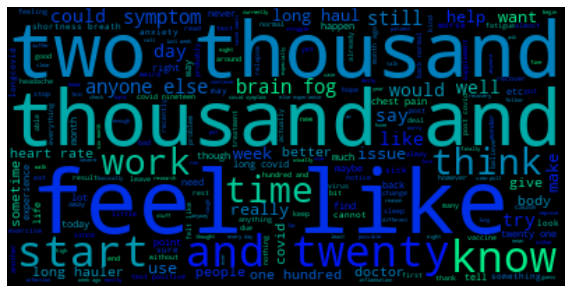

In [20]:
plot_wordcloud_from_tweets(preprocessed_reddit_posts)